In [1]:
import matplotlib.pyplot as plt
import tensorflow as tf
#from keras.backend.tensorflow_backend import set_session
import keras
import seaborn as sns
import pandas as pd
import sys, time
import numpy as np
import warnings


from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from pandas import datetime

from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler


#from keras.models import Sequential
#from keras.layers import Dense
#from keras.layers import LSTM
#from math import sqrt


warnings.filterwarnings("ignore")
print("python {}".format(sys.version))
print("keras version {}".format(keras.__version__))
print("tensorflow version {}".format(tf.__version__))

INFO:tensorflow:Using local port 19119
INFO:tensorflow:Using local port 15474
INFO:tensorflow:Using local port 24039
INFO:tensorflow:Using local port 20012
INFO:tensorflow:Using local port 23356
INFO:tensorflow:Using local port 18008
INFO:tensorflow:Using local port 15612
INFO:tensorflow:Using local port 21997
INFO:tensorflow:Using local port 17759
INFO:tensorflow:Using local port 19218
python 3.7.3 (default, Jul 25 2020, 13:03:44) 
[GCC 8.3.0]
keras version 2.4.3
tensorflow version 2.4.0-dev20201012


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  app.launch_new_instance()


In [2]:
# date-time parsing function for loading the dataset
def parser(x):
	return datetime.strptime('190'+x, '%Y-%m')
 
# frame a sequence as a supervised learning problem
def timeseries_to_supervised(data, lag=1):
	df = DataFrame(data)
	columns = [df.shift(i) for i in range(1, lag+1)]
	columns.append(df)
	df = concat(columns, axis=1)
	df.fillna(0, inplace=True)
	return df
 
# create a differenced series
def difference(dataset, interval=1):
	diff = list()
	for i in range(interval, len(dataset)):
		value = dataset[i] - dataset[i - interval]
		diff.append(value)
	return Series(diff)
 
# invert differenced value
def inverse_difference(history, yhat, interval=1):
	return yhat + history[-interval]
 
# scale train and test data to [0, 1]
def scale(train, test):
	# fit scaler
	scaler = MinMaxScaler(feature_range=(0, 0.9))
	scaler = scaler.fit(train)
	print(scaler.data_min_)
	print(scaler.data_max_)
	# transform train
	train = train.reshape(train.shape[0], train.shape[1])
	train_scaled = scaler.transform(train)
	# transform test
	test = test.reshape(test.shape[0], test.shape[1])
	test_scaled = scaler.transform(test)
	return scaler, train_scaled, test_scaled
 
# inverse scaling for a forecasted value
def invert_scale(scaler, X, value):
	new_row = [x for x in X] + [value]
	array = np.array(new_row)
	array = array.reshape(1, len(array))
	inverted = scaler.inverse_transform(array)
	return inverted[0, -1]
 
# fit an LSTM network to training data
def fit_lstm(train, batch_size, nb_epoch, neurons):
	X, y = train[:, 0:-1], train[:, -1]
	X = X.reshape(X.shape[0], 1, X.shape[1])
	print(X.shape)
	model = tf.keras.models.Sequential([])
	inp = keras.layers.Input(batch_shape= (batch_size, X.shape[1], X.shape[2]),name="input")
	rnn = keras.layers.LSTM(neurons, return_sequences=True, stateful=False,name="RNN")(inp)
	dens = keras.layers.Dense(1,name="dense")(rnn)#keras.layers.TimeDistributed(keras.layers.Dense(1,name="dense"))(rnn)
	model = keras.models.Model(inputs=[inp],outputs=[dens])
	model.compile(loss="mean_squared_error",
                  sample_weight_mode="temporal",
                  optimizer="adam")
	model.summary()
	model.fit(X, y, epochs=nb_epoch, batch_size=batch_size, verbose=0, shuffle=False)
	return model
 
# make a one-step forecast
def forecast_lstm(model, batch_size, X):
	X = X.reshape(1, 1, len(X))
	yhat = model.predict(X, batch_size=batch_size)
	return yhat[0,0]


In [3]:
def mean_absolute_percentage_error(y_true, y_pred): 
     return ((np.fabs(y_true - y_pred)/y_true).mean())

In [4]:
dataframe = read_csv('dataset.csv', usecols=[1,2,7], engine='python')

In [5]:
dataset = dataframe.values

In [6]:
dataset = dataset.astype('float32')
where_are_NaNs = np.isnan(dataset)
dataset[where_are_NaNs] = 0

In [7]:
newdataset1 = []
newdataset2 = []

for i in range(len(dataset)):
    if dataset[i,1]==39:
        a = dataset[i, 2]
        b = (dataset[i, 0]-1383260400000)/3600000
        newdataset1.append(a)
        newdataset2.append(b)

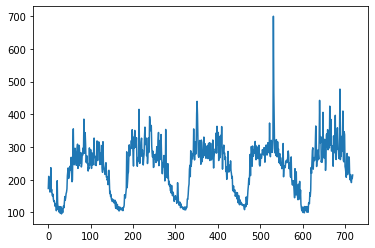

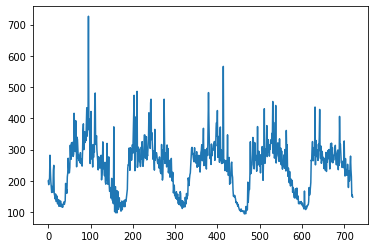

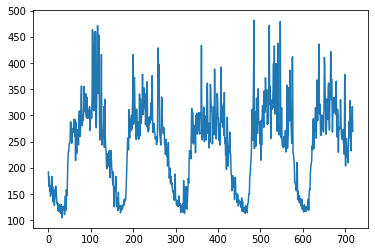

In [8]:
raw_values = np.asarray(newdataset1)
l=len(raw_values)
plt.plot(raw_values[:int(l/3)])
plt.show()
plt.plot(raw_values[int(l/3):-int(l/3)])
plt.show()
plt.plot(raw_values[-int(l/3):])
plt.show()

[-363.16381836 -363.16381836]
[373.3527832 373.3527832]


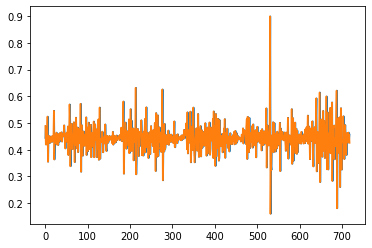

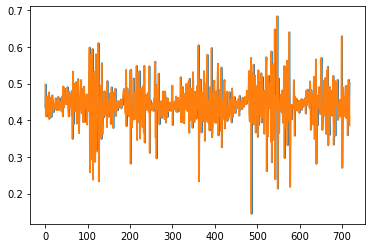

In [9]:
diff_values = difference(raw_values, 1)
 
# transform data to be supervised learning
supervised = timeseries_to_supervised(diff_values, 1)
supervised_values = supervised.values
 
# split data into train and test-sets
train, test = supervised_values[0:-int(l/3)], supervised_values[-int(l/3):]
 
# transform the scale of the data
scaler, train_scaled, test_scaled = scale(train, test)

plt.plot(train_scaled[:int(l/3)])
plt.show()
plt.plot(test_scaled[:int(l/3)])
plt.show()

In [10]:
hunits = 2

In [14]:
file_object =  open('results_dp_p3.csv', 'w')
file_object.write("Hunit; Seuil; Index; CalculatedData; ActualData; RetainedData; Transmitted \n")

76

In [15]:
for hunits in range(9,12):
    lstm_model = fit_lstm(train_scaled, 1, 1, hunits)
    # forecast the entire training dataset to build up state for forecasting
    train_reshaped = train_scaled[:, 0].reshape(len(train_scaled), 1, 1)
    lstm_model.predict(train_reshaped, batch_size=1)
    # walk-forward validation on the test data
    for k in range(1,140):
        predictions = list()
        X = test_scaled[0, 0:-1]
        X_diff_scaled = X
        count=0
        for i in range(1, len(test_scaled)):
            y_diff_scaled = forecast_lstm(lstm_model, 1, X_diff_scaled)
            # invert scaling
            y_diff = invert_scale(scaler, X_diff_scaled, y_diff_scaled)
            # invert differencing
            yhat = inverse_difference(raw_values, y_diff, len(test_scaled)+1-i)
            # store forecast
            expected = raw_values[len(train) + i + 1]
            if (np.fabs(yhat - expected)/expected) > (0.005*k) :
                X_diff_scaled = test_scaled[i, 0:-1]
                print('%d; %.3f; %d; %.2f; %.2f; %.2f; True \n' % (hunits, 0.5*k, i, yhat, expected, expected))
                file_object.write('%d; %.3f; %d; %.2f; %.2f; %.2f; True \n' % (hunits, 0.5*k, i, yhat, expected, expected))
            else :
                X_diff_scaled = y_diff_scaled
                print('%d; %.3f; %d; %.2f; %.2f; %.2f; False \n' % (hunits, 0.5*k, i, yhat, expected, yhat))
                file_object.write('%d; %.3f; %d; %.2f; %.2f; %.2f; False \n' % (hunits, 0.5*k, i, yhat, expected, yhat))

(1439, 1, 1)
Model: "model_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           [(1, 1, 1)]               0         
_________________________________________________________________
RNN (LSTM)                   (1, 1, 9)                 396       
_________________________________________________________________
dense (Dense)                (1, 1, 1)                 10        
Total params: 406
Trainable params: 406
Non-trainable params: 0
_________________________________________________________________
9; 0.500; 1; 187.89; 164.90; 164.90; True 

9; 0.500; 2; 170.12; 182.86; 182.86; True 

9; 0.500; 3; 175.05; 155.28; 155.28; True 

9; 0.500; 4; 155.72; 165.86; 165.86; True 

9; 0.500; 5; 157.96; 145.82; 145.82; True 

9; 0.500; 6; 144.92; 163.63; 163.63; True 

9; 0.500; 7; 157.12; 157.10; 157.12; False 

9; 0.500; 8; 153.08; 183.64; 183.64; True 

9; 0.500; 9; 179.61; 150.

9; 0.500; 170; 125.27; 113.80; 113.80; True 

9; 0.500; 171; 111.70; 120.21; 120.21; True 

9; 0.500; 172; 114.79; 127.20; 127.20; True 

9; 0.500; 173; 125.54; 119.74; 119.74; True 

9; 0.500; 174; 118.19; 122.18; 122.18; True 

9; 0.500; 175; 117.98; 122.27; 122.27; True 

9; 0.500; 176; 119.88; 129.19; 129.19; True 

9; 0.500; 177; 126.38; 127.81; 127.81; True 

9; 0.500; 178; 126.25; 138.56; 138.56; True 

9; 0.500; 179; 135.47; 128.90; 128.90; True 

9; 0.500; 180; 128.03; 135.24; 135.24; True 

9; 0.500; 181; 130.63; 141.16; 141.16; True 

9; 0.500; 182; 139.48; 138.94; 139.48; False 

9; 0.500; 183; 135.80; 150.56; 150.56; True 

9; 0.500; 184; 147.32; 177.58; 177.58; True 

9; 0.500; 185; 176.88; 211.60; 211.60; True 

9; 0.500; 186; 213.69; 233.16; 233.16; True 

9; 0.500; 187; 236.53; 256.86; 256.86; True 

9; 0.500; 188; 257.97; 255.96; 255.96; True 

9; 0.500; 189; 257.46; 234.33; 234.33; True 

9; 0.500; 190; 231.34; 310.91; 310.91; True 

9; 0.500; 191; 304.10; 261.68; 26

9; 0.500; 350; 295.07; 304.18; 304.18; True 

9; 0.500; 351; 298.52; 264.41; 264.41; True 

9; 0.500; 352; 265.09; 264.17; 265.09; False 

9; 0.500; 353; 261.47; 292.01; 292.01; True 

9; 0.500; 354; 289.13; 283.57; 283.57; True 

9; 0.500; 355; 285.81; 305.14; 305.14; True 

9; 0.500; 356; 300.76; 272.52; 272.52; True 

9; 0.500; 357; 273.63; 264.35; 264.35; True 

9; 0.500; 358; 255.51; 305.42; 305.42; True 

9; 0.500; 359; 301.09; 294.90; 294.90; True 

9; 0.500; 360; 299.55; 301.65; 301.65; True 

9; 0.500; 361; 296.89; 433.70; 433.70; True 

9; 0.500; 362; 432.10; 261.15; 261.15; True 

9; 0.500; 363; 281.99; 253.20; 253.20; True 

9; 0.500; 364; 218.07; 274.98; 274.98; True 

9; 0.500; 365; 270.70; 259.94; 259.94; True 

9; 0.500; 366; 261.08; 315.64; 315.64; True 

9; 0.500; 367; 310.04; 313.29; 313.29; True 

9; 0.500; 368; 320.57; 249.88; 249.88; True 

9; 0.500; 369; 246.62; 272.96; 272.96; True 

9; 0.500; 370; 258.41; 298.68; 298.68; True 

9; 0.500; 371; 300.06; 260.45; 26

9; 0.500; 532; 400.25; 314.37; 314.37; True 

9; 0.500; 533; 320.41; 432.48; 432.48; True 

9; 0.500; 534; 414.06; 302.59; 302.59; True 

9; 0.500; 535; 320.98; 314.23; 314.23; True 

9; 0.500; 536; 287.20; 309.53; 309.53; True 

9; 0.500; 537; 308.83; 398.66; 398.66; True 

9; 0.500; 538; 394.96; 349.90; 349.90; True 

9; 0.500; 539; 363.16; 269.97; 269.97; True 

9; 0.500; 540; 258.15; 270.37; 270.37; True 

9; 0.500; 541; 252.74; 437.94; 437.94; True 

9; 0.500; 542; 435.18; 270.20; 270.20; True 

9; 0.500; 543; 297.22; 271.65; 271.65; True 

9; 0.500; 544; 237.43; 262.53; 262.53; True 

9; 0.500; 545; 259.96; 281.99; 281.99; True 

9; 0.500; 546; 277.48; 282.76; 282.76; True 

9; 0.500; 547; 283.48; 479.34; 479.34; True 

9; 0.500; 548; 476.65; 290.76; 290.76; True 

9; 0.500; 549; 322.74; 256.76; 256.76; True 

9; 0.500; 550; 218.57; 314.41; 314.41; True 

9; 0.500; 551; 305.32; 250.34; 250.34; True 

9; 0.500; 552; 257.97; 241.90; 241.90; True 

9; 0.500; 553; 227.23; 244.27; 244


9; 0.500; 712; 289.93; 328.45; 328.45; True 

9; 0.500; 713; 333.15; 259.02; 259.02; True 

9; 0.500; 714; 261.63; 232.11; 232.11; True 

9; 0.500; 715; 216.44; 287.04; 287.04; True 

9; 0.500; 716; 279.26; 268.86; 268.86; True 

9; 0.500; 717; 276.00; 316.83; 316.83; True 

9; 0.500; 718; 310.65; 269.39; 269.39; True 

9; 1.000; 1; 187.89; 164.90; 164.90; True 

9; 1.000; 2; 170.12; 182.86; 182.86; True 

9; 1.000; 3; 175.05; 155.28; 155.28; True 

9; 1.000; 4; 155.72; 165.86; 165.86; True 

9; 1.000; 5; 157.96; 145.82; 145.82; True 

9; 1.000; 6; 144.92; 163.63; 163.63; True 

9; 1.000; 7; 157.12; 157.10; 157.12; False 

9; 1.000; 8; 153.08; 183.64; 183.64; True 

9; 1.000; 9; 179.61; 150.56; 150.56; True 

9; 1.000; 10; 152.57; 164.11; 164.11; True 

9; 1.000; 11; 155.19; 134.99; 134.99; True 

9; 1.000; 12; 134.63; 141.61; 141.61; True 

9; 1.000; 13; 133.42; 156.80; 156.80; True 

9; 1.000; 14; 155.18; 128.03; 128.03; True 

9; 1.000; 15; 127.98; 139.99; 139.99; True 

9; 1.000; 

9; 1.000; 176; 119.88; 129.19; 129.19; True 

9; 1.000; 177; 126.38; 127.81; 127.81; True 

9; 1.000; 178; 126.25; 138.56; 138.56; True 

9; 1.000; 179; 135.47; 128.90; 128.90; True 

9; 1.000; 180; 128.03; 135.24; 135.24; True 

9; 1.000; 181; 130.63; 141.16; 141.16; True 

9; 1.000; 182; 139.48; 138.94; 139.48; False 

9; 1.000; 183; 135.80; 150.56; 150.56; True 

9; 1.000; 184; 147.32; 177.58; 177.58; True 

9; 1.000; 185; 176.88; 211.60; 211.60; True 

9; 1.000; 186; 213.69; 233.16; 233.16; True 

9; 1.000; 187; 236.53; 256.86; 256.86; True 

9; 1.000; 188; 257.97; 255.96; 257.97; False 

9; 1.000; 189; 253.33; 234.33; 234.33; True 

9; 1.000; 190; 231.34; 310.91; 310.91; True 

9; 1.000; 191; 304.10; 261.68; 261.68; True 

9; 1.000; 192; 272.70; 257.18; 257.18; True 

9; 1.000; 193; 245.26; 292.71; 292.71; True 

9; 1.000; 194; 289.05; 269.87; 269.87; True 

9; 1.000; 195; 273.51; 293.54; 293.54; True 

9; 1.000; 196; 286.51; 299.98; 299.98; True 

9; 1.000; 197; 301.46; 273.16; 2

9; 1.000; 356; 300.76; 272.52; 272.52; True 

9; 1.000; 357; 273.63; 264.35; 264.35; True 

9; 1.000; 358; 255.51; 305.42; 305.42; True 

9; 1.000; 359; 301.09; 294.90; 294.90; True 

9; 1.000; 360; 299.55; 301.65; 299.55; False 

9; 1.000; 361; 299.67; 433.70; 433.70; True 

9; 1.000; 362; 432.10; 261.15; 261.15; True 

9; 1.000; 363; 281.99; 253.20; 253.20; True 

9; 1.000; 364; 218.07; 274.98; 274.98; True 

9; 1.000; 365; 270.70; 259.94; 259.94; True 

9; 1.000; 366; 261.08; 315.64; 315.64; True 

9; 1.000; 367; 310.04; 313.29; 313.29; True 

9; 1.000; 368; 320.57; 249.88; 249.88; True 

9; 1.000; 369; 246.62; 272.96; 272.96; True 

9; 1.000; 370; 258.41; 298.68; 298.68; True 

9; 1.000; 371; 300.06; 260.45; 260.45; True 

9; 1.000; 372; 262.31; 253.11; 253.11; True 

9; 1.000; 373; 243.24; 273.79; 273.79; True 

9; 1.000; 374; 269.61; 347.64; 347.64; True 

9; 1.000; 375; 348.58; 361.60; 361.60; True 

9; 1.000; 376; 372.14; 279.88; 279.88; True 

9; 1.000; 377; 279.60; 265.14; 26

9; 1.000; 534; 414.06; 302.59; 302.59; True 

9; 1.000; 535; 320.98; 314.23; 314.23; True 

9; 1.000; 536; 287.20; 309.53; 309.53; True 

9; 1.000; 537; 308.83; 398.66; 398.66; True 

9; 1.000; 538; 394.96; 349.90; 349.90; True 

9; 1.000; 539; 363.16; 269.97; 269.97; True 

9; 1.000; 540; 258.15; 270.37; 270.37; True 

9; 1.000; 541; 252.74; 437.94; 437.94; True 

9; 1.000; 542; 435.18; 270.20; 270.20; True 

9; 1.000; 543; 297.22; 271.65; 271.65; True 

9; 1.000; 544; 237.43; 262.53; 262.53; True 

9; 1.000; 545; 259.96; 281.99; 281.99; True 

9; 1.000; 546; 277.48; 282.76; 282.76; True 

9; 1.000; 547; 283.48; 479.34; 479.34; True 

9; 1.000; 548; 476.65; 290.76; 290.76; True 

9; 1.000; 549; 322.74; 256.76; 256.76; True 

9; 1.000; 550; 218.57; 314.41; 314.41; True 

9; 1.000; 551; 305.32; 250.34; 250.34; True 

9; 1.000; 552; 257.97; 241.90; 241.90; True 

9; 1.000; 553; 227.23; 244.27; 244.27; True 

9; 1.000; 554; 239.89; 238.05; 239.89; False 

9; 1.000; 555; 234.42; 259.20; 25

9; 1.000; 717; 276.00; 316.83; 316.83; True 

9; 1.000; 718; 310.65; 269.39; 269.39; True 

9; 1.500; 1; 187.89; 164.90; 164.90; True 

9; 1.500; 2; 170.12; 182.86; 182.86; True 

9; 1.500; 3; 175.05; 155.28; 155.28; True 

9; 1.500; 4; 155.72; 165.86; 165.86; True 

9; 1.500; 5; 157.96; 145.82; 145.82; True 

9; 1.500; 6; 144.92; 163.63; 163.63; True 

9; 1.500; 7; 157.12; 157.10; 157.12; False 

9; 1.500; 8; 153.08; 183.64; 183.64; True 

9; 1.500; 9; 179.61; 150.56; 150.56; True 

9; 1.500; 10; 152.57; 164.11; 164.11; True 

9; 1.500; 11; 155.19; 134.99; 134.99; True 

9; 1.500; 12; 134.63; 141.61; 141.61; True 

9; 1.500; 13; 133.42; 156.80; 156.80; True 

9; 1.500; 14; 155.18; 128.03; 128.03; True 

9; 1.500; 15; 127.98; 139.99; 139.99; True 

9; 1.500; 16; 131.87; 159.88; 159.88; True 

9; 1.500; 17; 159.24; 164.71; 164.71; True 

9; 1.500; 18; 165.51; 162.61; 162.61; True 

9; 1.500; 19; 160.67; 144.54; 144.54; True 

9; 1.500; 20; 141.33; 132.65; 132.65; True 

9; 1.500; 21; 12

9; 1.500; 185; 176.88; 211.60; 211.60; True 

9; 1.500; 186; 213.69; 233.16; 233.16; True 

9; 1.500; 187; 236.53; 256.86; 256.86; True 

9; 1.500; 188; 257.97; 255.96; 257.97; False 

9; 1.500; 189; 253.33; 234.33; 234.33; True 

9; 1.500; 190; 231.34; 310.91; 310.91; True 

9; 1.500; 191; 304.10; 261.68; 261.68; True 

9; 1.500; 192; 272.70; 257.18; 257.18; True 

9; 1.500; 193; 245.26; 292.71; 292.71; True 

9; 1.500; 194; 289.05; 269.87; 269.87; True 

9; 1.500; 195; 273.51; 293.54; 293.54; True 

9; 1.500; 196; 286.51; 299.98; 299.98; True 

9; 1.500; 197; 301.46; 273.16; 273.16; True 

9; 1.500; 198; 271.50; 303.02; 303.02; True 

9; 1.500; 199; 295.26; 340.30; 340.30; True 

9; 1.500; 200; 342.91; 416.10; 416.10; True 

9; 1.500; 201; 420.06; 283.07; 283.07; True 

9; 1.500; 202; 293.96; 360.62; 360.62; True 

9; 1.500; 203; 332.99; 372.32; 372.32; True 

9; 1.500; 204; 383.52; 320.83; 320.83; True 

9; 1.500; 205; 320.14; 298.09; 298.09; True 

9; 1.500; 206; 285.75; 281.96; 28

9; 1.500; 366; 261.08; 315.64; 315.64; True 

9; 1.500; 367; 310.04; 313.29; 310.04; False 

9; 1.500; 368; 309.43; 249.88; 249.88; True 

9; 1.500; 369; 246.62; 272.96; 272.96; True 

9; 1.500; 370; 258.41; 298.68; 298.68; True 

9; 1.500; 371; 300.06; 260.45; 260.45; True 

9; 1.500; 372; 262.31; 253.11; 253.11; True 

9; 1.500; 373; 243.24; 273.79; 273.79; True 

9; 1.500; 374; 269.61; 347.64; 347.64; True 

9; 1.500; 375; 348.58; 361.60; 361.60; True 

9; 1.500; 376; 372.14; 279.88; 279.88; True 

9; 1.500; 377; 279.60; 265.14; 265.14; True 

9; 1.500; 378; 247.17; 273.13; 273.13; True 

9; 1.500; 379; 267.59; 237.82; 237.82; True 

9; 1.500; 380; 236.45; 285.64; 285.64; True 

9; 1.500; 381; 276.31; 248.44; 248.44; True 

9; 1.500; 382; 254.30; 359.11; 359.11; True 

9; 1.500; 383; 349.43; 349.07; 349.43; False 

9; 1.500; 384; 344.46; 308.29; 308.29; True 

9; 1.500; 385; 303.62; 316.73; 316.73; True 

9; 1.500; 386; 306.39; 304.20; 306.39; False 

9; 1.500; 387; 299.47; 245.34; 

9; 1.500; 545; 259.96; 281.99; 281.99; True 

9; 1.500; 546; 277.48; 282.76; 282.76; True 

9; 1.500; 547; 283.48; 479.34; 479.34; True 

9; 1.500; 548; 476.65; 290.76; 290.76; True 

9; 1.500; 549; 322.74; 256.76; 256.76; True 

9; 1.500; 550; 218.57; 314.41; 314.41; True 

9; 1.500; 551; 305.32; 250.34; 250.34; True 

9; 1.500; 552; 257.97; 241.90; 241.90; True 

9; 1.500; 553; 227.23; 244.27; 244.27; True 

9; 1.500; 554; 239.89; 238.05; 239.89; False 

9; 1.500; 555; 234.42; 259.20; 259.20; True 

9; 1.500; 556; 255.23; 243.69; 243.69; True 

9; 1.500; 557; 244.72; 259.01; 259.01; True 

9; 1.500; 558; 253.33; 240.09; 240.09; True 

9; 1.500; 559; 240.06; 271.41; 271.41; True 

9; 1.500; 560; 265.11; 230.02; 230.02; True 

9; 1.500; 561; 232.90; 255.97; 255.97; True 

9; 1.500; 562; 245.51; 272.51; 272.51; True 

9; 1.500; 563; 274.41; 357.79; 357.79; True 

9; 1.500; 564; 357.98; 237.22; 237.22; True 

9; 1.500; 565; 249.80; 259.76; 259.76; True 

9; 1.500; 566; 234.49; 268.77; 26

9; 2.000; 5; 157.96; 145.82; 145.82; True 

9; 2.000; 6; 144.92; 163.63; 163.63; True 

9; 2.000; 7; 157.12; 157.10; 157.12; False 

9; 2.000; 8; 153.08; 183.64; 183.64; True 

9; 2.000; 9; 179.61; 150.56; 150.56; True 

9; 2.000; 10; 152.57; 164.11; 164.11; True 

9; 2.000; 11; 155.19; 134.99; 134.99; True 

9; 2.000; 12; 134.63; 141.61; 141.61; True 

9; 2.000; 13; 133.42; 156.80; 156.80; True 

9; 2.000; 14; 155.18; 128.03; 128.03; True 

9; 2.000; 15; 127.98; 139.99; 139.99; True 

9; 2.000; 16; 131.87; 159.88; 159.88; True 

9; 2.000; 17; 159.24; 164.71; 164.71; True 

9; 2.000; 18; 165.51; 162.61; 165.51; False 

9; 2.000; 19; 159.93; 144.54; 144.54; True 

9; 2.000; 20; 141.33; 132.65; 132.65; True 

9; 2.000; 21; 126.50; 133.63; 133.63; True 

9; 2.000; 22; 128.61; 125.03; 125.03; True 

9; 2.000; 23; 122.37; 117.65; 117.65; True 

9; 2.000; 24; 113.24; 130.97; 130.97; True 

9; 2.000; 25; 126.78; 128.98; 126.78; False 

9; 2.000; 26; 125.38; 115.82; 115.82; True 

9; 2.000; 27

9; 2.000; 185; 176.88; 211.60; 211.60; True 

9; 2.000; 186; 213.69; 233.16; 233.16; True 

9; 2.000; 187; 236.53; 256.86; 256.86; True 

9; 2.000; 188; 257.97; 255.96; 257.97; False 

9; 2.000; 189; 253.33; 234.33; 234.33; True 

9; 2.000; 190; 231.34; 310.91; 310.91; True 

9; 2.000; 191; 304.10; 261.68; 261.68; True 

9; 2.000; 192; 272.70; 257.18; 257.18; True 

9; 2.000; 193; 245.26; 292.71; 292.71; True 

9; 2.000; 194; 289.05; 269.87; 269.87; True 

9; 2.000; 195; 273.51; 293.54; 293.54; True 

9; 2.000; 196; 286.51; 299.98; 299.98; True 

9; 2.000; 197; 301.46; 273.16; 273.16; True 

9; 2.000; 198; 271.50; 303.02; 303.02; True 

9; 2.000; 199; 295.26; 340.30; 340.30; True 

9; 2.000; 200; 342.91; 416.10; 416.10; True 

9; 2.000; 201; 420.06; 283.07; 283.07; True 

9; 2.000; 202; 293.96; 360.62; 360.62; True 

9; 2.000; 203; 332.99; 372.32; 372.32; True 

9; 2.000; 204; 383.52; 320.83; 320.83; True 

9; 2.000; 205; 320.14; 298.09; 298.09; True 

9; 2.000; 206; 285.75; 281.96; 28

9; 2.000; 367; 310.04; 313.29; 310.04; False 

9; 2.000; 368; 309.43; 249.88; 249.88; True 

9; 2.000; 369; 246.62; 272.96; 272.96; True 

9; 2.000; 370; 258.41; 298.68; 298.68; True 

9; 2.000; 371; 300.06; 260.45; 260.45; True 

9; 2.000; 372; 262.31; 253.11; 253.11; True 

9; 2.000; 373; 243.24; 273.79; 273.79; True 

9; 2.000; 374; 269.61; 347.64; 347.64; True 

9; 2.000; 375; 348.58; 361.60; 361.60; True 

9; 2.000; 376; 372.14; 279.88; 279.88; True 

9; 2.000; 377; 279.60; 265.14; 265.14; True 

9; 2.000; 378; 247.17; 273.13; 273.13; True 

9; 2.000; 379; 267.59; 237.82; 237.82; True 

9; 2.000; 380; 236.45; 285.64; 285.64; True 

9; 2.000; 381; 276.31; 248.44; 248.44; True 

9; 2.000; 382; 254.30; 359.11; 359.11; True 

9; 2.000; 383; 349.43; 349.07; 349.43; False 

9; 2.000; 384; 344.46; 308.29; 308.29; True 

9; 2.000; 385; 303.62; 316.73; 316.73; True 

9; 2.000; 386; 306.39; 304.20; 306.39; False 

9; 2.000; 387; 299.47; 245.34; 245.34; True 

9; 2.000; 388; 240.21; 283.30; 

9; 2.000; 550; 218.57; 314.41; 314.41; True 

9; 2.000; 551; 305.32; 250.34; 250.34; True 

9; 2.000; 552; 257.97; 241.90; 241.90; True 

9; 2.000; 553; 227.23; 244.27; 244.27; True 

9; 2.000; 554; 239.89; 238.05; 239.89; False 

9; 2.000; 555; 234.42; 259.20; 259.20; True 

9; 2.000; 556; 255.23; 243.69; 243.69; True 

9; 2.000; 557; 244.72; 259.01; 259.01; True 

9; 2.000; 558; 253.33; 240.09; 240.09; True 

9; 2.000; 559; 240.06; 271.41; 271.41; True 

9; 2.000; 560; 265.11; 230.02; 230.02; True 

9; 2.000; 561; 232.90; 255.97; 255.97; True 

9; 2.000; 562; 245.51; 272.51; 272.51; True 

9; 2.000; 563; 274.41; 357.79; 357.79; True 

9; 2.000; 564; 357.98; 237.22; 237.22; True 

9; 2.000; 565; 249.80; 259.76; 259.76; True 

9; 2.000; 566; 234.49; 268.77; 268.77; True 

9; 2.000; 567; 270.05; 352.96; 352.96; True 

9; 2.000; 568; 351.78; 299.18; 299.18; True 

9; 2.000; 569; 311.56; 289.28; 289.28; True 

9; 2.000; 570; 276.52; 386.23; 386.23; True 

9; 2.000; 571; 381.59; 294.31; 29

9; 2.500; 12; 134.63; 141.61; 141.61; True 

9; 2.500; 13; 133.42; 156.80; 156.80; True 

9; 2.500; 14; 155.18; 128.03; 128.03; True 

9; 2.500; 15; 127.98; 139.99; 139.99; True 

9; 2.500; 16; 131.87; 159.88; 159.88; True 

9; 2.500; 17; 159.24; 164.71; 164.71; True 

9; 2.500; 18; 165.51; 162.61; 165.51; False 

9; 2.500; 19; 159.93; 144.54; 144.54; True 

9; 2.500; 20; 141.33; 132.65; 132.65; True 

9; 2.500; 21; 126.50; 133.63; 133.63; True 

9; 2.500; 22; 128.61; 125.03; 125.03; True 

9; 2.500; 23; 122.37; 117.65; 117.65; True 

9; 2.500; 24; 113.24; 130.97; 130.97; True 

9; 2.500; 25; 126.78; 128.98; 126.78; False 

9; 2.500; 26; 125.38; 115.82; 115.82; True 

9; 2.500; 27; 112.62; 125.53; 125.53; True 

9; 2.500; 28; 120.29; 121.99; 120.29; False 

9; 2.500; 29; 118.20; 113.12; 113.12; True 

9; 2.500; 30; 109.64; 129.49; 129.49; True 

9; 2.500; 31; 125.03; 116.59; 116.59; True 

9; 2.500; 32; 116.75; 104.21; 104.21; True 

9; 2.500; 33; 99.01; 117.93; 117.93; True 

9; 2.500


9; 2.500; 195; 273.51; 293.54; 293.54; True 

9; 2.500; 196; 286.51; 299.98; 299.98; True 

9; 2.500; 197; 301.46; 273.16; 273.16; True 

9; 2.500; 198; 271.50; 303.02; 303.02; True 

9; 2.500; 199; 295.26; 340.30; 340.30; True 

9; 2.500; 200; 342.91; 416.10; 416.10; True 

9; 2.500; 201; 420.06; 283.07; 283.07; True 

9; 2.500; 202; 293.96; 360.62; 360.62; True 

9; 2.500; 203; 332.99; 372.32; 372.32; True 

9; 2.500; 204; 383.52; 320.83; 320.83; True 

9; 2.500; 205; 320.14; 298.09; 298.09; True 

9; 2.500; 206; 285.75; 281.96; 285.75; False 

9; 2.500; 207; 276.86; 254.30; 254.30; True 

9; 2.500; 208; 248.50; 311.97; 311.97; True 

9; 2.500; 209; 304.06; 277.93; 277.93; True 

9; 2.500; 210; 285.57; 261.31; 261.31; True 

9; 2.500; 211; 252.21; 287.58; 287.58; True 

9; 2.500; 212; 281.70; 254.98; 254.98; True 

9; 2.500; 213; 256.94; 257.10; 256.94; False 

9; 2.500; 214; 254.63; 255.18; 254.63; False 

9; 2.500; 215; 251.90; 340.86; 340.86; True 

9; 2.500; 216; 337.68; 260.91;

9; 2.500; 378; 247.17; 273.13; 273.13; True 

9; 2.500; 379; 267.59; 237.82; 237.82; True 

9; 2.500; 380; 236.45; 285.64; 285.64; True 

9; 2.500; 381; 276.31; 248.44; 248.44; True 

9; 2.500; 382; 254.30; 359.11; 359.11; True 

9; 2.500; 383; 349.43; 349.07; 349.43; False 

9; 2.500; 384; 344.46; 308.29; 308.29; True 

9; 2.500; 385; 303.62; 316.73; 316.73; True 

9; 2.500; 386; 306.39; 304.20; 306.39; False 

9; 2.500; 387; 299.47; 245.34; 245.34; True 

9; 2.500; 388; 240.21; 283.30; 283.30; True 

9; 2.500; 389; 269.60; 282.70; 282.70; True 

9; 2.500; 390; 286.78; 316.88; 316.88; True 

9; 2.500; 391; 313.93; 262.55; 262.55; True 

9; 2.500; 392; 265.95; 388.35; 388.35; True 

9; 2.500; 393; 375.49; 314.81; 314.81; True 

9; 2.500; 394; 334.55; 264.84; 264.84; True 

9; 2.500; 395; 248.40; 286.92; 286.92; True 

9; 2.500; 396; 274.87; 255.05; 255.05; True 

9; 2.500; 397; 256.25; 288.76; 288.76; True 

9; 2.500; 398; 280.06; 341.65; 341.65; True 

9; 2.500; 399; 344.97; 334.67; 3

9; 2.500; 559; 240.06; 271.41; 271.41; True 

9; 2.500; 560; 265.11; 230.02; 230.02; True 

9; 2.500; 561; 232.90; 255.97; 255.97; True 

9; 2.500; 562; 245.51; 272.51; 272.51; True 

9; 2.500; 563; 274.41; 357.79; 357.79; True 

9; 2.500; 564; 357.98; 237.22; 237.22; True 

9; 2.500; 565; 249.80; 259.76; 259.76; True 

9; 2.500; 566; 234.49; 268.77; 268.77; True 

9; 2.500; 567; 270.05; 352.96; 352.96; True 

9; 2.500; 568; 351.78; 299.18; 299.18; True 

9; 2.500; 569; 311.56; 289.28; 289.28; True 

9; 2.500; 570; 276.52; 386.23; 386.23; True 

9; 2.500; 571; 381.59; 294.31; 294.31; True 

9; 2.500; 572; 308.97; 305.71; 308.97; False 

9; 2.500; 573; 305.56; 269.88; 269.88; True 

9; 2.500; 574; 269.13; 246.67; 246.67; True 

9; 2.500; 575; 237.25; 407.56; 407.56; True 

9; 2.500; 576; 400.47; 411.94; 411.94; True 

9; 2.500; 577; 437.79; 227.28; 227.28; True 

9; 2.500; 578; 225.24; 226.42; 225.24; False 

9; 2.500; 579; 223.21; 216.98; 216.98; True 

9; 2.500; 580; 213.99; 206.01; 2

9; 3.000; 25; 126.78; 128.98; 126.78; False 

9; 3.000; 26; 125.38; 115.82; 115.82; True 

9; 3.000; 27; 112.62; 125.53; 125.53; True 

9; 3.000; 28; 120.29; 121.99; 120.29; False 

9; 3.000; 29; 118.20; 113.12; 113.12; True 

9; 3.000; 30; 109.64; 129.49; 129.49; True 

9; 3.000; 31; 125.03; 116.59; 116.59; True 

9; 3.000; 32; 116.75; 104.21; 104.21; True 

9; 3.000; 33; 99.01; 117.93; 117.93; True 

9; 3.000; 34; 112.83; 125.86; 125.86; True 

9; 3.000; 35; 125.53; 120.26; 120.26; True 

9; 3.000; 36; 118.88; 125.25; 125.25; True 

9; 3.000; 37; 121.39; 127.11; 127.11; True 

9; 3.000; 38; 125.19; 110.70; 110.70; True 

9; 3.000; 39; 108.21; 127.30; 127.30; True 

9; 3.000; 40; 121.46; 145.78; 145.78; True 

9; 3.000; 41; 145.99; 118.40; 118.40; True 

9; 3.000; 42; 118.95; 158.15; 158.15; True 

9; 3.000; 43; 150.29; 154.10; 150.29; False 

9; 3.000; 44; 149.83; 147.14; 149.83; False 

9; 3.000; 45; 143.52; 179.78; 179.78; True 

9; 3.000; 46; 175.67; 214.89; 214.89; True 

9; 3.00

9; 3.000; 209; 304.06; 277.93; 277.93; True 

9; 3.000; 210; 285.57; 261.31; 261.31; True 

9; 3.000; 211; 252.21; 287.58; 287.58; True 

9; 3.000; 212; 281.70; 254.98; 254.98; True 

9; 3.000; 213; 256.94; 257.10; 256.94; False 

9; 3.000; 214; 254.63; 255.18; 254.63; False 

9; 3.000; 215; 251.90; 340.86; 340.86; True 

9; 3.000; 216; 337.68; 260.91; 260.91; True 

9; 3.000; 217; 273.56; 330.92; 330.92; True 

9; 3.000; 218; 313.29; 291.17; 291.17; True 

9; 3.000; 219; 301.02; 284.99; 284.99; True 

9; 3.000; 220; 274.83; 304.45; 304.45; True 

9; 3.000; 221; 300.49; 304.43; 300.49; False 

9; 3.000; 222; 300.87; 378.65; 378.65; True 

9; 3.000; 223; 375.81; 301.69; 301.69; True 

9; 3.000; 224; 312.30; 309.94; 312.30; False 

9; 3.000; 225; 309.05; 316.73; 309.05; False 

9; 3.000; 226; 313.73; 352.38; 352.38; True 

9; 3.000; 227; 350.79; 320.55; 320.55; True 

9; 3.000; 228; 324.21; 333.68; 324.21; False 

9; 3.000; 229; 331.52; 282.30; 282.30; True 

9; 3.000; 230; 281.87; 300.2

9; 3.000; 390; 286.78; 316.88; 316.88; True 

9; 3.000; 391; 313.93; 262.55; 262.55; True 

9; 3.000; 392; 265.95; 388.35; 388.35; True 

9; 3.000; 393; 375.49; 314.81; 314.81; True 

9; 3.000; 394; 334.55; 264.84; 264.84; True 

9; 3.000; 395; 248.40; 286.92; 286.92; True 

9; 3.000; 396; 274.87; 255.05; 255.05; True 

9; 3.000; 397; 256.25; 288.76; 288.76; True 

9; 3.000; 398; 280.06; 341.65; 341.65; True 

9; 3.000; 399; 344.97; 334.67; 334.67; True 

9; 3.000; 400; 341.44; 293.94; 293.94; True 

9; 3.000; 401; 289.82; 294.35; 289.82; False 

9; 3.000; 402; 290.76; 252.46; 252.46; True 

9; 3.000; 403; 249.70; 281.53; 281.53; True 

9; 3.000; 404; 270.98; 282.73; 282.73; True 

9; 3.000; 405; 285.20; 243.31; 243.31; True 

9; 3.000; 406; 240.70; 301.55; 301.55; True 

9; 3.000; 407; 291.46; 392.27; 392.27; True 

9; 3.000; 408; 400.01; 322.37; 322.37; True 

9; 3.000; 409; 335.92; 286.84; 286.84; True 

9; 3.000; 410; 271.08; 300.93; 300.93; True 

9; 3.000; 411; 291.55; 277.53; 27

9; 3.000; 568; 351.78; 299.18; 299.18; True 

9; 3.000; 569; 311.56; 289.28; 289.28; True 

9; 3.000; 570; 276.52; 386.23; 386.23; True 

9; 3.000; 571; 381.59; 294.31; 294.31; True 

9; 3.000; 572; 308.97; 305.71; 308.97; False 

9; 3.000; 573; 305.56; 269.88; 269.88; True 

9; 3.000; 574; 269.13; 246.67; 246.67; True 

9; 3.000; 575; 237.25; 407.56; 407.56; True 

9; 3.000; 576; 400.47; 411.94; 400.47; False 

9; 3.000; 577; 407.80; 227.28; 227.28; True 

9; 3.000; 578; 225.24; 226.42; 225.24; False 

9; 3.000; 579; 223.21; 216.98; 223.21; False 

9; 3.000; 580; 213.56; 206.01; 206.01; True 

9; 3.000; 581; 201.44; 172.12; 172.12; True 

9; 3.000; 582; 167.28; 170.76; 167.28; False 

9; 3.000; 583; 167.04; 168.86; 167.04; False 

9; 3.000; 584; 165.35; 159.56; 159.56; True 

9; 3.000; 585; 156.38; 155.94; 156.38; False 

9; 3.000; 586; 152.53; 209.81; 209.81; True 

9; 3.000; 587; 206.31; 209.89; 206.31; False 

9; 3.000; 588; 206.42; 139.20; 139.20; True 

9; 3.000; 589; 136.39; 155

9; 3.500; 33; 99.01; 117.93; 117.93; True 

9; 3.500; 34; 112.83; 125.86; 125.86; True 

9; 3.500; 35; 125.53; 120.26; 120.26; True 

9; 3.500; 36; 118.88; 125.25; 125.25; True 

9; 3.500; 37; 121.39; 127.11; 127.11; True 

9; 3.500; 38; 125.19; 110.70; 110.70; True 

9; 3.500; 39; 108.21; 127.30; 127.30; True 

9; 3.500; 40; 121.46; 145.78; 145.78; True 

9; 3.500; 41; 145.99; 118.40; 118.40; True 

9; 3.500; 42; 118.95; 158.15; 158.15; True 

9; 3.500; 43; 150.29; 154.10; 150.29; False 

9; 3.500; 44; 149.83; 147.14; 149.83; False 

9; 3.500; 45; 143.52; 179.78; 179.78; True 

9; 3.500; 46; 175.67; 214.89; 214.89; True 

9; 3.500; 47; 218.01; 231.35; 231.35; True 

9; 3.500; 48; 234.92; 231.37; 234.92; False 

9; 3.500; 49; 229.19; 246.53; 246.53; True 

9; 3.500; 50; 243.70; 247.19; 243.70; False 

9; 3.500; 51; 243.84; 249.18; 243.84; False 

9; 3.500; 52; 245.74; 287.42; 287.42; True 

9; 3.500; 53; 284.96; 287.82; 284.96; False 

9; 3.500; 54; 284.53; 274.19; 274.19; True 

9; 3.

9; 3.500; 212; 281.70; 254.98; 254.98; True 

9; 3.500; 213; 256.94; 257.10; 256.94; False 

9; 3.500; 214; 254.63; 255.18; 254.63; False 

9; 3.500; 215; 251.90; 340.86; 340.86; True 

9; 3.500; 216; 337.68; 260.91; 260.91; True 

9; 3.500; 217; 273.56; 330.92; 330.92; True 

9; 3.500; 218; 313.29; 291.17; 291.17; True 

9; 3.500; 219; 301.02; 284.99; 284.99; True 

9; 3.500; 220; 274.83; 304.45; 304.45; True 

9; 3.500; 221; 300.49; 304.43; 300.49; False 

9; 3.500; 222; 300.87; 378.65; 378.65; True 

9; 3.500; 223; 375.81; 301.69; 301.69; True 

9; 3.500; 224; 312.30; 309.94; 312.30; False 

9; 3.500; 225; 309.05; 316.73; 309.05; False 

9; 3.500; 226; 313.73; 352.38; 352.38; True 

9; 3.500; 227; 350.79; 320.55; 320.55; True 

9; 3.500; 228; 324.21; 333.68; 324.21; False 

9; 3.500; 229; 331.52; 282.30; 282.30; True 

9; 3.500; 230; 281.87; 300.25; 300.25; True 

9; 3.500; 231; 287.94; 342.04; 342.04; True 

9; 3.500; 232; 342.48; 278.63; 278.63; True 

9; 3.500; 233; 283.41; 364.2

9; 3.500; 391; 313.93; 262.55; 262.55; True 

9; 3.500; 392; 265.95; 388.35; 388.35; True 

9; 3.500; 393; 375.49; 314.81; 314.81; True 

9; 3.500; 394; 334.55; 264.84; 264.84; True 

9; 3.500; 395; 248.40; 286.92; 286.92; True 

9; 3.500; 396; 274.87; 255.05; 255.05; True 

9; 3.500; 397; 256.25; 288.76; 288.76; True 

9; 3.500; 398; 280.06; 341.65; 341.65; True 

9; 3.500; 399; 344.97; 334.67; 344.97; False 

9; 3.500; 400; 332.44; 293.94; 293.94; True 

9; 3.500; 401; 289.82; 294.35; 289.82; False 

9; 3.500; 402; 290.76; 252.46; 252.46; True 

9; 3.500; 403; 249.70; 281.53; 281.53; True 

9; 3.500; 404; 270.98; 282.73; 282.73; True 

9; 3.500; 405; 285.20; 243.31; 243.31; True 

9; 3.500; 406; 240.70; 301.55; 301.55; True 

9; 3.500; 407; 291.46; 392.27; 392.27; True 

9; 3.500; 408; 400.01; 322.37; 322.37; True 

9; 3.500; 409; 335.92; 286.84; 286.84; True 

9; 3.500; 410; 271.08; 300.93; 300.93; True 

9; 3.500; 411; 291.55; 277.53; 277.53; True 

9; 3.500; 412; 277.28; 310.51; 3

9; 3.500; 574; 269.13; 246.67; 246.67; True 

9; 3.500; 575; 237.25; 407.56; 407.56; True 

9; 3.500; 576; 400.47; 411.94; 400.47; False 

9; 3.500; 577; 407.80; 227.28; 227.28; True 

9; 3.500; 578; 225.24; 226.42; 225.24; False 

9; 3.500; 579; 223.21; 216.98; 223.21; False 

9; 3.500; 580; 213.56; 206.01; 206.01; True 

9; 3.500; 581; 201.44; 172.12; 172.12; True 

9; 3.500; 582; 167.28; 170.76; 167.28; False 

9; 3.500; 583; 167.04; 168.86; 167.04; False 

9; 3.500; 584; 165.35; 159.56; 159.56; True 

9; 3.500; 585; 156.38; 155.94; 156.38; False 

9; 3.500; 586; 152.53; 209.81; 209.81; True 

9; 3.500; 587; 206.31; 209.89; 206.31; False 

9; 3.500; 588; 206.42; 139.20; 139.20; True 

9; 3.500; 589; 136.39; 155.32; 155.32; True 

9; 3.500; 590; 139.42; 143.05; 139.42; False 

9; 3.500; 591; 137.30; 134.49; 137.30; False 

9; 3.500; 592; 130.61; 146.71; 146.71; True 

9; 3.500; 593; 142.31; 132.51; 132.51; True 

9; 3.500; 594; 131.92; 137.10; 137.10; True 

9; 3.500; 595; 131.66; 14

9; 4.000; 40; 121.46; 145.78; 145.78; True 

9; 4.000; 41; 145.99; 118.40; 118.40; True 

9; 4.000; 42; 118.95; 158.15; 158.15; True 

9; 4.000; 43; 150.29; 154.10; 150.29; False 

9; 4.000; 44; 149.83; 147.14; 149.83; False 

9; 4.000; 45; 143.52; 179.78; 179.78; True 

9; 4.000; 46; 175.67; 214.89; 214.89; True 

9; 4.000; 47; 218.01; 231.35; 231.35; True 

9; 4.000; 48; 234.92; 231.37; 234.92; False 

9; 4.000; 49; 229.19; 246.53; 246.53; True 

9; 4.000; 50; 243.70; 247.19; 243.70; False 

9; 4.000; 51; 243.84; 249.18; 243.84; False 

9; 4.000; 52; 245.74; 287.42; 287.42; True 

9; 4.000; 53; 284.96; 287.82; 284.96; False 

9; 4.000; 54; 284.53; 274.19; 284.53; False 

9; 4.000; 55; 270.75; 246.86; 246.86; True 

9; 4.000; 56; 241.52; 274.85; 274.85; True 

9; 4.000; 57; 266.99; 266.50; 266.99; False 

9; 4.000; 58; 262.23; 268.07; 262.23; False 

9; 4.000; 59; 264.45; 270.03; 264.45; False 

9; 4.000; 60; 266.54; 292.87; 292.87; True 

9; 4.000; 61; 290.40; 287.78; 290.40; False 


9; 4.000; 219; 301.02; 284.99; 284.99; True 

9; 4.000; 220; 274.83; 304.45; 304.45; True 

9; 4.000; 221; 300.49; 304.43; 300.49; False 

9; 4.000; 222; 300.87; 378.65; 378.65; True 

9; 4.000; 223; 375.81; 301.69; 301.69; True 

9; 4.000; 224; 312.30; 309.94; 312.30; False 

9; 4.000; 225; 309.05; 316.73; 309.05; False 

9; 4.000; 226; 313.73; 352.38; 352.38; True 

9; 4.000; 227; 350.79; 320.55; 320.55; True 

9; 4.000; 228; 324.21; 333.68; 324.21; False 

9; 4.000; 229; 331.52; 282.30; 282.30; True 

9; 4.000; 230; 281.87; 300.25; 300.25; True 

9; 4.000; 231; 287.94; 342.04; 342.04; True 

9; 4.000; 232; 342.48; 278.63; 278.63; True 

9; 4.000; 233; 283.41; 364.29; 364.29; True 

9; 4.000; 234; 349.74; 278.33; 278.33; True 

9; 4.000; 235; 290.97; 269.34; 269.34; True 

9; 4.000; 236; 250.58; 268.77; 268.77; True 

9; 4.000; 237; 264.29; 275.37; 275.37; True 

9; 4.000; 238; 272.43; 296.96; 296.96; True 

9; 4.000; 239; 295.33; 284.55; 295.33; False 

9; 4.000; 240; 281.42; 294.39

9; 4.000; 399; 344.97; 334.67; 344.97; False 

9; 4.000; 400; 332.44; 293.94; 293.94; True 

9; 4.000; 401; 289.82; 294.35; 289.82; False 

9; 4.000; 402; 290.76; 252.46; 252.46; True 

9; 4.000; 403; 249.70; 281.53; 281.53; True 

9; 4.000; 404; 270.98; 282.73; 282.73; True 

9; 4.000; 405; 285.20; 243.31; 243.31; True 

9; 4.000; 406; 240.70; 301.55; 301.55; True 

9; 4.000; 407; 291.46; 392.27; 392.27; True 

9; 4.000; 408; 400.01; 322.37; 322.37; True 

9; 4.000; 409; 335.92; 286.84; 286.84; True 

9; 4.000; 410; 271.08; 300.93; 300.93; True 

9; 4.000; 411; 291.55; 277.53; 277.53; True 

9; 4.000; 412; 277.28; 310.51; 310.51; True 

9; 4.000; 413; 303.37; 321.00; 321.00; True 

9; 4.000; 414; 324.18; 261.50; 261.50; True 

9; 4.000; 415; 260.59; 343.70; 343.70; True 

9; 4.000; 416; 329.88; 247.25; 247.25; True 

9; 4.000; 417; 259.28; 257.35; 259.28; False 

9; 4.000; 418; 256.72; 224.24; 224.24; True 

9; 4.000; 419; 223.25; 226.18; 223.25; False 

9; 4.000; 420; 223.17; 196.76;

9; 4.000; 578; 225.24; 226.42; 225.24; False 

9; 4.000; 579; 223.21; 216.98; 223.21; False 

9; 4.000; 580; 213.56; 206.01; 213.56; False 

9; 4.000; 581; 202.55; 172.12; 172.12; True 

9; 4.000; 582; 167.28; 170.76; 167.28; False 

9; 4.000; 583; 167.04; 168.86; 167.04; False 

9; 4.000; 584; 165.35; 159.56; 165.35; False 

9; 4.000; 585; 156.08; 155.94; 156.08; False 

9; 4.000; 586; 152.47; 209.81; 209.81; True 

9; 4.000; 587; 206.31; 209.89; 206.31; False 

9; 4.000; 588; 206.42; 139.20; 139.20; True 

9; 4.000; 589; 136.39; 155.32; 155.32; True 

9; 4.000; 590; 139.42; 143.05; 139.42; False 

9; 4.000; 591; 137.30; 134.49; 137.30; False 

9; 4.000; 592; 130.61; 146.71; 146.71; True 

9; 4.000; 593; 142.31; 132.51; 132.51; True 

9; 4.000; 594; 131.92; 137.10; 131.92; False 

9; 4.000; 595; 134.16; 141.43; 141.43; True 

9; 4.000; 596; 139.44; 126.81; 126.81; True 

9; 4.000; 597; 124.77; 131.63; 131.63; True 

9; 4.000; 598; 126.12; 139.48; 139.48; True 

9; 4.000; 599; 137.53; 

9; 4.500; 39; 108.21; 127.30; 127.30; True 

9; 4.500; 40; 121.46; 145.78; 145.78; True 

9; 4.500; 41; 145.99; 118.40; 118.40; True 

9; 4.500; 42; 118.95; 158.15; 158.15; True 

9; 4.500; 43; 150.29; 154.10; 150.29; False 

9; 4.500; 44; 149.83; 147.14; 149.83; False 

9; 4.500; 45; 143.52; 179.78; 179.78; True 

9; 4.500; 46; 175.67; 214.89; 214.89; True 

9; 4.500; 47; 218.01; 231.35; 231.35; True 

9; 4.500; 48; 234.92; 231.37; 234.92; False 

9; 4.500; 49; 229.19; 246.53; 246.53; True 

9; 4.500; 50; 243.70; 247.19; 243.70; False 

9; 4.500; 51; 243.84; 249.18; 243.84; False 

9; 4.500; 52; 245.74; 287.42; 287.42; True 

9; 4.500; 53; 284.96; 287.82; 284.96; False 

9; 4.500; 54; 284.53; 274.19; 284.53; False 

9; 4.500; 55; 270.75; 246.86; 246.86; True 

9; 4.500; 56; 241.52; 274.85; 274.85; True 

9; 4.500; 57; 266.99; 266.50; 266.99; False 

9; 4.500; 58; 262.23; 268.07; 262.23; False 

9; 4.500; 59; 264.45; 270.03; 264.45; False 

9; 4.500; 60; 266.54; 292.87; 292.87; True 



9; 4.500; 219; 301.02; 284.99; 284.99; True 

9; 4.500; 220; 274.83; 304.45; 304.45; True 

9; 4.500; 221; 300.49; 304.43; 300.49; False 

9; 4.500; 222; 300.87; 378.65; 378.65; True 

9; 4.500; 223; 375.81; 301.69; 301.69; True 

9; 4.500; 224; 312.30; 309.94; 312.30; False 

9; 4.500; 225; 309.05; 316.73; 309.05; False 

9; 4.500; 226; 313.73; 352.38; 352.38; True 

9; 4.500; 227; 350.79; 320.55; 320.55; True 

9; 4.500; 228; 324.21; 333.68; 324.21; False 

9; 4.500; 229; 331.52; 282.30; 282.30; True 

9; 4.500; 230; 281.87; 300.25; 300.25; True 

9; 4.500; 231; 287.94; 342.04; 342.04; True 

9; 4.500; 232; 342.48; 278.63; 278.63; True 

9; 4.500; 233; 283.41; 364.29; 364.29; True 

9; 4.500; 234; 349.74; 278.33; 278.33; True 

9; 4.500; 235; 290.97; 269.34; 269.34; True 

9; 4.500; 236; 250.58; 268.77; 268.77; True 

9; 4.500; 237; 264.29; 275.37; 264.29; False 

9; 4.500; 238; 271.71; 296.96; 296.96; True 

9; 4.500; 239; 295.33; 284.55; 295.33; False 

9; 4.500; 240; 281.42; 294.3

9; 4.500; 396; 274.87; 255.05; 255.05; True 

9; 4.500; 397; 256.25; 288.76; 288.76; True 

9; 4.500; 398; 280.06; 341.65; 341.65; True 

9; 4.500; 399; 344.97; 334.67; 344.97; False 

9; 4.500; 400; 332.44; 293.94; 293.94; True 

9; 4.500; 401; 289.82; 294.35; 289.82; False 

9; 4.500; 402; 290.76; 252.46; 252.46; True 

9; 4.500; 403; 249.70; 281.53; 281.53; True 

9; 4.500; 404; 270.98; 282.73; 270.98; False 

9; 4.500; 405; 277.96; 243.31; 243.31; True 

9; 4.500; 406; 240.70; 301.55; 301.55; True 

9; 4.500; 407; 291.46; 392.27; 392.27; True 

9; 4.500; 408; 400.01; 322.37; 322.37; True 

9; 4.500; 409; 335.92; 286.84; 286.84; True 

9; 4.500; 410; 271.08; 300.93; 300.93; True 

9; 4.500; 411; 291.55; 277.53; 277.53; True 

9; 4.500; 412; 277.28; 310.51; 310.51; True 

9; 4.500; 413; 303.37; 321.00; 321.00; True 

9; 4.500; 414; 324.18; 261.50; 261.50; True 

9; 4.500; 415; 260.59; 343.70; 343.70; True 

9; 4.500; 416; 329.88; 247.25; 247.25; True 

9; 4.500; 417; 259.28; 257.35; 

9; 4.500; 574; 269.13; 246.67; 246.67; True 

9; 4.500; 575; 237.25; 407.56; 407.56; True 

9; 4.500; 576; 400.47; 411.94; 400.47; False 

9; 4.500; 577; 407.80; 227.28; 227.28; True 

9; 4.500; 578; 225.24; 226.42; 225.24; False 

9; 4.500; 579; 223.21; 216.98; 223.21; False 

9; 4.500; 580; 213.56; 206.01; 213.56; False 

9; 4.500; 581; 202.55; 172.12; 172.12; True 

9; 4.500; 582; 167.28; 170.76; 167.28; False 

9; 4.500; 583; 167.04; 168.86; 167.04; False 

9; 4.500; 584; 165.35; 159.56; 165.35; False 

9; 4.500; 585; 156.08; 155.94; 156.08; False 

9; 4.500; 586; 152.47; 209.81; 209.81; True 

9; 4.500; 587; 206.31; 209.89; 206.31; False 

9; 4.500; 588; 206.42; 139.20; 139.20; True 

9; 4.500; 589; 136.39; 155.32; 155.32; True 

9; 4.500; 590; 139.42; 143.05; 139.42; False 

9; 4.500; 591; 137.30; 134.49; 137.30; False 

9; 4.500; 592; 130.61; 146.71; 146.71; True 

9; 4.500; 593; 142.31; 132.51; 132.51; True 

9; 4.500; 594; 131.92; 137.10; 131.92; False 

9; 4.500; 595; 134.16;

9; 5.000; 39; 108.21; 127.30; 127.30; True 

9; 5.000; 40; 121.46; 145.78; 145.78; True 

9; 5.000; 41; 145.99; 118.40; 118.40; True 

9; 5.000; 42; 118.95; 158.15; 158.15; True 

9; 5.000; 43; 150.29; 154.10; 150.29; False 

9; 5.000; 44; 149.83; 147.14; 149.83; False 

9; 5.000; 45; 143.52; 179.78; 179.78; True 

9; 5.000; 46; 175.67; 214.89; 214.89; True 

9; 5.000; 47; 218.01; 231.35; 231.35; True 

9; 5.000; 48; 234.92; 231.37; 234.92; False 

9; 5.000; 49; 229.19; 246.53; 246.53; True 

9; 5.000; 50; 243.70; 247.19; 243.70; False 

9; 5.000; 51; 243.84; 249.18; 243.84; False 

9; 5.000; 52; 245.74; 287.42; 287.42; True 

9; 5.000; 53; 284.96; 287.82; 284.96; False 

9; 5.000; 54; 284.53; 274.19; 284.53; False 

9; 5.000; 55; 270.75; 246.86; 246.86; True 

9; 5.000; 56; 241.52; 274.85; 274.85; True 

9; 5.000; 57; 266.99; 266.50; 266.99; False 

9; 5.000; 58; 262.23; 268.07; 262.23; False 

9; 5.000; 59; 264.45; 270.03; 264.45; False 

9; 5.000; 60; 266.54; 292.87; 292.87; True 



9; 5.000; 222; 300.87; 378.65; 378.65; True 

9; 5.000; 223; 375.81; 301.69; 301.69; True 

9; 5.000; 224; 312.30; 309.94; 312.30; False 

9; 5.000; 225; 309.05; 316.73; 309.05; False 

9; 5.000; 226; 313.73; 352.38; 352.38; True 

9; 5.000; 227; 350.79; 320.55; 320.55; True 

9; 5.000; 228; 324.21; 333.68; 324.21; False 

9; 5.000; 229; 331.52; 282.30; 282.30; True 

9; 5.000; 230; 281.87; 300.25; 300.25; True 

9; 5.000; 231; 287.94; 342.04; 342.04; True 

9; 5.000; 232; 342.48; 278.63; 278.63; True 

9; 5.000; 233; 283.41; 364.29; 364.29; True 

9; 5.000; 234; 349.74; 278.33; 278.33; True 

9; 5.000; 235; 290.97; 269.34; 269.34; True 

9; 5.000; 236; 250.58; 268.77; 268.77; True 

9; 5.000; 237; 264.29; 275.37; 264.29; False 

9; 5.000; 238; 271.71; 296.96; 296.96; True 

9; 5.000; 239; 295.33; 284.55; 295.33; False 

9; 5.000; 240; 281.42; 294.39; 281.42; False 

9; 5.000; 241; 290.99; 298.59; 290.99; False 

9; 5.000; 242; 295.14; 323.97; 323.97; True 

9; 5.000; 243; 321.91; 309.

9; 5.000; 401; 289.82; 294.35; 289.82; False 

9; 5.000; 402; 290.76; 252.46; 252.46; True 

9; 5.000; 403; 249.70; 281.53; 281.53; True 

9; 5.000; 404; 270.98; 282.73; 270.98; False 

9; 5.000; 405; 277.96; 243.31; 243.31; True 

9; 5.000; 406; 240.70; 301.55; 301.55; True 

9; 5.000; 407; 291.46; 392.27; 392.27; True 

9; 5.000; 408; 400.01; 322.37; 322.37; True 

9; 5.000; 409; 335.92; 286.84; 286.84; True 

9; 5.000; 410; 271.08; 300.93; 300.93; True 

9; 5.000; 411; 291.55; 277.53; 277.53; True 

9; 5.000; 412; 277.28; 310.51; 310.51; True 

9; 5.000; 413; 303.37; 321.00; 321.00; True 

9; 5.000; 414; 324.18; 261.50; 261.50; True 

9; 5.000; 415; 260.59; 343.70; 343.70; True 

9; 5.000; 416; 329.88; 247.25; 247.25; True 

9; 5.000; 417; 259.28; 257.35; 259.28; False 

9; 5.000; 418; 256.72; 224.24; 224.24; True 

9; 5.000; 419; 223.25; 226.18; 223.25; False 

9; 5.000; 420; 223.17; 196.76; 196.76; True 

9; 5.000; 421; 194.28; 242.33; 242.33; True 

9; 5.000; 422; 234.09; 296.56;

9; 5.000; 585; 156.08; 155.94; 156.08; False 

9; 5.000; 586; 152.47; 209.81; 209.81; True 

9; 5.000; 587; 206.31; 209.89; 206.31; False 

9; 5.000; 588; 206.42; 139.20; 139.20; True 

9; 5.000; 589; 136.39; 155.32; 155.32; True 

9; 5.000; 590; 139.42; 143.05; 139.42; False 

9; 5.000; 591; 137.30; 134.49; 137.30; False 

9; 5.000; 592; 130.61; 146.71; 146.71; True 

9; 5.000; 593; 142.31; 132.51; 132.51; True 

9; 5.000; 594; 131.92; 137.10; 131.92; False 

9; 5.000; 595; 134.16; 141.43; 141.43; True 

9; 5.000; 596; 139.44; 126.81; 126.81; True 

9; 5.000; 597; 124.77; 131.63; 131.63; True 

9; 5.000; 598; 126.12; 139.48; 139.48; True 

9; 5.000; 599; 137.53; 120.02; 120.02; True 

9; 5.000; 600; 118.62; 127.60; 127.60; True 

9; 5.000; 601; 121.19; 125.25; 121.19; False 

9; 5.000; 602; 121.24; 115.66; 121.24; False 

9; 5.000; 603; 112.09; 117.86; 112.09; False 

9; 5.000; 604; 114.37; 129.41; 129.41; True 

9; 5.000; 605; 126.98; 116.90; 116.90; True 

9; 5.000; 606; 116.18; 124

9; 5.500; 48; 234.92; 231.37; 234.92; False 

9; 5.500; 49; 229.19; 246.53; 246.53; True 

9; 5.500; 50; 243.70; 247.19; 243.70; False 

9; 5.500; 51; 243.84; 249.18; 243.84; False 

9; 5.500; 52; 245.74; 287.42; 287.42; True 

9; 5.500; 53; 284.96; 287.82; 284.96; False 

9; 5.500; 54; 284.53; 274.19; 284.53; False 

9; 5.500; 55; 270.75; 246.86; 246.86; True 

9; 5.500; 56; 241.52; 274.85; 274.85; True 

9; 5.500; 57; 266.99; 266.50; 266.99; False 

9; 5.500; 58; 262.23; 268.07; 262.23; False 

9; 5.500; 59; 264.45; 270.03; 264.45; False 

9; 5.500; 60; 266.54; 292.87; 292.87; True 

9; 5.500; 61; 290.40; 287.78; 290.40; False 

9; 5.500; 62; 284.50; 260.86; 260.86; True 

9; 5.500; 63; 257.09; 291.60; 291.60; True 

9; 5.500; 64; 283.81; 213.83; 213.83; True 

9; 5.500; 65; 216.60; 286.87; 286.87; True 

9; 5.500; 66; 269.64; 241.48; 241.48; True 

9; 5.500; 67; 251.87; 227.95; 227.95; True 

9; 5.500; 68; 216.75; 273.34; 273.34; True 

9; 5.500; 69; 268.02; 259.47; 268.02; False 



9; 5.500; 228; 324.21; 333.68; 324.21; False 

9; 5.500; 229; 331.52; 282.30; 282.30; True 

9; 5.500; 230; 281.87; 300.25; 300.25; True 

9; 5.500; 231; 287.94; 342.04; 342.04; True 

9; 5.500; 232; 342.48; 278.63; 278.63; True 

9; 5.500; 233; 283.41; 364.29; 364.29; True 

9; 5.500; 234; 349.74; 278.33; 278.33; True 

9; 5.500; 235; 290.97; 269.34; 269.34; True 

9; 5.500; 236; 250.58; 268.77; 268.77; True 

9; 5.500; 237; 264.29; 275.37; 264.29; False 

9; 5.500; 238; 271.71; 296.96; 296.96; True 

9; 5.500; 239; 295.33; 284.55; 295.33; False 

9; 5.500; 240; 281.42; 294.39; 281.42; False 

9; 5.500; 241; 290.99; 298.59; 290.99; False 

9; 5.500; 242; 295.14; 323.97; 323.97; True 

9; 5.500; 243; 321.91; 309.03; 321.91; False 

9; 5.500; 244; 305.82; 291.25; 305.82; False 

9; 5.500; 245; 287.83; 376.09; 376.09; True 

9; 5.500; 246; 369.99; 267.08; 267.08; True 

9; 5.500; 247; 279.58; 276.48; 279.58; False 

9; 5.500; 248; 275.94; 284.29; 275.94; False 

9; 5.500; 249; 281.36; 28

9; 5.500; 408; 400.01; 322.37; 322.37; True 

9; 5.500; 409; 335.92; 286.84; 286.84; True 

9; 5.500; 410; 271.08; 300.93; 300.93; True 

9; 5.500; 411; 291.55; 277.53; 291.55; False 

9; 5.500; 412; 272.98; 310.51; 310.51; True 

9; 5.500; 413; 303.37; 321.00; 303.37; False 

9; 5.500; 414; 316.86; 261.50; 261.50; True 

9; 5.500; 415; 260.59; 343.70; 343.70; True 

9; 5.500; 416; 329.88; 247.25; 247.25; True 

9; 5.500; 417; 259.28; 257.35; 259.28; False 

9; 5.500; 418; 256.72; 224.24; 224.24; True 

9; 5.500; 419; 223.25; 226.18; 223.25; False 

9; 5.500; 420; 223.17; 196.76; 196.76; True 

9; 5.500; 421; 194.28; 242.33; 242.33; True 

9; 5.500; 422; 234.09; 296.56; 296.56; True 

9; 5.500; 423; 302.02; 242.22; 242.22; True 

9; 5.500; 424; 249.23; 203.19; 203.19; True 

9; 5.500; 425; 190.33; 225.25; 225.25; True 

9; 5.500; 426; 215.23; 241.71; 241.71; True 

9; 5.500; 427; 242.90; 240.39; 242.90; False 

9; 5.500; 428; 237.77; 268.10; 268.10; True 

9; 5.500; 429; 265.03; 230.51

9; 5.500; 585; 156.08; 155.94; 156.08; False 

9; 5.500; 586; 152.47; 209.81; 209.81; True 

9; 5.500; 587; 206.31; 209.89; 206.31; False 

9; 5.500; 588; 206.42; 139.20; 139.20; True 

9; 5.500; 589; 136.39; 155.32; 155.32; True 

9; 5.500; 590; 139.42; 143.05; 139.42; False 

9; 5.500; 591; 137.30; 134.49; 137.30; False 

9; 5.500; 592; 130.61; 146.71; 146.71; True 

9; 5.500; 593; 142.31; 132.51; 132.51; True 

9; 5.500; 594; 131.92; 137.10; 131.92; False 

9; 5.500; 595; 134.16; 141.43; 134.16; False 

9; 5.500; 596; 138.06; 126.81; 126.81; True 

9; 5.500; 597; 124.77; 131.63; 124.77; False 

9; 5.500; 598; 128.43; 139.48; 139.48; True 

9; 5.500; 599; 137.53; 120.02; 120.02; True 

9; 5.500; 600; 118.62; 127.60; 127.60; True 

9; 5.500; 601; 121.19; 125.25; 121.19; False 

9; 5.500; 602; 121.24; 115.66; 121.24; False 

9; 5.500; 603; 112.09; 117.86; 112.09; False 

9; 5.500; 604; 114.37; 129.41; 129.41; True 

9; 5.500; 605; 126.98; 116.90; 116.90; True 

9; 5.500; 606; 116.18; 1

9; 6.000; 50; 243.70; 247.19; 243.70; False 

9; 6.000; 51; 243.84; 249.18; 243.84; False 

9; 6.000; 52; 245.74; 287.42; 287.42; True 

9; 6.000; 53; 284.96; 287.82; 284.96; False 

9; 6.000; 54; 284.53; 274.19; 284.53; False 

9; 6.000; 55; 270.75; 246.86; 246.86; True 

9; 6.000; 56; 241.52; 274.85; 274.85; True 

9; 6.000; 57; 266.99; 266.50; 266.99; False 

9; 6.000; 58; 262.23; 268.07; 262.23; False 

9; 6.000; 59; 264.45; 270.03; 264.45; False 

9; 6.000; 60; 266.54; 292.87; 292.87; True 

9; 6.000; 61; 290.40; 287.78; 290.40; False 

9; 6.000; 62; 284.50; 260.86; 260.86; True 

9; 6.000; 63; 257.09; 291.60; 291.60; True 

9; 6.000; 64; 283.81; 213.83; 213.83; True 

9; 6.000; 65; 216.60; 286.87; 286.87; True 

9; 6.000; 66; 269.64; 241.48; 241.48; True 

9; 6.000; 67; 251.87; 227.95; 227.95; True 

9; 6.000; 68; 216.75; 273.34; 273.34; True 

9; 6.000; 69; 268.02; 259.47; 268.02; False 

9; 6.000; 70; 255.66; 259.78; 255.66; False 

9; 6.000; 71; 256.25; 243.83; 256.25; False 


9; 6.000; 231; 287.94; 342.04; 342.04; True 

9; 6.000; 232; 342.48; 278.63; 278.63; True 

9; 6.000; 233; 283.41; 364.29; 364.29; True 

9; 6.000; 234; 349.74; 278.33; 278.33; True 

9; 6.000; 235; 290.97; 269.34; 269.34; True 

9; 6.000; 236; 250.58; 268.77; 268.77; True 

9; 6.000; 237; 264.29; 275.37; 264.29; False 

9; 6.000; 238; 271.71; 296.96; 296.96; True 

9; 6.000; 239; 295.33; 284.55; 295.33; False 

9; 6.000; 240; 281.42; 294.39; 281.42; False 

9; 6.000; 241; 290.99; 298.59; 290.99; False 

9; 6.000; 242; 295.14; 323.97; 323.97; True 

9; 6.000; 243; 321.91; 309.03; 321.91; False 

9; 6.000; 244; 305.82; 291.25; 305.82; False 

9; 6.000; 245; 287.83; 376.09; 376.09; True 

9; 6.000; 246; 369.99; 267.08; 267.08; True 

9; 6.000; 247; 279.58; 276.48; 279.58; False 

9; 6.000; 248; 275.94; 284.29; 275.94; False 

9; 6.000; 249; 281.36; 284.97; 281.36; False 

9; 6.000; 250; 281.60; 271.65; 281.60; False 

9; 6.000; 251; 268.20; 264.96; 268.20; False 

9; 6.000; 252; 261.50; 

9; 6.000; 414; 316.86; 261.50; 261.50; True 

9; 6.000; 415; 260.59; 343.70; 343.70; True 

9; 6.000; 416; 329.88; 247.25; 247.25; True 

9; 6.000; 417; 259.28; 257.35; 259.28; False 

9; 6.000; 418; 256.72; 224.24; 224.24; True 

9; 6.000; 419; 223.25; 226.18; 223.25; False 

9; 6.000; 420; 223.17; 196.76; 196.76; True 

9; 6.000; 421; 194.28; 242.33; 242.33; True 

9; 6.000; 422; 234.09; 296.56; 296.56; True 

9; 6.000; 423; 302.02; 242.22; 242.22; True 

9; 6.000; 424; 249.23; 203.19; 203.19; True 

9; 6.000; 425; 190.33; 225.25; 225.25; True 

9; 6.000; 426; 215.23; 241.71; 241.71; True 

9; 6.000; 427; 242.90; 240.39; 242.90; False 

9; 6.000; 428; 237.77; 268.10; 268.10; True 

9; 6.000; 429; 265.03; 230.51; 230.51; True 

9; 6.000; 430; 232.74; 223.28; 232.74; False 

9; 6.000; 431; 220.86; 189.75; 189.75; True 

9; 6.000; 432; 185.59; 183.48; 185.59; False 

9; 6.000; 433; 179.88; 156.28; 156.28; True 

9; 6.000; 434; 152.30; 183.53; 183.53; True 

9; 6.000; 435; 175.70; 184.84

9; 6.000; 595; 134.16; 141.43; 134.16; False 

9; 6.000; 596; 138.06; 126.81; 126.81; True 

9; 6.000; 597; 124.77; 131.63; 124.77; False 

9; 6.000; 598; 128.43; 139.48; 139.48; True 

9; 6.000; 599; 137.53; 120.02; 120.02; True 

9; 6.000; 600; 118.62; 127.60; 127.60; True 

9; 6.000; 601; 121.19; 125.25; 121.19; False 

9; 6.000; 602; 121.24; 115.66; 121.24; False 

9; 6.000; 603; 112.09; 117.86; 112.09; False 

9; 6.000; 604; 114.37; 129.41; 129.41; True 

9; 6.000; 605; 126.98; 116.90; 116.90; True 

9; 6.000; 606; 116.18; 124.42; 124.42; True 

9; 6.000; 607; 119.30; 118.01; 119.30; False 

9; 6.000; 608; 114.23; 116.77; 114.23; False 

9; 6.000; 609; 113.25; 125.93; 125.93; True 

9; 6.000; 610; 122.87; 122.88; 122.87; False 

9; 6.000; 611; 119.49; 120.25; 119.49; False 

9; 6.000; 612; 116.80; 133.96; 133.96; True 

9; 6.000; 613; 130.65; 139.80; 139.80; True 

9; 6.000; 614; 139.47; 118.84; 118.84; True 

9; 6.000; 615; 117.07; 149.05; 149.05; True 

9; 6.000; 616; 142.37; 15

9; 6.500; 56; 241.52; 274.85; 274.85; True 

9; 6.500; 57; 266.99; 266.50; 266.99; False 

9; 6.500; 58; 262.23; 268.07; 262.23; False 

9; 6.500; 59; 264.45; 270.03; 264.45; False 

9; 6.500; 60; 266.54; 292.87; 292.87; True 

9; 6.500; 61; 290.40; 287.78; 290.40; False 

9; 6.500; 62; 284.50; 260.86; 260.86; True 

9; 6.500; 63; 257.09; 291.60; 291.60; True 

9; 6.500; 64; 283.81; 213.83; 213.83; True 

9; 6.500; 65; 216.60; 286.87; 286.87; True 

9; 6.500; 66; 269.64; 241.48; 241.48; True 

9; 6.500; 67; 251.87; 227.95; 227.95; True 

9; 6.500; 68; 216.75; 273.34; 273.34; True 

9; 6.500; 69; 268.02; 259.47; 268.02; False 

9; 6.500; 70; 255.66; 259.78; 255.66; False 

9; 6.500; 71; 256.25; 243.83; 256.25; False 

9; 6.500; 72; 240.35; 293.36; 293.36; True 

9; 6.500; 73; 287.60; 308.37; 308.37; True 

9; 6.500; 74; 314.54; 265.17; 265.17; True 

9; 6.500; 75; 265.08; 259.65; 265.08; False 

9; 6.500; 76; 256.80; 278.89; 278.89; True 

9; 6.500; 77; 275.04; 335.30; 335.30; True 

9;

9; 6.500; 238; 271.71; 296.96; 296.96; True 

9; 6.500; 239; 295.33; 284.55; 295.33; False 

9; 6.500; 240; 281.42; 294.39; 281.42; False 

9; 6.500; 241; 290.99; 298.59; 290.99; False 

9; 6.500; 242; 295.14; 323.97; 323.97; True 

9; 6.500; 243; 321.91; 309.03; 321.91; False 

9; 6.500; 244; 305.82; 291.25; 305.82; False 

9; 6.500; 245; 287.83; 376.09; 376.09; True 

9; 6.500; 246; 369.99; 267.08; 267.08; True 

9; 6.500; 247; 279.58; 276.48; 279.58; False 

9; 6.500; 248; 275.94; 284.29; 275.94; False 

9; 6.500; 249; 281.36; 284.97; 281.36; False 

9; 6.500; 250; 281.60; 271.65; 281.60; False 

9; 6.500; 251; 268.20; 264.96; 268.20; False 

9; 6.500; 252; 261.50; 255.07; 261.50; False 

9; 6.500; 253; 251.61; 257.20; 251.61; False 

9; 6.500; 254; 253.73; 259.29; 253.73; False 

9; 6.500; 255; 255.82; 243.95; 255.82; False 

9; 6.500; 256; 240.49; 255.83; 240.49; False 

9; 6.500; 257; 252.36; 249.82; 252.36; False 

9; 6.500; 258; 246.35; 333.55; 333.55; True 

9; 6.500; 259; 329

9; 6.500; 415; 260.59; 343.70; 343.70; True 

9; 6.500; 416; 329.88; 247.25; 247.25; True 

9; 6.500; 417; 259.28; 257.35; 259.28; False 

9; 6.500; 418; 256.72; 224.24; 224.24; True 

9; 6.500; 419; 223.25; 226.18; 223.25; False 

9; 6.500; 420; 223.17; 196.76; 196.76; True 

9; 6.500; 421; 194.28; 242.33; 242.33; True 

9; 6.500; 422; 234.09; 296.56; 296.56; True 

9; 6.500; 423; 302.02; 242.22; 242.22; True 

9; 6.500; 424; 249.23; 203.19; 203.19; True 

9; 6.500; 425; 190.33; 225.25; 225.25; True 

9; 6.500; 426; 215.23; 241.71; 241.71; True 

9; 6.500; 427; 242.90; 240.39; 242.90; False 

9; 6.500; 428; 237.77; 268.10; 268.10; True 

9; 6.500; 429; 265.03; 230.51; 230.51; True 

9; 6.500; 430; 232.74; 223.28; 232.74; False 

9; 6.500; 431; 220.86; 189.75; 189.75; True 

9; 6.500; 432; 185.59; 183.48; 185.59; False 

9; 6.500; 433; 179.88; 156.28; 156.28; True 

9; 6.500; 434; 152.30; 183.53; 183.53; True 

9; 6.500; 435; 175.70; 184.84; 175.70; False 

9; 6.500; 436; 180.58; 162.3

9; 6.500; 595; 134.16; 141.43; 134.16; False 

9; 6.500; 596; 138.06; 126.81; 126.81; True 

9; 6.500; 597; 124.77; 131.63; 124.77; False 

9; 6.500; 598; 128.43; 139.48; 139.48; True 

9; 6.500; 599; 137.53; 120.02; 120.02; True 

9; 6.500; 600; 118.62; 127.60; 127.60; True 

9; 6.500; 601; 121.19; 125.25; 121.19; False 

9; 6.500; 602; 121.24; 115.66; 121.24; False 

9; 6.500; 603; 112.09; 117.86; 112.09; False 

9; 6.500; 604; 114.37; 129.41; 129.41; True 

9; 6.500; 605; 126.98; 116.90; 116.90; True 

9; 6.500; 606; 116.18; 124.42; 124.42; True 

9; 6.500; 607; 119.30; 118.01; 119.30; False 

9; 6.500; 608; 114.23; 116.77; 114.23; False 

9; 6.500; 609; 113.25; 125.93; 125.93; True 

9; 6.500; 610; 122.87; 122.88; 122.87; False 

9; 6.500; 611; 119.49; 120.25; 119.49; False 

9; 6.500; 612; 116.80; 133.96; 133.96; True 

9; 6.500; 613; 130.65; 139.80; 139.80; True 

9; 6.500; 614; 139.47; 118.84; 118.84; True 

9; 6.500; 615; 117.07; 149.05; 149.05; True 

9; 6.500; 616; 142.37; 15

9; 9.000; 563; 274.41; 357.79; 357.79; True 

9; 9.000; 564; 357.98; 237.22; 237.22; True 

9; 9.000; 565; 249.80; 259.76; 249.80; False 

9; 9.000; 566; 259.23; 268.77; 259.23; False 

9; 9.000; 567; 265.84; 352.96; 352.96; True 

9; 9.000; 568; 351.78; 299.18; 299.18; True 

9; 9.000; 569; 311.56; 289.28; 311.56; False 

9; 9.000; 570; 288.71; 386.23; 386.23; True 

9; 9.000; 571; 381.59; 294.31; 294.31; True 

9; 9.000; 572; 308.97; 305.71; 308.97; False 

9; 9.000; 573; 305.56; 269.88; 269.88; True 

9; 9.000; 574; 269.13; 246.67; 246.67; True 

9; 9.000; 575; 237.25; 407.56; 407.56; True 

9; 9.000; 576; 400.47; 411.94; 400.47; False 

9; 9.000; 577; 407.80; 227.28; 227.28; True 

9; 9.000; 578; 225.24; 226.42; 225.24; False 

9; 9.000; 579; 223.21; 216.98; 223.21; False 

9; 9.000; 580; 213.56; 206.01; 213.56; False 

9; 9.000; 581; 202.55; 172.12; 172.12; True 

9; 9.000; 582; 167.28; 170.76; 167.28; False 

9; 9.000; 583; 167.04; 168.86; 167.04; False 

9; 9.000; 584; 165.35; 1

9; 9.500; 25; 126.78; 128.98; 126.78; False 

9; 9.500; 26; 125.38; 115.82; 125.38; False 

9; 9.500; 27; 112.33; 125.53; 125.53; True 

9; 9.500; 28; 120.29; 121.99; 120.29; False 

9; 9.500; 29; 118.20; 113.12; 118.20; False 

9; 9.500; 30; 109.59; 129.49; 129.49; True 

9; 9.500; 31; 125.03; 116.59; 125.03; False 

9; 9.500; 32; 112.94; 104.21; 112.94; False 

9; 9.500; 33; 100.71; 117.93; 117.93; True 

9; 9.500; 34; 112.83; 125.86; 125.86; True 

9; 9.500; 35; 125.53; 120.26; 125.53; False 

9; 9.500; 36; 117.37; 125.25; 117.37; False 

9; 9.500; 37; 121.89; 127.11; 121.89; False 

9; 9.500; 38; 123.66; 110.70; 110.70; True 

9; 9.500; 39; 108.21; 127.30; 127.30; True 

9; 9.500; 40; 121.46; 145.78; 145.78; True 

9; 9.500; 41; 145.99; 118.40; 118.40; True 

9; 9.500; 42; 118.95; 158.15; 158.15; True 

9; 9.500; 43; 150.29; 154.10; 150.29; False 

9; 9.500; 44; 149.83; 147.14; 149.83; False 

9; 9.500; 45; 143.52; 179.78; 179.78; True 

9; 9.500; 46; 175.67; 214.89; 214.89; True 


9; 9.500; 207; 278.58; 254.30; 254.30; True 

9; 9.500; 208; 248.50; 311.97; 311.97; True 

9; 9.500; 209; 304.06; 277.93; 304.06; False 

9; 9.500; 210; 273.65; 261.31; 273.65; False 

9; 9.500; 211; 257.69; 287.58; 287.58; True 

9; 9.500; 212; 281.70; 254.98; 254.98; True 

9; 9.500; 213; 256.94; 257.10; 256.94; False 

9; 9.500; 214; 254.63; 255.18; 254.63; False 

9; 9.500; 215; 251.90; 340.86; 340.86; True 

9; 9.500; 216; 337.68; 260.91; 260.91; True 

9; 9.500; 217; 273.56; 330.92; 330.92; True 

9; 9.500; 218; 313.29; 291.17; 313.29; False 

9; 9.500; 219; 285.09; 284.99; 285.09; False 

9; 9.500; 220; 281.04; 304.45; 281.04; False 

9; 9.500; 221; 300.89; 304.43; 300.89; False 

9; 9.500; 222; 300.95; 378.65; 378.65; True 

9; 9.500; 223; 375.81; 301.69; 301.69; True 

9; 9.500; 224; 312.30; 309.94; 312.30; False 

9; 9.500; 225; 309.05; 316.73; 309.05; False 

9; 9.500; 226; 313.73; 352.38; 352.38; True 

9; 9.500; 227; 350.79; 320.55; 350.79; False 

9; 9.500; 228; 317.43; 

9; 9.500; 390; 277.35; 316.88; 316.88; True 

9; 9.500; 391; 313.93; 262.55; 262.55; True 

9; 9.500; 392; 265.95; 388.35; 388.35; True 

9; 9.500; 393; 375.49; 314.81; 314.81; True 

9; 9.500; 394; 334.55; 264.84; 264.84; True 

9; 9.500; 395; 248.40; 286.92; 286.92; True 

9; 9.500; 396; 274.87; 255.05; 274.87; False 

9; 9.500; 397; 250.00; 288.76; 288.76; True 

9; 9.500; 398; 280.06; 341.65; 341.65; True 

9; 9.500; 399; 344.97; 334.67; 344.97; False 

9; 9.500; 400; 332.44; 293.94; 293.94; True 

9; 9.500; 401; 289.82; 294.35; 289.82; False 

9; 9.500; 402; 290.76; 252.46; 252.46; True 

9; 9.500; 403; 249.70; 281.53; 281.53; True 

9; 9.500; 404; 270.98; 282.73; 270.98; False 

9; 9.500; 405; 277.96; 243.31; 243.31; True 

9; 9.500; 406; 240.70; 301.55; 301.55; True 

9; 9.500; 407; 291.46; 392.27; 392.27; True 

9; 9.500; 408; 400.01; 322.37; 322.37; True 

9; 9.500; 409; 335.92; 286.84; 286.84; True 

9; 9.500; 410; 271.08; 300.93; 300.93; True 

9; 9.500; 411; 291.55; 277.53;

9; 9.500; 569; 311.56; 289.28; 311.56; False 

9; 9.500; 570; 288.71; 386.23; 386.23; True 

9; 9.500; 571; 381.59; 294.31; 294.31; True 

9; 9.500; 572; 308.97; 305.71; 308.97; False 

9; 9.500; 573; 305.56; 269.88; 269.88; True 

9; 9.500; 574; 269.13; 246.67; 269.13; False 

9; 9.500; 575; 243.70; 407.56; 407.56; True 

9; 9.500; 576; 400.47; 411.94; 400.47; False 

9; 9.500; 577; 407.80; 227.28; 227.28; True 

9; 9.500; 578; 225.24; 226.42; 225.24; False 

9; 9.500; 579; 223.21; 216.98; 223.21; False 

9; 9.500; 580; 213.56; 206.01; 213.56; False 

9; 9.500; 581; 202.55; 172.12; 172.12; True 

9; 9.500; 582; 167.28; 170.76; 167.28; False 

9; 9.500; 583; 167.04; 168.86; 167.04; False 

9; 9.500; 584; 165.35; 159.56; 165.35; False 

9; 9.500; 585; 156.08; 155.94; 156.08; False 

9; 9.500; 586; 152.47; 209.81; 209.81; True 

9; 9.500; 587; 206.31; 209.89; 206.31; False 

9; 9.500; 588; 206.42; 139.20; 139.20; True 

9; 9.500; 589; 136.39; 155.32; 155.32; True 

9; 9.500; 590; 139.42;

9; 10.000; 28; 120.29; 121.99; 120.29; False 

9; 10.000; 29; 118.20; 113.12; 118.20; False 

9; 10.000; 30; 109.59; 129.49; 129.49; True 

9; 10.000; 31; 125.03; 116.59; 125.03; False 

9; 10.000; 32; 112.94; 104.21; 112.94; False 

9; 10.000; 33; 100.71; 117.93; 117.93; True 

9; 10.000; 34; 112.83; 125.86; 125.86; True 

9; 10.000; 35; 125.53; 120.26; 125.53; False 

9; 10.000; 36; 117.37; 125.25; 117.37; False 

9; 10.000; 37; 121.89; 127.11; 121.89; False 

9; 10.000; 38; 123.66; 110.70; 110.70; True 

9; 10.000; 39; 108.21; 127.30; 127.30; True 

9; 10.000; 40; 121.46; 145.78; 145.78; True 

9; 10.000; 41; 145.99; 118.40; 118.40; True 

9; 10.000; 42; 118.95; 158.15; 158.15; True 

9; 10.000; 43; 150.29; 154.10; 150.29; False 

9; 10.000; 44; 149.83; 147.14; 149.83; False 

9; 10.000; 45; 143.52; 179.78; 179.78; True 

9; 10.000; 46; 175.67; 214.89; 214.89; True 

9; 10.000; 47; 218.01; 231.35; 218.01; False 

9; 10.000; 48; 229.09; 231.37; 229.09; False 

9; 10.000; 49; 228.12; 

9; 10.000; 205; 320.14; 298.09; 320.14; False 

9; 10.000; 206; 295.13; 281.96; 295.13; False 

9; 10.000; 207; 278.58; 254.30; 278.58; False 

9; 10.000; 208; 250.85; 311.97; 311.97; True 

9; 10.000; 209; 304.06; 277.93; 304.06; False 

9; 10.000; 210; 273.65; 261.31; 273.65; False 

9; 10.000; 211; 257.69; 287.58; 287.58; True 

9; 10.000; 212; 281.70; 254.98; 254.98; True 

9; 10.000; 213; 256.94; 257.10; 256.94; False 

9; 10.000; 214; 254.63; 255.18; 254.63; False 

9; 10.000; 215; 251.90; 340.86; 340.86; True 

9; 10.000; 216; 337.68; 260.91; 260.91; True 

9; 10.000; 217; 273.56; 330.92; 330.92; True 

9; 10.000; 218; 313.29; 291.17; 313.29; False 

9; 10.000; 219; 285.09; 284.99; 285.09; False 

9; 10.000; 220; 281.04; 304.45; 281.04; False 

9; 10.000; 221; 300.89; 304.43; 300.89; False 

9; 10.000; 222; 300.95; 378.65; 378.65; True 

9; 10.000; 223; 375.81; 301.69; 301.69; True 

9; 10.000; 224; 312.30; 309.94; 312.30; False 

9; 10.000; 225; 309.05; 316.73; 309.05; False 



9; 10.000; 380; 236.45; 285.64; 285.64; True 

9; 10.000; 381; 276.31; 248.44; 248.44; True 

9; 10.000; 382; 254.30; 359.11; 359.11; True 

9; 10.000; 383; 349.43; 349.07; 349.43; False 

9; 10.000; 384; 344.46; 308.29; 308.29; True 

9; 10.000; 385; 303.62; 316.73; 303.62; False 

9; 10.000; 386; 313.04; 304.20; 313.04; False 

9; 10.000; 387; 300.69; 245.34; 245.34; True 

9; 10.000; 388; 240.21; 283.30; 283.30; True 

9; 10.000; 389; 269.60; 282.70; 269.60; False 

9; 10.000; 390; 277.35; 316.88; 316.88; True 

9; 10.000; 391; 313.93; 262.55; 262.55; True 

9; 10.000; 392; 265.95; 388.35; 388.35; True 

9; 10.000; 393; 375.49; 314.81; 314.81; True 

9; 10.000; 394; 334.55; 264.84; 264.84; True 

9; 10.000; 395; 248.40; 286.92; 286.92; True 

9; 10.000; 396; 274.87; 255.05; 274.87; False 

9; 10.000; 397; 250.00; 288.76; 288.76; True 

9; 10.000; 398; 280.06; 341.65; 341.65; True 

9; 10.000; 399; 344.97; 334.67; 344.97; False 

9; 10.000; 400; 332.44; 293.94; 293.94; True 

9; 10.0

9; 10.000; 556; 255.74; 243.69; 255.74; False 

9; 10.000; 557; 240.22; 259.01; 240.22; False 

9; 10.000; 558; 255.54; 240.09; 255.54; False 

9; 10.000; 559; 236.62; 271.41; 271.41; True 

9; 10.000; 560; 265.11; 230.02; 230.02; True 

9; 10.000; 561; 232.90; 255.97; 232.90; False 

9; 10.000; 562; 253.66; 272.51; 253.66; False 

9; 10.000; 563; 269.26; 357.79; 357.79; True 

9; 10.000; 564; 357.98; 237.22; 237.22; True 

9; 10.000; 565; 249.80; 259.76; 249.80; False 

9; 10.000; 566; 259.23; 268.77; 259.23; False 

9; 10.000; 567; 265.84; 352.96; 352.96; True 

9; 10.000; 568; 351.78; 299.18; 299.18; True 

9; 10.000; 569; 311.56; 289.28; 311.56; False 

9; 10.000; 570; 288.71; 386.23; 386.23; True 

9; 10.000; 571; 381.59; 294.31; 294.31; True 

9; 10.000; 572; 308.97; 305.71; 308.97; False 

9; 10.000; 573; 305.56; 269.88; 269.88; True 

9; 10.000; 574; 269.13; 246.67; 269.13; False 

9; 10.000; 575; 243.70; 407.56; 407.56; True 

9; 10.000; 576; 400.47; 411.94; 400.47; False 

9;

9; 10.500; 14; 155.18; 128.03; 128.03; True 

9; 10.500; 15; 127.98; 139.99; 127.98; False 

9; 10.500; 16; 137.15; 159.88; 159.88; True 

9; 10.500; 17; 159.24; 164.71; 159.24; False 

9; 10.500; 18; 161.76; 162.61; 161.76; False 

9; 10.500; 19; 159.24; 144.54; 159.24; False 

9; 10.500; 20; 141.09; 132.65; 141.09; False 

9; 10.500; 21; 129.19; 133.63; 129.19; False 

9; 10.500; 22; 130.16; 125.03; 130.16; False 

9; 10.500; 23; 121.56; 117.65; 121.56; False 

9; 10.500; 24; 114.18; 130.97; 130.97; True 

9; 10.500; 25; 126.78; 128.98; 126.78; False 

9; 10.500; 26; 125.38; 115.82; 125.38; False 

9; 10.500; 27; 112.33; 125.53; 125.53; True 

9; 10.500; 28; 120.29; 121.99; 120.29; False 

9; 10.500; 29; 118.20; 113.12; 118.20; False 

9; 10.500; 30; 109.59; 129.49; 129.49; True 

9; 10.500; 31; 125.03; 116.59; 125.03; False 

9; 10.500; 32; 112.94; 104.21; 112.94; False 

9; 10.500; 33; 100.71; 117.93; 117.93; True 

9; 10.500; 34; 112.83; 125.86; 112.83; False 

9; 10.500; 35; 122.

9; 10.500; 190; 230.87; 310.91; 310.91; True 

9; 10.500; 191; 304.10; 261.68; 261.68; True 

9; 10.500; 192; 272.70; 257.18; 272.70; False 

9; 10.500; 193; 256.36; 292.71; 292.71; True 

9; 10.500; 194; 289.05; 269.87; 289.05; False 

9; 10.500; 195; 266.37; 293.54; 266.37; False 

9; 10.500; 196; 290.07; 299.98; 290.07; False 

9; 10.500; 197; 296.51; 273.16; 296.51; False 

9; 10.500; 198; 269.69; 303.02; 303.02; True 

9; 10.500; 199; 295.26; 340.30; 340.30; True 

9; 10.500; 200; 342.91; 416.10; 416.10; True 

9; 10.500; 201; 420.06; 283.07; 283.07; True 

9; 10.500; 202; 293.96; 360.62; 360.62; True 

9; 10.500; 203; 332.99; 372.32; 372.32; True 

9; 10.500; 204; 383.52; 320.83; 320.83; True 

9; 10.500; 205; 320.14; 298.09; 320.14; False 

9; 10.500; 206; 295.13; 281.96; 295.13; False 

9; 10.500; 207; 278.58; 254.30; 278.58; False 

9; 10.500; 208; 250.85; 311.97; 311.97; True 

9; 10.500; 209; 304.06; 277.93; 304.06; False 

9; 10.500; 210; 273.65; 261.31; 273.65; False 

9; 

9; 10.500; 365; 270.70; 259.94; 270.70; False 

9; 10.500; 366; 256.32; 315.64; 315.64; True 

9; 10.500; 367; 310.04; 313.29; 310.04; False 

9; 10.500; 368; 309.43; 249.88; 249.88; True 

9; 10.500; 369; 246.62; 272.96; 246.62; False 

9; 10.500; 370; 269.53; 298.68; 269.53; False 

9; 10.500; 371; 295.22; 260.45; 260.45; True 

9; 10.500; 372; 262.31; 253.11; 262.31; False 

9; 10.500; 373; 250.62; 273.79; 250.62; False 

9; 10.500; 374; 270.50; 347.64; 347.64; True 

9; 10.500; 375; 348.58; 361.60; 348.58; False 

9; 10.500; 376; 358.94; 279.88; 279.88; True 

9; 10.500; 377; 279.60; 265.14; 279.60; False 

9; 10.500; 378; 262.25; 273.13; 262.25; False 

9; 10.500; 379; 269.77; 237.82; 237.82; True 

9; 10.500; 380; 236.45; 285.64; 285.64; True 

9; 10.500; 381; 276.31; 248.44; 248.44; True 

9; 10.500; 382; 254.30; 359.11; 359.11; True 

9; 10.500; 383; 349.43; 349.07; 349.43; False 

9; 10.500; 384; 344.46; 308.29; 308.29; True 

9; 10.500; 385; 303.62; 316.73; 303.62; False 

9;

9; 10.500; 542; 435.18; 270.20; 270.20; True 

9; 10.500; 543; 297.22; 271.65; 297.22; False 

9; 10.500; 544; 273.74; 262.53; 273.74; False 

9; 10.500; 545; 260.08; 281.99; 260.08; False 

9; 10.500; 546; 278.70; 282.76; 278.70; False 

9; 10.500; 547; 279.33; 479.34; 479.34; True 

9; 10.500; 548; 476.65; 290.76; 290.76; True 

9; 10.500; 549; 322.74; 256.76; 256.76; True 

9; 10.500; 550; 218.57; 314.41; 314.41; True 

9; 10.500; 551; 305.32; 250.34; 250.34; True 

9; 10.500; 552; 257.97; 241.90; 257.97; False 

9; 10.500; 553; 240.47; 244.27; 240.47; False 

9; 10.500; 554; 241.18; 238.05; 241.18; False 

9; 10.500; 555; 234.66; 259.20; 234.66; False 

9; 10.500; 556; 255.74; 243.69; 255.74; False 

9; 10.500; 557; 240.22; 259.01; 240.22; False 

9; 10.500; 558; 255.54; 240.09; 255.54; False 

9; 10.500; 559; 236.62; 271.41; 271.41; True 

9; 10.500; 560; 265.11; 230.02; 230.02; True 

9; 10.500; 561; 232.90; 255.97; 232.90; False 

9; 10.500; 562; 253.66; 272.51; 253.66; False 



9; 10.500; 717; 264.60; 316.83; 316.83; True 

9; 10.500; 718; 310.65; 269.39; 269.39; True 

9; 11.000; 1; 187.89; 164.90; 164.90; True 

9; 11.000; 2; 170.12; 182.86; 170.12; False 

9; 11.000; 3; 180.98; 155.28; 155.28; True 

9; 11.000; 4; 155.72; 165.86; 155.72; False 

9; 11.000; 5; 163.11; 145.82; 145.82; True 

9; 11.000; 6; 144.92; 163.63; 163.63; True 

9; 11.000; 7; 157.12; 157.10; 157.12; False 

9; 11.000; 8; 153.08; 183.64; 183.64; True 

9; 11.000; 9; 179.61; 150.56; 150.56; True 

9; 11.000; 10; 152.57; 164.11; 152.57; False 

9; 11.000; 11; 161.64; 134.99; 134.99; True 

9; 11.000; 12; 134.63; 141.61; 134.63; False 

9; 11.000; 13; 138.71; 156.80; 156.80; True 

9; 11.000; 14; 155.18; 128.03; 128.03; True 

9; 11.000; 15; 127.98; 139.99; 127.98; False 

9; 11.000; 16; 137.15; 159.88; 159.88; True 

9; 11.000; 17; 159.24; 164.71; 159.24; False 

9; 11.000; 18; 161.76; 162.61; 161.76; False 

9; 11.000; 19; 159.24; 144.54; 159.24; False 

9; 11.000; 20; 141.09; 132.65; 1

9; 11.000; 175; 118.71; 122.27; 118.71; False 

9; 11.000; 176; 118.80; 129.19; 118.80; False 

9; 11.000; 177; 125.73; 127.81; 125.73; False 

9; 11.000; 178; 124.35; 138.56; 124.35; False 

9; 11.000; 179; 135.09; 128.90; 135.09; False 

9; 11.000; 180; 125.43; 135.24; 125.43; False 

9; 11.000; 181; 131.77; 141.16; 131.77; False 

9; 11.000; 182; 137.69; 138.94; 137.69; False 

9; 11.000; 183; 135.47; 150.56; 135.47; False 

9; 11.000; 184; 147.09; 177.58; 177.58; True 

9; 11.000; 185; 176.88; 211.60; 211.60; True 

9; 11.000; 186; 213.69; 233.16; 213.69; False 

9; 11.000; 187; 230.72; 256.86; 230.72; False 

9; 11.000; 188; 253.58; 255.96; 253.58; False 

9; 11.000; 189; 252.53; 234.33; 252.53; False 

9; 11.000; 190; 230.87; 310.91; 310.91; True 

9; 11.000; 191; 304.10; 261.68; 261.68; True 

9; 11.000; 192; 272.70; 257.18; 272.70; False 

9; 11.000; 193; 256.36; 292.71; 292.71; True 

9; 11.000; 194; 289.05; 269.87; 289.05; False 

9; 11.000; 195; 266.37; 293.54; 266.37; False

9; 11.000; 352; 265.09; 264.17; 265.09; False 

9; 11.000; 353; 261.47; 292.01; 261.47; False 

9; 11.000; 354; 288.68; 283.57; 288.68; False 

9; 11.000; 355; 280.13; 305.14; 280.13; False 

9; 11.000; 356; 301.68; 272.52; 301.68; False 

9; 11.000; 357; 269.06; 264.35; 269.06; False 

9; 11.000; 358; 260.88; 305.42; 305.42; True 

9; 11.000; 359; 301.09; 294.90; 301.09; False 

9; 11.000; 360; 291.28; 301.65; 291.28; False 

9; 11.000; 361; 298.15; 433.70; 433.70; True 

9; 11.000; 362; 432.10; 261.15; 261.15; True 

9; 11.000; 363; 281.99; 253.20; 253.20; True 

9; 11.000; 364; 218.07; 274.98; 274.98; True 

9; 11.000; 365; 270.70; 259.94; 270.70; False 

9; 11.000; 366; 256.32; 315.64; 315.64; True 

9; 11.000; 367; 310.04; 313.29; 310.04; False 

9; 11.000; 368; 309.43; 249.88; 249.88; True 

9; 11.000; 369; 246.62; 272.96; 246.62; False 

9; 11.000; 370; 269.53; 298.68; 269.53; False 

9; 11.000; 371; 295.22; 260.45; 260.45; True 

9; 11.000; 372; 262.31; 253.11; 262.31; False 



9; 11.000; 529; 325.70; 324.37; 325.70; False 

9; 11.000; 530; 320.82; 349.67; 320.82; False 

9; 11.000; 531; 346.19; 398.47; 398.47; True 

9; 11.000; 532; 400.25; 314.37; 314.37; True 

9; 11.000; 533; 320.41; 432.48; 432.48; True 

9; 11.000; 534; 414.06; 302.59; 302.59; True 

9; 11.000; 535; 320.98; 314.23; 320.98; False 

9; 11.000; 536; 314.76; 309.53; 314.76; False 

9; 11.000; 537; 306.80; 398.66; 398.66; True 

9; 11.000; 538; 394.96; 349.90; 349.90; True 

9; 11.000; 539; 363.16; 269.97; 269.97; True 

9; 11.000; 540; 258.15; 270.37; 258.15; False 

9; 11.000; 541; 265.37; 437.94; 437.94; True 

9; 11.000; 542; 435.18; 270.20; 270.20; True 

9; 11.000; 543; 297.22; 271.65; 297.22; False 

9; 11.000; 544; 273.74; 262.53; 273.74; False 

9; 11.000; 545; 260.08; 281.99; 260.08; False 

9; 11.000; 546; 278.70; 282.76; 278.70; False 

9; 11.000; 547; 279.33; 479.34; 479.34; True 

9; 11.000; 548; 476.65; 290.76; 290.76; True 

9; 11.000; 549; 322.74; 256.76; 256.76; True 

9; 1

9; 11.000; 706; 216.27; 236.38; 216.27; False 

9; 11.000; 707; 232.91; 209.41; 209.41; True 

9; 11.000; 708; 209.61; 249.92; 249.92; True 

9; 11.000; 709; 242.13; 288.88; 288.88; True 

9; 11.000; 710; 293.42; 257.20; 257.20; True 

9; 11.000; 711; 261.46; 298.59; 298.59; True 

9; 11.000; 712; 289.93; 328.45; 328.45; True 

9; 11.000; 713; 333.15; 259.02; 259.02; True 

9; 11.000; 714; 261.63; 232.11; 232.11; True 

9; 11.000; 715; 216.44; 287.04; 287.04; True 

9; 11.000; 716; 279.26; 268.86; 279.26; False 

9; 11.000; 717; 264.60; 316.83; 316.83; True 

9; 11.000; 718; 310.65; 269.39; 269.39; True 

9; 11.500; 1; 187.89; 164.90; 164.90; True 

9; 11.500; 2; 170.12; 182.86; 170.12; False 

9; 11.500; 3; 180.98; 155.28; 155.28; True 

9; 11.500; 4; 155.72; 165.86; 155.72; False 

9; 11.500; 5; 163.11; 145.82; 145.82; True 

9; 11.500; 6; 144.92; 163.63; 144.92; False 

9; 11.500; 7; 160.63; 157.10; 160.63; False 

9; 11.500; 8; 153.72; 183.64; 183.64; True 

9; 11.500; 9; 179.61; 1

9; 11.500; 167; 130.56; 123.00; 130.56; False 

9; 11.500; 168; 120.81; 123.91; 120.81; False 

9; 11.500; 169; 120.68; 127.94; 120.68; False 

9; 11.500; 170; 124.51; 113.80; 124.51; False 

9; 11.500; 171; 110.34; 120.21; 110.34; False 

9; 11.500; 172; 116.75; 127.20; 116.75; False 

9; 11.500; 173; 123.73; 119.74; 123.73; False 

9; 11.500; 174; 116.27; 122.18; 116.27; False 

9; 11.500; 175; 118.71; 122.27; 118.71; False 

9; 11.500; 176; 118.80; 129.19; 118.80; False 

9; 11.500; 177; 125.73; 127.81; 125.73; False 

9; 11.500; 178; 124.35; 138.56; 124.35; False 

9; 11.500; 179; 135.09; 128.90; 135.09; False 

9; 11.500; 180; 125.43; 135.24; 125.43; False 

9; 11.500; 181; 131.77; 141.16; 131.77; False 

9; 11.500; 182; 137.69; 138.94; 137.69; False 

9; 11.500; 183; 135.47; 150.56; 135.47; False 

9; 11.500; 184; 147.09; 177.58; 177.58; True 

9; 11.500; 185; 176.88; 211.60; 211.60; True 

9; 11.500; 186; 213.69; 233.16; 213.69; False 

9; 11.500; 187; 230.72; 256.86; 230.72; Fa

9; 11.500; 339; 319.02; 249.62; 249.62; True 

9; 11.500; 340; 256.09; 306.87; 306.87; True 

9; 11.500; 341; 292.21; 281.47; 292.21; False 

9; 11.500; 342; 275.95; 245.27; 245.27; True 

9; 11.500; 343; 237.77; 279.55; 279.55; True 

9; 11.500; 344; 270.05; 249.99; 270.05; False 

9; 11.500; 345; 245.42; 276.38; 245.42; False 

9; 11.500; 346; 272.71; 281.72; 272.71; False 

9; 11.500; 347; 278.22; 228.82; 228.82; True 

9; 11.500; 348; 226.96; 300.35; 300.35; True 

9; 11.500; 349; 287.76; 284.95; 287.76; False 

9; 11.500; 350; 279.80; 304.18; 279.80; False 

9; 11.500; 351; 300.41; 264.41; 264.41; True 

9; 11.500; 352; 265.09; 264.17; 265.09; False 

9; 11.500; 353; 261.47; 292.01; 261.47; False 

9; 11.500; 354; 288.68; 283.57; 288.68; False 

9; 11.500; 355; 280.13; 305.14; 280.13; False 

9; 11.500; 356; 301.68; 272.52; 301.68; False 

9; 11.500; 357; 269.06; 264.35; 269.06; False 

9; 11.500; 358; 260.88; 305.42; 305.42; True 

9; 11.500; 359; 301.09; 294.90; 301.09; False 



9; 11.500; 517; 285.53; 284.43; 285.53; False 

9; 11.500; 518; 282.10; 287.13; 282.10; False 

9; 11.500; 519; 283.87; 285.34; 283.87; False 

9; 11.500; 520; 281.91; 366.80; 366.80; True 

9; 11.500; 521; 363.64; 471.84; 471.84; True 

9; 11.500; 522; 483.74; 322.11; 322.11; True 

9; 11.500; 523; 338.20; 355.06; 338.20; False 

9; 11.500; 524; 355.17; 327.44; 355.17; False 

9; 11.500; 525; 324.63; 256.08; 256.08; True 

9; 11.500; 526; 248.17; 319.83; 319.83; True 

9; 11.500; 527; 303.80; 311.23; 303.80; False 

9; 11.500; 528; 305.45; 329.59; 305.45; False 

9; 11.500; 529; 325.70; 324.37; 325.70; False 

9; 11.500; 530; 320.82; 349.67; 320.82; False 

9; 11.500; 531; 346.19; 398.47; 398.47; True 

9; 11.500; 532; 400.25; 314.37; 314.37; True 

9; 11.500; 533; 320.41; 432.48; 432.48; True 

9; 11.500; 534; 414.06; 302.59; 302.59; True 

9; 11.500; 535; 320.98; 314.23; 320.98; False 

9; 11.500; 536; 314.76; 309.53; 314.76; False 

9; 11.500; 537; 306.80; 398.66; 398.66; True 

9;

9; 11.500; 694; 250.47; 263.39; 250.47; False 

9; 11.500; 695; 259.93; 272.55; 259.93; False 

9; 11.500; 696; 269.09; 245.15; 269.09; False 

9; 11.500; 697; 241.68; 247.00; 241.68; False 

9; 11.500; 698; 243.53; 226.06; 243.53; False 

9; 11.500; 699; 222.59; 378.10; 378.10; True 

9; 11.500; 700; 371.42; 235.86; 235.86; True 

9; 11.500; 701; 260.18; 203.55; 203.55; True 

9; 11.500; 702; 174.17; 240.92; 240.92; True 

9; 11.500; 703; 232.15; 255.91; 232.15; False 

9; 11.500; 704; 251.47; 240.97; 251.47; False 

9; 11.500; 705; 237.32; 219.77; 237.32; False 

9; 11.500; 706; 216.27; 236.38; 216.27; False 

9; 11.500; 707; 232.91; 209.41; 232.91; False 

9; 11.500; 708; 205.94; 249.92; 249.92; True 

9; 11.500; 709; 242.13; 288.88; 288.88; True 

9; 11.500; 710; 293.42; 257.20; 257.20; True 

9; 11.500; 711; 261.46; 298.59; 298.59; True 

9; 11.500; 712; 289.93; 328.45; 328.45; True 

9; 11.500; 713; 333.15; 259.02; 259.02; True 

9; 11.500; 714; 261.63; 232.11; 232.11; True 

9; 

9; 12.000; 151; 190.78; 179.31; 190.78; False 

9; 12.000; 152; 175.84; 167.35; 175.84; False 

9; 12.000; 153; 163.88; 192.03; 192.03; True 

9; 12.000; 154; 187.00; 147.73; 147.73; True 

9; 12.000; 155; 149.40; 125.50; 125.50; True 

9; 12.000; 156; 114.50; 163.49; 163.49; True 

9; 12.000; 157; 156.57; 161.10; 156.57; False 

9; 12.000; 158; 157.00; 156.55; 157.00; False 

9; 12.000; 159; 152.96; 183.45; 183.45; True 

9; 12.000; 160; 179.78; 130.11; 130.11; True 

9; 12.000; 161; 132.19; 125.49; 132.19; False 

9; 12.000; 162; 123.04; 141.92; 141.92; True 

9; 12.000; 163; 138.24; 132.93; 138.24; False 

9; 12.000; 164; 129.42; 118.50; 129.42; False 

9; 12.000; 165; 115.02; 153.36; 153.36; True 

9; 12.000; 166; 147.87; 127.04; 127.04; True 

9; 12.000; 167; 130.56; 123.00; 130.56; False 

9; 12.000; 168; 120.81; 123.91; 120.81; False 

9; 12.000; 169; 120.68; 127.94; 120.68; False 

9; 12.000; 170; 124.51; 113.80; 124.51; False 

9; 12.000; 171; 110.34; 120.21; 110.34; False 

9


9; 12.000; 329; 127.00; 159.51; 159.51; True 

9; 12.000; 330; 159.72; 180.12; 159.72; False 

9; 12.000; 331; 177.32; 170.20; 177.32; False 

9; 12.000; 332; 166.85; 215.43; 215.43; True 

9; 12.000; 333; 210.78; 232.61; 210.78; False 

9; 12.000; 334; 228.92; 218.49; 228.92; False 

9; 12.000; 335; 214.99; 232.72; 214.99; False 

9; 12.000; 336; 229.25; 216.92; 229.25; False 

9; 12.000; 337; 213.45; 262.36; 262.36; True 

9; 12.000; 338; 256.63; 313.59; 313.59; True 

9; 12.000; 339; 319.02; 249.62; 249.62; True 

9; 12.000; 340; 256.09; 306.87; 306.87; True 

9; 12.000; 341; 292.21; 281.47; 292.21; False 

9; 12.000; 342; 275.95; 245.27; 245.27; True 

9; 12.000; 343; 237.77; 279.55; 279.55; True 

9; 12.000; 344; 270.05; 249.99; 270.05; False 

9; 12.000; 345; 245.42; 276.38; 245.42; False 

9; 12.000; 346; 272.71; 281.72; 272.71; False 

9; 12.000; 347; 278.22; 228.82; 228.82; True 

9; 12.000; 348; 226.96; 300.35; 300.35; True 

9; 12.000; 349; 287.76; 284.95; 287.76; False 

9

9; 12.000; 506; 324.53; 317.66; 324.53; False 

9; 12.000; 507; 315.87; 304.14; 315.87; False 

9; 12.000; 508; 300.98; 277.06; 300.98; False 

9; 12.000; 509; 273.65; 346.33; 346.33; True 

9; 12.000; 510; 338.52; 305.12; 338.52; False 

9; 12.000; 511; 300.86; 311.00; 300.86; False 

9; 12.000; 512; 307.38; 372.11; 372.11; True 

9; 12.000; 513; 370.36; 343.71; 370.36; False 

9; 12.000; 514; 340.56; 318.35; 340.56; False 

9; 12.000; 515; 314.94; 349.00; 314.94; False 

9; 12.000; 516; 345.55; 282.78; 282.78; True 

9; 12.000; 517; 285.53; 284.43; 285.53; False 

9; 12.000; 518; 282.10; 287.13; 282.10; False 

9; 12.000; 519; 283.87; 285.34; 283.87; False 

9; 12.000; 520; 281.91; 366.80; 366.80; True 

9; 12.000; 521; 363.64; 471.84; 471.84; True 

9; 12.000; 522; 483.74; 322.11; 322.11; True 

9; 12.000; 523; 338.20; 355.06; 338.20; False 

9; 12.000; 524; 355.17; 327.44; 355.17; False 

9; 12.000; 525; 324.63; 256.08; 256.08; True 

9; 12.000; 526; 248.17; 319.83; 319.83; True 



9; 12.000; 683; 305.86; 299.79; 305.86; False 

9; 12.000; 684; 295.90; 229.50; 229.50; True 

9; 12.000; 685; 224.49; 277.43; 277.43; True 

9; 12.000; 686; 261.60; 273.38; 261.60; False 

9; 12.000; 687; 267.64; 274.91; 267.64; False 

9; 12.000; 688; 271.03; 275.08; 271.03; False 

9; 12.000; 689; 271.53; 329.82; 329.82; True 

9; 12.000; 690; 327.02; 294.83; 327.02; False 

9; 12.000; 691; 291.49; 264.25; 291.49; False 

9; 12.000; 692; 260.80; 261.55; 260.80; False 

9; 12.000; 693; 258.09; 253.94; 258.09; False 

9; 12.000; 694; 250.47; 263.39; 250.47; False 

9; 12.000; 695; 259.93; 272.55; 259.93; False 

9; 12.000; 696; 269.09; 245.15; 269.09; False 

9; 12.000; 697; 241.68; 247.00; 241.68; False 

9; 12.000; 698; 243.53; 226.06; 243.53; False 

9; 12.000; 699; 222.59; 378.10; 378.10; True 

9; 12.000; 700; 371.42; 235.86; 235.86; True 

9; 12.000; 701; 260.18; 203.55; 203.55; True 

9; 12.000; 702; 174.17; 240.92; 240.92; True 

9; 12.000; 703; 232.15; 255.91; 232.15; False 


9; 12.500; 141; 198.88; 218.64; 198.88; False 

9; 12.500; 142; 215.17; 229.26; 215.17; False 

9; 12.500; 143; 225.79; 228.77; 225.79; False 

9; 12.500; 144; 225.30; 232.09; 225.30; False 

9; 12.500; 145; 228.62; 181.12; 181.12; True 

9; 12.500; 146; 178.90; 233.10; 233.10; True 

9; 12.500; 147; 220.86; 222.55; 220.86; False 

9; 12.500; 148; 217.48; 232.38; 217.48; False 

9; 12.500; 149; 228.61; 204.21; 228.61; False 

9; 12.500; 150; 200.69; 194.25; 200.69; False 

9; 12.500; 151; 190.78; 179.31; 190.78; False 

9; 12.500; 152; 175.84; 167.35; 175.84; False 

9; 12.500; 153; 163.88; 192.03; 192.03; True 

9; 12.500; 154; 187.00; 147.73; 147.73; True 

9; 12.500; 155; 149.40; 125.50; 125.50; True 

9; 12.500; 156; 114.50; 163.49; 163.49; True 

9; 12.500; 157; 156.57; 161.10; 156.57; False 

9; 12.500; 158; 157.00; 156.55; 157.00; False 

9; 12.500; 159; 152.96; 183.45; 183.45; True 

9; 12.500; 160; 179.78; 130.11; 130.11; True 

9; 12.500; 161; 132.19; 125.49; 132.19; False 



9; 12.500; 315; 121.75; 116.22; 121.75; False 

9; 12.500; 316; 112.66; 123.80; 112.66; False 

9; 12.500; 317; 120.32; 130.76; 120.32; False 

9; 12.500; 318; 127.29; 115.01; 127.29; False 

9; 12.500; 319; 111.54; 175.37; 175.37; True 

9; 12.500; 320; 169.64; 135.20; 135.20; True 

9; 12.500; 321; 143.32; 112.46; 112.46; True 

9; 12.500; 322; 102.23; 124.30; 124.30; True 

9; 12.500; 323; 117.29; 163.54; 163.54; True 

9; 12.500; 324; 162.87; 123.44; 123.44; True 

9; 12.500; 325; 127.75; 148.74; 148.74; True 

9; 12.500; 326; 138.52; 163.48; 163.48; True 

9; 12.500; 327; 165.26; 121.02; 121.02; True 

9; 12.500; 328; 120.88; 137.66; 120.88; False 

9; 12.500; 329; 134.80; 159.51; 159.51; True 

9; 12.500; 330; 159.72; 180.12; 159.72; False 

9; 12.500; 331; 177.32; 170.20; 177.32; False 

9; 12.500; 332; 166.85; 215.43; 215.43; True 

9; 12.500; 333; 210.78; 232.61; 210.78; False 

9; 12.500; 334; 228.92; 218.49; 228.92; False 

9; 12.500; 335; 214.99; 232.72; 214.99; False 

9; 

9; 12.500; 488; 257.94; 265.51; 257.94; False 

9; 12.500; 489; 253.63; 240.78; 253.63; False 

9; 12.500; 490; 235.77; 244.29; 235.77; False 

9; 12.500; 491; 240.54; 332.92; 332.92; True 

9; 12.500; 492; 330.73; 287.47; 287.47; True 

9; 12.500; 493; 300.65; 265.22; 265.22; True 

9; 12.500; 494; 254.01; 328.75; 328.75; True 

9; 12.500; 495; 321.82; 351.05; 321.82; False 

9; 12.500; 496; 346.95; 287.63; 287.63; True 

9; 12.500; 497; 288.87; 287.20; 288.87; False 

9; 12.500; 498; 284.59; 264.28; 284.59; False 

9; 12.500; 499; 260.97; 246.10; 260.97; False 

9; 12.500; 500; 242.66; 287.76; 287.76; True 

9; 12.500; 501; 281.59; 214.45; 214.45; True 

9; 12.500; 502; 219.20; 290.28; 290.28; True 

9; 12.500; 503; 273.89; 243.54; 273.89; False 

9; 12.500; 504; 237.70; 290.48; 290.48; True 

9; 12.500; 505; 279.03; 318.83; 279.03; False 

9; 12.500; 506; 313.90; 317.66; 313.90; False 

9; 12.500; 507; 313.92; 304.14; 313.92; False 

9; 12.500; 508; 300.62; 277.06; 300.62; False 

9

9; 12.500; 661; 345.51; 361.86; 345.51; False 

9; 12.500; 662; 358.01; 295.46; 295.46; True 

9; 12.500; 663; 294.60; 271.98; 294.60; False 

9; 12.500; 664; 268.99; 346.31; 346.31; True 

9; 12.500; 665; 339.16; 337.87; 339.16; False 

9; 12.500; 666; 333.73; 421.75; 421.75; True 

9; 12.500; 667; 417.37; 330.24; 330.24; True 

9; 12.500; 668; 342.57; 369.09; 342.57; False 

9; 12.500; 669; 368.52; 337.27; 368.52; False 

9; 12.500; 670; 334.33; 268.16; 268.16; True 

9; 12.500; 671; 259.47; 306.12; 306.12; True 

9; 12.500; 672; 290.51; 330.17; 290.51; False 

9; 12.500; 673; 324.47; 304.56; 324.47; False 

9; 12.500; 674; 300.69; 334.79; 300.69; False 

9; 12.500; 675; 331.24; 314.61; 331.24; False 

9; 12.500; 676; 311.13; 326.90; 311.13; False 

9; 12.500; 677; 323.43; 327.27; 323.43; False 

9; 12.500; 678; 323.80; 301.68; 323.80; False 

9; 12.500; 679; 298.21; 365.12; 365.12; True 

9; 12.500; 680; 357.58; 274.65; 274.65; True 

9; 12.500; 681; 283.32; 258.65; 283.32; False 



9; 13.000; 120; 450.48; 347.69; 347.69; True 

9; 13.000; 121; 364.91; 252.90; 252.90; True 

9; 13.000; 122; 230.42; 257.85; 230.42; False 

9; 13.000; 123; 250.89; 306.00; 306.00; True 

9; 13.000; 124; 304.07; 279.34; 304.07; False 

9; 13.000; 125; 276.16; 415.98; 415.98; True 

9; 13.000; 126; 408.24; 243.47; 243.47; True 

9; 13.000; 127; 265.11; 252.40; 265.11; False 

9; 13.000; 128; 253.52; 264.71; 253.52; False 

9; 13.000; 129; 262.09; 265.89; 262.09; False 

9; 13.000; 130; 262.58; 275.00; 262.58; False 

9; 13.000; 131; 271.56; 316.86; 316.86; True 

9; 13.000; 132; 315.69; 238.99; 238.99; True 

9; 13.000; 133; 243.77; 330.82; 330.82; True 

9; 13.000; 134; 313.57; 263.39; 263.39; True 

9; 13.000; 135; 277.13; 240.54; 240.54; True 

9; 13.000; 136; 225.24; 231.57; 225.24; False 

9; 13.000; 137; 225.93; 201.70; 225.93; False 

9; 13.000; 138; 197.83; 198.14; 197.83; False 

9; 13.000; 139; 194.60; 227.17; 227.17; True 

9; 13.000; 140; 223.68; 202.35; 223.68; False 

9; 

9; 13.000; 295; 149.60; 156.62; 149.60; False 

9; 13.000; 296; 153.15; 141.65; 153.15; False 

9; 13.000; 297; 138.18; 137.92; 138.18; False 

9; 13.000; 298; 134.45; 146.00; 134.45; False 

9; 13.000; 299; 142.53; 187.72; 187.72; True 

9; 13.000; 300; 186.36; 140.97; 140.97; True 

9; 13.000; 301; 145.73; 139.55; 145.73; False 

9; 13.000; 302; 137.59; 129.11; 137.59; False 

9; 13.000; 303; 125.92; 128.12; 125.92; False 

9; 13.000; 304; 124.71; 132.90; 124.71; False 

9; 13.000; 305; 129.44; 137.87; 129.44; False 

9; 13.000; 306; 134.40; 125.57; 134.40; False 

9; 13.000; 307; 122.11; 128.86; 122.11; False 

9; 13.000; 308; 125.39; 146.39; 146.39; True 

9; 13.000; 309; 144.16; 129.43; 144.16; False 

9; 13.000; 310; 126.19; 128.87; 126.19; False 

9; 13.000; 311; 125.45; 131.67; 125.45; False 

9; 13.000; 312; 128.21; 114.34; 128.21; False 

9; 13.000; 313; 110.88; 128.84; 128.84; True 

9; 13.000; 314; 122.82; 125.68; 122.82; False 

9; 13.000; 315; 121.75; 116.22; 121.75; Fals

9; 13.000; 468; 118.83; 116.68; 118.83; False 

9; 13.000; 469; 113.20; 114.26; 113.20; False 

9; 13.000; 470; 110.79; 130.61; 130.61; True 

9; 13.000; 471; 127.34; 131.93; 127.34; False 

9; 13.000; 472; 128.49; 141.16; 128.49; False 

9; 13.000; 473; 137.70; 150.33; 137.70; False 

9; 13.000; 474; 146.86; 150.48; 146.86; False 

9; 13.000; 475; 147.02; 180.61; 180.61; True 

9; 13.000; 476; 177.81; 188.09; 177.81; False 

9; 13.000; 477; 184.74; 205.63; 184.74; False 

9; 13.000; 478; 202.18; 214.57; 202.18; False 

9; 13.000; 479; 211.10; 236.98; 211.10; False 

9; 13.000; 480; 233.52; 311.22; 311.22; True 

9; 13.000; 481; 312.48; 290.76; 312.48; False 

9; 13.000; 482; 288.16; 252.02; 252.02; True 

9; 13.000; 483; 245.43; 320.76; 320.76; True 

9; 13.000; 484; 310.79; 378.15; 378.15; True 

9; 13.000; 485; 387.77; 481.64; 481.64; True 

9; 13.000; 486; 489.22; 236.55; 236.55; True 

9; 13.000; 487; 252.36; 306.98; 306.98; True 

9; 13.000; 488; 257.94; 265.51; 257.94; False 

9

9; 13.000; 644; 267.14; 262.77; 267.14; False 

9; 13.000; 645; 259.24; 301.03; 301.03; True 

9; 13.000; 646; 296.70; 294.70; 296.70; False 

9; 13.000; 647; 291.07; 296.90; 291.07; False 

9; 13.000; 648; 293.40; 275.20; 293.40; False 

9; 13.000; 649; 271.73; 268.54; 271.73; False 

9; 13.000; 650; 265.07; 307.07; 307.07; True 

9; 13.000; 651; 303.02; 410.78; 410.78; True 

9; 13.000; 652; 414.96; 391.51; 414.96; False 

9; 13.000; 653; 389.45; 333.91; 333.91; True 

9; 13.000; 654; 327.54; 303.22; 327.54; False 

9; 13.000; 655; 299.22; 264.06; 264.06; True 

9; 13.000; 656; 255.59; 278.45; 255.59; False 

9; 13.000; 657; 274.07; 331.51; 331.51; True 

9; 13.000; 658; 331.30; 307.64; 331.30; False 

9; 13.000; 659; 304.77; 292.60; 304.77; False 

9; 13.000; 660; 289.24; 351.10; 351.10; True 

9; 13.000; 661; 345.51; 361.86; 345.51; False 

9; 13.000; 662; 358.01; 295.46; 295.46; True 

9; 13.000; 663; 294.60; 271.98; 294.60; False 

9; 13.000; 664; 268.99; 346.31; 346.31; True 

9

9; 13.500; 105; 467.99; 311.06; 311.06; True 

9; 13.500; 106; 330.99; 418.26; 418.26; True 

9; 13.500; 107; 386.98; 308.69; 308.69; True 

9; 13.500; 108; 325.16; 419.78; 419.78; True 

9; 13.500; 109; 396.58; 459.64; 459.64; True 

9; 13.500; 110; 476.79; 335.75; 335.75; True 

9; 13.500; 111; 340.18; 459.35; 459.35; True 

9; 13.500; 112; 433.45; 290.60; 290.60; True 

9; 13.500; 113; 309.96; 276.38; 309.96; False 

9; 13.500; 114; 277.09; 328.43; 328.43; True 

9; 13.500; 115; 322.99; 400.29; 400.29; True 

9; 13.500; 116; 406.92; 471.37; 471.37; True 

9; 13.500; 117; 481.55; 342.55; 342.55; True 

9; 13.500; 118; 352.59; 341.96; 352.59; False 

9; 13.500; 119; 340.96; 453.42; 453.42; True 

9; 13.500; 120; 450.48; 347.69; 347.69; True 

9; 13.500; 121; 364.91; 252.90; 252.90; True 

9; 13.500; 122; 230.42; 257.85; 230.42; False 

9; 13.500; 123; 250.89; 306.00; 306.00; True 

9; 13.500; 124; 304.07; 279.34; 304.07; False 

9; 13.500; 125; 276.16; 415.98; 415.98; True 

9; 13.500

9; 13.500; 277; 222.05; 254.15; 222.05; False 

9; 13.500; 278; 250.69; 241.41; 250.69; False 

9; 13.500; 279; 237.94; 221.86; 237.94; False 

9; 13.500; 280; 218.39; 237.20; 218.39; False 

9; 13.500; 281; 233.74; 203.41; 203.41; True 

9; 13.500; 282; 203.38; 231.90; 203.38; False 

9; 13.500; 283; 229.06; 248.16; 229.06; False 

9; 13.500; 284; 244.80; 206.90; 206.90; True 

9; 13.500; 285; 207.04; 180.17; 180.17; True 

9; 13.500; 286; 169.74; 186.18; 169.74; False 

9; 13.500; 287; 181.44; 199.38; 181.44; False 

9; 13.500; 288; 195.68; 170.66; 170.66; True 

9; 13.500; 289; 170.24; 183.67; 170.24; False 

9; 13.500; 290; 180.76; 167.95; 180.76; False 

9; 13.500; 291; 164.58; 171.40; 164.58; False 

9; 13.500; 292; 167.95; 164.25; 167.95; False 

9; 13.500; 293; 160.78; 155.88; 160.78; False 

9; 13.500; 294; 152.41; 153.07; 152.41; False 

9; 13.500; 295; 149.60; 156.62; 149.60; False 

9; 13.500; 296; 153.15; 141.65; 153.15; False 

9; 13.500; 297; 138.18; 137.92; 138.18; Fals

9; 13.500; 451; 134.98; 131.96; 134.98; False 

9; 13.500; 452; 128.49; 134.73; 128.49; False 

9; 13.500; 453; 131.27; 134.04; 131.27; False 

9; 13.500; 454; 130.57; 124.65; 130.57; False 

9; 13.500; 455; 121.18; 136.01; 121.18; False 

9; 13.500; 456; 132.54; 142.39; 132.54; False 

9; 13.500; 457; 138.92; 116.82; 116.82; True 

9; 13.500; 458; 115.15; 135.76; 135.76; True 

9; 13.500; 459; 128.23; 123.16; 128.23; False 

9; 13.500; 460; 118.94; 122.67; 118.94; False 

9; 13.500; 461; 119.07; 115.89; 119.07; False 

9; 13.500; 462; 112.40; 122.16; 112.40; False 

9; 13.500; 463; 118.69; 124.37; 118.69; False 

9; 13.500; 464; 120.91; 113.06; 120.91; False 

9; 13.500; 465; 109.60; 127.73; 127.73; True 

9; 13.500; 466; 122.82; 124.28; 122.82; False 

9; 13.500; 467; 120.55; 122.34; 120.55; False 

9; 13.500; 468; 118.83; 116.68; 118.83; False 

9; 13.500; 469; 113.20; 114.26; 113.20; False 

9; 13.500; 470; 110.79; 130.61; 130.61; True 

9; 13.500; 471; 127.34; 131.93; 127.34; Fals

9; 13.500; 627; 235.20; 267.99; 235.20; False 

9; 13.500; 628; 264.94; 274.05; 264.94; False 

9; 13.500; 629; 270.66; 292.63; 270.66; False 

9; 13.500; 630; 289.18; 314.48; 289.18; False 

9; 13.500; 631; 311.02; 302.01; 311.02; False 

9; 13.500; 632; 298.54; 256.44; 256.44; True 

9; 13.500; 633; 251.32; 306.04; 306.04; True 

9; 13.500; 634; 294.80; 367.59; 367.59; True 

9; 13.500; 635; 373.77; 289.88; 289.88; True 

9; 13.500; 636; 298.21; 339.01; 298.21; False 

9; 13.500; 637; 337.70; 336.07; 337.70; False 

9; 13.500; 638; 332.99; 436.30; 436.30; True 

9; 13.500; 639; 432.93; 302.99; 302.99; True 

9; 13.500; 640; 318.23; 322.27; 318.23; False 

9; 13.500; 641; 322.22; 308.98; 322.22; False 

9; 13.500; 642; 306.14; 261.81; 261.81; True 

9; 13.500; 643; 256.54; 270.94; 256.54; False 

9; 13.500; 644; 267.14; 262.77; 267.14; False 

9; 13.500; 645; 259.24; 301.03; 301.03; True 

9; 13.500; 646; 296.70; 294.70; 296.70; False 

9; 13.500; 647; 291.07; 296.90; 291.07; False 



9; 14.000; 87; 324.50; 306.40; 324.50; False 

9; 14.000; 88; 302.95; 341.59; 302.95; False 

9; 14.000; 89; 338.13; 301.76; 338.13; False 

9; 14.000; 90; 298.29; 295.58; 298.29; False 

9; 14.000; 91; 292.12; 335.03; 292.12; False 

9; 14.000; 92; 331.56; 294.57; 331.56; False 

9; 14.000; 93; 291.11; 310.03; 291.11; False 

9; 14.000; 94; 306.56; 309.60; 306.56; False 

9; 14.000; 95; 306.13; 301.02; 306.13; False 

9; 14.000; 96; 297.56; 294.42; 297.56; False 

9; 14.000; 97; 290.95; 316.68; 290.95; False 

9; 14.000; 98; 313.21; 271.30; 271.30; True 

9; 14.000; 99; 272.53; 292.17; 272.53; False 

9; 14.000; 100; 289.56; 294.57; 289.56; False 

9; 14.000; 101; 291.26; 309.96; 291.26; False 

9; 14.000; 102; 306.52; 295.27; 306.52; False 

9; 14.000; 103; 291.80; 336.44; 291.80; False 

9; 14.000; 104; 332.97; 463.33; 463.33; True 

9; 14.000; 105; 467.99; 311.06; 311.06; True 

9; 14.000; 106; 330.99; 418.26; 418.26; True 

9; 14.000; 107; 386.98; 308.69; 308.69; True 

9; 14.000;

9; 14.000; 263; 280.79; 261.73; 280.79; False 

9; 14.000; 264; 259.82; 254.27; 259.82; False 

9; 14.000; 265; 251.09; 243.37; 251.09; False 

9; 14.000; 266; 239.95; 266.52; 239.95; False 

9; 14.000; 267; 263.06; 335.20; 335.20; True 

9; 14.000; 268; 336.60; 327.97; 336.60; False 

9; 14.000; 269; 325.40; 282.68; 282.68; True 

9; 14.000; 270; 278.53; 274.95; 278.53; False 

9; 14.000; 271; 271.36; 265.29; 271.36; False 

9; 14.000; 272; 261.80; 271.92; 261.80; False 

9; 14.000; 273; 268.45; 276.19; 268.45; False 

9; 14.000; 274; 272.72; 245.53; 272.72; False 

9; 14.000; 275; 242.06; 250.53; 242.06; False 

9; 14.000; 276; 247.06; 225.52; 247.06; False 

9; 14.000; 277; 222.05; 254.15; 222.05; False 

9; 14.000; 278; 250.69; 241.41; 250.69; False 

9; 14.000; 279; 237.94; 221.86; 237.94; False 

9; 14.000; 280; 218.39; 237.20; 218.39; False 

9; 14.000; 281; 233.74; 203.41; 203.41; True 

9; 14.000; 282; 203.38; 231.90; 203.38; False 

9; 14.000; 283; 229.06; 248.16; 229.06; Fal

9; 14.000; 438; 169.36; 180.04; 169.36; False 

9; 14.000; 439; 176.57; 139.14; 139.14; True 

9; 14.000; 440; 137.62; 174.47; 174.47; True 

9; 14.000; 441; 164.11; 181.89; 164.11; False 

9; 14.000; 442; 177.16; 153.27; 153.27; True 

9; 14.000; 443; 151.80; 148.55; 151.80; False 

9; 14.000; 444; 145.45; 148.20; 145.45; False 

9; 14.000; 445; 144.80; 133.51; 144.80; False 

9; 14.000; 446; 130.06; 150.03; 130.06; False 

9; 14.000; 447; 146.56; 147.05; 146.56; False 

9; 14.000; 448; 143.58; 126.85; 143.58; False 

9; 14.000; 449; 123.38; 133.51; 123.38; False 

9; 14.000; 450; 130.05; 138.44; 130.05; False 

9; 14.000; 451; 134.98; 131.96; 134.98; False 

9; 14.000; 452; 128.49; 134.73; 128.49; False 

9; 14.000; 453; 131.27; 134.04; 131.27; False 

9; 14.000; 454; 130.57; 124.65; 130.57; False 

9; 14.000; 455; 121.18; 136.01; 121.18; False 

9; 14.000; 456; 132.54; 142.39; 132.54; False 

9; 14.000; 457; 138.92; 116.82; 116.82; True 

9; 14.000; 458; 115.15; 135.76; 135.76; True

9; 14.000; 614; 136.33; 118.84; 118.84; True 

9; 14.000; 615; 117.07; 149.05; 149.05; True 

9; 14.000; 616; 142.37; 159.53; 142.37; False 

9; 14.000; 617; 155.47; 157.73; 155.47; False 

9; 14.000; 618; 154.15; 190.78; 190.78; True 

9; 14.000; 619; 187.61; 201.68; 187.61; False 

9; 14.000; 620; 198.27; 207.38; 198.27; False 

9; 14.000; 621; 203.92; 213.69; 203.92; False 

9; 14.000; 622; 210.22; 241.51; 210.22; False 

9; 14.000; 623; 238.05; 233.57; 238.05; False 

9; 14.000; 624; 230.10; 284.58; 284.58; True 

9; 14.000; 625; 280.29; 293.65; 280.29; False 

9; 14.000; 626; 290.03; 236.38; 236.38; True 

9; 14.000; 627; 235.20; 267.99; 235.20; False 

9; 14.000; 628; 264.94; 274.05; 264.94; False 

9; 14.000; 629; 270.66; 292.63; 270.66; False 

9; 14.000; 630; 289.18; 314.48; 289.18; False 

9; 14.000; 631; 311.02; 302.01; 311.02; False 

9; 14.000; 632; 298.54; 256.44; 256.44; True 

9; 14.000; 633; 251.32; 306.04; 306.04; True 

9; 14.000; 634; 294.80; 367.59; 367.59; True 



9; 14.500; 73; 287.60; 308.37; 287.60; False 

9; 14.500; 74; 304.48; 265.17; 265.17; True 

9; 14.500; 75; 265.08; 259.65; 265.08; False 

9; 14.500; 76; 256.80; 278.89; 256.80; False 

9; 14.500; 77; 275.53; 335.30; 335.30; True 

9; 14.500; 78; 335.98; 356.06; 335.98; False 

9; 14.500; 79; 353.35; 291.55; 291.55; True 

9; 14.500; 80; 292.51; 280.44; 292.51; False 

9; 14.500; 81; 277.79; 300.22; 277.79; False 

9; 14.500; 82; 296.90; 290.78; 296.90; False 

9; 14.500; 83; 287.34; 300.97; 287.34; False 

9; 14.500; 84; 297.50; 355.04; 355.04; True 

9; 14.500; 85; 354.07; 336.53; 354.07; False 

9; 14.500; 86; 333.52; 327.88; 333.52; False 

9; 14.500; 87; 324.50; 306.40; 324.50; False 

9; 14.500; 88; 302.95; 341.59; 302.95; False 

9; 14.500; 89; 338.13; 301.76; 338.13; False 

9; 14.500; 90; 298.29; 295.58; 298.29; False 

9; 14.500; 91; 292.12; 335.03; 292.12; False 

9; 14.500; 92; 331.56; 294.57; 331.56; False 

9; 14.500; 93; 291.11; 310.03; 291.11; False 

9; 14.500; 94; 30

9; 14.500; 249; 281.36; 284.97; 281.36; False 

9; 14.500; 250; 281.60; 271.65; 281.60; False 

9; 14.500; 251; 268.20; 264.96; 268.20; False 

9; 14.500; 252; 261.50; 255.07; 261.50; False 

9; 14.500; 253; 251.61; 257.20; 251.61; False 

9; 14.500; 254; 253.73; 259.29; 253.73; False 

9; 14.500; 255; 255.82; 243.95; 255.82; False 

9; 14.500; 256; 240.49; 255.83; 240.49; False 

9; 14.500; 257; 252.36; 249.82; 252.36; False 

9; 14.500; 258; 246.35; 333.55; 333.55; True 

9; 14.500; 259; 329.62; 428.84; 428.84; True 

9; 14.500; 260; 441.15; 354.01; 354.01; True 

9; 14.500; 261; 368.37; 397.18; 368.37; False 

9; 14.500; 262; 396.98; 275.76; 275.76; True 

9; 14.500; 263; 280.79; 261.73; 280.79; False 

9; 14.500; 264; 259.82; 254.27; 259.82; False 

9; 14.500; 265; 251.09; 243.37; 251.09; False 

9; 14.500; 266; 239.95; 266.52; 239.95; False 

9; 14.500; 267; 263.06; 335.20; 335.20; True 

9; 14.500; 268; 336.60; 327.97; 336.60; False 

9; 14.500; 269; 325.40; 282.68; 282.68; True 

9; 14.500; 422; 234.09; 296.56; 296.56; True 

9; 14.500; 423; 302.02; 242.22; 242.22; True 

9; 14.500; 424; 249.23; 203.19; 203.19; True 

9; 14.500; 425; 190.33; 225.25; 225.25; True 

9; 14.500; 426; 215.23; 241.71; 215.23; False 

9; 14.500; 427; 237.04; 240.39; 237.04; False 

9; 14.500; 428; 236.70; 268.10; 236.70; False 

9; 14.500; 429; 264.60; 230.51; 230.51; True 

9; 14.500; 430; 232.74; 223.28; 232.74; False 

9; 14.500; 431; 220.86; 189.75; 189.75; True 

9; 14.500; 432; 185.59; 183.48; 185.59; False 

9; 14.500; 433; 179.88; 156.28; 156.28; True 

9; 14.500; 434; 152.30; 183.53; 183.53; True 

9; 14.500; 435; 175.70; 184.84; 175.70; False 

9; 14.500; 436; 180.58; 162.35; 180.58; False 

9; 14.500; 437; 158.73; 172.86; 158.73; False 

9; 14.500; 438; 169.36; 180.04; 169.36; False 

9; 14.500; 439; 176.57; 139.14; 139.14; True 

9; 14.500; 440; 137.62; 174.47; 174.47; True 

9; 14.500; 441; 164.11; 181.89; 164.11; False 

9; 14.500; 442; 177.16; 153.27; 153.27; True 

9; 

9; 14.500; 594; 129.05; 137.10; 129.05; False 

9; 14.500; 595; 133.63; 141.43; 133.63; False 

9; 14.500; 596; 137.96; 126.81; 137.96; False 

9; 14.500; 597; 123.34; 131.63; 123.34; False 

9; 14.500; 598; 128.16; 139.48; 128.16; False 

9; 14.500; 599; 136.02; 120.02; 136.02; False 

9; 14.500; 600; 116.55; 127.60; 116.55; False 

9; 14.500; 601; 124.13; 125.25; 124.13; False 

9; 14.500; 602; 121.78; 115.66; 121.78; False 

9; 14.500; 603; 112.19; 117.86; 112.19; False 

9; 14.500; 604; 114.39; 129.41; 114.39; False 

9; 14.500; 605; 125.94; 116.90; 125.94; False 

9; 14.500; 606; 113.43; 124.42; 113.43; False 

9; 14.500; 607; 120.96; 118.01; 120.96; False 

9; 14.500; 608; 114.54; 116.77; 114.54; False 

9; 14.500; 609; 113.30; 125.93; 113.30; False 

9; 14.500; 610; 122.46; 122.88; 122.46; False 

9; 14.500; 611; 119.41; 120.25; 119.41; False 

9; 14.500; 612; 116.78; 133.96; 116.78; False 

9; 14.500; 613; 130.50; 139.80; 130.50; False 

9; 14.500; 614; 136.33; 118.84; 118.84; 

9; 15.000; 52; 245.72; 287.42; 245.72; False 

9; 15.000; 53; 283.96; 287.82; 283.96; False 

9; 15.000; 54; 284.35; 274.19; 284.35; False 

9; 15.000; 55; 270.72; 246.86; 270.72; False 

9; 15.000; 56; 243.39; 274.85; 243.39; False 

9; 15.000; 57; 271.38; 266.50; 271.38; False 

9; 15.000; 58; 263.04; 268.07; 263.04; False 

9; 15.000; 59; 264.60; 270.03; 264.60; False 

9; 15.000; 60; 266.56; 292.87; 266.56; False 

9; 15.000; 61; 289.40; 287.78; 289.40; False 

9; 15.000; 62; 284.31; 260.86; 284.31; False 

9; 15.000; 63; 257.39; 291.60; 257.39; False 

9; 15.000; 64; 288.13; 213.83; 213.83; True 

9; 15.000; 65; 216.60; 286.87; 286.87; True 

9; 15.000; 66; 269.64; 241.48; 269.64; False 

9; 15.000; 67; 235.49; 227.95; 235.49; False 

9; 15.000; 68; 224.02; 273.34; 273.34; True 

9; 15.000; 69; 268.02; 259.47; 268.02; False 

9; 15.000; 70; 255.66; 259.78; 255.66; False 

9; 15.000; 71; 256.25; 243.83; 256.25; False 

9; 15.000; 72; 240.35; 293.36; 293.36; True 

9; 15.000; 73; 28

9; 15.000; 230; 281.87; 300.25; 281.87; False 

9; 15.000; 231; 297.34; 342.04; 297.34; False 

9; 15.000; 232; 338.67; 278.63; 278.63; True 

9; 15.000; 233; 283.41; 364.29; 364.29; True 

9; 15.000; 234; 349.74; 278.33; 278.33; True 

9; 15.000; 235; 290.97; 269.34; 290.97; False 

9; 15.000; 236; 268.82; 268.77; 268.82; False 

9; 15.000; 237; 265.85; 275.37; 265.85; False 

9; 15.000; 238; 272.00; 296.96; 272.00; False 

9; 15.000; 239; 293.51; 284.55; 293.51; False 

9; 15.000; 240; 281.09; 294.39; 281.09; False 

9; 15.000; 241; 290.92; 298.59; 290.92; False 

9; 15.000; 242; 295.13; 323.97; 295.13; False 

9; 15.000; 243; 320.50; 309.03; 320.50; False 

9; 15.000; 244; 305.56; 291.25; 305.56; False 

9; 15.000; 245; 287.78; 376.09; 376.09; True 

9; 15.000; 246; 369.99; 267.08; 267.08; True 

9; 15.000; 247; 279.58; 276.48; 279.58; False 

9; 15.000; 248; 275.94; 284.29; 275.94; False 

9; 15.000; 249; 281.36; 284.97; 281.36; False 

9; 15.000; 250; 281.60; 271.65; 281.60; False

9; 15.000; 405; 279.29; 243.31; 279.29; False 

9; 15.000; 406; 239.85; 301.55; 301.55; True 

9; 15.000; 407; 291.46; 392.27; 392.27; True 

9; 15.000; 408; 400.01; 322.37; 322.37; True 

9; 15.000; 409; 335.92; 286.84; 286.84; True 

9; 15.000; 410; 271.08; 300.93; 271.08; False 

9; 15.000; 411; 295.20; 277.53; 295.20; False 

9; 15.000; 412; 273.65; 310.51; 273.65; False 

9; 15.000; 413; 306.96; 321.00; 306.96; False 

9; 15.000; 414; 317.52; 261.50; 261.50; True 

9; 15.000; 415; 260.59; 343.70; 343.70; True 

9; 15.000; 416; 329.88; 247.25; 247.25; True 

9; 15.000; 417; 259.28; 257.35; 259.28; False 

9; 15.000; 418; 256.72; 224.24; 256.72; False 

9; 15.000; 419; 221.29; 226.18; 221.29; False 

9; 15.000; 420; 222.81; 196.76; 222.81; False 

9; 15.000; 421; 193.31; 242.33; 242.33; True 

9; 15.000; 422; 234.09; 296.56; 296.56; True 

9; 15.000; 423; 302.02; 242.22; 242.22; True 

9; 15.000; 424; 249.23; 203.19; 203.19; True 

9; 15.000; 425; 190.33; 225.25; 225.25; True 

9; 1

9; 15.000; 578; 225.24; 226.42; 225.24; False 

9; 15.000; 579; 223.21; 216.98; 223.21; False 

9; 15.000; 580; 213.56; 206.01; 213.56; False 

9; 15.000; 581; 202.55; 172.12; 172.12; True 

9; 15.000; 582; 167.28; 170.76; 167.28; False 

9; 15.000; 583; 167.04; 168.86; 167.04; False 

9; 15.000; 584; 165.35; 159.56; 165.35; False 

9; 15.000; 585; 156.08; 155.94; 156.08; False 

9; 15.000; 586; 152.47; 209.81; 209.81; True 

9; 15.000; 587; 206.31; 209.89; 206.31; False 

9; 15.000; 588; 206.42; 139.20; 139.20; True 

9; 15.000; 589; 136.39; 155.32; 136.39; False 

9; 15.000; 590; 151.97; 143.05; 151.97; False 

9; 15.000; 591; 139.61; 134.49; 139.61; False 

9; 15.000; 592; 131.03; 146.71; 131.03; False 

9; 15.000; 593; 143.25; 132.51; 143.25; False 

9; 15.000; 594; 129.05; 137.10; 129.05; False 

9; 15.000; 595; 133.63; 141.43; 133.63; False 

9; 15.000; 596; 137.96; 126.81; 137.96; False 

9; 15.000; 597; 123.34; 131.63; 123.34; False 

9; 15.000; 598; 128.16; 139.48; 128.16; Fal

9; 15.500; 37; 121.78; 127.11; 121.78; False 

9; 15.500; 38; 123.64; 110.70; 123.64; False 

9; 15.500; 39; 107.23; 127.30; 127.30; True 

9; 15.500; 40; 121.46; 145.78; 145.78; True 

9; 15.500; 41; 145.99; 118.40; 118.40; True 

9; 15.500; 42; 118.95; 158.15; 158.15; True 

9; 15.500; 43; 150.29; 154.10; 150.29; False 

9; 15.500; 44; 149.83; 147.14; 149.83; False 

9; 15.500; 45; 143.52; 179.78; 179.78; True 

9; 15.500; 46; 175.67; 214.89; 214.89; True 

9; 15.500; 47; 218.01; 231.35; 218.01; False 

9; 15.500; 48; 229.09; 231.37; 229.09; False 

9; 15.500; 49; 228.12; 246.53; 228.12; False 

9; 15.500; 50; 243.10; 247.19; 243.10; False 

9; 15.500; 51; 243.73; 249.18; 243.73; False 

9; 15.500; 52; 245.72; 287.42; 245.72; False 

9; 15.500; 53; 283.96; 287.82; 283.96; False 

9; 15.500; 54; 284.35; 274.19; 284.35; False 

9; 15.500; 55; 270.72; 246.86; 270.72; False 

9; 15.500; 56; 243.39; 274.85; 243.39; False 

9; 15.500; 57; 271.38; 266.50; 271.38; False 

9; 15.500; 58; 263.

9; 15.500; 216; 337.68; 260.91; 260.91; True 

9; 15.500; 217; 273.56; 330.92; 330.92; True 

9; 15.500; 218; 313.29; 291.17; 313.29; False 

9; 15.500; 219; 285.09; 284.99; 285.09; False 

9; 15.500; 220; 281.04; 304.45; 281.04; False 

9; 15.500; 221; 300.89; 304.43; 300.89; False 

9; 15.500; 222; 300.95; 378.65; 378.65; True 

9; 15.500; 223; 375.81; 301.69; 301.69; True 

9; 15.500; 224; 312.30; 309.94; 312.30; False 

9; 15.500; 225; 309.05; 316.73; 309.05; False 

9; 15.500; 226; 313.73; 352.38; 313.73; False 

9; 15.500; 227; 348.99; 320.55; 348.99; False 

9; 15.500; 228; 317.10; 333.68; 317.10; False 

9; 15.500; 229; 330.21; 282.30; 282.30; True 

9; 15.500; 230; 281.87; 300.25; 281.87; False 

9; 15.500; 231; 297.34; 342.04; 297.34; False 

9; 15.500; 232; 338.67; 278.63; 278.63; True 

9; 15.500; 233; 283.41; 364.29; 364.29; True 

9; 15.500; 234; 349.74; 278.33; 278.33; True 

9; 15.500; 235; 290.97; 269.34; 290.97; False 

9; 15.500; 236; 268.82; 268.77; 268.82; False 



9; 15.500; 393; 375.49; 314.81; 314.81; True 

9; 15.500; 394; 334.55; 264.84; 264.84; True 

9; 15.500; 395; 248.40; 286.92; 248.40; False 

9; 15.500; 396; 281.07; 255.05; 281.07; False 

9; 15.500; 397; 251.14; 288.76; 251.14; False 

9; 15.500; 398; 285.21; 341.65; 341.65; True 

9; 15.500; 399; 344.97; 334.67; 344.97; False 

9; 15.500; 400; 332.44; 293.94; 332.44; False 

9; 15.500; 401; 290.70; 294.35; 290.70; False 

9; 15.500; 402; 290.92; 252.46; 290.92; False 

9; 15.500; 403; 249.00; 281.53; 249.00; False 

9; 15.500; 404; 278.07; 282.73; 278.07; False 

9; 15.500; 405; 279.26; 243.31; 279.26; False 

9; 15.500; 406; 239.85; 301.55; 301.55; True 

9; 15.500; 407; 291.46; 392.27; 392.27; True 

9; 15.500; 408; 400.01; 322.37; 322.37; True 

9; 15.500; 409; 335.92; 286.84; 286.84; True 

9; 15.500; 410; 271.08; 300.93; 271.08; False 

9; 15.500; 411; 295.20; 277.53; 295.20; False 

9; 15.500; 412; 273.65; 310.51; 273.65; False 

9; 15.500; 413; 306.96; 321.00; 306.96; False 


9; 15.500; 568; 351.78; 299.18; 299.18; True 

9; 15.500; 569; 311.56; 289.28; 311.56; False 

9; 15.500; 570; 288.71; 386.23; 386.23; True 

9; 15.500; 571; 381.59; 294.31; 294.31; True 

9; 15.500; 572; 308.97; 305.71; 308.97; False 

9; 15.500; 573; 305.56; 269.88; 305.56; False 

9; 15.500; 574; 267.02; 246.67; 267.02; False 

9; 15.500; 575; 243.32; 407.56; 407.56; True 

9; 15.500; 576; 400.47; 411.94; 400.47; False 

9; 15.500; 577; 407.80; 227.28; 227.28; True 

9; 15.500; 578; 225.24; 226.42; 225.24; False 

9; 15.500; 579; 223.21; 216.98; 223.21; False 

9; 15.500; 580; 213.56; 206.01; 213.56; False 

9; 15.500; 581; 202.55; 172.12; 172.12; True 

9; 15.500; 582; 167.28; 170.76; 167.28; False 

9; 15.500; 583; 167.04; 168.86; 167.04; False 

9; 15.500; 584; 165.35; 159.56; 165.35; False 

9; 15.500; 585; 156.08; 155.94; 156.08; False 

9; 15.500; 586; 152.47; 209.81; 209.81; True 

9; 15.500; 587; 206.31; 209.89; 206.31; False 

9; 15.500; 588; 206.42; 139.20; 139.20; True 



9; 16.000; 24; 114.18; 130.97; 114.18; False 

9; 16.000; 25; 127.50; 128.98; 127.50; False 

9; 16.000; 26; 125.51; 115.82; 125.51; False 

9; 16.000; 27; 112.35; 125.53; 112.35; False 

9; 16.000; 28; 122.07; 121.99; 122.07; False 

9; 16.000; 29; 118.52; 113.12; 118.52; False 

9; 16.000; 30; 109.65; 129.49; 109.65; False 

9; 16.000; 31; 126.02; 116.59; 126.02; False 

9; 16.000; 32; 113.13; 104.21; 113.13; False 

9; 16.000; 33; 100.74; 117.93; 100.74; False 

9; 16.000; 34; 114.47; 125.86; 114.47; False 

9; 16.000; 35; 122.39; 120.26; 122.39; False 

9; 16.000; 36; 116.79; 125.25; 116.79; False 

9; 16.000; 37; 121.78; 127.11; 121.78; False 

9; 16.000; 38; 123.64; 110.70; 123.64; False 

9; 16.000; 39; 107.23; 127.30; 107.23; False 

9; 16.000; 40; 123.84; 145.78; 123.84; False 

9; 16.000; 41; 142.32; 118.40; 118.40; True 

9; 16.000; 42; 118.95; 158.15; 158.15; True 

9; 16.000; 43; 150.29; 154.10; 150.29; False 

9; 16.000; 44; 149.83; 147.14; 149.83; False 

9; 16.000; 45; 

9; 16.000; 200; 336.83; 416.10; 416.10; True 

9; 16.000; 201; 420.06; 283.07; 283.07; True 

9; 16.000; 202; 293.96; 360.62; 360.62; True 

9; 16.000; 203; 332.99; 372.32; 332.99; False 

9; 16.000; 204; 364.41; 320.83; 364.41; False 

9; 16.000; 205; 316.55; 298.09; 316.55; False 

9; 16.000; 206; 294.47; 281.96; 294.47; False 

9; 16.000; 207; 278.46; 254.30; 278.46; False 

9; 16.000; 208; 250.82; 311.97; 311.97; True 

9; 16.000; 209; 304.06; 277.93; 304.06; False 

9; 16.000; 210; 273.65; 261.31; 273.65; False 

9; 16.000; 211; 257.69; 287.58; 257.69; False 

9; 16.000; 212; 284.09; 254.98; 284.09; False 

9; 16.000; 213; 251.51; 257.10; 251.51; False 

9; 16.000; 214; 253.63; 255.18; 253.63; False 

9; 16.000; 215; 251.71; 340.86; 340.86; True 

9; 16.000; 216; 337.68; 260.91; 260.91; True 

9; 16.000; 217; 273.56; 330.92; 330.92; True 

9; 16.000; 218; 313.29; 291.17; 313.29; False 

9; 16.000; 219; 285.09; 284.99; 285.09; False 

9; 16.000; 220; 281.04; 304.45; 281.04; False 


9; 16.000; 377; 279.60; 265.14; 279.60; False 

9; 16.000; 378; 262.25; 273.13; 262.25; False 

9; 16.000; 379; 269.77; 237.82; 269.77; False 

9; 16.000; 380; 234.37; 285.64; 285.64; True 

9; 16.000; 381; 276.31; 248.44; 276.31; False 

9; 16.000; 382; 243.90; 359.11; 359.11; True 

9; 16.000; 383; 349.43; 349.07; 349.43; False 

9; 16.000; 384; 344.46; 308.29; 344.46; False 

9; 16.000; 385; 304.61; 316.73; 304.61; False 

9; 16.000; 386; 313.23; 304.20; 313.23; False 

9; 16.000; 387; 300.73; 245.34; 245.34; True 

9; 16.000; 388; 240.21; 283.30; 240.21; False 

9; 16.000; 389; 279.53; 282.70; 279.53; False 

9; 16.000; 390; 279.17; 316.88; 279.17; False 

9; 16.000; 391; 313.40; 262.55; 262.55; True 

9; 16.000; 392; 265.95; 388.35; 388.35; True 

9; 16.000; 393; 375.49; 314.81; 314.81; True 

9; 16.000; 394; 334.55; 264.84; 264.84; True 

9; 16.000; 395; 248.40; 286.92; 248.40; False 

9; 16.000; 396; 281.07; 255.05; 281.07; False 

9; 16.000; 397; 251.14; 288.76; 251.14; False 


9; 16.000; 555; 234.66; 259.20; 234.66; False 

9; 16.000; 556; 255.74; 243.69; 255.74; False 

9; 16.000; 557; 240.22; 259.01; 240.22; False 

9; 16.000; 558; 255.54; 240.09; 255.54; False 

9; 16.000; 559; 236.62; 271.41; 236.62; False 

9; 16.000; 560; 267.95; 230.02; 230.02; True 

9; 16.000; 561; 232.90; 255.97; 232.90; False 

9; 16.000; 562; 253.66; 272.51; 253.66; False 

9; 16.000; 563; 269.26; 357.79; 357.79; True 

9; 16.000; 564; 357.98; 237.22; 237.22; True 

9; 16.000; 565; 249.80; 259.76; 249.80; False 

9; 16.000; 566; 259.23; 268.77; 259.23; False 

9; 16.000; 567; 265.84; 352.96; 352.96; True 

9; 16.000; 568; 351.78; 299.18; 299.18; True 

9; 16.000; 569; 311.56; 289.28; 311.56; False 

9; 16.000; 570; 288.71; 386.23; 386.23; True 

9; 16.000; 571; 381.59; 294.31; 294.31; True 

9; 16.000; 572; 308.97; 305.71; 308.97; False 

9; 16.000; 573; 305.56; 269.88; 305.56; False 

9; 16.000; 574; 267.02; 246.67; 267.02; False 

9; 16.000; 575; 243.32; 407.56; 407.56; True 



9; 16.500; 12; 134.63; 141.61; 134.63; False 

9; 16.500; 13; 138.71; 156.80; 138.71; False 

9; 16.500; 14; 153.43; 128.03; 128.03; True 

9; 16.500; 15; 127.98; 139.99; 127.98; False 

9; 16.500; 16; 137.15; 159.88; 137.15; False 

9; 16.500; 17; 156.53; 164.71; 156.53; False 

9; 16.500; 18; 161.27; 162.61; 161.27; False 

9; 16.500; 19; 159.15; 144.54; 159.15; False 

9; 16.500; 20; 141.08; 132.65; 141.08; False 

9; 16.500; 21; 129.19; 133.63; 129.19; False 

9; 16.500; 22; 130.16; 125.03; 130.16; False 

9; 16.500; 23; 121.56; 117.65; 121.56; False 

9; 16.500; 24; 114.18; 130.97; 114.18; False 

9; 16.500; 25; 127.50; 128.98; 127.50; False 

9; 16.500; 26; 125.51; 115.82; 125.51; False 

9; 16.500; 27; 112.35; 125.53; 112.35; False 

9; 16.500; 28; 122.07; 121.99; 122.07; False 

9; 16.500; 29; 118.52; 113.12; 118.52; False 

9; 16.500; 30; 109.65; 129.49; 109.65; False 

9; 16.500; 31; 126.02; 116.59; 126.02; False 

9; 16.500; 32; 113.13; 104.21; 113.13; False 

9; 16.500; 33;

9; 16.500; 191; 304.10; 261.68; 304.10; False 

9; 16.500; 192; 257.60; 257.18; 257.60; False 

9; 16.500; 193; 253.60; 292.71; 253.60; False 

9; 16.500; 194; 289.22; 269.87; 289.22; False 

9; 16.500; 195; 266.40; 293.54; 266.40; False 

9; 16.500; 196; 290.07; 299.98; 290.07; False 

9; 16.500; 197; 296.51; 273.16; 296.51; False 

9; 16.500; 198; 269.69; 303.02; 269.69; False 

9; 16.500; 199; 299.55; 340.30; 299.55; False 

9; 16.500; 200; 336.83; 416.10; 416.10; True 

9; 16.500; 201; 420.06; 283.07; 283.07; True 

9; 16.500; 202; 293.96; 360.62; 360.62; True 

9; 16.500; 203; 332.99; 372.32; 332.99; False 

9; 16.500; 204; 364.41; 320.83; 364.41; False 

9; 16.500; 205; 316.55; 298.09; 316.55; False 

9; 16.500; 206; 294.47; 281.96; 294.47; False 

9; 16.500; 207; 278.46; 254.30; 278.46; False 

9; 16.500; 208; 250.82; 311.97; 311.97; True 

9; 16.500; 209; 304.06; 277.93; 304.06; False 

9; 16.500; 210; 273.65; 261.31; 273.65; False 

9; 16.500; 211; 257.69; 287.58; 257.69; Fals

9; 16.500; 364; 254.18; 274.98; 254.18; False 

9; 16.500; 365; 272.33; 259.94; 272.33; False 

9; 16.500; 366; 256.62; 315.64; 315.64; True 

9; 16.500; 367; 310.04; 313.29; 310.04; False 

9; 16.500; 368; 309.43; 249.88; 249.88; True 

9; 16.500; 369; 246.62; 272.96; 246.62; False 

9; 16.500; 370; 269.53; 298.68; 269.53; False 

9; 16.500; 371; 295.22; 260.45; 295.22; False 

9; 16.500; 372; 256.98; 253.11; 256.98; False 

9; 16.500; 373; 249.65; 273.79; 249.65; False 

9; 16.500; 374; 270.32; 347.64; 347.64; True 

9; 16.500; 375; 348.58; 361.60; 348.58; False 

9; 16.500; 376; 358.94; 279.88; 279.88; True 

9; 16.500; 377; 279.60; 265.14; 279.60; False 

9; 16.500; 378; 262.25; 273.13; 262.25; False 

9; 16.500; 379; 269.77; 237.82; 269.77; False 

9; 16.500; 380; 234.37; 285.64; 285.64; True 

9; 16.500; 381; 276.31; 248.44; 276.31; False 

9; 16.500; 382; 243.90; 359.11; 359.11; True 

9; 16.500; 383; 349.43; 349.07; 349.43; False 

9; 16.500; 384; 344.46; 308.29; 344.46; False 

9; 16.500; 539; 346.39; 269.97; 269.97; True 

9; 16.500; 540; 258.15; 270.37; 258.15; False 

9; 16.500; 541; 265.37; 437.94; 437.94; True 

9; 16.500; 542; 435.18; 270.20; 270.20; True 

9; 16.500; 543; 297.22; 271.65; 297.22; False 

9; 16.500; 544; 273.74; 262.53; 273.74; False 

9; 16.500; 545; 260.08; 281.99; 260.08; False 

9; 16.500; 546; 278.70; 282.76; 278.70; False 

9; 16.500; 547; 279.33; 479.34; 479.34; True 

9; 16.500; 548; 476.65; 290.76; 290.76; True 

9; 16.500; 549; 322.74; 256.76; 256.76; True 

9; 16.500; 550; 218.57; 314.41; 314.41; True 

9; 16.500; 551; 305.32; 250.34; 250.34; True 

9; 16.500; 552; 257.97; 241.90; 257.97; False 

9; 16.500; 553; 240.47; 244.27; 240.47; False 

9; 16.500; 554; 241.18; 238.05; 241.18; False 

9; 16.500; 555; 234.66; 259.20; 234.66; False 

9; 16.500; 556; 255.74; 243.69; 255.74; False 

9; 16.500; 557; 240.22; 259.01; 240.22; False 

9; 16.500; 558; 255.54; 240.09; 255.54; False 

9; 16.500; 559; 236.62; 271.41; 236.62; False 



9; 16.500; 716; 279.26; 268.86; 279.26; False 

9; 16.500; 717; 264.60; 316.83; 264.60; False 

9; 16.500; 718; 313.21; 269.39; 313.21; False 

9; 17.000; 1; 187.89; 164.90; 187.89; False 

9; 17.000; 2; 161.32; 182.86; 161.32; False 

9; 17.000; 3; 179.37; 155.28; 179.37; False 

9; 17.000; 4; 151.80; 165.86; 151.80; False 

9; 17.000; 5; 162.39; 145.82; 162.39; False 

9; 17.000; 6; 142.35; 163.63; 142.35; False 

9; 17.000; 7; 160.16; 157.10; 160.16; False 

9; 17.000; 8; 153.64; 183.64; 153.64; False 

9; 17.000; 9; 180.17; 150.56; 150.56; True 

9; 17.000; 10; 152.57; 164.11; 152.57; False 

9; 17.000; 11; 161.64; 134.99; 134.99; True 

9; 17.000; 12; 134.63; 141.61; 134.63; False 

9; 17.000; 13; 138.71; 156.80; 138.71; False 

9; 17.000; 14; 153.43; 128.03; 128.03; True 

9; 17.000; 15; 127.98; 139.99; 127.98; False 

9; 17.000; 16; 137.15; 159.88; 137.15; False 

9; 17.000; 17; 156.53; 164.71; 156.53; False 

9; 17.000; 18; 161.27; 162.61; 161.27; False 

9; 17.000; 19; 159.15;

9; 17.000; 172; 116.75; 127.20; 116.75; False 

9; 17.000; 173; 123.73; 119.74; 123.73; False 

9; 17.000; 174; 116.27; 122.18; 116.27; False 

9; 17.000; 175; 118.71; 122.27; 118.71; False 

9; 17.000; 176; 118.80; 129.19; 118.80; False 

9; 17.000; 177; 125.73; 127.81; 125.73; False 

9; 17.000; 178; 124.35; 138.56; 124.35; False 

9; 17.000; 179; 135.09; 128.90; 135.09; False 

9; 17.000; 180; 125.43; 135.24; 125.43; False 

9; 17.000; 181; 131.77; 141.16; 131.77; False 

9; 17.000; 182; 137.69; 138.94; 137.69; False 

9; 17.000; 183; 135.47; 150.56; 135.47; False 

9; 17.000; 184; 147.09; 177.58; 177.58; True 

9; 17.000; 185; 176.88; 211.60; 176.88; False 

9; 17.000; 186; 208.63; 233.16; 208.63; False 

9; 17.000; 187; 229.79; 256.86; 229.79; False 

9; 17.000; 188; 253.41; 255.96; 253.41; False 

9; 17.000; 189; 252.50; 234.33; 252.50; False 

9; 17.000; 190; 230.87; 310.91; 310.91; True 

9; 17.000; 191; 304.10; 261.68; 304.10; False 

9; 17.000; 192; 257.60; 257.18; 257.60; Fa

9; 17.000; 349; 287.76; 284.95; 287.76; False 

9; 17.000; 350; 279.80; 304.18; 279.80; False 

9; 17.000; 351; 300.41; 264.41; 300.41; False 

9; 17.000; 352; 260.89; 264.17; 260.89; False 

9; 17.000; 353; 260.70; 292.01; 260.70; False 

9; 17.000; 354; 288.54; 283.57; 288.54; False 

9; 17.000; 355; 280.10; 305.14; 280.10; False 

9; 17.000; 356; 301.67; 272.52; 301.67; False 

9; 17.000; 357; 269.05; 264.35; 269.05; False 

9; 17.000; 358; 260.88; 305.42; 260.88; False 

9; 17.000; 359; 301.95; 294.90; 301.95; False 

9; 17.000; 360; 291.43; 301.65; 291.43; False 

9; 17.000; 361; 298.18; 433.70; 433.70; True 

9; 17.000; 362; 432.10; 261.15; 261.15; True 

9; 17.000; 363; 281.99; 253.20; 281.99; False 

9; 17.000; 364; 254.18; 274.98; 254.18; False 

9; 17.000; 365; 272.33; 259.94; 272.33; False 

9; 17.000; 366; 256.62; 315.64; 315.64; True 

9; 17.000; 367; 310.04; 313.29; 310.04; False 

9; 17.000; 368; 309.43; 249.88; 249.88; True 

9; 17.000; 369; 246.62; 272.96; 246.62; Fals

9; 17.000; 525; 324.63; 256.08; 256.08; True 

9; 17.000; 526; 248.17; 319.83; 319.83; True 

9; 17.000; 527; 303.80; 311.23; 303.80; False 

9; 17.000; 528; 305.45; 329.59; 305.45; False 

9; 17.000; 529; 325.70; 324.37; 325.70; False 

9; 17.000; 530; 320.82; 349.67; 320.82; False 

9; 17.000; 531; 346.19; 398.47; 346.19; False 

9; 17.000; 532; 395.00; 314.37; 314.37; True 

9; 17.000; 533; 320.41; 432.48; 432.48; True 

9; 17.000; 534; 414.06; 302.59; 302.59; True 

9; 17.000; 535; 320.98; 314.23; 320.98; False 

9; 17.000; 536; 314.76; 309.53; 314.76; False 

9; 17.000; 537; 306.80; 398.66; 398.66; True 

9; 17.000; 538; 394.96; 349.90; 394.96; False 

9; 17.000; 539; 346.39; 269.97; 269.97; True 

9; 17.000; 540; 258.15; 270.37; 258.15; False 

9; 17.000; 541; 265.37; 437.94; 437.94; True 

9; 17.000; 542; 435.18; 270.20; 270.20; True 

9; 17.000; 543; 297.22; 271.65; 297.22; False 

9; 17.000; 544; 273.74; 262.53; 273.74; False 

9; 17.000; 545; 260.08; 281.99; 260.08; False 

9

9; 17.000; 701; 260.18; 203.55; 203.55; True 

9; 17.000; 702; 174.17; 240.92; 240.92; True 

9; 17.000; 703; 232.15; 255.91; 232.15; False 

9; 17.000; 704; 251.47; 240.97; 251.47; False 

9; 17.000; 705; 237.32; 219.77; 237.32; False 

9; 17.000; 706; 216.27; 236.38; 216.27; False 

9; 17.000; 707; 232.91; 209.41; 232.91; False 

9; 17.000; 708; 205.94; 249.92; 249.92; True 

9; 17.000; 709; 242.13; 288.88; 242.13; False 

9; 17.000; 710; 284.62; 257.20; 284.62; False 

9; 17.000; 711; 253.58; 298.59; 253.58; False 

9; 17.000; 712; 295.10; 328.45; 295.10; False 

9; 17.000; 713; 324.98; 259.02; 259.02; True 

9; 17.000; 714; 261.63; 232.11; 261.63; False 

9; 17.000; 715; 229.76; 287.04; 287.04; True 

9; 17.000; 716; 279.26; 268.86; 279.26; False 

9; 17.000; 717; 264.60; 316.83; 264.60; False 

9; 17.000; 718; 313.21; 269.39; 313.21; False 

9; 17.500; 1; 187.89; 164.90; 187.89; False 

9; 17.500; 2; 161.32; 182.86; 161.32; False 

9; 17.500; 3; 179.37; 155.28; 179.37; False 

9; 

9; 17.500; 159; 152.96; 183.45; 152.96; False 

9; 17.500; 160; 179.96; 130.11; 130.11; True 

9; 17.500; 161; 132.19; 125.49; 132.19; False 

9; 17.500; 162; 123.04; 141.92; 123.04; False 

9; 17.500; 163; 138.64; 132.93; 138.64; False 

9; 17.500; 164; 129.49; 118.50; 129.49; False 

9; 17.500; 165; 115.04; 153.36; 153.36; True 

9; 17.500; 166; 147.87; 127.04; 147.87; False 

9; 17.500; 167; 123.20; 123.00; 123.20; False 

9; 17.500; 168; 119.47; 123.91; 119.47; False 

9; 17.500; 169; 120.43; 127.94; 120.43; False 

9; 17.500; 170; 124.47; 113.80; 124.47; False 

9; 17.500; 171; 110.33; 120.21; 110.33; False 

9; 17.500; 172; 116.75; 127.20; 116.75; False 

9; 17.500; 173; 123.73; 119.74; 123.73; False 

9; 17.500; 174; 116.27; 122.18; 116.27; False 

9; 17.500; 175; 118.71; 122.27; 118.71; False 

9; 17.500; 176; 118.80; 129.19; 118.80; False 

9; 17.500; 177; 125.73; 127.81; 125.73; False 

9; 17.500; 178; 124.35; 138.56; 124.35; False 

9; 17.500; 179; 135.09; 128.90; 135.09; Fa

9; 17.500; 335; 214.99; 232.72; 214.99; False 

9; 17.500; 336; 229.25; 216.92; 229.25; False 

9; 17.500; 337; 213.45; 262.36; 262.36; True 

9; 17.500; 338; 256.63; 313.59; 313.59; True 

9; 17.500; 339; 319.02; 249.62; 249.62; True 

9; 17.500; 340; 256.09; 306.87; 256.09; False 

9; 17.500; 341; 305.22; 281.47; 305.22; False 

9; 17.500; 342; 278.34; 245.27; 278.34; False 

9; 17.500; 343; 241.87; 279.55; 241.87; False 

9; 17.500; 344; 276.09; 249.99; 276.09; False 

9; 17.500; 345; 246.53; 276.38; 246.53; False 

9; 17.500; 346; 272.91; 281.72; 272.91; False 

9; 17.500; 347; 278.25; 228.82; 228.82; True 

9; 17.500; 348; 226.96; 300.35; 300.35; True 

9; 17.500; 349; 287.76; 284.95; 287.76; False 

9; 17.500; 350; 279.80; 304.18; 279.80; False 

9; 17.500; 351; 300.41; 264.41; 300.41; False 

9; 17.500; 352; 260.89; 264.17; 260.89; False 

9; 17.500; 353; 260.70; 292.01; 260.70; False 

9; 17.500; 354; 288.54; 283.57; 288.54; False 

9; 17.500; 355; 280.10; 305.14; 280.10; False

9; 17.500; 510; 338.52; 305.12; 338.52; False 

9; 17.500; 511; 300.86; 311.00; 300.86; False 

9; 17.500; 512; 307.38; 372.11; 307.38; False 

9; 17.500; 513; 368.62; 343.71; 368.62; False 

9; 17.500; 514; 340.24; 318.35; 340.24; False 

9; 17.500; 515; 314.88; 349.00; 314.88; False 

9; 17.500; 516; 345.53; 282.78; 282.78; True 

9; 17.500; 517; 285.53; 284.43; 285.53; False 

9; 17.500; 518; 282.10; 287.13; 282.10; False 

9; 17.500; 519; 283.87; 285.34; 283.87; False 

9; 17.500; 520; 281.91; 366.80; 366.80; True 

9; 17.500; 521; 363.64; 471.84; 471.84; True 

9; 17.500; 522; 483.74; 322.11; 322.11; True 

9; 17.500; 523; 338.20; 355.06; 338.20; False 

9; 17.500; 524; 355.17; 327.44; 355.17; False 

9; 17.500; 525; 324.63; 256.08; 256.08; True 

9; 17.500; 526; 248.17; 319.83; 319.83; True 

9; 17.500; 527; 303.80; 311.23; 303.80; False 

9; 17.500; 528; 305.45; 329.59; 305.45; False 

9; 17.500; 529; 325.70; 324.37; 325.70; False 

9; 17.500; 530; 320.82; 349.67; 320.82; False 

9; 17.500; 688; 271.03; 275.08; 271.03; False 

9; 17.500; 689; 271.53; 329.82; 329.82; True 

9; 17.500; 690; 327.02; 294.83; 327.02; False 

9; 17.500; 691; 291.49; 264.25; 291.49; False 

9; 17.500; 692; 260.80; 261.55; 260.80; False 

9; 17.500; 693; 258.09; 253.94; 258.09; False 

9; 17.500; 694; 250.47; 263.39; 250.47; False 

9; 17.500; 695; 259.93; 272.55; 259.93; False 

9; 17.500; 696; 269.09; 245.15; 269.09; False 

9; 17.500; 697; 241.68; 247.00; 241.68; False 

9; 17.500; 698; 243.53; 226.06; 243.53; False 

9; 17.500; 699; 222.59; 378.10; 378.10; True 

9; 17.500; 700; 371.42; 235.86; 235.86; True 

9; 17.500; 701; 260.18; 203.55; 203.55; True 

9; 17.500; 702; 174.17; 240.92; 240.92; True 

9; 17.500; 703; 232.15; 255.91; 232.15; False 

9; 17.500; 704; 251.47; 240.97; 251.47; False 

9; 17.500; 705; 237.32; 219.77; 237.32; False 

9; 17.500; 706; 216.27; 236.38; 216.27; False 

9; 17.500; 707; 232.91; 209.41; 232.91; False 

9; 17.500; 708; 205.94; 249.92; 249.92; True 

9; 18.000; 146; 178.90; 233.10; 233.10; True 

9; 18.000; 147; 220.86; 222.55; 220.86; False 

9; 18.000; 148; 217.48; 232.38; 217.48; False 

9; 18.000; 149; 228.61; 204.21; 228.61; False 

9; 18.000; 150; 200.69; 194.25; 200.69; False 

9; 18.000; 151; 190.78; 179.31; 190.78; False 

9; 18.000; 152; 175.84; 167.35; 175.84; False 

9; 18.000; 153; 163.88; 192.03; 163.88; False 

9; 18.000; 154; 188.56; 147.73; 147.73; True 

9; 18.000; 155; 149.40; 125.50; 125.50; True 

9; 18.000; 156; 114.50; 163.49; 163.49; True 

9; 18.000; 157; 156.57; 161.10; 156.57; False 

9; 18.000; 158; 157.00; 156.55; 157.00; False 

9; 18.000; 159; 152.96; 183.45; 152.96; False 

9; 18.000; 160; 179.96; 130.11; 130.11; True 

9; 18.000; 161; 132.19; 125.49; 132.19; False 

9; 18.000; 162; 123.04; 141.92; 123.04; False 

9; 18.000; 163; 138.64; 132.93; 138.64; False 

9; 18.000; 164; 129.49; 118.50; 129.49; False 

9; 18.000; 165; 115.04; 153.36; 153.36; True 

9; 18.000; 166; 147.87; 127.04; 147.87; False 

9; 18.000; 318; 127.29; 115.01; 127.29; False 

9; 18.000; 319; 111.54; 175.37; 175.37; True 

9; 18.000; 320; 169.64; 135.20; 135.20; True 

9; 18.000; 321; 143.32; 112.46; 112.46; True 

9; 18.000; 322; 102.23; 124.30; 102.23; False 

9; 18.000; 323; 119.59; 163.54; 163.54; True 

9; 18.000; 324; 162.87; 123.44; 123.44; True 

9; 18.000; 325; 127.75; 148.74; 127.75; False 

9; 18.000; 326; 146.70; 163.48; 146.70; False 

9; 18.000; 327; 160.27; 121.02; 121.02; True 

9; 18.000; 328; 120.88; 137.66; 120.88; False 

9; 18.000; 329; 134.80; 159.51; 134.80; False 

9; 18.000; 330; 156.15; 180.12; 156.15; False 

9; 18.000; 331; 176.67; 170.20; 176.67; False 

9; 18.000; 332; 166.73; 215.43; 215.43; True 

9; 18.000; 333; 210.78; 232.61; 210.78; False 

9; 18.000; 334; 228.92; 218.49; 228.92; False 

9; 18.000; 335; 214.99; 232.72; 214.99; False 

9; 18.000; 336; 229.25; 216.92; 229.25; False 

9; 18.000; 337; 213.45; 262.36; 262.36; True 

9; 18.000; 338; 256.63; 313.59; 313.59; True 

9

9; 18.000; 494; 261.80; 328.75; 328.75; True 

9; 18.000; 495; 321.82; 351.05; 321.82; False 

9; 18.000; 496; 346.95; 287.63; 287.63; True 

9; 18.000; 497; 288.87; 287.20; 288.87; False 

9; 18.000; 498; 284.59; 264.28; 284.59; False 

9; 18.000; 499; 260.97; 246.10; 260.97; False 

9; 18.000; 500; 242.66; 287.76; 242.66; False 

9; 18.000; 501; 284.30; 214.45; 214.45; True 

9; 18.000; 502; 219.20; 290.28; 290.28; True 

9; 18.000; 503; 273.89; 243.54; 273.89; False 

9; 18.000; 504; 237.70; 290.48; 290.48; True 

9; 18.000; 505; 279.03; 318.83; 279.03; False 

9; 18.000; 506; 313.90; 317.66; 313.90; False 

9; 18.000; 507; 313.92; 304.14; 313.92; False 

9; 18.000; 508; 300.62; 277.06; 300.62; False 

9; 18.000; 509; 273.58; 346.33; 346.33; True 

9; 18.000; 510; 338.52; 305.12; 338.52; False 

9; 18.000; 511; 300.86; 311.00; 300.86; False 

9; 18.000; 512; 307.38; 372.11; 307.38; False 

9; 18.000; 513; 368.62; 343.71; 368.62; False 

9; 18.000; 514; 340.24; 318.35; 340.24; False 

9; 18.000; 666; 333.73; 421.75; 421.75; True 

9; 18.000; 667; 417.37; 330.24; 330.24; True 

9; 18.000; 668; 342.57; 369.09; 342.57; False 

9; 18.000; 669; 368.52; 337.27; 368.52; False 

9; 18.000; 670; 334.33; 268.16; 268.16; True 

9; 18.000; 671; 259.47; 306.12; 259.47; False 

9; 18.000; 672; 301.69; 330.17; 301.69; False 

9; 18.000; 673; 326.53; 304.56; 326.53; False 

9; 18.000; 674; 301.06; 334.79; 301.06; False 

9; 18.000; 675; 331.31; 314.61; 331.31; False 

9; 18.000; 676; 311.15; 326.90; 311.15; False 

9; 18.000; 677; 323.44; 327.27; 323.44; False 

9; 18.000; 678; 323.80; 301.68; 323.80; False 

9; 18.000; 679; 298.22; 365.12; 365.12; True 

9; 18.000; 680; 357.58; 274.65; 274.65; True 

9; 18.000; 681; 283.32; 258.65; 283.32; False 

9; 18.000; 682; 257.40; 311.63; 257.40; False 

9; 18.000; 683; 308.57; 299.79; 308.57; False 

9; 18.000; 684; 296.39; 229.50; 229.50; True 

9; 18.000; 685; 224.49; 277.43; 277.43; True 

9; 18.000; 686; 261.60; 273.38; 261.60; False 


9; 18.500; 123; 250.89; 306.00; 250.89; False 

9; 18.500; 124; 301.89; 279.34; 301.89; False 

9; 18.500; 125; 275.76; 415.98; 415.98; True 

9; 18.500; 126; 408.24; 243.47; 243.47; True 

9; 18.500; 127; 265.11; 252.40; 265.11; False 

9; 18.500; 128; 253.52; 264.71; 253.52; False 

9; 18.500; 129; 262.09; 265.89; 262.09; False 

9; 18.500; 130; 262.58; 275.00; 262.58; False 

9; 18.500; 131; 271.56; 316.86; 271.56; False 

9; 18.500; 132; 313.40; 238.99; 238.99; True 

9; 18.500; 133; 243.77; 330.82; 330.82; True 

9; 18.500; 134; 313.57; 263.39; 263.39; True 

9; 18.500; 135; 277.13; 240.54; 277.13; False 

9; 18.500; 136; 240.22; 231.57; 240.22; False 

9; 18.500; 137; 228.67; 201.70; 228.67; False 

9; 18.500; 138; 198.33; 198.14; 198.33; False 

9; 18.500; 139; 194.69; 227.17; 194.69; False 

9; 18.500; 140; 223.70; 202.35; 223.70; False 

9; 18.500; 141; 198.89; 218.64; 198.89; False 

9; 18.500; 142; 215.17; 229.26; 215.17; False 

9; 18.500; 143; 225.79; 228.77; 225.79; False


9; 18.500; 299; 142.53; 187.72; 187.72; True 

9; 18.500; 300; 186.36; 140.97; 140.97; True 

9; 18.500; 301; 145.73; 139.55; 145.73; False 

9; 18.500; 302; 137.59; 129.11; 137.59; False 

9; 18.500; 303; 125.92; 128.12; 125.92; False 

9; 18.500; 304; 124.71; 132.90; 124.71; False 

9; 18.500; 305; 129.44; 137.87; 129.44; False 

9; 18.500; 306; 134.40; 125.57; 134.40; False 

9; 18.500; 307; 122.11; 128.86; 122.11; False 

9; 18.500; 308; 125.39; 146.39; 125.39; False 

9; 18.500; 309; 142.92; 129.43; 142.92; False 

9; 18.500; 310; 125.97; 128.87; 125.97; False 

9; 18.500; 311; 125.40; 131.67; 125.40; False 

9; 18.500; 312; 128.20; 114.34; 128.20; False 

9; 18.500; 313; 110.87; 128.84; 110.87; False 

9; 18.500; 314; 125.37; 125.68; 125.37; False 

9; 18.500; 315; 122.21; 116.22; 122.21; False 

9; 18.500; 316; 112.75; 123.80; 112.75; False 

9; 18.500; 317; 120.34; 130.76; 120.34; False 

9; 18.500; 318; 127.29; 115.01; 127.29; False 

9; 18.500; 319; 111.54; 175.37; 175.37; T

9; 18.500; 475; 147.01; 180.61; 180.61; True 

9; 18.500; 476; 177.81; 188.09; 177.81; False 

9; 18.500; 477; 184.74; 205.63; 184.74; False 

9; 18.500; 478; 202.18; 214.57; 202.18; False 

9; 18.500; 479; 211.10; 236.98; 211.10; False 

9; 18.500; 480; 233.52; 311.22; 311.22; True 

9; 18.500; 481; 312.48; 290.76; 312.48; False 

9; 18.500; 482; 288.16; 252.02; 288.16; False 

9; 18.500; 483; 248.71; 320.76; 320.76; True 

9; 18.500; 484; 310.79; 378.15; 310.79; False 

9; 18.500; 485; 373.49; 481.64; 481.64; True 

9; 18.500; 486; 489.22; 236.55; 236.55; True 

9; 18.500; 487; 252.36; 306.98; 252.36; False 

9; 18.500; 488; 307.04; 265.51; 307.04; False 

9; 18.500; 489; 262.69; 240.78; 262.69; False 

9; 18.500; 490; 237.43; 244.29; 237.43; False 

9; 18.500; 491; 240.84; 332.92; 332.92; True 

9; 18.500; 492; 330.73; 287.47; 330.73; False 

9; 18.500; 493; 284.24; 265.22; 284.24; False 

9; 18.500; 494; 261.80; 328.75; 328.75; True 

9; 18.500; 495; 321.82; 351.05; 321.82; False 


9; 18.500; 647; 291.23; 296.90; 291.23; False 

9; 18.500; 648; 293.43; 275.20; 293.43; False 

9; 18.500; 649; 271.73; 268.54; 271.73; False 

9; 18.500; 650; 265.07; 307.07; 265.07; False 

9; 18.500; 651; 303.60; 410.78; 410.78; True 

9; 18.500; 652; 414.96; 391.51; 414.96; False 

9; 18.500; 653; 389.45; 333.91; 389.45; False 

9; 18.500; 654; 330.70; 303.22; 330.70; False 

9; 18.500; 655; 299.80; 264.06; 299.80; False 

9; 18.500; 656; 260.61; 278.45; 260.61; False 

9; 18.500; 657; 274.99; 331.51; 274.99; False 

9; 18.500; 658; 328.04; 307.64; 328.04; False 

9; 18.500; 659; 304.17; 292.60; 304.17; False 

9; 18.500; 660; 289.13; 351.10; 289.13; False 

9; 18.500; 661; 347.63; 361.86; 347.63; False 

9; 18.500; 662; 358.40; 295.46; 295.46; True 

9; 18.500; 663; 294.60; 271.98; 294.60; False 

9; 18.500; 664; 268.99; 346.31; 346.31; True 

9; 18.500; 665; 339.16; 337.87; 339.16; False 

9; 18.500; 666; 333.73; 421.75; 421.75; True 

9; 18.500; 667; 417.37; 330.24; 330.24; True

9; 19.000; 106; 330.99; 418.26; 418.26; True 

9; 19.000; 107; 386.98; 308.69; 308.69; True 

9; 19.000; 108; 325.16; 419.78; 419.78; True 

9; 19.000; 109; 396.58; 459.64; 396.58; False 

9; 19.000; 110; 452.54; 335.75; 335.75; True 

9; 19.000; 111; 340.18; 459.35; 459.35; True 

9; 19.000; 112; 433.45; 290.60; 290.60; True 

9; 19.000; 113; 309.96; 276.38; 309.96; False 

9; 19.000; 114; 277.09; 328.43; 277.09; False 

9; 19.000; 115; 325.73; 400.29; 325.73; False 

9; 19.000; 116; 396.96; 471.37; 396.96; False 

9; 19.000; 117; 467.92; 342.55; 342.55; True 

9; 19.000; 118; 352.59; 341.96; 352.59; False 

9; 19.000; 119; 340.96; 453.42; 453.42; True 

9; 19.000; 120; 450.48; 347.69; 347.69; True 

9; 19.000; 121; 364.91; 252.90; 252.90; True 

9; 19.000; 122; 230.42; 257.85; 230.42; False 

9; 19.000; 123; 250.89; 306.00; 250.89; False 

9; 19.000; 124; 301.89; 279.34; 301.89; False 

9; 19.000; 125; 275.76; 415.98; 415.98; True 

9; 19.000; 126; 408.24; 243.47; 243.47; True 

9; 1

9; 19.000; 283; 228.43; 248.16; 228.43; False 

9; 19.000; 284; 244.69; 206.90; 244.69; False 

9; 19.000; 285; 203.43; 180.17; 203.43; False 

9; 19.000; 286; 176.70; 186.18; 176.70; False 

9; 19.000; 287; 182.72; 199.38; 182.72; False 

9; 19.000; 288; 195.92; 170.66; 195.92; False 

9; 19.000; 289; 167.19; 183.67; 167.19; False 

9; 19.000; 290; 180.20; 167.95; 180.20; False 

9; 19.000; 291; 164.48; 171.40; 164.48; False 

9; 19.000; 292; 167.93; 164.25; 167.93; False 

9; 19.000; 293; 160.78; 155.88; 160.78; False 

9; 19.000; 294; 152.41; 153.07; 152.41; False 

9; 19.000; 295; 149.60; 156.62; 149.60; False 

9; 19.000; 296; 153.15; 141.65; 153.15; False 

9; 19.000; 297; 138.18; 137.92; 138.18; False 

9; 19.000; 298; 134.45; 146.00; 134.45; False 

9; 19.000; 299; 142.53; 187.72; 187.72; True 

9; 19.000; 300; 186.36; 140.97; 140.97; True 

9; 19.000; 301; 145.73; 139.55; 145.73; False 

9; 19.000; 302; 137.59; 129.11; 137.59; False 

9; 19.000; 303; 125.92; 128.12; 125.92; Fa

9; 19.000; 459; 132.29; 123.16; 132.29; False 

9; 19.000; 460; 119.69; 122.67; 119.69; False 

9; 19.000; 461; 119.20; 115.89; 119.20; False 

9; 19.000; 462; 112.42; 122.16; 112.42; False 

9; 19.000; 463; 118.69; 124.37; 118.69; False 

9; 19.000; 464; 120.91; 113.06; 120.91; False 

9; 19.000; 465; 109.60; 127.73; 109.60; False 

9; 19.000; 466; 124.26; 124.28; 124.26; False 

9; 19.000; 467; 120.81; 122.34; 120.81; False 

9; 19.000; 468; 118.88; 116.68; 118.88; False 

9; 19.000; 469; 113.21; 114.26; 113.21; False 

9; 19.000; 470; 110.79; 130.61; 110.79; False 

9; 19.000; 471; 127.15; 131.93; 127.15; False 

9; 19.000; 472; 128.46; 141.16; 128.46; False 

9; 19.000; 473; 137.69; 150.33; 137.69; False 

9; 19.000; 474; 146.86; 150.48; 146.86; False 

9; 19.000; 475; 147.01; 180.61; 147.01; False 

9; 19.000; 476; 177.15; 188.09; 177.15; False 

9; 19.000; 477; 184.62; 205.63; 184.62; False 

9; 19.000; 478; 202.16; 214.57; 202.16; False 

9; 19.000; 479; 211.10; 236.98; 211.10; 

9; 19.000; 632; 298.54; 256.44; 298.54; False 

9; 19.000; 633; 252.97; 306.04; 252.97; False 

9; 19.000; 634; 302.57; 367.59; 302.57; False 

9; 19.000; 635; 364.12; 289.88; 289.88; True 

9; 19.000; 636; 298.21; 339.01; 298.21; False 

9; 19.000; 637; 337.70; 336.07; 337.70; False 

9; 19.000; 638; 332.99; 436.30; 436.30; True 

9; 19.000; 639; 432.93; 302.99; 302.99; True 

9; 19.000; 640; 318.23; 322.27; 318.23; False 

9; 19.000; 641; 322.22; 308.98; 322.22; False 

9; 19.000; 642; 306.14; 261.81; 306.14; False 

9; 19.000; 643; 258.46; 270.94; 258.46; False 

9; 19.000; 644; 267.49; 262.77; 267.49; False 

9; 19.000; 645; 259.30; 301.03; 259.30; False 

9; 19.000; 646; 297.56; 294.70; 297.56; False 

9; 19.000; 647; 291.23; 296.90; 291.23; False 

9; 19.000; 648; 293.43; 275.20; 293.43; False 

9; 19.000; 649; 271.73; 268.54; 271.73; False 

9; 19.000; 650; 265.07; 307.07; 265.07; False 

9; 19.000; 651; 303.60; 410.78; 410.78; True 

9; 19.000; 652; 414.96; 391.51; 414.96; Fals

9; 19.500; 92; 331.56; 294.57; 331.56; False 

9; 19.500; 93; 291.11; 310.03; 291.11; False 

9; 19.500; 94; 306.56; 309.60; 306.56; False 

9; 19.500; 95; 306.13; 301.02; 306.13; False 

9; 19.500; 96; 297.56; 294.42; 297.56; False 

9; 19.500; 97; 290.95; 316.68; 290.95; False 

9; 19.500; 98; 313.21; 271.30; 313.21; False 

9; 19.500; 99; 267.83; 292.17; 267.83; False 

9; 19.500; 100; 288.70; 294.57; 288.70; False 

9; 19.500; 101; 291.10; 309.96; 291.10; False 

9; 19.500; 102; 306.49; 295.27; 306.49; False 

9; 19.500; 103; 291.80; 336.44; 291.80; False 

9; 19.500; 104; 332.97; 463.33; 463.33; True 

9; 19.500; 105; 467.99; 311.06; 311.06; True 

9; 19.500; 106; 330.99; 418.26; 418.26; True 

9; 19.500; 107; 386.98; 308.69; 308.69; True 

9; 19.500; 108; 325.16; 419.78; 419.78; True 

9; 19.500; 109; 396.58; 459.64; 396.58; False 

9; 19.500; 110; 452.54; 335.75; 335.75; True 

9; 19.500; 111; 340.18; 459.35; 459.35; True 

9; 19.500; 112; 433.45; 290.60; 290.60; True 

9; 19.50

9; 19.500; 267; 263.06; 335.20; 335.20; True 

9; 19.500; 268; 336.60; 327.97; 336.60; False 

9; 19.500; 269; 325.40; 282.68; 325.40; False 

9; 19.500; 270; 279.38; 274.95; 279.38; False 

9; 19.500; 271; 271.51; 265.29; 271.51; False 

9; 19.500; 272; 261.82; 271.92; 261.82; False 

9; 19.500; 273; 268.45; 276.19; 268.45; False 

9; 19.500; 274; 272.72; 245.53; 272.72; False 

9; 19.500; 275; 242.06; 250.53; 242.06; False 

9; 19.500; 276; 247.07; 225.52; 247.07; False 

9; 19.500; 277; 222.05; 254.15; 222.05; False 

9; 19.500; 278; 250.69; 241.41; 250.69; False 

9; 19.500; 279; 237.94; 221.86; 237.94; False 

9; 19.500; 280; 218.39; 237.20; 218.39; False 

9; 19.500; 281; 233.74; 203.41; 233.74; False 

9; 19.500; 282; 199.94; 231.90; 199.94; False 

9; 19.500; 283; 228.43; 248.16; 228.43; False 

9; 19.500; 284; 244.69; 206.90; 244.69; False 

9; 19.500; 285; 203.43; 180.17; 203.43; False 

9; 19.500; 286; 176.70; 186.18; 176.70; False 

9; 19.500; 287; 182.72; 199.38; 182.72; F

9; 19.500; 440; 137.62; 174.47; 174.47; True 

9; 19.500; 441; 164.11; 181.89; 164.11; False 

9; 19.500; 442; 177.16; 153.27; 177.16; False 

9; 19.500; 443; 149.57; 148.55; 149.57; False 

9; 19.500; 444; 145.04; 148.20; 145.04; False 

9; 19.500; 445; 144.72; 133.51; 144.72; False 

9; 19.500; 446; 130.04; 150.03; 130.04; False 

9; 19.500; 447; 146.56; 147.05; 146.56; False 

9; 19.500; 448; 143.58; 126.85; 143.58; False 

9; 19.500; 449; 123.38; 133.51; 123.38; False 

9; 19.500; 450; 130.05; 138.44; 130.05; False 

9; 19.500; 451; 134.98; 131.96; 134.98; False 

9; 19.500; 452; 128.49; 134.73; 128.49; False 

9; 19.500; 453; 131.27; 134.04; 131.27; False 

9; 19.500; 454; 130.57; 124.65; 130.57; False 

9; 19.500; 455; 121.18; 136.01; 121.18; False 

9; 19.500; 456; 132.54; 142.39; 132.54; False 

9; 19.500; 457; 138.92; 116.82; 138.92; False 

9; 19.500; 458; 113.35; 135.76; 113.35; False 

9; 19.500; 459; 132.29; 123.16; 132.29; False 

9; 19.500; 460; 119.69; 122.67; 119.69; F

9; 19.500; 616; 142.37; 159.53; 142.37; False 

9; 19.500; 617; 155.47; 157.73; 155.47; False 

9; 19.500; 618; 154.15; 190.78; 154.15; False 

9; 19.500; 619; 187.29; 201.68; 187.29; False 

9; 19.500; 620; 198.21; 207.38; 198.21; False 

9; 19.500; 621; 203.91; 213.69; 203.91; False 

9; 19.500; 622; 210.22; 241.51; 210.22; False 

9; 19.500; 623; 238.04; 233.57; 238.04; False 

9; 19.500; 624; 230.10; 284.58; 230.10; False 

9; 19.500; 625; 281.12; 293.65; 281.12; False 

9; 19.500; 626; 290.18; 236.38; 236.38; True 

9; 19.500; 627; 235.20; 267.99; 235.20; False 

9; 19.500; 628; 264.94; 274.05; 264.94; False 

9; 19.500; 629; 270.66; 292.63; 270.66; False 

9; 19.500; 630; 289.18; 314.48; 289.18; False 

9; 19.500; 631; 311.02; 302.01; 311.02; False 

9; 19.500; 632; 298.54; 256.44; 298.54; False 

9; 19.500; 633; 252.97; 306.04; 252.97; False 

9; 19.500; 634; 302.57; 367.59; 302.57; False 

9; 19.500; 635; 364.12; 289.88; 289.88; True 

9; 19.500; 636; 298.21; 339.01; 298.21; Fa

9; 20.000; 71; 256.31; 243.83; 256.31; False 

9; 20.000; 72; 240.36; 293.36; 240.36; False 

9; 20.000; 73; 289.90; 308.37; 289.90; False 

9; 20.000; 74; 304.90; 265.17; 304.90; False 

9; 20.000; 75; 261.70; 259.65; 261.70; False 

9; 20.000; 76; 256.18; 278.89; 256.18; False 

9; 20.000; 77; 275.42; 335.30; 275.42; False 

9; 20.000; 78; 331.83; 356.06; 331.83; False 

9; 20.000; 79; 352.59; 291.55; 291.55; True 

9; 20.000; 80; 292.51; 280.44; 292.51; False 

9; 20.000; 81; 277.79; 300.22; 277.79; False 

9; 20.000; 82; 296.90; 290.78; 296.90; False 

9; 20.000; 83; 287.34; 300.97; 287.34; False 

9; 20.000; 84; 297.50; 355.04; 297.50; False 

9; 20.000; 85; 351.57; 336.53; 351.57; False 

9; 20.000; 86; 333.06; 327.88; 333.06; False 

9; 20.000; 87; 324.42; 306.40; 324.42; False 

9; 20.000; 88; 302.93; 341.59; 302.93; False 

9; 20.000; 89; 338.12; 301.76; 338.12; False 

9; 20.000; 90; 298.29; 295.58; 298.29; False 

9; 20.000; 91; 292.12; 335.03; 292.12; False 

9; 20.000; 92;

9; 20.000; 243; 320.50; 309.03; 320.50; False 

9; 20.000; 244; 305.56; 291.25; 305.56; False 

9; 20.000; 245; 287.78; 376.09; 376.09; True 

9; 20.000; 246; 369.99; 267.08; 267.08; True 

9; 20.000; 247; 279.58; 276.48; 279.58; False 

9; 20.000; 248; 275.94; 284.29; 275.94; False 

9; 20.000; 249; 281.36; 284.97; 281.36; False 

9; 20.000; 250; 281.60; 271.65; 281.60; False 

9; 20.000; 251; 268.20; 264.96; 268.20; False 

9; 20.000; 252; 261.50; 255.07; 261.50; False 

9; 20.000; 253; 251.61; 257.20; 251.61; False 

9; 20.000; 254; 253.73; 259.29; 253.73; False 

9; 20.000; 255; 255.82; 243.95; 255.82; False 

9; 20.000; 256; 240.49; 255.83; 240.49; False 

9; 20.000; 257; 252.36; 249.82; 252.36; False 

9; 20.000; 258; 246.35; 333.55; 333.55; True 

9; 20.000; 259; 329.62; 428.84; 428.84; True 

9; 20.000; 260; 441.15; 354.01; 354.01; True 

9; 20.000; 261; 368.37; 397.18; 368.37; False 

9; 20.000; 262; 396.98; 275.76; 275.76; True 

9; 20.000; 263; 280.79; 261.73; 280.79; False 

9; 20.000; 416; 329.88; 247.25; 247.25; True 

9; 20.000; 417; 259.28; 257.35; 259.28; False 

9; 20.000; 418; 256.72; 224.24; 256.72; False 

9; 20.000; 419; 221.29; 226.18; 221.29; False 

9; 20.000; 420; 222.81; 196.76; 222.81; False 

9; 20.000; 421; 193.31; 242.33; 242.33; True 

9; 20.000; 422; 234.09; 296.56; 296.56; True 

9; 20.000; 423; 302.02; 242.22; 242.22; True 

9; 20.000; 424; 249.23; 203.19; 203.19; True 

9; 20.000; 425; 190.33; 225.25; 190.33; False 

9; 20.000; 426; 220.06; 241.71; 220.06; False 

9; 20.000; 427; 237.92; 240.39; 237.92; False 

9; 20.000; 428; 236.86; 268.10; 236.86; False 

9; 20.000; 429; 264.63; 230.51; 264.63; False 

9; 20.000; 430; 227.04; 223.28; 227.04; False 

9; 20.000; 431; 219.82; 189.75; 219.82; False 

9; 20.000; 432; 186.28; 183.48; 186.28; False 

9; 20.000; 433; 180.01; 156.28; 180.01; False 

9; 20.000; 434; 152.82; 183.53; 152.82; False 

9; 20.000; 435; 180.06; 184.84; 180.06; False 

9; 20.000; 436; 181.38; 162.35; 181.38; False

9; 20.000; 593; 143.25; 132.51; 143.25; False 

9; 20.000; 594; 129.05; 137.10; 129.05; False 

9; 20.000; 595; 133.63; 141.43; 133.63; False 

9; 20.000; 596; 137.96; 126.81; 137.96; False 

9; 20.000; 597; 123.34; 131.63; 123.34; False 

9; 20.000; 598; 128.16; 139.48; 128.16; False 

9; 20.000; 599; 136.02; 120.02; 136.02; False 

9; 20.000; 600; 116.55; 127.60; 116.55; False 

9; 20.000; 601; 124.13; 125.25; 124.13; False 

9; 20.000; 602; 121.78; 115.66; 121.78; False 

9; 20.000; 603; 112.19; 117.86; 112.19; False 

9; 20.000; 604; 114.39; 129.41; 114.39; False 

9; 20.000; 605; 125.94; 116.90; 125.94; False 

9; 20.000; 606; 113.43; 124.42; 113.43; False 

9; 20.000; 607; 120.96; 118.01; 120.96; False 

9; 20.000; 608; 114.54; 116.77; 114.54; False 

9; 20.000; 609; 113.30; 125.93; 113.30; False 

9; 20.000; 610; 122.46; 122.88; 122.46; False 

9; 20.000; 611; 119.41; 120.25; 119.41; False 

9; 20.000; 612; 116.78; 133.96; 116.78; False 

9; 20.000; 613; 130.50; 139.80; 130.50; 

9; 20.500; 51; 243.72; 249.18; 243.72; False 

9; 20.500; 52; 245.72; 287.42; 245.72; False 

9; 20.500; 53; 283.96; 287.82; 283.96; False 

9; 20.500; 54; 284.35; 274.19; 284.35; False 

9; 20.500; 55; 270.72; 246.86; 270.72; False 

9; 20.500; 56; 243.39; 274.85; 243.39; False 

9; 20.500; 57; 271.38; 266.50; 271.38; False 

9; 20.500; 58; 263.04; 268.07; 263.04; False 

9; 20.500; 59; 264.60; 270.03; 264.60; False 

9; 20.500; 60; 266.56; 292.87; 266.56; False 

9; 20.500; 61; 289.40; 287.78; 289.40; False 

9; 20.500; 62; 284.31; 260.86; 284.31; False 

9; 20.500; 63; 257.39; 291.60; 257.39; False 

9; 20.500; 64; 288.13; 213.83; 213.83; True 

9; 20.500; 65; 216.60; 286.87; 286.87; True 

9; 20.500; 66; 269.64; 241.48; 269.64; False 

9; 20.500; 67; 235.49; 227.95; 235.49; False 

9; 20.500; 68; 224.02; 273.34; 224.02; False 

9; 20.500; 69; 269.78; 259.47; 269.78; False 

9; 20.500; 70; 255.98; 259.78; 255.98; False 

9; 20.500; 71; 256.31; 243.83; 256.31; False 

9; 20.500; 72; 

9; 20.500; 225; 309.05; 316.73; 309.05; False 

9; 20.500; 226; 313.73; 352.38; 313.73; False 

9; 20.500; 227; 348.99; 320.55; 348.99; False 

9; 20.500; 228; 317.10; 333.68; 317.10; False 

9; 20.500; 229; 330.21; 282.30; 330.21; False 

9; 20.500; 230; 278.83; 300.25; 278.83; False 

9; 20.500; 231; 296.79; 342.04; 296.79; False 

9; 20.500; 232; 338.57; 278.63; 278.63; True 

9; 20.500; 233; 283.41; 364.29; 364.29; True 

9; 20.500; 234; 349.74; 278.33; 278.33; True 

9; 20.500; 235; 290.97; 269.34; 290.97; False 

9; 20.500; 236; 268.82; 268.77; 268.82; False 

9; 20.500; 237; 265.85; 275.37; 265.85; False 

9; 20.500; 238; 272.00; 296.96; 272.00; False 

9; 20.500; 239; 293.51; 284.55; 293.51; False 

9; 20.500; 240; 281.09; 294.39; 281.09; False 

9; 20.500; 241; 290.92; 298.59; 290.92; False 

9; 20.500; 242; 295.13; 323.97; 295.13; False 

9; 20.500; 243; 320.50; 309.03; 320.50; False 

9; 20.500; 244; 305.56; 291.25; 305.56; False 

9; 20.500; 245; 287.78; 376.09; 376.09; Tru

9; 20.500; 401; 290.47; 294.35; 290.47; False 

9; 20.500; 402; 290.88; 252.46; 290.88; False 

9; 20.500; 403; 248.99; 281.53; 248.99; False 

9; 20.500; 404; 278.07; 282.73; 278.07; False 

9; 20.500; 405; 279.26; 243.31; 279.26; False 

9; 20.500; 406; 239.85; 301.55; 239.85; False 

9; 20.500; 407; 298.08; 392.27; 392.27; True 

9; 20.500; 408; 400.01; 322.37; 322.37; True 

9; 20.500; 409; 335.92; 286.84; 335.92; False 

9; 20.500; 410; 286.48; 300.93; 286.48; False 

9; 20.500; 411; 298.03; 277.53; 298.03; False 

9; 20.500; 412; 274.17; 310.51; 274.17; False 

9; 20.500; 413; 307.06; 321.00; 307.06; False 

9; 20.500; 414; 317.53; 261.50; 261.50; True 

9; 20.500; 415; 260.59; 343.70; 343.70; True 

9; 20.500; 416; 329.88; 247.25; 247.25; True 

9; 20.500; 417; 259.28; 257.35; 259.28; False 

9; 20.500; 418; 256.72; 224.24; 256.72; False 

9; 20.500; 419; 221.29; 226.18; 221.29; False 

9; 20.500; 420; 222.81; 196.76; 222.81; False 

9; 20.500; 421; 193.31; 242.33; 193.31; False

9; 20.500; 573; 305.56; 269.88; 305.56; False 

9; 20.500; 574; 267.02; 246.67; 267.02; False 

9; 20.500; 575; 243.32; 407.56; 407.56; True 

9; 20.500; 576; 400.47; 411.94; 400.47; False 

9; 20.500; 577; 407.80; 227.28; 227.28; True 

9; 20.500; 578; 225.24; 226.42; 225.24; False 

9; 20.500; 579; 223.21; 216.98; 223.21; False 

9; 20.500; 580; 213.56; 206.01; 213.56; False 

9; 20.500; 581; 202.55; 172.12; 202.55; False 

9; 20.500; 582; 168.66; 170.76; 168.66; False 

9; 20.500; 583; 167.29; 168.86; 167.29; False 

9; 20.500; 584; 165.39; 159.56; 165.39; False 

9; 20.500; 585; 156.09; 155.94; 156.09; False 

9; 20.500; 586; 152.48; 209.81; 209.81; True 

9; 20.500; 587; 206.31; 209.89; 206.31; False 

9; 20.500; 588; 206.42; 139.20; 139.20; True 

9; 20.500; 589; 136.39; 155.32; 136.39; False 

9; 20.500; 590; 151.97; 143.05; 151.97; False 

9; 20.500; 591; 139.61; 134.49; 139.61; False 

9; 20.500; 592; 131.03; 146.71; 131.03; False 

9; 20.500; 593; 143.25; 132.51; 143.25; Fals

9; 21.000; 29; 118.52; 113.12; 118.52; False 

9; 21.000; 30; 109.65; 129.49; 109.65; False 

9; 21.000; 31; 126.02; 116.59; 126.02; False 

9; 21.000; 32; 113.13; 104.21; 113.13; False 

9; 21.000; 33; 100.74; 117.93; 100.74; False 

9; 21.000; 34; 114.47; 125.86; 114.47; False 

9; 21.000; 35; 122.39; 120.26; 122.39; False 

9; 21.000; 36; 116.79; 125.25; 116.79; False 

9; 21.000; 37; 121.78; 127.11; 121.78; False 

9; 21.000; 38; 123.64; 110.70; 123.64; False 

9; 21.000; 39; 107.23; 127.30; 107.23; False 

9; 21.000; 40; 123.84; 145.78; 123.84; False 

9; 21.000; 41; 142.32; 118.40; 142.32; False 

9; 21.000; 42; 114.94; 158.15; 158.15; True 

9; 21.000; 43; 150.29; 154.10; 150.29; False 

9; 21.000; 44; 149.83; 147.14; 149.83; False 

9; 21.000; 45; 143.52; 179.78; 143.52; False 

9; 21.000; 46; 176.29; 214.89; 176.29; False 

9; 21.000; 47; 211.42; 231.35; 211.42; False 

9; 21.000; 48; 227.88; 231.37; 227.88; False 

9; 21.000; 49; 227.90; 246.53; 227.90; False 

9; 21.000; 50;

9; 21.000; 206; 294.63; 281.96; 294.63; False 

9; 21.000; 207; 278.49; 254.30; 278.49; False 

9; 21.000; 208; 250.83; 311.97; 250.83; False 

9; 21.000; 209; 308.51; 277.93; 308.51; False 

9; 21.000; 210; 274.46; 261.31; 274.46; False 

9; 21.000; 211; 257.84; 287.58; 257.84; False 

9; 21.000; 212; 284.11; 254.98; 284.11; False 

9; 21.000; 213; 251.51; 257.10; 251.51; False 

9; 21.000; 214; 253.63; 255.18; 253.63; False 

9; 21.000; 215; 251.71; 340.86; 340.86; True 

9; 21.000; 216; 337.68; 260.91; 260.91; True 

9; 21.000; 217; 273.56; 330.92; 273.56; False 

9; 21.000; 218; 330.41; 291.17; 330.41; False 

9; 21.000; 219; 288.24; 284.99; 288.24; False 

9; 21.000; 220; 281.62; 304.45; 281.62; False 

9; 21.000; 221; 301.00; 304.43; 301.00; False 

9; 21.000; 222; 300.97; 378.65; 300.97; False 

9; 21.000; 223; 375.18; 301.69; 301.69; True 

9; 21.000; 224; 312.30; 309.94; 312.30; False 

9; 21.000; 225; 309.05; 316.73; 309.05; False 

9; 21.000; 226; 313.73; 352.38; 313.73; Fal

9; 21.000; 383; 349.43; 349.07; 349.43; False 

9; 21.000; 384; 344.46; 308.29; 344.46; False 

9; 21.000; 385; 304.61; 316.73; 304.61; False 

9; 21.000; 386; 313.23; 304.20; 313.23; False 

9; 21.000; 387; 300.73; 245.34; 245.34; True 

9; 21.000; 388; 240.21; 283.30; 240.21; False 

9; 21.000; 389; 279.53; 282.70; 279.53; False 

9; 21.000; 390; 279.17; 316.88; 279.17; False 

9; 21.000; 391; 313.40; 262.55; 313.40; False 

9; 21.000; 392; 259.08; 388.35; 388.35; True 

9; 21.000; 393; 375.49; 314.81; 375.49; False 

9; 21.000; 394; 309.62; 264.84; 309.62; False 

9; 21.000; 395; 261.05; 286.92; 261.05; False 

9; 21.000; 396; 283.39; 255.05; 283.39; False 

9; 21.000; 397; 251.57; 288.76; 251.57; False 

9; 21.000; 398; 285.29; 341.65; 285.29; False 

9; 21.000; 399; 338.19; 334.67; 338.19; False 

9; 21.000; 400; 331.20; 293.94; 331.20; False 

9; 21.000; 401; 290.47; 294.35; 290.47; False 

9; 21.000; 402; 290.88; 252.46; 290.88; False 

9; 21.000; 403; 248.99; 281.53; 248.99; Fa

9; 21.000; 560; 267.95; 230.02; 267.95; False 

9; 21.000; 561; 226.55; 255.97; 226.55; False 

9; 21.000; 562; 252.50; 272.51; 252.50; False 

9; 21.000; 563; 269.04; 357.79; 357.79; True 

9; 21.000; 564; 357.98; 237.22; 237.22; True 

9; 21.000; 565; 249.80; 259.76; 249.80; False 

9; 21.000; 566; 259.23; 268.77; 259.23; False 

9; 21.000; 567; 265.84; 352.96; 352.96; True 

9; 21.000; 568; 351.78; 299.18; 351.78; False 

9; 21.000; 569; 296.13; 289.28; 296.13; False 

9; 21.000; 570; 285.89; 386.23; 386.23; True 

9; 21.000; 571; 381.59; 294.31; 294.31; True 

9; 21.000; 572; 308.97; 305.71; 308.97; False 

9; 21.000; 573; 305.56; 269.88; 305.56; False 

9; 21.000; 574; 267.02; 246.67; 267.02; False 

9; 21.000; 575; 243.32; 407.56; 407.56; True 

9; 21.000; 576; 400.47; 411.94; 400.47; False 

9; 21.000; 577; 407.80; 227.28; 227.28; True 

9; 21.000; 578; 225.24; 226.42; 225.24; False 

9; 21.000; 579; 223.21; 216.98; 223.21; False 

9; 21.000; 580; 213.56; 206.01; 213.56; False 


9; 21.500; 16; 136.52; 159.88; 136.52; False 

9; 21.500; 17; 156.41; 164.71; 156.41; False 

9; 21.500; 18; 161.24; 162.61; 161.24; False 

9; 21.500; 19; 159.15; 144.54; 159.15; False 

9; 21.500; 20; 141.08; 132.65; 141.08; False 

9; 21.500; 21; 129.19; 133.63; 129.19; False 

9; 21.500; 22; 130.16; 125.03; 130.16; False 

9; 21.500; 23; 121.56; 117.65; 121.56; False 

9; 21.500; 24; 114.18; 130.97; 114.18; False 

9; 21.500; 25; 127.50; 128.98; 127.50; False 

9; 21.500; 26; 125.51; 115.82; 125.51; False 

9; 21.500; 27; 112.35; 125.53; 112.35; False 

9; 21.500; 28; 122.07; 121.99; 122.07; False 

9; 21.500; 29; 118.52; 113.12; 118.52; False 

9; 21.500; 30; 109.65; 129.49; 109.65; False 

9; 21.500; 31; 126.02; 116.59; 126.02; False 

9; 21.500; 32; 113.13; 104.21; 113.13; False 

9; 21.500; 33; 100.74; 117.93; 100.74; False 

9; 21.500; 34; 114.47; 125.86; 114.47; False 

9; 21.500; 35; 122.39; 120.26; 122.39; False 

9; 21.500; 36; 116.79; 125.25; 116.79; False 

9; 21.500; 37

9; 21.500; 192; 257.60; 257.18; 257.60; False 

9; 21.500; 193; 253.60; 292.71; 253.60; False 

9; 21.500; 194; 289.22; 269.87; 289.22; False 

9; 21.500; 195; 266.40; 293.54; 266.40; False 

9; 21.500; 196; 290.07; 299.98; 290.07; False 

9; 21.500; 197; 296.51; 273.16; 296.51; False 

9; 21.500; 198; 269.69; 303.02; 269.69; False 

9; 21.500; 199; 299.55; 340.30; 299.55; False 

9; 21.500; 200; 336.83; 416.10; 336.83; False 

9; 21.500; 201; 412.63; 283.07; 283.07; True 

9; 21.500; 202; 293.96; 360.62; 293.96; False 

9; 21.500; 203; 359.78; 372.32; 359.78; False 

9; 21.500; 204; 369.34; 320.83; 369.34; False 

9; 21.500; 205; 317.45; 298.09; 317.45; False 

9; 21.500; 206; 294.63; 281.96; 294.63; False 

9; 21.500; 207; 278.49; 254.30; 278.49; False 

9; 21.500; 208; 250.83; 311.97; 250.83; False 

9; 21.500; 209; 308.51; 277.93; 308.51; False 

9; 21.500; 210; 274.46; 261.31; 274.46; False 

9; 21.500; 211; 257.84; 287.58; 257.84; False 

9; 21.500; 212; 284.11; 254.98; 284.11; F

9; 21.500; 368; 309.83; 249.88; 249.88; True 

9; 21.500; 369; 246.62; 272.96; 246.62; False 

9; 21.500; 370; 269.53; 298.68; 269.53; False 

9; 21.500; 371; 295.22; 260.45; 295.22; False 

9; 21.500; 372; 256.98; 253.11; 256.98; False 

9; 21.500; 373; 249.65; 273.79; 249.65; False 

9; 21.500; 374; 270.32; 347.64; 347.64; True 

9; 21.500; 375; 348.58; 361.60; 348.58; False 

9; 21.500; 376; 358.94; 279.88; 279.88; True 

9; 21.500; 377; 279.60; 265.14; 279.60; False 

9; 21.500; 378; 262.25; 273.13; 262.25; False 

9; 21.500; 379; 269.77; 237.82; 269.77; False 

9; 21.500; 380; 234.37; 285.64; 234.37; False 

9; 21.500; 381; 282.18; 248.44; 282.18; False 

9; 21.500; 382; 244.97; 359.11; 359.11; True 

9; 21.500; 383; 349.43; 349.07; 349.43; False 

9; 21.500; 384; 344.46; 308.29; 344.46; False 

9; 21.500; 385; 304.61; 316.73; 304.61; False 

9; 21.500; 386; 313.23; 304.20; 313.23; False 

9; 21.500; 387; 300.73; 245.34; 245.34; True 

9; 21.500; 388; 240.21; 283.30; 240.21; False

9; 21.500; 540; 258.15; 270.37; 258.15; False 

9; 21.500; 541; 265.37; 437.94; 437.94; True 

9; 21.500; 542; 435.18; 270.20; 270.20; True 

9; 21.500; 543; 297.22; 271.65; 297.22; False 

9; 21.500; 544; 273.74; 262.53; 273.74; False 

9; 21.500; 545; 260.08; 281.99; 260.08; False 

9; 21.500; 546; 278.70; 282.76; 278.70; False 

9; 21.500; 547; 279.33; 479.34; 479.34; True 

9; 21.500; 548; 476.65; 290.76; 290.76; True 

9; 21.500; 549; 322.74; 256.76; 256.76; True 

9; 21.500; 550; 218.57; 314.41; 314.41; True 

9; 21.500; 551; 305.32; 250.34; 250.34; True 

9; 21.500; 552; 257.97; 241.90; 257.97; False 

9; 21.500; 553; 240.47; 244.27; 240.47; False 

9; 21.500; 554; 241.18; 238.05; 241.18; False 

9; 21.500; 555; 234.66; 259.20; 234.66; False 

9; 21.500; 556; 255.74; 243.69; 255.74; False 

9; 21.500; 557; 240.22; 259.01; 240.22; False 

9; 21.500; 558; 255.54; 240.09; 255.54; False 

9; 21.500; 559; 236.62; 271.41; 236.62; False 

9; 21.500; 560; 267.95; 230.02; 267.95; False 


9; 21.500; 712; 295.12; 328.45; 295.12; False 

9; 21.500; 713; 324.98; 259.02; 259.02; True 

9; 21.500; 714; 261.63; 232.11; 261.63; False 

9; 21.500; 715; 229.76; 287.04; 229.76; False 

9; 21.500; 716; 283.78; 268.86; 283.78; False 

9; 21.500; 717; 265.43; 316.83; 265.43; False 

9; 21.500; 718; 313.36; 269.39; 313.36; False 

9; 22.000; 1; 187.89; 164.90; 187.89; False 

9; 22.000; 2; 161.32; 182.86; 161.32; False 

9; 22.000; 3; 179.37; 155.28; 179.37; False 

9; 22.000; 4; 151.80; 165.86; 151.80; False 

9; 22.000; 5; 162.39; 145.82; 162.39; False 

9; 22.000; 6; 142.35; 163.63; 142.35; False 

9; 22.000; 7; 160.16; 157.10; 160.16; False 

9; 22.000; 8; 153.64; 183.64; 153.64; False 

9; 22.000; 9; 180.17; 150.56; 180.17; False 

9; 22.000; 10; 147.10; 164.11; 147.10; False 

9; 22.000; 11; 160.64; 134.99; 160.64; False 

9; 22.000; 12; 131.52; 141.61; 131.52; False 

9; 22.000; 13; 138.14; 156.80; 138.14; False 

9; 22.000; 14; 153.33; 128.03; 153.33; False 

9; 22.000; 15; 1

9; 22.000; 168; 119.47; 123.91; 119.47; False 

9; 22.000; 169; 120.43; 127.94; 120.43; False 

9; 22.000; 170; 124.47; 113.80; 124.47; False 

9; 22.000; 171; 110.33; 120.21; 110.33; False 

9; 22.000; 172; 116.75; 127.20; 116.75; False 

9; 22.000; 173; 123.73; 119.74; 123.73; False 

9; 22.000; 174; 116.27; 122.18; 116.27; False 

9; 22.000; 175; 118.71; 122.27; 118.71; False 

9; 22.000; 176; 118.80; 129.19; 118.80; False 

9; 22.000; 177; 125.73; 127.81; 125.73; False 

9; 22.000; 178; 124.35; 138.56; 124.35; False 

9; 22.000; 179; 135.09; 128.90; 135.09; False 

9; 22.000; 180; 125.43; 135.24; 125.43; False 

9; 22.000; 181; 131.77; 141.16; 131.77; False 

9; 22.000; 182; 137.69; 138.94; 137.69; False 

9; 22.000; 183; 135.47; 150.56; 135.47; False 

9; 22.000; 184; 147.09; 177.58; 147.09; False 

9; 22.000; 185; 174.12; 211.60; 174.12; False 

9; 22.000; 186; 208.13; 233.16; 208.13; False 

9; 22.000; 187; 229.70; 256.86; 229.70; False 

9; 22.000; 188; 253.40; 255.96; 253.40; 

9; 22.000; 342; 278.34; 245.27; 278.34; False 

9; 22.000; 343; 241.87; 279.55; 241.87; False 

9; 22.000; 344; 276.09; 249.99; 276.09; False 

9; 22.000; 345; 246.53; 276.38; 246.53; False 

9; 22.000; 346; 272.91; 281.72; 272.91; False 

9; 22.000; 347; 278.25; 228.82; 278.25; False 

9; 22.000; 348; 225.35; 300.35; 300.35; True 

9; 22.000; 349; 287.76; 284.95; 287.76; False 

9; 22.000; 350; 279.80; 304.18; 279.80; False 

9; 22.000; 351; 300.41; 264.41; 300.41; False 

9; 22.000; 352; 260.89; 264.17; 260.89; False 

9; 22.000; 353; 260.70; 292.01; 260.70; False 

9; 22.000; 354; 288.54; 283.57; 288.54; False 

9; 22.000; 355; 280.10; 305.14; 280.10; False 

9; 22.000; 356; 301.67; 272.52; 301.67; False 

9; 22.000; 357; 269.05; 264.35; 269.05; False 

9; 22.000; 358; 260.88; 305.42; 260.88; False 

9; 22.000; 359; 301.95; 294.90; 301.95; False 

9; 22.000; 360; 291.43; 301.65; 291.43; False 

9; 22.000; 361; 298.18; 433.70; 433.70; True 

9; 22.000; 362; 432.10; 261.15; 261.15; Tr

9; 22.000; 514; 340.24; 318.35; 340.24; False 

9; 22.000; 515; 314.88; 349.00; 314.88; False 

9; 22.000; 516; 345.53; 282.78; 282.78; True 

9; 22.000; 517; 285.53; 284.43; 285.53; False 

9; 22.000; 518; 282.10; 287.13; 282.10; False 

9; 22.000; 519; 283.87; 285.34; 283.87; False 

9; 22.000; 520; 281.91; 366.80; 366.80; True 

9; 22.000; 521; 363.64; 471.84; 471.84; True 

9; 22.000; 522; 483.74; 322.11; 322.11; True 

9; 22.000; 523; 338.20; 355.06; 338.20; False 

9; 22.000; 524; 355.17; 327.44; 355.17; False 

9; 22.000; 525; 324.63; 256.08; 256.08; True 

9; 22.000; 526; 248.17; 319.83; 319.83; True 

9; 22.000; 527; 303.80; 311.23; 303.80; False 

9; 22.000; 528; 305.45; 329.59; 305.45; False 

9; 22.000; 529; 325.70; 324.37; 325.70; False 

9; 22.000; 530; 320.82; 349.67; 320.82; False 

9; 22.000; 531; 346.19; 398.47; 346.19; False 

9; 22.000; 532; 395.00; 314.37; 314.37; True 

9; 22.000; 533; 320.41; 432.48; 432.48; True 

9; 22.000; 534; 414.06; 302.59; 302.59; True 

9

9; 22.000; 691; 291.37; 264.25; 291.37; False 

9; 22.000; 692; 260.78; 261.55; 260.78; False 

9; 22.000; 693; 258.08; 253.94; 258.08; False 

9; 22.000; 694; 250.47; 263.39; 250.47; False 

9; 22.000; 695; 259.93; 272.55; 259.93; False 

9; 22.000; 696; 269.09; 245.15; 269.09; False 

9; 22.000; 697; 241.68; 247.00; 241.68; False 

9; 22.000; 698; 243.53; 226.06; 243.53; False 

9; 22.000; 699; 222.59; 378.10; 378.10; True 

9; 22.000; 700; 371.42; 235.86; 235.86; True 

9; 22.000; 701; 260.18; 203.55; 203.55; True 

9; 22.000; 702; 174.17; 240.92; 240.92; True 

9; 22.000; 703; 232.15; 255.91; 232.15; False 

9; 22.000; 704; 251.47; 240.97; 251.47; False 

9; 22.000; 705; 237.32; 219.77; 237.32; False 

9; 22.000; 706; 216.27; 236.38; 216.27; False 

9; 22.000; 707; 232.91; 209.41; 232.91; False 

9; 22.000; 708; 205.94; 249.92; 205.94; False 

9; 22.000; 709; 246.46; 288.88; 246.46; False 

9; 22.000; 710; 285.41; 257.20; 285.41; False 

9; 22.000; 711; 253.73; 298.59; 253.73; Fals

9; 22.500; 148; 217.48; 232.38; 217.48; False 

9; 22.500; 149; 228.61; 204.21; 228.61; False 

9; 22.500; 150; 200.69; 194.25; 200.69; False 

9; 22.500; 151; 190.78; 179.31; 190.78; False 

9; 22.500; 152; 175.84; 167.35; 175.84; False 

9; 22.500; 153; 163.88; 192.03; 163.88; False 

9; 22.500; 154; 188.56; 147.73; 147.73; True 

9; 22.500; 155; 149.40; 125.50; 149.40; False 

9; 22.500; 156; 122.97; 163.49; 163.49; True 

9; 22.500; 157; 156.57; 161.10; 156.57; False 

9; 22.500; 158; 157.00; 156.55; 157.00; False 

9; 22.500; 159; 152.96; 183.45; 152.96; False 

9; 22.500; 160; 179.96; 130.11; 130.11; True 

9; 22.500; 161; 132.19; 125.49; 132.19; False 

9; 22.500; 162; 123.04; 141.92; 123.04; False 

9; 22.500; 163; 138.64; 132.93; 138.64; False 

9; 22.500; 164; 129.49; 118.50; 129.49; False 

9; 22.500; 165; 115.04; 153.36; 153.36; True 

9; 22.500; 166; 147.87; 127.04; 147.87; False 

9; 22.500; 167; 123.20; 123.00; 123.20; False 

9; 22.500; 168; 119.47; 123.91; 119.47; Fals

9; 22.500; 325; 127.75; 148.74; 127.75; False 

9; 22.500; 326; 146.70; 163.48; 146.70; False 

9; 22.500; 327; 160.27; 121.02; 121.02; True 

9; 22.500; 328; 120.88; 137.66; 120.88; False 

9; 22.500; 329; 134.80; 159.51; 134.80; False 

9; 22.500; 330; 156.15; 180.12; 156.15; False 

9; 22.500; 331; 176.67; 170.20; 176.67; False 

9; 22.500; 332; 166.73; 215.43; 215.43; True 

9; 22.500; 333; 210.78; 232.61; 210.78; False 

9; 22.500; 334; 228.92; 218.49; 228.92; False 

9; 22.500; 335; 214.99; 232.72; 214.99; False 

9; 22.500; 336; 229.25; 216.92; 229.25; False 

9; 22.500; 337; 213.45; 262.36; 213.45; False 

9; 22.500; 338; 258.89; 313.59; 258.89; False 

9; 22.500; 339; 310.12; 249.62; 249.62; True 

9; 22.500; 340; 256.09; 306.87; 256.09; False 

9; 22.500; 341; 305.22; 281.47; 305.22; False 

9; 22.500; 342; 278.34; 245.27; 278.34; False 

9; 22.500; 343; 241.87; 279.55; 241.87; False 

9; 22.500; 344; 276.09; 249.99; 276.09; False 

9; 22.500; 345; 246.53; 276.38; 246.53; Fal

9; 22.500; 501; 284.29; 214.45; 214.45; True 

9; 22.500; 502; 219.20; 290.28; 290.28; True 

9; 22.500; 503; 273.89; 243.54; 273.89; False 

9; 22.500; 504; 237.70; 290.48; 237.70; False 

9; 22.500; 505; 286.58; 318.83; 286.58; False 

9; 22.500; 506; 315.28; 317.66; 315.28; False 

9; 22.500; 507; 314.17; 304.14; 314.17; False 

9; 22.500; 508; 300.67; 277.06; 300.67; False 

9; 22.500; 509; 273.59; 346.33; 273.59; False 

9; 22.500; 510; 342.86; 305.12; 342.86; False 

9; 22.500; 511; 301.65; 311.00; 301.65; False 

9; 22.500; 512; 307.53; 372.11; 307.53; False 

9; 22.500; 513; 368.65; 343.71; 368.65; False 

9; 22.500; 514; 340.24; 318.35; 340.24; False 

9; 22.500; 515; 314.88; 349.00; 314.88; False 

9; 22.500; 516; 345.53; 282.78; 345.53; False 

9; 22.500; 517; 279.31; 284.43; 279.31; False 

9; 22.500; 518; 280.96; 287.13; 280.96; False 

9; 22.500; 519; 283.66; 285.34; 283.66; False 

9; 22.500; 520; 281.87; 366.80; 366.80; True 

9; 22.500; 521; 363.64; 471.84; 471.84; Tru

9; 22.500; 678; 323.80; 301.68; 323.80; False 

9; 22.500; 679; 298.22; 365.12; 298.22; False 

9; 22.500; 680; 361.65; 274.65; 274.65; True 

9; 22.500; 681; 283.32; 258.65; 283.32; False 

9; 22.500; 682; 257.40; 311.63; 257.40; False 

9; 22.500; 683; 308.57; 299.79; 308.57; False 

9; 22.500; 684; 296.39; 229.50; 229.50; True 

9; 22.500; 685; 224.49; 277.43; 224.49; False 

9; 22.500; 686; 273.68; 273.38; 273.68; False 

9; 22.500; 687; 269.86; 274.91; 269.86; False 

9; 22.500; 688; 271.43; 275.08; 271.43; False 

9; 22.500; 689; 271.61; 329.82; 271.61; False 

9; 22.500; 690; 326.36; 294.83; 326.36; False 

9; 22.500; 691; 291.37; 264.25; 291.37; False 

9; 22.500; 692; 260.78; 261.55; 260.78; False 

9; 22.500; 693; 258.08; 253.94; 258.08; False 

9; 22.500; 694; 250.47; 263.39; 250.47; False 

9; 22.500; 695; 259.93; 272.55; 259.93; False 

9; 22.500; 696; 269.09; 245.15; 269.09; False 

9; 22.500; 697; 241.68; 247.00; 241.68; False 

9; 22.500; 698; 243.53; 226.06; 243.53; Fa

9; 23.000; 138; 198.21; 198.14; 198.21; False 

9; 23.000; 139; 194.67; 227.17; 194.67; False 

9; 23.000; 140; 223.70; 202.35; 223.70; False 

9; 23.000; 141; 198.89; 218.64; 198.89; False 

9; 23.000; 142; 215.17; 229.26; 215.17; False 

9; 23.000; 143; 225.79; 228.77; 225.79; False 

9; 23.000; 144; 225.30; 232.09; 225.30; False 

9; 23.000; 145; 228.62; 181.12; 181.12; True 

9; 23.000; 146; 178.90; 233.10; 233.10; True 

9; 23.000; 147; 220.86; 222.55; 220.86; False 

9; 23.000; 148; 217.48; 232.38; 217.48; False 

9; 23.000; 149; 228.61; 204.21; 228.61; False 

9; 23.000; 150; 200.69; 194.25; 200.69; False 

9; 23.000; 151; 190.78; 179.31; 190.78; False 

9; 23.000; 152; 175.84; 167.35; 175.84; False 

9; 23.000; 153; 163.88; 192.03; 163.88; False 

9; 23.000; 154; 188.56; 147.73; 147.73; True 

9; 23.000; 155; 149.40; 125.50; 149.40; False 

9; 23.000; 156; 122.97; 163.49; 163.49; True 

9; 23.000; 157; 156.57; 161.10; 156.57; False 

9; 23.000; 158; 157.00; 156.55; 157.00; Fals

9; 23.000; 312; 128.20; 114.34; 128.20; False 

9; 23.000; 313; 110.87; 128.84; 110.87; False 

9; 23.000; 314; 125.37; 125.68; 125.37; False 

9; 23.000; 315; 122.21; 116.22; 122.21; False 

9; 23.000; 316; 112.75; 123.80; 112.75; False 

9; 23.000; 317; 120.34; 130.76; 120.34; False 

9; 23.000; 318; 127.29; 115.01; 127.29; False 

9; 23.000; 319; 111.54; 175.37; 175.37; True 

9; 23.000; 320; 169.64; 135.20; 135.20; True 

9; 23.000; 321; 143.32; 112.46; 112.46; True 

9; 23.000; 322; 102.23; 124.30; 102.23; False 

9; 23.000; 323; 119.59; 163.54; 163.54; True 

9; 23.000; 324; 162.87; 123.44; 123.44; True 

9; 23.000; 325; 127.75; 148.74; 127.75; False 

9; 23.000; 326; 146.70; 163.48; 146.70; False 

9; 23.000; 327; 160.27; 121.02; 121.02; True 

9; 23.000; 328; 120.88; 137.66; 120.88; False 

9; 23.000; 329; 134.80; 159.51; 134.80; False 

9; 23.000; 330; 156.15; 180.12; 156.15; False 

9; 23.000; 331; 176.67; 170.20; 176.67; False 

9; 23.000; 332; 166.73; 215.43; 166.73; False 

9; 23.000; 484; 317.32; 378.15; 317.32; False 

9; 23.000; 485; 374.69; 481.64; 374.69; False 

9; 23.000; 486; 478.17; 236.55; 236.55; True 

9; 23.000; 487; 252.36; 306.98; 252.36; False 

9; 23.000; 488; 307.04; 265.51; 307.04; False 

9; 23.000; 489; 262.69; 240.78; 262.69; False 

9; 23.000; 490; 237.43; 244.29; 237.43; False 

9; 23.000; 491; 240.84; 332.92; 332.92; True 

9; 23.000; 492; 330.73; 287.47; 330.73; False 

9; 23.000; 493; 284.24; 265.22; 284.24; False 

9; 23.000; 494; 261.80; 328.75; 261.80; False 

9; 23.000; 495; 325.29; 351.05; 325.29; False 

9; 23.000; 496; 347.59; 287.63; 347.59; False 

9; 23.000; 497; 284.16; 287.20; 284.16; False 

9; 23.000; 498; 283.73; 264.28; 283.73; False 

9; 23.000; 499; 260.82; 246.10; 260.82; False 

9; 23.000; 500; 242.63; 287.76; 242.63; False 

9; 23.000; 501; 284.29; 214.45; 214.45; True 

9; 23.000; 502; 219.20; 290.28; 290.28; True 

9; 23.000; 503; 273.89; 243.54; 273.89; False 

9; 23.000; 504; 237.70; 290.48; 237.70; Fals

9; 23.000; 659; 304.17; 292.60; 304.17; False 

9; 23.000; 660; 289.13; 351.10; 289.13; False 

9; 23.000; 661; 347.63; 361.86; 347.63; False 

9; 23.000; 662; 358.40; 295.46; 358.40; False 

9; 23.000; 663; 291.99; 271.98; 291.99; False 

9; 23.000; 664; 268.51; 346.31; 268.51; False 

9; 23.000; 665; 342.84; 337.87; 342.84; False 

9; 23.000; 666; 334.41; 421.75; 334.41; False 

9; 23.000; 667; 418.28; 330.24; 330.24; True 

9; 23.000; 668; 342.57; 369.09; 342.57; False 

9; 23.000; 669; 368.52; 337.27; 368.52; False 

9; 23.000; 670; 334.33; 268.16; 268.16; True 

9; 23.000; 671; 259.47; 306.12; 259.47; False 

9; 23.000; 672; 301.69; 330.17; 301.69; False 

9; 23.000; 673; 326.53; 304.56; 326.53; False 

9; 23.000; 674; 301.06; 334.79; 301.06; False 

9; 23.000; 675; 331.31; 314.61; 331.31; False 

9; 23.000; 676; 311.15; 326.90; 311.15; False 

9; 23.000; 677; 323.44; 327.27; 323.44; False 

9; 23.000; 678; 323.80; 301.68; 323.80; False 

9; 23.000; 679; 298.22; 365.12; 298.22; Fa

9; 23.500; 120; 450.48; 347.69; 347.69; True 

9; 23.500; 121; 364.91; 252.90; 252.90; True 

9; 23.500; 122; 230.42; 257.85; 230.42; False 

9; 23.500; 123; 250.89; 306.00; 250.89; False 

9; 23.500; 124; 301.89; 279.34; 301.89; False 

9; 23.500; 125; 275.76; 415.98; 415.98; True 

9; 23.500; 126; 408.24; 243.47; 243.47; True 

9; 23.500; 127; 265.11; 252.40; 265.11; False 

9; 23.500; 128; 253.52; 264.71; 253.52; False 

9; 23.500; 129; 262.09; 265.89; 262.09; False 

9; 23.500; 130; 262.58; 275.00; 262.58; False 

9; 23.500; 131; 271.56; 316.86; 271.56; False 

9; 23.500; 132; 313.40; 238.99; 238.99; True 

9; 23.500; 133; 243.77; 330.82; 330.82; True 

9; 23.500; 134; 313.57; 263.39; 313.57; False 

9; 23.500; 135; 257.39; 240.54; 257.39; False 

9; 23.500; 136; 236.61; 231.57; 236.61; False 

9; 23.500; 137; 228.01; 201.70; 228.01; False 

9; 23.500; 138; 198.21; 198.14; 198.21; False 

9; 23.500; 139; 194.67; 227.17; 194.67; False 

9; 23.500; 140; 223.70; 202.35; 223.70; False 

9; 23.500; 293; 160.78; 155.88; 160.78; False 

9; 23.500; 294; 152.41; 153.07; 152.41; False 

9; 23.500; 295; 149.60; 156.62; 149.60; False 

9; 23.500; 296; 153.15; 141.65; 153.15; False 

9; 23.500; 297; 138.18; 137.92; 138.18; False 

9; 23.500; 298; 134.45; 146.00; 134.45; False 

9; 23.500; 299; 142.53; 187.72; 187.72; True 

9; 23.500; 300; 186.36; 140.97; 140.97; True 

9; 23.500; 301; 145.73; 139.55; 145.73; False 

9; 23.500; 302; 137.59; 129.11; 137.59; False 

9; 23.500; 303; 125.92; 128.12; 125.92; False 

9; 23.500; 304; 124.71; 132.90; 124.71; False 

9; 23.500; 305; 129.44; 137.87; 129.44; False 

9; 23.500; 306; 134.40; 125.57; 134.40; False 

9; 23.500; 307; 122.11; 128.86; 122.11; False 

9; 23.500; 308; 125.39; 146.39; 125.39; False 

9; 23.500; 309; 142.92; 129.43; 142.92; False 

9; 23.500; 310; 125.97; 128.87; 125.97; False 

9; 23.500; 311; 125.40; 131.67; 125.40; False 

9; 23.500; 312; 128.20; 114.34; 128.20; False 

9; 23.500; 313; 110.87; 128.84; 110.87; Fa

9; 23.500; 471; 127.15; 131.93; 127.15; False 

9; 23.500; 472; 128.46; 141.16; 128.46; False 

9; 23.500; 473; 137.69; 150.33; 137.69; False 

9; 23.500; 474; 146.86; 150.48; 146.86; False 

9; 23.500; 475; 147.01; 180.61; 147.01; False 

9; 23.500; 476; 177.15; 188.09; 177.15; False 

9; 23.500; 477; 184.62; 205.63; 184.62; False 

9; 23.500; 478; 202.16; 214.57; 202.16; False 

9; 23.500; 479; 211.10; 236.98; 211.10; False 

9; 23.500; 480; 233.52; 311.22; 311.22; True 

9; 23.500; 481; 312.48; 290.76; 312.48; False 

9; 23.500; 482; 288.16; 252.02; 288.16; False 

9; 23.500; 483; 248.71; 320.76; 248.71; False 

9; 23.500; 484; 317.32; 378.15; 317.32; False 

9; 23.500; 485; 374.69; 481.64; 374.69; False 

9; 23.500; 486; 478.17; 236.55; 236.55; True 

9; 23.500; 487; 252.36; 306.98; 252.36; False 

9; 23.500; 488; 307.04; 265.51; 307.04; False 

9; 23.500; 489; 262.69; 240.78; 262.69; False 

9; 23.500; 490; 237.43; 244.29; 237.43; False 

9; 23.500; 491; 240.84; 332.92; 332.92; Tr

9; 23.500; 647; 291.23; 296.90; 291.23; False 

9; 23.500; 648; 293.43; 275.20; 293.43; False 

9; 23.500; 649; 271.73; 268.54; 271.73; False 

9; 23.500; 650; 265.07; 307.07; 265.07; False 

9; 23.500; 651; 303.60; 410.78; 410.78; True 

9; 23.500; 652; 414.96; 391.51; 414.96; False 

9; 23.500; 653; 389.45; 333.91; 389.45; False 

9; 23.500; 654; 330.70; 303.22; 330.70; False 

9; 23.500; 655; 299.80; 264.06; 299.80; False 

9; 23.500; 656; 260.61; 278.45; 260.61; False 

9; 23.500; 657; 274.99; 331.51; 274.99; False 

9; 23.500; 658; 328.04; 307.64; 328.04; False 

9; 23.500; 659; 304.17; 292.60; 304.17; False 

9; 23.500; 660; 289.13; 351.10; 289.13; False 

9; 23.500; 661; 347.63; 361.86; 347.63; False 

9; 23.500; 662; 358.40; 295.46; 358.40; False 

9; 23.500; 663; 291.99; 271.98; 291.99; False 

9; 23.500; 664; 268.51; 346.31; 268.51; False 

9; 23.500; 665; 342.84; 337.87; 342.84; False 

9; 23.500; 666; 334.41; 421.75; 334.41; False 

9; 23.500; 667; 418.28; 330.24; 330.24; T

9; 24.000; 107; 419.07; 308.69; 308.69; True 

9; 24.000; 108; 325.16; 419.78; 325.16; False 

9; 24.000; 109; 419.95; 459.64; 419.95; False 

9; 24.000; 110; 456.84; 335.75; 335.75; True 

9; 24.000; 111; 340.18; 459.35; 459.35; True 

9; 24.000; 112; 433.45; 290.60; 290.60; True 

9; 24.000; 113; 309.96; 276.38; 309.96; False 

9; 24.000; 114; 277.09; 328.43; 277.09; False 

9; 24.000; 115; 325.73; 400.29; 325.73; False 

9; 24.000; 116; 396.96; 471.37; 396.96; False 

9; 24.000; 117; 467.92; 342.55; 342.55; True 

9; 24.000; 118; 352.59; 341.96; 352.59; False 

9; 24.000; 119; 340.96; 453.42; 453.42; True 

9; 24.000; 120; 450.48; 347.69; 347.69; True 

9; 24.000; 121; 364.91; 252.90; 252.90; True 

9; 24.000; 122; 230.42; 257.85; 230.42; False 

9; 24.000; 123; 250.89; 306.00; 250.89; False 

9; 24.000; 124; 301.89; 279.34; 301.89; False 

9; 24.000; 125; 275.76; 415.98; 415.98; True 

9; 24.000; 126; 408.24; 243.47; 243.47; True 

9; 24.000; 127; 265.11; 252.40; 265.11; False 

9;

9; 24.000; 279; 237.94; 221.86; 237.94; False 

9; 24.000; 280; 218.39; 237.20; 218.39; False 

9; 24.000; 281; 233.74; 203.41; 233.74; False 

9; 24.000; 282; 199.94; 231.90; 199.94; False 

9; 24.000; 283; 228.43; 248.16; 228.43; False 

9; 24.000; 284; 244.69; 206.90; 244.69; False 

9; 24.000; 285; 203.43; 180.17; 203.43; False 

9; 24.000; 286; 176.70; 186.18; 176.70; False 

9; 24.000; 287; 182.72; 199.38; 182.72; False 

9; 24.000; 288; 195.92; 170.66; 195.92; False 

9; 24.000; 289; 167.19; 183.67; 167.19; False 

9; 24.000; 290; 180.20; 167.95; 180.20; False 

9; 24.000; 291; 164.48; 171.40; 164.48; False 

9; 24.000; 292; 167.93; 164.25; 167.93; False 

9; 24.000; 293; 160.78; 155.88; 160.78; False 

9; 24.000; 294; 152.41; 153.07; 152.41; False 

9; 24.000; 295; 149.60; 156.62; 149.60; False 

9; 24.000; 296; 153.15; 141.65; 153.15; False 

9; 24.000; 297; 138.18; 137.92; 138.18; False 

9; 24.000; 298; 134.45; 146.00; 134.45; False 

9; 24.000; 299; 142.53; 187.72; 187.72; 

9; 24.000; 453; 131.27; 134.04; 131.27; False 

9; 24.000; 454; 130.57; 124.65; 130.57; False 

9; 24.000; 455; 121.18; 136.01; 121.18; False 

9; 24.000; 456; 132.54; 142.39; 132.54; False 

9; 24.000; 457; 138.92; 116.82; 138.92; False 

9; 24.000; 458; 113.35; 135.76; 113.35; False 

9; 24.000; 459; 132.29; 123.16; 132.29; False 

9; 24.000; 460; 119.69; 122.67; 119.69; False 

9; 24.000; 461; 119.20; 115.89; 119.20; False 

9; 24.000; 462; 112.42; 122.16; 112.42; False 

9; 24.000; 463; 118.69; 124.37; 118.69; False 

9; 24.000; 464; 120.91; 113.06; 120.91; False 

9; 24.000; 465; 109.60; 127.73; 109.60; False 

9; 24.000; 466; 124.26; 124.28; 124.26; False 

9; 24.000; 467; 120.81; 122.34; 120.81; False 

9; 24.000; 468; 118.88; 116.68; 118.88; False 

9; 24.000; 469; 113.21; 114.26; 113.21; False 

9; 24.000; 470; 110.79; 130.61; 110.79; False 

9; 24.000; 471; 127.15; 131.93; 127.15; False 

9; 24.000; 472; 128.46; 141.16; 128.46; False 

9; 24.000; 473; 137.69; 150.33; 137.69; 

9; 24.000; 629; 270.58; 292.63; 270.58; False 

9; 24.000; 630; 289.16; 314.48; 289.16; False 

9; 24.000; 631; 311.01; 302.01; 311.01; False 

9; 24.000; 632; 298.54; 256.44; 298.54; False 

9; 24.000; 633; 252.97; 306.04; 252.97; False 

9; 24.000; 634; 302.57; 367.59; 302.57; False 

9; 24.000; 635; 364.12; 289.88; 289.88; True 

9; 24.000; 636; 298.21; 339.01; 298.21; False 

9; 24.000; 637; 337.70; 336.07; 337.70; False 

9; 24.000; 638; 332.99; 436.30; 332.99; False 

9; 24.000; 639; 432.91; 302.99; 302.99; True 

9; 24.000; 640; 318.23; 322.27; 318.23; False 

9; 24.000; 641; 322.22; 308.98; 322.22; False 

9; 24.000; 642; 306.14; 261.81; 306.14; False 

9; 24.000; 643; 258.46; 270.94; 258.46; False 

9; 24.000; 644; 267.49; 262.77; 267.49; False 

9; 24.000; 645; 259.30; 301.03; 259.30; False 

9; 24.000; 646; 297.56; 294.70; 297.56; False 

9; 24.000; 647; 291.23; 296.90; 291.23; False 

9; 24.000; 648; 293.43; 275.20; 293.43; False 

9; 24.000; 649; 271.73; 268.54; 271.73; Fa

9; 24.500; 85; 351.57; 336.53; 351.57; False 

9; 24.500; 86; 333.06; 327.88; 333.06; False 

9; 24.500; 87; 324.42; 306.40; 324.42; False 

9; 24.500; 88; 302.93; 341.59; 302.93; False 

9; 24.500; 89; 338.12; 301.76; 338.12; False 

9; 24.500; 90; 298.29; 295.58; 298.29; False 

9; 24.500; 91; 292.12; 335.03; 292.12; False 

9; 24.500; 92; 331.56; 294.57; 331.56; False 

9; 24.500; 93; 291.11; 310.03; 291.11; False 

9; 24.500; 94; 306.56; 309.60; 306.56; False 

9; 24.500; 95; 306.13; 301.02; 306.13; False 

9; 24.500; 96; 297.56; 294.42; 297.56; False 

9; 24.500; 97; 290.95; 316.68; 290.95; False 

9; 24.500; 98; 313.21; 271.30; 313.21; False 

9; 24.500; 99; 267.83; 292.17; 267.83; False 

9; 24.500; 100; 288.70; 294.57; 288.70; False 

9; 24.500; 101; 291.10; 309.96; 291.10; False 

9; 24.500; 102; 306.49; 295.27; 306.49; False 

9; 24.500; 103; 291.80; 336.44; 291.80; False 

9; 24.500; 104; 332.97; 463.33; 463.33; True 

9; 24.500; 105; 467.99; 311.06; 311.06; True 

9; 24.500

9; 24.500; 259; 329.62; 428.84; 329.62; False 

9; 24.500; 260; 425.29; 354.01; 425.29; False 

9; 24.500; 261; 350.53; 397.18; 350.53; False 

9; 24.500; 262; 393.71; 275.76; 275.76; True 

9; 24.500; 263; 280.79; 261.73; 280.79; False 

9; 24.500; 264; 259.82; 254.27; 259.82; False 

9; 24.500; 265; 251.09; 243.37; 251.09; False 

9; 24.500; 266; 239.95; 266.52; 239.95; False 

9; 24.500; 267; 263.06; 335.20; 263.06; False 

9; 24.500; 268; 331.74; 327.97; 331.74; False 

9; 24.500; 269; 324.51; 282.68; 324.51; False 

9; 24.500; 270; 279.22; 274.95; 279.22; False 

9; 24.500; 271; 271.48; 265.29; 271.48; False 

9; 24.500; 272; 261.82; 271.92; 261.82; False 

9; 24.500; 273; 268.45; 276.19; 268.45; False 

9; 24.500; 274; 272.72; 245.53; 272.72; False 

9; 24.500; 275; 242.06; 250.53; 242.06; False 

9; 24.500; 276; 247.07; 225.52; 247.07; False 

9; 24.500; 277; 222.05; 254.15; 222.05; False 

9; 24.500; 278; 250.69; 241.41; 250.69; False 

9; 24.500; 279; 237.94; 221.86; 237.94; F

9; 24.500; 431; 219.82; 189.75; 219.82; False 

9; 24.500; 432; 186.28; 183.48; 186.28; False 

9; 24.500; 433; 180.01; 156.28; 180.01; False 

9; 24.500; 434; 152.82; 183.53; 152.82; False 

9; 24.500; 435; 180.06; 184.84; 180.06; False 

9; 24.500; 436; 181.38; 162.35; 181.38; False 

9; 24.500; 437; 158.88; 172.86; 158.88; False 

9; 24.500; 438; 169.39; 180.04; 169.39; False 

9; 24.500; 439; 176.58; 139.14; 139.14; True 

9; 24.500; 440; 137.62; 174.47; 137.62; False 

9; 24.500; 441; 171.36; 181.89; 171.36; False 

9; 24.500; 442; 178.49; 153.27; 178.49; False 

9; 24.500; 443; 149.82; 148.55; 149.82; False 

9; 24.500; 444; 145.09; 148.20; 145.09; False 

9; 24.500; 445; 144.73; 133.51; 144.73; False 

9; 24.500; 446; 130.05; 150.03; 130.05; False 

9; 24.500; 447; 146.56; 147.05; 146.56; False 

9; 24.500; 448; 143.58; 126.85; 143.58; False 

9; 24.500; 449; 123.38; 133.51; 123.38; False 

9; 24.500; 450; 130.05; 138.44; 130.05; False 

9; 24.500; 451; 134.98; 131.96; 134.98; F

9; 24.500; 609; 113.30; 125.93; 113.30; False 

9; 24.500; 610; 122.46; 122.88; 122.46; False 

9; 24.500; 611; 119.41; 120.25; 119.41; False 

9; 24.500; 612; 116.78; 133.96; 116.78; False 

9; 24.500; 613; 130.50; 139.80; 130.50; False 

9; 24.500; 614; 136.33; 118.84; 136.33; False 

9; 24.500; 615; 115.37; 149.05; 115.37; False 

9; 24.500; 616; 145.58; 159.53; 145.58; False 

9; 24.500; 617; 156.06; 157.73; 156.06; False 

9; 24.500; 618; 154.26; 190.78; 154.26; False 

9; 24.500; 619; 187.31; 201.68; 187.31; False 

9; 24.500; 620; 198.21; 207.38; 198.21; False 

9; 24.500; 621; 203.91; 213.69; 203.91; False 

9; 24.500; 622; 210.22; 241.51; 210.22; False 

9; 24.500; 623; 238.04; 233.57; 238.04; False 

9; 24.500; 624; 230.10; 284.58; 230.10; False 

9; 24.500; 625; 281.12; 293.65; 281.12; False 

9; 24.500; 626; 290.18; 236.38; 290.18; False 

9; 24.500; 627; 232.91; 267.99; 232.91; False 

9; 24.500; 628; 264.52; 274.05; 264.52; False 

9; 24.500; 629; 270.58; 292.63; 270.58; 

9; 25.000; 70; 256.00; 259.78; 256.00; False 

9; 25.000; 71; 256.32; 243.83; 256.32; False 

9; 25.000; 72; 240.36; 293.36; 240.36; False 

9; 25.000; 73; 289.90; 308.37; 289.90; False 

9; 25.000; 74; 304.90; 265.17; 304.90; False 

9; 25.000; 75; 261.70; 259.65; 261.70; False 

9; 25.000; 76; 256.18; 278.89; 256.18; False 

9; 25.000; 77; 275.42; 335.30; 275.42; False 

9; 25.000; 78; 331.83; 356.06; 331.83; False 

9; 25.000; 79; 352.59; 291.55; 352.59; False 

9; 25.000; 80; 288.08; 280.44; 288.08; False 

9; 25.000; 81; 276.98; 300.22; 276.98; False 

9; 25.000; 82; 296.75; 290.78; 296.75; False 

9; 25.000; 83; 287.31; 300.97; 287.31; False 

9; 25.000; 84; 297.50; 355.04; 297.50; False 

9; 25.000; 85; 351.57; 336.53; 351.57; False 

9; 25.000; 86; 333.06; 327.88; 333.06; False 

9; 25.000; 87; 324.42; 306.40; 324.42; False 

9; 25.000; 88; 302.93; 341.59; 302.93; False 

9; 25.000; 89; 338.12; 301.76; 338.12; False 

9; 25.000; 90; 298.29; 295.58; 298.29; False 

9; 25.000; 91

9; 25.000; 247; 279.58; 276.48; 279.58; False 

9; 25.000; 248; 275.94; 284.29; 275.94; False 

9; 25.000; 249; 281.36; 284.97; 281.36; False 

9; 25.000; 250; 281.60; 271.65; 281.60; False 

9; 25.000; 251; 268.20; 264.96; 268.20; False 

9; 25.000; 252; 261.50; 255.07; 261.50; False 

9; 25.000; 253; 251.61; 257.20; 251.61; False 

9; 25.000; 254; 253.73; 259.29; 253.73; False 

9; 25.000; 255; 255.82; 243.95; 255.82; False 

9; 25.000; 256; 240.49; 255.83; 240.49; False 

9; 25.000; 257; 252.36; 249.82; 252.36; False 

9; 25.000; 258; 246.35; 333.55; 333.55; True 

9; 25.000; 259; 329.62; 428.84; 329.62; False 

9; 25.000; 260; 425.29; 354.01; 425.29; False 

9; 25.000; 261; 350.53; 397.18; 350.53; False 

9; 25.000; 262; 393.71; 275.76; 275.76; True 

9; 25.000; 263; 280.79; 261.73; 280.79; False 

9; 25.000; 264; 259.82; 254.27; 259.82; False 

9; 25.000; 265; 251.09; 243.37; 251.09; False 

9; 25.000; 266; 239.95; 266.52; 239.95; False 

9; 25.000; 267; 263.06; 335.20; 263.06; Fa


9; 25.000; 424; 238.75; 203.19; 238.75; False 

9; 25.000; 425; 199.73; 225.25; 199.73; False 

9; 25.000; 426; 221.78; 241.71; 221.78; False 

9; 25.000; 427; 238.24; 240.39; 238.24; False 

9; 25.000; 428; 236.92; 268.10; 236.92; False 

9; 25.000; 429; 264.64; 230.51; 264.64; False 

9; 25.000; 430; 227.04; 223.28; 227.04; False 

9; 25.000; 431; 219.82; 189.75; 219.82; False 

9; 25.000; 432; 186.28; 183.48; 186.28; False 

9; 25.000; 433; 180.01; 156.28; 180.01; False 

9; 25.000; 434; 152.82; 183.53; 152.82; False 

9; 25.000; 435; 180.06; 184.84; 180.06; False 

9; 25.000; 436; 181.38; 162.35; 181.38; False 

9; 25.000; 437; 158.88; 172.86; 158.88; False 

9; 25.000; 438; 169.39; 180.04; 169.39; False 

9; 25.000; 439; 176.58; 139.14; 139.14; True 

9; 25.000; 440; 137.62; 174.47; 137.62; False 

9; 25.000; 441; 171.36; 181.89; 171.36; False 

9; 25.000; 442; 178.49; 153.27; 178.49; False 

9; 25.000; 443; 149.82; 148.55; 149.82; False 

9; 25.000; 444; 145.09; 148.20; 145.09; 

9; 25.000; 598; 128.16; 139.48; 128.16; False 

9; 25.000; 599; 136.02; 120.02; 136.02; False 

9; 25.000; 600; 116.55; 127.60; 116.55; False 

9; 25.000; 601; 124.13; 125.25; 124.13; False 

9; 25.000; 602; 121.78; 115.66; 121.78; False 

9; 25.000; 603; 112.19; 117.86; 112.19; False 

9; 25.000; 604; 114.39; 129.41; 114.39; False 

9; 25.000; 605; 125.94; 116.90; 125.94; False 

9; 25.000; 606; 113.43; 124.42; 113.43; False 

9; 25.000; 607; 120.96; 118.01; 120.96; False 

9; 25.000; 608; 114.54; 116.77; 114.54; False 

9; 25.000; 609; 113.30; 125.93; 113.30; False 

9; 25.000; 610; 122.46; 122.88; 122.46; False 

9; 25.000; 611; 119.41; 120.25; 119.41; False 

9; 25.000; 612; 116.78; 133.96; 116.78; False 

9; 25.000; 613; 130.50; 139.80; 130.50; False 

9; 25.000; 614; 136.33; 118.84; 136.33; False 

9; 25.000; 615; 115.37; 149.05; 115.37; False 

9; 25.000; 616; 145.58; 159.53; 145.58; False 

9; 25.000; 617; 156.06; 157.73; 156.06; False 

9; 25.000; 618; 154.26; 190.78; 154.26; 

9; 25.500; 57; 271.38; 266.50; 271.38; False 

9; 25.500; 58; 263.04; 268.07; 263.04; False 

9; 25.500; 59; 264.60; 270.03; 264.60; False 

9; 25.500; 60; 266.56; 292.87; 266.56; False 

9; 25.500; 61; 289.40; 287.78; 289.40; False 

9; 25.500; 62; 284.31; 260.86; 284.31; False 

9; 25.500; 63; 257.39; 291.60; 257.39; False 

9; 25.500; 64; 288.13; 213.83; 213.83; True 

9; 25.500; 65; 216.60; 286.87; 216.60; False 

9; 25.500; 66; 284.54; 241.48; 284.54; False 

9; 25.500; 67; 238.22; 227.95; 238.22; False 

9; 25.500; 68; 224.52; 273.34; 224.52; False 

9; 25.500; 69; 269.88; 259.47; 269.88; False 

9; 25.500; 70; 256.00; 259.78; 256.00; False 

9; 25.500; 71; 256.32; 243.83; 256.32; False 

9; 25.500; 72; 240.36; 293.36; 240.36; False 

9; 25.500; 73; 289.90; 308.37; 289.90; False 

9; 25.500; 74; 304.90; 265.17; 304.90; False 

9; 25.500; 75; 261.70; 259.65; 261.70; False 

9; 25.500; 76; 256.18; 278.89; 256.18; False 

9; 25.500; 77; 275.42; 335.30; 275.42; False 

9; 25.500; 78;

9; 25.500; 233; 275.17; 364.29; 275.17; False 

9; 25.500; 234; 360.82; 278.33; 278.33; True 

9; 25.500; 235; 290.97; 269.34; 290.97; False 

9; 25.500; 236; 268.82; 268.77; 268.82; False 

9; 25.500; 237; 265.85; 275.37; 265.85; False 

9; 25.500; 238; 272.00; 296.96; 272.00; False 

9; 25.500; 239; 293.51; 284.55; 293.51; False 

9; 25.500; 240; 281.09; 294.39; 281.09; False 

9; 25.500; 241; 290.92; 298.59; 290.92; False 

9; 25.500; 242; 295.13; 323.97; 295.13; False 

9; 25.500; 243; 320.50; 309.03; 320.50; False 

9; 25.500; 244; 305.56; 291.25; 305.56; False 

9; 25.500; 245; 287.78; 376.09; 287.78; False 

9; 25.500; 246; 372.62; 267.08; 267.08; True 

9; 25.500; 247; 279.58; 276.48; 279.58; False 

9; 25.500; 248; 275.94; 284.29; 275.94; False 

9; 25.500; 249; 281.36; 284.97; 281.36; False 

9; 25.500; 250; 281.60; 271.65; 281.60; False 

9; 25.500; 251; 268.20; 264.96; 268.20; False 

9; 25.500; 252; 261.50; 255.07; 261.50; False 

9; 25.500; 253; 251.61; 257.20; 251.61; Fa

9; 25.500; 405; 279.26; 243.31; 279.26; False 

9; 25.500; 406; 239.85; 301.55; 239.85; False 

9; 25.500; 407; 298.08; 392.27; 298.08; False 

9; 25.500; 408; 388.80; 322.37; 388.80; False 

9; 25.500; 409; 318.90; 286.84; 318.90; False 

9; 25.500; 410; 283.37; 300.93; 283.37; False 

9; 25.500; 411; 297.46; 277.53; 297.46; False 

9; 25.500; 412; 274.07; 310.51; 274.07; False 

9; 25.500; 413; 307.04; 321.00; 307.04; False 

9; 25.500; 414; 317.53; 261.50; 317.53; False 

9; 25.500; 415; 258.03; 343.70; 258.03; False 

9; 25.500; 416; 340.23; 247.25; 247.25; True 

9; 25.500; 417; 259.28; 257.35; 259.28; False 

9; 25.500; 418; 256.72; 224.24; 256.72; False 

9; 25.500; 419; 221.29; 226.18; 221.29; False 

9; 25.500; 420; 222.81; 196.76; 222.81; False 

9; 25.500; 421; 193.31; 242.33; 193.31; False 

9; 25.500; 422; 238.86; 296.56; 238.86; False 

9; 25.500; 423; 293.09; 242.22; 293.09; False 

9; 25.500; 424; 238.75; 203.19; 238.75; False 

9; 25.500; 425; 199.73; 225.25; 199.73; F

9; 25.500; 577; 407.80; 227.28; 227.28; True 

9; 25.500; 578; 225.24; 226.42; 225.24; False 

9; 25.500; 579; 223.21; 216.98; 223.21; False 

9; 25.500; 580; 213.56; 206.01; 213.56; False 

9; 25.500; 581; 202.55; 172.12; 202.55; False 

9; 25.500; 582; 168.66; 170.76; 168.66; False 

9; 25.500; 583; 167.29; 168.86; 167.29; False 

9; 25.500; 584; 165.39; 159.56; 165.39; False 

9; 25.500; 585; 156.09; 155.94; 156.09; False 

9; 25.500; 586; 152.48; 209.81; 209.81; True 

9; 25.500; 587; 206.31; 209.89; 206.31; False 

9; 25.500; 588; 206.42; 139.20; 139.20; True 

9; 25.500; 589; 136.39; 155.32; 136.39; False 

9; 25.500; 590; 151.97; 143.05; 151.97; False 

9; 25.500; 591; 139.61; 134.49; 139.61; False 

9; 25.500; 592; 131.03; 146.71; 131.03; False 

9; 25.500; 593; 143.25; 132.51; 143.25; False 

9; 25.500; 594; 129.05; 137.10; 129.05; False 

9; 25.500; 595; 133.63; 141.43; 133.63; False 

9; 25.500; 596; 137.96; 126.81; 137.96; False 

9; 25.500; 597; 123.34; 131.63; 123.34; Fal

9; 26.000; 33; 100.74; 117.93; 100.74; False 

9; 26.000; 34; 114.47; 125.86; 114.47; False 

9; 26.000; 35; 122.39; 120.26; 122.39; False 

9; 26.000; 36; 116.79; 125.25; 116.79; False 

9; 26.000; 37; 121.78; 127.11; 121.78; False 

9; 26.000; 38; 123.64; 110.70; 123.64; False 

9; 26.000; 39; 107.23; 127.30; 107.23; False 

9; 26.000; 40; 123.84; 145.78; 123.84; False 

9; 26.000; 41; 142.32; 118.40; 142.32; False 

9; 26.000; 42; 114.94; 158.15; 158.15; True 

9; 26.000; 43; 150.29; 154.10; 150.29; False 

9; 26.000; 44; 149.83; 147.14; 149.83; False 

9; 26.000; 45; 143.52; 179.78; 143.52; False 

9; 26.000; 46; 176.29; 214.89; 176.29; False 

9; 26.000; 47; 211.42; 231.35; 211.42; False 

9; 26.000; 48; 227.88; 231.37; 227.88; False 

9; 26.000; 49; 227.90; 246.53; 227.90; False 

9; 26.000; 50; 243.06; 247.19; 243.06; False 

9; 26.000; 51; 243.72; 249.18; 243.72; False 

9; 26.000; 52; 245.72; 287.42; 245.72; False 

9; 26.000; 53; 283.96; 287.82; 283.96; False 

9; 26.000; 54;

9; 26.000; 209; 308.51; 277.93; 308.51; False 

9; 26.000; 210; 274.46; 261.31; 274.46; False 

9; 26.000; 211; 257.84; 287.58; 257.84; False 

9; 26.000; 212; 284.11; 254.98; 284.11; False 

9; 26.000; 213; 251.51; 257.10; 251.51; False 

9; 26.000; 214; 253.63; 255.18; 253.63; False 

9; 26.000; 215; 251.71; 340.86; 340.86; True 

9; 26.000; 216; 337.68; 260.91; 260.91; True 

9; 26.000; 217; 273.56; 330.92; 273.56; False 

9; 26.000; 218; 330.41; 291.17; 330.41; False 

9; 26.000; 219; 288.24; 284.99; 288.24; False 

9; 26.000; 220; 281.62; 304.45; 281.62; False 

9; 26.000; 221; 301.00; 304.43; 301.00; False 

9; 26.000; 222; 300.97; 378.65; 300.97; False 

9; 26.000; 223; 375.18; 301.69; 375.18; False 

9; 26.000; 224; 298.22; 309.94; 298.22; False 

9; 26.000; 225; 306.47; 316.73; 306.47; False 

9; 26.000; 226; 313.26; 352.38; 313.26; False 

9; 26.000; 227; 348.91; 320.55; 348.91; False 

9; 26.000; 228; 317.08; 333.68; 317.08; False 

9; 26.000; 229; 330.21; 282.30; 330.21; Fa

9; 26.000; 385; 304.61; 316.73; 304.61; False 

9; 26.000; 386; 313.23; 304.20; 313.23; False 

9; 26.000; 387; 300.73; 245.34; 300.73; False 

9; 26.000; 388; 241.87; 283.30; 241.87; False 

9; 26.000; 389; 279.83; 282.70; 279.83; False 

9; 26.000; 390; 279.23; 316.88; 279.23; False 

9; 26.000; 391; 313.41; 262.55; 313.41; False 

9; 26.000; 392; 259.09; 388.35; 388.35; True 

9; 26.000; 393; 375.49; 314.81; 375.49; False 

9; 26.000; 394; 309.62; 264.84; 309.62; False 

9; 26.000; 395; 261.05; 286.92; 261.05; False 

9; 26.000; 396; 283.39; 255.05; 283.39; False 

9; 26.000; 397; 251.57; 288.76; 251.57; False 

9; 26.000; 398; 285.29; 341.65; 285.29; False 

9; 26.000; 399; 338.19; 334.67; 338.19; False 

9; 26.000; 400; 331.20; 293.94; 331.20; False 

9; 26.000; 401; 290.47; 294.35; 290.47; False 

9; 26.000; 402; 290.88; 252.46; 290.88; False 

9; 26.000; 403; 248.99; 281.53; 248.99; False 

9; 26.000; 404; 278.07; 282.73; 278.07; False 

9; 26.000; 405; 279.26; 243.31; 279.26; F

9; 26.000; 560; 267.95; 230.02; 267.95; False 

9; 26.000; 561; 226.55; 255.97; 226.55; False 

9; 26.000; 562; 252.50; 272.51; 252.50; False 

9; 26.000; 563; 269.04; 357.79; 269.04; False 

9; 26.000; 564; 354.32; 237.22; 237.22; True 

9; 26.000; 565; 249.80; 259.76; 249.80; False 

9; 26.000; 566; 259.23; 268.77; 259.23; False 

9; 26.000; 567; 265.84; 352.96; 265.84; False 

9; 26.000; 568; 349.59; 299.18; 349.59; False 

9; 26.000; 569; 295.73; 289.28; 295.73; False 

9; 26.000; 570; 285.82; 386.23; 285.82; False 

9; 26.000; 571; 382.77; 294.31; 294.31; True 

9; 26.000; 572; 308.97; 305.71; 308.97; False 

9; 26.000; 573; 305.56; 269.88; 305.56; False 

9; 26.000; 574; 267.02; 246.67; 267.02; False 

9; 26.000; 575; 243.32; 407.56; 407.56; True 

9; 26.000; 576; 400.47; 411.94; 400.47; False 

9; 26.000; 577; 407.80; 227.28; 227.28; True 

9; 26.000; 578; 225.24; 226.42; 225.24; False 

9; 26.000; 579; 223.21; 216.98; 223.21; False 

9; 26.000; 580; 213.56; 206.01; 213.56; Fals

9; 26.500; 16; 136.52; 159.88; 136.52; False 

9; 26.500; 17; 156.41; 164.71; 156.41; False 

9; 26.500; 18; 161.24; 162.61; 161.24; False 

9; 26.500; 19; 159.15; 144.54; 159.15; False 

9; 26.500; 20; 141.08; 132.65; 141.08; False 

9; 26.500; 21; 129.19; 133.63; 129.19; False 

9; 26.500; 22; 130.16; 125.03; 130.16; False 

9; 26.500; 23; 121.56; 117.65; 121.56; False 

9; 26.500; 24; 114.18; 130.97; 114.18; False 

9; 26.500; 25; 127.50; 128.98; 127.50; False 

9; 26.500; 26; 125.51; 115.82; 125.51; False 

9; 26.500; 27; 112.35; 125.53; 112.35; False 

9; 26.500; 28; 122.07; 121.99; 122.07; False 

9; 26.500; 29; 118.52; 113.12; 118.52; False 

9; 26.500; 30; 109.65; 129.49; 109.65; False 

9; 26.500; 31; 126.02; 116.59; 126.02; False 

9; 26.500; 32; 113.13; 104.21; 113.13; False 

9; 26.500; 33; 100.74; 117.93; 100.74; False 

9; 26.500; 34; 114.47; 125.86; 114.47; False 

9; 26.500; 35; 122.39; 120.26; 122.39; False 

9; 26.500; 36; 116.79; 125.25; 116.79; False 

9; 26.500; 37

9; 26.500; 194; 289.24; 269.87; 289.24; False 

9; 26.500; 195; 266.40; 293.54; 266.40; False 

9; 26.500; 196; 290.07; 299.98; 290.07; False 

9; 26.500; 197; 296.51; 273.16; 296.51; False 

9; 26.500; 198; 269.69; 303.02; 269.69; False 

9; 26.500; 199; 299.55; 340.30; 299.55; False 

9; 26.500; 200; 336.83; 416.10; 336.83; False 

9; 26.500; 201; 412.63; 283.07; 283.07; True 

9; 26.500; 202; 293.96; 360.62; 293.96; False 

9; 26.500; 203; 359.78; 372.32; 359.78; False 

9; 26.500; 204; 369.34; 320.83; 369.34; False 

9; 26.500; 205; 317.45; 298.09; 317.45; False 

9; 26.500; 206; 294.63; 281.96; 294.63; False 

9; 26.500; 207; 278.49; 254.30; 278.49; False 

9; 26.500; 208; 250.83; 311.97; 250.83; False 

9; 26.500; 209; 308.51; 277.93; 308.51; False 

9; 26.500; 210; 274.46; 261.31; 274.46; False 

9; 26.500; 211; 257.84; 287.58; 257.84; False 

9; 26.500; 212; 284.11; 254.98; 284.11; False 

9; 26.500; 213; 251.51; 257.10; 251.51; False 

9; 26.500; 214; 253.63; 255.18; 253.63; F

9; 26.500; 371; 295.21; 260.45; 295.21; False 

9; 26.500; 372; 256.98; 253.11; 256.98; False 

9; 26.500; 373; 249.65; 273.79; 249.65; False 

9; 26.500; 374; 270.32; 347.64; 270.32; False 

9; 26.500; 375; 344.17; 361.60; 344.17; False 

9; 26.500; 376; 358.13; 279.88; 279.88; True 

9; 26.500; 377; 279.60; 265.14; 279.60; False 

9; 26.500; 378; 262.25; 273.13; 262.25; False 

9; 26.500; 379; 269.77; 237.82; 269.77; False 

9; 26.500; 380; 234.37; 285.64; 234.37; False 

9; 26.500; 381; 282.18; 248.44; 282.18; False 

9; 26.500; 382; 244.97; 359.11; 359.11; True 

9; 26.500; 383; 349.43; 349.07; 349.43; False 

9; 26.500; 384; 344.46; 308.29; 344.46; False 

9; 26.500; 385; 304.61; 316.73; 304.61; False 

9; 26.500; 386; 313.23; 304.20; 313.23; False 

9; 26.500; 387; 300.73; 245.34; 300.73; False 

9; 26.500; 388; 241.87; 283.30; 241.87; False 

9; 26.500; 389; 279.83; 282.70; 279.83; False 

9; 26.500; 390; 279.23; 316.88; 279.23; False 

9; 26.500; 391; 313.41; 262.55; 313.41; Fa

9; 26.500; 547; 279.33; 479.34; 479.34; True 

9; 26.500; 548; 476.65; 290.76; 290.76; True 

9; 26.500; 549; 322.74; 256.76; 322.74; False 

9; 26.500; 550; 259.76; 314.41; 259.76; False 

9; 26.500; 551; 312.12; 250.34; 312.12; False 

9; 26.500; 552; 247.09; 241.90; 247.09; False 

9; 26.500; 553; 238.47; 244.27; 238.47; False 

9; 26.500; 554; 240.81; 238.05; 240.81; False 

9; 26.500; 555; 234.59; 259.20; 234.59; False 

9; 26.500; 556; 255.73; 243.69; 255.73; False 

9; 26.500; 557; 240.22; 259.01; 240.22; False 

9; 26.500; 558; 255.54; 240.09; 255.54; False 

9; 26.500; 559; 236.62; 271.41; 236.62; False 

9; 26.500; 560; 267.95; 230.02; 267.95; False 

9; 26.500; 561; 226.55; 255.97; 226.55; False 

9; 26.500; 562; 252.50; 272.51; 252.50; False 

9; 26.500; 563; 269.04; 357.79; 269.04; False 

9; 26.500; 564; 354.32; 237.22; 237.22; True 

9; 26.500; 565; 249.80; 259.76; 249.80; False 

9; 26.500; 566; 259.23; 268.77; 259.23; False 

9; 26.500; 567; 265.84; 352.96; 265.84; Fal

9; 27.000; 6; 142.35; 163.63; 142.35; False 

9; 27.000; 7; 160.16; 157.10; 160.16; False 

9; 27.000; 8; 153.64; 183.64; 153.64; False 

9; 27.000; 9; 180.17; 150.56; 180.17; False 

9; 27.000; 10; 147.10; 164.11; 147.10; False 

9; 27.000; 11; 160.64; 134.99; 160.64; False 

9; 27.000; 12; 131.52; 141.61; 131.52; False 

9; 27.000; 13; 138.14; 156.80; 138.14; False 

9; 27.000; 14; 153.33; 128.03; 153.33; False 

9; 27.000; 15; 124.57; 139.99; 124.57; False 

9; 27.000; 16; 136.52; 159.88; 136.52; False 

9; 27.000; 17; 156.41; 164.71; 156.41; False 

9; 27.000; 18; 161.24; 162.61; 161.24; False 

9; 27.000; 19; 159.15; 144.54; 159.15; False 

9; 27.000; 20; 141.08; 132.65; 141.08; False 

9; 27.000; 21; 129.19; 133.63; 129.19; False 

9; 27.000; 22; 130.16; 125.03; 130.16; False 

9; 27.000; 23; 121.56; 117.65; 121.56; False 

9; 27.000; 24; 114.18; 130.97; 114.18; False 

9; 27.000; 25; 127.50; 128.98; 127.50; False 

9; 27.000; 26; 125.51; 115.82; 125.51; False 

9; 27.000; 27; 11

9; 27.000; 184; 147.09; 177.58; 147.09; False 

9; 27.000; 185; 174.12; 211.60; 174.12; False 

9; 27.000; 186; 208.13; 233.16; 208.13; False 

9; 27.000; 187; 229.70; 256.86; 229.70; False 

9; 27.000; 188; 253.40; 255.96; 253.40; False 

9; 27.000; 189; 252.50; 234.33; 252.50; False 

9; 27.000; 190; 230.87; 310.91; 230.87; False 

9; 27.000; 191; 307.44; 261.68; 307.44; False 

9; 27.000; 192; 258.21; 257.18; 258.21; False 

9; 27.000; 193; 253.71; 292.71; 253.71; False 

9; 27.000; 194; 289.24; 269.87; 289.24; False 

9; 27.000; 195; 266.40; 293.54; 266.40; False 

9; 27.000; 196; 290.07; 299.98; 290.07; False 

9; 27.000; 197; 296.51; 273.16; 296.51; False 

9; 27.000; 198; 269.69; 303.02; 269.69; False 

9; 27.000; 199; 299.55; 340.30; 299.55; False 

9; 27.000; 200; 336.83; 416.10; 336.83; False 

9; 27.000; 201; 412.63; 283.07; 283.07; True 

9; 27.000; 202; 293.96; 360.62; 293.96; False 

9; 27.000; 203; 359.78; 372.32; 359.78; False 

9; 27.000; 204; 369.34; 320.83; 369.34; F

9; 27.000; 359; 301.95; 294.90; 301.95; False 

9; 27.000; 360; 291.43; 301.65; 291.43; False 

9; 27.000; 361; 298.18; 433.70; 433.70; True 

9; 27.000; 362; 432.10; 261.15; 261.15; True 

9; 27.000; 363; 281.99; 253.20; 281.99; False 

9; 27.000; 364; 254.18; 274.98; 254.18; False 

9; 27.000; 365; 272.33; 259.94; 272.33; False 

9; 27.000; 366; 256.62; 315.64; 256.62; False 

9; 27.000; 367; 312.20; 313.29; 312.20; False 

9; 27.000; 368; 309.83; 249.88; 309.83; False 

9; 27.000; 369; 246.41; 272.96; 246.41; False 

9; 27.000; 370; 269.50; 298.68; 269.50; False 

9; 27.000; 371; 295.21; 260.45; 295.21; False 

9; 27.000; 372; 256.98; 253.11; 256.98; False 

9; 27.000; 373; 249.65; 273.79; 249.65; False 

9; 27.000; 374; 270.32; 347.64; 270.32; False 

9; 27.000; 375; 344.17; 361.60; 344.17; False 

9; 27.000; 376; 358.13; 279.88; 279.88; True 

9; 27.000; 377; 279.60; 265.14; 279.60; False 

9; 27.000; 378; 262.25; 273.13; 262.25; False 

9; 27.000; 379; 269.77; 237.82; 269.77; Fal

9; 27.000; 532; 395.00; 314.37; 395.00; False 

9; 27.000; 533; 310.90; 432.48; 432.48; True 

9; 27.000; 534; 414.06; 302.59; 302.59; True 

9; 27.000; 535; 320.98; 314.23; 320.98; False 

9; 27.000; 536; 314.76; 309.53; 314.76; False 

9; 27.000; 537; 306.80; 398.66; 306.80; False 

9; 27.000; 538; 395.32; 349.90; 395.32; False 

9; 27.000; 539; 346.45; 269.97; 269.97; True 

9; 27.000; 540; 258.15; 270.37; 258.15; False 

9; 27.000; 541; 265.37; 437.94; 437.94; True 

9; 27.000; 542; 435.18; 270.20; 270.20; True 

9; 27.000; 543; 297.22; 271.65; 297.22; False 

9; 27.000; 544; 273.74; 262.53; 273.74; False 

9; 27.000; 545; 260.08; 281.99; 260.08; False 

9; 27.000; 546; 278.70; 282.76; 278.70; False 

9; 27.000; 547; 279.33; 479.34; 479.34; True 

9; 27.000; 548; 476.65; 290.76; 290.76; True 

9; 27.000; 549; 322.74; 256.76; 322.74; False 

9; 27.000; 550; 259.76; 314.41; 259.76; False 

9; 27.000; 551; 312.12; 250.34; 312.12; False 

9; 27.000; 552; 247.09; 241.90; 247.09; False 


9; 27.000; 708; 205.94; 249.92; 205.94; False 

9; 27.000; 709; 246.46; 288.88; 246.46; False 

9; 27.000; 710; 285.41; 257.20; 285.41; False 

9; 27.000; 711; 253.73; 298.59; 253.73; False 

9; 27.000; 712; 295.12; 328.45; 295.12; False 

9; 27.000; 713; 324.98; 259.02; 324.98; False 

9; 27.000; 714; 255.56; 232.11; 255.56; False 

9; 27.000; 715; 228.64; 287.04; 228.64; False 

9; 27.000; 716; 283.57; 268.86; 283.57; False 

9; 27.000; 717; 265.39; 316.83; 265.39; False 

9; 27.000; 718; 313.36; 269.39; 313.36; False 

9; 27.500; 1; 187.89; 164.90; 187.89; False 

9; 27.500; 2; 161.32; 182.86; 161.32; False 

9; 27.500; 3; 179.37; 155.28; 179.37; False 

9; 27.500; 4; 151.80; 165.86; 151.80; False 

9; 27.500; 5; 162.39; 145.82; 162.39; False 

9; 27.500; 6; 142.35; 163.63; 142.35; False 

9; 27.500; 7; 160.16; 157.10; 160.16; False 

9; 27.500; 8; 153.64; 183.64; 153.64; False 

9; 27.500; 9; 180.17; 150.56; 180.17; False 

9; 27.500; 10; 147.10; 164.11; 147.10; False 

9; 27.500; 

9; 27.500; 164; 129.49; 118.50; 129.49; False 

9; 27.500; 165; 115.04; 153.36; 115.04; False 

9; 27.500; 166; 149.89; 127.04; 149.89; False 

9; 27.500; 167; 123.57; 123.00; 123.57; False 

9; 27.500; 168; 119.53; 123.91; 119.53; False 

9; 27.500; 169; 120.44; 127.94; 120.44; False 

9; 27.500; 170; 124.47; 113.80; 124.47; False 

9; 27.500; 171; 110.33; 120.21; 110.33; False 

9; 27.500; 172; 116.75; 127.20; 116.75; False 

9; 27.500; 173; 123.73; 119.74; 123.73; False 

9; 27.500; 174; 116.27; 122.18; 116.27; False 

9; 27.500; 175; 118.71; 122.27; 118.71; False 

9; 27.500; 176; 118.80; 129.19; 118.80; False 

9; 27.500; 177; 125.73; 127.81; 125.73; False 

9; 27.500; 178; 124.35; 138.56; 124.35; False 

9; 27.500; 179; 135.09; 128.90; 135.09; False 

9; 27.500; 180; 125.43; 135.24; 125.43; False 

9; 27.500; 181; 131.77; 141.16; 131.77; False 

9; 27.500; 182; 137.69; 138.94; 137.69; False 

9; 27.500; 183; 135.47; 150.56; 135.47; False 

9; 27.500; 184; 147.09; 177.58; 147.09; 

9; 27.500; 340; 246.15; 306.87; 246.15; False 

9; 27.500; 341; 303.40; 281.47; 303.40; False 

9; 27.500; 342; 278.01; 245.27; 278.01; False 

9; 27.500; 343; 241.81; 279.55; 241.81; False 

9; 27.500; 344; 276.08; 249.99; 276.08; False 

9; 27.500; 345; 246.52; 276.38; 246.52; False 

9; 27.500; 346; 272.91; 281.72; 272.91; False 

9; 27.500; 347; 278.25; 228.82; 278.25; False 

9; 27.500; 348; 225.35; 300.35; 225.35; False 

9; 27.500; 349; 296.89; 284.95; 296.89; False 

9; 27.500; 350; 281.48; 304.18; 281.48; False 

9; 27.500; 351; 300.71; 264.41; 300.71; False 

9; 27.500; 352; 260.94; 264.17; 260.94; False 

9; 27.500; 353; 260.71; 292.01; 260.71; False 

9; 27.500; 354; 288.54; 283.57; 288.54; False 

9; 27.500; 355; 280.10; 305.14; 280.10; False 

9; 27.500; 356; 301.67; 272.52; 301.67; False 

9; 27.500; 357; 269.05; 264.35; 269.05; False 

9; 27.500; 358; 260.88; 305.42; 260.88; False 

9; 27.500; 359; 301.95; 294.90; 301.95; False 

9; 27.500; 360; 291.43; 301.65; 291.43; 

9; 27.500; 515; 314.88; 349.00; 314.88; False 

9; 27.500; 516; 345.53; 282.78; 345.53; False 

9; 27.500; 517; 279.31; 284.43; 279.31; False 

9; 27.500; 518; 280.96; 287.13; 280.96; False 

9; 27.500; 519; 283.66; 285.34; 283.66; False 

9; 27.500; 520; 281.87; 366.80; 281.87; False 

9; 27.500; 521; 363.33; 471.84; 363.33; False 

9; 27.500; 522; 468.37; 322.11; 322.11; True 

9; 27.500; 523; 338.20; 355.06; 338.20; False 

9; 27.500; 524; 355.17; 327.44; 355.17; False 

9; 27.500; 525; 324.63; 256.08; 324.63; False 

9; 27.500; 526; 252.73; 319.83; 252.73; False 

9; 27.500; 527; 316.39; 311.23; 316.39; False 

9; 27.500; 528; 307.76; 329.59; 307.76; False 

9; 27.500; 529; 326.12; 324.37; 326.12; False 

9; 27.500; 530; 320.90; 349.67; 320.90; False 

9; 27.500; 531; 346.20; 398.47; 346.20; False 

9; 27.500; 532; 395.00; 314.37; 395.00; False 

9; 27.500; 533; 310.90; 432.48; 432.48; True 

9; 27.500; 534; 414.06; 302.59; 302.59; True 

9; 27.500; 535; 320.98; 314.23; 320.98; Fal


9; 27.500; 690; 326.36; 294.83; 326.36; False 

9; 27.500; 691; 291.37; 264.25; 291.37; False 

9; 27.500; 692; 260.78; 261.55; 260.78; False 

9; 27.500; 693; 258.08; 253.94; 258.08; False 

9; 27.500; 694; 250.47; 263.39; 250.47; False 

9; 27.500; 695; 259.93; 272.55; 259.93; False 

9; 27.500; 696; 269.09; 245.15; 269.09; False 

9; 27.500; 697; 241.68; 247.00; 241.68; False 

9; 27.500; 698; 243.53; 226.06; 243.53; False 

9; 27.500; 699; 222.59; 378.10; 378.10; True 

9; 27.500; 700; 371.42; 235.86; 235.86; True 

9; 27.500; 701; 260.18; 203.55; 203.55; True 

9; 27.500; 702; 174.17; 240.92; 240.92; True 

9; 27.500; 703; 232.15; 255.91; 232.15; False 

9; 27.500; 704; 251.47; 240.97; 251.47; False 

9; 27.500; 705; 237.32; 219.77; 237.32; False 

9; 27.500; 706; 216.27; 236.38; 216.27; False 

9; 27.500; 707; 232.91; 209.41; 232.91; False 

9; 27.500; 708; 205.94; 249.92; 205.94; False 

9; 27.500; 709; 246.46; 288.88; 246.46; False 

9; 27.500; 710; 285.41; 257.20; 285.41; Fal

9; 28.000; 147; 229.63; 222.55; 229.63; False 

9; 28.000; 148; 219.09; 232.38; 219.09; False 

9; 28.000; 149; 228.91; 204.21; 228.91; False 

9; 28.000; 150; 200.74; 194.25; 200.74; False 

9; 28.000; 151; 190.78; 179.31; 190.78; False 

9; 28.000; 152; 175.84; 167.35; 175.84; False 

9; 28.000; 153; 163.88; 192.03; 163.88; False 

9; 28.000; 154; 188.56; 147.73; 188.56; False 

9; 28.000; 155; 144.27; 125.50; 144.27; False 

9; 28.000; 156; 122.03; 163.49; 122.03; False 

9; 28.000; 157; 160.02; 161.10; 160.02; False 

9; 28.000; 158; 157.63; 156.55; 157.63; False 

9; 28.000; 159; 153.08; 183.45; 153.08; False 

9; 28.000; 160; 179.98; 130.11; 130.11; True 

9; 28.000; 161; 132.19; 125.49; 132.19; False 

9; 28.000; 162; 123.04; 141.92; 123.04; False 

9; 28.000; 163; 138.64; 132.93; 138.64; False 

9; 28.000; 164; 129.49; 118.50; 129.49; False 

9; 28.000; 165; 115.04; 153.36; 115.04; False 

9; 28.000; 166; 149.89; 127.04; 149.89; False 

9; 28.000; 167; 123.57; 123.00; 123.57; F

9; 28.000; 321; 131.32; 112.46; 131.32; False 

9; 28.000; 322; 108.91; 124.30; 108.91; False 

9; 28.000; 323; 120.82; 163.54; 120.82; False 

9; 28.000; 324; 160.07; 123.44; 123.44; True 

9; 28.000; 325; 127.75; 148.74; 127.75; False 

9; 28.000; 326; 146.70; 163.48; 146.70; False 

9; 28.000; 327; 160.27; 121.02; 121.02; True 

9; 28.000; 328; 120.88; 137.66; 120.88; False 

9; 28.000; 329; 134.80; 159.51; 134.80; False 

9; 28.000; 330; 156.15; 180.12; 156.15; False 

9; 28.000; 331; 176.67; 170.20; 176.67; False 

9; 28.000; 332; 166.73; 215.43; 166.73; False 

9; 28.000; 333; 211.96; 232.61; 211.96; False 

9; 28.000; 334; 229.14; 218.49; 229.14; False 

9; 28.000; 335; 215.03; 232.72; 215.03; False 

9; 28.000; 336; 229.26; 216.92; 229.26; False 

9; 28.000; 337; 213.45; 262.36; 213.45; False 

9; 28.000; 338; 258.89; 313.59; 258.89; False 

9; 28.000; 339; 310.12; 249.62; 310.12; False 

9; 28.000; 340; 246.15; 306.87; 246.15; False 

9; 28.000; 341; 303.40; 281.47; 303.40; Fa

9; 28.000; 497; 284.16; 287.20; 284.16; False 

9; 28.000; 498; 283.73; 264.28; 283.73; False 

9; 28.000; 499; 260.82; 246.10; 260.82; False 

9; 28.000; 500; 242.63; 287.76; 242.63; False 

9; 28.000; 501; 284.29; 214.45; 214.45; True 

9; 28.000; 502; 219.20; 290.28; 219.20; False 

9; 28.000; 503; 288.32; 243.54; 288.32; False 

9; 28.000; 504; 240.35; 290.48; 240.35; False 

9; 28.000; 505; 287.07; 318.83; 287.07; False 

9; 28.000; 506; 315.37; 317.66; 315.37; False 

9; 28.000; 507; 314.19; 304.14; 314.19; False 

9; 28.000; 508; 300.67; 277.06; 300.67; False 

9; 28.000; 509; 273.59; 346.33; 273.59; False 

9; 28.000; 510; 342.86; 305.12; 342.86; False 

9; 28.000; 511; 301.65; 311.00; 301.65; False 

9; 28.000; 512; 307.53; 372.11; 307.53; False 

9; 28.000; 513; 368.65; 343.71; 368.65; False 

9; 28.000; 514; 340.24; 318.35; 340.24; False 

9; 28.000; 515; 314.88; 349.00; 314.88; False 

9; 28.000; 516; 345.53; 282.78; 345.53; False 

9; 28.000; 517; 279.31; 284.43; 279.31; F

9; 28.000; 668; 326.77; 369.09; 326.77; False 

9; 28.000; 669; 365.63; 337.27; 365.63; False 

9; 28.000; 670; 333.80; 268.16; 333.80; False 

9; 28.000; 671; 264.69; 306.12; 264.69; False 

9; 28.000; 672; 302.65; 330.17; 302.65; False 

9; 28.000; 673; 326.71; 304.56; 326.71; False 

9; 28.000; 674; 301.10; 334.79; 301.10; False 

9; 28.000; 675; 331.32; 314.61; 331.32; False 

9; 28.000; 676; 311.15; 326.90; 311.15; False 

9; 28.000; 677; 323.44; 327.27; 323.44; False 

9; 28.000; 678; 323.80; 301.68; 323.80; False 

9; 28.000; 679; 298.22; 365.12; 298.22; False 

9; 28.000; 680; 361.65; 274.65; 274.65; True 

9; 28.000; 681; 283.32; 258.65; 283.32; False 

9; 28.000; 682; 257.40; 311.63; 257.40; False 

9; 28.000; 683; 308.57; 299.79; 308.57; False 

9; 28.000; 684; 296.39; 229.50; 229.50; True 

9; 28.000; 685; 224.49; 277.43; 224.49; False 

9; 28.000; 686; 273.68; 273.38; 273.68; False 

9; 28.000; 687; 269.86; 274.91; 269.86; False 

9; 28.000; 688; 271.43; 275.08; 271.43; Fa

9; 28.500; 124; 301.89; 279.34; 301.89; False 

9; 28.500; 125; 275.76; 415.98; 415.98; True 

9; 28.500; 126; 408.24; 243.47; 243.47; True 

9; 28.500; 127; 265.11; 252.40; 265.11; False 

9; 28.500; 128; 253.52; 264.71; 253.52; False 

9; 28.500; 129; 262.09; 265.89; 262.09; False 

9; 28.500; 130; 262.58; 275.00; 262.58; False 

9; 28.500; 131; 271.56; 316.86; 271.56; False 

9; 28.500; 132; 313.40; 238.99; 238.99; True 

9; 28.500; 133; 243.77; 330.82; 243.77; False 

9; 28.500; 134; 328.86; 263.39; 328.86; False 

9; 28.500; 135; 260.20; 240.54; 260.20; False 

9; 28.500; 136; 237.12; 231.57; 237.12; False 

9; 28.500; 137; 228.11; 201.70; 228.11; False 

9; 28.500; 138; 198.23; 198.14; 198.23; False 

9; 28.500; 139; 194.68; 227.17; 194.68; False 

9; 28.500; 140; 223.70; 202.35; 223.70; False 

9; 28.500; 141; 198.89; 218.64; 198.89; False 

9; 28.500; 142; 215.17; 229.26; 215.17; False 

9; 28.500; 143; 225.79; 228.77; 225.79; False 

9; 28.500; 144; 225.30; 232.09; 225.30; Fal

9; 28.500; 300; 184.25; 140.97; 140.97; True 

9; 28.500; 301; 145.73; 139.55; 145.73; False 

9; 28.500; 302; 137.59; 129.11; 137.59; False 

9; 28.500; 303; 125.92; 128.12; 125.92; False 

9; 28.500; 304; 124.71; 132.90; 124.71; False 

9; 28.500; 305; 129.44; 137.87; 129.44; False 

9; 28.500; 306; 134.40; 125.57; 134.40; False 

9; 28.500; 307; 122.11; 128.86; 122.11; False 

9; 28.500; 308; 125.39; 146.39; 125.39; False 

9; 28.500; 309; 142.92; 129.43; 142.92; False 

9; 28.500; 310; 125.97; 128.87; 125.97; False 

9; 28.500; 311; 125.40; 131.67; 125.40; False 

9; 28.500; 312; 128.20; 114.34; 128.20; False 

9; 28.500; 313; 110.87; 128.84; 110.87; False 

9; 28.500; 314; 125.37; 125.68; 125.37; False 

9; 28.500; 315; 122.21; 116.22; 122.21; False 

9; 28.500; 316; 112.75; 123.80; 112.75; False 

9; 28.500; 317; 120.34; 130.76; 120.34; False 

9; 28.500; 318; 127.29; 115.01; 127.29; False 

9; 28.500; 319; 111.54; 175.37; 175.37; True 

9; 28.500; 320; 169.64; 135.20; 169.64; Fa

9; 28.500; 476; 177.15; 188.09; 177.15; False 

9; 28.500; 477; 184.62; 205.63; 184.62; False 

9; 28.500; 478; 202.16; 214.57; 202.16; False 

9; 28.500; 479; 211.10; 236.98; 211.10; False 

9; 28.500; 480; 233.52; 311.22; 233.52; False 

9; 28.500; 481; 307.75; 290.76; 307.75; False 

9; 28.500; 482; 287.30; 252.02; 287.30; False 

9; 28.500; 483; 248.55; 320.76; 248.55; False 

9; 28.500; 484; 317.29; 378.15; 317.29; False 

9; 28.500; 485; 374.68; 481.64; 374.68; False 

9; 28.500; 486; 478.17; 236.55; 236.55; True 

9; 28.500; 487; 252.36; 306.98; 252.36; False 

9; 28.500; 488; 307.04; 265.51; 307.04; False 

9; 28.500; 489; 262.69; 240.78; 262.69; False 

9; 28.500; 490; 237.43; 244.29; 237.43; False 

9; 28.500; 491; 240.84; 332.92; 240.84; False 

9; 28.500; 492; 329.46; 287.47; 329.46; False 

9; 28.500; 493; 284.01; 265.22; 284.01; False 

9; 28.500; 494; 261.76; 328.75; 261.76; False 

9; 28.500; 495; 325.28; 351.05; 325.28; False 

9; 28.500; 496; 347.58; 287.63; 347.58; F

9; 28.500; 647; 291.23; 296.90; 291.23; False 

9; 28.500; 648; 293.43; 275.20; 293.43; False 

9; 28.500; 649; 271.73; 268.54; 271.73; False 

9; 28.500; 650; 265.07; 307.07; 265.07; False 

9; 28.500; 651; 303.60; 410.78; 303.60; False 

9; 28.500; 652; 407.31; 391.51; 407.31; False 

9; 28.500; 653; 388.05; 333.91; 388.05; False 

9; 28.500; 654; 330.44; 303.22; 330.44; False 

9; 28.500; 655; 299.76; 264.06; 299.76; False 

9; 28.500; 656; 260.60; 278.45; 260.60; False 

9; 28.500; 657; 274.99; 331.51; 274.99; False 

9; 28.500; 658; 328.04; 307.64; 328.04; False 

9; 28.500; 659; 304.17; 292.60; 304.17; False 

9; 28.500; 660; 289.13; 351.10; 289.13; False 

9; 28.500; 661; 347.63; 361.86; 347.63; False 

9; 28.500; 662; 358.40; 295.46; 358.40; False 

9; 28.500; 663; 291.99; 271.98; 291.99; False 

9; 28.500; 664; 268.51; 346.31; 268.51; False 

9; 28.500; 665; 342.84; 337.87; 342.84; False 

9; 28.500; 666; 334.41; 421.75; 334.41; False 

9; 28.500; 667; 418.28; 330.24; 418.28; 

9; 29.000; 107; 419.07; 308.69; 308.69; True 

9; 29.000; 108; 325.16; 419.78; 325.16; False 

9; 29.000; 109; 419.95; 459.64; 419.95; False 

9; 29.000; 110; 456.84; 335.75; 335.75; True 

9; 29.000; 111; 340.18; 459.35; 340.18; False 

9; 29.000; 112; 457.32; 290.60; 290.60; True 

9; 29.000; 113; 309.96; 276.38; 309.96; False 

9; 29.000; 114; 277.09; 328.43; 277.09; False 

9; 29.000; 115; 325.73; 400.29; 325.73; False 

9; 29.000; 116; 396.96; 471.37; 396.96; False 

9; 29.000; 117; 467.92; 342.55; 342.55; True 

9; 29.000; 118; 352.59; 341.96; 352.59; False 

9; 29.000; 119; 340.96; 453.42; 340.96; False 

9; 29.000; 120; 450.41; 347.69; 347.69; True 

9; 29.000; 121; 364.91; 252.90; 252.90; True 

9; 29.000; 122; 230.42; 257.85; 230.42; False 

9; 29.000; 123; 250.89; 306.00; 250.89; False 

9; 29.000; 124; 301.89; 279.34; 301.89; False 

9; 29.000; 125; 275.76; 415.98; 415.98; True 

9; 29.000; 126; 408.24; 243.47; 243.47; True 

9; 29.000; 127; 265.11; 252.40; 265.11; False 



9; 29.000; 279; 237.94; 221.86; 237.94; False 

9; 29.000; 280; 218.39; 237.20; 218.39; False 

9; 29.000; 281; 233.74; 203.41; 233.74; False 

9; 29.000; 282; 199.94; 231.90; 199.94; False 

9; 29.000; 283; 228.43; 248.16; 228.43; False 

9; 29.000; 284; 244.69; 206.90; 244.69; False 

9; 29.000; 285; 203.43; 180.17; 203.43; False 

9; 29.000; 286; 176.70; 186.18; 176.70; False 

9; 29.000; 287; 182.72; 199.38; 182.72; False 

9; 29.000; 288; 195.92; 170.66; 195.92; False 

9; 29.000; 289; 167.19; 183.67; 167.19; False 

9; 29.000; 290; 180.20; 167.95; 180.20; False 

9; 29.000; 291; 164.48; 171.40; 164.48; False 

9; 29.000; 292; 167.93; 164.25; 167.93; False 

9; 29.000; 293; 160.78; 155.88; 160.78; False 

9; 29.000; 294; 152.41; 153.07; 152.41; False 

9; 29.000; 295; 149.60; 156.62; 149.60; False 

9; 29.000; 296; 153.15; 141.65; 153.15; False 

9; 29.000; 297; 138.18; 137.92; 138.18; False 

9; 29.000; 298; 134.45; 146.00; 134.45; False 

9; 29.000; 299; 142.53; 187.72; 142.53; 

9; 29.000; 453; 131.27; 134.04; 131.27; False 

9; 29.000; 454; 130.57; 124.65; 130.57; False 

9; 29.000; 455; 121.18; 136.01; 121.18; False 

9; 29.000; 456; 132.54; 142.39; 132.54; False 

9; 29.000; 457; 138.92; 116.82; 138.92; False 

9; 29.000; 458; 113.35; 135.76; 113.35; False 

9; 29.000; 459; 132.29; 123.16; 132.29; False 

9; 29.000; 460; 119.69; 122.67; 119.69; False 

9; 29.000; 461; 119.20; 115.89; 119.20; False 

9; 29.000; 462; 112.42; 122.16; 112.42; False 

9; 29.000; 463; 118.69; 124.37; 118.69; False 

9; 29.000; 464; 120.91; 113.06; 120.91; False 

9; 29.000; 465; 109.60; 127.73; 109.60; False 

9; 29.000; 466; 124.26; 124.28; 124.26; False 

9; 29.000; 467; 120.81; 122.34; 120.81; False 

9; 29.000; 468; 118.88; 116.68; 118.88; False 

9; 29.000; 469; 113.21; 114.26; 113.21; False 

9; 29.000; 470; 110.79; 130.61; 110.79; False 

9; 29.000; 471; 127.15; 131.93; 127.15; False 

9; 29.000; 472; 128.46; 141.16; 128.46; False 

9; 29.000; 473; 137.69; 150.33; 137.69; 

9; 29.000; 627; 232.91; 267.99; 232.91; False 

9; 29.000; 628; 264.52; 274.05; 264.52; False 

9; 29.000; 629; 270.58; 292.63; 270.58; False 

9; 29.000; 630; 289.16; 314.48; 289.16; False 

9; 29.000; 631; 311.01; 302.01; 311.01; False 

9; 29.000; 632; 298.54; 256.44; 298.54; False 

9; 29.000; 633; 252.97; 306.04; 252.97; False 

9; 29.000; 634; 302.57; 367.59; 302.57; False 

9; 29.000; 635; 364.12; 289.88; 364.12; False 

9; 29.000; 636; 286.41; 339.01; 286.41; False 

9; 29.000; 637; 335.54; 336.07; 335.54; False 

9; 29.000; 638; 332.60; 436.30; 332.60; False 

9; 29.000; 639; 432.84; 302.99; 302.99; True 

9; 29.000; 640; 318.23; 322.27; 318.23; False 

9; 29.000; 641; 322.22; 308.98; 322.22; False 

9; 29.000; 642; 306.14; 261.81; 306.14; False 

9; 29.000; 643; 258.46; 270.94; 258.46; False 

9; 29.000; 644; 267.49; 262.77; 267.49; False 

9; 29.000; 645; 259.30; 301.03; 259.30; False 

9; 29.000; 646; 297.56; 294.70; 297.56; False 

9; 29.000; 647; 291.23; 296.90; 291.23; F

9; 29.500; 84; 297.50; 355.04; 297.50; False 

9; 29.500; 85; 351.57; 336.53; 351.57; False 

9; 29.500; 86; 333.06; 327.88; 333.06; False 

9; 29.500; 87; 324.42; 306.40; 324.42; False 

9; 29.500; 88; 302.93; 341.59; 302.93; False 

9; 29.500; 89; 338.12; 301.76; 338.12; False 

9; 29.500; 90; 298.29; 295.58; 298.29; False 

9; 29.500; 91; 292.12; 335.03; 292.12; False 

9; 29.500; 92; 331.56; 294.57; 331.56; False 

9; 29.500; 93; 291.11; 310.03; 291.11; False 

9; 29.500; 94; 306.56; 309.60; 306.56; False 

9; 29.500; 95; 306.13; 301.02; 306.13; False 

9; 29.500; 96; 297.56; 294.42; 297.56; False 

9; 29.500; 97; 290.95; 316.68; 290.95; False 

9; 29.500; 98; 313.21; 271.30; 313.21; False 

9; 29.500; 99; 267.83; 292.17; 267.83; False 

9; 29.500; 100; 288.70; 294.57; 288.70; False 

9; 29.500; 101; 291.10; 309.96; 291.10; False 

9; 29.500; 102; 306.49; 295.27; 306.49; False 

9; 29.500; 103; 291.80; 336.44; 291.80; False 

9; 29.500; 104; 332.97; 463.33; 332.97; False 

9; 29.50

9; 29.500; 257; 252.36; 249.82; 252.36; False 

9; 29.500; 258; 246.35; 333.55; 246.35; False 

9; 29.500; 259; 330.08; 428.84; 330.08; False 

9; 29.500; 260; 425.38; 354.01; 425.38; False 

9; 29.500; 261; 350.54; 397.18; 350.54; False 

9; 29.500; 262; 393.72; 275.76; 275.76; True 

9; 29.500; 263; 280.79; 261.73; 280.79; False 

9; 29.500; 264; 259.82; 254.27; 259.82; False 

9; 29.500; 265; 251.09; 243.37; 251.09; False 

9; 29.500; 266; 239.95; 266.52; 239.95; False 

9; 29.500; 267; 263.06; 335.20; 263.06; False 

9; 29.500; 268; 331.74; 327.97; 331.74; False 

9; 29.500; 269; 324.51; 282.68; 324.51; False 

9; 29.500; 270; 279.22; 274.95; 279.22; False 

9; 29.500; 271; 271.48; 265.29; 271.48; False 

9; 29.500; 272; 261.82; 271.92; 261.82; False 

9; 29.500; 273; 268.45; 276.19; 268.45; False 

9; 29.500; 274; 272.72; 245.53; 272.72; False 

9; 29.500; 275; 242.06; 250.53; 242.06; False 

9; 29.500; 276; 247.07; 225.52; 247.07; False 

9; 29.500; 277; 222.05; 254.15; 222.05; F

9; 29.500; 432; 186.28; 183.48; 186.28; False 

9; 29.500; 433; 180.01; 156.28; 180.01; False 

9; 29.500; 434; 152.82; 183.53; 152.82; False 

9; 29.500; 435; 180.06; 184.84; 180.06; False 

9; 29.500; 436; 181.38; 162.35; 181.38; False 

9; 29.500; 437; 158.88; 172.86; 158.88; False 

9; 29.500; 438; 169.39; 180.04; 169.39; False 

9; 29.500; 439; 176.58; 139.14; 176.58; False 

9; 29.500; 440; 135.67; 174.47; 135.67; False 

9; 29.500; 441; 171.01; 181.89; 171.01; False 

9; 29.500; 442; 178.42; 153.27; 178.42; False 

9; 29.500; 443; 149.80; 148.55; 149.80; False 

9; 29.500; 444; 145.08; 148.20; 145.08; False 

9; 29.500; 445; 144.73; 133.51; 144.73; False 

9; 29.500; 446; 130.05; 150.03; 130.05; False 

9; 29.500; 447; 146.56; 147.05; 146.56; False 

9; 29.500; 448; 143.58; 126.85; 143.58; False 

9; 29.500; 449; 123.38; 133.51; 123.38; False 

9; 29.500; 450; 130.05; 138.44; 130.05; False 

9; 29.500; 451; 134.98; 131.96; 134.98; False 

9; 29.500; 452; 128.49; 134.73; 128.49; 

9; 29.500; 606; 113.43; 124.42; 113.43; False 

9; 29.500; 607; 120.96; 118.01; 120.96; False 

9; 29.500; 608; 114.54; 116.77; 114.54; False 

9; 29.500; 609; 113.30; 125.93; 113.30; False 

9; 29.500; 610; 122.46; 122.88; 122.46; False 

9; 29.500; 611; 119.41; 120.25; 119.41; False 

9; 29.500; 612; 116.78; 133.96; 116.78; False 

9; 29.500; 613; 130.50; 139.80; 130.50; False 

9; 29.500; 614; 136.33; 118.84; 136.33; False 

9; 29.500; 615; 115.37; 149.05; 115.37; False 

9; 29.500; 616; 145.58; 159.53; 145.58; False 

9; 29.500; 617; 156.06; 157.73; 156.06; False 

9; 29.500; 618; 154.26; 190.78; 154.26; False 

9; 29.500; 619; 187.31; 201.68; 187.31; False 

9; 29.500; 620; 198.21; 207.38; 198.21; False 

9; 29.500; 621; 203.91; 213.69; 203.91; False 

9; 29.500; 622; 210.22; 241.51; 210.22; False 

9; 29.500; 623; 238.04; 233.57; 238.04; False 

9; 29.500; 624; 230.10; 284.58; 230.10; False 

9; 29.500; 625; 281.12; 293.65; 281.12; False 

9; 29.500; 626; 290.18; 236.38; 290.18; 

9; 30.000; 65; 216.60; 286.87; 216.60; False 

9; 30.000; 66; 284.54; 241.48; 284.54; False 

9; 30.000; 67; 238.22; 227.95; 238.22; False 

9; 30.000; 68; 224.52; 273.34; 224.52; False 

9; 30.000; 69; 269.88; 259.47; 269.88; False 

9; 30.000; 70; 256.00; 259.78; 256.00; False 

9; 30.000; 71; 256.32; 243.83; 256.32; False 

9; 30.000; 72; 240.36; 293.36; 240.36; False 

9; 30.000; 73; 289.90; 308.37; 289.90; False 

9; 30.000; 74; 304.90; 265.17; 304.90; False 

9; 30.000; 75; 261.70; 259.65; 261.70; False 

9; 30.000; 76; 256.18; 278.89; 256.18; False 

9; 30.000; 77; 275.42; 335.30; 275.42; False 

9; 30.000; 78; 331.83; 356.06; 331.83; False 

9; 30.000; 79; 352.59; 291.55; 352.59; False 

9; 30.000; 80; 288.08; 280.44; 288.08; False 

9; 30.000; 81; 276.98; 300.22; 276.98; False 

9; 30.000; 82; 296.75; 290.78; 296.75; False 

9; 30.000; 83; 287.31; 300.97; 287.31; False 

9; 30.000; 84; 297.50; 355.04; 297.50; False 

9; 30.000; 85; 351.57; 336.53; 351.57; False 

9; 30.000; 86

9; 30.000; 242; 295.13; 323.97; 295.13; False 

9; 30.000; 243; 320.50; 309.03; 320.50; False 

9; 30.000; 244; 305.56; 291.25; 305.56; False 

9; 30.000; 245; 287.78; 376.09; 287.78; False 

9; 30.000; 246; 372.62; 267.08; 267.08; True 

9; 30.000; 247; 279.58; 276.48; 279.58; False 

9; 30.000; 248; 275.94; 284.29; 275.94; False 

9; 30.000; 249; 281.36; 284.97; 281.36; False 

9; 30.000; 250; 281.60; 271.65; 281.60; False 

9; 30.000; 251; 268.20; 264.96; 268.20; False 

9; 30.000; 252; 261.50; 255.07; 261.50; False 

9; 30.000; 253; 251.61; 257.20; 251.61; False 

9; 30.000; 254; 253.73; 259.29; 253.73; False 

9; 30.000; 255; 255.82; 243.95; 255.82; False 

9; 30.000; 256; 240.49; 255.83; 240.49; False 

9; 30.000; 257; 252.36; 249.82; 252.36; False 

9; 30.000; 258; 246.35; 333.55; 246.35; False 

9; 30.000; 259; 330.08; 428.84; 330.08; False 

9; 30.000; 260; 425.38; 354.01; 425.38; False 

9; 30.000; 261; 350.54; 397.18; 350.54; False 

9; 30.000; 262; 393.72; 275.76; 275.76; T

9; 30.000; 418; 256.72; 224.24; 256.72; False 

9; 30.000; 419; 221.29; 226.18; 221.29; False 

9; 30.000; 420; 222.81; 196.76; 222.81; False 

9; 30.000; 421; 193.31; 242.33; 193.31; False 

9; 30.000; 422; 238.86; 296.56; 238.86; False 

9; 30.000; 423; 293.09; 242.22; 293.09; False 

9; 30.000; 424; 238.75; 203.19; 238.75; False 

9; 30.000; 425; 199.73; 225.25; 199.73; False 

9; 30.000; 426; 221.78; 241.71; 221.78; False 

9; 30.000; 427; 238.24; 240.39; 238.24; False 

9; 30.000; 428; 236.92; 268.10; 236.92; False 

9; 30.000; 429; 264.64; 230.51; 264.64; False 

9; 30.000; 430; 227.04; 223.28; 227.04; False 

9; 30.000; 431; 219.82; 189.75; 219.82; False 

9; 30.000; 432; 186.28; 183.48; 186.28; False 

9; 30.000; 433; 180.01; 156.28; 180.01; False 

9; 30.000; 434; 152.82; 183.53; 152.82; False 

9; 30.000; 435; 180.06; 184.84; 180.06; False 

9; 30.000; 436; 181.38; 162.35; 181.38; False 

9; 30.000; 437; 158.88; 172.86; 158.88; False 

9; 30.000; 438; 169.39; 180.04; 169.39; 

9; 30.000; 594; 129.05; 137.10; 129.05; False 

9; 30.000; 595; 133.63; 141.43; 133.63; False 

9; 30.000; 596; 137.96; 126.81; 137.96; False 

9; 30.000; 597; 123.34; 131.63; 123.34; False 

9; 30.000; 598; 128.16; 139.48; 128.16; False 

9; 30.000; 599; 136.02; 120.02; 136.02; False 

9; 30.000; 600; 116.55; 127.60; 116.55; False 

9; 30.000; 601; 124.13; 125.25; 124.13; False 

9; 30.000; 602; 121.78; 115.66; 121.78; False 

9; 30.000; 603; 112.19; 117.86; 112.19; False 

9; 30.000; 604; 114.39; 129.41; 114.39; False 

9; 30.000; 605; 125.94; 116.90; 125.94; False 

9; 30.000; 606; 113.43; 124.42; 113.43; False 

9; 30.000; 607; 120.96; 118.01; 120.96; False 

9; 30.000; 608; 114.54; 116.77; 114.54; False 

9; 30.000; 609; 113.30; 125.93; 113.30; False 

9; 30.000; 610; 122.46; 122.88; 122.46; False 

9; 30.000; 611; 119.41; 120.25; 119.41; False 

9; 30.000; 612; 116.78; 133.96; 116.78; False 

9; 30.000; 613; 130.50; 139.80; 130.50; False 

9; 30.000; 614; 136.33; 118.84; 136.33; 

9; 30.500; 54; 284.35; 274.19; 284.35; False 

9; 30.500; 55; 270.72; 246.86; 270.72; False 

9; 30.500; 56; 243.39; 274.85; 243.39; False 

9; 30.500; 57; 271.38; 266.50; 271.38; False 

9; 30.500; 58; 263.04; 268.07; 263.04; False 

9; 30.500; 59; 264.60; 270.03; 264.60; False 

9; 30.500; 60; 266.56; 292.87; 266.56; False 

9; 30.500; 61; 289.40; 287.78; 289.40; False 

9; 30.500; 62; 284.31; 260.86; 284.31; False 

9; 30.500; 63; 257.39; 291.60; 257.39; False 

9; 30.500; 64; 288.13; 213.83; 213.83; True 

9; 30.500; 65; 216.60; 286.87; 216.60; False 

9; 30.500; 66; 284.54; 241.48; 284.54; False 

9; 30.500; 67; 238.22; 227.95; 238.22; False 

9; 30.500; 68; 224.52; 273.34; 224.52; False 

9; 30.500; 69; 269.88; 259.47; 269.88; False 

9; 30.500; 70; 256.00; 259.78; 256.00; False 

9; 30.500; 71; 256.32; 243.83; 256.32; False 

9; 30.500; 72; 240.36; 293.36; 240.36; False 

9; 30.500; 73; 289.90; 308.37; 289.90; False 

9; 30.500; 74; 304.90; 265.17; 304.90; False 

9; 30.500; 75;

9; 30.500; 226; 313.26; 352.38; 313.26; False 

9; 30.500; 227; 348.91; 320.55; 348.91; False 

9; 30.500; 228; 317.08; 333.68; 317.08; False 

9; 30.500; 229; 330.21; 282.30; 330.21; False 

9; 30.500; 230; 278.83; 300.25; 278.83; False 

9; 30.500; 231; 296.79; 342.04; 296.79; False 

9; 30.500; 232; 338.57; 278.63; 338.57; False 

9; 30.500; 233; 275.17; 364.29; 275.17; False 

9; 30.500; 234; 360.82; 278.33; 360.82; False 

9; 30.500; 235; 274.86; 269.34; 274.86; False 

9; 30.500; 236; 265.88; 268.77; 265.88; False 

9; 30.500; 237; 265.31; 275.37; 265.31; False 

9; 30.500; 238; 271.90; 296.96; 271.90; False 

9; 30.500; 239; 293.49; 284.55; 293.49; False 

9; 30.500; 240; 281.09; 294.39; 281.09; False 

9; 30.500; 241; 290.92; 298.59; 290.92; False 

9; 30.500; 242; 295.13; 323.97; 295.13; False 

9; 30.500; 243; 320.50; 309.03; 320.50; False 

9; 30.500; 244; 305.56; 291.25; 305.56; False 

9; 30.500; 245; 287.78; 376.09; 287.78; False 

9; 30.500; 246; 372.62; 267.08; 267.08; 

9; 30.500; 401; 290.47; 294.35; 290.47; False 

9; 30.500; 402; 290.88; 252.46; 290.88; False 

9; 30.500; 403; 248.99; 281.53; 248.99; False 

9; 30.500; 404; 278.07; 282.73; 278.07; False 

9; 30.500; 405; 279.26; 243.31; 279.26; False 

9; 30.500; 406; 239.85; 301.55; 239.85; False 

9; 30.500; 407; 298.08; 392.27; 298.08; False 

9; 30.500; 408; 388.80; 322.37; 388.80; False 

9; 30.500; 409; 318.90; 286.84; 318.90; False 

9; 30.500; 410; 283.37; 300.93; 283.37; False 

9; 30.500; 411; 297.46; 277.53; 297.46; False 

9; 30.500; 412; 274.07; 310.51; 274.07; False 

9; 30.500; 413; 307.04; 321.00; 307.04; False 

9; 30.500; 414; 317.53; 261.50; 317.53; False 

9; 30.500; 415; 258.03; 343.70; 258.03; False 

9; 30.500; 416; 340.23; 247.25; 247.25; True 

9; 30.500; 417; 259.28; 257.35; 259.28; False 

9; 30.500; 418; 256.72; 224.24; 256.72; False 

9; 30.500; 419; 221.29; 226.18; 221.29; False 

9; 30.500; 420; 222.81; 196.76; 222.81; False 

9; 30.500; 421; 193.31; 242.33; 193.31; F

9; 30.500; 577; 407.80; 227.28; 227.28; True 

9; 30.500; 578; 225.24; 226.42; 225.24; False 

9; 30.500; 579; 223.21; 216.98; 223.21; False 

9; 30.500; 580; 213.56; 206.01; 213.56; False 

9; 30.500; 581; 202.55; 172.12; 202.55; False 

9; 30.500; 582; 168.66; 170.76; 168.66; False 

9; 30.500; 583; 167.29; 168.86; 167.29; False 

9; 30.500; 584; 165.39; 159.56; 165.39; False 

9; 30.500; 585; 156.09; 155.94; 156.09; False 

9; 30.500; 586; 152.48; 209.81; 152.48; False 

9; 30.500; 587; 206.34; 209.89; 206.34; False 

9; 30.500; 588; 206.43; 139.20; 139.20; True 

9; 30.500; 589; 136.39; 155.32; 136.39; False 

9; 30.500; 590; 151.97; 143.05; 151.97; False 

9; 30.500; 591; 139.61; 134.49; 139.61; False 

9; 30.500; 592; 131.03; 146.71; 131.03; False 

9; 30.500; 593; 143.25; 132.51; 143.25; False 

9; 30.500; 594; 129.05; 137.10; 129.05; False 

9; 30.500; 595; 133.63; 141.43; 133.63; False 

9; 30.500; 596; 137.96; 126.81; 137.96; False 

9; 30.500; 597; 123.34; 131.63; 123.34; Fa

9; 31.000; 36; 116.79; 125.25; 116.79; False 

9; 31.000; 37; 121.78; 127.11; 121.78; False 

9; 31.000; 38; 123.64; 110.70; 123.64; False 

9; 31.000; 39; 107.23; 127.30; 107.23; False 

9; 31.000; 40; 123.84; 145.78; 123.84; False 

9; 31.000; 41; 142.32; 118.40; 142.32; False 

9; 31.000; 42; 114.94; 158.15; 114.94; False 

9; 31.000; 43; 154.68; 154.10; 154.68; False 

9; 31.000; 44; 150.64; 147.14; 150.64; False 

9; 31.000; 45; 143.67; 179.78; 143.67; False 

9; 31.000; 46; 176.32; 214.89; 176.32; False 

9; 31.000; 47; 211.42; 231.35; 211.42; False 

9; 31.000; 48; 227.89; 231.37; 227.89; False 

9; 31.000; 49; 227.90; 246.53; 227.90; False 

9; 31.000; 50; 243.06; 247.19; 243.06; False 

9; 31.000; 51; 243.72; 249.18; 243.72; False 

9; 31.000; 52; 245.72; 287.42; 245.72; False 

9; 31.000; 53; 283.96; 287.82; 283.96; False 

9; 31.000; 54; 284.35; 274.19; 284.35; False 

9; 31.000; 55; 270.72; 246.86; 270.72; False 

9; 31.000; 56; 243.39; 274.85; 243.39; False 

9; 31.000; 57

9; 31.000; 209; 308.51; 277.93; 308.51; False 

9; 31.000; 210; 274.46; 261.31; 274.46; False 

9; 31.000; 211; 257.84; 287.58; 257.84; False 

9; 31.000; 212; 284.11; 254.98; 284.11; False 

9; 31.000; 213; 251.51; 257.10; 251.51; False 

9; 31.000; 214; 253.63; 255.18; 253.63; False 

9; 31.000; 215; 251.71; 340.86; 251.71; False 

9; 31.000; 216; 337.40; 260.91; 337.40; False 

9; 31.000; 217; 257.45; 330.92; 257.45; False 

9; 31.000; 218; 327.46; 291.17; 327.46; False 

9; 31.000; 219; 287.70; 284.99; 287.70; False 

9; 31.000; 220; 281.52; 304.45; 281.52; False 

9; 31.000; 221; 300.98; 304.43; 300.98; False 

9; 31.000; 222; 300.96; 378.65; 300.96; False 

9; 31.000; 223; 375.18; 301.69; 375.18; False 

9; 31.000; 224; 298.22; 309.94; 298.22; False 

9; 31.000; 225; 306.47; 316.73; 306.47; False 

9; 31.000; 226; 313.26; 352.38; 313.26; False 

9; 31.000; 227; 348.91; 320.55; 348.91; False 

9; 31.000; 228; 317.08; 333.68; 317.08; False 

9; 31.000; 229; 330.21; 282.30; 330.21; 

9; 31.000; 381; 282.17; 248.44; 282.17; False 

9; 31.000; 382; 244.97; 359.11; 359.11; True 

9; 31.000; 383; 349.43; 349.07; 349.43; False 

9; 31.000; 384; 344.46; 308.29; 344.46; False 

9; 31.000; 385; 304.61; 316.73; 304.61; False 

9; 31.000; 386; 313.23; 304.20; 313.23; False 

9; 31.000; 387; 300.73; 245.34; 300.73; False 

9; 31.000; 388; 241.87; 283.30; 241.87; False 

9; 31.000; 389; 279.83; 282.70; 279.83; False 

9; 31.000; 390; 279.23; 316.88; 279.23; False 

9; 31.000; 391; 313.41; 262.55; 313.41; False 

9; 31.000; 392; 259.09; 388.35; 388.35; True 

9; 31.000; 393; 375.49; 314.81; 375.49; False 

9; 31.000; 394; 309.62; 264.84; 309.62; False 

9; 31.000; 395; 261.05; 286.92; 261.05; False 

9; 31.000; 396; 283.39; 255.05; 283.39; False 

9; 31.000; 397; 251.57; 288.76; 251.57; False 

9; 31.000; 398; 285.29; 341.65; 285.29; False 

9; 31.000; 399; 338.19; 334.67; 338.19; False 

9; 31.000; 400; 331.20; 293.94; 331.20; False 

9; 31.000; 401; 290.47; 294.35; 290.47; Fa

9; 31.000; 557; 240.22; 259.01; 240.22; False 

9; 31.000; 558; 255.54; 240.09; 255.54; False 

9; 31.000; 559; 236.62; 271.41; 236.62; False 

9; 31.000; 560; 267.95; 230.02; 267.95; False 

9; 31.000; 561; 226.55; 255.97; 226.55; False 

9; 31.000; 562; 252.50; 272.51; 252.50; False 

9; 31.000; 563; 269.04; 357.79; 269.04; False 

9; 31.000; 564; 354.32; 237.22; 237.22; True 

9; 31.000; 565; 249.80; 259.76; 249.80; False 

9; 31.000; 566; 259.23; 268.77; 259.23; False 

9; 31.000; 567; 265.84; 352.96; 265.84; False 

9; 31.000; 568; 349.59; 299.18; 349.59; False 

9; 31.000; 569; 295.73; 289.28; 295.73; False 

9; 31.000; 570; 285.82; 386.23; 285.82; False 

9; 31.000; 571; 382.77; 294.31; 382.77; False 

9; 31.000; 572; 290.84; 305.71; 290.84; False 

9; 31.000; 573; 302.24; 269.88; 302.24; False 

9; 31.000; 574; 266.41; 246.67; 266.41; False 

9; 31.000; 575; 243.21; 407.56; 407.56; True 

9; 31.000; 576; 400.47; 411.94; 400.47; False 

9; 31.000; 577; 407.80; 227.28; 227.28; Tr

9; 31.500; 15; 124.57; 139.99; 124.57; False 

9; 31.500; 16; 136.52; 159.88; 136.52; False 

9; 31.500; 17; 156.41; 164.71; 156.41; False 

9; 31.500; 18; 161.24; 162.61; 161.24; False 

9; 31.500; 19; 159.15; 144.54; 159.15; False 

9; 31.500; 20; 141.08; 132.65; 141.08; False 

9; 31.500; 21; 129.19; 133.63; 129.19; False 

9; 31.500; 22; 130.16; 125.03; 130.16; False 

9; 31.500; 23; 121.56; 117.65; 121.56; False 

9; 31.500; 24; 114.18; 130.97; 114.18; False 

9; 31.500; 25; 127.50; 128.98; 127.50; False 

9; 31.500; 26; 125.51; 115.82; 125.51; False 

9; 31.500; 27; 112.35; 125.53; 112.35; False 

9; 31.500; 28; 122.07; 121.99; 122.07; False 

9; 31.500; 29; 118.52; 113.12; 118.52; False 

9; 31.500; 30; 109.65; 129.49; 109.65; False 

9; 31.500; 31; 126.02; 116.59; 126.02; False 

9; 31.500; 32; 113.13; 104.21; 113.13; False 

9; 31.500; 33; 100.74; 117.93; 100.74; False 

9; 31.500; 34; 114.47; 125.86; 114.47; False 

9; 31.500; 35; 122.39; 120.26; 122.39; False 

9; 31.500; 36

9; 31.500; 192; 258.21; 257.18; 258.21; False 

9; 31.500; 193; 253.71; 292.71; 253.71; False 

9; 31.500; 194; 289.24; 269.87; 289.24; False 

9; 31.500; 195; 266.40; 293.54; 266.40; False 

9; 31.500; 196; 290.07; 299.98; 290.07; False 

9; 31.500; 197; 296.51; 273.16; 296.51; False 

9; 31.500; 198; 269.69; 303.02; 269.69; False 

9; 31.500; 199; 299.55; 340.30; 299.55; False 

9; 31.500; 200; 336.83; 416.10; 336.83; False 

9; 31.500; 201; 412.63; 283.07; 283.07; True 

9; 31.500; 202; 293.96; 360.62; 293.96; False 

9; 31.500; 203; 359.78; 372.32; 359.78; False 

9; 31.500; 204; 369.34; 320.83; 369.34; False 

9; 31.500; 205; 317.45; 298.09; 317.45; False 

9; 31.500; 206; 294.63; 281.96; 294.63; False 

9; 31.500; 207; 278.49; 254.30; 278.49; False 

9; 31.500; 208; 250.83; 311.97; 250.83; False 

9; 31.500; 209; 308.51; 277.93; 308.51; False 

9; 31.500; 210; 274.46; 261.31; 274.46; False 

9; 31.500; 211; 257.84; 287.58; 257.84; False 

9; 31.500; 212; 284.11; 254.98; 284.11; F

9; 31.500; 365; 272.33; 259.94; 272.33; False 

9; 31.500; 366; 256.62; 315.64; 256.62; False 

9; 31.500; 367; 312.20; 313.29; 312.20; False 

9; 31.500; 368; 309.83; 249.88; 309.83; False 

9; 31.500; 369; 246.41; 272.96; 246.41; False 

9; 31.500; 370; 269.50; 298.68; 269.50; False 

9; 31.500; 371; 295.21; 260.45; 295.21; False 

9; 31.500; 372; 256.98; 253.11; 256.98; False 

9; 31.500; 373; 249.65; 273.79; 249.65; False 

9; 31.500; 374; 270.32; 347.64; 270.32; False 

9; 31.500; 375; 344.17; 361.60; 344.17; False 

9; 31.500; 376; 358.13; 279.88; 358.13; False 

9; 31.500; 377; 276.41; 265.14; 276.41; False 

9; 31.500; 378; 261.67; 273.13; 261.67; False 

9; 31.500; 379; 269.66; 237.82; 269.66; False 

9; 31.500; 380; 234.35; 285.64; 234.35; False 

9; 31.500; 381; 282.17; 248.44; 282.17; False 

9; 31.500; 382; 244.97; 359.11; 359.11; True 

9; 31.500; 383; 349.43; 349.07; 349.43; False 

9; 31.500; 384; 344.46; 308.29; 344.46; False 

9; 31.500; 385; 304.61; 316.73; 304.61; F

9; 31.500; 536; 314.76; 309.53; 314.76; False 

9; 31.500; 537; 306.80; 398.66; 306.80; False 

9; 31.500; 538; 395.32; 349.90; 395.32; False 

9; 31.500; 539; 346.45; 269.97; 346.45; False 

9; 31.500; 540; 266.51; 270.37; 266.51; False 

9; 31.500; 541; 266.90; 437.94; 437.94; True 

9; 31.500; 542; 435.18; 270.20; 270.20; True 

9; 31.500; 543; 297.22; 271.65; 297.22; False 

9; 31.500; 544; 273.74; 262.53; 273.74; False 

9; 31.500; 545; 260.08; 281.99; 260.08; False 

9; 31.500; 546; 278.70; 282.76; 278.70; False 

9; 31.500; 547; 279.33; 479.34; 479.34; True 

9; 31.500; 548; 476.65; 290.76; 290.76; True 

9; 31.500; 549; 322.74; 256.76; 322.74; False 

9; 31.500; 550; 259.76; 314.41; 259.76; False 

9; 31.500; 551; 312.12; 250.34; 312.12; False 

9; 31.500; 552; 247.09; 241.90; 247.09; False 

9; 31.500; 553; 238.47; 244.27; 238.47; False 

9; 31.500; 554; 240.81; 238.05; 240.81; False 

9; 31.500; 555; 234.59; 259.20; 234.59; False 

9; 31.500; 556; 255.73; 243.69; 255.73; Fals

9; 31.500; 712; 295.12; 328.45; 295.12; False 

9; 31.500; 713; 324.98; 259.02; 324.98; False 

9; 31.500; 714; 255.56; 232.11; 255.56; False 

9; 31.500; 715; 228.64; 287.04; 228.64; False 

9; 31.500; 716; 283.57; 268.86; 283.57; False 

9; 31.500; 717; 265.39; 316.83; 265.39; False 

9; 31.500; 718; 313.36; 269.39; 313.36; False 

9; 32.000; 1; 187.89; 164.90; 187.89; False 

9; 32.000; 2; 161.32; 182.86; 161.32; False 

9; 32.000; 3; 179.37; 155.28; 179.37; False 

9; 32.000; 4; 151.80; 165.86; 151.80; False 

9; 32.000; 5; 162.39; 145.82; 162.39; False 

9; 32.000; 6; 142.35; 163.63; 142.35; False 

9; 32.000; 7; 160.16; 157.10; 160.16; False 

9; 32.000; 8; 153.64; 183.64; 153.64; False 

9; 32.000; 9; 180.17; 150.56; 180.17; False 

9; 32.000; 10; 147.10; 164.11; 147.10; False 

9; 32.000; 11; 160.64; 134.99; 160.64; False 

9; 32.000; 12; 131.52; 141.61; 131.52; False 

9; 32.000; 13; 138.14; 156.80; 138.14; False 

9; 32.000; 14; 153.33; 128.03; 153.33; False 

9; 32.000; 15; 

9; 32.000; 171; 110.33; 120.21; 110.33; False 

9; 32.000; 172; 116.75; 127.20; 116.75; False 

9; 32.000; 173; 123.73; 119.74; 123.73; False 

9; 32.000; 174; 116.27; 122.18; 116.27; False 

9; 32.000; 175; 118.71; 122.27; 118.71; False 

9; 32.000; 176; 118.80; 129.19; 118.80; False 

9; 32.000; 177; 125.73; 127.81; 125.73; False 

9; 32.000; 178; 124.35; 138.56; 124.35; False 

9; 32.000; 179; 135.09; 128.90; 135.09; False 

9; 32.000; 180; 125.43; 135.24; 125.43; False 

9; 32.000; 181; 131.77; 141.16; 131.77; False 

9; 32.000; 182; 137.69; 138.94; 137.69; False 

9; 32.000; 183; 135.47; 150.56; 135.47; False 

9; 32.000; 184; 147.09; 177.58; 147.09; False 

9; 32.000; 185; 174.12; 211.60; 174.12; False 

9; 32.000; 186; 208.13; 233.16; 208.13; False 

9; 32.000; 187; 229.70; 256.86; 229.70; False 

9; 32.000; 188; 253.40; 255.96; 253.40; False 

9; 32.000; 189; 252.50; 234.33; 252.50; False 

9; 32.000; 190; 230.87; 310.91; 230.87; False 

9; 32.000; 191; 307.44; 261.68; 307.44; 

9; 32.000; 345; 246.52; 276.38; 246.52; False 

9; 32.000; 346; 272.91; 281.72; 272.91; False 

9; 32.000; 347; 278.25; 228.82; 278.25; False 

9; 32.000; 348; 225.35; 300.35; 225.35; False 

9; 32.000; 349; 296.89; 284.95; 296.89; False 

9; 32.000; 350; 281.48; 304.18; 281.48; False 

9; 32.000; 351; 300.71; 264.41; 300.71; False 

9; 32.000; 352; 260.94; 264.17; 260.94; False 

9; 32.000; 353; 260.71; 292.01; 260.71; False 

9; 32.000; 354; 288.54; 283.57; 288.54; False 

9; 32.000; 355; 280.10; 305.14; 280.10; False 

9; 32.000; 356; 301.67; 272.52; 301.67; False 

9; 32.000; 357; 269.05; 264.35; 269.05; False 

9; 32.000; 358; 260.88; 305.42; 260.88; False 

9; 32.000; 359; 301.95; 294.90; 301.95; False 

9; 32.000; 360; 291.43; 301.65; 291.43; False 

9; 32.000; 361; 298.18; 433.70; 298.18; False 

9; 32.000; 362; 430.23; 261.15; 261.15; True 

9; 32.000; 363; 281.99; 253.20; 281.99; False 

9; 32.000; 364; 254.18; 274.98; 254.18; False 

9; 32.000; 365; 272.33; 259.94; 272.33; F

9; 32.000; 521; 363.33; 471.84; 363.33; False 

9; 32.000; 522; 468.37; 322.11; 322.11; True 

9; 32.000; 523; 338.20; 355.06; 338.20; False 

9; 32.000; 524; 355.17; 327.44; 355.17; False 

9; 32.000; 525; 324.63; 256.08; 324.63; False 

9; 32.000; 526; 252.73; 319.83; 252.73; False 

9; 32.000; 527; 316.39; 311.23; 316.39; False 

9; 32.000; 528; 307.76; 329.59; 307.76; False 

9; 32.000; 529; 326.12; 324.37; 326.12; False 

9; 32.000; 530; 320.90; 349.67; 320.90; False 

9; 32.000; 531; 346.20; 398.47; 346.20; False 

9; 32.000; 532; 395.00; 314.37; 395.00; False 

9; 32.000; 533; 310.90; 432.48; 310.90; False 

9; 32.000; 534; 429.01; 302.59; 302.59; True 

9; 32.000; 535; 320.98; 314.23; 320.98; False 

9; 32.000; 536; 314.76; 309.53; 314.76; False 

9; 32.000; 537; 306.80; 398.66; 306.80; False 

9; 32.000; 538; 395.32; 349.90; 395.32; False 

9; 32.000; 539; 346.45; 269.97; 346.45; False 

9; 32.000; 540; 266.51; 270.37; 266.51; False 

9; 32.000; 541; 266.90; 437.94; 437.94; Tr

9; 32.000; 695; 259.93; 272.55; 259.93; False 

9; 32.000; 696; 269.09; 245.15; 269.09; False 

9; 32.000; 697; 241.68; 247.00; 241.68; False 

9; 32.000; 698; 243.53; 226.06; 243.53; False 

9; 32.000; 699; 222.59; 378.10; 378.10; True 

9; 32.000; 700; 371.42; 235.86; 235.86; True 

9; 32.000; 701; 260.18; 203.55; 260.18; False 

9; 32.000; 702; 205.15; 240.92; 205.15; False 

9; 32.000; 703; 238.39; 255.91; 238.39; False 

9; 32.000; 704; 252.62; 240.97; 252.62; False 

9; 32.000; 705; 237.53; 219.77; 237.53; False 

9; 32.000; 706; 216.31; 236.38; 216.31; False 

9; 32.000; 707; 232.92; 209.41; 232.92; False 

9; 32.000; 708; 205.94; 249.92; 205.94; False 

9; 32.000; 709; 246.46; 288.88; 246.46; False 

9; 32.000; 710; 285.41; 257.20; 285.41; False 

9; 32.000; 711; 253.73; 298.59; 253.73; False 

9; 32.000; 712; 295.12; 328.45; 295.12; False 

9; 32.000; 713; 324.98; 259.02; 324.98; False 

9; 32.000; 714; 255.56; 232.11; 255.56; False 

9; 32.000; 715; 228.64; 287.04; 228.64; Fa

9; 32.500; 157; 160.02; 161.10; 160.02; False 

9; 32.500; 158; 157.63; 156.55; 157.63; False 

9; 32.500; 159; 153.08; 183.45; 153.08; False 

9; 32.500; 160; 179.98; 130.11; 130.11; True 

9; 32.500; 161; 132.19; 125.49; 132.19; False 

9; 32.500; 162; 123.04; 141.92; 123.04; False 

9; 32.500; 163; 138.64; 132.93; 138.64; False 

9; 32.500; 164; 129.49; 118.50; 129.49; False 

9; 32.500; 165; 115.04; 153.36; 115.04; False 

9; 32.500; 166; 149.89; 127.04; 149.89; False 

9; 32.500; 167; 123.57; 123.00; 123.57; False 

9; 32.500; 168; 119.53; 123.91; 119.53; False 

9; 32.500; 169; 120.44; 127.94; 120.44; False 

9; 32.500; 170; 124.47; 113.80; 124.47; False 

9; 32.500; 171; 110.33; 120.21; 110.33; False 

9; 32.500; 172; 116.75; 127.20; 116.75; False 

9; 32.500; 173; 123.73; 119.74; 123.73; False 

9; 32.500; 174; 116.27; 122.18; 116.27; False 

9; 32.500; 175; 118.71; 122.27; 118.71; False 

9; 32.500; 176; 118.80; 129.19; 118.80; False 

9; 32.500; 177; 125.73; 127.81; 125.73; F

9; 32.500; 329; 134.19; 159.51; 134.19; False 

9; 32.500; 330; 156.04; 180.12; 156.04; False 

9; 32.500; 331; 176.65; 170.20; 176.65; False 

9; 32.500; 332; 166.73; 215.43; 166.73; False 

9; 32.500; 333; 211.96; 232.61; 211.96; False 

9; 32.500; 334; 229.14; 218.49; 229.14; False 

9; 32.500; 335; 215.03; 232.72; 215.03; False 

9; 32.500; 336; 229.26; 216.92; 229.26; False 

9; 32.500; 337; 213.45; 262.36; 213.45; False 

9; 32.500; 338; 258.89; 313.59; 258.89; False 

9; 32.500; 339; 310.12; 249.62; 310.12; False 

9; 32.500; 340; 246.15; 306.87; 246.15; False 

9; 32.500; 341; 303.40; 281.47; 303.40; False 

9; 32.500; 342; 278.01; 245.27; 278.01; False 

9; 32.500; 343; 241.81; 279.55; 241.81; False 

9; 32.500; 344; 276.08; 249.99; 276.08; False 

9; 32.500; 345; 246.52; 276.38; 246.52; False 

9; 32.500; 346; 272.91; 281.72; 272.91; False 

9; 32.500; 347; 278.25; 228.82; 278.25; False 

9; 32.500; 348; 225.35; 300.35; 225.35; False 

9; 32.500; 349; 296.89; 284.95; 296.89; 

9; 32.500; 500; 242.63; 287.76; 242.63; False 

9; 32.500; 501; 284.29; 214.45; 214.45; True 

9; 32.500; 502; 219.20; 290.28; 219.20; False 

9; 32.500; 503; 288.32; 243.54; 288.32; False 

9; 32.500; 504; 240.35; 290.48; 240.35; False 

9; 32.500; 505; 287.07; 318.83; 287.07; False 

9; 32.500; 506; 315.37; 317.66; 315.37; False 

9; 32.500; 507; 314.19; 304.14; 314.19; False 

9; 32.500; 508; 300.67; 277.06; 300.67; False 

9; 32.500; 509; 273.59; 346.33; 273.59; False 

9; 32.500; 510; 342.86; 305.12; 342.86; False 

9; 32.500; 511; 301.65; 311.00; 301.65; False 

9; 32.500; 512; 307.53; 372.11; 307.53; False 

9; 32.500; 513; 368.65; 343.71; 368.65; False 

9; 32.500; 514; 340.24; 318.35; 340.24; False 

9; 32.500; 515; 314.88; 349.00; 314.88; False 

9; 32.500; 516; 345.53; 282.78; 345.53; False 

9; 32.500; 517; 279.31; 284.43; 279.31; False 

9; 32.500; 518; 280.96; 287.13; 280.96; False 

9; 32.500; 519; 283.66; 285.34; 283.66; False 

9; 32.500; 520; 281.87; 366.80; 281.87; F

9; 32.500; 676; 311.15; 326.90; 311.15; False 

9; 32.500; 677; 323.44; 327.27; 323.44; False 

9; 32.500; 678; 323.80; 301.68; 323.80; False 

9; 32.500; 679; 298.22; 365.12; 298.22; False 

9; 32.500; 680; 361.65; 274.65; 361.65; False 

9; 32.500; 681; 271.18; 258.65; 271.18; False 

9; 32.500; 682; 255.18; 311.63; 255.18; False 

9; 32.500; 683; 308.16; 299.79; 308.16; False 

9; 32.500; 684; 296.32; 229.50; 296.32; False 

9; 32.500; 685; 226.03; 277.43; 226.03; False 

9; 32.500; 686; 273.96; 273.38; 273.96; False 

9; 32.500; 687; 269.91; 274.91; 269.91; False 

9; 32.500; 688; 271.44; 275.08; 271.44; False 

9; 32.500; 689; 271.61; 329.82; 271.61; False 

9; 32.500; 690; 326.36; 294.83; 326.36; False 

9; 32.500; 691; 291.37; 264.25; 291.37; False 

9; 32.500; 692; 260.78; 261.55; 260.78; False 

9; 32.500; 693; 258.08; 253.94; 258.08; False 

9; 32.500; 694; 250.47; 263.39; 250.47; False 

9; 32.500; 695; 259.93; 272.55; 259.93; False 

9; 32.500; 696; 269.09; 245.15; 269.09; 

9; 33.000; 137; 228.10; 201.70; 228.10; False 

9; 33.000; 138; 198.23; 198.14; 198.23; False 

9; 33.000; 139; 194.68; 227.17; 194.68; False 

9; 33.000; 140; 223.70; 202.35; 223.70; False 

9; 33.000; 141; 198.89; 218.64; 198.89; False 

9; 33.000; 142; 215.17; 229.26; 215.17; False 

9; 33.000; 143; 225.79; 228.77; 225.79; False 

9; 33.000; 144; 225.30; 232.09; 225.30; False 

9; 33.000; 145; 228.62; 181.12; 228.62; False 

9; 33.000; 146; 177.66; 233.10; 177.66; False 

9; 33.000; 147; 229.63; 222.55; 229.63; False 

9; 33.000; 148; 219.09; 232.38; 219.09; False 

9; 33.000; 149; 228.91; 204.21; 228.91; False 

9; 33.000; 150; 200.74; 194.25; 200.74; False 

9; 33.000; 151; 190.78; 179.31; 190.78; False 

9; 33.000; 152; 175.84; 167.35; 175.84; False 

9; 33.000; 153; 163.88; 192.03; 163.88; False 

9; 33.000; 154; 188.56; 147.73; 188.56; False 

9; 33.000; 155; 144.27; 125.50; 144.27; False 

9; 33.000; 156; 122.03; 163.49; 122.03; False 

9; 33.000; 157; 160.02; 161.10; 160.02; 

9; 33.000; 310; 125.97; 128.87; 125.97; False 

9; 33.000; 311; 125.40; 131.67; 125.40; False 

9; 33.000; 312; 128.20; 114.34; 128.20; False 

9; 33.000; 313; 110.87; 128.84; 110.87; False 

9; 33.000; 314; 125.37; 125.68; 125.37; False 

9; 33.000; 315; 122.21; 116.22; 122.21; False 

9; 33.000; 316; 112.75; 123.80; 112.75; False 

9; 33.000; 317; 120.34; 130.76; 120.34; False 

9; 33.000; 318; 127.29; 115.01; 127.29; False 

9; 33.000; 319; 111.54; 175.37; 175.37; True 

9; 33.000; 320; 169.64; 135.20; 169.64; False 

9; 33.000; 321; 131.32; 112.46; 131.32; False 

9; 33.000; 322; 108.91; 124.30; 108.91; False 

9; 33.000; 323; 120.82; 163.54; 120.82; False 

9; 33.000; 324; 160.07; 123.44; 160.07; False 

9; 33.000; 325; 119.97; 148.74; 119.97; False 

9; 33.000; 326; 145.27; 163.48; 145.27; False 

9; 33.000; 327; 160.01; 121.02; 160.01; False 

9; 33.000; 328; 117.55; 137.66; 117.55; False 

9; 33.000; 329; 134.19; 159.51; 134.19; False 

9; 33.000; 330; 156.04; 180.12; 156.04; F

9; 33.000; 486; 478.17; 236.55; 236.55; True 

9; 33.000; 487; 252.36; 306.98; 252.36; False 

9; 33.000; 488; 307.04; 265.51; 307.04; False 

9; 33.000; 489; 262.69; 240.78; 262.69; False 

9; 33.000; 490; 237.43; 244.29; 237.43; False 

9; 33.000; 491; 240.84; 332.92; 240.84; False 

9; 33.000; 492; 329.46; 287.47; 329.46; False 

9; 33.000; 493; 284.01; 265.22; 284.01; False 

9; 33.000; 494; 261.76; 328.75; 261.76; False 

9; 33.000; 495; 325.28; 351.05; 325.28; False 

9; 33.000; 496; 347.58; 287.63; 347.58; False 

9; 33.000; 497; 284.16; 287.20; 284.16; False 

9; 33.000; 498; 283.73; 264.28; 283.73; False 

9; 33.000; 499; 260.82; 246.10; 260.82; False 

9; 33.000; 500; 242.63; 287.76; 242.63; False 

9; 33.000; 501; 284.29; 214.45; 284.29; False 

9; 33.000; 502; 210.98; 290.28; 210.98; False 

9; 33.000; 503; 286.82; 243.54; 286.82; False 

9; 33.000; 504; 240.07; 290.48; 240.07; False 

9; 33.000; 505; 287.02; 318.83; 287.02; False 

9; 33.000; 506; 315.36; 317.66; 315.36; F

9; 33.000; 663; 291.99; 271.98; 291.99; False 

9; 33.000; 664; 268.51; 346.31; 268.51; False 

9; 33.000; 665; 342.84; 337.87; 342.84; False 

9; 33.000; 666; 334.41; 421.75; 334.41; False 

9; 33.000; 667; 418.28; 330.24; 418.28; False 

9; 33.000; 668; 326.77; 369.09; 326.77; False 

9; 33.000; 669; 365.63; 337.27; 365.63; False 

9; 33.000; 670; 333.80; 268.16; 333.80; False 

9; 33.000; 671; 264.69; 306.12; 264.69; False 

9; 33.000; 672; 302.65; 330.17; 302.65; False 

9; 33.000; 673; 326.71; 304.56; 326.71; False 

9; 33.000; 674; 301.10; 334.79; 301.10; False 

9; 33.000; 675; 331.32; 314.61; 331.32; False 

9; 33.000; 676; 311.15; 326.90; 311.15; False 

9; 33.000; 677; 323.44; 327.27; 323.44; False 

9; 33.000; 678; 323.80; 301.68; 323.80; False 

9; 33.000; 679; 298.22; 365.12; 298.22; False 

9; 33.000; 680; 361.65; 274.65; 361.65; False 

9; 33.000; 681; 271.18; 258.65; 271.18; False 

9; 33.000; 682; 255.18; 311.63; 255.18; False 

9; 33.000; 683; 308.16; 299.79; 308.16; 

9; 33.500; 121; 344.30; 252.90; 252.90; True 

9; 33.500; 122; 230.42; 257.85; 230.42; False 

9; 33.500; 123; 250.89; 306.00; 250.89; False 

9; 33.500; 124; 301.89; 279.34; 301.89; False 

9; 33.500; 125; 275.76; 415.98; 415.98; True 

9; 33.500; 126; 408.24; 243.47; 243.47; True 

9; 33.500; 127; 265.11; 252.40; 265.11; False 

9; 33.500; 128; 253.52; 264.71; 253.52; False 

9; 33.500; 129; 262.09; 265.89; 262.09; False 

9; 33.500; 130; 262.58; 275.00; 262.58; False 

9; 33.500; 131; 271.56; 316.86; 271.56; False 

9; 33.500; 132; 313.40; 238.99; 313.40; False 

9; 33.500; 133; 235.52; 330.82; 235.52; False 

9; 33.500; 134; 327.35; 263.39; 327.35; False 

9; 33.500; 135; 259.92; 240.54; 259.92; False 

9; 33.500; 136; 237.07; 231.57; 237.07; False 

9; 33.500; 137; 228.10; 201.70; 228.10; False 

9; 33.500; 138; 198.23; 198.14; 198.23; False 

9; 33.500; 139; 194.68; 227.17; 194.68; False 

9; 33.500; 140; 223.70; 202.35; 223.70; False 

9; 33.500; 141; 198.89; 218.64; 198.89; Fal

9; 33.500; 297; 138.18; 137.92; 138.18; False 

9; 33.500; 298; 134.45; 146.00; 134.45; False 

9; 33.500; 299; 142.53; 187.72; 142.53; False 

9; 33.500; 300; 184.25; 140.97; 184.25; False 

9; 33.500; 301; 137.51; 139.55; 137.51; False 

9; 33.500; 302; 136.08; 129.11; 136.08; False 

9; 33.500; 303; 125.64; 128.12; 125.64; False 

9; 33.500; 304; 124.65; 132.90; 124.65; False 

9; 33.500; 305; 129.43; 137.87; 129.43; False 

9; 33.500; 306; 134.40; 125.57; 134.40; False 

9; 33.500; 307; 122.11; 128.86; 122.11; False 

9; 33.500; 308; 125.39; 146.39; 125.39; False 

9; 33.500; 309; 142.92; 129.43; 142.92; False 

9; 33.500; 310; 125.97; 128.87; 125.97; False 

9; 33.500; 311; 125.40; 131.67; 125.40; False 

9; 33.500; 312; 128.20; 114.34; 128.20; False 

9; 33.500; 313; 110.87; 128.84; 110.87; False 

9; 33.500; 314; 125.37; 125.68; 125.37; False 

9; 33.500; 315; 122.21; 116.22; 122.21; False 

9; 33.500; 316; 112.75; 123.80; 112.75; False 

9; 33.500; 317; 120.34; 130.76; 120.34; 

9; 33.500; 473; 137.69; 150.33; 137.69; False 

9; 33.500; 474; 146.86; 150.48; 146.86; False 

9; 33.500; 475; 147.01; 180.61; 147.01; False 

9; 33.500; 476; 177.15; 188.09; 177.15; False 

9; 33.500; 477; 184.62; 205.63; 184.62; False 

9; 33.500; 478; 202.16; 214.57; 202.16; False 

9; 33.500; 479; 211.10; 236.98; 211.10; False 

9; 33.500; 480; 233.52; 311.22; 233.52; False 

9; 33.500; 481; 307.75; 290.76; 307.75; False 

9; 33.500; 482; 287.30; 252.02; 287.30; False 

9; 33.500; 483; 248.55; 320.76; 248.55; False 

9; 33.500; 484; 317.29; 378.15; 317.29; False 

9; 33.500; 485; 374.68; 481.64; 374.68; False 

9; 33.500; 486; 478.17; 236.55; 236.55; True 

9; 33.500; 487; 252.36; 306.98; 252.36; False 

9; 33.500; 488; 307.04; 265.51; 307.04; False 

9; 33.500; 489; 262.69; 240.78; 262.69; False 

9; 33.500; 490; 237.43; 244.29; 237.43; False 

9; 33.500; 491; 240.84; 332.92; 240.84; False 

9; 33.500; 492; 329.46; 287.47; 329.46; False 

9; 33.500; 493; 284.01; 265.22; 284.01; F

9; 33.500; 650; 265.07; 307.07; 265.07; False 

9; 33.500; 651; 303.60; 410.78; 303.60; False 

9; 33.500; 652; 407.31; 391.51; 407.31; False 

9; 33.500; 653; 388.05; 333.91; 388.05; False 

9; 33.500; 654; 330.44; 303.22; 330.44; False 

9; 33.500; 655; 299.76; 264.06; 299.76; False 

9; 33.500; 656; 260.60; 278.45; 260.60; False 

9; 33.500; 657; 274.99; 331.51; 274.99; False 

9; 33.500; 658; 328.04; 307.64; 328.04; False 

9; 33.500; 659; 304.17; 292.60; 304.17; False 

9; 33.500; 660; 289.13; 351.10; 289.13; False 

9; 33.500; 661; 347.63; 361.86; 347.63; False 

9; 33.500; 662; 358.40; 295.46; 358.40; False 

9; 33.500; 663; 291.99; 271.98; 291.99; False 

9; 33.500; 664; 268.51; 346.31; 268.51; False 

9; 33.500; 665; 342.84; 337.87; 342.84; False 

9; 33.500; 666; 334.41; 421.75; 334.41; False 

9; 33.500; 667; 418.28; 330.24; 418.28; False 

9; 33.500; 668; 326.77; 369.09; 326.77; False 

9; 33.500; 669; 365.63; 337.27; 365.63; False 

9; 33.500; 670; 333.80; 268.16; 333.80; 

9; 34.000; 109; 419.95; 459.64; 419.95; False 

9; 34.000; 110; 456.84; 335.75; 335.75; True 

9; 34.000; 111; 340.18; 459.35; 340.18; False 

9; 34.000; 112; 457.32; 290.60; 290.60; True 

9; 34.000; 113; 309.96; 276.38; 309.96; False 

9; 34.000; 114; 277.09; 328.43; 277.09; False 

9; 34.000; 115; 325.73; 400.29; 325.73; False 

9; 34.000; 116; 396.96; 471.37; 396.96; False 

9; 34.000; 117; 467.92; 342.55; 342.55; True 

9; 34.000; 118; 352.59; 341.96; 352.59; False 

9; 34.000; 119; 340.96; 453.42; 340.96; False 

9; 34.000; 120; 450.41; 347.69; 450.41; False 

9; 34.000; 121; 344.30; 252.90; 252.90; True 

9; 34.000; 122; 230.42; 257.85; 230.42; False 

9; 34.000; 123; 250.89; 306.00; 250.89; False 

9; 34.000; 124; 301.89; 279.34; 301.89; False 

9; 34.000; 125; 275.76; 415.98; 275.76; False 

9; 34.000; 126; 412.49; 243.47; 243.47; True 

9; 34.000; 127; 265.11; 252.40; 265.11; False 

9; 34.000; 128; 253.52; 264.71; 253.52; False 

9; 34.000; 129; 262.09; 265.89; 262.09; False

9; 34.000; 280; 218.39; 237.20; 218.39; False 

9; 34.000; 281; 233.74; 203.41; 233.74; False 

9; 34.000; 282; 199.94; 231.90; 199.94; False 

9; 34.000; 283; 228.43; 248.16; 228.43; False 

9; 34.000; 284; 244.69; 206.90; 244.69; False 

9; 34.000; 285; 203.43; 180.17; 203.43; False 

9; 34.000; 286; 176.70; 186.18; 176.70; False 

9; 34.000; 287; 182.72; 199.38; 182.72; False 

9; 34.000; 288; 195.92; 170.66; 195.92; False 

9; 34.000; 289; 167.19; 183.67; 167.19; False 

9; 34.000; 290; 180.20; 167.95; 180.20; False 

9; 34.000; 291; 164.48; 171.40; 164.48; False 

9; 34.000; 292; 167.93; 164.25; 167.93; False 

9; 34.000; 293; 160.78; 155.88; 160.78; False 

9; 34.000; 294; 152.41; 153.07; 152.41; False 

9; 34.000; 295; 149.60; 156.62; 149.60; False 

9; 34.000; 296; 153.15; 141.65; 153.15; False 

9; 34.000; 297; 138.18; 137.92; 138.18; False 

9; 34.000; 298; 134.45; 146.00; 134.45; False 

9; 34.000; 299; 142.53; 187.72; 142.53; False 

9; 34.000; 300; 184.25; 140.97; 184.25; 

9; 34.000; 453; 131.27; 134.04; 131.27; False 

9; 34.000; 454; 130.57; 124.65; 130.57; False 

9; 34.000; 455; 121.18; 136.01; 121.18; False 

9; 34.000; 456; 132.54; 142.39; 132.54; False 

9; 34.000; 457; 138.92; 116.82; 138.92; False 

9; 34.000; 458; 113.35; 135.76; 113.35; False 

9; 34.000; 459; 132.29; 123.16; 132.29; False 

9; 34.000; 460; 119.69; 122.67; 119.69; False 

9; 34.000; 461; 119.20; 115.89; 119.20; False 

9; 34.000; 462; 112.42; 122.16; 112.42; False 

9; 34.000; 463; 118.69; 124.37; 118.69; False 

9; 34.000; 464; 120.91; 113.06; 120.91; False 

9; 34.000; 465; 109.60; 127.73; 109.60; False 

9; 34.000; 466; 124.26; 124.28; 124.26; False 

9; 34.000; 467; 120.81; 122.34; 120.81; False 

9; 34.000; 468; 118.88; 116.68; 118.88; False 

9; 34.000; 469; 113.21; 114.26; 113.21; False 

9; 34.000; 470; 110.79; 130.61; 110.79; False 

9; 34.000; 471; 127.15; 131.93; 127.15; False 

9; 34.000; 472; 128.46; 141.16; 128.46; False 

9; 34.000; 473; 137.69; 150.33; 137.69; 

9; 34.000; 628; 264.52; 274.05; 264.52; False 

9; 34.000; 629; 270.58; 292.63; 270.58; False 

9; 34.000; 630; 289.16; 314.48; 289.16; False 

9; 34.000; 631; 311.01; 302.01; 311.01; False 

9; 34.000; 632; 298.54; 256.44; 298.54; False 

9; 34.000; 633; 252.97; 306.04; 252.97; False 

9; 34.000; 634; 302.57; 367.59; 302.57; False 

9; 34.000; 635; 364.12; 289.88; 364.12; False 

9; 34.000; 636; 286.41; 339.01; 286.41; False 

9; 34.000; 637; 335.54; 336.07; 335.54; False 

9; 34.000; 638; 332.60; 436.30; 332.60; False 

9; 34.000; 639; 432.84; 302.99; 302.99; True 

9; 34.000; 640; 318.23; 322.27; 318.23; False 

9; 34.000; 641; 322.22; 308.98; 322.22; False 

9; 34.000; 642; 306.14; 261.81; 306.14; False 

9; 34.000; 643; 258.46; 270.94; 258.46; False 

9; 34.000; 644; 267.49; 262.77; 267.49; False 

9; 34.000; 645; 259.30; 301.03; 259.30; False 

9; 34.000; 646; 297.56; 294.70; 297.56; False 

9; 34.000; 647; 291.23; 296.90; 291.23; False 

9; 34.000; 648; 293.43; 275.20; 293.43; F

9; 34.500; 88; 302.93; 341.59; 302.93; False 

9; 34.500; 89; 338.12; 301.76; 338.12; False 

9; 34.500; 90; 298.29; 295.58; 298.29; False 

9; 34.500; 91; 292.12; 335.03; 292.12; False 

9; 34.500; 92; 331.56; 294.57; 331.56; False 

9; 34.500; 93; 291.11; 310.03; 291.11; False 

9; 34.500; 94; 306.56; 309.60; 306.56; False 

9; 34.500; 95; 306.13; 301.02; 306.13; False 

9; 34.500; 96; 297.56; 294.42; 297.56; False 

9; 34.500; 97; 290.95; 316.68; 290.95; False 

9; 34.500; 98; 313.21; 271.30; 313.21; False 

9; 34.500; 99; 267.83; 292.17; 267.83; False 

9; 34.500; 100; 288.70; 294.57; 288.70; False 

9; 34.500; 101; 291.10; 309.96; 291.10; False 

9; 34.500; 102; 306.49; 295.27; 306.49; False 

9; 34.500; 103; 291.80; 336.44; 291.80; False 

9; 34.500; 104; 332.97; 463.33; 332.97; False 

9; 34.500; 105; 459.87; 311.06; 311.06; True 

9; 34.500; 106; 330.99; 418.26; 330.99; False 

9; 34.500; 107; 419.07; 308.69; 308.69; True 

9; 34.500; 108; 325.16; 419.78; 325.16; False 

9; 34.

9; 34.500; 261; 350.54; 397.18; 350.54; False 

9; 34.500; 262; 393.72; 275.76; 275.76; True 

9; 34.500; 263; 280.79; 261.73; 280.79; False 

9; 34.500; 264; 259.82; 254.27; 259.82; False 

9; 34.500; 265; 251.09; 243.37; 251.09; False 

9; 34.500; 266; 239.95; 266.52; 239.95; False 

9; 34.500; 267; 263.06; 335.20; 263.06; False 

9; 34.500; 268; 331.74; 327.97; 331.74; False 

9; 34.500; 269; 324.51; 282.68; 324.51; False 

9; 34.500; 270; 279.22; 274.95; 279.22; False 

9; 34.500; 271; 271.48; 265.29; 271.48; False 

9; 34.500; 272; 261.82; 271.92; 261.82; False 

9; 34.500; 273; 268.45; 276.19; 268.45; False 

9; 34.500; 274; 272.72; 245.53; 272.72; False 

9; 34.500; 275; 242.06; 250.53; 242.06; False 

9; 34.500; 276; 247.07; 225.52; 247.07; False 

9; 34.500; 277; 222.05; 254.15; 222.05; False 

9; 34.500; 278; 250.69; 241.41; 250.69; False 

9; 34.500; 279; 237.94; 221.86; 237.94; False 

9; 34.500; 280; 218.39; 237.20; 218.39; False 

9; 34.500; 281; 233.74; 203.41; 233.74; F

9; 34.500; 436; 181.38; 162.35; 181.38; False 

9; 34.500; 437; 158.88; 172.86; 158.88; False 

9; 34.500; 438; 169.39; 180.04; 169.39; False 

9; 34.500; 439; 176.58; 139.14; 176.58; False 

9; 34.500; 440; 135.67; 174.47; 135.67; False 

9; 34.500; 441; 171.01; 181.89; 171.01; False 

9; 34.500; 442; 178.42; 153.27; 178.42; False 

9; 34.500; 443; 149.80; 148.55; 149.80; False 

9; 34.500; 444; 145.08; 148.20; 145.08; False 

9; 34.500; 445; 144.73; 133.51; 144.73; False 

9; 34.500; 446; 130.05; 150.03; 130.05; False 

9; 34.500; 447; 146.56; 147.05; 146.56; False 

9; 34.500; 448; 143.58; 126.85; 143.58; False 

9; 34.500; 449; 123.38; 133.51; 123.38; False 

9; 34.500; 450; 130.05; 138.44; 130.05; False 

9; 34.500; 451; 134.98; 131.96; 134.98; False 

9; 34.500; 452; 128.49; 134.73; 128.49; False 

9; 34.500; 453; 131.27; 134.04; 131.27; False 

9; 34.500; 454; 130.57; 124.65; 130.57; False 

9; 34.500; 455; 121.18; 136.01; 121.18; False 

9; 34.500; 456; 132.54; 142.39; 132.54; 

9; 34.500; 608; 114.54; 116.77; 114.54; False 

9; 34.500; 609; 113.30; 125.93; 113.30; False 

9; 34.500; 610; 122.46; 122.88; 122.46; False 

9; 34.500; 611; 119.41; 120.25; 119.41; False 

9; 34.500; 612; 116.78; 133.96; 116.78; False 

9; 34.500; 613; 130.50; 139.80; 130.50; False 

9; 34.500; 614; 136.33; 118.84; 136.33; False 

9; 34.500; 615; 115.37; 149.05; 115.37; False 

9; 34.500; 616; 145.58; 159.53; 145.58; False 

9; 34.500; 617; 156.06; 157.73; 156.06; False 

9; 34.500; 618; 154.26; 190.78; 154.26; False 

9; 34.500; 619; 187.31; 201.68; 187.31; False 

9; 34.500; 620; 198.21; 207.38; 198.21; False 

9; 34.500; 621; 203.91; 213.69; 203.91; False 

9; 34.500; 622; 210.22; 241.51; 210.22; False 

9; 34.500; 623; 238.04; 233.57; 238.04; False 

9; 34.500; 624; 230.10; 284.58; 230.10; False 

9; 34.500; 625; 281.12; 293.65; 281.12; False 

9; 34.500; 626; 290.18; 236.38; 290.18; False 

9; 34.500; 627; 232.91; 267.99; 232.91; False 

9; 34.500; 628; 264.52; 274.05; 264.52; 

9; 35.000; 65; 210.36; 286.87; 210.36; False 

9; 35.000; 66; 283.40; 241.48; 283.40; False 

9; 35.000; 67; 238.01; 227.95; 238.01; False 

9; 35.000; 68; 224.48; 273.34; 224.48; False 

9; 35.000; 69; 269.87; 259.47; 269.87; False 

9; 35.000; 70; 256.00; 259.78; 256.00; False 

9; 35.000; 71; 256.32; 243.83; 256.32; False 

9; 35.000; 72; 240.36; 293.36; 240.36; False 

9; 35.000; 73; 289.90; 308.37; 289.90; False 

9; 35.000; 74; 304.90; 265.17; 304.90; False 

9; 35.000; 75; 261.70; 259.65; 261.70; False 

9; 35.000; 76; 256.18; 278.89; 256.18; False 

9; 35.000; 77; 275.42; 335.30; 275.42; False 

9; 35.000; 78; 331.83; 356.06; 331.83; False 

9; 35.000; 79; 352.59; 291.55; 352.59; False 

9; 35.000; 80; 288.08; 280.44; 288.08; False 

9; 35.000; 81; 276.98; 300.22; 276.98; False 

9; 35.000; 82; 296.75; 290.78; 296.75; False 

9; 35.000; 83; 287.31; 300.97; 287.31; False 

9; 35.000; 84; 297.50; 355.04; 297.50; False 

9; 35.000; 85; 351.57; 336.53; 351.57; False 

9; 35.000; 86

9; 35.000; 238; 271.90; 296.96; 271.90; False 

9; 35.000; 239; 293.49; 284.55; 293.49; False 

9; 35.000; 240; 281.09; 294.39; 281.09; False 

9; 35.000; 241; 290.92; 298.59; 290.92; False 

9; 35.000; 242; 295.13; 323.97; 295.13; False 

9; 35.000; 243; 320.50; 309.03; 320.50; False 

9; 35.000; 244; 305.56; 291.25; 305.56; False 

9; 35.000; 245; 287.78; 376.09; 287.78; False 

9; 35.000; 246; 372.62; 267.08; 267.08; True 

9; 35.000; 247; 279.58; 276.48; 279.58; False 

9; 35.000; 248; 275.94; 284.29; 275.94; False 

9; 35.000; 249; 281.36; 284.97; 281.36; False 

9; 35.000; 250; 281.60; 271.65; 281.60; False 

9; 35.000; 251; 268.20; 264.96; 268.20; False 

9; 35.000; 252; 261.50; 255.07; 261.50; False 

9; 35.000; 253; 251.61; 257.20; 251.61; False 

9; 35.000; 254; 253.73; 259.29; 253.73; False 

9; 35.000; 255; 255.82; 243.95; 255.82; False 

9; 35.000; 256; 240.49; 255.83; 240.49; False 

9; 35.000; 257; 252.36; 249.82; 252.36; False 

9; 35.000; 258; 246.35; 333.55; 246.35; F

9; 35.000; 414; 317.53; 261.50; 317.53; False 

9; 35.000; 415; 258.03; 343.70; 258.03; False 

9; 35.000; 416; 340.23; 247.25; 247.25; True 

9; 35.000; 417; 259.28; 257.35; 259.28; False 

9; 35.000; 418; 256.72; 224.24; 256.72; False 

9; 35.000; 419; 221.29; 226.18; 221.29; False 

9; 35.000; 420; 222.81; 196.76; 222.81; False 

9; 35.000; 421; 193.31; 242.33; 193.31; False 

9; 35.000; 422; 238.86; 296.56; 238.86; False 

9; 35.000; 423; 293.09; 242.22; 293.09; False 

9; 35.000; 424; 238.75; 203.19; 238.75; False 

9; 35.000; 425; 199.73; 225.25; 199.73; False 

9; 35.000; 426; 221.78; 241.71; 221.78; False 

9; 35.000; 427; 238.24; 240.39; 238.24; False 

9; 35.000; 428; 236.92; 268.10; 236.92; False 

9; 35.000; 429; 264.64; 230.51; 264.64; False 

9; 35.000; 430; 227.04; 223.28; 227.04; False 

9; 35.000; 431; 219.82; 189.75; 219.82; False 

9; 35.000; 432; 186.28; 183.48; 186.28; False 

9; 35.000; 433; 180.01; 156.28; 180.01; False 

9; 35.000; 434; 152.82; 183.53; 152.82; F

9; 35.000; 586; 152.48; 209.81; 152.48; False 

9; 35.000; 587; 206.34; 209.89; 206.34; False 

9; 35.000; 588; 206.43; 139.20; 139.20; True 

9; 35.000; 589; 136.39; 155.32; 136.39; False 

9; 35.000; 590; 151.97; 143.05; 151.97; False 

9; 35.000; 591; 139.61; 134.49; 139.61; False 

9; 35.000; 592; 131.03; 146.71; 131.03; False 

9; 35.000; 593; 143.25; 132.51; 143.25; False 

9; 35.000; 594; 129.05; 137.10; 129.05; False 

9; 35.000; 595; 133.63; 141.43; 133.63; False 

9; 35.000; 596; 137.96; 126.81; 137.96; False 

9; 35.000; 597; 123.34; 131.63; 123.34; False 

9; 35.000; 598; 128.16; 139.48; 128.16; False 

9; 35.000; 599; 136.02; 120.02; 136.02; False 

9; 35.000; 600; 116.55; 127.60; 116.55; False 

9; 35.000; 601; 124.13; 125.25; 124.13; False 

9; 35.000; 602; 121.78; 115.66; 121.78; False 

9; 35.000; 603; 112.19; 117.86; 112.19; False 

9; 35.000; 604; 114.39; 129.41; 114.39; False 

9; 35.000; 605; 125.94; 116.90; 125.94; False 

9; 35.000; 606; 113.43; 124.42; 113.43; F

9; 35.500; 43; 154.68; 154.10; 154.68; False 

9; 35.500; 44; 150.64; 147.14; 150.64; False 

9; 35.500; 45; 143.67; 179.78; 143.67; False 

9; 35.500; 46; 176.32; 214.89; 176.32; False 

9; 35.500; 47; 211.42; 231.35; 211.42; False 

9; 35.500; 48; 227.89; 231.37; 227.89; False 

9; 35.500; 49; 227.90; 246.53; 227.90; False 

9; 35.500; 50; 243.06; 247.19; 243.06; False 

9; 35.500; 51; 243.72; 249.18; 243.72; False 

9; 35.500; 52; 245.72; 287.42; 245.72; False 

9; 35.500; 53; 283.96; 287.82; 283.96; False 

9; 35.500; 54; 284.35; 274.19; 284.35; False 

9; 35.500; 55; 270.72; 246.86; 270.72; False 

9; 35.500; 56; 243.39; 274.85; 243.39; False 

9; 35.500; 57; 271.38; 266.50; 271.38; False 

9; 35.500; 58; 263.04; 268.07; 263.04; False 

9; 35.500; 59; 264.60; 270.03; 264.60; False 

9; 35.500; 60; 266.56; 292.87; 266.56; False 

9; 35.500; 61; 289.40; 287.78; 289.40; False 

9; 35.500; 62; 284.31; 260.86; 284.31; False 

9; 35.500; 63; 257.39; 291.60; 257.39; False 

9; 35.500; 64

9; 35.500; 218; 327.46; 291.17; 327.46; False 

9; 35.500; 219; 287.70; 284.99; 287.70; False 

9; 35.500; 220; 281.52; 304.45; 281.52; False 

9; 35.500; 221; 300.98; 304.43; 300.98; False 

9; 35.500; 222; 300.96; 378.65; 300.96; False 

9; 35.500; 223; 375.18; 301.69; 375.18; False 

9; 35.500; 224; 298.22; 309.94; 298.22; False 

9; 35.500; 225; 306.47; 316.73; 306.47; False 

9; 35.500; 226; 313.26; 352.38; 313.26; False 

9; 35.500; 227; 348.91; 320.55; 348.91; False 

9; 35.500; 228; 317.08; 333.68; 317.08; False 

9; 35.500; 229; 330.21; 282.30; 330.21; False 

9; 35.500; 230; 278.83; 300.25; 278.83; False 

9; 35.500; 231; 296.79; 342.04; 296.79; False 

9; 35.500; 232; 338.57; 278.63; 338.57; False 

9; 35.500; 233; 275.17; 364.29; 275.17; False 

9; 35.500; 234; 360.82; 278.33; 360.82; False 

9; 35.500; 235; 274.86; 269.34; 274.86; False 

9; 35.500; 236; 265.88; 268.77; 265.88; False 

9; 35.500; 237; 265.31; 275.37; 265.31; False 

9; 35.500; 238; 271.90; 296.96; 271.90; 

9; 35.500; 389; 279.83; 282.70; 279.83; False 

9; 35.500; 390; 279.23; 316.88; 279.23; False 

9; 35.500; 391; 313.41; 262.55; 313.41; False 

9; 35.500; 392; 259.09; 388.35; 259.09; False 

9; 35.500; 393; 384.88; 314.81; 384.88; False 

9; 35.500; 394; 311.35; 264.84; 311.35; False 

9; 35.500; 395; 261.37; 286.92; 261.37; False 

9; 35.500; 396; 283.45; 255.05; 283.45; False 

9; 35.500; 397; 251.58; 288.76; 251.58; False 

9; 35.500; 398; 285.29; 341.65; 285.29; False 

9; 35.500; 399; 338.19; 334.67; 338.19; False 

9; 35.500; 400; 331.20; 293.94; 331.20; False 

9; 35.500; 401; 290.47; 294.35; 290.47; False 

9; 35.500; 402; 290.88; 252.46; 290.88; False 

9; 35.500; 403; 248.99; 281.53; 248.99; False 

9; 35.500; 404; 278.07; 282.73; 278.07; False 

9; 35.500; 405; 279.26; 243.31; 279.26; False 

9; 35.500; 406; 239.85; 301.55; 239.85; False 

9; 35.500; 407; 298.08; 392.27; 298.08; False 

9; 35.500; 408; 388.80; 322.37; 388.80; False 

9; 35.500; 409; 318.90; 286.84; 318.90; 

9; 35.500; 561; 226.55; 255.97; 226.55; False 

9; 35.500; 562; 252.50; 272.51; 252.50; False 

9; 35.500; 563; 269.04; 357.79; 269.04; False 

9; 35.500; 564; 354.32; 237.22; 237.22; True 

9; 35.500; 565; 249.80; 259.76; 249.80; False 

9; 35.500; 566; 259.23; 268.77; 259.23; False 

9; 35.500; 567; 265.84; 352.96; 265.84; False 

9; 35.500; 568; 349.59; 299.18; 349.59; False 

9; 35.500; 569; 295.73; 289.28; 295.73; False 

9; 35.500; 570; 285.82; 386.23; 285.82; False 

9; 35.500; 571; 382.77; 294.31; 382.77; False 

9; 35.500; 572; 290.84; 305.71; 290.84; False 

9; 35.500; 573; 302.24; 269.88; 302.24; False 

9; 35.500; 574; 266.41; 246.67; 266.41; False 

9; 35.500; 575; 243.21; 407.56; 407.56; True 

9; 35.500; 576; 400.47; 411.94; 400.47; False 

9; 35.500; 577; 407.80; 227.28; 227.28; True 

9; 35.500; 578; 225.24; 226.42; 225.24; False 

9; 35.500; 579; 223.21; 216.98; 223.21; False 

9; 35.500; 580; 213.56; 206.01; 213.56; False 

9; 35.500; 581; 202.55; 172.12; 202.55; Fal

9; 36.000; 15; 124.57; 139.99; 124.57; False 

9; 36.000; 16; 136.52; 159.88; 136.52; False 

9; 36.000; 17; 156.41; 164.71; 156.41; False 

9; 36.000; 18; 161.24; 162.61; 161.24; False 

9; 36.000; 19; 159.15; 144.54; 159.15; False 

9; 36.000; 20; 141.08; 132.65; 141.08; False 

9; 36.000; 21; 129.19; 133.63; 129.19; False 

9; 36.000; 22; 130.16; 125.03; 130.16; False 

9; 36.000; 23; 121.56; 117.65; 121.56; False 

9; 36.000; 24; 114.18; 130.97; 114.18; False 

9; 36.000; 25; 127.50; 128.98; 127.50; False 

9; 36.000; 26; 125.51; 115.82; 125.51; False 

9; 36.000; 27; 112.35; 125.53; 112.35; False 

9; 36.000; 28; 122.07; 121.99; 122.07; False 

9; 36.000; 29; 118.52; 113.12; 118.52; False 

9; 36.000; 30; 109.65; 129.49; 109.65; False 

9; 36.000; 31; 126.02; 116.59; 126.02; False 

9; 36.000; 32; 113.13; 104.21; 113.13; False 

9; 36.000; 33; 100.74; 117.93; 100.74; False 

9; 36.000; 34; 114.47; 125.86; 114.47; False 

9; 36.000; 35; 122.39; 120.26; 122.39; False 

9; 36.000; 36

9; 36.000; 189; 252.50; 234.33; 252.50; False 

9; 36.000; 190; 230.87; 310.91; 230.87; False 

9; 36.000; 191; 307.44; 261.68; 307.44; False 

9; 36.000; 192; 258.21; 257.18; 258.21; False 

9; 36.000; 193; 253.71; 292.71; 253.71; False 

9; 36.000; 194; 289.24; 269.87; 289.24; False 

9; 36.000; 195; 266.40; 293.54; 266.40; False 

9; 36.000; 196; 290.07; 299.98; 290.07; False 

9; 36.000; 197; 296.51; 273.16; 296.51; False 

9; 36.000; 198; 269.69; 303.02; 269.69; False 

9; 36.000; 199; 299.55; 340.30; 299.55; False 

9; 36.000; 200; 336.83; 416.10; 336.83; False 

9; 36.000; 201; 412.63; 283.07; 283.07; True 

9; 36.000; 202; 293.96; 360.62; 293.96; False 

9; 36.000; 203; 359.78; 372.32; 359.78; False 

9; 36.000; 204; 369.34; 320.83; 369.34; False 

9; 36.000; 205; 317.45; 298.09; 317.45; False 

9; 36.000; 206; 294.63; 281.96; 294.63; False 

9; 36.000; 207; 278.49; 254.30; 278.49; False 

9; 36.000; 208; 250.83; 311.97; 250.83; False 

9; 36.000; 209; 308.51; 277.93; 308.51; F

9; 36.000; 362; 430.23; 261.15; 261.15; True 

9; 36.000; 363; 281.99; 253.20; 281.99; False 

9; 36.000; 364; 254.18; 274.98; 254.18; False 

9; 36.000; 365; 272.33; 259.94; 272.33; False 

9; 36.000; 366; 256.62; 315.64; 256.62; False 

9; 36.000; 367; 312.20; 313.29; 312.20; False 

9; 36.000; 368; 309.83; 249.88; 309.83; False 

9; 36.000; 369; 246.41; 272.96; 246.41; False 

9; 36.000; 370; 269.50; 298.68; 269.50; False 

9; 36.000; 371; 295.21; 260.45; 295.21; False 

9; 36.000; 372; 256.98; 253.11; 256.98; False 

9; 36.000; 373; 249.65; 273.79; 249.65; False 

9; 36.000; 374; 270.32; 347.64; 270.32; False 

9; 36.000; 375; 344.17; 361.60; 344.17; False 

9; 36.000; 376; 358.13; 279.88; 358.13; False 

9; 36.000; 377; 276.41; 265.14; 276.41; False 

9; 36.000; 378; 261.67; 273.13; 261.67; False 

9; 36.000; 379; 269.66; 237.82; 269.66; False 

9; 36.000; 380; 234.35; 285.64; 234.35; False 

9; 36.000; 381; 282.17; 248.44; 282.17; False 

9; 36.000; 382; 244.97; 359.11; 244.97; F

9; 36.000; 534; 429.01; 302.59; 302.59; True 

9; 36.000; 535; 320.98; 314.23; 320.98; False 

9; 36.000; 536; 314.76; 309.53; 314.76; False 

9; 36.000; 537; 306.80; 398.66; 306.80; False 

9; 36.000; 538; 395.32; 349.90; 395.32; False 

9; 36.000; 539; 346.45; 269.97; 346.45; False 

9; 36.000; 540; 266.51; 270.37; 266.51; False 

9; 36.000; 541; 266.90; 437.94; 437.94; True 

9; 36.000; 542; 435.18; 270.20; 270.20; True 

9; 36.000; 543; 297.22; 271.65; 297.22; False 

9; 36.000; 544; 273.74; 262.53; 273.74; False 

9; 36.000; 545; 260.08; 281.99; 260.08; False 

9; 36.000; 546; 278.70; 282.76; 278.70; False 

9; 36.000; 547; 279.33; 479.34; 479.34; True 

9; 36.000; 548; 476.65; 290.76; 290.76; True 

9; 36.000; 549; 322.74; 256.76; 322.74; False 

9; 36.000; 550; 259.76; 314.41; 259.76; False 

9; 36.000; 551; 312.12; 250.34; 312.12; False 

9; 36.000; 552; 247.09; 241.90; 247.09; False 

9; 36.000; 553; 238.47; 244.27; 238.47; False 

9; 36.000; 554; 240.81; 238.05; 240.81; False

9; 36.000; 710; 285.41; 257.20; 285.41; False 

9; 36.000; 711; 253.73; 298.59; 253.73; False 

9; 36.000; 712; 295.12; 328.45; 295.12; False 

9; 36.000; 713; 324.98; 259.02; 324.98; False 

9; 36.000; 714; 255.56; 232.11; 255.56; False 

9; 36.000; 715; 228.64; 287.04; 228.64; False 

9; 36.000; 716; 283.57; 268.86; 283.57; False 

9; 36.000; 717; 265.39; 316.83; 265.39; False 

9; 36.000; 718; 313.36; 269.39; 313.36; False 

9; 36.500; 1; 187.89; 164.90; 187.89; False 

9; 36.500; 2; 161.32; 182.86; 161.32; False 

9; 36.500; 3; 179.37; 155.28; 179.37; False 

9; 36.500; 4; 151.80; 165.86; 151.80; False 

9; 36.500; 5; 162.39; 145.82; 162.39; False 

9; 36.500; 6; 142.35; 163.63; 142.35; False 

9; 36.500; 7; 160.16; 157.10; 160.16; False 

9; 36.500; 8; 153.64; 183.64; 153.64; False 

9; 36.500; 9; 180.17; 150.56; 180.17; False 

9; 36.500; 10; 147.10; 164.11; 147.10; False 

9; 36.500; 11; 160.64; 134.99; 160.64; False 

9; 36.500; 12; 131.52; 141.61; 131.52; False 

9; 36.500; 13

9; 36.500; 169; 120.44; 127.94; 120.44; False 

9; 36.500; 170; 124.47; 113.80; 124.47; False 

9; 36.500; 171; 110.33; 120.21; 110.33; False 

9; 36.500; 172; 116.75; 127.20; 116.75; False 

9; 36.500; 173; 123.73; 119.74; 123.73; False 

9; 36.500; 174; 116.27; 122.18; 116.27; False 

9; 36.500; 175; 118.71; 122.27; 118.71; False 

9; 36.500; 176; 118.80; 129.19; 118.80; False 

9; 36.500; 177; 125.73; 127.81; 125.73; False 

9; 36.500; 178; 124.35; 138.56; 124.35; False 

9; 36.500; 179; 135.09; 128.90; 135.09; False 

9; 36.500; 180; 125.43; 135.24; 125.43; False 

9; 36.500; 181; 131.77; 141.16; 131.77; False 

9; 36.500; 182; 137.69; 138.94; 137.69; False 

9; 36.500; 183; 135.47; 150.56; 135.47; False 

9; 36.500; 184; 147.09; 177.58; 147.09; False 

9; 36.500; 185; 174.12; 211.60; 174.12; False 

9; 36.500; 186; 208.13; 233.16; 208.13; False 

9; 36.500; 187; 229.70; 256.86; 229.70; False 

9; 36.500; 188; 253.40; 255.96; 253.40; False 

9; 36.500; 189; 252.50; 234.33; 252.50; 

9; 36.500; 346; 272.91; 281.72; 272.91; False 

9; 36.500; 347; 278.25; 228.82; 278.25; False 

9; 36.500; 348; 225.35; 300.35; 225.35; False 

9; 36.500; 349; 296.89; 284.95; 296.89; False 

9; 36.500; 350; 281.48; 304.18; 281.48; False 

9; 36.500; 351; 300.71; 264.41; 300.71; False 

9; 36.500; 352; 260.94; 264.17; 260.94; False 

9; 36.500; 353; 260.71; 292.01; 260.71; False 

9; 36.500; 354; 288.54; 283.57; 288.54; False 

9; 36.500; 355; 280.10; 305.14; 280.10; False 

9; 36.500; 356; 301.67; 272.52; 301.67; False 

9; 36.500; 357; 269.05; 264.35; 269.05; False 

9; 36.500; 358; 260.88; 305.42; 260.88; False 

9; 36.500; 359; 301.95; 294.90; 301.95; False 

9; 36.500; 360; 291.43; 301.65; 291.43; False 

9; 36.500; 361; 298.18; 433.70; 298.18; False 

9; 36.500; 362; 430.23; 261.15; 261.15; True 

9; 36.500; 363; 281.99; 253.20; 281.99; False 

9; 36.500; 364; 254.18; 274.98; 254.18; False 

9; 36.500; 365; 272.33; 259.94; 272.33; False 

9; 36.500; 366; 256.62; 315.64; 256.62; F

9; 36.500; 520; 281.87; 366.80; 281.87; False 

9; 36.500; 521; 363.33; 471.84; 363.33; False 

9; 36.500; 522; 468.37; 322.11; 322.11; True 

9; 36.500; 523; 338.20; 355.06; 338.20; False 

9; 36.500; 524; 355.17; 327.44; 355.17; False 

9; 36.500; 525; 324.63; 256.08; 324.63; False 

9; 36.500; 526; 252.73; 319.83; 252.73; False 

9; 36.500; 527; 316.39; 311.23; 316.39; False 

9; 36.500; 528; 307.76; 329.59; 307.76; False 

9; 36.500; 529; 326.12; 324.37; 326.12; False 

9; 36.500; 530; 320.90; 349.67; 320.90; False 

9; 36.500; 531; 346.20; 398.47; 346.20; False 

9; 36.500; 532; 395.00; 314.37; 395.00; False 

9; 36.500; 533; 310.90; 432.48; 310.90; False 

9; 36.500; 534; 429.01; 302.59; 302.59; True 

9; 36.500; 535; 320.98; 314.23; 320.98; False 

9; 36.500; 536; 314.76; 309.53; 314.76; False 

9; 36.500; 537; 306.80; 398.66; 306.80; False 

9; 36.500; 538; 395.32; 349.90; 395.32; False 

9; 36.500; 539; 346.45; 269.97; 346.45; False 

9; 36.500; 540; 266.51; 270.37; 266.51; Fa

9; 36.500; 694; 250.47; 263.39; 250.47; False 

9; 36.500; 695; 259.93; 272.55; 259.93; False 

9; 36.500; 696; 269.09; 245.15; 269.09; False 

9; 36.500; 697; 241.68; 247.00; 241.68; False 

9; 36.500; 698; 243.53; 226.06; 243.53; False 

9; 36.500; 699; 222.59; 378.10; 378.10; True 

9; 36.500; 700; 371.42; 235.86; 235.86; True 

9; 36.500; 701; 260.18; 203.55; 260.18; False 

9; 36.500; 702; 205.15; 240.92; 205.15; False 

9; 36.500; 703; 238.39; 255.91; 238.39; False 

9; 36.500; 704; 252.62; 240.97; 252.62; False 

9; 36.500; 705; 237.53; 219.77; 237.53; False 

9; 36.500; 706; 216.31; 236.38; 216.31; False 

9; 36.500; 707; 232.92; 209.41; 232.92; False 

9; 36.500; 708; 205.94; 249.92; 205.94; False 

9; 36.500; 709; 246.46; 288.88; 246.46; False 

9; 36.500; 710; 285.41; 257.20; 285.41; False 

9; 36.500; 711; 253.73; 298.59; 253.73; False 

9; 36.500; 712; 295.12; 328.45; 295.12; False 

9; 36.500; 713; 324.98; 259.02; 324.98; False 

9; 36.500; 714; 255.56; 232.11; 255.56; Fa

9; 37.000; 152; 175.84; 167.35; 175.84; False 

9; 37.000; 153; 163.88; 192.03; 163.88; False 

9; 37.000; 154; 188.56; 147.73; 188.56; False 

9; 37.000; 155; 144.27; 125.50; 144.27; False 

9; 37.000; 156; 122.03; 163.49; 122.03; False 

9; 37.000; 157; 160.02; 161.10; 160.02; False 

9; 37.000; 158; 157.63; 156.55; 157.63; False 

9; 37.000; 159; 153.08; 183.45; 153.08; False 

9; 37.000; 160; 179.98; 130.11; 130.11; True 

9; 37.000; 161; 132.19; 125.49; 132.19; False 

9; 37.000; 162; 123.04; 141.92; 123.04; False 

9; 37.000; 163; 138.64; 132.93; 138.64; False 

9; 37.000; 164; 129.49; 118.50; 129.49; False 

9; 37.000; 165; 115.04; 153.36; 115.04; False 

9; 37.000; 166; 149.89; 127.04; 149.89; False 

9; 37.000; 167; 123.57; 123.00; 123.57; False 

9; 37.000; 168; 119.53; 123.91; 119.53; False 

9; 37.000; 169; 120.44; 127.94; 120.44; False 

9; 37.000; 170; 124.47; 113.80; 124.47; False 

9; 37.000; 171; 110.33; 120.21; 110.33; False 

9; 37.000; 172; 116.75; 127.20; 116.75; F

9; 37.000; 328; 117.55; 137.66; 117.55; False 

9; 37.000; 329; 134.19; 159.51; 134.19; False 

9; 37.000; 330; 156.04; 180.12; 156.04; False 

9; 37.000; 331; 176.65; 170.20; 176.65; False 

9; 37.000; 332; 166.73; 215.43; 166.73; False 

9; 37.000; 333; 211.96; 232.61; 211.96; False 

9; 37.000; 334; 229.14; 218.49; 229.14; False 

9; 37.000; 335; 215.03; 232.72; 215.03; False 

9; 37.000; 336; 229.26; 216.92; 229.26; False 

9; 37.000; 337; 213.45; 262.36; 213.45; False 

9; 37.000; 338; 258.89; 313.59; 258.89; False 

9; 37.000; 339; 310.12; 249.62; 310.12; False 

9; 37.000; 340; 246.15; 306.87; 246.15; False 

9; 37.000; 341; 303.40; 281.47; 303.40; False 

9; 37.000; 342; 278.01; 245.27; 278.01; False 

9; 37.000; 343; 241.81; 279.55; 241.81; False 

9; 37.000; 344; 276.08; 249.99; 276.08; False 

9; 37.000; 345; 246.52; 276.38; 246.52; False 

9; 37.000; 346; 272.91; 281.72; 272.91; False 

9; 37.000; 347; 278.25; 228.82; 278.25; False 

9; 37.000; 348; 225.35; 300.35; 225.35; 

9; 37.000; 505; 287.02; 318.83; 287.02; False 

9; 37.000; 506; 315.36; 317.66; 315.36; False 

9; 37.000; 507; 314.19; 304.14; 314.19; False 

9; 37.000; 508; 300.67; 277.06; 300.67; False 

9; 37.000; 509; 273.59; 346.33; 273.59; False 

9; 37.000; 510; 342.86; 305.12; 342.86; False 

9; 37.000; 511; 301.65; 311.00; 301.65; False 

9; 37.000; 512; 307.53; 372.11; 307.53; False 

9; 37.000; 513; 368.65; 343.71; 368.65; False 

9; 37.000; 514; 340.24; 318.35; 340.24; False 

9; 37.000; 515; 314.88; 349.00; 314.88; False 

9; 37.000; 516; 345.53; 282.78; 345.53; False 

9; 37.000; 517; 279.31; 284.43; 279.31; False 

9; 37.000; 518; 280.96; 287.13; 280.96; False 

9; 37.000; 519; 283.66; 285.34; 283.66; False 

9; 37.000; 520; 281.87; 366.80; 281.87; False 

9; 37.000; 521; 363.33; 471.84; 363.33; False 

9; 37.000; 522; 468.37; 322.11; 322.11; True 

9; 37.000; 523; 338.20; 355.06; 338.20; False 

9; 37.000; 524; 355.17; 327.44; 355.17; False 

9; 37.000; 525; 324.63; 256.08; 324.63; F

9; 37.000; 678; 323.80; 301.68; 323.80; False 

9; 37.000; 679; 298.22; 365.12; 298.22; False 

9; 37.000; 680; 361.65; 274.65; 361.65; False 

9; 37.000; 681; 271.18; 258.65; 271.18; False 

9; 37.000; 682; 255.18; 311.63; 255.18; False 

9; 37.000; 683; 308.16; 299.79; 308.16; False 

9; 37.000; 684; 296.32; 229.50; 296.32; False 

9; 37.000; 685; 226.03; 277.43; 226.03; False 

9; 37.000; 686; 273.96; 273.38; 273.96; False 

9; 37.000; 687; 269.91; 274.91; 269.91; False 

9; 37.000; 688; 271.44; 275.08; 271.44; False 

9; 37.000; 689; 271.61; 329.82; 271.61; False 

9; 37.000; 690; 326.36; 294.83; 326.36; False 

9; 37.000; 691; 291.37; 264.25; 291.37; False 

9; 37.000; 692; 260.78; 261.55; 260.78; False 

9; 37.000; 693; 258.08; 253.94; 258.08; False 

9; 37.000; 694; 250.47; 263.39; 250.47; False 

9; 37.000; 695; 259.93; 272.55; 259.93; False 

9; 37.000; 696; 269.09; 245.15; 269.09; False 

9; 37.000; 697; 241.68; 247.00; 241.68; False 

9; 37.000; 698; 243.53; 226.06; 243.53; 

9; 37.500; 138; 198.23; 198.14; 198.23; False 

9; 37.500; 139; 194.68; 227.17; 194.68; False 

9; 37.500; 140; 223.70; 202.35; 223.70; False 

9; 37.500; 141; 198.89; 218.64; 198.89; False 

9; 37.500; 142; 215.17; 229.26; 215.17; False 

9; 37.500; 143; 225.79; 228.77; 225.79; False 

9; 37.500; 144; 225.30; 232.09; 225.30; False 

9; 37.500; 145; 228.62; 181.12; 228.62; False 

9; 37.500; 146; 177.66; 233.10; 177.66; False 

9; 37.500; 147; 229.63; 222.55; 229.63; False 

9; 37.500; 148; 219.09; 232.38; 219.09; False 

9; 37.500; 149; 228.91; 204.21; 228.91; False 

9; 37.500; 150; 200.74; 194.25; 200.74; False 

9; 37.500; 151; 190.78; 179.31; 190.78; False 

9; 37.500; 152; 175.84; 167.35; 175.84; False 

9; 37.500; 153; 163.88; 192.03; 163.88; False 

9; 37.500; 154; 188.56; 147.73; 188.56; False 

9; 37.500; 155; 144.27; 125.50; 144.27; False 

9; 37.500; 156; 122.03; 163.49; 122.03; False 

9; 37.500; 157; 160.02; 161.10; 160.02; False 

9; 37.500; 158; 157.63; 156.55; 157.63; 

9; 37.500; 312; 128.20; 114.34; 128.20; False 

9; 37.500; 313; 110.87; 128.84; 110.87; False 

9; 37.500; 314; 125.37; 125.68; 125.37; False 

9; 37.500; 315; 122.21; 116.22; 122.21; False 

9; 37.500; 316; 112.75; 123.80; 112.75; False 

9; 37.500; 317; 120.34; 130.76; 120.34; False 

9; 37.500; 318; 127.29; 115.01; 127.29; False 

9; 37.500; 319; 111.54; 175.37; 111.54; False 

9; 37.500; 320; 171.90; 135.20; 171.90; False 

9; 37.500; 321; 131.73; 112.46; 131.73; False 

9; 37.500; 322; 108.99; 124.30; 108.99; False 

9; 37.500; 323; 120.83; 163.54; 120.83; False 

9; 37.500; 324; 160.07; 123.44; 160.07; False 

9; 37.500; 325; 119.97; 148.74; 119.97; False 

9; 37.500; 326; 145.27; 163.48; 145.27; False 

9; 37.500; 327; 160.01; 121.02; 160.01; False 

9; 37.500; 328; 117.55; 137.66; 117.55; False 

9; 37.500; 329; 134.19; 159.51; 134.19; False 

9; 37.500; 330; 156.04; 180.12; 156.04; False 

9; 37.500; 331; 176.65; 170.20; 176.65; False 

9; 37.500; 332; 166.73; 215.43; 166.73; 

9; 37.500; 483; 248.55; 320.76; 248.55; False 

9; 37.500; 484; 317.29; 378.15; 317.29; False 

9; 37.500; 485; 374.68; 481.64; 374.68; False 

9; 37.500; 486; 478.17; 236.55; 236.55; True 

9; 37.500; 487; 252.36; 306.98; 252.36; False 

9; 37.500; 488; 307.04; 265.51; 307.04; False 

9; 37.500; 489; 262.69; 240.78; 262.69; False 

9; 37.500; 490; 237.43; 244.29; 237.43; False 

9; 37.500; 491; 240.84; 332.92; 240.84; False 

9; 37.500; 492; 329.46; 287.47; 329.46; False 

9; 37.500; 493; 284.01; 265.22; 284.01; False 

9; 37.500; 494; 261.76; 328.75; 261.76; False 

9; 37.500; 495; 325.28; 351.05; 325.28; False 

9; 37.500; 496; 347.58; 287.63; 347.58; False 

9; 37.500; 497; 284.16; 287.20; 284.16; False 

9; 37.500; 498; 283.73; 264.28; 283.73; False 

9; 37.500; 499; 260.82; 246.10; 260.82; False 

9; 37.500; 500; 242.63; 287.76; 242.63; False 

9; 37.500; 501; 284.29; 214.45; 284.29; False 

9; 37.500; 502; 210.98; 290.28; 210.98; False 

9; 37.500; 503; 286.82; 243.54; 286.82; F

9; 37.500; 654; 330.44; 303.22; 330.44; False 

9; 37.500; 655; 299.76; 264.06; 299.76; False 

9; 37.500; 656; 260.60; 278.45; 260.60; False 

9; 37.500; 657; 274.99; 331.51; 274.99; False 

9; 37.500; 658; 328.04; 307.64; 328.04; False 

9; 37.500; 659; 304.17; 292.60; 304.17; False 

9; 37.500; 660; 289.13; 351.10; 289.13; False 

9; 37.500; 661; 347.63; 361.86; 347.63; False 

9; 37.500; 662; 358.40; 295.46; 358.40; False 

9; 37.500; 663; 291.99; 271.98; 291.99; False 

9; 37.500; 664; 268.51; 346.31; 268.51; False 

9; 37.500; 665; 342.84; 337.87; 342.84; False 

9; 37.500; 666; 334.41; 421.75; 334.41; False 

9; 37.500; 667; 418.28; 330.24; 418.28; False 

9; 37.500; 668; 326.77; 369.09; 326.77; False 

9; 37.500; 669; 365.63; 337.27; 365.63; False 

9; 37.500; 670; 333.80; 268.16; 333.80; False 

9; 37.500; 671; 264.69; 306.12; 264.69; False 

9; 37.500; 672; 302.65; 330.17; 302.65; False 

9; 37.500; 673; 326.71; 304.56; 326.71; False 

9; 37.500; 674; 301.10; 334.79; 301.10; 

9; 38.000; 112; 455.88; 290.60; 290.60; True 

9; 38.000; 113; 309.96; 276.38; 309.96; False 

9; 38.000; 114; 277.09; 328.43; 277.09; False 

9; 38.000; 115; 325.73; 400.29; 325.73; False 

9; 38.000; 116; 396.96; 471.37; 396.96; False 

9; 38.000; 117; 467.92; 342.55; 467.92; False 

9; 38.000; 118; 339.09; 341.96; 339.09; False 

9; 38.000; 119; 338.49; 453.42; 338.49; False 

9; 38.000; 120; 449.96; 347.69; 449.96; False 

9; 38.000; 121; 344.22; 252.90; 344.22; False 

9; 38.000; 122; 249.43; 257.85; 249.43; False 

9; 38.000; 123; 254.38; 306.00; 254.38; False 

9; 38.000; 124; 302.53; 279.34; 302.53; False 

9; 38.000; 125; 275.88; 415.98; 275.88; False 

9; 38.000; 126; 412.51; 243.47; 243.47; True 

9; 38.000; 127; 265.11; 252.40; 265.11; False 

9; 38.000; 128; 253.52; 264.71; 253.52; False 

9; 38.000; 129; 262.09; 265.89; 262.09; False 

9; 38.000; 130; 262.58; 275.00; 262.58; False 

9; 38.000; 131; 271.56; 316.86; 271.56; False 

9; 38.000; 132; 313.40; 238.99; 313.40; Fa

9; 38.000; 289; 167.19; 183.67; 167.19; False 

9; 38.000; 290; 180.20; 167.95; 180.20; False 

9; 38.000; 291; 164.48; 171.40; 164.48; False 

9; 38.000; 292; 167.93; 164.25; 167.93; False 

9; 38.000; 293; 160.78; 155.88; 160.78; False 

9; 38.000; 294; 152.41; 153.07; 152.41; False 

9; 38.000; 295; 149.60; 156.62; 149.60; False 

9; 38.000; 296; 153.15; 141.65; 153.15; False 

9; 38.000; 297; 138.18; 137.92; 138.18; False 

9; 38.000; 298; 134.45; 146.00; 134.45; False 

9; 38.000; 299; 142.53; 187.72; 142.53; False 

9; 38.000; 300; 184.25; 140.97; 184.25; False 

9; 38.000; 301; 137.51; 139.55; 137.51; False 

9; 38.000; 302; 136.08; 129.11; 136.08; False 

9; 38.000; 303; 125.64; 128.12; 125.64; False 

9; 38.000; 304; 124.65; 132.90; 124.65; False 

9; 38.000; 305; 129.43; 137.87; 129.43; False 

9; 38.000; 306; 134.40; 125.57; 134.40; False 

9; 38.000; 307; 122.11; 128.86; 122.11; False 

9; 38.000; 308; 125.39; 146.39; 125.39; False 

9; 38.000; 309; 142.92; 129.43; 142.92; 

9; 38.000; 460; 119.69; 122.67; 119.69; False 

9; 38.000; 461; 119.20; 115.89; 119.20; False 

9; 38.000; 462; 112.42; 122.16; 112.42; False 

9; 38.000; 463; 118.69; 124.37; 118.69; False 

9; 38.000; 464; 120.91; 113.06; 120.91; False 

9; 38.000; 465; 109.60; 127.73; 109.60; False 

9; 38.000; 466; 124.26; 124.28; 124.26; False 

9; 38.000; 467; 120.81; 122.34; 120.81; False 

9; 38.000; 468; 118.88; 116.68; 118.88; False 

9; 38.000; 469; 113.21; 114.26; 113.21; False 

9; 38.000; 470; 110.79; 130.61; 110.79; False 

9; 38.000; 471; 127.15; 131.93; 127.15; False 

9; 38.000; 472; 128.46; 141.16; 128.46; False 

9; 38.000; 473; 137.69; 150.33; 137.69; False 

9; 38.000; 474; 146.86; 150.48; 146.86; False 

9; 38.000; 475; 147.01; 180.61; 147.01; False 

9; 38.000; 476; 177.15; 188.09; 177.15; False 

9; 38.000; 477; 184.62; 205.63; 184.62; False 

9; 38.000; 478; 202.16; 214.57; 202.16; False 

9; 38.000; 479; 211.10; 236.98; 211.10; False 

9; 38.000; 480; 233.52; 311.22; 233.52; 

9; 38.000; 634; 302.57; 367.59; 302.57; False 

9; 38.000; 635; 364.12; 289.88; 364.12; False 

9; 38.000; 636; 286.41; 339.01; 286.41; False 

9; 38.000; 637; 335.54; 336.07; 335.54; False 

9; 38.000; 638; 332.60; 436.30; 332.60; False 

9; 38.000; 639; 432.84; 302.99; 302.99; True 

9; 38.000; 640; 318.23; 322.27; 318.23; False 

9; 38.000; 641; 322.22; 308.98; 322.22; False 

9; 38.000; 642; 306.14; 261.81; 306.14; False 

9; 38.000; 643; 258.46; 270.94; 258.46; False 

9; 38.000; 644; 267.49; 262.77; 267.49; False 

9; 38.000; 645; 259.30; 301.03; 259.30; False 

9; 38.000; 646; 297.56; 294.70; 297.56; False 

9; 38.000; 647; 291.23; 296.90; 291.23; False 

9; 38.000; 648; 293.43; 275.20; 293.43; False 

9; 38.000; 649; 271.73; 268.54; 271.73; False 

9; 38.000; 650; 265.07; 307.07; 265.07; False 

9; 38.000; 651; 303.60; 410.78; 303.60; False 

9; 38.000; 652; 407.31; 391.51; 407.31; False 

9; 38.000; 653; 388.05; 333.91; 388.05; False 

9; 38.000; 654; 330.44; 303.22; 330.44; F

9; 38.500; 89; 338.12; 301.76; 338.12; False 

9; 38.500; 90; 298.29; 295.58; 298.29; False 

9; 38.500; 91; 292.12; 335.03; 292.12; False 

9; 38.500; 92; 331.56; 294.57; 331.56; False 

9; 38.500; 93; 291.11; 310.03; 291.11; False 

9; 38.500; 94; 306.56; 309.60; 306.56; False 

9; 38.500; 95; 306.13; 301.02; 306.13; False 

9; 38.500; 96; 297.56; 294.42; 297.56; False 

9; 38.500; 97; 290.95; 316.68; 290.95; False 

9; 38.500; 98; 313.21; 271.30; 313.21; False 

9; 38.500; 99; 267.83; 292.17; 267.83; False 

9; 38.500; 100; 288.70; 294.57; 288.70; False 

9; 38.500; 101; 291.10; 309.96; 291.10; False 

9; 38.500; 102; 306.49; 295.27; 306.49; False 

9; 38.500; 103; 291.80; 336.44; 291.80; False 

9; 38.500; 104; 332.97; 463.33; 332.97; False 

9; 38.500; 105; 459.87; 311.06; 311.06; True 

9; 38.500; 106; 330.99; 418.26; 330.99; False 

9; 38.500; 107; 419.07; 308.69; 419.07; False 

9; 38.500; 108; 306.01; 419.78; 306.01; False 

9; 38.500; 109; 416.45; 459.64; 416.45; False 

9; 3

9; 38.500; 262; 393.72; 275.76; 275.76; True 

9; 38.500; 263; 280.79; 261.73; 280.79; False 

9; 38.500; 264; 259.82; 254.27; 259.82; False 

9; 38.500; 265; 251.09; 243.37; 251.09; False 

9; 38.500; 266; 239.95; 266.52; 239.95; False 

9; 38.500; 267; 263.06; 335.20; 263.06; False 

9; 38.500; 268; 331.74; 327.97; 331.74; False 

9; 38.500; 269; 324.51; 282.68; 324.51; False 

9; 38.500; 270; 279.22; 274.95; 279.22; False 

9; 38.500; 271; 271.48; 265.29; 271.48; False 

9; 38.500; 272; 261.82; 271.92; 261.82; False 

9; 38.500; 273; 268.45; 276.19; 268.45; False 

9; 38.500; 274; 272.72; 245.53; 272.72; False 

9; 38.500; 275; 242.06; 250.53; 242.06; False 

9; 38.500; 276; 247.07; 225.52; 247.07; False 

9; 38.500; 277; 222.05; 254.15; 222.05; False 

9; 38.500; 278; 250.69; 241.41; 250.69; False 

9; 38.500; 279; 237.94; 221.86; 237.94; False 

9; 38.500; 280; 218.39; 237.20; 218.39; False 

9; 38.500; 281; 233.74; 203.41; 233.74; False 

9; 38.500; 282; 199.94; 231.90; 199.94; F

9; 38.500; 433; 180.01; 156.28; 180.01; False 

9; 38.500; 434; 152.82; 183.53; 152.82; False 

9; 38.500; 435; 180.06; 184.84; 180.06; False 

9; 38.500; 436; 181.38; 162.35; 181.38; False 

9; 38.500; 437; 158.88; 172.86; 158.88; False 

9; 38.500; 438; 169.39; 180.04; 169.39; False 

9; 38.500; 439; 176.58; 139.14; 176.58; False 

9; 38.500; 440; 135.67; 174.47; 135.67; False 

9; 38.500; 441; 171.01; 181.89; 171.01; False 

9; 38.500; 442; 178.42; 153.27; 178.42; False 

9; 38.500; 443; 149.80; 148.55; 149.80; False 

9; 38.500; 444; 145.08; 148.20; 145.08; False 

9; 38.500; 445; 144.73; 133.51; 144.73; False 

9; 38.500; 446; 130.05; 150.03; 130.05; False 

9; 38.500; 447; 146.56; 147.05; 146.56; False 

9; 38.500; 448; 143.58; 126.85; 143.58; False 

9; 38.500; 449; 123.38; 133.51; 123.38; False 

9; 38.500; 450; 130.05; 138.44; 130.05; False 

9; 38.500; 451; 134.98; 131.96; 134.98; False 

9; 38.500; 452; 128.49; 134.73; 128.49; False 

9; 38.500; 453; 131.27; 134.04; 131.27; 

9; 38.500; 605; 125.94; 116.90; 125.94; False 

9; 38.500; 606; 113.43; 124.42; 113.43; False 

9; 38.500; 607; 120.96; 118.01; 120.96; False 

9; 38.500; 608; 114.54; 116.77; 114.54; False 

9; 38.500; 609; 113.30; 125.93; 113.30; False 

9; 38.500; 610; 122.46; 122.88; 122.46; False 

9; 38.500; 611; 119.41; 120.25; 119.41; False 

9; 38.500; 612; 116.78; 133.96; 116.78; False 

9; 38.500; 613; 130.50; 139.80; 130.50; False 

9; 38.500; 614; 136.33; 118.84; 136.33; False 

9; 38.500; 615; 115.37; 149.05; 115.37; False 

9; 38.500; 616; 145.58; 159.53; 145.58; False 

9; 38.500; 617; 156.06; 157.73; 156.06; False 

9; 38.500; 618; 154.26; 190.78; 154.26; False 

9; 38.500; 619; 187.31; 201.68; 187.31; False 

9; 38.500; 620; 198.21; 207.38; 198.21; False 

9; 38.500; 621; 203.91; 213.69; 203.91; False 

9; 38.500; 622; 210.22; 241.51; 210.22; False 

9; 38.500; 623; 238.04; 233.57; 238.04; False 

9; 38.500; 624; 230.10; 284.58; 230.10; False 

9; 38.500; 625; 281.12; 293.65; 281.12; 

9; 39.000; 60; 266.56; 292.87; 266.56; False 

9; 39.000; 61; 289.40; 287.78; 289.40; False 

9; 39.000; 62; 284.31; 260.86; 284.31; False 

9; 39.000; 63; 257.39; 291.60; 257.39; False 

9; 39.000; 64; 288.13; 213.83; 288.13; False 

9; 39.000; 65; 210.36; 286.87; 210.36; False 

9; 39.000; 66; 283.40; 241.48; 283.40; False 

9; 39.000; 67; 238.01; 227.95; 238.01; False 

9; 39.000; 68; 224.48; 273.34; 224.48; False 

9; 39.000; 69; 269.87; 259.47; 269.87; False 

9; 39.000; 70; 256.00; 259.78; 256.00; False 

9; 39.000; 71; 256.32; 243.83; 256.32; False 

9; 39.000; 72; 240.36; 293.36; 240.36; False 

9; 39.000; 73; 289.90; 308.37; 289.90; False 

9; 39.000; 74; 304.90; 265.17; 304.90; False 

9; 39.000; 75; 261.70; 259.65; 261.70; False 

9; 39.000; 76; 256.18; 278.89; 256.18; False 

9; 39.000; 77; 275.42; 335.30; 275.42; False 

9; 39.000; 78; 331.83; 356.06; 331.83; False 

9; 39.000; 79; 352.59; 291.55; 352.59; False 

9; 39.000; 80; 288.08; 280.44; 288.08; False 

9; 39.000; 81

9; 39.000; 236; 265.88; 268.77; 265.88; False 

9; 39.000; 237; 265.31; 275.37; 265.31; False 

9; 39.000; 238; 271.90; 296.96; 271.90; False 

9; 39.000; 239; 293.49; 284.55; 293.49; False 

9; 39.000; 240; 281.09; 294.39; 281.09; False 

9; 39.000; 241; 290.92; 298.59; 290.92; False 

9; 39.000; 242; 295.13; 323.97; 295.13; False 

9; 39.000; 243; 320.50; 309.03; 320.50; False 

9; 39.000; 244; 305.56; 291.25; 305.56; False 

9; 39.000; 245; 287.78; 376.09; 287.78; False 

9; 39.000; 246; 372.62; 267.08; 267.08; True 

9; 39.000; 247; 279.58; 276.48; 279.58; False 

9; 39.000; 248; 275.94; 284.29; 275.94; False 

9; 39.000; 249; 281.36; 284.97; 281.36; False 

9; 39.000; 250; 281.60; 271.65; 281.60; False 

9; 39.000; 251; 268.20; 264.96; 268.20; False 

9; 39.000; 252; 261.50; 255.07; 261.50; False 

9; 39.000; 253; 251.61; 257.20; 251.61; False 

9; 39.000; 254; 253.73; 259.29; 253.73; False 

9; 39.000; 255; 255.82; 243.95; 255.82; False 

9; 39.000; 256; 240.49; 255.83; 240.49; F

9; 39.000; 407; 298.08; 392.27; 298.08; False 

9; 39.000; 408; 388.80; 322.37; 388.80; False 

9; 39.000; 409; 318.90; 286.84; 318.90; False 

9; 39.000; 410; 283.37; 300.93; 283.37; False 

9; 39.000; 411; 297.46; 277.53; 297.46; False 

9; 39.000; 412; 274.07; 310.51; 274.07; False 

9; 39.000; 413; 307.04; 321.00; 307.04; False 

9; 39.000; 414; 317.53; 261.50; 317.53; False 

9; 39.000; 415; 258.03; 343.70; 258.03; False 

9; 39.000; 416; 340.23; 247.25; 340.23; False 

9; 39.000; 417; 243.79; 257.35; 243.79; False 

9; 39.000; 418; 253.88; 224.24; 253.88; False 

9; 39.000; 419; 220.77; 226.18; 220.77; False 

9; 39.000; 420; 222.71; 196.76; 222.71; False 

9; 39.000; 421; 193.29; 242.33; 193.29; False 

9; 39.000; 422; 238.86; 296.56; 238.86; False 

9; 39.000; 423; 293.09; 242.22; 293.09; False 

9; 39.000; 424; 238.75; 203.19; 238.75; False 

9; 39.000; 425; 199.73; 225.25; 199.73; False 

9; 39.000; 426; 221.78; 241.71; 221.78; False 

9; 39.000; 427; 238.24; 240.39; 238.24; 

9; 39.000; 583; 167.29; 168.86; 167.29; False 

9; 39.000; 584; 165.39; 159.56; 165.39; False 

9; 39.000; 585; 156.09; 155.94; 156.09; False 

9; 39.000; 586; 152.48; 209.81; 152.48; False 

9; 39.000; 587; 206.34; 209.89; 206.34; False 

9; 39.000; 588; 206.43; 139.20; 139.20; True 

9; 39.000; 589; 136.39; 155.32; 136.39; False 

9; 39.000; 590; 151.97; 143.05; 151.97; False 

9; 39.000; 591; 139.61; 134.49; 139.61; False 

9; 39.000; 592; 131.03; 146.71; 131.03; False 

9; 39.000; 593; 143.25; 132.51; 143.25; False 

9; 39.000; 594; 129.05; 137.10; 129.05; False 

9; 39.000; 595; 133.63; 141.43; 133.63; False 

9; 39.000; 596; 137.96; 126.81; 137.96; False 

9; 39.000; 597; 123.34; 131.63; 123.34; False 

9; 39.000; 598; 128.16; 139.48; 128.16; False 

9; 39.000; 599; 136.02; 120.02; 136.02; False 

9; 39.000; 600; 116.55; 127.60; 116.55; False 

9; 39.000; 601; 124.13; 125.25; 124.13; False 

9; 39.000; 602; 121.78; 115.66; 121.78; False 

9; 39.000; 603; 112.19; 117.86; 112.19; F

9; 39.500; 42; 114.94; 158.15; 114.94; False 

9; 39.500; 43; 154.68; 154.10; 154.68; False 

9; 39.500; 44; 150.64; 147.14; 150.64; False 

9; 39.500; 45; 143.67; 179.78; 143.67; False 

9; 39.500; 46; 176.32; 214.89; 176.32; False 

9; 39.500; 47; 211.42; 231.35; 211.42; False 

9; 39.500; 48; 227.89; 231.37; 227.89; False 

9; 39.500; 49; 227.90; 246.53; 227.90; False 

9; 39.500; 50; 243.06; 247.19; 243.06; False 

9; 39.500; 51; 243.72; 249.18; 243.72; False 

9; 39.500; 52; 245.72; 287.42; 245.72; False 

9; 39.500; 53; 283.96; 287.82; 283.96; False 

9; 39.500; 54; 284.35; 274.19; 284.35; False 

9; 39.500; 55; 270.72; 246.86; 270.72; False 

9; 39.500; 56; 243.39; 274.85; 243.39; False 

9; 39.500; 57; 271.38; 266.50; 271.38; False 

9; 39.500; 58; 263.04; 268.07; 263.04; False 

9; 39.500; 59; 264.60; 270.03; 264.60; False 

9; 39.500; 60; 266.56; 292.87; 266.56; False 

9; 39.500; 61; 289.40; 287.78; 289.40; False 

9; 39.500; 62; 284.31; 260.86; 284.31; False 

9; 39.500; 63

9; 39.500; 216; 337.40; 260.91; 337.40; False 

9; 39.500; 217; 257.45; 330.92; 257.45; False 

9; 39.500; 218; 327.46; 291.17; 327.46; False 

9; 39.500; 219; 287.70; 284.99; 287.70; False 

9; 39.500; 220; 281.52; 304.45; 281.52; False 

9; 39.500; 221; 300.98; 304.43; 300.98; False 

9; 39.500; 222; 300.96; 378.65; 300.96; False 

9; 39.500; 223; 375.18; 301.69; 375.18; False 

9; 39.500; 224; 298.22; 309.94; 298.22; False 

9; 39.500; 225; 306.47; 316.73; 306.47; False 

9; 39.500; 226; 313.26; 352.38; 313.26; False 

9; 39.500; 227; 348.91; 320.55; 348.91; False 

9; 39.500; 228; 317.08; 333.68; 317.08; False 

9; 39.500; 229; 330.21; 282.30; 330.21; False 

9; 39.500; 230; 278.83; 300.25; 278.83; False 

9; 39.500; 231; 296.79; 342.04; 296.79; False 

9; 39.500; 232; 338.57; 278.63; 338.57; False 

9; 39.500; 233; 275.17; 364.29; 275.17; False 

9; 39.500; 234; 360.82; 278.33; 360.82; False 

9; 39.500; 235; 274.86; 269.34; 274.86; False 

9; 39.500; 236; 265.88; 268.77; 265.88; 

9; 39.500; 390; 279.23; 316.88; 279.23; False 

9; 39.500; 391; 313.41; 262.55; 313.41; False 

9; 39.500; 392; 259.09; 388.35; 259.09; False 

9; 39.500; 393; 384.88; 314.81; 384.88; False 

9; 39.500; 394; 311.35; 264.84; 311.35; False 

9; 39.500; 395; 261.37; 286.92; 261.37; False 

9; 39.500; 396; 283.45; 255.05; 283.45; False 

9; 39.500; 397; 251.58; 288.76; 251.58; False 

9; 39.500; 398; 285.29; 341.65; 285.29; False 

9; 39.500; 399; 338.19; 334.67; 338.19; False 

9; 39.500; 400; 331.20; 293.94; 331.20; False 

9; 39.500; 401; 290.47; 294.35; 290.47; False 

9; 39.500; 402; 290.88; 252.46; 290.88; False 

9; 39.500; 403; 248.99; 281.53; 248.99; False 

9; 39.500; 404; 278.07; 282.73; 278.07; False 

9; 39.500; 405; 279.26; 243.31; 279.26; False 

9; 39.500; 406; 239.85; 301.55; 239.85; False 

9; 39.500; 407; 298.08; 392.27; 298.08; False 

9; 39.500; 408; 388.80; 322.37; 388.80; False 

9; 39.500; 409; 318.90; 286.84; 318.90; False 

9; 39.500; 410; 283.37; 300.93; 283.37; 

9; 39.500; 561; 226.55; 255.97; 226.55; False 

9; 39.500; 562; 252.50; 272.51; 252.50; False 

9; 39.500; 563; 269.04; 357.79; 269.04; False 

9; 39.500; 564; 354.32; 237.22; 237.22; True 

9; 39.500; 565; 249.80; 259.76; 249.80; False 

9; 39.500; 566; 259.23; 268.77; 259.23; False 

9; 39.500; 567; 265.84; 352.96; 265.84; False 

9; 39.500; 568; 349.59; 299.18; 349.59; False 

9; 39.500; 569; 295.73; 289.28; 295.73; False 

9; 39.500; 570; 285.82; 386.23; 285.82; False 

9; 39.500; 571; 382.77; 294.31; 382.77; False 

9; 39.500; 572; 290.84; 305.71; 290.84; False 

9; 39.500; 573; 302.24; 269.88; 302.24; False 

9; 39.500; 574; 266.41; 246.67; 266.41; False 

9; 39.500; 575; 243.21; 407.56; 407.56; True 

9; 39.500; 576; 400.47; 411.94; 400.47; False 

9; 39.500; 577; 407.80; 227.28; 227.28; True 

9; 39.500; 578; 225.24; 226.42; 225.24; False 

9; 39.500; 579; 223.21; 216.98; 223.21; False 

9; 39.500; 580; 213.56; 206.01; 213.56; False 

9; 39.500; 581; 202.55; 172.12; 202.55; Fal

9; 40.000; 18; 161.24; 162.61; 161.24; False 

9; 40.000; 19; 159.15; 144.54; 159.15; False 

9; 40.000; 20; 141.08; 132.65; 141.08; False 

9; 40.000; 21; 129.19; 133.63; 129.19; False 

9; 40.000; 22; 130.16; 125.03; 130.16; False 

9; 40.000; 23; 121.56; 117.65; 121.56; False 

9; 40.000; 24; 114.18; 130.97; 114.18; False 

9; 40.000; 25; 127.50; 128.98; 127.50; False 

9; 40.000; 26; 125.51; 115.82; 125.51; False 

9; 40.000; 27; 112.35; 125.53; 112.35; False 

9; 40.000; 28; 122.07; 121.99; 122.07; False 

9; 40.000; 29; 118.52; 113.12; 118.52; False 

9; 40.000; 30; 109.65; 129.49; 109.65; False 

9; 40.000; 31; 126.02; 116.59; 126.02; False 

9; 40.000; 32; 113.13; 104.21; 113.13; False 

9; 40.000; 33; 100.74; 117.93; 100.74; False 

9; 40.000; 34; 114.47; 125.86; 114.47; False 

9; 40.000; 35; 122.39; 120.26; 122.39; False 

9; 40.000; 36; 116.79; 125.25; 116.79; False 

9; 40.000; 37; 121.78; 127.11; 121.78; False 

9; 40.000; 38; 123.64; 110.70; 123.64; False 

9; 40.000; 39

9; 40.000; 192; 258.21; 257.18; 258.21; False 

9; 40.000; 193; 253.71; 292.71; 253.71; False 

9; 40.000; 194; 289.24; 269.87; 289.24; False 

9; 40.000; 195; 266.40; 293.54; 266.40; False 

9; 40.000; 196; 290.07; 299.98; 290.07; False 

9; 40.000; 197; 296.51; 273.16; 296.51; False 

9; 40.000; 198; 269.69; 303.02; 269.69; False 

9; 40.000; 199; 299.55; 340.30; 299.55; False 

9; 40.000; 200; 336.83; 416.10; 336.83; False 

9; 40.000; 201; 412.63; 283.07; 283.07; True 

9; 40.000; 202; 293.96; 360.62; 293.96; False 

9; 40.000; 203; 359.78; 372.32; 359.78; False 

9; 40.000; 204; 369.34; 320.83; 369.34; False 

9; 40.000; 205; 317.45; 298.09; 317.45; False 

9; 40.000; 206; 294.63; 281.96; 294.63; False 

9; 40.000; 207; 278.49; 254.30; 278.49; False 

9; 40.000; 208; 250.83; 311.97; 250.83; False 

9; 40.000; 209; 308.51; 277.93; 308.51; False 

9; 40.000; 210; 274.46; 261.31; 274.46; False 

9; 40.000; 211; 257.84; 287.58; 257.84; False 

9; 40.000; 212; 284.11; 254.98; 284.11; F

9; 40.000; 365; 272.33; 259.94; 272.33; False 

9; 40.000; 366; 256.62; 315.64; 256.62; False 

9; 40.000; 367; 312.20; 313.29; 312.20; False 

9; 40.000; 368; 309.83; 249.88; 309.83; False 

9; 40.000; 369; 246.41; 272.96; 246.41; False 

9; 40.000; 370; 269.50; 298.68; 269.50; False 

9; 40.000; 371; 295.21; 260.45; 295.21; False 

9; 40.000; 372; 256.98; 253.11; 256.98; False 

9; 40.000; 373; 249.65; 273.79; 249.65; False 

9; 40.000; 374; 270.32; 347.64; 270.32; False 

9; 40.000; 375; 344.17; 361.60; 344.17; False 

9; 40.000; 376; 358.13; 279.88; 358.13; False 

9; 40.000; 377; 276.41; 265.14; 276.41; False 

9; 40.000; 378; 261.67; 273.13; 261.67; False 

9; 40.000; 379; 269.66; 237.82; 269.66; False 

9; 40.000; 380; 234.35; 285.64; 234.35; False 

9; 40.000; 381; 282.17; 248.44; 282.17; False 

9; 40.000; 382; 244.97; 359.11; 244.97; False 

9; 40.000; 383; 355.64; 349.07; 355.64; False 

9; 40.000; 384; 345.60; 308.29; 345.60; False 

9; 40.000; 385; 304.82; 316.73; 304.82; 

9; 40.000; 539; 346.45; 269.97; 346.45; False 

9; 40.000; 540; 266.51; 270.37; 266.51; False 

9; 40.000; 541; 266.90; 437.94; 266.90; False 

9; 40.000; 542; 434.47; 270.20; 270.20; True 

9; 40.000; 543; 297.22; 271.65; 297.22; False 

9; 40.000; 544; 273.74; 262.53; 273.74; False 

9; 40.000; 545; 260.08; 281.99; 260.08; False 

9; 40.000; 546; 278.70; 282.76; 278.70; False 

9; 40.000; 547; 279.33; 479.34; 479.34; True 

9; 40.000; 548; 476.65; 290.76; 290.76; True 

9; 40.000; 549; 322.74; 256.76; 322.74; False 

9; 40.000; 550; 259.76; 314.41; 259.76; False 

9; 40.000; 551; 312.12; 250.34; 312.12; False 

9; 40.000; 552; 247.09; 241.90; 247.09; False 

9; 40.000; 553; 238.47; 244.27; 238.47; False 

9; 40.000; 554; 240.81; 238.05; 240.81; False 

9; 40.000; 555; 234.59; 259.20; 234.59; False 

9; 40.000; 556; 255.73; 243.69; 255.73; False 

9; 40.000; 557; 240.22; 259.01; 240.22; False 

9; 40.000; 558; 255.54; 240.09; 255.54; False 

9; 40.000; 559; 236.62; 271.41; 236.62; Fal

9; 40.000; 715; 228.64; 287.04; 228.64; False 

9; 40.000; 716; 283.57; 268.86; 283.57; False 

9; 40.000; 717; 265.39; 316.83; 265.39; False 

9; 40.000; 718; 313.36; 269.39; 313.36; False 

9; 40.500; 1; 187.89; 164.90; 187.89; False 

9; 40.500; 2; 161.32; 182.86; 161.32; False 

9; 40.500; 3; 179.37; 155.28; 179.37; False 

9; 40.500; 4; 151.80; 165.86; 151.80; False 

9; 40.500; 5; 162.39; 145.82; 162.39; False 

9; 40.500; 6; 142.35; 163.63; 142.35; False 

9; 40.500; 7; 160.16; 157.10; 160.16; False 

9; 40.500; 8; 153.64; 183.64; 153.64; False 

9; 40.500; 9; 180.17; 150.56; 180.17; False 

9; 40.500; 10; 147.10; 164.11; 147.10; False 

9; 40.500; 11; 160.64; 134.99; 160.64; False 

9; 40.500; 12; 131.52; 141.61; 131.52; False 

9; 40.500; 13; 138.14; 156.80; 138.14; False 

9; 40.500; 14; 153.33; 128.03; 153.33; False 

9; 40.500; 15; 124.57; 139.99; 124.57; False 

9; 40.500; 16; 136.52; 159.88; 136.52; False 

9; 40.500; 17; 156.41; 164.71; 156.41; False 

9; 40.500; 18; 161

9; 40.500; 173; 123.73; 119.74; 123.73; False 

9; 40.500; 174; 116.27; 122.18; 116.27; False 

9; 40.500; 175; 118.71; 122.27; 118.71; False 

9; 40.500; 176; 118.80; 129.19; 118.80; False 

9; 40.500; 177; 125.73; 127.81; 125.73; False 

9; 40.500; 178; 124.35; 138.56; 124.35; False 

9; 40.500; 179; 135.09; 128.90; 135.09; False 

9; 40.500; 180; 125.43; 135.24; 125.43; False 

9; 40.500; 181; 131.77; 141.16; 131.77; False 

9; 40.500; 182; 137.69; 138.94; 137.69; False 

9; 40.500; 183; 135.47; 150.56; 135.47; False 

9; 40.500; 184; 147.09; 177.58; 147.09; False 

9; 40.500; 185; 174.12; 211.60; 174.12; False 

9; 40.500; 186; 208.13; 233.16; 208.13; False 

9; 40.500; 187; 229.70; 256.86; 229.70; False 

9; 40.500; 188; 253.40; 255.96; 253.40; False 

9; 40.500; 189; 252.50; 234.33; 252.50; False 

9; 40.500; 190; 230.87; 310.91; 230.87; False 

9; 40.500; 191; 307.44; 261.68; 307.44; False 

9; 40.500; 192; 258.21; 257.18; 258.21; False 

9; 40.500; 193; 253.71; 292.71; 253.71; 

9; 40.500; 348; 225.35; 300.35; 225.35; False 

9; 40.500; 349; 296.89; 284.95; 296.89; False 

9; 40.500; 350; 281.48; 304.18; 281.48; False 

9; 40.500; 351; 300.71; 264.41; 300.71; False 

9; 40.500; 352; 260.94; 264.17; 260.94; False 

9; 40.500; 353; 260.71; 292.01; 260.71; False 

9; 40.500; 354; 288.54; 283.57; 288.54; False 

9; 40.500; 355; 280.10; 305.14; 280.10; False 

9; 40.500; 356; 301.67; 272.52; 301.67; False 

9; 40.500; 357; 269.05; 264.35; 269.05; False 

9; 40.500; 358; 260.88; 305.42; 260.88; False 

9; 40.500; 359; 301.95; 294.90; 301.95; False 

9; 40.500; 360; 291.43; 301.65; 291.43; False 

9; 40.500; 361; 298.18; 433.70; 298.18; False 

9; 40.500; 362; 430.23; 261.15; 261.15; True 

9; 40.500; 363; 281.99; 253.20; 281.99; False 

9; 40.500; 364; 254.18; 274.98; 254.18; False 

9; 40.500; 365; 272.33; 259.94; 272.33; False 

9; 40.500; 366; 256.62; 315.64; 256.62; False 

9; 40.500; 367; 312.20; 313.29; 312.20; False 

9; 40.500; 368; 309.83; 249.88; 309.83; F

9; 40.500; 519; 283.66; 285.34; 283.66; False 

9; 40.500; 520; 281.87; 366.80; 281.87; False 

9; 40.500; 521; 363.33; 471.84; 363.33; False 

9; 40.500; 522; 468.37; 322.11; 322.11; True 

9; 40.500; 523; 338.20; 355.06; 338.20; False 

9; 40.500; 524; 355.17; 327.44; 355.17; False 

9; 40.500; 525; 324.63; 256.08; 324.63; False 

9; 40.500; 526; 252.73; 319.83; 252.73; False 

9; 40.500; 527; 316.39; 311.23; 316.39; False 

9; 40.500; 528; 307.76; 329.59; 307.76; False 

9; 40.500; 529; 326.12; 324.37; 326.12; False 

9; 40.500; 530; 320.90; 349.67; 320.90; False 

9; 40.500; 531; 346.20; 398.47; 346.20; False 

9; 40.500; 532; 395.00; 314.37; 395.00; False 

9; 40.500; 533; 310.90; 432.48; 310.90; False 

9; 40.500; 534; 429.01; 302.59; 302.59; True 

9; 40.500; 535; 320.98; 314.23; 320.98; False 

9; 40.500; 536; 314.76; 309.53; 314.76; False 

9; 40.500; 537; 306.80; 398.66; 306.80; False 

9; 40.500; 538; 395.32; 349.90; 395.32; False 

9; 40.500; 539; 346.45; 269.97; 346.45; Fa

9; 40.500; 695; 259.93; 272.55; 259.93; False 

9; 40.500; 696; 269.09; 245.15; 269.09; False 

9; 40.500; 697; 241.68; 247.00; 241.68; False 

9; 40.500; 698; 243.53; 226.06; 243.53; False 

9; 40.500; 699; 222.59; 378.10; 378.10; True 

9; 40.500; 700; 371.42; 235.86; 235.86; True 

9; 40.500; 701; 260.18; 203.55; 260.18; False 

9; 40.500; 702; 205.15; 240.92; 205.15; False 

9; 40.500; 703; 238.39; 255.91; 238.39; False 

9; 40.500; 704; 252.62; 240.97; 252.62; False 

9; 40.500; 705; 237.53; 219.77; 237.53; False 

9; 40.500; 706; 216.31; 236.38; 216.31; False 

9; 40.500; 707; 232.92; 209.41; 232.92; False 

9; 40.500; 708; 205.94; 249.92; 205.94; False 

9; 40.500; 709; 246.46; 288.88; 246.46; False 

9; 40.500; 710; 285.41; 257.20; 285.41; False 

9; 40.500; 711; 253.73; 298.59; 253.73; False 

9; 40.500; 712; 295.12; 328.45; 295.12; False 

9; 40.500; 713; 324.98; 259.02; 324.98; False 

9; 40.500; 714; 255.56; 232.11; 255.56; False 

9; 40.500; 715; 228.64; 287.04; 228.64; Fa

9; 41.000; 154; 188.56; 147.73; 188.56; False 

9; 41.000; 155; 144.27; 125.50; 144.27; False 

9; 41.000; 156; 122.03; 163.49; 122.03; False 

9; 41.000; 157; 160.02; 161.10; 160.02; False 

9; 41.000; 158; 157.63; 156.55; 157.63; False 

9; 41.000; 159; 153.08; 183.45; 153.08; False 

9; 41.000; 160; 179.98; 130.11; 179.98; False 

9; 41.000; 161; 126.65; 125.49; 126.65; False 

9; 41.000; 162; 122.03; 141.92; 122.03; False 

9; 41.000; 163; 138.46; 132.93; 138.46; False 

9; 41.000; 164; 129.46; 118.50; 129.46; False 

9; 41.000; 165; 115.03; 153.36; 115.03; False 

9; 41.000; 166; 149.89; 127.04; 149.89; False 

9; 41.000; 167; 123.57; 123.00; 123.57; False 

9; 41.000; 168; 119.53; 123.91; 119.53; False 

9; 41.000; 169; 120.44; 127.94; 120.44; False 

9; 41.000; 170; 124.47; 113.80; 124.47; False 

9; 41.000; 171; 110.33; 120.21; 110.33; False 

9; 41.000; 172; 116.75; 127.20; 116.75; False 

9; 41.000; 173; 123.73; 119.74; 123.73; False 

9; 41.000; 174; 116.27; 122.18; 116.27; 

9; 41.000; 328; 117.55; 137.66; 117.55; False 

9; 41.000; 329; 134.19; 159.51; 134.19; False 

9; 41.000; 330; 156.04; 180.12; 156.04; False 

9; 41.000; 331; 176.65; 170.20; 176.65; False 

9; 41.000; 332; 166.73; 215.43; 166.73; False 

9; 41.000; 333; 211.96; 232.61; 211.96; False 

9; 41.000; 334; 229.14; 218.49; 229.14; False 

9; 41.000; 335; 215.03; 232.72; 215.03; False 

9; 41.000; 336; 229.26; 216.92; 229.26; False 

9; 41.000; 337; 213.45; 262.36; 213.45; False 

9; 41.000; 338; 258.89; 313.59; 258.89; False 

9; 41.000; 339; 310.12; 249.62; 310.12; False 

9; 41.000; 340; 246.15; 306.87; 246.15; False 

9; 41.000; 341; 303.40; 281.47; 303.40; False 

9; 41.000; 342; 278.01; 245.27; 278.01; False 

9; 41.000; 343; 241.81; 279.55; 241.81; False 

9; 41.000; 344; 276.08; 249.99; 276.08; False 

9; 41.000; 345; 246.52; 276.38; 246.52; False 

9; 41.000; 346; 272.91; 281.72; 272.91; False 

9; 41.000; 347; 278.25; 228.82; 278.25; False 

9; 41.000; 348; 225.35; 300.35; 225.35; 

9; 41.000; 500; 242.63; 287.76; 242.63; False 

9; 41.000; 501; 284.29; 214.45; 284.29; False 

9; 41.000; 502; 210.98; 290.28; 210.98; False 

9; 41.000; 503; 286.82; 243.54; 286.82; False 

9; 41.000; 504; 240.07; 290.48; 240.07; False 

9; 41.000; 505; 287.02; 318.83; 287.02; False 

9; 41.000; 506; 315.36; 317.66; 315.36; False 

9; 41.000; 507; 314.19; 304.14; 314.19; False 

9; 41.000; 508; 300.67; 277.06; 300.67; False 

9; 41.000; 509; 273.59; 346.33; 273.59; False 

9; 41.000; 510; 342.86; 305.12; 342.86; False 

9; 41.000; 511; 301.65; 311.00; 301.65; False 

9; 41.000; 512; 307.53; 372.11; 307.53; False 

9; 41.000; 513; 368.65; 343.71; 368.65; False 

9; 41.000; 514; 340.24; 318.35; 340.24; False 

9; 41.000; 515; 314.88; 349.00; 314.88; False 

9; 41.000; 516; 345.53; 282.78; 345.53; False 

9; 41.000; 517; 279.31; 284.43; 279.31; False 

9; 41.000; 518; 280.96; 287.13; 280.96; False 

9; 41.000; 519; 283.66; 285.34; 283.66; False 

9; 41.000; 520; 281.87; 366.80; 281.87; 

9; 41.000; 673; 326.71; 304.56; 326.71; False 

9; 41.000; 674; 301.10; 334.79; 301.10; False 

9; 41.000; 675; 331.32; 314.61; 331.32; False 

9; 41.000; 676; 311.15; 326.90; 311.15; False 

9; 41.000; 677; 323.44; 327.27; 323.44; False 

9; 41.000; 678; 323.80; 301.68; 323.80; False 

9; 41.000; 679; 298.22; 365.12; 298.22; False 

9; 41.000; 680; 361.65; 274.65; 361.65; False 

9; 41.000; 681; 271.18; 258.65; 271.18; False 

9; 41.000; 682; 255.18; 311.63; 255.18; False 

9; 41.000; 683; 308.16; 299.79; 308.16; False 

9; 41.000; 684; 296.32; 229.50; 296.32; False 

9; 41.000; 685; 226.03; 277.43; 226.03; False 

9; 41.000; 686; 273.96; 273.38; 273.96; False 

9; 41.000; 687; 269.91; 274.91; 269.91; False 

9; 41.000; 688; 271.44; 275.08; 271.44; False 

9; 41.000; 689; 271.61; 329.82; 271.61; False 

9; 41.000; 690; 326.36; 294.83; 326.36; False 

9; 41.000; 691; 291.37; 264.25; 291.37; False 

9; 41.000; 692; 260.78; 261.55; 260.78; False 

9; 41.000; 693; 258.08; 253.94; 258.08; 

9; 41.500; 133; 235.52; 330.82; 235.52; False 

9; 41.500; 134; 327.35; 263.39; 327.35; False 

9; 41.500; 135; 259.92; 240.54; 259.92; False 

9; 41.500; 136; 237.07; 231.57; 237.07; False 

9; 41.500; 137; 228.10; 201.70; 228.10; False 

9; 41.500; 138; 198.23; 198.14; 198.23; False 

9; 41.500; 139; 194.68; 227.17; 194.68; False 

9; 41.500; 140; 223.70; 202.35; 223.70; False 

9; 41.500; 141; 198.89; 218.64; 198.89; False 

9; 41.500; 142; 215.17; 229.26; 215.17; False 

9; 41.500; 143; 225.79; 228.77; 225.79; False 

9; 41.500; 144; 225.30; 232.09; 225.30; False 

9; 41.500; 145; 228.62; 181.12; 228.62; False 

9; 41.500; 146; 177.66; 233.10; 177.66; False 

9; 41.500; 147; 229.63; 222.55; 229.63; False 

9; 41.500; 148; 219.09; 232.38; 219.09; False 

9; 41.500; 149; 228.91; 204.21; 228.91; False 

9; 41.500; 150; 200.74; 194.25; 200.74; False 

9; 41.500; 151; 190.78; 179.31; 190.78; False 

9; 41.500; 152; 175.84; 167.35; 175.84; False 

9; 41.500; 153; 163.88; 192.03; 163.88; 

9; 41.500; 308; 125.39; 146.39; 125.39; False 

9; 41.500; 309; 142.92; 129.43; 142.92; False 

9; 41.500; 310; 125.97; 128.87; 125.97; False 

9; 41.500; 311; 125.40; 131.67; 125.40; False 

9; 41.500; 312; 128.20; 114.34; 128.20; False 

9; 41.500; 313; 110.87; 128.84; 110.87; False 

9; 41.500; 314; 125.37; 125.68; 125.37; False 

9; 41.500; 315; 122.21; 116.22; 122.21; False 

9; 41.500; 316; 112.75; 123.80; 112.75; False 

9; 41.500; 317; 120.34; 130.76; 120.34; False 

9; 41.500; 318; 127.29; 115.01; 127.29; False 

9; 41.500; 319; 111.54; 175.37; 111.54; False 

9; 41.500; 320; 171.90; 135.20; 171.90; False 

9; 41.500; 321; 131.73; 112.46; 131.73; False 

9; 41.500; 322; 108.99; 124.30; 108.99; False 

9; 41.500; 323; 120.83; 163.54; 120.83; False 

9; 41.500; 324; 160.07; 123.44; 160.07; False 

9; 41.500; 325; 119.97; 148.74; 119.97; False 

9; 41.500; 326; 145.27; 163.48; 145.27; False 

9; 41.500; 327; 160.01; 121.02; 160.01; False 

9; 41.500; 328; 117.55; 137.66; 117.55; 

9; 41.500; 482; 287.30; 252.02; 287.30; False 

9; 41.500; 483; 248.55; 320.76; 248.55; False 

9; 41.500; 484; 317.29; 378.15; 317.29; False 

9; 41.500; 485; 374.68; 481.64; 374.68; False 

9; 41.500; 486; 478.17; 236.55; 236.55; True 

9; 41.500; 487; 252.36; 306.98; 252.36; False 

9; 41.500; 488; 307.04; 265.51; 307.04; False 

9; 41.500; 489; 262.69; 240.78; 262.69; False 

9; 41.500; 490; 237.43; 244.29; 237.43; False 

9; 41.500; 491; 240.84; 332.92; 240.84; False 

9; 41.500; 492; 329.46; 287.47; 329.46; False 

9; 41.500; 493; 284.01; 265.22; 284.01; False 

9; 41.500; 494; 261.76; 328.75; 261.76; False 

9; 41.500; 495; 325.28; 351.05; 325.28; False 

9; 41.500; 496; 347.58; 287.63; 347.58; False 

9; 41.500; 497; 284.16; 287.20; 284.16; False 

9; 41.500; 498; 283.73; 264.28; 283.73; False 

9; 41.500; 499; 260.82; 246.10; 260.82; False 

9; 41.500; 500; 242.63; 287.76; 242.63; False 

9; 41.500; 501; 284.29; 214.45; 284.29; False 

9; 41.500; 502; 210.98; 290.28; 210.98; F

9; 41.500; 654; 330.44; 303.22; 330.44; False 

9; 41.500; 655; 299.76; 264.06; 299.76; False 

9; 41.500; 656; 260.60; 278.45; 260.60; False 

9; 41.500; 657; 274.99; 331.51; 274.99; False 

9; 41.500; 658; 328.04; 307.64; 328.04; False 

9; 41.500; 659; 304.17; 292.60; 304.17; False 

9; 41.500; 660; 289.13; 351.10; 289.13; False 

9; 41.500; 661; 347.63; 361.86; 347.63; False 

9; 41.500; 662; 358.40; 295.46; 358.40; False 

9; 41.500; 663; 291.99; 271.98; 291.99; False 

9; 41.500; 664; 268.51; 346.31; 268.51; False 

9; 41.500; 665; 342.84; 337.87; 342.84; False 

9; 41.500; 666; 334.41; 421.75; 334.41; False 

9; 41.500; 667; 418.28; 330.24; 418.28; False 

9; 41.500; 668; 326.77; 369.09; 326.77; False 

9; 41.500; 669; 365.63; 337.27; 365.63; False 

9; 41.500; 670; 333.80; 268.16; 333.80; False 

9; 41.500; 671; 264.69; 306.12; 264.69; False 

9; 41.500; 672; 302.65; 330.17; 302.65; False 

9; 41.500; 673; 326.71; 304.56; 326.71; False 

9; 41.500; 674; 301.10; 334.79; 301.10; 

9; 42.000; 111; 332.29; 459.35; 332.29; False 

9; 42.000; 112; 455.88; 290.60; 290.60; True 

9; 42.000; 113; 309.96; 276.38; 309.96; False 

9; 42.000; 114; 277.09; 328.43; 277.09; False 

9; 42.000; 115; 325.73; 400.29; 325.73; False 

9; 42.000; 116; 396.96; 471.37; 396.96; False 

9; 42.000; 117; 467.92; 342.55; 467.92; False 

9; 42.000; 118; 339.09; 341.96; 339.09; False 

9; 42.000; 119; 338.49; 453.42; 338.49; False 

9; 42.000; 120; 449.96; 347.69; 449.96; False 

9; 42.000; 121; 344.22; 252.90; 344.22; False 

9; 42.000; 122; 249.43; 257.85; 249.43; False 

9; 42.000; 123; 254.38; 306.00; 254.38; False 

9; 42.000; 124; 302.53; 279.34; 302.53; False 

9; 42.000; 125; 275.88; 415.98; 275.88; False 

9; 42.000; 126; 412.51; 243.47; 243.47; True 

9; 42.000; 127; 265.11; 252.40; 265.11; False 

9; 42.000; 128; 253.52; 264.71; 253.52; False 

9; 42.000; 129; 262.09; 265.89; 262.09; False 

9; 42.000; 130; 262.58; 275.00; 262.58; False 

9; 42.000; 131; 271.56; 316.86; 271.56; Fa

9; 42.000; 284; 244.69; 206.90; 244.69; False 

9; 42.000; 285; 203.43; 180.17; 203.43; False 

9; 42.000; 286; 176.70; 186.18; 176.70; False 

9; 42.000; 287; 182.72; 199.38; 182.72; False 

9; 42.000; 288; 195.92; 170.66; 195.92; False 

9; 42.000; 289; 167.19; 183.67; 167.19; False 

9; 42.000; 290; 180.20; 167.95; 180.20; False 

9; 42.000; 291; 164.48; 171.40; 164.48; False 

9; 42.000; 292; 167.93; 164.25; 167.93; False 

9; 42.000; 293; 160.78; 155.88; 160.78; False 

9; 42.000; 294; 152.41; 153.07; 152.41; False 

9; 42.000; 295; 149.60; 156.62; 149.60; False 

9; 42.000; 296; 153.15; 141.65; 153.15; False 

9; 42.000; 297; 138.18; 137.92; 138.18; False 

9; 42.000; 298; 134.45; 146.00; 134.45; False 

9; 42.000; 299; 142.53; 187.72; 142.53; False 

9; 42.000; 300; 184.25; 140.97; 184.25; False 

9; 42.000; 301; 137.51; 139.55; 137.51; False 

9; 42.000; 302; 136.08; 129.11; 136.08; False 

9; 42.000; 303; 125.64; 128.12; 125.64; False 

9; 42.000; 304; 124.65; 132.90; 124.65; 

9; 42.000; 455; 121.18; 136.01; 121.18; False 

9; 42.000; 456; 132.54; 142.39; 132.54; False 

9; 42.000; 457; 138.92; 116.82; 138.92; False 

9; 42.000; 458; 113.35; 135.76; 113.35; False 

9; 42.000; 459; 132.29; 123.16; 132.29; False 

9; 42.000; 460; 119.69; 122.67; 119.69; False 

9; 42.000; 461; 119.20; 115.89; 119.20; False 

9; 42.000; 462; 112.42; 122.16; 112.42; False 

9; 42.000; 463; 118.69; 124.37; 118.69; False 

9; 42.000; 464; 120.91; 113.06; 120.91; False 

9; 42.000; 465; 109.60; 127.73; 109.60; False 

9; 42.000; 466; 124.26; 124.28; 124.26; False 

9; 42.000; 467; 120.81; 122.34; 120.81; False 

9; 42.000; 468; 118.88; 116.68; 118.88; False 

9; 42.000; 469; 113.21; 114.26; 113.21; False 

9; 42.000; 470; 110.79; 130.61; 110.79; False 

9; 42.000; 471; 127.15; 131.93; 127.15; False 

9; 42.000; 472; 128.46; 141.16; 128.46; False 

9; 42.000; 473; 137.69; 150.33; 137.69; False 

9; 42.000; 474; 146.86; 150.48; 146.86; False 

9; 42.000; 475; 147.01; 180.61; 147.01; 

9; 42.000; 632; 298.54; 256.44; 298.54; False 

9; 42.000; 633; 252.97; 306.04; 252.97; False 

9; 42.000; 634; 302.57; 367.59; 302.57; False 

9; 42.000; 635; 364.12; 289.88; 364.12; False 

9; 42.000; 636; 286.41; 339.01; 286.41; False 

9; 42.000; 637; 335.54; 336.07; 335.54; False 

9; 42.000; 638; 332.60; 436.30; 332.60; False 

9; 42.000; 639; 432.84; 302.99; 302.99; True 

9; 42.000; 640; 318.23; 322.27; 318.23; False 

9; 42.000; 641; 322.22; 308.98; 322.22; False 

9; 42.000; 642; 306.14; 261.81; 306.14; False 

9; 42.000; 643; 258.46; 270.94; 258.46; False 

9; 42.000; 644; 267.49; 262.77; 267.49; False 

9; 42.000; 645; 259.30; 301.03; 259.30; False 

9; 42.000; 646; 297.56; 294.70; 297.56; False 

9; 42.000; 647; 291.23; 296.90; 291.23; False 

9; 42.000; 648; 293.43; 275.20; 293.43; False 

9; 42.000; 649; 271.73; 268.54; 271.73; False 

9; 42.000; 650; 265.07; 307.07; 265.07; False 

9; 42.000; 651; 303.60; 410.78; 303.60; False 

9; 42.000; 652; 407.31; 391.51; 407.31; F

9; 42.500; 88; 302.93; 341.59; 302.93; False 

9; 42.500; 89; 338.12; 301.76; 338.12; False 

9; 42.500; 90; 298.29; 295.58; 298.29; False 

9; 42.500; 91; 292.12; 335.03; 292.12; False 

9; 42.500; 92; 331.56; 294.57; 331.56; False 

9; 42.500; 93; 291.11; 310.03; 291.11; False 

9; 42.500; 94; 306.56; 309.60; 306.56; False 

9; 42.500; 95; 306.13; 301.02; 306.13; False 

9; 42.500; 96; 297.56; 294.42; 297.56; False 

9; 42.500; 97; 290.95; 316.68; 290.95; False 

9; 42.500; 98; 313.21; 271.30; 313.21; False 

9; 42.500; 99; 267.83; 292.17; 267.83; False 

9; 42.500; 100; 288.70; 294.57; 288.70; False 

9; 42.500; 101; 291.10; 309.96; 291.10; False 

9; 42.500; 102; 306.49; 295.27; 306.49; False 

9; 42.500; 103; 291.80; 336.44; 291.80; False 

9; 42.500; 104; 332.97; 463.33; 332.97; False 

9; 42.500; 105; 459.87; 311.06; 311.06; True 

9; 42.500; 106; 330.99; 418.26; 330.99; False 

9; 42.500; 107; 419.07; 308.69; 419.07; False 

9; 42.500; 108; 306.01; 419.78; 306.01; False 

9; 42

9; 42.500; 261; 350.54; 397.18; 350.54; False 

9; 42.500; 262; 393.72; 275.76; 275.76; True 

9; 42.500; 263; 280.79; 261.73; 280.79; False 

9; 42.500; 264; 259.82; 254.27; 259.82; False 

9; 42.500; 265; 251.09; 243.37; 251.09; False 

9; 42.500; 266; 239.95; 266.52; 239.95; False 

9; 42.500; 267; 263.06; 335.20; 263.06; False 

9; 42.500; 268; 331.74; 327.97; 331.74; False 

9; 42.500; 269; 324.51; 282.68; 324.51; False 

9; 42.500; 270; 279.22; 274.95; 279.22; False 

9; 42.500; 271; 271.48; 265.29; 271.48; False 

9; 42.500; 272; 261.82; 271.92; 261.82; False 

9; 42.500; 273; 268.45; 276.19; 268.45; False 

9; 42.500; 274; 272.72; 245.53; 272.72; False 

9; 42.500; 275; 242.06; 250.53; 242.06; False 

9; 42.500; 276; 247.07; 225.52; 247.07; False 

9; 42.500; 277; 222.05; 254.15; 222.05; False 

9; 42.500; 278; 250.69; 241.41; 250.69; False 

9; 42.500; 279; 237.94; 221.86; 237.94; False 

9; 42.500; 280; 218.39; 237.20; 218.39; False 

9; 42.500; 281; 233.74; 203.41; 233.74; F

9; 42.500; 432; 186.28; 183.48; 186.28; False 

9; 42.500; 433; 180.01; 156.28; 180.01; False 

9; 42.500; 434; 152.82; 183.53; 152.82; False 

9; 42.500; 435; 180.06; 184.84; 180.06; False 

9; 42.500; 436; 181.38; 162.35; 181.38; False 

9; 42.500; 437; 158.88; 172.86; 158.88; False 

9; 42.500; 438; 169.39; 180.04; 169.39; False 

9; 42.500; 439; 176.58; 139.14; 176.58; False 

9; 42.500; 440; 135.67; 174.47; 135.67; False 

9; 42.500; 441; 171.01; 181.89; 171.01; False 

9; 42.500; 442; 178.42; 153.27; 178.42; False 

9; 42.500; 443; 149.80; 148.55; 149.80; False 

9; 42.500; 444; 145.08; 148.20; 145.08; False 

9; 42.500; 445; 144.73; 133.51; 144.73; False 

9; 42.500; 446; 130.05; 150.03; 130.05; False 

9; 42.500; 447; 146.56; 147.05; 146.56; False 

9; 42.500; 448; 143.58; 126.85; 143.58; False 

9; 42.500; 449; 123.38; 133.51; 123.38; False 

9; 42.500; 450; 130.05; 138.44; 130.05; False 

9; 42.500; 451; 134.98; 131.96; 134.98; False 

9; 42.500; 452; 128.49; 134.73; 128.49; 

9; 42.500; 606; 113.43; 124.42; 113.43; False 

9; 42.500; 607; 120.96; 118.01; 120.96; False 

9; 42.500; 608; 114.54; 116.77; 114.54; False 

9; 42.500; 609; 113.30; 125.93; 113.30; False 

9; 42.500; 610; 122.46; 122.88; 122.46; False 

9; 42.500; 611; 119.41; 120.25; 119.41; False 

9; 42.500; 612; 116.78; 133.96; 116.78; False 

9; 42.500; 613; 130.50; 139.80; 130.50; False 

9; 42.500; 614; 136.33; 118.84; 136.33; False 

9; 42.500; 615; 115.37; 149.05; 115.37; False 

9; 42.500; 616; 145.58; 159.53; 145.58; False 

9; 42.500; 617; 156.06; 157.73; 156.06; False 

9; 42.500; 618; 154.26; 190.78; 154.26; False 

9; 42.500; 619; 187.31; 201.68; 187.31; False 

9; 42.500; 620; 198.21; 207.38; 198.21; False 

9; 42.500; 621; 203.91; 213.69; 203.91; False 

9; 42.500; 622; 210.22; 241.51; 210.22; False 

9; 42.500; 623; 238.04; 233.57; 238.04; False 

9; 42.500; 624; 230.10; 284.58; 230.10; False 

9; 42.500; 625; 281.12; 293.65; 281.12; False 

9; 42.500; 626; 290.18; 236.38; 290.18; 

9; 43.000; 66; 283.40; 241.48; 283.40; False 

9; 43.000; 67; 238.01; 227.95; 238.01; False 

9; 43.000; 68; 224.48; 273.34; 224.48; False 

9; 43.000; 69; 269.87; 259.47; 269.87; False 

9; 43.000; 70; 256.00; 259.78; 256.00; False 

9; 43.000; 71; 256.32; 243.83; 256.32; False 

9; 43.000; 72; 240.36; 293.36; 240.36; False 

9; 43.000; 73; 289.90; 308.37; 289.90; False 

9; 43.000; 74; 304.90; 265.17; 304.90; False 

9; 43.000; 75; 261.70; 259.65; 261.70; False 

9; 43.000; 76; 256.18; 278.89; 256.18; False 

9; 43.000; 77; 275.42; 335.30; 275.42; False 

9; 43.000; 78; 331.83; 356.06; 331.83; False 

9; 43.000; 79; 352.59; 291.55; 352.59; False 

9; 43.000; 80; 288.08; 280.44; 288.08; False 

9; 43.000; 81; 276.98; 300.22; 276.98; False 

9; 43.000; 82; 296.75; 290.78; 296.75; False 

9; 43.000; 83; 287.31; 300.97; 287.31; False 

9; 43.000; 84; 297.50; 355.04; 297.50; False 

9; 43.000; 85; 351.57; 336.53; 351.57; False 

9; 43.000; 86; 333.06; 327.88; 333.06; False 

9; 43.000; 87

9; 43.000; 239; 293.49; 284.55; 293.49; False 

9; 43.000; 240; 281.09; 294.39; 281.09; False 

9; 43.000; 241; 290.92; 298.59; 290.92; False 

9; 43.000; 242; 295.13; 323.97; 295.13; False 

9; 43.000; 243; 320.50; 309.03; 320.50; False 

9; 43.000; 244; 305.56; 291.25; 305.56; False 

9; 43.000; 245; 287.78; 376.09; 287.78; False 

9; 43.000; 246; 372.62; 267.08; 372.62; False 

9; 43.000; 247; 263.62; 276.48; 263.62; False 

9; 43.000; 248; 273.02; 284.29; 273.02; False 

9; 43.000; 249; 280.82; 284.97; 280.82; False 

9; 43.000; 250; 281.51; 271.65; 281.51; False 

9; 43.000; 251; 268.18; 264.96; 268.18; False 

9; 43.000; 252; 261.50; 255.07; 261.50; False 

9; 43.000; 253; 251.61; 257.20; 251.61; False 

9; 43.000; 254; 253.73; 259.29; 253.73; False 

9; 43.000; 255; 255.82; 243.95; 255.82; False 

9; 43.000; 256; 240.49; 255.83; 240.49; False 

9; 43.000; 257; 252.36; 249.82; 252.36; False 

9; 43.000; 258; 246.35; 333.55; 246.35; False 

9; 43.000; 259; 330.08; 428.84; 330.08; 

9; 43.000; 414; 317.53; 261.50; 317.53; False 

9; 43.000; 415; 258.03; 343.70; 258.03; False 

9; 43.000; 416; 340.23; 247.25; 340.23; False 

9; 43.000; 417; 243.79; 257.35; 243.79; False 

9; 43.000; 418; 253.88; 224.24; 253.88; False 

9; 43.000; 419; 220.77; 226.18; 220.77; False 

9; 43.000; 420; 222.71; 196.76; 222.71; False 

9; 43.000; 421; 193.29; 242.33; 193.29; False 

9; 43.000; 422; 238.86; 296.56; 238.86; False 

9; 43.000; 423; 293.09; 242.22; 293.09; False 

9; 43.000; 424; 238.75; 203.19; 238.75; False 

9; 43.000; 425; 199.73; 225.25; 199.73; False 

9; 43.000; 426; 221.78; 241.71; 221.78; False 

9; 43.000; 427; 238.24; 240.39; 238.24; False 

9; 43.000; 428; 236.92; 268.10; 236.92; False 

9; 43.000; 429; 264.64; 230.51; 264.64; False 

9; 43.000; 430; 227.04; 223.28; 227.04; False 

9; 43.000; 431; 219.82; 189.75; 219.82; False 

9; 43.000; 432; 186.28; 183.48; 186.28; False 

9; 43.000; 433; 180.01; 156.28; 180.01; False 

9; 43.000; 434; 152.82; 183.53; 152.82; 

9; 43.000; 585; 156.09; 155.94; 156.09; False 

9; 43.000; 586; 152.48; 209.81; 152.48; False 

9; 43.000; 587; 206.34; 209.89; 206.34; False 

9; 43.000; 588; 206.43; 139.20; 139.20; True 

9; 43.000; 589; 136.39; 155.32; 136.39; False 

9; 43.000; 590; 151.97; 143.05; 151.97; False 

9; 43.000; 591; 139.61; 134.49; 139.61; False 

9; 43.000; 592; 131.03; 146.71; 131.03; False 

9; 43.000; 593; 143.25; 132.51; 143.25; False 

9; 43.000; 594; 129.05; 137.10; 129.05; False 

9; 43.000; 595; 133.63; 141.43; 133.63; False 

9; 43.000; 596; 137.96; 126.81; 137.96; False 

9; 43.000; 597; 123.34; 131.63; 123.34; False 

9; 43.000; 598; 128.16; 139.48; 128.16; False 

9; 43.000; 599; 136.02; 120.02; 136.02; False 

9; 43.000; 600; 116.55; 127.60; 116.55; False 

9; 43.000; 601; 124.13; 125.25; 124.13; False 

9; 43.000; 602; 121.78; 115.66; 121.78; False 

9; 43.000; 603; 112.19; 117.86; 112.19; False 

9; 43.000; 604; 114.39; 129.41; 114.39; False 

9; 43.000; 605; 125.94; 116.90; 125.94; F

9; 43.500; 42; 114.94; 158.15; 114.94; False 

9; 43.500; 43; 154.68; 154.10; 154.68; False 

9; 43.500; 44; 150.64; 147.14; 150.64; False 

9; 43.500; 45; 143.67; 179.78; 143.67; False 

9; 43.500; 46; 176.32; 214.89; 176.32; False 

9; 43.500; 47; 211.42; 231.35; 211.42; False 

9; 43.500; 48; 227.89; 231.37; 227.89; False 

9; 43.500; 49; 227.90; 246.53; 227.90; False 

9; 43.500; 50; 243.06; 247.19; 243.06; False 

9; 43.500; 51; 243.72; 249.18; 243.72; False 

9; 43.500; 52; 245.72; 287.42; 245.72; False 

9; 43.500; 53; 283.96; 287.82; 283.96; False 

9; 43.500; 54; 284.35; 274.19; 284.35; False 

9; 43.500; 55; 270.72; 246.86; 270.72; False 

9; 43.500; 56; 243.39; 274.85; 243.39; False 

9; 43.500; 57; 271.38; 266.50; 271.38; False 

9; 43.500; 58; 263.04; 268.07; 263.04; False 

9; 43.500; 59; 264.60; 270.03; 264.60; False 

9; 43.500; 60; 266.56; 292.87; 266.56; False 

9; 43.500; 61; 289.40; 287.78; 289.40; False 

9; 43.500; 62; 284.31; 260.86; 284.31; False 

9; 43.500; 63

9; 43.500; 219; 287.70; 284.99; 287.70; False 

9; 43.500; 220; 281.52; 304.45; 281.52; False 

9; 43.500; 221; 300.98; 304.43; 300.98; False 

9; 43.500; 222; 300.96; 378.65; 300.96; False 

9; 43.500; 223; 375.18; 301.69; 375.18; False 

9; 43.500; 224; 298.22; 309.94; 298.22; False 

9; 43.500; 225; 306.47; 316.73; 306.47; False 

9; 43.500; 226; 313.26; 352.38; 313.26; False 

9; 43.500; 227; 348.91; 320.55; 348.91; False 

9; 43.500; 228; 317.08; 333.68; 317.08; False 

9; 43.500; 229; 330.21; 282.30; 330.21; False 

9; 43.500; 230; 278.83; 300.25; 278.83; False 

9; 43.500; 231; 296.79; 342.04; 296.79; False 

9; 43.500; 232; 338.57; 278.63; 338.57; False 

9; 43.500; 233; 275.17; 364.29; 275.17; False 

9; 43.500; 234; 360.82; 278.33; 360.82; False 

9; 43.500; 235; 274.86; 269.34; 274.86; False 

9; 43.500; 236; 265.88; 268.77; 265.88; False 

9; 43.500; 237; 265.31; 275.37; 265.31; False 

9; 43.500; 238; 271.90; 296.96; 271.90; False 

9; 43.500; 239; 293.49; 284.55; 293.49; 

9; 43.500; 394; 311.35; 264.84; 311.35; False 

9; 43.500; 395; 261.37; 286.92; 261.37; False 

9; 43.500; 396; 283.45; 255.05; 283.45; False 

9; 43.500; 397; 251.58; 288.76; 251.58; False 

9; 43.500; 398; 285.29; 341.65; 285.29; False 

9; 43.500; 399; 338.19; 334.67; 338.19; False 

9; 43.500; 400; 331.20; 293.94; 331.20; False 

9; 43.500; 401; 290.47; 294.35; 290.47; False 

9; 43.500; 402; 290.88; 252.46; 290.88; False 

9; 43.500; 403; 248.99; 281.53; 248.99; False 

9; 43.500; 404; 278.07; 282.73; 278.07; False 

9; 43.500; 405; 279.26; 243.31; 279.26; False 

9; 43.500; 406; 239.85; 301.55; 239.85; False 

9; 43.500; 407; 298.08; 392.27; 298.08; False 

9; 43.500; 408; 388.80; 322.37; 388.80; False 

9; 43.500; 409; 318.90; 286.84; 318.90; False 

9; 43.500; 410; 283.37; 300.93; 283.37; False 

9; 43.500; 411; 297.46; 277.53; 297.46; False 

9; 43.500; 412; 274.07; 310.51; 274.07; False 

9; 43.500; 413; 307.04; 321.00; 307.04; False 

9; 43.500; 414; 317.53; 261.50; 317.53; 

9; 43.500; 565; 249.80; 259.76; 249.80; False 

9; 43.500; 566; 259.23; 268.77; 259.23; False 

9; 43.500; 567; 265.84; 352.96; 265.84; False 

9; 43.500; 568; 349.59; 299.18; 349.59; False 

9; 43.500; 569; 295.73; 289.28; 295.73; False 

9; 43.500; 570; 285.82; 386.23; 285.82; False 

9; 43.500; 571; 382.77; 294.31; 382.77; False 

9; 43.500; 572; 290.84; 305.71; 290.84; False 

9; 43.500; 573; 302.24; 269.88; 302.24; False 

9; 43.500; 574; 266.41; 246.67; 266.41; False 

9; 43.500; 575; 243.21; 407.56; 243.21; False 

9; 43.500; 576; 404.10; 411.94; 404.10; False 

9; 43.500; 577; 408.47; 227.28; 227.28; True 

9; 43.500; 578; 225.24; 226.42; 225.24; False 

9; 43.500; 579; 223.21; 216.98; 223.21; False 

9; 43.500; 580; 213.56; 206.01; 213.56; False 

9; 43.500; 581; 202.55; 172.12; 202.55; False 

9; 43.500; 582; 168.66; 170.76; 168.66; False 

9; 43.500; 583; 167.29; 168.86; 167.29; False 

9; 43.500; 584; 165.39; 159.56; 165.39; False 

9; 43.500; 585; 156.09; 155.94; 156.09; F

9; 44.000; 24; 114.18; 130.97; 114.18; False 

9; 44.000; 25; 127.50; 128.98; 127.50; False 

9; 44.000; 26; 125.51; 115.82; 125.51; False 

9; 44.000; 27; 112.35; 125.53; 112.35; False 

9; 44.000; 28; 122.07; 121.99; 122.07; False 

9; 44.000; 29; 118.52; 113.12; 118.52; False 

9; 44.000; 30; 109.65; 129.49; 109.65; False 

9; 44.000; 31; 126.02; 116.59; 126.02; False 

9; 44.000; 32; 113.13; 104.21; 113.13; False 

9; 44.000; 33; 100.74; 117.93; 100.74; False 

9; 44.000; 34; 114.47; 125.86; 114.47; False 

9; 44.000; 35; 122.39; 120.26; 122.39; False 

9; 44.000; 36; 116.79; 125.25; 116.79; False 

9; 44.000; 37; 121.78; 127.11; 121.78; False 

9; 44.000; 38; 123.64; 110.70; 123.64; False 

9; 44.000; 39; 107.23; 127.30; 107.23; False 

9; 44.000; 40; 123.84; 145.78; 123.84; False 

9; 44.000; 41; 142.32; 118.40; 142.32; False 

9; 44.000; 42; 114.94; 158.15; 114.94; False 

9; 44.000; 43; 154.68; 154.10; 154.68; False 

9; 44.000; 44; 150.64; 147.14; 150.64; False 

9; 44.000; 45

9; 44.000; 200; 336.83; 416.10; 336.83; False 

9; 44.000; 201; 412.63; 283.07; 283.07; True 

9; 44.000; 202; 293.96; 360.62; 293.96; False 

9; 44.000; 203; 359.78; 372.32; 359.78; False 

9; 44.000; 204; 369.34; 320.83; 369.34; False 

9; 44.000; 205; 317.45; 298.09; 317.45; False 

9; 44.000; 206; 294.63; 281.96; 294.63; False 

9; 44.000; 207; 278.49; 254.30; 278.49; False 

9; 44.000; 208; 250.83; 311.97; 250.83; False 

9; 44.000; 209; 308.51; 277.93; 308.51; False 

9; 44.000; 210; 274.46; 261.31; 274.46; False 

9; 44.000; 211; 257.84; 287.58; 257.84; False 

9; 44.000; 212; 284.11; 254.98; 284.11; False 

9; 44.000; 213; 251.51; 257.10; 251.51; False 

9; 44.000; 214; 253.63; 255.18; 253.63; False 

9; 44.000; 215; 251.71; 340.86; 251.71; False 

9; 44.000; 216; 337.40; 260.91; 337.40; False 

9; 44.000; 217; 257.45; 330.92; 257.45; False 

9; 44.000; 218; 327.46; 291.17; 327.46; False 

9; 44.000; 219; 287.70; 284.99; 287.70; False 

9; 44.000; 220; 281.52; 304.45; 281.52; F


9; 44.000; 375; 344.17; 361.60; 344.17; False 

9; 44.000; 376; 358.13; 279.88; 358.13; False 

9; 44.000; 377; 276.41; 265.14; 276.41; False 

9; 44.000; 378; 261.67; 273.13; 261.67; False 

9; 44.000; 379; 269.66; 237.82; 269.66; False 

9; 44.000; 380; 234.35; 285.64; 234.35; False 

9; 44.000; 381; 282.17; 248.44; 282.17; False 

9; 44.000; 382; 244.97; 359.11; 244.97; False 

9; 44.000; 383; 355.64; 349.07; 355.64; False 

9; 44.000; 384; 345.60; 308.29; 345.60; False 

9; 44.000; 385; 304.82; 316.73; 304.82; False 

9; 44.000; 386; 313.27; 304.20; 313.27; False 

9; 44.000; 387; 300.73; 245.34; 300.73; False 

9; 44.000; 388; 241.88; 283.30; 241.88; False 

9; 44.000; 389; 279.83; 282.70; 279.83; False 

9; 44.000; 390; 279.23; 316.88; 279.23; False 

9; 44.000; 391; 313.41; 262.55; 313.41; False 

9; 44.000; 392; 259.09; 388.35; 259.09; False 

9; 44.000; 393; 384.88; 314.81; 384.88; False 

9; 44.000; 394; 311.35; 264.84; 311.35; False 

9; 44.000; 395; 261.37; 286.92; 261.37;

9; 44.000; 549; 322.74; 256.76; 322.74; False 

9; 44.000; 550; 259.76; 314.41; 259.76; False 

9; 44.000; 551; 312.12; 250.34; 312.12; False 

9; 44.000; 552; 247.09; 241.90; 247.09; False 

9; 44.000; 553; 238.47; 244.27; 238.47; False 

9; 44.000; 554; 240.81; 238.05; 240.81; False 

9; 44.000; 555; 234.59; 259.20; 234.59; False 

9; 44.000; 556; 255.73; 243.69; 255.73; False 

9; 44.000; 557; 240.22; 259.01; 240.22; False 

9; 44.000; 558; 255.54; 240.09; 255.54; False 

9; 44.000; 559; 236.62; 271.41; 236.62; False 

9; 44.000; 560; 267.95; 230.02; 267.95; False 

9; 44.000; 561; 226.55; 255.97; 226.55; False 

9; 44.000; 562; 252.50; 272.51; 252.50; False 

9; 44.000; 563; 269.04; 357.79; 269.04; False 

9; 44.000; 564; 354.32; 237.22; 237.22; True 

9; 44.000; 565; 249.80; 259.76; 249.80; False 

9; 44.000; 566; 259.23; 268.77; 259.23; False 

9; 44.000; 567; 265.84; 352.96; 265.84; False 

9; 44.000; 568; 349.59; 299.18; 349.59; False 

9; 44.000; 569; 295.73; 289.28; 295.73; F

9; 44.500; 3; 179.37; 155.28; 179.37; False 

9; 44.500; 4; 151.80; 165.86; 151.80; False 

9; 44.500; 5; 162.39; 145.82; 162.39; False 

9; 44.500; 6; 142.35; 163.63; 142.35; False 

9; 44.500; 7; 160.16; 157.10; 160.16; False 

9; 44.500; 8; 153.64; 183.64; 153.64; False 

9; 44.500; 9; 180.17; 150.56; 180.17; False 

9; 44.500; 10; 147.10; 164.11; 147.10; False 

9; 44.500; 11; 160.64; 134.99; 160.64; False 

9; 44.500; 12; 131.52; 141.61; 131.52; False 

9; 44.500; 13; 138.14; 156.80; 138.14; False 

9; 44.500; 14; 153.33; 128.03; 153.33; False 

9; 44.500; 15; 124.57; 139.99; 124.57; False 

9; 44.500; 16; 136.52; 159.88; 136.52; False 

9; 44.500; 17; 156.41; 164.71; 156.41; False 

9; 44.500; 18; 161.24; 162.61; 161.24; False 

9; 44.500; 19; 159.15; 144.54; 159.15; False 

9; 44.500; 20; 141.08; 132.65; 141.08; False 

9; 44.500; 21; 129.19; 133.63; 129.19; False 

9; 44.500; 22; 130.16; 125.03; 130.16; False 

9; 44.500; 23; 121.56; 117.65; 121.56; False 

9; 44.500; 24; 114.1

9; 44.500; 179; 135.09; 128.90; 135.09; False 

9; 44.500; 180; 125.43; 135.24; 125.43; False 

9; 44.500; 181; 131.77; 141.16; 131.77; False 

9; 44.500; 182; 137.69; 138.94; 137.69; False 

9; 44.500; 183; 135.47; 150.56; 135.47; False 

9; 44.500; 184; 147.09; 177.58; 147.09; False 

9; 44.500; 185; 174.12; 211.60; 174.12; False 

9; 44.500; 186; 208.13; 233.16; 208.13; False 

9; 44.500; 187; 229.70; 256.86; 229.70; False 

9; 44.500; 188; 253.40; 255.96; 253.40; False 

9; 44.500; 189; 252.50; 234.33; 252.50; False 

9; 44.500; 190; 230.87; 310.91; 230.87; False 

9; 44.500; 191; 307.44; 261.68; 307.44; False 

9; 44.500; 192; 258.21; 257.18; 258.21; False 

9; 44.500; 193; 253.71; 292.71; 253.71; False 

9; 44.500; 194; 289.24; 269.87; 289.24; False 

9; 44.500; 195; 266.40; 293.54; 266.40; False 

9; 44.500; 196; 290.07; 299.98; 290.07; False 

9; 44.500; 197; 296.51; 273.16; 296.51; False 

9; 44.500; 198; 269.69; 303.02; 269.69; False 

9; 44.500; 199; 299.55; 340.30; 299.55; 

9; 44.500; 353; 260.71; 292.01; 260.71; False 

9; 44.500; 354; 288.54; 283.57; 288.54; False 

9; 44.500; 355; 280.10; 305.14; 280.10; False 

9; 44.500; 356; 301.67; 272.52; 301.67; False 

9; 44.500; 357; 269.05; 264.35; 269.05; False 

9; 44.500; 358; 260.88; 305.42; 260.88; False 

9; 44.500; 359; 301.95; 294.90; 301.95; False 

9; 44.500; 360; 291.43; 301.65; 291.43; False 

9; 44.500; 361; 298.18; 433.70; 298.18; False 

9; 44.500; 362; 430.23; 261.15; 261.15; True 

9; 44.500; 363; 281.99; 253.20; 281.99; False 

9; 44.500; 364; 254.18; 274.98; 254.18; False 

9; 44.500; 365; 272.33; 259.94; 272.33; False 

9; 44.500; 366; 256.62; 315.64; 256.62; False 

9; 44.500; 367; 312.20; 313.29; 312.20; False 

9; 44.500; 368; 309.83; 249.88; 309.83; False 

9; 44.500; 369; 246.41; 272.96; 246.41; False 

9; 44.500; 370; 269.50; 298.68; 269.50; False 

9; 44.500; 371; 295.21; 260.45; 295.21; False 

9; 44.500; 372; 256.98; 253.11; 256.98; False 

9; 44.500; 373; 249.65; 273.79; 249.65; F

9; 44.500; 528; 307.76; 329.59; 307.76; False 

9; 44.500; 529; 326.12; 324.37; 326.12; False 

9; 44.500; 530; 320.90; 349.67; 320.90; False 

9; 44.500; 531; 346.20; 398.47; 346.20; False 

9; 44.500; 532; 395.00; 314.37; 395.00; False 

9; 44.500; 533; 310.90; 432.48; 310.90; False 

9; 44.500; 534; 429.01; 302.59; 429.01; False 

9; 44.500; 535; 299.13; 314.23; 299.13; False 

9; 44.500; 536; 310.76; 309.53; 310.76; False 

9; 44.500; 537; 306.06; 398.66; 306.06; False 

9; 44.500; 538; 395.19; 349.90; 395.19; False 

9; 44.500; 539; 346.43; 269.97; 346.43; False 

9; 44.500; 540; 266.50; 270.37; 266.50; False 

9; 44.500; 541; 266.90; 437.94; 266.90; False 

9; 44.500; 542; 434.47; 270.20; 270.20; True 

9; 44.500; 543; 297.22; 271.65; 297.22; False 

9; 44.500; 544; 273.74; 262.53; 273.74; False 

9; 44.500; 545; 260.08; 281.99; 260.08; False 

9; 44.500; 546; 278.70; 282.76; 278.70; False 

9; 44.500; 547; 279.33; 479.34; 279.33; False 

9; 44.500; 548; 475.88; 290.76; 290.76; T

9; 44.500; 700; 374.63; 235.86; 235.86; True 

9; 44.500; 701; 260.18; 203.55; 260.18; False 

9; 44.500; 702; 205.15; 240.92; 205.15; False 

9; 44.500; 703; 238.39; 255.91; 238.39; False 

9; 44.500; 704; 252.62; 240.97; 252.62; False 

9; 44.500; 705; 237.53; 219.77; 237.53; False 

9; 44.500; 706; 216.31; 236.38; 216.31; False 

9; 44.500; 707; 232.92; 209.41; 232.92; False 

9; 44.500; 708; 205.94; 249.92; 205.94; False 

9; 44.500; 709; 246.46; 288.88; 246.46; False 

9; 44.500; 710; 285.41; 257.20; 285.41; False 

9; 44.500; 711; 253.73; 298.59; 253.73; False 

9; 44.500; 712; 295.12; 328.45; 295.12; False 

9; 44.500; 713; 324.98; 259.02; 324.98; False 

9; 44.500; 714; 255.56; 232.11; 255.56; False 

9; 44.500; 715; 228.64; 287.04; 228.64; False 

9; 44.500; 716; 283.57; 268.86; 283.57; False 

9; 44.500; 717; 265.39; 316.83; 265.39; False 

9; 44.500; 718; 313.36; 269.39; 313.36; False 

9; 45.000; 1; 187.89; 164.90; 187.89; False 

9; 45.000; 2; 161.32; 182.86; 161.32; False

9; 45.000; 157; 160.02; 161.10; 160.02; False 

9; 45.000; 158; 157.63; 156.55; 157.63; False 

9; 45.000; 159; 153.08; 183.45; 153.08; False 

9; 45.000; 160; 179.98; 130.11; 179.98; False 

9; 45.000; 161; 126.65; 125.49; 126.65; False 

9; 45.000; 162; 122.03; 141.92; 122.03; False 

9; 45.000; 163; 138.46; 132.93; 138.46; False 

9; 45.000; 164; 129.46; 118.50; 129.46; False 

9; 45.000; 165; 115.03; 153.36; 115.03; False 

9; 45.000; 166; 149.89; 127.04; 149.89; False 

9; 45.000; 167; 123.57; 123.00; 123.57; False 

9; 45.000; 168; 119.53; 123.91; 119.53; False 

9; 45.000; 169; 120.44; 127.94; 120.44; False 

9; 45.000; 170; 124.47; 113.80; 124.47; False 

9; 45.000; 171; 110.33; 120.21; 110.33; False 

9; 45.000; 172; 116.75; 127.20; 116.75; False 

9; 45.000; 173; 123.73; 119.74; 123.73; False 

9; 45.000; 174; 116.27; 122.18; 116.27; False 

9; 45.000; 175; 118.71; 122.27; 118.71; False 

9; 45.000; 176; 118.80; 129.19; 118.80; False 

9; 45.000; 177; 125.73; 127.81; 125.73; 

9; 45.000; 333; 211.96; 232.61; 211.96; False 

9; 45.000; 334; 229.14; 218.49; 229.14; False 

9; 45.000; 335; 215.03; 232.72; 215.03; False 

9; 45.000; 336; 229.26; 216.92; 229.26; False 

9; 45.000; 337; 213.45; 262.36; 213.45; False 

9; 45.000; 338; 258.89; 313.59; 258.89; False 

9; 45.000; 339; 310.12; 249.62; 310.12; False 

9; 45.000; 340; 246.15; 306.87; 246.15; False 

9; 45.000; 341; 303.40; 281.47; 303.40; False 

9; 45.000; 342; 278.01; 245.27; 278.01; False 

9; 45.000; 343; 241.81; 279.55; 241.81; False 

9; 45.000; 344; 276.08; 249.99; 276.08; False 

9; 45.000; 345; 246.52; 276.38; 246.52; False 

9; 45.000; 346; 272.91; 281.72; 272.91; False 

9; 45.000; 347; 278.25; 228.82; 278.25; False 

9; 45.000; 348; 225.35; 300.35; 225.35; False 

9; 45.000; 349; 296.89; 284.95; 296.89; False 

9; 45.000; 350; 281.48; 304.18; 281.48; False 

9; 45.000; 351; 300.71; 264.41; 300.71; False 

9; 45.000; 352; 260.94; 264.17; 260.94; False 

9; 45.000; 353; 260.71; 292.01; 260.71; 

9; 45.000; 505; 287.02; 318.83; 287.02; False 

9; 45.000; 506; 315.36; 317.66; 315.36; False 

9; 45.000; 507; 314.19; 304.14; 314.19; False 

9; 45.000; 508; 300.67; 277.06; 300.67; False 

9; 45.000; 509; 273.59; 346.33; 273.59; False 

9; 45.000; 510; 342.86; 305.12; 342.86; False 

9; 45.000; 511; 301.65; 311.00; 301.65; False 

9; 45.000; 512; 307.53; 372.11; 307.53; False 

9; 45.000; 513; 368.65; 343.71; 368.65; False 

9; 45.000; 514; 340.24; 318.35; 340.24; False 

9; 45.000; 515; 314.88; 349.00; 314.88; False 

9; 45.000; 516; 345.53; 282.78; 345.53; False 

9; 45.000; 517; 279.31; 284.43; 279.31; False 

9; 45.000; 518; 280.96; 287.13; 280.96; False 

9; 45.000; 519; 283.66; 285.34; 283.66; False 

9; 45.000; 520; 281.87; 366.80; 281.87; False 

9; 45.000; 521; 363.33; 471.84; 363.33; False 

9; 45.000; 522; 468.37; 322.11; 322.11; True 

9; 45.000; 523; 338.20; 355.06; 338.20; False 

9; 45.000; 524; 355.17; 327.44; 355.17; False 

9; 45.000; 525; 324.63; 256.08; 324.63; F

9; 45.000; 681; 271.18; 258.65; 271.18; False 

9; 45.000; 682; 255.18; 311.63; 255.18; False 

9; 45.000; 683; 308.16; 299.79; 308.16; False 

9; 45.000; 684; 296.32; 229.50; 296.32; False 

9; 45.000; 685; 226.03; 277.43; 226.03; False 

9; 45.000; 686; 273.96; 273.38; 273.96; False 

9; 45.000; 687; 269.91; 274.91; 269.91; False 

9; 45.000; 688; 271.44; 275.08; 271.44; False 

9; 45.000; 689; 271.61; 329.82; 271.61; False 

9; 45.000; 690; 326.36; 294.83; 326.36; False 

9; 45.000; 691; 291.37; 264.25; 291.37; False 

9; 45.000; 692; 260.78; 261.55; 260.78; False 

9; 45.000; 693; 258.08; 253.94; 258.08; False 

9; 45.000; 694; 250.47; 263.39; 250.47; False 

9; 45.000; 695; 259.93; 272.55; 259.93; False 

9; 45.000; 696; 269.09; 245.15; 269.09; False 

9; 45.000; 697; 241.68; 247.00; 241.68; False 

9; 45.000; 698; 243.53; 226.06; 243.53; False 

9; 45.000; 699; 222.59; 378.10; 222.59; False 

9; 45.000; 700; 374.63; 235.86; 235.86; True 

9; 45.000; 701; 260.18; 203.55; 260.18; F

9; 45.500; 142; 215.17; 229.26; 215.17; False 

9; 45.500; 143; 225.79; 228.77; 225.79; False 

9; 45.500; 144; 225.30; 232.09; 225.30; False 

9; 45.500; 145; 228.62; 181.12; 228.62; False 

9; 45.500; 146; 177.66; 233.10; 177.66; False 

9; 45.500; 147; 229.63; 222.55; 229.63; False 

9; 45.500; 148; 219.09; 232.38; 219.09; False 

9; 45.500; 149; 228.91; 204.21; 228.91; False 

9; 45.500; 150; 200.74; 194.25; 200.74; False 

9; 45.500; 151; 190.78; 179.31; 190.78; False 

9; 45.500; 152; 175.84; 167.35; 175.84; False 

9; 45.500; 153; 163.88; 192.03; 163.88; False 

9; 45.500; 154; 188.56; 147.73; 188.56; False 

9; 45.500; 155; 144.27; 125.50; 144.27; False 

9; 45.500; 156; 122.03; 163.49; 122.03; False 

9; 45.500; 157; 160.02; 161.10; 160.02; False 

9; 45.500; 158; 157.63; 156.55; 157.63; False 

9; 45.500; 159; 153.08; 183.45; 153.08; False 

9; 45.500; 160; 179.98; 130.11; 179.98; False 

9; 45.500; 161; 126.65; 125.49; 126.65; False 

9; 45.500; 162; 122.03; 141.92; 122.03; 

9; 45.500; 318; 127.29; 115.01; 127.29; False 

9; 45.500; 319; 111.54; 175.37; 111.54; False 

9; 45.500; 320; 171.90; 135.20; 171.90; False 

9; 45.500; 321; 131.73; 112.46; 131.73; False 

9; 45.500; 322; 108.99; 124.30; 108.99; False 

9; 45.500; 323; 120.83; 163.54; 120.83; False 

9; 45.500; 324; 160.07; 123.44; 160.07; False 

9; 45.500; 325; 119.97; 148.74; 119.97; False 

9; 45.500; 326; 145.27; 163.48; 145.27; False 

9; 45.500; 327; 160.01; 121.02; 160.01; False 

9; 45.500; 328; 117.55; 137.66; 117.55; False 

9; 45.500; 329; 134.19; 159.51; 134.19; False 

9; 45.500; 330; 156.04; 180.12; 156.04; False 

9; 45.500; 331; 176.65; 170.20; 176.65; False 

9; 45.500; 332; 166.73; 215.43; 166.73; False 

9; 45.500; 333; 211.96; 232.61; 211.96; False 

9; 45.500; 334; 229.14; 218.49; 229.14; False 

9; 45.500; 335; 215.03; 232.72; 215.03; False 

9; 45.500; 336; 229.26; 216.92; 229.26; False 

9; 45.500; 337; 213.45; 262.36; 213.45; False 

9; 45.500; 338; 258.89; 313.59; 258.89; 

9; 45.500; 491; 240.84; 332.92; 240.84; False 

9; 45.500; 492; 329.46; 287.47; 329.46; False 

9; 45.500; 493; 284.01; 265.22; 284.01; False 

9; 45.500; 494; 261.76; 328.75; 261.76; False 

9; 45.500; 495; 325.28; 351.05; 325.28; False 

9; 45.500; 496; 347.58; 287.63; 347.58; False 

9; 45.500; 497; 284.16; 287.20; 284.16; False 

9; 45.500; 498; 283.73; 264.28; 283.73; False 

9; 45.500; 499; 260.82; 246.10; 260.82; False 

9; 45.500; 500; 242.63; 287.76; 242.63; False 

9; 45.500; 501; 284.29; 214.45; 284.29; False 

9; 45.500; 502; 210.98; 290.28; 210.98; False 

9; 45.500; 503; 286.82; 243.54; 286.82; False 

9; 45.500; 504; 240.07; 290.48; 240.07; False 

9; 45.500; 505; 287.02; 318.83; 287.02; False 

9; 45.500; 506; 315.36; 317.66; 315.36; False 

9; 45.500; 507; 314.19; 304.14; 314.19; False 

9; 45.500; 508; 300.67; 277.06; 300.67; False 

9; 45.500; 509; 273.59; 346.33; 273.59; False 

9; 45.500; 510; 342.86; 305.12; 342.86; False 

9; 45.500; 511; 301.65; 311.00; 301.65; 

9; 45.500; 665; 342.84; 337.87; 342.84; False 

9; 45.500; 666; 334.41; 421.75; 334.41; False 

9; 45.500; 667; 418.28; 330.24; 418.28; False 

9; 45.500; 668; 326.77; 369.09; 326.77; False 

9; 45.500; 669; 365.63; 337.27; 365.63; False 

9; 45.500; 670; 333.80; 268.16; 333.80; False 

9; 45.500; 671; 264.69; 306.12; 264.69; False 

9; 45.500; 672; 302.65; 330.17; 302.65; False 

9; 45.500; 673; 326.71; 304.56; 326.71; False 

9; 45.500; 674; 301.10; 334.79; 301.10; False 

9; 45.500; 675; 331.32; 314.61; 331.32; False 

9; 45.500; 676; 311.15; 326.90; 311.15; False 

9; 45.500; 677; 323.44; 327.27; 323.44; False 

9; 45.500; 678; 323.80; 301.68; 323.80; False 

9; 45.500; 679; 298.22; 365.12; 298.22; False 

9; 45.500; 680; 361.65; 274.65; 361.65; False 

9; 45.500; 681; 271.18; 258.65; 271.18; False 

9; 45.500; 682; 255.18; 311.63; 255.18; False 

9; 45.500; 683; 308.16; 299.79; 308.16; False 

9; 45.500; 684; 296.32; 229.50; 296.32; False 

9; 45.500; 685; 226.03; 277.43; 226.03; 

9; 46.000; 120; 449.96; 347.69; 449.96; False 

9; 46.000; 121; 344.22; 252.90; 344.22; False 

9; 46.000; 122; 249.43; 257.85; 249.43; False 

9; 46.000; 123; 254.38; 306.00; 254.38; False 

9; 46.000; 124; 302.53; 279.34; 302.53; False 

9; 46.000; 125; 275.88; 415.98; 275.88; False 

9; 46.000; 126; 412.51; 243.47; 243.47; True 

9; 46.000; 127; 265.11; 252.40; 265.11; False 

9; 46.000; 128; 253.52; 264.71; 253.52; False 

9; 46.000; 129; 262.09; 265.89; 262.09; False 

9; 46.000; 130; 262.58; 275.00; 262.58; False 

9; 46.000; 131; 271.56; 316.86; 271.56; False 

9; 46.000; 132; 313.40; 238.99; 313.40; False 

9; 46.000; 133; 235.52; 330.82; 235.52; False 

9; 46.000; 134; 327.35; 263.39; 327.35; False 

9; 46.000; 135; 259.92; 240.54; 259.92; False 

9; 46.000; 136; 237.07; 231.57; 237.07; False 

9; 46.000; 137; 228.10; 201.70; 228.10; False 

9; 46.000; 138; 198.23; 198.14; 198.23; False 

9; 46.000; 139; 194.68; 227.17; 194.68; False 

9; 46.000; 140; 223.70; 202.35; 223.70; F

9; 46.000; 295; 149.60; 156.62; 149.60; False 

9; 46.000; 296; 153.15; 141.65; 153.15; False 

9; 46.000; 297; 138.18; 137.92; 138.18; False 

9; 46.000; 298; 134.45; 146.00; 134.45; False 

9; 46.000; 299; 142.53; 187.72; 142.53; False 

9; 46.000; 300; 184.25; 140.97; 184.25; False 

9; 46.000; 301; 137.51; 139.55; 137.51; False 

9; 46.000; 302; 136.08; 129.11; 136.08; False 

9; 46.000; 303; 125.64; 128.12; 125.64; False 

9; 46.000; 304; 124.65; 132.90; 124.65; False 

9; 46.000; 305; 129.43; 137.87; 129.43; False 

9; 46.000; 306; 134.40; 125.57; 134.40; False 

9; 46.000; 307; 122.11; 128.86; 122.11; False 

9; 46.000; 308; 125.39; 146.39; 125.39; False 

9; 46.000; 309; 142.92; 129.43; 142.92; False 

9; 46.000; 310; 125.97; 128.87; 125.97; False 

9; 46.000; 311; 125.40; 131.67; 125.40; False 

9; 46.000; 312; 128.20; 114.34; 128.20; False 

9; 46.000; 313; 110.87; 128.84; 110.87; False 

9; 46.000; 314; 125.37; 125.68; 125.37; False 

9; 46.000; 315; 122.21; 116.22; 122.21; 

9; 46.000; 469; 113.21; 114.26; 113.21; False 

9; 46.000; 470; 110.79; 130.61; 110.79; False 

9; 46.000; 471; 127.15; 131.93; 127.15; False 

9; 46.000; 472; 128.46; 141.16; 128.46; False 

9; 46.000; 473; 137.69; 150.33; 137.69; False 

9; 46.000; 474; 146.86; 150.48; 146.86; False 

9; 46.000; 475; 147.01; 180.61; 147.01; False 

9; 46.000; 476; 177.15; 188.09; 177.15; False 

9; 46.000; 477; 184.62; 205.63; 184.62; False 

9; 46.000; 478; 202.16; 214.57; 202.16; False 

9; 46.000; 479; 211.10; 236.98; 211.10; False 

9; 46.000; 480; 233.52; 311.22; 233.52; False 

9; 46.000; 481; 307.75; 290.76; 307.75; False 

9; 46.000; 482; 287.30; 252.02; 287.30; False 

9; 46.000; 483; 248.55; 320.76; 248.55; False 

9; 46.000; 484; 317.29; 378.15; 317.29; False 

9; 46.000; 485; 374.68; 481.64; 374.68; False 

9; 46.000; 486; 478.17; 236.55; 236.55; True 

9; 46.000; 487; 252.36; 306.98; 252.36; False 

9; 46.000; 488; 307.04; 265.51; 307.04; False 

9; 46.000; 489; 262.69; 240.78; 262.69; F

9; 46.000; 643; 258.35; 270.94; 258.35; False 

9; 46.000; 644; 267.47; 262.77; 267.47; False 

9; 46.000; 645; 259.30; 301.03; 259.30; False 

9; 46.000; 646; 297.56; 294.70; 297.56; False 

9; 46.000; 647; 291.23; 296.90; 291.23; False 

9; 46.000; 648; 293.43; 275.20; 293.43; False 

9; 46.000; 649; 271.73; 268.54; 271.73; False 

9; 46.000; 650; 265.07; 307.07; 265.07; False 

9; 46.000; 651; 303.60; 410.78; 303.60; False 

9; 46.000; 652; 407.31; 391.51; 407.31; False 

9; 46.000; 653; 388.05; 333.91; 388.05; False 

9; 46.000; 654; 330.44; 303.22; 330.44; False 

9; 46.000; 655; 299.76; 264.06; 299.76; False 

9; 46.000; 656; 260.60; 278.45; 260.60; False 

9; 46.000; 657; 274.99; 331.51; 274.99; False 

9; 46.000; 658; 328.04; 307.64; 328.04; False 

9; 46.000; 659; 304.17; 292.60; 304.17; False 

9; 46.000; 660; 289.13; 351.10; 289.13; False 

9; 46.000; 661; 347.63; 361.86; 347.63; False 

9; 46.000; 662; 358.40; 295.46; 358.40; False 

9; 46.000; 663; 291.99; 271.98; 291.99; 

9; 46.500; 102; 306.49; 295.27; 306.49; False 

9; 46.500; 103; 291.80; 336.44; 291.80; False 

9; 46.500; 104; 332.97; 463.33; 332.97; False 

9; 46.500; 105; 459.87; 311.06; 311.06; True 

9; 46.500; 106; 330.99; 418.26; 330.99; False 

9; 46.500; 107; 419.07; 308.69; 419.07; False 

9; 46.500; 108; 306.01; 419.78; 306.01; False 

9; 46.500; 109; 416.45; 459.64; 416.45; False 

9; 46.500; 110; 456.20; 335.75; 456.20; False 

9; 46.500; 111; 332.29; 459.35; 332.29; False 

9; 46.500; 112; 455.88; 290.60; 290.60; True 

9; 46.500; 113; 309.96; 276.38; 309.96; False 

9; 46.500; 114; 277.09; 328.43; 277.09; False 

9; 46.500; 115; 325.73; 400.29; 325.73; False 

9; 46.500; 116; 396.96; 471.37; 396.96; False 

9; 46.500; 117; 467.92; 342.55; 467.92; False 

9; 46.500; 118; 339.09; 341.96; 339.09; False 

9; 46.500; 119; 338.49; 453.42; 338.49; False 

9; 46.500; 120; 449.96; 347.69; 449.96; False 

9; 46.500; 121; 344.22; 252.90; 344.22; False 

9; 46.500; 122; 249.43; 257.85; 249.43; Fa

9; 46.500; 273; 268.45; 276.19; 268.45; False 

9; 46.500; 274; 272.72; 245.53; 272.72; False 

9; 46.500; 275; 242.06; 250.53; 242.06; False 

9; 46.500; 276; 247.07; 225.52; 247.07; False 

9; 46.500; 277; 222.05; 254.15; 222.05; False 

9; 46.500; 278; 250.69; 241.41; 250.69; False 

9; 46.500; 279; 237.94; 221.86; 237.94; False 

9; 46.500; 280; 218.39; 237.20; 218.39; False 

9; 46.500; 281; 233.74; 203.41; 233.74; False 

9; 46.500; 282; 199.94; 231.90; 199.94; False 

9; 46.500; 283; 228.43; 248.16; 228.43; False 

9; 46.500; 284; 244.69; 206.90; 244.69; False 

9; 46.500; 285; 203.43; 180.17; 203.43; False 

9; 46.500; 286; 176.70; 186.18; 176.70; False 

9; 46.500; 287; 182.72; 199.38; 182.72; False 

9; 46.500; 288; 195.92; 170.66; 195.92; False 

9; 46.500; 289; 167.19; 183.67; 167.19; False 

9; 46.500; 290; 180.20; 167.95; 180.20; False 

9; 46.500; 291; 164.48; 171.40; 164.48; False 

9; 46.500; 292; 167.93; 164.25; 167.93; False 

9; 46.500; 293; 160.78; 155.88; 160.78; 

9; 46.500; 447; 146.56; 147.05; 146.56; False 

9; 46.500; 448; 143.58; 126.85; 143.58; False 

9; 46.500; 449; 123.38; 133.51; 123.38; False 

9; 46.500; 450; 130.05; 138.44; 130.05; False 

9; 46.500; 451; 134.98; 131.96; 134.98; False 

9; 46.500; 452; 128.49; 134.73; 128.49; False 

9; 46.500; 453; 131.27; 134.04; 131.27; False 

9; 46.500; 454; 130.57; 124.65; 130.57; False 

9; 46.500; 455; 121.18; 136.01; 121.18; False 

9; 46.500; 456; 132.54; 142.39; 132.54; False 

9; 46.500; 457; 138.92; 116.82; 138.92; False 

9; 46.500; 458; 113.35; 135.76; 113.35; False 

9; 46.500; 459; 132.29; 123.16; 132.29; False 

9; 46.500; 460; 119.69; 122.67; 119.69; False 

9; 46.500; 461; 119.20; 115.89; 119.20; False 

9; 46.500; 462; 112.42; 122.16; 112.42; False 

9; 46.500; 463; 118.69; 124.37; 118.69; False 

9; 46.500; 464; 120.91; 113.06; 120.91; False 

9; 46.500; 465; 109.60; 127.73; 109.60; False 

9; 46.500; 466; 124.26; 124.28; 124.26; False 

9; 46.500; 467; 120.81; 122.34; 120.81; 

9; 46.500; 618; 154.26; 190.78; 154.26; False 

9; 46.500; 619; 187.31; 201.68; 187.31; False 

9; 46.500; 620; 198.21; 207.38; 198.21; False 

9; 46.500; 621; 203.91; 213.69; 203.91; False 

9; 46.500; 622; 210.22; 241.51; 210.22; False 

9; 46.500; 623; 238.04; 233.57; 238.04; False 

9; 46.500; 624; 230.10; 284.58; 230.10; False 

9; 46.500; 625; 281.12; 293.65; 281.12; False 

9; 46.500; 626; 290.18; 236.38; 290.18; False 

9; 46.500; 627; 232.91; 267.99; 232.91; False 

9; 46.500; 628; 264.52; 274.05; 264.52; False 

9; 46.500; 629; 270.58; 292.63; 270.58; False 

9; 46.500; 630; 289.16; 314.48; 289.16; False 

9; 46.500; 631; 311.01; 302.01; 311.01; False 

9; 46.500; 632; 298.54; 256.44; 298.54; False 

9; 46.500; 633; 252.97; 306.04; 252.97; False 

9; 46.500; 634; 302.57; 367.59; 302.57; False 

9; 46.500; 635; 364.12; 289.88; 364.12; False 

9; 46.500; 636; 286.41; 339.01; 286.41; False 

9; 46.500; 637; 335.54; 336.07; 335.54; False 

9; 46.500; 638; 332.60; 436.30; 332.60; 

9; 47.000; 78; 331.83; 356.06; 331.83; False 

9; 47.000; 79; 352.59; 291.55; 352.59; False 

9; 47.000; 80; 288.08; 280.44; 288.08; False 

9; 47.000; 81; 276.98; 300.22; 276.98; False 

9; 47.000; 82; 296.75; 290.78; 296.75; False 

9; 47.000; 83; 287.31; 300.97; 287.31; False 

9; 47.000; 84; 297.50; 355.04; 297.50; False 

9; 47.000; 85; 351.57; 336.53; 351.57; False 

9; 47.000; 86; 333.06; 327.88; 333.06; False 

9; 47.000; 87; 324.42; 306.40; 324.42; False 

9; 47.000; 88; 302.93; 341.59; 302.93; False 

9; 47.000; 89; 338.12; 301.76; 338.12; False 

9; 47.000; 90; 298.29; 295.58; 298.29; False 

9; 47.000; 91; 292.12; 335.03; 292.12; False 

9; 47.000; 92; 331.56; 294.57; 331.56; False 

9; 47.000; 93; 291.11; 310.03; 291.11; False 

9; 47.000; 94; 306.56; 309.60; 306.56; False 

9; 47.000; 95; 306.13; 301.02; 306.13; False 

9; 47.000; 96; 297.56; 294.42; 297.56; False 

9; 47.000; 97; 290.95; 316.68; 290.95; False 

9; 47.000; 98; 313.21; 271.30; 313.21; False 

9; 47.000; 99

9; 47.000; 254; 253.73; 259.29; 253.73; False 

9; 47.000; 255; 255.82; 243.95; 255.82; False 

9; 47.000; 256; 240.49; 255.83; 240.49; False 

9; 47.000; 257; 252.36; 249.82; 252.36; False 

9; 47.000; 258; 246.35; 333.55; 246.35; False 

9; 47.000; 259; 330.08; 428.84; 330.08; False 

9; 47.000; 260; 425.38; 354.01; 425.38; False 

9; 47.000; 261; 350.54; 397.18; 350.54; False 

9; 47.000; 262; 393.72; 275.76; 393.72; False 

9; 47.000; 263; 272.30; 261.73; 272.30; False 

9; 47.000; 264; 258.26; 254.27; 258.26; False 

9; 47.000; 265; 250.80; 243.37; 250.80; False 

9; 47.000; 266; 239.90; 266.52; 239.90; False 

9; 47.000; 267; 263.05; 335.20; 263.05; False 

9; 47.000; 268; 331.74; 327.97; 331.74; False 

9; 47.000; 269; 324.51; 282.68; 324.51; False 

9; 47.000; 270; 279.22; 274.95; 279.22; False 

9; 47.000; 271; 271.48; 265.29; 271.48; False 

9; 47.000; 272; 261.82; 271.92; 261.82; False 

9; 47.000; 273; 268.45; 276.19; 268.45; False 

9; 47.000; 274; 272.72; 245.53; 272.72; 

9; 47.000; 428; 236.92; 268.10; 236.92; False 

9; 47.000; 429; 264.64; 230.51; 264.64; False 

9; 47.000; 430; 227.04; 223.28; 227.04; False 

9; 47.000; 431; 219.82; 189.75; 219.82; False 

9; 47.000; 432; 186.28; 183.48; 186.28; False 

9; 47.000; 433; 180.01; 156.28; 180.01; False 

9; 47.000; 434; 152.82; 183.53; 152.82; False 

9; 47.000; 435; 180.06; 184.84; 180.06; False 

9; 47.000; 436; 181.38; 162.35; 181.38; False 

9; 47.000; 437; 158.88; 172.86; 158.88; False 

9; 47.000; 438; 169.39; 180.04; 169.39; False 

9; 47.000; 439; 176.58; 139.14; 176.58; False 

9; 47.000; 440; 135.67; 174.47; 135.67; False 

9; 47.000; 441; 171.01; 181.89; 171.01; False 

9; 47.000; 442; 178.42; 153.27; 178.42; False 

9; 47.000; 443; 149.80; 148.55; 149.80; False 

9; 47.000; 444; 145.08; 148.20; 145.08; False 

9; 47.000; 445; 144.73; 133.51; 144.73; False 

9; 47.000; 446; 130.05; 150.03; 130.05; False 

9; 47.000; 447; 146.56; 147.05; 146.56; False 

9; 47.000; 448; 143.58; 126.85; 143.58; 

9; 47.000; 604; 114.39; 129.41; 114.39; False 

9; 47.000; 605; 125.94; 116.90; 125.94; False 

9; 47.000; 606; 113.43; 124.42; 113.43; False 

9; 47.000; 607; 120.96; 118.01; 120.96; False 

9; 47.000; 608; 114.54; 116.77; 114.54; False 

9; 47.000; 609; 113.30; 125.93; 113.30; False 

9; 47.000; 610; 122.46; 122.88; 122.46; False 

9; 47.000; 611; 119.41; 120.25; 119.41; False 

9; 47.000; 612; 116.78; 133.96; 116.78; False 

9; 47.000; 613; 130.50; 139.80; 130.50; False 

9; 47.000; 614; 136.33; 118.84; 136.33; False 

9; 47.000; 615; 115.37; 149.05; 115.37; False 

9; 47.000; 616; 145.58; 159.53; 145.58; False 

9; 47.000; 617; 156.06; 157.73; 156.06; False 

9; 47.000; 618; 154.26; 190.78; 154.26; False 

9; 47.000; 619; 187.31; 201.68; 187.31; False 

9; 47.000; 620; 198.21; 207.38; 198.21; False 

9; 47.000; 621; 203.91; 213.69; 203.91; False 

9; 47.000; 622; 210.22; 241.51; 210.22; False 

9; 47.000; 623; 238.04; 233.57; 238.04; False 

9; 47.000; 624; 230.10; 284.58; 230.10; 

9; 47.500; 64; 288.13; 213.83; 288.13; False 

9; 47.500; 65; 210.36; 286.87; 210.36; False 

9; 47.500; 66; 283.40; 241.48; 283.40; False 

9; 47.500; 67; 238.01; 227.95; 238.01; False 

9; 47.500; 68; 224.48; 273.34; 224.48; False 

9; 47.500; 69; 269.87; 259.47; 269.87; False 

9; 47.500; 70; 256.00; 259.78; 256.00; False 

9; 47.500; 71; 256.32; 243.83; 256.32; False 

9; 47.500; 72; 240.36; 293.36; 240.36; False 

9; 47.500; 73; 289.90; 308.37; 289.90; False 

9; 47.500; 74; 304.90; 265.17; 304.90; False 

9; 47.500; 75; 261.70; 259.65; 261.70; False 

9; 47.500; 76; 256.18; 278.89; 256.18; False 

9; 47.500; 77; 275.42; 335.30; 275.42; False 

9; 47.500; 78; 331.83; 356.06; 331.83; False 

9; 47.500; 79; 352.59; 291.55; 352.59; False 

9; 47.500; 80; 288.08; 280.44; 288.08; False 

9; 47.500; 81; 276.98; 300.22; 276.98; False 

9; 47.500; 82; 296.75; 290.78; 296.75; False 

9; 47.500; 83; 287.31; 300.97; 287.31; False 

9; 47.500; 84; 297.50; 355.04; 297.50; False 

9; 47.500; 85

9; 47.500; 240; 281.09; 294.39; 281.09; False 

9; 47.500; 241; 290.92; 298.59; 290.92; False 

9; 47.500; 242; 295.13; 323.97; 295.13; False 

9; 47.500; 243; 320.50; 309.03; 320.50; False 

9; 47.500; 244; 305.56; 291.25; 305.56; False 

9; 47.500; 245; 287.78; 376.09; 287.78; False 

9; 47.500; 246; 372.62; 267.08; 372.62; False 

9; 47.500; 247; 263.62; 276.48; 263.62; False 

9; 47.500; 248; 273.02; 284.29; 273.02; False 

9; 47.500; 249; 280.82; 284.97; 280.82; False 

9; 47.500; 250; 281.51; 271.65; 281.51; False 

9; 47.500; 251; 268.18; 264.96; 268.18; False 

9; 47.500; 252; 261.50; 255.07; 261.50; False 

9; 47.500; 253; 251.61; 257.20; 251.61; False 

9; 47.500; 254; 253.73; 259.29; 253.73; False 

9; 47.500; 255; 255.82; 243.95; 255.82; False 

9; 47.500; 256; 240.49; 255.83; 240.49; False 

9; 47.500; 257; 252.36; 249.82; 252.36; False 

9; 47.500; 258; 246.35; 333.55; 246.35; False 

9; 47.500; 259; 330.08; 428.84; 330.08; False 

9; 47.500; 260; 425.38; 354.01; 425.38; 

9; 47.500; 415; 258.03; 343.70; 258.03; False 

9; 47.500; 416; 340.23; 247.25; 340.23; False 

9; 47.500; 417; 243.79; 257.35; 243.79; False 

9; 47.500; 418; 253.88; 224.24; 253.88; False 

9; 47.500; 419; 220.77; 226.18; 220.77; False 

9; 47.500; 420; 222.71; 196.76; 222.71; False 

9; 47.500; 421; 193.29; 242.33; 193.29; False 

9; 47.500; 422; 238.86; 296.56; 238.86; False 

9; 47.500; 423; 293.09; 242.22; 293.09; False 

9; 47.500; 424; 238.75; 203.19; 238.75; False 

9; 47.500; 425; 199.73; 225.25; 199.73; False 

9; 47.500; 426; 221.78; 241.71; 221.78; False 

9; 47.500; 427; 238.24; 240.39; 238.24; False 

9; 47.500; 428; 236.92; 268.10; 236.92; False 

9; 47.500; 429; 264.64; 230.51; 264.64; False 

9; 47.500; 430; 227.04; 223.28; 227.04; False 

9; 47.500; 431; 219.82; 189.75; 219.82; False 

9; 47.500; 432; 186.28; 183.48; 186.28; False 

9; 47.500; 433; 180.01; 156.28; 180.01; False 

9; 47.500; 434; 152.82; 183.53; 152.82; False 

9; 47.500; 435; 180.06; 184.84; 180.06; 

9; 47.500; 589; 136.39; 155.32; 136.39; False 

9; 47.500; 590; 151.97; 143.05; 151.97; False 

9; 47.500; 591; 139.61; 134.49; 139.61; False 

9; 47.500; 592; 131.03; 146.71; 131.03; False 

9; 47.500; 593; 143.25; 132.51; 143.25; False 

9; 47.500; 594; 129.05; 137.10; 129.05; False 

9; 47.500; 595; 133.63; 141.43; 133.63; False 

9; 47.500; 596; 137.96; 126.81; 137.96; False 

9; 47.500; 597; 123.34; 131.63; 123.34; False 

9; 47.500; 598; 128.16; 139.48; 128.16; False 

9; 47.500; 599; 136.02; 120.02; 136.02; False 

9; 47.500; 600; 116.55; 127.60; 116.55; False 

9; 47.500; 601; 124.13; 125.25; 124.13; False 

9; 47.500; 602; 121.78; 115.66; 121.78; False 

9; 47.500; 603; 112.19; 117.86; 112.19; False 

9; 47.500; 604; 114.39; 129.41; 114.39; False 

9; 47.500; 605; 125.94; 116.90; 125.94; False 

9; 47.500; 606; 113.43; 124.42; 113.43; False 

9; 47.500; 607; 120.96; 118.01; 120.96; False 

9; 47.500; 608; 114.54; 116.77; 114.54; False 

9; 47.500; 609; 113.30; 125.93; 113.30; 

9; 48.000; 49; 227.90; 246.53; 227.90; False 

9; 48.000; 50; 243.06; 247.19; 243.06; False 

9; 48.000; 51; 243.72; 249.18; 243.72; False 

9; 48.000; 52; 245.72; 287.42; 245.72; False 

9; 48.000; 53; 283.96; 287.82; 283.96; False 

9; 48.000; 54; 284.35; 274.19; 284.35; False 

9; 48.000; 55; 270.72; 246.86; 270.72; False 

9; 48.000; 56; 243.39; 274.85; 243.39; False 

9; 48.000; 57; 271.38; 266.50; 271.38; False 

9; 48.000; 58; 263.04; 268.07; 263.04; False 

9; 48.000; 59; 264.60; 270.03; 264.60; False 

9; 48.000; 60; 266.56; 292.87; 266.56; False 

9; 48.000; 61; 289.40; 287.78; 289.40; False 

9; 48.000; 62; 284.31; 260.86; 284.31; False 

9; 48.000; 63; 257.39; 291.60; 257.39; False 

9; 48.000; 64; 288.13; 213.83; 288.13; False 

9; 48.000; 65; 210.36; 286.87; 210.36; False 

9; 48.000; 66; 283.40; 241.48; 283.40; False 

9; 48.000; 67; 238.01; 227.95; 238.01; False 

9; 48.000; 68; 224.48; 273.34; 224.48; False 

9; 48.000; 69; 269.87; 259.47; 269.87; False 

9; 48.000; 70

9; 48.000; 226; 313.26; 352.38; 313.26; False 

9; 48.000; 227; 348.91; 320.55; 348.91; False 

9; 48.000; 228; 317.08; 333.68; 317.08; False 

9; 48.000; 229; 330.21; 282.30; 330.21; False 

9; 48.000; 230; 278.83; 300.25; 278.83; False 

9; 48.000; 231; 296.79; 342.04; 296.79; False 

9; 48.000; 232; 338.57; 278.63; 338.57; False 

9; 48.000; 233; 275.17; 364.29; 275.17; False 

9; 48.000; 234; 360.82; 278.33; 360.82; False 

9; 48.000; 235; 274.86; 269.34; 274.86; False 

9; 48.000; 236; 265.88; 268.77; 265.88; False 

9; 48.000; 237; 265.31; 275.37; 265.31; False 

9; 48.000; 238; 271.90; 296.96; 271.90; False 

9; 48.000; 239; 293.49; 284.55; 293.49; False 

9; 48.000; 240; 281.09; 294.39; 281.09; False 

9; 48.000; 241; 290.92; 298.59; 290.92; False 

9; 48.000; 242; 295.13; 323.97; 295.13; False 

9; 48.000; 243; 320.50; 309.03; 320.50; False 

9; 48.000; 244; 305.56; 291.25; 305.56; False 

9; 48.000; 245; 287.78; 376.09; 287.78; False 

9; 48.000; 246; 372.62; 267.08; 372.62; 

9; 48.000; 401; 290.47; 294.35; 290.47; False 

9; 48.000; 402; 290.88; 252.46; 290.88; False 

9; 48.000; 403; 248.99; 281.53; 248.99; False 

9; 48.000; 404; 278.07; 282.73; 278.07; False 

9; 48.000; 405; 279.26; 243.31; 279.26; False 

9; 48.000; 406; 239.85; 301.55; 239.85; False 

9; 48.000; 407; 298.08; 392.27; 298.08; False 

9; 48.000; 408; 388.80; 322.37; 388.80; False 

9; 48.000; 409; 318.90; 286.84; 318.90; False 

9; 48.000; 410; 283.37; 300.93; 283.37; False 

9; 48.000; 411; 297.46; 277.53; 297.46; False 

9; 48.000; 412; 274.07; 310.51; 274.07; False 

9; 48.000; 413; 307.04; 321.00; 307.04; False 

9; 48.000; 414; 317.53; 261.50; 317.53; False 

9; 48.000; 415; 258.03; 343.70; 258.03; False 

9; 48.000; 416; 340.23; 247.25; 340.23; False 

9; 48.000; 417; 243.79; 257.35; 243.79; False 

9; 48.000; 418; 253.88; 224.24; 253.88; False 

9; 48.000; 419; 220.77; 226.18; 220.77; False 

9; 48.000; 420; 222.71; 196.76; 222.71; False 

9; 48.000; 421; 193.29; 242.33; 193.29; 

9; 48.000; 572; 290.84; 305.71; 290.84; False 

9; 48.000; 573; 302.24; 269.88; 302.24; False 

9; 48.000; 574; 266.41; 246.67; 266.41; False 

9; 48.000; 575; 243.21; 407.56; 243.21; False 

9; 48.000; 576; 404.10; 411.94; 404.10; False 

9; 48.000; 577; 408.47; 227.28; 227.28; True 

9; 48.000; 578; 225.24; 226.42; 225.24; False 

9; 48.000; 579; 223.21; 216.98; 223.21; False 

9; 48.000; 580; 213.56; 206.01; 213.56; False 

9; 48.000; 581; 202.55; 172.12; 202.55; False 

9; 48.000; 582; 168.66; 170.76; 168.66; False 

9; 48.000; 583; 167.29; 168.86; 167.29; False 

9; 48.000; 584; 165.39; 159.56; 165.39; False 

9; 48.000; 585; 156.09; 155.94; 156.09; False 

9; 48.000; 586; 152.48; 209.81; 152.48; False 

9; 48.000; 587; 206.34; 209.89; 206.34; False 

9; 48.000; 588; 206.43; 139.20; 139.20; True 

9; 48.000; 589; 136.39; 155.32; 136.39; False 

9; 48.000; 590; 151.97; 143.05; 151.97; False 

9; 48.000; 591; 139.61; 134.49; 139.61; False 

9; 48.000; 592; 131.03; 146.71; 131.03; Fa

9; 48.500; 28; 122.07; 121.99; 122.07; False 

9; 48.500; 29; 118.52; 113.12; 118.52; False 

9; 48.500; 30; 109.65; 129.49; 109.65; False 

9; 48.500; 31; 126.02; 116.59; 126.02; False 

9; 48.500; 32; 113.13; 104.21; 113.13; False 

9; 48.500; 33; 100.74; 117.93; 100.74; False 

9; 48.500; 34; 114.47; 125.86; 114.47; False 

9; 48.500; 35; 122.39; 120.26; 122.39; False 

9; 48.500; 36; 116.79; 125.25; 116.79; False 

9; 48.500; 37; 121.78; 127.11; 121.78; False 

9; 48.500; 38; 123.64; 110.70; 123.64; False 

9; 48.500; 39; 107.23; 127.30; 107.23; False 

9; 48.500; 40; 123.84; 145.78; 123.84; False 

9; 48.500; 41; 142.32; 118.40; 142.32; False 

9; 48.500; 42; 114.94; 158.15; 114.94; False 

9; 48.500; 43; 154.68; 154.10; 154.68; False 

9; 48.500; 44; 150.64; 147.14; 150.64; False 

9; 48.500; 45; 143.67; 179.78; 143.67; False 

9; 48.500; 46; 176.32; 214.89; 176.32; False 

9; 48.500; 47; 211.42; 231.35; 211.42; False 

9; 48.500; 48; 227.89; 231.37; 227.89; False 

9; 48.500; 49

9; 48.500; 207; 278.49; 254.30; 278.49; False 

9; 48.500; 208; 250.83; 311.97; 250.83; False 

9; 48.500; 209; 308.51; 277.93; 308.51; False 

9; 48.500; 210; 274.46; 261.31; 274.46; False 

9; 48.500; 211; 257.84; 287.58; 257.84; False 

9; 48.500; 212; 284.11; 254.98; 284.11; False 

9; 48.500; 213; 251.51; 257.10; 251.51; False 

9; 48.500; 214; 253.63; 255.18; 253.63; False 

9; 48.500; 215; 251.71; 340.86; 251.71; False 

9; 48.500; 216; 337.40; 260.91; 337.40; False 

9; 48.500; 217; 257.45; 330.92; 257.45; False 

9; 48.500; 218; 327.46; 291.17; 327.46; False 

9; 48.500; 219; 287.70; 284.99; 287.70; False 

9; 48.500; 220; 281.52; 304.45; 281.52; False 

9; 48.500; 221; 300.98; 304.43; 300.98; False 

9; 48.500; 222; 300.96; 378.65; 300.96; False 

9; 48.500; 223; 375.18; 301.69; 375.18; False 

9; 48.500; 224; 298.22; 309.94; 298.22; False 

9; 48.500; 225; 306.47; 316.73; 306.47; False 

9; 48.500; 226; 313.26; 352.38; 313.26; False 

9; 48.500; 227; 348.91; 320.55; 348.91; 

9; 48.500; 378; 261.67; 273.13; 261.67; False 

9; 48.500; 379; 269.66; 237.82; 269.66; False 

9; 48.500; 380; 234.35; 285.64; 234.35; False 

9; 48.500; 381; 282.17; 248.44; 282.17; False 

9; 48.500; 382; 244.97; 359.11; 244.97; False 

9; 48.500; 383; 355.64; 349.07; 355.64; False 

9; 48.500; 384; 345.60; 308.29; 345.60; False 

9; 48.500; 385; 304.82; 316.73; 304.82; False 

9; 48.500; 386; 313.27; 304.20; 313.27; False 

9; 48.500; 387; 300.73; 245.34; 300.73; False 

9; 48.500; 388; 241.88; 283.30; 241.88; False 

9; 48.500; 389; 279.83; 282.70; 279.83; False 

9; 48.500; 390; 279.23; 316.88; 279.23; False 

9; 48.500; 391; 313.41; 262.55; 313.41; False 

9; 48.500; 392; 259.09; 388.35; 259.09; False 

9; 48.500; 393; 384.88; 314.81; 384.88; False 

9; 48.500; 394; 311.35; 264.84; 311.35; False 

9; 48.500; 395; 261.37; 286.92; 261.37; False 

9; 48.500; 396; 283.45; 255.05; 283.45; False 

9; 48.500; 397; 251.58; 288.76; 251.58; False 

9; 48.500; 398; 285.29; 341.65; 285.29; 

9; 48.500; 549; 322.74; 256.76; 322.74; False 

9; 48.500; 550; 259.76; 314.41; 259.76; False 

9; 48.500; 551; 312.12; 250.34; 312.12; False 

9; 48.500; 552; 247.09; 241.90; 247.09; False 

9; 48.500; 553; 238.47; 244.27; 238.47; False 

9; 48.500; 554; 240.81; 238.05; 240.81; False 

9; 48.500; 555; 234.59; 259.20; 234.59; False 

9; 48.500; 556; 255.73; 243.69; 255.73; False 

9; 48.500; 557; 240.22; 259.01; 240.22; False 

9; 48.500; 558; 255.54; 240.09; 255.54; False 

9; 48.500; 559; 236.62; 271.41; 236.62; False 

9; 48.500; 560; 267.95; 230.02; 267.95; False 

9; 48.500; 561; 226.55; 255.97; 226.55; False 

9; 48.500; 562; 252.50; 272.51; 252.50; False 

9; 48.500; 563; 269.04; 357.79; 269.04; False 

9; 48.500; 564; 354.32; 237.22; 237.22; True 

9; 48.500; 565; 249.80; 259.76; 249.80; False 

9; 48.500; 566; 259.23; 268.77; 259.23; False 

9; 48.500; 567; 265.84; 352.96; 265.84; False 

9; 48.500; 568; 349.59; 299.18; 349.59; False 

9; 48.500; 569; 295.73; 289.28; 295.73; F

9; 49.000; 2; 161.32; 182.86; 161.32; False 

9; 49.000; 3; 179.37; 155.28; 179.37; False 

9; 49.000; 4; 151.80; 165.86; 151.80; False 

9; 49.000; 5; 162.39; 145.82; 162.39; False 

9; 49.000; 6; 142.35; 163.63; 142.35; False 

9; 49.000; 7; 160.16; 157.10; 160.16; False 

9; 49.000; 8; 153.64; 183.64; 153.64; False 

9; 49.000; 9; 180.17; 150.56; 180.17; False 

9; 49.000; 10; 147.10; 164.11; 147.10; False 

9; 49.000; 11; 160.64; 134.99; 160.64; False 

9; 49.000; 12; 131.52; 141.61; 131.52; False 

9; 49.000; 13; 138.14; 156.80; 138.14; False 

9; 49.000; 14; 153.33; 128.03; 153.33; False 

9; 49.000; 15; 124.57; 139.99; 124.57; False 

9; 49.000; 16; 136.52; 159.88; 136.52; False 

9; 49.000; 17; 156.41; 164.71; 156.41; False 

9; 49.000; 18; 161.24; 162.61; 161.24; False 

9; 49.000; 19; 159.15; 144.54; 159.15; False 

9; 49.000; 20; 141.08; 132.65; 141.08; False 

9; 49.000; 21; 129.19; 133.63; 129.19; False 

9; 49.000; 22; 130.16; 125.03; 130.16; False 

9; 49.000; 23; 121.56

9; 49.000; 176; 118.80; 129.19; 118.80; False 

9; 49.000; 177; 125.73; 127.81; 125.73; False 

9; 49.000; 178; 124.35; 138.56; 124.35; False 

9; 49.000; 179; 135.09; 128.90; 135.09; False 

9; 49.000; 180; 125.43; 135.24; 125.43; False 

9; 49.000; 181; 131.77; 141.16; 131.77; False 

9; 49.000; 182; 137.69; 138.94; 137.69; False 

9; 49.000; 183; 135.47; 150.56; 135.47; False 

9; 49.000; 184; 147.09; 177.58; 147.09; False 

9; 49.000; 185; 174.12; 211.60; 174.12; False 

9; 49.000; 186; 208.13; 233.16; 208.13; False 

9; 49.000; 187; 229.70; 256.86; 229.70; False 

9; 49.000; 188; 253.40; 255.96; 253.40; False 

9; 49.000; 189; 252.50; 234.33; 252.50; False 

9; 49.000; 190; 230.87; 310.91; 230.87; False 

9; 49.000; 191; 307.44; 261.68; 307.44; False 

9; 49.000; 192; 258.21; 257.18; 258.21; False 

9; 49.000; 193; 253.71; 292.71; 253.71; False 

9; 49.000; 194; 289.24; 269.87; 289.24; False 

9; 49.000; 195; 266.40; 293.54; 266.40; False 

9; 49.000; 196; 290.07; 299.98; 290.07; 

9; 49.000; 351; 300.71; 264.41; 300.71; False 

9; 49.000; 352; 260.94; 264.17; 260.94; False 

9; 49.000; 353; 260.71; 292.01; 260.71; False 

9; 49.000; 354; 288.54; 283.57; 288.54; False 

9; 49.000; 355; 280.10; 305.14; 280.10; False 

9; 49.000; 356; 301.67; 272.52; 301.67; False 

9; 49.000; 357; 269.05; 264.35; 269.05; False 

9; 49.000; 358; 260.88; 305.42; 260.88; False 

9; 49.000; 359; 301.95; 294.90; 301.95; False 

9; 49.000; 360; 291.43; 301.65; 291.43; False 

9; 49.000; 361; 298.18; 433.70; 298.18; False 

9; 49.000; 362; 430.23; 261.15; 261.15; True 

9; 49.000; 363; 281.99; 253.20; 281.99; False 

9; 49.000; 364; 254.18; 274.98; 254.18; False 

9; 49.000; 365; 272.33; 259.94; 272.33; False 

9; 49.000; 366; 256.62; 315.64; 256.62; False 

9; 49.000; 367; 312.20; 313.29; 312.20; False 

9; 49.000; 368; 309.83; 249.88; 309.83; False 

9; 49.000; 369; 246.41; 272.96; 246.41; False 

9; 49.000; 370; 269.50; 298.68; 269.50; False 

9; 49.000; 371; 295.21; 260.45; 295.21; F

9; 49.000; 527; 316.36; 311.23; 316.36; False 

9; 49.000; 528; 307.76; 329.59; 307.76; False 

9; 49.000; 529; 326.12; 324.37; 326.12; False 

9; 49.000; 530; 320.90; 349.67; 320.90; False 

9; 49.000; 531; 346.20; 398.47; 346.20; False 

9; 49.000; 532; 395.00; 314.37; 395.00; False 

9; 49.000; 533; 310.90; 432.48; 310.90; False 

9; 49.000; 534; 429.01; 302.59; 429.01; False 

9; 49.000; 535; 299.13; 314.23; 299.13; False 

9; 49.000; 536; 310.76; 309.53; 310.76; False 

9; 49.000; 537; 306.06; 398.66; 306.06; False 

9; 49.000; 538; 395.19; 349.90; 395.19; False 

9; 49.000; 539; 346.43; 269.97; 346.43; False 

9; 49.000; 540; 266.50; 270.37; 266.50; False 

9; 49.000; 541; 266.90; 437.94; 266.90; False 

9; 49.000; 542; 434.47; 270.20; 270.20; True 

9; 49.000; 543; 297.22; 271.65; 297.22; False 

9; 49.000; 544; 273.74; 262.53; 273.74; False 

9; 49.000; 545; 260.08; 281.99; 260.08; False 

9; 49.000; 546; 278.70; 282.76; 278.70; False 

9; 49.000; 547; 279.33; 479.34; 279.33; F

9; 49.000; 702; 205.15; 240.92; 205.15; False 

9; 49.000; 703; 238.39; 255.91; 238.39; False 

9; 49.000; 704; 252.62; 240.97; 252.62; False 

9; 49.000; 705; 237.53; 219.77; 237.53; False 

9; 49.000; 706; 216.31; 236.38; 216.31; False 

9; 49.000; 707; 232.92; 209.41; 232.92; False 

9; 49.000; 708; 205.94; 249.92; 205.94; False 

9; 49.000; 709; 246.46; 288.88; 246.46; False 

9; 49.000; 710; 285.41; 257.20; 285.41; False 

9; 49.000; 711; 253.73; 298.59; 253.73; False 

9; 49.000; 712; 295.12; 328.45; 295.12; False 

9; 49.000; 713; 324.98; 259.02; 324.98; False 

9; 49.000; 714; 255.56; 232.11; 255.56; False 

9; 49.000; 715; 228.64; 287.04; 228.64; False 

9; 49.000; 716; 283.57; 268.86; 283.57; False 

9; 49.000; 717; 265.39; 316.83; 265.39; False 

9; 49.000; 718; 313.36; 269.39; 313.36; False 

9; 49.500; 1; 187.89; 164.90; 187.89; False 

9; 49.500; 2; 161.32; 182.86; 161.32; False 

9; 49.500; 3; 179.37; 155.28; 179.37; False 

9; 49.500; 4; 151.80; 165.86; 151.80; False 



9; 49.500; 161; 126.65; 125.49; 126.65; False 

9; 49.500; 162; 122.03; 141.92; 122.03; False 

9; 49.500; 163; 138.46; 132.93; 138.46; False 

9; 49.500; 164; 129.46; 118.50; 129.46; False 

9; 49.500; 165; 115.03; 153.36; 115.03; False 

9; 49.500; 166; 149.89; 127.04; 149.89; False 

9; 49.500; 167; 123.57; 123.00; 123.57; False 

9; 49.500; 168; 119.53; 123.91; 119.53; False 

9; 49.500; 169; 120.44; 127.94; 120.44; False 

9; 49.500; 170; 124.47; 113.80; 124.47; False 

9; 49.500; 171; 110.33; 120.21; 110.33; False 

9; 49.500; 172; 116.75; 127.20; 116.75; False 

9; 49.500; 173; 123.73; 119.74; 123.73; False 

9; 49.500; 174; 116.27; 122.18; 116.27; False 

9; 49.500; 175; 118.71; 122.27; 118.71; False 

9; 49.500; 176; 118.80; 129.19; 118.80; False 

9; 49.500; 177; 125.73; 127.81; 125.73; False 

9; 49.500; 178; 124.35; 138.56; 124.35; False 

9; 49.500; 179; 135.09; 128.90; 135.09; False 

9; 49.500; 180; 125.43; 135.24; 125.43; False 

9; 49.500; 181; 131.77; 141.16; 131.77; 

9; 49.500; 336; 229.26; 216.92; 229.26; False 

9; 49.500; 337; 213.45; 262.36; 213.45; False 

9; 49.500; 338; 258.89; 313.59; 258.89; False 

9; 49.500; 339; 310.12; 249.62; 310.12; False 

9; 49.500; 340; 246.15; 306.87; 246.15; False 

9; 49.500; 341; 303.40; 281.47; 303.40; False 

9; 49.500; 342; 278.01; 245.27; 278.01; False 

9; 49.500; 343; 241.81; 279.55; 241.81; False 

9; 49.500; 344; 276.08; 249.99; 276.08; False 

9; 49.500; 345; 246.52; 276.38; 246.52; False 

9; 49.500; 346; 272.91; 281.72; 272.91; False 

9; 49.500; 347; 278.25; 228.82; 278.25; False 

9; 49.500; 348; 225.35; 300.35; 225.35; False 

9; 49.500; 349; 296.89; 284.95; 296.89; False 

9; 49.500; 350; 281.48; 304.18; 281.48; False 

9; 49.500; 351; 300.71; 264.41; 300.71; False 

9; 49.500; 352; 260.94; 264.17; 260.94; False 

9; 49.500; 353; 260.71; 292.01; 260.71; False 

9; 49.500; 354; 288.54; 283.57; 288.54; False 

9; 49.500; 355; 280.10; 305.14; 280.10; False 

9; 49.500; 356; 301.67; 272.52; 301.67; 

9; 49.500; 512; 307.53; 372.11; 307.53; False 

9; 49.500; 513; 368.65; 343.71; 368.65; False 

9; 49.500; 514; 340.24; 318.35; 340.24; False 

9; 49.500; 515; 314.88; 349.00; 314.88; False 

9; 49.500; 516; 345.53; 282.78; 345.53; False 

9; 49.500; 517; 279.31; 284.43; 279.31; False 

9; 49.500; 518; 280.96; 287.13; 280.96; False 

9; 49.500; 519; 283.66; 285.34; 283.66; False 

9; 49.500; 520; 281.87; 366.80; 281.87; False 

9; 49.500; 521; 363.33; 471.84; 363.33; False 

9; 49.500; 522; 468.37; 322.11; 468.37; False 

9; 49.500; 523; 318.64; 355.06; 318.64; False 

9; 49.500; 524; 351.59; 327.44; 351.59; False 

9; 49.500; 525; 323.98; 256.08; 323.98; False 

9; 49.500; 526; 252.61; 319.83; 252.61; False 

9; 49.500; 527; 316.36; 311.23; 316.36; False 

9; 49.500; 528; 307.76; 329.59; 307.76; False 

9; 49.500; 529; 326.12; 324.37; 326.12; False 

9; 49.500; 530; 320.90; 349.67; 320.90; False 

9; 49.500; 531; 346.20; 398.47; 346.20; False 

9; 49.500; 532; 395.00; 314.37; 395.00; 

9; 49.500; 685; 226.03; 277.43; 226.03; False 

9; 49.500; 686; 273.96; 273.38; 273.96; False 

9; 49.500; 687; 269.91; 274.91; 269.91; False 

9; 49.500; 688; 271.44; 275.08; 271.44; False 

9; 49.500; 689; 271.61; 329.82; 271.61; False 

9; 49.500; 690; 326.36; 294.83; 326.36; False 

9; 49.500; 691; 291.37; 264.25; 291.37; False 

9; 49.500; 692; 260.78; 261.55; 260.78; False 

9; 49.500; 693; 258.08; 253.94; 258.08; False 

9; 49.500; 694; 250.47; 263.39; 250.47; False 

9; 49.500; 695; 259.93; 272.55; 259.93; False 

9; 49.500; 696; 269.09; 245.15; 269.09; False 

9; 49.500; 697; 241.68; 247.00; 241.68; False 

9; 49.500; 698; 243.53; 226.06; 243.53; False 

9; 49.500; 699; 222.59; 378.10; 222.59; False 

9; 49.500; 700; 374.63; 235.86; 235.86; True 

9; 49.500; 701; 260.18; 203.55; 260.18; False 

9; 49.500; 702; 205.15; 240.92; 205.15; False 

9; 49.500; 703; 238.39; 255.91; 238.39; False 

9; 49.500; 704; 252.62; 240.97; 252.62; False 

9; 49.500; 705; 237.53; 219.77; 237.53; F

9; 50.000; 143; 225.79; 228.77; 225.79; False 

9; 50.000; 144; 225.30; 232.09; 225.30; False 

9; 50.000; 145; 228.62; 181.12; 228.62; False 

9; 50.000; 146; 177.66; 233.10; 177.66; False 

9; 50.000; 147; 229.63; 222.55; 229.63; False 

9; 50.000; 148; 219.09; 232.38; 219.09; False 

9; 50.000; 149; 228.91; 204.21; 228.91; False 

9; 50.000; 150; 200.74; 194.25; 200.74; False 

9; 50.000; 151; 190.78; 179.31; 190.78; False 

9; 50.000; 152; 175.84; 167.35; 175.84; False 

9; 50.000; 153; 163.88; 192.03; 163.88; False 

9; 50.000; 154; 188.56; 147.73; 188.56; False 

9; 50.000; 155; 144.27; 125.50; 144.27; False 

9; 50.000; 156; 122.03; 163.49; 122.03; False 

9; 50.000; 157; 160.02; 161.10; 160.02; False 

9; 50.000; 158; 157.63; 156.55; 157.63; False 

9; 50.000; 159; 153.08; 183.45; 153.08; False 

9; 50.000; 160; 179.98; 130.11; 179.98; False 

9; 50.000; 161; 126.65; 125.49; 126.65; False 

9; 50.000; 162; 122.03; 141.92; 122.03; False 

9; 50.000; 163; 138.46; 132.93; 138.46; 

9; 50.000; 320; 171.90; 135.20; 171.90; False 

9; 50.000; 321; 131.73; 112.46; 131.73; False 

9; 50.000; 322; 108.99; 124.30; 108.99; False 

9; 50.000; 323; 120.83; 163.54; 120.83; False 

9; 50.000; 324; 160.07; 123.44; 160.07; False 

9; 50.000; 325; 119.97; 148.74; 119.97; False 

9; 50.000; 326; 145.27; 163.48; 145.27; False 

9; 50.000; 327; 160.01; 121.02; 160.01; False 

9; 50.000; 328; 117.55; 137.66; 117.55; False 

9; 50.000; 329; 134.19; 159.51; 134.19; False 

9; 50.000; 330; 156.04; 180.12; 156.04; False 

9; 50.000; 331; 176.65; 170.20; 176.65; False 

9; 50.000; 332; 166.73; 215.43; 166.73; False 

9; 50.000; 333; 211.96; 232.61; 211.96; False 

9; 50.000; 334; 229.14; 218.49; 229.14; False 

9; 50.000; 335; 215.03; 232.72; 215.03; False 

9; 50.000; 336; 229.26; 216.92; 229.26; False 

9; 50.000; 337; 213.45; 262.36; 213.45; False 

9; 50.000; 338; 258.89; 313.59; 258.89; False 

9; 50.000; 339; 310.12; 249.62; 310.12; False 

9; 50.000; 340; 246.15; 306.87; 246.15; 

9; 50.000; 491; 240.84; 332.92; 240.84; False 

9; 50.000; 492; 329.46; 287.47; 329.46; False 

9; 50.000; 493; 284.01; 265.22; 284.01; False 

9; 50.000; 494; 261.76; 328.75; 261.76; False 

9; 50.000; 495; 325.28; 351.05; 325.28; False 

9; 50.000; 496; 347.58; 287.63; 347.58; False 

9; 50.000; 497; 284.16; 287.20; 284.16; False 

9; 50.000; 498; 283.73; 264.28; 283.73; False 

9; 50.000; 499; 260.82; 246.10; 260.82; False 

9; 50.000; 500; 242.63; 287.76; 242.63; False 

9; 50.000; 501; 284.29; 214.45; 284.29; False 

9; 50.000; 502; 210.98; 290.28; 210.98; False 

9; 50.000; 503; 286.82; 243.54; 286.82; False 

9; 50.000; 504; 240.07; 290.48; 240.07; False 

9; 50.000; 505; 287.02; 318.83; 287.02; False 

9; 50.000; 506; 315.36; 317.66; 315.36; False 

9; 50.000; 507; 314.19; 304.14; 314.19; False 

9; 50.000; 508; 300.67; 277.06; 300.67; False 

9; 50.000; 509; 273.59; 346.33; 273.59; False 

9; 50.000; 510; 342.86; 305.12; 342.86; False 

9; 50.000; 511; 301.65; 311.00; 301.65; 

9; 50.000; 664; 268.51; 346.31; 268.51; False 

9; 50.000; 665; 342.84; 337.87; 342.84; False 

9; 50.000; 666; 334.41; 421.75; 334.41; False 

9; 50.000; 667; 418.28; 330.24; 418.28; False 

9; 50.000; 668; 326.77; 369.09; 326.77; False 

9; 50.000; 669; 365.63; 337.27; 365.63; False 

9; 50.000; 670; 333.80; 268.16; 333.80; False 

9; 50.000; 671; 264.69; 306.12; 264.69; False 

9; 50.000; 672; 302.65; 330.17; 302.65; False 

9; 50.000; 673; 326.71; 304.56; 326.71; False 

9; 50.000; 674; 301.10; 334.79; 301.10; False 

9; 50.000; 675; 331.32; 314.61; 331.32; False 

9; 50.000; 676; 311.15; 326.90; 311.15; False 

9; 50.000; 677; 323.44; 327.27; 323.44; False 

9; 50.000; 678; 323.80; 301.68; 323.80; False 

9; 50.000; 679; 298.22; 365.12; 298.22; False 

9; 50.000; 680; 361.65; 274.65; 361.65; False 

9; 50.000; 681; 271.18; 258.65; 271.18; False 

9; 50.000; 682; 255.18; 311.63; 255.18; False 

9; 50.000; 683; 308.16; 299.79; 308.16; False 

9; 50.000; 684; 296.32; 229.50; 296.32; 

9; 50.500; 122; 249.43; 257.85; 249.43; False 

9; 50.500; 123; 254.38; 306.00; 254.38; False 

9; 50.500; 124; 302.53; 279.34; 302.53; False 

9; 50.500; 125; 275.88; 415.98; 275.88; False 

9; 50.500; 126; 412.51; 243.47; 243.47; True 

9; 50.500; 127; 265.11; 252.40; 265.11; False 

9; 50.500; 128; 253.52; 264.71; 253.52; False 

9; 50.500; 129; 262.09; 265.89; 262.09; False 

9; 50.500; 130; 262.58; 275.00; 262.58; False 

9; 50.500; 131; 271.56; 316.86; 271.56; False 

9; 50.500; 132; 313.40; 238.99; 313.40; False 

9; 50.500; 133; 235.52; 330.82; 235.52; False 

9; 50.500; 134; 327.35; 263.39; 327.35; False 

9; 50.500; 135; 259.92; 240.54; 259.92; False 

9; 50.500; 136; 237.07; 231.57; 237.07; False 

9; 50.500; 137; 228.10; 201.70; 228.10; False 

9; 50.500; 138; 198.23; 198.14; 198.23; False 

9; 50.500; 139; 194.68; 227.17; 194.68; False 

9; 50.500; 140; 223.70; 202.35; 223.70; False 

9; 50.500; 141; 198.89; 218.64; 198.89; False 

9; 50.500; 142; 215.17; 229.26; 215.17; F


9; 50.500; 296; 153.15; 141.65; 153.15; False 

9; 50.500; 297; 138.18; 137.92; 138.18; False 

9; 50.500; 298; 134.45; 146.00; 134.45; False 

9; 50.500; 299; 142.53; 187.72; 142.53; False 

9; 50.500; 300; 184.25; 140.97; 184.25; False 

9; 50.500; 301; 137.51; 139.55; 137.51; False 

9; 50.500; 302; 136.08; 129.11; 136.08; False 

9; 50.500; 303; 125.64; 128.12; 125.64; False 

9; 50.500; 304; 124.65; 132.90; 124.65; False 

9; 50.500; 305; 129.43; 137.87; 129.43; False 

9; 50.500; 306; 134.40; 125.57; 134.40; False 

9; 50.500; 307; 122.11; 128.86; 122.11; False 

9; 50.500; 308; 125.39; 146.39; 125.39; False 

9; 50.500; 309; 142.92; 129.43; 142.92; False 

9; 50.500; 310; 125.97; 128.87; 125.97; False 

9; 50.500; 311; 125.40; 131.67; 125.40; False 

9; 50.500; 312; 128.20; 114.34; 128.20; False 

9; 50.500; 313; 110.87; 128.84; 110.87; False 

9; 50.500; 314; 125.37; 125.68; 125.37; False 

9; 50.500; 315; 122.21; 116.22; 122.21; False 

9; 50.500; 316; 112.75; 123.80; 112.75;

9; 50.500; 471; 127.15; 131.93; 127.15; False 

9; 50.500; 472; 128.46; 141.16; 128.46; False 

9; 50.500; 473; 137.69; 150.33; 137.69; False 

9; 50.500; 474; 146.86; 150.48; 146.86; False 

9; 50.500; 475; 147.01; 180.61; 147.01; False 

9; 50.500; 476; 177.15; 188.09; 177.15; False 

9; 50.500; 477; 184.62; 205.63; 184.62; False 

9; 50.500; 478; 202.16; 214.57; 202.16; False 

9; 50.500; 479; 211.10; 236.98; 211.10; False 

9; 50.500; 480; 233.52; 311.22; 233.52; False 

9; 50.500; 481; 307.75; 290.76; 307.75; False 

9; 50.500; 482; 287.30; 252.02; 287.30; False 

9; 50.500; 483; 248.55; 320.76; 248.55; False 

9; 50.500; 484; 317.29; 378.15; 317.29; False 

9; 50.500; 485; 374.68; 481.64; 374.68; False 

9; 50.500; 486; 478.17; 236.55; 236.55; True 

9; 50.500; 487; 252.36; 306.98; 252.36; False 

9; 50.500; 488; 307.04; 265.51; 307.04; False 

9; 50.500; 489; 262.69; 240.78; 262.69; False 

9; 50.500; 490; 237.43; 244.29; 237.43; False 

9; 50.500; 491; 240.84; 332.92; 240.84; F

9; 50.500; 645; 259.30; 301.03; 259.30; False 

9; 50.500; 646; 297.56; 294.70; 297.56; False 

9; 50.500; 647; 291.23; 296.90; 291.23; False 

9; 50.500; 648; 293.43; 275.20; 293.43; False 

9; 50.500; 649; 271.73; 268.54; 271.73; False 

9; 50.500; 650; 265.07; 307.07; 265.07; False 

9; 50.500; 651; 303.60; 410.78; 303.60; False 

9; 50.500; 652; 407.31; 391.51; 407.31; False 

9; 50.500; 653; 388.05; 333.91; 388.05; False 

9; 50.500; 654; 330.44; 303.22; 330.44; False 

9; 50.500; 655; 299.76; 264.06; 299.76; False 

9; 50.500; 656; 260.60; 278.45; 260.60; False 

9; 50.500; 657; 274.99; 331.51; 274.99; False 

9; 50.500; 658; 328.04; 307.64; 328.04; False 

9; 50.500; 659; 304.17; 292.60; 304.17; False 

9; 50.500; 660; 289.13; 351.10; 289.13; False 

9; 50.500; 661; 347.63; 361.86; 347.63; False 

9; 50.500; 662; 358.40; 295.46; 358.40; False 

9; 50.500; 663; 291.99; 271.98; 291.99; False 

9; 50.500; 664; 268.51; 346.31; 268.51; False 

9; 50.500; 665; 342.84; 337.87; 342.84; 

9; 51.000; 101; 291.10; 309.96; 291.10; False 

9; 51.000; 102; 306.49; 295.27; 306.49; False 

9; 51.000; 103; 291.80; 336.44; 291.80; False 

9; 51.000; 104; 332.97; 463.33; 332.97; False 

9; 51.000; 105; 459.87; 311.06; 459.87; False 

9; 51.000; 106; 307.59; 418.26; 307.59; False 

9; 51.000; 107; 414.79; 308.69; 414.79; False 

9; 51.000; 108; 305.23; 419.78; 305.23; False 

9; 51.000; 109; 416.31; 459.64; 416.31; False 

9; 51.000; 110; 456.17; 335.75; 456.17; False 

9; 51.000; 111; 332.29; 459.35; 332.29; False 

9; 51.000; 112; 455.88; 290.60; 290.60; True 

9; 51.000; 113; 309.96; 276.38; 309.96; False 

9; 51.000; 114; 277.09; 328.43; 277.09; False 

9; 51.000; 115; 325.73; 400.29; 325.73; False 

9; 51.000; 116; 396.96; 471.37; 396.96; False 

9; 51.000; 117; 467.92; 342.55; 467.92; False 

9; 51.000; 118; 339.09; 341.96; 339.09; False 

9; 51.000; 119; 338.49; 453.42; 338.49; False 

9; 51.000; 120; 449.96; 347.69; 449.96; False 

9; 51.000; 121; 344.22; 252.90; 344.22; F

9; 51.000; 277; 222.05; 254.15; 222.05; False 

9; 51.000; 278; 250.69; 241.41; 250.69; False 

9; 51.000; 279; 237.94; 221.86; 237.94; False 

9; 51.000; 280; 218.39; 237.20; 218.39; False 

9; 51.000; 281; 233.74; 203.41; 233.74; False 

9; 51.000; 282; 199.94; 231.90; 199.94; False 

9; 51.000; 283; 228.43; 248.16; 228.43; False 

9; 51.000; 284; 244.69; 206.90; 244.69; False 

9; 51.000; 285; 203.43; 180.17; 203.43; False 

9; 51.000; 286; 176.70; 186.18; 176.70; False 

9; 51.000; 287; 182.72; 199.38; 182.72; False 

9; 51.000; 288; 195.92; 170.66; 195.92; False 

9; 51.000; 289; 167.19; 183.67; 167.19; False 

9; 51.000; 290; 180.20; 167.95; 180.20; False 

9; 51.000; 291; 164.48; 171.40; 164.48; False 

9; 51.000; 292; 167.93; 164.25; 167.93; False 

9; 51.000; 293; 160.78; 155.88; 160.78; False 

9; 51.000; 294; 152.41; 153.07; 152.41; False 

9; 51.000; 295; 149.60; 156.62; 149.60; False 

9; 51.000; 296; 153.15; 141.65; 153.15; False 

9; 51.000; 297; 138.18; 137.92; 138.18; 

9; 51.000; 448; 143.58; 126.85; 143.58; False 

9; 51.000; 449; 123.38; 133.51; 123.38; False 

9; 51.000; 450; 130.05; 138.44; 130.05; False 

9; 51.000; 451; 134.98; 131.96; 134.98; False 

9; 51.000; 452; 128.49; 134.73; 128.49; False 

9; 51.000; 453; 131.27; 134.04; 131.27; False 

9; 51.000; 454; 130.57; 124.65; 130.57; False 

9; 51.000; 455; 121.18; 136.01; 121.18; False 

9; 51.000; 456; 132.54; 142.39; 132.54; False 

9; 51.000; 457; 138.92; 116.82; 138.92; False 

9; 51.000; 458; 113.35; 135.76; 113.35; False 

9; 51.000; 459; 132.29; 123.16; 132.29; False 

9; 51.000; 460; 119.69; 122.67; 119.69; False 

9; 51.000; 461; 119.20; 115.89; 119.20; False 

9; 51.000; 462; 112.42; 122.16; 112.42; False 

9; 51.000; 463; 118.69; 124.37; 118.69; False 

9; 51.000; 464; 120.91; 113.06; 120.91; False 

9; 51.000; 465; 109.60; 127.73; 109.60; False 

9; 51.000; 466; 124.26; 124.28; 124.26; False 

9; 51.000; 467; 120.81; 122.34; 120.81; False 

9; 51.000; 468; 118.88; 116.68; 118.88; 

9; 51.000; 621; 203.91; 213.69; 203.91; False 

9; 51.000; 622; 210.22; 241.51; 210.22; False 

9; 51.000; 623; 238.04; 233.57; 238.04; False 

9; 51.000; 624; 230.10; 284.58; 230.10; False 

9; 51.000; 625; 281.12; 293.65; 281.12; False 

9; 51.000; 626; 290.18; 236.38; 290.18; False 

9; 51.000; 627; 232.91; 267.99; 232.91; False 

9; 51.000; 628; 264.52; 274.05; 264.52; False 

9; 51.000; 629; 270.58; 292.63; 270.58; False 

9; 51.000; 630; 289.16; 314.48; 289.16; False 

9; 51.000; 631; 311.01; 302.01; 311.01; False 

9; 51.000; 632; 298.54; 256.44; 298.54; False 

9; 51.000; 633; 252.97; 306.04; 252.97; False 

9; 51.000; 634; 302.57; 367.59; 302.57; False 

9; 51.000; 635; 364.12; 289.88; 364.12; False 

9; 51.000; 636; 286.41; 339.01; 286.41; False 

9; 51.000; 637; 335.54; 336.07; 335.54; False 

9; 51.000; 638; 332.60; 436.30; 332.60; False 

9; 51.000; 639; 432.84; 302.99; 432.84; False 

9; 51.000; 640; 299.52; 322.27; 299.52; False 

9; 51.000; 641; 318.80; 308.98; 318.80; 

9; 51.500; 82; 296.75; 290.78; 296.75; False 

9; 51.500; 83; 287.31; 300.97; 287.31; False 

9; 51.500; 84; 297.50; 355.04; 297.50; False 

9; 51.500; 85; 351.57; 336.53; 351.57; False 

9; 51.500; 86; 333.06; 327.88; 333.06; False 

9; 51.500; 87; 324.42; 306.40; 324.42; False 

9; 51.500; 88; 302.93; 341.59; 302.93; False 

9; 51.500; 89; 338.12; 301.76; 338.12; False 

9; 51.500; 90; 298.29; 295.58; 298.29; False 

9; 51.500; 91; 292.12; 335.03; 292.12; False 

9; 51.500; 92; 331.56; 294.57; 331.56; False 

9; 51.500; 93; 291.11; 310.03; 291.11; False 

9; 51.500; 94; 306.56; 309.60; 306.56; False 

9; 51.500; 95; 306.13; 301.02; 306.13; False 

9; 51.500; 96; 297.56; 294.42; 297.56; False 

9; 51.500; 97; 290.95; 316.68; 290.95; False 

9; 51.500; 98; 313.21; 271.30; 313.21; False 

9; 51.500; 99; 267.83; 292.17; 267.83; False 

9; 51.500; 100; 288.70; 294.57; 288.70; False 

9; 51.500; 101; 291.10; 309.96; 291.10; False 

9; 51.500; 102; 306.49; 295.27; 306.49; False 

9; 51.500;

9; 51.500; 258; 246.35; 333.55; 246.35; False 

9; 51.500; 259; 330.08; 428.84; 330.08; False 

9; 51.500; 260; 425.38; 354.01; 425.38; False 

9; 51.500; 261; 350.54; 397.18; 350.54; False 

9; 51.500; 262; 393.72; 275.76; 393.72; False 

9; 51.500; 263; 272.30; 261.73; 272.30; False 

9; 51.500; 264; 258.26; 254.27; 258.26; False 

9; 51.500; 265; 250.80; 243.37; 250.80; False 

9; 51.500; 266; 239.90; 266.52; 239.90; False 

9; 51.500; 267; 263.05; 335.20; 263.05; False 

9; 51.500; 268; 331.74; 327.97; 331.74; False 

9; 51.500; 269; 324.51; 282.68; 324.51; False 

9; 51.500; 270; 279.22; 274.95; 279.22; False 

9; 51.500; 271; 271.48; 265.29; 271.48; False 

9; 51.500; 272; 261.82; 271.92; 261.82; False 

9; 51.500; 273; 268.45; 276.19; 268.45; False 

9; 51.500; 274; 272.72; 245.53; 272.72; False 

9; 51.500; 275; 242.06; 250.53; 242.06; False 

9; 51.500; 276; 247.07; 225.52; 247.07; False 

9; 51.500; 277; 222.05; 254.15; 222.05; False 

9; 51.500; 278; 250.69; 241.41; 250.69; 

9; 51.500; 429; 264.64; 230.51; 264.64; False 

9; 51.500; 430; 227.04; 223.28; 227.04; False 

9; 51.500; 431; 219.82; 189.75; 219.82; False 

9; 51.500; 432; 186.28; 183.48; 186.28; False 

9; 51.500; 433; 180.01; 156.28; 180.01; False 

9; 51.500; 434; 152.82; 183.53; 152.82; False 

9; 51.500; 435; 180.06; 184.84; 180.06; False 

9; 51.500; 436; 181.38; 162.35; 181.38; False 

9; 51.500; 437; 158.88; 172.86; 158.88; False 

9; 51.500; 438; 169.39; 180.04; 169.39; False 

9; 51.500; 439; 176.58; 139.14; 176.58; False 

9; 51.500; 440; 135.67; 174.47; 135.67; False 

9; 51.500; 441; 171.01; 181.89; 171.01; False 

9; 51.500; 442; 178.42; 153.27; 178.42; False 

9; 51.500; 443; 149.80; 148.55; 149.80; False 

9; 51.500; 444; 145.08; 148.20; 145.08; False 

9; 51.500; 445; 144.73; 133.51; 144.73; False 

9; 51.500; 446; 130.05; 150.03; 130.05; False 

9; 51.500; 447; 146.56; 147.05; 146.56; False 

9; 51.500; 448; 143.58; 126.85; 143.58; False 

9; 51.500; 449; 123.38; 133.51; 123.38; 

9; 51.500; 602; 121.78; 115.66; 121.78; False 

9; 51.500; 603; 112.19; 117.86; 112.19; False 

9; 51.500; 604; 114.39; 129.41; 114.39; False 

9; 51.500; 605; 125.94; 116.90; 125.94; False 

9; 51.500; 606; 113.43; 124.42; 113.43; False 

9; 51.500; 607; 120.96; 118.01; 120.96; False 

9; 51.500; 608; 114.54; 116.77; 114.54; False 

9; 51.500; 609; 113.30; 125.93; 113.30; False 

9; 51.500; 610; 122.46; 122.88; 122.46; False 

9; 51.500; 611; 119.41; 120.25; 119.41; False 

9; 51.500; 612; 116.78; 133.96; 116.78; False 

9; 51.500; 613; 130.50; 139.80; 130.50; False 

9; 51.500; 614; 136.33; 118.84; 136.33; False 

9; 51.500; 615; 115.37; 149.05; 115.37; False 

9; 51.500; 616; 145.58; 159.53; 145.58; False 

9; 51.500; 617; 156.06; 157.73; 156.06; False 

9; 51.500; 618; 154.26; 190.78; 154.26; False 

9; 51.500; 619; 187.31; 201.68; 187.31; False 

9; 51.500; 620; 198.21; 207.38; 198.21; False 

9; 51.500; 621; 203.91; 213.69; 203.91; False 

9; 51.500; 622; 210.22; 241.51; 210.22; 

9; 52.000; 60; 266.56; 292.87; 266.56; False 

9; 52.000; 61; 289.40; 287.78; 289.40; False 

9; 52.000; 62; 284.31; 260.86; 284.31; False 

9; 52.000; 63; 257.39; 291.60; 257.39; False 

9; 52.000; 64; 288.13; 213.83; 288.13; False 

9; 52.000; 65; 210.36; 286.87; 210.36; False 

9; 52.000; 66; 283.40; 241.48; 283.40; False 

9; 52.000; 67; 238.01; 227.95; 238.01; False 

9; 52.000; 68; 224.48; 273.34; 224.48; False 

9; 52.000; 69; 269.87; 259.47; 269.87; False 

9; 52.000; 70; 256.00; 259.78; 256.00; False 

9; 52.000; 71; 256.32; 243.83; 256.32; False 

9; 52.000; 72; 240.36; 293.36; 240.36; False 

9; 52.000; 73; 289.90; 308.37; 289.90; False 

9; 52.000; 74; 304.90; 265.17; 304.90; False 

9; 52.000; 75; 261.70; 259.65; 261.70; False 

9; 52.000; 76; 256.18; 278.89; 256.18; False 

9; 52.000; 77; 275.42; 335.30; 275.42; False 

9; 52.000; 78; 331.83; 356.06; 331.83; False 

9; 52.000; 79; 352.59; 291.55; 352.59; False 

9; 52.000; 80; 288.08; 280.44; 288.08; False 

9; 52.000; 81

9; 52.000; 235; 274.86; 269.34; 274.86; False 

9; 52.000; 236; 265.88; 268.77; 265.88; False 

9; 52.000; 237; 265.31; 275.37; 265.31; False 

9; 52.000; 238; 271.90; 296.96; 271.90; False 

9; 52.000; 239; 293.49; 284.55; 293.49; False 

9; 52.000; 240; 281.09; 294.39; 281.09; False 

9; 52.000; 241; 290.92; 298.59; 290.92; False 

9; 52.000; 242; 295.13; 323.97; 295.13; False 

9; 52.000; 243; 320.50; 309.03; 320.50; False 

9; 52.000; 244; 305.56; 291.25; 305.56; False 

9; 52.000; 245; 287.78; 376.09; 287.78; False 

9; 52.000; 246; 372.62; 267.08; 372.62; False 

9; 52.000; 247; 263.62; 276.48; 263.62; False 

9; 52.000; 248; 273.02; 284.29; 273.02; False 

9; 52.000; 249; 280.82; 284.97; 280.82; False 

9; 52.000; 250; 281.51; 271.65; 281.51; False 

9; 52.000; 251; 268.18; 264.96; 268.18; False 

9; 52.000; 252; 261.50; 255.07; 261.50; False 

9; 52.000; 253; 251.61; 257.20; 251.61; False 

9; 52.000; 254; 253.73; 259.29; 253.73; False 

9; 52.000; 255; 255.82; 243.95; 255.82; 

9; 52.000; 406; 239.85; 301.55; 239.85; False 

9; 52.000; 407; 298.08; 392.27; 298.08; False 

9; 52.000; 408; 388.80; 322.37; 388.80; False 

9; 52.000; 409; 318.90; 286.84; 318.90; False 

9; 52.000; 410; 283.37; 300.93; 283.37; False 

9; 52.000; 411; 297.46; 277.53; 297.46; False 

9; 52.000; 412; 274.07; 310.51; 274.07; False 

9; 52.000; 413; 307.04; 321.00; 307.04; False 

9; 52.000; 414; 317.53; 261.50; 317.53; False 

9; 52.000; 415; 258.03; 343.70; 258.03; False 

9; 52.000; 416; 340.23; 247.25; 340.23; False 

9; 52.000; 417; 243.79; 257.35; 243.79; False 

9; 52.000; 418; 253.88; 224.24; 253.88; False 

9; 52.000; 419; 220.77; 226.18; 220.77; False 

9; 52.000; 420; 222.71; 196.76; 222.71; False 

9; 52.000; 421; 193.29; 242.33; 193.29; False 

9; 52.000; 422; 238.86; 296.56; 238.86; False 

9; 52.000; 423; 293.09; 242.22; 293.09; False 

9; 52.000; 424; 238.75; 203.19; 238.75; False 

9; 52.000; 425; 199.73; 225.25; 199.73; False 

9; 52.000; 426; 221.78; 241.71; 221.78; 

9; 52.000; 580; 213.56; 206.01; 213.56; False 

9; 52.000; 581; 202.55; 172.12; 202.55; False 

9; 52.000; 582; 168.66; 170.76; 168.66; False 

9; 52.000; 583; 167.29; 168.86; 167.29; False 

9; 52.000; 584; 165.39; 159.56; 165.39; False 

9; 52.000; 585; 156.09; 155.94; 156.09; False 

9; 52.000; 586; 152.48; 209.81; 152.48; False 

9; 52.000; 587; 206.34; 209.89; 206.34; False 

9; 52.000; 588; 206.43; 139.20; 206.43; False 

9; 52.000; 589; 135.73; 155.32; 135.73; False 

9; 52.000; 590; 151.86; 143.05; 151.86; False 

9; 52.000; 591; 139.58; 134.49; 139.58; False 

9; 52.000; 592; 131.03; 146.71; 131.03; False 

9; 52.000; 593; 143.25; 132.51; 143.25; False 

9; 52.000; 594; 129.05; 137.10; 129.05; False 

9; 52.000; 595; 133.63; 141.43; 133.63; False 

9; 52.000; 596; 137.96; 126.81; 137.96; False 

9; 52.000; 597; 123.34; 131.63; 123.34; False 

9; 52.000; 598; 128.16; 139.48; 128.16; False 

9; 52.000; 599; 136.02; 120.02; 136.02; False 

9; 52.000; 600; 116.55; 127.60; 116.55; 

9; 52.500; 37; 121.78; 127.11; 121.78; False 

9; 52.500; 38; 123.64; 110.70; 123.64; False 

9; 52.500; 39; 107.23; 127.30; 107.23; False 

9; 52.500; 40; 123.84; 145.78; 123.84; False 

9; 52.500; 41; 142.32; 118.40; 142.32; False 

9; 52.500; 42; 114.94; 158.15; 114.94; False 

9; 52.500; 43; 154.68; 154.10; 154.68; False 

9; 52.500; 44; 150.64; 147.14; 150.64; False 

9; 52.500; 45; 143.67; 179.78; 143.67; False 

9; 52.500; 46; 176.32; 214.89; 176.32; False 

9; 52.500; 47; 211.42; 231.35; 211.42; False 

9; 52.500; 48; 227.89; 231.37; 227.89; False 

9; 52.500; 49; 227.90; 246.53; 227.90; False 

9; 52.500; 50; 243.06; 247.19; 243.06; False 

9; 52.500; 51; 243.72; 249.18; 243.72; False 

9; 52.500; 52; 245.72; 287.42; 245.72; False 

9; 52.500; 53; 283.96; 287.82; 283.96; False 

9; 52.500; 54; 284.35; 274.19; 284.35; False 

9; 52.500; 55; 270.72; 246.86; 270.72; False 

9; 52.500; 56; 243.39; 274.85; 243.39; False 

9; 52.500; 57; 271.38; 266.50; 271.38; False 

9; 52.500; 58

9; 52.500; 214; 253.63; 255.18; 253.63; False 

9; 52.500; 215; 251.71; 340.86; 251.71; False 

9; 52.500; 216; 337.40; 260.91; 337.40; False 

9; 52.500; 217; 257.45; 330.92; 257.45; False 

9; 52.500; 218; 327.46; 291.17; 327.46; False 

9; 52.500; 219; 287.70; 284.99; 287.70; False 

9; 52.500; 220; 281.52; 304.45; 281.52; False 

9; 52.500; 221; 300.98; 304.43; 300.98; False 

9; 52.500; 222; 300.96; 378.65; 300.96; False 

9; 52.500; 223; 375.18; 301.69; 375.18; False 

9; 52.500; 224; 298.22; 309.94; 298.22; False 

9; 52.500; 225; 306.47; 316.73; 306.47; False 

9; 52.500; 226; 313.26; 352.38; 313.26; False 

9; 52.500; 227; 348.91; 320.55; 348.91; False 

9; 52.500; 228; 317.08; 333.68; 317.08; False 

9; 52.500; 229; 330.21; 282.30; 330.21; False 

9; 52.500; 230; 278.83; 300.25; 278.83; False 

9; 52.500; 231; 296.79; 342.04; 296.79; False 

9; 52.500; 232; 338.57; 278.63; 338.57; False 

9; 52.500; 233; 275.17; 364.29; 275.17; False 

9; 52.500; 234; 360.82; 278.33; 360.82; 

9; 52.500; 385; 304.82; 316.73; 304.82; False 

9; 52.500; 386; 313.27; 304.20; 313.27; False 

9; 52.500; 387; 300.73; 245.34; 300.73; False 

9; 52.500; 388; 241.88; 283.30; 241.88; False 

9; 52.500; 389; 279.83; 282.70; 279.83; False 

9; 52.500; 390; 279.23; 316.88; 279.23; False 

9; 52.500; 391; 313.41; 262.55; 313.41; False 

9; 52.500; 392; 259.09; 388.35; 259.09; False 

9; 52.500; 393; 384.88; 314.81; 384.88; False 

9; 52.500; 394; 311.35; 264.84; 311.35; False 

9; 52.500; 395; 261.37; 286.92; 261.37; False 

9; 52.500; 396; 283.45; 255.05; 283.45; False 

9; 52.500; 397; 251.58; 288.76; 251.58; False 

9; 52.500; 398; 285.29; 341.65; 285.29; False 

9; 52.500; 399; 338.19; 334.67; 338.19; False 

9; 52.500; 400; 331.20; 293.94; 331.20; False 

9; 52.500; 401; 290.47; 294.35; 290.47; False 

9; 52.500; 402; 290.88; 252.46; 290.88; False 

9; 52.500; 403; 248.99; 281.53; 248.99; False 

9; 52.500; 404; 278.07; 282.73; 278.07; False 

9; 52.500; 405; 279.26; 243.31; 279.26; 

9; 52.500; 556; 255.73; 243.69; 255.73; False 

9; 52.500; 557; 240.22; 259.01; 240.22; False 

9; 52.500; 558; 255.54; 240.09; 255.54; False 

9; 52.500; 559; 236.62; 271.41; 236.62; False 

9; 52.500; 560; 267.95; 230.02; 267.95; False 

9; 52.500; 561; 226.55; 255.97; 226.55; False 

9; 52.500; 562; 252.50; 272.51; 252.50; False 

9; 52.500; 563; 269.04; 357.79; 269.04; False 

9; 52.500; 564; 354.32; 237.22; 354.32; False 

9; 52.500; 565; 233.75; 259.76; 233.75; False 

9; 52.500; 566; 256.30; 268.77; 256.30; False 

9; 52.500; 567; 265.30; 352.96; 265.30; False 

9; 52.500; 568; 349.49; 299.18; 349.49; False 

9; 52.500; 569; 295.71; 289.28; 295.71; False 

9; 52.500; 570; 285.81; 386.23; 285.81; False 

9; 52.500; 571; 382.77; 294.31; 382.77; False 

9; 52.500; 572; 290.84; 305.71; 290.84; False 

9; 52.500; 573; 302.24; 269.88; 302.24; False 

9; 52.500; 574; 266.41; 246.67; 266.41; False 

9; 52.500; 575; 243.21; 407.56; 243.21; False 

9; 52.500; 576; 404.10; 411.94; 404.10; 

9; 53.000; 16; 136.52; 159.88; 136.52; False 

9; 53.000; 17; 156.41; 164.71; 156.41; False 

9; 53.000; 18; 161.24; 162.61; 161.24; False 

9; 53.000; 19; 159.15; 144.54; 159.15; False 

9; 53.000; 20; 141.08; 132.65; 141.08; False 

9; 53.000; 21; 129.19; 133.63; 129.19; False 

9; 53.000; 22; 130.16; 125.03; 130.16; False 

9; 53.000; 23; 121.56; 117.65; 121.56; False 

9; 53.000; 24; 114.18; 130.97; 114.18; False 

9; 53.000; 25; 127.50; 128.98; 127.50; False 

9; 53.000; 26; 125.51; 115.82; 125.51; False 

9; 53.000; 27; 112.35; 125.53; 112.35; False 

9; 53.000; 28; 122.07; 121.99; 122.07; False 

9; 53.000; 29; 118.52; 113.12; 118.52; False 

9; 53.000; 30; 109.65; 129.49; 109.65; False 

9; 53.000; 31; 126.02; 116.59; 126.02; False 

9; 53.000; 32; 113.13; 104.21; 113.13; False 

9; 53.000; 33; 100.74; 117.93; 100.74; False 

9; 53.000; 34; 114.47; 125.86; 114.47; False 

9; 53.000; 35; 122.39; 120.26; 122.39; False 

9; 53.000; 36; 116.79; 125.25; 116.79; False 

9; 53.000; 37

9; 53.000; 192; 258.21; 257.18; 258.21; False 

9; 53.000; 193; 253.71; 292.71; 253.71; False 

9; 53.000; 194; 289.24; 269.87; 289.24; False 

9; 53.000; 195; 266.40; 293.54; 266.40; False 

9; 53.000; 196; 290.07; 299.98; 290.07; False 

9; 53.000; 197; 296.51; 273.16; 296.51; False 

9; 53.000; 198; 269.69; 303.02; 269.69; False 

9; 53.000; 199; 299.55; 340.30; 299.55; False 

9; 53.000; 200; 336.83; 416.10; 336.83; False 

9; 53.000; 201; 412.63; 283.07; 412.63; False 

9; 53.000; 202; 279.60; 360.62; 279.60; False 

9; 53.000; 203; 357.15; 372.32; 357.15; False 

9; 53.000; 204; 368.86; 320.83; 368.86; False 

9; 53.000; 205; 317.37; 298.09; 317.37; False 

9; 53.000; 206; 294.62; 281.96; 294.62; False 

9; 53.000; 207; 278.49; 254.30; 278.49; False 

9; 53.000; 208; 250.83; 311.97; 250.83; False 

9; 53.000; 209; 308.51; 277.93; 308.51; False 

9; 53.000; 210; 274.46; 261.31; 274.46; False 

9; 53.000; 211; 257.84; 287.58; 257.84; False 

9; 53.000; 212; 284.11; 254.98; 284.11; 

9; 53.000; 368; 309.83; 249.88; 309.83; False 

9; 53.000; 369; 246.41; 272.96; 246.41; False 

9; 53.000; 370; 269.50; 298.68; 269.50; False 

9; 53.000; 371; 295.21; 260.45; 295.21; False 

9; 53.000; 372; 256.98; 253.11; 256.98; False 

9; 53.000; 373; 249.65; 273.79; 249.65; False 

9; 53.000; 374; 270.32; 347.64; 270.32; False 

9; 53.000; 375; 344.17; 361.60; 344.17; False 

9; 53.000; 376; 358.13; 279.88; 358.13; False 

9; 53.000; 377; 276.41; 265.14; 276.41; False 

9; 53.000; 378; 261.67; 273.13; 261.67; False 

9; 53.000; 379; 269.66; 237.82; 269.66; False 

9; 53.000; 380; 234.35; 285.64; 234.35; False 

9; 53.000; 381; 282.17; 248.44; 282.17; False 

9; 53.000; 382; 244.97; 359.11; 244.97; False 

9; 53.000; 383; 355.64; 349.07; 355.64; False 

9; 53.000; 384; 345.60; 308.29; 345.60; False 

9; 53.000; 385; 304.82; 316.73; 304.82; False 

9; 53.000; 386; 313.27; 304.20; 313.27; False 

9; 53.000; 387; 300.73; 245.34; 300.73; False 

9; 53.000; 388; 241.88; 283.30; 241.88; 

9; 53.000; 544; 273.74; 262.53; 273.74; False 

9; 53.000; 545; 260.08; 281.99; 260.08; False 

9; 53.000; 546; 278.70; 282.76; 278.70; False 

9; 53.000; 547; 279.33; 479.34; 279.33; False 

9; 53.000; 548; 475.88; 290.76; 290.76; True 

9; 53.000; 549; 322.74; 256.76; 322.74; False 

9; 53.000; 550; 259.76; 314.41; 259.76; False 

9; 53.000; 551; 312.12; 250.34; 312.12; False 

9; 53.000; 552; 247.09; 241.90; 247.09; False 

9; 53.000; 553; 238.47; 244.27; 238.47; False 

9; 53.000; 554; 240.81; 238.05; 240.81; False 

9; 53.000; 555; 234.59; 259.20; 234.59; False 

9; 53.000; 556; 255.73; 243.69; 255.73; False 

9; 53.000; 557; 240.22; 259.01; 240.22; False 

9; 53.000; 558; 255.54; 240.09; 255.54; False 

9; 53.000; 559; 236.62; 271.41; 236.62; False 

9; 53.000; 560; 267.95; 230.02; 267.95; False 

9; 53.000; 561; 226.55; 255.97; 226.55; False 

9; 53.000; 562; 252.50; 272.51; 252.50; False 

9; 53.000; 563; 269.04; 357.79; 269.04; False 

9; 53.000; 564; 354.32; 237.22; 354.32; F

9; 53.500; 3; 179.37; 155.28; 179.37; False 

9; 53.500; 4; 151.80; 165.86; 151.80; False 

9; 53.500; 5; 162.39; 145.82; 162.39; False 

9; 53.500; 6; 142.35; 163.63; 142.35; False 

9; 53.500; 7; 160.16; 157.10; 160.16; False 

9; 53.500; 8; 153.64; 183.64; 153.64; False 

9; 53.500; 9; 180.17; 150.56; 180.17; False 

9; 53.500; 10; 147.10; 164.11; 147.10; False 

9; 53.500; 11; 160.64; 134.99; 160.64; False 

9; 53.500; 12; 131.52; 141.61; 131.52; False 

9; 53.500; 13; 138.14; 156.80; 138.14; False 

9; 53.500; 14; 153.33; 128.03; 153.33; False 

9; 53.500; 15; 124.57; 139.99; 124.57; False 

9; 53.500; 16; 136.52; 159.88; 136.52; False 

9; 53.500; 17; 156.41; 164.71; 156.41; False 

9; 53.500; 18; 161.24; 162.61; 161.24; False 

9; 53.500; 19; 159.15; 144.54; 159.15; False 

9; 53.500; 20; 141.08; 132.65; 141.08; False 

9; 53.500; 21; 129.19; 133.63; 129.19; False 

9; 53.500; 22; 130.16; 125.03; 130.16; False 

9; 53.500; 23; 121.56; 117.65; 121.56; False 

9; 53.500; 24; 114.1

9; 53.500; 177; 125.73; 127.81; 125.73; False 

9; 53.500; 178; 124.35; 138.56; 124.35; False 

9; 53.500; 179; 135.09; 128.90; 135.09; False 

9; 53.500; 180; 125.43; 135.24; 125.43; False 

9; 53.500; 181; 131.77; 141.16; 131.77; False 

9; 53.500; 182; 137.69; 138.94; 137.69; False 

9; 53.500; 183; 135.47; 150.56; 135.47; False 

9; 53.500; 184; 147.09; 177.58; 147.09; False 

9; 53.500; 185; 174.12; 211.60; 174.12; False 

9; 53.500; 186; 208.13; 233.16; 208.13; False 

9; 53.500; 187; 229.70; 256.86; 229.70; False 

9; 53.500; 188; 253.40; 255.96; 253.40; False 

9; 53.500; 189; 252.50; 234.33; 252.50; False 

9; 53.500; 190; 230.87; 310.91; 230.87; False 

9; 53.500; 191; 307.44; 261.68; 307.44; False 

9; 53.500; 192; 258.21; 257.18; 258.21; False 

9; 53.500; 193; 253.71; 292.71; 253.71; False 

9; 53.500; 194; 289.24; 269.87; 289.24; False 

9; 53.500; 195; 266.40; 293.54; 266.40; False 

9; 53.500; 196; 290.07; 299.98; 290.07; False 

9; 53.500; 197; 296.51; 273.16; 296.51; 

9; 53.500; 351; 300.71; 264.41; 300.71; False 

9; 53.500; 352; 260.94; 264.17; 260.94; False 

9; 53.500; 353; 260.71; 292.01; 260.71; False 

9; 53.500; 354; 288.54; 283.57; 288.54; False 

9; 53.500; 355; 280.10; 305.14; 280.10; False 

9; 53.500; 356; 301.67; 272.52; 301.67; False 

9; 53.500; 357; 269.05; 264.35; 269.05; False 

9; 53.500; 358; 260.88; 305.42; 260.88; False 

9; 53.500; 359; 301.95; 294.90; 301.95; False 

9; 53.500; 360; 291.43; 301.65; 291.43; False 

9; 53.500; 361; 298.18; 433.70; 298.18; False 

9; 53.500; 362; 430.23; 261.15; 261.15; True 

9; 53.500; 363; 281.99; 253.20; 281.99; False 

9; 53.500; 364; 254.18; 274.98; 254.18; False 

9; 53.500; 365; 272.33; 259.94; 272.33; False 

9; 53.500; 366; 256.62; 315.64; 256.62; False 

9; 53.500; 367; 312.20; 313.29; 312.20; False 

9; 53.500; 368; 309.83; 249.88; 309.83; False 

9; 53.500; 369; 246.41; 272.96; 246.41; False 

9; 53.500; 370; 269.50; 298.68; 269.50; False 

9; 53.500; 371; 295.21; 260.45; 295.21; F

9; 53.500; 526; 252.61; 319.83; 252.61; False 

9; 53.500; 527; 316.36; 311.23; 316.36; False 

9; 53.500; 528; 307.76; 329.59; 307.76; False 

9; 53.500; 529; 326.12; 324.37; 326.12; False 

9; 53.500; 530; 320.90; 349.67; 320.90; False 

9; 53.500; 531; 346.20; 398.47; 346.20; False 

9; 53.500; 532; 395.00; 314.37; 395.00; False 

9; 53.500; 533; 310.90; 432.48; 310.90; False 

9; 53.500; 534; 429.01; 302.59; 429.01; False 

9; 53.500; 535; 299.13; 314.23; 299.13; False 

9; 53.500; 536; 310.76; 309.53; 310.76; False 

9; 53.500; 537; 306.06; 398.66; 306.06; False 

9; 53.500; 538; 395.19; 349.90; 395.19; False 

9; 53.500; 539; 346.43; 269.97; 346.43; False 

9; 53.500; 540; 266.50; 270.37; 266.50; False 

9; 53.500; 541; 266.90; 437.94; 266.90; False 

9; 53.500; 542; 434.47; 270.20; 270.20; True 

9; 53.500; 543; 297.22; 271.65; 297.22; False 

9; 53.500; 544; 273.74; 262.53; 273.74; False 

9; 53.500; 545; 260.08; 281.99; 260.08; False 

9; 53.500; 546; 278.70; 282.76; 278.70; F

9; 53.500; 698; 243.53; 226.06; 243.53; False 

9; 53.500; 699; 222.59; 378.10; 222.59; False 

9; 53.500; 700; 374.63; 235.86; 235.86; True 

9; 53.500; 701; 260.18; 203.55; 260.18; False 

9; 53.500; 702; 205.15; 240.92; 205.15; False 

9; 53.500; 703; 238.39; 255.91; 238.39; False 

9; 53.500; 704; 252.62; 240.97; 252.62; False 

9; 53.500; 705; 237.53; 219.77; 237.53; False 

9; 53.500; 706; 216.31; 236.38; 216.31; False 

9; 53.500; 707; 232.92; 209.41; 232.92; False 

9; 53.500; 708; 205.94; 249.92; 205.94; False 

9; 53.500; 709; 246.46; 288.88; 246.46; False 

9; 53.500; 710; 285.41; 257.20; 285.41; False 

9; 53.500; 711; 253.73; 298.59; 253.73; False 

9; 53.500; 712; 295.12; 328.45; 295.12; False 

9; 53.500; 713; 324.98; 259.02; 324.98; False 

9; 53.500; 714; 255.56; 232.11; 255.56; False 

9; 53.500; 715; 228.64; 287.04; 228.64; False 

9; 53.500; 716; 283.57; 268.86; 283.57; False 

9; 53.500; 717; 265.39; 316.83; 265.39; False 

9; 53.500; 718; 313.36; 269.39; 313.36; F

9; 54.000; 155; 144.27; 125.50; 144.27; False 

9; 54.000; 156; 122.03; 163.49; 122.03; False 

9; 54.000; 157; 160.02; 161.10; 160.02; False 

9; 54.000; 158; 157.63; 156.55; 157.63; False 

9; 54.000; 159; 153.08; 183.45; 153.08; False 

9; 54.000; 160; 179.98; 130.11; 179.98; False 

9; 54.000; 161; 126.65; 125.49; 126.65; False 

9; 54.000; 162; 122.03; 141.92; 122.03; False 

9; 54.000; 163; 138.46; 132.93; 138.46; False 

9; 54.000; 164; 129.46; 118.50; 129.46; False 

9; 54.000; 165; 115.03; 153.36; 115.03; False 

9; 54.000; 166; 149.89; 127.04; 149.89; False 

9; 54.000; 167; 123.57; 123.00; 123.57; False 

9; 54.000; 168; 119.53; 123.91; 119.53; False 

9; 54.000; 169; 120.44; 127.94; 120.44; False 

9; 54.000; 170; 124.47; 113.80; 124.47; False 

9; 54.000; 171; 110.33; 120.21; 110.33; False 

9; 54.000; 172; 116.75; 127.20; 116.75; False 

9; 54.000; 173; 123.73; 119.74; 123.73; False 

9; 54.000; 174; 116.27; 122.18; 116.27; False 

9; 54.000; 175; 118.71; 122.27; 118.71; 

9; 54.000; 327; 160.01; 121.02; 160.01; False 

9; 54.000; 328; 117.55; 137.66; 117.55; False 

9; 54.000; 329; 134.19; 159.51; 134.19; False 

9; 54.000; 330; 156.04; 180.12; 156.04; False 

9; 54.000; 331; 176.65; 170.20; 176.65; False 

9; 54.000; 332; 166.73; 215.43; 166.73; False 

9; 54.000; 333; 211.96; 232.61; 211.96; False 

9; 54.000; 334; 229.14; 218.49; 229.14; False 

9; 54.000; 335; 215.03; 232.72; 215.03; False 

9; 54.000; 336; 229.26; 216.92; 229.26; False 

9; 54.000; 337; 213.45; 262.36; 213.45; False 

9; 54.000; 338; 258.89; 313.59; 258.89; False 

9; 54.000; 339; 310.12; 249.62; 310.12; False 

9; 54.000; 340; 246.15; 306.87; 246.15; False 

9; 54.000; 341; 303.40; 281.47; 303.40; False 

9; 54.000; 342; 278.01; 245.27; 278.01; False 

9; 54.000; 343; 241.81; 279.55; 241.81; False 

9; 54.000; 344; 276.08; 249.99; 276.08; False 

9; 54.000; 345; 246.52; 276.38; 246.52; False 

9; 54.000; 346; 272.91; 281.72; 272.91; False 

9; 54.000; 347; 278.25; 228.82; 278.25; 

9; 54.000; 502; 210.98; 290.28; 210.98; False 

9; 54.000; 503; 286.82; 243.54; 286.82; False 

9; 54.000; 504; 240.07; 290.48; 240.07; False 

9; 54.000; 505; 287.02; 318.83; 287.02; False 

9; 54.000; 506; 315.36; 317.66; 315.36; False 

9; 54.000; 507; 314.19; 304.14; 314.19; False 

9; 54.000; 508; 300.67; 277.06; 300.67; False 

9; 54.000; 509; 273.59; 346.33; 273.59; False 

9; 54.000; 510; 342.86; 305.12; 342.86; False 

9; 54.000; 511; 301.65; 311.00; 301.65; False 

9; 54.000; 512; 307.53; 372.11; 307.53; False 

9; 54.000; 513; 368.65; 343.71; 368.65; False 

9; 54.000; 514; 340.24; 318.35; 340.24; False 

9; 54.000; 515; 314.88; 349.00; 314.88; False 

9; 54.000; 516; 345.53; 282.78; 345.53; False 

9; 54.000; 517; 279.31; 284.43; 279.31; False 

9; 54.000; 518; 280.96; 287.13; 280.96; False 

9; 54.000; 519; 283.66; 285.34; 283.66; False 

9; 54.000; 520; 281.87; 366.80; 281.87; False 

9; 54.000; 521; 363.33; 471.84; 363.33; False 

9; 54.000; 522; 468.37; 322.11; 468.37; 

9; 54.000; 677; 323.44; 327.27; 323.44; False 

9; 54.000; 678; 323.80; 301.68; 323.80; False 

9; 54.000; 679; 298.22; 365.12; 298.22; False 

9; 54.000; 680; 361.65; 274.65; 361.65; False 

9; 54.000; 681; 271.18; 258.65; 271.18; False 

9; 54.000; 682; 255.18; 311.63; 255.18; False 

9; 54.000; 683; 308.16; 299.79; 308.16; False 

9; 54.000; 684; 296.32; 229.50; 296.32; False 

9; 54.000; 685; 226.03; 277.43; 226.03; False 

9; 54.000; 686; 273.96; 273.38; 273.96; False 

9; 54.000; 687; 269.91; 274.91; 269.91; False 

9; 54.000; 688; 271.44; 275.08; 271.44; False 

9; 54.000; 689; 271.61; 329.82; 271.61; False 

9; 54.000; 690; 326.36; 294.83; 326.36; False 

9; 54.000; 691; 291.37; 264.25; 291.37; False 

9; 54.000; 692; 260.78; 261.55; 260.78; False 

9; 54.000; 693; 258.08; 253.94; 258.08; False 

9; 54.000; 694; 250.47; 263.39; 250.47; False 

9; 54.000; 695; 259.93; 272.55; 259.93; False 

9; 54.000; 696; 269.09; 245.15; 269.09; False 

9; 54.000; 697; 241.68; 247.00; 241.68; 

9; 54.500; 134; 327.35; 263.39; 327.35; False 

9; 54.500; 135; 259.92; 240.54; 259.92; False 

9; 54.500; 136; 237.07; 231.57; 237.07; False 

9; 54.500; 137; 228.10; 201.70; 228.10; False 

9; 54.500; 138; 198.23; 198.14; 198.23; False 

9; 54.500; 139; 194.68; 227.17; 194.68; False 

9; 54.500; 140; 223.70; 202.35; 223.70; False 

9; 54.500; 141; 198.89; 218.64; 198.89; False 

9; 54.500; 142; 215.17; 229.26; 215.17; False 

9; 54.500; 143; 225.79; 228.77; 225.79; False 

9; 54.500; 144; 225.30; 232.09; 225.30; False 

9; 54.500; 145; 228.62; 181.12; 228.62; False 

9; 54.500; 146; 177.66; 233.10; 177.66; False 

9; 54.500; 147; 229.63; 222.55; 229.63; False 

9; 54.500; 148; 219.09; 232.38; 219.09; False 

9; 54.500; 149; 228.91; 204.21; 228.91; False 

9; 54.500; 150; 200.74; 194.25; 200.74; False 

9; 54.500; 151; 190.78; 179.31; 190.78; False 

9; 54.500; 152; 175.84; 167.35; 175.84; False 

9; 54.500; 153; 163.88; 192.03; 163.88; False 

9; 54.500; 154; 188.56; 147.73; 188.56; 

9; 54.500; 305; 129.43; 137.87; 129.43; False 

9; 54.500; 306; 134.40; 125.57; 134.40; False 

9; 54.500; 307; 122.11; 128.86; 122.11; False 

9; 54.500; 308; 125.39; 146.39; 125.39; False 

9; 54.500; 309; 142.92; 129.43; 142.92; False 

9; 54.500; 310; 125.97; 128.87; 125.97; False 

9; 54.500; 311; 125.40; 131.67; 125.40; False 

9; 54.500; 312; 128.20; 114.34; 128.20; False 

9; 54.500; 313; 110.87; 128.84; 110.87; False 

9; 54.500; 314; 125.37; 125.68; 125.37; False 

9; 54.500; 315; 122.21; 116.22; 122.21; False 

9; 54.500; 316; 112.75; 123.80; 112.75; False 

9; 54.500; 317; 120.34; 130.76; 120.34; False 

9; 54.500; 318; 127.29; 115.01; 127.29; False 

9; 54.500; 319; 111.54; 175.37; 111.54; False 

9; 54.500; 320; 171.90; 135.20; 171.90; False 

9; 54.500; 321; 131.73; 112.46; 131.73; False 

9; 54.500; 322; 108.99; 124.30; 108.99; False 

9; 54.500; 323; 120.83; 163.54; 120.83; False 

9; 54.500; 324; 160.07; 123.44; 160.07; False 

9; 54.500; 325; 119.97; 148.74; 119.97; 

9; 54.500; 480; 233.52; 311.22; 233.52; False 

9; 54.500; 481; 307.75; 290.76; 307.75; False 

9; 54.500; 482; 287.30; 252.02; 287.30; False 

9; 54.500; 483; 248.55; 320.76; 248.55; False 

9; 54.500; 484; 317.29; 378.15; 317.29; False 

9; 54.500; 485; 374.68; 481.64; 374.68; False 

9; 54.500; 486; 478.17; 236.55; 236.55; True 

9; 54.500; 487; 252.36; 306.98; 252.36; False 

9; 54.500; 488; 307.04; 265.51; 307.04; False 

9; 54.500; 489; 262.69; 240.78; 262.69; False 

9; 54.500; 490; 237.43; 244.29; 237.43; False 

9; 54.500; 491; 240.84; 332.92; 240.84; False 

9; 54.500; 492; 329.46; 287.47; 329.46; False 

9; 54.500; 493; 284.01; 265.22; 284.01; False 

9; 54.500; 494; 261.76; 328.75; 261.76; False 

9; 54.500; 495; 325.28; 351.05; 325.28; False 

9; 54.500; 496; 347.58; 287.63; 347.58; False 

9; 54.500; 497; 284.16; 287.20; 284.16; False 

9; 54.500; 498; 283.73; 264.28; 283.73; False 

9; 54.500; 499; 260.82; 246.10; 260.82; False 

9; 54.500; 500; 242.63; 287.76; 242.63; F

9; 54.500; 653; 388.05; 333.91; 388.05; False 

9; 54.500; 654; 330.44; 303.22; 330.44; False 

9; 54.500; 655; 299.76; 264.06; 299.76; False 

9; 54.500; 656; 260.60; 278.45; 260.60; False 

9; 54.500; 657; 274.99; 331.51; 274.99; False 

9; 54.500; 658; 328.04; 307.64; 328.04; False 

9; 54.500; 659; 304.17; 292.60; 304.17; False 

9; 54.500; 660; 289.13; 351.10; 289.13; False 

9; 54.500; 661; 347.63; 361.86; 347.63; False 

9; 54.500; 662; 358.40; 295.46; 358.40; False 

9; 54.500; 663; 291.99; 271.98; 291.99; False 

9; 54.500; 664; 268.51; 346.31; 268.51; False 

9; 54.500; 665; 342.84; 337.87; 342.84; False 

9; 54.500; 666; 334.41; 421.75; 334.41; False 

9; 54.500; 667; 418.28; 330.24; 418.28; False 

9; 54.500; 668; 326.77; 369.09; 326.77; False 

9; 54.500; 669; 365.63; 337.27; 365.63; False 

9; 54.500; 670; 333.80; 268.16; 333.80; False 

9; 54.500; 671; 264.69; 306.12; 264.69; False 

9; 54.500; 672; 302.65; 330.17; 302.65; False 

9; 54.500; 673; 326.71; 304.56; 326.71; 

9; 55.000; 110; 456.17; 335.75; 456.17; False 

9; 55.000; 111; 332.29; 459.35; 332.29; False 

9; 55.000; 112; 455.88; 290.60; 290.60; True 

9; 55.000; 113; 309.96; 276.38; 309.96; False 

9; 55.000; 114; 277.09; 328.43; 277.09; False 

9; 55.000; 115; 325.73; 400.29; 325.73; False 

9; 55.000; 116; 396.96; 471.37; 396.96; False 

9; 55.000; 117; 467.92; 342.55; 467.92; False 

9; 55.000; 118; 339.09; 341.96; 339.09; False 

9; 55.000; 119; 338.49; 453.42; 338.49; False 

9; 55.000; 120; 449.96; 347.69; 449.96; False 

9; 55.000; 121; 344.22; 252.90; 344.22; False 

9; 55.000; 122; 249.43; 257.85; 249.43; False 

9; 55.000; 123; 254.38; 306.00; 254.38; False 

9; 55.000; 124; 302.53; 279.34; 302.53; False 

9; 55.000; 125; 275.88; 415.98; 275.88; False 

9; 55.000; 126; 412.51; 243.47; 243.47; True 

9; 55.000; 127; 265.11; 252.40; 265.11; False 

9; 55.000; 128; 253.52; 264.71; 253.52; False 

9; 55.000; 129; 262.09; 265.89; 262.09; False 

9; 55.000; 130; 262.58; 275.00; 262.58; Fa

9; 55.000; 284; 244.69; 206.90; 244.69; False 

9; 55.000; 285; 203.43; 180.17; 203.43; False 

9; 55.000; 286; 176.70; 186.18; 176.70; False 

9; 55.000; 287; 182.72; 199.38; 182.72; False 

9; 55.000; 288; 195.92; 170.66; 195.92; False 

9; 55.000; 289; 167.19; 183.67; 167.19; False 

9; 55.000; 290; 180.20; 167.95; 180.20; False 

9; 55.000; 291; 164.48; 171.40; 164.48; False 

9; 55.000; 292; 167.93; 164.25; 167.93; False 

9; 55.000; 293; 160.78; 155.88; 160.78; False 

9; 55.000; 294; 152.41; 153.07; 152.41; False 

9; 55.000; 295; 149.60; 156.62; 149.60; False 

9; 55.000; 296; 153.15; 141.65; 153.15; False 

9; 55.000; 297; 138.18; 137.92; 138.18; False 

9; 55.000; 298; 134.45; 146.00; 134.45; False 

9; 55.000; 299; 142.53; 187.72; 142.53; False 

9; 55.000; 300; 184.25; 140.97; 184.25; False 

9; 55.000; 301; 137.51; 139.55; 137.51; False 

9; 55.000; 302; 136.08; 129.11; 136.08; False 

9; 55.000; 303; 125.64; 128.12; 125.64; False 

9; 55.000; 304; 124.65; 132.90; 124.65; 

9; 55.000; 457; 138.92; 116.82; 138.92; False 

9; 55.000; 458; 113.35; 135.76; 113.35; False 

9; 55.000; 459; 132.29; 123.16; 132.29; False 

9; 55.000; 460; 119.69; 122.67; 119.69; False 

9; 55.000; 461; 119.20; 115.89; 119.20; False 

9; 55.000; 462; 112.42; 122.16; 112.42; False 

9; 55.000; 463; 118.69; 124.37; 118.69; False 

9; 55.000; 464; 120.91; 113.06; 120.91; False 

9; 55.000; 465; 109.60; 127.73; 109.60; False 

9; 55.000; 466; 124.26; 124.28; 124.26; False 

9; 55.000; 467; 120.81; 122.34; 120.81; False 

9; 55.000; 468; 118.88; 116.68; 118.88; False 

9; 55.000; 469; 113.21; 114.26; 113.21; False 

9; 55.000; 470; 110.79; 130.61; 110.79; False 

9; 55.000; 471; 127.15; 131.93; 127.15; False 

9; 55.000; 472; 128.46; 141.16; 128.46; False 

9; 55.000; 473; 137.69; 150.33; 137.69; False 

9; 55.000; 474; 146.86; 150.48; 146.86; False 

9; 55.000; 475; 147.01; 180.61; 147.01; False 

9; 55.000; 476; 177.15; 188.09; 177.15; False 

9; 55.000; 477; 184.62; 205.63; 184.62; 

9; 55.000; 633; 252.97; 306.04; 252.97; False 

9; 55.000; 634; 302.57; 367.59; 302.57; False 

9; 55.000; 635; 364.12; 289.88; 364.12; False 

9; 55.000; 636; 286.41; 339.01; 286.41; False 

9; 55.000; 637; 335.54; 336.07; 335.54; False 

9; 55.000; 638; 332.60; 436.30; 332.60; False 

9; 55.000; 639; 432.84; 302.99; 432.84; False 

9; 55.000; 640; 299.52; 322.27; 299.52; False 

9; 55.000; 641; 318.80; 308.98; 318.80; False 

9; 55.000; 642; 305.52; 261.81; 305.52; False 

9; 55.000; 643; 258.35; 270.94; 258.35; False 

9; 55.000; 644; 267.47; 262.77; 267.47; False 

9; 55.000; 645; 259.30; 301.03; 259.30; False 

9; 55.000; 646; 297.56; 294.70; 297.56; False 

9; 55.000; 647; 291.23; 296.90; 291.23; False 

9; 55.000; 648; 293.43; 275.20; 293.43; False 

9; 55.000; 649; 271.73; 268.54; 271.73; False 

9; 55.000; 650; 265.07; 307.07; 265.07; False 

9; 55.000; 651; 303.60; 410.78; 303.60; False 

9; 55.000; 652; 407.31; 391.51; 407.31; False 

9; 55.000; 653; 388.05; 333.91; 388.05; 

9; 55.500; 88; 302.93; 341.59; 302.93; False 

9; 55.500; 89; 338.12; 301.76; 338.12; False 

9; 55.500; 90; 298.29; 295.58; 298.29; False 

9; 55.500; 91; 292.12; 335.03; 292.12; False 

9; 55.500; 92; 331.56; 294.57; 331.56; False 

9; 55.500; 93; 291.11; 310.03; 291.11; False 

9; 55.500; 94; 306.56; 309.60; 306.56; False 

9; 55.500; 95; 306.13; 301.02; 306.13; False 

9; 55.500; 96; 297.56; 294.42; 297.56; False 

9; 55.500; 97; 290.95; 316.68; 290.95; False 

9; 55.500; 98; 313.21; 271.30; 313.21; False 

9; 55.500; 99; 267.83; 292.17; 267.83; False 

9; 55.500; 100; 288.70; 294.57; 288.70; False 

9; 55.500; 101; 291.10; 309.96; 291.10; False 

9; 55.500; 102; 306.49; 295.27; 306.49; False 

9; 55.500; 103; 291.80; 336.44; 291.80; False 

9; 55.500; 104; 332.97; 463.33; 332.97; False 

9; 55.500; 105; 459.87; 311.06; 459.87; False 

9; 55.500; 106; 307.59; 418.26; 307.59; False 

9; 55.500; 107; 414.79; 308.69; 414.79; False 

9; 55.500; 108; 305.23; 419.78; 305.23; False 

9; 5

9; 55.500; 264; 258.26; 254.27; 258.26; False 

9; 55.500; 265; 250.80; 243.37; 250.80; False 

9; 55.500; 266; 239.90; 266.52; 239.90; False 

9; 55.500; 267; 263.05; 335.20; 263.05; False 

9; 55.500; 268; 331.74; 327.97; 331.74; False 

9; 55.500; 269; 324.51; 282.68; 324.51; False 

9; 55.500; 270; 279.22; 274.95; 279.22; False 

9; 55.500; 271; 271.48; 265.29; 271.48; False 

9; 55.500; 272; 261.82; 271.92; 261.82; False 

9; 55.500; 273; 268.45; 276.19; 268.45; False 

9; 55.500; 274; 272.72; 245.53; 272.72; False 

9; 55.500; 275; 242.06; 250.53; 242.06; False 

9; 55.500; 276; 247.07; 225.52; 247.07; False 

9; 55.500; 277; 222.05; 254.15; 222.05; False 

9; 55.500; 278; 250.69; 241.41; 250.69; False 

9; 55.500; 279; 237.94; 221.86; 237.94; False 

9; 55.500; 280; 218.39; 237.20; 218.39; False 

9; 55.500; 281; 233.74; 203.41; 233.74; False 

9; 55.500; 282; 199.94; 231.90; 199.94; False 

9; 55.500; 283; 228.43; 248.16; 228.43; False 

9; 55.500; 284; 244.69; 206.90; 244.69; 

9; 55.500; 438; 169.39; 180.04; 169.39; False 

9; 55.500; 439; 176.58; 139.14; 176.58; False 

9; 55.500; 440; 135.67; 174.47; 135.67; False 

9; 55.500; 441; 171.01; 181.89; 171.01; False 

9; 55.500; 442; 178.42; 153.27; 178.42; False 

9; 55.500; 443; 149.80; 148.55; 149.80; False 

9; 55.500; 444; 145.08; 148.20; 145.08; False 

9; 55.500; 445; 144.73; 133.51; 144.73; False 

9; 55.500; 446; 130.05; 150.03; 130.05; False 

9; 55.500; 447; 146.56; 147.05; 146.56; False 

9; 55.500; 448; 143.58; 126.85; 143.58; False 

9; 55.500; 449; 123.38; 133.51; 123.38; False 

9; 55.500; 450; 130.05; 138.44; 130.05; False 

9; 55.500; 451; 134.98; 131.96; 134.98; False 

9; 55.500; 452; 128.49; 134.73; 128.49; False 

9; 55.500; 453; 131.27; 134.04; 131.27; False 

9; 55.500; 454; 130.57; 124.65; 130.57; False 

9; 55.500; 455; 121.18; 136.01; 121.18; False 

9; 55.500; 456; 132.54; 142.39; 132.54; False 

9; 55.500; 457; 138.92; 116.82; 138.92; False 

9; 55.500; 458; 113.35; 135.76; 113.35; 

9; 55.500; 613; 130.50; 139.80; 130.50; False 

9; 55.500; 614; 136.33; 118.84; 136.33; False 

9; 55.500; 615; 115.37; 149.05; 115.37; False 

9; 55.500; 616; 145.58; 159.53; 145.58; False 

9; 55.500; 617; 156.06; 157.73; 156.06; False 

9; 55.500; 618; 154.26; 190.78; 154.26; False 

9; 55.500; 619; 187.31; 201.68; 187.31; False 

9; 55.500; 620; 198.21; 207.38; 198.21; False 

9; 55.500; 621; 203.91; 213.69; 203.91; False 

9; 55.500; 622; 210.22; 241.51; 210.22; False 

9; 55.500; 623; 238.04; 233.57; 238.04; False 

9; 55.500; 624; 230.10; 284.58; 230.10; False 

9; 55.500; 625; 281.12; 293.65; 281.12; False 

9; 55.500; 626; 290.18; 236.38; 290.18; False 

9; 55.500; 627; 232.91; 267.99; 232.91; False 

9; 55.500; 628; 264.52; 274.05; 264.52; False 

9; 55.500; 629; 270.58; 292.63; 270.58; False 

9; 55.500; 630; 289.16; 314.48; 289.16; False 

9; 55.500; 631; 311.01; 302.01; 311.01; False 

9; 55.500; 632; 298.54; 256.44; 298.54; False 

9; 55.500; 633; 252.97; 306.04; 252.97; 

9; 56.000; 72; 240.36; 293.36; 240.36; False 

9; 56.000; 73; 289.90; 308.37; 289.90; False 

9; 56.000; 74; 304.90; 265.17; 304.90; False 

9; 56.000; 75; 261.70; 259.65; 261.70; False 

9; 56.000; 76; 256.18; 278.89; 256.18; False 

9; 56.000; 77; 275.42; 335.30; 275.42; False 

9; 56.000; 78; 331.83; 356.06; 331.83; False 

9; 56.000; 79; 352.59; 291.55; 352.59; False 

9; 56.000; 80; 288.08; 280.44; 288.08; False 

9; 56.000; 81; 276.98; 300.22; 276.98; False 

9; 56.000; 82; 296.75; 290.78; 296.75; False 

9; 56.000; 83; 287.31; 300.97; 287.31; False 

9; 56.000; 84; 297.50; 355.04; 297.50; False 

9; 56.000; 85; 351.57; 336.53; 351.57; False 

9; 56.000; 86; 333.06; 327.88; 333.06; False 

9; 56.000; 87; 324.42; 306.40; 324.42; False 

9; 56.000; 88; 302.93; 341.59; 302.93; False 

9; 56.000; 89; 338.12; 301.76; 338.12; False 

9; 56.000; 90; 298.29; 295.58; 298.29; False 

9; 56.000; 91; 292.12; 335.03; 292.12; False 

9; 56.000; 92; 331.56; 294.57; 331.56; False 

9; 56.000; 93

9; 56.000; 247; 263.62; 276.48; 263.62; False 

9; 56.000; 248; 273.02; 284.29; 273.02; False 

9; 56.000; 249; 280.82; 284.97; 280.82; False 

9; 56.000; 250; 281.51; 271.65; 281.51; False 

9; 56.000; 251; 268.18; 264.96; 268.18; False 

9; 56.000; 252; 261.50; 255.07; 261.50; False 

9; 56.000; 253; 251.61; 257.20; 251.61; False 

9; 56.000; 254; 253.73; 259.29; 253.73; False 

9; 56.000; 255; 255.82; 243.95; 255.82; False 

9; 56.000; 256; 240.49; 255.83; 240.49; False 

9; 56.000; 257; 252.36; 249.82; 252.36; False 

9; 56.000; 258; 246.35; 333.55; 246.35; False 

9; 56.000; 259; 330.08; 428.84; 330.08; False 

9; 56.000; 260; 425.38; 354.01; 425.38; False 

9; 56.000; 261; 350.54; 397.18; 350.54; False 

9; 56.000; 262; 393.72; 275.76; 393.72; False 

9; 56.000; 263; 272.30; 261.73; 272.30; False 

9; 56.000; 264; 258.26; 254.27; 258.26; False 

9; 56.000; 265; 250.80; 243.37; 250.80; False 

9; 56.000; 266; 239.90; 266.52; 239.90; False 

9; 56.000; 267; 263.05; 335.20; 263.05; 

9; 56.000; 424; 238.75; 203.19; 238.75; False 

9; 56.000; 425; 199.73; 225.25; 199.73; False 

9; 56.000; 426; 221.78; 241.71; 221.78; False 

9; 56.000; 427; 238.24; 240.39; 238.24; False 

9; 56.000; 428; 236.92; 268.10; 236.92; False 

9; 56.000; 429; 264.64; 230.51; 264.64; False 

9; 56.000; 430; 227.04; 223.28; 227.04; False 

9; 56.000; 431; 219.82; 189.75; 219.82; False 

9; 56.000; 432; 186.28; 183.48; 186.28; False 

9; 56.000; 433; 180.01; 156.28; 180.01; False 

9; 56.000; 434; 152.82; 183.53; 152.82; False 

9; 56.000; 435; 180.06; 184.84; 180.06; False 

9; 56.000; 436; 181.38; 162.35; 181.38; False 

9; 56.000; 437; 158.88; 172.86; 158.88; False 

9; 56.000; 438; 169.39; 180.04; 169.39; False 

9; 56.000; 439; 176.58; 139.14; 176.58; False 

9; 56.000; 440; 135.67; 174.47; 135.67; False 

9; 56.000; 441; 171.01; 181.89; 171.01; False 

9; 56.000; 442; 178.42; 153.27; 178.42; False 

9; 56.000; 443; 149.80; 148.55; 149.80; False 

9; 56.000; 444; 145.08; 148.20; 145.08; 

9; 56.000; 595; 133.63; 141.43; 133.63; False 

9; 56.000; 596; 137.96; 126.81; 137.96; False 

9; 56.000; 597; 123.34; 131.63; 123.34; False 

9; 56.000; 598; 128.16; 139.48; 128.16; False 

9; 56.000; 599; 136.02; 120.02; 136.02; False 

9; 56.000; 600; 116.55; 127.60; 116.55; False 

9; 56.000; 601; 124.13; 125.25; 124.13; False 

9; 56.000; 602; 121.78; 115.66; 121.78; False 

9; 56.000; 603; 112.19; 117.86; 112.19; False 

9; 56.000; 604; 114.39; 129.41; 114.39; False 

9; 56.000; 605; 125.94; 116.90; 125.94; False 

9; 56.000; 606; 113.43; 124.42; 113.43; False 

9; 56.000; 607; 120.96; 118.01; 120.96; False 

9; 56.000; 608; 114.54; 116.77; 114.54; False 

9; 56.000; 609; 113.30; 125.93; 113.30; False 

9; 56.000; 610; 122.46; 122.88; 122.46; False 

9; 56.000; 611; 119.41; 120.25; 119.41; False 

9; 56.000; 612; 116.78; 133.96; 116.78; False 

9; 56.000; 613; 130.50; 139.80; 130.50; False 

9; 56.000; 614; 136.33; 118.84; 136.33; False 

9; 56.000; 615; 115.37; 149.05; 115.37; 

9; 56.500; 51; 243.72; 249.18; 243.72; False 

9; 56.500; 52; 245.72; 287.42; 245.72; False 

9; 56.500; 53; 283.96; 287.82; 283.96; False 

9; 56.500; 54; 284.35; 274.19; 284.35; False 

9; 56.500; 55; 270.72; 246.86; 270.72; False 

9; 56.500; 56; 243.39; 274.85; 243.39; False 

9; 56.500; 57; 271.38; 266.50; 271.38; False 

9; 56.500; 58; 263.04; 268.07; 263.04; False 

9; 56.500; 59; 264.60; 270.03; 264.60; False 

9; 56.500; 60; 266.56; 292.87; 266.56; False 

9; 56.500; 61; 289.40; 287.78; 289.40; False 

9; 56.500; 62; 284.31; 260.86; 284.31; False 

9; 56.500; 63; 257.39; 291.60; 257.39; False 

9; 56.500; 64; 288.13; 213.83; 288.13; False 

9; 56.500; 65; 210.36; 286.87; 210.36; False 

9; 56.500; 66; 283.40; 241.48; 283.40; False 

9; 56.500; 67; 238.01; 227.95; 238.01; False 

9; 56.500; 68; 224.48; 273.34; 224.48; False 

9; 56.500; 69; 269.87; 259.47; 269.87; False 

9; 56.500; 70; 256.00; 259.78; 256.00; False 

9; 56.500; 71; 256.32; 243.83; 256.32; False 

9; 56.500; 72

9; 56.500; 229; 330.21; 282.30; 330.21; False 

9; 56.500; 230; 278.83; 300.25; 278.83; False 

9; 56.500; 231; 296.79; 342.04; 296.79; False 

9; 56.500; 232; 338.57; 278.63; 338.57; False 

9; 56.500; 233; 275.17; 364.29; 275.17; False 

9; 56.500; 234; 360.82; 278.33; 360.82; False 

9; 56.500; 235; 274.86; 269.34; 274.86; False 

9; 56.500; 236; 265.88; 268.77; 265.88; False 

9; 56.500; 237; 265.31; 275.37; 265.31; False 

9; 56.500; 238; 271.90; 296.96; 271.90; False 

9; 56.500; 239; 293.49; 284.55; 293.49; False 

9; 56.500; 240; 281.09; 294.39; 281.09; False 

9; 56.500; 241; 290.92; 298.59; 290.92; False 

9; 56.500; 242; 295.13; 323.97; 295.13; False 

9; 56.500; 243; 320.50; 309.03; 320.50; False 

9; 56.500; 244; 305.56; 291.25; 305.56; False 

9; 56.500; 245; 287.78; 376.09; 287.78; False 

9; 56.500; 246; 372.62; 267.08; 372.62; False 

9; 56.500; 247; 263.62; 276.48; 263.62; False 

9; 56.500; 248; 273.02; 284.29; 273.02; False 

9; 56.500; 249; 280.82; 284.97; 280.82; 

9; 56.500; 403; 248.99; 281.53; 248.99; False 

9; 56.500; 404; 278.07; 282.73; 278.07; False 

9; 56.500; 405; 279.26; 243.31; 279.26; False 

9; 56.500; 406; 239.85; 301.55; 239.85; False 

9; 56.500; 407; 298.08; 392.27; 298.08; False 

9; 56.500; 408; 388.80; 322.37; 388.80; False 

9; 56.500; 409; 318.90; 286.84; 318.90; False 

9; 56.500; 410; 283.37; 300.93; 283.37; False 

9; 56.500; 411; 297.46; 277.53; 297.46; False 

9; 56.500; 412; 274.07; 310.51; 274.07; False 

9; 56.500; 413; 307.04; 321.00; 307.04; False 

9; 56.500; 414; 317.53; 261.50; 317.53; False 

9; 56.500; 415; 258.03; 343.70; 258.03; False 

9; 56.500; 416; 340.23; 247.25; 340.23; False 

9; 56.500; 417; 243.79; 257.35; 243.79; False 

9; 56.500; 418; 253.88; 224.24; 253.88; False 

9; 56.500; 419; 220.77; 226.18; 220.77; False 

9; 56.500; 420; 222.71; 196.76; 222.71; False 

9; 56.500; 421; 193.29; 242.33; 193.29; False 

9; 56.500; 422; 238.86; 296.56; 238.86; False 

9; 56.500; 423; 293.09; 242.22; 293.09; 

9; 56.500; 575; 243.21; 407.56; 243.21; False 

9; 56.500; 576; 404.10; 411.94; 404.10; False 

9; 56.500; 577; 408.47; 227.28; 227.28; True 

9; 56.500; 578; 225.24; 226.42; 225.24; False 

9; 56.500; 579; 223.21; 216.98; 223.21; False 

9; 56.500; 580; 213.56; 206.01; 213.56; False 

9; 56.500; 581; 202.55; 172.12; 202.55; False 

9; 56.500; 582; 168.66; 170.76; 168.66; False 

9; 56.500; 583; 167.29; 168.86; 167.29; False 

9; 56.500; 584; 165.39; 159.56; 165.39; False 

9; 56.500; 585; 156.09; 155.94; 156.09; False 

9; 56.500; 586; 152.48; 209.81; 152.48; False 

9; 56.500; 587; 206.34; 209.89; 206.34; False 

9; 56.500; 588; 206.43; 139.20; 206.43; False 

9; 56.500; 589; 135.73; 155.32; 135.73; False 

9; 56.500; 590; 151.86; 143.05; 151.86; False 

9; 56.500; 591; 139.58; 134.49; 139.58; False 

9; 56.500; 592; 131.03; 146.71; 131.03; False 

9; 56.500; 593; 143.25; 132.51; 143.25; False 

9; 56.500; 594; 129.05; 137.10; 129.05; False 

9; 56.500; 595; 133.63; 141.43; 133.63; F

9; 57.000; 33; 100.74; 117.93; 100.74; False 

9; 57.000; 34; 114.47; 125.86; 114.47; False 

9; 57.000; 35; 122.39; 120.26; 122.39; False 

9; 57.000; 36; 116.79; 125.25; 116.79; False 

9; 57.000; 37; 121.78; 127.11; 121.78; False 

9; 57.000; 38; 123.64; 110.70; 123.64; False 

9; 57.000; 39; 107.23; 127.30; 107.23; False 

9; 57.000; 40; 123.84; 145.78; 123.84; False 

9; 57.000; 41; 142.32; 118.40; 142.32; False 

9; 57.000; 42; 114.94; 158.15; 114.94; False 

9; 57.000; 43; 154.68; 154.10; 154.68; False 

9; 57.000; 44; 150.64; 147.14; 150.64; False 

9; 57.000; 45; 143.67; 179.78; 143.67; False 

9; 57.000; 46; 176.32; 214.89; 176.32; False 

9; 57.000; 47; 211.42; 231.35; 211.42; False 

9; 57.000; 48; 227.89; 231.37; 227.89; False 

9; 57.000; 49; 227.90; 246.53; 227.90; False 

9; 57.000; 50; 243.06; 247.19; 243.06; False 

9; 57.000; 51; 243.72; 249.18; 243.72; False 

9; 57.000; 52; 245.72; 287.42; 245.72; False 

9; 57.000; 53; 283.96; 287.82; 283.96; False 

9; 57.000; 54

9; 57.000; 206; 294.62; 281.96; 294.62; False 

9; 57.000; 207; 278.49; 254.30; 278.49; False 

9; 57.000; 208; 250.83; 311.97; 250.83; False 

9; 57.000; 209; 308.51; 277.93; 308.51; False 

9; 57.000; 210; 274.46; 261.31; 274.46; False 

9; 57.000; 211; 257.84; 287.58; 257.84; False 

9; 57.000; 212; 284.11; 254.98; 284.11; False 

9; 57.000; 213; 251.51; 257.10; 251.51; False 

9; 57.000; 214; 253.63; 255.18; 253.63; False 

9; 57.000; 215; 251.71; 340.86; 251.71; False 

9; 57.000; 216; 337.40; 260.91; 337.40; False 

9; 57.000; 217; 257.45; 330.92; 257.45; False 

9; 57.000; 218; 327.46; 291.17; 327.46; False 

9; 57.000; 219; 287.70; 284.99; 287.70; False 

9; 57.000; 220; 281.52; 304.45; 281.52; False 

9; 57.000; 221; 300.98; 304.43; 300.98; False 

9; 57.000; 222; 300.96; 378.65; 300.96; False 

9; 57.000; 223; 375.18; 301.69; 375.18; False 

9; 57.000; 224; 298.22; 309.94; 298.22; False 

9; 57.000; 225; 306.47; 316.73; 306.47; False 

9; 57.000; 226; 313.26; 352.38; 313.26; 

9; 57.000; 380; 234.35; 285.64; 234.35; False 

9; 57.000; 381; 282.17; 248.44; 282.17; False 

9; 57.000; 382; 244.97; 359.11; 244.97; False 

9; 57.000; 383; 355.64; 349.07; 355.64; False 

9; 57.000; 384; 345.60; 308.29; 345.60; False 

9; 57.000; 385; 304.82; 316.73; 304.82; False 

9; 57.000; 386; 313.27; 304.20; 313.27; False 

9; 57.000; 387; 300.73; 245.34; 300.73; False 

9; 57.000; 388; 241.88; 283.30; 241.88; False 

9; 57.000; 389; 279.83; 282.70; 279.83; False 

9; 57.000; 390; 279.23; 316.88; 279.23; False 

9; 57.000; 391; 313.41; 262.55; 313.41; False 

9; 57.000; 392; 259.09; 388.35; 259.09; False 

9; 57.000; 393; 384.88; 314.81; 384.88; False 

9; 57.000; 394; 311.35; 264.84; 311.35; False 

9; 57.000; 395; 261.37; 286.92; 261.37; False 

9; 57.000; 396; 283.45; 255.05; 283.45; False 

9; 57.000; 397; 251.58; 288.76; 251.58; False 

9; 57.000; 398; 285.29; 341.65; 285.29; False 

9; 57.000; 399; 338.19; 334.67; 338.19; False 

9; 57.000; 400; 331.20; 293.94; 331.20; 

9; 57.000; 556; 255.73; 243.69; 255.73; False 

9; 57.000; 557; 240.22; 259.01; 240.22; False 

9; 57.000; 558; 255.54; 240.09; 255.54; False 

9; 57.000; 559; 236.62; 271.41; 236.62; False 

9; 57.000; 560; 267.95; 230.02; 267.95; False 

9; 57.000; 561; 226.55; 255.97; 226.55; False 

9; 57.000; 562; 252.50; 272.51; 252.50; False 

9; 57.000; 563; 269.04; 357.79; 269.04; False 

9; 57.000; 564; 354.32; 237.22; 354.32; False 

9; 57.000; 565; 233.75; 259.76; 233.75; False 

9; 57.000; 566; 256.30; 268.77; 256.30; False 

9; 57.000; 567; 265.30; 352.96; 265.30; False 

9; 57.000; 568; 349.49; 299.18; 349.49; False 

9; 57.000; 569; 295.71; 289.28; 295.71; False 

9; 57.000; 570; 285.81; 386.23; 285.81; False 

9; 57.000; 571; 382.77; 294.31; 382.77; False 

9; 57.000; 572; 290.84; 305.71; 290.84; False 

9; 57.000; 573; 302.24; 269.88; 302.24; False 

9; 57.000; 574; 266.41; 246.67; 266.41; False 

9; 57.000; 575; 243.21; 407.56; 243.21; False 

9; 57.000; 576; 404.10; 411.94; 404.10; 

9; 57.500; 14; 153.33; 128.03; 153.33; False 

9; 57.500; 15; 124.57; 139.99; 124.57; False 

9; 57.500; 16; 136.52; 159.88; 136.52; False 

9; 57.500; 17; 156.41; 164.71; 156.41; False 

9; 57.500; 18; 161.24; 162.61; 161.24; False 

9; 57.500; 19; 159.15; 144.54; 159.15; False 

9; 57.500; 20; 141.08; 132.65; 141.08; False 

9; 57.500; 21; 129.19; 133.63; 129.19; False 

9; 57.500; 22; 130.16; 125.03; 130.16; False 

9; 57.500; 23; 121.56; 117.65; 121.56; False 

9; 57.500; 24; 114.18; 130.97; 114.18; False 

9; 57.500; 25; 127.50; 128.98; 127.50; False 

9; 57.500; 26; 125.51; 115.82; 125.51; False 

9; 57.500; 27; 112.35; 125.53; 112.35; False 

9; 57.500; 28; 122.07; 121.99; 122.07; False 

9; 57.500; 29; 118.52; 113.12; 118.52; False 

9; 57.500; 30; 109.65; 129.49; 109.65; False 

9; 57.500; 31; 126.02; 116.59; 126.02; False 

9; 57.500; 32; 113.13; 104.21; 113.13; False 

9; 57.500; 33; 100.74; 117.93; 100.74; False 

9; 57.500; 34; 114.47; 125.86; 114.47; False 

9; 57.500; 35

9; 57.500; 188; 253.40; 255.96; 253.40; False 

9; 57.500; 189; 252.50; 234.33; 252.50; False 

9; 57.500; 190; 230.87; 310.91; 230.87; False 

9; 57.500; 191; 307.44; 261.68; 307.44; False 

9; 57.500; 192; 258.21; 257.18; 258.21; False 

9; 57.500; 193; 253.71; 292.71; 253.71; False 

9; 57.500; 194; 289.24; 269.87; 289.24; False 

9; 57.500; 195; 266.40; 293.54; 266.40; False 

9; 57.500; 196; 290.07; 299.98; 290.07; False 

9; 57.500; 197; 296.51; 273.16; 296.51; False 

9; 57.500; 198; 269.69; 303.02; 269.69; False 

9; 57.500; 199; 299.55; 340.30; 299.55; False 

9; 57.500; 200; 336.83; 416.10; 336.83; False 

9; 57.500; 201; 412.63; 283.07; 412.63; False 

9; 57.500; 202; 279.60; 360.62; 279.60; False 

9; 57.500; 203; 357.15; 372.32; 357.15; False 

9; 57.500; 204; 368.86; 320.83; 368.86; False 

9; 57.500; 205; 317.37; 298.09; 317.37; False 

9; 57.500; 206; 294.62; 281.96; 294.62; False 

9; 57.500; 207; 278.49; 254.30; 278.49; False 

9; 57.500; 208; 250.83; 311.97; 250.83; 

9; 57.500; 365; 272.33; 259.94; 272.33; False 

9; 57.500; 366; 256.62; 315.64; 256.62; False 

9; 57.500; 367; 312.20; 313.29; 312.20; False 

9; 57.500; 368; 309.83; 249.88; 309.83; False 

9; 57.500; 369; 246.41; 272.96; 246.41; False 

9; 57.500; 370; 269.50; 298.68; 269.50; False 

9; 57.500; 371; 295.21; 260.45; 295.21; False 

9; 57.500; 372; 256.98; 253.11; 256.98; False 

9; 57.500; 373; 249.65; 273.79; 249.65; False 

9; 57.500; 374; 270.32; 347.64; 270.32; False 

9; 57.500; 375; 344.17; 361.60; 344.17; False 

9; 57.500; 376; 358.13; 279.88; 358.13; False 

9; 57.500; 377; 276.41; 265.14; 276.41; False 

9; 57.500; 378; 261.67; 273.13; 261.67; False 

9; 57.500; 379; 269.66; 237.82; 269.66; False 

9; 57.500; 380; 234.35; 285.64; 234.35; False 

9; 57.500; 381; 282.17; 248.44; 282.17; False 

9; 57.500; 382; 244.97; 359.11; 244.97; False 

9; 57.500; 383; 355.64; 349.07; 355.64; False 

9; 57.500; 384; 345.60; 308.29; 345.60; False 

9; 57.500; 385; 304.82; 316.73; 304.82; 

9; 57.500; 542; 434.47; 270.20; 270.20; True 

9; 57.500; 543; 297.22; 271.65; 297.22; False 

9; 57.500; 544; 273.74; 262.53; 273.74; False 

9; 57.500; 545; 260.08; 281.99; 260.08; False 

9; 57.500; 546; 278.70; 282.76; 278.70; False 

9; 57.500; 547; 279.33; 479.34; 279.33; False 

9; 57.500; 548; 475.88; 290.76; 290.76; True 

9; 57.500; 549; 322.74; 256.76; 322.74; False 

9; 57.500; 550; 259.76; 314.41; 259.76; False 

9; 57.500; 551; 312.12; 250.34; 312.12; False 

9; 57.500; 552; 247.09; 241.90; 247.09; False 

9; 57.500; 553; 238.47; 244.27; 238.47; False 

9; 57.500; 554; 240.81; 238.05; 240.81; False 

9; 57.500; 555; 234.59; 259.20; 234.59; False 

9; 57.500; 556; 255.73; 243.69; 255.73; False 

9; 57.500; 557; 240.22; 259.01; 240.22; False 

9; 57.500; 558; 255.54; 240.09; 255.54; False 

9; 57.500; 559; 236.62; 271.41; 236.62; False 

9; 57.500; 560; 267.95; 230.02; 267.95; False 

9; 57.500; 561; 226.55; 255.97; 226.55; False 

9; 57.500; 562; 252.50; 272.51; 252.50; Fa

9; 57.500; 716; 283.57; 268.86; 283.57; False 

9; 57.500; 717; 265.39; 316.83; 265.39; False 

9; 57.500; 718; 313.36; 269.39; 313.36; False 

9; 58.000; 1; 187.89; 164.90; 187.89; False 

9; 58.000; 2; 161.32; 182.86; 161.32; False 

9; 58.000; 3; 179.37; 155.28; 179.37; False 

9; 58.000; 4; 151.80; 165.86; 151.80; False 

9; 58.000; 5; 162.39; 145.82; 162.39; False 

9; 58.000; 6; 142.35; 163.63; 142.35; False 

9; 58.000; 7; 160.16; 157.10; 160.16; False 

9; 58.000; 8; 153.64; 183.64; 153.64; False 

9; 58.000; 9; 180.17; 150.56; 180.17; False 

9; 58.000; 10; 147.10; 164.11; 147.10; False 

9; 58.000; 11; 160.64; 134.99; 160.64; False 

9; 58.000; 12; 131.52; 141.61; 131.52; False 

9; 58.000; 13; 138.14; 156.80; 138.14; False 

9; 58.000; 14; 153.33; 128.03; 153.33; False 

9; 58.000; 15; 124.57; 139.99; 124.57; False 

9; 58.000; 16; 136.52; 159.88; 136.52; False 

9; 58.000; 17; 156.41; 164.71; 156.41; False 

9; 58.000; 18; 161.24; 162.61; 161.24; False 

9; 58.000; 19; 159.

9; 58.000; 172; 116.75; 127.20; 116.75; False 

9; 58.000; 173; 123.73; 119.74; 123.73; False 

9; 58.000; 174; 116.27; 122.18; 116.27; False 

9; 58.000; 175; 118.71; 122.27; 118.71; False 

9; 58.000; 176; 118.80; 129.19; 118.80; False 

9; 58.000; 177; 125.73; 127.81; 125.73; False 

9; 58.000; 178; 124.35; 138.56; 124.35; False 

9; 58.000; 179; 135.09; 128.90; 135.09; False 

9; 58.000; 180; 125.43; 135.24; 125.43; False 

9; 58.000; 181; 131.77; 141.16; 131.77; False 

9; 58.000; 182; 137.69; 138.94; 137.69; False 

9; 58.000; 183; 135.47; 150.56; 135.47; False 

9; 58.000; 184; 147.09; 177.58; 147.09; False 

9; 58.000; 185; 174.12; 211.60; 174.12; False 

9; 58.000; 186; 208.13; 233.16; 208.13; False 

9; 58.000; 187; 229.70; 256.86; 229.70; False 

9; 58.000; 188; 253.40; 255.96; 253.40; False 

9; 58.000; 189; 252.50; 234.33; 252.50; False 

9; 58.000; 190; 230.87; 310.91; 230.87; False 

9; 58.000; 191; 307.44; 261.68; 307.44; False 

9; 58.000; 192; 258.21; 257.18; 258.21; 

9; 58.000; 348; 225.35; 300.35; 225.35; False 

9; 58.000; 349; 296.89; 284.95; 296.89; False 

9; 58.000; 350; 281.48; 304.18; 281.48; False 

9; 58.000; 351; 300.71; 264.41; 300.71; False 

9; 58.000; 352; 260.94; 264.17; 260.94; False 

9; 58.000; 353; 260.71; 292.01; 260.71; False 

9; 58.000; 354; 288.54; 283.57; 288.54; False 

9; 58.000; 355; 280.10; 305.14; 280.10; False 

9; 58.000; 356; 301.67; 272.52; 301.67; False 

9; 58.000; 357; 269.05; 264.35; 269.05; False 

9; 58.000; 358; 260.88; 305.42; 260.88; False 

9; 58.000; 359; 301.95; 294.90; 301.95; False 

9; 58.000; 360; 291.43; 301.65; 291.43; False 

9; 58.000; 361; 298.18; 433.70; 298.18; False 

9; 58.000; 362; 430.23; 261.15; 261.15; True 

9; 58.000; 363; 281.99; 253.20; 281.99; False 

9; 58.000; 364; 254.18; 274.98; 254.18; False 

9; 58.000; 365; 272.33; 259.94; 272.33; False 

9; 58.000; 366; 256.62; 315.64; 256.62; False 

9; 58.000; 367; 312.20; 313.29; 312.20; False 

9; 58.000; 368; 309.83; 249.88; 309.83; F

9; 58.000; 524; 351.59; 327.44; 351.59; False 

9; 58.000; 525; 323.98; 256.08; 323.98; False 

9; 58.000; 526; 252.61; 319.83; 252.61; False 

9; 58.000; 527; 316.36; 311.23; 316.36; False 

9; 58.000; 528; 307.76; 329.59; 307.76; False 

9; 58.000; 529; 326.12; 324.37; 326.12; False 

9; 58.000; 530; 320.90; 349.67; 320.90; False 

9; 58.000; 531; 346.20; 398.47; 346.20; False 

9; 58.000; 532; 395.00; 314.37; 395.00; False 

9; 58.000; 533; 310.90; 432.48; 310.90; False 

9; 58.000; 534; 429.01; 302.59; 429.01; False 

9; 58.000; 535; 299.13; 314.23; 299.13; False 

9; 58.000; 536; 310.76; 309.53; 310.76; False 

9; 58.000; 537; 306.06; 398.66; 306.06; False 

9; 58.000; 538; 395.19; 349.90; 395.19; False 

9; 58.000; 539; 346.43; 269.97; 346.43; False 

9; 58.000; 540; 266.50; 270.37; 266.50; False 

9; 58.000; 541; 266.90; 437.94; 266.90; False 

9; 58.000; 542; 434.47; 270.20; 270.20; True 

9; 58.000; 543; 297.22; 271.65; 297.22; False 

9; 58.000; 544; 273.74; 262.53; 273.74; F

9; 58.000; 701; 260.18; 203.55; 260.18; False 

9; 58.000; 702; 205.15; 240.92; 205.15; False 

9; 58.000; 703; 238.39; 255.91; 238.39; False 

9; 58.000; 704; 252.62; 240.97; 252.62; False 

9; 58.000; 705; 237.53; 219.77; 237.53; False 

9; 58.000; 706; 216.31; 236.38; 216.31; False 

9; 58.000; 707; 232.92; 209.41; 232.92; False 

9; 58.000; 708; 205.94; 249.92; 205.94; False 

9; 58.000; 709; 246.46; 288.88; 246.46; False 

9; 58.000; 710; 285.41; 257.20; 285.41; False 

9; 58.000; 711; 253.73; 298.59; 253.73; False 

9; 58.000; 712; 295.12; 328.45; 295.12; False 

9; 58.000; 713; 324.98; 259.02; 324.98; False 

9; 58.000; 714; 255.56; 232.11; 255.56; False 

9; 58.000; 715; 228.64; 287.04; 228.64; False 

9; 58.000; 716; 283.57; 268.86; 283.57; False 

9; 58.000; 717; 265.39; 316.83; 265.39; False 

9; 58.000; 718; 313.36; 269.39; 313.36; False 

9; 58.500; 1; 187.89; 164.90; 187.89; False 

9; 58.500; 2; 161.32; 182.86; 161.32; False 

9; 58.500; 3; 179.37; 155.28; 179.37; False 

9; 58.500; 159; 153.08; 183.45; 153.08; False 

9; 58.500; 160; 179.98; 130.11; 179.98; False 

9; 58.500; 161; 126.65; 125.49; 126.65; False 

9; 58.500; 162; 122.03; 141.92; 122.03; False 

9; 58.500; 163; 138.46; 132.93; 138.46; False 

9; 58.500; 164; 129.46; 118.50; 129.46; False 

9; 58.500; 165; 115.03; 153.36; 115.03; False 

9; 58.500; 166; 149.89; 127.04; 149.89; False 

9; 58.500; 167; 123.57; 123.00; 123.57; False 

9; 58.500; 168; 119.53; 123.91; 119.53; False 

9; 58.500; 169; 120.44; 127.94; 120.44; False 

9; 58.500; 170; 124.47; 113.80; 124.47; False 

9; 58.500; 171; 110.33; 120.21; 110.33; False 

9; 58.500; 172; 116.75; 127.20; 116.75; False 

9; 58.500; 173; 123.73; 119.74; 123.73; False 

9; 58.500; 174; 116.27; 122.18; 116.27; False 

9; 58.500; 175; 118.71; 122.27; 118.71; False 

9; 58.500; 176; 118.80; 129.19; 118.80; False 

9; 58.500; 177; 125.73; 127.81; 125.73; False 

9; 58.500; 178; 124.35; 138.56; 124.35; False 

9; 58.500; 179; 135.09; 128.90; 135.09; 


9; 58.500; 333; 211.96; 232.61; 211.96; False 

9; 58.500; 334; 229.14; 218.49; 229.14; False 

9; 58.500; 335; 215.03; 232.72; 215.03; False 

9; 58.500; 336; 229.26; 216.92; 229.26; False 

9; 58.500; 337; 213.45; 262.36; 213.45; False 

9; 58.500; 338; 258.89; 313.59; 258.89; False 

9; 58.500; 339; 310.12; 249.62; 310.12; False 

9; 58.500; 340; 246.15; 306.87; 246.15; False 

9; 58.500; 341; 303.40; 281.47; 303.40; False 

9; 58.500; 342; 278.01; 245.27; 278.01; False 

9; 58.500; 343; 241.81; 279.55; 241.81; False 

9; 58.500; 344; 276.08; 249.99; 276.08; False 

9; 58.500; 345; 246.52; 276.38; 246.52; False 

9; 58.500; 346; 272.91; 281.72; 272.91; False 

9; 58.500; 347; 278.25; 228.82; 278.25; False 

9; 58.500; 348; 225.35; 300.35; 225.35; False 

9; 58.500; 349; 296.89; 284.95; 296.89; False 

9; 58.500; 350; 281.48; 304.18; 281.48; False 

9; 58.500; 351; 300.71; 264.41; 300.71; False 

9; 58.500; 352; 260.94; 264.17; 260.94; False 

9; 58.500; 353; 260.71; 292.01; 260.71;

9; 58.500; 507; 314.19; 304.14; 314.19; False 

9; 58.500; 508; 300.67; 277.06; 300.67; False 

9; 58.500; 509; 273.59; 346.33; 273.59; False 

9; 58.500; 510; 342.86; 305.12; 342.86; False 

9; 58.500; 511; 301.65; 311.00; 301.65; False 

9; 58.500; 512; 307.53; 372.11; 307.53; False 

9; 58.500; 513; 368.65; 343.71; 368.65; False 

9; 58.500; 514; 340.24; 318.35; 340.24; False 

9; 58.500; 515; 314.88; 349.00; 314.88; False 

9; 58.500; 516; 345.53; 282.78; 345.53; False 

9; 58.500; 517; 279.31; 284.43; 279.31; False 

9; 58.500; 518; 280.96; 287.13; 280.96; False 

9; 58.500; 519; 283.66; 285.34; 283.66; False 

9; 58.500; 520; 281.87; 366.80; 281.87; False 

9; 58.500; 521; 363.33; 471.84; 363.33; False 

9; 58.500; 522; 468.37; 322.11; 468.37; False 

9; 58.500; 523; 318.64; 355.06; 318.64; False 

9; 58.500; 524; 351.59; 327.44; 351.59; False 

9; 58.500; 525; 323.98; 256.08; 323.98; False 

9; 58.500; 526; 252.61; 319.83; 252.61; False 

9; 58.500; 527; 316.36; 311.23; 316.36; 

9; 58.500; 683; 308.16; 299.79; 308.16; False 

9; 58.500; 684; 296.32; 229.50; 296.32; False 

9; 58.500; 685; 226.03; 277.43; 226.03; False 

9; 58.500; 686; 273.96; 273.38; 273.96; False 

9; 58.500; 687; 269.91; 274.91; 269.91; False 

9; 58.500; 688; 271.44; 275.08; 271.44; False 

9; 58.500; 689; 271.61; 329.82; 271.61; False 

9; 58.500; 690; 326.36; 294.83; 326.36; False 

9; 58.500; 691; 291.37; 264.25; 291.37; False 

9; 58.500; 692; 260.78; 261.55; 260.78; False 

9; 58.500; 693; 258.08; 253.94; 258.08; False 

9; 58.500; 694; 250.47; 263.39; 250.47; False 

9; 58.500; 695; 259.93; 272.55; 259.93; False 

9; 58.500; 696; 269.09; 245.15; 269.09; False 

9; 58.500; 697; 241.68; 247.00; 241.68; False 

9; 58.500; 698; 243.53; 226.06; 243.53; False 

9; 58.500; 699; 222.59; 378.10; 222.59; False 

9; 58.500; 700; 374.63; 235.86; 235.86; True 

9; 58.500; 701; 260.18; 203.55; 260.18; False 

9; 58.500; 702; 205.15; 240.92; 205.15; False 

9; 58.500; 703; 238.39; 255.91; 238.39; F

9; 59.000; 138; 198.23; 198.14; 198.23; False 

9; 59.000; 139; 194.68; 227.17; 194.68; False 

9; 59.000; 140; 223.70; 202.35; 223.70; False 

9; 59.000; 141; 198.89; 218.64; 198.89; False 

9; 59.000; 142; 215.17; 229.26; 215.17; False 

9; 59.000; 143; 225.79; 228.77; 225.79; False 

9; 59.000; 144; 225.30; 232.09; 225.30; False 

9; 59.000; 145; 228.62; 181.12; 228.62; False 

9; 59.000; 146; 177.66; 233.10; 177.66; False 

9; 59.000; 147; 229.63; 222.55; 229.63; False 

9; 59.000; 148; 219.09; 232.38; 219.09; False 

9; 59.000; 149; 228.91; 204.21; 228.91; False 

9; 59.000; 150; 200.74; 194.25; 200.74; False 

9; 59.000; 151; 190.78; 179.31; 190.78; False 

9; 59.000; 152; 175.84; 167.35; 175.84; False 

9; 59.000; 153; 163.88; 192.03; 163.88; False 

9; 59.000; 154; 188.56; 147.73; 188.56; False 

9; 59.000; 155; 144.27; 125.50; 144.27; False 

9; 59.000; 156; 122.03; 163.49; 122.03; False 

9; 59.000; 157; 160.02; 161.10; 160.02; False 

9; 59.000; 158; 157.63; 156.55; 157.63; 

9; 59.000; 310; 125.97; 128.87; 125.97; False 

9; 59.000; 311; 125.40; 131.67; 125.40; False 

9; 59.000; 312; 128.20; 114.34; 128.20; False 

9; 59.000; 313; 110.87; 128.84; 110.87; False 

9; 59.000; 314; 125.37; 125.68; 125.37; False 

9; 59.000; 315; 122.21; 116.22; 122.21; False 

9; 59.000; 316; 112.75; 123.80; 112.75; False 

9; 59.000; 317; 120.34; 130.76; 120.34; False 

9; 59.000; 318; 127.29; 115.01; 127.29; False 

9; 59.000; 319; 111.54; 175.37; 111.54; False 

9; 59.000; 320; 171.90; 135.20; 171.90; False 

9; 59.000; 321; 131.73; 112.46; 131.73; False 

9; 59.000; 322; 108.99; 124.30; 108.99; False 

9; 59.000; 323; 120.83; 163.54; 120.83; False 

9; 59.000; 324; 160.07; 123.44; 160.07; False 

9; 59.000; 325; 119.97; 148.74; 119.97; False 

9; 59.000; 326; 145.27; 163.48; 145.27; False 

9; 59.000; 327; 160.01; 121.02; 160.01; False 

9; 59.000; 328; 117.55; 137.66; 117.55; False 

9; 59.000; 329; 134.19; 159.51; 134.19; False 

9; 59.000; 330; 156.04; 180.12; 156.04; 

9; 59.000; 482; 287.30; 252.02; 287.30; False 

9; 59.000; 483; 248.55; 320.76; 248.55; False 

9; 59.000; 484; 317.29; 378.15; 317.29; False 

9; 59.000; 485; 374.68; 481.64; 374.68; False 

9; 59.000; 486; 478.17; 236.55; 236.55; True 

9; 59.000; 487; 252.36; 306.98; 252.36; False 

9; 59.000; 488; 307.04; 265.51; 307.04; False 

9; 59.000; 489; 262.69; 240.78; 262.69; False 

9; 59.000; 490; 237.43; 244.29; 237.43; False 

9; 59.000; 491; 240.84; 332.92; 240.84; False 

9; 59.000; 492; 329.46; 287.47; 329.46; False 

9; 59.000; 493; 284.01; 265.22; 284.01; False 

9; 59.000; 494; 261.76; 328.75; 261.76; False 

9; 59.000; 495; 325.28; 351.05; 325.28; False 

9; 59.000; 496; 347.58; 287.63; 347.58; False 

9; 59.000; 497; 284.16; 287.20; 284.16; False 

9; 59.000; 498; 283.73; 264.28; 283.73; False 

9; 59.000; 499; 260.82; 246.10; 260.82; False 

9; 59.000; 500; 242.63; 287.76; 242.63; False 

9; 59.000; 501; 284.29; 214.45; 284.29; False 

9; 59.000; 502; 210.98; 290.28; 210.98; F


9; 59.000; 657; 274.99; 331.51; 274.99; False 

9; 59.000; 658; 328.04; 307.64; 328.04; False 

9; 59.000; 659; 304.17; 292.60; 304.17; False 

9; 59.000; 660; 289.13; 351.10; 289.13; False 

9; 59.000; 661; 347.63; 361.86; 347.63; False 

9; 59.000; 662; 358.40; 295.46; 358.40; False 

9; 59.000; 663; 291.99; 271.98; 291.99; False 

9; 59.000; 664; 268.51; 346.31; 268.51; False 

9; 59.000; 665; 342.84; 337.87; 342.84; False 

9; 59.000; 666; 334.41; 421.75; 334.41; False 

9; 59.000; 667; 418.28; 330.24; 418.28; False 

9; 59.000; 668; 326.77; 369.09; 326.77; False 

9; 59.000; 669; 365.63; 337.27; 365.63; False 

9; 59.000; 670; 333.80; 268.16; 333.80; False 

9; 59.000; 671; 264.69; 306.12; 264.69; False 

9; 59.000; 672; 302.65; 330.17; 302.65; False 

9; 59.000; 673; 326.71; 304.56; 326.71; False 

9; 59.000; 674; 301.10; 334.79; 301.10; False 

9; 59.000; 675; 331.32; 314.61; 331.32; False 

9; 59.000; 676; 311.15; 326.90; 311.15; False 

9; 59.000; 677; 323.44; 327.27; 323.44;

9; 59.500; 116; 396.82; 471.37; 396.82; False 

9; 59.500; 117; 467.90; 342.55; 467.90; False 

9; 59.500; 118; 339.09; 341.96; 339.09; False 

9; 59.500; 119; 338.49; 453.42; 338.49; False 

9; 59.500; 120; 449.96; 347.69; 449.96; False 

9; 59.500; 121; 344.22; 252.90; 344.22; False 

9; 59.500; 122; 249.43; 257.85; 249.43; False 

9; 59.500; 123; 254.38; 306.00; 254.38; False 

9; 59.500; 124; 302.53; 279.34; 302.53; False 

9; 59.500; 125; 275.88; 415.98; 275.88; False 

9; 59.500; 126; 412.51; 243.47; 243.47; True 

9; 59.500; 127; 265.11; 252.40; 265.11; False 

9; 59.500; 128; 253.52; 264.71; 253.52; False 

9; 59.500; 129; 262.09; 265.89; 262.09; False 

9; 59.500; 130; 262.58; 275.00; 262.58; False 

9; 59.500; 131; 271.56; 316.86; 271.56; False 

9; 59.500; 132; 313.40; 238.99; 313.40; False 

9; 59.500; 133; 235.52; 330.82; 235.52; False 

9; 59.500; 134; 327.35; 263.39; 327.35; False 

9; 59.500; 135; 259.92; 240.54; 259.92; False 

9; 59.500; 136; 237.07; 231.57; 237.07; F

9; 59.500; 292; 167.93; 164.25; 167.93; False 

9; 59.500; 293; 160.78; 155.88; 160.78; False 

9; 59.500; 294; 152.41; 153.07; 152.41; False 

9; 59.500; 295; 149.60; 156.62; 149.60; False 

9; 59.500; 296; 153.15; 141.65; 153.15; False 

9; 59.500; 297; 138.18; 137.92; 138.18; False 

9; 59.500; 298; 134.45; 146.00; 134.45; False 

9; 59.500; 299; 142.53; 187.72; 142.53; False 

9; 59.500; 300; 184.25; 140.97; 184.25; False 

9; 59.500; 301; 137.51; 139.55; 137.51; False 

9; 59.500; 302; 136.08; 129.11; 136.08; False 

9; 59.500; 303; 125.64; 128.12; 125.64; False 

9; 59.500; 304; 124.65; 132.90; 124.65; False 

9; 59.500; 305; 129.43; 137.87; 129.43; False 

9; 59.500; 306; 134.40; 125.57; 134.40; False 

9; 59.500; 307; 122.11; 128.86; 122.11; False 

9; 59.500; 308; 125.39; 146.39; 125.39; False 

9; 59.500; 309; 142.92; 129.43; 142.92; False 

9; 59.500; 310; 125.97; 128.87; 125.97; False 

9; 59.500; 311; 125.40; 131.67; 125.40; False 

9; 59.500; 312; 128.20; 114.34; 128.20; 

9; 59.500; 465; 109.60; 127.73; 109.60; False 

9; 59.500; 466; 124.26; 124.28; 124.26; False 

9; 59.500; 467; 120.81; 122.34; 120.81; False 

9; 59.500; 468; 118.88; 116.68; 118.88; False 

9; 59.500; 469; 113.21; 114.26; 113.21; False 

9; 59.500; 470; 110.79; 130.61; 110.79; False 

9; 59.500; 471; 127.15; 131.93; 127.15; False 

9; 59.500; 472; 128.46; 141.16; 128.46; False 

9; 59.500; 473; 137.69; 150.33; 137.69; False 

9; 59.500; 474; 146.86; 150.48; 146.86; False 

9; 59.500; 475; 147.01; 180.61; 147.01; False 

9; 59.500; 476; 177.15; 188.09; 177.15; False 

9; 59.500; 477; 184.62; 205.63; 184.62; False 

9; 59.500; 478; 202.16; 214.57; 202.16; False 

9; 59.500; 479; 211.10; 236.98; 211.10; False 

9; 59.500; 480; 233.52; 311.22; 233.52; False 

9; 59.500; 481; 307.75; 290.76; 307.75; False 

9; 59.500; 482; 287.30; 252.02; 287.30; False 

9; 59.500; 483; 248.55; 320.76; 248.55; False 

9; 59.500; 484; 317.29; 378.15; 317.29; False 

9; 59.500; 485; 374.68; 481.64; 374.68; 

9; 59.500; 638; 332.60; 436.30; 332.60; False 

9; 59.500; 639; 432.84; 302.99; 432.84; False 

9; 59.500; 640; 299.52; 322.27; 299.52; False 

9; 59.500; 641; 318.80; 308.98; 318.80; False 

9; 59.500; 642; 305.52; 261.81; 305.52; False 

9; 59.500; 643; 258.35; 270.94; 258.35; False 

9; 59.500; 644; 267.47; 262.77; 267.47; False 

9; 59.500; 645; 259.30; 301.03; 259.30; False 

9; 59.500; 646; 297.56; 294.70; 297.56; False 

9; 59.500; 647; 291.23; 296.90; 291.23; False 

9; 59.500; 648; 293.43; 275.20; 293.43; False 

9; 59.500; 649; 271.73; 268.54; 271.73; False 

9; 59.500; 650; 265.07; 307.07; 265.07; False 

9; 59.500; 651; 303.60; 410.78; 303.60; False 

9; 59.500; 652; 407.31; 391.51; 407.31; False 

9; 59.500; 653; 388.05; 333.91; 388.05; False 

9; 59.500; 654; 330.44; 303.22; 330.44; False 

9; 59.500; 655; 299.76; 264.06; 299.76; False 

9; 59.500; 656; 260.60; 278.45; 260.60; False 

9; 59.500; 657; 274.99; 331.51; 274.99; False 

9; 59.500; 658; 328.04; 307.64; 328.04; 

9; 60.000; 95; 306.13; 301.02; 306.13; False 

9; 60.000; 96; 297.56; 294.42; 297.56; False 

9; 60.000; 97; 290.95; 316.68; 290.95; False 

9; 60.000; 98; 313.21; 271.30; 313.21; False 

9; 60.000; 99; 267.83; 292.17; 267.83; False 

9; 60.000; 100; 288.70; 294.57; 288.70; False 

9; 60.000; 101; 291.10; 309.96; 291.10; False 

9; 60.000; 102; 306.49; 295.27; 306.49; False 

9; 60.000; 103; 291.80; 336.44; 291.80; False 

9; 60.000; 104; 332.97; 463.33; 332.97; False 

9; 60.000; 105; 459.87; 311.06; 459.87; False 

9; 60.000; 106; 307.59; 418.26; 307.59; False 

9; 60.000; 107; 414.79; 308.69; 414.79; False 

9; 60.000; 108; 305.23; 419.78; 305.23; False 

9; 60.000; 109; 416.31; 459.64; 416.31; False 

9; 60.000; 110; 456.17; 335.75; 456.17; False 

9; 60.000; 111; 332.29; 459.35; 332.29; False 

9; 60.000; 112; 455.88; 290.60; 455.88; False 

9; 60.000; 113; 287.14; 276.38; 287.14; False 

9; 60.000; 114; 272.92; 328.43; 272.92; False 

9; 60.000; 115; 324.96; 400.29; 324.96; False

9; 60.000; 270; 279.22; 274.95; 279.22; False 

9; 60.000; 271; 271.48; 265.29; 271.48; False 

9; 60.000; 272; 261.82; 271.92; 261.82; False 

9; 60.000; 273; 268.45; 276.19; 268.45; False 

9; 60.000; 274; 272.72; 245.53; 272.72; False 

9; 60.000; 275; 242.06; 250.53; 242.06; False 

9; 60.000; 276; 247.07; 225.52; 247.07; False 

9; 60.000; 277; 222.05; 254.15; 222.05; False 

9; 60.000; 278; 250.69; 241.41; 250.69; False 

9; 60.000; 279; 237.94; 221.86; 237.94; False 

9; 60.000; 280; 218.39; 237.20; 218.39; False 

9; 60.000; 281; 233.74; 203.41; 233.74; False 

9; 60.000; 282; 199.94; 231.90; 199.94; False 

9; 60.000; 283; 228.43; 248.16; 228.43; False 

9; 60.000; 284; 244.69; 206.90; 244.69; False 

9; 60.000; 285; 203.43; 180.17; 203.43; False 

9; 60.000; 286; 176.70; 186.18; 176.70; False 

9; 60.000; 287; 182.72; 199.38; 182.72; False 

9; 60.000; 288; 195.92; 170.66; 195.92; False 

9; 60.000; 289; 167.19; 183.67; 167.19; False 

9; 60.000; 290; 180.20; 167.95; 180.20; 

9; 60.000; 441; 171.01; 181.89; 171.01; False 

9; 60.000; 442; 178.42; 153.27; 178.42; False 

9; 60.000; 443; 149.80; 148.55; 149.80; False 

9; 60.000; 444; 145.08; 148.20; 145.08; False 

9; 60.000; 445; 144.73; 133.51; 144.73; False 

9; 60.000; 446; 130.05; 150.03; 130.05; False 

9; 60.000; 447; 146.56; 147.05; 146.56; False 

9; 60.000; 448; 143.58; 126.85; 143.58; False 

9; 60.000; 449; 123.38; 133.51; 123.38; False 

9; 60.000; 450; 130.05; 138.44; 130.05; False 

9; 60.000; 451; 134.98; 131.96; 134.98; False 

9; 60.000; 452; 128.49; 134.73; 128.49; False 

9; 60.000; 453; 131.27; 134.04; 131.27; False 

9; 60.000; 454; 130.57; 124.65; 130.57; False 

9; 60.000; 455; 121.18; 136.01; 121.18; False 

9; 60.000; 456; 132.54; 142.39; 132.54; False 

9; 60.000; 457; 138.92; 116.82; 138.92; False 

9; 60.000; 458; 113.35; 135.76; 113.35; False 

9; 60.000; 459; 132.29; 123.16; 132.29; False 

9; 60.000; 460; 119.69; 122.67; 119.69; False 

9; 60.000; 461; 119.20; 115.89; 119.20; 

9; 60.000; 613; 130.50; 139.80; 130.50; False 

9; 60.000; 614; 136.33; 118.84; 136.33; False 

9; 60.000; 615; 115.37; 149.05; 115.37; False 

9; 60.000; 616; 145.58; 159.53; 145.58; False 

9; 60.000; 617; 156.06; 157.73; 156.06; False 

9; 60.000; 618; 154.26; 190.78; 154.26; False 

9; 60.000; 619; 187.31; 201.68; 187.31; False 

9; 60.000; 620; 198.21; 207.38; 198.21; False 

9; 60.000; 621; 203.91; 213.69; 203.91; False 

9; 60.000; 622; 210.22; 241.51; 210.22; False 

9; 60.000; 623; 238.04; 233.57; 238.04; False 

9; 60.000; 624; 230.10; 284.58; 230.10; False 

9; 60.000; 625; 281.12; 293.65; 281.12; False 

9; 60.000; 626; 290.18; 236.38; 290.18; False 

9; 60.000; 627; 232.91; 267.99; 232.91; False 

9; 60.000; 628; 264.52; 274.05; 264.52; False 

9; 60.000; 629; 270.58; 292.63; 270.58; False 

9; 60.000; 630; 289.16; 314.48; 289.16; False 

9; 60.000; 631; 311.01; 302.01; 311.01; False 

9; 60.000; 632; 298.54; 256.44; 298.54; False 

9; 60.000; 633; 252.97; 306.04; 252.97; 

9; 60.500; 73; 289.90; 308.37; 289.90; False 

9; 60.500; 74; 304.90; 265.17; 304.90; False 

9; 60.500; 75; 261.70; 259.65; 261.70; False 

9; 60.500; 76; 256.18; 278.89; 256.18; False 

9; 60.500; 77; 275.42; 335.30; 275.42; False 

9; 60.500; 78; 331.83; 356.06; 331.83; False 

9; 60.500; 79; 352.59; 291.55; 352.59; False 

9; 60.500; 80; 288.08; 280.44; 288.08; False 

9; 60.500; 81; 276.98; 300.22; 276.98; False 

9; 60.500; 82; 296.75; 290.78; 296.75; False 

9; 60.500; 83; 287.31; 300.97; 287.31; False 

9; 60.500; 84; 297.50; 355.04; 297.50; False 

9; 60.500; 85; 351.57; 336.53; 351.57; False 

9; 60.500; 86; 333.06; 327.88; 333.06; False 

9; 60.500; 87; 324.42; 306.40; 324.42; False 

9; 60.500; 88; 302.93; 341.59; 302.93; False 

9; 60.500; 89; 338.12; 301.76; 338.12; False 

9; 60.500; 90; 298.29; 295.58; 298.29; False 

9; 60.500; 91; 292.12; 335.03; 292.12; False 

9; 60.500; 92; 331.56; 294.57; 331.56; False 

9; 60.500; 93; 291.11; 310.03; 291.11; False 

9; 60.500; 94

9; 60.500; 247; 263.62; 276.48; 263.62; False 

9; 60.500; 248; 273.02; 284.29; 273.02; False 

9; 60.500; 249; 280.82; 284.97; 280.82; False 

9; 60.500; 250; 281.51; 271.65; 281.51; False 

9; 60.500; 251; 268.18; 264.96; 268.18; False 

9; 60.500; 252; 261.50; 255.07; 261.50; False 

9; 60.500; 253; 251.61; 257.20; 251.61; False 

9; 60.500; 254; 253.73; 259.29; 253.73; False 

9; 60.500; 255; 255.82; 243.95; 255.82; False 

9; 60.500; 256; 240.49; 255.83; 240.49; False 

9; 60.500; 257; 252.36; 249.82; 252.36; False 

9; 60.500; 258; 246.35; 333.55; 246.35; False 

9; 60.500; 259; 330.08; 428.84; 330.08; False 

9; 60.500; 260; 425.38; 354.01; 425.38; False 

9; 60.500; 261; 350.54; 397.18; 350.54; False 

9; 60.500; 262; 393.72; 275.76; 393.72; False 

9; 60.500; 263; 272.30; 261.73; 272.30; False 

9; 60.500; 264; 258.26; 254.27; 258.26; False 

9; 60.500; 265; 250.80; 243.37; 250.80; False 

9; 60.500; 266; 239.90; 266.52; 239.90; False 

9; 60.500; 267; 263.05; 335.20; 263.05; 

9; 60.500; 419; 220.77; 226.18; 220.77; False 

9; 60.500; 420; 222.71; 196.76; 222.71; False 

9; 60.500; 421; 193.29; 242.33; 193.29; False 

9; 60.500; 422; 238.86; 296.56; 238.86; False 

9; 60.500; 423; 293.09; 242.22; 293.09; False 

9; 60.500; 424; 238.75; 203.19; 238.75; False 

9; 60.500; 425; 199.73; 225.25; 199.73; False 

9; 60.500; 426; 221.78; 241.71; 221.78; False 

9; 60.500; 427; 238.24; 240.39; 238.24; False 

9; 60.500; 428; 236.92; 268.10; 236.92; False 

9; 60.500; 429; 264.64; 230.51; 264.64; False 

9; 60.500; 430; 227.04; 223.28; 227.04; False 

9; 60.500; 431; 219.82; 189.75; 219.82; False 

9; 60.500; 432; 186.28; 183.48; 186.28; False 

9; 60.500; 433; 180.01; 156.28; 180.01; False 

9; 60.500; 434; 152.82; 183.53; 152.82; False 

9; 60.500; 435; 180.06; 184.84; 180.06; False 

9; 60.500; 436; 181.38; 162.35; 181.38; False 

9; 60.500; 437; 158.88; 172.86; 158.88; False 

9; 60.500; 438; 169.39; 180.04; 169.39; False 

9; 60.500; 439; 176.58; 139.14; 176.58; 

9; 60.500; 594; 129.05; 137.10; 129.05; False 

9; 60.500; 595; 133.63; 141.43; 133.63; False 

9; 60.500; 596; 137.96; 126.81; 137.96; False 

9; 60.500; 597; 123.34; 131.63; 123.34; False 

9; 60.500; 598; 128.16; 139.48; 128.16; False 

9; 60.500; 599; 136.02; 120.02; 136.02; False 

9; 60.500; 600; 116.55; 127.60; 116.55; False 

9; 60.500; 601; 124.13; 125.25; 124.13; False 

9; 60.500; 602; 121.78; 115.66; 121.78; False 

9; 60.500; 603; 112.19; 117.86; 112.19; False 

9; 60.500; 604; 114.39; 129.41; 114.39; False 

9; 60.500; 605; 125.94; 116.90; 125.94; False 

9; 60.500; 606; 113.43; 124.42; 113.43; False 

9; 60.500; 607; 120.96; 118.01; 120.96; False 

9; 60.500; 608; 114.54; 116.77; 114.54; False 

9; 60.500; 609; 113.30; 125.93; 113.30; False 

9; 60.500; 610; 122.46; 122.88; 122.46; False 

9; 60.500; 611; 119.41; 120.25; 119.41; False 

9; 60.500; 612; 116.78; 133.96; 116.78; False 

9; 60.500; 613; 130.50; 139.80; 130.50; False 

9; 60.500; 614; 136.33; 118.84; 136.33; 

9; 61.000; 52; 245.72; 287.42; 245.72; False 

9; 61.000; 53; 283.96; 287.82; 283.96; False 

9; 61.000; 54; 284.35; 274.19; 284.35; False 

9; 61.000; 55; 270.72; 246.86; 270.72; False 

9; 61.000; 56; 243.39; 274.85; 243.39; False 

9; 61.000; 57; 271.38; 266.50; 271.38; False 

9; 61.000; 58; 263.04; 268.07; 263.04; False 

9; 61.000; 59; 264.60; 270.03; 264.60; False 

9; 61.000; 60; 266.56; 292.87; 266.56; False 

9; 61.000; 61; 289.40; 287.78; 289.40; False 

9; 61.000; 62; 284.31; 260.86; 284.31; False 

9; 61.000; 63; 257.39; 291.60; 257.39; False 

9; 61.000; 64; 288.13; 213.83; 288.13; False 

9; 61.000; 65; 210.36; 286.87; 210.36; False 

9; 61.000; 66; 283.40; 241.48; 283.40; False 

9; 61.000; 67; 238.01; 227.95; 238.01; False 

9; 61.000; 68; 224.48; 273.34; 224.48; False 

9; 61.000; 69; 269.87; 259.47; 269.87; False 

9; 61.000; 70; 256.00; 259.78; 256.00; False 

9; 61.000; 71; 256.32; 243.83; 256.32; False 

9; 61.000; 72; 240.36; 293.36; 240.36; False 

9; 61.000; 73

9; 61.000; 227; 348.91; 320.55; 348.91; False 

9; 61.000; 228; 317.08; 333.68; 317.08; False 

9; 61.000; 229; 330.21; 282.30; 330.21; False 

9; 61.000; 230; 278.83; 300.25; 278.83; False 

9; 61.000; 231; 296.79; 342.04; 296.79; False 

9; 61.000; 232; 338.57; 278.63; 338.57; False 

9; 61.000; 233; 275.17; 364.29; 275.17; False 

9; 61.000; 234; 360.82; 278.33; 360.82; False 

9; 61.000; 235; 274.86; 269.34; 274.86; False 

9; 61.000; 236; 265.88; 268.77; 265.88; False 

9; 61.000; 237; 265.31; 275.37; 265.31; False 

9; 61.000; 238; 271.90; 296.96; 271.90; False 

9; 61.000; 239; 293.49; 284.55; 293.49; False 

9; 61.000; 240; 281.09; 294.39; 281.09; False 

9; 61.000; 241; 290.92; 298.59; 290.92; False 

9; 61.000; 242; 295.13; 323.97; 295.13; False 

9; 61.000; 243; 320.50; 309.03; 320.50; False 

9; 61.000; 244; 305.56; 291.25; 305.56; False 

9; 61.000; 245; 287.78; 376.09; 287.78; False 

9; 61.000; 246; 372.62; 267.08; 372.62; False 

9; 61.000; 247; 263.62; 276.48; 263.62; 

9; 61.000; 400; 331.20; 293.94; 331.20; False 

9; 61.000; 401; 290.47; 294.35; 290.47; False 

9; 61.000; 402; 290.88; 252.46; 290.88; False 

9; 61.000; 403; 248.99; 281.53; 248.99; False 

9; 61.000; 404; 278.07; 282.73; 278.07; False 

9; 61.000; 405; 279.26; 243.31; 279.26; False 

9; 61.000; 406; 239.85; 301.55; 239.85; False 

9; 61.000; 407; 298.08; 392.27; 298.08; False 

9; 61.000; 408; 388.80; 322.37; 388.80; False 

9; 61.000; 409; 318.90; 286.84; 318.90; False 

9; 61.000; 410; 283.37; 300.93; 283.37; False 

9; 61.000; 411; 297.46; 277.53; 297.46; False 

9; 61.000; 412; 274.07; 310.51; 274.07; False 

9; 61.000; 413; 307.04; 321.00; 307.04; False 

9; 61.000; 414; 317.53; 261.50; 317.53; False 

9; 61.000; 415; 258.03; 343.70; 258.03; False 

9; 61.000; 416; 340.23; 247.25; 340.23; False 

9; 61.000; 417; 243.79; 257.35; 243.79; False 

9; 61.000; 418; 253.88; 224.24; 253.88; False 

9; 61.000; 419; 220.77; 226.18; 220.77; False 

9; 61.000; 420; 222.71; 196.76; 222.71; 

9; 61.000; 572; 290.84; 305.71; 290.84; False 

9; 61.000; 573; 302.24; 269.88; 302.24; False 

9; 61.000; 574; 266.41; 246.67; 266.41; False 

9; 61.000; 575; 243.21; 407.56; 243.21; False 

9; 61.000; 576; 404.10; 411.94; 404.10; False 

9; 61.000; 577; 408.47; 227.28; 227.28; True 

9; 61.000; 578; 225.24; 226.42; 225.24; False 

9; 61.000; 579; 223.21; 216.98; 223.21; False 

9; 61.000; 580; 213.56; 206.01; 213.56; False 

9; 61.000; 581; 202.55; 172.12; 202.55; False 

9; 61.000; 582; 168.66; 170.76; 168.66; False 

9; 61.000; 583; 167.29; 168.86; 167.29; False 

9; 61.000; 584; 165.39; 159.56; 165.39; False 

9; 61.000; 585; 156.09; 155.94; 156.09; False 

9; 61.000; 586; 152.48; 209.81; 152.48; False 

9; 61.000; 587; 206.34; 209.89; 206.34; False 

9; 61.000; 588; 206.43; 139.20; 206.43; False 

9; 61.000; 589; 135.73; 155.32; 135.73; False 

9; 61.000; 590; 151.86; 143.05; 151.86; False 

9; 61.000; 591; 139.58; 134.49; 139.58; False 

9; 61.000; 592; 131.03; 146.71; 131.03; F

9; 61.500; 27; 112.35; 125.53; 112.35; False 

9; 61.500; 28; 122.07; 121.99; 122.07; False 

9; 61.500; 29; 118.52; 113.12; 118.52; False 

9; 61.500; 30; 109.65; 129.49; 109.65; False 

9; 61.500; 31; 126.02; 116.59; 126.02; False 

9; 61.500; 32; 113.13; 104.21; 113.13; False 

9; 61.500; 33; 100.74; 117.93; 100.74; False 

9; 61.500; 34; 114.47; 125.86; 114.47; False 

9; 61.500; 35; 122.39; 120.26; 122.39; False 

9; 61.500; 36; 116.79; 125.25; 116.79; False 

9; 61.500; 37; 121.78; 127.11; 121.78; False 

9; 61.500; 38; 123.64; 110.70; 123.64; False 

9; 61.500; 39; 107.23; 127.30; 107.23; False 

9; 61.500; 40; 123.84; 145.78; 123.84; False 

9; 61.500; 41; 142.32; 118.40; 142.32; False 

9; 61.500; 42; 114.94; 158.15; 114.94; False 

9; 61.500; 43; 154.68; 154.10; 154.68; False 

9; 61.500; 44; 150.64; 147.14; 150.64; False 

9; 61.500; 45; 143.67; 179.78; 143.67; False 

9; 61.500; 46; 176.32; 214.89; 176.32; False 

9; 61.500; 47; 211.42; 231.35; 211.42; False 

9; 61.500; 48

9; 61.500; 203; 357.15; 372.32; 357.15; False 

9; 61.500; 204; 368.86; 320.83; 368.86; False 

9; 61.500; 205; 317.37; 298.09; 317.37; False 

9; 61.500; 206; 294.62; 281.96; 294.62; False 

9; 61.500; 207; 278.49; 254.30; 278.49; False 

9; 61.500; 208; 250.83; 311.97; 250.83; False 

9; 61.500; 209; 308.51; 277.93; 308.51; False 

9; 61.500; 210; 274.46; 261.31; 274.46; False 

9; 61.500; 211; 257.84; 287.58; 257.84; False 

9; 61.500; 212; 284.11; 254.98; 284.11; False 

9; 61.500; 213; 251.51; 257.10; 251.51; False 

9; 61.500; 214; 253.63; 255.18; 253.63; False 

9; 61.500; 215; 251.71; 340.86; 251.71; False 

9; 61.500; 216; 337.40; 260.91; 337.40; False 

9; 61.500; 217; 257.45; 330.92; 257.45; False 

9; 61.500; 218; 327.46; 291.17; 327.46; False 

9; 61.500; 219; 287.70; 284.99; 287.70; False 

9; 61.500; 220; 281.52; 304.45; 281.52; False 

9; 61.500; 221; 300.98; 304.43; 300.98; False 

9; 61.500; 222; 300.96; 378.65; 300.96; False 

9; 61.500; 223; 375.18; 301.69; 375.18; 

9; 61.500; 378; 261.67; 273.13; 261.67; False 

9; 61.500; 379; 269.66; 237.82; 269.66; False 

9; 61.500; 380; 234.35; 285.64; 234.35; False 

9; 61.500; 381; 282.17; 248.44; 282.17; False 

9; 61.500; 382; 244.97; 359.11; 244.97; False 

9; 61.500; 383; 355.64; 349.07; 355.64; False 

9; 61.500; 384; 345.60; 308.29; 345.60; False 

9; 61.500; 385; 304.82; 316.73; 304.82; False 

9; 61.500; 386; 313.27; 304.20; 313.27; False 

9; 61.500; 387; 300.73; 245.34; 300.73; False 

9; 61.500; 388; 241.88; 283.30; 241.88; False 

9; 61.500; 389; 279.83; 282.70; 279.83; False 

9; 61.500; 390; 279.23; 316.88; 279.23; False 

9; 61.500; 391; 313.41; 262.55; 313.41; False 

9; 61.500; 392; 259.09; 388.35; 259.09; False 

9; 61.500; 393; 384.88; 314.81; 384.88; False 

9; 61.500; 394; 311.35; 264.84; 311.35; False 

9; 61.500; 395; 261.37; 286.92; 261.37; False 

9; 61.500; 396; 283.45; 255.05; 283.45; False 

9; 61.500; 397; 251.58; 288.76; 251.58; False 

9; 61.500; 398; 285.29; 341.65; 285.29; 

9; 61.500; 553; 238.47; 244.27; 238.47; False 

9; 61.500; 554; 240.81; 238.05; 240.81; False 

9; 61.500; 555; 234.59; 259.20; 234.59; False 

9; 61.500; 556; 255.73; 243.69; 255.73; False 

9; 61.500; 557; 240.22; 259.01; 240.22; False 

9; 61.500; 558; 255.54; 240.09; 255.54; False 

9; 61.500; 559; 236.62; 271.41; 236.62; False 

9; 61.500; 560; 267.95; 230.02; 267.95; False 

9; 61.500; 561; 226.55; 255.97; 226.55; False 

9; 61.500; 562; 252.50; 272.51; 252.50; False 

9; 61.500; 563; 269.04; 357.79; 269.04; False 

9; 61.500; 564; 354.32; 237.22; 354.32; False 

9; 61.500; 565; 233.75; 259.76; 233.75; False 

9; 61.500; 566; 256.30; 268.77; 256.30; False 

9; 61.500; 567; 265.30; 352.96; 265.30; False 

9; 61.500; 568; 349.49; 299.18; 349.49; False 

9; 61.500; 569; 295.71; 289.28; 295.71; False 

9; 61.500; 570; 285.81; 386.23; 285.81; False 

9; 61.500; 571; 382.77; 294.31; 382.77; False 

9; 61.500; 572; 290.84; 305.71; 290.84; False 

9; 61.500; 573; 302.24; 269.88; 302.24; 

9; 62.000; 10; 147.10; 164.11; 147.10; False 

9; 62.000; 11; 160.64; 134.99; 160.64; False 

9; 62.000; 12; 131.52; 141.61; 131.52; False 

9; 62.000; 13; 138.14; 156.80; 138.14; False 

9; 62.000; 14; 153.33; 128.03; 153.33; False 

9; 62.000; 15; 124.57; 139.99; 124.57; False 

9; 62.000; 16; 136.52; 159.88; 136.52; False 

9; 62.000; 17; 156.41; 164.71; 156.41; False 

9; 62.000; 18; 161.24; 162.61; 161.24; False 

9; 62.000; 19; 159.15; 144.54; 159.15; False 

9; 62.000; 20; 141.08; 132.65; 141.08; False 

9; 62.000; 21; 129.19; 133.63; 129.19; False 

9; 62.000; 22; 130.16; 125.03; 130.16; False 

9; 62.000; 23; 121.56; 117.65; 121.56; False 

9; 62.000; 24; 114.18; 130.97; 114.18; False 

9; 62.000; 25; 127.50; 128.98; 127.50; False 

9; 62.000; 26; 125.51; 115.82; 125.51; False 

9; 62.000; 27; 112.35; 125.53; 112.35; False 

9; 62.000; 28; 122.07; 121.99; 122.07; False 

9; 62.000; 29; 118.52; 113.12; 118.52; False 

9; 62.000; 30; 109.65; 129.49; 109.65; False 

9; 62.000; 31

9; 62.000; 184; 147.09; 177.58; 147.09; False 

9; 62.000; 185; 174.12; 211.60; 174.12; False 

9; 62.000; 186; 208.13; 233.16; 208.13; False 

9; 62.000; 187; 229.70; 256.86; 229.70; False 

9; 62.000; 188; 253.40; 255.96; 253.40; False 

9; 62.000; 189; 252.50; 234.33; 252.50; False 

9; 62.000; 190; 230.87; 310.91; 230.87; False 

9; 62.000; 191; 307.44; 261.68; 307.44; False 

9; 62.000; 192; 258.21; 257.18; 258.21; False 

9; 62.000; 193; 253.71; 292.71; 253.71; False 

9; 62.000; 194; 289.24; 269.87; 289.24; False 

9; 62.000; 195; 266.40; 293.54; 266.40; False 

9; 62.000; 196; 290.07; 299.98; 290.07; False 

9; 62.000; 197; 296.51; 273.16; 296.51; False 

9; 62.000; 198; 269.69; 303.02; 269.69; False 

9; 62.000; 199; 299.55; 340.30; 299.55; False 

9; 62.000; 200; 336.83; 416.10; 336.83; False 

9; 62.000; 201; 412.63; 283.07; 412.63; False 

9; 62.000; 202; 279.60; 360.62; 279.60; False 

9; 62.000; 203; 357.15; 372.32; 357.15; False 

9; 62.000; 204; 368.86; 320.83; 368.86; 

9; 62.000; 356; 301.67; 272.52; 301.67; False 

9; 62.000; 357; 269.05; 264.35; 269.05; False 

9; 62.000; 358; 260.88; 305.42; 260.88; False 

9; 62.000; 359; 301.95; 294.90; 301.95; False 

9; 62.000; 360; 291.43; 301.65; 291.43; False 

9; 62.000; 361; 298.18; 433.70; 298.18; False 

9; 62.000; 362; 430.23; 261.15; 261.15; True 

9; 62.000; 363; 281.99; 253.20; 281.99; False 

9; 62.000; 364; 254.18; 274.98; 254.18; False 

9; 62.000; 365; 272.33; 259.94; 272.33; False 

9; 62.000; 366; 256.62; 315.64; 256.62; False 

9; 62.000; 367; 312.20; 313.29; 312.20; False 

9; 62.000; 368; 309.83; 249.88; 309.83; False 

9; 62.000; 369; 246.41; 272.96; 246.41; False 

9; 62.000; 370; 269.50; 298.68; 269.50; False 

9; 62.000; 371; 295.21; 260.45; 295.21; False 

9; 62.000; 372; 256.98; 253.11; 256.98; False 

9; 62.000; 373; 249.65; 273.79; 249.65; False 

9; 62.000; 374; 270.32; 347.64; 270.32; False 

9; 62.000; 375; 344.17; 361.60; 344.17; False 

9; 62.000; 376; 358.13; 279.88; 358.13; F

9; 62.000; 527; 316.36; 311.23; 316.36; False 

9; 62.000; 528; 307.76; 329.59; 307.76; False 

9; 62.000; 529; 326.12; 324.37; 326.12; False 

9; 62.000; 530; 320.90; 349.67; 320.90; False 

9; 62.000; 531; 346.20; 398.47; 346.20; False 

9; 62.000; 532; 395.00; 314.37; 395.00; False 

9; 62.000; 533; 310.90; 432.48; 310.90; False 

9; 62.000; 534; 429.01; 302.59; 429.01; False 

9; 62.000; 535; 299.13; 314.23; 299.13; False 

9; 62.000; 536; 310.76; 309.53; 310.76; False 

9; 62.000; 537; 306.06; 398.66; 306.06; False 

9; 62.000; 538; 395.19; 349.90; 395.19; False 

9; 62.000; 539; 346.43; 269.97; 346.43; False 

9; 62.000; 540; 266.50; 270.37; 266.50; False 

9; 62.000; 541; 266.90; 437.94; 266.90; False 

9; 62.000; 542; 434.47; 270.20; 434.47; False 

9; 62.000; 543; 266.74; 271.65; 266.74; False 

9; 62.000; 544; 268.18; 262.53; 268.18; False 

9; 62.000; 545; 259.06; 281.99; 259.06; False 

9; 62.000; 546; 278.52; 282.76; 278.52; False 

9; 62.000; 547; 279.30; 479.34; 279.30; 

9; 62.000; 701; 232.39; 203.55; 232.39; False 

9; 62.000; 702; 200.08; 240.92; 200.08; False 

9; 62.000; 703; 237.46; 255.91; 237.46; False 

9; 62.000; 704; 252.45; 240.97; 252.45; False 

9; 62.000; 705; 237.50; 219.77; 237.50; False 

9; 62.000; 706; 216.31; 236.38; 216.31; False 

9; 62.000; 707; 232.92; 209.41; 232.92; False 

9; 62.000; 708; 205.94; 249.92; 205.94; False 

9; 62.000; 709; 246.46; 288.88; 246.46; False 

9; 62.000; 710; 285.41; 257.20; 285.41; False 

9; 62.000; 711; 253.73; 298.59; 253.73; False 

9; 62.000; 712; 295.12; 328.45; 295.12; False 

9; 62.000; 713; 324.98; 259.02; 324.98; False 

9; 62.000; 714; 255.56; 232.11; 255.56; False 

9; 62.000; 715; 228.64; 287.04; 228.64; False 

9; 62.000; 716; 283.57; 268.86; 283.57; False 

9; 62.000; 717; 265.39; 316.83; 265.39; False 

9; 62.000; 718; 313.36; 269.39; 313.36; False 

9; 62.500; 1; 187.89; 164.90; 187.89; False 

9; 62.500; 2; 161.32; 182.86; 161.32; False 

9; 62.500; 3; 179.37; 155.28; 179.37; False 

9; 62.500; 156; 122.03; 163.49; 122.03; False 

9; 62.500; 157; 160.02; 161.10; 160.02; False 

9; 62.500; 158; 157.63; 156.55; 157.63; False 

9; 62.500; 159; 153.08; 183.45; 153.08; False 

9; 62.500; 160; 179.98; 130.11; 179.98; False 

9; 62.500; 161; 126.65; 125.49; 126.65; False 

9; 62.500; 162; 122.03; 141.92; 122.03; False 

9; 62.500; 163; 138.46; 132.93; 138.46; False 

9; 62.500; 164; 129.46; 118.50; 129.46; False 

9; 62.500; 165; 115.03; 153.36; 115.03; False 

9; 62.500; 166; 149.89; 127.04; 149.89; False 

9; 62.500; 167; 123.57; 123.00; 123.57; False 

9; 62.500; 168; 119.53; 123.91; 119.53; False 

9; 62.500; 169; 120.44; 127.94; 120.44; False 

9; 62.500; 170; 124.47; 113.80; 124.47; False 

9; 62.500; 171; 110.33; 120.21; 110.33; False 

9; 62.500; 172; 116.75; 127.20; 116.75; False 

9; 62.500; 173; 123.73; 119.74; 123.73; False 

9; 62.500; 174; 116.27; 122.18; 116.27; False 

9; 62.500; 175; 118.71; 122.27; 118.71; False 

9; 62.500; 176; 118.80; 129.19; 118.80; 

9; 62.500; 329; 134.19; 159.51; 134.19; False 

9; 62.500; 330; 156.04; 180.12; 156.04; False 

9; 62.500; 331; 176.65; 170.20; 176.65; False 

9; 62.500; 332; 166.73; 215.43; 166.73; False 

9; 62.500; 333; 211.96; 232.61; 211.96; False 

9; 62.500; 334; 229.14; 218.49; 229.14; False 

9; 62.500; 335; 215.03; 232.72; 215.03; False 

9; 62.500; 336; 229.26; 216.92; 229.26; False 

9; 62.500; 337; 213.45; 262.36; 213.45; False 

9; 62.500; 338; 258.89; 313.59; 258.89; False 

9; 62.500; 339; 310.12; 249.62; 310.12; False 

9; 62.500; 340; 246.15; 306.87; 246.15; False 

9; 62.500; 341; 303.40; 281.47; 303.40; False 

9; 62.500; 342; 278.01; 245.27; 278.01; False 

9; 62.500; 343; 241.81; 279.55; 241.81; False 

9; 62.500; 344; 276.08; 249.99; 276.08; False 

9; 62.500; 345; 246.52; 276.38; 246.52; False 

9; 62.500; 346; 272.91; 281.72; 272.91; False 

9; 62.500; 347; 278.25; 228.82; 278.25; False 

9; 62.500; 348; 225.35; 300.35; 225.35; False 

9; 62.500; 349; 296.89; 284.95; 296.89; 

9; 62.500; 504; 240.07; 290.48; 240.07; False 

9; 62.500; 505; 287.02; 318.83; 287.02; False 

9; 62.500; 506; 315.36; 317.66; 315.36; False 

9; 62.500; 507; 314.19; 304.14; 314.19; False 

9; 62.500; 508; 300.67; 277.06; 300.67; False 

9; 62.500; 509; 273.59; 346.33; 273.59; False 

9; 62.500; 510; 342.86; 305.12; 342.86; False 

9; 62.500; 511; 301.65; 311.00; 301.65; False 

9; 62.500; 512; 307.53; 372.11; 307.53; False 

9; 62.500; 513; 368.65; 343.71; 368.65; False 

9; 62.500; 514; 340.24; 318.35; 340.24; False 

9; 62.500; 515; 314.88; 349.00; 314.88; False 

9; 62.500; 516; 345.53; 282.78; 345.53; False 

9; 62.500; 517; 279.31; 284.43; 279.31; False 

9; 62.500; 518; 280.96; 287.13; 280.96; False 

9; 62.500; 519; 283.66; 285.34; 283.66; False 

9; 62.500; 520; 281.87; 366.80; 281.87; False 

9; 62.500; 521; 363.33; 471.84; 363.33; False 

9; 62.500; 522; 468.37; 322.11; 468.37; False 

9; 62.500; 523; 318.64; 355.06; 318.64; False 

9; 62.500; 524; 351.59; 327.44; 351.59; 

9; 62.500; 678; 323.80; 301.68; 323.80; False 

9; 62.500; 679; 298.22; 365.12; 298.22; False 

9; 62.500; 680; 361.65; 274.65; 361.65; False 

9; 62.500; 681; 271.18; 258.65; 271.18; False 

9; 62.500; 682; 255.18; 311.63; 255.18; False 

9; 62.500; 683; 308.16; 299.79; 308.16; False 

9; 62.500; 684; 296.32; 229.50; 296.32; False 

9; 62.500; 685; 226.03; 277.43; 226.03; False 

9; 62.500; 686; 273.96; 273.38; 273.96; False 

9; 62.500; 687; 269.91; 274.91; 269.91; False 

9; 62.500; 688; 271.44; 275.08; 271.44; False 

9; 62.500; 689; 271.61; 329.82; 271.61; False 

9; 62.500; 690; 326.36; 294.83; 326.36; False 

9; 62.500; 691; 291.37; 264.25; 291.37; False 

9; 62.500; 692; 260.78; 261.55; 260.78; False 

9; 62.500; 693; 258.08; 253.94; 258.08; False 

9; 62.500; 694; 250.47; 263.39; 250.47; False 

9; 62.500; 695; 259.93; 272.55; 259.93; False 

9; 62.500; 696; 269.09; 245.15; 269.09; False 

9; 62.500; 697; 241.68; 247.00; 241.68; False 

9; 62.500; 698; 243.53; 226.06; 243.53; 

9; 63.000; 134; 327.35; 263.39; 327.35; False 

9; 63.000; 135; 259.92; 240.54; 259.92; False 

9; 63.000; 136; 237.07; 231.57; 237.07; False 

9; 63.000; 137; 228.10; 201.70; 228.10; False 

9; 63.000; 138; 198.23; 198.14; 198.23; False 

9; 63.000; 139; 194.68; 227.17; 194.68; False 

9; 63.000; 140; 223.70; 202.35; 223.70; False 

9; 63.000; 141; 198.89; 218.64; 198.89; False 

9; 63.000; 142; 215.17; 229.26; 215.17; False 

9; 63.000; 143; 225.79; 228.77; 225.79; False 

9; 63.000; 144; 225.30; 232.09; 225.30; False 

9; 63.000; 145; 228.62; 181.12; 228.62; False 

9; 63.000; 146; 177.66; 233.10; 177.66; False 

9; 63.000; 147; 229.63; 222.55; 229.63; False 

9; 63.000; 148; 219.09; 232.38; 219.09; False 

9; 63.000; 149; 228.91; 204.21; 228.91; False 

9; 63.000; 150; 200.74; 194.25; 200.74; False 

9; 63.000; 151; 190.78; 179.31; 190.78; False 

9; 63.000; 152; 175.84; 167.35; 175.84; False 

9; 63.000; 153; 163.88; 192.03; 163.88; False 

9; 63.000; 154; 188.56; 147.73; 188.56; 

9; 63.000; 311; 125.40; 131.67; 125.40; False 

9; 63.000; 312; 128.20; 114.34; 128.20; False 

9; 63.000; 313; 110.87; 128.84; 110.87; False 

9; 63.000; 314; 125.37; 125.68; 125.37; False 

9; 63.000; 315; 122.21; 116.22; 122.21; False 

9; 63.000; 316; 112.75; 123.80; 112.75; False 

9; 63.000; 317; 120.34; 130.76; 120.34; False 

9; 63.000; 318; 127.29; 115.01; 127.29; False 

9; 63.000; 319; 111.54; 175.37; 111.54; False 

9; 63.000; 320; 171.90; 135.20; 171.90; False 

9; 63.000; 321; 131.73; 112.46; 131.73; False 

9; 63.000; 322; 108.99; 124.30; 108.99; False 

9; 63.000; 323; 120.83; 163.54; 120.83; False 

9; 63.000; 324; 160.07; 123.44; 160.07; False 

9; 63.000; 325; 119.97; 148.74; 119.97; False 

9; 63.000; 326; 145.27; 163.48; 145.27; False 

9; 63.000; 327; 160.01; 121.02; 160.01; False 

9; 63.000; 328; 117.55; 137.66; 117.55; False 

9; 63.000; 329; 134.19; 159.51; 134.19; False 

9; 63.000; 330; 156.04; 180.12; 156.04; False 

9; 63.000; 331; 176.65; 170.20; 176.65; 

9; 63.000; 484; 317.29; 378.15; 317.29; False 

9; 63.000; 485; 374.68; 481.64; 374.68; False 

9; 63.000; 486; 478.17; 236.55; 236.55; True 

9; 63.000; 487; 252.36; 306.98; 252.36; False 

9; 63.000; 488; 307.04; 265.51; 307.04; False 

9; 63.000; 489; 262.69; 240.78; 262.69; False 

9; 63.000; 490; 237.43; 244.29; 237.43; False 

9; 63.000; 491; 240.84; 332.92; 240.84; False 

9; 63.000; 492; 329.46; 287.47; 329.46; False 

9; 63.000; 493; 284.01; 265.22; 284.01; False 

9; 63.000; 494; 261.76; 328.75; 261.76; False 

9; 63.000; 495; 325.28; 351.05; 325.28; False 

9; 63.000; 496; 347.58; 287.63; 347.58; False 

9; 63.000; 497; 284.16; 287.20; 284.16; False 

9; 63.000; 498; 283.73; 264.28; 283.73; False 

9; 63.000; 499; 260.82; 246.10; 260.82; False 

9; 63.000; 500; 242.63; 287.76; 242.63; False 

9; 63.000; 501; 284.29; 214.45; 284.29; False 

9; 63.000; 502; 210.98; 290.28; 210.98; False 

9; 63.000; 503; 286.82; 243.54; 286.82; False 

9; 63.000; 504; 240.07; 290.48; 240.07; F

9; 63.000; 656; 260.60; 278.45; 260.60; False 

9; 63.000; 657; 274.99; 331.51; 274.99; False 

9; 63.000; 658; 328.04; 307.64; 328.04; False 

9; 63.000; 659; 304.17; 292.60; 304.17; False 

9; 63.000; 660; 289.13; 351.10; 289.13; False 

9; 63.000; 661; 347.63; 361.86; 347.63; False 

9; 63.000; 662; 358.40; 295.46; 358.40; False 

9; 63.000; 663; 291.99; 271.98; 291.99; False 

9; 63.000; 664; 268.51; 346.31; 268.51; False 

9; 63.000; 665; 342.84; 337.87; 342.84; False 

9; 63.000; 666; 334.41; 421.75; 334.41; False 

9; 63.000; 667; 418.28; 330.24; 418.28; False 

9; 63.000; 668; 326.77; 369.09; 326.77; False 

9; 63.000; 669; 365.63; 337.27; 365.63; False 

9; 63.000; 670; 333.80; 268.16; 333.80; False 

9; 63.000; 671; 264.69; 306.12; 264.69; False 

9; 63.000; 672; 302.65; 330.17; 302.65; False 

9; 63.000; 673; 326.71; 304.56; 326.71; False 

9; 63.000; 674; 301.10; 334.79; 301.10; False 

9; 63.000; 675; 331.32; 314.61; 331.32; False 

9; 63.000; 676; 311.15; 326.90; 311.15; 

9; 63.500; 113; 287.14; 276.38; 287.14; False 

9; 63.500; 114; 272.92; 328.43; 272.92; False 

9; 63.500; 115; 324.96; 400.29; 324.96; False 

9; 63.500; 116; 396.82; 471.37; 396.82; False 

9; 63.500; 117; 467.90; 342.55; 467.90; False 

9; 63.500; 118; 339.09; 341.96; 339.09; False 

9; 63.500; 119; 338.49; 453.42; 338.49; False 

9; 63.500; 120; 449.96; 347.69; 449.96; False 

9; 63.500; 121; 344.22; 252.90; 344.22; False 

9; 63.500; 122; 249.43; 257.85; 249.43; False 

9; 63.500; 123; 254.38; 306.00; 254.38; False 

9; 63.500; 124; 302.53; 279.34; 302.53; False 

9; 63.500; 125; 275.88; 415.98; 275.88; False 

9; 63.500; 126; 412.51; 243.47; 243.47; True 

9; 63.500; 127; 265.11; 252.40; 265.11; False 

9; 63.500; 128; 253.52; 264.71; 253.52; False 

9; 63.500; 129; 262.09; 265.89; 262.09; False 

9; 63.500; 130; 262.58; 275.00; 262.58; False 

9; 63.500; 131; 271.56; 316.86; 271.56; False 

9; 63.500; 132; 313.40; 238.99; 313.40; False 

9; 63.500; 133; 235.52; 330.82; 235.52; F

9; 63.500; 284; 244.69; 206.90; 244.69; False 

9; 63.500; 285; 203.43; 180.17; 203.43; False 

9; 63.500; 286; 176.70; 186.18; 176.70; False 

9; 63.500; 287; 182.72; 199.38; 182.72; False 

9; 63.500; 288; 195.92; 170.66; 195.92; False 

9; 63.500; 289; 167.19; 183.67; 167.19; False 

9; 63.500; 290; 180.20; 167.95; 180.20; False 

9; 63.500; 291; 164.48; 171.40; 164.48; False 

9; 63.500; 292; 167.93; 164.25; 167.93; False 

9; 63.500; 293; 160.78; 155.88; 160.78; False 

9; 63.500; 294; 152.41; 153.07; 152.41; False 

9; 63.500; 295; 149.60; 156.62; 149.60; False 

9; 63.500; 296; 153.15; 141.65; 153.15; False 

9; 63.500; 297; 138.18; 137.92; 138.18; False 

9; 63.500; 298; 134.45; 146.00; 134.45; False 

9; 63.500; 299; 142.53; 187.72; 142.53; False 

9; 63.500; 300; 184.25; 140.97; 184.25; False 

9; 63.500; 301; 137.51; 139.55; 137.51; False 

9; 63.500; 302; 136.08; 129.11; 136.08; False 

9; 63.500; 303; 125.64; 128.12; 125.64; False 

9; 63.500; 304; 124.65; 132.90; 124.65; 

9; 63.500; 460; 119.69; 122.67; 119.69; False 

9; 63.500; 461; 119.20; 115.89; 119.20; False 

9; 63.500; 462; 112.42; 122.16; 112.42; False 

9; 63.500; 463; 118.69; 124.37; 118.69; False 

9; 63.500; 464; 120.91; 113.06; 120.91; False 

9; 63.500; 465; 109.60; 127.73; 109.60; False 

9; 63.500; 466; 124.26; 124.28; 124.26; False 

9; 63.500; 467; 120.81; 122.34; 120.81; False 

9; 63.500; 468; 118.88; 116.68; 118.88; False 

9; 63.500; 469; 113.21; 114.26; 113.21; False 

9; 63.500; 470; 110.79; 130.61; 110.79; False 

9; 63.500; 471; 127.15; 131.93; 127.15; False 

9; 63.500; 472; 128.46; 141.16; 128.46; False 

9; 63.500; 473; 137.69; 150.33; 137.69; False 

9; 63.500; 474; 146.86; 150.48; 146.86; False 

9; 63.500; 475; 147.01; 180.61; 147.01; False 

9; 63.500; 476; 177.15; 188.09; 177.15; False 

9; 63.500; 477; 184.62; 205.63; 184.62; False 

9; 63.500; 478; 202.16; 214.57; 202.16; False 

9; 63.500; 479; 211.10; 236.98; 211.10; False 

9; 63.500; 480; 233.52; 311.22; 233.52; 

9; 63.500; 632; 298.54; 256.44; 298.54; False 

9; 63.500; 633; 252.97; 306.04; 252.97; False 

9; 63.500; 634; 302.57; 367.59; 302.57; False 

9; 63.500; 635; 364.12; 289.88; 364.12; False 

9; 63.500; 636; 286.41; 339.01; 286.41; False 

9; 63.500; 637; 335.54; 336.07; 335.54; False 

9; 63.500; 638; 332.60; 436.30; 332.60; False 

9; 63.500; 639; 432.84; 302.99; 432.84; False 

9; 63.500; 640; 299.52; 322.27; 299.52; False 

9; 63.500; 641; 318.80; 308.98; 318.80; False 

9; 63.500; 642; 305.52; 261.81; 305.52; False 

9; 63.500; 643; 258.35; 270.94; 258.35; False 

9; 63.500; 644; 267.47; 262.77; 267.47; False 

9; 63.500; 645; 259.30; 301.03; 259.30; False 

9; 63.500; 646; 297.56; 294.70; 297.56; False 

9; 63.500; 647; 291.23; 296.90; 291.23; False 

9; 63.500; 648; 293.43; 275.20; 293.43; False 

9; 63.500; 649; 271.73; 268.54; 271.73; False 

9; 63.500; 650; 265.07; 307.07; 265.07; False 

9; 63.500; 651; 303.60; 410.78; 303.60; False 

9; 63.500; 652; 407.31; 391.51; 407.31; 

9; 64.000; 87; 324.42; 306.40; 324.42; False 

9; 64.000; 88; 302.93; 341.59; 302.93; False 

9; 64.000; 89; 338.12; 301.76; 338.12; False 

9; 64.000; 90; 298.29; 295.58; 298.29; False 

9; 64.000; 91; 292.12; 335.03; 292.12; False 

9; 64.000; 92; 331.56; 294.57; 331.56; False 

9; 64.000; 93; 291.11; 310.03; 291.11; False 

9; 64.000; 94; 306.56; 309.60; 306.56; False 

9; 64.000; 95; 306.13; 301.02; 306.13; False 

9; 64.000; 96; 297.56; 294.42; 297.56; False 

9; 64.000; 97; 290.95; 316.68; 290.95; False 

9; 64.000; 98; 313.21; 271.30; 313.21; False 

9; 64.000; 99; 267.83; 292.17; 267.83; False 

9; 64.000; 100; 288.70; 294.57; 288.70; False 

9; 64.000; 101; 291.10; 309.96; 291.10; False 

9; 64.000; 102; 306.49; 295.27; 306.49; False 

9; 64.000; 103; 291.80; 336.44; 291.80; False 

9; 64.000; 104; 332.97; 463.33; 332.97; False 

9; 64.000; 105; 459.87; 311.06; 459.87; False 

9; 64.000; 106; 307.59; 418.26; 307.59; False 

9; 64.000; 107; 414.79; 308.69; 414.79; False 

9; 64

9; 64.000; 260; 425.38; 354.01; 425.38; False 

9; 64.000; 261; 350.54; 397.18; 350.54; False 

9; 64.000; 262; 393.72; 275.76; 393.72; False 

9; 64.000; 263; 272.30; 261.73; 272.30; False 

9; 64.000; 264; 258.26; 254.27; 258.26; False 

9; 64.000; 265; 250.80; 243.37; 250.80; False 

9; 64.000; 266; 239.90; 266.52; 239.90; False 

9; 64.000; 267; 263.05; 335.20; 263.05; False 

9; 64.000; 268; 331.74; 327.97; 331.74; False 

9; 64.000; 269; 324.51; 282.68; 324.51; False 

9; 64.000; 270; 279.22; 274.95; 279.22; False 

9; 64.000; 271; 271.48; 265.29; 271.48; False 

9; 64.000; 272; 261.82; 271.92; 261.82; False 

9; 64.000; 273; 268.45; 276.19; 268.45; False 

9; 64.000; 274; 272.72; 245.53; 272.72; False 

9; 64.000; 275; 242.06; 250.53; 242.06; False 

9; 64.000; 276; 247.07; 225.52; 247.07; False 

9; 64.000; 277; 222.05; 254.15; 222.05; False 

9; 64.000; 278; 250.69; 241.41; 250.69; False 

9; 64.000; 279; 237.94; 221.86; 237.94; False 

9; 64.000; 280; 218.39; 237.20; 218.39; 

9; 64.000; 437; 158.88; 172.86; 158.88; False 

9; 64.000; 438; 169.39; 180.04; 169.39; False 

9; 64.000; 439; 176.58; 139.14; 176.58; False 

9; 64.000; 440; 135.67; 174.47; 135.67; False 

9; 64.000; 441; 171.01; 181.89; 171.01; False 

9; 64.000; 442; 178.42; 153.27; 178.42; False 

9; 64.000; 443; 149.80; 148.55; 149.80; False 

9; 64.000; 444; 145.08; 148.20; 145.08; False 

9; 64.000; 445; 144.73; 133.51; 144.73; False 

9; 64.000; 446; 130.05; 150.03; 130.05; False 

9; 64.000; 447; 146.56; 147.05; 146.56; False 

9; 64.000; 448; 143.58; 126.85; 143.58; False 

9; 64.000; 449; 123.38; 133.51; 123.38; False 

9; 64.000; 450; 130.05; 138.44; 130.05; False 

9; 64.000; 451; 134.98; 131.96; 134.98; False 

9; 64.000; 452; 128.49; 134.73; 128.49; False 

9; 64.000; 453; 131.27; 134.04; 131.27; False 

9; 64.000; 454; 130.57; 124.65; 130.57; False 

9; 64.000; 455; 121.18; 136.01; 121.18; False 

9; 64.000; 456; 132.54; 142.39; 132.54; False 

9; 64.000; 457; 138.92; 116.82; 138.92; 

9; 64.000; 609; 113.30; 125.93; 113.30; False 

9; 64.000; 610; 122.46; 122.88; 122.46; False 

9; 64.000; 611; 119.41; 120.25; 119.41; False 

9; 64.000; 612; 116.78; 133.96; 116.78; False 

9; 64.000; 613; 130.50; 139.80; 130.50; False 

9; 64.000; 614; 136.33; 118.84; 136.33; False 

9; 64.000; 615; 115.37; 149.05; 115.37; False 

9; 64.000; 616; 145.58; 159.53; 145.58; False 

9; 64.000; 617; 156.06; 157.73; 156.06; False 

9; 64.000; 618; 154.26; 190.78; 154.26; False 

9; 64.000; 619; 187.31; 201.68; 187.31; False 

9; 64.000; 620; 198.21; 207.38; 198.21; False 

9; 64.000; 621; 203.91; 213.69; 203.91; False 

9; 64.000; 622; 210.22; 241.51; 210.22; False 

9; 64.000; 623; 238.04; 233.57; 238.04; False 

9; 64.000; 624; 230.10; 284.58; 230.10; False 

9; 64.000; 625; 281.12; 293.65; 281.12; False 

9; 64.000; 626; 290.18; 236.38; 290.18; False 

9; 64.000; 627; 232.91; 267.99; 232.91; False 

9; 64.000; 628; 264.52; 274.05; 264.52; False 

9; 64.000; 629; 270.58; 292.63; 270.58; 

9; 64.500; 64; 288.13; 213.83; 288.13; False 

9; 64.500; 65; 210.36; 286.87; 210.36; False 

9; 64.500; 66; 283.40; 241.48; 283.40; False 

9; 64.500; 67; 238.01; 227.95; 238.01; False 

9; 64.500; 68; 224.48; 273.34; 224.48; False 

9; 64.500; 69; 269.87; 259.47; 269.87; False 

9; 64.500; 70; 256.00; 259.78; 256.00; False 

9; 64.500; 71; 256.32; 243.83; 256.32; False 

9; 64.500; 72; 240.36; 293.36; 240.36; False 

9; 64.500; 73; 289.90; 308.37; 289.90; False 

9; 64.500; 74; 304.90; 265.17; 304.90; False 

9; 64.500; 75; 261.70; 259.65; 261.70; False 

9; 64.500; 76; 256.18; 278.89; 256.18; False 

9; 64.500; 77; 275.42; 335.30; 275.42; False 

9; 64.500; 78; 331.83; 356.06; 331.83; False 

9; 64.500; 79; 352.59; 291.55; 352.59; False 

9; 64.500; 80; 288.08; 280.44; 288.08; False 

9; 64.500; 81; 276.98; 300.22; 276.98; False 

9; 64.500; 82; 296.75; 290.78; 296.75; False 

9; 64.500; 83; 287.31; 300.97; 287.31; False 

9; 64.500; 84; 297.50; 355.04; 297.50; False 

9; 64.500; 85

9; 64.500; 237; 265.31; 275.37; 265.31; False 

9; 64.500; 238; 271.90; 296.96; 271.90; False 

9; 64.500; 239; 293.49; 284.55; 293.49; False 

9; 64.500; 240; 281.09; 294.39; 281.09; False 

9; 64.500; 241; 290.92; 298.59; 290.92; False 

9; 64.500; 242; 295.13; 323.97; 295.13; False 

9; 64.500; 243; 320.50; 309.03; 320.50; False 

9; 64.500; 244; 305.56; 291.25; 305.56; False 

9; 64.500; 245; 287.78; 376.09; 287.78; False 

9; 64.500; 246; 372.62; 267.08; 372.62; False 

9; 64.500; 247; 263.62; 276.48; 263.62; False 

9; 64.500; 248; 273.02; 284.29; 273.02; False 

9; 64.500; 249; 280.82; 284.97; 280.82; False 

9; 64.500; 250; 281.51; 271.65; 281.51; False 

9; 64.500; 251; 268.18; 264.96; 268.18; False 

9; 64.500; 252; 261.50; 255.07; 261.50; False 

9; 64.500; 253; 251.61; 257.20; 251.61; False 

9; 64.500; 254; 253.73; 259.29; 253.73; False 

9; 64.500; 255; 255.82; 243.95; 255.82; False 

9; 64.500; 256; 240.49; 255.83; 240.49; False 

9; 64.500; 257; 252.36; 249.82; 252.36; 

9; 64.500; 411; 297.46; 277.53; 297.46; False 

9; 64.500; 412; 274.07; 310.51; 274.07; False 

9; 64.500; 413; 307.04; 321.00; 307.04; False 

9; 64.500; 414; 317.53; 261.50; 317.53; False 

9; 64.500; 415; 258.03; 343.70; 258.03; False 

9; 64.500; 416; 340.23; 247.25; 340.23; False 

9; 64.500; 417; 243.79; 257.35; 243.79; False 

9; 64.500; 418; 253.88; 224.24; 253.88; False 

9; 64.500; 419; 220.77; 226.18; 220.77; False 

9; 64.500; 420; 222.71; 196.76; 222.71; False 

9; 64.500; 421; 193.29; 242.33; 193.29; False 

9; 64.500; 422; 238.86; 296.56; 238.86; False 

9; 64.500; 423; 293.09; 242.22; 293.09; False 

9; 64.500; 424; 238.75; 203.19; 238.75; False 

9; 64.500; 425; 199.73; 225.25; 199.73; False 

9; 64.500; 426; 221.78; 241.71; 221.78; False 

9; 64.500; 427; 238.24; 240.39; 238.24; False 

9; 64.500; 428; 236.92; 268.10; 236.92; False 

9; 64.500; 429; 264.64; 230.51; 264.64; False 

9; 64.500; 430; 227.04; 223.28; 227.04; False 

9; 64.500; 431; 219.82; 189.75; 219.82; 

9; 64.500; 582; 168.66; 170.76; 168.66; False 

9; 64.500; 583; 167.29; 168.86; 167.29; False 

9; 64.500; 584; 165.39; 159.56; 165.39; False 

9; 64.500; 585; 156.09; 155.94; 156.09; False 

9; 64.500; 586; 152.48; 209.81; 152.48; False 

9; 64.500; 587; 206.34; 209.89; 206.34; False 

9; 64.500; 588; 206.43; 139.20; 206.43; False 

9; 64.500; 589; 135.73; 155.32; 135.73; False 

9; 64.500; 590; 151.86; 143.05; 151.86; False 

9; 64.500; 591; 139.58; 134.49; 139.58; False 

9; 64.500; 592; 131.03; 146.71; 131.03; False 

9; 64.500; 593; 143.25; 132.51; 143.25; False 

9; 64.500; 594; 129.05; 137.10; 129.05; False 

9; 64.500; 595; 133.63; 141.43; 133.63; False 

9; 64.500; 596; 137.96; 126.81; 137.96; False 

9; 64.500; 597; 123.34; 131.63; 123.34; False 

9; 64.500; 598; 128.16; 139.48; 128.16; False 

9; 64.500; 599; 136.02; 120.02; 136.02; False 

9; 64.500; 600; 116.55; 127.60; 116.55; False 

9; 64.500; 601; 124.13; 125.25; 124.13; False 

9; 64.500; 602; 121.78; 115.66; 121.78; 

9; 65.000; 38; 123.64; 110.70; 123.64; False 

9; 65.000; 39; 107.23; 127.30; 107.23; False 

9; 65.000; 40; 123.84; 145.78; 123.84; False 

9; 65.000; 41; 142.32; 118.40; 142.32; False 

9; 65.000; 42; 114.94; 158.15; 114.94; False 

9; 65.000; 43; 154.68; 154.10; 154.68; False 

9; 65.000; 44; 150.64; 147.14; 150.64; False 

9; 65.000; 45; 143.67; 179.78; 143.67; False 

9; 65.000; 46; 176.32; 214.89; 176.32; False 

9; 65.000; 47; 211.42; 231.35; 211.42; False 

9; 65.000; 48; 227.89; 231.37; 227.89; False 

9; 65.000; 49; 227.90; 246.53; 227.90; False 

9; 65.000; 50; 243.06; 247.19; 243.06; False 

9; 65.000; 51; 243.72; 249.18; 243.72; False 

9; 65.000; 52; 245.72; 287.42; 245.72; False 

9; 65.000; 53; 283.96; 287.82; 283.96; False 

9; 65.000; 54; 284.35; 274.19; 284.35; False 

9; 65.000; 55; 270.72; 246.86; 270.72; False 

9; 65.000; 56; 243.39; 274.85; 243.39; False 

9; 65.000; 57; 271.38; 266.50; 271.38; False 

9; 65.000; 58; 263.04; 268.07; 263.04; False 

9; 65.000; 59

9; 65.000; 214; 253.63; 255.18; 253.63; False 

9; 65.000; 215; 251.71; 340.86; 251.71; False 

9; 65.000; 216; 337.40; 260.91; 337.40; False 

9; 65.000; 217; 257.45; 330.92; 257.45; False 

9; 65.000; 218; 327.46; 291.17; 327.46; False 

9; 65.000; 219; 287.70; 284.99; 287.70; False 

9; 65.000; 220; 281.52; 304.45; 281.52; False 

9; 65.000; 221; 300.98; 304.43; 300.98; False 

9; 65.000; 222; 300.96; 378.65; 300.96; False 

9; 65.000; 223; 375.18; 301.69; 375.18; False 

9; 65.000; 224; 298.22; 309.94; 298.22; False 

9; 65.000; 225; 306.47; 316.73; 306.47; False 

9; 65.000; 226; 313.26; 352.38; 313.26; False 

9; 65.000; 227; 348.91; 320.55; 348.91; False 

9; 65.000; 228; 317.08; 333.68; 317.08; False 

9; 65.000; 229; 330.21; 282.30; 330.21; False 

9; 65.000; 230; 278.83; 300.25; 278.83; False 

9; 65.000; 231; 296.79; 342.04; 296.79; False 

9; 65.000; 232; 338.57; 278.63; 338.57; False 

9; 65.000; 233; 275.17; 364.29; 275.17; False 

9; 65.000; 234; 360.82; 278.33; 360.82; 

9; 65.000; 391; 313.41; 262.55; 313.41; False 

9; 65.000; 392; 259.09; 388.35; 259.09; False 

9; 65.000; 393; 384.88; 314.81; 384.88; False 

9; 65.000; 394; 311.35; 264.84; 311.35; False 

9; 65.000; 395; 261.37; 286.92; 261.37; False 

9; 65.000; 396; 283.45; 255.05; 283.45; False 

9; 65.000; 397; 251.58; 288.76; 251.58; False 

9; 65.000; 398; 285.29; 341.65; 285.29; False 

9; 65.000; 399; 338.19; 334.67; 338.19; False 

9; 65.000; 400; 331.20; 293.94; 331.20; False 

9; 65.000; 401; 290.47; 294.35; 290.47; False 

9; 65.000; 402; 290.88; 252.46; 290.88; False 

9; 65.000; 403; 248.99; 281.53; 248.99; False 

9; 65.000; 404; 278.07; 282.73; 278.07; False 

9; 65.000; 405; 279.26; 243.31; 279.26; False 

9; 65.000; 406; 239.85; 301.55; 239.85; False 

9; 65.000; 407; 298.08; 392.27; 298.08; False 

9; 65.000; 408; 388.80; 322.37; 388.80; False 

9; 65.000; 409; 318.90; 286.84; 318.90; False 

9; 65.000; 410; 283.37; 300.93; 283.37; False 

9; 65.000; 411; 297.46; 277.53; 297.46; 

9; 65.000; 564; 354.32; 237.22; 354.32; False 

9; 65.000; 565; 233.75; 259.76; 233.75; False 

9; 65.000; 566; 256.30; 268.77; 256.30; False 

9; 65.000; 567; 265.30; 352.96; 265.30; False 

9; 65.000; 568; 349.49; 299.18; 349.49; False 

9; 65.000; 569; 295.71; 289.28; 295.71; False 

9; 65.000; 570; 285.81; 386.23; 285.81; False 

9; 65.000; 571; 382.77; 294.31; 382.77; False 

9; 65.000; 572; 290.84; 305.71; 290.84; False 

9; 65.000; 573; 302.24; 269.88; 302.24; False 

9; 65.000; 574; 266.41; 246.67; 266.41; False 

9; 65.000; 575; 243.21; 407.56; 243.21; False 

9; 65.000; 576; 404.10; 411.94; 404.10; False 

9; 65.000; 577; 408.47; 227.28; 227.28; True 

9; 65.000; 578; 225.24; 226.42; 225.24; False 

9; 65.000; 579; 223.21; 216.98; 223.21; False 

9; 65.000; 580; 213.56; 206.01; 213.56; False 

9; 65.000; 581; 202.55; 172.12; 202.55; False 

9; 65.000; 582; 168.66; 170.76; 168.66; False 

9; 65.000; 583; 167.29; 168.86; 167.29; False 

9; 65.000; 584; 165.39; 159.56; 165.39; F

9; 65.500; 22; 130.16; 125.03; 130.16; False 

9; 65.500; 23; 121.56; 117.65; 121.56; False 

9; 65.500; 24; 114.18; 130.97; 114.18; False 

9; 65.500; 25; 127.50; 128.98; 127.50; False 

9; 65.500; 26; 125.51; 115.82; 125.51; False 

9; 65.500; 27; 112.35; 125.53; 112.35; False 

9; 65.500; 28; 122.07; 121.99; 122.07; False 

9; 65.500; 29; 118.52; 113.12; 118.52; False 

9; 65.500; 30; 109.65; 129.49; 109.65; False 

9; 65.500; 31; 126.02; 116.59; 126.02; False 

9; 65.500; 32; 113.13; 104.21; 113.13; False 

9; 65.500; 33; 100.74; 117.93; 100.74; False 

9; 65.500; 34; 114.47; 125.86; 114.47; False 

9; 65.500; 35; 122.39; 120.26; 122.39; False 

9; 65.500; 36; 116.79; 125.25; 116.79; False 

9; 65.500; 37; 121.78; 127.11; 121.78; False 

9; 65.500; 38; 123.64; 110.70; 123.64; False 

9; 65.500; 39; 107.23; 127.30; 107.23; False 

9; 65.500; 40; 123.84; 145.78; 123.84; False 

9; 65.500; 41; 142.32; 118.40; 142.32; False 

9; 65.500; 42; 114.94; 158.15; 114.94; False 

9; 65.500; 43

9; 65.500; 199; 299.55; 340.30; 299.55; False 

9; 65.500; 200; 336.83; 416.10; 336.83; False 

9; 65.500; 201; 412.63; 283.07; 412.63; False 

9; 65.500; 202; 279.60; 360.62; 279.60; False 

9; 65.500; 203; 357.15; 372.32; 357.15; False 

9; 65.500; 204; 368.86; 320.83; 368.86; False 

9; 65.500; 205; 317.37; 298.09; 317.37; False 

9; 65.500; 206; 294.62; 281.96; 294.62; False 

9; 65.500; 207; 278.49; 254.30; 278.49; False 

9; 65.500; 208; 250.83; 311.97; 250.83; False 

9; 65.500; 209; 308.51; 277.93; 308.51; False 

9; 65.500; 210; 274.46; 261.31; 274.46; False 

9; 65.500; 211; 257.84; 287.58; 257.84; False 

9; 65.500; 212; 284.11; 254.98; 284.11; False 

9; 65.500; 213; 251.51; 257.10; 251.51; False 

9; 65.500; 214; 253.63; 255.18; 253.63; False 

9; 65.500; 215; 251.71; 340.86; 251.71; False 

9; 65.500; 216; 337.40; 260.91; 337.40; False 

9; 65.500; 217; 257.45; 330.92; 257.45; False 

9; 65.500; 218; 327.46; 291.17; 327.46; False 

9; 65.500; 219; 287.70; 284.99; 287.70; 

9; 65.500; 375; 344.17; 361.60; 344.17; False 

9; 65.500; 376; 358.13; 279.88; 358.13; False 

9; 65.500; 377; 276.41; 265.14; 276.41; False 

9; 65.500; 378; 261.67; 273.13; 261.67; False 

9; 65.500; 379; 269.66; 237.82; 269.66; False 

9; 65.500; 380; 234.35; 285.64; 234.35; False 

9; 65.500; 381; 282.17; 248.44; 282.17; False 

9; 65.500; 382; 244.97; 359.11; 244.97; False 

9; 65.500; 383; 355.64; 349.07; 355.64; False 

9; 65.500; 384; 345.60; 308.29; 345.60; False 

9; 65.500; 385; 304.82; 316.73; 304.82; False 

9; 65.500; 386; 313.27; 304.20; 313.27; False 

9; 65.500; 387; 300.73; 245.34; 300.73; False 

9; 65.500; 388; 241.88; 283.30; 241.88; False 

9; 65.500; 389; 279.83; 282.70; 279.83; False 

9; 65.500; 390; 279.23; 316.88; 279.23; False 

9; 65.500; 391; 313.41; 262.55; 313.41; False 

9; 65.500; 392; 259.09; 388.35; 259.09; False 

9; 65.500; 393; 384.88; 314.81; 384.88; False 

9; 65.500; 394; 311.35; 264.84; 311.35; False 

9; 65.500; 395; 261.37; 286.92; 261.37; 

9; 65.500; 552; 246.87; 241.90; 246.87; False 

9; 65.500; 553; 238.44; 244.27; 238.44; False 

9; 65.500; 554; 240.80; 238.05; 240.80; False 

9; 65.500; 555; 234.59; 259.20; 234.59; False 

9; 65.500; 556; 255.73; 243.69; 255.73; False 

9; 65.500; 557; 240.22; 259.01; 240.22; False 

9; 65.500; 558; 255.54; 240.09; 255.54; False 

9; 65.500; 559; 236.62; 271.41; 236.62; False 

9; 65.500; 560; 267.95; 230.02; 267.95; False 

9; 65.500; 561; 226.55; 255.97; 226.55; False 

9; 65.500; 562; 252.50; 272.51; 252.50; False 

9; 65.500; 563; 269.04; 357.79; 269.04; False 

9; 65.500; 564; 354.32; 237.22; 354.32; False 

9; 65.500; 565; 233.75; 259.76; 233.75; False 

9; 65.500; 566; 256.30; 268.77; 256.30; False 

9; 65.500; 567; 265.30; 352.96; 265.30; False 

9; 65.500; 568; 349.49; 299.18; 349.49; False 

9; 65.500; 569; 295.71; 289.28; 295.71; False 

9; 65.500; 570; 285.81; 386.23; 285.81; False 

9; 65.500; 571; 382.77; 294.31; 382.77; False 

9; 65.500; 572; 290.84; 305.71; 290.84; 

9; 66.000; 8; 153.64; 183.64; 153.64; False 

9; 66.000; 9; 180.17; 150.56; 180.17; False 

9; 66.000; 10; 147.10; 164.11; 147.10; False 

9; 66.000; 11; 160.64; 134.99; 160.64; False 

9; 66.000; 12; 131.52; 141.61; 131.52; False 

9; 66.000; 13; 138.14; 156.80; 138.14; False 

9; 66.000; 14; 153.33; 128.03; 153.33; False 

9; 66.000; 15; 124.57; 139.99; 124.57; False 

9; 66.000; 16; 136.52; 159.88; 136.52; False 

9; 66.000; 17; 156.41; 164.71; 156.41; False 

9; 66.000; 18; 161.24; 162.61; 161.24; False 

9; 66.000; 19; 159.15; 144.54; 159.15; False 

9; 66.000; 20; 141.08; 132.65; 141.08; False 

9; 66.000; 21; 129.19; 133.63; 129.19; False 

9; 66.000; 22; 130.16; 125.03; 130.16; False 

9; 66.000; 23; 121.56; 117.65; 121.56; False 

9; 66.000; 24; 114.18; 130.97; 114.18; False 

9; 66.000; 25; 127.50; 128.98; 127.50; False 

9; 66.000; 26; 125.51; 115.82; 125.51; False 

9; 66.000; 27; 112.35; 125.53; 112.35; False 

9; 66.000; 28; 122.07; 121.99; 122.07; False 

9; 66.000; 29; 

9; 66.000; 182; 137.69; 138.94; 137.69; False 

9; 66.000; 183; 135.47; 150.56; 135.47; False 

9; 66.000; 184; 147.09; 177.58; 147.09; False 

9; 66.000; 185; 174.12; 211.60; 174.12; False 

9; 66.000; 186; 208.13; 233.16; 208.13; False 

9; 66.000; 187; 229.70; 256.86; 229.70; False 

9; 66.000; 188; 253.40; 255.96; 253.40; False 

9; 66.000; 189; 252.50; 234.33; 252.50; False 

9; 66.000; 190; 230.87; 310.91; 230.87; False 

9; 66.000; 191; 307.44; 261.68; 307.44; False 

9; 66.000; 192; 258.21; 257.18; 258.21; False 

9; 66.000; 193; 253.71; 292.71; 253.71; False 

9; 66.000; 194; 289.24; 269.87; 289.24; False 

9; 66.000; 195; 266.40; 293.54; 266.40; False 

9; 66.000; 196; 290.07; 299.98; 290.07; False 

9; 66.000; 197; 296.51; 273.16; 296.51; False 

9; 66.000; 198; 269.69; 303.02; 269.69; False 

9; 66.000; 199; 299.55; 340.30; 299.55; False 

9; 66.000; 200; 336.83; 416.10; 336.83; False 

9; 66.000; 201; 412.63; 283.07; 412.63; False 

9; 66.000; 202; 279.60; 360.62; 279.60; 

9; 66.000; 354; 288.54; 283.57; 288.54; False 

9; 66.000; 355; 280.10; 305.14; 280.10; False 

9; 66.000; 356; 301.67; 272.52; 301.67; False 

9; 66.000; 357; 269.05; 264.35; 269.05; False 

9; 66.000; 358; 260.88; 305.42; 260.88; False 

9; 66.000; 359; 301.95; 294.90; 301.95; False 

9; 66.000; 360; 291.43; 301.65; 291.43; False 

9; 66.000; 361; 298.18; 433.70; 298.18; False 

9; 66.000; 362; 430.23; 261.15; 430.23; False 

9; 66.000; 363; 257.68; 253.20; 257.68; False 

9; 66.000; 364; 249.74; 274.98; 249.74; False 

9; 66.000; 365; 271.52; 259.94; 271.52; False 

9; 66.000; 366; 256.47; 315.64; 256.47; False 

9; 66.000; 367; 312.17; 313.29; 312.17; False 

9; 66.000; 368; 309.82; 249.88; 309.82; False 

9; 66.000; 369; 246.41; 272.96; 246.41; False 

9; 66.000; 370; 269.50; 298.68; 269.50; False 

9; 66.000; 371; 295.21; 260.45; 295.21; False 

9; 66.000; 372; 256.98; 253.11; 256.98; False 

9; 66.000; 373; 249.65; 273.79; 249.65; False 

9; 66.000; 374; 270.32; 347.64; 270.32; 

9; 66.000; 525; 323.98; 256.08; 323.98; False 

9; 66.000; 526; 252.61; 319.83; 252.61; False 

9; 66.000; 527; 316.36; 311.23; 316.36; False 

9; 66.000; 528; 307.76; 329.59; 307.76; False 

9; 66.000; 529; 326.12; 324.37; 326.12; False 

9; 66.000; 530; 320.90; 349.67; 320.90; False 

9; 66.000; 531; 346.20; 398.47; 346.20; False 

9; 66.000; 532; 395.00; 314.37; 395.00; False 

9; 66.000; 533; 310.90; 432.48; 310.90; False 

9; 66.000; 534; 429.01; 302.59; 429.01; False 

9; 66.000; 535; 299.13; 314.23; 299.13; False 

9; 66.000; 536; 310.76; 309.53; 310.76; False 

9; 66.000; 537; 306.06; 398.66; 306.06; False 

9; 66.000; 538; 395.19; 349.90; 395.19; False 

9; 66.000; 539; 346.43; 269.97; 346.43; False 

9; 66.000; 540; 266.50; 270.37; 266.50; False 

9; 66.000; 541; 266.90; 437.94; 266.90; False 

9; 66.000; 542; 434.47; 270.20; 434.47; False 

9; 66.000; 543; 266.74; 271.65; 266.74; False 

9; 66.000; 544; 268.18; 262.53; 268.18; False 

9; 66.000; 545; 259.06; 281.99; 259.06; 

9; 66.000; 697; 241.68; 247.00; 241.68; False 

9; 66.000; 698; 243.53; 226.06; 243.53; False 

9; 66.000; 699; 222.59; 378.10; 222.59; False 

9; 66.000; 700; 374.63; 235.86; 374.63; False 

9; 66.000; 701; 232.39; 203.55; 232.39; False 

9; 66.000; 702; 200.08; 240.92; 200.08; False 

9; 66.000; 703; 237.46; 255.91; 237.46; False 

9; 66.000; 704; 252.45; 240.97; 252.45; False 

9; 66.000; 705; 237.50; 219.77; 237.50; False 

9; 66.000; 706; 216.31; 236.38; 216.31; False 

9; 66.000; 707; 232.92; 209.41; 232.92; False 

9; 66.000; 708; 205.94; 249.92; 205.94; False 

9; 66.000; 709; 246.46; 288.88; 246.46; False 

9; 66.000; 710; 285.41; 257.20; 285.41; False 

9; 66.000; 711; 253.73; 298.59; 253.73; False 

9; 66.000; 712; 295.12; 328.45; 295.12; False 

9; 66.000; 713; 324.98; 259.02; 324.98; False 

9; 66.000; 714; 255.56; 232.11; 255.56; False 

9; 66.000; 715; 228.64; 287.04; 228.64; False 

9; 66.000; 716; 283.57; 268.86; 283.57; False 

9; 66.000; 717; 265.39; 316.83; 265.39; 

9; 66.500; 156; 122.03; 163.49; 122.03; False 

9; 66.500; 157; 160.02; 161.10; 160.02; False 

9; 66.500; 158; 157.63; 156.55; 157.63; False 

9; 66.500; 159; 153.08; 183.45; 153.08; False 

9; 66.500; 160; 179.98; 130.11; 179.98; False 

9; 66.500; 161; 126.65; 125.49; 126.65; False 

9; 66.500; 162; 122.03; 141.92; 122.03; False 

9; 66.500; 163; 138.46; 132.93; 138.46; False 

9; 66.500; 164; 129.46; 118.50; 129.46; False 

9; 66.500; 165; 115.03; 153.36; 115.03; False 

9; 66.500; 166; 149.89; 127.04; 149.89; False 

9; 66.500; 167; 123.57; 123.00; 123.57; False 

9; 66.500; 168; 119.53; 123.91; 119.53; False 

9; 66.500; 169; 120.44; 127.94; 120.44; False 

9; 66.500; 170; 124.47; 113.80; 124.47; False 

9; 66.500; 171; 110.33; 120.21; 110.33; False 

9; 66.500; 172; 116.75; 127.20; 116.75; False 

9; 66.500; 173; 123.73; 119.74; 123.73; False 

9; 66.500; 174; 116.27; 122.18; 116.27; False 

9; 66.500; 175; 118.71; 122.27; 118.71; False 

9; 66.500; 176; 118.80; 129.19; 118.80; 

9; 66.500; 332; 166.73; 215.43; 166.73; False 

9; 66.500; 333; 211.96; 232.61; 211.96; False 

9; 66.500; 334; 229.14; 218.49; 229.14; False 

9; 66.500; 335; 215.03; 232.72; 215.03; False 

9; 66.500; 336; 229.26; 216.92; 229.26; False 

9; 66.500; 337; 213.45; 262.36; 213.45; False 

9; 66.500; 338; 258.89; 313.59; 258.89; False 

9; 66.500; 339; 310.12; 249.62; 310.12; False 

9; 66.500; 340; 246.15; 306.87; 246.15; False 

9; 66.500; 341; 303.40; 281.47; 303.40; False 

9; 66.500; 342; 278.01; 245.27; 278.01; False 

9; 66.500; 343; 241.81; 279.55; 241.81; False 

9; 66.500; 344; 276.08; 249.99; 276.08; False 

9; 66.500; 345; 246.52; 276.38; 246.52; False 

9; 66.500; 346; 272.91; 281.72; 272.91; False 

9; 66.500; 347; 278.25; 228.82; 278.25; False 

9; 66.500; 348; 225.35; 300.35; 225.35; False 

9; 66.500; 349; 296.89; 284.95; 296.89; False 

9; 66.500; 350; 281.48; 304.18; 281.48; False 

9; 66.500; 351; 300.71; 264.41; 300.71; False 

9; 66.500; 352; 260.94; 264.17; 260.94; 

9; 66.500; 507; 314.19; 304.14; 314.19; False 

9; 66.500; 508; 300.67; 277.06; 300.67; False 

9; 66.500; 509; 273.59; 346.33; 273.59; False 

9; 66.500; 510; 342.86; 305.12; 342.86; False 

9; 66.500; 511; 301.65; 311.00; 301.65; False 

9; 66.500; 512; 307.53; 372.11; 307.53; False 

9; 66.500; 513; 368.65; 343.71; 368.65; False 

9; 66.500; 514; 340.24; 318.35; 340.24; False 

9; 66.500; 515; 314.88; 349.00; 314.88; False 

9; 66.500; 516; 345.53; 282.78; 345.53; False 

9; 66.500; 517; 279.31; 284.43; 279.31; False 

9; 66.500; 518; 280.96; 287.13; 280.96; False 

9; 66.500; 519; 283.66; 285.34; 283.66; False 

9; 66.500; 520; 281.87; 366.80; 281.87; False 

9; 66.500; 521; 363.33; 471.84; 363.33; False 

9; 66.500; 522; 468.37; 322.11; 468.37; False 

9; 66.500; 523; 318.64; 355.06; 318.64; False 

9; 66.500; 524; 351.59; 327.44; 351.59; False 

9; 66.500; 525; 323.98; 256.08; 323.98; False 

9; 66.500; 526; 252.61; 319.83; 252.61; False 

9; 66.500; 527; 316.36; 311.23; 316.36; 

9; 66.500; 684; 296.32; 229.50; 296.32; False 

9; 66.500; 685; 226.03; 277.43; 226.03; False 

9; 66.500; 686; 273.96; 273.38; 273.96; False 

9; 66.500; 687; 269.91; 274.91; 269.91; False 

9; 66.500; 688; 271.44; 275.08; 271.44; False 

9; 66.500; 689; 271.61; 329.82; 271.61; False 

9; 66.500; 690; 326.36; 294.83; 326.36; False 

9; 66.500; 691; 291.37; 264.25; 291.37; False 

9; 66.500; 692; 260.78; 261.55; 260.78; False 

9; 66.500; 693; 258.08; 253.94; 258.08; False 

9; 66.500; 694; 250.47; 263.39; 250.47; False 

9; 66.500; 695; 259.93; 272.55; 259.93; False 

9; 66.500; 696; 269.09; 245.15; 269.09; False 

9; 66.500; 697; 241.68; 247.00; 241.68; False 

9; 66.500; 698; 243.53; 226.06; 243.53; False 

9; 66.500; 699; 222.59; 378.10; 222.59; False 

9; 66.500; 700; 374.63; 235.86; 374.63; False 

9; 66.500; 701; 232.39; 203.55; 232.39; False 

9; 66.500; 702; 200.08; 240.92; 200.08; False 

9; 66.500; 703; 237.46; 255.91; 237.46; False 

9; 66.500; 704; 252.45; 240.97; 252.45; 

9; 67.000; 144; 225.30; 232.09; 225.30; False 

9; 67.000; 145; 228.62; 181.12; 228.62; False 

9; 67.000; 146; 177.66; 233.10; 177.66; False 

9; 67.000; 147; 229.63; 222.55; 229.63; False 

9; 67.000; 148; 219.09; 232.38; 219.09; False 

9; 67.000; 149; 228.91; 204.21; 228.91; False 

9; 67.000; 150; 200.74; 194.25; 200.74; False 

9; 67.000; 151; 190.78; 179.31; 190.78; False 

9; 67.000; 152; 175.84; 167.35; 175.84; False 

9; 67.000; 153; 163.88; 192.03; 163.88; False 

9; 67.000; 154; 188.56; 147.73; 188.56; False 

9; 67.000; 155; 144.27; 125.50; 144.27; False 

9; 67.000; 156; 122.03; 163.49; 122.03; False 

9; 67.000; 157; 160.02; 161.10; 160.02; False 

9; 67.000; 158; 157.63; 156.55; 157.63; False 

9; 67.000; 159; 153.08; 183.45; 153.08; False 

9; 67.000; 160; 179.98; 130.11; 179.98; False 

9; 67.000; 161; 126.65; 125.49; 126.65; False 

9; 67.000; 162; 122.03; 141.92; 122.03; False 

9; 67.000; 163; 138.46; 132.93; 138.46; False 

9; 67.000; 164; 129.46; 118.50; 129.46; 

9; 67.000; 320; 171.90; 135.20; 171.90; False 

9; 67.000; 321; 131.73; 112.46; 131.73; False 

9; 67.000; 322; 108.99; 124.30; 108.99; False 

9; 67.000; 323; 120.83; 163.54; 120.83; False 

9; 67.000; 324; 160.07; 123.44; 160.07; False 

9; 67.000; 325; 119.97; 148.74; 119.97; False 

9; 67.000; 326; 145.27; 163.48; 145.27; False 

9; 67.000; 327; 160.01; 121.02; 160.01; False 

9; 67.000; 328; 117.55; 137.66; 117.55; False 

9; 67.000; 329; 134.19; 159.51; 134.19; False 

9; 67.000; 330; 156.04; 180.12; 156.04; False 

9; 67.000; 331; 176.65; 170.20; 176.65; False 

9; 67.000; 332; 166.73; 215.43; 166.73; False 

9; 67.000; 333; 211.96; 232.61; 211.96; False 

9; 67.000; 334; 229.14; 218.49; 229.14; False 

9; 67.000; 335; 215.03; 232.72; 215.03; False 

9; 67.000; 336; 229.26; 216.92; 229.26; False 

9; 67.000; 337; 213.45; 262.36; 213.45; False 

9; 67.000; 338; 258.89; 313.59; 258.89; False 

9; 67.000; 339; 310.12; 249.62; 310.12; False 

9; 67.000; 340; 246.15; 306.87; 246.15; 

9; 67.000; 491; 240.84; 332.92; 240.84; False 

9; 67.000; 492; 329.46; 287.47; 329.46; False 

9; 67.000; 493; 284.01; 265.22; 284.01; False 

9; 67.000; 494; 261.76; 328.75; 261.76; False 

9; 67.000; 495; 325.28; 351.05; 325.28; False 

9; 67.000; 496; 347.58; 287.63; 347.58; False 

9; 67.000; 497; 284.16; 287.20; 284.16; False 

9; 67.000; 498; 283.73; 264.28; 283.73; False 

9; 67.000; 499; 260.82; 246.10; 260.82; False 

9; 67.000; 500; 242.63; 287.76; 242.63; False 

9; 67.000; 501; 284.29; 214.45; 284.29; False 

9; 67.000; 502; 210.98; 290.28; 210.98; False 

9; 67.000; 503; 286.82; 243.54; 286.82; False 

9; 67.000; 504; 240.07; 290.48; 240.07; False 

9; 67.000; 505; 287.02; 318.83; 287.02; False 

9; 67.000; 506; 315.36; 317.66; 315.36; False 

9; 67.000; 507; 314.19; 304.14; 314.19; False 

9; 67.000; 508; 300.67; 277.06; 300.67; False 

9; 67.000; 509; 273.59; 346.33; 273.59; False 

9; 67.000; 510; 342.86; 305.12; 342.86; False 

9; 67.000; 511; 301.65; 311.00; 301.65; 

9; 67.000; 663; 291.99; 271.98; 291.99; False 

9; 67.000; 664; 268.51; 346.31; 268.51; False 

9; 67.000; 665; 342.84; 337.87; 342.84; False 

9; 67.000; 666; 334.41; 421.75; 334.41; False 

9; 67.000; 667; 418.28; 330.24; 418.28; False 

9; 67.000; 668; 326.77; 369.09; 326.77; False 

9; 67.000; 669; 365.63; 337.27; 365.63; False 

9; 67.000; 670; 333.80; 268.16; 333.80; False 

9; 67.000; 671; 264.69; 306.12; 264.69; False 

9; 67.000; 672; 302.65; 330.17; 302.65; False 

9; 67.000; 673; 326.71; 304.56; 326.71; False 

9; 67.000; 674; 301.10; 334.79; 301.10; False 

9; 67.000; 675; 331.32; 314.61; 331.32; False 

9; 67.000; 676; 311.15; 326.90; 311.15; False 

9; 67.000; 677; 323.44; 327.27; 323.44; False 

9; 67.000; 678; 323.80; 301.68; 323.80; False 

9; 67.000; 679; 298.22; 365.12; 298.22; False 

9; 67.000; 680; 361.65; 274.65; 361.65; False 

9; 67.000; 681; 271.18; 258.65; 271.18; False 

9; 67.000; 682; 255.18; 311.63; 255.18; False 

9; 67.000; 683; 308.16; 299.79; 308.16; 

9; 67.500; 119; 338.49; 453.42; 338.49; False 

9; 67.500; 120; 449.96; 347.69; 449.96; False 

9; 67.500; 121; 344.22; 252.90; 344.22; False 

9; 67.500; 122; 249.43; 257.85; 249.43; False 

9; 67.500; 123; 254.38; 306.00; 254.38; False 

9; 67.500; 124; 302.53; 279.34; 302.53; False 

9; 67.500; 125; 275.88; 415.98; 275.88; False 

9; 67.500; 126; 412.51; 243.47; 243.47; True 

9; 67.500; 127; 265.11; 252.40; 265.11; False 

9; 67.500; 128; 253.52; 264.71; 253.52; False 

9; 67.500; 129; 262.09; 265.89; 262.09; False 

9; 67.500; 130; 262.58; 275.00; 262.58; False 

9; 67.500; 131; 271.56; 316.86; 271.56; False 

9; 67.500; 132; 313.40; 238.99; 313.40; False 

9; 67.500; 133; 235.52; 330.82; 235.52; False 

9; 67.500; 134; 327.35; 263.39; 327.35; False 

9; 67.500; 135; 259.92; 240.54; 259.92; False 

9; 67.500; 136; 237.07; 231.57; 237.07; False 

9; 67.500; 137; 228.10; 201.70; 228.10; False 

9; 67.500; 138; 198.23; 198.14; 198.23; False 

9; 67.500; 139; 194.68; 227.17; 194.68; F

9; 67.500; 291; 164.48; 171.40; 164.48; False 

9; 67.500; 292; 167.93; 164.25; 167.93; False 

9; 67.500; 293; 160.78; 155.88; 160.78; False 

9; 67.500; 294; 152.41; 153.07; 152.41; False 

9; 67.500; 295; 149.60; 156.62; 149.60; False 

9; 67.500; 296; 153.15; 141.65; 153.15; False 

9; 67.500; 297; 138.18; 137.92; 138.18; False 

9; 67.500; 298; 134.45; 146.00; 134.45; False 

9; 67.500; 299; 142.53; 187.72; 142.53; False 

9; 67.500; 300; 184.25; 140.97; 184.25; False 

9; 67.500; 301; 137.51; 139.55; 137.51; False 

9; 67.500; 302; 136.08; 129.11; 136.08; False 

9; 67.500; 303; 125.64; 128.12; 125.64; False 

9; 67.500; 304; 124.65; 132.90; 124.65; False 

9; 67.500; 305; 129.43; 137.87; 129.43; False 

9; 67.500; 306; 134.40; 125.57; 134.40; False 

9; 67.500; 307; 122.11; 128.86; 122.11; False 

9; 67.500; 308; 125.39; 146.39; 125.39; False 

9; 67.500; 309; 142.92; 129.43; 142.92; False 

9; 67.500; 310; 125.97; 128.87; 125.97; False 

9; 67.500; 311; 125.40; 131.67; 125.40; 

9; 67.500; 464; 120.91; 113.06; 120.91; False 

9; 67.500; 465; 109.60; 127.73; 109.60; False 

9; 67.500; 466; 124.26; 124.28; 124.26; False 

9; 67.500; 467; 120.81; 122.34; 120.81; False 

9; 67.500; 468; 118.88; 116.68; 118.88; False 

9; 67.500; 469; 113.21; 114.26; 113.21; False 

9; 67.500; 470; 110.79; 130.61; 110.79; False 

9; 67.500; 471; 127.15; 131.93; 127.15; False 

9; 67.500; 472; 128.46; 141.16; 128.46; False 

9; 67.500; 473; 137.69; 150.33; 137.69; False 

9; 67.500; 474; 146.86; 150.48; 146.86; False 

9; 67.500; 475; 147.01; 180.61; 147.01; False 

9; 67.500; 476; 177.15; 188.09; 177.15; False 

9; 67.500; 477; 184.62; 205.63; 184.62; False 

9; 67.500; 478; 202.16; 214.57; 202.16; False 

9; 67.500; 479; 211.10; 236.98; 211.10; False 

9; 67.500; 480; 233.52; 311.22; 233.52; False 

9; 67.500; 481; 307.75; 290.76; 307.75; False 

9; 67.500; 482; 287.30; 252.02; 287.30; False 

9; 67.500; 483; 248.55; 320.76; 248.55; False 

9; 67.500; 484; 317.29; 378.15; 317.29; 

9; 67.500; 635; 364.12; 289.88; 364.12; False 

9; 67.500; 636; 286.41; 339.01; 286.41; False 

9; 67.500; 637; 335.54; 336.07; 335.54; False 

9; 67.500; 638; 332.60; 436.30; 332.60; False 

9; 67.500; 639; 432.84; 302.99; 432.84; False 

9; 67.500; 640; 299.52; 322.27; 299.52; False 

9; 67.500; 641; 318.80; 308.98; 318.80; False 

9; 67.500; 642; 305.52; 261.81; 305.52; False 

9; 67.500; 643; 258.35; 270.94; 258.35; False 

9; 67.500; 644; 267.47; 262.77; 267.47; False 

9; 67.500; 645; 259.30; 301.03; 259.30; False 

9; 67.500; 646; 297.56; 294.70; 297.56; False 

9; 67.500; 647; 291.23; 296.90; 291.23; False 

9; 67.500; 648; 293.43; 275.20; 293.43; False 

9; 67.500; 649; 271.73; 268.54; 271.73; False 

9; 67.500; 650; 265.07; 307.07; 265.07; False 

9; 67.500; 651; 303.60; 410.78; 303.60; False 

9; 67.500; 652; 407.31; 391.51; 407.31; False 

9; 67.500; 653; 388.05; 333.91; 388.05; False 

9; 67.500; 654; 330.44; 303.22; 330.44; False 

9; 67.500; 655; 299.76; 264.06; 299.76; 

9; 68.000; 91; 292.12; 335.03; 292.12; False 

9; 68.000; 92; 331.56; 294.57; 331.56; False 

9; 68.000; 93; 291.11; 310.03; 291.11; False 

9; 68.000; 94; 306.56; 309.60; 306.56; False 

9; 68.000; 95; 306.13; 301.02; 306.13; False 

9; 68.000; 96; 297.56; 294.42; 297.56; False 

9; 68.000; 97; 290.95; 316.68; 290.95; False 

9; 68.000; 98; 313.21; 271.30; 313.21; False 

9; 68.000; 99; 267.83; 292.17; 267.83; False 

9; 68.000; 100; 288.70; 294.57; 288.70; False 

9; 68.000; 101; 291.10; 309.96; 291.10; False 

9; 68.000; 102; 306.49; 295.27; 306.49; False 

9; 68.000; 103; 291.80; 336.44; 291.80; False 

9; 68.000; 104; 332.97; 463.33; 332.97; False 

9; 68.000; 105; 459.87; 311.06; 459.87; False 

9; 68.000; 106; 307.59; 418.26; 307.59; False 

9; 68.000; 107; 414.79; 308.69; 414.79; False 

9; 68.000; 108; 305.23; 419.78; 305.23; False 

9; 68.000; 109; 416.31; 459.64; 416.31; False 

9; 68.000; 110; 456.17; 335.75; 456.17; False 

9; 68.000; 111; 332.29; 459.35; 332.29; False 

9

9; 68.000; 265; 250.80; 243.37; 250.80; False 

9; 68.000; 266; 239.90; 266.52; 239.90; False 

9; 68.000; 267; 263.05; 335.20; 263.05; False 

9; 68.000; 268; 331.74; 327.97; 331.74; False 

9; 68.000; 269; 324.51; 282.68; 324.51; False 

9; 68.000; 270; 279.22; 274.95; 279.22; False 

9; 68.000; 271; 271.48; 265.29; 271.48; False 

9; 68.000; 272; 261.82; 271.92; 261.82; False 

9; 68.000; 273; 268.45; 276.19; 268.45; False 

9; 68.000; 274; 272.72; 245.53; 272.72; False 

9; 68.000; 275; 242.06; 250.53; 242.06; False 

9; 68.000; 276; 247.07; 225.52; 247.07; False 

9; 68.000; 277; 222.05; 254.15; 222.05; False 

9; 68.000; 278; 250.69; 241.41; 250.69; False 

9; 68.000; 279; 237.94; 221.86; 237.94; False 

9; 68.000; 280; 218.39; 237.20; 218.39; False 

9; 68.000; 281; 233.74; 203.41; 233.74; False 

9; 68.000; 282; 199.94; 231.90; 199.94; False 

9; 68.000; 283; 228.43; 248.16; 228.43; False 

9; 68.000; 284; 244.69; 206.90; 244.69; False 

9; 68.000; 285; 203.43; 180.17; 203.43; 

9; 68.000; 440; 135.67; 174.47; 135.67; False 

9; 68.000; 441; 171.01; 181.89; 171.01; False 

9; 68.000; 442; 178.42; 153.27; 178.42; False 

9; 68.000; 443; 149.80; 148.55; 149.80; False 

9; 68.000; 444; 145.08; 148.20; 145.08; False 

9; 68.000; 445; 144.73; 133.51; 144.73; False 

9; 68.000; 446; 130.05; 150.03; 130.05; False 

9; 68.000; 447; 146.56; 147.05; 146.56; False 

9; 68.000; 448; 143.58; 126.85; 143.58; False 

9; 68.000; 449; 123.38; 133.51; 123.38; False 

9; 68.000; 450; 130.05; 138.44; 130.05; False 

9; 68.000; 451; 134.98; 131.96; 134.98; False 

9; 68.000; 452; 128.49; 134.73; 128.49; False 

9; 68.000; 453; 131.27; 134.04; 131.27; False 

9; 68.000; 454; 130.57; 124.65; 130.57; False 

9; 68.000; 455; 121.18; 136.01; 121.18; False 

9; 68.000; 456; 132.54; 142.39; 132.54; False 

9; 68.000; 457; 138.92; 116.82; 138.92; False 

9; 68.000; 458; 113.35; 135.76; 113.35; False 

9; 68.000; 459; 132.29; 123.16; 132.29; False 

9; 68.000; 460; 119.69; 122.67; 119.69; 

9; 68.000; 613; 130.50; 139.80; 130.50; False 

9; 68.000; 614; 136.33; 118.84; 136.33; False 

9; 68.000; 615; 115.37; 149.05; 115.37; False 

9; 68.000; 616; 145.58; 159.53; 145.58; False 

9; 68.000; 617; 156.06; 157.73; 156.06; False 

9; 68.000; 618; 154.26; 190.78; 154.26; False 

9; 68.000; 619; 187.31; 201.68; 187.31; False 

9; 68.000; 620; 198.21; 207.38; 198.21; False 

9; 68.000; 621; 203.91; 213.69; 203.91; False 

9; 68.000; 622; 210.22; 241.51; 210.22; False 

9; 68.000; 623; 238.04; 233.57; 238.04; False 

9; 68.000; 624; 230.10; 284.58; 230.10; False 

9; 68.000; 625; 281.12; 293.65; 281.12; False 

9; 68.000; 626; 290.18; 236.38; 290.18; False 

9; 68.000; 627; 232.91; 267.99; 232.91; False 

9; 68.000; 628; 264.52; 274.05; 264.52; False 

9; 68.000; 629; 270.58; 292.63; 270.58; False 

9; 68.000; 630; 289.16; 314.48; 289.16; False 

9; 68.000; 631; 311.01; 302.01; 311.01; False 

9; 68.000; 632; 298.54; 256.44; 298.54; False 

9; 68.000; 633; 252.97; 306.04; 252.97; 

9; 68.500; 69; 269.87; 259.47; 269.87; False 

9; 68.500; 70; 256.00; 259.78; 256.00; False 

9; 68.500; 71; 256.32; 243.83; 256.32; False 

9; 68.500; 72; 240.36; 293.36; 240.36; False 

9; 68.500; 73; 289.90; 308.37; 289.90; False 

9; 68.500; 74; 304.90; 265.17; 304.90; False 

9; 68.500; 75; 261.70; 259.65; 261.70; False 

9; 68.500; 76; 256.18; 278.89; 256.18; False 

9; 68.500; 77; 275.42; 335.30; 275.42; False 

9; 68.500; 78; 331.83; 356.06; 331.83; False 

9; 68.500; 79; 352.59; 291.55; 352.59; False 

9; 68.500; 80; 288.08; 280.44; 288.08; False 

9; 68.500; 81; 276.98; 300.22; 276.98; False 

9; 68.500; 82; 296.75; 290.78; 296.75; False 

9; 68.500; 83; 287.31; 300.97; 287.31; False 

9; 68.500; 84; 297.50; 355.04; 297.50; False 

9; 68.500; 85; 351.57; 336.53; 351.57; False 

9; 68.500; 86; 333.06; 327.88; 333.06; False 

9; 68.500; 87; 324.42; 306.40; 324.42; False 

9; 68.500; 88; 302.93; 341.59; 302.93; False 

9; 68.500; 89; 338.12; 301.76; 338.12; False 

9; 68.500; 90

9; 68.500; 242; 295.13; 323.97; 295.13; False 

9; 68.500; 243; 320.50; 309.03; 320.50; False 

9; 68.500; 244; 305.56; 291.25; 305.56; False 

9; 68.500; 245; 287.78; 376.09; 287.78; False 

9; 68.500; 246; 372.62; 267.08; 372.62; False 

9; 68.500; 247; 263.62; 276.48; 263.62; False 

9; 68.500; 248; 273.02; 284.29; 273.02; False 

9; 68.500; 249; 280.82; 284.97; 280.82; False 

9; 68.500; 250; 281.51; 271.65; 281.51; False 

9; 68.500; 251; 268.18; 264.96; 268.18; False 

9; 68.500; 252; 261.50; 255.07; 261.50; False 

9; 68.500; 253; 251.61; 257.20; 251.61; False 

9; 68.500; 254; 253.73; 259.29; 253.73; False 

9; 68.500; 255; 255.82; 243.95; 255.82; False 

9; 68.500; 256; 240.49; 255.83; 240.49; False 

9; 68.500; 257; 252.36; 249.82; 252.36; False 

9; 68.500; 258; 246.35; 333.55; 246.35; False 

9; 68.500; 259; 330.08; 428.84; 330.08; False 

9; 68.500; 260; 425.38; 354.01; 425.38; False 

9; 68.500; 261; 350.54; 397.18; 350.54; False 

9; 68.500; 262; 393.72; 275.76; 393.72; 

9; 68.500; 416; 340.23; 247.25; 340.23; False 

9; 68.500; 417; 243.79; 257.35; 243.79; False 

9; 68.500; 418; 253.88; 224.24; 253.88; False 

9; 68.500; 419; 220.77; 226.18; 220.77; False 

9; 68.500; 420; 222.71; 196.76; 222.71; False 

9; 68.500; 421; 193.29; 242.33; 193.29; False 

9; 68.500; 422; 238.86; 296.56; 238.86; False 

9; 68.500; 423; 293.09; 242.22; 293.09; False 

9; 68.500; 424; 238.75; 203.19; 238.75; False 

9; 68.500; 425; 199.73; 225.25; 199.73; False 

9; 68.500; 426; 221.78; 241.71; 221.78; False 

9; 68.500; 427; 238.24; 240.39; 238.24; False 

9; 68.500; 428; 236.92; 268.10; 236.92; False 

9; 68.500; 429; 264.64; 230.51; 264.64; False 

9; 68.500; 430; 227.04; 223.28; 227.04; False 

9; 68.500; 431; 219.82; 189.75; 219.82; False 

9; 68.500; 432; 186.28; 183.48; 186.28; False 

9; 68.500; 433; 180.01; 156.28; 180.01; False 

9; 68.500; 434; 152.82; 183.53; 152.82; False 

9; 68.500; 435; 180.06; 184.84; 180.06; False 

9; 68.500; 436; 181.38; 162.35; 181.38; 

9; 68.500; 591; 139.58; 134.49; 139.58; False 

9; 68.500; 592; 131.03; 146.71; 131.03; False 

9; 68.500; 593; 143.25; 132.51; 143.25; False 

9; 68.500; 594; 129.05; 137.10; 129.05; False 

9; 68.500; 595; 133.63; 141.43; 133.63; False 

9; 68.500; 596; 137.96; 126.81; 137.96; False 

9; 68.500; 597; 123.34; 131.63; 123.34; False 

9; 68.500; 598; 128.16; 139.48; 128.16; False 

9; 68.500; 599; 136.02; 120.02; 136.02; False 

9; 68.500; 600; 116.55; 127.60; 116.55; False 

9; 68.500; 601; 124.13; 125.25; 124.13; False 

9; 68.500; 602; 121.78; 115.66; 121.78; False 

9; 68.500; 603; 112.19; 117.86; 112.19; False 

9; 68.500; 604; 114.39; 129.41; 114.39; False 

9; 68.500; 605; 125.94; 116.90; 125.94; False 

9; 68.500; 606; 113.43; 124.42; 113.43; False 

9; 68.500; 607; 120.96; 118.01; 120.96; False 

9; 68.500; 608; 114.54; 116.77; 114.54; False 

9; 68.500; 609; 113.30; 125.93; 113.30; False 

9; 68.500; 610; 122.46; 122.88; 122.46; False 

9; 68.500; 611; 119.41; 120.25; 119.41; 

9; 69.000; 50; 243.06; 247.19; 243.06; False 

9; 69.000; 51; 243.72; 249.18; 243.72; False 

9; 69.000; 52; 245.72; 287.42; 245.72; False 

9; 69.000; 53; 283.96; 287.82; 283.96; False 

9; 69.000; 54; 284.35; 274.19; 284.35; False 

9; 69.000; 55; 270.72; 246.86; 270.72; False 

9; 69.000; 56; 243.39; 274.85; 243.39; False 

9; 69.000; 57; 271.38; 266.50; 271.38; False 

9; 69.000; 58; 263.04; 268.07; 263.04; False 

9; 69.000; 59; 264.60; 270.03; 264.60; False 

9; 69.000; 60; 266.56; 292.87; 266.56; False 

9; 69.000; 61; 289.40; 287.78; 289.40; False 

9; 69.000; 62; 284.31; 260.86; 284.31; False 

9; 69.000; 63; 257.39; 291.60; 257.39; False 

9; 69.000; 64; 288.13; 213.83; 288.13; False 

9; 69.000; 65; 210.36; 286.87; 210.36; False 

9; 69.000; 66; 283.40; 241.48; 283.40; False 

9; 69.000; 67; 238.01; 227.95; 238.01; False 

9; 69.000; 68; 224.48; 273.34; 224.48; False 

9; 69.000; 69; 269.87; 259.47; 269.87; False 

9; 69.000; 70; 256.00; 259.78; 256.00; False 

9; 69.000; 71

9; 69.000; 223; 375.18; 301.69; 375.18; False 

9; 69.000; 224; 298.22; 309.94; 298.22; False 

9; 69.000; 225; 306.47; 316.73; 306.47; False 

9; 69.000; 226; 313.26; 352.38; 313.26; False 

9; 69.000; 227; 348.91; 320.55; 348.91; False 

9; 69.000; 228; 317.08; 333.68; 317.08; False 

9; 69.000; 229; 330.21; 282.30; 330.21; False 

9; 69.000; 230; 278.83; 300.25; 278.83; False 

9; 69.000; 231; 296.79; 342.04; 296.79; False 

9; 69.000; 232; 338.57; 278.63; 338.57; False 

9; 69.000; 233; 275.17; 364.29; 275.17; False 

9; 69.000; 234; 360.82; 278.33; 360.82; False 

9; 69.000; 235; 274.86; 269.34; 274.86; False 

9; 69.000; 236; 265.88; 268.77; 265.88; False 

9; 69.000; 237; 265.31; 275.37; 265.31; False 

9; 69.000; 238; 271.90; 296.96; 271.90; False 

9; 69.000; 239; 293.49; 284.55; 293.49; False 

9; 69.000; 240; 281.09; 294.39; 281.09; False 

9; 69.000; 241; 290.92; 298.59; 290.92; False 

9; 69.000; 242; 295.13; 323.97; 295.13; False 

9; 69.000; 243; 320.50; 309.03; 320.50; 

9; 69.000; 399; 338.19; 334.67; 338.19; False 

9; 69.000; 400; 331.20; 293.94; 331.20; False 

9; 69.000; 401; 290.47; 294.35; 290.47; False 

9; 69.000; 402; 290.88; 252.46; 290.88; False 

9; 69.000; 403; 248.99; 281.53; 248.99; False 

9; 69.000; 404; 278.07; 282.73; 278.07; False 

9; 69.000; 405; 279.26; 243.31; 279.26; False 

9; 69.000; 406; 239.85; 301.55; 239.85; False 

9; 69.000; 407; 298.08; 392.27; 298.08; False 

9; 69.000; 408; 388.80; 322.37; 388.80; False 

9; 69.000; 409; 318.90; 286.84; 318.90; False 

9; 69.000; 410; 283.37; 300.93; 283.37; False 

9; 69.000; 411; 297.46; 277.53; 297.46; False 

9; 69.000; 412; 274.07; 310.51; 274.07; False 

9; 69.000; 413; 307.04; 321.00; 307.04; False 

9; 69.000; 414; 317.53; 261.50; 317.53; False 

9; 69.000; 415; 258.03; 343.70; 258.03; False 

9; 69.000; 416; 340.23; 247.25; 340.23; False 

9; 69.000; 417; 243.79; 257.35; 243.79; False 

9; 69.000; 418; 253.88; 224.24; 253.88; False 

9; 69.000; 419; 220.77; 226.18; 220.77; 

9; 69.000; 574; 266.41; 246.67; 266.41; False 

9; 69.000; 575; 243.21; 407.56; 243.21; False 

9; 69.000; 576; 404.10; 411.94; 404.10; False 

9; 69.000; 577; 408.47; 227.28; 227.28; True 

9; 69.000; 578; 225.24; 226.42; 225.24; False 

9; 69.000; 579; 223.21; 216.98; 223.21; False 

9; 69.000; 580; 213.56; 206.01; 213.56; False 

9; 69.000; 581; 202.55; 172.12; 202.55; False 

9; 69.000; 582; 168.66; 170.76; 168.66; False 

9; 69.000; 583; 167.29; 168.86; 167.29; False 

9; 69.000; 584; 165.39; 159.56; 165.39; False 

9; 69.000; 585; 156.09; 155.94; 156.09; False 

9; 69.000; 586; 152.48; 209.81; 152.48; False 

9; 69.000; 587; 206.34; 209.89; 206.34; False 

9; 69.000; 588; 206.43; 139.20; 206.43; False 

9; 69.000; 589; 135.73; 155.32; 135.73; False 

9; 69.000; 590; 151.86; 143.05; 151.86; False 

9; 69.000; 591; 139.58; 134.49; 139.58; False 

9; 69.000; 592; 131.03; 146.71; 131.03; False 

9; 69.000; 593; 143.25; 132.51; 143.25; False 

9; 69.000; 594; 129.05; 137.10; 129.05; F

9; 69.500; 28; 122.07; 121.99; 122.07; False 

9; 69.500; 29; 118.52; 113.12; 118.52; False 

9; 69.500; 30; 109.65; 129.49; 109.65; False 

9; 69.500; 31; 126.02; 116.59; 126.02; False 

9; 69.500; 32; 113.13; 104.21; 113.13; False 

9; 69.500; 33; 100.74; 117.93; 100.74; False 

9; 69.500; 34; 114.47; 125.86; 114.47; False 

9; 69.500; 35; 122.39; 120.26; 122.39; False 

9; 69.500; 36; 116.79; 125.25; 116.79; False 

9; 69.500; 37; 121.78; 127.11; 121.78; False 

9; 69.500; 38; 123.64; 110.70; 123.64; False 

9; 69.500; 39; 107.23; 127.30; 107.23; False 

9; 69.500; 40; 123.84; 145.78; 123.84; False 

9; 69.500; 41; 142.32; 118.40; 142.32; False 

9; 69.500; 42; 114.94; 158.15; 114.94; False 

9; 69.500; 43; 154.68; 154.10; 154.68; False 

9; 69.500; 44; 150.64; 147.14; 150.64; False 

9; 69.500; 45; 143.67; 179.78; 143.67; False 

9; 69.500; 46; 176.32; 214.89; 176.32; False 

9; 69.500; 47; 211.42; 231.35; 211.42; False 

9; 69.500; 48; 227.89; 231.37; 227.89; False 

9; 69.500; 49

9; 69.500; 203; 357.15; 372.32; 357.15; False 

9; 69.500; 204; 368.86; 320.83; 368.86; False 

9; 69.500; 205; 317.37; 298.09; 317.37; False 

9; 69.500; 206; 294.62; 281.96; 294.62; False 

9; 69.500; 207; 278.49; 254.30; 278.49; False 

9; 69.500; 208; 250.83; 311.97; 250.83; False 

9; 69.500; 209; 308.51; 277.93; 308.51; False 

9; 69.500; 210; 274.46; 261.31; 274.46; False 

9; 69.500; 211; 257.84; 287.58; 257.84; False 

9; 69.500; 212; 284.11; 254.98; 284.11; False 

9; 69.500; 213; 251.51; 257.10; 251.51; False 

9; 69.500; 214; 253.63; 255.18; 253.63; False 

9; 69.500; 215; 251.71; 340.86; 251.71; False 

9; 69.500; 216; 337.40; 260.91; 337.40; False 

9; 69.500; 217; 257.45; 330.92; 257.45; False 

9; 69.500; 218; 327.46; 291.17; 327.46; False 

9; 69.500; 219; 287.70; 284.99; 287.70; False 

9; 69.500; 220; 281.52; 304.45; 281.52; False 

9; 69.500; 221; 300.98; 304.43; 300.98; False 

9; 69.500; 222; 300.96; 378.65; 300.96; False 

9; 69.500; 223; 375.18; 301.69; 375.18; 

9; 69.500; 377; 276.41; 265.14; 276.41; False 

9; 69.500; 378; 261.67; 273.13; 261.67; False 

9; 69.500; 379; 269.66; 237.82; 269.66; False 

9; 69.500; 380; 234.35; 285.64; 234.35; False 

9; 69.500; 381; 282.17; 248.44; 282.17; False 

9; 69.500; 382; 244.97; 359.11; 244.97; False 

9; 69.500; 383; 355.64; 349.07; 355.64; False 

9; 69.500; 384; 345.60; 308.29; 345.60; False 

9; 69.500; 385; 304.82; 316.73; 304.82; False 

9; 69.500; 386; 313.27; 304.20; 313.27; False 

9; 69.500; 387; 300.73; 245.34; 300.73; False 

9; 69.500; 388; 241.88; 283.30; 241.88; False 

9; 69.500; 389; 279.83; 282.70; 279.83; False 

9; 69.500; 390; 279.23; 316.88; 279.23; False 

9; 69.500; 391; 313.41; 262.55; 313.41; False 

9; 69.500; 392; 259.09; 388.35; 259.09; False 

9; 69.500; 393; 384.88; 314.81; 384.88; False 

9; 69.500; 394; 311.35; 264.84; 311.35; False 

9; 69.500; 395; 261.37; 286.92; 261.37; False 

9; 69.500; 396; 283.45; 255.05; 283.45; False 

9; 69.500; 397; 251.58; 288.76; 251.58; 

9; 69.500; 548; 475.87; 290.76; 475.87; False 

9; 69.500; 549; 287.29; 256.76; 287.29; False 

9; 69.500; 550; 253.29; 314.41; 253.29; False 

9; 69.500; 551; 310.94; 250.34; 310.94; False 

9; 69.500; 552; 246.87; 241.90; 246.87; False 

9; 69.500; 553; 238.44; 244.27; 238.44; False 

9; 69.500; 554; 240.80; 238.05; 240.80; False 

9; 69.500; 555; 234.59; 259.20; 234.59; False 

9; 69.500; 556; 255.73; 243.69; 255.73; False 

9; 69.500; 557; 240.22; 259.01; 240.22; False 

9; 69.500; 558; 255.54; 240.09; 255.54; False 

9; 69.500; 559; 236.62; 271.41; 236.62; False 

9; 69.500; 560; 267.95; 230.02; 267.95; False 

9; 69.500; 561; 226.55; 255.97; 226.55; False 

9; 69.500; 562; 252.50; 272.51; 252.50; False 

9; 69.500; 563; 269.04; 357.79; 269.04; False 

9; 69.500; 564; 354.32; 237.22; 354.32; False 

9; 69.500; 565; 233.75; 259.76; 233.75; False 

9; 69.500; 566; 256.30; 268.77; 256.30; False 

9; 69.500; 567; 265.30; 352.96; 265.30; False 

9; 69.500; 568; 349.49; 299.18; 349.49; 

Model: "model_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           [(1, 1, 1)]               0         
_________________________________________________________________
RNN (LSTM)                   (1, 1, 10)                480       
_________________________________________________________________
dense (Dense)                (1, 1, 1)                 11        
Total params: 491
Trainable params: 491
Non-trainable params: 0
_________________________________________________________________
10; 0.500; 1; 188.32; 164.90; 164.90; True 

10; 0.500; 2; 166.79; 182.86; 182.86; True 

10; 0.500; 3; 177.03; 155.28; 155.28; True 

10; 0.500; 4; 154.32; 165.86; 165.86; True 

10; 0.500; 5; 159.97; 145.82; 145.82; True 

10; 0.500; 6; 144.07; 163.63; 163.63; True 

10; 0.500; 7; 158.56; 157.10; 157.10; True 

10; 0.500; 8; 156.13; 183.64; 183.64; True 

10; 0.500; 9; 180.03; 150.56; 1

10; 0.500; 167; 127.91; 123.00; 123.00; True 

10; 0.500; 168; 117.25; 123.91; 123.91; True 

10; 0.500; 169; 120.57; 127.94; 127.94; True 

10; 0.500; 170; 125.13; 113.80; 113.80; True 

10; 0.500; 171; 111.33; 120.21; 120.21; True 

10; 0.500; 172; 115.78; 127.20; 127.20; True 

10; 0.500; 173; 124.99; 119.74; 119.74; True 

10; 0.500; 174; 117.60; 122.18; 122.18; True 

10; 0.500; 175; 118.47; 122.27; 122.27; True 

10; 0.500; 176; 119.63; 129.19; 129.19; True 

10; 0.500; 177; 126.30; 127.81; 127.81; True 

10; 0.500; 178; 125.66; 138.56; 138.56; True 

10; 0.500; 179; 135.51; 128.90; 128.90; True 

10; 0.500; 180; 127.17; 135.24; 135.24; True 

10; 0.500; 181; 131.29; 141.16; 141.16; True 

10; 0.500; 182; 138.94; 138.94; 138.94; False 

10; 0.500; 183; 135.80; 150.56; 150.56; True 

10; 0.500; 184; 147.42; 177.58; 177.58; True 

10; 0.500; 185; 175.94; 211.60; 211.60; True 

10; 0.500; 186; 211.62; 233.16; 233.16; True 

10; 0.500; 187; 233.94; 256.86; 256.86; True 

10; 0.500; 1

10; 0.500; 348; 226.49; 300.35; 300.35; True 

10; 0.500; 349; 291.72; 284.95; 284.95; True 

10; 0.500; 350; 289.78; 304.18; 304.18; True 

10; 0.500; 351; 299.61; 264.41; 264.41; True 

10; 0.500; 352; 263.59; 264.17; 263.59; False 

10; 0.500; 353; 261.18; 292.01; 292.01; True 

10; 0.500; 354; 289.08; 283.57; 283.57; True 

10; 0.500; 355; 283.68; 305.14; 305.14; True 

10; 0.500; 356; 301.33; 272.52; 272.52; True 

10; 0.500; 357; 271.96; 264.35; 264.35; True 

10; 0.500; 358; 257.91; 305.42; 305.42; True 

10; 0.500; 359; 301.64; 294.90; 294.90; True 

10; 0.500; 360; 296.44; 301.65; 301.65; True 

10; 0.500; 361; 297.61; 433.70; 433.70; True 

10; 0.500; 362; 431.53; 261.15; 261.15; True 

10; 0.500; 363; 272.49; 253.20; 253.20; True 

10; 0.500; 364; 231.56; 274.98; 274.98; True 

10; 0.500; 365; 271.22; 259.94; 259.94; True 

10; 0.500; 366; 259.40; 315.64; 315.64; True 

10; 0.500; 367; 311.11; 313.29; 313.29; True 

10; 0.500; 368; 316.41; 249.88; 249.88; True 

10; 0.500; 3

10; 0.500; 527; 309.19; 311.23; 311.23; True 

10; 0.500; 528; 315.22; 329.59; 329.59; True 

10; 0.500; 529; 325.76; 324.37; 325.76; False 

10; 0.500; 530; 321.05; 349.67; 349.67; True 

10; 0.500; 531; 346.20; 398.47; 398.47; True 

10; 0.500; 532; 398.31; 314.37; 314.37; True 

10; 0.500; 533; 316.75; 432.48; 432.48; True 

10; 0.500; 534; 420.45; 302.59; 302.59; True 

10; 0.500; 535; 312.43; 314.23; 314.23; True 

10; 0.500; 536; 297.23; 309.53; 309.53; True 

10; 0.500; 537; 307.89; 398.66; 398.66; True 

10; 0.500; 538; 395.25; 349.90; 349.90; True 

10; 0.500; 539; 356.62; 269.97; 269.97; True 

10; 0.500; 540; 261.78; 270.37; 270.37; True 

10; 0.500; 541; 258.80; 437.94; 437.94; True 

10; 0.500; 542; 435.09; 270.20; 270.20; True 

10; 0.500; 543; 285.34; 271.65; 271.65; True 

10; 0.500; 544; 250.52; 262.53; 262.53; True 

10; 0.500; 545; 259.78; 281.99; 281.99; True 

10; 0.500; 546; 278.10; 282.76; 282.76; True 

10; 0.500; 547; 281.97; 479.34; 479.34; True 

10; 0.500; 5

10; 0.500; 704; 257.06; 240.97; 240.97; True 

10; 0.500; 705; 239.69; 219.77; 219.77; True 

10; 0.500; 706; 215.25; 236.38; 236.38; True 

10; 0.500; 707; 231.19; 209.41; 209.41; True 

10; 0.500; 708; 208.30; 249.92; 249.92; True 

10; 0.500; 709; 244.10; 288.88; 288.88; True 

10; 0.500; 710; 290.36; 257.20; 257.20; True 

10; 0.500; 711; 258.51; 298.59; 298.59; True 

10; 0.500; 712; 292.26; 328.45; 328.45; True 

10; 0.500; 713; 330.03; 259.02; 259.02; True 

10; 0.500; 714; 259.35; 232.11; 232.11; True 

10; 0.500; 715; 221.68; 287.04; 287.04; True 

10; 0.500; 716; 281.23; 268.86; 268.86; True 

10; 0.500; 717; 271.90; 316.83; 316.83; True 

10; 0.500; 718; 311.96; 269.39; 269.39; True 

10; 1.000; 1; 188.32; 164.90; 164.90; True 

10; 1.000; 2; 166.79; 182.86; 182.86; True 

10; 1.000; 3; 177.03; 155.28; 155.28; True 

10; 1.000; 4; 154.32; 165.86; 165.86; True 

10; 1.000; 5; 159.97; 145.82; 145.82; True 

10; 1.000; 6; 144.07; 163.63; 163.63; True 

10; 1.000; 7; 158.56; 157

10; 1.000; 165; 114.62; 153.36; 153.36; True 

10; 1.000; 166; 148.89; 127.04; 127.04; True 

10; 1.000; 167; 127.91; 123.00; 123.00; True 

10; 1.000; 168; 117.25; 123.91; 123.91; True 

10; 1.000; 169; 120.57; 127.94; 127.94; True 

10; 1.000; 170; 125.13; 113.80; 113.80; True 

10; 1.000; 171; 111.33; 120.21; 120.21; True 

10; 1.000; 172; 115.78; 127.20; 127.20; True 

10; 1.000; 173; 124.99; 119.74; 119.74; True 

10; 1.000; 174; 117.60; 122.18; 122.18; True 

10; 1.000; 175; 118.47; 122.27; 122.27; True 

10; 1.000; 176; 119.63; 129.19; 129.19; True 

10; 1.000; 177; 126.30; 127.81; 127.81; True 

10; 1.000; 178; 125.66; 138.56; 138.56; True 

10; 1.000; 179; 135.51; 128.90; 128.90; True 

10; 1.000; 180; 127.17; 135.24; 135.24; True 

10; 1.000; 181; 131.29; 141.16; 141.16; True 

10; 1.000; 182; 138.94; 138.94; 138.94; False 

10; 1.000; 183; 135.80; 150.56; 150.56; True 

10; 1.000; 184; 147.42; 177.58; 177.58; True 

10; 1.000; 185; 175.94; 211.60; 211.60; True 

10; 1.000; 1

10; 1.000; 341; 297.03; 281.47; 281.47; True 

10; 1.000; 342; 284.76; 245.27; 245.27; True 

10; 1.000; 343; 239.62; 279.55; 279.55; True 

10; 1.000; 344; 272.72; 249.99; 249.99; True 

10; 1.000; 345; 250.80; 276.38; 276.38; True 

10; 1.000; 346; 270.28; 281.72; 281.72; True 

10; 1.000; 347; 281.68; 228.82; 228.82; True 

10; 1.000; 348; 226.49; 300.35; 300.35; True 

10; 1.000; 349; 291.72; 284.95; 284.95; True 

10; 1.000; 350; 289.78; 304.18; 304.18; True 

10; 1.000; 351; 299.61; 264.41; 264.41; True 

10; 1.000; 352; 263.59; 264.17; 263.59; False 

10; 1.000; 353; 261.18; 292.01; 292.01; True 

10; 1.000; 354; 289.08; 283.57; 283.57; True 

10; 1.000; 355; 283.68; 305.14; 305.14; True 

10; 1.000; 356; 301.33; 272.52; 272.52; True 

10; 1.000; 357; 271.96; 264.35; 264.35; True 

10; 1.000; 358; 257.91; 305.42; 305.42; True 

10; 1.000; 359; 301.64; 294.90; 294.90; True 

10; 1.000; 360; 296.44; 301.65; 301.65; True 

10; 1.000; 361; 297.61; 433.70; 433.70; True 

10; 1.000; 3

10; 1.000; 516; 343.35; 282.78; 282.78; True 

10; 1.000; 517; 283.19; 284.43; 283.19; False 

10; 1.000; 518; 281.57; 287.13; 287.13; True 

10; 1.000; 519; 284.41; 285.34; 284.41; False 

10; 1.000; 520; 282.14; 366.80; 366.80; True 

10; 1.000; 521; 363.70; 471.84; 471.84; True 

10; 1.000; 522; 477.74; 322.11; 322.11; True 

10; 1.000; 523; 330.55; 355.06; 355.06; True 

10; 1.000; 524; 335.90; 327.44; 327.44; True 

10; 1.000; 525; 328.11; 256.08; 256.08; True 

10; 1.000; 526; 250.18; 319.83; 319.83; True 

10; 1.000; 527; 309.19; 311.23; 309.19; False 

10; 1.000; 528; 307.17; 329.59; 329.59; True 

10; 1.000; 529; 325.76; 324.37; 325.76; False 

10; 1.000; 530; 321.05; 349.67; 349.67; True 

10; 1.000; 531; 346.20; 398.47; 398.47; True 

10; 1.000; 532; 398.31; 314.37; 314.37; True 

10; 1.000; 533; 316.75; 432.48; 432.48; True 

10; 1.000; 534; 420.45; 302.59; 302.59; True 

10; 1.000; 535; 312.43; 314.23; 312.43; False 

10; 1.000; 536; 312.40; 309.53; 312.40; False 

10; 1.0

10; 1.000; 690; 326.94; 294.83; 294.83; True 

10; 1.000; 691; 297.85; 264.25; 264.25; True 

10; 1.000; 692; 257.55; 261.55; 261.55; True 

10; 1.000; 693; 255.34; 253.94; 255.34; False 

10; 1.000; 694; 250.36; 263.39; 263.39; True 

10; 1.000; 695; 259.67; 272.55; 272.55; True 

10; 1.000; 696; 270.68; 245.15; 245.15; True 

10; 1.000; 697; 243.24; 247.00; 247.00; True 

10; 1.000; 698; 241.13; 226.06; 226.06; True 

10; 1.000; 699; 223.36; 378.10; 378.10; True 

10; 1.000; 700; 372.93; 235.86; 235.86; True 

10; 1.000; 701; 249.33; 203.55; 203.55; True 

10; 1.000; 702; 185.20; 240.92; 240.92; True 

10; 1.000; 703; 234.52; 255.91; 255.91; True 

10; 1.000; 704; 257.06; 240.97; 240.97; True 

10; 1.000; 705; 239.69; 219.77; 219.77; True 

10; 1.000; 706; 215.25; 236.38; 236.38; True 

10; 1.000; 707; 231.19; 209.41; 209.41; True 

10; 1.000; 708; 208.30; 249.92; 249.92; True 

10; 1.000; 709; 244.10; 288.88; 288.88; True 

10; 1.000; 710; 290.36; 257.20; 257.20; True 

10; 1.000; 7

10; 1.500; 153; 162.83; 192.03; 192.03; True 

10; 1.500; 154; 187.83; 147.73; 147.73; True 

10; 1.500; 155; 147.50; 125.50; 125.50; True 

10; 1.500; 156; 117.80; 163.49; 163.49; True 

10; 1.500; 157; 158.18; 161.10; 161.10; True 

10; 1.500; 158; 162.31; 156.55; 156.55; True 

10; 1.500; 159; 153.39; 183.45; 183.45; True 

10; 1.500; 160; 180.05; 130.11; 130.11; True 

10; 1.500; 161; 130.12; 125.49; 125.49; True 

10; 1.500; 162; 116.81; 141.92; 141.92; True 

10; 1.500; 163; 138.52; 132.93; 132.93; True 

10; 1.500; 164; 131.80; 118.50; 118.50; True 

10; 1.500; 165; 114.62; 153.36; 153.36; True 

10; 1.500; 166; 148.89; 127.04; 127.04; True 

10; 1.500; 167; 127.91; 123.00; 123.00; True 

10; 1.500; 168; 117.25; 123.91; 123.91; True 

10; 1.500; 169; 120.57; 127.94; 127.94; True 

10; 1.500; 170; 125.13; 113.80; 113.80; True 

10; 1.500; 171; 111.33; 120.21; 120.21; True 

10; 1.500; 172; 115.78; 127.20; 127.20; True 

10; 1.500; 173; 124.99; 119.74; 119.74; True 

10; 1.500; 17

10; 1.500; 328; 119.71; 137.66; 137.66; True 

10; 1.500; 329; 130.15; 159.51; 159.51; True 

10; 1.500; 330; 158.41; 180.12; 180.12; True 

10; 1.500; 331; 179.58; 170.20; 170.20; True 

10; 1.500; 332; 169.53; 215.43; 215.43; True 

10; 1.500; 333; 211.46; 232.61; 232.61; True 

10; 1.500; 334; 234.60; 218.49; 218.49; True 

10; 1.500; 335; 217.45; 232.72; 232.72; True 

10; 1.500; 336; 228.30; 216.92; 216.92; True 

10; 1.500; 337; 215.56; 262.36; 262.36; True 

10; 1.500; 338; 257.75; 313.59; 313.59; True 

10; 1.500; 339; 315.60; 249.62; 249.62; True 

10; 1.500; 340; 252.26; 306.87; 306.87; True 

10; 1.500; 341; 297.03; 281.47; 281.47; True 

10; 1.500; 342; 284.76; 245.27; 245.27; True 

10; 1.500; 343; 239.62; 279.55; 279.55; True 

10; 1.500; 344; 272.72; 249.99; 249.99; True 

10; 1.500; 345; 250.80; 276.38; 276.38; True 

10; 1.500; 346; 270.28; 281.72; 281.72; True 

10; 1.500; 347; 281.68; 228.82; 228.82; True 

10; 1.500; 348; 226.49; 300.35; 300.35; True 

10; 1.500; 34

10; 1.500; 508; 301.11; 277.06; 277.06; True 

10; 1.500; 509; 272.69; 346.33; 346.33; True 

10; 1.500; 510; 340.50; 305.12; 305.12; True 

10; 1.500; 511; 309.71; 311.00; 309.71; False 

10; 1.500; 512; 308.59; 372.11; 372.11; True 

10; 1.500; 513; 369.85; 343.71; 343.71; True 

10; 1.500; 514; 347.42; 318.35; 318.35; True 

10; 1.500; 515; 312.37; 349.00; 349.00; True 

10; 1.500; 516; 343.35; 282.78; 282.78; True 

10; 1.500; 517; 283.19; 284.43; 283.19; False 

10; 1.500; 518; 281.57; 287.13; 287.13; True 

10; 1.500; 519; 284.41; 285.34; 284.41; False 

10; 1.500; 520; 282.14; 366.80; 366.80; True 

10; 1.500; 521; 363.70; 471.84; 471.84; True 

10; 1.500; 522; 477.74; 322.11; 322.11; True 

10; 1.500; 523; 330.55; 355.06; 355.06; True 

10; 1.500; 524; 335.90; 327.44; 327.44; True 

10; 1.500; 525; 328.11; 256.08; 256.08; True 

10; 1.500; 526; 250.18; 319.83; 319.83; True 

10; 1.500; 527; 309.19; 311.23; 309.19; False 

10; 1.500; 528; 307.17; 329.59; 329.59; True 

10; 1.500

10; 1.500; 687; 275.66; 274.91; 275.66; False 

10; 1.500; 688; 272.26; 275.08; 272.26; False 

10; 1.500; 689; 271.89; 329.82; 329.82; True 

10; 1.500; 690; 326.94; 294.83; 294.83; True 

10; 1.500; 691; 297.85; 264.25; 264.25; True 

10; 1.500; 692; 257.55; 261.55; 261.55; True 

10; 1.500; 693; 255.34; 253.94; 255.34; False 

10; 1.500; 694; 250.36; 263.39; 263.39; True 

10; 1.500; 695; 259.67; 272.55; 272.55; True 

10; 1.500; 696; 270.68; 245.15; 245.15; True 

10; 1.500; 697; 243.24; 247.00; 247.00; True 

10; 1.500; 698; 241.13; 226.06; 226.06; True 

10; 1.500; 699; 223.36; 378.10; 378.10; True 

10; 1.500; 700; 372.93; 235.86; 235.86; True 

10; 1.500; 701; 249.33; 203.55; 203.55; True 

10; 1.500; 702; 185.20; 240.92; 240.92; True 

10; 1.500; 703; 234.52; 255.91; 255.91; True 

10; 1.500; 704; 257.06; 240.97; 240.97; True 

10; 1.500; 705; 239.69; 219.77; 219.77; True 

10; 1.500; 706; 215.25; 236.38; 236.38; True 

10; 1.500; 707; 231.19; 209.41; 209.41; True 

10; 1.500;

10; 2.000; 148; 218.74; 232.38; 232.38; True 

10; 2.000; 149; 228.33; 204.21; 204.21; True 

10; 2.000; 150; 202.37; 194.25; 194.25; True 

10; 2.000; 151; 188.30; 179.31; 179.31; True 

10; 2.000; 152; 175.33; 167.35; 167.35; True 

10; 2.000; 153; 162.83; 192.03; 192.03; True 

10; 2.000; 154; 187.83; 147.73; 147.73; True 

10; 2.000; 155; 147.50; 125.50; 125.50; True 

10; 2.000; 156; 117.80; 163.49; 163.49; True 

10; 2.000; 157; 158.18; 161.10; 158.18; False 

10; 2.000; 158; 157.62; 156.55; 157.62; False 

10; 2.000; 159; 153.27; 183.45; 183.45; True 

10; 2.000; 160; 180.05; 130.11; 130.11; True 

10; 2.000; 161; 130.12; 125.49; 125.49; True 

10; 2.000; 162; 116.81; 141.92; 141.92; True 

10; 2.000; 163; 138.52; 132.93; 132.93; True 

10; 2.000; 164; 131.80; 118.50; 118.50; True 

10; 2.000; 165; 114.62; 153.36; 153.36; True 

10; 2.000; 166; 148.89; 127.04; 127.04; True 

10; 2.000; 167; 127.91; 123.00; 123.00; True 

10; 2.000; 168; 117.25; 123.91; 123.91; True 

10; 2.000; 

10; 2.000; 324; 161.92; 123.44; 123.44; True 

10; 2.000; 325; 124.78; 148.74; 148.74; True 

10; 2.000; 326; 141.49; 163.48; 163.48; True 

10; 2.000; 327; 163.32; 121.02; 121.02; True 

10; 2.000; 328; 119.71; 137.66; 137.66; True 

10; 2.000; 329; 130.15; 159.51; 159.51; True 

10; 2.000; 330; 158.41; 180.12; 180.12; True 

10; 2.000; 331; 179.58; 170.20; 170.20; True 

10; 2.000; 332; 169.53; 215.43; 215.43; True 

10; 2.000; 333; 211.46; 232.61; 232.61; True 

10; 2.000; 334; 234.60; 218.49; 218.49; True 

10; 2.000; 335; 217.45; 232.72; 232.72; True 

10; 2.000; 336; 228.30; 216.92; 216.92; True 

10; 2.000; 337; 215.56; 262.36; 262.36; True 

10; 2.000; 338; 257.75; 313.59; 313.59; True 

10; 2.000; 339; 315.60; 249.62; 249.62; True 

10; 2.000; 340; 252.26; 306.87; 306.87; True 

10; 2.000; 341; 297.03; 281.47; 281.47; True 

10; 2.000; 342; 284.76; 245.27; 245.27; True 

10; 2.000; 343; 239.62; 279.55; 279.55; True 

10; 2.000; 344; 272.72; 249.99; 249.99; True 

10; 2.000; 34

10; 2.000; 499; 261.34; 246.10; 246.10; True 

10; 2.000; 500; 240.72; 287.76; 287.76; True 

10; 2.000; 501; 282.89; 214.45; 214.45; True 

10; 2.000; 502; 216.06; 290.28; 290.28; True 

10; 2.000; 503; 279.43; 243.54; 243.54; True 

10; 2.000; 504; 248.83; 290.48; 290.48; True 

10; 2.000; 505; 282.52; 318.83; 318.83; True 

10; 2.000; 506; 321.01; 317.66; 321.01; False 

10; 2.000; 507; 314.99; 304.14; 304.14; True 

10; 2.000; 508; 301.11; 277.06; 277.06; True 

10; 2.000; 509; 272.69; 346.33; 346.33; True 

10; 2.000; 510; 340.50; 305.12; 305.12; True 

10; 2.000; 511; 309.71; 311.00; 309.71; False 

10; 2.000; 512; 308.59; 372.11; 372.11; True 

10; 2.000; 513; 369.85; 343.71; 343.71; True 

10; 2.000; 514; 347.42; 318.35; 318.35; True 

10; 2.000; 515; 312.37; 349.00; 349.00; True 

10; 2.000; 516; 343.35; 282.78; 282.78; True 

10; 2.000; 517; 283.19; 284.43; 283.19; False 

10; 2.000; 518; 281.57; 287.13; 281.57; False 

10; 2.000; 519; 283.92; 285.34; 283.92; False 

10; 2.00

10; 2.000; 678; 323.82; 301.68; 301.68; True 

10; 2.000; 679; 298.82; 365.12; 365.12; True 

10; 2.000; 680; 359.45; 274.65; 274.65; True 

10; 2.000; 681; 278.61; 258.65; 258.65; True 

10; 2.000; 682; 245.93; 311.63; 311.63; True 

10; 2.000; 683; 307.00; 299.79; 299.79; True 

10; 2.000; 684; 302.61; 229.50; 229.50; True 

10; 2.000; 685; 225.32; 277.43; 277.43; True 

10; 2.000; 686; 266.91; 273.38; 273.38; True 

10; 2.000; 687; 275.66; 274.91; 275.66; False 

10; 2.000; 688; 272.26; 275.08; 272.26; False 

10; 2.000; 689; 271.89; 329.82; 329.82; True 

10; 2.000; 690; 326.94; 294.83; 294.83; True 

10; 2.000; 691; 297.85; 264.25; 264.25; True 

10; 2.000; 692; 257.55; 261.55; 257.55; False 

10; 2.000; 693; 257.93; 253.94; 257.93; False 

10; 2.000; 694; 250.64; 263.39; 263.39; True 

10; 2.000; 695; 259.67; 272.55; 272.55; True 

10; 2.000; 696; 270.68; 245.15; 245.15; True 

10; 2.000; 697; 243.24; 247.00; 243.24; False 

10; 2.000; 698; 243.89; 226.06; 226.06; True 

10; 2.00

10; 2.500; 137; 227.56; 201.70; 201.70; True 

10; 2.500; 138; 197.82; 198.14; 197.82; False 

10; 2.500; 139; 194.82; 227.17; 227.17; True 

10; 2.500; 140; 223.88; 202.35; 202.35; True 

10; 2.500; 141; 202.59; 218.64; 218.64; True 

10; 2.500; 142; 213.05; 229.26; 229.26; True 

10; 2.500; 143; 228.12; 228.77; 228.12; False 

10; 2.500; 144; 225.75; 232.09; 232.09; True 

10; 2.500; 145; 229.14; 181.12; 181.12; True 

10; 2.500; 146; 178.58; 233.10; 233.10; True 

10; 2.500; 147; 224.67; 222.55; 224.67; False 

10; 2.500; 148; 218.74; 232.38; 232.38; True 

10; 2.500; 149; 228.33; 204.21; 204.21; True 

10; 2.500; 150; 202.37; 194.25; 194.25; True 

10; 2.500; 151; 188.30; 179.31; 179.31; True 

10; 2.500; 152; 175.33; 167.35; 167.35; True 

10; 2.500; 153; 162.83; 192.03; 192.03; True 

10; 2.500; 154; 187.83; 147.73; 147.73; True 

10; 2.500; 155; 147.50; 125.50; 125.50; True 

10; 2.500; 156; 117.80; 163.49; 163.49; True 

10; 2.500; 157; 158.18; 161.10; 158.18; False 

10; 2.500

10; 2.500; 317; 119.88; 130.76; 130.76; True 

10; 2.500; 318; 128.68; 115.01; 115.01; True 

10; 2.500; 319; 112.86; 175.37; 175.37; True 

10; 2.500; 320; 170.76; 135.20; 135.20; True 

10; 2.500; 321; 138.82; 112.46; 112.46; True 

10; 2.500; 322; 105.20; 124.30; 124.30; True 

10; 2.500; 323; 118.94; 163.54; 163.54; True 

10; 2.500; 324; 161.92; 123.44; 123.44; True 

10; 2.500; 325; 124.78; 148.74; 148.74; True 

10; 2.500; 326; 141.49; 163.48; 163.48; True 

10; 2.500; 327; 163.32; 121.02; 121.02; True 

10; 2.500; 328; 119.71; 137.66; 137.66; True 

10; 2.500; 329; 130.15; 159.51; 159.51; True 

10; 2.500; 330; 158.41; 180.12; 180.12; True 

10; 2.500; 331; 179.58; 170.20; 170.20; True 

10; 2.500; 332; 169.53; 215.43; 215.43; True 

10; 2.500; 333; 211.46; 232.61; 232.61; True 

10; 2.500; 334; 234.60; 218.49; 218.49; True 

10; 2.500; 335; 217.45; 232.72; 232.72; True 

10; 2.500; 336; 228.30; 216.92; 216.92; True 

10; 2.500; 337; 215.56; 262.36; 262.36; True 

10; 2.500; 33

10; 2.500; 497; 287.14; 287.20; 287.14; False 

10; 2.500; 498; 284.24; 264.28; 264.28; True 

10; 2.500; 499; 261.34; 246.10; 246.10; True 

10; 2.500; 500; 240.72; 287.76; 287.76; True 

10; 2.500; 501; 282.89; 214.45; 214.45; True 

10; 2.500; 502; 216.06; 290.28; 290.28; True 

10; 2.500; 503; 279.43; 243.54; 243.54; True 

10; 2.500; 504; 248.83; 290.48; 290.48; True 

10; 2.500; 505; 282.52; 318.83; 318.83; True 

10; 2.500; 506; 321.01; 317.66; 321.01; False 

10; 2.500; 507; 314.99; 304.14; 304.14; True 

10; 2.500; 508; 301.11; 277.06; 277.06; True 

10; 2.500; 509; 272.69; 346.33; 346.33; True 

10; 2.500; 510; 340.50; 305.12; 305.12; True 

10; 2.500; 511; 309.71; 311.00; 309.71; False 

10; 2.500; 512; 308.59; 372.11; 372.11; True 

10; 2.500; 513; 369.85; 343.71; 343.71; True 

10; 2.500; 514; 347.42; 318.35; 318.35; True 

10; 2.500; 515; 312.37; 349.00; 349.00; True 

10; 2.500; 516; 343.35; 282.78; 282.78; True 

10; 2.500; 517; 283.19; 284.43; 283.19; False 

10; 2.500

10; 2.500; 674; 304.27; 334.79; 334.79; True 

10; 2.500; 675; 329.11; 314.61; 314.61; True 

10; 2.500; 676; 314.98; 326.90; 326.90; True 

10; 2.500; 677; 321.82; 327.27; 321.82; False 

10; 2.500; 678; 323.82; 301.68; 301.68; True 

10; 2.500; 679; 298.82; 365.12; 365.12; True 

10; 2.500; 680; 359.45; 274.65; 274.65; True 

10; 2.500; 681; 278.61; 258.65; 258.65; True 

10; 2.500; 682; 245.93; 311.63; 311.63; True 

10; 2.500; 683; 307.00; 299.79; 307.00; False 

10; 2.500; 684; 296.38; 229.50; 229.50; True 

10; 2.500; 685; 225.32; 277.43; 277.43; True 

10; 2.500; 686; 266.91; 273.38; 266.91; False 

10; 2.500; 687; 269.34; 274.91; 269.34; False 

10; 2.500; 688; 271.57; 275.08; 271.57; False 

10; 2.500; 689; 271.81; 329.82; 329.82; True 

10; 2.500; 690; 326.94; 294.83; 294.83; True 

10; 2.500; 691; 297.85; 264.25; 264.25; True 

10; 2.500; 692; 257.55; 261.55; 257.55; False 

10; 2.500; 693; 257.93; 253.94; 257.93; False 

10; 2.500; 694; 250.64; 263.39; 263.39; True 

10; 2.

10; 3.000; 132; 314.94; 238.99; 238.99; True 

10; 3.000; 133; 240.62; 330.82; 330.82; True 

10; 3.000; 134; 319.47; 263.39; 263.39; True 

10; 3.000; 135; 270.40; 240.54; 240.54; True 

10; 3.000; 136; 230.32; 231.57; 230.32; False 

10; 3.000; 137; 227.56; 201.70; 201.70; True 

10; 3.000; 138; 197.82; 198.14; 197.82; False 

10; 3.000; 139; 194.82; 227.17; 227.17; True 

10; 3.000; 140; 223.88; 202.35; 202.35; True 

10; 3.000; 141; 202.59; 218.64; 218.64; True 

10; 3.000; 142; 213.05; 229.26; 229.26; True 

10; 3.000; 143; 228.12; 228.77; 228.12; False 

10; 3.000; 144; 225.75; 232.09; 225.75; False 

10; 3.000; 145; 228.86; 181.12; 181.12; True 

10; 3.000; 146; 178.58; 233.10; 233.10; True 

10; 3.000; 147; 224.67; 222.55; 224.67; False 

10; 3.000; 148; 218.74; 232.38; 232.38; True 

10; 3.000; 149; 228.33; 204.21; 204.21; True 

10; 3.000; 150; 202.37; 194.25; 194.25; True 

10; 3.000; 151; 188.30; 179.31; 179.31; True 

10; 3.000; 152; 175.33; 167.35; 167.35; True 

10; 3.00

10; 3.000; 306; 135.48; 125.57; 125.57; True 

10; 3.000; 307; 123.21; 128.86; 128.86; True 

10; 3.000; 308; 124.62; 146.39; 146.39; True 

10; 3.000; 309; 143.84; 129.43; 129.43; True 

10; 3.000; 310; 128.43; 128.87; 128.43; False 

10; 3.000; 311; 125.86; 131.67; 131.67; True 

10; 3.000; 312; 128.71; 114.34; 114.34; True 

10; 3.000; 313; 111.74; 128.84; 128.84; True 

10; 3.000; 314; 124.06; 125.68; 124.06; False 

10; 3.000; 315; 122.26; 116.22; 116.22; True 

10; 3.000; 316; 112.98; 123.80; 123.80; True 

10; 3.000; 317; 119.88; 130.76; 130.76; True 

10; 3.000; 318; 128.68; 115.01; 115.01; True 

10; 3.000; 319; 112.86; 175.37; 175.37; True 

10; 3.000; 320; 170.76; 135.20; 135.20; True 

10; 3.000; 321; 138.82; 112.46; 112.46; True 

10; 3.000; 322; 105.20; 124.30; 124.30; True 

10; 3.000; 323; 118.94; 163.54; 163.54; True 

10; 3.000; 324; 161.92; 123.44; 123.44; True 

10; 3.000; 325; 124.78; 148.74; 148.74; True 

10; 3.000; 326; 141.49; 163.48; 163.48; True 

10; 3.000; 

10; 3.000; 483; 246.90; 320.76; 320.76; True 

10; 3.000; 484; 313.66; 378.15; 378.15; True 

10; 3.000; 485; 382.68; 481.64; 481.64; True 

10; 3.000; 486; 484.94; 236.55; 236.55; True 

10; 3.000; 487; 244.82; 306.98; 306.98; True 

10; 3.000; 488; 277.45; 265.51; 265.51; True 

10; 3.000; 489; 270.22; 240.78; 240.78; True 

10; 3.000; 490; 233.38; 244.29; 244.29; True 

10; 3.000; 491; 238.71; 332.92; 332.92; True 

10; 3.000; 492; 330.40; 287.47; 287.47; True 

10; 3.000; 493; 294.14; 265.22; 265.22; True 

10; 3.000; 494; 257.39; 328.75; 328.75; True 

10; 3.000; 495; 323.43; 351.05; 351.05; True 

10; 3.000; 496; 355.02; 287.63; 287.63; True 

10; 3.000; 497; 287.14; 287.20; 287.14; False 

10; 3.000; 498; 284.24; 264.28; 264.28; True 

10; 3.000; 499; 261.34; 246.10; 246.10; True 

10; 3.000; 500; 240.72; 287.76; 287.76; True 

10; 3.000; 501; 282.89; 214.45; 214.45; True 

10; 3.000; 502; 216.06; 290.28; 290.28; True 

10; 3.000; 503; 279.43; 243.54; 243.54; True 

10; 3.000; 5

10; 3.000; 661; 346.57; 361.86; 361.86; True 

10; 3.000; 662; 365.29; 295.46; 295.46; True 

10; 3.000; 663; 293.72; 271.98; 271.98; True 

10; 3.000; 664; 261.88; 346.31; 346.31; True 

10; 3.000; 665; 340.87; 337.87; 340.87; False 

10; 3.000; 666; 334.38; 421.75; 421.75; True 

10; 3.000; 667; 417.94; 330.24; 330.24; True 

10; 3.000; 668; 336.40; 369.09; 369.09; True 

10; 3.000; 669; 356.26; 337.27; 337.27; True 

10; 3.000; 670; 338.57; 268.16; 268.16; True 

10; 3.000; 671; 261.81; 306.12; 306.12; True 

10; 3.000; 672; 295.72; 330.17; 330.17; True 

10; 3.000; 673; 331.38; 304.56; 304.56; True 

10; 3.000; 674; 304.27; 334.79; 334.79; True 

10; 3.000; 675; 329.11; 314.61; 314.61; True 

10; 3.000; 676; 314.98; 326.90; 326.90; True 

10; 3.000; 677; 321.82; 327.27; 321.82; False 

10; 3.000; 678; 323.82; 301.68; 301.68; True 

10; 3.000; 679; 298.82; 365.12; 365.12; True 

10; 3.000; 680; 359.45; 274.65; 274.65; True 

10; 3.000; 681; 278.61; 258.65; 258.65; True 

10; 3.000; 

10; 3.500; 124; 303.63; 279.34; 279.34; True 

10; 3.500; 125; 281.65; 415.98; 415.98; True 

10; 3.500; 126; 410.19; 243.47; 243.47; True 

10; 3.500; 127; 255.30; 252.40; 255.30; False 

10; 3.500; 128; 250.78; 264.71; 264.71; True 

10; 3.500; 129; 262.78; 265.89; 262.78; False 

10; 3.500; 130; 262.78; 275.00; 275.00; True 

10; 3.500; 131; 272.23; 316.86; 316.86; True 

10; 3.500; 132; 314.94; 238.99; 238.99; True 

10; 3.500; 133; 240.62; 330.82; 330.82; True 

10; 3.500; 134; 319.47; 263.39; 263.39; True 

10; 3.500; 135; 270.40; 240.54; 240.54; True 

10; 3.500; 136; 230.32; 231.57; 230.32; False 

10; 3.500; 137; 227.56; 201.70; 201.70; True 

10; 3.500; 138; 197.82; 198.14; 197.82; False 

10; 3.500; 139; 194.82; 227.17; 227.17; True 

10; 3.500; 140; 223.88; 202.35; 202.35; True 

10; 3.500; 141; 202.59; 218.64; 218.64; True 

10; 3.500; 142; 213.05; 229.26; 229.26; True 

10; 3.500; 143; 228.12; 228.77; 228.12; False 

10; 3.500; 144; 225.75; 232.09; 225.75; False 

10; 3.5

10; 3.500; 303; 126.05; 128.12; 126.05; False 

10; 3.500; 304; 124.89; 132.90; 132.90; True 

10; 3.500; 305; 129.89; 137.87; 137.87; True 

10; 3.500; 306; 135.48; 125.57; 125.57; True 

10; 3.500; 307; 123.21; 128.86; 128.86; True 

10; 3.500; 308; 124.62; 146.39; 146.39; True 

10; 3.500; 309; 143.84; 129.43; 129.43; True 

10; 3.500; 310; 128.43; 128.87; 128.43; False 

10; 3.500; 311; 125.86; 131.67; 131.67; True 

10; 3.500; 312; 128.71; 114.34; 114.34; True 

10; 3.500; 313; 111.74; 128.84; 128.84; True 

10; 3.500; 314; 124.06; 125.68; 124.06; False 

10; 3.500; 315; 122.26; 116.22; 116.22; True 

10; 3.500; 316; 112.98; 123.80; 123.80; True 

10; 3.500; 317; 119.88; 130.76; 130.76; True 

10; 3.500; 318; 128.68; 115.01; 115.01; True 

10; 3.500; 319; 112.86; 175.37; 175.37; True 

10; 3.500; 320; 170.76; 135.20; 135.20; True 

10; 3.500; 321; 138.82; 112.46; 112.46; True 

10; 3.500; 322; 105.20; 124.30; 124.30; True 

10; 3.500; 323; 118.94; 163.54; 163.54; True 

10; 3.500;

10; 3.500; 479; 213.57; 236.98; 236.98; True 

10; 3.500; 480; 235.05; 311.22; 311.22; True 

10; 3.500; 481; 310.75; 290.76; 290.76; True 

10; 3.500; 482; 295.88; 252.02; 252.02; True 

10; 3.500; 483; 246.90; 320.76; 320.76; True 

10; 3.500; 484; 313.66; 378.15; 378.15; True 

10; 3.500; 485; 382.68; 481.64; 481.64; True 

10; 3.500; 486; 484.94; 236.55; 236.55; True 

10; 3.500; 487; 244.82; 306.98; 306.98; True 

10; 3.500; 488; 277.45; 265.51; 265.51; True 

10; 3.500; 489; 270.22; 240.78; 240.78; True 

10; 3.500; 490; 233.38; 244.29; 244.29; True 

10; 3.500; 491; 238.71; 332.92; 332.92; True 

10; 3.500; 492; 330.40; 287.47; 287.47; True 

10; 3.500; 493; 294.14; 265.22; 265.22; True 

10; 3.500; 494; 257.39; 328.75; 328.75; True 

10; 3.500; 495; 323.43; 351.05; 351.05; True 

10; 3.500; 496; 355.02; 287.63; 287.63; True 

10; 3.500; 497; 287.14; 287.20; 287.14; False 

10; 3.500; 498; 284.24; 264.28; 264.28; True 

10; 3.500; 499; 261.34; 246.10; 246.10; True 

10; 3.500; 5

10; 3.500; 655; 294.08; 264.06; 264.06; True 

10; 3.500; 656; 257.84; 278.45; 278.45; True 

10; 3.500; 657; 271.31; 331.51; 331.51; True 

10; 3.500; 658; 330.16; 307.64; 307.64; True 

10; 3.500; 659; 310.47; 292.60; 292.60; True 

10; 3.500; 660; 287.11; 351.10; 351.10; True 

10; 3.500; 661; 346.57; 361.86; 361.86; True 

10; 3.500; 662; 365.29; 295.46; 295.46; True 

10; 3.500; 663; 293.72; 271.98; 271.98; True 

10; 3.500; 664; 261.88; 346.31; 346.31; True 

10; 3.500; 665; 340.87; 337.87; 340.87; False 

10; 3.500; 666; 334.38; 421.75; 421.75; True 

10; 3.500; 667; 417.94; 330.24; 330.24; True 

10; 3.500; 668; 336.40; 369.09; 369.09; True 

10; 3.500; 669; 356.26; 337.27; 337.27; True 

10; 3.500; 670; 338.57; 268.16; 268.16; True 

10; 3.500; 671; 261.81; 306.12; 306.12; True 

10; 3.500; 672; 295.72; 330.17; 330.17; True 

10; 3.500; 673; 331.38; 304.56; 304.56; True 

10; 3.500; 674; 304.27; 334.79; 334.79; True 

10; 3.500; 675; 329.11; 314.61; 314.61; True 

10; 3.500; 6

10; 4.000; 113; 301.03; 276.38; 276.38; True 

10; 4.000; 114; 255.15; 328.43; 328.43; True 

10; 4.000; 115; 323.99; 400.29; 400.29; True 

10; 4.000; 116; 403.02; 471.37; 471.37; True 

10; 4.000; 117; 476.23; 342.55; 342.55; True 

10; 4.000; 118; 347.33; 341.96; 347.33; False 

10; 4.000; 119; 339.57; 453.42; 453.42; True 

10; 4.000; 120; 450.46; 347.69; 347.69; True 

10; 4.000; 121; 356.81; 252.90; 252.90; True 

10; 4.000; 122; 238.52; 257.85; 257.85; True 

10; 4.000; 123; 244.66; 306.00; 306.00; True 

10; 4.000; 124; 303.63; 279.34; 279.34; True 

10; 4.000; 125; 281.65; 415.98; 415.98; True 

10; 4.000; 126; 410.19; 243.47; 243.47; True 

10; 4.000; 127; 255.30; 252.40; 255.30; False 

10; 4.000; 128; 250.78; 264.71; 264.71; True 

10; 4.000; 129; 262.78; 265.89; 262.78; False 

10; 4.000; 130; 262.78; 275.00; 275.00; True 

10; 4.000; 131; 272.23; 316.86; 316.86; True 

10; 4.000; 132; 314.94; 238.99; 238.99; True 

10; 4.000; 133; 240.62; 330.82; 330.82; True 

10; 4.000;

10; 4.000; 289; 169.19; 183.67; 183.67; True 

10; 4.000; 290; 177.66; 167.95; 167.95; True 

10; 4.000; 291; 166.46; 171.40; 166.46; False 

10; 4.000; 292; 168.34; 164.25; 168.34; False 

10; 4.000; 293; 161.02; 155.88; 161.02; False 

10; 4.000; 294; 152.63; 153.07; 152.63; False 

10; 4.000; 295; 149.82; 156.62; 156.62; True 

10; 4.000; 296; 153.41; 141.65; 141.65; True 

10; 4.000; 297; 139.13; 137.92; 139.13; False 

10; 4.000; 298; 134.75; 146.00; 146.00; True 

10; 4.000; 299; 142.70; 187.72; 187.72; True 

10; 4.000; 300; 185.69; 140.97; 140.97; True 

10; 4.000; 301; 142.58; 139.55; 142.58; False 

10; 4.000; 302; 136.82; 129.11; 129.11; True 

10; 4.000; 303; 126.05; 128.12; 126.05; False 

10; 4.000; 304; 124.89; 132.90; 132.90; True 

10; 4.000; 305; 129.89; 137.87; 137.87; True 

10; 4.000; 306; 135.48; 125.57; 125.57; True 

10; 4.000; 307; 123.21; 128.86; 128.86; True 

10; 4.000; 308; 124.62; 146.39; 146.39; True 

10; 4.000; 309; 143.84; 129.43; 129.43; True 

10; 4.

10; 4.000; 464; 122.15; 113.06; 113.06; True 

10; 4.000; 465; 110.40; 127.73; 127.73; True 

10; 4.000; 466; 123.61; 124.28; 123.61; False 

10; 4.000; 467; 120.93; 122.34; 120.93; False 

10; 4.000; 468; 119.08; 116.68; 119.08; False 

10; 4.000; 469; 113.43; 114.26; 113.43; False 

10; 4.000; 470; 111.00; 130.61; 130.61; True 

10; 4.000; 471; 127.45; 131.93; 127.45; False 

10; 4.000; 472; 128.68; 141.16; 141.16; True 

10; 4.000; 473; 138.40; 150.33; 150.33; True 

10; 4.000; 474; 148.43; 150.48; 148.43; False 

10; 4.000; 475; 147.38; 180.61; 180.61; True 

10; 4.000; 476; 177.73; 188.09; 188.09; True 

10; 4.000; 477; 188.45; 205.63; 205.63; True 

10; 4.000; 478; 203.54; 214.57; 214.57; True 

10; 4.000; 479; 213.57; 236.98; 236.98; True 

10; 4.000; 480; 235.05; 311.22; 311.22; True 

10; 4.000; 481; 310.75; 290.76; 290.76; True 

10; 4.000; 482; 295.88; 252.02; 252.02; True 

10; 4.000; 483; 246.90; 320.76; 320.76; True 

10; 4.000; 484; 313.66; 378.15; 378.15; True 

10; 4.0

10; 4.000; 641; 320.23; 308.98; 320.23; False 

10; 4.000; 642; 305.86; 261.81; 261.81; True 

10; 4.000; 643; 257.48; 270.94; 270.94; True 

10; 4.000; 644; 262.92; 262.77; 262.92; False 

10; 4.000; 645; 259.00; 301.03; 301.03; True 

10; 4.000; 646; 297.24; 294.70; 297.24; False 

10; 4.000; 647; 291.39; 296.90; 291.39; False 

10; 4.000; 648; 293.64; 275.20; 275.20; True 

10; 4.000; 649; 272.54; 268.54; 272.54; False 

10; 4.000; 650; 265.35; 307.07; 307.07; True 

10; 4.000; 651; 303.45; 410.78; 410.78; True 

10; 4.000; 652; 412.04; 391.51; 391.51; True 

10; 4.000; 653; 399.81; 333.91; 333.91; True 

10; 4.000; 654; 328.92; 303.22; 303.22; True 

10; 4.000; 655; 294.08; 264.06; 264.06; True 

10; 4.000; 656; 257.84; 278.45; 278.45; True 

10; 4.000; 657; 271.31; 331.51; 331.51; True 

10; 4.000; 658; 330.16; 307.64; 307.64; True 

10; 4.000; 659; 310.47; 292.60; 292.60; True 

10; 4.000; 660; 287.11; 351.10; 351.10; True 

10; 4.000; 661; 346.57; 361.86; 361.86; True 

10; 4.00

10; 4.500; 103; 292.08; 336.44; 336.44; True 

10; 4.500; 104; 331.94; 463.33; 463.33; True 

10; 4.500; 105; 464.89; 311.06; 311.06; True 

10; 4.500; 106; 321.84; 418.26; 418.26; True 

10; 4.500; 107; 398.82; 308.69; 308.69; True 

10; 4.500; 108; 317.36; 419.78; 419.78; True 

10; 4.500; 109; 404.98; 459.64; 459.64; True 

10; 4.500; 110; 468.72; 335.75; 335.75; True 

10; 4.500; 111; 337.16; 459.35; 459.35; True 

10; 4.500; 112; 443.00; 290.60; 290.60; True 

10; 4.500; 113; 301.03; 276.38; 276.38; True 

10; 4.500; 114; 255.15; 328.43; 328.43; True 

10; 4.500; 115; 323.99; 400.29; 400.29; True 

10; 4.500; 116; 403.02; 471.37; 471.37; True 

10; 4.500; 117; 476.23; 342.55; 342.55; True 

10; 4.500; 118; 347.33; 341.96; 347.33; False 

10; 4.500; 119; 339.57; 453.42; 453.42; True 

10; 4.500; 120; 450.46; 347.69; 347.69; True 

10; 4.500; 121; 356.81; 252.90; 252.90; True 

10; 4.500; 122; 238.52; 257.85; 257.85; True 

10; 4.500; 123; 244.66; 306.00; 306.00; True 

10; 4.500; 1

10; 4.500; 281; 232.19; 203.41; 203.41; True 

10; 4.500; 282; 202.17; 231.90; 231.90; True 

10; 4.500; 283; 225.34; 248.16; 248.16; True 

10; 4.500; 284; 248.34; 206.90; 206.90; True 

10; 4.500; 285; 205.76; 180.17; 180.17; True 

10; 4.500; 286; 172.80; 186.18; 186.18; True 

10; 4.500; 287; 180.39; 199.38; 199.38; True 

10; 4.500; 288; 197.13; 170.66; 170.66; True 

10; 4.500; 289; 169.19; 183.67; 183.67; True 

10; 4.500; 290; 177.66; 167.95; 167.95; True 

10; 4.500; 291; 166.46; 171.40; 166.46; False 

10; 4.500; 292; 168.34; 164.25; 168.34; False 

10; 4.500; 293; 161.02; 155.88; 161.02; False 

10; 4.500; 294; 152.63; 153.07; 152.63; False 

10; 4.500; 295; 149.82; 156.62; 149.82; False 

10; 4.500; 296; 153.37; 141.65; 141.65; True 

10; 4.500; 297; 139.13; 137.92; 139.13; False 

10; 4.500; 298; 134.75; 146.00; 146.00; True 

10; 4.500; 299; 142.70; 187.72; 187.72; True 

10; 4.500; 300; 185.69; 140.97; 140.97; True 

10; 4.500; 301; 142.58; 139.55; 142.58; False 

10; 4.

10; 4.500; 458; 114.61; 135.76; 135.76; True 

10; 4.500; 459; 130.09; 123.16; 123.16; True 

10; 4.500; 460; 122.31; 122.67; 122.31; False 

10; 4.500; 461; 119.68; 115.89; 119.68; False 

10; 4.500; 462; 112.67; 122.16; 122.16; True 

10; 4.500; 463; 118.52; 124.37; 124.37; True 

10; 4.500; 464; 122.15; 113.06; 113.06; True 

10; 4.500; 465; 110.40; 127.73; 127.73; True 

10; 4.500; 466; 123.61; 124.28; 123.61; False 

10; 4.500; 467; 120.93; 122.34; 120.93; False 

10; 4.500; 468; 119.08; 116.68; 119.08; False 

10; 4.500; 469; 113.43; 114.26; 113.43; False 

10; 4.500; 470; 111.00; 130.61; 130.61; True 

10; 4.500; 471; 127.45; 131.93; 127.45; False 

10; 4.500; 472; 128.68; 141.16; 141.16; True 

10; 4.500; 473; 138.40; 150.33; 150.33; True 

10; 4.500; 474; 148.43; 150.48; 148.43; False 

10; 4.500; 475; 147.38; 180.61; 180.61; True 

10; 4.500; 476; 177.73; 188.09; 188.09; True 

10; 4.500; 477; 188.45; 205.63; 205.63; True 

10; 4.500; 478; 203.54; 214.57; 214.57; True 

10; 4

10; 4.500; 638; 331.94; 436.30; 436.30; True 

10; 4.500; 639; 433.08; 302.99; 302.99; True 

10; 4.500; 640; 310.91; 322.27; 310.91; False 

10; 4.500; 641; 320.23; 308.98; 320.23; False 

10; 4.500; 642; 305.86; 261.81; 261.81; True 

10; 4.500; 643; 257.48; 270.94; 270.94; True 

10; 4.500; 644; 262.92; 262.77; 262.92; False 

10; 4.500; 645; 259.00; 301.03; 301.03; True 

10; 4.500; 646; 297.24; 294.70; 297.24; False 

10; 4.500; 647; 291.39; 296.90; 291.39; False 

10; 4.500; 648; 293.64; 275.20; 275.20; True 

10; 4.500; 649; 272.54; 268.54; 272.54; False 

10; 4.500; 650; 265.35; 307.07; 307.07; True 

10; 4.500; 651; 303.45; 410.78; 410.78; True 

10; 4.500; 652; 412.04; 391.51; 391.51; True 

10; 4.500; 653; 399.81; 333.91; 333.91; True 

10; 4.500; 654; 328.92; 303.22; 303.22; True 

10; 4.500; 655; 294.08; 264.06; 264.06; True 

10; 4.500; 656; 257.84; 278.45; 278.45; True 

10; 4.500; 657; 271.31; 331.51; 331.51; True 

10; 4.500; 658; 330.16; 307.64; 307.64; True 

10; 4.5

10; 5.000; 97; 291.17; 316.68; 316.68; True 

10; 5.000; 98; 313.06; 271.30; 271.30; True 

10; 5.000; 99; 270.81; 292.17; 292.17; True 

10; 5.000; 100; 284.35; 294.57; 284.35; False 

10; 5.000; 101; 290.82; 309.96; 309.96; True 

10; 5.000; 102; 307.31; 295.27; 307.31; False 

10; 5.000; 103; 292.08; 336.44; 336.44; True 

10; 5.000; 104; 331.94; 463.33; 463.33; True 

10; 5.000; 105; 464.89; 311.06; 311.06; True 

10; 5.000; 106; 321.84; 418.26; 418.26; True 

10; 5.000; 107; 398.82; 308.69; 308.69; True 

10; 5.000; 108; 317.36; 419.78; 419.78; True 

10; 5.000; 109; 404.98; 459.64; 459.64; True 

10; 5.000; 110; 468.72; 335.75; 335.75; True 

10; 5.000; 111; 337.16; 459.35; 459.35; True 

10; 5.000; 112; 443.00; 290.60; 290.60; True 

10; 5.000; 113; 301.03; 276.38; 276.38; True 

10; 5.000; 114; 255.15; 328.43; 328.43; True 

10; 5.000; 115; 323.99; 400.29; 400.29; True 

10; 5.000; 116; 403.02; 471.37; 471.37; True 

10; 5.000; 117; 476.23; 342.55; 342.55; True 

10; 5.000; 118

10; 5.000; 276; 247.37; 225.52; 225.52; True 

10; 5.000; 277; 223.16; 254.15; 254.15; True 

10; 5.000; 278; 248.54; 241.41; 248.54; False 

10; 5.000; 279; 237.90; 221.86; 221.86; True 

10; 5.000; 280; 217.58; 237.20; 237.20; True 

10; 5.000; 281; 232.19; 203.41; 203.41; True 

10; 5.000; 282; 202.17; 231.90; 231.90; True 

10; 5.000; 283; 225.34; 248.16; 248.16; True 

10; 5.000; 284; 248.34; 206.90; 206.90; True 

10; 5.000; 285; 205.76; 180.17; 180.17; True 

10; 5.000; 286; 172.80; 186.18; 186.18; True 

10; 5.000; 287; 180.39; 199.38; 199.38; True 

10; 5.000; 288; 197.13; 170.66; 170.66; True 

10; 5.000; 289; 169.19; 183.67; 183.67; True 

10; 5.000; 290; 177.66; 167.95; 167.95; True 

10; 5.000; 291; 166.46; 171.40; 166.46; False 

10; 5.000; 292; 168.34; 164.25; 168.34; False 

10; 5.000; 293; 161.02; 155.88; 161.02; False 

10; 5.000; 294; 152.63; 153.07; 152.63; False 

10; 5.000; 295; 149.82; 156.62; 149.82; False 

10; 5.000; 296; 153.37; 141.65; 141.65; True 

10; 5.0

10; 5.000; 455; 121.40; 136.01; 136.01; True 

10; 5.000; 456; 132.09; 142.39; 142.39; True 

10; 5.000; 457; 140.72; 116.82; 116.82; True 

10; 5.000; 458; 114.61; 135.76; 135.76; True 

10; 5.000; 459; 130.09; 123.16; 123.16; True 

10; 5.000; 460; 122.31; 122.67; 122.31; False 

10; 5.000; 461; 119.68; 115.89; 119.68; False 

10; 5.000; 462; 112.67; 122.16; 122.16; True 

10; 5.000; 463; 118.52; 124.37; 118.52; False 

10; 5.000; 464; 121.08; 113.06; 113.06; True 

10; 5.000; 465; 110.40; 127.73; 127.73; True 

10; 5.000; 466; 123.61; 124.28; 123.61; False 

10; 5.000; 467; 120.93; 122.34; 120.93; False 

10; 5.000; 468; 119.08; 116.68; 119.08; False 

10; 5.000; 469; 113.43; 114.26; 113.43; False 

10; 5.000; 470; 111.00; 130.61; 130.61; True 

10; 5.000; 471; 127.45; 131.93; 127.45; False 

10; 5.000; 472; 128.68; 141.16; 141.16; True 

10; 5.000; 473; 138.40; 150.33; 150.33; True 

10; 5.000; 474; 148.43; 150.48; 148.43; False 

10; 5.000; 475; 147.38; 180.61; 180.61; True 

10; 

10; 5.000; 634; 298.20; 367.59; 367.59; True 

10; 5.000; 635; 370.05; 289.88; 289.88; True 

10; 5.000; 636; 293.63; 339.01; 339.01; True 

10; 5.000; 637; 327.67; 336.07; 327.67; False 

10; 5.000; 638; 331.94; 436.30; 436.30; True 

10; 5.000; 639; 433.08; 302.99; 302.99; True 

10; 5.000; 640; 310.91; 322.27; 310.91; False 

10; 5.000; 641; 320.23; 308.98; 320.23; False 

10; 5.000; 642; 305.86; 261.81; 261.81; True 

10; 5.000; 643; 257.48; 270.94; 257.48; False 

10; 5.000; 644; 267.57; 262.77; 267.57; False 

10; 5.000; 645; 259.50; 301.03; 301.03; True 

10; 5.000; 646; 297.24; 294.70; 297.24; False 

10; 5.000; 647; 291.39; 296.90; 291.39; False 

10; 5.000; 648; 293.64; 275.20; 275.20; True 

10; 5.000; 649; 272.54; 268.54; 272.54; False 

10; 5.000; 650; 265.35; 307.07; 307.07; True 

10; 5.000; 651; 303.45; 410.78; 410.78; True 

10; 5.000; 652; 412.04; 391.51; 391.51; True 

10; 5.000; 653; 399.81; 333.91; 333.91; True 

10; 5.000; 654; 328.92; 303.22; 303.22; True 

10; 5

10; 5.500; 96; 297.78; 294.42; 297.78; False 

10; 5.500; 97; 291.17; 316.68; 316.68; True 

10; 5.500; 98; 313.06; 271.30; 271.30; True 

10; 5.500; 99; 270.81; 292.17; 292.17; True 

10; 5.500; 100; 284.35; 294.57; 284.35; False 

10; 5.500; 101; 290.82; 309.96; 309.96; True 

10; 5.500; 102; 307.31; 295.27; 307.31; False 

10; 5.500; 103; 292.08; 336.44; 336.44; True 

10; 5.500; 104; 331.94; 463.33; 463.33; True 

10; 5.500; 105; 464.89; 311.06; 311.06; True 

10; 5.500; 106; 321.84; 418.26; 418.26; True 

10; 5.500; 107; 398.82; 308.69; 308.69; True 

10; 5.500; 108; 317.36; 419.78; 419.78; True 

10; 5.500; 109; 404.98; 459.64; 459.64; True 

10; 5.500; 110; 468.72; 335.75; 335.75; True 

10; 5.500; 111; 337.16; 459.35; 459.35; True 

10; 5.500; 112; 443.00; 290.60; 290.60; True 

10; 5.500; 113; 301.03; 276.38; 276.38; True 

10; 5.500; 114; 255.15; 328.43; 328.43; True 

10; 5.500; 115; 323.99; 400.29; 400.29; True 

10; 5.500; 116; 403.02; 471.37; 471.37; True 

10; 5.500; 117

10; 5.500; 273; 268.67; 276.19; 268.67; False 

10; 5.500; 274; 272.94; 245.53; 245.53; True 

10; 5.500; 275; 243.09; 250.53; 243.09; False 

10; 5.500; 276; 247.37; 225.52; 225.52; True 

10; 5.500; 277; 223.16; 254.15; 254.15; True 

10; 5.500; 278; 248.54; 241.41; 248.54; False 

10; 5.500; 279; 237.90; 221.86; 221.86; True 

10; 5.500; 280; 217.58; 237.20; 237.20; True 

10; 5.500; 281; 232.19; 203.41; 203.41; True 

10; 5.500; 282; 202.17; 231.90; 231.90; True 

10; 5.500; 283; 225.34; 248.16; 248.16; True 

10; 5.500; 284; 248.34; 206.90; 206.90; True 

10; 5.500; 285; 205.76; 180.17; 180.17; True 

10; 5.500; 286; 172.80; 186.18; 186.18; True 

10; 5.500; 287; 180.39; 199.38; 199.38; True 

10; 5.500; 288; 197.13; 170.66; 170.66; True 

10; 5.500; 289; 169.19; 183.67; 183.67; True 

10; 5.500; 290; 177.66; 167.95; 167.95; True 

10; 5.500; 291; 166.46; 171.40; 166.46; False 

10; 5.500; 292; 168.34; 164.25; 168.34; False 

10; 5.500; 293; 161.02; 155.88; 161.02; False 

10; 5.5

10; 5.500; 449; 123.62; 133.51; 133.51; True 

10; 5.500; 450; 128.42; 138.44; 138.44; True 

10; 5.500; 451; 136.26; 131.96; 136.26; False 

10; 5.500; 452; 128.82; 134.73; 128.82; False 

10; 5.500; 453; 131.49; 134.04; 131.49; False 

10; 5.500; 454; 130.78; 124.65; 130.78; False 

10; 5.500; 455; 121.40; 136.01; 136.01; True 

10; 5.500; 456; 132.09; 142.39; 142.39; True 

10; 5.500; 457; 140.72; 116.82; 116.82; True 

10; 5.500; 458; 114.61; 135.76; 135.76; True 

10; 5.500; 459; 130.09; 123.16; 123.16; True 

10; 5.500; 460; 122.31; 122.67; 122.31; False 

10; 5.500; 461; 119.68; 115.89; 119.68; False 

10; 5.500; 462; 112.67; 122.16; 122.16; True 

10; 5.500; 463; 118.52; 124.37; 118.52; False 

10; 5.500; 464; 121.08; 113.06; 113.06; True 

10; 5.500; 465; 110.40; 127.73; 127.73; True 

10; 5.500; 466; 123.61; 124.28; 123.61; False 

10; 5.500; 467; 120.93; 122.34; 120.93; False 

10; 5.500; 468; 119.08; 116.68; 119.08; False 

10; 5.500; 469; 113.43; 114.26; 113.43; False 

10

10; 5.500; 626; 290.34; 236.38; 236.38; True 

10; 5.500; 627; 234.46; 267.99; 267.99; True 

10; 5.500; 628; 258.88; 274.05; 274.05; True 

10; 5.500; 629; 274.57; 292.63; 292.63; True 

10; 5.500; 630; 290.39; 314.48; 314.48; True 

10; 5.500; 631; 313.59; 302.01; 313.59; False 

10; 5.500; 632; 299.01; 256.44; 256.44; True 

10; 5.500; 633; 252.19; 306.04; 306.04; True 

10; 5.500; 634; 298.20; 367.59; 367.59; True 

10; 5.500; 635; 370.05; 289.88; 289.88; True 

10; 5.500; 636; 293.63; 339.01; 339.01; True 

10; 5.500; 637; 327.67; 336.07; 327.67; False 

10; 5.500; 638; 331.94; 436.30; 436.30; True 

10; 5.500; 639; 433.08; 302.99; 302.99; True 

10; 5.500; 640; 310.91; 322.27; 310.91; False 

10; 5.500; 641; 320.23; 308.98; 320.23; False 

10; 5.500; 642; 305.86; 261.81; 261.81; True 

10; 5.500; 643; 257.48; 270.94; 257.48; False 

10; 5.500; 644; 267.57; 262.77; 267.57; False 

10; 5.500; 645; 259.50; 301.03; 301.03; True 

10; 5.500; 646; 297.24; 294.70; 297.24; False 

10; 5.

10; 6.000; 87; 324.65; 306.40; 324.65; False 

10; 6.000; 88; 303.15; 341.59; 341.59; True 

10; 6.000; 89; 336.36; 301.76; 301.76; True 

10; 6.000; 90; 302.67; 295.58; 302.67; False 

10; 6.000; 91; 292.78; 335.03; 335.03; True 

10; 6.000; 92; 331.46; 294.57; 294.57; True 

10; 6.000; 93; 295.94; 310.03; 295.94; False 

10; 6.000; 94; 307.27; 309.60; 307.27; False 

10; 6.000; 95; 306.40; 301.02; 306.40; False 

10; 6.000; 96; 297.78; 294.42; 297.78; False 

10; 6.000; 97; 291.17; 316.68; 316.68; True 

10; 6.000; 98; 313.06; 271.30; 271.30; True 

10; 6.000; 99; 270.81; 292.17; 292.17; True 

10; 6.000; 100; 284.35; 294.57; 284.35; False 

10; 6.000; 101; 290.82; 309.96; 309.96; True 

10; 6.000; 102; 307.31; 295.27; 307.31; False 

10; 6.000; 103; 292.08; 336.44; 336.44; True 

10; 6.000; 104; 331.94; 463.33; 463.33; True 

10; 6.000; 105; 464.89; 311.06; 311.06; True 

10; 6.000; 106; 321.84; 418.26; 418.26; True 

10; 6.000; 107; 398.82; 308.69; 308.69; True 

10; 6.000; 108; 31

10; 6.000; 264; 245.64; 254.27; 245.64; False 

10; 6.000; 265; 249.63; 243.37; 249.63; False 

10; 6.000; 266; 239.97; 266.52; 266.52; True 

10; 6.000; 267; 262.44; 335.20; 335.20; True 

10; 6.000; 268; 334.81; 327.97; 334.81; False 

10; 6.000; 269; 325.03; 282.68; 282.68; True 

10; 6.000; 270; 279.00; 274.95; 279.00; False 

10; 6.000; 271; 271.65; 265.29; 271.65; False 

10; 6.000; 272; 262.03; 271.92; 262.03; False 

10; 6.000; 273; 268.67; 276.19; 268.67; False 

10; 6.000; 274; 272.94; 245.53; 245.53; True 

10; 6.000; 275; 243.09; 250.53; 243.09; False 

10; 6.000; 276; 247.37; 225.52; 225.52; True 

10; 6.000; 277; 223.16; 254.15; 254.15; True 

10; 6.000; 278; 248.54; 241.41; 248.54; False 

10; 6.000; 279; 237.90; 221.86; 221.86; True 

10; 6.000; 280; 217.58; 237.20; 237.20; True 

10; 6.000; 281; 232.19; 203.41; 203.41; True 

10; 6.000; 282; 202.17; 231.90; 231.90; True 

10; 6.000; 283; 225.34; 248.16; 248.16; True 

10; 6.000; 284; 248.34; 206.90; 206.90; True 

10; 

10; 6.000; 439; 178.28; 139.14; 139.14; True 

10; 6.000; 440; 137.01; 174.47; 174.47; True 

10; 6.000; 441; 167.14; 181.89; 181.89; True 

10; 6.000; 442; 182.81; 153.27; 153.27; True 

10; 6.000; 443; 151.17; 148.55; 151.17; False 

10; 6.000; 444; 145.42; 148.20; 145.42; False 

10; 6.000; 445; 144.96; 133.51; 133.51; True 

10; 6.000; 446; 130.57; 150.03; 150.03; True 

10; 6.000; 447; 145.54; 147.05; 145.54; False 

10; 6.000; 448; 143.66; 126.85; 126.85; True 

10; 6.000; 449; 123.62; 133.51; 133.51; True 

10; 6.000; 450; 128.42; 138.44; 138.44; True 

10; 6.000; 451; 136.26; 131.96; 136.26; False 

10; 6.000; 452; 128.82; 134.73; 128.82; False 

10; 6.000; 453; 131.49; 134.04; 131.49; False 

10; 6.000; 454; 130.78; 124.65; 130.78; False 

10; 6.000; 455; 121.40; 136.01; 136.01; True 

10; 6.000; 456; 132.09; 142.39; 142.39; True 

10; 6.000; 457; 140.72; 116.82; 116.82; True 

10; 6.000; 458; 114.61; 135.76; 135.76; True 

10; 6.000; 459; 130.09; 123.16; 130.09; False 

10; 6

10; 6.000; 612; 117.00; 133.96; 133.96; True 

10; 6.000; 613; 130.78; 139.80; 139.80; True 

10; 6.000; 614; 138.38; 118.84; 118.84; True 

10; 6.000; 615; 116.57; 149.05; 149.05; True 

10; 6.000; 616; 143.88; 159.53; 159.53; True 

10; 6.000; 617; 159.90; 157.73; 159.90; False 

10; 6.000; 618; 154.87; 190.78; 190.78; True 

10; 6.000; 619; 187.68; 201.68; 201.68; True 

10; 6.000; 620; 202.35; 207.38; 202.35; False 

10; 6.000; 621; 204.56; 213.69; 204.56; False 

10; 6.000; 622; 210.48; 241.51; 241.51; True 

10; 6.000; 623; 239.29; 233.57; 239.29; False 

10; 6.000; 624; 230.43; 284.58; 284.58; True 

10; 6.000; 625; 280.82; 293.65; 280.82; False 

10; 6.000; 626; 290.34; 236.38; 236.38; True 

10; 6.000; 627; 234.46; 267.99; 267.99; True 

10; 6.000; 628; 258.88; 274.05; 258.88; False 

10; 6.000; 629; 270.16; 292.63; 292.63; True 

10; 6.000; 630; 290.39; 314.48; 314.48; True 

10; 6.000; 631; 313.59; 302.01; 313.59; False 

10; 6.000; 632; 299.01; 256.44; 256.44; True 

10; 6.

10; 6.500; 72; 240.57; 293.36; 293.36; True 

10; 6.500; 73; 288.73; 308.37; 288.73; False 

10; 6.500; 74; 304.97; 265.17; 265.17; True 

10; 6.500; 75; 263.89; 259.65; 263.89; False 

10; 6.500; 76; 256.61; 278.89; 278.89; True 

10; 6.500; 77; 275.39; 335.30; 335.30; True 

10; 6.500; 78; 334.48; 356.06; 334.48; False 

10; 6.500; 79; 353.07; 291.55; 291.55; True 

10; 6.500; 80; 290.89; 280.44; 290.89; False 

10; 6.500; 81; 277.47; 300.22; 300.22; True 

10; 6.500; 82; 296.12; 290.78; 296.12; False 

10; 6.500; 83; 287.44; 300.97; 287.44; False 

10; 6.500; 84; 297.70; 355.04; 355.04; True 

10; 6.500; 85; 353.24; 336.53; 353.24; False 

10; 6.500; 86; 333.44; 327.88; 333.44; False 

10; 6.500; 87; 324.65; 306.40; 324.65; False 

10; 6.500; 88; 303.15; 341.59; 341.59; True 

10; 6.500; 89; 336.36; 301.76; 301.76; True 

10; 6.500; 90; 302.67; 295.58; 302.67; False 

10; 6.500; 91; 292.78; 335.03; 335.03; True 

10; 6.500; 92; 331.46; 294.57; 294.57; True 

10; 6.500; 93; 295.94; 3

10; 6.500; 246; 371.26; 267.08; 267.08; True 

10; 6.500; 247; 273.35; 276.48; 273.35; False 

10; 6.500; 248; 274.26; 284.29; 274.26; False 

10; 6.500; 249; 281.15; 284.97; 281.15; False 

10; 6.500; 250; 281.73; 271.65; 281.73; False 

10; 6.500; 251; 268.40; 264.96; 268.40; False 

10; 6.500; 252; 261.71; 255.07; 261.71; False 

10; 6.500; 253; 251.82; 257.20; 251.82; False 

10; 6.500; 254; 253.95; 259.29; 253.95; False 

10; 6.500; 255; 256.04; 243.95; 256.04; False 

10; 6.500; 256; 240.70; 255.83; 240.70; False 

10; 6.500; 257; 252.58; 249.82; 252.58; False 

10; 6.500; 258; 246.57; 333.55; 333.55; True 

10; 6.500; 259; 330.00; 428.84; 428.84; True 

10; 6.500; 260; 434.99; 354.01; 354.01; True 

10; 6.500; 261; 361.40; 397.18; 397.18; True 

10; 6.500; 262; 386.16; 275.76; 275.76; True 

10; 6.500; 263; 277.53; 261.73; 277.53; False 

10; 6.500; 264; 259.02; 254.27; 259.02; False 

10; 6.500; 265; 251.08; 243.37; 251.08; False 

10; 6.500; 266; 240.12; 266.52; 266.52; True 


10; 6.500; 420; 223.09; 196.76; 196.76; True 

10; 6.500; 421; 194.07; 242.33; 242.33; True 

10; 6.500; 422; 236.24; 296.56; 296.56; True 

10; 6.500; 423; 298.59; 242.22; 242.22; True 

10; 6.500; 424; 245.18; 203.19; 203.19; True 

10; 6.500; 425; 194.40; 225.25; 225.25; True 

10; 6.500; 426; 218.12; 241.71; 241.71; True 

10; 6.500; 427; 241.19; 240.39; 241.19; False 

10; 6.500; 428; 237.43; 268.10; 268.10; True 

10; 6.500; 429; 265.06; 230.51; 230.51; True 

10; 6.500; 430; 230.61; 223.28; 230.61; False 

10; 6.500; 431; 220.40; 189.75; 189.75; True 

10; 6.500; 432; 186.07; 183.48; 186.07; False 

10; 6.500; 433; 180.18; 156.28; 156.28; True 

10; 6.500; 434; 152.70; 183.53; 183.53; True 

10; 6.500; 435; 177.68; 184.84; 177.68; False 

10; 6.500; 436; 181.31; 162.35; 162.35; True 

10; 6.500; 437; 159.59; 172.86; 172.86; True 

10; 6.500; 438; 167.52; 180.04; 180.04; True 

10; 6.500; 439; 178.28; 139.14; 139.14; True 

10; 6.500; 440; 137.01; 174.47; 174.47; True 

10; 6.500


10; 6.500; 596; 138.20; 126.81; 126.81; True 

10; 6.500; 597; 124.38; 131.63; 124.38; False 

10; 6.500; 598; 128.47; 139.48; 139.48; True 

10; 6.500; 599; 137.11; 120.02; 120.02; True 

10; 6.500; 600; 117.97; 127.60; 127.60; True 

10; 6.500; 601; 122.59; 125.25; 122.59; False 

10; 6.500; 602; 121.80; 115.66; 121.80; False 

10; 6.500; 603; 112.39; 117.86; 112.39; False 

10; 6.500; 604; 114.60; 129.41; 129.41; True 

10; 6.500; 605; 126.74; 116.90; 116.90; True 

10; 6.500; 606; 115.25; 124.42; 124.42; True 

10; 6.500; 607; 120.17; 118.01; 120.17; False 

10; 6.500; 608; 114.64; 116.77; 114.64; False 

10; 6.500; 609; 113.51; 125.93; 125.93; True 

10; 6.500; 610; 122.89; 122.88; 122.89; False 

10; 6.500; 611; 119.65; 120.25; 119.65; False 

10; 6.500; 612; 117.00; 133.96; 133.96; True 

10; 6.500; 613; 130.78; 139.80; 130.78; False 

10; 6.500; 614; 136.55; 118.84; 118.84; True 

10; 6.500; 615; 116.57; 149.05; 149.05; True 

10; 6.500; 616; 143.88; 159.53; 159.53; True 

10;

10; 7.000; 53; 284.74; 287.82; 284.74; False 

10; 7.000; 54; 284.63; 274.19; 284.63; False 

10; 7.000; 55; 270.94; 246.86; 246.86; True 

10; 7.000; 56; 242.48; 274.85; 274.85; True 

10; 7.000; 57; 268.98; 266.50; 268.98; False 

10; 7.000; 58; 262.97; 268.07; 262.97; False 

10; 7.000; 59; 264.78; 270.03; 264.78; False 

10; 7.000; 60; 266.77; 292.87; 292.87; True 

10; 7.000; 61; 290.18; 287.78; 290.18; False 

10; 7.000; 62; 284.59; 260.86; 260.86; True 

10; 7.000; 63; 257.41; 291.60; 291.60; True 

10; 7.000; 64; 285.78; 213.83; 213.83; True 

10; 7.000; 65; 214.26; 286.87; 286.87; True 

10; 7.000; 66; 275.53; 241.48; 241.48; True 

10; 7.000; 67; 246.47; 227.95; 227.95; True 

10; 7.000; 68; 220.13; 273.34; 273.34; True 

10; 7.000; 69; 268.97; 259.47; 268.97; False 

10; 7.000; 70; 256.09; 259.78; 256.09; False 

10; 7.000; 71; 256.52; 243.83; 256.52; False 

10; 7.000; 72; 240.57; 293.36; 293.36; True 

10; 7.000; 73; 288.73; 308.37; 288.73; False 

10; 7.000; 74; 304.97; 2

10; 7.000; 227; 350.21; 320.55; 320.55; True 

10; 7.000; 228; 321.51; 333.68; 321.51; False 

10; 7.000; 229; 330.88; 282.30; 282.30; True 

10; 7.000; 230; 280.82; 300.25; 280.82; False 

10; 7.000; 231; 297.19; 342.04; 342.04; True 

10; 7.000; 232; 341.08; 278.63; 278.63; True 

10; 7.000; 233; 280.25; 364.29; 364.29; True 

10; 7.000; 234; 354.51; 278.33; 278.33; True 

10; 7.000; 235; 284.68; 269.34; 284.68; False 

10; 7.000; 236; 267.13; 268.77; 267.13; False 

10; 7.000; 237; 265.63; 275.37; 265.63; False 

10; 7.000; 238; 272.13; 296.96; 296.96; True 

10; 7.000; 239; 294.77; 284.55; 294.77; False 

10; 7.000; 240; 281.42; 294.39; 281.42; False 

10; 7.000; 241; 291.15; 298.59; 291.15; False 

10; 7.000; 242; 295.34; 323.97; 323.97; True 

10; 7.000; 243; 321.53; 309.03; 321.53; False 

10; 7.000; 244; 305.87; 291.25; 305.87; False 

10; 7.000; 245; 288.01; 376.09; 376.09; True 

10; 7.000; 246; 371.26; 267.08; 267.08; True 

10; 7.000; 247; 273.35; 276.48; 273.35; False 

10

10; 7.000; 405; 279.02; 243.31; 243.31; True 

10; 7.000; 406; 240.54; 301.55; 301.55; True 

10; 7.000; 407; 294.37; 392.27; 392.27; True 

10; 7.000; 408; 395.66; 322.37; 322.37; True 

10; 7.000; 409; 329.27; 286.84; 286.84; True 

10; 7.000; 410; 276.36; 300.93; 300.93; True 

10; 7.000; 411; 294.17; 277.53; 294.17; False 

10; 7.000; 412; 273.90; 310.51; 310.51; True 

10; 7.000; 413; 305.07; 321.00; 305.07; False 

10; 7.000; 414; 317.51; 261.50; 261.50; True 

10; 7.000; 415; 259.74; 343.70; 343.70; True 

10; 7.000; 416; 334.35; 247.25; 247.25; True 

10; 7.000; 417; 253.23; 257.35; 253.23; False 

10; 7.000; 418; 255.10; 224.24; 224.24; True 

10; 7.000; 419; 222.43; 226.18; 222.43; False 

10; 7.000; 420; 223.09; 196.76; 196.76; True 

10; 7.000; 421; 194.07; 242.33; 242.33; True 

10; 7.000; 422; 236.24; 296.56; 296.56; True 

10; 7.000; 423; 298.59; 242.22; 242.22; True 

10; 7.000; 424; 245.18; 203.19; 203.19; True 

10; 7.000; 425; 194.40; 225.25; 225.25; True 

10; 7.000

10; 7.000; 582; 168.03; 170.76; 168.03; False 

10; 7.000; 583; 167.42; 168.86; 167.42; False 

10; 7.000; 584; 165.60; 159.56; 165.60; False 

10; 7.000; 585; 156.31; 155.94; 156.31; False 

10; 7.000; 586; 152.69; 209.81; 209.81; True 

10; 7.000; 587; 206.52; 209.89; 206.52; False 

10; 7.000; 588; 206.64; 139.20; 139.20; True 

10; 7.000; 589; 136.31; 155.32; 155.32; True 

10; 7.000; 590; 144.75; 143.05; 144.75; False 

10; 7.000; 591; 139.01; 134.49; 139.01; False 

10; 7.000; 592; 131.16; 146.71; 146.71; True 

10; 7.000; 593; 142.89; 132.51; 132.51; True 

10; 7.000; 594; 130.94; 137.10; 130.94; False 

10; 7.000; 595; 134.03; 141.43; 134.03; False 

10; 7.000; 596; 138.20; 126.81; 126.81; True 

10; 7.000; 597; 124.38; 131.63; 124.38; False 

10; 7.000; 598; 128.47; 139.48; 139.48; True 

10; 7.000; 599; 137.11; 120.02; 120.02; True 

10; 7.000; 600; 117.97; 127.60; 127.60; True 

10; 7.000; 601; 122.59; 125.25; 122.59; False 

10; 7.000; 602; 121.80; 115.66; 121.80; False 

1

10; 7.500; 42; 117.50; 158.15; 158.15; True 

10; 7.500; 43; 152.28; 154.10; 152.28; False 

10; 7.500; 44; 150.57; 147.14; 150.57; False 

10; 7.500; 45; 143.85; 179.78; 179.78; True 

10; 7.500; 46; 176.13; 214.89; 214.89; True 

10; 7.500; 47; 215.52; 231.35; 215.52; False 

10; 7.500; 48; 228.52; 231.37; 228.52; False 

10; 7.500; 49; 228.16; 246.53; 228.16; False 

10; 7.500; 50; 243.28; 247.19; 243.28; False 

10; 7.500; 51; 243.93; 249.18; 243.93; False 

10; 7.500; 52; 245.93; 287.42; 287.42; True 

10; 7.500; 53; 284.74; 287.82; 284.74; False 

10; 7.500; 54; 284.63; 274.19; 284.63; False 

10; 7.500; 55; 270.94; 246.86; 246.86; True 

10; 7.500; 56; 242.48; 274.85; 274.85; True 

10; 7.500; 57; 268.98; 266.50; 268.98; False 

10; 7.500; 58; 262.97; 268.07; 262.97; False 

10; 7.500; 59; 264.78; 270.03; 264.78; False 

10; 7.500; 60; 266.77; 292.87; 292.87; True 

10; 7.500; 61; 290.18; 287.78; 290.18; False 

10; 7.500; 62; 284.59; 260.86; 260.86; True 

10; 7.500; 63; 257.41

10; 7.500; 220; 282.59; 304.45; 282.59; False 

10; 7.500; 221; 301.29; 304.43; 301.29; False 

10; 7.500; 222; 301.19; 378.65; 378.65; True 

10; 7.500; 223; 375.74; 301.69; 301.69; True 

10; 7.500; 224; 306.81; 309.94; 306.81; False 

10; 7.500; 225; 307.59; 316.73; 307.59; False 

10; 7.500; 226; 313.57; 352.38; 352.38; True 

10; 7.500; 227; 350.21; 320.55; 320.55; True 

10; 7.500; 228; 321.51; 333.68; 321.51; False 

10; 7.500; 229; 330.88; 282.30; 282.30; True 

10; 7.500; 230; 280.82; 300.25; 280.82; False 

10; 7.500; 231; 297.19; 342.04; 342.04; True 

10; 7.500; 232; 341.08; 278.63; 278.63; True 

10; 7.500; 233; 280.25; 364.29; 364.29; True 

10; 7.500; 234; 354.51; 278.33; 278.33; True 

10; 7.500; 235; 284.68; 269.34; 284.68; False 

10; 7.500; 236; 267.13; 268.77; 267.13; False 

10; 7.500; 237; 265.63; 275.37; 265.63; False 

10; 7.500; 238; 272.13; 296.96; 296.96; True 

10; 7.500; 239; 294.77; 284.55; 294.77; False 

10; 7.500; 240; 281.42; 294.39; 281.42; False 

10

10; 7.500; 395; 253.96; 286.92; 286.92; True 

10; 7.500; 396; 278.60; 255.05; 255.05; True 

10; 7.500; 397; 254.54; 288.76; 288.76; True 

10; 7.500; 398; 282.41; 341.65; 341.65; True 

10; 7.500; 399; 342.40; 334.67; 342.40; False 

10; 7.500; 400; 331.85; 293.94; 293.94; True 

10; 7.500; 401; 290.28; 294.35; 290.28; False 

10; 7.500; 402; 291.05; 252.46; 252.46; True 

10; 7.500; 403; 249.60; 281.53; 281.53; True 

10; 7.500; 404; 274.09; 282.73; 274.09; False 

10; 7.500; 405; 279.02; 243.31; 243.31; True 

10; 7.500; 406; 240.54; 301.55; 301.55; True 

10; 7.500; 407; 294.37; 392.27; 392.27; True 

10; 7.500; 408; 395.66; 322.37; 322.37; True 

10; 7.500; 409; 329.27; 286.84; 286.84; True 

10; 7.500; 410; 276.36; 300.93; 300.93; True 

10; 7.500; 411; 294.17; 277.53; 294.17; False 

10; 7.500; 412; 273.90; 310.51; 310.51; True 

10; 7.500; 413; 305.07; 321.00; 305.07; False 

10; 7.500; 414; 317.51; 261.50; 261.50; True 

10; 7.500; 415; 259.74; 343.70; 343.70; True 

10; 7.50

10; 7.500; 574; 268.21; 246.67; 246.67; True 

10; 7.500; 575; 239.89; 407.56; 407.56; True 

10; 7.500; 576; 402.15; 411.94; 402.15; False 

10; 7.500; 577; 408.45; 227.28; 227.28; True 

10; 7.500; 578; 224.85; 226.42; 224.85; False 

10; 7.500; 579; 223.25; 216.98; 223.25; False 

10; 7.500; 580; 213.73; 206.01; 213.73; False 

10; 7.500; 581; 202.75; 172.12; 172.12; True 

10; 7.500; 582; 168.03; 170.76; 168.03; False 

10; 7.500; 583; 167.42; 168.86; 167.42; False 

10; 7.500; 584; 165.60; 159.56; 165.60; False 

10; 7.500; 585; 156.31; 155.94; 156.31; False 

10; 7.500; 586; 152.69; 209.81; 209.81; True 

10; 7.500; 587; 206.52; 209.89; 206.52; False 

10; 7.500; 588; 206.64; 139.20; 139.20; True 

10; 7.500; 589; 136.31; 155.32; 155.32; True 

10; 7.500; 590; 144.75; 143.05; 144.75; False 

10; 7.500; 591; 139.01; 134.49; 139.01; False 

10; 7.500; 592; 131.16; 146.71; 146.71; True 

10; 7.500; 593; 142.89; 132.51; 132.51; True 

10; 7.500; 594; 130.94; 137.10; 130.94; False 

1

10; 8.000; 30; 109.85; 129.49; 129.49; True 

10; 8.000; 31; 125.62; 116.59; 125.62; False 

10; 8.000; 32; 113.27; 104.21; 104.21; True 

10; 8.000; 33; 99.91; 117.93; 117.93; True 

10; 8.000; 34; 113.69; 125.86; 125.86; True 

10; 8.000; 35; 124.44; 120.26; 124.44; False 

10; 8.000; 36; 117.21; 125.25; 117.21; False 

10; 8.000; 37; 122.02; 127.11; 122.02; False 

10; 8.000; 38; 123.86; 110.70; 110.70; True 

10; 8.000; 39; 108.00; 127.30; 127.30; True 

10; 8.000; 40; 122.63; 145.78; 145.78; True 

10; 8.000; 41; 144.68; 118.40; 118.40; True 

10; 8.000; 42; 117.50; 158.15; 158.15; True 

10; 8.000; 43; 152.28; 154.10; 152.28; False 

10; 8.000; 44; 150.57; 147.14; 150.57; False 

10; 8.000; 45; 143.85; 179.78; 179.78; True 

10; 8.000; 46; 176.13; 214.89; 214.89; True 

10; 8.000; 47; 215.52; 231.35; 215.52; False 

10; 8.000; 48; 228.52; 231.37; 228.52; False 

10; 8.000; 49; 228.16; 246.53; 228.16; False 

10; 8.000; 50; 243.28; 247.19; 243.28; False 

10; 8.000; 51; 243.93; 24

10; 8.000; 208; 249.65; 311.97; 311.97; True 

10; 8.000; 209; 306.08; 277.93; 277.93; True 

10; 8.000; 210; 281.27; 261.31; 281.27; False 

10; 8.000; 211; 258.77; 287.58; 287.58; True 

10; 8.000; 212; 282.88; 254.98; 254.98; True 

10; 8.000; 213; 254.93; 257.10; 254.93; False 

10; 8.000; 214; 254.19; 255.18; 254.19; False 

10; 8.000; 215; 251.97; 340.86; 340.86; True 

10; 8.000; 216; 337.76; 260.91; 260.91; True 

10; 8.000; 217; 267.27; 330.92; 330.92; True 

10; 8.000; 218; 319.35; 291.17; 291.17; True 

10; 8.000; 219; 295.83; 284.99; 295.83; False 

10; 8.000; 220; 282.59; 304.45; 282.59; False 

10; 8.000; 221; 301.29; 304.43; 301.29; False 

10; 8.000; 222; 301.19; 378.65; 378.65; True 

10; 8.000; 223; 375.74; 301.69; 301.69; True 

10; 8.000; 224; 306.81; 309.94; 306.81; False 

10; 8.000; 225; 307.59; 316.73; 307.59; False 

10; 8.000; 226; 313.57; 352.38; 352.38; True 

10; 8.000; 227; 350.21; 320.55; 320.55; True 

10; 8.000; 228; 321.51; 333.68; 321.51; False 

10; 

10; 8.000; 386; 313.40; 304.20; 313.40; False 

10; 8.000; 387; 300.94; 245.34; 245.34; True 

10; 8.000; 388; 241.09; 283.30; 283.30; True 

10; 8.000; 389; 274.02; 282.70; 274.02; False 

10; 8.000; 390; 278.79; 316.88; 316.88; True 

10; 8.000; 391; 313.91; 262.55; 262.55; True 

10; 8.000; 392; 263.35; 388.35; 388.35; True 

10; 8.000; 393; 379.56; 314.81; 314.81; True 

10; 8.000; 394; 325.48; 264.84; 264.84; True 

10; 8.000; 395; 253.96; 286.92; 286.92; True 

10; 8.000; 396; 278.60; 255.05; 255.05; True 

10; 8.000; 397; 254.54; 288.76; 288.76; True 

10; 8.000; 398; 282.41; 341.65; 341.65; True 

10; 8.000; 399; 342.40; 334.67; 342.40; False 

10; 8.000; 400; 331.85; 293.94; 293.94; True 

10; 8.000; 401; 290.28; 294.35; 290.28; False 

10; 8.000; 402; 291.05; 252.46; 252.46; True 

10; 8.000; 403; 249.60; 281.53; 281.53; True 

10; 8.000; 404; 274.09; 282.73; 274.09; False 

10; 8.000; 405; 279.02; 243.31; 243.31; True 

10; 8.000; 406; 240.54; 301.55; 301.55; True 

10; 8.00

10; 8.000; 565; 243.53; 259.76; 243.53; False 

10; 8.000; 566; 257.55; 268.77; 257.55; False 

10; 8.000; 567; 265.62; 352.96; 352.96; True 

10; 8.000; 568; 351.04; 299.18; 299.18; True 

10; 8.000; 569; 305.37; 289.28; 305.37; False 

10; 8.000; 570; 287.05; 386.23; 386.23; True 

10; 8.000; 571; 382.26; 294.31; 294.31; True 

10; 8.000; 572; 301.88; 305.71; 301.88; False 

10; 8.000; 573; 303.63; 269.88; 269.88; True 

10; 8.000; 574; 268.21; 246.67; 246.67; True 

10; 8.000; 575; 239.89; 407.56; 407.56; True 

10; 8.000; 576; 402.15; 411.94; 402.15; False 

10; 8.000; 577; 408.45; 227.28; 227.28; True 

10; 8.000; 578; 224.85; 226.42; 224.85; False 

10; 8.000; 579; 223.25; 216.98; 223.25; False 

10; 8.000; 580; 213.73; 206.01; 213.73; False 

10; 8.000; 581; 202.75; 172.12; 172.12; True 

10; 8.000; 582; 168.03; 170.76; 168.03; False 

10; 8.000; 583; 167.42; 168.86; 167.42; False 

10; 8.000; 584; 165.60; 159.56; 165.60; False 

10; 8.000; 585; 156.31; 155.94; 156.31; False 

1

10; 8.500; 23; 121.77; 117.65; 121.77; False 

10; 8.500; 24; 114.40; 130.97; 130.97; True 

10; 8.500; 25; 127.27; 128.98; 127.27; False 

10; 8.500; 26; 125.68; 115.82; 115.82; True 

10; 8.500; 27; 112.70; 125.53; 125.53; True 

10; 8.500; 28; 121.21; 121.99; 121.21; False 

10; 8.500; 29; 118.62; 113.12; 118.62; False 

10; 8.500; 30; 109.85; 129.49; 129.49; True 

10; 8.500; 31; 125.62; 116.59; 125.62; False 

10; 8.500; 32; 113.27; 104.21; 104.21; True 

10; 8.500; 33; 99.91; 117.93; 117.93; True 

10; 8.500; 34; 113.69; 125.86; 125.86; True 

10; 8.500; 35; 124.44; 120.26; 124.44; False 

10; 8.500; 36; 117.21; 125.25; 117.21; False 

10; 8.500; 37; 122.02; 127.11; 122.02; False 

10; 8.500; 38; 123.86; 110.70; 110.70; True 

10; 8.500; 39; 108.00; 127.30; 127.30; True 

10; 8.500; 40; 122.63; 145.78; 145.78; True 

10; 8.500; 41; 144.68; 118.40; 118.40; True 

10; 8.500; 42; 117.50; 158.15; 158.15; True 

10; 8.500; 43; 152.28; 154.10; 152.28; False 

10; 8.500; 44; 150.57; 147

10; 8.500; 202; 288.36; 360.62; 360.62; True 

10; 8.500; 203; 343.28; 372.32; 343.28; False 

10; 8.500; 204; 367.54; 320.83; 320.83; True 

10; 8.500; 205; 319.20; 298.09; 319.20; False 

10; 8.500; 206; 295.01; 281.96; 295.01; False 

10; 8.500; 207; 278.72; 254.30; 254.30; True 

10; 8.500; 208; 249.65; 311.97; 311.97; True 

10; 8.500; 209; 306.08; 277.93; 277.93; True 

10; 8.500; 210; 281.27; 261.31; 281.27; False 

10; 8.500; 211; 258.77; 287.58; 287.58; True 

10; 8.500; 212; 282.88; 254.98; 254.98; True 

10; 8.500; 213; 254.93; 257.10; 254.93; False 

10; 8.500; 214; 254.19; 255.18; 254.19; False 

10; 8.500; 215; 251.97; 340.86; 340.86; True 

10; 8.500; 216; 337.76; 260.91; 260.91; True 

10; 8.500; 217; 267.27; 330.92; 330.92; True 

10; 8.500; 218; 319.35; 291.17; 291.17; True 

10; 8.500; 219; 295.83; 284.99; 295.83; False 

10; 8.500; 220; 282.59; 304.45; 282.59; False 

10; 8.500; 221; 301.29; 304.43; 301.29; False 

10; 8.500; 222; 301.19; 378.65; 378.65; True 

10; 

10; 8.500; 376; 358.63; 279.88; 279.88; True 

10; 8.500; 377; 278.49; 265.14; 278.49; False 

10; 8.500; 378; 262.09; 273.13; 262.09; False 

10; 8.500; 379; 269.90; 237.82; 237.82; True 

10; 8.500; 380; 235.78; 285.64; 285.64; True 

10; 8.500; 381; 278.91; 248.44; 248.44; True 

10; 8.500; 382; 250.71; 359.11; 359.11; True 

10; 8.500; 383; 352.18; 349.07; 352.18; False 

10; 8.500; 384; 345.42; 308.29; 308.29; True 

10; 8.500; 385; 304.30; 316.73; 304.30; False 

10; 8.500; 386; 313.40; 304.20; 313.40; False 

10; 8.500; 387; 300.94; 245.34; 245.34; True 

10; 8.500; 388; 241.09; 283.30; 283.30; True 

10; 8.500; 389; 274.02; 282.70; 274.02; False 

10; 8.500; 390; 278.79; 316.88; 316.88; True 

10; 8.500; 391; 313.91; 262.55; 262.55; True 

10; 8.500; 392; 263.35; 388.35; 388.35; True 

10; 8.500; 393; 379.56; 314.81; 314.81; True 

10; 8.500; 394; 325.48; 264.84; 264.84; True 

10; 8.500; 395; 253.96; 286.92; 286.92; True 

10; 8.500; 396; 278.60; 255.05; 255.05; True 

10; 8.5

10; 8.500; 553; 239.36; 244.27; 239.36; False 

10; 8.500; 554; 241.10; 238.05; 241.10; False 

10; 8.500; 555; 234.81; 259.20; 259.20; True 

10; 8.500; 556; 255.62; 243.69; 255.62; False 

10; 8.500; 557; 240.40; 259.01; 240.40; False 

10; 8.500; 558; 255.75; 240.09; 255.75; False 

10; 8.500; 559; 236.84; 271.41; 271.41; True 

10; 8.500; 560; 266.46; 230.02; 230.02; True 

10; 8.500; 561; 230.51; 255.97; 255.97; True 

10; 8.500; 562; 248.58; 272.51; 272.51; True 

10; 8.500; 563; 272.42; 357.79; 357.79; True 

10; 8.500; 564; 356.68; 237.22; 237.22; True 

10; 8.500; 565; 243.53; 259.76; 243.53; False 

10; 8.500; 566; 257.55; 268.77; 257.55; False 

10; 8.500; 567; 265.62; 352.96; 352.96; True 

10; 8.500; 568; 351.04; 299.18; 299.18; True 

10; 8.500; 569; 305.37; 289.28; 305.37; False 

10; 8.500; 570; 287.05; 386.23; 386.23; True 

10; 8.500; 571; 382.26; 294.31; 294.31; True 

10; 8.500; 572; 301.88; 305.71; 301.88; False 

10; 8.500; 573; 303.63; 269.88; 269.88; True 

10; 

10; 9.000; 10; 150.53; 164.11; 150.53; False 

10; 9.000; 11; 161.20; 134.99; 134.99; True 

10; 9.000; 12; 133.55; 141.61; 133.55; False 

10; 9.000; 13; 138.55; 156.80; 156.80; True 

10; 9.000; 14; 154.61; 128.03; 128.03; True 

10; 9.000; 15; 126.78; 139.99; 139.99; True 

10; 9.000; 16; 133.97; 159.88; 159.88; True 

10; 9.000; 17; 158.28; 164.71; 158.28; False 

10; 9.000; 18; 161.64; 162.61; 161.64; False 

10; 9.000; 19; 159.38; 144.54; 144.54; True 

10; 9.000; 20; 141.42; 132.65; 141.42; False 

10; 9.000; 21; 129.42; 133.63; 129.42; False 

10; 9.000; 22; 130.37; 125.03; 130.37; False 

10; 9.000; 23; 121.77; 117.65; 121.77; False 

10; 9.000; 24; 114.40; 130.97; 130.97; True 

10; 9.000; 25; 127.27; 128.98; 127.27; False 

10; 9.000; 26; 125.68; 115.82; 125.68; False 

10; 9.000; 27; 112.56; 125.53; 125.53; True 

10; 9.000; 28; 121.21; 121.99; 121.21; False 

10; 9.000; 29; 118.62; 113.12; 118.62; False 

10; 9.000; 30; 109.85; 129.49; 129.49; True 

10; 9.000; 31; 125.62;

10; 9.000; 188; 254.05; 255.96; 254.05; False 

10; 9.000; 189; 252.76; 234.33; 252.76; False 

10; 9.000; 190; 231.09; 310.91; 310.91; True 

10; 9.000; 191; 305.67; 261.68; 261.68; True 

10; 9.000; 192; 267.05; 257.18; 267.05; False 

10; 9.000; 193; 254.86; 292.71; 292.71; True 

10; 9.000; 194; 289.32; 269.87; 289.32; False 

10; 9.000; 195; 266.60; 293.54; 293.54; True 

10; 9.000; 196; 288.17; 299.98; 288.17; False 

10; 9.000; 197; 296.49; 273.16; 296.49; False 

10; 9.000; 198; 269.88; 303.02; 303.02; True 

10; 9.000; 199; 297.22; 340.30; 340.30; True 

10; 9.000; 200; 340.63; 416.10; 416.10; True 

10; 9.000; 201; 417.23; 283.07; 283.07; True 

10; 9.000; 202; 288.36; 360.62; 360.62; True 

10; 9.000; 203; 343.28; 372.32; 343.28; False 

10; 9.000; 204; 367.54; 320.83; 320.83; True 

10; 9.000; 205; 319.20; 298.09; 319.20; False 

10; 9.000; 206; 295.01; 281.96; 295.01; False 

10; 9.000; 207; 278.72; 254.30; 254.30; True 

10; 9.000; 208; 249.65; 311.97; 311.97; True 

10; 

10; 9.000; 361; 298.39; 433.70; 433.70; True 

10; 9.000; 362; 431.53; 261.15; 261.15; True 

10; 9.000; 363; 272.49; 253.20; 272.49; False 

10; 9.000; 364; 251.53; 274.98; 251.53; False 

10; 9.000; 365; 271.90; 259.94; 271.90; False 

10; 9.000; 366; 256.70; 315.64; 315.64; True 

10; 9.000; 367; 311.11; 313.29; 311.11; False 

10; 9.000; 368; 309.90; 249.88; 249.88; True 

10; 9.000; 369; 246.72; 272.96; 272.96; True 

10; 9.000; 370; 263.18; 298.68; 298.68; True 

10; 9.000; 371; 298.28; 260.45; 260.45; True 

10; 9.000; 372; 260.33; 253.11; 260.33; False 

10; 9.000; 373; 250.20; 273.79; 250.20; False 

10; 9.000; 374; 270.57; 347.64; 347.64; True 

10; 9.000; 375; 346.98; 361.60; 346.98; False 

10; 9.000; 376; 358.63; 279.88; 279.88; True 

10; 9.000; 377; 278.49; 265.14; 278.49; False 

10; 9.000; 378; 262.09; 273.13; 262.09; False 

10; 9.000; 379; 269.90; 237.82; 237.82; True 

10; 9.000; 380; 235.78; 285.64; 285.64; True 

10; 9.000; 381; 278.91; 248.44; 248.44; True 

10; 

10; 9.000; 539; 356.62; 269.97; 269.97; True 

10; 9.000; 540; 261.78; 270.37; 261.78; False 

10; 9.000; 541; 266.58; 437.94; 437.94; True 

10; 9.000; 542; 435.09; 270.20; 270.20; True 

10; 9.000; 543; 285.34; 271.65; 285.34; False 

10; 9.000; 544; 270.38; 262.53; 270.38; False 

10; 9.000; 545; 259.49; 281.99; 259.49; False 

10; 9.000; 546; 278.76; 282.76; 278.76; False 

10; 9.000; 547; 279.51; 479.34; 479.34; True 

10; 9.000; 548; 476.52; 290.76; 290.76; True 

10; 9.000; 549; 308.99; 256.76; 256.76; True 

10; 9.000; 550; 233.37; 314.41; 314.41; True 

10; 9.000; 551; 307.82; 250.34; 250.34; True 

10; 9.000; 552; 253.67; 241.90; 253.67; False 

10; 9.000; 553; 239.36; 244.27; 239.36; False 

10; 9.000; 554; 241.10; 238.05; 241.10; False 

10; 9.000; 555; 234.81; 259.20; 259.20; True 

10; 9.000; 556; 255.62; 243.69; 255.62; False 

10; 9.000; 557; 240.40; 259.01; 240.40; False 

10; 9.000; 558; 255.75; 240.09; 255.75; False 

10; 9.000; 559; 236.84; 271.41; 271.41; True 

10

10; 9.000; 713; 330.03; 259.02; 259.02; True 

10; 9.000; 714; 259.35; 232.11; 232.11; True 

10; 9.000; 715; 221.68; 287.04; 287.04; True 

10; 9.000; 716; 281.23; 268.86; 281.23; False 

10; 9.000; 717; 265.33; 316.83; 316.83; True 

10; 9.000; 718; 311.96; 269.39; 269.39; True 

10; 9.500; 1; 188.32; 164.90; 164.90; True 

10; 9.500; 2; 166.79; 182.86; 166.79; False 

10; 9.500; 3; 180.16; 155.28; 155.28; True 

10; 9.500; 4; 154.32; 165.86; 154.32; False 

10; 9.500; 5; 162.86; 145.82; 145.82; True 

10; 9.500; 6; 144.07; 163.63; 163.63; True 

10; 9.500; 7; 158.56; 157.10; 158.56; False 

10; 9.500; 8; 153.65; 183.64; 183.64; True 

10; 9.500; 9; 180.03; 150.56; 150.56; True 

10; 9.500; 10; 150.53; 164.11; 150.53; False 

10; 9.500; 11; 161.20; 134.99; 134.99; True 

10; 9.500; 12; 133.55; 141.61; 133.55; False 

10; 9.500; 13; 138.55; 156.80; 156.80; True 

10; 9.500; 14; 154.61; 128.03; 128.03; True 

10; 9.500; 15; 126.78; 139.99; 126.78; False 

10; 9.500; 16; 136.96; 159.88;

10; 9.500; 173; 123.96; 119.74; 123.96; False 

10; 9.500; 174; 116.49; 122.18; 116.49; False 

10; 9.500; 175; 118.93; 122.27; 118.93; False 

10; 9.500; 176; 119.02; 129.19; 119.02; False 

10; 9.500; 177; 125.94; 127.81; 125.94; False 

10; 9.500; 178; 124.56; 138.56; 138.56; True 

10; 9.500; 179; 135.51; 128.90; 135.51; False 

10; 9.500; 180; 125.67; 135.24; 125.67; False 

10; 9.500; 181; 131.99; 141.16; 131.99; False 

10; 9.500; 182; 137.90; 138.94; 137.90; False 

10; 9.500; 183; 135.69; 150.56; 150.56; True 

10; 9.500; 184; 147.42; 177.58; 177.58; True 

10; 9.500; 185; 175.94; 211.60; 211.60; True 

10; 9.500; 186; 211.62; 233.16; 211.62; False 

10; 9.500; 187; 230.27; 256.86; 256.86; True 

10; 9.500; 188; 256.30; 255.96; 256.30; False 

10; 9.500; 189; 253.00; 234.33; 253.00; False 

10; 9.500; 190; 231.11; 310.91; 310.91; True 

10; 9.500; 191; 305.67; 261.68; 261.68; True 

10; 9.500; 192; 267.05; 257.18; 267.05; False 

10; 9.500; 193; 254.86; 292.71; 292.71; True 



10; 9.500; 349; 291.72; 284.95; 291.72; False 

10; 9.500; 350; 281.11; 304.18; 281.11; False 

10; 9.500; 351; 300.87; 264.41; 264.41; True 

10; 9.500; 352; 263.59; 264.17; 263.59; False 

10; 9.500; 353; 261.18; 292.01; 292.01; True 

10; 9.500; 354; 289.08; 283.57; 289.08; False 

10; 9.500; 355; 280.35; 305.14; 280.35; False 

10; 9.500; 356; 301.89; 272.52; 272.52; True 

10; 9.500; 357; 271.96; 264.35; 271.96; False 

10; 9.500; 358; 261.39; 305.42; 305.42; True 

10; 9.500; 359; 301.64; 294.90; 301.64; False 

10; 9.500; 360; 291.59; 301.65; 291.59; False 

10; 9.500; 361; 298.39; 433.70; 433.70; True 

10; 9.500; 362; 431.53; 261.15; 261.15; True 

10; 9.500; 363; 272.49; 253.20; 272.49; False 

10; 9.500; 364; 251.53; 274.98; 251.53; False 

10; 9.500; 365; 271.90; 259.94; 271.90; False 

10; 9.500; 366; 256.70; 315.64; 315.64; True 

10; 9.500; 367; 311.11; 313.29; 311.11; False 

10; 9.500; 368; 309.90; 249.88; 249.88; True 

10; 9.500; 369; 246.72; 272.96; 272.96; True 

1

10; 9.500; 522; 477.74; 322.11; 322.11; True 

10; 9.500; 523; 330.55; 355.06; 330.55; False 

10; 9.500; 524; 353.07; 327.44; 353.07; False 

10; 9.500; 525; 324.33; 256.08; 256.08; True 

10; 9.500; 526; 250.18; 319.83; 319.83; True 

10; 9.500; 527; 309.19; 311.23; 309.19; False 

10; 9.500; 528; 307.17; 329.59; 307.17; False 

10; 9.500; 529; 326.25; 324.37; 326.25; False 

10; 9.500; 530; 321.11; 349.67; 321.11; False 

10; 9.500; 531; 346.41; 398.47; 398.47; True 

10; 9.500; 532; 398.31; 314.37; 314.37; True 

10; 9.500; 533; 316.75; 432.48; 432.48; True 

10; 9.500; 534; 420.45; 302.59; 302.59; True 

10; 9.500; 535; 312.43; 314.23; 312.43; False 

10; 9.500; 536; 312.40; 309.53; 312.40; False 

10; 9.500; 537; 306.43; 398.66; 398.66; True 

10; 9.500; 538; 395.25; 349.90; 349.90; True 

10; 9.500; 539; 356.62; 269.97; 269.97; True 

10; 9.500; 540; 261.78; 270.37; 261.78; False 

10; 9.500; 541; 266.58; 437.94; 437.94; True 

10; 9.500; 542; 435.09; 270.20; 270.20; True 

10; 

10; 9.500; 695; 260.14; 272.55; 260.14; False 

10; 9.500; 696; 269.30; 245.15; 245.15; True 

10; 9.500; 697; 243.24; 247.00; 243.24; False 

10; 9.500; 698; 243.89; 226.06; 243.89; False 

10; 9.500; 699; 222.82; 378.10; 378.10; True 

10; 9.500; 700; 372.93; 235.86; 235.86; True 

10; 9.500; 701; 249.33; 203.55; 203.55; True 

10; 9.500; 702; 185.20; 240.92; 240.92; True 

10; 9.500; 703; 234.52; 255.91; 234.52; False 

10; 9.500; 704; 252.32; 240.97; 252.32; False 

10; 9.500; 705; 237.68; 219.77; 237.68; False 

10; 9.500; 706; 216.52; 236.38; 216.52; False 

10; 9.500; 707; 233.13; 209.41; 209.41; True 

10; 9.500; 708; 208.30; 249.92; 249.92; True 

10; 9.500; 709; 244.10; 288.88; 288.88; True 

10; 9.500; 710; 290.36; 257.20; 257.20; True 

10; 9.500; 711; 258.51; 298.59; 298.59; True 

10; 9.500; 712; 292.26; 328.45; 328.45; True 

10; 9.500; 713; 330.03; 259.02; 259.02; True 

10; 9.500; 714; 259.35; 232.11; 232.11; True 

10; 9.500; 715; 221.68; 287.04; 287.04; True 

10; 9.

10; 10.000; 153; 164.09; 192.03; 192.03; True 

10; 10.000; 154; 187.83; 147.73; 147.73; True 

10; 10.000; 155; 147.50; 125.50; 125.50; True 

10; 10.000; 156; 117.80; 163.49; 163.49; True 

10; 10.000; 157; 158.18; 161.10; 158.18; False 

10; 10.000; 158; 157.62; 156.55; 157.62; False 

10; 10.000; 159; 153.27; 183.45; 183.45; True 

10; 10.000; 160; 180.05; 130.11; 130.11; True 

10; 10.000; 161; 130.12; 125.49; 130.12; False 

10; 10.000; 162; 122.60; 141.92; 141.92; True 

10; 10.000; 163; 138.52; 132.93; 138.52; False 

10; 10.000; 164; 129.66; 118.50; 129.66; False 

10; 10.000; 165; 115.24; 153.36; 153.36; True 

10; 10.000; 166; 148.89; 127.04; 127.04; True 

10; 10.000; 167; 127.91; 123.00; 127.91; False 

10; 10.000; 168; 120.20; 123.91; 120.20; False 

10; 10.000; 169; 120.70; 127.94; 120.70; False 

10; 10.000; 170; 124.69; 113.80; 124.69; False 

10; 10.000; 171; 110.54; 120.21; 110.54; False 

10; 10.000; 172; 116.96; 127.20; 116.96; False 

10; 10.000; 173; 123.95; 119.

10; 10.000; 326; 141.49; 163.48; 163.48; True 

10; 10.000; 327; 163.32; 121.02; 121.02; True 

10; 10.000; 328; 119.71; 137.66; 137.66; True 

10; 10.000; 329; 130.15; 159.51; 159.51; True 

10; 10.000; 330; 158.41; 180.12; 180.12; True 

10; 10.000; 331; 179.58; 170.20; 179.58; False 

10; 10.000; 332; 167.24; 215.43; 215.43; True 

10; 10.000; 333; 211.46; 232.61; 211.46; False 

10; 10.000; 334; 229.28; 218.49; 229.28; False 

10; 10.000; 335; 215.23; 232.72; 215.23; False 

10; 10.000; 336; 229.47; 216.92; 229.47; False 

10; 10.000; 337; 213.67; 262.36; 262.36; True 

10; 10.000; 338; 257.75; 313.59; 313.59; True 

10; 10.000; 339; 315.60; 249.62; 249.62; True 

10; 10.000; 340; 252.26; 306.87; 306.87; True 

10; 10.000; 341; 297.03; 281.47; 297.03; False 

10; 10.000; 342; 277.51; 245.27; 245.27; True 

10; 10.000; 343; 239.62; 279.55; 279.55; True 

10; 10.000; 344; 272.72; 249.99; 272.72; False 

10; 10.000; 345; 246.35; 276.38; 276.38; True 

10; 10.000; 346; 270.28; 281.72; 

10; 10.000; 499; 261.06; 246.10; 261.06; False 

10; 10.000; 500; 242.85; 287.76; 287.76; True 

10; 10.000; 501; 282.89; 214.45; 214.45; True 

10; 10.000; 502; 216.06; 290.28; 290.28; True 

10; 10.000; 503; 279.43; 243.54; 243.54; True 

10; 10.000; 504; 248.83; 290.48; 290.48; True 

10; 10.000; 505; 282.52; 318.83; 318.83; True 

10; 10.000; 506; 321.01; 317.66; 321.01; False 

10; 10.000; 507; 314.99; 304.14; 314.99; False 

10; 10.000; 508; 300.95; 277.06; 300.95; False 

10; 10.000; 509; 273.81; 346.33; 346.33; True 

10; 10.000; 510; 340.50; 305.12; 305.12; True 

10; 10.000; 511; 309.71; 311.00; 309.71; False 

10; 10.000; 512; 308.59; 372.11; 372.11; True 

10; 10.000; 513; 369.85; 343.71; 369.85; False 

10; 10.000; 514; 340.57; 318.35; 340.57; False 

10; 10.000; 515; 315.11; 349.00; 315.11; False 

10; 10.000; 516; 345.75; 282.78; 282.78; True 

10; 10.000; 517; 283.19; 284.43; 283.19; False 

10; 10.000; 518; 281.57; 287.13; 281.57; False 

10; 10.000; 519; 283.92; 285.3

10; 10.000; 671; 261.81; 306.12; 306.12; True 

10; 10.000; 672; 295.72; 330.17; 330.17; True 

10; 10.000; 673; 331.38; 304.56; 331.38; False 

10; 10.000; 674; 301.79; 334.79; 301.79; False 

10; 10.000; 675; 331.59; 314.61; 331.59; False 

10; 10.000; 676; 311.37; 326.90; 311.37; False 

10; 10.000; 677; 323.65; 327.27; 323.65; False 

10; 10.000; 678; 324.02; 301.68; 324.02; False 

10; 10.000; 679; 298.43; 365.12; 365.12; True 

10; 10.000; 680; 359.45; 274.65; 274.65; True 

10; 10.000; 681; 278.61; 258.65; 278.61; False 

10; 10.000; 682; 256.18; 311.63; 311.63; True 

10; 10.000; 683; 307.00; 299.79; 307.00; False 

10; 10.000; 684; 296.38; 229.50; 229.50; True 

10; 10.000; 685; 225.32; 277.43; 277.43; True 

10; 10.000; 686; 266.91; 273.38; 266.91; False 

10; 10.000; 687; 269.34; 274.91; 269.34; False 

10; 10.000; 688; 271.57; 275.08; 271.57; False 

10; 10.000; 689; 271.81; 329.82; 329.82; True 

10; 10.000; 690; 326.94; 294.83; 294.83; True 

10; 10.000; 691; 297.85; 264.

10; 10.500; 128; 250.78; 264.71; 250.78; False 

10; 10.500; 129; 261.64; 265.89; 261.64; False 

10; 10.500; 130; 262.66; 275.00; 262.66; False 

10; 10.500; 131; 271.75; 316.86; 316.86; True 

10; 10.500; 132; 314.94; 238.99; 238.99; True 

10; 10.500; 133; 240.62; 330.82; 330.82; True 

10; 10.500; 134; 319.47; 263.39; 263.39; True 

10; 10.500; 135; 270.40; 240.54; 240.54; True 

10; 10.500; 136; 230.32; 231.57; 230.32; False 

10; 10.500; 137; 227.56; 201.70; 201.70; True 

10; 10.500; 138; 197.82; 198.14; 197.82; False 

10; 10.500; 139; 194.82; 227.17; 227.17; True 

10; 10.500; 140; 223.88; 202.35; 202.35; True 

10; 10.500; 141; 202.59; 218.64; 202.59; False 

10; 10.500; 142; 215.77; 229.26; 215.77; False 

10; 10.500; 143; 226.05; 228.77; 226.05; False 

10; 10.500; 144; 225.52; 232.09; 225.52; False 

10; 10.500; 145; 228.84; 181.12; 181.12; True 

10; 10.500; 146; 178.58; 233.10; 233.10; True 

10; 10.500; 147; 224.67; 222.55; 224.67; False 

10; 10.500; 148; 218.74; 232.3

10; 10.500; 298; 134.67; 146.00; 134.67; False 

10; 10.500; 299; 142.75; 187.72; 187.72; True 

10; 10.500; 300; 185.69; 140.97; 140.97; True 

10; 10.500; 301; 142.58; 139.55; 142.58; False 

10; 10.500; 302; 136.82; 129.11; 136.82; False 

10; 10.500; 303; 125.91; 128.12; 125.91; False 

10; 10.500; 304; 124.88; 132.90; 124.88; False 

10; 10.500; 305; 129.65; 137.87; 129.65; False 

10; 10.500; 306; 134.61; 125.57; 134.61; False 

10; 10.500; 307; 122.32; 128.86; 122.32; False 

10; 10.500; 308; 125.60; 146.39; 146.39; True 

10; 10.500; 309; 143.84; 129.43; 129.43; True 

10; 10.500; 310; 128.43; 128.87; 128.43; False 

10; 10.500; 311; 125.86; 131.67; 125.86; False 

10; 10.500; 312; 128.44; 114.34; 114.34; True 

10; 10.500; 313; 111.74; 128.84; 128.84; True 

10; 10.500; 314; 124.06; 125.68; 124.06; False 

10; 10.500; 315; 122.26; 116.22; 122.26; False 

10; 10.500; 316; 112.95; 123.80; 112.95; False 

10; 10.500; 317; 120.55; 130.76; 120.55; False 

10; 10.500; 318; 127.51; 1

10; 10.500; 472; 128.68; 141.16; 128.68; False 

10; 10.500; 473; 137.91; 150.33; 137.91; False 

10; 10.500; 474; 147.07; 150.48; 147.07; False 

10; 10.500; 475; 147.23; 180.61; 180.61; True 

10; 10.500; 476; 177.73; 188.09; 177.73; False 

10; 10.500; 477; 184.87; 205.63; 184.87; False 

10; 10.500; 478; 202.38; 214.57; 202.38; False 

10; 10.500; 479; 211.32; 236.98; 236.98; True 

10; 10.500; 480; 235.05; 311.22; 311.22; True 

10; 10.500; 481; 310.75; 290.76; 310.75; False 

10; 10.500; 482; 287.81; 252.02; 252.02; True 

10; 10.500; 483; 246.90; 320.76; 320.76; True 

10; 10.500; 484; 313.66; 378.15; 378.15; True 

10; 10.500; 485; 382.68; 481.64; 481.64; True 

10; 10.500; 486; 484.94; 236.55; 236.55; True 

10; 10.500; 487; 244.82; 306.98; 306.98; True 

10; 10.500; 488; 277.45; 265.51; 277.45; False 

10; 10.500; 489; 259.41; 240.78; 259.41; False 

10; 10.500; 490; 237.22; 244.29; 237.22; False 

10; 10.500; 491; 241.00; 332.92; 332.92; True 

10; 10.500; 492; 330.40; 287.4

10; 10.500; 646; 297.24; 294.70; 297.24; False 

10; 10.500; 647; 291.39; 296.90; 291.39; False 

10; 10.500; 648; 293.64; 275.20; 293.64; False 

10; 10.500; 649; 271.94; 268.54; 271.94; False 

10; 10.500; 650; 265.28; 307.07; 307.07; True 

10; 10.500; 651; 303.45; 410.78; 410.78; True 

10; 10.500; 652; 412.04; 391.51; 412.04; False 

10; 10.500; 653; 388.75; 333.91; 333.91; True 

10; 10.500; 654; 328.92; 303.22; 328.92; False 

10; 10.500; 655; 299.78; 264.06; 264.06; True 

10; 10.500; 656; 257.84; 278.45; 257.84; False 

10; 10.500; 657; 274.88; 331.51; 331.51; True 

10; 10.500; 658; 330.16; 307.64; 330.16; False 

10; 10.500; 659; 304.59; 292.60; 304.59; False 

10; 10.500; 660; 289.37; 351.10; 351.10; True 

10; 10.500; 661; 346.57; 361.86; 346.57; False 

10; 10.500; 662; 358.47; 295.46; 295.46; True 

10; 10.500; 663; 293.72; 271.98; 293.72; False 

10; 10.500; 664; 268.89; 346.31; 346.31; True 

10; 10.500; 665; 340.87; 337.87; 340.87; False 

10; 10.500; 666; 334.38; 421

10; 11.000; 103; 292.01; 336.44; 336.44; True 

10; 11.000; 104; 331.94; 463.33; 463.33; True 

10; 11.000; 105; 464.89; 311.06; 311.06; True 

10; 11.000; 106; 321.84; 418.26; 418.26; True 

10; 11.000; 107; 398.82; 308.69; 308.69; True 

10; 11.000; 108; 317.36; 419.78; 419.78; True 

10; 11.000; 109; 404.98; 459.64; 459.64; True 

10; 11.000; 110; 468.72; 335.75; 335.75; True 

10; 11.000; 111; 337.16; 459.35; 459.35; True 

10; 11.000; 112; 443.00; 290.60; 290.60; True 

10; 11.000; 113; 301.03; 276.38; 301.03; False 

10; 11.000; 114; 274.61; 328.43; 328.43; True 

10; 11.000; 115; 323.99; 400.29; 400.29; True 

10; 11.000; 116; 403.02; 471.37; 471.37; True 

10; 11.000; 117; 476.23; 342.55; 342.55; True 

10; 11.000; 118; 347.33; 341.96; 347.33; False 

10; 11.000; 119; 339.57; 453.42; 453.42; True 

10; 11.000; 120; 450.46; 347.69; 347.69; True 

10; 11.000; 121; 356.81; 252.90; 252.90; True 

10; 11.000; 122; 238.52; 257.85; 238.52; False 

10; 11.000; 123; 253.39; 306.00; 306.

10; 11.000; 275; 243.09; 250.53; 243.09; False 

10; 11.000; 276; 247.37; 225.52; 247.37; False 

10; 11.000; 277; 222.28; 254.15; 254.15; True 

10; 11.000; 278; 248.54; 241.41; 248.54; False 

10; 11.000; 279; 237.90; 221.86; 237.90; False 

10; 11.000; 280; 218.58; 237.20; 218.58; False 

10; 11.000; 281; 233.95; 203.41; 203.41; True 

10; 11.000; 282; 202.17; 231.90; 231.90; True 

10; 11.000; 283; 225.34; 248.16; 225.34; False 

10; 11.000; 284; 244.55; 206.90; 206.90; True 

10; 11.000; 285; 205.76; 180.17; 180.17; True 

10; 11.000; 286; 172.80; 186.18; 172.80; False 

10; 11.000; 287; 182.48; 199.38; 182.48; False 

10; 11.000; 288; 196.08; 170.66; 170.66; True 

10; 11.000; 289; 169.19; 183.67; 169.19; False 

10; 11.000; 290; 180.61; 167.95; 180.61; False 

10; 11.000; 291; 164.72; 171.40; 164.72; False 

10; 11.000; 292; 168.15; 164.25; 168.15; False 

10; 11.000; 293; 161.00; 155.88; 161.00; False 

10; 11.000; 294; 152.63; 153.07; 152.63; False 

10; 11.000; 295; 149.82; 1

10; 11.000; 444; 145.42; 148.20; 145.42; False 

10; 11.000; 445; 144.96; 133.51; 144.96; False 

10; 11.000; 446; 130.26; 150.03; 150.03; True 

10; 11.000; 447; 145.54; 147.05; 145.54; False 

10; 11.000; 448; 143.66; 126.85; 126.85; True 

10; 11.000; 449; 123.62; 133.51; 123.62; False 

10; 11.000; 450; 130.26; 138.44; 130.26; False 

10; 11.000; 451; 135.19; 131.96; 135.19; False 

10; 11.000; 452; 128.70; 134.73; 128.70; False 

10; 11.000; 453; 131.48; 134.04; 131.48; False 

10; 11.000; 454; 130.78; 124.65; 130.78; False 

10; 11.000; 455; 121.40; 136.01; 121.40; False 

10; 11.000; 456; 132.76; 142.39; 132.76; False 

10; 11.000; 457; 139.14; 116.82; 116.82; True 

10; 11.000; 458; 114.61; 135.76; 135.76; True 

10; 11.000; 459; 130.09; 123.16; 130.09; False 

10; 11.000; 460; 119.64; 122.67; 119.64; False 

10; 11.000; 461; 119.39; 115.89; 119.39; False 

10; 11.000; 462; 112.64; 122.16; 112.64; False 

10; 11.000; 463; 118.90; 124.37; 118.90; False 

10; 11.000; 464; 121.12;

10; 11.000; 614; 136.55; 118.84; 118.84; True 

10; 11.000; 615; 116.57; 149.05; 149.05; True 

10; 11.000; 616; 143.88; 159.53; 143.88; False 

10; 11.000; 617; 156.07; 157.73; 156.07; False 

10; 11.000; 618; 154.45; 190.78; 190.78; True 

10; 11.000; 619; 187.68; 201.68; 187.68; False 

10; 11.000; 620; 198.44; 207.38; 198.44; False 

10; 11.000; 621; 204.13; 213.69; 204.13; False 

10; 11.000; 622; 210.43; 241.51; 241.51; True 

10; 11.000; 623; 239.29; 233.57; 239.29; False 

10; 11.000; 624; 230.43; 284.58; 284.58; True 

10; 11.000; 625; 280.82; 293.65; 280.82; False 

10; 11.000; 626; 290.34; 236.38; 236.38; True 

10; 11.000; 627; 234.46; 267.99; 267.99; True 

10; 11.000; 628; 258.88; 274.05; 258.88; False 

10; 11.000; 629; 270.16; 292.63; 270.16; False 

10; 11.000; 630; 289.31; 314.48; 289.31; False 

10; 11.000; 631; 311.22; 302.01; 311.22; False 

10; 11.000; 632; 298.76; 256.44; 256.44; True 

10; 11.000; 633; 252.19; 306.04; 306.04; True 

10; 11.000; 634; 298.20; 367.

10; 11.500; 71; 256.52; 243.83; 256.52; False 

10; 11.500; 72; 240.57; 293.36; 293.36; True 

10; 11.500; 73; 288.73; 308.37; 288.73; False 

10; 11.500; 74; 304.97; 265.17; 265.17; True 

10; 11.500; 75; 263.89; 259.65; 263.89; False 

10; 11.500; 76; 256.61; 278.89; 256.61; False 

10; 11.500; 77; 275.66; 335.30; 335.30; True 

10; 11.500; 78; 334.48; 356.06; 334.48; False 

10; 11.500; 79; 353.07; 291.55; 291.55; True 

10; 11.500; 80; 290.89; 280.44; 290.89; False 

10; 11.500; 81; 277.47; 300.22; 277.47; False 

10; 11.500; 82; 297.00; 290.78; 297.00; False 

10; 11.500; 83; 287.53; 300.97; 287.53; False 

10; 11.500; 84; 297.71; 355.04; 355.04; True 

10; 11.500; 85; 353.24; 336.53; 353.24; False 

10; 11.500; 86; 333.44; 327.88; 333.44; False 

10; 11.500; 87; 324.65; 306.40; 324.65; False 

10; 11.500; 88; 303.15; 341.59; 303.15; False 

10; 11.500; 89; 338.34; 301.76; 301.76; True 

10; 11.500; 90; 302.67; 295.58; 302.67; False 

10; 11.500; 91; 292.78; 335.03; 335.03; True 


10; 11.500; 241; 291.14; 298.59; 291.14; False 

10; 11.500; 242; 295.34; 323.97; 295.34; False 

10; 11.500; 243; 320.72; 309.03; 320.72; False 

10; 11.500; 244; 305.78; 291.25; 305.78; False 

10; 11.500; 245; 288.00; 376.09; 376.09; True 

10; 11.500; 246; 371.26; 267.08; 267.08; True 

10; 11.500; 247; 273.35; 276.48; 273.35; False 

10; 11.500; 248; 274.26; 284.29; 274.26; False 

10; 11.500; 249; 281.15; 284.97; 281.15; False 

10; 11.500; 250; 281.73; 271.65; 281.73; False 

10; 11.500; 251; 268.40; 264.96; 268.40; False 

10; 11.500; 252; 261.71; 255.07; 261.71; False 

10; 11.500; 253; 251.82; 257.20; 251.82; False 

10; 11.500; 254; 253.95; 259.29; 253.95; False 

10; 11.500; 255; 256.04; 243.95; 256.04; False 

10; 11.500; 256; 240.70; 255.83; 240.70; False 

10; 11.500; 257; 252.58; 249.82; 252.58; False 

10; 11.500; 258; 246.57; 333.55; 333.55; True 

10; 11.500; 259; 330.00; 428.84; 428.84; True 

10; 11.500; 260; 434.99; 354.01; 354.01; True 

10; 11.500; 261; 361.40; 

10; 11.500; 416; 334.35; 247.25; 247.25; True 

10; 11.500; 417; 253.23; 257.35; 253.23; False 

10; 11.500; 418; 255.10; 224.24; 224.24; True 

10; 11.500; 419; 222.43; 226.18; 222.43; False 

10; 11.500; 420; 223.09; 196.76; 196.76; True 

10; 11.500; 421; 194.07; 242.33; 242.33; True 

10; 11.500; 422; 236.24; 296.56; 296.56; True 

10; 11.500; 423; 298.59; 242.22; 242.22; True 

10; 11.500; 424; 245.18; 203.19; 203.19; True 

10; 11.500; 425; 194.40; 225.25; 225.25; True 

10; 11.500; 426; 218.12; 241.71; 218.12; False 

10; 11.500; 427; 238.03; 240.39; 238.03; False 

10; 11.500; 428; 237.09; 268.10; 268.10; True 

10; 11.500; 429; 265.06; 230.51; 230.51; True 

10; 11.500; 430; 230.61; 223.28; 230.61; False 

10; 11.500; 431; 220.40; 189.75; 189.75; True 

10; 11.500; 432; 186.07; 183.48; 186.07; False 

10; 11.500; 433; 180.18; 156.28; 156.28; True 

10; 11.500; 434; 152.70; 183.53; 183.53; True 

10; 11.500; 435; 177.68; 184.84; 177.68; False 

10; 11.500; 436; 181.31; 162.35; 

10; 11.500; 585; 156.31; 155.94; 156.31; False 

10; 11.500; 586; 152.69; 209.81; 209.81; True 

10; 11.500; 587; 206.52; 209.89; 206.52; False 

10; 11.500; 588; 206.64; 139.20; 139.20; True 

10; 11.500; 589; 136.31; 155.32; 155.32; True 

10; 11.500; 590; 144.75; 143.05; 144.75; False 

10; 11.500; 591; 139.01; 134.49; 139.01; False 

10; 11.500; 592; 131.16; 146.71; 131.16; False 

10; 11.500; 593; 143.45; 132.51; 143.45; False 

10; 11.500; 594; 129.26; 137.10; 129.26; False 

10; 11.500; 595; 133.85; 141.43; 133.85; False 

10; 11.500; 596; 138.18; 126.81; 138.18; False 

10; 11.500; 597; 123.56; 131.63; 123.56; False 

10; 11.500; 598; 128.38; 139.48; 128.38; False 

10; 11.500; 599; 136.23; 120.02; 120.02; True 

10; 11.500; 600; 117.97; 127.60; 117.97; False 

10; 11.500; 601; 124.47; 125.25; 124.47; False 

10; 11.500; 602; 122.01; 115.66; 122.01; False 

10; 11.500; 603; 112.41; 117.86; 112.41; False 

10; 11.500; 604; 114.60; 129.41; 114.60; False 

10; 11.500; 605; 126.15;

10; 12.000; 42; 117.50; 158.15; 158.15; True 

10; 12.000; 43; 152.28; 154.10; 152.28; False 

10; 12.000; 44; 150.57; 147.14; 150.57; False 

10; 12.000; 45; 143.85; 179.78; 179.78; True 

10; 12.000; 46; 176.13; 214.89; 214.89; True 

10; 12.000; 47; 215.52; 231.35; 215.52; False 

10; 12.000; 48; 228.52; 231.37; 228.52; False 

10; 12.000; 49; 228.16; 246.53; 228.16; False 

10; 12.000; 50; 243.28; 247.19; 243.28; False 

10; 12.000; 51; 243.93; 249.18; 243.93; False 

10; 12.000; 52; 245.93; 287.42; 287.42; True 

10; 12.000; 53; 284.74; 287.82; 284.74; False 

10; 12.000; 54; 284.63; 274.19; 284.63; False 

10; 12.000; 55; 270.94; 246.86; 270.94; False 

10; 12.000; 56; 243.60; 274.85; 243.60; False 

10; 12.000; 57; 271.59; 266.50; 271.59; False 

10; 12.000; 58; 263.25; 268.07; 263.25; False 

10; 12.000; 59; 264.82; 270.03; 264.82; False 

10; 12.000; 60; 266.78; 292.87; 266.78; False 

10; 12.000; 61; 289.62; 287.78; 289.62; False 

10; 12.000; 62; 284.53; 260.86; 284.53; Fals

10; 12.000; 212; 284.33; 254.98; 284.33; False 

10; 12.000; 213; 251.73; 257.10; 251.73; False 

10; 12.000; 214; 253.85; 255.18; 253.85; False 

10; 12.000; 215; 251.93; 340.86; 340.86; True 

10; 12.000; 216; 337.76; 260.91; 260.91; True 

10; 12.000; 217; 267.27; 330.92; 330.92; True 

10; 12.000; 218; 319.35; 291.17; 319.35; False 

10; 12.000; 219; 287.01; 284.99; 287.01; False 

10; 12.000; 220; 281.64; 304.45; 281.64; False 

10; 12.000; 221; 301.19; 304.43; 301.19; False 

10; 12.000; 222; 301.18; 378.65; 378.65; True 

10; 12.000; 223; 375.74; 301.69; 301.69; True 

10; 12.000; 224; 306.81; 309.94; 306.81; False 

10; 12.000; 225; 307.59; 316.73; 307.59; False 

10; 12.000; 226; 313.57; 352.38; 313.57; False 

10; 12.000; 227; 349.13; 320.55; 349.13; False 

10; 12.000; 228; 317.30; 333.68; 317.30; False 

10; 12.000; 229; 330.43; 282.30; 282.30; True 

10; 12.000; 230; 280.82; 300.25; 280.82; False 

10; 12.000; 231; 297.19; 342.04; 342.04; True 

10; 12.000; 232; 341.08; 27

10; 12.000; 386; 313.40; 304.20; 313.40; False 

10; 12.000; 387; 300.94; 245.34; 245.34; True 

10; 12.000; 388; 241.09; 283.30; 283.30; True 

10; 12.000; 389; 274.02; 282.70; 274.02; False 

10; 12.000; 390; 278.79; 316.88; 316.88; True 

10; 12.000; 391; 313.91; 262.55; 262.55; True 

10; 12.000; 392; 263.35; 388.35; 388.35; True 

10; 12.000; 393; 379.56; 314.81; 314.81; True 

10; 12.000; 394; 325.48; 264.84; 264.84; True 

10; 12.000; 395; 253.96; 286.92; 253.96; False 

10; 12.000; 396; 282.84; 255.05; 282.84; False 

10; 12.000; 397; 251.70; 288.76; 288.76; True 

10; 12.000; 398; 282.41; 341.65; 341.65; True 

10; 12.000; 399; 342.40; 334.67; 342.40; False 

10; 12.000; 400; 331.85; 293.94; 293.94; True 

10; 12.000; 401; 290.28; 294.35; 290.28; False 

10; 12.000; 402; 291.05; 252.46; 252.46; True 

10; 12.000; 403; 249.60; 281.53; 249.60; False 

10; 12.000; 404; 278.32; 282.73; 278.32; False 

10; 12.000; 405; 279.48; 243.31; 243.31; True 

10; 12.000; 406; 240.54; 301.55;

10; 12.000; 558; 255.75; 240.09; 255.75; False 

10; 12.000; 559; 236.84; 271.41; 271.41; True 

10; 12.000; 560; 266.46; 230.02; 230.02; True 

10; 12.000; 561; 230.51; 255.97; 230.51; False 

10; 12.000; 562; 253.12; 272.51; 253.12; False 

10; 12.000; 563; 269.30; 357.79; 357.79; True 

10; 12.000; 564; 356.68; 237.22; 237.22; True 

10; 12.000; 565; 243.53; 259.76; 243.53; False 

10; 12.000; 566; 257.55; 268.77; 257.55; False 

10; 12.000; 567; 265.62; 352.96; 352.96; True 

10; 12.000; 568; 351.04; 299.18; 299.18; True 

10; 12.000; 569; 305.37; 289.28; 305.37; False 

10; 12.000; 570; 287.05; 386.23; 386.23; True 

10; 12.000; 571; 382.26; 294.31; 294.31; True 

10; 12.000; 572; 301.88; 305.71; 301.88; False 

10; 12.000; 573; 303.63; 269.88; 269.88; True 

10; 12.000; 574; 268.21; 246.67; 268.21; False 

10; 12.000; 575; 243.59; 407.56; 407.56; True 

10; 12.000; 576; 402.15; 411.94; 402.15; False 

10; 12.000; 577; 408.45; 227.28; 227.28; True 

10; 12.000; 578; 224.85; 226.42

10; 12.500; 10; 150.53; 164.11; 150.53; False 

10; 12.500; 11; 161.20; 134.99; 134.99; True 

10; 12.500; 12; 133.55; 141.61; 133.55; False 

10; 12.500; 13; 138.55; 156.80; 138.55; False 

10; 12.500; 14; 153.57; 128.03; 128.03; True 

10; 12.500; 15; 126.78; 139.99; 126.78; False 

10; 12.500; 16; 136.96; 159.88; 159.88; True 

10; 12.500; 17; 158.28; 164.71; 158.28; False 

10; 12.500; 18; 161.64; 162.61; 161.64; False 

10; 12.500; 19; 159.38; 144.54; 159.38; False 

10; 12.500; 20; 141.29; 132.65; 141.29; False 

10; 12.500; 21; 129.40; 133.63; 129.40; False 

10; 12.500; 22; 130.37; 125.03; 130.37; False 

10; 12.500; 23; 121.77; 117.65; 121.77; False 

10; 12.500; 24; 114.40; 130.97; 130.97; True 

10; 12.500; 25; 127.27; 128.98; 127.27; False 

10; 12.500; 26; 125.68; 115.82; 125.68; False 

10; 12.500; 27; 112.56; 125.53; 112.56; False 

10; 12.500; 28; 122.28; 121.99; 122.28; False 

10; 12.500; 29; 118.74; 113.12; 118.74; False 

10; 12.500; 30; 109.87; 129.49; 129.49; True

10; 12.500; 184; 147.31; 177.58; 177.58; True 

10; 12.500; 185; 175.94; 211.60; 211.60; True 

10; 12.500; 186; 211.62; 233.16; 211.62; False 

10; 12.500; 187; 230.27; 256.86; 230.27; False 

10; 12.500; 188; 253.65; 255.96; 253.65; False 

10; 12.500; 189; 252.72; 234.33; 252.72; False 

10; 12.500; 190; 231.08; 310.91; 310.91; True 

10; 12.500; 191; 305.67; 261.68; 261.68; True 

10; 12.500; 192; 267.05; 257.18; 267.05; False 

10; 12.500; 193; 254.86; 292.71; 292.71; True 

10; 12.500; 194; 289.32; 269.87; 289.32; False 

10; 12.500; 195; 266.60; 293.54; 266.60; False 

10; 12.500; 196; 290.29; 299.98; 290.29; False 

10; 12.500; 197; 296.72; 273.16; 296.72; False 

10; 12.500; 198; 269.90; 303.02; 269.90; False 

10; 12.500; 199; 299.77; 340.30; 299.77; False 

10; 12.500; 200; 337.04; 416.10; 416.10; True 

10; 12.500; 201; 417.23; 283.07; 283.07; True 

10; 12.500; 202; 288.36; 360.62; 360.62; True 

10; 12.500; 203; 343.28; 372.32; 343.28; False 

10; 12.500; 204; 367.54; 320

10; 12.500; 353; 261.18; 292.01; 261.18; False 

10; 12.500; 354; 288.78; 283.57; 288.78; False 

10; 12.500; 355; 280.32; 305.14; 280.32; False 

10; 12.500; 356; 301.89; 272.52; 301.89; False 

10; 12.500; 357; 269.27; 264.35; 269.27; False 

10; 12.500; 358; 261.09; 305.42; 305.42; True 

10; 12.500; 359; 301.64; 294.90; 301.64; False 

10; 12.500; 360; 291.59; 301.65; 291.59; False 

10; 12.500; 361; 298.39; 433.70; 433.70; True 

10; 12.500; 362; 431.53; 261.15; 261.15; True 

10; 12.500; 363; 272.49; 253.20; 272.49; False 

10; 12.500; 364; 251.53; 274.98; 251.53; False 

10; 12.500; 365; 271.90; 259.94; 271.90; False 

10; 12.500; 366; 256.70; 315.64; 315.64; True 

10; 12.500; 367; 311.11; 313.29; 311.11; False 

10; 12.500; 368; 309.90; 249.88; 249.88; True 

10; 12.500; 369; 246.72; 272.96; 246.72; False 

10; 12.500; 370; 269.72; 298.68; 269.72; False 

10; 12.500; 371; 295.43; 260.45; 260.45; True 

10; 12.500; 372; 260.33; 253.11; 260.33; False 

10; 12.500; 373; 250.20; 2

10; 12.500; 522; 477.74; 322.11; 322.11; True 

10; 12.500; 523; 330.55; 355.06; 330.55; False 

10; 12.500; 524; 353.07; 327.44; 353.07; False 

10; 12.500; 525; 324.33; 256.08; 256.08; True 

10; 12.500; 526; 250.18; 319.83; 319.83; True 

10; 12.500; 527; 309.19; 311.23; 309.19; False 

10; 12.500; 528; 307.17; 329.59; 307.17; False 

10; 12.500; 529; 326.25; 324.37; 326.25; False 

10; 12.500; 530; 321.11; 349.67; 321.11; False 

10; 12.500; 531; 346.41; 398.47; 398.47; True 

10; 12.500; 532; 398.31; 314.37; 314.37; True 

10; 12.500; 533; 316.75; 432.48; 432.48; True 

10; 12.500; 534; 420.45; 302.59; 302.59; True 

10; 12.500; 535; 312.43; 314.23; 312.43; False 

10; 12.500; 536; 312.40; 309.53; 312.40; False 

10; 12.500; 537; 306.43; 398.66; 398.66; True 

10; 12.500; 538; 395.25; 349.90; 349.90; True 

10; 12.500; 539; 356.62; 269.97; 269.97; True 

10; 12.500; 540; 261.78; 270.37; 261.78; False 

10; 12.500; 541; 266.58; 437.94; 437.94; True 

10; 12.500; 542; 435.09; 270.20

10; 12.500; 695; 260.14; 272.55; 260.14; False 

10; 12.500; 696; 269.30; 245.15; 269.30; False 

10; 12.500; 697; 241.90; 247.00; 241.90; False 

10; 12.500; 698; 243.75; 226.06; 243.75; False 

10; 12.500; 699; 222.81; 378.10; 378.10; True 

10; 12.500; 700; 372.93; 235.86; 235.86; True 

10; 12.500; 701; 249.33; 203.55; 203.55; True 

10; 12.500; 702; 185.20; 240.92; 240.92; True 

10; 12.500; 703; 234.52; 255.91; 234.52; False 

10; 12.500; 704; 252.32; 240.97; 252.32; False 

10; 12.500; 705; 237.68; 219.77; 237.68; False 

10; 12.500; 706; 216.52; 236.38; 216.52; False 

10; 12.500; 707; 233.13; 209.41; 233.13; False 

10; 12.500; 708; 206.15; 249.92; 249.92; True 

10; 12.500; 709; 244.10; 288.88; 288.88; True 

10; 12.500; 710; 290.36; 257.20; 257.20; True 

10; 12.500; 711; 258.51; 298.59; 298.59; True 

10; 12.500; 712; 292.26; 328.45; 292.26; False 

10; 12.500; 713; 324.86; 259.02; 259.02; True 

10; 12.500; 714; 259.35; 232.11; 259.35; False 

10; 12.500; 715; 229.25; 287.

10; 13.000; 150; 200.95; 194.25; 200.95; False 

10; 13.000; 151; 191.00; 179.31; 191.00; False 

10; 13.000; 152; 176.06; 167.35; 176.06; False 

10; 13.000; 153; 164.09; 192.03; 192.03; True 

10; 13.000; 154; 187.83; 147.73; 147.73; True 

10; 13.000; 155; 147.50; 125.50; 125.50; True 

10; 13.000; 156; 117.80; 163.49; 163.49; True 

10; 13.000; 157; 158.18; 161.10; 158.18; False 

10; 13.000; 158; 157.62; 156.55; 157.62; False 

10; 13.000; 159; 153.27; 183.45; 183.45; True 

10; 13.000; 160; 180.05; 130.11; 130.11; True 

10; 13.000; 161; 130.12; 125.49; 130.12; False 

10; 13.000; 162; 122.60; 141.92; 141.92; True 

10; 13.000; 163; 138.52; 132.93; 138.52; False 

10; 13.000; 164; 129.66; 118.50; 129.66; False 

10; 13.000; 165; 115.24; 153.36; 153.36; True 

10; 13.000; 166; 148.89; 127.04; 127.04; True 

10; 13.000; 167; 127.91; 123.00; 127.91; False 

10; 13.000; 168; 120.20; 123.91; 120.20; False 

10; 13.000; 169; 120.70; 127.94; 120.70; False 

10; 13.000; 170; 124.69; 113.

10; 13.000; 323; 118.94; 163.54; 163.54; True 

10; 13.000; 324; 161.92; 123.44; 123.44; True 

10; 13.000; 325; 124.78; 148.74; 148.74; True 

10; 13.000; 326; 141.49; 163.48; 163.48; True 

10; 13.000; 327; 163.32; 121.02; 121.02; True 

10; 13.000; 328; 119.71; 137.66; 137.66; True 

10; 13.000; 329; 130.15; 159.51; 159.51; True 

10; 13.000; 330; 158.41; 180.12; 158.41; False 

10; 13.000; 331; 177.10; 170.20; 177.10; False 

10; 13.000; 332; 166.97; 215.43; 215.43; True 

10; 13.000; 333; 211.46; 232.61; 211.46; False 

10; 13.000; 334; 229.28; 218.49; 229.28; False 

10; 13.000; 335; 215.23; 232.72; 215.23; False 

10; 13.000; 336; 229.47; 216.92; 229.47; False 

10; 13.000; 337; 213.67; 262.36; 262.36; True 

10; 13.000; 338; 257.75; 313.59; 313.59; True 

10; 13.000; 339; 315.60; 249.62; 249.62; True 

10; 13.000; 340; 252.26; 306.87; 306.87; True 

10; 13.000; 341; 297.03; 281.47; 297.03; False 

10; 13.000; 342; 277.51; 245.27; 245.27; True 

10; 13.000; 343; 239.62; 279.55; 

10; 13.000; 493; 294.14; 265.22; 294.14; False 

10; 13.000; 494; 263.05; 328.75; 328.75; True 

10; 13.000; 495; 323.43; 351.05; 323.43; False 

10; 13.000; 496; 347.58; 287.63; 287.63; True 

10; 13.000; 497; 287.14; 287.20; 287.14; False 

10; 13.000; 498; 284.24; 264.28; 284.24; False 

10; 13.000; 499; 261.06; 246.10; 261.06; False 

10; 13.000; 500; 242.85; 287.76; 287.76; True 

10; 13.000; 501; 282.89; 214.45; 214.45; True 

10; 13.000; 502; 216.06; 290.28; 290.28; True 

10; 13.000; 503; 279.43; 243.54; 243.54; True 

10; 13.000; 504; 248.83; 290.48; 290.48; True 

10; 13.000; 505; 282.52; 318.83; 282.52; False 

10; 13.000; 506; 315.07; 317.66; 315.07; False 

10; 13.000; 507; 314.35; 304.14; 314.35; False 

10; 13.000; 508; 300.88; 277.06; 300.88; False 

10; 13.000; 509; 273.80; 346.33; 346.33; True 

10; 13.000; 510; 340.50; 305.12; 340.50; False 

10; 13.000; 511; 301.59; 311.00; 301.59; False 

10; 13.000; 512; 307.72; 372.11; 372.11; True 

10; 13.000; 513; 369.85; 343.

10; 13.000; 665; 340.87; 337.87; 340.87; False 

10; 13.000; 666; 334.38; 421.75; 421.75; True 

10; 13.000; 667; 417.94; 330.24; 330.24; True 

10; 13.000; 668; 336.40; 369.09; 336.40; False 

10; 13.000; 669; 366.86; 337.27; 366.86; False 

10; 13.000; 670; 334.13; 268.16; 268.16; True 

10; 13.000; 671; 261.81; 306.12; 306.12; True 

10; 13.000; 672; 295.72; 330.17; 295.72; False 

10; 13.000; 673; 326.15; 304.56; 326.15; False 

10; 13.000; 674; 301.23; 334.79; 301.23; False 

10; 13.000; 675; 331.52; 314.61; 331.52; False 

10; 13.000; 676; 311.36; 326.90; 311.36; False 

10; 13.000; 677; 323.65; 327.27; 323.65; False 

10; 13.000; 678; 324.02; 301.68; 324.02; False 

10; 13.000; 679; 298.43; 365.12; 365.12; True 

10; 13.000; 680; 359.45; 274.65; 274.65; True 

10; 13.000; 681; 278.61; 258.65; 278.61; False 

10; 13.000; 682; 256.18; 311.63; 311.63; True 

10; 13.000; 683; 307.00; 299.79; 307.00; False 

10; 13.000; 684; 296.38; 229.50; 229.50; True 

10; 13.000; 685; 225.32; 277


10; 13.500; 121; 356.81; 252.90; 252.90; True 

10; 13.500; 122; 238.52; 257.85; 238.52; False 

10; 13.500; 123; 253.39; 306.00; 306.00; True 

10; 13.500; 124; 303.63; 279.34; 303.63; False 

10; 13.500; 125; 276.19; 415.98; 415.98; True 

10; 13.500; 126; 410.19; 243.47; 243.47; True 

10; 13.500; 127; 255.30; 252.40; 255.30; False 

10; 13.500; 128; 250.78; 264.71; 250.78; False 

10; 13.500; 129; 261.64; 265.89; 261.64; False 

10; 13.500; 130; 262.66; 275.00; 262.66; False 

10; 13.500; 131; 271.75; 316.86; 316.86; True 

10; 13.500; 132; 314.94; 238.99; 238.99; True 

10; 13.500; 133; 240.62; 330.82; 330.82; True 

10; 13.500; 134; 319.47; 263.39; 263.39; True 

10; 13.500; 135; 270.40; 240.54; 270.40; False 

10; 13.500; 136; 238.40; 231.57; 238.40; False 

10; 13.500; 137; 228.43; 201.70; 228.43; False 

10; 13.500; 138; 198.46; 198.14; 198.46; False 

10; 13.500; 139; 194.89; 227.17; 227.17; True 

10; 13.500; 140; 223.88; 202.35; 223.88; False 

10; 13.500; 141; 199.10; 218

10; 13.500; 294; 152.63; 153.07; 152.63; False 

10; 13.500; 295; 149.82; 156.62; 149.82; False 

10; 13.500; 296; 153.37; 141.65; 153.37; False 

10; 13.500; 297; 138.40; 137.92; 138.40; False 

10; 13.500; 298; 134.67; 146.00; 134.67; False 

10; 13.500; 299; 142.75; 187.72; 187.72; True 

10; 13.500; 300; 185.69; 140.97; 140.97; True 

10; 13.500; 301; 142.58; 139.55; 142.58; False 

10; 13.500; 302; 136.82; 129.11; 136.82; False 

10; 13.500; 303; 125.91; 128.12; 125.91; False 

10; 13.500; 304; 124.88; 132.90; 124.88; False 

10; 13.500; 305; 129.65; 137.87; 129.65; False 

10; 13.500; 306; 134.61; 125.57; 134.61; False 

10; 13.500; 307; 122.32; 128.86; 122.32; False 

10; 13.500; 308; 125.60; 146.39; 146.39; True 

10; 13.500; 309; 143.84; 129.43; 143.84; False 

10; 13.500; 310; 126.26; 128.87; 126.26; False 

10; 13.500; 311; 125.63; 131.67; 125.63; False 

10; 13.500; 312; 128.42; 114.34; 128.42; False 

10; 13.500; 313; 111.09; 128.84; 128.84; True 

10; 13.500; 314; 124.06;

10; 13.500; 465; 109.81; 127.73; 127.73; True 

10; 13.500; 466; 123.61; 124.28; 123.61; False 

10; 13.500; 467; 120.93; 122.34; 120.93; False 

10; 13.500; 468; 119.08; 116.68; 119.08; False 

10; 13.500; 469; 113.43; 114.26; 113.43; False 

10; 13.500; 470; 111.00; 130.61; 130.61; True 

10; 13.500; 471; 127.45; 131.93; 127.45; False 

10; 13.500; 472; 128.68; 141.16; 128.68; False 

10; 13.500; 473; 137.91; 150.33; 137.91; False 

10; 13.500; 474; 147.07; 150.48; 147.07; False 

10; 13.500; 475; 147.23; 180.61; 180.61; True 

10; 13.500; 476; 177.73; 188.09; 177.73; False 

10; 13.500; 477; 184.87; 205.63; 184.87; False 

10; 13.500; 478; 202.38; 214.57; 202.38; False 

10; 13.500; 479; 211.32; 236.98; 211.32; False 

10; 13.500; 480; 233.73; 311.22; 311.22; True 

10; 13.500; 481; 310.75; 290.76; 310.75; False 

10; 13.500; 482; 287.81; 252.02; 252.02; True 

10; 13.500; 483; 246.90; 320.76; 320.76; True 

10; 13.500; 484; 313.66; 378.15; 378.15; True 

10; 13.500; 485; 382.68; 48

10; 13.500; 637; 336.51; 336.07; 336.51; False 

10; 13.500; 638; 332.89; 436.30; 436.30; True 

10; 13.500; 639; 433.08; 302.99; 302.99; True 

10; 13.500; 640; 310.91; 322.27; 310.91; False 

10; 13.500; 641; 320.23; 308.98; 320.23; False 

10; 13.500; 642; 305.86; 261.81; 261.81; True 

10; 13.500; 643; 257.48; 270.94; 257.48; False 

10; 13.500; 644; 267.57; 262.77; 267.57; False 

10; 13.500; 645; 259.50; 301.03; 301.03; True 

10; 13.500; 646; 297.24; 294.70; 297.24; False 

10; 13.500; 647; 291.39; 296.90; 291.39; False 

10; 13.500; 648; 293.64; 275.20; 293.64; False 

10; 13.500; 649; 271.94; 268.54; 271.94; False 

10; 13.500; 650; 265.28; 307.07; 307.07; True 

10; 13.500; 651; 303.45; 410.78; 410.78; True 

10; 13.500; 652; 412.04; 391.51; 412.04; False 

10; 13.500; 653; 388.75; 333.91; 333.91; True 

10; 13.500; 654; 328.92; 303.22; 328.92; False 

10; 13.500; 655; 299.78; 264.06; 264.06; True 

10; 13.500; 656; 257.84; 278.45; 257.84; False 

10; 13.500; 657; 274.88; 331

10; 14.000; 92; 331.78; 294.57; 331.78; False 

10; 14.000; 93; 291.32; 310.03; 291.32; False 

10; 14.000; 94; 306.77; 309.60; 306.77; False 

10; 14.000; 95; 306.35; 301.02; 306.35; False 

10; 14.000; 96; 297.77; 294.42; 297.77; False 

10; 14.000; 97; 291.17; 316.68; 291.17; False 

10; 14.000; 98; 313.42; 271.30; 271.30; True 

10; 14.000; 99; 270.81; 292.17; 270.81; False 

10; 14.000; 100; 289.22; 294.57; 289.22; False 

10; 14.000; 101; 291.35; 309.96; 291.35; False 

10; 14.000; 102; 306.71; 295.27; 306.71; False 

10; 14.000; 103; 292.01; 336.44; 292.01; False 

10; 14.000; 104; 333.18; 463.33; 463.33; True 

10; 14.000; 105; 464.89; 311.06; 311.06; True 

10; 14.000; 106; 321.84; 418.26; 418.26; True 

10; 14.000; 107; 398.82; 308.69; 308.69; True 

10; 14.000; 108; 317.36; 419.78; 419.78; True 

10; 14.000; 109; 404.98; 459.64; 404.98; False 

10; 14.000; 110; 455.13; 335.75; 335.75; True 

10; 14.000; 111; 337.16; 459.35; 459.35; True 

10; 14.000; 112; 443.00; 290.60; 290

10; 14.000; 265; 251.08; 243.37; 251.08; False 

10; 14.000; 266; 240.12; 266.52; 240.12; False 

10; 14.000; 267; 263.27; 335.20; 335.20; True 

10; 14.000; 268; 334.81; 327.97; 334.81; False 

10; 14.000; 269; 325.03; 282.68; 282.68; True 

10; 14.000; 270; 279.00; 274.95; 279.00; False 

10; 14.000; 271; 271.65; 265.29; 271.65; False 

10; 14.000; 272; 262.03; 271.92; 262.03; False 

10; 14.000; 273; 268.67; 276.19; 268.67; False 

10; 14.000; 274; 272.94; 245.53; 272.94; False 

10; 14.000; 275; 242.27; 250.53; 242.27; False 

10; 14.000; 276; 247.28; 225.52; 247.28; False 

10; 14.000; 277; 222.27; 254.15; 222.27; False 

10; 14.000; 278; 250.90; 241.41; 250.90; False 

10; 14.000; 279; 238.16; 221.86; 238.16; False 

10; 14.000; 280; 218.60; 237.20; 218.60; False 

10; 14.000; 281; 233.95; 203.41; 203.41; True 

10; 14.000; 282; 202.17; 231.90; 202.17; False 

10; 14.000; 283; 228.87; 248.16; 228.87; False 

10; 14.000; 284; 244.93; 206.90; 206.90; True 

10; 14.000; 285; 205.76;

10; 14.000; 439; 176.79; 139.14; 139.14; True 

10; 14.000; 440; 137.01; 174.47; 174.47; True 

10; 14.000; 441; 167.14; 181.89; 167.14; False 

10; 14.000; 442; 178.20; 153.27; 153.27; True 

10; 14.000; 443; 151.17; 148.55; 151.17; False 

10; 14.000; 444; 145.42; 148.20; 145.42; False 

10; 14.000; 445; 144.96; 133.51; 144.96; False 

10; 14.000; 446; 130.26; 150.03; 130.26; False 

10; 14.000; 447; 146.78; 147.05; 146.78; False 

10; 14.000; 448; 143.79; 126.85; 143.79; False 

10; 14.000; 449; 123.59; 133.51; 123.59; False 

10; 14.000; 450; 130.26; 138.44; 130.26; False 

10; 14.000; 451; 135.19; 131.96; 135.19; False 

10; 14.000; 452; 128.70; 134.73; 128.70; False 

10; 14.000; 453; 131.48; 134.04; 131.48; False 

10; 14.000; 454; 130.78; 124.65; 130.78; False 

10; 14.000; 455; 121.40; 136.01; 121.40; False 

10; 14.000; 456; 132.76; 142.39; 132.76; False 

10; 14.000; 457; 139.14; 116.82; 116.82; True 

10; 14.000; 458; 114.61; 135.76; 135.76; True 

10; 14.000; 459; 130.09; 

10; 14.000; 610; 122.67; 122.88; 122.67; False 

10; 14.000; 611; 119.63; 120.25; 119.63; False 

10; 14.000; 612; 117.00; 133.96; 117.00; False 

10; 14.000; 613; 130.71; 139.80; 130.71; False 

10; 14.000; 614; 136.54; 118.84; 118.84; True 

10; 14.000; 615; 116.57; 149.05; 149.05; True 

10; 14.000; 616; 143.88; 159.53; 143.88; False 

10; 14.000; 617; 156.07; 157.73; 156.07; False 

10; 14.000; 618; 154.45; 190.78; 190.78; True 

10; 14.000; 619; 187.68; 201.68; 187.68; False 

10; 14.000; 620; 198.44; 207.38; 198.44; False 

10; 14.000; 621; 204.13; 213.69; 204.13; False 

10; 14.000; 622; 210.43; 241.51; 210.43; False 

10; 14.000; 623; 238.26; 233.57; 238.26; False 

10; 14.000; 624; 230.31; 284.58; 284.58; True 

10; 14.000; 625; 280.82; 293.65; 280.82; False 

10; 14.000; 626; 290.34; 236.38; 236.38; True 

10; 14.000; 627; 234.46; 267.99; 234.46; False 

10; 14.000; 628; 264.88; 274.05; 264.88; False 

10; 14.000; 629; 270.81; 292.63; 270.81; False 

10; 14.000; 630; 289.38; 

10; 14.500; 66; 275.53; 241.48; 275.53; False 

10; 14.500; 67; 237.35; 227.95; 237.35; False 

10; 14.500; 68; 224.60; 273.34; 273.34; True 

10; 14.500; 69; 268.97; 259.47; 268.97; False 

10; 14.500; 70; 256.09; 259.78; 256.09; False 

10; 14.500; 71; 256.52; 243.83; 256.52; False 

10; 14.500; 72; 240.57; 293.36; 293.36; True 

10; 14.500; 73; 288.73; 308.37; 288.73; False 

10; 14.500; 74; 304.97; 265.17; 265.17; True 

10; 14.500; 75; 263.89; 259.65; 263.89; False 

10; 14.500; 76; 256.61; 278.89; 256.61; False 

10; 14.500; 77; 275.66; 335.30; 335.30; True 

10; 14.500; 78; 334.48; 356.06; 334.48; False 

10; 14.500; 79; 353.07; 291.55; 291.55; True 

10; 14.500; 80; 290.89; 280.44; 290.89; False 

10; 14.500; 81; 277.47; 300.22; 277.47; False 

10; 14.500; 82; 297.00; 290.78; 297.00; False 

10; 14.500; 83; 287.53; 300.97; 287.53; False 

10; 14.500; 84; 297.71; 355.04; 355.04; True 

10; 14.500; 85; 353.24; 336.53; 353.24; False 

10; 14.500; 86; 333.44; 327.88; 333.44; False 

10; 14.500; 237; 265.63; 275.37; 265.63; False 

10; 14.500; 238; 272.13; 296.96; 272.13; False 

10; 14.500; 239; 293.71; 284.55; 293.71; False 

10; 14.500; 240; 281.30; 294.39; 281.30; False 

10; 14.500; 241; 291.14; 298.59; 291.14; False 

10; 14.500; 242; 295.34; 323.97; 295.34; False 

10; 14.500; 243; 320.72; 309.03; 320.72; False 

10; 14.500; 244; 305.78; 291.25; 305.78; False 

10; 14.500; 245; 288.00; 376.09; 376.09; True 

10; 14.500; 246; 371.26; 267.08; 267.08; True 

10; 14.500; 247; 273.35; 276.48; 273.35; False 

10; 14.500; 248; 274.26; 284.29; 274.26; False 

10; 14.500; 249; 281.15; 284.97; 281.15; False 

10; 14.500; 250; 281.73; 271.65; 281.73; False 

10; 14.500; 251; 268.40; 264.96; 268.40; False 

10; 14.500; 252; 261.71; 255.07; 261.71; False 

10; 14.500; 253; 251.82; 257.20; 251.82; False 

10; 14.500; 254; 253.95; 259.29; 253.95; False 

10; 14.500; 255; 256.04; 243.95; 256.04; False 

10; 14.500; 256; 240.70; 255.83; 240.70; False 

10; 14.500; 257; 252.5

10; 14.500; 411; 296.89; 277.53; 296.89; False 

10; 14.500; 412; 274.20; 310.51; 274.20; False 

10; 14.500; 413; 307.24; 321.00; 307.24; False 

10; 14.500; 414; 317.75; 261.50; 261.50; True 

10; 14.500; 415; 259.74; 343.70; 343.70; True 

10; 14.500; 416; 334.35; 247.25; 247.25; True 

10; 14.500; 417; 253.23; 257.35; 253.23; False 

10; 14.500; 418; 255.10; 224.24; 255.10; False 

10; 14.500; 419; 221.09; 226.18; 221.09; False 

10; 14.500; 420; 222.94; 196.76; 222.94; False 

10; 14.500; 421; 193.51; 242.33; 242.33; True 

10; 14.500; 422; 236.24; 296.56; 296.56; True 

10; 14.500; 423; 298.59; 242.22; 242.22; True 

10; 14.500; 424; 245.18; 203.19; 203.19; True 

10; 14.500; 425; 194.40; 225.25; 194.40; False 

10; 14.500; 426; 221.40; 241.71; 221.40; False 

10; 14.500; 427; 238.39; 240.39; 238.39; False 

10; 14.500; 428; 237.13; 268.10; 237.13; False 

10; 14.500; 429; 264.85; 230.51; 230.51; True 

10; 14.500; 430; 230.61; 223.28; 230.61; False 

10; 14.500; 431; 220.40; 189

10; 14.500; 582; 168.03; 170.76; 168.03; False 

10; 14.500; 583; 167.42; 168.86; 167.42; False 

10; 14.500; 584; 165.60; 159.56; 165.60; False 

10; 14.500; 585; 156.31; 155.94; 156.31; False 

10; 14.500; 586; 152.69; 209.81; 209.81; True 

10; 14.500; 587; 206.52; 209.89; 206.52; False 

10; 14.500; 588; 206.64; 139.20; 139.20; True 

10; 14.500; 589; 136.31; 155.32; 136.31; False 

10; 14.500; 590; 152.11; 143.05; 152.11; False 

10; 14.500; 591; 139.80; 134.49; 139.80; False 

10; 14.500; 592; 131.24; 146.71; 131.24; False 

10; 14.500; 593; 143.46; 132.51; 143.46; False 

10; 14.500; 594; 129.26; 137.10; 129.26; False 

10; 14.500; 595; 133.85; 141.43; 133.85; False 

10; 14.500; 596; 138.18; 126.81; 138.18; False 

10; 14.500; 597; 123.56; 131.63; 123.56; False 

10; 14.500; 598; 128.38; 139.48; 128.38; False 

10; 14.500; 599; 136.23; 120.02; 136.23; False 

10; 14.500; 600; 116.76; 127.60; 116.76; False 

10; 14.500; 601; 124.34; 125.25; 124.34; False 

10; 14.500; 602; 121.9

10; 15.000; 38; 123.86; 110.70; 123.86; False 

10; 15.000; 39; 107.45; 127.30; 127.30; True 

10; 15.000; 40; 122.63; 145.78; 145.78; True 

10; 15.000; 41; 144.68; 118.40; 118.40; True 

10; 15.000; 42; 117.50; 158.15; 158.15; True 

10; 15.000; 43; 152.28; 154.10; 152.28; False 

10; 15.000; 44; 150.57; 147.14; 150.57; False 

10; 15.000; 45; 143.85; 179.78; 179.78; True 

10; 15.000; 46; 176.13; 214.89; 214.89; True 

10; 15.000; 47; 215.52; 231.35; 215.52; False 

10; 15.000; 48; 228.52; 231.37; 228.52; False 

10; 15.000; 49; 228.16; 246.53; 228.16; False 

10; 15.000; 50; 243.28; 247.19; 243.28; False 

10; 15.000; 51; 243.93; 249.18; 243.93; False 

10; 15.000; 52; 245.93; 287.42; 245.93; False 

10; 15.000; 53; 284.17; 287.82; 284.17; False 

10; 15.000; 54; 284.56; 274.19; 284.56; False 

10; 15.000; 55; 270.93; 246.86; 270.93; False 

10; 15.000; 56; 243.60; 274.85; 243.60; False 

10; 15.000; 57; 271.59; 266.50; 271.59; False 

10; 15.000; 58; 263.25; 268.07; 263.25; False 

10; 15.000; 209; 306.08; 277.93; 306.08; False 

10; 15.000; 210; 274.39; 261.31; 274.39; False 

10; 15.000; 211; 258.03; 287.58; 258.03; False 

10; 15.000; 212; 284.33; 254.98; 284.33; False 

10; 15.000; 213; 251.73; 257.10; 251.73; False 

10; 15.000; 214; 253.85; 255.18; 253.85; False 

10; 15.000; 215; 251.93; 340.86; 340.86; True 

10; 15.000; 216; 337.76; 260.91; 260.91; True 

10; 15.000; 217; 267.27; 330.92; 330.92; True 

10; 15.000; 218; 319.35; 291.17; 319.35; False 

10; 15.000; 219; 287.01; 284.99; 287.01; False 

10; 15.000; 220; 281.64; 304.45; 281.64; False 

10; 15.000; 221; 301.19; 304.43; 301.19; False 

10; 15.000; 222; 301.18; 378.65; 378.65; True 

10; 15.000; 223; 375.74; 301.69; 301.69; True 

10; 15.000; 224; 306.81; 309.94; 306.81; False 

10; 15.000; 225; 307.59; 316.73; 307.59; False 

10; 15.000; 226; 313.57; 352.38; 313.57; False 

10; 15.000; 227; 349.13; 320.55; 349.13; False 

10; 15.000; 228; 317.30; 333.68; 317.30; False 

10; 15.000; 229; 330.43; 

10; 15.000; 381; 278.91; 248.44; 278.91; False 

10; 15.000; 382; 244.81; 359.11; 359.11; True 

10; 15.000; 383; 352.18; 349.07; 352.18; False 

10; 15.000; 384; 345.42; 308.29; 345.42; False 

10; 15.000; 385; 304.99; 316.73; 304.99; False 

10; 15.000; 386; 313.48; 304.20; 313.48; False 

10; 15.000; 387; 300.95; 245.34; 245.34; True 

10; 15.000; 388; 241.09; 283.30; 241.09; False 

10; 15.000; 389; 279.94; 282.70; 279.94; False 

10; 15.000; 390; 279.43; 316.88; 279.43; False 

10; 15.000; 391; 313.62; 262.55; 262.55; True 

10; 15.000; 392; 263.35; 388.35; 388.35; True 

10; 15.000; 393; 379.56; 314.81; 314.81; True 

10; 15.000; 394; 325.48; 264.84; 264.84; True 

10; 15.000; 395; 253.96; 286.92; 253.96; False 

10; 15.000; 396; 282.84; 255.05; 282.84; False 

10; 15.000; 397; 251.70; 288.76; 251.70; False 

10; 15.000; 398; 285.50; 341.65; 341.65; True 

10; 15.000; 399; 342.40; 334.67; 342.40; False 

10; 15.000; 400; 331.85; 293.94; 331.85; False 

10; 15.000; 401; 290.73; 29

10; 15.000; 551; 307.82; 250.34; 250.34; True 

10; 15.000; 552; 253.67; 241.90; 253.67; False 

10; 15.000; 553; 239.36; 244.27; 239.36; False 

10; 15.000; 554; 241.10; 238.05; 241.10; False 

10; 15.000; 555; 234.81; 259.20; 234.81; False 

10; 15.000; 556; 255.95; 243.69; 255.95; False 

10; 15.000; 557; 240.44; 259.01; 240.44; False 

10; 15.000; 558; 255.75; 240.09; 255.75; False 

10; 15.000; 559; 236.84; 271.41; 236.84; False 

10; 15.000; 560; 268.16; 230.02; 230.02; True 

10; 15.000; 561; 230.51; 255.97; 230.51; False 

10; 15.000; 562; 253.12; 272.51; 253.12; False 

10; 15.000; 563; 269.30; 357.79; 357.79; True 

10; 15.000; 564; 356.68; 237.22; 237.22; True 

10; 15.000; 565; 243.53; 259.76; 243.53; False 

10; 15.000; 566; 257.55; 268.77; 257.55; False 

10; 15.000; 567; 265.62; 352.96; 352.96; True 

10; 15.000; 568; 351.04; 299.18; 299.18; True 

10; 15.000; 569; 305.37; 289.28; 305.37; False 

10; 15.000; 570; 287.05; 386.23; 386.23; True 

10; 15.000; 571; 382.26; 29

10; 15.500; 5; 162.86; 145.82; 162.86; False 

10; 15.500; 6; 142.60; 163.63; 142.60; False 

10; 15.500; 7; 160.38; 157.10; 160.38; False 

10; 15.500; 8; 153.85; 183.64; 183.64; True 

10; 15.500; 9; 180.03; 150.56; 150.56; True 

10; 15.500; 10; 150.53; 164.11; 150.53; False 

10; 15.500; 11; 161.20; 134.99; 134.99; True 

10; 15.500; 12; 133.55; 141.61; 133.55; False 

10; 15.500; 13; 138.55; 156.80; 138.55; False 

10; 15.500; 14; 153.57; 128.03; 128.03; True 

10; 15.500; 15; 126.78; 139.99; 126.78; False 

10; 15.500; 16; 136.96; 159.88; 136.96; False 

10; 15.500; 17; 156.65; 164.71; 156.65; False 

10; 15.500; 18; 161.46; 162.61; 161.46; False 

10; 15.500; 19; 159.36; 144.54; 159.36; False 

10; 15.500; 20; 141.29; 132.65; 141.29; False 

10; 15.500; 21; 129.40; 133.63; 129.40; False 

10; 15.500; 22; 130.37; 125.03; 130.37; False 

10; 15.500; 23; 121.77; 117.65; 121.77; False 

10; 15.500; 24; 114.40; 130.97; 114.40; False 

10; 15.500; 25; 127.71; 128.98; 127.71; False 

1

10; 15.500; 179; 135.31; 128.90; 135.31; False 

10; 15.500; 180; 125.65; 135.24; 125.65; False 

10; 15.500; 181; 131.98; 141.16; 131.98; False 

10; 15.500; 182; 137.90; 138.94; 137.90; False 

10; 15.500; 183; 135.69; 150.56; 135.69; False 

10; 15.500; 184; 147.31; 177.58; 177.58; True 

10; 15.500; 185; 175.94; 211.60; 211.60; True 

10; 15.500; 186; 211.62; 233.16; 211.62; False 

10; 15.500; 187; 230.27; 256.86; 230.27; False 

10; 15.500; 188; 253.65; 255.96; 253.65; False 

10; 15.500; 189; 252.72; 234.33; 252.72; False 

10; 15.500; 190; 231.08; 310.91; 310.91; True 

10; 15.500; 191; 305.67; 261.68; 261.68; True 

10; 15.500; 192; 267.05; 257.18; 267.05; False 

10; 15.500; 193; 254.86; 292.71; 254.86; False 

10; 15.500; 194; 289.56; 269.87; 289.56; False 

10; 15.500; 195; 266.63; 293.54; 266.63; False 

10; 15.500; 196; 290.29; 299.98; 290.29; False 

10; 15.500; 197; 296.72; 273.16; 296.72; False 

10; 15.500; 198; 269.90; 303.02; 269.90; False 

10; 15.500; 199; 299.77;

10; 15.500; 350; 281.11; 304.18; 281.11; False 

10; 15.500; 351; 300.87; 264.41; 300.87; False 

10; 15.500; 352; 261.15; 264.17; 261.15; False 

10; 15.500; 353; 260.92; 292.01; 260.92; False 

10; 15.500; 354; 288.75; 283.57; 288.75; False 

10; 15.500; 355; 280.32; 305.14; 280.32; False 

10; 15.500; 356; 301.89; 272.52; 301.89; False 

10; 15.500; 357; 269.27; 264.35; 269.27; False 

10; 15.500; 358; 261.09; 305.42; 261.09; False 

10; 15.500; 359; 302.17; 294.90; 302.17; False 

10; 15.500; 360; 291.65; 301.65; 291.65; False 

10; 15.500; 361; 298.39; 433.70; 433.70; True 

10; 15.500; 362; 431.53; 261.15; 261.15; True 

10; 15.500; 363; 272.49; 253.20; 272.49; False 

10; 15.500; 364; 251.53; 274.98; 251.53; False 

10; 15.500; 365; 271.90; 259.94; 271.90; False 

10; 15.500; 366; 256.70; 315.64; 315.64; True 

10; 15.500; 367; 311.11; 313.29; 311.11; False 

10; 15.500; 368; 309.90; 249.88; 249.88; True 

10; 15.500; 369; 246.72; 272.96; 246.72; False 

10; 15.500; 370; 269.72;

10; 15.500; 522; 477.74; 322.11; 322.11; True 

10; 15.500; 523; 330.55; 355.06; 330.55; False 

10; 15.500; 524; 353.07; 327.44; 353.07; False 

10; 15.500; 525; 324.33; 256.08; 256.08; True 

10; 15.500; 526; 250.18; 319.83; 319.83; True 

10; 15.500; 527; 309.19; 311.23; 309.19; False 

10; 15.500; 528; 307.17; 329.59; 307.17; False 

10; 15.500; 529; 326.25; 324.37; 326.25; False 

10; 15.500; 530; 321.11; 349.67; 321.11; False 

10; 15.500; 531; 346.41; 398.47; 346.41; False 

10; 15.500; 532; 395.22; 314.37; 314.37; True 

10; 15.500; 533; 316.75; 432.48; 432.48; True 

10; 15.500; 534; 420.45; 302.59; 302.59; True 

10; 15.500; 535; 312.43; 314.23; 312.43; False 

10; 15.500; 536; 312.40; 309.53; 312.40; False 

10; 15.500; 537; 306.43; 398.66; 398.66; True 

10; 15.500; 538; 395.25; 349.90; 395.25; False 

10; 15.500; 539; 346.63; 269.97; 269.97; True 

10; 15.500; 540; 261.78; 270.37; 261.78; False 

10; 15.500; 541; 266.58; 437.94; 437.94; True 

10; 15.500; 542; 435.09; 270.

10; 15.500; 694; 250.69; 263.39; 250.69; False 

10; 15.500; 695; 260.14; 272.55; 260.14; False 

10; 15.500; 696; 269.30; 245.15; 269.30; False 

10; 15.500; 697; 241.90; 247.00; 241.90; False 

10; 15.500; 698; 243.75; 226.06; 243.75; False 

10; 15.500; 699; 222.81; 378.10; 378.10; True 

10; 15.500; 700; 372.93; 235.86; 235.86; True 

10; 15.500; 701; 249.33; 203.55; 203.55; True 

10; 15.500; 702; 185.20; 240.92; 240.92; True 

10; 15.500; 703; 234.52; 255.91; 234.52; False 

10; 15.500; 704; 252.32; 240.97; 252.32; False 

10; 15.500; 705; 237.68; 219.77; 237.68; False 

10; 15.500; 706; 216.52; 236.38; 216.52; False 

10; 15.500; 707; 233.13; 209.41; 233.13; False 

10; 15.500; 708; 206.15; 249.92; 249.92; True 

10; 15.500; 709; 244.10; 288.88; 288.88; True 

10; 15.500; 710; 290.36; 257.20; 290.36; False 

10; 15.500; 711; 254.46; 298.59; 254.46; False 

10; 15.500; 712; 295.40; 328.45; 295.40; False 

10; 15.500; 713; 325.20; 259.02; 259.02; True 

10; 15.500; 714; 259.35; 23

10; 16.000; 153; 164.09; 192.03; 164.09; False 

10; 16.000; 154; 188.77; 147.73; 147.73; True 

10; 16.000; 155; 147.50; 125.50; 125.50; True 

10; 16.000; 156; 117.80; 163.49; 163.49; True 

10; 16.000; 157; 158.18; 161.10; 158.18; False 

10; 16.000; 158; 157.62; 156.55; 157.62; False 

10; 16.000; 159; 153.27; 183.45; 183.45; True 

10; 16.000; 160; 180.05; 130.11; 130.11; True 

10; 16.000; 161; 130.12; 125.49; 130.12; False 

10; 16.000; 162; 122.60; 141.92; 122.60; False 

10; 16.000; 163; 138.71; 132.93; 138.71; False 

10; 16.000; 164; 129.68; 118.50; 129.68; False 

10; 16.000; 165; 115.25; 153.36; 153.36; True 

10; 16.000; 166; 148.89; 127.04; 127.04; True 

10; 16.000; 167; 127.91; 123.00; 127.91; False 

10; 16.000; 168; 120.20; 123.91; 120.20; False 

10; 16.000; 169; 120.70; 127.94; 120.70; False 

10; 16.000; 170; 124.69; 113.80; 124.69; False 

10; 16.000; 171; 110.54; 120.21; 110.54; False 

10; 16.000; 172; 116.96; 127.20; 116.96; False 

10; 16.000; 173; 123.95; 11

10; 16.000; 323; 120.62; 163.54; 163.54; True 

10; 16.000; 324; 161.92; 123.44; 123.44; True 

10; 16.000; 325; 124.78; 148.74; 148.74; True 

10; 16.000; 326; 141.49; 163.48; 141.49; False 

10; 16.000; 327; 159.79; 121.02; 121.02; True 

10; 16.000; 328; 119.71; 137.66; 119.71; False 

10; 16.000; 329; 134.62; 159.51; 134.62; False 

10; 16.000; 330; 156.28; 180.12; 156.28; False 

10; 16.000; 331; 176.87; 170.20; 176.87; False 

10; 16.000; 332; 166.94; 215.43; 215.43; True 

10; 16.000; 333; 211.46; 232.61; 211.46; False 

10; 16.000; 334; 229.28; 218.49; 229.28; False 

10; 16.000; 335; 215.23; 232.72; 215.23; False 

10; 16.000; 336; 229.47; 216.92; 229.47; False 

10; 16.000; 337; 213.67; 262.36; 262.36; True 

10; 16.000; 338; 257.75; 313.59; 313.59; True 

10; 16.000; 339; 315.60; 249.62; 249.62; True 

10; 16.000; 340; 252.26; 306.87; 306.87; True 

10; 16.000; 341; 297.03; 281.47; 297.03; False 

10; 16.000; 342; 277.51; 245.27; 277.51; False 

10; 16.000; 343; 241.94; 279.

10; 16.000; 495; 323.43; 351.05; 323.43; False 

10; 16.000; 496; 347.58; 287.63; 287.63; True 

10; 16.000; 497; 287.14; 287.20; 287.14; False 

10; 16.000; 498; 284.24; 264.28; 284.24; False 

10; 16.000; 499; 261.06; 246.10; 261.06; False 

10; 16.000; 500; 242.85; 287.76; 242.85; False 

10; 16.000; 501; 284.51; 214.45; 214.45; True 

10; 16.000; 502; 216.06; 290.28; 290.28; True 

10; 16.000; 503; 279.43; 243.54; 279.43; False 

10; 16.000; 504; 239.47; 290.48; 290.48; True 

10; 16.000; 505; 282.52; 318.83; 282.52; False 

10; 16.000; 506; 315.07; 317.66; 315.07; False 

10; 16.000; 507; 314.35; 304.14; 314.35; False 

10; 16.000; 508; 300.88; 277.06; 300.88; False 

10; 16.000; 509; 273.80; 346.33; 346.33; True 

10; 16.000; 510; 340.50; 305.12; 340.50; False 

10; 16.000; 511; 301.59; 311.00; 301.59; False 

10; 16.000; 512; 307.72; 372.11; 372.11; True 

10; 16.000; 513; 369.85; 343.71; 369.85; False 

10; 16.000; 514; 340.57; 318.35; 340.57; False 

10; 16.000; 515; 315.11; 3

10; 16.000; 666; 334.38; 421.75; 421.75; True 

10; 16.000; 667; 417.94; 330.24; 330.24; True 

10; 16.000; 668; 336.40; 369.09; 336.40; False 

10; 16.000; 669; 366.86; 337.27; 366.86; False 

10; 16.000; 670; 334.13; 268.16; 268.16; True 

10; 16.000; 671; 261.81; 306.12; 261.81; False 

10; 16.000; 672; 302.53; 330.17; 302.53; False 

10; 16.000; 673; 326.88; 304.56; 326.88; False 

10; 16.000; 674; 301.31; 334.79; 301.31; False 

10; 16.000; 675; 331.53; 314.61; 331.53; False 

10; 16.000; 676; 311.36; 326.90; 311.36; False 

10; 16.000; 677; 323.65; 327.27; 323.65; False 

10; 16.000; 678; 324.02; 301.68; 324.02; False 

10; 16.000; 679; 298.43; 365.12; 365.12; True 

10; 16.000; 680; 359.45; 274.65; 274.65; True 

10; 16.000; 681; 278.61; 258.65; 278.61; False 

10; 16.000; 682; 256.18; 311.63; 311.63; True 

10; 16.000; 683; 307.00; 299.79; 307.00; False 

10; 16.000; 684; 296.38; 229.50; 229.50; True 

10; 16.000; 685; 225.32; 277.43; 277.43; True 

10; 16.000; 686; 266.91; 273

10; 16.500; 121; 356.81; 252.90; 252.90; True 

10; 16.500; 122; 238.52; 257.85; 238.52; False 

10; 16.500; 123; 253.39; 306.00; 306.00; True 

10; 16.500; 124; 303.63; 279.34; 303.63; False 

10; 16.500; 125; 276.19; 415.98; 415.98; True 

10; 16.500; 126; 410.19; 243.47; 243.47; True 

10; 16.500; 127; 255.30; 252.40; 255.30; False 

10; 16.500; 128; 250.78; 264.71; 250.78; False 

10; 16.500; 129; 261.64; 265.89; 261.64; False 

10; 16.500; 130; 262.66; 275.00; 262.66; False 

10; 16.500; 131; 271.75; 316.86; 271.75; False 

10; 16.500; 132; 313.61; 238.99; 238.99; True 

10; 16.500; 133; 240.62; 330.82; 330.82; True 

10; 16.500; 134; 319.47; 263.39; 263.39; True 

10; 16.500; 135; 270.40; 240.54; 270.40; False 

10; 16.500; 136; 238.40; 231.57; 238.40; False 

10; 16.500; 137; 228.43; 201.70; 228.43; False 

10; 16.500; 138; 198.46; 198.14; 198.46; False 

10; 16.500; 139; 194.89; 227.17; 194.89; False 

10; 16.500; 140; 223.91; 202.35; 223.91; False 

10; 16.500; 141; 199.10; 21

10; 16.500; 291; 164.70; 171.40; 164.70; False 

10; 16.500; 292; 168.14; 164.25; 168.14; False 

10; 16.500; 293; 161.00; 155.88; 161.00; False 

10; 16.500; 294; 152.63; 153.07; 152.63; False 

10; 16.500; 295; 149.82; 156.62; 149.82; False 

10; 16.500; 296; 153.37; 141.65; 153.37; False 

10; 16.500; 297; 138.40; 137.92; 138.40; False 

10; 16.500; 298; 134.67; 146.00; 134.67; False 

10; 16.500; 299; 142.75; 187.72; 187.72; True 

10; 16.500; 300; 185.69; 140.97; 140.97; True 

10; 16.500; 301; 142.58; 139.55; 142.58; False 

10; 16.500; 302; 136.82; 129.11; 136.82; False 

10; 16.500; 303; 125.91; 128.12; 125.91; False 

10; 16.500; 304; 124.88; 132.90; 124.88; False 

10; 16.500; 305; 129.65; 137.87; 129.65; False 

10; 16.500; 306; 134.61; 125.57; 134.61; False 

10; 16.500; 307; 122.32; 128.86; 122.32; False 

10; 16.500; 308; 125.60; 146.39; 125.60; False 

10; 16.500; 309; 143.14; 129.43; 143.14; False 

10; 16.500; 310; 126.18; 128.87; 126.18; False 

10; 16.500; 311; 125.6

10; 16.500; 464; 121.12; 113.06; 121.12; False 

10; 16.500; 465; 109.81; 127.73; 109.81; False 

10; 16.500; 466; 124.48; 124.28; 124.48; False 

10; 16.500; 467; 121.03; 122.34; 121.03; False 

10; 16.500; 468; 119.09; 116.68; 119.09; False 

10; 16.500; 469; 113.43; 114.26; 113.43; False 

10; 16.500; 470; 111.00; 130.61; 111.00; False 

10; 16.500; 471; 127.36; 131.93; 127.36; False 

10; 16.500; 472; 128.67; 141.16; 128.67; False 

10; 16.500; 473; 137.91; 150.33; 137.91; False 

10; 16.500; 474; 147.07; 150.48; 147.07; False 

10; 16.500; 475; 147.23; 180.61; 180.61; True 

10; 16.500; 476; 177.73; 188.09; 177.73; False 

10; 16.500; 477; 184.87; 205.63; 184.87; False 

10; 16.500; 478; 202.38; 214.57; 202.38; False 

10; 16.500; 479; 211.32; 236.98; 211.32; False 

10; 16.500; 480; 233.73; 311.22; 311.22; True 

10; 16.500; 481; 310.75; 290.76; 310.75; False 

10; 16.500; 482; 287.81; 252.02; 287.81; False 

10; 16.500; 483; 248.80; 320.76; 320.76; True 

10; 16.500; 484; 313.66

10; 16.500; 635; 370.05; 289.88; 289.88; True 

10; 16.500; 636; 293.63; 339.01; 293.63; False 

10; 16.500; 637; 336.51; 336.07; 336.51; False 

10; 16.500; 638; 332.89; 436.30; 436.30; True 

10; 16.500; 639; 433.08; 302.99; 302.99; True 

10; 16.500; 640; 310.91; 322.27; 310.91; False 

10; 16.500; 641; 320.23; 308.98; 320.23; False 

10; 16.500; 642; 305.86; 261.81; 261.81; True 

10; 16.500; 643; 257.48; 270.94; 257.48; False 

10; 16.500; 644; 267.57; 262.77; 267.57; False 

10; 16.500; 645; 259.50; 301.03; 259.50; False 

10; 16.500; 646; 297.77; 294.70; 297.77; False 

10; 16.500; 647; 291.44; 296.90; 291.44; False 

10; 16.500; 648; 293.65; 275.20; 293.65; False 

10; 16.500; 649; 271.95; 268.54; 271.95; False 

10; 16.500; 650; 265.28; 307.07; 265.28; False 

10; 16.500; 651; 303.82; 410.78; 410.78; True 

10; 16.500; 652; 412.04; 391.51; 412.04; False 

10; 16.500; 653; 388.75; 333.91; 388.75; False 

10; 16.500; 654; 330.71; 303.22; 330.71; False 

10; 16.500; 655; 299.98; 

10; 17.000; 90; 298.51; 295.58; 298.51; False 

10; 17.000; 91; 292.33; 335.03; 292.33; False 

10; 17.000; 92; 331.78; 294.57; 331.78; False 

10; 17.000; 93; 291.32; 310.03; 291.32; False 

10; 17.000; 94; 306.77; 309.60; 306.77; False 

10; 17.000; 95; 306.35; 301.02; 306.35; False 

10; 17.000; 96; 297.77; 294.42; 297.77; False 

10; 17.000; 97; 291.17; 316.68; 291.17; False 

10; 17.000; 98; 313.42; 271.30; 313.42; False 

10; 17.000; 99; 268.05; 292.17; 268.05; False 

10; 17.000; 100; 288.92; 294.57; 288.92; False 

10; 17.000; 101; 291.32; 309.96; 291.32; False 

10; 17.000; 102; 306.70; 295.27; 306.70; False 

10; 17.000; 103; 292.01; 336.44; 292.01; False 

10; 17.000; 104; 333.18; 463.33; 463.33; True 

10; 17.000; 105; 464.89; 311.06; 311.06; True 

10; 17.000; 106; 321.84; 418.26; 418.26; True 

10; 17.000; 107; 398.82; 308.69; 308.69; True 

10; 17.000; 108; 317.36; 419.78; 419.78; True 

10; 17.000; 109; 404.98; 459.64; 404.98; False 

10; 17.000; 110; 455.13; 335.75; 33

10; 17.000; 262; 395.08; 275.76; 275.76; True 

10; 17.000; 263; 277.53; 261.73; 277.53; False 

10; 17.000; 264; 259.02; 254.27; 259.02; False 

10; 17.000; 265; 251.08; 243.37; 251.08; False 

10; 17.000; 266; 240.12; 266.52; 240.12; False 

10; 17.000; 267; 263.27; 335.20; 335.20; True 

10; 17.000; 268; 334.81; 327.97; 334.81; False 

10; 17.000; 269; 325.03; 282.68; 325.03; False 

10; 17.000; 270; 279.47; 274.95; 279.47; False 

10; 17.000; 271; 271.70; 265.29; 271.70; False 

10; 17.000; 272; 262.03; 271.92; 262.03; False 

10; 17.000; 273; 268.67; 276.19; 268.67; False 

10; 17.000; 274; 272.94; 245.53; 272.94; False 

10; 17.000; 275; 242.27; 250.53; 242.27; False 

10; 17.000; 276; 247.28; 225.52; 247.28; False 

10; 17.000; 277; 222.27; 254.15; 222.27; False 

10; 17.000; 278; 250.90; 241.41; 250.90; False 

10; 17.000; 279; 238.16; 221.86; 238.16; False 

10; 17.000; 280; 218.60; 237.20; 218.60; False 

10; 17.000; 281; 233.95; 203.41; 233.95; False 

10; 17.000; 282; 200.1

10; 17.000; 434; 153.03; 183.53; 153.03; False 

10; 17.000; 435; 180.28; 184.84; 180.28; False 

10; 17.000; 436; 181.59; 162.35; 181.59; False 

10; 17.000; 437; 159.10; 172.86; 159.10; False 

10; 17.000; 438; 169.60; 180.04; 169.60; False 

10; 17.000; 439; 176.79; 139.14; 139.14; True 

10; 17.000; 440; 137.01; 174.47; 174.47; True 

10; 17.000; 441; 167.14; 181.89; 167.14; False 

10; 17.000; 442; 178.20; 153.27; 178.20; False 

10; 17.000; 443; 149.97; 148.55; 149.97; False 

10; 17.000; 444; 145.29; 148.20; 145.29; False 

10; 17.000; 445; 144.94; 133.51; 144.94; False 

10; 17.000; 446; 130.26; 150.03; 130.26; False 

10; 17.000; 447; 146.78; 147.05; 146.78; False 

10; 17.000; 448; 143.79; 126.85; 143.79; False 

10; 17.000; 449; 123.59; 133.51; 123.59; False 

10; 17.000; 450; 130.26; 138.44; 130.26; False 

10; 17.000; 451; 135.19; 131.96; 135.19; False 

10; 17.000; 452; 128.70; 134.73; 128.70; False 

10; 17.000; 453; 131.48; 134.04; 131.48; False 

10; 17.000; 454; 130.7

10; 17.000; 604; 114.60; 129.41; 114.60; False 

10; 17.000; 605; 126.15; 116.90; 126.15; False 

10; 17.000; 606; 113.65; 124.42; 113.65; False 

10; 17.000; 607; 121.17; 118.01; 121.17; False 

10; 17.000; 608; 114.75; 116.77; 114.75; False 

10; 17.000; 609; 113.52; 125.93; 113.52; False 

10; 17.000; 610; 122.67; 122.88; 122.67; False 

10; 17.000; 611; 119.63; 120.25; 119.63; False 

10; 17.000; 612; 117.00; 133.96; 117.00; False 

10; 17.000; 613; 130.71; 139.80; 130.71; False 

10; 17.000; 614; 136.54; 118.84; 136.54; False 

10; 17.000; 615; 115.58; 149.05; 149.05; True 

10; 17.000; 616; 143.88; 159.53; 143.88; False 

10; 17.000; 617; 156.07; 157.73; 156.07; False 

10; 17.000; 618; 154.45; 190.78; 190.78; True 

10; 17.000; 619; 187.68; 201.68; 187.68; False 

10; 17.000; 620; 198.44; 207.38; 198.44; False 

10; 17.000; 621; 204.13; 213.69; 204.13; False 

10; 17.000; 622; 210.43; 241.51; 210.43; False 

10; 17.000; 623; 238.26; 233.57; 238.26; False 

10; 17.000; 624; 230.3

10; 17.500; 59; 264.82; 270.03; 264.82; False 

10; 17.500; 60; 266.78; 292.87; 266.78; False 

10; 17.500; 61; 289.62; 287.78; 289.62; False 

10; 17.500; 62; 284.53; 260.86; 284.53; False 

10; 17.500; 63; 257.61; 291.60; 257.61; False 

10; 17.500; 64; 288.34; 213.83; 213.83; True 

10; 17.500; 65; 214.26; 286.87; 286.87; True 

10; 17.500; 66; 275.53; 241.48; 275.53; False 

10; 17.500; 67; 237.35; 227.95; 237.35; False 

10; 17.500; 68; 224.60; 273.34; 273.34; True 

10; 17.500; 69; 268.97; 259.47; 268.97; False 

10; 17.500; 70; 256.09; 259.78; 256.09; False 

10; 17.500; 71; 256.52; 243.83; 256.52; False 

10; 17.500; 72; 240.57; 293.36; 293.36; True 

10; 17.500; 73; 288.73; 308.37; 288.73; False 

10; 17.500; 74; 304.97; 265.17; 304.97; False 

10; 17.500; 75; 261.90; 259.65; 261.90; False 

10; 17.500; 76; 256.39; 278.89; 256.39; False 

10; 17.500; 77; 275.64; 335.30; 335.30; True 

10; 17.500; 78; 334.48; 356.06; 334.48; False 

10; 17.500; 79; 353.07; 291.55; 291.55; True 

10; 17.500; 230; 279.05; 300.25; 279.05; False 

10; 17.500; 231; 297.00; 342.04; 297.00; False 

10; 17.500; 232; 338.78; 278.63; 278.63; True 

10; 17.500; 233; 280.25; 364.29; 364.29; True 

10; 17.500; 234; 354.51; 278.33; 278.33; True 

10; 17.500; 235; 284.68; 269.34; 284.68; False 

10; 17.500; 236; 267.13; 268.77; 267.13; False 

10; 17.500; 237; 265.63; 275.37; 265.63; False 

10; 17.500; 238; 272.13; 296.96; 272.13; False 

10; 17.500; 239; 293.71; 284.55; 293.71; False 

10; 17.500; 240; 281.30; 294.39; 281.30; False 

10; 17.500; 241; 291.14; 298.59; 291.14; False 

10; 17.500; 242; 295.34; 323.97; 295.34; False 

10; 17.500; 243; 320.72; 309.03; 320.72; False 

10; 17.500; 244; 305.78; 291.25; 305.78; False 

10; 17.500; 245; 288.00; 376.09; 376.09; True 

10; 17.500; 246; 371.26; 267.08; 267.08; True 

10; 17.500; 247; 273.35; 276.48; 273.35; False 

10; 17.500; 248; 274.26; 284.29; 274.26; False 

10; 17.500; 249; 281.15; 284.97; 281.15; False 

10; 17.500; 250; 281.73; 


10; 17.500; 404; 278.28; 282.73; 278.28; False 

10; 17.500; 405; 279.48; 243.31; 279.48; False 

10; 17.500; 406; 240.06; 301.55; 301.55; True 

10; 17.500; 407; 294.37; 392.27; 392.27; True 

10; 17.500; 408; 395.66; 322.37; 322.37; True 

10; 17.500; 409; 329.27; 286.84; 329.27; False 

10; 17.500; 410; 284.69; 300.93; 284.69; False 

10; 17.500; 411; 297.79; 277.53; 297.79; False 

10; 17.500; 412; 274.29; 310.51; 274.29; False 

10; 17.500; 413; 307.25; 321.00; 307.25; False 

10; 17.500; 414; 317.75; 261.50; 261.50; True 

10; 17.500; 415; 259.74; 343.70; 343.70; True 

10; 17.500; 416; 334.35; 247.25; 247.25; True 

10; 17.500; 417; 253.23; 257.35; 253.23; False 

10; 17.500; 418; 255.10; 224.24; 255.10; False 

10; 17.500; 419; 221.09; 226.18; 221.09; False 

10; 17.500; 420; 222.94; 196.76; 222.94; False 

10; 17.500; 421; 193.51; 242.33; 242.33; True 

10; 17.500; 422; 236.24; 296.56; 296.56; True 

10; 17.500; 423; 298.59; 242.22; 242.22; True 

10; 17.500; 424; 245.18; 203

10; 17.500; 574; 266.75; 246.67; 266.75; False 

10; 17.500; 575; 243.44; 407.56; 407.56; True 

10; 17.500; 576; 402.15; 411.94; 402.15; False 

10; 17.500; 577; 408.45; 227.28; 227.28; True 

10; 17.500; 578; 224.85; 226.42; 224.85; False 

10; 17.500; 579; 223.25; 216.98; 223.25; False 

10; 17.500; 580; 213.73; 206.01; 213.73; False 

10; 17.500; 581; 202.75; 172.12; 172.12; True 

10; 17.500; 582; 168.03; 170.76; 168.03; False 

10; 17.500; 583; 167.42; 168.86; 167.42; False 

10; 17.500; 584; 165.60; 159.56; 165.60; False 

10; 17.500; 585; 156.31; 155.94; 156.31; False 

10; 17.500; 586; 152.69; 209.81; 209.81; True 

10; 17.500; 587; 206.52; 209.89; 206.52; False 

10; 17.500; 588; 206.64; 139.20; 139.20; True 

10; 17.500; 589; 136.31; 155.32; 136.31; False 

10; 17.500; 590; 152.11; 143.05; 152.11; False 

10; 17.500; 591; 139.80; 134.49; 139.80; False 

10; 17.500; 592; 131.24; 146.71; 131.24; False 

10; 17.500; 593; 143.46; 132.51; 143.46; False 

10; 17.500; 594; 129.26; 

10; 18.000; 29; 118.74; 113.12; 118.74; False 

10; 18.000; 30; 109.87; 129.49; 109.87; False 

10; 18.000; 31; 126.23; 116.59; 126.23; False 

10; 18.000; 32; 113.34; 104.21; 113.34; False 

10; 18.000; 33; 100.96; 117.93; 100.96; False 

10; 18.000; 34; 114.68; 125.86; 114.68; False 

10; 18.000; 35; 122.60; 120.26; 122.60; False 

10; 18.000; 36; 117.01; 125.25; 117.01; False 

10; 18.000; 37; 121.99; 127.11; 121.99; False 

10; 18.000; 38; 123.86; 110.70; 123.86; False 

10; 18.000; 39; 107.45; 127.30; 107.45; False 

10; 18.000; 40; 124.05; 145.78; 124.05; False 

10; 18.000; 41; 142.53; 118.40; 118.40; True 

10; 18.000; 42; 117.50; 158.15; 158.15; True 

10; 18.000; 43; 152.28; 154.10; 152.28; False 

10; 18.000; 44; 150.57; 147.14; 150.57; False 

10; 18.000; 45; 143.85; 179.78; 179.78; True 

10; 18.000; 46; 176.13; 214.89; 214.89; True 

10; 18.000; 47; 215.52; 231.35; 215.52; False 

10; 18.000; 48; 228.52; 231.37; 228.52; False 

10; 18.000; 49; 228.16; 246.53; 228.16; Fals

10; 18.000; 204; 367.54; 320.83; 367.54; False 

10; 18.000; 205; 317.42; 298.09; 317.42; False 

10; 18.000; 206; 294.81; 281.96; 294.81; False 

10; 18.000; 207; 278.70; 254.30; 278.70; False 

10; 18.000; 208; 251.04; 311.97; 311.97; True 

10; 18.000; 209; 306.08; 277.93; 306.08; False 

10; 18.000; 210; 274.39; 261.31; 274.39; False 

10; 18.000; 211; 258.03; 287.58; 258.03; False 

10; 18.000; 212; 284.33; 254.98; 284.33; False 

10; 18.000; 213; 251.73; 257.10; 251.73; False 

10; 18.000; 214; 253.85; 255.18; 253.85; False 

10; 18.000; 215; 251.93; 340.86; 340.86; True 

10; 18.000; 216; 337.76; 260.91; 260.91; True 

10; 18.000; 217; 267.27; 330.92; 330.92; True 

10; 18.000; 218; 319.35; 291.17; 319.35; False 

10; 18.000; 219; 287.01; 284.99; 287.01; False 

10; 18.000; 220; 281.64; 304.45; 281.64; False 

10; 18.000; 221; 301.19; 304.43; 301.19; False 

10; 18.000; 222; 301.18; 378.65; 378.65; True 

10; 18.000; 223; 375.74; 301.69; 301.69; True 

10; 18.000; 224; 306.81; 3

10; 18.000; 374; 270.53; 347.64; 347.64; True 

10; 18.000; 375; 346.98; 361.60; 346.98; False 

10; 18.000; 376; 358.63; 279.88; 279.88; True 

10; 18.000; 377; 278.49; 265.14; 278.49; False 

10; 18.000; 378; 262.09; 273.13; 262.09; False 

10; 18.000; 379; 269.90; 237.82; 269.90; False 

10; 18.000; 380; 234.57; 285.64; 234.57; False 

10; 18.000; 381; 282.39; 248.44; 282.39; False 

10; 18.000; 382; 245.19; 359.11; 359.11; True 

10; 18.000; 383; 352.18; 349.07; 352.18; False 

10; 18.000; 384; 345.42; 308.29; 345.42; False 

10; 18.000; 385; 304.99; 316.73; 304.99; False 

10; 18.000; 386; 313.48; 304.20; 313.48; False 

10; 18.000; 387; 300.95; 245.34; 245.34; True 

10; 18.000; 388; 241.09; 283.30; 241.09; False 

10; 18.000; 389; 279.94; 282.70; 279.94; False 

10; 18.000; 390; 279.43; 316.88; 279.43; False 

10; 18.000; 391; 313.62; 262.55; 262.55; True 

10; 18.000; 392; 263.35; 388.35; 388.35; True 

10; 18.000; 393; 379.56; 314.81; 314.81; True 

10; 18.000; 394; 325.48; 26

10; 18.000; 544; 270.38; 262.53; 270.38; False 

10; 18.000; 545; 259.49; 281.99; 259.49; False 

10; 18.000; 546; 278.76; 282.76; 278.76; False 

10; 18.000; 547; 279.51; 479.34; 479.34; True 

10; 18.000; 548; 476.52; 290.76; 290.76; True 

10; 18.000; 549; 308.99; 256.76; 256.76; True 

10; 18.000; 550; 233.37; 314.41; 314.41; True 

10; 18.000; 551; 307.82; 250.34; 250.34; True 

10; 18.000; 552; 253.67; 241.90; 253.67; False 

10; 18.000; 553; 239.36; 244.27; 239.36; False 

10; 18.000; 554; 241.10; 238.05; 241.10; False 

10; 18.000; 555; 234.81; 259.20; 234.81; False 

10; 18.000; 556; 255.95; 243.69; 255.95; False 

10; 18.000; 557; 240.44; 259.01; 240.44; False 

10; 18.000; 558; 255.75; 240.09; 255.75; False 

10; 18.000; 559; 236.84; 271.41; 236.84; False 

10; 18.000; 560; 268.16; 230.02; 268.16; False 

10; 18.000; 561; 226.77; 255.97; 226.77; False 

10; 18.000; 562; 252.72; 272.51; 252.72; False 

10; 18.000; 563; 269.26; 357.79; 357.79; True 

10; 18.000; 564; 356.68; 2

10; 18.000; 714; 259.35; 232.11; 259.35; False 

10; 18.000; 715; 229.25; 287.04; 287.04; True 

10; 18.000; 716; 281.23; 268.86; 281.23; False 

10; 18.000; 717; 265.33; 316.83; 265.33; False 

10; 18.000; 718; 313.54; 269.39; 313.54; False 

10; 18.500; 1; 188.32; 164.90; 188.32; False 

10; 18.500; 2; 161.60; 182.86; 161.60; False 

10; 18.500; 3; 179.60; 155.28; 179.60; False 

10; 18.500; 4; 152.02; 165.86; 152.02; False 

10; 18.500; 5; 162.61; 145.82; 162.61; False 

10; 18.500; 6; 142.57; 163.63; 142.57; False 

10; 18.500; 7; 160.38; 157.10; 160.38; False 

10; 18.500; 8; 153.85; 183.64; 153.85; False 

10; 18.500; 9; 180.38; 150.56; 150.56; True 

10; 18.500; 10; 150.53; 164.11; 150.53; False 

10; 18.500; 11; 161.20; 134.99; 134.99; True 

10; 18.500; 12; 133.55; 141.61; 133.55; False 

10; 18.500; 13; 138.55; 156.80; 138.55; False 

10; 18.500; 14; 153.57; 128.03; 128.03; True 

10; 18.500; 15; 126.78; 139.99; 126.78; False 

10; 18.500; 16; 136.96; 159.88; 136.96; False 



10; 18.500; 169; 120.65; 127.94; 120.65; False 

10; 18.500; 170; 124.68; 113.80; 124.68; False 

10; 18.500; 171; 110.54; 120.21; 110.54; False 

10; 18.500; 172; 116.96; 127.20; 116.96; False 

10; 18.500; 173; 123.95; 119.74; 123.95; False 

10; 18.500; 174; 116.49; 122.18; 116.49; False 

10; 18.500; 175; 118.93; 122.27; 118.93; False 

10; 18.500; 176; 119.02; 129.19; 119.02; False 

10; 18.500; 177; 125.94; 127.81; 125.94; False 

10; 18.500; 178; 124.56; 138.56; 124.56; False 

10; 18.500; 179; 135.31; 128.90; 135.31; False 

10; 18.500; 180; 125.65; 135.24; 125.65; False 

10; 18.500; 181; 131.98; 141.16; 131.98; False 

10; 18.500; 182; 137.90; 138.94; 137.90; False 

10; 18.500; 183; 135.69; 150.56; 135.69; False 

10; 18.500; 184; 147.31; 177.58; 147.31; False 

10; 18.500; 185; 174.33; 211.60; 174.33; False 

10; 18.500; 186; 208.34; 233.16; 208.34; False 

10; 18.500; 187; 229.91; 256.86; 229.91; False 

10; 18.500; 188; 253.61; 255.96; 253.61; False 

10; 18.500; 189; 252

10; 18.500; 338; 257.75; 313.59; 257.75; False 

10; 18.500; 339; 310.19; 249.62; 249.62; True 

10; 18.500; 340; 252.26; 306.87; 252.26; False 

10; 18.500; 341; 304.25; 281.47; 304.25; False 

10; 18.500; 342; 278.29; 245.27; 278.29; False 

10; 18.500; 343; 242.03; 279.55; 242.03; False 

10; 18.500; 344; 276.29; 249.99; 276.29; False 

10; 18.500; 345; 246.74; 276.38; 246.74; False 

10; 18.500; 346; 273.13; 281.72; 273.13; False 

10; 18.500; 347; 278.47; 228.82; 228.82; True 

10; 18.500; 348; 226.49; 300.35; 300.35; True 

10; 18.500; 349; 291.72; 284.95; 291.72; False 

10; 18.500; 350; 281.11; 304.18; 281.11; False 

10; 18.500; 351; 300.87; 264.41; 300.87; False 

10; 18.500; 352; 261.15; 264.17; 261.15; False 

10; 18.500; 353; 260.92; 292.01; 260.92; False 

10; 18.500; 354; 288.75; 283.57; 288.75; False 

10; 18.500; 355; 280.32; 305.14; 280.32; False 

10; 18.500; 356; 301.89; 272.52; 301.89; False 

10; 18.500; 357; 269.27; 264.35; 269.27; False 

10; 18.500; 358; 261.09

10; 18.500; 507; 314.40; 304.14; 314.40; False 

10; 18.500; 508; 300.89; 277.06; 300.89; False 

10; 18.500; 509; 273.80; 346.33; 346.33; True 

10; 18.500; 510; 340.50; 305.12; 340.50; False 

10; 18.500; 511; 301.59; 311.00; 301.59; False 

10; 18.500; 512; 307.72; 372.11; 307.72; False 

10; 18.500; 513; 368.86; 343.71; 368.86; False 

10; 18.500; 514; 340.46; 318.35; 340.46; False 

10; 18.500; 515; 315.10; 349.00; 315.10; False 

10; 18.500; 516; 345.75; 282.78; 282.78; True 

10; 18.500; 517; 283.19; 284.43; 283.19; False 

10; 18.500; 518; 281.57; 287.13; 281.57; False 

10; 18.500; 519; 283.92; 285.34; 283.92; False 

10; 18.500; 520; 282.09; 366.80; 366.80; True 

10; 18.500; 521; 363.70; 471.84; 471.84; True 

10; 18.500; 522; 477.74; 322.11; 322.11; True 

10; 18.500; 523; 330.55; 355.06; 330.55; False 

10; 18.500; 524; 353.07; 327.44; 353.07; False 

10; 18.500; 525; 324.33; 256.08; 256.08; True 

10; 18.500; 526; 250.18; 319.83; 319.83; True 

10; 18.500; 527; 309.19; 31

10; 18.500; 677; 323.65; 327.27; 323.65; False 

10; 18.500; 678; 324.02; 301.68; 324.02; False 

10; 18.500; 679; 298.43; 365.12; 298.43; False 

10; 18.500; 680; 361.87; 274.65; 274.65; True 

10; 18.500; 681; 278.61; 258.65; 278.61; False 

10; 18.500; 682; 256.18; 311.63; 256.18; False 

10; 18.500; 683; 308.46; 299.79; 308.46; False 

10; 18.500; 684; 296.54; 229.50; 229.50; True 

10; 18.500; 685; 225.32; 277.43; 277.43; True 

10; 18.500; 686; 266.91; 273.38; 266.91; False 

10; 18.500; 687; 269.34; 274.91; 269.34; False 

10; 18.500; 688; 271.57; 275.08; 271.57; False 

10; 18.500; 689; 271.81; 329.82; 271.81; False 

10; 18.500; 690; 326.57; 294.83; 326.57; False 

10; 18.500; 691; 291.58; 264.25; 291.58; False 

10; 18.500; 692; 260.99; 261.55; 260.99; False 

10; 18.500; 693; 258.30; 253.94; 258.30; False 

10; 18.500; 694; 250.69; 263.39; 250.69; False 

10; 18.500; 695; 260.14; 272.55; 260.14; False 

10; 18.500; 696; 269.30; 245.15; 269.30; False 

10; 18.500; 697; 241.90

10; 19.000; 136; 238.40; 231.57; 238.40; False 

10; 19.000; 137; 228.43; 201.70; 228.43; False 

10; 19.000; 138; 198.46; 198.14; 198.46; False 

10; 19.000; 139; 194.89; 227.17; 194.89; False 

10; 19.000; 140; 223.91; 202.35; 223.91; False 

10; 19.000; 141; 199.10; 218.64; 199.10; False 

10; 19.000; 142; 215.39; 229.26; 215.39; False 

10; 19.000; 143; 226.01; 228.77; 226.01; False 

10; 19.000; 144; 225.52; 232.09; 225.52; False 

10; 19.000; 145; 228.84; 181.12; 181.12; True 

10; 19.000; 146; 178.58; 233.10; 233.10; True 

10; 19.000; 147; 224.67; 222.55; 224.67; False 

10; 19.000; 148; 218.74; 232.38; 218.74; False 

10; 19.000; 149; 229.06; 204.21; 229.06; False 

10; 19.000; 150; 200.95; 194.25; 200.95; False 

10; 19.000; 151; 191.00; 179.31; 191.00; False 

10; 19.000; 152; 176.06; 167.35; 176.06; False 

10; 19.000; 153; 164.09; 192.03; 164.09; False 

10; 19.000; 154; 188.77; 147.73; 147.73; True 

10; 19.000; 155; 147.50; 125.50; 147.50; False 

10; 19.000; 156; 122.57

10; 19.000; 304; 124.88; 132.90; 124.88; False 

10; 19.000; 305; 129.65; 137.87; 129.65; False 

10; 19.000; 306; 134.61; 125.57; 134.61; False 

10; 19.000; 307; 122.32; 128.86; 122.32; False 

10; 19.000; 308; 125.60; 146.39; 125.60; False 

10; 19.000; 309; 143.14; 129.43; 143.14; False 

10; 19.000; 310; 126.18; 128.87; 126.18; False 

10; 19.000; 311; 125.62; 131.67; 125.62; False 

10; 19.000; 312; 128.42; 114.34; 128.42; False 

10; 19.000; 313; 111.09; 128.84; 111.09; False 

10; 19.000; 314; 125.58; 125.68; 125.58; False 

10; 19.000; 315; 122.43; 116.22; 122.43; False 

10; 19.000; 316; 112.96; 123.80; 112.96; False 

10; 19.000; 317; 120.55; 130.76; 120.55; False 

10; 19.000; 318; 127.51; 115.01; 127.51; False 

10; 19.000; 319; 111.75; 175.37; 175.37; True 

10; 19.000; 320; 170.76; 135.20; 135.20; True 

10; 19.000; 321; 138.82; 112.46; 112.46; True 

10; 19.000; 322; 105.20; 124.30; 105.20; False 

10; 19.000; 323; 120.62; 163.54; 163.54; True 

10; 19.000; 324; 161.92;

10; 19.000; 477; 184.83; 205.63; 184.83; False 

10; 19.000; 478; 202.37; 214.57; 202.37; False 

10; 19.000; 479; 211.32; 236.98; 211.32; False 

10; 19.000; 480; 233.73; 311.22; 311.22; True 

10; 19.000; 481; 310.75; 290.76; 310.75; False 

10; 19.000; 482; 287.81; 252.02; 287.81; False 

10; 19.000; 483; 248.80; 320.76; 320.76; True 

10; 19.000; 484; 313.66; 378.15; 313.66; False 

10; 19.000; 485; 374.48; 481.64; 481.64; True 

10; 19.000; 486; 484.94; 236.55; 236.55; True 

10; 19.000; 487; 244.82; 306.98; 306.98; True 

10; 19.000; 488; 277.45; 265.51; 277.45; False 

10; 19.000; 489; 259.41; 240.78; 259.41; False 

10; 19.000; 490; 237.22; 244.29; 237.22; False 

10; 19.000; 491; 241.00; 332.92; 332.92; True 

10; 19.000; 492; 330.40; 287.47; 330.40; False 

10; 19.000; 493; 284.30; 265.22; 284.30; False 

10; 19.000; 494; 261.98; 328.75; 328.75; True 

10; 19.000; 495; 323.43; 351.05; 323.43; False 

10; 19.000; 496; 347.58; 287.63; 287.63; True 

10; 19.000; 497; 287.14; 287

10; 19.000; 651; 303.82; 410.78; 410.78; True 

10; 19.000; 652; 412.04; 391.51; 412.04; False 

10; 19.000; 653; 388.75; 333.91; 388.75; False 

10; 19.000; 654; 330.71; 303.22; 330.71; False 

10; 19.000; 655; 299.98; 264.06; 299.98; False 

10; 19.000; 656; 260.81; 278.45; 260.81; False 

10; 19.000; 657; 275.20; 331.51; 275.20; False 

10; 19.000; 658; 328.25; 307.64; 328.25; False 

10; 19.000; 659; 304.38; 292.60; 304.38; False 

10; 19.000; 660; 289.35; 351.10; 289.35; False 

10; 19.000; 661; 347.85; 361.86; 347.85; False 

10; 19.000; 662; 358.61; 295.46; 295.46; True 

10; 19.000; 663; 293.72; 271.98; 293.72; False 

10; 19.000; 664; 268.89; 346.31; 346.31; True 

10; 19.000; 665; 340.87; 337.87; 340.87; False 

10; 19.000; 666; 334.38; 421.75; 421.75; True 

10; 19.000; 667; 417.94; 330.24; 330.24; True 

10; 19.000; 668; 336.40; 369.09; 336.40; False 

10; 19.000; 669; 366.86; 337.27; 366.86; False 

10; 19.000; 670; 334.13; 268.16; 268.16; True 

10; 19.000; 671; 261.81; 3

10; 19.500; 104; 333.18; 463.33; 463.33; True 

10; 19.500; 105; 464.89; 311.06; 311.06; True 

10; 19.500; 106; 321.84; 418.26; 418.26; True 

10; 19.500; 107; 398.82; 308.69; 308.69; True 

10; 19.500; 108; 317.36; 419.78; 419.78; True 

10; 19.500; 109; 404.98; 459.64; 404.98; False 

10; 19.500; 110; 455.13; 335.75; 335.75; True 

10; 19.500; 111; 337.16; 459.35; 459.35; True 

10; 19.500; 112; 443.00; 290.60; 290.60; True 

10; 19.500; 113; 301.03; 276.38; 301.03; False 

10; 19.500; 114; 274.61; 328.43; 274.61; False 

10; 19.500; 115; 325.34; 400.29; 325.34; False 

10; 19.500; 116; 397.06; 471.37; 397.06; False 

10; 19.500; 117; 468.12; 342.55; 342.55; True 

10; 19.500; 118; 347.33; 341.96; 347.33; False 

10; 19.500; 119; 339.57; 453.42; 453.42; True 

10; 19.500; 120; 450.46; 347.69; 347.69; True 

10; 19.500; 121; 356.81; 252.90; 252.90; True 

10; 19.500; 122; 238.52; 257.85; 238.52; False 

10; 19.500; 123; 253.39; 306.00; 253.39; False 

10; 19.500; 124; 302.61; 279.34;

10; 19.500; 273; 268.67; 276.19; 268.67; False 

10; 19.500; 274; 272.94; 245.53; 272.94; False 

10; 19.500; 275; 242.27; 250.53; 242.27; False 

10; 19.500; 276; 247.28; 225.52; 247.28; False 

10; 19.500; 277; 222.27; 254.15; 222.27; False 

10; 19.500; 278; 250.90; 241.41; 250.90; False 

10; 19.500; 279; 238.16; 221.86; 238.16; False 

10; 19.500; 280; 218.60; 237.20; 218.60; False 

10; 19.500; 281; 233.95; 203.41; 233.95; False 

10; 19.500; 282; 200.16; 231.90; 200.16; False 

10; 19.500; 283; 228.65; 248.16; 228.65; False 

10; 19.500; 284; 244.90; 206.90; 244.90; False 

10; 19.500; 285; 203.65; 180.17; 203.65; False 

10; 19.500; 286; 176.92; 186.18; 176.92; False 

10; 19.500; 287; 182.93; 199.38; 182.93; False 

10; 19.500; 288; 196.13; 170.66; 196.13; False 

10; 19.500; 289; 167.41; 183.67; 167.41; False 

10; 19.500; 290; 180.42; 167.95; 180.42; False 

10; 19.500; 291; 164.70; 171.40; 164.70; False 

10; 19.500; 292; 168.14; 164.25; 168.14; False 

10; 19.500; 293; 161

10; 19.500; 441; 167.14; 181.89; 167.14; False 

10; 19.500; 442; 178.20; 153.27; 178.20; False 

10; 19.500; 443; 149.97; 148.55; 149.97; False 

10; 19.500; 444; 145.29; 148.20; 145.29; False 

10; 19.500; 445; 144.94; 133.51; 144.94; False 

10; 19.500; 446; 130.26; 150.03; 130.26; False 

10; 19.500; 447; 146.78; 147.05; 146.78; False 

10; 19.500; 448; 143.79; 126.85; 143.79; False 

10; 19.500; 449; 123.59; 133.51; 123.59; False 

10; 19.500; 450; 130.26; 138.44; 130.26; False 

10; 19.500; 451; 135.19; 131.96; 135.19; False 

10; 19.500; 452; 128.70; 134.73; 128.70; False 

10; 19.500; 453; 131.48; 134.04; 131.48; False 

10; 19.500; 454; 130.78; 124.65; 130.78; False 

10; 19.500; 455; 121.40; 136.01; 121.40; False 

10; 19.500; 456; 132.76; 142.39; 132.76; False 

10; 19.500; 457; 139.14; 116.82; 139.14; False 

10; 19.500; 458; 113.57; 135.76; 113.57; False 

10; 19.500; 459; 132.51; 123.16; 132.51; False 

10; 19.500; 460; 119.91; 122.67; 119.91; False 

10; 19.500; 461; 119

10; 19.500; 612; 117.00; 133.96; 117.00; False 

10; 19.500; 613; 130.71; 139.80; 130.71; False 

10; 19.500; 614; 136.54; 118.84; 136.54; False 

10; 19.500; 615; 115.58; 149.05; 149.05; True 

10; 19.500; 616; 143.88; 159.53; 143.88; False 

10; 19.500; 617; 156.07; 157.73; 156.07; False 

10; 19.500; 618; 154.45; 190.78; 154.45; False 

10; 19.500; 619; 187.52; 201.68; 187.52; False 

10; 19.500; 620; 198.43; 207.38; 198.43; False 

10; 19.500; 621; 204.13; 213.69; 204.13; False 

10; 19.500; 622; 210.43; 241.51; 210.43; False 

10; 19.500; 623; 238.26; 233.57; 238.26; False 

10; 19.500; 624; 230.31; 284.58; 230.31; False 

10; 19.500; 625; 281.33; 293.65; 281.33; False 

10; 19.500; 626; 290.39; 236.38; 236.38; True 

10; 19.500; 627; 234.46; 267.99; 234.46; False 

10; 19.500; 628; 264.88; 274.05; 264.88; False 

10; 19.500; 629; 270.81; 292.63; 270.81; False 

10; 19.500; 630; 289.38; 314.48; 289.38; False 

10; 19.500; 631; 311.23; 302.01; 311.23; False 

10; 19.500; 632; 298.7

10; 20.000; 64; 288.34; 213.83; 213.83; True 

10; 20.000; 65; 214.26; 286.87; 286.87; True 

10; 20.000; 66; 275.53; 241.48; 275.53; False 

10; 20.000; 67; 237.35; 227.95; 237.35; False 

10; 20.000; 68; 224.60; 273.34; 224.60; False 

10; 20.000; 69; 270.07; 259.47; 270.07; False 

10; 20.000; 70; 256.21; 259.78; 256.21; False 

10; 20.000; 71; 256.53; 243.83; 256.53; False 

10; 20.000; 72; 240.57; 293.36; 240.57; False 

10; 20.000; 73; 290.11; 308.37; 290.11; False 

10; 20.000; 74; 305.12; 265.17; 305.12; False 

10; 20.000; 75; 261.92; 259.65; 261.92; False 

10; 20.000; 76; 256.39; 278.89; 256.39; False 

10; 20.000; 77; 275.64; 335.30; 275.64; False 

10; 20.000; 78; 332.05; 356.06; 332.05; False 

10; 20.000; 79; 352.81; 291.55; 291.55; True 

10; 20.000; 80; 290.89; 280.44; 290.89; False 

10; 20.000; 81; 277.47; 300.22; 277.47; False 

10; 20.000; 82; 297.00; 290.78; 297.00; False 

10; 20.000; 83; 287.53; 300.97; 287.53; False 

10; 20.000; 84; 297.71; 355.04; 297.71; Fal

10; 20.000; 237; 265.63; 275.37; 265.63; False 

10; 20.000; 238; 272.13; 296.96; 272.13; False 

10; 20.000; 239; 293.71; 284.55; 293.71; False 

10; 20.000; 240; 281.30; 294.39; 281.30; False 

10; 20.000; 241; 291.14; 298.59; 291.14; False 

10; 20.000; 242; 295.34; 323.97; 295.34; False 

10; 20.000; 243; 320.72; 309.03; 320.72; False 

10; 20.000; 244; 305.78; 291.25; 305.78; False 

10; 20.000; 245; 288.00; 376.09; 376.09; True 

10; 20.000; 246; 371.26; 267.08; 267.08; True 

10; 20.000; 247; 273.35; 276.48; 273.35; False 

10; 20.000; 248; 274.26; 284.29; 274.26; False 

10; 20.000; 249; 281.15; 284.97; 281.15; False 

10; 20.000; 250; 281.73; 271.65; 281.73; False 

10; 20.000; 251; 268.40; 264.96; 268.40; False 

10; 20.000; 252; 261.71; 255.07; 261.71; False 

10; 20.000; 253; 251.82; 257.20; 251.82; False 

10; 20.000; 254; 253.95; 259.29; 253.95; False 

10; 20.000; 255; 256.04; 243.95; 256.04; False 

10; 20.000; 256; 240.70; 255.83; 240.70; False 

10; 20.000; 257; 252.5

10; 20.000; 409; 329.27; 286.84; 329.27; False 

10; 20.000; 410; 284.69; 300.93; 284.69; False 

10; 20.000; 411; 297.79; 277.53; 297.79; False 

10; 20.000; 412; 274.29; 310.51; 274.29; False 

10; 20.000; 413; 307.25; 321.00; 307.25; False 

10; 20.000; 414; 317.75; 261.50; 261.50; True 

10; 20.000; 415; 259.74; 343.70; 343.70; True 

10; 20.000; 416; 334.35; 247.25; 247.25; True 

10; 20.000; 417; 253.23; 257.35; 253.23; False 

10; 20.000; 418; 255.10; 224.24; 255.10; False 

10; 20.000; 419; 221.09; 226.18; 221.09; False 

10; 20.000; 420; 222.94; 196.76; 222.94; False 

10; 20.000; 421; 193.51; 242.33; 242.33; True 

10; 20.000; 422; 236.24; 296.56; 296.56; True 

10; 20.000; 423; 298.59; 242.22; 242.22; True 

10; 20.000; 424; 245.18; 203.19; 203.19; True 

10; 20.000; 425; 194.40; 225.25; 194.40; False 

10; 20.000; 426; 221.40; 241.71; 221.40; False 

10; 20.000; 427; 238.39; 240.39; 238.39; False 

10; 20.000; 428; 237.13; 268.10; 237.13; False 

10; 20.000; 429; 264.85; 23

10; 20.000; 583; 167.51; 168.86; 167.51; False 

10; 20.000; 584; 165.61; 159.56; 165.61; False 

10; 20.000; 585; 156.31; 155.94; 156.31; False 

10; 20.000; 586; 152.69; 209.81; 209.81; True 

10; 20.000; 587; 206.52; 209.89; 206.52; False 

10; 20.000; 588; 206.64; 139.20; 139.20; True 

10; 20.000; 589; 136.31; 155.32; 136.31; False 

10; 20.000; 590; 152.11; 143.05; 152.11; False 

10; 20.000; 591; 139.80; 134.49; 139.80; False 

10; 20.000; 592; 131.24; 146.71; 131.24; False 

10; 20.000; 593; 143.46; 132.51; 143.46; False 

10; 20.000; 594; 129.26; 137.10; 129.26; False 

10; 20.000; 595; 133.85; 141.43; 133.85; False 

10; 20.000; 596; 138.18; 126.81; 138.18; False 

10; 20.000; 597; 123.56; 131.63; 123.56; False 

10; 20.000; 598; 128.38; 139.48; 128.38; False 

10; 20.000; 599; 136.23; 120.02; 136.23; False 

10; 20.000; 600; 116.76; 127.60; 116.76; False 

10; 20.000; 601; 124.34; 125.25; 124.34; False 

10; 20.000; 602; 121.99; 115.66; 121.99; False 

10; 20.000; 603; 112.4

10; 20.500; 36; 117.01; 125.25; 117.01; False 

10; 20.500; 37; 121.99; 127.11; 121.99; False 

10; 20.500; 38; 123.86; 110.70; 123.86; False 

10; 20.500; 39; 107.45; 127.30; 107.45; False 

10; 20.500; 40; 124.05; 145.78; 124.05; False 

10; 20.500; 41; 142.53; 118.40; 142.53; False 

10; 20.500; 42; 115.15; 158.15; 158.15; True 

10; 20.500; 43; 152.28; 154.10; 152.28; False 

10; 20.500; 44; 150.57; 147.14; 150.57; False 

10; 20.500; 45; 143.85; 179.78; 143.85; False 

10; 20.500; 46; 176.53; 214.89; 176.53; False 

10; 20.500; 47; 211.64; 231.35; 211.64; False 

10; 20.500; 48; 228.10; 231.37; 228.10; False 

10; 20.500; 49; 228.11; 246.53; 228.11; False 

10; 20.500; 50; 243.28; 247.19; 243.28; False 

10; 20.500; 51; 243.93; 249.18; 243.93; False 

10; 20.500; 52; 245.93; 287.42; 245.93; False 

10; 20.500; 53; 284.17; 287.82; 284.17; False 

10; 20.500; 54; 284.56; 274.19; 284.56; False 

10; 20.500; 55; 270.93; 246.86; 270.93; False 

10; 20.500; 56; 243.60; 274.85; 243.60; F

10; 20.500; 206; 294.83; 281.96; 294.83; False 

10; 20.500; 207; 278.70; 254.30; 278.70; False 

10; 20.500; 208; 251.04; 311.97; 251.04; False 

10; 20.500; 209; 308.72; 277.93; 308.72; False 

10; 20.500; 210; 274.68; 261.31; 274.68; False 

10; 20.500; 211; 258.06; 287.58; 258.06; False 

10; 20.500; 212; 284.33; 254.98; 284.33; False 

10; 20.500; 213; 251.73; 257.10; 251.73; False 

10; 20.500; 214; 253.85; 255.18; 253.85; False 

10; 20.500; 215; 251.93; 340.86; 340.86; True 

10; 20.500; 216; 337.76; 260.91; 260.91; True 

10; 20.500; 217; 267.27; 330.92; 267.27; False 

10; 20.500; 218; 328.71; 291.17; 328.71; False 

10; 20.500; 219; 288.03; 284.99; 288.03; False 

10; 20.500; 220; 281.75; 304.45; 281.75; False 

10; 20.500; 221; 301.20; 304.43; 301.20; False 

10; 20.500; 222; 301.18; 378.65; 301.18; False 

10; 20.500; 223; 375.39; 301.69; 301.69; True 

10; 20.500; 224; 306.81; 309.94; 306.81; False 

10; 20.500; 225; 307.59; 316.73; 307.59; False 

10; 20.500; 226; 313.57

10; 20.500; 378; 262.09; 273.13; 262.09; False 

10; 20.500; 379; 269.90; 237.82; 269.90; False 

10; 20.500; 380; 234.57; 285.64; 234.57; False 

10; 20.500; 381; 282.39; 248.44; 282.39; False 

10; 20.500; 382; 245.19; 359.11; 359.11; True 

10; 20.500; 383; 352.18; 349.07; 352.18; False 

10; 20.500; 384; 345.42; 308.29; 345.42; False 

10; 20.500; 385; 304.99; 316.73; 304.99; False 

10; 20.500; 386; 313.48; 304.20; 313.48; False 

10; 20.500; 387; 300.95; 245.34; 245.34; True 

10; 20.500; 388; 241.09; 283.30; 241.09; False 

10; 20.500; 389; 279.94; 282.70; 279.94; False 

10; 20.500; 390; 279.43; 316.88; 279.43; False 

10; 20.500; 391; 313.62; 262.55; 313.62; False 

10; 20.500; 392; 259.30; 388.35; 388.35; True 

10; 20.500; 393; 379.56; 314.81; 314.81; True 

10; 20.500; 394; 325.48; 264.84; 264.84; True 

10; 20.500; 395; 253.96; 286.92; 253.96; False 

10; 20.500; 396; 282.84; 255.05; 282.84; False 

10; 20.500; 397; 251.70; 288.76; 251.70; False 

10; 20.500; 398; 285.50; 

10; 20.500; 552; 253.67; 241.90; 253.67; False 

10; 20.500; 553; 239.36; 244.27; 239.36; False 

10; 20.500; 554; 241.10; 238.05; 241.10; False 

10; 20.500; 555; 234.81; 259.20; 234.81; False 

10; 20.500; 556; 255.95; 243.69; 255.95; False 

10; 20.500; 557; 240.44; 259.01; 240.44; False 

10; 20.500; 558; 255.75; 240.09; 255.75; False 

10; 20.500; 559; 236.84; 271.41; 236.84; False 

10; 20.500; 560; 268.16; 230.02; 268.16; False 

10; 20.500; 561; 226.77; 255.97; 226.77; False 

10; 20.500; 562; 252.72; 272.51; 252.72; False 

10; 20.500; 563; 269.26; 357.79; 357.79; True 

10; 20.500; 564; 356.68; 237.22; 237.22; True 

10; 20.500; 565; 243.53; 259.76; 243.53; False 

10; 20.500; 566; 257.55; 268.77; 257.55; False 

10; 20.500; 567; 265.62; 352.96; 352.96; True 

10; 20.500; 568; 351.04; 299.18; 351.04; False 

10; 20.500; 569; 296.07; 289.28; 296.07; False 

10; 20.500; 570; 286.04; 386.23; 386.23; True 

10; 20.500; 571; 382.26; 294.31; 294.31; True 

10; 20.500; 572; 301.88; 

10; 21.000; 4; 152.02; 165.86; 152.02; False 

10; 21.000; 5; 162.61; 145.82; 162.61; False 

10; 21.000; 6; 142.57; 163.63; 142.57; False 

10; 21.000; 7; 160.38; 157.10; 160.38; False 

10; 21.000; 8; 153.85; 183.64; 153.85; False 

10; 21.000; 9; 180.38; 150.56; 180.38; False 

10; 21.000; 10; 147.31; 164.11; 147.31; False 

10; 21.000; 11; 160.85; 134.99; 160.85; False 

10; 21.000; 12; 131.74; 141.61; 131.74; False 

10; 21.000; 13; 138.36; 156.80; 138.36; False 

10; 21.000; 14; 153.55; 128.03; 153.55; False 

10; 21.000; 15; 124.78; 139.99; 124.78; False 

10; 21.000; 16; 136.74; 159.88; 136.74; False 

10; 21.000; 17; 156.63; 164.71; 156.63; False 

10; 21.000; 18; 161.46; 162.61; 161.46; False 

10; 21.000; 19; 159.36; 144.54; 159.36; False 

10; 21.000; 20; 141.29; 132.65; 141.29; False 

10; 21.000; 21; 129.40; 133.63; 129.40; False 

10; 21.000; 22; 130.37; 125.03; 130.37; False 

10; 21.000; 23; 121.77; 117.65; 121.77; False 

10; 21.000; 24; 114.40; 130.97; 114.40; False 

10; 21.000; 179; 135.31; 128.90; 135.31; False 

10; 21.000; 180; 125.65; 135.24; 125.65; False 

10; 21.000; 181; 131.98; 141.16; 131.98; False 

10; 21.000; 182; 137.90; 138.94; 137.90; False 

10; 21.000; 183; 135.69; 150.56; 135.69; False 

10; 21.000; 184; 147.31; 177.58; 147.31; False 

10; 21.000; 185; 174.33; 211.60; 174.33; False 

10; 21.000; 186; 208.34; 233.16; 208.34; False 

10; 21.000; 187; 229.91; 256.86; 229.91; False 

10; 21.000; 188; 253.61; 255.96; 253.61; False 

10; 21.000; 189; 252.71; 234.33; 252.71; False 

10; 21.000; 190; 231.08; 310.91; 310.91; True 

10; 21.000; 191; 305.67; 261.68; 305.67; False 

10; 21.000; 192; 258.21; 257.18; 258.21; False 

10; 21.000; 193; 253.90; 292.71; 253.90; False 

10; 21.000; 194; 289.45; 269.87; 289.45; False 

10; 21.000; 195; 266.62; 293.54; 266.62; False 

10; 21.000; 196; 290.29; 299.98; 290.29; False 

10; 21.000; 197; 296.72; 273.16; 296.72; False 

10; 21.000; 198; 269.90; 303.02; 269.90; False 

10; 21.000; 199; 299.

10; 21.000; 350; 281.11; 304.18; 281.11; False 

10; 21.000; 351; 300.87; 264.41; 300.87; False 

10; 21.000; 352; 261.15; 264.17; 261.15; False 

10; 21.000; 353; 260.92; 292.01; 260.92; False 

10; 21.000; 354; 288.75; 283.57; 288.75; False 

10; 21.000; 355; 280.32; 305.14; 280.32; False 

10; 21.000; 356; 301.89; 272.52; 301.89; False 

10; 21.000; 357; 269.27; 264.35; 269.27; False 

10; 21.000; 358; 261.09; 305.42; 261.09; False 

10; 21.000; 359; 302.17; 294.90; 302.17; False 

10; 21.000; 360; 291.65; 301.65; 291.65; False 

10; 21.000; 361; 298.39; 433.70; 433.70; True 

10; 21.000; 362; 431.53; 261.15; 261.15; True 

10; 21.000; 363; 272.49; 253.20; 272.49; False 

10; 21.000; 364; 251.53; 274.98; 251.53; False 

10; 21.000; 365; 271.90; 259.94; 271.90; False 

10; 21.000; 366; 256.70; 315.64; 256.70; False 

10; 21.000; 367; 312.39; 313.29; 312.39; False 

10; 21.000; 368; 310.04; 249.88; 249.88; True 

10; 21.000; 369; 246.72; 272.96; 246.72; False 

10; 21.000; 370; 269.72

10; 21.000; 521; 363.70; 471.84; 471.84; True 

10; 21.000; 522; 477.74; 322.11; 322.11; True 

10; 21.000; 523; 330.55; 355.06; 330.55; False 

10; 21.000; 524; 353.07; 327.44; 353.07; False 

10; 21.000; 525; 324.33; 256.08; 256.08; True 

10; 21.000; 526; 250.18; 319.83; 319.83; True 

10; 21.000; 527; 309.19; 311.23; 309.19; False 

10; 21.000; 528; 307.17; 329.59; 307.17; False 

10; 21.000; 529; 326.25; 324.37; 326.25; False 

10; 21.000; 530; 321.11; 349.67; 321.11; False 

10; 21.000; 531; 346.41; 398.47; 346.41; False 

10; 21.000; 532; 395.22; 314.37; 314.37; True 

10; 21.000; 533; 316.75; 432.48; 432.48; True 

10; 21.000; 534; 420.45; 302.59; 302.59; True 

10; 21.000; 535; 312.43; 314.23; 312.43; False 

10; 21.000; 536; 312.40; 309.53; 312.40; False 

10; 21.000; 537; 306.43; 398.66; 398.66; True 

10; 21.000; 538; 395.25; 349.90; 395.25; False 

10; 21.000; 539; 346.63; 269.97; 269.97; True 

10; 21.000; 540; 261.78; 270.37; 261.78; False 

10; 21.000; 541; 266.58; 437.

10; 21.000; 693; 258.30; 253.94; 258.30; False 

10; 21.000; 694; 250.69; 263.39; 250.69; False 

10; 21.000; 695; 260.14; 272.55; 260.14; False 

10; 21.000; 696; 269.30; 245.15; 269.30; False 

10; 21.000; 697; 241.90; 247.00; 241.90; False 

10; 21.000; 698; 243.75; 226.06; 243.75; False 

10; 21.000; 699; 222.81; 378.10; 378.10; True 

10; 21.000; 700; 372.93; 235.86; 235.86; True 

10; 21.000; 701; 249.33; 203.55; 203.55; True 

10; 21.000; 702; 185.20; 240.92; 240.92; True 

10; 21.000; 703; 234.52; 255.91; 234.52; False 

10; 21.000; 704; 252.32; 240.97; 252.32; False 

10; 21.000; 705; 237.68; 219.77; 237.68; False 

10; 21.000; 706; 216.52; 236.38; 216.52; False 

10; 21.000; 707; 233.13; 209.41; 233.13; False 

10; 21.000; 708; 206.15; 249.92; 206.15; False 

10; 21.000; 709; 246.67; 288.88; 246.67; False 

10; 21.000; 710; 285.62; 257.20; 285.62; False 

10; 21.000; 711; 253.95; 298.59; 253.95; False 

10; 21.000; 712; 295.34; 328.45; 295.34; False 

10; 21.000; 713; 325.20;

10; 21.500; 145; 228.84; 181.12; 181.12; True 

10; 21.500; 146; 178.58; 233.10; 233.10; True 

10; 21.500; 147; 224.67; 222.55; 224.67; False 

10; 21.500; 148; 218.74; 232.38; 218.74; False 

10; 21.500; 149; 229.06; 204.21; 229.06; False 

10; 21.500; 150; 200.95; 194.25; 200.95; False 

10; 21.500; 151; 191.00; 179.31; 191.00; False 

10; 21.500; 152; 176.06; 167.35; 176.06; False 

10; 21.500; 153; 164.09; 192.03; 164.09; False 

10; 21.500; 154; 188.77; 147.73; 147.73; True 

10; 21.500; 155; 147.50; 125.50; 147.50; False 

10; 21.500; 156; 122.57; 163.49; 163.49; True 

10; 21.500; 157; 158.18; 161.10; 158.18; False 

10; 21.500; 158; 157.62; 156.55; 157.62; False 

10; 21.500; 159; 153.27; 183.45; 153.27; False 

10; 21.500; 160; 180.19; 130.11; 130.11; True 

10; 21.500; 161; 130.12; 125.49; 130.12; False 

10; 21.500; 162; 122.60; 141.92; 122.60; False 

10; 21.500; 163; 138.71; 132.93; 138.71; False 

10; 21.500; 164; 129.68; 118.50; 129.68; False 

10; 21.500; 165; 115.25; 

10; 21.500; 316; 112.96; 123.80; 112.96; False 

10; 21.500; 317; 120.55; 130.76; 120.55; False 

10; 21.500; 318; 127.51; 115.01; 127.51; False 

10; 21.500; 319; 111.75; 175.37; 175.37; True 

10; 21.500; 320; 170.76; 135.20; 135.20; True 

10; 21.500; 321; 138.82; 112.46; 112.46; True 

10; 21.500; 322; 105.20; 124.30; 105.20; False 

10; 21.500; 323; 120.62; 163.54; 163.54; True 

10; 21.500; 324; 161.92; 123.44; 123.44; True 

10; 21.500; 325; 124.78; 148.74; 124.78; False 

10; 21.500; 326; 145.99; 163.48; 145.99; False 

10; 21.500; 327; 160.28; 121.02; 121.02; True 

10; 21.500; 328; 119.71; 137.66; 119.71; False 

10; 21.500; 329; 134.62; 159.51; 134.62; False 

10; 21.500; 330; 156.28; 180.12; 156.28; False 

10; 21.500; 331; 176.87; 170.20; 176.87; False 

10; 21.500; 332; 166.94; 215.43; 215.43; True 

10; 21.500; 333; 211.46; 232.61; 211.46; False 

10; 21.500; 334; 229.28; 218.49; 229.28; False 

10; 21.500; 335; 215.23; 232.72; 215.23; False 

10; 21.500; 336; 229.47; 21

10; 21.500; 487; 244.82; 306.98; 244.82; False 

10; 21.500; 488; 304.97; 265.51; 304.97; False 

10; 21.500; 489; 262.39; 240.78; 262.39; False 

10; 21.500; 490; 237.54; 244.29; 237.54; False 

10; 21.500; 491; 241.04; 332.92; 332.92; True 

10; 21.500; 492; 330.40; 287.47; 330.40; False 

10; 21.500; 493; 284.30; 265.22; 284.30; False 

10; 21.500; 494; 261.98; 328.75; 261.98; False 

10; 21.500; 495; 325.49; 351.05; 325.49; False 

10; 21.500; 496; 347.80; 287.63; 347.80; False 

10; 21.500; 497; 284.38; 287.20; 284.38; False 

10; 21.500; 498; 283.94; 264.28; 283.94; False 

10; 21.500; 499; 261.03; 246.10; 261.03; False 

10; 21.500; 500; 242.85; 287.76; 242.85; False 

10; 21.500; 501; 284.50; 214.45; 214.45; True 

10; 21.500; 502; 216.06; 290.28; 290.28; True 

10; 21.500; 503; 279.43; 243.54; 279.43; False 

10; 21.500; 504; 239.47; 290.48; 239.47; False 

10; 21.500; 505; 287.14; 318.83; 287.14; False 

10; 21.500; 506; 315.57; 317.66; 315.57; False 

10; 21.500; 507; 314.40

10; 21.500; 659; 304.38; 292.60; 304.38; False 

10; 21.500; 660; 289.35; 351.10; 289.35; False 

10; 21.500; 661; 347.85; 361.86; 347.85; False 

10; 21.500; 662; 358.61; 295.46; 358.61; False 

10; 21.500; 663; 292.21; 271.98; 292.21; False 

10; 21.500; 664; 268.73; 346.31; 346.31; True 

10; 21.500; 665; 340.87; 337.87; 340.87; False 

10; 21.500; 666; 334.38; 421.75; 334.38; False 

10; 21.500; 667; 418.47; 330.24; 330.24; True 

10; 21.500; 668; 336.40; 369.09; 336.40; False 

10; 21.500; 669; 366.86; 337.27; 366.86; False 

10; 21.500; 670; 334.13; 268.16; 268.16; True 

10; 21.500; 671; 261.81; 306.12; 261.81; False 

10; 21.500; 672; 302.53; 330.17; 302.53; False 

10; 21.500; 673; 326.88; 304.56; 326.88; False 

10; 21.500; 674; 301.31; 334.79; 301.31; False 

10; 21.500; 675; 331.53; 314.61; 331.53; False 

10; 21.500; 676; 311.36; 326.90; 311.36; False 

10; 21.500; 677; 323.65; 327.27; 323.65; False 

10; 21.500; 678; 324.02; 301.68; 324.02; False 

10; 21.500; 679; 298.43

10; 22.000; 111; 337.16; 459.35; 459.35; True 

10; 22.000; 112; 443.00; 290.60; 290.60; True 

10; 22.000; 113; 301.03; 276.38; 301.03; False 

10; 22.000; 114; 274.61; 328.43; 274.61; False 

10; 22.000; 115; 325.34; 400.29; 325.34; False 

10; 22.000; 116; 397.06; 471.37; 397.06; False 

10; 22.000; 117; 468.12; 342.55; 342.55; True 

10; 22.000; 118; 347.33; 341.96; 347.33; False 

10; 22.000; 119; 339.57; 453.42; 453.42; True 

10; 22.000; 120; 450.46; 347.69; 347.69; True 

10; 22.000; 121; 356.81; 252.90; 252.90; True 

10; 22.000; 122; 238.52; 257.85; 238.52; False 

10; 22.000; 123; 253.39; 306.00; 253.39; False 

10; 22.000; 124; 302.61; 279.34; 302.61; False 

10; 22.000; 125; 276.08; 415.98; 415.98; True 

10; 22.000; 126; 410.19; 243.47; 243.47; True 

10; 22.000; 127; 255.30; 252.40; 255.30; False 

10; 22.000; 128; 250.78; 264.71; 250.78; False 

10; 22.000; 129; 261.64; 265.89; 261.64; False 

10; 22.000; 130; 262.66; 275.00; 262.66; False 

10; 22.000; 131; 271.75; 316

10; 22.000; 280; 218.60; 237.20; 218.60; False 

10; 22.000; 281; 233.95; 203.41; 233.95; False 

10; 22.000; 282; 200.16; 231.90; 200.16; False 

10; 22.000; 283; 228.65; 248.16; 228.65; False 

10; 22.000; 284; 244.90; 206.90; 244.90; False 

10; 22.000; 285; 203.65; 180.17; 203.65; False 

10; 22.000; 286; 176.92; 186.18; 176.92; False 

10; 22.000; 287; 182.93; 199.38; 182.93; False 

10; 22.000; 288; 196.13; 170.66; 196.13; False 

10; 22.000; 289; 167.41; 183.67; 167.41; False 

10; 22.000; 290; 180.42; 167.95; 180.42; False 

10; 22.000; 291; 164.70; 171.40; 164.70; False 

10; 22.000; 292; 168.14; 164.25; 168.14; False 

10; 22.000; 293; 161.00; 155.88; 161.00; False 

10; 22.000; 294; 152.63; 153.07; 152.63; False 

10; 22.000; 295; 149.82; 156.62; 149.82; False 

10; 22.000; 296; 153.37; 141.65; 153.37; False 

10; 22.000; 297; 138.40; 137.92; 138.40; False 

10; 22.000; 298; 134.67; 146.00; 134.67; False 

10; 22.000; 299; 142.75; 187.72; 187.72; True 

10; 22.000; 300; 185.

10; 22.000; 448; 143.79; 126.85; 143.79; False 

10; 22.000; 449; 123.59; 133.51; 123.59; False 

10; 22.000; 450; 130.26; 138.44; 130.26; False 

10; 22.000; 451; 135.19; 131.96; 135.19; False 

10; 22.000; 452; 128.70; 134.73; 128.70; False 

10; 22.000; 453; 131.48; 134.04; 131.48; False 

10; 22.000; 454; 130.78; 124.65; 130.78; False 

10; 22.000; 455; 121.40; 136.01; 121.40; False 

10; 22.000; 456; 132.76; 142.39; 132.76; False 

10; 22.000; 457; 139.14; 116.82; 139.14; False 

10; 22.000; 458; 113.57; 135.76; 113.57; False 

10; 22.000; 459; 132.51; 123.16; 132.51; False 

10; 22.000; 460; 119.91; 122.67; 119.91; False 

10; 22.000; 461; 119.42; 115.89; 119.42; False 

10; 22.000; 462; 112.64; 122.16; 112.64; False 

10; 22.000; 463; 118.90; 124.37; 118.90; False 

10; 22.000; 464; 121.12; 113.06; 121.12; False 

10; 22.000; 465; 109.81; 127.73; 109.81; False 

10; 22.000; 466; 124.48; 124.28; 124.48; False 

10; 22.000; 467; 121.03; 122.34; 121.03; False 

10; 22.000; 468; 119

10; 22.000; 619; 187.52; 201.68; 187.52; False 

10; 22.000; 620; 198.43; 207.38; 198.43; False 

10; 22.000; 621; 204.13; 213.69; 204.13; False 

10; 22.000; 622; 210.43; 241.51; 210.43; False 

10; 22.000; 623; 238.26; 233.57; 238.26; False 

10; 22.000; 624; 230.31; 284.58; 230.31; False 

10; 22.000; 625; 281.33; 293.65; 281.33; False 

10; 22.000; 626; 290.39; 236.38; 236.38; True 

10; 22.000; 627; 234.46; 267.99; 234.46; False 

10; 22.000; 628; 264.88; 274.05; 264.88; False 

10; 22.000; 629; 270.81; 292.63; 270.81; False 

10; 22.000; 630; 289.38; 314.48; 289.38; False 

10; 22.000; 631; 311.23; 302.01; 311.23; False 

10; 22.000; 632; 298.76; 256.44; 298.76; False 

10; 22.000; 633; 253.19; 306.04; 253.19; False 

10; 22.000; 634; 302.78; 367.59; 302.78; False 

10; 22.000; 635; 364.34; 289.88; 289.88; True 

10; 22.000; 636; 293.63; 339.01; 293.63; False 

10; 22.000; 637; 336.51; 336.07; 336.51; False 

10; 22.000; 638; 332.89; 436.30; 436.30; True 

10; 22.000; 639; 433.08

10; 22.500; 74; 305.12; 265.17; 305.12; False 

10; 22.500; 75; 261.92; 259.65; 261.92; False 

10; 22.500; 76; 256.39; 278.89; 256.39; False 

10; 22.500; 77; 275.64; 335.30; 275.64; False 

10; 22.500; 78; 332.05; 356.06; 332.05; False 

10; 22.500; 79; 352.81; 291.55; 352.81; False 

10; 22.500; 80; 288.30; 280.44; 288.30; False 

10; 22.500; 81; 277.19; 300.22; 277.19; False 

10; 22.500; 82; 296.97; 290.78; 296.97; False 

10; 22.500; 83; 287.53; 300.97; 287.53; False 

10; 22.500; 84; 297.71; 355.04; 297.71; False 

10; 22.500; 85; 351.79; 336.53; 351.79; False 

10; 22.500; 86; 333.28; 327.88; 333.28; False 

10; 22.500; 87; 324.63; 306.40; 324.63; False 

10; 22.500; 88; 303.15; 341.59; 303.15; False 

10; 22.500; 89; 338.34; 301.76; 338.34; False 

10; 22.500; 90; 298.51; 295.58; 298.51; False 

10; 22.500; 91; 292.33; 335.03; 292.33; False 

10; 22.500; 92; 331.78; 294.57; 331.78; False 

10; 22.500; 93; 291.32; 310.03; 291.32; False 

10; 22.500; 94; 306.77; 309.60; 306.77; 

10; 22.500; 246; 371.26; 267.08; 267.08; True 

10; 22.500; 247; 273.35; 276.48; 273.35; False 

10; 22.500; 248; 274.26; 284.29; 274.26; False 

10; 22.500; 249; 281.15; 284.97; 281.15; False 

10; 22.500; 250; 281.73; 271.65; 281.73; False 

10; 22.500; 251; 268.40; 264.96; 268.40; False 

10; 22.500; 252; 261.71; 255.07; 261.71; False 

10; 22.500; 253; 251.82; 257.20; 251.82; False 

10; 22.500; 254; 253.95; 259.29; 253.95; False 

10; 22.500; 255; 256.04; 243.95; 256.04; False 

10; 22.500; 256; 240.70; 255.83; 240.70; False 

10; 22.500; 257; 252.58; 249.82; 252.58; False 

10; 22.500; 258; 246.57; 333.55; 333.55; True 

10; 22.500; 259; 330.00; 428.84; 428.84; True 

10; 22.500; 260; 434.99; 354.01; 354.01; True 

10; 22.500; 261; 361.40; 397.18; 361.40; False 

10; 22.500; 262; 395.08; 275.76; 275.76; True 

10; 22.500; 263; 277.53; 261.73; 277.53; False 

10; 22.500; 264; 259.02; 254.27; 259.02; False 

10; 22.500; 265; 251.08; 243.37; 251.08; False 

10; 22.500; 266; 240.12; 

10; 22.500; 414; 317.75; 261.50; 317.75; False 

10; 22.500; 415; 258.25; 343.70; 343.70; True 

10; 22.500; 416; 334.35; 247.25; 247.25; True 

10; 22.500; 417; 253.23; 257.35; 253.23; False 

10; 22.500; 418; 255.10; 224.24; 255.10; False 

10; 22.500; 419; 221.09; 226.18; 221.09; False 

10; 22.500; 420; 222.94; 196.76; 222.94; False 

10; 22.500; 421; 193.51; 242.33; 193.51; False 

10; 22.500; 422; 239.08; 296.56; 239.08; False 

10; 22.500; 423; 293.31; 242.22; 293.31; False 

10; 22.500; 424; 238.96; 203.19; 238.96; False 

10; 22.500; 425; 199.94; 225.25; 199.94; False 

10; 22.500; 426; 222.00; 241.71; 222.00; False 

10; 22.500; 427; 238.45; 240.39; 238.45; False 

10; 22.500; 428; 237.13; 268.10; 237.13; False 

10; 22.500; 429; 264.85; 230.51; 264.85; False 

10; 22.500; 430; 227.26; 223.28; 227.26; False 

10; 22.500; 431; 220.03; 189.75; 220.03; False 

10; 22.500; 432; 186.50; 183.48; 186.50; False 

10; 22.500; 433; 180.23; 156.28; 180.23; False 

10; 22.500; 434; 153.0

10; 22.500; 586; 152.69; 209.81; 209.81; True 

10; 22.500; 587; 206.52; 209.89; 206.52; False 

10; 22.500; 588; 206.64; 139.20; 139.20; True 

10; 22.500; 589; 136.31; 155.32; 136.31; False 

10; 22.500; 590; 152.11; 143.05; 152.11; False 

10; 22.500; 591; 139.80; 134.49; 139.80; False 

10; 22.500; 592; 131.24; 146.71; 131.24; False 

10; 22.500; 593; 143.46; 132.51; 143.46; False 

10; 22.500; 594; 129.26; 137.10; 129.26; False 

10; 22.500; 595; 133.85; 141.43; 133.85; False 

10; 22.500; 596; 138.18; 126.81; 138.18; False 

10; 22.500; 597; 123.56; 131.63; 123.56; False 

10; 22.500; 598; 128.38; 139.48; 128.38; False 

10; 22.500; 599; 136.23; 120.02; 136.23; False 

10; 22.500; 600; 116.76; 127.60; 116.76; False 

10; 22.500; 601; 124.34; 125.25; 124.34; False 

10; 22.500; 602; 121.99; 115.66; 121.99; False 

10; 22.500; 603; 112.41; 117.86; 112.41; False 

10; 22.500; 604; 114.60; 129.41; 114.60; False 

10; 22.500; 605; 126.15; 116.90; 126.15; False 

10; 22.500; 606; 113.6

10; 23.000; 40; 124.05; 145.78; 124.05; False 

10; 23.000; 41; 142.53; 118.40; 142.53; False 

10; 23.000; 42; 115.15; 158.15; 158.15; True 

10; 23.000; 43; 152.28; 154.10; 152.28; False 

10; 23.000; 44; 150.57; 147.14; 150.57; False 

10; 23.000; 45; 143.85; 179.78; 143.85; False 

10; 23.000; 46; 176.53; 214.89; 176.53; False 

10; 23.000; 47; 211.64; 231.35; 211.64; False 

10; 23.000; 48; 228.10; 231.37; 228.10; False 

10; 23.000; 49; 228.11; 246.53; 228.11; False 

10; 23.000; 50; 243.28; 247.19; 243.28; False 

10; 23.000; 51; 243.93; 249.18; 243.93; False 

10; 23.000; 52; 245.93; 287.42; 245.93; False 

10; 23.000; 53; 284.17; 287.82; 284.17; False 

10; 23.000; 54; 284.56; 274.19; 284.56; False 

10; 23.000; 55; 270.93; 246.86; 270.93; False 

10; 23.000; 56; 243.60; 274.85; 243.60; False 

10; 23.000; 57; 271.59; 266.50; 271.59; False 

10; 23.000; 58; 263.25; 268.07; 263.25; False 

10; 23.000; 59; 264.82; 270.03; 264.82; False 

10; 23.000; 60; 266.78; 292.87; 266.78; F

10; 23.000; 214; 253.85; 255.18; 253.85; False 

10; 23.000; 215; 251.93; 340.86; 340.86; True 

10; 23.000; 216; 337.76; 260.91; 260.91; True 

10; 23.000; 217; 267.27; 330.92; 267.27; False 

10; 23.000; 218; 328.71; 291.17; 328.71; False 

10; 23.000; 219; 288.03; 284.99; 288.03; False 

10; 23.000; 220; 281.75; 304.45; 281.75; False 

10; 23.000; 221; 301.20; 304.43; 301.20; False 

10; 23.000; 222; 301.18; 378.65; 301.18; False 

10; 23.000; 223; 375.39; 301.69; 301.69; True 

10; 23.000; 224; 306.81; 309.94; 306.81; False 

10; 23.000; 225; 307.59; 316.73; 307.59; False 

10; 23.000; 226; 313.57; 352.38; 313.57; False 

10; 23.000; 227; 349.13; 320.55; 349.13; False 

10; 23.000; 228; 317.30; 333.68; 317.30; False 

10; 23.000; 229; 330.43; 282.30; 330.43; False 

10; 23.000; 230; 279.05; 300.25; 279.05; False 

10; 23.000; 231; 297.00; 342.04; 297.00; False 

10; 23.000; 232; 338.78; 278.63; 338.78; False 

10; 23.000; 233; 275.38; 364.29; 364.29; True 

10; 23.000; 234; 354.51;

10; 23.000; 386; 313.48; 304.20; 313.48; False 

10; 23.000; 387; 300.95; 245.34; 300.95; False 

10; 23.000; 388; 242.09; 283.30; 242.09; False 

10; 23.000; 389; 280.05; 282.70; 280.05; False 

10; 23.000; 390; 279.44; 316.88; 279.44; False 

10; 23.000; 391; 313.62; 262.55; 313.62; False 

10; 23.000; 392; 259.30; 388.35; 388.35; True 

10; 23.000; 393; 379.56; 314.81; 379.56; False 

10; 23.000; 394; 310.96; 264.84; 310.96; False 

10; 23.000; 395; 261.52; 286.92; 261.52; False 

10; 23.000; 396; 283.66; 255.05; 283.66; False 

10; 23.000; 397; 251.79; 288.76; 251.79; False 

10; 23.000; 398; 285.51; 341.65; 285.51; False 

10; 23.000; 399; 338.40; 334.67; 338.40; False 

10; 23.000; 400; 331.42; 293.94; 331.42; False 

10; 23.000; 401; 290.68; 294.35; 290.68; False 

10; 23.000; 402; 291.10; 252.46; 291.10; False 

10; 23.000; 403; 249.21; 281.53; 249.21; False 

10; 23.000; 404; 278.28; 282.73; 278.28; False 

10; 23.000; 405; 279.48; 243.31; 279.48; False 

10; 23.000; 406; 240.

10; 23.000; 554; 241.10; 238.05; 241.10; False 

10; 23.000; 555; 234.81; 259.20; 234.81; False 

10; 23.000; 556; 255.95; 243.69; 255.95; False 

10; 23.000; 557; 240.44; 259.01; 240.44; False 

10; 23.000; 558; 255.75; 240.09; 255.75; False 

10; 23.000; 559; 236.84; 271.41; 236.84; False 

10; 23.000; 560; 268.16; 230.02; 268.16; False 

10; 23.000; 561; 226.77; 255.97; 226.77; False 

10; 23.000; 562; 252.72; 272.51; 252.72; False 

10; 23.000; 563; 269.26; 357.79; 357.79; True 

10; 23.000; 564; 356.68; 237.22; 237.22; True 

10; 23.000; 565; 243.53; 259.76; 243.53; False 

10; 23.000; 566; 257.55; 268.77; 257.55; False 

10; 23.000; 567; 265.62; 352.96; 352.96; True 

10; 23.000; 568; 351.04; 299.18; 351.04; False 

10; 23.000; 569; 296.07; 289.28; 296.07; False 

10; 23.000; 570; 286.04; 386.23; 386.23; True 

10; 23.000; 571; 382.26; 294.31; 294.31; True 

10; 23.000; 572; 301.88; 305.71; 301.88; False 

10; 23.000; 573; 303.63; 269.88; 303.63; False 

10; 23.000; 574; 266.75; 

10; 23.500; 9; 180.38; 150.56; 180.38; False 

10; 23.500; 10; 147.31; 164.11; 147.31; False 

10; 23.500; 11; 160.85; 134.99; 160.85; False 

10; 23.500; 12; 131.74; 141.61; 131.74; False 

10; 23.500; 13; 138.36; 156.80; 138.36; False 

10; 23.500; 14; 153.55; 128.03; 153.55; False 

10; 23.500; 15; 124.78; 139.99; 124.78; False 

10; 23.500; 16; 136.74; 159.88; 136.74; False 

10; 23.500; 17; 156.63; 164.71; 156.63; False 

10; 23.500; 18; 161.46; 162.61; 161.46; False 

10; 23.500; 19; 159.36; 144.54; 159.36; False 

10; 23.500; 20; 141.29; 132.65; 141.29; False 

10; 23.500; 21; 129.40; 133.63; 129.40; False 

10; 23.500; 22; 130.37; 125.03; 130.37; False 

10; 23.500; 23; 121.77; 117.65; 121.77; False 

10; 23.500; 24; 114.40; 130.97; 114.40; False 

10; 23.500; 25; 127.71; 128.98; 127.71; False 

10; 23.500; 26; 125.73; 115.82; 125.73; False 

10; 23.500; 27; 112.57; 125.53; 112.57; False 

10; 23.500; 28; 122.28; 121.99; 122.28; False 

10; 23.500; 29; 118.74; 113.12; 118.74; F

10; 23.500; 180; 125.65; 135.24; 125.65; False 

10; 23.500; 181; 131.98; 141.16; 131.98; False 

10; 23.500; 182; 137.90; 138.94; 137.90; False 

10; 23.500; 183; 135.69; 150.56; 135.69; False 

10; 23.500; 184; 147.31; 177.58; 147.31; False 

10; 23.500; 185; 174.33; 211.60; 174.33; False 

10; 23.500; 186; 208.34; 233.16; 208.34; False 

10; 23.500; 187; 229.91; 256.86; 229.91; False 

10; 23.500; 188; 253.61; 255.96; 253.61; False 

10; 23.500; 189; 252.71; 234.33; 252.71; False 

10; 23.500; 190; 231.08; 310.91; 310.91; True 

10; 23.500; 191; 305.67; 261.68; 305.67; False 

10; 23.500; 192; 258.21; 257.18; 258.21; False 

10; 23.500; 193; 253.90; 292.71; 253.90; False 

10; 23.500; 194; 289.45; 269.87; 289.45; False 

10; 23.500; 195; 266.62; 293.54; 266.62; False 

10; 23.500; 196; 290.29; 299.98; 290.29; False 

10; 23.500; 197; 296.72; 273.16; 296.72; False 

10; 23.500; 198; 269.90; 303.02; 269.90; False 

10; 23.500; 199; 299.77; 340.30; 299.77; False 

10; 23.500; 200; 337.

10; 23.500; 354; 288.75; 283.57; 288.75; False 

10; 23.500; 355; 280.32; 305.14; 280.32; False 

10; 23.500; 356; 301.89; 272.52; 301.89; False 

10; 23.500; 357; 269.27; 264.35; 269.27; False 

10; 23.500; 358; 261.09; 305.42; 261.09; False 

10; 23.500; 359; 302.17; 294.90; 302.17; False 

10; 23.500; 360; 291.65; 301.65; 291.65; False 

10; 23.500; 361; 298.39; 433.70; 433.70; True 

10; 23.500; 362; 431.53; 261.15; 261.15; True 

10; 23.500; 363; 272.49; 253.20; 272.49; False 

10; 23.500; 364; 251.53; 274.98; 251.53; False 

10; 23.500; 365; 271.90; 259.94; 271.90; False 

10; 23.500; 366; 256.70; 315.64; 256.70; False 

10; 23.500; 367; 312.39; 313.29; 312.39; False 

10; 23.500; 368; 310.04; 249.88; 249.88; True 

10; 23.500; 369; 246.72; 272.96; 246.72; False 

10; 23.500; 370; 269.72; 298.68; 269.72; False 

10; 23.500; 371; 295.43; 260.45; 295.43; False 

10; 23.500; 372; 257.20; 253.11; 257.20; False 

10; 23.500; 373; 249.86; 273.79; 249.86; False 

10; 23.500; 374; 270.53

10; 23.500; 523; 330.55; 355.06; 330.55; False 

10; 23.500; 524; 353.07; 327.44; 353.07; False 

10; 23.500; 525; 324.33; 256.08; 256.08; True 

10; 23.500; 526; 250.18; 319.83; 250.18; False 

10; 23.500; 527; 316.29; 311.23; 316.29; False 

10; 23.500; 528; 307.94; 329.59; 307.94; False 

10; 23.500; 529; 326.33; 324.37; 326.33; False 

10; 23.500; 530; 321.12; 349.67; 321.12; False 

10; 23.500; 531; 346.42; 398.47; 346.42; False 

10; 23.500; 532; 395.22; 314.37; 314.37; True 

10; 23.500; 533; 316.75; 432.48; 432.48; True 

10; 23.500; 534; 420.45; 302.59; 302.59; True 

10; 23.500; 535; 312.43; 314.23; 312.43; False 

10; 23.500; 536; 312.40; 309.53; 312.40; False 

10; 23.500; 537; 306.43; 398.66; 306.43; False 

10; 23.500; 538; 395.42; 349.90; 395.42; False 

10; 23.500; 539; 346.65; 269.97; 269.97; True 

10; 23.500; 540; 261.78; 270.37; 261.78; False 

10; 23.500; 541; 266.58; 437.94; 437.94; True 

10; 23.500; 542; 435.09; 270.20; 270.20; True 

10; 23.500; 543; 285.34; 27

10; 23.500; 693; 258.30; 253.94; 258.30; False 

10; 23.500; 694; 250.69; 263.39; 250.69; False 

10; 23.500; 695; 260.14; 272.55; 260.14; False 

10; 23.500; 696; 269.30; 245.15; 269.30; False 

10; 23.500; 697; 241.90; 247.00; 241.90; False 

10; 23.500; 698; 243.75; 226.06; 243.75; False 

10; 23.500; 699; 222.81; 378.10; 378.10; True 

10; 23.500; 700; 372.93; 235.86; 235.86; True 

10; 23.500; 701; 249.33; 203.55; 249.33; False 

10; 23.500; 702; 202.10; 240.92; 202.10; False 

10; 23.500; 703; 237.87; 255.91; 237.87; False 

10; 23.500; 704; 252.68; 240.97; 252.68; False 

10; 23.500; 705; 237.72; 219.77; 237.72; False 

10; 23.500; 706; 216.52; 236.38; 216.52; False 

10; 23.500; 707; 233.13; 209.41; 233.13; False 

10; 23.500; 708; 206.15; 249.92; 206.15; False 

10; 23.500; 709; 246.67; 288.88; 246.67; False 

10; 23.500; 710; 285.62; 257.20; 285.62; False 

10; 23.500; 711; 253.95; 298.59; 253.95; False 

10; 23.500; 712; 295.34; 328.45; 295.34; False 

10; 23.500; 713; 325.2

10; 24.000; 145; 228.84; 181.12; 181.12; True 

10; 24.000; 146; 178.58; 233.10; 178.58; False 

10; 24.000; 147; 229.92; 222.55; 229.92; False 

10; 24.000; 148; 219.31; 232.38; 219.31; False 

10; 24.000; 149; 229.12; 204.21; 229.12; False 

10; 24.000; 150; 200.96; 194.25; 200.96; False 

10; 24.000; 151; 191.00; 179.31; 191.00; False 

10; 24.000; 152; 176.06; 167.35; 176.06; False 

10; 24.000; 153; 164.09; 192.03; 164.09; False 

10; 24.000; 154; 188.77; 147.73; 147.73; True 

10; 24.000; 155; 147.50; 125.50; 147.50; False 

10; 24.000; 156; 122.57; 163.49; 163.49; True 

10; 24.000; 157; 158.18; 161.10; 158.18; False 

10; 24.000; 158; 157.62; 156.55; 157.62; False 

10; 24.000; 159; 153.27; 183.45; 153.27; False 

10; 24.000; 160; 180.19; 130.11; 130.11; True 

10; 24.000; 161; 130.12; 125.49; 130.12; False 

10; 24.000; 162; 122.60; 141.92; 122.60; False 

10; 24.000; 163; 138.71; 132.93; 138.71; False 

10; 24.000; 164; 129.68; 118.50; 129.68; False 

10; 24.000; 165; 115.25;

10; 24.000; 313; 111.09; 128.84; 111.09; False 

10; 24.000; 314; 125.58; 125.68; 125.58; False 

10; 24.000; 315; 122.43; 116.22; 122.43; False 

10; 24.000; 316; 112.96; 123.80; 112.96; False 

10; 24.000; 317; 120.55; 130.76; 120.55; False 

10; 24.000; 318; 127.51; 115.01; 127.51; False 

10; 24.000; 319; 111.75; 175.37; 175.37; True 

10; 24.000; 320; 170.76; 135.20; 135.20; True 

10; 24.000; 321; 138.82; 112.46; 138.82; False 

10; 24.000; 322; 109.95; 124.30; 109.95; False 

10; 24.000; 323; 121.13; 163.54; 163.54; True 

10; 24.000; 324; 161.92; 123.44; 123.44; True 

10; 24.000; 325; 124.78; 148.74; 124.78; False 

10; 24.000; 326; 145.99; 163.48; 145.99; False 

10; 24.000; 327; 160.28; 121.02; 121.02; True 

10; 24.000; 328; 119.71; 137.66; 119.71; False 

10; 24.000; 329; 134.62; 159.51; 134.62; False 

10; 24.000; 330; 156.28; 180.12; 156.28; False 

10; 24.000; 331; 176.87; 170.20; 176.87; False 

10; 24.000; 332; 166.94; 215.43; 166.94; False 

10; 24.000; 333; 212.18; 

10; 24.000; 486; 478.38; 236.55; 236.55; True 

10; 24.000; 487; 244.82; 306.98; 244.82; False 

10; 24.000; 488; 304.97; 265.51; 304.97; False 

10; 24.000; 489; 262.39; 240.78; 262.39; False 

10; 24.000; 490; 237.54; 244.29; 237.54; False 

10; 24.000; 491; 241.04; 332.92; 332.92; True 

10; 24.000; 492; 330.40; 287.47; 330.40; False 

10; 24.000; 493; 284.30; 265.22; 284.30; False 

10; 24.000; 494; 261.98; 328.75; 261.98; False 

10; 24.000; 495; 325.49; 351.05; 325.49; False 

10; 24.000; 496; 347.80; 287.63; 347.80; False 

10; 24.000; 497; 284.38; 287.20; 284.38; False 

10; 24.000; 498; 283.94; 264.28; 283.94; False 

10; 24.000; 499; 261.03; 246.10; 261.03; False 

10; 24.000; 500; 242.85; 287.76; 242.85; False 

10; 24.000; 501; 284.50; 214.45; 214.45; True 

10; 24.000; 502; 216.06; 290.28; 290.28; True 

10; 24.000; 503; 279.43; 243.54; 279.43; False 

10; 24.000; 504; 239.47; 290.48; 239.47; False 

10; 24.000; 505; 287.14; 318.83; 287.14; False 

10; 24.000; 506; 315.57;

10; 24.000; 657; 275.20; 331.51; 275.20; False 

10; 24.000; 658; 328.25; 307.64; 328.25; False 

10; 24.000; 659; 304.38; 292.60; 304.38; False 

10; 24.000; 660; 289.35; 351.10; 289.35; False 

10; 24.000; 661; 347.85; 361.86; 347.85; False 

10; 24.000; 662; 358.61; 295.46; 358.61; False 

10; 24.000; 663; 292.21; 271.98; 292.21; False 

10; 24.000; 664; 268.73; 346.31; 268.73; False 

10; 24.000; 665; 343.06; 337.87; 343.06; False 

10; 24.000; 666; 334.62; 421.75; 334.62; False 

10; 24.000; 667; 418.50; 330.24; 330.24; True 

10; 24.000; 668; 336.40; 369.09; 336.40; False 

10; 24.000; 669; 366.86; 337.27; 366.86; False 

10; 24.000; 670; 334.13; 268.16; 268.16; True 

10; 24.000; 671; 261.81; 306.12; 261.81; False 

10; 24.000; 672; 302.53; 330.17; 302.53; False 

10; 24.000; 673; 326.88; 304.56; 326.88; False 

10; 24.000; 674; 301.31; 334.79; 301.31; False 

10; 24.000; 675; 331.53; 314.61; 331.53; False 

10; 24.000; 676; 311.36; 326.90; 311.36; False 

10; 24.000; 677; 323.6

10; 24.500; 111; 337.16; 459.35; 459.35; True 

10; 24.500; 112; 443.00; 290.60; 290.60; True 

10; 24.500; 113; 301.03; 276.38; 301.03; False 

10; 24.500; 114; 274.61; 328.43; 274.61; False 

10; 24.500; 115; 325.34; 400.29; 325.34; False 

10; 24.500; 116; 397.06; 471.37; 397.06; False 

10; 24.500; 117; 468.12; 342.55; 342.55; True 

10; 24.500; 118; 347.33; 341.96; 347.33; False 

10; 24.500; 119; 339.57; 453.42; 453.42; True 

10; 24.500; 120; 450.46; 347.69; 347.69; True 

10; 24.500; 121; 356.81; 252.90; 252.90; True 

10; 24.500; 122; 238.52; 257.85; 238.52; False 

10; 24.500; 123; 253.39; 306.00; 253.39; False 

10; 24.500; 124; 302.61; 279.34; 302.61; False 

10; 24.500; 125; 276.08; 415.98; 415.98; True 

10; 24.500; 126; 410.19; 243.47; 243.47; True 

10; 24.500; 127; 255.30; 252.40; 255.30; False 

10; 24.500; 128; 250.78; 264.71; 250.78; False 

10; 24.500; 129; 261.64; 265.89; 261.64; False 

10; 24.500; 130; 262.66; 275.00; 262.66; False 

10; 24.500; 131; 271.75; 316

10; 24.500; 281; 233.95; 203.41; 233.95; False 

10; 24.500; 282; 200.16; 231.90; 200.16; False 

10; 24.500; 283; 228.65; 248.16; 228.65; False 

10; 24.500; 284; 244.90; 206.90; 244.90; False 

10; 24.500; 285; 203.65; 180.17; 203.65; False 

10; 24.500; 286; 176.92; 186.18; 176.92; False 

10; 24.500; 287; 182.93; 199.38; 182.93; False 

10; 24.500; 288; 196.13; 170.66; 196.13; False 

10; 24.500; 289; 167.41; 183.67; 167.41; False 

10; 24.500; 290; 180.42; 167.95; 180.42; False 

10; 24.500; 291; 164.70; 171.40; 164.70; False 

10; 24.500; 292; 168.14; 164.25; 168.14; False 

10; 24.500; 293; 161.00; 155.88; 161.00; False 

10; 24.500; 294; 152.63; 153.07; 152.63; False 

10; 24.500; 295; 149.82; 156.62; 149.82; False 

10; 24.500; 296; 153.37; 141.65; 153.37; False 

10; 24.500; 297; 138.40; 137.92; 138.40; False 

10; 24.500; 298; 134.67; 146.00; 134.67; False 

10; 24.500; 299; 142.75; 187.72; 142.75; False 

10; 24.500; 300; 184.46; 140.97; 140.97; True 

10; 24.500; 301; 142.

10; 24.500; 450; 130.26; 138.44; 130.26; False 

10; 24.500; 451; 135.19; 131.96; 135.19; False 

10; 24.500; 452; 128.70; 134.73; 128.70; False 

10; 24.500; 453; 131.48; 134.04; 131.48; False 

10; 24.500; 454; 130.78; 124.65; 130.78; False 

10; 24.500; 455; 121.40; 136.01; 121.40; False 

10; 24.500; 456; 132.76; 142.39; 132.76; False 

10; 24.500; 457; 139.14; 116.82; 139.14; False 

10; 24.500; 458; 113.57; 135.76; 113.57; False 

10; 24.500; 459; 132.51; 123.16; 132.51; False 

10; 24.500; 460; 119.91; 122.67; 119.91; False 

10; 24.500; 461; 119.42; 115.89; 119.42; False 

10; 24.500; 462; 112.64; 122.16; 112.64; False 

10; 24.500; 463; 118.90; 124.37; 118.90; False 

10; 24.500; 464; 121.12; 113.06; 121.12; False 

10; 24.500; 465; 109.81; 127.73; 109.81; False 

10; 24.500; 466; 124.48; 124.28; 124.48; False 

10; 24.500; 467; 121.03; 122.34; 121.03; False 

10; 24.500; 468; 119.09; 116.68; 119.09; False 

10; 24.500; 469; 113.43; 114.26; 113.43; False 

10; 24.500; 470; 111

10; 24.500; 620; 198.43; 207.38; 198.43; False 

10; 24.500; 621; 204.13; 213.69; 204.13; False 

10; 24.500; 622; 210.43; 241.51; 210.43; False 

10; 24.500; 623; 238.26; 233.57; 238.26; False 

10; 24.500; 624; 230.31; 284.58; 230.31; False 

10; 24.500; 625; 281.33; 293.65; 281.33; False 

10; 24.500; 626; 290.39; 236.38; 290.39; False 

10; 24.500; 627; 233.13; 267.99; 233.13; False 

10; 24.500; 628; 264.74; 274.05; 264.74; False 

10; 24.500; 629; 270.80; 292.63; 270.80; False 

10; 24.500; 630; 289.38; 314.48; 289.38; False 

10; 24.500; 631; 311.23; 302.01; 311.23; False 

10; 24.500; 632; 298.76; 256.44; 298.76; False 

10; 24.500; 633; 253.19; 306.04; 253.19; False 

10; 24.500; 634; 302.78; 367.59; 302.78; False 

10; 24.500; 635; 364.34; 289.88; 289.88; True 

10; 24.500; 636; 293.63; 339.01; 293.63; False 

10; 24.500; 637; 336.51; 336.07; 336.51; False 

10; 24.500; 638; 332.89; 436.30; 332.89; False 

10; 24.500; 639; 433.06; 302.99; 302.99; True 

10; 24.500; 640; 310.9

10; 25.000; 73; 290.11; 308.37; 290.11; False 

10; 25.000; 74; 305.12; 265.17; 305.12; False 

10; 25.000; 75; 261.92; 259.65; 261.92; False 

10; 25.000; 76; 256.39; 278.89; 256.39; False 

10; 25.000; 77; 275.64; 335.30; 275.64; False 

10; 25.000; 78; 332.05; 356.06; 332.05; False 

10; 25.000; 79; 352.81; 291.55; 352.81; False 

10; 25.000; 80; 288.30; 280.44; 288.30; False 

10; 25.000; 81; 277.19; 300.22; 277.19; False 

10; 25.000; 82; 296.97; 290.78; 296.97; False 

10; 25.000; 83; 287.53; 300.97; 287.53; False 

10; 25.000; 84; 297.71; 355.04; 297.71; False 

10; 25.000; 85; 351.79; 336.53; 351.79; False 

10; 25.000; 86; 333.28; 327.88; 333.28; False 

10; 25.000; 87; 324.63; 306.40; 324.63; False 

10; 25.000; 88; 303.15; 341.59; 303.15; False 

10; 25.000; 89; 338.34; 301.76; 338.34; False 

10; 25.000; 90; 298.51; 295.58; 298.51; False 

10; 25.000; 91; 292.33; 335.03; 292.33; False 

10; 25.000; 92; 331.78; 294.57; 331.78; False 

10; 25.000; 93; 291.32; 310.03; 291.32; 

10; 25.000; 246; 372.83; 267.08; 267.08; True 

10; 25.000; 247; 273.35; 276.48; 273.35; False 

10; 25.000; 248; 274.26; 284.29; 274.26; False 

10; 25.000; 249; 281.15; 284.97; 281.15; False 

10; 25.000; 250; 281.73; 271.65; 281.73; False 

10; 25.000; 251; 268.40; 264.96; 268.40; False 

10; 25.000; 252; 261.71; 255.07; 261.71; False 

10; 25.000; 253; 251.82; 257.20; 251.82; False 

10; 25.000; 254; 253.95; 259.29; 253.95; False 

10; 25.000; 255; 256.04; 243.95; 256.04; False 

10; 25.000; 256; 240.70; 255.83; 240.70; False 

10; 25.000; 257; 252.58; 249.82; 252.58; False 

10; 25.000; 258; 246.57; 333.55; 333.55; True 

10; 25.000; 259; 330.00; 428.84; 330.00; False 

10; 25.000; 260; 425.56; 354.01; 425.56; False 

10; 25.000; 261; 350.75; 397.18; 350.75; False 

10; 25.000; 262; 393.93; 275.76; 275.76; True 

10; 25.000; 263; 277.53; 261.73; 277.53; False 

10; 25.000; 264; 259.02; 254.27; 259.02; False 

10; 25.000; 265; 251.08; 243.37; 251.08; False 

10; 25.000; 266; 240.12

10; 25.000; 418; 255.10; 224.24; 255.10; False 

10; 25.000; 419; 221.09; 226.18; 221.09; False 

10; 25.000; 420; 222.94; 196.76; 222.94; False 

10; 25.000; 421; 193.51; 242.33; 193.51; False 

10; 25.000; 422; 239.08; 296.56; 239.08; False 

10; 25.000; 423; 293.31; 242.22; 293.31; False 

10; 25.000; 424; 238.96; 203.19; 238.96; False 

10; 25.000; 425; 199.94; 225.25; 199.94; False 

10; 25.000; 426; 222.00; 241.71; 222.00; False 

10; 25.000; 427; 238.45; 240.39; 238.45; False 

10; 25.000; 428; 237.13; 268.10; 237.13; False 

10; 25.000; 429; 264.85; 230.51; 264.85; False 

10; 25.000; 430; 227.26; 223.28; 227.26; False 

10; 25.000; 431; 220.03; 189.75; 220.03; False 

10; 25.000; 432; 186.50; 183.48; 186.50; False 

10; 25.000; 433; 180.23; 156.28; 180.23; False 

10; 25.000; 434; 153.03; 183.53; 153.03; False 

10; 25.000; 435; 180.28; 184.84; 180.28; False 

10; 25.000; 436; 181.59; 162.35; 181.59; False 

10; 25.000; 437; 159.10; 172.86; 159.10; False 

10; 25.000; 438; 169

10; 25.000; 589; 136.31; 155.32; 136.31; False 

10; 25.000; 590; 152.11; 143.05; 152.11; False 

10; 25.000; 591; 139.80; 134.49; 139.80; False 

10; 25.000; 592; 131.24; 146.71; 131.24; False 

10; 25.000; 593; 143.46; 132.51; 143.46; False 

10; 25.000; 594; 129.26; 137.10; 129.26; False 

10; 25.000; 595; 133.85; 141.43; 133.85; False 

10; 25.000; 596; 138.18; 126.81; 138.18; False 

10; 25.000; 597; 123.56; 131.63; 123.56; False 

10; 25.000; 598; 128.38; 139.48; 128.38; False 

10; 25.000; 599; 136.23; 120.02; 136.23; False 

10; 25.000; 600; 116.76; 127.60; 116.76; False 

10; 25.000; 601; 124.34; 125.25; 124.34; False 

10; 25.000; 602; 121.99; 115.66; 121.99; False 

10; 25.000; 603; 112.41; 117.86; 112.41; False 

10; 25.000; 604; 114.60; 129.41; 114.60; False 

10; 25.000; 605; 126.15; 116.90; 126.15; False 

10; 25.000; 606; 113.65; 124.42; 113.65; False 

10; 25.000; 607; 121.17; 118.01; 121.17; False 

10; 25.000; 608; 114.75; 116.77; 114.75; False 

10; 25.000; 609; 113

10; 25.500; 41; 142.53; 118.40; 142.53; False 

10; 25.500; 42; 115.15; 158.15; 158.15; True 

10; 25.500; 43; 152.28; 154.10; 152.28; False 

10; 25.500; 44; 150.57; 147.14; 150.57; False 

10; 25.500; 45; 143.85; 179.78; 143.85; False 

10; 25.500; 46; 176.53; 214.89; 176.53; False 

10; 25.500; 47; 211.64; 231.35; 211.64; False 

10; 25.500; 48; 228.10; 231.37; 228.10; False 

10; 25.500; 49; 228.11; 246.53; 228.11; False 

10; 25.500; 50; 243.28; 247.19; 243.28; False 

10; 25.500; 51; 243.93; 249.18; 243.93; False 

10; 25.500; 52; 245.93; 287.42; 245.93; False 

10; 25.500; 53; 284.17; 287.82; 284.17; False 

10; 25.500; 54; 284.56; 274.19; 284.56; False 

10; 25.500; 55; 270.93; 246.86; 270.93; False 

10; 25.500; 56; 243.60; 274.85; 243.60; False 

10; 25.500; 57; 271.59; 266.50; 271.59; False 

10; 25.500; 58; 263.25; 268.07; 263.25; False 

10; 25.500; 59; 264.82; 270.03; 264.82; False 

10; 25.500; 60; 266.78; 292.87; 266.78; False 

10; 25.500; 61; 289.62; 287.78; 289.62; F

10; 25.500; 212; 284.33; 254.98; 284.33; False 

10; 25.500; 213; 251.73; 257.10; 251.73; False 

10; 25.500; 214; 253.85; 255.18; 253.85; False 

10; 25.500; 215; 251.93; 340.86; 340.86; True 

10; 25.500; 216; 337.76; 260.91; 260.91; True 

10; 25.500; 217; 267.27; 330.92; 267.27; False 

10; 25.500; 218; 328.71; 291.17; 328.71; False 

10; 25.500; 219; 288.03; 284.99; 288.03; False 

10; 25.500; 220; 281.75; 304.45; 281.75; False 

10; 25.500; 221; 301.20; 304.43; 301.20; False 

10; 25.500; 222; 301.18; 378.65; 301.18; False 

10; 25.500; 223; 375.39; 301.69; 375.39; False 

10; 25.500; 224; 298.44; 309.94; 298.44; False 

10; 25.500; 225; 306.69; 316.73; 306.69; False 

10; 25.500; 226; 313.47; 352.38; 313.47; False 

10; 25.500; 227; 349.12; 320.55; 349.12; False 

10; 25.500; 228; 317.30; 333.68; 317.30; False 

10; 25.500; 229; 330.43; 282.30; 330.43; False 

10; 25.500; 230; 279.05; 300.25; 279.05; False 

10; 25.500; 231; 297.00; 342.04; 297.00; False 

10; 25.500; 232; 338.7

10; 25.500; 380; 234.57; 285.64; 234.57; False 

10; 25.500; 381; 282.39; 248.44; 282.39; False 

10; 25.500; 382; 245.19; 359.11; 359.11; True 

10; 25.500; 383; 352.18; 349.07; 352.18; False 

10; 25.500; 384; 345.42; 308.29; 345.42; False 

10; 25.500; 385; 304.99; 316.73; 304.99; False 

10; 25.500; 386; 313.48; 304.20; 313.48; False 

10; 25.500; 387; 300.95; 245.34; 300.95; False 

10; 25.500; 388; 242.09; 283.30; 242.09; False 

10; 25.500; 389; 280.05; 282.70; 280.05; False 

10; 25.500; 390; 279.44; 316.88; 279.44; False 

10; 25.500; 391; 313.62; 262.55; 313.62; False 

10; 25.500; 392; 259.30; 388.35; 388.35; True 

10; 25.500; 393; 379.56; 314.81; 379.56; False 

10; 25.500; 394; 310.96; 264.84; 310.96; False 

10; 25.500; 395; 261.52; 286.92; 261.52; False 

10; 25.500; 396; 283.66; 255.05; 283.66; False 

10; 25.500; 397; 251.79; 288.76; 251.79; False 

10; 25.500; 398; 285.51; 341.65; 285.51; False 

10; 25.500; 399; 338.40; 334.67; 338.40; False 

10; 25.500; 400; 331.4

10; 25.500; 548; 476.52; 290.76; 290.76; True 

10; 25.500; 549; 308.99; 256.76; 308.99; False 

10; 25.500; 550; 255.84; 314.41; 255.84; False 

10; 25.500; 551; 311.41; 250.34; 311.41; False 

10; 25.500; 552; 247.11; 241.90; 247.11; False 

10; 25.500; 553; 238.65; 244.27; 238.65; False 

10; 25.500; 554; 241.02; 238.05; 241.02; False 

10; 25.500; 555; 234.80; 259.20; 234.80; False 

10; 25.500; 556; 255.95; 243.69; 255.95; False 

10; 25.500; 557; 240.44; 259.01; 240.44; False 

10; 25.500; 558; 255.75; 240.09; 255.75; False 

10; 25.500; 559; 236.84; 271.41; 236.84; False 

10; 25.500; 560; 268.16; 230.02; 268.16; False 

10; 25.500; 561; 226.77; 255.97; 226.77; False 

10; 25.500; 562; 252.72; 272.51; 252.72; False 

10; 25.500; 563; 269.26; 357.79; 269.26; False 

10; 25.500; 564; 354.54; 237.22; 237.22; True 

10; 25.500; 565; 243.53; 259.76; 243.53; False 

10; 25.500; 566; 257.55; 268.77; 257.55; False 

10; 25.500; 567; 265.62; 352.96; 265.62; False 

10; 25.500; 568; 349.7

10; 25.500; 716; 283.83; 268.86; 283.83; False 

10; 25.500; 717; 265.61; 316.83; 265.61; False 

10; 25.500; 718; 313.57; 269.39; 313.57; False 

10; 26.000; 1; 188.32; 164.90; 188.32; False 

10; 26.000; 2; 161.60; 182.86; 161.60; False 

10; 26.000; 3; 179.60; 155.28; 179.60; False 

10; 26.000; 4; 152.02; 165.86; 152.02; False 

10; 26.000; 5; 162.61; 145.82; 162.61; False 

10; 26.000; 6; 142.57; 163.63; 142.57; False 

10; 26.000; 7; 160.38; 157.10; 160.38; False 

10; 26.000; 8; 153.85; 183.64; 153.85; False 

10; 26.000; 9; 180.38; 150.56; 180.38; False 

10; 26.000; 10; 147.31; 164.11; 147.31; False 

10; 26.000; 11; 160.85; 134.99; 160.85; False 

10; 26.000; 12; 131.74; 141.61; 131.74; False 

10; 26.000; 13; 138.36; 156.80; 138.36; False 

10; 26.000; 14; 153.55; 128.03; 153.55; False 

10; 26.000; 15; 124.78; 139.99; 124.78; False 

10; 26.000; 16; 136.74; 159.88; 136.74; False 

10; 26.000; 17; 156.63; 164.71; 156.63; False 

10; 26.000; 18; 161.46; 162.61; 161.46; False 

10; 26.000; 168; 119.75; 123.91; 119.75; False 

10; 26.000; 169; 120.66; 127.94; 120.66; False 

10; 26.000; 170; 124.68; 113.80; 124.68; False 

10; 26.000; 171; 110.54; 120.21; 110.54; False 

10; 26.000; 172; 116.96; 127.20; 116.96; False 

10; 26.000; 173; 123.95; 119.74; 123.95; False 

10; 26.000; 174; 116.49; 122.18; 116.49; False 

10; 26.000; 175; 118.93; 122.27; 118.93; False 

10; 26.000; 176; 119.02; 129.19; 119.02; False 

10; 26.000; 177; 125.94; 127.81; 125.94; False 

10; 26.000; 178; 124.56; 138.56; 124.56; False 

10; 26.000; 179; 135.31; 128.90; 135.31; False 

10; 26.000; 180; 125.65; 135.24; 125.65; False 

10; 26.000; 181; 131.98; 141.16; 131.98; False 

10; 26.000; 182; 137.90; 138.94; 137.90; False 

10; 26.000; 183; 135.69; 150.56; 135.69; False 

10; 26.000; 184; 147.31; 177.58; 147.31; False 

10; 26.000; 185; 174.33; 211.60; 174.33; False 

10; 26.000; 186; 208.34; 233.16; 208.34; False 

10; 26.000; 187; 229.91; 256.86; 229.91; False 

10; 26.000; 188; 253

10; 26.000; 336; 229.47; 216.92; 229.47; False 

10; 26.000; 337; 213.67; 262.36; 213.67; False 

10; 26.000; 338; 259.11; 313.59; 259.11; False 

10; 26.000; 339; 310.34; 249.62; 310.34; False 

10; 26.000; 340; 246.36; 306.87; 246.36; False 

10; 26.000; 341; 303.61; 281.47; 303.61; False 

10; 26.000; 342; 278.22; 245.27; 278.22; False 

10; 26.000; 343; 242.02; 279.55; 242.02; False 

10; 26.000; 344; 276.29; 249.99; 276.29; False 

10; 26.000; 345; 246.74; 276.38; 246.74; False 

10; 26.000; 346; 273.13; 281.72; 273.13; False 

10; 26.000; 347; 278.47; 228.82; 278.47; False 

10; 26.000; 348; 225.56; 300.35; 225.56; False 

10; 26.000; 349; 297.10; 284.95; 297.10; False 

10; 26.000; 350; 281.69; 304.18; 281.69; False 

10; 26.000; 351; 300.93; 264.41; 300.93; False 

10; 26.000; 352; 261.16; 264.17; 261.16; False 

10; 26.000; 353; 260.92; 292.01; 260.92; False 

10; 26.000; 354; 288.75; 283.57; 288.75; False 

10; 26.000; 355; 280.32; 305.14; 280.32; False 

10; 26.000; 356; 301

10; 26.000; 506; 315.58; 317.66; 315.58; False 

10; 26.000; 507; 314.40; 304.14; 314.40; False 

10; 26.000; 508; 300.89; 277.06; 300.89; False 

10; 26.000; 509; 273.80; 346.33; 273.80; False 

10; 26.000; 510; 343.08; 305.12; 343.08; False 

10; 26.000; 511; 301.87; 311.00; 301.87; False 

10; 26.000; 512; 307.75; 372.11; 307.75; False 

10; 26.000; 513; 368.86; 343.71; 368.86; False 

10; 26.000; 514; 340.46; 318.35; 340.46; False 

10; 26.000; 515; 315.10; 349.00; 315.10; False 

10; 26.000; 516; 345.75; 282.78; 345.75; False 

10; 26.000; 517; 279.52; 284.43; 279.52; False 

10; 26.000; 518; 281.17; 287.13; 281.17; False 

10; 26.000; 519; 283.88; 285.34; 283.88; False 

10; 26.000; 520; 282.09; 366.80; 282.09; False 

10; 26.000; 521; 363.54; 471.84; 363.54; False 

10; 26.000; 522; 468.59; 322.11; 322.11; True 

10; 26.000; 523; 330.55; 355.06; 330.55; False 

10; 26.000; 524; 353.07; 327.44; 353.07; False 

10; 26.000; 525; 324.33; 256.08; 256.08; True 

10; 26.000; 526; 250.1

10; 26.000; 676; 311.36; 326.90; 311.36; False 

10; 26.000; 677; 323.65; 327.27; 323.65; False 

10; 26.000; 678; 324.02; 301.68; 324.02; False 

10; 26.000; 679; 298.43; 365.12; 298.43; False 

10; 26.000; 680; 361.87; 274.65; 274.65; True 

10; 26.000; 681; 278.61; 258.65; 278.61; False 

10; 26.000; 682; 256.18; 311.63; 256.18; False 

10; 26.000; 683; 308.46; 299.79; 308.46; False 

10; 26.000; 684; 296.54; 229.50; 229.50; True 

10; 26.000; 685; 225.32; 277.43; 225.32; False 

10; 26.000; 686; 274.08; 273.38; 274.08; False 

10; 26.000; 687; 270.11; 274.91; 270.11; False 

10; 26.000; 688; 271.66; 275.08; 271.66; False 

10; 26.000; 689; 271.82; 329.82; 271.82; False 

10; 26.000; 690; 326.57; 294.83; 326.57; False 

10; 26.000; 691; 291.58; 264.25; 291.58; False 

10; 26.000; 692; 260.99; 261.55; 260.99; False 

10; 26.000; 693; 258.30; 253.94; 258.30; False 

10; 26.000; 694; 250.69; 263.39; 250.69; False 

10; 26.000; 695; 260.14; 272.55; 260.14; False 

10; 26.000; 696; 269.3

10; 26.500; 130; 262.66; 275.00; 262.66; False 

10; 26.500; 131; 271.75; 316.86; 271.75; False 

10; 26.500; 132; 313.61; 238.99; 238.99; True 

10; 26.500; 133; 240.62; 330.82; 330.82; True 

10; 26.500; 134; 319.47; 263.39; 319.47; False 

10; 26.500; 135; 259.26; 240.54; 259.26; False 

10; 26.500; 136; 237.19; 231.57; 237.19; False 

10; 26.500; 137; 228.30; 201.70; 228.30; False 

10; 26.500; 138; 198.44; 198.14; 198.44; False 

10; 26.500; 139; 194.89; 227.17; 194.89; False 

10; 26.500; 140; 223.91; 202.35; 223.91; False 

10; 26.500; 141; 199.10; 218.64; 199.10; False 

10; 26.500; 142; 215.39; 229.26; 215.39; False 

10; 26.500; 143; 226.01; 228.77; 226.01; False 

10; 26.500; 144; 225.52; 232.09; 225.52; False 

10; 26.500; 145; 228.84; 181.12; 228.84; False 

10; 26.500; 146; 177.87; 233.10; 177.87; False 

10; 26.500; 147; 229.84; 222.55; 229.84; False 

10; 26.500; 148; 219.30; 232.38; 219.30; False 

10; 26.500; 149; 229.12; 204.21; 229.12; False 

10; 26.500; 150; 200.9

10; 26.500; 300; 184.46; 140.97; 140.97; True 

10; 26.500; 301; 142.58; 139.55; 142.58; False 

10; 26.500; 302; 136.82; 129.11; 136.82; False 

10; 26.500; 303; 125.91; 128.12; 125.91; False 

10; 26.500; 304; 124.88; 132.90; 124.88; False 

10; 26.500; 305; 129.65; 137.87; 129.65; False 

10; 26.500; 306; 134.61; 125.57; 134.61; False 

10; 26.500; 307; 122.32; 128.86; 122.32; False 

10; 26.500; 308; 125.60; 146.39; 125.60; False 

10; 26.500; 309; 143.14; 129.43; 143.14; False 

10; 26.500; 310; 126.18; 128.87; 126.18; False 

10; 26.500; 311; 125.62; 131.67; 125.62; False 

10; 26.500; 312; 128.42; 114.34; 128.42; False 

10; 26.500; 313; 111.09; 128.84; 111.09; False 

10; 26.500; 314; 125.58; 125.68; 125.58; False 

10; 26.500; 315; 122.43; 116.22; 122.43; False 

10; 26.500; 316; 112.96; 123.80; 112.96; False 

10; 26.500; 317; 120.55; 130.76; 120.55; False 

10; 26.500; 318; 127.51; 115.01; 127.51; False 

10; 26.500; 319; 111.75; 175.37; 175.37; True 

10; 26.500; 320; 170.7

10; 26.500; 468; 119.09; 116.68; 119.09; False 

10; 26.500; 469; 113.43; 114.26; 113.43; False 

10; 26.500; 470; 111.00; 130.61; 111.00; False 

10; 26.500; 471; 127.36; 131.93; 127.36; False 

10; 26.500; 472; 128.67; 141.16; 128.67; False 

10; 26.500; 473; 137.91; 150.33; 137.91; False 

10; 26.500; 474; 147.07; 150.48; 147.07; False 

10; 26.500; 475; 147.23; 180.61; 147.23; False 

10; 26.500; 476; 177.36; 188.09; 177.36; False 

10; 26.500; 477; 184.83; 205.63; 184.83; False 

10; 26.500; 478; 202.37; 214.57; 202.37; False 

10; 26.500; 479; 211.32; 236.98; 211.32; False 

10; 26.500; 480; 233.73; 311.22; 233.73; False 

10; 26.500; 481; 307.97; 290.76; 307.97; False 

10; 26.500; 482; 287.51; 252.02; 287.51; False 

10; 26.500; 483; 248.77; 320.76; 248.77; False 

10; 26.500; 484; 317.51; 378.15; 317.51; False 

10; 26.500; 485; 374.90; 481.64; 374.90; False 

10; 26.500; 486; 478.38; 236.55; 236.55; True 

10; 26.500; 487; 244.82; 306.98; 244.82; False 

10; 26.500; 488; 304.

10; 26.500; 642; 305.86; 261.81; 305.86; False 

10; 26.500; 643; 258.58; 270.94; 258.58; False 

10; 26.500; 644; 267.69; 262.77; 267.69; False 

10; 26.500; 645; 259.52; 301.03; 259.52; False 

10; 26.500; 646; 297.77; 294.70; 297.77; False 

10; 26.500; 647; 291.44; 296.90; 291.44; False 

10; 26.500; 648; 293.65; 275.20; 293.65; False 

10; 26.500; 649; 271.95; 268.54; 271.95; False 

10; 26.500; 650; 265.28; 307.07; 265.28; False 

10; 26.500; 651; 303.82; 410.78; 303.82; False 

10; 26.500; 652; 407.52; 391.51; 407.52; False 

10; 26.500; 653; 388.26; 333.91; 388.26; False 

10; 26.500; 654; 330.66; 303.22; 330.66; False 

10; 26.500; 655; 299.97; 264.06; 299.97; False 

10; 26.500; 656; 260.81; 278.45; 260.81; False 

10; 26.500; 657; 275.20; 331.51; 275.20; False 

10; 26.500; 658; 328.25; 307.64; 328.25; False 

10; 26.500; 659; 304.38; 292.60; 304.38; False 

10; 26.500; 660; 289.35; 351.10; 289.35; False 

10; 26.500; 661; 347.85; 361.86; 347.85; False 

10; 26.500; 662; 358

10; 27.000; 94; 306.77; 309.60; 306.77; False 

10; 27.000; 95; 306.35; 301.02; 306.35; False 

10; 27.000; 96; 297.77; 294.42; 297.77; False 

10; 27.000; 97; 291.17; 316.68; 291.17; False 

10; 27.000; 98; 313.42; 271.30; 313.42; False 

10; 27.000; 99; 268.05; 292.17; 268.05; False 

10; 27.000; 100; 288.92; 294.57; 288.92; False 

10; 27.000; 101; 291.32; 309.96; 291.32; False 

10; 27.000; 102; 306.70; 295.27; 306.70; False 

10; 27.000; 103; 292.01; 336.44; 292.01; False 

10; 27.000; 104; 333.18; 463.33; 463.33; True 

10; 27.000; 105; 464.89; 311.06; 311.06; True 

10; 27.000; 106; 321.84; 418.26; 321.84; False 

10; 27.000; 107; 416.53; 308.69; 308.69; True 

10; 27.000; 108; 317.36; 419.78; 317.36; False 

10; 27.000; 109; 417.82; 459.64; 417.82; False 

10; 27.000; 110; 456.52; 335.75; 335.75; True 

10; 27.000; 111; 337.16; 459.35; 337.16; False 

10; 27.000; 112; 456.60; 290.60; 290.60; True 

10; 27.000; 113; 301.03; 276.38; 301.03; False 

10; 27.000; 114; 274.61; 328.43

10; 27.000; 265; 251.08; 243.37; 251.08; False 

10; 27.000; 266; 240.12; 266.52; 240.12; False 

10; 27.000; 267; 263.27; 335.20; 263.27; False 

10; 27.000; 268; 331.95; 327.97; 331.95; False 

10; 27.000; 269; 324.72; 282.68; 324.72; False 

10; 27.000; 270; 279.43; 274.95; 279.43; False 

10; 27.000; 271; 271.70; 265.29; 271.70; False 

10; 27.000; 272; 262.03; 271.92; 262.03; False 

10; 27.000; 273; 268.67; 276.19; 268.67; False 

10; 27.000; 274; 272.94; 245.53; 272.94; False 

10; 27.000; 275; 242.27; 250.53; 242.27; False 

10; 27.000; 276; 247.28; 225.52; 247.28; False 

10; 27.000; 277; 222.27; 254.15; 222.27; False 

10; 27.000; 278; 250.90; 241.41; 250.90; False 

10; 27.000; 279; 238.16; 221.86; 238.16; False 

10; 27.000; 280; 218.60; 237.20; 218.60; False 

10; 27.000; 281; 233.95; 203.41; 233.95; False 

10; 27.000; 282; 200.16; 231.90; 200.16; False 

10; 27.000; 283; 228.65; 248.16; 228.65; False 

10; 27.000; 284; 244.90; 206.90; 244.90; False 

10; 27.000; 285; 203

10; 27.000; 435; 180.28; 184.84; 180.28; False 

10; 27.000; 436; 181.59; 162.35; 181.59; False 

10; 27.000; 437; 159.10; 172.86; 159.10; False 

10; 27.000; 438; 169.60; 180.04; 169.60; False 

10; 27.000; 439; 176.79; 139.14; 139.14; True 

10; 27.000; 440; 137.01; 174.47; 137.01; False 

10; 27.000; 441; 171.34; 181.89; 171.34; False 

10; 27.000; 442; 178.65; 153.27; 178.65; False 

10; 27.000; 443; 150.02; 148.55; 150.02; False 

10; 27.000; 444; 145.30; 148.20; 145.30; False 

10; 27.000; 445; 144.94; 133.51; 144.94; False 

10; 27.000; 446; 130.26; 150.03; 130.26; False 

10; 27.000; 447; 146.78; 147.05; 146.78; False 

10; 27.000; 448; 143.79; 126.85; 143.79; False 

10; 27.000; 449; 123.59; 133.51; 123.59; False 

10; 27.000; 450; 130.26; 138.44; 130.26; False 

10; 27.000; 451; 135.19; 131.96; 135.19; False 

10; 27.000; 452; 128.70; 134.73; 128.70; False 

10; 27.000; 453; 131.48; 134.04; 131.48; False 

10; 27.000; 454; 130.78; 124.65; 130.78; False 

10; 27.000; 455; 121.

10; 27.000; 609; 113.52; 125.93; 113.52; False 

10; 27.000; 610; 122.67; 122.88; 122.67; False 

10; 27.000; 611; 119.63; 120.25; 119.63; False 

10; 27.000; 612; 117.00; 133.96; 117.00; False 

10; 27.000; 613; 130.71; 139.80; 130.71; False 

10; 27.000; 614; 136.54; 118.84; 136.54; False 

10; 27.000; 615; 115.58; 149.05; 115.58; False 

10; 27.000; 616; 145.80; 159.53; 145.80; False 

10; 27.000; 617; 156.28; 157.73; 156.28; False 

10; 27.000; 618; 154.47; 190.78; 154.47; False 

10; 27.000; 619; 187.52; 201.68; 187.52; False 

10; 27.000; 620; 198.43; 207.38; 198.43; False 

10; 27.000; 621; 204.13; 213.69; 204.13; False 

10; 27.000; 622; 210.43; 241.51; 210.43; False 

10; 27.000; 623; 238.26; 233.57; 238.26; False 

10; 27.000; 624; 230.31; 284.58; 230.31; False 

10; 27.000; 625; 281.33; 293.65; 281.33; False 

10; 27.000; 626; 290.39; 236.38; 290.39; False 

10; 27.000; 627; 233.13; 267.99; 233.13; False 

10; 27.000; 628; 264.74; 274.05; 264.74; False 

10; 27.000; 629; 270

10; 27.500; 61; 289.62; 287.78; 289.62; False 

10; 27.500; 62; 284.53; 260.86; 284.53; False 

10; 27.500; 63; 257.61; 291.60; 257.61; False 

10; 27.500; 64; 288.34; 213.83; 213.83; True 

10; 27.500; 65; 214.26; 286.87; 214.26; False 

10; 27.500; 66; 284.01; 241.48; 284.01; False 

10; 27.500; 67; 238.27; 227.95; 238.27; False 

10; 27.500; 68; 224.70; 273.34; 224.70; False 

10; 27.500; 69; 270.09; 259.47; 270.09; False 

10; 27.500; 70; 256.21; 259.78; 256.21; False 

10; 27.500; 71; 256.53; 243.83; 256.53; False 

10; 27.500; 72; 240.57; 293.36; 240.57; False 

10; 27.500; 73; 290.11; 308.37; 290.11; False 

10; 27.500; 74; 305.12; 265.17; 305.12; False 

10; 27.500; 75; 261.92; 259.65; 261.92; False 

10; 27.500; 76; 256.39; 278.89; 256.39; False 

10; 27.500; 77; 275.64; 335.30; 275.64; False 

10; 27.500; 78; 332.05; 356.06; 332.05; False 

10; 27.500; 79; 352.81; 291.55; 352.81; False 

10; 27.500; 80; 288.30; 280.44; 288.30; False 

10; 27.500; 81; 277.19; 300.22; 277.19; F

10; 27.500; 235; 284.68; 269.34; 284.68; False 

10; 27.500; 236; 267.13; 268.77; 267.13; False 

10; 27.500; 237; 265.63; 275.37; 265.63; False 

10; 27.500; 238; 272.13; 296.96; 272.13; False 

10; 27.500; 239; 293.71; 284.55; 293.71; False 

10; 27.500; 240; 281.30; 294.39; 281.30; False 

10; 27.500; 241; 291.14; 298.59; 291.14; False 

10; 27.500; 242; 295.34; 323.97; 295.34; False 

10; 27.500; 243; 320.72; 309.03; 320.72; False 

10; 27.500; 244; 305.78; 291.25; 305.78; False 

10; 27.500; 245; 288.00; 376.09; 288.00; False 

10; 27.500; 246; 372.83; 267.08; 267.08; True 

10; 27.500; 247; 273.35; 276.48; 273.35; False 

10; 27.500; 248; 274.26; 284.29; 274.26; False 

10; 27.500; 249; 281.15; 284.97; 281.15; False 

10; 27.500; 250; 281.73; 271.65; 281.73; False 

10; 27.500; 251; 268.40; 264.96; 268.40; False 

10; 27.500; 252; 261.71; 255.07; 261.71; False 

10; 27.500; 253; 251.82; 257.20; 251.82; False 

10; 27.500; 254; 253.95; 259.29; 253.95; False 

10; 27.500; 255; 256.

10; 27.500; 408; 389.02; 322.37; 389.02; False 

10; 27.500; 409; 319.12; 286.84; 319.12; False 

10; 27.500; 410; 283.59; 300.93; 283.59; False 

10; 27.500; 411; 297.67; 277.53; 297.67; False 

10; 27.500; 412; 274.28; 310.51; 274.28; False 

10; 27.500; 413; 307.25; 321.00; 307.25; False 

10; 27.500; 414; 317.75; 261.50; 317.75; False 

10; 27.500; 415; 258.25; 343.70; 258.25; False 

10; 27.500; 416; 340.45; 247.25; 247.25; True 

10; 27.500; 417; 253.23; 257.35; 253.23; False 

10; 27.500; 418; 255.10; 224.24; 255.10; False 

10; 27.500; 419; 221.09; 226.18; 221.09; False 

10; 27.500; 420; 222.94; 196.76; 222.94; False 

10; 27.500; 421; 193.51; 242.33; 193.51; False 

10; 27.500; 422; 239.08; 296.56; 239.08; False 

10; 27.500; 423; 293.31; 242.22; 293.31; False 

10; 27.500; 424; 238.96; 203.19; 238.96; False 

10; 27.500; 425; 199.94; 225.25; 199.94; False 

10; 27.500; 426; 222.00; 241.71; 222.00; False 

10; 27.500; 427; 238.45; 240.39; 238.45; False 

10; 27.500; 428; 237.

10; 27.500; 577; 408.45; 227.28; 227.28; True 

10; 27.500; 578; 224.85; 226.42; 224.85; False 

10; 27.500; 579; 223.25; 216.98; 223.25; False 

10; 27.500; 580; 213.73; 206.01; 213.73; False 

10; 27.500; 581; 202.75; 172.12; 202.75; False 

10; 27.500; 582; 168.87; 170.76; 168.87; False 

10; 27.500; 583; 167.51; 168.86; 167.51; False 

10; 27.500; 584; 165.61; 159.56; 165.61; False 

10; 27.500; 585; 156.31; 155.94; 156.31; False 

10; 27.500; 586; 152.69; 209.81; 152.69; False 

10; 27.500; 587; 206.56; 209.89; 206.56; False 

10; 27.500; 588; 206.64; 139.20; 139.20; True 

10; 27.500; 589; 136.31; 155.32; 136.31; False 

10; 27.500; 590; 152.11; 143.05; 152.11; False 

10; 27.500; 591; 139.80; 134.49; 139.80; False 

10; 27.500; 592; 131.24; 146.71; 131.24; False 

10; 27.500; 593; 143.46; 132.51; 143.46; False 

10; 27.500; 594; 129.26; 137.10; 129.26; False 

10; 27.500; 595; 133.85; 141.43; 133.85; False 

10; 27.500; 596; 138.18; 126.81; 138.18; False 

10; 27.500; 597; 123.5

10; 28.000; 34; 114.68; 125.86; 114.68; False 

10; 28.000; 35; 122.60; 120.26; 122.60; False 

10; 28.000; 36; 117.01; 125.25; 117.01; False 

10; 28.000; 37; 121.99; 127.11; 121.99; False 

10; 28.000; 38; 123.86; 110.70; 123.86; False 

10; 28.000; 39; 107.45; 127.30; 107.45; False 

10; 28.000; 40; 124.05; 145.78; 124.05; False 

10; 28.000; 41; 142.53; 118.40; 142.53; False 

10; 28.000; 42; 115.15; 158.15; 115.15; False 

10; 28.000; 43; 154.90; 154.10; 154.90; False 

10; 28.000; 44; 150.85; 147.14; 150.85; False 

10; 28.000; 45; 143.89; 179.78; 143.89; False 

10; 28.000; 46; 176.53; 214.89; 176.53; False 

10; 28.000; 47; 211.64; 231.35; 211.64; False 

10; 28.000; 48; 228.10; 231.37; 228.10; False 

10; 28.000; 49; 228.11; 246.53; 228.11; False 

10; 28.000; 50; 243.28; 247.19; 243.28; False 

10; 28.000; 51; 243.93; 249.18; 243.93; False 

10; 28.000; 52; 245.93; 287.42; 245.93; False 

10; 28.000; 53; 284.17; 287.82; 284.17; False 

10; 28.000; 54; 284.56; 274.19; 284.56; 

10; 28.000; 205; 317.59; 298.09; 317.59; False 

10; 28.000; 206; 294.83; 281.96; 294.83; False 

10; 28.000; 207; 278.70; 254.30; 278.70; False 

10; 28.000; 208; 251.04; 311.97; 251.04; False 

10; 28.000; 209; 308.72; 277.93; 308.72; False 

10; 28.000; 210; 274.68; 261.31; 274.68; False 

10; 28.000; 211; 258.06; 287.58; 258.06; False 

10; 28.000; 212; 284.33; 254.98; 284.33; False 

10; 28.000; 213; 251.73; 257.10; 251.73; False 

10; 28.000; 214; 253.85; 255.18; 253.85; False 

10; 28.000; 215; 251.93; 340.86; 251.93; False 

10; 28.000; 216; 337.61; 260.91; 260.91; True 

10; 28.000; 217; 267.27; 330.92; 267.27; False 

10; 28.000; 218; 328.71; 291.17; 328.71; False 

10; 28.000; 219; 288.03; 284.99; 288.03; False 

10; 28.000; 220; 281.75; 304.45; 281.75; False 

10; 28.000; 221; 301.20; 304.43; 301.20; False 

10; 28.000; 222; 301.18; 378.65; 301.18; False 

10; 28.000; 223; 375.39; 301.69; 375.39; False 

10; 28.000; 224; 298.44; 309.94; 298.44; False 

10; 28.000; 225; 306.

10; 28.000; 374; 270.53; 347.64; 270.53; False 

10; 28.000; 375; 344.39; 361.60; 344.39; False 

10; 28.000; 376; 358.35; 279.88; 279.88; True 

10; 28.000; 377; 278.49; 265.14; 278.49; False 

10; 28.000; 378; 262.09; 273.13; 262.09; False 

10; 28.000; 379; 269.90; 237.82; 269.90; False 

10; 28.000; 380; 234.57; 285.64; 234.57; False 

10; 28.000; 381; 282.39; 248.44; 282.39; False 

10; 28.000; 382; 245.19; 359.11; 359.11; True 

10; 28.000; 383; 352.18; 349.07; 352.18; False 

10; 28.000; 384; 345.42; 308.29; 345.42; False 

10; 28.000; 385; 304.99; 316.73; 304.99; False 

10; 28.000; 386; 313.48; 304.20; 313.48; False 

10; 28.000; 387; 300.95; 245.34; 300.95; False 

10; 28.000; 388; 242.09; 283.30; 242.09; False 

10; 28.000; 389; 280.05; 282.70; 280.05; False 

10; 28.000; 390; 279.44; 316.88; 279.44; False 

10; 28.000; 391; 313.62; 262.55; 313.62; False 

10; 28.000; 392; 259.30; 388.35; 388.35; True 

10; 28.000; 393; 379.56; 314.81; 379.56; False 

10; 28.000; 394; 310.96

10; 28.000; 544; 270.38; 262.53; 270.38; False 

10; 28.000; 545; 259.49; 281.99; 259.49; False 

10; 28.000; 546; 278.76; 282.76; 278.76; False 

10; 28.000; 547; 279.51; 479.34; 479.34; True 

10; 28.000; 548; 476.52; 290.76; 290.76; True 

10; 28.000; 549; 308.99; 256.76; 308.99; False 

10; 28.000; 550; 255.84; 314.41; 255.84; False 

10; 28.000; 551; 311.41; 250.34; 311.41; False 

10; 28.000; 552; 247.11; 241.90; 247.11; False 

10; 28.000; 553; 238.65; 244.27; 238.65; False 

10; 28.000; 554; 241.02; 238.05; 241.02; False 

10; 28.000; 555; 234.80; 259.20; 234.80; False 

10; 28.000; 556; 255.95; 243.69; 255.95; False 

10; 28.000; 557; 240.44; 259.01; 240.44; False 

10; 28.000; 558; 255.75; 240.09; 255.75; False 

10; 28.000; 559; 236.84; 271.41; 236.84; False 

10; 28.000; 560; 268.16; 230.02; 268.16; False 

10; 28.000; 561; 226.77; 255.97; 226.77; False 

10; 28.000; 562; 252.72; 272.51; 252.72; False 

10; 28.000; 563; 269.26; 357.79; 269.26; False 

10; 28.000; 564; 354.5

10; 28.000; 714; 255.77; 232.11; 255.77; False 

10; 28.000; 715; 228.86; 287.04; 228.86; False 

10; 28.000; 716; 283.79; 268.86; 283.79; False 

10; 28.000; 717; 265.61; 316.83; 265.61; False 

10; 28.000; 718; 313.57; 269.39; 313.57; False 

10; 28.500; 1; 188.32; 164.90; 188.32; False 

10; 28.500; 2; 161.60; 182.86; 161.60; False 

10; 28.500; 3; 179.60; 155.28; 179.60; False 

10; 28.500; 4; 152.02; 165.86; 152.02; False 

10; 28.500; 5; 162.61; 145.82; 162.61; False 

10; 28.500; 6; 142.57; 163.63; 142.57; False 

10; 28.500; 7; 160.38; 157.10; 160.38; False 

10; 28.500; 8; 153.85; 183.64; 153.85; False 

10; 28.500; 9; 180.38; 150.56; 180.38; False 

10; 28.500; 10; 147.31; 164.11; 147.31; False 

10; 28.500; 11; 160.85; 134.99; 160.85; False 

10; 28.500; 12; 131.74; 141.61; 131.74; False 

10; 28.500; 13; 138.36; 156.80; 138.36; False 

10; 28.500; 14; 153.55; 128.03; 153.55; False 

10; 28.500; 15; 124.78; 139.99; 124.78; False 

10; 28.500; 16; 136.74; 159.88; 136.74; Fals

10; 28.500; 167; 123.79; 123.00; 123.79; False 

10; 28.500; 168; 119.75; 123.91; 119.75; False 

10; 28.500; 169; 120.66; 127.94; 120.66; False 

10; 28.500; 170; 124.68; 113.80; 124.68; False 

10; 28.500; 171; 110.54; 120.21; 110.54; False 

10; 28.500; 172; 116.96; 127.20; 116.96; False 

10; 28.500; 173; 123.95; 119.74; 123.95; False 

10; 28.500; 174; 116.49; 122.18; 116.49; False 

10; 28.500; 175; 118.93; 122.27; 118.93; False 

10; 28.500; 176; 119.02; 129.19; 119.02; False 

10; 28.500; 177; 125.94; 127.81; 125.94; False 

10; 28.500; 178; 124.56; 138.56; 124.56; False 

10; 28.500; 179; 135.31; 128.90; 135.31; False 

10; 28.500; 180; 125.65; 135.24; 125.65; False 

10; 28.500; 181; 131.98; 141.16; 131.98; False 

10; 28.500; 182; 137.90; 138.94; 137.90; False 

10; 28.500; 183; 135.69; 150.56; 135.69; False 

10; 28.500; 184; 147.31; 177.58; 147.31; False 

10; 28.500; 185; 174.33; 211.60; 174.33; False 

10; 28.500; 186; 208.34; 233.16; 208.34; False 

10; 28.500; 187; 229

10; 28.500; 336; 229.47; 216.92; 229.47; False 

10; 28.500; 337; 213.67; 262.36; 213.67; False 

10; 28.500; 338; 259.11; 313.59; 259.11; False 

10; 28.500; 339; 310.34; 249.62; 310.34; False 

10; 28.500; 340; 246.36; 306.87; 246.36; False 

10; 28.500; 341; 303.61; 281.47; 303.61; False 

10; 28.500; 342; 278.22; 245.27; 278.22; False 

10; 28.500; 343; 242.02; 279.55; 242.02; False 

10; 28.500; 344; 276.29; 249.99; 276.29; False 

10; 28.500; 345; 246.74; 276.38; 246.74; False 

10; 28.500; 346; 273.13; 281.72; 273.13; False 

10; 28.500; 347; 278.47; 228.82; 278.47; False 

10; 28.500; 348; 225.56; 300.35; 225.56; False 

10; 28.500; 349; 297.10; 284.95; 297.10; False 

10; 28.500; 350; 281.69; 304.18; 281.69; False 

10; 28.500; 351; 300.93; 264.41; 300.93; False 

10; 28.500; 352; 261.16; 264.17; 261.16; False 

10; 28.500; 353; 260.92; 292.01; 260.92; False 

10; 28.500; 354; 288.75; 283.57; 288.75; False 

10; 28.500; 355; 280.32; 305.14; 280.32; False 

10; 28.500; 356; 301

10; 28.500; 508; 300.89; 277.06; 300.89; False 

10; 28.500; 509; 273.80; 346.33; 273.80; False 

10; 28.500; 510; 343.08; 305.12; 343.08; False 

10; 28.500; 511; 301.87; 311.00; 301.87; False 

10; 28.500; 512; 307.75; 372.11; 307.75; False 

10; 28.500; 513; 368.86; 343.71; 368.86; False 

10; 28.500; 514; 340.46; 318.35; 340.46; False 

10; 28.500; 515; 315.10; 349.00; 315.10; False 

10; 28.500; 516; 345.75; 282.78; 345.75; False 

10; 28.500; 517; 279.52; 284.43; 279.52; False 

10; 28.500; 518; 281.17; 287.13; 281.17; False 

10; 28.500; 519; 283.88; 285.34; 283.88; False 

10; 28.500; 520; 282.09; 366.80; 282.09; False 

10; 28.500; 521; 363.54; 471.84; 363.54; False 

10; 28.500; 522; 468.59; 322.11; 322.11; True 

10; 28.500; 523; 330.55; 355.06; 330.55; False 

10; 28.500; 524; 353.07; 327.44; 353.07; False 

10; 28.500; 525; 324.33; 256.08; 324.33; False 

10; 28.500; 526; 252.84; 319.83; 252.84; False 

10; 28.500; 527; 316.58; 311.23; 316.58; False 

10; 28.500; 528; 307.

10; 28.500; 680; 361.87; 274.65; 274.65; True 

10; 28.500; 681; 278.61; 258.65; 278.61; False 

10; 28.500; 682; 256.18; 311.63; 256.18; False 

10; 28.500; 683; 308.46; 299.79; 308.46; False 

10; 28.500; 684; 296.54; 229.50; 229.50; True 

10; 28.500; 685; 225.32; 277.43; 225.32; False 

10; 28.500; 686; 274.08; 273.38; 274.08; False 

10; 28.500; 687; 270.11; 274.91; 270.11; False 

10; 28.500; 688; 271.66; 275.08; 271.66; False 

10; 28.500; 689; 271.82; 329.82; 271.82; False 

10; 28.500; 690; 326.57; 294.83; 326.57; False 

10; 28.500; 691; 291.58; 264.25; 291.58; False 

10; 28.500; 692; 260.99; 261.55; 260.99; False 

10; 28.500; 693; 258.30; 253.94; 258.30; False 

10; 28.500; 694; 250.69; 263.39; 250.69; False 

10; 28.500; 695; 260.14; 272.55; 260.14; False 

10; 28.500; 696; 269.30; 245.15; 269.30; False 

10; 28.500; 697; 241.90; 247.00; 241.90; False 

10; 28.500; 698; 243.75; 226.06; 243.75; False 

10; 28.500; 699; 222.81; 378.10; 378.10; True 

10; 28.500; 700; 372.93

10; 29.000; 132; 313.61; 238.99; 238.99; True 

10; 29.000; 133; 240.62; 330.82; 240.62; False 

10; 29.000; 134; 328.09; 263.39; 328.09; False 

10; 29.000; 135; 260.19; 240.54; 260.19; False 

10; 29.000; 136; 237.29; 231.57; 237.29; False 

10; 29.000; 137; 228.31; 201.70; 228.31; False 

10; 29.000; 138; 198.44; 198.14; 198.44; False 

10; 29.000; 139; 194.89; 227.17; 194.89; False 

10; 29.000; 140; 223.91; 202.35; 223.91; False 

10; 29.000; 141; 199.10; 218.64; 199.10; False 

10; 29.000; 142; 215.39; 229.26; 215.39; False 

10; 29.000; 143; 226.01; 228.77; 226.01; False 

10; 29.000; 144; 225.52; 232.09; 225.52; False 

10; 29.000; 145; 228.84; 181.12; 228.84; False 

10; 29.000; 146; 177.87; 233.10; 177.87; False 

10; 29.000; 147; 229.84; 222.55; 229.84; False 

10; 29.000; 148; 219.30; 232.38; 219.30; False 

10; 29.000; 149; 229.12; 204.21; 229.12; False 

10; 29.000; 150; 200.96; 194.25; 200.96; False 

10; 29.000; 151; 191.00; 179.31; 191.00; False 

10; 29.000; 152; 176.

10; 29.000; 306; 134.61; 125.57; 134.61; False 

10; 29.000; 307; 122.32; 128.86; 122.32; False 

10; 29.000; 308; 125.60; 146.39; 125.60; False 

10; 29.000; 309; 143.14; 129.43; 143.14; False 

10; 29.000; 310; 126.18; 128.87; 126.18; False 

10; 29.000; 311; 125.62; 131.67; 125.62; False 

10; 29.000; 312; 128.42; 114.34; 128.42; False 

10; 29.000; 313; 111.09; 128.84; 111.09; False 

10; 29.000; 314; 125.58; 125.68; 125.58; False 

10; 29.000; 315; 122.43; 116.22; 122.43; False 

10; 29.000; 316; 112.96; 123.80; 112.96; False 

10; 29.000; 317; 120.55; 130.76; 120.55; False 

10; 29.000; 318; 127.51; 115.01; 127.51; False 

10; 29.000; 319; 111.75; 175.37; 175.37; True 

10; 29.000; 320; 170.76; 135.20; 170.76; False 

10; 29.000; 321; 131.80; 112.46; 131.80; False 

10; 29.000; 322; 109.19; 124.30; 109.19; False 

10; 29.000; 323; 121.05; 163.54; 121.05; False 

10; 29.000; 324; 160.28; 123.44; 123.44; True 

10; 29.000; 325; 124.78; 148.74; 124.78; False 

10; 29.000; 326; 145.9

10; 29.000; 478; 202.37; 214.57; 202.37; False 

10; 29.000; 479; 211.32; 236.98; 211.32; False 

10; 29.000; 480; 233.73; 311.22; 233.73; False 

10; 29.000; 481; 307.97; 290.76; 307.97; False 

10; 29.000; 482; 287.51; 252.02; 287.51; False 

10; 29.000; 483; 248.77; 320.76; 248.77; False 

10; 29.000; 484; 317.51; 378.15; 317.51; False 

10; 29.000; 485; 374.90; 481.64; 374.90; False 

10; 29.000; 486; 478.38; 236.55; 236.55; True 

10; 29.000; 487; 244.82; 306.98; 244.82; False 

10; 29.000; 488; 304.97; 265.51; 304.97; False 

10; 29.000; 489; 262.39; 240.78; 262.39; False 

10; 29.000; 490; 237.54; 244.29; 237.54; False 

10; 29.000; 491; 241.04; 332.92; 241.04; False 

10; 29.000; 492; 329.67; 287.47; 329.67; False 

10; 29.000; 493; 284.22; 265.22; 284.22; False 

10; 29.000; 494; 261.97; 328.75; 261.97; False 

10; 29.000; 495; 325.49; 351.05; 325.49; False 

10; 29.000; 496; 347.80; 287.63; 347.80; False 

10; 29.000; 497; 284.38; 287.20; 284.38; False 

10; 29.000; 498; 283.

10; 29.000; 649; 271.95; 268.54; 271.95; False 

10; 29.000; 650; 265.28; 307.07; 265.28; False 

10; 29.000; 651; 303.82; 410.78; 303.82; False 

10; 29.000; 652; 407.52; 391.51; 407.52; False 

10; 29.000; 653; 388.26; 333.91; 388.26; False 

10; 29.000; 654; 330.66; 303.22; 330.66; False 

10; 29.000; 655; 299.97; 264.06; 299.97; False 

10; 29.000; 656; 260.81; 278.45; 260.81; False 

10; 29.000; 657; 275.20; 331.51; 275.20; False 

10; 29.000; 658; 328.25; 307.64; 328.25; False 

10; 29.000; 659; 304.38; 292.60; 304.38; False 

10; 29.000; 660; 289.35; 351.10; 289.35; False 

10; 29.000; 661; 347.85; 361.86; 347.85; False 

10; 29.000; 662; 358.61; 295.46; 358.61; False 

10; 29.000; 663; 292.21; 271.98; 292.21; False 

10; 29.000; 664; 268.73; 346.31; 268.73; False 

10; 29.000; 665; 343.06; 337.87; 343.06; False 

10; 29.000; 666; 334.62; 421.75; 334.62; False 

10; 29.000; 667; 418.50; 330.24; 418.50; False 

10; 29.000; 668; 326.99; 369.09; 326.99; False 

10; 29.000; 669; 365

10; 29.500; 104; 333.18; 463.33; 333.18; False 

10; 29.500; 105; 460.08; 311.06; 311.06; True 

10; 29.500; 106; 321.84; 418.26; 321.84; False 

10; 29.500; 107; 416.53; 308.69; 308.69; True 

10; 29.500; 108; 317.36; 419.78; 317.36; False 

10; 29.500; 109; 417.82; 459.64; 417.82; False 

10; 29.500; 110; 456.52; 335.75; 335.75; True 

10; 29.500; 111; 337.16; 459.35; 337.16; False 

10; 29.500; 112; 456.60; 290.60; 290.60; True 

10; 29.500; 113; 301.03; 276.38; 301.03; False 

10; 29.500; 114; 274.61; 328.43; 274.61; False 

10; 29.500; 115; 325.34; 400.29; 325.34; False 

10; 29.500; 116; 397.06; 471.37; 397.06; False 

10; 29.500; 117; 468.12; 342.55; 342.55; True 

10; 29.500; 118; 347.33; 341.96; 347.33; False 

10; 29.500; 119; 339.57; 453.42; 339.57; False 

10; 29.500; 120; 450.26; 347.69; 347.69; True 

10; 29.500; 121; 356.81; 252.90; 252.90; True 

10; 29.500; 122; 238.52; 257.85; 238.52; False 

10; 29.500; 123; 253.39; 306.00; 253.39; False 

10; 29.500; 124; 302.61; 27

10; 29.500; 274; 272.94; 245.53; 272.94; False 

10; 29.500; 275; 242.27; 250.53; 242.27; False 

10; 29.500; 276; 247.28; 225.52; 247.28; False 

10; 29.500; 277; 222.27; 254.15; 222.27; False 

10; 29.500; 278; 250.90; 241.41; 250.90; False 

10; 29.500; 279; 238.16; 221.86; 238.16; False 

10; 29.500; 280; 218.60; 237.20; 218.60; False 

10; 29.500; 281; 233.95; 203.41; 233.95; False 

10; 29.500; 282; 200.16; 231.90; 200.16; False 

10; 29.500; 283; 228.65; 248.16; 228.65; False 

10; 29.500; 284; 244.90; 206.90; 244.90; False 

10; 29.500; 285; 203.65; 180.17; 203.65; False 

10; 29.500; 286; 176.92; 186.18; 176.92; False 

10; 29.500; 287; 182.93; 199.38; 182.93; False 

10; 29.500; 288; 196.13; 170.66; 196.13; False 

10; 29.500; 289; 167.41; 183.67; 167.41; False 

10; 29.500; 290; 180.42; 167.95; 180.42; False 

10; 29.500; 291; 164.70; 171.40; 164.70; False 

10; 29.500; 292; 168.14; 164.25; 168.14; False 

10; 29.500; 293; 161.00; 155.88; 161.00; False 

10; 29.500; 294; 152

10; 29.500; 445; 144.94; 133.51; 144.94; False 

10; 29.500; 446; 130.26; 150.03; 130.26; False 

10; 29.500; 447; 146.78; 147.05; 146.78; False 

10; 29.500; 448; 143.79; 126.85; 143.79; False 

10; 29.500; 449; 123.59; 133.51; 123.59; False 

10; 29.500; 450; 130.26; 138.44; 130.26; False 

10; 29.500; 451; 135.19; 131.96; 135.19; False 

10; 29.500; 452; 128.70; 134.73; 128.70; False 

10; 29.500; 453; 131.48; 134.04; 131.48; False 

10; 29.500; 454; 130.78; 124.65; 130.78; False 

10; 29.500; 455; 121.40; 136.01; 121.40; False 

10; 29.500; 456; 132.76; 142.39; 132.76; False 

10; 29.500; 457; 139.14; 116.82; 139.14; False 

10; 29.500; 458; 113.57; 135.76; 113.57; False 

10; 29.500; 459; 132.51; 123.16; 132.51; False 

10; 29.500; 460; 119.91; 122.67; 119.91; False 

10; 29.500; 461; 119.42; 115.89; 119.42; False 

10; 29.500; 462; 112.64; 122.16; 112.64; False 

10; 29.500; 463; 118.90; 124.37; 118.90; False 

10; 29.500; 464; 121.12; 113.06; 121.12; False 

10; 29.500; 465; 109

10; 29.500; 614; 136.54; 118.84; 136.54; False 

10; 29.500; 615; 115.58; 149.05; 115.58; False 

10; 29.500; 616; 145.80; 159.53; 145.80; False 

10; 29.500; 617; 156.28; 157.73; 156.28; False 

10; 29.500; 618; 154.47; 190.78; 154.47; False 

10; 29.500; 619; 187.52; 201.68; 187.52; False 

10; 29.500; 620; 198.43; 207.38; 198.43; False 

10; 29.500; 621; 204.13; 213.69; 204.13; False 

10; 29.500; 622; 210.43; 241.51; 210.43; False 

10; 29.500; 623; 238.26; 233.57; 238.26; False 

10; 29.500; 624; 230.31; 284.58; 230.31; False 

10; 29.500; 625; 281.33; 293.65; 281.33; False 

10; 29.500; 626; 290.39; 236.38; 290.39; False 

10; 29.500; 627; 233.13; 267.99; 233.13; False 

10; 29.500; 628; 264.74; 274.05; 264.74; False 

10; 29.500; 629; 270.80; 292.63; 270.80; False 

10; 29.500; 630; 289.38; 314.48; 289.38; False 

10; 29.500; 631; 311.23; 302.01; 311.23; False 

10; 29.500; 632; 298.76; 256.44; 298.76; False 

10; 29.500; 633; 253.19; 306.04; 253.19; False 

10; 29.500; 634; 302

10; 30.000; 68; 224.70; 273.34; 224.70; False 

10; 30.000; 69; 270.09; 259.47; 270.09; False 

10; 30.000; 70; 256.21; 259.78; 256.21; False 

10; 30.000; 71; 256.53; 243.83; 256.53; False 

10; 30.000; 72; 240.57; 293.36; 240.57; False 

10; 30.000; 73; 290.11; 308.37; 290.11; False 

10; 30.000; 74; 305.12; 265.17; 305.12; False 

10; 30.000; 75; 261.92; 259.65; 261.92; False 

10; 30.000; 76; 256.39; 278.89; 256.39; False 

10; 30.000; 77; 275.64; 335.30; 275.64; False 

10; 30.000; 78; 332.05; 356.06; 332.05; False 

10; 30.000; 79; 352.81; 291.55; 352.81; False 

10; 30.000; 80; 288.30; 280.44; 288.30; False 

10; 30.000; 81; 277.19; 300.22; 277.19; False 

10; 30.000; 82; 296.97; 290.78; 296.97; False 

10; 30.000; 83; 287.53; 300.97; 287.53; False 

10; 30.000; 84; 297.71; 355.04; 297.71; False 

10; 30.000; 85; 351.79; 336.53; 351.79; False 

10; 30.000; 86; 333.28; 327.88; 333.28; False 

10; 30.000; 87; 324.63; 306.40; 324.63; False 

10; 30.000; 88; 303.15; 341.59; 303.15; 

10; 30.000; 240; 281.30; 294.39; 281.30; False 

10; 30.000; 241; 291.14; 298.59; 291.14; False 

10; 30.000; 242; 295.34; 323.97; 295.34; False 

10; 30.000; 243; 320.72; 309.03; 320.72; False 

10; 30.000; 244; 305.78; 291.25; 305.78; False 

10; 30.000; 245; 288.00; 376.09; 288.00; False 

10; 30.000; 246; 372.83; 267.08; 267.08; True 

10; 30.000; 247; 273.35; 276.48; 273.35; False 

10; 30.000; 248; 274.26; 284.29; 274.26; False 

10; 30.000; 249; 281.15; 284.97; 281.15; False 

10; 30.000; 250; 281.73; 271.65; 281.73; False 

10; 30.000; 251; 268.40; 264.96; 268.40; False 

10; 30.000; 252; 261.71; 255.07; 261.71; False 

10; 30.000; 253; 251.82; 257.20; 251.82; False 

10; 30.000; 254; 253.95; 259.29; 253.95; False 

10; 30.000; 255; 256.04; 243.95; 256.04; False 

10; 30.000; 256; 240.70; 255.83; 240.70; False 

10; 30.000; 257; 252.58; 249.82; 252.58; False 

10; 30.000; 258; 246.57; 333.55; 246.57; False 

10; 30.000; 259; 330.30; 428.84; 330.30; False 

10; 30.000; 260; 425.

10; 30.000; 409; 319.12; 286.84; 319.12; False 

10; 30.000; 410; 283.59; 300.93; 283.59; False 

10; 30.000; 411; 297.67; 277.53; 297.67; False 

10; 30.000; 412; 274.28; 310.51; 274.28; False 

10; 30.000; 413; 307.25; 321.00; 307.25; False 

10; 30.000; 414; 317.75; 261.50; 317.75; False 

10; 30.000; 415; 258.25; 343.70; 258.25; False 

10; 30.000; 416; 340.45; 247.25; 247.25; True 

10; 30.000; 417; 253.23; 257.35; 253.23; False 

10; 30.000; 418; 255.10; 224.24; 255.10; False 

10; 30.000; 419; 221.09; 226.18; 221.09; False 

10; 30.000; 420; 222.94; 196.76; 222.94; False 

10; 30.000; 421; 193.51; 242.33; 193.51; False 

10; 30.000; 422; 239.08; 296.56; 239.08; False 

10; 30.000; 423; 293.31; 242.22; 293.31; False 

10; 30.000; 424; 238.96; 203.19; 238.96; False 

10; 30.000; 425; 199.94; 225.25; 199.94; False 

10; 30.000; 426; 222.00; 241.71; 222.00; False 

10; 30.000; 427; 238.45; 240.39; 238.45; False 

10; 30.000; 428; 237.13; 268.10; 237.13; False 

10; 30.000; 429; 264.

10; 30.000; 579; 223.25; 216.98; 223.25; False 

10; 30.000; 580; 213.73; 206.01; 213.73; False 

10; 30.000; 581; 202.75; 172.12; 202.75; False 

10; 30.000; 582; 168.87; 170.76; 168.87; False 

10; 30.000; 583; 167.51; 168.86; 167.51; False 

10; 30.000; 584; 165.61; 159.56; 165.61; False 

10; 30.000; 585; 156.31; 155.94; 156.31; False 

10; 30.000; 586; 152.69; 209.81; 152.69; False 

10; 30.000; 587; 206.56; 209.89; 206.56; False 

10; 30.000; 588; 206.64; 139.20; 139.20; True 

10; 30.000; 589; 136.31; 155.32; 136.31; False 

10; 30.000; 590; 152.11; 143.05; 152.11; False 

10; 30.000; 591; 139.80; 134.49; 139.80; False 

10; 30.000; 592; 131.24; 146.71; 131.24; False 

10; 30.000; 593; 143.46; 132.51; 143.46; False 

10; 30.000; 594; 129.26; 137.10; 129.26; False 

10; 30.000; 595; 133.85; 141.43; 133.85; False 

10; 30.000; 596; 138.18; 126.81; 138.18; False 

10; 30.000; 597; 123.56; 131.63; 123.56; False 

10; 30.000; 598; 128.38; 139.48; 128.38; False 

10; 30.000; 599; 136.

10; 30.500; 32; 113.34; 104.21; 113.34; False 

10; 30.500; 33; 100.96; 117.93; 100.96; False 

10; 30.500; 34; 114.68; 125.86; 114.68; False 

10; 30.500; 35; 122.60; 120.26; 122.60; False 

10; 30.500; 36; 117.01; 125.25; 117.01; False 

10; 30.500; 37; 121.99; 127.11; 121.99; False 

10; 30.500; 38; 123.86; 110.70; 123.86; False 

10; 30.500; 39; 107.45; 127.30; 107.45; False 

10; 30.500; 40; 124.05; 145.78; 124.05; False 

10; 30.500; 41; 142.53; 118.40; 142.53; False 

10; 30.500; 42; 115.15; 158.15; 115.15; False 

10; 30.500; 43; 154.90; 154.10; 154.90; False 

10; 30.500; 44; 150.85; 147.14; 150.85; False 

10; 30.500; 45; 143.89; 179.78; 143.89; False 

10; 30.500; 46; 176.53; 214.89; 176.53; False 

10; 30.500; 47; 211.64; 231.35; 211.64; False 

10; 30.500; 48; 228.10; 231.37; 228.10; False 

10; 30.500; 49; 228.11; 246.53; 228.11; False 

10; 30.500; 50; 243.28; 247.19; 243.28; False 

10; 30.500; 51; 243.93; 249.18; 243.93; False 

10; 30.500; 52; 245.93; 287.42; 245.93; 

10; 30.500; 204; 369.17; 320.83; 369.17; False 

10; 30.500; 205; 317.59; 298.09; 317.59; False 

10; 30.500; 206; 294.83; 281.96; 294.83; False 

10; 30.500; 207; 278.70; 254.30; 278.70; False 

10; 30.500; 208; 251.04; 311.97; 251.04; False 

10; 30.500; 209; 308.72; 277.93; 308.72; False 

10; 30.500; 210; 274.68; 261.31; 274.68; False 

10; 30.500; 211; 258.06; 287.58; 258.06; False 

10; 30.500; 212; 284.33; 254.98; 284.33; False 

10; 30.500; 213; 251.73; 257.10; 251.73; False 

10; 30.500; 214; 253.85; 255.18; 253.85; False 

10; 30.500; 215; 251.93; 340.86; 251.93; False 

10; 30.500; 216; 337.61; 260.91; 337.61; False 

10; 30.500; 217; 257.66; 330.92; 257.66; False 

10; 30.500; 218; 327.67; 291.17; 327.67; False 

10; 30.500; 219; 287.91; 284.99; 287.91; False 

10; 30.500; 220; 281.74; 304.45; 281.74; False 

10; 30.500; 221; 301.20; 304.43; 301.20; False 

10; 30.500; 222; 301.18; 378.65; 301.18; False 

10; 30.500; 223; 375.39; 301.69; 375.39; False 

10; 30.500; 224; 298

10; 30.500; 374; 270.53; 347.64; 270.53; False 

10; 30.500; 375; 344.39; 361.60; 344.39; False 

10; 30.500; 376; 358.35; 279.88; 358.35; False 

10; 30.500; 377; 276.63; 265.14; 276.63; False 

10; 30.500; 378; 261.89; 273.13; 261.89; False 

10; 30.500; 379; 269.88; 237.82; 269.88; False 

10; 30.500; 380; 234.56; 285.64; 234.56; False 

10; 30.500; 381; 282.39; 248.44; 282.39; False 

10; 30.500; 382; 245.19; 359.11; 359.11; True 

10; 30.500; 383; 352.18; 349.07; 352.18; False 

10; 30.500; 384; 345.42; 308.29; 345.42; False 

10; 30.500; 385; 304.99; 316.73; 304.99; False 

10; 30.500; 386; 313.48; 304.20; 313.48; False 

10; 30.500; 387; 300.95; 245.34; 300.95; False 

10; 30.500; 388; 242.09; 283.30; 242.09; False 

10; 30.500; 389; 280.05; 282.70; 280.05; False 

10; 30.500; 390; 279.44; 316.88; 279.44; False 

10; 30.500; 391; 313.62; 262.55; 313.62; False 

10; 30.500; 392; 259.30; 388.35; 388.35; True 

10; 30.500; 393; 379.56; 314.81; 379.56; False 

10; 30.500; 394; 310.9

10; 30.500; 545; 259.49; 281.99; 259.49; False 

10; 30.500; 546; 278.76; 282.76; 278.76; False 

10; 30.500; 547; 279.51; 479.34; 479.34; True 

10; 30.500; 548; 476.52; 290.76; 290.76; True 

10; 30.500; 549; 308.99; 256.76; 308.99; False 

10; 30.500; 550; 255.84; 314.41; 255.84; False 

10; 30.500; 551; 311.41; 250.34; 311.41; False 

10; 30.500; 552; 247.11; 241.90; 247.11; False 

10; 30.500; 553; 238.65; 244.27; 238.65; False 

10; 30.500; 554; 241.02; 238.05; 241.02; False 

10; 30.500; 555; 234.80; 259.20; 234.80; False 

10; 30.500; 556; 255.95; 243.69; 255.95; False 

10; 30.500; 557; 240.44; 259.01; 240.44; False 

10; 30.500; 558; 255.75; 240.09; 255.75; False 

10; 30.500; 559; 236.84; 271.41; 236.84; False 

10; 30.500; 560; 268.16; 230.02; 268.16; False 

10; 30.500; 561; 226.77; 255.97; 226.77; False 

10; 30.500; 562; 252.72; 272.51; 252.72; False 

10; 30.500; 563; 269.26; 357.79; 269.26; False 

10; 30.500; 564; 354.54; 237.22; 237.22; True 

10; 30.500; 565; 243.53

10; 30.500; 713; 325.20; 259.02; 325.20; False 

10; 30.500; 714; 255.77; 232.11; 255.77; False 

10; 30.500; 715; 228.86; 287.04; 228.86; False 

10; 30.500; 716; 283.79; 268.86; 283.79; False 

10; 30.500; 717; 265.61; 316.83; 265.61; False 

10; 30.500; 718; 313.57; 269.39; 313.57; False 

10; 31.000; 1; 188.32; 164.90; 188.32; False 

10; 31.000; 2; 161.60; 182.86; 161.60; False 

10; 31.000; 3; 179.60; 155.28; 179.60; False 

10; 31.000; 4; 152.02; 165.86; 152.02; False 

10; 31.000; 5; 162.61; 145.82; 162.61; False 

10; 31.000; 6; 142.57; 163.63; 142.57; False 

10; 31.000; 7; 160.38; 157.10; 160.38; False 

10; 31.000; 8; 153.85; 183.64; 153.85; False 

10; 31.000; 9; 180.38; 150.56; 180.38; False 

10; 31.000; 10; 147.31; 164.11; 147.31; False 

10; 31.000; 11; 160.85; 134.99; 160.85; False 

10; 31.000; 12; 131.74; 141.61; 131.74; False 

10; 31.000; 13; 138.36; 156.80; 138.36; False 

10; 31.000; 14; 153.55; 128.03; 153.55; False 

10; 31.000; 15; 124.78; 139.99; 124.78; Fal

10; 31.000; 165; 115.25; 153.36; 115.25; False 

10; 31.000; 166; 150.10; 127.04; 150.10; False 

10; 31.000; 167; 123.79; 123.00; 123.79; False 

10; 31.000; 168; 119.75; 123.91; 119.75; False 

10; 31.000; 169; 120.66; 127.94; 120.66; False 

10; 31.000; 170; 124.68; 113.80; 124.68; False 

10; 31.000; 171; 110.54; 120.21; 110.54; False 

10; 31.000; 172; 116.96; 127.20; 116.96; False 

10; 31.000; 173; 123.95; 119.74; 123.95; False 

10; 31.000; 174; 116.49; 122.18; 116.49; False 

10; 31.000; 175; 118.93; 122.27; 118.93; False 

10; 31.000; 176; 119.02; 129.19; 119.02; False 

10; 31.000; 177; 125.94; 127.81; 125.94; False 

10; 31.000; 178; 124.56; 138.56; 124.56; False 

10; 31.000; 179; 135.31; 128.90; 135.31; False 

10; 31.000; 180; 125.65; 135.24; 125.65; False 

10; 31.000; 181; 131.98; 141.16; 131.98; False 

10; 31.000; 182; 137.90; 138.94; 137.90; False 

10; 31.000; 183; 135.69; 150.56; 135.69; False 

10; 31.000; 184; 147.31; 177.58; 147.31; False 

10; 31.000; 185; 174

10; 31.000; 337; 213.67; 262.36; 213.67; False 

10; 31.000; 338; 259.11; 313.59; 259.11; False 

10; 31.000; 339; 310.34; 249.62; 310.34; False 

10; 31.000; 340; 246.36; 306.87; 246.36; False 

10; 31.000; 341; 303.61; 281.47; 303.61; False 

10; 31.000; 342; 278.22; 245.27; 278.22; False 

10; 31.000; 343; 242.02; 279.55; 242.02; False 

10; 31.000; 344; 276.29; 249.99; 276.29; False 

10; 31.000; 345; 246.74; 276.38; 246.74; False 

10; 31.000; 346; 273.13; 281.72; 273.13; False 

10; 31.000; 347; 278.47; 228.82; 278.47; False 

10; 31.000; 348; 225.56; 300.35; 225.56; False 

10; 31.000; 349; 297.10; 284.95; 297.10; False 

10; 31.000; 350; 281.69; 304.18; 281.69; False 

10; 31.000; 351; 300.93; 264.41; 300.93; False 

10; 31.000; 352; 261.16; 264.17; 261.16; False 

10; 31.000; 353; 260.92; 292.01; 260.92; False 

10; 31.000; 354; 288.75; 283.57; 288.75; False 

10; 31.000; 355; 280.32; 305.14; 280.32; False 

10; 31.000; 356; 301.89; 272.52; 301.89; False 

10; 31.000; 357; 269

10; 31.000; 505; 287.24; 318.83; 287.24; False 

10; 31.000; 506; 315.58; 317.66; 315.58; False 

10; 31.000; 507; 314.40; 304.14; 314.40; False 

10; 31.000; 508; 300.89; 277.06; 300.89; False 

10; 31.000; 509; 273.80; 346.33; 273.80; False 

10; 31.000; 510; 343.08; 305.12; 343.08; False 

10; 31.000; 511; 301.87; 311.00; 301.87; False 

10; 31.000; 512; 307.75; 372.11; 307.75; False 

10; 31.000; 513; 368.86; 343.71; 368.86; False 

10; 31.000; 514; 340.46; 318.35; 340.46; False 

10; 31.000; 515; 315.10; 349.00; 315.10; False 

10; 31.000; 516; 345.75; 282.78; 345.75; False 

10; 31.000; 517; 279.52; 284.43; 279.52; False 

10; 31.000; 518; 281.17; 287.13; 281.17; False 

10; 31.000; 519; 283.88; 285.34; 283.88; False 

10; 31.000; 520; 282.09; 366.80; 282.09; False 

10; 31.000; 521; 363.54; 471.84; 363.54; False 

10; 31.000; 522; 468.59; 322.11; 322.11; True 

10; 31.000; 523; 330.55; 355.06; 330.55; False 

10; 31.000; 524; 353.07; 327.44; 353.07; False 

10; 31.000; 525; 324.

10; 31.000; 673; 326.92; 304.56; 326.92; False 

10; 31.000; 674; 301.31; 334.79; 301.31; False 

10; 31.000; 675; 331.53; 314.61; 331.53; False 

10; 31.000; 676; 311.36; 326.90; 311.36; False 

10; 31.000; 677; 323.65; 327.27; 323.65; False 

10; 31.000; 678; 324.02; 301.68; 324.02; False 

10; 31.000; 679; 298.43; 365.12; 298.43; False 

10; 31.000; 680; 361.87; 274.65; 274.65; True 

10; 31.000; 681; 278.61; 258.65; 278.61; False 

10; 31.000; 682; 256.18; 311.63; 256.18; False 

10; 31.000; 683; 308.46; 299.79; 308.46; False 

10; 31.000; 684; 296.54; 229.50; 296.54; False 

10; 31.000; 685; 226.25; 277.43; 226.25; False 

10; 31.000; 686; 274.18; 273.38; 274.18; False 

10; 31.000; 687; 270.12; 274.91; 270.12; False 

10; 31.000; 688; 271.66; 275.08; 271.66; False 

10; 31.000; 689; 271.82; 329.82; 271.82; False 

10; 31.000; 690; 326.57; 294.83; 326.57; False 

10; 31.000; 691; 291.58; 264.25; 291.58; False 

10; 31.000; 692; 260.99; 261.55; 260.99; False 

10; 31.000; 693; 258.

10; 31.500; 131; 271.75; 316.86; 271.75; False 

10; 31.500; 132; 313.61; 238.99; 313.61; False 

10; 31.500; 133; 235.74; 330.82; 235.74; False 

10; 31.500; 134; 327.56; 263.39; 327.56; False 

10; 31.500; 135; 260.13; 240.54; 260.13; False 

10; 31.500; 136; 237.29; 231.57; 237.29; False 

10; 31.500; 137; 228.31; 201.70; 228.31; False 

10; 31.500; 138; 198.44; 198.14; 198.44; False 

10; 31.500; 139; 194.89; 227.17; 194.89; False 

10; 31.500; 140; 223.91; 202.35; 223.91; False 

10; 31.500; 141; 199.10; 218.64; 199.10; False 

10; 31.500; 142; 215.39; 229.26; 215.39; False 

10; 31.500; 143; 226.01; 228.77; 226.01; False 

10; 31.500; 144; 225.52; 232.09; 225.52; False 

10; 31.500; 145; 228.84; 181.12; 228.84; False 

10; 31.500; 146; 177.87; 233.10; 177.87; False 

10; 31.500; 147; 229.84; 222.55; 229.84; False 

10; 31.500; 148; 219.30; 232.38; 219.30; False 

10; 31.500; 149; 229.12; 204.21; 229.12; False 

10; 31.500; 150; 200.96; 194.25; 200.96; False 

10; 31.500; 151; 191

10; 31.500; 303; 125.86; 128.12; 125.86; False 

10; 31.500; 304; 124.87; 132.90; 124.87; False 

10; 31.500; 305; 129.65; 137.87; 129.65; False 

10; 31.500; 306; 134.61; 125.57; 134.61; False 

10; 31.500; 307; 122.32; 128.86; 122.32; False 

10; 31.500; 308; 125.60; 146.39; 125.60; False 

10; 31.500; 309; 143.14; 129.43; 143.14; False 

10; 31.500; 310; 126.18; 128.87; 126.18; False 

10; 31.500; 311; 125.62; 131.67; 125.62; False 

10; 31.500; 312; 128.42; 114.34; 128.42; False 

10; 31.500; 313; 111.09; 128.84; 111.09; False 

10; 31.500; 314; 125.58; 125.68; 125.58; False 

10; 31.500; 315; 122.43; 116.22; 122.43; False 

10; 31.500; 316; 112.96; 123.80; 112.96; False 

10; 31.500; 317; 120.55; 130.76; 120.55; False 

10; 31.500; 318; 127.51; 115.01; 127.51; False 

10; 31.500; 319; 111.75; 175.37; 175.37; True 

10; 31.500; 320; 170.76; 135.20; 170.76; False 

10; 31.500; 321; 131.80; 112.46; 131.80; False 

10; 31.500; 322; 109.19; 124.30; 109.19; False 

10; 31.500; 323; 121.

10; 31.500; 477; 184.83; 205.63; 184.83; False 

10; 31.500; 478; 202.37; 214.57; 202.37; False 

10; 31.500; 479; 211.32; 236.98; 211.32; False 

10; 31.500; 480; 233.73; 311.22; 233.73; False 

10; 31.500; 481; 307.97; 290.76; 307.97; False 

10; 31.500; 482; 287.51; 252.02; 287.51; False 

10; 31.500; 483; 248.77; 320.76; 248.77; False 

10; 31.500; 484; 317.51; 378.15; 317.51; False 

10; 31.500; 485; 374.90; 481.64; 374.90; False 

10; 31.500; 486; 478.38; 236.55; 236.55; True 

10; 31.500; 487; 244.82; 306.98; 244.82; False 

10; 31.500; 488; 304.97; 265.51; 304.97; False 

10; 31.500; 489; 262.39; 240.78; 262.39; False 

10; 31.500; 490; 237.54; 244.29; 237.54; False 

10; 31.500; 491; 241.04; 332.92; 241.04; False 

10; 31.500; 492; 329.67; 287.47; 329.67; False 

10; 31.500; 493; 284.22; 265.22; 284.22; False 

10; 31.500; 494; 261.97; 328.75; 261.97; False 

10; 31.500; 495; 325.49; 351.05; 325.49; False 

10; 31.500; 496; 347.80; 287.63; 347.80; False 

10; 31.500; 497; 284.

10; 31.500; 646; 297.77; 294.70; 297.77; False 

10; 31.500; 647; 291.44; 296.90; 291.44; False 

10; 31.500; 648; 293.65; 275.20; 293.65; False 

10; 31.500; 649; 271.95; 268.54; 271.95; False 

10; 31.500; 650; 265.28; 307.07; 265.28; False 

10; 31.500; 651; 303.82; 410.78; 303.82; False 

10; 31.500; 652; 407.52; 391.51; 407.52; False 

10; 31.500; 653; 388.26; 333.91; 388.26; False 

10; 31.500; 654; 330.66; 303.22; 330.66; False 

10; 31.500; 655; 299.97; 264.06; 299.97; False 

10; 31.500; 656; 260.81; 278.45; 260.81; False 

10; 31.500; 657; 275.20; 331.51; 275.20; False 

10; 31.500; 658; 328.25; 307.64; 328.25; False 

10; 31.500; 659; 304.38; 292.60; 304.38; False 

10; 31.500; 660; 289.35; 351.10; 289.35; False 

10; 31.500; 661; 347.85; 361.86; 347.85; False 

10; 31.500; 662; 358.61; 295.46; 358.61; False 

10; 31.500; 663; 292.21; 271.98; 292.21; False 

10; 31.500; 664; 268.73; 346.31; 268.73; False 

10; 31.500; 665; 343.06; 337.87; 343.06; False 

10; 31.500; 666; 334

10; 32.000; 104; 333.18; 463.33; 333.18; False 

10; 32.000; 105; 460.08; 311.06; 311.06; True 

10; 32.000; 106; 321.84; 418.26; 321.84; False 

10; 32.000; 107; 416.53; 308.69; 308.69; True 

10; 32.000; 108; 317.36; 419.78; 317.36; False 

10; 32.000; 109; 417.82; 459.64; 417.82; False 

10; 32.000; 110; 456.52; 335.75; 335.75; True 

10; 32.000; 111; 337.16; 459.35; 337.16; False 

10; 32.000; 112; 456.60; 290.60; 290.60; True 

10; 32.000; 113; 301.03; 276.38; 301.03; False 

10; 32.000; 114; 274.61; 328.43; 274.61; False 

10; 32.000; 115; 325.34; 400.29; 325.34; False 

10; 32.000; 116; 397.06; 471.37; 397.06; False 

10; 32.000; 117; 468.12; 342.55; 342.55; True 

10; 32.000; 118; 347.33; 341.96; 347.33; False 

10; 32.000; 119; 339.57; 453.42; 339.57; False 

10; 32.000; 120; 450.26; 347.69; 450.26; False 

10; 32.000; 121; 344.44; 252.90; 252.90; True 

10; 32.000; 122; 238.52; 257.85; 238.52; False 

10; 32.000; 123; 253.39; 306.00; 253.39; False 

10; 32.000; 124; 302.61; 2

10; 32.000; 272; 262.03; 271.92; 262.03; False 

10; 32.000; 273; 268.67; 276.19; 268.67; False 

10; 32.000; 274; 272.94; 245.53; 272.94; False 

10; 32.000; 275; 242.27; 250.53; 242.27; False 

10; 32.000; 276; 247.28; 225.52; 247.28; False 

10; 32.000; 277; 222.27; 254.15; 222.27; False 

10; 32.000; 278; 250.90; 241.41; 250.90; False 

10; 32.000; 279; 238.16; 221.86; 238.16; False 

10; 32.000; 280; 218.60; 237.20; 218.60; False 

10; 32.000; 281; 233.95; 203.41; 233.95; False 

10; 32.000; 282; 200.16; 231.90; 200.16; False 

10; 32.000; 283; 228.65; 248.16; 228.65; False 

10; 32.000; 284; 244.90; 206.90; 244.90; False 

10; 32.000; 285; 203.65; 180.17; 203.65; False 

10; 32.000; 286; 176.92; 186.18; 176.92; False 

10; 32.000; 287; 182.93; 199.38; 182.93; False 

10; 32.000; 288; 196.13; 170.66; 196.13; False 

10; 32.000; 289; 167.41; 183.67; 167.41; False 

10; 32.000; 290; 180.42; 167.95; 180.42; False 

10; 32.000; 291; 164.70; 171.40; 164.70; False 

10; 32.000; 292; 168

10; 32.000; 442; 178.64; 153.27; 178.64; False 

10; 32.000; 443; 150.02; 148.55; 150.02; False 

10; 32.000; 444; 145.30; 148.20; 145.30; False 

10; 32.000; 445; 144.94; 133.51; 144.94; False 

10; 32.000; 446; 130.26; 150.03; 130.26; False 

10; 32.000; 447; 146.78; 147.05; 146.78; False 

10; 32.000; 448; 143.79; 126.85; 143.79; False 

10; 32.000; 449; 123.59; 133.51; 123.59; False 

10; 32.000; 450; 130.26; 138.44; 130.26; False 

10; 32.000; 451; 135.19; 131.96; 135.19; False 

10; 32.000; 452; 128.70; 134.73; 128.70; False 

10; 32.000; 453; 131.48; 134.04; 131.48; False 

10; 32.000; 454; 130.78; 124.65; 130.78; False 

10; 32.000; 455; 121.40; 136.01; 121.40; False 

10; 32.000; 456; 132.76; 142.39; 132.76; False 

10; 32.000; 457; 139.14; 116.82; 139.14; False 

10; 32.000; 458; 113.57; 135.76; 113.57; False 

10; 32.000; 459; 132.51; 123.16; 132.51; False 

10; 32.000; 460; 119.91; 122.67; 119.91; False 

10; 32.000; 461; 119.42; 115.89; 119.42; False 

10; 32.000; 462; 112

10; 32.000; 611; 119.63; 120.25; 119.63; False 

10; 32.000; 612; 117.00; 133.96; 117.00; False 

10; 32.000; 613; 130.71; 139.80; 130.71; False 

10; 32.000; 614; 136.54; 118.84; 136.54; False 

10; 32.000; 615; 115.58; 149.05; 115.58; False 

10; 32.000; 616; 145.80; 159.53; 145.80; False 

10; 32.000; 617; 156.28; 157.73; 156.28; False 

10; 32.000; 618; 154.47; 190.78; 154.47; False 

10; 32.000; 619; 187.52; 201.68; 187.52; False 

10; 32.000; 620; 198.43; 207.38; 198.43; False 

10; 32.000; 621; 204.13; 213.69; 204.13; False 

10; 32.000; 622; 210.43; 241.51; 210.43; False 

10; 32.000; 623; 238.26; 233.57; 238.26; False 

10; 32.000; 624; 230.31; 284.58; 230.31; False 

10; 32.000; 625; 281.33; 293.65; 281.33; False 

10; 32.000; 626; 290.39; 236.38; 290.39; False 

10; 32.000; 627; 233.13; 267.99; 233.13; False 

10; 32.000; 628; 264.74; 274.05; 264.74; False 

10; 32.000; 629; 270.80; 292.63; 270.80; False 

10; 32.000; 630; 289.38; 314.48; 289.38; False 

10; 32.000; 631; 311

10; 32.500; 63; 257.61; 291.60; 257.61; False 

10; 32.500; 64; 288.34; 213.83; 213.83; True 

10; 32.500; 65; 214.26; 286.87; 214.26; False 

10; 32.500; 66; 284.01; 241.48; 284.01; False 

10; 32.500; 67; 238.27; 227.95; 238.27; False 

10; 32.500; 68; 224.70; 273.34; 224.70; False 

10; 32.500; 69; 270.09; 259.47; 270.09; False 

10; 32.500; 70; 256.21; 259.78; 256.21; False 

10; 32.500; 71; 256.53; 243.83; 256.53; False 

10; 32.500; 72; 240.57; 293.36; 240.57; False 

10; 32.500; 73; 290.11; 308.37; 290.11; False 

10; 32.500; 74; 305.12; 265.17; 305.12; False 

10; 32.500; 75; 261.92; 259.65; 261.92; False 

10; 32.500; 76; 256.39; 278.89; 256.39; False 

10; 32.500; 77; 275.64; 335.30; 275.64; False 

10; 32.500; 78; 332.05; 356.06; 332.05; False 

10; 32.500; 79; 352.81; 291.55; 352.81; False 

10; 32.500; 80; 288.30; 280.44; 288.30; False 

10; 32.500; 81; 277.19; 300.22; 277.19; False 

10; 32.500; 82; 296.97; 290.78; 296.97; False 

10; 32.500; 83; 287.53; 300.97; 287.53; F

10; 32.500; 232; 338.78; 278.63; 338.78; False 

10; 32.500; 233; 275.38; 364.29; 275.38; False 

10; 32.500; 234; 361.04; 278.33; 361.04; False 

10; 32.500; 235; 275.07; 269.34; 275.07; False 

10; 32.500; 236; 266.09; 268.77; 266.09; False 

10; 32.500; 237; 265.52; 275.37; 265.52; False 

10; 32.500; 238; 272.11; 296.96; 272.11; False 

10; 32.500; 239; 293.71; 284.55; 293.71; False 

10; 32.500; 240; 281.30; 294.39; 281.30; False 

10; 32.500; 241; 291.14; 298.59; 291.14; False 

10; 32.500; 242; 295.34; 323.97; 295.34; False 

10; 32.500; 243; 320.72; 309.03; 320.72; False 

10; 32.500; 244; 305.78; 291.25; 305.78; False 

10; 32.500; 245; 288.00; 376.09; 288.00; False 

10; 32.500; 246; 372.83; 267.08; 267.08; True 

10; 32.500; 247; 273.35; 276.48; 273.35; False 

10; 32.500; 248; 274.26; 284.29; 274.26; False 

10; 32.500; 249; 281.15; 284.97; 281.15; False 

10; 32.500; 250; 281.73; 271.65; 281.73; False 

10; 32.500; 251; 268.40; 264.96; 268.40; False 

10; 32.500; 252; 261.

10; 32.500; 402; 291.10; 252.46; 291.10; False 

10; 32.500; 403; 249.21; 281.53; 249.21; False 

10; 32.500; 404; 278.28; 282.73; 278.28; False 

10; 32.500; 405; 279.48; 243.31; 279.48; False 

10; 32.500; 406; 240.06; 301.55; 240.06; False 

10; 32.500; 407; 298.30; 392.27; 298.30; False 

10; 32.500; 408; 389.02; 322.37; 389.02; False 

10; 32.500; 409; 319.12; 286.84; 319.12; False 

10; 32.500; 410; 283.59; 300.93; 283.59; False 

10; 32.500; 411; 297.67; 277.53; 297.67; False 

10; 32.500; 412; 274.28; 310.51; 274.28; False 

10; 32.500; 413; 307.25; 321.00; 307.25; False 

10; 32.500; 414; 317.75; 261.50; 317.75; False 

10; 32.500; 415; 258.25; 343.70; 258.25; False 

10; 32.500; 416; 340.45; 247.25; 247.25; True 

10; 32.500; 417; 253.23; 257.35; 253.23; False 

10; 32.500; 418; 255.10; 224.24; 255.10; False 

10; 32.500; 419; 221.09; 226.18; 221.09; False 

10; 32.500; 420; 222.94; 196.76; 222.94; False 

10; 32.500; 421; 193.51; 242.33; 193.51; False 

10; 32.500; 422; 239.

10; 32.500; 570; 286.03; 386.23; 286.03; False 

10; 32.500; 571; 382.98; 294.31; 382.98; False 

10; 32.500; 572; 291.06; 305.71; 291.06; False 

10; 32.500; 573; 302.46; 269.88; 302.46; False 

10; 32.500; 574; 266.63; 246.67; 266.63; False 

10; 32.500; 575; 243.42; 407.56; 407.56; True 

10; 32.500; 576; 402.15; 411.94; 402.15; False 

10; 32.500; 577; 408.45; 227.28; 227.28; True 

10; 32.500; 578; 224.85; 226.42; 224.85; False 

10; 32.500; 579; 223.25; 216.98; 223.25; False 

10; 32.500; 580; 213.73; 206.01; 213.73; False 

10; 32.500; 581; 202.75; 172.12; 202.75; False 

10; 32.500; 582; 168.87; 170.76; 168.87; False 

10; 32.500; 583; 167.51; 168.86; 167.51; False 

10; 32.500; 584; 165.61; 159.56; 165.61; False 

10; 32.500; 585; 156.31; 155.94; 156.31; False 

10; 32.500; 586; 152.69; 209.81; 152.69; False 

10; 32.500; 587; 206.56; 209.89; 206.56; False 

10; 32.500; 588; 206.64; 139.20; 139.20; True 

10; 32.500; 589; 136.31; 155.32; 136.31; False 

10; 32.500; 590; 152.11

10; 33.000; 23; 121.77; 117.65; 121.77; False 

10; 33.000; 24; 114.40; 130.97; 114.40; False 

10; 33.000; 25; 127.71; 128.98; 127.71; False 

10; 33.000; 26; 125.73; 115.82; 125.73; False 

10; 33.000; 27; 112.57; 125.53; 112.57; False 

10; 33.000; 28; 122.28; 121.99; 122.28; False 

10; 33.000; 29; 118.74; 113.12; 118.74; False 

10; 33.000; 30; 109.87; 129.49; 109.87; False 

10; 33.000; 31; 126.23; 116.59; 126.23; False 

10; 33.000; 32; 113.34; 104.21; 113.34; False 

10; 33.000; 33; 100.96; 117.93; 100.96; False 

10; 33.000; 34; 114.68; 125.86; 114.68; False 

10; 33.000; 35; 122.60; 120.26; 122.60; False 

10; 33.000; 36; 117.01; 125.25; 117.01; False 

10; 33.000; 37; 121.99; 127.11; 121.99; False 

10; 33.000; 38; 123.86; 110.70; 123.86; False 

10; 33.000; 39; 107.45; 127.30; 107.45; False 

10; 33.000; 40; 124.05; 145.78; 124.05; False 

10; 33.000; 41; 142.53; 118.40; 142.53; False 

10; 33.000; 42; 115.15; 158.15; 115.15; False 

10; 33.000; 43; 154.90; 154.10; 154.90; 

10; 33.000; 197; 296.72; 273.16; 296.72; False 

10; 33.000; 198; 269.90; 303.02; 269.90; False 

10; 33.000; 199; 299.77; 340.30; 299.77; False 

10; 33.000; 200; 337.04; 416.10; 337.04; False 

10; 33.000; 201; 412.85; 283.07; 283.07; True 

10; 33.000; 202; 288.36; 360.62; 288.36; False 

10; 33.000; 203; 358.29; 372.32; 358.29; False 

10; 33.000; 204; 369.17; 320.83; 369.17; False 

10; 33.000; 205; 317.59; 298.09; 317.59; False 

10; 33.000; 206; 294.83; 281.96; 294.83; False 

10; 33.000; 207; 278.70; 254.30; 278.70; False 

10; 33.000; 208; 251.04; 311.97; 251.04; False 

10; 33.000; 209; 308.72; 277.93; 308.72; False 

10; 33.000; 210; 274.68; 261.31; 274.68; False 

10; 33.000; 211; 258.06; 287.58; 258.06; False 

10; 33.000; 212; 284.33; 254.98; 284.33; False 

10; 33.000; 213; 251.73; 257.10; 251.73; False 

10; 33.000; 214; 253.85; 255.18; 253.85; False 

10; 33.000; 215; 251.93; 340.86; 251.93; False 

10; 33.000; 216; 337.61; 260.91; 337.61; False 

10; 33.000; 217; 257.

10; 33.000; 368; 310.04; 249.88; 310.04; False 

10; 33.000; 369; 246.63; 272.96; 246.63; False 

10; 33.000; 370; 269.71; 298.68; 269.71; False 

10; 33.000; 371; 295.43; 260.45; 295.43; False 

10; 33.000; 372; 257.20; 253.11; 257.20; False 

10; 33.000; 373; 249.86; 273.79; 249.86; False 

10; 33.000; 374; 270.53; 347.64; 270.53; False 

10; 33.000; 375; 344.39; 361.60; 344.39; False 

10; 33.000; 376; 358.35; 279.88; 358.35; False 

10; 33.000; 377; 276.63; 265.14; 276.63; False 

10; 33.000; 378; 261.89; 273.13; 261.89; False 

10; 33.000; 379; 269.88; 237.82; 269.88; False 

10; 33.000; 380; 234.56; 285.64; 234.56; False 

10; 33.000; 381; 282.39; 248.44; 282.39; False 

10; 33.000; 382; 245.19; 359.11; 245.19; False 

10; 33.000; 383; 355.86; 349.07; 355.86; False 

10; 33.000; 384; 345.82; 308.29; 345.82; False 

10; 33.000; 385; 305.04; 316.73; 305.04; False 

10; 33.000; 386; 313.48; 304.20; 313.48; False 

10; 33.000; 387; 300.95; 245.34; 300.95; False 

10; 33.000; 388; 242

10; 33.000; 539; 346.65; 269.97; 346.65; False 

10; 33.000; 540; 266.72; 270.37; 266.72; False 

10; 33.000; 541; 267.12; 437.94; 437.94; True 

10; 33.000; 542; 435.09; 270.20; 270.20; True 

10; 33.000; 543; 285.34; 271.65; 285.34; False 

10; 33.000; 544; 270.38; 262.53; 270.38; False 

10; 33.000; 545; 259.49; 281.99; 259.49; False 

10; 33.000; 546; 278.76; 282.76; 278.76; False 

10; 33.000; 547; 279.51; 479.34; 479.34; True 

10; 33.000; 548; 476.52; 290.76; 290.76; True 

10; 33.000; 549; 308.99; 256.76; 308.99; False 

10; 33.000; 550; 255.84; 314.41; 255.84; False 

10; 33.000; 551; 311.41; 250.34; 311.41; False 

10; 33.000; 552; 247.11; 241.90; 247.11; False 

10; 33.000; 553; 238.65; 244.27; 238.65; False 

10; 33.000; 554; 241.02; 238.05; 241.02; False 

10; 33.000; 555; 234.80; 259.20; 234.80; False 

10; 33.000; 556; 255.95; 243.69; 255.95; False 

10; 33.000; 557; 240.44; 259.01; 240.44; False 

10; 33.000; 558; 255.75; 240.09; 255.75; False 

10; 33.000; 559; 236.84;

10; 33.000; 708; 206.15; 249.92; 206.15; False 

10; 33.000; 709; 246.67; 288.88; 246.67; False 

10; 33.000; 710; 285.62; 257.20; 285.62; False 

10; 33.000; 711; 253.95; 298.59; 253.95; False 

10; 33.000; 712; 295.34; 328.45; 295.34; False 

10; 33.000; 713; 325.20; 259.02; 325.20; False 

10; 33.000; 714; 255.77; 232.11; 255.77; False 

10; 33.000; 715; 228.86; 287.04; 228.86; False 

10; 33.000; 716; 283.79; 268.86; 283.79; False 

10; 33.000; 717; 265.61; 316.83; 265.61; False 

10; 33.000; 718; 313.57; 269.39; 313.57; False 

10; 33.500; 1; 188.32; 164.90; 188.32; False 

10; 33.500; 2; 161.60; 182.86; 161.60; False 

10; 33.500; 3; 179.60; 155.28; 179.60; False 

10; 33.500; 4; 152.02; 165.86; 152.02; False 

10; 33.500; 5; 162.61; 145.82; 162.61; False 

10; 33.500; 6; 142.57; 163.63; 142.57; False 

10; 33.500; 7; 160.38; 157.10; 160.38; False 

10; 33.500; 8; 153.85; 183.64; 153.85; False 

10; 33.500; 9; 180.38; 150.56; 180.38; False 

10; 33.500; 10; 147.31; 164.11; 147.31

10; 33.500; 163; 138.71; 132.93; 138.71; False 

10; 33.500; 164; 129.68; 118.50; 129.68; False 

10; 33.500; 165; 115.25; 153.36; 115.25; False 

10; 33.500; 166; 150.10; 127.04; 150.10; False 

10; 33.500; 167; 123.79; 123.00; 123.79; False 

10; 33.500; 168; 119.75; 123.91; 119.75; False 

10; 33.500; 169; 120.66; 127.94; 120.66; False 

10; 33.500; 170; 124.68; 113.80; 124.68; False 

10; 33.500; 171; 110.54; 120.21; 110.54; False 

10; 33.500; 172; 116.96; 127.20; 116.96; False 

10; 33.500; 173; 123.95; 119.74; 123.95; False 

10; 33.500; 174; 116.49; 122.18; 116.49; False 

10; 33.500; 175; 118.93; 122.27; 118.93; False 

10; 33.500; 176; 119.02; 129.19; 119.02; False 

10; 33.500; 177; 125.94; 127.81; 125.94; False 

10; 33.500; 178; 124.56; 138.56; 124.56; False 

10; 33.500; 179; 135.31; 128.90; 135.31; False 

10; 33.500; 180; 125.65; 135.24; 125.65; False 

10; 33.500; 181; 131.98; 141.16; 131.98; False 

10; 33.500; 182; 137.90; 138.94; 137.90; False 

10; 33.500; 183; 135

10; 33.500; 333; 212.18; 232.61; 212.18; False 

10; 33.500; 334; 229.35; 218.49; 229.35; False 

10; 33.500; 335; 215.24; 232.72; 215.24; False 

10; 33.500; 336; 229.47; 216.92; 229.47; False 

10; 33.500; 337; 213.67; 262.36; 213.67; False 

10; 33.500; 338; 259.11; 313.59; 259.11; False 

10; 33.500; 339; 310.34; 249.62; 310.34; False 

10; 33.500; 340; 246.36; 306.87; 246.36; False 

10; 33.500; 341; 303.61; 281.47; 303.61; False 

10; 33.500; 342; 278.22; 245.27; 278.22; False 

10; 33.500; 343; 242.02; 279.55; 242.02; False 

10; 33.500; 344; 276.29; 249.99; 276.29; False 

10; 33.500; 345; 246.74; 276.38; 246.74; False 

10; 33.500; 346; 273.13; 281.72; 273.13; False 

10; 33.500; 347; 278.47; 228.82; 278.47; False 

10; 33.500; 348; 225.56; 300.35; 225.56; False 

10; 33.500; 349; 297.10; 284.95; 297.10; False 

10; 33.500; 350; 281.69; 304.18; 281.69; False 

10; 33.500; 351; 300.93; 264.41; 300.93; False 

10; 33.500; 352; 261.16; 264.17; 261.16; False 

10; 33.500; 353; 260

10; 33.500; 502; 211.20; 290.28; 211.20; False 

10; 33.500; 503; 287.03; 243.54; 287.03; False 

10; 33.500; 504; 240.29; 290.48; 240.29; False 

10; 33.500; 505; 287.23; 318.83; 287.23; False 

10; 33.500; 506; 315.58; 317.66; 315.58; False 

10; 33.500; 507; 314.40; 304.14; 314.40; False 

10; 33.500; 508; 300.89; 277.06; 300.89; False 

10; 33.500; 509; 273.80; 346.33; 273.80; False 

10; 33.500; 510; 343.08; 305.12; 343.08; False 

10; 33.500; 511; 301.87; 311.00; 301.87; False 

10; 33.500; 512; 307.75; 372.11; 307.75; False 

10; 33.500; 513; 368.86; 343.71; 368.86; False 

10; 33.500; 514; 340.46; 318.35; 340.46; False 

10; 33.500; 515; 315.10; 349.00; 315.10; False 

10; 33.500; 516; 345.75; 282.78; 345.75; False 

10; 33.500; 517; 279.52; 284.43; 279.52; False 

10; 33.500; 518; 281.17; 287.13; 281.17; False 

10; 33.500; 519; 283.88; 285.34; 283.88; False 

10; 33.500; 520; 282.09; 366.80; 282.09; False 

10; 33.500; 521; 363.54; 471.84; 363.54; False 

10; 33.500; 522; 468

10; 33.500; 675; 331.53; 314.61; 331.53; False 

10; 33.500; 676; 311.36; 326.90; 311.36; False 

10; 33.500; 677; 323.65; 327.27; 323.65; False 

10; 33.500; 678; 324.02; 301.68; 324.02; False 

10; 33.500; 679; 298.43; 365.12; 298.43; False 

10; 33.500; 680; 361.87; 274.65; 361.87; False 

10; 33.500; 681; 271.40; 258.65; 271.40; False 

10; 33.500; 682; 255.39; 311.63; 255.39; False 

10; 33.500; 683; 308.38; 299.79; 308.38; False 

10; 33.500; 684; 296.53; 229.50; 296.53; False 

10; 33.500; 685; 226.25; 277.43; 226.25; False 

10; 33.500; 686; 274.18; 273.38; 274.18; False 

10; 33.500; 687; 270.12; 274.91; 270.12; False 

10; 33.500; 688; 271.66; 275.08; 271.66; False 

10; 33.500; 689; 271.82; 329.82; 271.82; False 

10; 33.500; 690; 326.57; 294.83; 326.57; False 

10; 33.500; 691; 291.58; 264.25; 291.58; False 

10; 33.500; 692; 260.99; 261.55; 260.99; False 

10; 33.500; 693; 258.30; 253.94; 258.30; False 

10; 33.500; 694; 250.69; 263.39; 250.69; False 

10; 33.500; 695; 260

10; 34.000; 128; 250.78; 264.71; 250.78; False 

10; 34.000; 129; 261.64; 265.89; 261.64; False 

10; 34.000; 130; 262.66; 275.00; 262.66; False 

10; 34.000; 131; 271.75; 316.86; 271.75; False 

10; 34.000; 132; 313.61; 238.99; 313.61; False 

10; 34.000; 133; 235.74; 330.82; 235.74; False 

10; 34.000; 134; 327.56; 263.39; 327.56; False 

10; 34.000; 135; 260.13; 240.54; 260.13; False 

10; 34.000; 136; 237.29; 231.57; 237.29; False 

10; 34.000; 137; 228.31; 201.70; 228.31; False 

10; 34.000; 138; 198.44; 198.14; 198.44; False 

10; 34.000; 139; 194.89; 227.17; 194.89; False 

10; 34.000; 140; 223.91; 202.35; 223.91; False 

10; 34.000; 141; 199.10; 218.64; 199.10; False 

10; 34.000; 142; 215.39; 229.26; 215.39; False 

10; 34.000; 143; 226.01; 228.77; 226.01; False 

10; 34.000; 144; 225.52; 232.09; 225.52; False 

10; 34.000; 145; 228.84; 181.12; 228.84; False 

10; 34.000; 146; 177.87; 233.10; 177.87; False 

10; 34.000; 147; 229.84; 222.55; 229.84; False 

10; 34.000; 148; 219

10; 34.000; 299; 142.75; 187.72; 142.75; False 

10; 34.000; 300; 184.46; 140.97; 184.46; False 

10; 34.000; 301; 137.72; 139.55; 137.72; False 

10; 34.000; 302; 136.29; 129.11; 136.29; False 

10; 34.000; 303; 125.86; 128.12; 125.86; False 

10; 34.000; 304; 124.87; 132.90; 124.87; False 

10; 34.000; 305; 129.65; 137.87; 129.65; False 

10; 34.000; 306; 134.61; 125.57; 134.61; False 

10; 34.000; 307; 122.32; 128.86; 122.32; False 

10; 34.000; 308; 125.60; 146.39; 125.60; False 

10; 34.000; 309; 143.14; 129.43; 143.14; False 

10; 34.000; 310; 126.18; 128.87; 126.18; False 

10; 34.000; 311; 125.62; 131.67; 125.62; False 

10; 34.000; 312; 128.42; 114.34; 128.42; False 

10; 34.000; 313; 111.09; 128.84; 111.09; False 

10; 34.000; 314; 125.58; 125.68; 125.58; False 

10; 34.000; 315; 122.43; 116.22; 122.43; False 

10; 34.000; 316; 112.96; 123.80; 112.96; False 

10; 34.000; 317; 120.55; 130.76; 120.55; False 

10; 34.000; 318; 127.51; 115.01; 127.51; False 

10; 34.000; 319; 111

10; 34.000; 470; 111.00; 130.61; 111.00; False 

10; 34.000; 471; 127.36; 131.93; 127.36; False 

10; 34.000; 472; 128.67; 141.16; 128.67; False 

10; 34.000; 473; 137.91; 150.33; 137.91; False 

10; 34.000; 474; 147.07; 150.48; 147.07; False 

10; 34.000; 475; 147.23; 180.61; 147.23; False 

10; 34.000; 476; 177.36; 188.09; 177.36; False 

10; 34.000; 477; 184.83; 205.63; 184.83; False 

10; 34.000; 478; 202.37; 214.57; 202.37; False 

10; 34.000; 479; 211.32; 236.98; 211.32; False 

10; 34.000; 480; 233.73; 311.22; 233.73; False 

10; 34.000; 481; 307.97; 290.76; 307.97; False 

10; 34.000; 482; 287.51; 252.02; 287.51; False 

10; 34.000; 483; 248.77; 320.76; 248.77; False 

10; 34.000; 484; 317.51; 378.15; 317.51; False 

10; 34.000; 485; 374.90; 481.64; 374.90; False 

10; 34.000; 486; 478.38; 236.55; 236.55; True 

10; 34.000; 487; 244.82; 306.98; 244.82; False 

10; 34.000; 488; 304.97; 265.51; 304.97; False 

10; 34.000; 489; 262.39; 240.78; 262.39; False 

10; 34.000; 490; 237.

10; 34.000; 642; 305.86; 261.81; 305.86; False 

10; 34.000; 643; 258.58; 270.94; 258.58; False 

10; 34.000; 644; 267.69; 262.77; 267.69; False 

10; 34.000; 645; 259.52; 301.03; 259.52; False 

10; 34.000; 646; 297.77; 294.70; 297.77; False 

10; 34.000; 647; 291.44; 296.90; 291.44; False 

10; 34.000; 648; 293.65; 275.20; 293.65; False 

10; 34.000; 649; 271.95; 268.54; 271.95; False 

10; 34.000; 650; 265.28; 307.07; 265.28; False 

10; 34.000; 651; 303.82; 410.78; 303.82; False 

10; 34.000; 652; 407.52; 391.51; 407.52; False 

10; 34.000; 653; 388.26; 333.91; 388.26; False 

10; 34.000; 654; 330.66; 303.22; 330.66; False 

10; 34.000; 655; 299.97; 264.06; 299.97; False 

10; 34.000; 656; 260.81; 278.45; 260.81; False 

10; 34.000; 657; 275.20; 331.51; 275.20; False 

10; 34.000; 658; 328.25; 307.64; 328.25; False 

10; 34.000; 659; 304.38; 292.60; 304.38; False 

10; 34.000; 660; 289.35; 351.10; 289.35; False 

10; 34.000; 661; 347.85; 361.86; 347.85; False 

10; 34.000; 662; 358

10; 34.500; 94; 306.77; 309.60; 306.77; False 

10; 34.500; 95; 306.35; 301.02; 306.35; False 

10; 34.500; 96; 297.77; 294.42; 297.77; False 

10; 34.500; 97; 291.17; 316.68; 291.17; False 

10; 34.500; 98; 313.42; 271.30; 313.42; False 

10; 34.500; 99; 268.05; 292.17; 268.05; False 

10; 34.500; 100; 288.92; 294.57; 288.92; False 

10; 34.500; 101; 291.32; 309.96; 291.32; False 

10; 34.500; 102; 306.70; 295.27; 306.70; False 

10; 34.500; 103; 292.01; 336.44; 292.01; False 

10; 34.500; 104; 333.18; 463.33; 333.18; False 

10; 34.500; 105; 460.08; 311.06; 311.06; True 

10; 34.500; 106; 321.84; 418.26; 321.84; False 

10; 34.500; 107; 416.53; 308.69; 308.69; True 

10; 34.500; 108; 317.36; 419.78; 317.36; False 

10; 34.500; 109; 417.82; 459.64; 417.82; False 

10; 34.500; 110; 456.52; 335.75; 335.75; True 

10; 34.500; 111; 337.16; 459.35; 337.16; False 

10; 34.500; 112; 456.60; 290.60; 290.60; True 

10; 34.500; 113; 301.03; 276.38; 301.03; False 

10; 34.500; 114; 274.61; 328.4

10; 34.500; 265; 251.08; 243.37; 251.08; False 

10; 34.500; 266; 240.12; 266.52; 240.12; False 

10; 34.500; 267; 263.27; 335.20; 263.27; False 

10; 34.500; 268; 331.95; 327.97; 331.95; False 

10; 34.500; 269; 324.72; 282.68; 324.72; False 

10; 34.500; 270; 279.43; 274.95; 279.43; False 

10; 34.500; 271; 271.70; 265.29; 271.70; False 

10; 34.500; 272; 262.03; 271.92; 262.03; False 

10; 34.500; 273; 268.67; 276.19; 268.67; False 

10; 34.500; 274; 272.94; 245.53; 272.94; False 

10; 34.500; 275; 242.27; 250.53; 242.27; False 

10; 34.500; 276; 247.28; 225.52; 247.28; False 

10; 34.500; 277; 222.27; 254.15; 222.27; False 

10; 34.500; 278; 250.90; 241.41; 250.90; False 

10; 34.500; 279; 238.16; 221.86; 238.16; False 

10; 34.500; 280; 218.60; 237.20; 218.60; False 

10; 34.500; 281; 233.95; 203.41; 233.95; False 

10; 34.500; 282; 200.16; 231.90; 200.16; False 

10; 34.500; 283; 228.65; 248.16; 228.65; False 

10; 34.500; 284; 244.90; 206.90; 244.90; False 

10; 34.500; 285; 203

10; 34.500; 439; 176.79; 139.14; 176.79; False 

10; 34.500; 440; 135.88; 174.47; 135.88; False 

10; 34.500; 441; 171.22; 181.89; 171.22; False 

10; 34.500; 442; 178.64; 153.27; 178.64; False 

10; 34.500; 443; 150.02; 148.55; 150.02; False 

10; 34.500; 444; 145.30; 148.20; 145.30; False 

10; 34.500; 445; 144.94; 133.51; 144.94; False 

10; 34.500; 446; 130.26; 150.03; 130.26; False 

10; 34.500; 447; 146.78; 147.05; 146.78; False 

10; 34.500; 448; 143.79; 126.85; 143.79; False 

10; 34.500; 449; 123.59; 133.51; 123.59; False 

10; 34.500; 450; 130.26; 138.44; 130.26; False 

10; 34.500; 451; 135.19; 131.96; 135.19; False 

10; 34.500; 452; 128.70; 134.73; 128.70; False 

10; 34.500; 453; 131.48; 134.04; 131.48; False 

10; 34.500; 454; 130.78; 124.65; 130.78; False 

10; 34.500; 455; 121.40; 136.01; 121.40; False 

10; 34.500; 456; 132.76; 142.39; 132.76; False 

10; 34.500; 457; 139.14; 116.82; 139.14; False 

10; 34.500; 458; 113.57; 135.76; 113.57; False 

10; 34.500; 459; 132

10; 34.500; 612; 117.00; 133.96; 117.00; False 

10; 34.500; 613; 130.71; 139.80; 130.71; False 

10; 34.500; 614; 136.54; 118.84; 136.54; False 

10; 34.500; 615; 115.58; 149.05; 115.58; False 

10; 34.500; 616; 145.80; 159.53; 145.80; False 

10; 34.500; 617; 156.28; 157.73; 156.28; False 

10; 34.500; 618; 154.47; 190.78; 154.47; False 

10; 34.500; 619; 187.52; 201.68; 187.52; False 

10; 34.500; 620; 198.43; 207.38; 198.43; False 

10; 34.500; 621; 204.13; 213.69; 204.13; False 

10; 34.500; 622; 210.43; 241.51; 210.43; False 

10; 34.500; 623; 238.26; 233.57; 238.26; False 

10; 34.500; 624; 230.31; 284.58; 230.31; False 

10; 34.500; 625; 281.33; 293.65; 281.33; False 

10; 34.500; 626; 290.39; 236.38; 290.39; False 

10; 34.500; 627; 233.13; 267.99; 233.13; False 

10; 34.500; 628; 264.74; 274.05; 264.74; False 

10; 34.500; 629; 270.80; 292.63; 270.80; False 

10; 34.500; 630; 289.38; 314.48; 289.38; False 

10; 34.500; 631; 311.23; 302.01; 311.23; False 

10; 34.500; 632; 298

10; 35.000; 65; 210.58; 286.87; 210.58; False 

10; 35.000; 66; 283.62; 241.48; 283.62; False 

10; 35.000; 67; 238.23; 227.95; 238.23; False 

10; 35.000; 68; 224.70; 273.34; 224.70; False 

10; 35.000; 69; 270.08; 259.47; 270.08; False 

10; 35.000; 70; 256.21; 259.78; 256.21; False 

10; 35.000; 71; 256.53; 243.83; 256.53; False 

10; 35.000; 72; 240.57; 293.36; 240.57; False 

10; 35.000; 73; 290.11; 308.37; 290.11; False 

10; 35.000; 74; 305.12; 265.17; 305.12; False 

10; 35.000; 75; 261.92; 259.65; 261.92; False 

10; 35.000; 76; 256.39; 278.89; 256.39; False 

10; 35.000; 77; 275.64; 335.30; 275.64; False 

10; 35.000; 78; 332.05; 356.06; 332.05; False 

10; 35.000; 79; 352.81; 291.55; 352.81; False 

10; 35.000; 80; 288.30; 280.44; 288.30; False 

10; 35.000; 81; 277.19; 300.22; 277.19; False 

10; 35.000; 82; 296.97; 290.78; 296.97; False 

10; 35.000; 83; 287.53; 300.97; 287.53; False 

10; 35.000; 84; 297.71; 355.04; 297.71; False 

10; 35.000; 85; 351.79; 336.53; 351.79; 

10; 35.000; 234; 361.04; 278.33; 361.04; False 

10; 35.000; 235; 275.07; 269.34; 275.07; False 

10; 35.000; 236; 266.09; 268.77; 266.09; False 

10; 35.000; 237; 265.52; 275.37; 265.52; False 

10; 35.000; 238; 272.11; 296.96; 272.11; False 

10; 35.000; 239; 293.71; 284.55; 293.71; False 

10; 35.000; 240; 281.30; 294.39; 281.30; False 

10; 35.000; 241; 291.14; 298.59; 291.14; False 

10; 35.000; 242; 295.34; 323.97; 295.34; False 

10; 35.000; 243; 320.72; 309.03; 320.72; False 

10; 35.000; 244; 305.78; 291.25; 305.78; False 

10; 35.000; 245; 288.00; 376.09; 288.00; False 

10; 35.000; 246; 372.83; 267.08; 267.08; True 

10; 35.000; 247; 273.35; 276.48; 273.35; False 

10; 35.000; 248; 274.26; 284.29; 274.26; False 

10; 35.000; 249; 281.15; 284.97; 281.15; False 

10; 35.000; 250; 281.73; 271.65; 281.73; False 

10; 35.000; 251; 268.40; 264.96; 268.40; False 

10; 35.000; 252; 261.71; 255.07; 261.71; False 

10; 35.000; 253; 251.82; 257.20; 251.82; False 

10; 35.000; 254; 253.

10; 35.000; 402; 291.10; 252.46; 291.10; False 

10; 35.000; 403; 249.21; 281.53; 249.21; False 

10; 35.000; 404; 278.28; 282.73; 278.28; False 

10; 35.000; 405; 279.48; 243.31; 279.48; False 

10; 35.000; 406; 240.06; 301.55; 240.06; False 

10; 35.000; 407; 298.30; 392.27; 298.30; False 

10; 35.000; 408; 389.02; 322.37; 389.02; False 

10; 35.000; 409; 319.12; 286.84; 319.12; False 

10; 35.000; 410; 283.59; 300.93; 283.59; False 

10; 35.000; 411; 297.67; 277.53; 297.67; False 

10; 35.000; 412; 274.28; 310.51; 274.28; False 

10; 35.000; 413; 307.25; 321.00; 307.25; False 

10; 35.000; 414; 317.75; 261.50; 317.75; False 

10; 35.000; 415; 258.25; 343.70; 258.25; False 

10; 35.000; 416; 340.45; 247.25; 247.25; True 

10; 35.000; 417; 253.23; 257.35; 253.23; False 

10; 35.000; 418; 255.10; 224.24; 255.10; False 

10; 35.000; 419; 221.09; 226.18; 221.09; False 

10; 35.000; 420; 222.94; 196.76; 222.94; False 

10; 35.000; 421; 193.51; 242.33; 193.51; False 

10; 35.000; 422; 239.

10; 35.000; 575; 243.42; 407.56; 407.56; True 

10; 35.000; 576; 402.15; 411.94; 402.15; False 

10; 35.000; 577; 408.45; 227.28; 227.28; True 

10; 35.000; 578; 224.85; 226.42; 224.85; False 

10; 35.000; 579; 223.25; 216.98; 223.25; False 

10; 35.000; 580; 213.73; 206.01; 213.73; False 

10; 35.000; 581; 202.75; 172.12; 202.75; False 

10; 35.000; 582; 168.87; 170.76; 168.87; False 

10; 35.000; 583; 167.51; 168.86; 167.51; False 

10; 35.000; 584; 165.61; 159.56; 165.61; False 

10; 35.000; 585; 156.31; 155.94; 156.31; False 

10; 35.000; 586; 152.69; 209.81; 152.69; False 

10; 35.000; 587; 206.56; 209.89; 206.56; False 

10; 35.000; 588; 206.64; 139.20; 139.20; True 

10; 35.000; 589; 136.31; 155.32; 136.31; False 

10; 35.000; 590; 152.11; 143.05; 152.11; False 

10; 35.000; 591; 139.80; 134.49; 139.80; False 

10; 35.000; 592; 131.24; 146.71; 131.24; False 

10; 35.000; 593; 143.46; 132.51; 143.46; False 

10; 35.000; 594; 129.26; 137.10; 129.26; False 

10; 35.000; 595; 133.85

10; 35.500; 29; 118.74; 113.12; 118.74; False 

10; 35.500; 30; 109.87; 129.49; 109.87; False 

10; 35.500; 31; 126.23; 116.59; 126.23; False 

10; 35.500; 32; 113.34; 104.21; 113.34; False 

10; 35.500; 33; 100.96; 117.93; 100.96; False 

10; 35.500; 34; 114.68; 125.86; 114.68; False 

10; 35.500; 35; 122.60; 120.26; 122.60; False 

10; 35.500; 36; 117.01; 125.25; 117.01; False 

10; 35.500; 37; 121.99; 127.11; 121.99; False 

10; 35.500; 38; 123.86; 110.70; 123.86; False 

10; 35.500; 39; 107.45; 127.30; 107.45; False 

10; 35.500; 40; 124.05; 145.78; 124.05; False 

10; 35.500; 41; 142.53; 118.40; 142.53; False 

10; 35.500; 42; 115.15; 158.15; 115.15; False 

10; 35.500; 43; 154.90; 154.10; 154.90; False 

10; 35.500; 44; 150.85; 147.14; 150.85; False 

10; 35.500; 45; 143.89; 179.78; 143.89; False 

10; 35.500; 46; 176.53; 214.89; 176.53; False 

10; 35.500; 47; 211.64; 231.35; 211.64; False 

10; 35.500; 48; 228.10; 231.37; 228.10; False 

10; 35.500; 49; 228.11; 246.53; 228.11; 

10; 35.500; 201; 412.85; 283.07; 283.07; True 

10; 35.500; 202; 288.36; 360.62; 288.36; False 

10; 35.500; 203; 358.29; 372.32; 358.29; False 

10; 35.500; 204; 369.17; 320.83; 369.17; False 

10; 35.500; 205; 317.59; 298.09; 317.59; False 

10; 35.500; 206; 294.83; 281.96; 294.83; False 

10; 35.500; 207; 278.70; 254.30; 278.70; False 

10; 35.500; 208; 251.04; 311.97; 251.04; False 

10; 35.500; 209; 308.72; 277.93; 308.72; False 

10; 35.500; 210; 274.68; 261.31; 274.68; False 

10; 35.500; 211; 258.06; 287.58; 258.06; False 

10; 35.500; 212; 284.33; 254.98; 284.33; False 

10; 35.500; 213; 251.73; 257.10; 251.73; False 

10; 35.500; 214; 253.85; 255.18; 253.85; False 

10; 35.500; 215; 251.93; 340.86; 251.93; False 

10; 35.500; 216; 337.61; 260.91; 337.61; False 

10; 35.500; 217; 257.66; 330.92; 257.66; False 

10; 35.500; 218; 327.67; 291.17; 327.67; False 

10; 35.500; 219; 287.91; 284.99; 287.91; False 

10; 35.500; 220; 281.74; 304.45; 281.74; False 

10; 35.500; 221; 301.

10; 35.500; 374; 270.53; 347.64; 270.53; False 

10; 35.500; 375; 344.39; 361.60; 344.39; False 

10; 35.500; 376; 358.35; 279.88; 358.35; False 

10; 35.500; 377; 276.63; 265.14; 276.63; False 

10; 35.500; 378; 261.89; 273.13; 261.89; False 

10; 35.500; 379; 269.88; 237.82; 269.88; False 

10; 35.500; 380; 234.56; 285.64; 234.56; False 

10; 35.500; 381; 282.39; 248.44; 282.39; False 

10; 35.500; 382; 245.19; 359.11; 245.19; False 

10; 35.500; 383; 355.86; 349.07; 355.86; False 

10; 35.500; 384; 345.82; 308.29; 345.82; False 

10; 35.500; 385; 305.04; 316.73; 305.04; False 

10; 35.500; 386; 313.48; 304.20; 313.48; False 

10; 35.500; 387; 300.95; 245.34; 300.95; False 

10; 35.500; 388; 242.09; 283.30; 242.09; False 

10; 35.500; 389; 280.05; 282.70; 280.05; False 

10; 35.500; 390; 279.44; 316.88; 279.44; False 

10; 35.500; 391; 313.62; 262.55; 313.62; False 

10; 35.500; 392; 259.30; 388.35; 259.30; False 

10; 35.500; 393; 385.09; 314.81; 385.09; False 

10; 35.500; 394; 311

10; 35.500; 544; 270.38; 262.53; 270.38; False 

10; 35.500; 545; 259.49; 281.99; 259.49; False 

10; 35.500; 546; 278.76; 282.76; 278.76; False 

10; 35.500; 547; 279.51; 479.34; 479.34; True 

10; 35.500; 548; 476.52; 290.76; 290.76; True 

10; 35.500; 549; 308.99; 256.76; 308.99; False 

10; 35.500; 550; 255.84; 314.41; 255.84; False 

10; 35.500; 551; 311.41; 250.34; 311.41; False 

10; 35.500; 552; 247.11; 241.90; 247.11; False 

10; 35.500; 553; 238.65; 244.27; 238.65; False 

10; 35.500; 554; 241.02; 238.05; 241.02; False 

10; 35.500; 555; 234.80; 259.20; 234.80; False 

10; 35.500; 556; 255.95; 243.69; 255.95; False 

10; 35.500; 557; 240.44; 259.01; 240.44; False 

10; 35.500; 558; 255.75; 240.09; 255.75; False 

10; 35.500; 559; 236.84; 271.41; 236.84; False 

10; 35.500; 560; 268.16; 230.02; 268.16; False 

10; 35.500; 561; 226.77; 255.97; 226.77; False 

10; 35.500; 562; 252.72; 272.51; 252.72; False 

10; 35.500; 563; 269.26; 357.79; 269.26; False 

10; 35.500; 564; 354.5

10; 35.500; 713; 325.20; 259.02; 325.20; False 

10; 35.500; 714; 255.77; 232.11; 255.77; False 

10; 35.500; 715; 228.86; 287.04; 228.86; False 

10; 35.500; 716; 283.79; 268.86; 283.79; False 

10; 35.500; 717; 265.61; 316.83; 265.61; False 

10; 35.500; 718; 313.57; 269.39; 313.57; False 

10; 36.000; 1; 188.32; 164.90; 188.32; False 

10; 36.000; 2; 161.60; 182.86; 161.60; False 

10; 36.000; 3; 179.60; 155.28; 179.60; False 

10; 36.000; 4; 152.02; 165.86; 152.02; False 

10; 36.000; 5; 162.61; 145.82; 162.61; False 

10; 36.000; 6; 142.57; 163.63; 142.57; False 

10; 36.000; 7; 160.38; 157.10; 160.38; False 

10; 36.000; 8; 153.85; 183.64; 153.85; False 

10; 36.000; 9; 180.38; 150.56; 180.38; False 

10; 36.000; 10; 147.31; 164.11; 147.31; False 

10; 36.000; 11; 160.85; 134.99; 160.85; False 

10; 36.000; 12; 131.74; 141.61; 131.74; False 

10; 36.000; 13; 138.36; 156.80; 138.36; False 

10; 36.000; 14; 153.55; 128.03; 153.55; False 

10; 36.000; 15; 124.78; 139.99; 124.78; Fal

10; 36.000; 169; 120.66; 127.94; 120.66; False 

10; 36.000; 170; 124.68; 113.80; 124.68; False 

10; 36.000; 171; 110.54; 120.21; 110.54; False 

10; 36.000; 172; 116.96; 127.20; 116.96; False 

10; 36.000; 173; 123.95; 119.74; 123.95; False 

10; 36.000; 174; 116.49; 122.18; 116.49; False 

10; 36.000; 175; 118.93; 122.27; 118.93; False 

10; 36.000; 176; 119.02; 129.19; 119.02; False 

10; 36.000; 177; 125.94; 127.81; 125.94; False 

10; 36.000; 178; 124.56; 138.56; 124.56; False 

10; 36.000; 179; 135.31; 128.90; 135.31; False 

10; 36.000; 180; 125.65; 135.24; 125.65; False 

10; 36.000; 181; 131.98; 141.16; 131.98; False 

10; 36.000; 182; 137.90; 138.94; 137.90; False 

10; 36.000; 183; 135.69; 150.56; 135.69; False 

10; 36.000; 184; 147.31; 177.58; 147.31; False 

10; 36.000; 185; 174.33; 211.60; 174.33; False 

10; 36.000; 186; 208.34; 233.16; 208.34; False 

10; 36.000; 187; 229.91; 256.86; 229.91; False 

10; 36.000; 188; 253.61; 255.96; 253.61; False 

10; 36.000; 189; 252

10; 36.000; 340; 246.36; 306.87; 246.36; False 

10; 36.000; 341; 303.61; 281.47; 303.61; False 

10; 36.000; 342; 278.22; 245.27; 278.22; False 

10; 36.000; 343; 242.02; 279.55; 242.02; False 

10; 36.000; 344; 276.29; 249.99; 276.29; False 

10; 36.000; 345; 246.74; 276.38; 246.74; False 

10; 36.000; 346; 273.13; 281.72; 273.13; False 

10; 36.000; 347; 278.47; 228.82; 278.47; False 

10; 36.000; 348; 225.56; 300.35; 225.56; False 

10; 36.000; 349; 297.10; 284.95; 297.10; False 

10; 36.000; 350; 281.69; 304.18; 281.69; False 

10; 36.000; 351; 300.93; 264.41; 300.93; False 

10; 36.000; 352; 261.16; 264.17; 261.16; False 

10; 36.000; 353; 260.92; 292.01; 260.92; False 

10; 36.000; 354; 288.75; 283.57; 288.75; False 

10; 36.000; 355; 280.32; 305.14; 280.32; False 

10; 36.000; 356; 301.89; 272.52; 301.89; False 

10; 36.000; 357; 269.27; 264.35; 269.27; False 

10; 36.000; 358; 261.09; 305.42; 261.09; False 

10; 36.000; 359; 302.17; 294.90; 302.17; False 

10; 36.000; 360; 291

10; 36.000; 511; 301.87; 311.00; 301.87; False 

10; 36.000; 512; 307.75; 372.11; 307.75; False 

10; 36.000; 513; 368.86; 343.71; 368.86; False 

10; 36.000; 514; 340.46; 318.35; 340.46; False 

10; 36.000; 515; 315.10; 349.00; 315.10; False 

10; 36.000; 516; 345.75; 282.78; 345.75; False 

10; 36.000; 517; 279.52; 284.43; 279.52; False 

10; 36.000; 518; 281.17; 287.13; 281.17; False 

10; 36.000; 519; 283.88; 285.34; 283.88; False 

10; 36.000; 520; 282.09; 366.80; 282.09; False 

10; 36.000; 521; 363.54; 471.84; 363.54; False 

10; 36.000; 522; 468.59; 322.11; 322.11; True 

10; 36.000; 523; 330.55; 355.06; 330.55; False 

10; 36.000; 524; 353.07; 327.44; 353.07; False 

10; 36.000; 525; 324.33; 256.08; 324.33; False 

10; 36.000; 526; 252.84; 319.83; 252.84; False 

10; 36.000; 527; 316.58; 311.23; 316.58; False 

10; 36.000; 528; 307.97; 329.59; 307.97; False 

10; 36.000; 529; 326.34; 324.37; 326.34; False 

10; 36.000; 530; 321.12; 349.67; 321.12; False 

10; 36.000; 531; 346.

10; 36.000; 681; 271.40; 258.65; 271.40; False 

10; 36.000; 682; 255.39; 311.63; 255.39; False 

10; 36.000; 683; 308.38; 299.79; 308.38; False 

10; 36.000; 684; 296.53; 229.50; 296.53; False 

10; 36.000; 685; 226.25; 277.43; 226.25; False 

10; 36.000; 686; 274.18; 273.38; 274.18; False 

10; 36.000; 687; 270.12; 274.91; 270.12; False 

10; 36.000; 688; 271.66; 275.08; 271.66; False 

10; 36.000; 689; 271.82; 329.82; 271.82; False 

10; 36.000; 690; 326.57; 294.83; 326.57; False 

10; 36.000; 691; 291.58; 264.25; 291.58; False 

10; 36.000; 692; 260.99; 261.55; 260.99; False 

10; 36.000; 693; 258.30; 253.94; 258.30; False 

10; 36.000; 694; 250.69; 263.39; 250.69; False 

10; 36.000; 695; 260.14; 272.55; 260.14; False 

10; 36.000; 696; 269.30; 245.15; 269.30; False 

10; 36.000; 697; 241.90; 247.00; 241.90; False 

10; 36.000; 698; 243.75; 226.06; 243.75; False 

10; 36.000; 699; 222.81; 378.10; 378.10; True 

10; 36.000; 700; 372.93; 235.86; 235.86; True 

10; 36.000; 701; 249.3

10; 36.500; 138; 198.44; 198.14; 198.44; False 

10; 36.500; 139; 194.89; 227.17; 194.89; False 

10; 36.500; 140; 223.91; 202.35; 223.91; False 

10; 36.500; 141; 199.10; 218.64; 199.10; False 

10; 36.500; 142; 215.39; 229.26; 215.39; False 

10; 36.500; 143; 226.01; 228.77; 226.01; False 

10; 36.500; 144; 225.52; 232.09; 225.52; False 

10; 36.500; 145; 228.84; 181.12; 228.84; False 

10; 36.500; 146; 177.87; 233.10; 177.87; False 

10; 36.500; 147; 229.84; 222.55; 229.84; False 

10; 36.500; 148; 219.30; 232.38; 219.30; False 

10; 36.500; 149; 229.12; 204.21; 229.12; False 

10; 36.500; 150; 200.96; 194.25; 200.96; False 

10; 36.500; 151; 191.00; 179.31; 191.00; False 

10; 36.500; 152; 176.06; 167.35; 176.06; False 

10; 36.500; 153; 164.09; 192.03; 164.09; False 

10; 36.500; 154; 188.77; 147.73; 188.77; False 

10; 36.500; 155; 144.48; 125.50; 144.48; False 

10; 36.500; 156; 122.25; 163.49; 122.25; False 

10; 36.500; 157; 160.24; 161.10; 160.24; False 

10; 36.500; 158; 157

10; 36.500; 307; 122.32; 128.86; 122.32; False 

10; 36.500; 308; 125.60; 146.39; 125.60; False 

10; 36.500; 309; 143.14; 129.43; 143.14; False 

10; 36.500; 310; 126.18; 128.87; 126.18; False 

10; 36.500; 311; 125.62; 131.67; 125.62; False 

10; 36.500; 312; 128.42; 114.34; 128.42; False 

10; 36.500; 313; 111.09; 128.84; 111.09; False 

10; 36.500; 314; 125.58; 125.68; 125.58; False 

10; 36.500; 315; 122.43; 116.22; 122.43; False 

10; 36.500; 316; 112.96; 123.80; 112.96; False 

10; 36.500; 317; 120.55; 130.76; 120.55; False 

10; 36.500; 318; 127.51; 115.01; 127.51; False 

10; 36.500; 319; 111.75; 175.37; 111.75; False 

10; 36.500; 320; 172.11; 135.20; 172.11; False 

10; 36.500; 321; 131.95; 112.46; 131.95; False 

10; 36.500; 322; 109.21; 124.30; 109.21; False 

10; 36.500; 323; 121.05; 163.54; 121.05; False 

10; 36.500; 324; 160.28; 123.44; 160.28; False 

10; 36.500; 325; 120.19; 148.74; 120.19; False 

10; 36.500; 326; 145.49; 163.48; 145.49; False 

10; 36.500; 327; 160

10; 36.500; 479; 211.32; 236.98; 211.32; False 

10; 36.500; 480; 233.73; 311.22; 233.73; False 

10; 36.500; 481; 307.97; 290.76; 307.97; False 

10; 36.500; 482; 287.51; 252.02; 287.51; False 

10; 36.500; 483; 248.77; 320.76; 248.77; False 

10; 36.500; 484; 317.51; 378.15; 317.51; False 

10; 36.500; 485; 374.90; 481.64; 374.90; False 

10; 36.500; 486; 478.38; 236.55; 236.55; True 

10; 36.500; 487; 244.82; 306.98; 244.82; False 

10; 36.500; 488; 304.97; 265.51; 304.97; False 

10; 36.500; 489; 262.39; 240.78; 262.39; False 

10; 36.500; 490; 237.54; 244.29; 237.54; False 

10; 36.500; 491; 241.04; 332.92; 241.04; False 

10; 36.500; 492; 329.67; 287.47; 329.67; False 

10; 36.500; 493; 284.22; 265.22; 284.22; False 

10; 36.500; 494; 261.97; 328.75; 261.97; False 

10; 36.500; 495; 325.49; 351.05; 325.49; False 

10; 36.500; 496; 347.80; 287.63; 347.80; False 

10; 36.500; 497; 284.38; 287.20; 284.38; False 

10; 36.500; 498; 283.94; 264.28; 283.94; False 

10; 36.500; 499; 261.

10; 36.500; 652; 407.52; 391.51; 407.52; False 

10; 36.500; 653; 388.26; 333.91; 388.26; False 

10; 36.500; 654; 330.66; 303.22; 330.66; False 

10; 36.500; 655; 299.97; 264.06; 299.97; False 

10; 36.500; 656; 260.81; 278.45; 260.81; False 

10; 36.500; 657; 275.20; 331.51; 275.20; False 

10; 36.500; 658; 328.25; 307.64; 328.25; False 

10; 36.500; 659; 304.38; 292.60; 304.38; False 

10; 36.500; 660; 289.35; 351.10; 289.35; False 

10; 36.500; 661; 347.85; 361.86; 347.85; False 

10; 36.500; 662; 358.61; 295.46; 358.61; False 

10; 36.500; 663; 292.21; 271.98; 292.21; False 

10; 36.500; 664; 268.73; 346.31; 268.73; False 

10; 36.500; 665; 343.06; 337.87; 343.06; False 

10; 36.500; 666; 334.62; 421.75; 334.62; False 

10; 36.500; 667; 418.50; 330.24; 418.50; False 

10; 36.500; 668; 326.99; 369.09; 326.99; False 

10; 36.500; 669; 365.84; 337.27; 365.84; False 

10; 36.500; 670; 334.02; 268.16; 334.02; False 

10; 36.500; 671; 264.90; 306.12; 264.90; False 

10; 36.500; 672; 302

10; 37.000; 107; 416.53; 308.69; 416.53; False 

10; 37.000; 108; 305.61; 419.78; 305.61; False 

10; 37.000; 109; 416.54; 459.64; 416.54; False 

10; 37.000; 110; 456.39; 335.75; 456.39; False 

10; 37.000; 111; 332.50; 459.35; 332.50; False 

10; 37.000; 112; 456.09; 290.60; 290.60; True 

10; 37.000; 113; 301.03; 276.38; 301.03; False 

10; 37.000; 114; 274.61; 328.43; 274.61; False 

10; 37.000; 115; 325.34; 400.29; 325.34; False 

10; 37.000; 116; 397.06; 471.37; 397.06; False 

10; 37.000; 117; 468.12; 342.55; 468.12; False 

10; 37.000; 118; 339.30; 341.96; 339.30; False 

10; 37.000; 119; 338.70; 453.42; 338.70; False 

10; 37.000; 120; 450.17; 347.69; 450.17; False 

10; 37.000; 121; 344.43; 252.90; 344.43; False 

10; 37.000; 122; 249.65; 257.85; 249.65; False 

10; 37.000; 123; 254.60; 306.00; 254.60; False 

10; 37.000; 124; 302.74; 279.34; 302.74; False 

10; 37.000; 125; 276.09; 415.98; 276.09; False 

10; 37.000; 126; 412.72; 243.47; 243.47; True 

10; 37.000; 127; 255.3

10; 37.000; 276; 247.28; 225.52; 247.28; False 

10; 37.000; 277; 222.27; 254.15; 222.27; False 

10; 37.000; 278; 250.90; 241.41; 250.90; False 

10; 37.000; 279; 238.16; 221.86; 238.16; False 

10; 37.000; 280; 218.60; 237.20; 218.60; False 

10; 37.000; 281; 233.95; 203.41; 233.95; False 

10; 37.000; 282; 200.16; 231.90; 200.16; False 

10; 37.000; 283; 228.65; 248.16; 228.65; False 

10; 37.000; 284; 244.90; 206.90; 244.90; False 

10; 37.000; 285; 203.65; 180.17; 203.65; False 

10; 37.000; 286; 176.92; 186.18; 176.92; False 

10; 37.000; 287; 182.93; 199.38; 182.93; False 

10; 37.000; 288; 196.13; 170.66; 196.13; False 

10; 37.000; 289; 167.41; 183.67; 167.41; False 

10; 37.000; 290; 180.42; 167.95; 180.42; False 

10; 37.000; 291; 164.70; 171.40; 164.70; False 

10; 37.000; 292; 168.14; 164.25; 168.14; False 

10; 37.000; 293; 161.00; 155.88; 161.00; False 

10; 37.000; 294; 152.63; 153.07; 152.63; False 

10; 37.000; 295; 149.82; 156.62; 149.82; False 

10; 37.000; 296; 153

10; 37.000; 444; 145.30; 148.20; 145.30; False 

10; 37.000; 445; 144.94; 133.51; 144.94; False 

10; 37.000; 446; 130.26; 150.03; 130.26; False 

10; 37.000; 447; 146.78; 147.05; 146.78; False 

10; 37.000; 448; 143.79; 126.85; 143.79; False 

10; 37.000; 449; 123.59; 133.51; 123.59; False 

10; 37.000; 450; 130.26; 138.44; 130.26; False 

10; 37.000; 451; 135.19; 131.96; 135.19; False 

10; 37.000; 452; 128.70; 134.73; 128.70; False 

10; 37.000; 453; 131.48; 134.04; 131.48; False 

10; 37.000; 454; 130.78; 124.65; 130.78; False 

10; 37.000; 455; 121.40; 136.01; 121.40; False 

10; 37.000; 456; 132.76; 142.39; 132.76; False 

10; 37.000; 457; 139.14; 116.82; 139.14; False 

10; 37.000; 458; 113.57; 135.76; 113.57; False 

10; 37.000; 459; 132.51; 123.16; 132.51; False 

10; 37.000; 460; 119.91; 122.67; 119.91; False 

10; 37.000; 461; 119.42; 115.89; 119.42; False 

10; 37.000; 462; 112.64; 122.16; 112.64; False 

10; 37.000; 463; 118.90; 124.37; 118.90; False 

10; 37.000; 464; 121

10; 37.000; 614; 136.54; 118.84; 136.54; False 

10; 37.000; 615; 115.58; 149.05; 115.58; False 

10; 37.000; 616; 145.80; 159.53; 145.80; False 

10; 37.000; 617; 156.28; 157.73; 156.28; False 

10; 37.000; 618; 154.47; 190.78; 154.47; False 

10; 37.000; 619; 187.52; 201.68; 187.52; False 

10; 37.000; 620; 198.43; 207.38; 198.43; False 

10; 37.000; 621; 204.13; 213.69; 204.13; False 

10; 37.000; 622; 210.43; 241.51; 210.43; False 

10; 37.000; 623; 238.26; 233.57; 238.26; False 

10; 37.000; 624; 230.31; 284.58; 230.31; False 

10; 37.000; 625; 281.33; 293.65; 281.33; False 

10; 37.000; 626; 290.39; 236.38; 290.39; False 

10; 37.000; 627; 233.13; 267.99; 233.13; False 

10; 37.000; 628; 264.74; 274.05; 264.74; False 

10; 37.000; 629; 270.80; 292.63; 270.80; False 

10; 37.000; 630; 289.38; 314.48; 289.38; False 

10; 37.000; 631; 311.23; 302.01; 311.23; False 

10; 37.000; 632; 298.76; 256.44; 298.76; False 

10; 37.000; 633; 253.19; 306.04; 253.19; False 

10; 37.000; 634; 302

10; 37.500; 67; 238.23; 227.95; 238.23; False 

10; 37.500; 68; 224.70; 273.34; 224.70; False 

10; 37.500; 69; 270.08; 259.47; 270.08; False 

10; 37.500; 70; 256.21; 259.78; 256.21; False 

10; 37.500; 71; 256.53; 243.83; 256.53; False 

10; 37.500; 72; 240.57; 293.36; 240.57; False 

10; 37.500; 73; 290.11; 308.37; 290.11; False 

10; 37.500; 74; 305.12; 265.17; 305.12; False 

10; 37.500; 75; 261.92; 259.65; 261.92; False 

10; 37.500; 76; 256.39; 278.89; 256.39; False 

10; 37.500; 77; 275.64; 335.30; 275.64; False 

10; 37.500; 78; 332.05; 356.06; 332.05; False 

10; 37.500; 79; 352.81; 291.55; 352.81; False 

10; 37.500; 80; 288.30; 280.44; 288.30; False 

10; 37.500; 81; 277.19; 300.22; 277.19; False 

10; 37.500; 82; 296.97; 290.78; 296.97; False 

10; 37.500; 83; 287.53; 300.97; 287.53; False 

10; 37.500; 84; 297.71; 355.04; 297.71; False 

10; 37.500; 85; 351.79; 336.53; 351.79; False 

10; 37.500; 86; 333.28; 327.88; 333.28; False 

10; 37.500; 87; 324.63; 306.40; 324.63; 

10; 37.500; 238; 272.11; 296.96; 272.11; False 

10; 37.500; 239; 293.71; 284.55; 293.71; False 

10; 37.500; 240; 281.30; 294.39; 281.30; False 

10; 37.500; 241; 291.14; 298.59; 291.14; False 

10; 37.500; 242; 295.34; 323.97; 295.34; False 

10; 37.500; 243; 320.72; 309.03; 320.72; False 

10; 37.500; 244; 305.78; 291.25; 305.78; False 

10; 37.500; 245; 288.00; 376.09; 288.00; False 

10; 37.500; 246; 372.83; 267.08; 267.08; True 

10; 37.500; 247; 273.35; 276.48; 273.35; False 

10; 37.500; 248; 274.26; 284.29; 274.26; False 

10; 37.500; 249; 281.15; 284.97; 281.15; False 

10; 37.500; 250; 281.73; 271.65; 281.73; False 

10; 37.500; 251; 268.40; 264.96; 268.40; False 

10; 37.500; 252; 261.71; 255.07; 261.71; False 

10; 37.500; 253; 251.82; 257.20; 251.82; False 

10; 37.500; 254; 253.95; 259.29; 253.95; False 

10; 37.500; 255; 256.04; 243.95; 256.04; False 

10; 37.500; 256; 240.70; 255.83; 240.70; False 

10; 37.500; 257; 252.58; 249.82; 252.58; False 

10; 37.500; 258; 246.

10; 37.500; 411; 297.67; 277.53; 297.67; False 

10; 37.500; 412; 274.28; 310.51; 274.28; False 

10; 37.500; 413; 307.25; 321.00; 307.25; False 

10; 37.500; 414; 317.75; 261.50; 317.75; False 

10; 37.500; 415; 258.25; 343.70; 258.25; False 

10; 37.500; 416; 340.45; 247.25; 247.25; True 

10; 37.500; 417; 253.23; 257.35; 253.23; False 

10; 37.500; 418; 255.10; 224.24; 255.10; False 

10; 37.500; 419; 221.09; 226.18; 221.09; False 

10; 37.500; 420; 222.94; 196.76; 222.94; False 

10; 37.500; 421; 193.51; 242.33; 193.51; False 

10; 37.500; 422; 239.08; 296.56; 239.08; False 

10; 37.500; 423; 293.31; 242.22; 293.31; False 

10; 37.500; 424; 238.96; 203.19; 238.96; False 

10; 37.500; 425; 199.94; 225.25; 199.94; False 

10; 37.500; 426; 222.00; 241.71; 222.00; False 

10; 37.500; 427; 238.45; 240.39; 238.45; False 

10; 37.500; 428; 237.13; 268.10; 237.13; False 

10; 37.500; 429; 264.85; 230.51; 264.85; False 

10; 37.500; 430; 227.26; 223.28; 227.26; False 

10; 37.500; 431; 220.

10; 37.500; 581; 202.75; 172.12; 202.75; False 

10; 37.500; 582; 168.87; 170.76; 168.87; False 

10; 37.500; 583; 167.51; 168.86; 167.51; False 

10; 37.500; 584; 165.61; 159.56; 165.61; False 

10; 37.500; 585; 156.31; 155.94; 156.31; False 

10; 37.500; 586; 152.69; 209.81; 152.69; False 

10; 37.500; 587; 206.56; 209.89; 206.56; False 

10; 37.500; 588; 206.64; 139.20; 139.20; True 

10; 37.500; 589; 136.31; 155.32; 136.31; False 

10; 37.500; 590; 152.11; 143.05; 152.11; False 

10; 37.500; 591; 139.80; 134.49; 139.80; False 

10; 37.500; 592; 131.24; 146.71; 131.24; False 

10; 37.500; 593; 143.46; 132.51; 143.46; False 

10; 37.500; 594; 129.26; 137.10; 129.26; False 

10; 37.500; 595; 133.85; 141.43; 133.85; False 

10; 37.500; 596; 138.18; 126.81; 138.18; False 

10; 37.500; 597; 123.56; 131.63; 123.56; False 

10; 37.500; 598; 128.38; 139.48; 128.38; False 

10; 37.500; 599; 136.23; 120.02; 136.23; False 

10; 37.500; 600; 116.76; 127.60; 116.76; False 

10; 37.500; 601; 124.

10; 38.000; 34; 114.68; 125.86; 114.68; False 

10; 38.000; 35; 122.60; 120.26; 122.60; False 

10; 38.000; 36; 117.01; 125.25; 117.01; False 

10; 38.000; 37; 121.99; 127.11; 121.99; False 

10; 38.000; 38; 123.86; 110.70; 123.86; False 

10; 38.000; 39; 107.45; 127.30; 107.45; False 

10; 38.000; 40; 124.05; 145.78; 124.05; False 

10; 38.000; 41; 142.53; 118.40; 142.53; False 

10; 38.000; 42; 115.15; 158.15; 115.15; False 

10; 38.000; 43; 154.90; 154.10; 154.90; False 

10; 38.000; 44; 150.85; 147.14; 150.85; False 

10; 38.000; 45; 143.89; 179.78; 143.89; False 

10; 38.000; 46; 176.53; 214.89; 176.53; False 

10; 38.000; 47; 211.64; 231.35; 211.64; False 

10; 38.000; 48; 228.10; 231.37; 228.10; False 

10; 38.000; 49; 228.11; 246.53; 228.11; False 

10; 38.000; 50; 243.28; 247.19; 243.28; False 

10; 38.000; 51; 243.93; 249.18; 243.93; False 

10; 38.000; 52; 245.93; 287.42; 245.93; False 

10; 38.000; 53; 284.17; 287.82; 284.17; False 

10; 38.000; 54; 284.56; 274.19; 284.56; 

10; 38.000; 207; 278.70; 254.30; 278.70; False 

10; 38.000; 208; 251.04; 311.97; 251.04; False 

10; 38.000; 209; 308.72; 277.93; 308.72; False 

10; 38.000; 210; 274.68; 261.31; 274.68; False 

10; 38.000; 211; 258.06; 287.58; 258.06; False 

10; 38.000; 212; 284.33; 254.98; 284.33; False 

10; 38.000; 213; 251.73; 257.10; 251.73; False 

10; 38.000; 214; 253.85; 255.18; 253.85; False 

10; 38.000; 215; 251.93; 340.86; 251.93; False 

10; 38.000; 216; 337.61; 260.91; 337.61; False 

10; 38.000; 217; 257.66; 330.92; 257.66; False 

10; 38.000; 218; 327.67; 291.17; 327.67; False 

10; 38.000; 219; 287.91; 284.99; 287.91; False 

10; 38.000; 220; 281.74; 304.45; 281.74; False 

10; 38.000; 221; 301.20; 304.43; 301.20; False 

10; 38.000; 222; 301.18; 378.65; 301.18; False 

10; 38.000; 223; 375.39; 301.69; 375.39; False 

10; 38.000; 224; 298.44; 309.94; 298.44; False 

10; 38.000; 225; 306.69; 316.73; 306.69; False 

10; 38.000; 226; 313.47; 352.38; 313.47; False 

10; 38.000; 227; 349

10; 38.000; 377; 276.63; 265.14; 276.63; False 

10; 38.000; 378; 261.89; 273.13; 261.89; False 

10; 38.000; 379; 269.88; 237.82; 269.88; False 

10; 38.000; 380; 234.56; 285.64; 234.56; False 

10; 38.000; 381; 282.39; 248.44; 282.39; False 

10; 38.000; 382; 245.19; 359.11; 245.19; False 

10; 38.000; 383; 355.86; 349.07; 355.86; False 

10; 38.000; 384; 345.82; 308.29; 345.82; False 

10; 38.000; 385; 305.04; 316.73; 305.04; False 

10; 38.000; 386; 313.48; 304.20; 313.48; False 

10; 38.000; 387; 300.95; 245.34; 300.95; False 

10; 38.000; 388; 242.09; 283.30; 242.09; False 

10; 38.000; 389; 280.05; 282.70; 280.05; False 

10; 38.000; 390; 279.44; 316.88; 279.44; False 

10; 38.000; 391; 313.62; 262.55; 313.62; False 

10; 38.000; 392; 259.30; 388.35; 259.30; False 

10; 38.000; 393; 385.09; 314.81; 385.09; False 

10; 38.000; 394; 311.56; 264.84; 311.56; False 

10; 38.000; 395; 261.58; 286.92; 261.58; False 

10; 38.000; 396; 283.66; 255.05; 283.66; False 

10; 38.000; 397; 251

10; 38.000; 550; 255.84; 314.41; 255.84; False 

10; 38.000; 551; 311.41; 250.34; 311.41; False 

10; 38.000; 552; 247.11; 241.90; 247.11; False 

10; 38.000; 553; 238.65; 244.27; 238.65; False 

10; 38.000; 554; 241.02; 238.05; 241.02; False 

10; 38.000; 555; 234.80; 259.20; 234.80; False 

10; 38.000; 556; 255.95; 243.69; 255.95; False 

10; 38.000; 557; 240.44; 259.01; 240.44; False 

10; 38.000; 558; 255.75; 240.09; 255.75; False 

10; 38.000; 559; 236.84; 271.41; 236.84; False 

10; 38.000; 560; 268.16; 230.02; 268.16; False 

10; 38.000; 561; 226.77; 255.97; 226.77; False 

10; 38.000; 562; 252.72; 272.51; 252.72; False 

10; 38.000; 563; 269.26; 357.79; 269.26; False 

10; 38.000; 564; 354.54; 237.22; 237.22; True 

10; 38.000; 565; 243.53; 259.76; 243.53; False 

10; 38.000; 566; 257.55; 268.77; 257.55; False 

10; 38.000; 567; 265.62; 352.96; 265.62; False 

10; 38.000; 568; 349.72; 299.18; 349.72; False 

10; 38.000; 569; 295.93; 289.28; 295.93; False 

10; 38.000; 570; 286.

10; 38.500; 4; 152.02; 165.86; 152.02; False 

10; 38.500; 5; 162.61; 145.82; 162.61; False 

10; 38.500; 6; 142.57; 163.63; 142.57; False 

10; 38.500; 7; 160.38; 157.10; 160.38; False 

10; 38.500; 8; 153.85; 183.64; 153.85; False 

10; 38.500; 9; 180.38; 150.56; 180.38; False 

10; 38.500; 10; 147.31; 164.11; 147.31; False 

10; 38.500; 11; 160.85; 134.99; 160.85; False 

10; 38.500; 12; 131.74; 141.61; 131.74; False 

10; 38.500; 13; 138.36; 156.80; 138.36; False 

10; 38.500; 14; 153.55; 128.03; 153.55; False 

10; 38.500; 15; 124.78; 139.99; 124.78; False 

10; 38.500; 16; 136.74; 159.88; 136.74; False 

10; 38.500; 17; 156.63; 164.71; 156.63; False 

10; 38.500; 18; 161.46; 162.61; 161.46; False 

10; 38.500; 19; 159.36; 144.54; 159.36; False 

10; 38.500; 20; 141.29; 132.65; 141.29; False 

10; 38.500; 21; 129.40; 133.63; 129.40; False 

10; 38.500; 22; 130.37; 125.03; 130.37; False 

10; 38.500; 23; 121.77; 117.65; 121.77; False 

10; 38.500; 24; 114.40; 130.97; 114.40; False 

10; 38.500; 176; 119.02; 129.19; 119.02; False 

10; 38.500; 177; 125.94; 127.81; 125.94; False 

10; 38.500; 178; 124.56; 138.56; 124.56; False 

10; 38.500; 179; 135.31; 128.90; 135.31; False 

10; 38.500; 180; 125.65; 135.24; 125.65; False 

10; 38.500; 181; 131.98; 141.16; 131.98; False 

10; 38.500; 182; 137.90; 138.94; 137.90; False 

10; 38.500; 183; 135.69; 150.56; 135.69; False 

10; 38.500; 184; 147.31; 177.58; 147.31; False 

10; 38.500; 185; 174.33; 211.60; 174.33; False 

10; 38.500; 186; 208.34; 233.16; 208.34; False 

10; 38.500; 187; 229.91; 256.86; 229.91; False 

10; 38.500; 188; 253.61; 255.96; 253.61; False 

10; 38.500; 189; 252.71; 234.33; 252.71; False 

10; 38.500; 190; 231.08; 310.91; 231.08; False 

10; 38.500; 191; 307.66; 261.68; 307.66; False 

10; 38.500; 192; 258.42; 257.18; 258.42; False 

10; 38.500; 193; 253.92; 292.71; 253.92; False 

10; 38.500; 194; 289.45; 269.87; 289.45; False 

10; 38.500; 195; 266.62; 293.54; 266.62; False 

10; 38.500; 196; 290

10; 38.500; 347; 278.47; 228.82; 278.47; False 

10; 38.500; 348; 225.56; 300.35; 225.56; False 

10; 38.500; 349; 297.10; 284.95; 297.10; False 

10; 38.500; 350; 281.69; 304.18; 281.69; False 

10; 38.500; 351; 300.93; 264.41; 300.93; False 

10; 38.500; 352; 261.16; 264.17; 261.16; False 

10; 38.500; 353; 260.92; 292.01; 260.92; False 

10; 38.500; 354; 288.75; 283.57; 288.75; False 

10; 38.500; 355; 280.32; 305.14; 280.32; False 

10; 38.500; 356; 301.89; 272.52; 301.89; False 

10; 38.500; 357; 269.27; 264.35; 269.27; False 

10; 38.500; 358; 261.09; 305.42; 261.09; False 

10; 38.500; 359; 302.17; 294.90; 302.17; False 

10; 38.500; 360; 291.65; 301.65; 291.65; False 

10; 38.500; 361; 298.39; 433.70; 298.39; False 

10; 38.500; 362; 430.44; 261.15; 261.15; True 

10; 38.500; 363; 272.49; 253.20; 272.49; False 

10; 38.500; 364; 251.53; 274.98; 251.53; False 

10; 38.500; 365; 271.90; 259.94; 271.90; False 

10; 38.500; 366; 256.70; 315.64; 256.70; False 

10; 38.500; 367; 312.

10; 38.500; 515; 315.10; 349.00; 315.10; False 

10; 38.500; 516; 345.75; 282.78; 345.75; False 

10; 38.500; 517; 279.52; 284.43; 279.52; False 

10; 38.500; 518; 281.17; 287.13; 281.17; False 

10; 38.500; 519; 283.88; 285.34; 283.88; False 

10; 38.500; 520; 282.09; 366.80; 282.09; False 

10; 38.500; 521; 363.54; 471.84; 363.54; False 

10; 38.500; 522; 468.59; 322.11; 322.11; True 

10; 38.500; 523; 330.55; 355.06; 330.55; False 

10; 38.500; 524; 353.07; 327.44; 353.07; False 

10; 38.500; 525; 324.33; 256.08; 324.33; False 

10; 38.500; 526; 252.84; 319.83; 252.84; False 

10; 38.500; 527; 316.58; 311.23; 316.58; False 

10; 38.500; 528; 307.97; 329.59; 307.97; False 

10; 38.500; 529; 326.34; 324.37; 326.34; False 

10; 38.500; 530; 321.12; 349.67; 321.12; False 

10; 38.500; 531; 346.42; 398.47; 346.42; False 

10; 38.500; 532; 395.22; 314.37; 395.22; False 

10; 38.500; 533; 311.12; 432.48; 311.12; False 

10; 38.500; 534; 429.22; 302.59; 302.59; True 

10; 38.500; 535; 312.4

10; 38.500; 685; 226.25; 277.43; 226.25; False 

10; 38.500; 686; 274.18; 273.38; 274.18; False 

10; 38.500; 687; 270.12; 274.91; 270.12; False 

10; 38.500; 688; 271.66; 275.08; 271.66; False 

10; 38.500; 689; 271.82; 329.82; 271.82; False 

10; 38.500; 690; 326.57; 294.83; 326.57; False 

10; 38.500; 691; 291.58; 264.25; 291.58; False 

10; 38.500; 692; 260.99; 261.55; 260.99; False 

10; 38.500; 693; 258.30; 253.94; 258.30; False 

10; 38.500; 694; 250.69; 263.39; 250.69; False 

10; 38.500; 695; 260.14; 272.55; 260.14; False 

10; 38.500; 696; 269.30; 245.15; 269.30; False 

10; 38.500; 697; 241.90; 247.00; 241.90; False 

10; 38.500; 698; 243.75; 226.06; 243.75; False 

10; 38.500; 699; 222.81; 378.10; 378.10; True 

10; 38.500; 700; 372.93; 235.86; 235.86; True 

10; 38.500; 701; 249.33; 203.55; 249.33; False 

10; 38.500; 702; 202.10; 240.92; 202.10; False 

10; 38.500; 703; 237.87; 255.91; 237.87; False 

10; 38.500; 704; 252.68; 240.97; 252.68; False 

10; 38.500; 705; 237.7

10; 39.000; 139; 194.89; 227.17; 194.89; False 

10; 39.000; 140; 223.91; 202.35; 223.91; False 

10; 39.000; 141; 199.10; 218.64; 199.10; False 

10; 39.000; 142; 215.39; 229.26; 215.39; False 

10; 39.000; 143; 226.01; 228.77; 226.01; False 

10; 39.000; 144; 225.52; 232.09; 225.52; False 

10; 39.000; 145; 228.84; 181.12; 228.84; False 

10; 39.000; 146; 177.87; 233.10; 177.87; False 

10; 39.000; 147; 229.84; 222.55; 229.84; False 

10; 39.000; 148; 219.30; 232.38; 219.30; False 

10; 39.000; 149; 229.12; 204.21; 229.12; False 

10; 39.000; 150; 200.96; 194.25; 200.96; False 

10; 39.000; 151; 191.00; 179.31; 191.00; False 

10; 39.000; 152; 176.06; 167.35; 176.06; False 

10; 39.000; 153; 164.09; 192.03; 164.09; False 

10; 39.000; 154; 188.77; 147.73; 188.77; False 

10; 39.000; 155; 144.48; 125.50; 144.48; False 

10; 39.000; 156; 122.25; 163.49; 122.25; False 

10; 39.000; 157; 160.24; 161.10; 160.24; False 

10; 39.000; 158; 157.84; 156.55; 157.84; False 

10; 39.000; 159; 153

10; 39.000; 310; 126.18; 128.87; 126.18; False 

10; 39.000; 311; 125.62; 131.67; 125.62; False 

10; 39.000; 312; 128.42; 114.34; 128.42; False 

10; 39.000; 313; 111.09; 128.84; 111.09; False 

10; 39.000; 314; 125.58; 125.68; 125.58; False 

10; 39.000; 315; 122.43; 116.22; 122.43; False 

10; 39.000; 316; 112.96; 123.80; 112.96; False 

10; 39.000; 317; 120.55; 130.76; 120.55; False 

10; 39.000; 318; 127.51; 115.01; 127.51; False 

10; 39.000; 319; 111.75; 175.37; 111.75; False 

10; 39.000; 320; 172.11; 135.20; 172.11; False 

10; 39.000; 321; 131.95; 112.46; 131.95; False 

10; 39.000; 322; 109.21; 124.30; 109.21; False 

10; 39.000; 323; 121.05; 163.54; 121.05; False 

10; 39.000; 324; 160.28; 123.44; 160.28; False 

10; 39.000; 325; 120.19; 148.74; 120.19; False 

10; 39.000; 326; 145.49; 163.48; 145.49; False 

10; 39.000; 327; 160.22; 121.02; 160.22; False 

10; 39.000; 328; 117.77; 137.66; 117.77; False 

10; 39.000; 329; 134.40; 159.51; 134.40; False 

10; 39.000; 330; 156

10; 39.000; 483; 248.77; 320.76; 248.77; False 

10; 39.000; 484; 317.51; 378.15; 317.51; False 

10; 39.000; 485; 374.90; 481.64; 374.90; False 

10; 39.000; 486; 478.38; 236.55; 236.55; True 

10; 39.000; 487; 244.82; 306.98; 244.82; False 

10; 39.000; 488; 304.97; 265.51; 304.97; False 

10; 39.000; 489; 262.39; 240.78; 262.39; False 

10; 39.000; 490; 237.54; 244.29; 237.54; False 

10; 39.000; 491; 241.04; 332.92; 241.04; False 

10; 39.000; 492; 329.67; 287.47; 329.67; False 

10; 39.000; 493; 284.22; 265.22; 284.22; False 

10; 39.000; 494; 261.97; 328.75; 261.97; False 

10; 39.000; 495; 325.49; 351.05; 325.49; False 

10; 39.000; 496; 347.80; 287.63; 347.80; False 

10; 39.000; 497; 284.38; 287.20; 284.38; False 

10; 39.000; 498; 283.94; 264.28; 283.94; False 

10; 39.000; 499; 261.03; 246.10; 261.03; False 

10; 39.000; 500; 242.85; 287.76; 242.85; False 

10; 39.000; 501; 284.50; 214.45; 284.50; False 

10; 39.000; 502; 211.20; 290.28; 211.20; False 

10; 39.000; 503; 287.

10; 39.000; 652; 407.52; 391.51; 407.52; False 

10; 39.000; 653; 388.26; 333.91; 388.26; False 

10; 39.000; 654; 330.66; 303.22; 330.66; False 

10; 39.000; 655; 299.97; 264.06; 299.97; False 

10; 39.000; 656; 260.81; 278.45; 260.81; False 

10; 39.000; 657; 275.20; 331.51; 275.20; False 

10; 39.000; 658; 328.25; 307.64; 328.25; False 

10; 39.000; 659; 304.38; 292.60; 304.38; False 

10; 39.000; 660; 289.35; 351.10; 289.35; False 

10; 39.000; 661; 347.85; 361.86; 347.85; False 

10; 39.000; 662; 358.61; 295.46; 358.61; False 

10; 39.000; 663; 292.21; 271.98; 292.21; False 

10; 39.000; 664; 268.73; 346.31; 268.73; False 

10; 39.000; 665; 343.06; 337.87; 343.06; False 

10; 39.000; 666; 334.62; 421.75; 334.62; False 

10; 39.000; 667; 418.50; 330.24; 418.50; False 

10; 39.000; 668; 326.99; 369.09; 326.99; False 

10; 39.000; 669; 365.84; 337.27; 365.84; False 

10; 39.000; 670; 334.02; 268.16; 334.02; False 

10; 39.000; 671; 264.90; 306.12; 264.90; False 

10; 39.000; 672; 302

10; 39.500; 109; 416.54; 459.64; 416.54; False 

10; 39.500; 110; 456.39; 335.75; 456.39; False 

10; 39.500; 111; 332.50; 459.35; 332.50; False 

10; 39.500; 112; 456.09; 290.60; 290.60; True 

10; 39.500; 113; 301.03; 276.38; 301.03; False 

10; 39.500; 114; 274.61; 328.43; 274.61; False 

10; 39.500; 115; 325.34; 400.29; 325.34; False 

10; 39.500; 116; 397.06; 471.37; 397.06; False 

10; 39.500; 117; 468.12; 342.55; 468.12; False 

10; 39.500; 118; 339.30; 341.96; 339.30; False 

10; 39.500; 119; 338.70; 453.42; 338.70; False 

10; 39.500; 120; 450.17; 347.69; 450.17; False 

10; 39.500; 121; 344.43; 252.90; 344.43; False 

10; 39.500; 122; 249.65; 257.85; 249.65; False 

10; 39.500; 123; 254.60; 306.00; 254.60; False 

10; 39.500; 124; 302.74; 279.34; 302.74; False 

10; 39.500; 125; 276.09; 415.98; 276.09; False 

10; 39.500; 126; 412.72; 243.47; 243.47; True 

10; 39.500; 127; 255.30; 252.40; 255.30; False 

10; 39.500; 128; 250.78; 264.71; 250.78; False 

10; 39.500; 129; 261.6

10; 39.500; 283; 228.65; 248.16; 228.65; False 

10; 39.500; 284; 244.90; 206.90; 244.90; False 

10; 39.500; 285; 203.65; 180.17; 203.65; False 

10; 39.500; 286; 176.92; 186.18; 176.92; False 

10; 39.500; 287; 182.93; 199.38; 182.93; False 

10; 39.500; 288; 196.13; 170.66; 196.13; False 

10; 39.500; 289; 167.41; 183.67; 167.41; False 

10; 39.500; 290; 180.42; 167.95; 180.42; False 

10; 39.500; 291; 164.70; 171.40; 164.70; False 

10; 39.500; 292; 168.14; 164.25; 168.14; False 

10; 39.500; 293; 161.00; 155.88; 161.00; False 

10; 39.500; 294; 152.63; 153.07; 152.63; False 

10; 39.500; 295; 149.82; 156.62; 149.82; False 

10; 39.500; 296; 153.37; 141.65; 153.37; False 

10; 39.500; 297; 138.40; 137.92; 138.40; False 

10; 39.500; 298; 134.67; 146.00; 134.67; False 

10; 39.500; 299; 142.75; 187.72; 142.75; False 

10; 39.500; 300; 184.46; 140.97; 184.46; False 

10; 39.500; 301; 137.72; 139.55; 137.72; False 

10; 39.500; 302; 136.29; 129.11; 136.29; False 

10; 39.500; 303; 125

10; 39.500; 453; 131.48; 134.04; 131.48; False 

10; 39.500; 454; 130.78; 124.65; 130.78; False 

10; 39.500; 455; 121.40; 136.01; 121.40; False 

10; 39.500; 456; 132.76; 142.39; 132.76; False 

10; 39.500; 457; 139.14; 116.82; 139.14; False 

10; 39.500; 458; 113.57; 135.76; 113.57; False 

10; 39.500; 459; 132.51; 123.16; 132.51; False 

10; 39.500; 460; 119.91; 122.67; 119.91; False 

10; 39.500; 461; 119.42; 115.89; 119.42; False 

10; 39.500; 462; 112.64; 122.16; 112.64; False 

10; 39.500; 463; 118.90; 124.37; 118.90; False 

10; 39.500; 464; 121.12; 113.06; 121.12; False 

10; 39.500; 465; 109.81; 127.73; 109.81; False 

10; 39.500; 466; 124.48; 124.28; 124.48; False 

10; 39.500; 467; 121.03; 122.34; 121.03; False 

10; 39.500; 468; 119.09; 116.68; 119.09; False 

10; 39.500; 469; 113.43; 114.26; 113.43; False 

10; 39.500; 470; 111.00; 130.61; 111.00; False 

10; 39.500; 471; 127.36; 131.93; 127.36; False 

10; 39.500; 472; 128.67; 141.16; 128.67; False 

10; 39.500; 473; 137

10; 39.500; 623; 238.26; 233.57; 238.26; False 

10; 39.500; 624; 230.31; 284.58; 230.31; False 

10; 39.500; 625; 281.33; 293.65; 281.33; False 

10; 39.500; 626; 290.39; 236.38; 290.39; False 

10; 39.500; 627; 233.13; 267.99; 233.13; False 

10; 39.500; 628; 264.74; 274.05; 264.74; False 

10; 39.500; 629; 270.80; 292.63; 270.80; False 

10; 39.500; 630; 289.38; 314.48; 289.38; False 

10; 39.500; 631; 311.23; 302.01; 311.23; False 

10; 39.500; 632; 298.76; 256.44; 298.76; False 

10; 39.500; 633; 253.19; 306.04; 253.19; False 

10; 39.500; 634; 302.78; 367.59; 302.78; False 

10; 39.500; 635; 364.34; 289.88; 364.34; False 

10; 39.500; 636; 286.63; 339.01; 286.63; False 

10; 39.500; 637; 335.75; 336.07; 335.75; False 

10; 39.500; 638; 332.81; 436.30; 332.81; False 

10; 39.500; 639; 433.05; 302.99; 302.99; True 

10; 39.500; 640; 310.91; 322.27; 310.91; False 

10; 39.500; 641; 320.23; 308.98; 320.23; False 

10; 39.500; 642; 305.86; 261.81; 305.86; False 

10; 39.500; 643; 258.

10; 40.000; 80; 288.30; 280.44; 288.30; False 

10; 40.000; 81; 277.19; 300.22; 277.19; False 

10; 40.000; 82; 296.97; 290.78; 296.97; False 

10; 40.000; 83; 287.53; 300.97; 287.53; False 

10; 40.000; 84; 297.71; 355.04; 297.71; False 

10; 40.000; 85; 351.79; 336.53; 351.79; False 

10; 40.000; 86; 333.28; 327.88; 333.28; False 

10; 40.000; 87; 324.63; 306.40; 324.63; False 

10; 40.000; 88; 303.15; 341.59; 303.15; False 

10; 40.000; 89; 338.34; 301.76; 338.34; False 

10; 40.000; 90; 298.51; 295.58; 298.51; False 

10; 40.000; 91; 292.33; 335.03; 292.33; False 

10; 40.000; 92; 331.78; 294.57; 331.78; False 

10; 40.000; 93; 291.32; 310.03; 291.32; False 

10; 40.000; 94; 306.77; 309.60; 306.77; False 

10; 40.000; 95; 306.35; 301.02; 306.35; False 

10; 40.000; 96; 297.77; 294.42; 297.77; False 

10; 40.000; 97; 291.17; 316.68; 291.17; False 

10; 40.000; 98; 313.42; 271.30; 313.42; False 

10; 40.000; 99; 268.05; 292.17; 268.05; False 

10; 40.000; 100; 288.92; 294.57; 288.92;

10; 40.000; 252; 261.71; 255.07; 261.71; False 

10; 40.000; 253; 251.82; 257.20; 251.82; False 

10; 40.000; 254; 253.95; 259.29; 253.95; False 

10; 40.000; 255; 256.04; 243.95; 256.04; False 

10; 40.000; 256; 240.70; 255.83; 240.70; False 

10; 40.000; 257; 252.58; 249.82; 252.58; False 

10; 40.000; 258; 246.57; 333.55; 246.57; False 

10; 40.000; 259; 330.30; 428.84; 330.30; False 

10; 40.000; 260; 425.59; 354.01; 425.59; False 

10; 40.000; 261; 350.76; 397.18; 350.76; False 

10; 40.000; 262; 393.93; 275.76; 275.76; True 

10; 40.000; 263; 277.53; 261.73; 277.53; False 

10; 40.000; 264; 259.02; 254.27; 259.02; False 

10; 40.000; 265; 251.08; 243.37; 251.08; False 

10; 40.000; 266; 240.12; 266.52; 240.12; False 

10; 40.000; 267; 263.27; 335.20; 263.27; False 

10; 40.000; 268; 331.95; 327.97; 331.95; False 

10; 40.000; 269; 324.72; 282.68; 324.72; False 

10; 40.000; 270; 279.43; 274.95; 279.43; False 

10; 40.000; 271; 271.70; 265.29; 271.70; False 

10; 40.000; 272; 262.

10; 40.000; 422; 239.08; 296.56; 239.08; False 

10; 40.000; 423; 293.31; 242.22; 293.31; False 

10; 40.000; 424; 238.96; 203.19; 238.96; False 

10; 40.000; 425; 199.94; 225.25; 199.94; False 

10; 40.000; 426; 222.00; 241.71; 222.00; False 

10; 40.000; 427; 238.45; 240.39; 238.45; False 

10; 40.000; 428; 237.13; 268.10; 237.13; False 

10; 40.000; 429; 264.85; 230.51; 264.85; False 

10; 40.000; 430; 227.26; 223.28; 227.26; False 

10; 40.000; 431; 220.03; 189.75; 220.03; False 

10; 40.000; 432; 186.50; 183.48; 186.50; False 

10; 40.000; 433; 180.23; 156.28; 180.23; False 

10; 40.000; 434; 153.03; 183.53; 153.03; False 

10; 40.000; 435; 180.28; 184.84; 180.28; False 

10; 40.000; 436; 181.59; 162.35; 181.59; False 

10; 40.000; 437; 159.10; 172.86; 159.10; False 

10; 40.000; 438; 169.60; 180.04; 169.60; False 

10; 40.000; 439; 176.79; 139.14; 176.79; False 

10; 40.000; 440; 135.88; 174.47; 135.88; False 

10; 40.000; 441; 171.22; 181.89; 171.22; False 

10; 40.000; 442; 178

10; 40.000; 596; 138.18; 126.81; 138.18; False 

10; 40.000; 597; 123.56; 131.63; 123.56; False 

10; 40.000; 598; 128.38; 139.48; 128.38; False 

10; 40.000; 599; 136.23; 120.02; 136.23; False 

10; 40.000; 600; 116.76; 127.60; 116.76; False 

10; 40.000; 601; 124.34; 125.25; 124.34; False 

10; 40.000; 602; 121.99; 115.66; 121.99; False 

10; 40.000; 603; 112.41; 117.86; 112.41; False 

10; 40.000; 604; 114.60; 129.41; 114.60; False 

10; 40.000; 605; 126.15; 116.90; 126.15; False 

10; 40.000; 606; 113.65; 124.42; 113.65; False 

10; 40.000; 607; 121.17; 118.01; 121.17; False 

10; 40.000; 608; 114.75; 116.77; 114.75; False 

10; 40.000; 609; 113.52; 125.93; 113.52; False 

10; 40.000; 610; 122.67; 122.88; 122.67; False 

10; 40.000; 611; 119.63; 120.25; 119.63; False 

10; 40.000; 612; 117.00; 133.96; 117.00; False 

10; 40.000; 613; 130.71; 139.80; 130.71; False 

10; 40.000; 614; 136.54; 118.84; 136.54; False 

10; 40.000; 615; 115.58; 149.05; 115.58; False 

10; 40.000; 616; 145

10; 40.500; 53; 284.17; 287.82; 284.17; False 

10; 40.500; 54; 284.56; 274.19; 284.56; False 

10; 40.500; 55; 270.93; 246.86; 270.93; False 

10; 40.500; 56; 243.60; 274.85; 243.60; False 

10; 40.500; 57; 271.59; 266.50; 271.59; False 

10; 40.500; 58; 263.25; 268.07; 263.25; False 

10; 40.500; 59; 264.82; 270.03; 264.82; False 

10; 40.500; 60; 266.78; 292.87; 266.78; False 

10; 40.500; 61; 289.62; 287.78; 289.62; False 

10; 40.500; 62; 284.53; 260.86; 284.53; False 

10; 40.500; 63; 257.61; 291.60; 257.61; False 

10; 40.500; 64; 288.34; 213.83; 288.34; False 

10; 40.500; 65; 210.58; 286.87; 210.58; False 

10; 40.500; 66; 283.62; 241.48; 283.62; False 

10; 40.500; 67; 238.23; 227.95; 238.23; False 

10; 40.500; 68; 224.70; 273.34; 224.70; False 

10; 40.500; 69; 270.08; 259.47; 270.08; False 

10; 40.500; 70; 256.21; 259.78; 256.21; False 

10; 40.500; 71; 256.53; 243.83; 256.53; False 

10; 40.500; 72; 240.57; 293.36; 240.57; False 

10; 40.500; 73; 290.11; 308.37; 290.11; 

10; 40.500; 222; 301.18; 378.65; 301.18; False 

10; 40.500; 223; 375.39; 301.69; 375.39; False 

10; 40.500; 224; 298.44; 309.94; 298.44; False 

10; 40.500; 225; 306.69; 316.73; 306.69; False 

10; 40.500; 226; 313.47; 352.38; 313.47; False 

10; 40.500; 227; 349.12; 320.55; 349.12; False 

10; 40.500; 228; 317.30; 333.68; 317.30; False 

10; 40.500; 229; 330.43; 282.30; 330.43; False 

10; 40.500; 230; 279.05; 300.25; 279.05; False 

10; 40.500; 231; 297.00; 342.04; 297.00; False 

10; 40.500; 232; 338.78; 278.63; 338.78; False 

10; 40.500; 233; 275.38; 364.29; 275.38; False 

10; 40.500; 234; 361.04; 278.33; 361.04; False 

10; 40.500; 235; 275.07; 269.34; 275.07; False 

10; 40.500; 236; 266.09; 268.77; 266.09; False 

10; 40.500; 237; 265.52; 275.37; 265.52; False 

10; 40.500; 238; 272.11; 296.96; 272.11; False 

10; 40.500; 239; 293.71; 284.55; 293.71; False 

10; 40.500; 240; 281.30; 294.39; 281.30; False 

10; 40.500; 241; 291.14; 298.59; 291.14; False 

10; 40.500; 242; 295

10; 40.500; 391; 313.62; 262.55; 313.62; False 

10; 40.500; 392; 259.30; 388.35; 259.30; False 

10; 40.500; 393; 385.09; 314.81; 385.09; False 

10; 40.500; 394; 311.56; 264.84; 311.56; False 

10; 40.500; 395; 261.58; 286.92; 261.58; False 

10; 40.500; 396; 283.66; 255.05; 283.66; False 

10; 40.500; 397; 251.79; 288.76; 251.79; False 

10; 40.500; 398; 285.51; 341.65; 285.51; False 

10; 40.500; 399; 338.40; 334.67; 338.40; False 

10; 40.500; 400; 331.42; 293.94; 331.42; False 

10; 40.500; 401; 290.68; 294.35; 290.68; False 

10; 40.500; 402; 291.10; 252.46; 291.10; False 

10; 40.500; 403; 249.21; 281.53; 249.21; False 

10; 40.500; 404; 278.28; 282.73; 278.28; False 

10; 40.500; 405; 279.48; 243.31; 279.48; False 

10; 40.500; 406; 240.06; 301.55; 240.06; False 

10; 40.500; 407; 298.30; 392.27; 298.30; False 

10; 40.500; 408; 389.02; 322.37; 389.02; False 

10; 40.500; 409; 319.12; 286.84; 319.12; False 

10; 40.500; 410; 283.59; 300.93; 283.59; False 

10; 40.500; 411; 297

10; 40.500; 561; 226.77; 255.97; 226.77; False 

10; 40.500; 562; 252.72; 272.51; 252.72; False 

10; 40.500; 563; 269.26; 357.79; 269.26; False 

10; 40.500; 564; 354.54; 237.22; 237.22; True 

10; 40.500; 565; 243.53; 259.76; 243.53; False 

10; 40.500; 566; 257.55; 268.77; 257.55; False 

10; 40.500; 567; 265.62; 352.96; 265.62; False 

10; 40.500; 568; 349.72; 299.18; 349.72; False 

10; 40.500; 569; 295.93; 289.28; 295.93; False 

10; 40.500; 570; 286.03; 386.23; 286.03; False 

10; 40.500; 571; 382.98; 294.31; 382.98; False 

10; 40.500; 572; 291.06; 305.71; 291.06; False 

10; 40.500; 573; 302.46; 269.88; 302.46; False 

10; 40.500; 574; 266.63; 246.67; 266.63; False 

10; 40.500; 575; 243.42; 407.56; 243.42; False 

10; 40.500; 576; 404.31; 411.94; 404.31; False 

10; 40.500; 577; 408.68; 227.28; 227.28; True 

10; 40.500; 578; 224.85; 226.42; 224.85; False 

10; 40.500; 579; 223.25; 216.98; 223.25; False 

10; 40.500; 580; 213.73; 206.01; 213.73; False 

10; 40.500; 581; 202.7

10; 41.000; 16; 136.74; 159.88; 136.74; False 

10; 41.000; 17; 156.63; 164.71; 156.63; False 

10; 41.000; 18; 161.46; 162.61; 161.46; False 

10; 41.000; 19; 159.36; 144.54; 159.36; False 

10; 41.000; 20; 141.29; 132.65; 141.29; False 

10; 41.000; 21; 129.40; 133.63; 129.40; False 

10; 41.000; 22; 130.37; 125.03; 130.37; False 

10; 41.000; 23; 121.77; 117.65; 121.77; False 

10; 41.000; 24; 114.40; 130.97; 114.40; False 

10; 41.000; 25; 127.71; 128.98; 127.71; False 

10; 41.000; 26; 125.73; 115.82; 125.73; False 

10; 41.000; 27; 112.57; 125.53; 112.57; False 

10; 41.000; 28; 122.28; 121.99; 122.28; False 

10; 41.000; 29; 118.74; 113.12; 118.74; False 

10; 41.000; 30; 109.87; 129.49; 109.87; False 

10; 41.000; 31; 126.23; 116.59; 126.23; False 

10; 41.000; 32; 113.34; 104.21; 113.34; False 

10; 41.000; 33; 100.96; 117.93; 100.96; False 

10; 41.000; 34; 114.68; 125.86; 114.68; False 

10; 41.000; 35; 122.60; 120.26; 122.60; False 

10; 41.000; 36; 117.01; 125.25; 117.01; 

10; 41.000; 186; 208.34; 233.16; 208.34; False 

10; 41.000; 187; 229.91; 256.86; 229.91; False 

10; 41.000; 188; 253.61; 255.96; 253.61; False 

10; 41.000; 189; 252.71; 234.33; 252.71; False 

10; 41.000; 190; 231.08; 310.91; 231.08; False 

10; 41.000; 191; 307.66; 261.68; 307.66; False 

10; 41.000; 192; 258.42; 257.18; 258.42; False 

10; 41.000; 193; 253.92; 292.71; 253.92; False 

10; 41.000; 194; 289.45; 269.87; 289.45; False 

10; 41.000; 195; 266.62; 293.54; 266.62; False 

10; 41.000; 196; 290.29; 299.98; 290.29; False 

10; 41.000; 197; 296.72; 273.16; 296.72; False 

10; 41.000; 198; 269.90; 303.02; 269.90; False 

10; 41.000; 199; 299.77; 340.30; 299.77; False 

10; 41.000; 200; 337.04; 416.10; 337.04; False 

10; 41.000; 201; 412.85; 283.07; 283.07; True 

10; 41.000; 202; 288.36; 360.62; 288.36; False 

10; 41.000; 203; 358.29; 372.32; 358.29; False 

10; 41.000; 204; 369.17; 320.83; 369.17; False 

10; 41.000; 205; 317.59; 298.09; 317.59; False 

10; 41.000; 206; 294.

10; 41.000; 355; 280.32; 305.14; 280.32; False 

10; 41.000; 356; 301.89; 272.52; 301.89; False 

10; 41.000; 357; 269.27; 264.35; 269.27; False 

10; 41.000; 358; 261.09; 305.42; 261.09; False 

10; 41.000; 359; 302.17; 294.90; 302.17; False 

10; 41.000; 360; 291.65; 301.65; 291.65; False 

10; 41.000; 361; 298.39; 433.70; 298.39; False 

10; 41.000; 362; 430.44; 261.15; 261.15; True 

10; 41.000; 363; 272.49; 253.20; 272.49; False 

10; 41.000; 364; 251.53; 274.98; 251.53; False 

10; 41.000; 365; 271.90; 259.94; 271.90; False 

10; 41.000; 366; 256.70; 315.64; 256.70; False 

10; 41.000; 367; 312.39; 313.29; 312.39; False 

10; 41.000; 368; 310.04; 249.88; 310.04; False 

10; 41.000; 369; 246.63; 272.96; 246.63; False 

10; 41.000; 370; 269.71; 298.68; 269.71; False 

10; 41.000; 371; 295.43; 260.45; 295.43; False 

10; 41.000; 372; 257.20; 253.11; 257.20; False 

10; 41.000; 373; 249.86; 273.79; 249.86; False 

10; 41.000; 374; 270.53; 347.64; 270.53; False 

10; 41.000; 375; 344.

10; 41.000; 527; 316.58; 311.23; 316.58; False 

10; 41.000; 528; 307.97; 329.59; 307.97; False 

10; 41.000; 529; 326.34; 324.37; 326.34; False 

10; 41.000; 530; 321.12; 349.67; 321.12; False 

10; 41.000; 531; 346.42; 398.47; 346.42; False 

10; 41.000; 532; 395.22; 314.37; 395.22; False 

10; 41.000; 533; 311.12; 432.48; 311.12; False 

10; 41.000; 534; 429.22; 302.59; 302.59; True 

10; 41.000; 535; 312.43; 314.23; 312.43; False 

10; 41.000; 536; 312.40; 309.53; 312.40; False 

10; 41.000; 537; 306.43; 398.66; 306.43; False 

10; 41.000; 538; 395.42; 349.90; 395.42; False 

10; 41.000; 539; 346.65; 269.97; 346.65; False 

10; 41.000; 540; 266.72; 270.37; 266.72; False 

10; 41.000; 541; 267.12; 437.94; 267.12; False 

10; 41.000; 542; 434.69; 270.20; 270.20; True 

10; 41.000; 543; 285.34; 271.65; 285.34; False 

10; 41.000; 544; 270.38; 262.53; 270.38; False 

10; 41.000; 545; 259.49; 281.99; 259.49; False 

10; 41.000; 546; 278.76; 282.76; 278.76; False 

10; 41.000; 547; 279.5

10; 41.000; 699; 222.81; 378.10; 378.10; True 

10; 41.000; 700; 372.93; 235.86; 235.86; True 

10; 41.000; 701; 249.33; 203.55; 249.33; False 

10; 41.000; 702; 202.10; 240.92; 202.10; False 

10; 41.000; 703; 237.87; 255.91; 237.87; False 

10; 41.000; 704; 252.68; 240.97; 252.68; False 

10; 41.000; 705; 237.72; 219.77; 237.72; False 

10; 41.000; 706; 216.52; 236.38; 216.52; False 

10; 41.000; 707; 233.13; 209.41; 233.13; False 

10; 41.000; 708; 206.15; 249.92; 206.15; False 

10; 41.000; 709; 246.67; 288.88; 246.67; False 

10; 41.000; 710; 285.62; 257.20; 285.62; False 

10; 41.000; 711; 253.95; 298.59; 253.95; False 

10; 41.000; 712; 295.34; 328.45; 295.34; False 

10; 41.000; 713; 325.20; 259.02; 325.20; False 

10; 41.000; 714; 255.77; 232.11; 255.77; False 

10; 41.000; 715; 228.86; 287.04; 228.86; False 

10; 41.000; 716; 283.79; 268.86; 283.79; False 

10; 41.000; 717; 265.61; 316.83; 265.61; False 

10; 41.000; 718; 313.57; 269.39; 313.57; False 

10; 41.500; 1; 188.32;

10; 41.500; 154; 188.77; 147.73; 188.77; False 

10; 41.500; 155; 144.48; 125.50; 144.48; False 

10; 41.500; 156; 122.25; 163.49; 122.25; False 

10; 41.500; 157; 160.24; 161.10; 160.24; False 

10; 41.500; 158; 157.84; 156.55; 157.84; False 

10; 41.500; 159; 153.29; 183.45; 153.29; False 

10; 41.500; 160; 180.19; 130.11; 180.19; False 

10; 41.500; 161; 126.86; 125.49; 126.86; False 

10; 41.500; 162; 122.24; 141.92; 122.24; False 

10; 41.500; 163; 138.67; 132.93; 138.67; False 

10; 41.500; 164; 129.67; 118.50; 129.67; False 

10; 41.500; 165; 115.25; 153.36; 115.25; False 

10; 41.500; 166; 150.10; 127.04; 150.10; False 

10; 41.500; 167; 123.79; 123.00; 123.79; False 

10; 41.500; 168; 119.75; 123.91; 119.75; False 

10; 41.500; 169; 120.66; 127.94; 120.66; False 

10; 41.500; 170; 124.68; 113.80; 124.68; False 

10; 41.500; 171; 110.54; 120.21; 110.54; False 

10; 41.500; 172; 116.96; 127.20; 116.96; False 

10; 41.500; 173; 123.95; 119.74; 123.95; False 

10; 41.500; 174; 116

10; 41.500; 323; 121.05; 163.54; 121.05; False 

10; 41.500; 324; 160.28; 123.44; 160.28; False 

10; 41.500; 325; 120.19; 148.74; 120.19; False 

10; 41.500; 326; 145.49; 163.48; 145.49; False 

10; 41.500; 327; 160.22; 121.02; 160.22; False 

10; 41.500; 328; 117.77; 137.66; 117.77; False 

10; 41.500; 329; 134.40; 159.51; 134.40; False 

10; 41.500; 330; 156.26; 180.12; 156.26; False 

10; 41.500; 331; 176.86; 170.20; 176.86; False 

10; 41.500; 332; 166.94; 215.43; 166.94; False 

10; 41.500; 333; 212.18; 232.61; 212.18; False 

10; 41.500; 334; 229.35; 218.49; 229.35; False 

10; 41.500; 335; 215.24; 232.72; 215.24; False 

10; 41.500; 336; 229.47; 216.92; 229.47; False 

10; 41.500; 337; 213.67; 262.36; 213.67; False 

10; 41.500; 338; 259.11; 313.59; 259.11; False 

10; 41.500; 339; 310.34; 249.62; 310.34; False 

10; 41.500; 340; 246.36; 306.87; 246.36; False 

10; 41.500; 341; 303.61; 281.47; 303.61; False 

10; 41.500; 342; 278.22; 245.27; 278.22; False 

10; 41.500; 343; 242

10; 41.500; 496; 347.80; 287.63; 347.80; False 

10; 41.500; 497; 284.38; 287.20; 284.38; False 

10; 41.500; 498; 283.94; 264.28; 283.94; False 

10; 41.500; 499; 261.03; 246.10; 261.03; False 

10; 41.500; 500; 242.85; 287.76; 242.85; False 

10; 41.500; 501; 284.50; 214.45; 284.50; False 

10; 41.500; 502; 211.20; 290.28; 211.20; False 

10; 41.500; 503; 287.03; 243.54; 287.03; False 

10; 41.500; 504; 240.29; 290.48; 240.29; False 

10; 41.500; 505; 287.23; 318.83; 287.23; False 

10; 41.500; 506; 315.58; 317.66; 315.58; False 

10; 41.500; 507; 314.40; 304.14; 314.40; False 

10; 41.500; 508; 300.89; 277.06; 300.89; False 

10; 41.500; 509; 273.80; 346.33; 273.80; False 

10; 41.500; 510; 343.08; 305.12; 343.08; False 

10; 41.500; 511; 301.87; 311.00; 301.87; False 

10; 41.500; 512; 307.75; 372.11; 307.75; False 

10; 41.500; 513; 368.86; 343.71; 368.86; False 

10; 41.500; 514; 340.46; 318.35; 340.46; False 

10; 41.500; 515; 315.10; 349.00; 315.10; False 

10; 41.500; 516; 345

10; 41.500; 670; 334.02; 268.16; 334.02; False 

10; 41.500; 671; 264.90; 306.12; 264.90; False 

10; 41.500; 672; 302.87; 330.17; 302.87; False 

10; 41.500; 673; 326.92; 304.56; 326.92; False 

10; 41.500; 674; 301.31; 334.79; 301.31; False 

10; 41.500; 675; 331.53; 314.61; 331.53; False 

10; 41.500; 676; 311.36; 326.90; 311.36; False 

10; 41.500; 677; 323.65; 327.27; 323.65; False 

10; 41.500; 678; 324.02; 301.68; 324.02; False 

10; 41.500; 679; 298.43; 365.12; 298.43; False 

10; 41.500; 680; 361.87; 274.65; 361.87; False 

10; 41.500; 681; 271.40; 258.65; 271.40; False 

10; 41.500; 682; 255.39; 311.63; 255.39; False 

10; 41.500; 683; 308.38; 299.79; 308.38; False 

10; 41.500; 684; 296.53; 229.50; 296.53; False 

10; 41.500; 685; 226.25; 277.43; 226.25; False 

10; 41.500; 686; 274.18; 273.38; 274.18; False 

10; 41.500; 687; 270.12; 274.91; 270.12; False 

10; 41.500; 688; 271.66; 275.08; 271.66; False 

10; 41.500; 689; 271.82; 329.82; 271.82; False 

10; 41.500; 690; 326

10; 42.000; 123; 254.60; 306.00; 254.60; False 

10; 42.000; 124; 302.74; 279.34; 302.74; False 

10; 42.000; 125; 276.09; 415.98; 276.09; False 

10; 42.000; 126; 412.72; 243.47; 243.47; True 

10; 42.000; 127; 255.30; 252.40; 255.30; False 

10; 42.000; 128; 250.78; 264.71; 250.78; False 

10; 42.000; 129; 261.64; 265.89; 261.64; False 

10; 42.000; 130; 262.66; 275.00; 262.66; False 

10; 42.000; 131; 271.75; 316.86; 271.75; False 

10; 42.000; 132; 313.61; 238.99; 313.61; False 

10; 42.000; 133; 235.74; 330.82; 235.74; False 

10; 42.000; 134; 327.56; 263.39; 327.56; False 

10; 42.000; 135; 260.13; 240.54; 260.13; False 

10; 42.000; 136; 237.29; 231.57; 237.29; False 

10; 42.000; 137; 228.31; 201.70; 228.31; False 

10; 42.000; 138; 198.44; 198.14; 198.44; False 

10; 42.000; 139; 194.89; 227.17; 194.89; False 

10; 42.000; 140; 223.91; 202.35; 223.91; False 

10; 42.000; 141; 199.10; 218.64; 199.10; False 

10; 42.000; 142; 215.39; 229.26; 215.39; False 

10; 42.000; 143; 226.

10; 42.000; 297; 138.40; 137.92; 138.40; False 

10; 42.000; 298; 134.67; 146.00; 134.67; False 

10; 42.000; 299; 142.75; 187.72; 142.75; False 

10; 42.000; 300; 184.46; 140.97; 184.46; False 

10; 42.000; 301; 137.72; 139.55; 137.72; False 

10; 42.000; 302; 136.29; 129.11; 136.29; False 

10; 42.000; 303; 125.86; 128.12; 125.86; False 

10; 42.000; 304; 124.87; 132.90; 124.87; False 

10; 42.000; 305; 129.65; 137.87; 129.65; False 

10; 42.000; 306; 134.61; 125.57; 134.61; False 

10; 42.000; 307; 122.32; 128.86; 122.32; False 

10; 42.000; 308; 125.60; 146.39; 125.60; False 

10; 42.000; 309; 143.14; 129.43; 143.14; False 

10; 42.000; 310; 126.18; 128.87; 126.18; False 

10; 42.000; 311; 125.62; 131.67; 125.62; False 

10; 42.000; 312; 128.42; 114.34; 128.42; False 

10; 42.000; 313; 111.09; 128.84; 111.09; False 

10; 42.000; 314; 125.58; 125.68; 125.58; False 

10; 42.000; 315; 122.43; 116.22; 122.43; False 

10; 42.000; 316; 112.96; 123.80; 112.96; False 

10; 42.000; 317; 120

10; 42.000; 466; 124.48; 124.28; 124.48; False 

10; 42.000; 467; 121.03; 122.34; 121.03; False 

10; 42.000; 468; 119.09; 116.68; 119.09; False 

10; 42.000; 469; 113.43; 114.26; 113.43; False 

10; 42.000; 470; 111.00; 130.61; 111.00; False 

10; 42.000; 471; 127.36; 131.93; 127.36; False 

10; 42.000; 472; 128.67; 141.16; 128.67; False 

10; 42.000; 473; 137.91; 150.33; 137.91; False 

10; 42.000; 474; 147.07; 150.48; 147.07; False 

10; 42.000; 475; 147.23; 180.61; 147.23; False 

10; 42.000; 476; 177.36; 188.09; 177.36; False 

10; 42.000; 477; 184.83; 205.63; 184.83; False 

10; 42.000; 478; 202.37; 214.57; 202.37; False 

10; 42.000; 479; 211.32; 236.98; 211.32; False 

10; 42.000; 480; 233.73; 311.22; 233.73; False 

10; 42.000; 481; 307.97; 290.76; 307.97; False 

10; 42.000; 482; 287.51; 252.02; 287.51; False 

10; 42.000; 483; 248.77; 320.76; 248.77; False 

10; 42.000; 484; 317.51; 378.15; 317.51; False 

10; 42.000; 485; 374.90; 481.64; 374.90; False 

10; 42.000; 486; 478

10; 42.000; 637; 335.75; 336.07; 335.75; False 

10; 42.000; 638; 332.81; 436.30; 332.81; False 

10; 42.000; 639; 433.05; 302.99; 302.99; True 

10; 42.000; 640; 310.91; 322.27; 310.91; False 

10; 42.000; 641; 320.23; 308.98; 320.23; False 

10; 42.000; 642; 305.86; 261.81; 305.86; False 

10; 42.000; 643; 258.58; 270.94; 258.58; False 

10; 42.000; 644; 267.69; 262.77; 267.69; False 

10; 42.000; 645; 259.52; 301.03; 259.52; False 

10; 42.000; 646; 297.77; 294.70; 297.77; False 

10; 42.000; 647; 291.44; 296.90; 291.44; False 

10; 42.000; 648; 293.65; 275.20; 293.65; False 

10; 42.000; 649; 271.95; 268.54; 271.95; False 

10; 42.000; 650; 265.28; 307.07; 265.28; False 

10; 42.000; 651; 303.82; 410.78; 303.82; False 

10; 42.000; 652; 407.52; 391.51; 407.52; False 

10; 42.000; 653; 388.26; 333.91; 388.26; False 

10; 42.000; 654; 330.66; 303.22; 330.66; False 

10; 42.000; 655; 299.97; 264.06; 299.97; False 

10; 42.000; 656; 260.81; 278.45; 260.81; False 

10; 42.000; 657; 275.

10; 42.500; 89; 338.34; 301.76; 338.34; False 

10; 42.500; 90; 298.51; 295.58; 298.51; False 

10; 42.500; 91; 292.33; 335.03; 292.33; False 

10; 42.500; 92; 331.78; 294.57; 331.78; False 

10; 42.500; 93; 291.32; 310.03; 291.32; False 

10; 42.500; 94; 306.77; 309.60; 306.77; False 

10; 42.500; 95; 306.35; 301.02; 306.35; False 

10; 42.500; 96; 297.77; 294.42; 297.77; False 

10; 42.500; 97; 291.17; 316.68; 291.17; False 

10; 42.500; 98; 313.42; 271.30; 313.42; False 

10; 42.500; 99; 268.05; 292.17; 268.05; False 

10; 42.500; 100; 288.92; 294.57; 288.92; False 

10; 42.500; 101; 291.32; 309.96; 291.32; False 

10; 42.500; 102; 306.70; 295.27; 306.70; False 

10; 42.500; 103; 292.01; 336.44; 292.01; False 

10; 42.500; 104; 333.18; 463.33; 333.18; False 

10; 42.500; 105; 460.08; 311.06; 311.06; True 

10; 42.500; 106; 321.84; 418.26; 321.84; False 

10; 42.500; 107; 416.53; 308.69; 416.53; False 

10; 42.500; 108; 305.61; 419.78; 305.61; False 

10; 42.500; 109; 416.54; 459.64;

10; 42.500; 259; 330.30; 428.84; 330.30; False 

10; 42.500; 260; 425.59; 354.01; 425.59; False 

10; 42.500; 261; 350.76; 397.18; 350.76; False 

10; 42.500; 262; 393.93; 275.76; 275.76; True 

10; 42.500; 263; 277.53; 261.73; 277.53; False 

10; 42.500; 264; 259.02; 254.27; 259.02; False 

10; 42.500; 265; 251.08; 243.37; 251.08; False 

10; 42.500; 266; 240.12; 266.52; 240.12; False 

10; 42.500; 267; 263.27; 335.20; 263.27; False 

10; 42.500; 268; 331.95; 327.97; 331.95; False 

10; 42.500; 269; 324.72; 282.68; 324.72; False 

10; 42.500; 270; 279.43; 274.95; 279.43; False 

10; 42.500; 271; 271.70; 265.29; 271.70; False 

10; 42.500; 272; 262.03; 271.92; 262.03; False 

10; 42.500; 273; 268.67; 276.19; 268.67; False 

10; 42.500; 274; 272.94; 245.53; 272.94; False 

10; 42.500; 275; 242.27; 250.53; 242.27; False 

10; 42.500; 276; 247.28; 225.52; 247.28; False 

10; 42.500; 277; 222.27; 254.15; 222.27; False 

10; 42.500; 278; 250.90; 241.41; 250.90; False 

10; 42.500; 279; 238.

10; 42.500; 428; 237.13; 268.10; 237.13; False 

10; 42.500; 429; 264.85; 230.51; 264.85; False 

10; 42.500; 430; 227.26; 223.28; 227.26; False 

10; 42.500; 431; 220.03; 189.75; 220.03; False 

10; 42.500; 432; 186.50; 183.48; 186.50; False 

10; 42.500; 433; 180.23; 156.28; 180.23; False 

10; 42.500; 434; 153.03; 183.53; 153.03; False 

10; 42.500; 435; 180.28; 184.84; 180.28; False 

10; 42.500; 436; 181.59; 162.35; 181.59; False 

10; 42.500; 437; 159.10; 172.86; 159.10; False 

10; 42.500; 438; 169.60; 180.04; 169.60; False 

10; 42.500; 439; 176.79; 139.14; 176.79; False 

10; 42.500; 440; 135.88; 174.47; 135.88; False 

10; 42.500; 441; 171.22; 181.89; 171.22; False 

10; 42.500; 442; 178.64; 153.27; 178.64; False 

10; 42.500; 443; 150.02; 148.55; 150.02; False 

10; 42.500; 444; 145.30; 148.20; 145.30; False 

10; 42.500; 445; 144.94; 133.51; 144.94; False 

10; 42.500; 446; 130.26; 150.03; 130.26; False 

10; 42.500; 447; 146.78; 147.05; 146.78; False 

10; 42.500; 448; 143

10; 42.500; 599; 136.23; 120.02; 136.23; False 

10; 42.500; 600; 116.76; 127.60; 116.76; False 

10; 42.500; 601; 124.34; 125.25; 124.34; False 

10; 42.500; 602; 121.99; 115.66; 121.99; False 

10; 42.500; 603; 112.41; 117.86; 112.41; False 

10; 42.500; 604; 114.60; 129.41; 114.60; False 

10; 42.500; 605; 126.15; 116.90; 126.15; False 

10; 42.500; 606; 113.65; 124.42; 113.65; False 

10; 42.500; 607; 121.17; 118.01; 121.17; False 

10; 42.500; 608; 114.75; 116.77; 114.75; False 

10; 42.500; 609; 113.52; 125.93; 113.52; False 

10; 42.500; 610; 122.67; 122.88; 122.67; False 

10; 42.500; 611; 119.63; 120.25; 119.63; False 

10; 42.500; 612; 117.00; 133.96; 117.00; False 

10; 42.500; 613; 130.71; 139.80; 130.71; False 

10; 42.500; 614; 136.54; 118.84; 136.54; False 

10; 42.500; 615; 115.58; 149.05; 115.58; False 

10; 42.500; 616; 145.80; 159.53; 145.80; False 

10; 42.500; 617; 156.28; 157.73; 156.28; False 

10; 42.500; 618; 154.47; 190.78; 154.47; False 

10; 42.500; 619; 187

10; 43.000; 52; 245.93; 287.42; 245.93; False 

10; 43.000; 53; 284.17; 287.82; 284.17; False 

10; 43.000; 54; 284.56; 274.19; 284.56; False 

10; 43.000; 55; 270.93; 246.86; 270.93; False 

10; 43.000; 56; 243.60; 274.85; 243.60; False 

10; 43.000; 57; 271.59; 266.50; 271.59; False 

10; 43.000; 58; 263.25; 268.07; 263.25; False 

10; 43.000; 59; 264.82; 270.03; 264.82; False 

10; 43.000; 60; 266.78; 292.87; 266.78; False 

10; 43.000; 61; 289.62; 287.78; 289.62; False 

10; 43.000; 62; 284.53; 260.86; 284.53; False 

10; 43.000; 63; 257.61; 291.60; 257.61; False 

10; 43.000; 64; 288.34; 213.83; 288.34; False 

10; 43.000; 65; 210.58; 286.87; 210.58; False 

10; 43.000; 66; 283.62; 241.48; 283.62; False 

10; 43.000; 67; 238.23; 227.95; 238.23; False 

10; 43.000; 68; 224.70; 273.34; 224.70; False 

10; 43.000; 69; 270.08; 259.47; 270.08; False 

10; 43.000; 70; 256.21; 259.78; 256.21; False 

10; 43.000; 71; 256.53; 243.83; 256.53; False 

10; 43.000; 72; 240.57; 293.36; 240.57; 

10; 43.000; 223; 375.39; 301.69; 375.39; False 

10; 43.000; 224; 298.44; 309.94; 298.44; False 

10; 43.000; 225; 306.69; 316.73; 306.69; False 

10; 43.000; 226; 313.47; 352.38; 313.47; False 

10; 43.000; 227; 349.12; 320.55; 349.12; False 

10; 43.000; 228; 317.30; 333.68; 317.30; False 

10; 43.000; 229; 330.43; 282.30; 330.43; False 

10; 43.000; 230; 279.05; 300.25; 279.05; False 

10; 43.000; 231; 297.00; 342.04; 297.00; False 

10; 43.000; 232; 338.78; 278.63; 338.78; False 

10; 43.000; 233; 275.38; 364.29; 275.38; False 

10; 43.000; 234; 361.04; 278.33; 361.04; False 

10; 43.000; 235; 275.07; 269.34; 275.07; False 

10; 43.000; 236; 266.09; 268.77; 266.09; False 

10; 43.000; 237; 265.52; 275.37; 265.52; False 

10; 43.000; 238; 272.11; 296.96; 272.11; False 

10; 43.000; 239; 293.71; 284.55; 293.71; False 

10; 43.000; 240; 281.30; 294.39; 281.30; False 

10; 43.000; 241; 291.14; 298.59; 291.14; False 

10; 43.000; 242; 295.34; 323.97; 295.34; False 

10; 43.000; 243; 320

10; 43.000; 394; 311.56; 264.84; 311.56; False 

10; 43.000; 395; 261.58; 286.92; 261.58; False 

10; 43.000; 396; 283.66; 255.05; 283.66; False 

10; 43.000; 397; 251.79; 288.76; 251.79; False 

10; 43.000; 398; 285.51; 341.65; 285.51; False 

10; 43.000; 399; 338.40; 334.67; 338.40; False 

10; 43.000; 400; 331.42; 293.94; 331.42; False 

10; 43.000; 401; 290.68; 294.35; 290.68; False 

10; 43.000; 402; 291.10; 252.46; 291.10; False 

10; 43.000; 403; 249.21; 281.53; 249.21; False 

10; 43.000; 404; 278.28; 282.73; 278.28; False 

10; 43.000; 405; 279.48; 243.31; 279.48; False 

10; 43.000; 406; 240.06; 301.55; 240.06; False 

10; 43.000; 407; 298.30; 392.27; 298.30; False 

10; 43.000; 408; 389.02; 322.37; 389.02; False 

10; 43.000; 409; 319.12; 286.84; 319.12; False 

10; 43.000; 410; 283.59; 300.93; 283.59; False 

10; 43.000; 411; 297.67; 277.53; 297.67; False 

10; 43.000; 412; 274.28; 310.51; 274.28; False 

10; 43.000; 413; 307.25; 321.00; 307.25; False 

10; 43.000; 414; 317

10; 43.000; 564; 354.54; 237.22; 237.22; True 

10; 43.000; 565; 243.53; 259.76; 243.53; False 

10; 43.000; 566; 257.55; 268.77; 257.55; False 

10; 43.000; 567; 265.62; 352.96; 265.62; False 

10; 43.000; 568; 349.72; 299.18; 349.72; False 

10; 43.000; 569; 295.93; 289.28; 295.93; False 

10; 43.000; 570; 286.03; 386.23; 286.03; False 

10; 43.000; 571; 382.98; 294.31; 382.98; False 

10; 43.000; 572; 291.06; 305.71; 291.06; False 

10; 43.000; 573; 302.46; 269.88; 302.46; False 

10; 43.000; 574; 266.63; 246.67; 266.63; False 

10; 43.000; 575; 243.42; 407.56; 243.42; False 

10; 43.000; 576; 404.31; 411.94; 404.31; False 

10; 43.000; 577; 408.68; 227.28; 227.28; True 

10; 43.000; 578; 224.85; 226.42; 224.85; False 

10; 43.000; 579; 223.25; 216.98; 223.25; False 

10; 43.000; 580; 213.73; 206.01; 213.73; False 

10; 43.000; 581; 202.75; 172.12; 202.75; False 

10; 43.000; 582; 168.87; 170.76; 168.87; False 

10; 43.000; 583; 167.51; 168.86; 167.51; False 

10; 43.000; 584; 165.6

10; 43.500; 18; 161.46; 162.61; 161.46; False 

10; 43.500; 19; 159.36; 144.54; 159.36; False 

10; 43.500; 20; 141.29; 132.65; 141.29; False 

10; 43.500; 21; 129.40; 133.63; 129.40; False 

10; 43.500; 22; 130.37; 125.03; 130.37; False 

10; 43.500; 23; 121.77; 117.65; 121.77; False 

10; 43.500; 24; 114.40; 130.97; 114.40; False 

10; 43.500; 25; 127.71; 128.98; 127.71; False 

10; 43.500; 26; 125.73; 115.82; 125.73; False 

10; 43.500; 27; 112.57; 125.53; 112.57; False 

10; 43.500; 28; 122.28; 121.99; 122.28; False 

10; 43.500; 29; 118.74; 113.12; 118.74; False 

10; 43.500; 30; 109.87; 129.49; 109.87; False 

10; 43.500; 31; 126.23; 116.59; 126.23; False 

10; 43.500; 32; 113.34; 104.21; 113.34; False 

10; 43.500; 33; 100.96; 117.93; 100.96; False 

10; 43.500; 34; 114.68; 125.86; 114.68; False 

10; 43.500; 35; 122.60; 120.26; 122.60; False 

10; 43.500; 36; 117.01; 125.25; 117.01; False 

10; 43.500; 37; 121.99; 127.11; 121.99; False 

10; 43.500; 38; 123.86; 110.70; 123.86; 

10; 43.500; 188; 253.61; 255.96; 253.61; False 

10; 43.500; 189; 252.71; 234.33; 252.71; False 

10; 43.500; 190; 231.08; 310.91; 231.08; False 

10; 43.500; 191; 307.66; 261.68; 307.66; False 

10; 43.500; 192; 258.42; 257.18; 258.42; False 

10; 43.500; 193; 253.92; 292.71; 253.92; False 

10; 43.500; 194; 289.45; 269.87; 289.45; False 

10; 43.500; 195; 266.62; 293.54; 266.62; False 

10; 43.500; 196; 290.29; 299.98; 290.29; False 

10; 43.500; 197; 296.72; 273.16; 296.72; False 

10; 43.500; 198; 269.90; 303.02; 269.90; False 

10; 43.500; 199; 299.77; 340.30; 299.77; False 

10; 43.500; 200; 337.04; 416.10; 337.04; False 

10; 43.500; 201; 412.85; 283.07; 283.07; True 

10; 43.500; 202; 288.36; 360.62; 288.36; False 

10; 43.500; 203; 358.29; 372.32; 358.29; False 

10; 43.500; 204; 369.17; 320.83; 369.17; False 

10; 43.500; 205; 317.59; 298.09; 317.59; False 

10; 43.500; 206; 294.83; 281.96; 294.83; False 

10; 43.500; 207; 278.70; 254.30; 278.70; False 

10; 43.500; 208; 251.

10; 43.500; 360; 291.65; 301.65; 291.65; False 

10; 43.500; 361; 298.39; 433.70; 298.39; False 

10; 43.500; 362; 430.44; 261.15; 261.15; True 

10; 43.500; 363; 272.49; 253.20; 272.49; False 

10; 43.500; 364; 251.53; 274.98; 251.53; False 

10; 43.500; 365; 271.90; 259.94; 271.90; False 

10; 43.500; 366; 256.70; 315.64; 256.70; False 

10; 43.500; 367; 312.39; 313.29; 312.39; False 

10; 43.500; 368; 310.04; 249.88; 310.04; False 

10; 43.500; 369; 246.63; 272.96; 246.63; False 

10; 43.500; 370; 269.71; 298.68; 269.71; False 

10; 43.500; 371; 295.43; 260.45; 295.43; False 

10; 43.500; 372; 257.20; 253.11; 257.20; False 

10; 43.500; 373; 249.86; 273.79; 249.86; False 

10; 43.500; 374; 270.53; 347.64; 270.53; False 

10; 43.500; 375; 344.39; 361.60; 344.39; False 

10; 43.500; 376; 358.35; 279.88; 358.35; False 

10; 43.500; 377; 276.63; 265.14; 276.63; False 

10; 43.500; 378; 261.89; 273.13; 261.89; False 

10; 43.500; 379; 269.88; 237.82; 269.88; False 

10; 43.500; 380; 234.

10; 43.500; 532; 395.22; 314.37; 395.22; False 

10; 43.500; 533; 311.12; 432.48; 311.12; False 

10; 43.500; 534; 429.22; 302.59; 429.22; False 

10; 43.500; 535; 299.34; 314.23; 299.34; False 

10; 43.500; 536; 310.98; 309.53; 310.98; False 

10; 43.500; 537; 306.28; 398.66; 306.28; False 

10; 43.500; 538; 395.40; 349.90; 395.40; False 

10; 43.500; 539; 346.65; 269.97; 346.65; False 

10; 43.500; 540; 266.72; 270.37; 266.72; False 

10; 43.500; 541; 267.12; 437.94; 267.12; False 

10; 43.500; 542; 434.69; 270.20; 270.20; True 

10; 43.500; 543; 285.34; 271.65; 285.34; False 

10; 43.500; 544; 270.38; 262.53; 270.38; False 

10; 43.500; 545; 259.49; 281.99; 259.49; False 

10; 43.500; 546; 278.76; 282.76; 278.76; False 

10; 43.500; 547; 279.51; 479.34; 279.51; False 

10; 43.500; 548; 476.09; 290.76; 290.76; True 

10; 43.500; 549; 308.99; 256.76; 308.99; False 

10; 43.500; 550; 255.84; 314.41; 255.84; False 

10; 43.500; 551; 311.41; 250.34; 311.41; False 

10; 43.500; 552; 247.1

10; 43.500; 702; 202.10; 240.92; 202.10; False 

10; 43.500; 703; 237.87; 255.91; 237.87; False 

10; 43.500; 704; 252.68; 240.97; 252.68; False 

10; 43.500; 705; 237.72; 219.77; 237.72; False 

10; 43.500; 706; 216.52; 236.38; 216.52; False 

10; 43.500; 707; 233.13; 209.41; 233.13; False 

10; 43.500; 708; 206.15; 249.92; 206.15; False 

10; 43.500; 709; 246.67; 288.88; 246.67; False 

10; 43.500; 710; 285.62; 257.20; 285.62; False 

10; 43.500; 711; 253.95; 298.59; 253.95; False 

10; 43.500; 712; 295.34; 328.45; 295.34; False 

10; 43.500; 713; 325.20; 259.02; 325.20; False 

10; 43.500; 714; 255.77; 232.11; 255.77; False 

10; 43.500; 715; 228.86; 287.04; 228.86; False 

10; 43.500; 716; 283.79; 268.86; 283.79; False 

10; 43.500; 717; 265.61; 316.83; 265.61; False 

10; 43.500; 718; 313.57; 269.39; 313.57; False 

10; 44.000; 1; 188.32; 164.90; 188.32; False 

10; 44.000; 2; 161.60; 182.86; 161.60; False 

10; 44.000; 3; 179.60; 155.28; 179.60; False 

10; 44.000; 4; 152.02; 165

10; 44.000; 158; 157.84; 156.55; 157.84; False 

10; 44.000; 159; 153.29; 183.45; 153.29; False 

10; 44.000; 160; 180.19; 130.11; 180.19; False 

10; 44.000; 161; 126.86; 125.49; 126.86; False 

10; 44.000; 162; 122.24; 141.92; 122.24; False 

10; 44.000; 163; 138.67; 132.93; 138.67; False 

10; 44.000; 164; 129.67; 118.50; 129.67; False 

10; 44.000; 165; 115.25; 153.36; 115.25; False 

10; 44.000; 166; 150.10; 127.04; 150.10; False 

10; 44.000; 167; 123.79; 123.00; 123.79; False 

10; 44.000; 168; 119.75; 123.91; 119.75; False 

10; 44.000; 169; 120.66; 127.94; 120.66; False 

10; 44.000; 170; 124.68; 113.80; 124.68; False 

10; 44.000; 171; 110.54; 120.21; 110.54; False 

10; 44.000; 172; 116.96; 127.20; 116.96; False 

10; 44.000; 173; 123.95; 119.74; 123.95; False 

10; 44.000; 174; 116.49; 122.18; 116.49; False 

10; 44.000; 175; 118.93; 122.27; 118.93; False 

10; 44.000; 176; 119.02; 129.19; 119.02; False 

10; 44.000; 177; 125.94; 127.81; 125.94; False 

10; 44.000; 178; 124

10; 44.000; 332; 166.94; 215.43; 166.94; False 

10; 44.000; 333; 212.18; 232.61; 212.18; False 

10; 44.000; 334; 229.35; 218.49; 229.35; False 

10; 44.000; 335; 215.24; 232.72; 215.24; False 

10; 44.000; 336; 229.47; 216.92; 229.47; False 

10; 44.000; 337; 213.67; 262.36; 213.67; False 

10; 44.000; 338; 259.11; 313.59; 259.11; False 

10; 44.000; 339; 310.34; 249.62; 310.34; False 

10; 44.000; 340; 246.36; 306.87; 246.36; False 

10; 44.000; 341; 303.61; 281.47; 303.61; False 

10; 44.000; 342; 278.22; 245.27; 278.22; False 

10; 44.000; 343; 242.02; 279.55; 242.02; False 

10; 44.000; 344; 276.29; 249.99; 276.29; False 

10; 44.000; 345; 246.74; 276.38; 246.74; False 

10; 44.000; 346; 273.13; 281.72; 273.13; False 

10; 44.000; 347; 278.47; 228.82; 278.47; False 

10; 44.000; 348; 225.56; 300.35; 225.56; False 

10; 44.000; 349; 297.10; 284.95; 297.10; False 

10; 44.000; 350; 281.69; 304.18; 281.69; False 

10; 44.000; 351; 300.93; 264.41; 300.93; False 

10; 44.000; 352; 261

10; 44.000; 500; 242.85; 287.76; 242.85; False 

10; 44.000; 501; 284.50; 214.45; 284.50; False 

10; 44.000; 502; 211.20; 290.28; 211.20; False 

10; 44.000; 503; 287.03; 243.54; 287.03; False 

10; 44.000; 504; 240.29; 290.48; 240.29; False 

10; 44.000; 505; 287.23; 318.83; 287.23; False 

10; 44.000; 506; 315.58; 317.66; 315.58; False 

10; 44.000; 507; 314.40; 304.14; 314.40; False 

10; 44.000; 508; 300.89; 277.06; 300.89; False 

10; 44.000; 509; 273.80; 346.33; 273.80; False 

10; 44.000; 510; 343.08; 305.12; 343.08; False 

10; 44.000; 511; 301.87; 311.00; 301.87; False 

10; 44.000; 512; 307.75; 372.11; 307.75; False 

10; 44.000; 513; 368.86; 343.71; 368.86; False 

10; 44.000; 514; 340.46; 318.35; 340.46; False 

10; 44.000; 515; 315.10; 349.00; 315.10; False 

10; 44.000; 516; 345.75; 282.78; 345.75; False 

10; 44.000; 517; 279.52; 284.43; 279.52; False 

10; 44.000; 518; 281.17; 287.13; 281.17; False 

10; 44.000; 519; 283.88; 285.34; 283.88; False 

10; 44.000; 520; 282

10; 44.000; 669; 365.84; 337.27; 365.84; False 

10; 44.000; 670; 334.02; 268.16; 334.02; False 

10; 44.000; 671; 264.90; 306.12; 264.90; False 

10; 44.000; 672; 302.87; 330.17; 302.87; False 

10; 44.000; 673; 326.92; 304.56; 326.92; False 

10; 44.000; 674; 301.31; 334.79; 301.31; False 

10; 44.000; 675; 331.53; 314.61; 331.53; False 

10; 44.000; 676; 311.36; 326.90; 311.36; False 

10; 44.000; 677; 323.65; 327.27; 323.65; False 

10; 44.000; 678; 324.02; 301.68; 324.02; False 

10; 44.000; 679; 298.43; 365.12; 298.43; False 

10; 44.000; 680; 361.87; 274.65; 361.87; False 

10; 44.000; 681; 271.40; 258.65; 271.40; False 

10; 44.000; 682; 255.39; 311.63; 255.39; False 

10; 44.000; 683; 308.38; 299.79; 308.38; False 

10; 44.000; 684; 296.53; 229.50; 296.53; False 

10; 44.000; 685; 226.25; 277.43; 226.25; False 

10; 44.000; 686; 274.18; 273.38; 274.18; False 

10; 44.000; 687; 270.12; 274.91; 270.12; False 

10; 44.000; 688; 271.66; 275.08; 271.66; False 

10; 44.000; 689; 271

10; 44.500; 125; 276.09; 415.98; 276.09; False 

10; 44.500; 126; 412.72; 243.47; 243.47; True 

10; 44.500; 127; 255.30; 252.40; 255.30; False 

10; 44.500; 128; 250.78; 264.71; 250.78; False 

10; 44.500; 129; 261.64; 265.89; 261.64; False 

10; 44.500; 130; 262.66; 275.00; 262.66; False 

10; 44.500; 131; 271.75; 316.86; 271.75; False 

10; 44.500; 132; 313.61; 238.99; 313.61; False 

10; 44.500; 133; 235.74; 330.82; 235.74; False 

10; 44.500; 134; 327.56; 263.39; 327.56; False 

10; 44.500; 135; 260.13; 240.54; 260.13; False 

10; 44.500; 136; 237.29; 231.57; 237.29; False 

10; 44.500; 137; 228.31; 201.70; 228.31; False 

10; 44.500; 138; 198.44; 198.14; 198.44; False 

10; 44.500; 139; 194.89; 227.17; 194.89; False 

10; 44.500; 140; 223.91; 202.35; 223.91; False 

10; 44.500; 141; 199.10; 218.64; 199.10; False 

10; 44.500; 142; 215.39; 229.26; 215.39; False 

10; 44.500; 143; 226.01; 228.77; 226.01; False 

10; 44.500; 144; 225.52; 232.09; 225.52; False 

10; 44.500; 145; 228.

10; 44.500; 296; 153.37; 141.65; 153.37; False 

10; 44.500; 297; 138.40; 137.92; 138.40; False 

10; 44.500; 298; 134.67; 146.00; 134.67; False 

10; 44.500; 299; 142.75; 187.72; 142.75; False 

10; 44.500; 300; 184.46; 140.97; 184.46; False 

10; 44.500; 301; 137.72; 139.55; 137.72; False 

10; 44.500; 302; 136.29; 129.11; 136.29; False 

10; 44.500; 303; 125.86; 128.12; 125.86; False 

10; 44.500; 304; 124.87; 132.90; 124.87; False 

10; 44.500; 305; 129.65; 137.87; 129.65; False 

10; 44.500; 306; 134.61; 125.57; 134.61; False 

10; 44.500; 307; 122.32; 128.86; 122.32; False 

10; 44.500; 308; 125.60; 146.39; 125.60; False 

10; 44.500; 309; 143.14; 129.43; 143.14; False 

10; 44.500; 310; 126.18; 128.87; 126.18; False 

10; 44.500; 311; 125.62; 131.67; 125.62; False 

10; 44.500; 312; 128.42; 114.34; 128.42; False 

10; 44.500; 313; 111.09; 128.84; 111.09; False 

10; 44.500; 314; 125.58; 125.68; 125.58; False 

10; 44.500; 315; 122.43; 116.22; 122.43; False 

10; 44.500; 316; 112

10; 44.500; 466; 124.48; 124.28; 124.48; False 

10; 44.500; 467; 121.03; 122.34; 121.03; False 

10; 44.500; 468; 119.09; 116.68; 119.09; False 

10; 44.500; 469; 113.43; 114.26; 113.43; False 

10; 44.500; 470; 111.00; 130.61; 111.00; False 

10; 44.500; 471; 127.36; 131.93; 127.36; False 

10; 44.500; 472; 128.67; 141.16; 128.67; False 

10; 44.500; 473; 137.91; 150.33; 137.91; False 

10; 44.500; 474; 147.07; 150.48; 147.07; False 

10; 44.500; 475; 147.23; 180.61; 147.23; False 

10; 44.500; 476; 177.36; 188.09; 177.36; False 

10; 44.500; 477; 184.83; 205.63; 184.83; False 

10; 44.500; 478; 202.37; 214.57; 202.37; False 

10; 44.500; 479; 211.32; 236.98; 211.32; False 

10; 44.500; 480; 233.73; 311.22; 233.73; False 

10; 44.500; 481; 307.97; 290.76; 307.97; False 

10; 44.500; 482; 287.51; 252.02; 287.51; False 

10; 44.500; 483; 248.77; 320.76; 248.77; False 

10; 44.500; 484; 317.51; 378.15; 317.51; False 

10; 44.500; 485; 374.90; 481.64; 374.90; False 

10; 44.500; 486; 478

10; 44.500; 636; 286.63; 339.01; 286.63; False 

10; 44.500; 637; 335.75; 336.07; 335.75; False 

10; 44.500; 638; 332.81; 436.30; 332.81; False 

10; 44.500; 639; 433.05; 302.99; 433.05; False 

10; 44.500; 640; 299.74; 322.27; 299.74; False 

10; 44.500; 641; 319.02; 308.98; 319.02; False 

10; 44.500; 642; 305.73; 261.81; 305.73; False 

10; 44.500; 643; 258.56; 270.94; 258.56; False 

10; 44.500; 644; 267.68; 262.77; 267.68; False 

10; 44.500; 645; 259.52; 301.03; 259.52; False 

10; 44.500; 646; 297.77; 294.70; 297.77; False 

10; 44.500; 647; 291.44; 296.90; 291.44; False 

10; 44.500; 648; 293.65; 275.20; 293.65; False 

10; 44.500; 649; 271.95; 268.54; 271.95; False 

10; 44.500; 650; 265.28; 307.07; 265.28; False 

10; 44.500; 651; 303.82; 410.78; 303.82; False 

10; 44.500; 652; 407.52; 391.51; 407.52; False 

10; 44.500; 653; 388.26; 333.91; 388.26; False 

10; 44.500; 654; 330.66; 303.22; 330.66; False 

10; 44.500; 655; 299.97; 264.06; 299.97; False 

10; 44.500; 656; 260

10; 45.000; 91; 292.33; 335.03; 292.33; False 

10; 45.000; 92; 331.78; 294.57; 331.78; False 

10; 45.000; 93; 291.32; 310.03; 291.32; False 

10; 45.000; 94; 306.77; 309.60; 306.77; False 

10; 45.000; 95; 306.35; 301.02; 306.35; False 

10; 45.000; 96; 297.77; 294.42; 297.77; False 

10; 45.000; 97; 291.17; 316.68; 291.17; False 

10; 45.000; 98; 313.42; 271.30; 313.42; False 

10; 45.000; 99; 268.05; 292.17; 268.05; False 

10; 45.000; 100; 288.92; 294.57; 288.92; False 

10; 45.000; 101; 291.32; 309.96; 291.32; False 

10; 45.000; 102; 306.70; 295.27; 306.70; False 

10; 45.000; 103; 292.01; 336.44; 292.01; False 

10; 45.000; 104; 333.18; 463.33; 333.18; False 

10; 45.000; 105; 460.08; 311.06; 311.06; True 

10; 45.000; 106; 321.84; 418.26; 321.84; False 

10; 45.000; 107; 416.53; 308.69; 416.53; False 

10; 45.000; 108; 305.61; 419.78; 305.61; False 

10; 45.000; 109; 416.54; 459.64; 416.54; False 

10; 45.000; 110; 456.39; 335.75; 456.39; False 

10; 45.000; 111; 332.50; 459.3

10; 45.000; 261; 350.76; 397.18; 350.76; False 

10; 45.000; 262; 393.93; 275.76; 393.93; False 

10; 45.000; 263; 272.51; 261.73; 272.51; False 

10; 45.000; 264; 258.48; 254.27; 258.48; False 

10; 45.000; 265; 251.02; 243.37; 251.02; False 

10; 45.000; 266; 240.12; 266.52; 240.12; False 

10; 45.000; 267; 263.27; 335.20; 263.27; False 

10; 45.000; 268; 331.95; 327.97; 331.95; False 

10; 45.000; 269; 324.72; 282.68; 324.72; False 

10; 45.000; 270; 279.43; 274.95; 279.43; False 

10; 45.000; 271; 271.70; 265.29; 271.70; False 

10; 45.000; 272; 262.03; 271.92; 262.03; False 

10; 45.000; 273; 268.67; 276.19; 268.67; False 

10; 45.000; 274; 272.94; 245.53; 272.94; False 

10; 45.000; 275; 242.27; 250.53; 242.27; False 

10; 45.000; 276; 247.28; 225.52; 247.28; False 

10; 45.000; 277; 222.27; 254.15; 222.27; False 

10; 45.000; 278; 250.90; 241.41; 250.90; False 

10; 45.000; 279; 238.16; 221.86; 238.16; False 

10; 45.000; 280; 218.60; 237.20; 218.60; False 

10; 45.000; 281; 233

10; 45.000; 430; 227.26; 223.28; 227.26; False 

10; 45.000; 431; 220.03; 189.75; 220.03; False 

10; 45.000; 432; 186.50; 183.48; 186.50; False 

10; 45.000; 433; 180.23; 156.28; 180.23; False 

10; 45.000; 434; 153.03; 183.53; 153.03; False 

10; 45.000; 435; 180.28; 184.84; 180.28; False 

10; 45.000; 436; 181.59; 162.35; 181.59; False 

10; 45.000; 437; 159.10; 172.86; 159.10; False 

10; 45.000; 438; 169.60; 180.04; 169.60; False 

10; 45.000; 439; 176.79; 139.14; 176.79; False 

10; 45.000; 440; 135.88; 174.47; 135.88; False 

10; 45.000; 441; 171.22; 181.89; 171.22; False 

10; 45.000; 442; 178.64; 153.27; 178.64; False 

10; 45.000; 443; 150.02; 148.55; 150.02; False 

10; 45.000; 444; 145.30; 148.20; 145.30; False 

10; 45.000; 445; 144.94; 133.51; 144.94; False 

10; 45.000; 446; 130.26; 150.03; 130.26; False 

10; 45.000; 447; 146.78; 147.05; 146.78; False 

10; 45.000; 448; 143.79; 126.85; 143.79; False 

10; 45.000; 449; 123.59; 133.51; 123.59; False 

10; 45.000; 450; 130

10; 45.000; 599; 136.23; 120.02; 136.23; False 

10; 45.000; 600; 116.76; 127.60; 116.76; False 

10; 45.000; 601; 124.34; 125.25; 124.34; False 

10; 45.000; 602; 121.99; 115.66; 121.99; False 

10; 45.000; 603; 112.41; 117.86; 112.41; False 

10; 45.000; 604; 114.60; 129.41; 114.60; False 

10; 45.000; 605; 126.15; 116.90; 126.15; False 

10; 45.000; 606; 113.65; 124.42; 113.65; False 

10; 45.000; 607; 121.17; 118.01; 121.17; False 

10; 45.000; 608; 114.75; 116.77; 114.75; False 

10; 45.000; 609; 113.52; 125.93; 113.52; False 

10; 45.000; 610; 122.67; 122.88; 122.67; False 

10; 45.000; 611; 119.63; 120.25; 119.63; False 

10; 45.000; 612; 117.00; 133.96; 117.00; False 

10; 45.000; 613; 130.71; 139.80; 130.71; False 

10; 45.000; 614; 136.54; 118.84; 136.54; False 

10; 45.000; 615; 115.58; 149.05; 115.58; False 

10; 45.000; 616; 145.80; 159.53; 145.80; False 

10; 45.000; 617; 156.28; 157.73; 156.28; False 

10; 45.000; 618; 154.47; 190.78; 154.47; False 

10; 45.000; 619; 187

10; 45.500; 51; 243.93; 249.18; 243.93; False 

10; 45.500; 52; 245.93; 287.42; 245.93; False 

10; 45.500; 53; 284.17; 287.82; 284.17; False 

10; 45.500; 54; 284.56; 274.19; 284.56; False 

10; 45.500; 55; 270.93; 246.86; 270.93; False 

10; 45.500; 56; 243.60; 274.85; 243.60; False 

10; 45.500; 57; 271.59; 266.50; 271.59; False 

10; 45.500; 58; 263.25; 268.07; 263.25; False 

10; 45.500; 59; 264.82; 270.03; 264.82; False 

10; 45.500; 60; 266.78; 292.87; 266.78; False 

10; 45.500; 61; 289.62; 287.78; 289.62; False 

10; 45.500; 62; 284.53; 260.86; 284.53; False 

10; 45.500; 63; 257.61; 291.60; 257.61; False 

10; 45.500; 64; 288.34; 213.83; 288.34; False 

10; 45.500; 65; 210.58; 286.87; 210.58; False 

10; 45.500; 66; 283.62; 241.48; 283.62; False 

10; 45.500; 67; 238.23; 227.95; 238.23; False 

10; 45.500; 68; 224.70; 273.34; 224.70; False 

10; 45.500; 69; 270.08; 259.47; 270.08; False 

10; 45.500; 70; 256.21; 259.78; 256.21; False 

10; 45.500; 71; 256.53; 243.83; 256.53; 

10; 45.500; 223; 375.39; 301.69; 375.39; False 

10; 45.500; 224; 298.44; 309.94; 298.44; False 

10; 45.500; 225; 306.69; 316.73; 306.69; False 

10; 45.500; 226; 313.47; 352.38; 313.47; False 

10; 45.500; 227; 349.12; 320.55; 349.12; False 

10; 45.500; 228; 317.30; 333.68; 317.30; False 

10; 45.500; 229; 330.43; 282.30; 330.43; False 

10; 45.500; 230; 279.05; 300.25; 279.05; False 

10; 45.500; 231; 297.00; 342.04; 297.00; False 

10; 45.500; 232; 338.78; 278.63; 338.78; False 

10; 45.500; 233; 275.38; 364.29; 275.38; False 

10; 45.500; 234; 361.04; 278.33; 361.04; False 

10; 45.500; 235; 275.07; 269.34; 275.07; False 

10; 45.500; 236; 266.09; 268.77; 266.09; False 

10; 45.500; 237; 265.52; 275.37; 265.52; False 

10; 45.500; 238; 272.11; 296.96; 272.11; False 

10; 45.500; 239; 293.71; 284.55; 293.71; False 

10; 45.500; 240; 281.30; 294.39; 281.30; False 

10; 45.500; 241; 291.14; 298.59; 291.14; False 

10; 45.500; 242; 295.34; 323.97; 295.34; False 

10; 45.500; 243; 320

10; 45.500; 395; 261.58; 286.92; 261.58; False 

10; 45.500; 396; 283.66; 255.05; 283.66; False 

10; 45.500; 397; 251.79; 288.76; 251.79; False 

10; 45.500; 398; 285.51; 341.65; 285.51; False 

10; 45.500; 399; 338.40; 334.67; 338.40; False 

10; 45.500; 400; 331.42; 293.94; 331.42; False 

10; 45.500; 401; 290.68; 294.35; 290.68; False 

10; 45.500; 402; 291.10; 252.46; 291.10; False 

10; 45.500; 403; 249.21; 281.53; 249.21; False 

10; 45.500; 404; 278.28; 282.73; 278.28; False 

10; 45.500; 405; 279.48; 243.31; 279.48; False 

10; 45.500; 406; 240.06; 301.55; 240.06; False 

10; 45.500; 407; 298.30; 392.27; 298.30; False 

10; 45.500; 408; 389.02; 322.37; 389.02; False 

10; 45.500; 409; 319.12; 286.84; 319.12; False 

10; 45.500; 410; 283.59; 300.93; 283.59; False 

10; 45.500; 411; 297.67; 277.53; 297.67; False 

10; 45.500; 412; 274.28; 310.51; 274.28; False 

10; 45.500; 413; 307.25; 321.00; 307.25; False 

10; 45.500; 414; 317.75; 261.50; 317.75; False 

10; 45.500; 415; 258

10; 45.500; 564; 354.54; 237.22; 237.22; True 

10; 45.500; 565; 243.53; 259.76; 243.53; False 

10; 45.500; 566; 257.55; 268.77; 257.55; False 

10; 45.500; 567; 265.62; 352.96; 265.62; False 

10; 45.500; 568; 349.72; 299.18; 349.72; False 

10; 45.500; 569; 295.93; 289.28; 295.93; False 

10; 45.500; 570; 286.03; 386.23; 286.03; False 

10; 45.500; 571; 382.98; 294.31; 382.98; False 

10; 45.500; 572; 291.06; 305.71; 291.06; False 

10; 45.500; 573; 302.46; 269.88; 302.46; False 

10; 45.500; 574; 266.63; 246.67; 266.63; False 

10; 45.500; 575; 243.42; 407.56; 243.42; False 

10; 45.500; 576; 404.31; 411.94; 404.31; False 

10; 45.500; 577; 408.68; 227.28; 227.28; True 

10; 45.500; 578; 224.85; 226.42; 224.85; False 

10; 45.500; 579; 223.25; 216.98; 223.25; False 

10; 45.500; 580; 213.73; 206.01; 213.73; False 

10; 45.500; 581; 202.75; 172.12; 202.75; False 

10; 45.500; 582; 168.87; 170.76; 168.87; False 

10; 45.500; 583; 167.51; 168.86; 167.51; False 

10; 45.500; 584; 165.6

10; 46.000; 19; 159.36; 144.54; 159.36; False 

10; 46.000; 20; 141.29; 132.65; 141.29; False 

10; 46.000; 21; 129.40; 133.63; 129.40; False 

10; 46.000; 22; 130.37; 125.03; 130.37; False 

10; 46.000; 23; 121.77; 117.65; 121.77; False 

10; 46.000; 24; 114.40; 130.97; 114.40; False 

10; 46.000; 25; 127.71; 128.98; 127.71; False 

10; 46.000; 26; 125.73; 115.82; 125.73; False 

10; 46.000; 27; 112.57; 125.53; 112.57; False 

10; 46.000; 28; 122.28; 121.99; 122.28; False 

10; 46.000; 29; 118.74; 113.12; 118.74; False 

10; 46.000; 30; 109.87; 129.49; 109.87; False 

10; 46.000; 31; 126.23; 116.59; 126.23; False 

10; 46.000; 32; 113.34; 104.21; 113.34; False 

10; 46.000; 33; 100.96; 117.93; 100.96; False 

10; 46.000; 34; 114.68; 125.86; 114.68; False 

10; 46.000; 35; 122.60; 120.26; 122.60; False 

10; 46.000; 36; 117.01; 125.25; 117.01; False 

10; 46.000; 37; 121.99; 127.11; 121.99; False 

10; 46.000; 38; 123.86; 110.70; 123.86; False 

10; 46.000; 39; 107.45; 127.30; 107.45; 

10; 46.000; 188; 253.61; 255.96; 253.61; False 

10; 46.000; 189; 252.71; 234.33; 252.71; False 

10; 46.000; 190; 231.08; 310.91; 231.08; False 

10; 46.000; 191; 307.66; 261.68; 307.66; False 

10; 46.000; 192; 258.42; 257.18; 258.42; False 

10; 46.000; 193; 253.92; 292.71; 253.92; False 

10; 46.000; 194; 289.45; 269.87; 289.45; False 

10; 46.000; 195; 266.62; 293.54; 266.62; False 

10; 46.000; 196; 290.29; 299.98; 290.29; False 

10; 46.000; 197; 296.72; 273.16; 296.72; False 

10; 46.000; 198; 269.90; 303.02; 269.90; False 

10; 46.000; 199; 299.77; 340.30; 299.77; False 

10; 46.000; 200; 337.04; 416.10; 337.04; False 

10; 46.000; 201; 412.85; 283.07; 412.85; False 

10; 46.000; 202; 279.82; 360.62; 279.82; False 

10; 46.000; 203; 357.37; 372.32; 357.37; False 

10; 46.000; 204; 369.07; 320.83; 369.07; False 

10; 46.000; 205; 317.58; 298.09; 317.58; False 

10; 46.000; 206; 294.83; 281.96; 294.83; False 

10; 46.000; 207; 278.70; 254.30; 278.70; False 

10; 46.000; 208; 251

10; 46.000; 356; 301.89; 272.52; 301.89; False 

10; 46.000; 357; 269.27; 264.35; 269.27; False 

10; 46.000; 358; 261.09; 305.42; 261.09; False 

10; 46.000; 359; 302.17; 294.90; 302.17; False 

10; 46.000; 360; 291.65; 301.65; 291.65; False 

10; 46.000; 361; 298.39; 433.70; 298.39; False 

10; 46.000; 362; 430.44; 261.15; 261.15; True 

10; 46.000; 363; 272.49; 253.20; 272.49; False 

10; 46.000; 364; 251.53; 274.98; 251.53; False 

10; 46.000; 365; 271.90; 259.94; 271.90; False 

10; 46.000; 366; 256.70; 315.64; 256.70; False 

10; 46.000; 367; 312.39; 313.29; 312.39; False 

10; 46.000; 368; 310.04; 249.88; 310.04; False 

10; 46.000; 369; 246.63; 272.96; 246.63; False 

10; 46.000; 370; 269.71; 298.68; 269.71; False 

10; 46.000; 371; 295.43; 260.45; 295.43; False 

10; 46.000; 372; 257.20; 253.11; 257.20; False 

10; 46.000; 373; 249.86; 273.79; 249.86; False 

10; 46.000; 374; 270.53; 347.64; 270.53; False 

10; 46.000; 375; 344.39; 361.60; 344.39; False 

10; 46.000; 376; 358.

10; 46.000; 524; 351.81; 327.44; 351.81; False 

10; 46.000; 525; 324.19; 256.08; 324.19; False 

10; 46.000; 526; 252.82; 319.83; 252.82; False 

10; 46.000; 527; 316.58; 311.23; 316.58; False 

10; 46.000; 528; 307.97; 329.59; 307.97; False 

10; 46.000; 529; 326.34; 324.37; 326.34; False 

10; 46.000; 530; 321.12; 349.67; 321.12; False 

10; 46.000; 531; 346.42; 398.47; 346.42; False 

10; 46.000; 532; 395.22; 314.37; 395.22; False 

10; 46.000; 533; 311.12; 432.48; 311.12; False 

10; 46.000; 534; 429.22; 302.59; 429.22; False 

10; 46.000; 535; 299.34; 314.23; 299.34; False 

10; 46.000; 536; 310.98; 309.53; 310.98; False 

10; 46.000; 537; 306.28; 398.66; 306.28; False 

10; 46.000; 538; 395.40; 349.90; 395.40; False 

10; 46.000; 539; 346.65; 269.97; 346.65; False 

10; 46.000; 540; 266.72; 270.37; 266.72; False 

10; 46.000; 541; 267.12; 437.94; 267.12; False 

10; 46.000; 542; 434.69; 270.20; 270.20; True 

10; 46.000; 543; 285.34; 271.65; 285.34; False 

10; 46.000; 544; 270.

10; 46.000; 693; 258.30; 253.94; 258.30; False 

10; 46.000; 694; 250.69; 263.39; 250.69; False 

10; 46.000; 695; 260.14; 272.55; 260.14; False 

10; 46.000; 696; 269.30; 245.15; 269.30; False 

10; 46.000; 697; 241.90; 247.00; 241.90; False 

10; 46.000; 698; 243.75; 226.06; 243.75; False 

10; 46.000; 699; 222.81; 378.10; 222.81; False 

10; 46.000; 700; 374.85; 235.86; 235.86; True 

10; 46.000; 701; 249.33; 203.55; 249.33; False 

10; 46.000; 702; 202.10; 240.92; 202.10; False 

10; 46.000; 703; 237.87; 255.91; 237.87; False 

10; 46.000; 704; 252.68; 240.97; 252.68; False 

10; 46.000; 705; 237.72; 219.77; 237.72; False 

10; 46.000; 706; 216.52; 236.38; 216.52; False 

10; 46.000; 707; 233.13; 209.41; 233.13; False 

10; 46.000; 708; 206.15; 249.92; 206.15; False 

10; 46.000; 709; 246.67; 288.88; 246.67; False 

10; 46.000; 710; 285.62; 257.20; 285.62; False 

10; 46.000; 711; 253.95; 298.59; 253.95; False 

10; 46.000; 712; 295.34; 328.45; 295.34; False 

10; 46.000; 713; 325.

10; 46.500; 148; 219.30; 232.38; 219.30; False 

10; 46.500; 149; 229.12; 204.21; 229.12; False 

10; 46.500; 150; 200.96; 194.25; 200.96; False 

10; 46.500; 151; 191.00; 179.31; 191.00; False 

10; 46.500; 152; 176.06; 167.35; 176.06; False 

10; 46.500; 153; 164.09; 192.03; 164.09; False 

10; 46.500; 154; 188.77; 147.73; 188.77; False 

10; 46.500; 155; 144.48; 125.50; 144.48; False 

10; 46.500; 156; 122.25; 163.49; 122.25; False 

10; 46.500; 157; 160.24; 161.10; 160.24; False 

10; 46.500; 158; 157.84; 156.55; 157.84; False 

10; 46.500; 159; 153.29; 183.45; 153.29; False 

10; 46.500; 160; 180.19; 130.11; 180.19; False 

10; 46.500; 161; 126.86; 125.49; 126.86; False 

10; 46.500; 162; 122.24; 141.92; 122.24; False 

10; 46.500; 163; 138.67; 132.93; 138.67; False 

10; 46.500; 164; 129.67; 118.50; 129.67; False 

10; 46.500; 165; 115.25; 153.36; 115.25; False 

10; 46.500; 166; 150.10; 127.04; 150.10; False 

10; 46.500; 167; 123.79; 123.00; 123.79; False 

10; 46.500; 168; 119

10; 46.500; 322; 109.21; 124.30; 109.21; False 

10; 46.500; 323; 121.05; 163.54; 121.05; False 

10; 46.500; 324; 160.28; 123.44; 160.28; False 

10; 46.500; 325; 120.19; 148.74; 120.19; False 

10; 46.500; 326; 145.49; 163.48; 145.49; False 

10; 46.500; 327; 160.22; 121.02; 160.22; False 

10; 46.500; 328; 117.77; 137.66; 117.77; False 

10; 46.500; 329; 134.40; 159.51; 134.40; False 

10; 46.500; 330; 156.26; 180.12; 156.26; False 

10; 46.500; 331; 176.86; 170.20; 176.86; False 

10; 46.500; 332; 166.94; 215.43; 166.94; False 

10; 46.500; 333; 212.18; 232.61; 212.18; False 

10; 46.500; 334; 229.35; 218.49; 229.35; False 

10; 46.500; 335; 215.24; 232.72; 215.24; False 

10; 46.500; 336; 229.47; 216.92; 229.47; False 

10; 46.500; 337; 213.67; 262.36; 213.67; False 

10; 46.500; 338; 259.11; 313.59; 259.11; False 

10; 46.500; 339; 310.34; 249.62; 310.34; False 

10; 46.500; 340; 246.36; 306.87; 246.36; False 

10; 46.500; 341; 303.61; 281.47; 303.61; False 

10; 46.500; 342; 278

10; 46.500; 491; 241.04; 332.92; 241.04; False 

10; 46.500; 492; 329.67; 287.47; 329.67; False 

10; 46.500; 493; 284.22; 265.22; 284.22; False 

10; 46.500; 494; 261.97; 328.75; 261.97; False 

10; 46.500; 495; 325.49; 351.05; 325.49; False 

10; 46.500; 496; 347.80; 287.63; 347.80; False 

10; 46.500; 497; 284.38; 287.20; 284.38; False 

10; 46.500; 498; 283.94; 264.28; 283.94; False 

10; 46.500; 499; 261.03; 246.10; 261.03; False 

10; 46.500; 500; 242.85; 287.76; 242.85; False 

10; 46.500; 501; 284.50; 214.45; 284.50; False 

10; 46.500; 502; 211.20; 290.28; 211.20; False 

10; 46.500; 503; 287.03; 243.54; 287.03; False 

10; 46.500; 504; 240.29; 290.48; 240.29; False 

10; 46.500; 505; 287.23; 318.83; 287.23; False 

10; 46.500; 506; 315.58; 317.66; 315.58; False 

10; 46.500; 507; 314.40; 304.14; 314.40; False 

10; 46.500; 508; 300.89; 277.06; 300.89; False 

10; 46.500; 509; 273.80; 346.33; 273.80; False 

10; 46.500; 510; 343.08; 305.12; 343.08; False 

10; 46.500; 511; 301

10; 46.500; 662; 358.61; 295.46; 358.61; False 

10; 46.500; 663; 292.21; 271.98; 292.21; False 

10; 46.500; 664; 268.73; 346.31; 268.73; False 

10; 46.500; 665; 343.06; 337.87; 343.06; False 

10; 46.500; 666; 334.62; 421.75; 334.62; False 

10; 46.500; 667; 418.50; 330.24; 418.50; False 

10; 46.500; 668; 326.99; 369.09; 326.99; False 

10; 46.500; 669; 365.84; 337.27; 365.84; False 

10; 46.500; 670; 334.02; 268.16; 334.02; False 

10; 46.500; 671; 264.90; 306.12; 264.90; False 

10; 46.500; 672; 302.87; 330.17; 302.87; False 

10; 46.500; 673; 326.92; 304.56; 326.92; False 

10; 46.500; 674; 301.31; 334.79; 301.31; False 

10; 46.500; 675; 331.53; 314.61; 331.53; False 

10; 46.500; 676; 311.36; 326.90; 311.36; False 

10; 46.500; 677; 323.65; 327.27; 323.65; False 

10; 46.500; 678; 324.02; 301.68; 324.02; False 

10; 46.500; 679; 298.43; 365.12; 298.43; False 

10; 46.500; 680; 361.87; 274.65; 361.87; False 

10; 46.500; 681; 271.40; 258.65; 271.40; False 

10; 46.500; 682; 255

10; 47.000; 119; 338.70; 453.42; 338.70; False 

10; 47.000; 120; 450.17; 347.69; 450.17; False 

10; 47.000; 121; 344.43; 252.90; 344.43; False 

10; 47.000; 122; 249.65; 257.85; 249.65; False 

10; 47.000; 123; 254.60; 306.00; 254.60; False 

10; 47.000; 124; 302.74; 279.34; 302.74; False 

10; 47.000; 125; 276.09; 415.98; 276.09; False 

10; 47.000; 126; 412.72; 243.47; 243.47; True 

10; 47.000; 127; 255.30; 252.40; 255.30; False 

10; 47.000; 128; 250.78; 264.71; 250.78; False 

10; 47.000; 129; 261.64; 265.89; 261.64; False 

10; 47.000; 130; 262.66; 275.00; 262.66; False 

10; 47.000; 131; 271.75; 316.86; 271.75; False 

10; 47.000; 132; 313.61; 238.99; 313.61; False 

10; 47.000; 133; 235.74; 330.82; 235.74; False 

10; 47.000; 134; 327.56; 263.39; 327.56; False 

10; 47.000; 135; 260.13; 240.54; 260.13; False 

10; 47.000; 136; 237.29; 231.57; 237.29; False 

10; 47.000; 137; 228.31; 201.70; 228.31; False 

10; 47.000; 138; 198.44; 198.14; 198.44; False 

10; 47.000; 139; 194.

10; 47.000; 289; 167.41; 183.67; 167.41; False 

10; 47.000; 290; 180.42; 167.95; 180.42; False 

10; 47.000; 291; 164.70; 171.40; 164.70; False 

10; 47.000; 292; 168.14; 164.25; 168.14; False 

10; 47.000; 293; 161.00; 155.88; 161.00; False 

10; 47.000; 294; 152.63; 153.07; 152.63; False 

10; 47.000; 295; 149.82; 156.62; 149.82; False 

10; 47.000; 296; 153.37; 141.65; 153.37; False 

10; 47.000; 297; 138.40; 137.92; 138.40; False 

10; 47.000; 298; 134.67; 146.00; 134.67; False 

10; 47.000; 299; 142.75; 187.72; 142.75; False 

10; 47.000; 300; 184.46; 140.97; 184.46; False 

10; 47.000; 301; 137.72; 139.55; 137.72; False 

10; 47.000; 302; 136.29; 129.11; 136.29; False 

10; 47.000; 303; 125.86; 128.12; 125.86; False 

10; 47.000; 304; 124.87; 132.90; 124.87; False 

10; 47.000; 305; 129.65; 137.87; 129.65; False 

10; 47.000; 306; 134.61; 125.57; 134.61; False 

10; 47.000; 307; 122.32; 128.86; 122.32; False 

10; 47.000; 308; 125.60; 146.39; 125.60; False 

10; 47.000; 309; 143

10; 47.000; 458; 113.57; 135.76; 113.57; False 

10; 47.000; 459; 132.51; 123.16; 132.51; False 

10; 47.000; 460; 119.91; 122.67; 119.91; False 

10; 47.000; 461; 119.42; 115.89; 119.42; False 

10; 47.000; 462; 112.64; 122.16; 112.64; False 

10; 47.000; 463; 118.90; 124.37; 118.90; False 

10; 47.000; 464; 121.12; 113.06; 121.12; False 

10; 47.000; 465; 109.81; 127.73; 109.81; False 

10; 47.000; 466; 124.48; 124.28; 124.48; False 

10; 47.000; 467; 121.03; 122.34; 121.03; False 

10; 47.000; 468; 119.09; 116.68; 119.09; False 

10; 47.000; 469; 113.43; 114.26; 113.43; False 

10; 47.000; 470; 111.00; 130.61; 111.00; False 

10; 47.000; 471; 127.36; 131.93; 127.36; False 

10; 47.000; 472; 128.67; 141.16; 128.67; False 

10; 47.000; 473; 137.91; 150.33; 137.91; False 

10; 47.000; 474; 147.07; 150.48; 147.07; False 

10; 47.000; 475; 147.23; 180.61; 147.23; False 

10; 47.000; 476; 177.36; 188.09; 177.36; False 

10; 47.000; 477; 184.83; 205.63; 184.83; False 

10; 47.000; 478; 202

10; 47.000; 628; 264.74; 274.05; 264.74; False 

10; 47.000; 629; 270.80; 292.63; 270.80; False 

10; 47.000; 630; 289.38; 314.48; 289.38; False 

10; 47.000; 631; 311.23; 302.01; 311.23; False 

10; 47.000; 632; 298.76; 256.44; 298.76; False 

10; 47.000; 633; 253.19; 306.04; 253.19; False 

10; 47.000; 634; 302.78; 367.59; 302.78; False 

10; 47.000; 635; 364.34; 289.88; 364.34; False 

10; 47.000; 636; 286.63; 339.01; 286.63; False 

10; 47.000; 637; 335.75; 336.07; 335.75; False 

10; 47.000; 638; 332.81; 436.30; 332.81; False 

10; 47.000; 639; 433.05; 302.99; 433.05; False 

10; 47.000; 640; 299.74; 322.27; 299.74; False 

10; 47.000; 641; 319.02; 308.98; 319.02; False 

10; 47.000; 642; 305.73; 261.81; 305.73; False 

10; 47.000; 643; 258.56; 270.94; 258.56; False 

10; 47.000; 644; 267.68; 262.77; 267.68; False 

10; 47.000; 645; 259.52; 301.03; 259.52; False 

10; 47.000; 646; 297.77; 294.70; 297.77; False 

10; 47.000; 647; 291.44; 296.90; 291.44; False 

10; 47.000; 648; 293

10; 47.500; 80; 288.30; 280.44; 288.30; False 

10; 47.500; 81; 277.19; 300.22; 277.19; False 

10; 47.500; 82; 296.97; 290.78; 296.97; False 

10; 47.500; 83; 287.53; 300.97; 287.53; False 

10; 47.500; 84; 297.71; 355.04; 297.71; False 

10; 47.500; 85; 351.79; 336.53; 351.79; False 

10; 47.500; 86; 333.28; 327.88; 333.28; False 

10; 47.500; 87; 324.63; 306.40; 324.63; False 

10; 47.500; 88; 303.15; 341.59; 303.15; False 

10; 47.500; 89; 338.34; 301.76; 338.34; False 

10; 47.500; 90; 298.51; 295.58; 298.51; False 

10; 47.500; 91; 292.33; 335.03; 292.33; False 

10; 47.500; 92; 331.78; 294.57; 331.78; False 

10; 47.500; 93; 291.32; 310.03; 291.32; False 

10; 47.500; 94; 306.77; 309.60; 306.77; False 

10; 47.500; 95; 306.35; 301.02; 306.35; False 

10; 47.500; 96; 297.77; 294.42; 297.77; False 

10; 47.500; 97; 291.17; 316.68; 291.17; False 

10; 47.500; 98; 313.42; 271.30; 313.42; False 

10; 47.500; 99; 268.05; 292.17; 268.05; False 

10; 47.500; 100; 288.92; 294.57; 288.92;

10; 47.500; 250; 281.72; 271.65; 281.72; False 

10; 47.500; 251; 268.40; 264.96; 268.40; False 

10; 47.500; 252; 261.71; 255.07; 261.71; False 

10; 47.500; 253; 251.82; 257.20; 251.82; False 

10; 47.500; 254; 253.95; 259.29; 253.95; False 

10; 47.500; 255; 256.04; 243.95; 256.04; False 

10; 47.500; 256; 240.70; 255.83; 240.70; False 

10; 47.500; 257; 252.58; 249.82; 252.58; False 

10; 47.500; 258; 246.57; 333.55; 246.57; False 

10; 47.500; 259; 330.30; 428.84; 330.30; False 

10; 47.500; 260; 425.59; 354.01; 425.59; False 

10; 47.500; 261; 350.76; 397.18; 350.76; False 

10; 47.500; 262; 393.93; 275.76; 393.93; False 

10; 47.500; 263; 272.51; 261.73; 272.51; False 

10; 47.500; 264; 258.48; 254.27; 258.48; False 

10; 47.500; 265; 251.02; 243.37; 251.02; False 

10; 47.500; 266; 240.12; 266.52; 240.12; False 

10; 47.500; 267; 263.27; 335.20; 263.27; False 

10; 47.500; 268; 331.95; 327.97; 331.95; False 

10; 47.500; 269; 324.72; 282.68; 324.72; False 

10; 47.500; 270; 279

10; 47.500; 421; 193.51; 242.33; 193.51; False 

10; 47.500; 422; 239.08; 296.56; 239.08; False 

10; 47.500; 423; 293.31; 242.22; 293.31; False 

10; 47.500; 424; 238.96; 203.19; 238.96; False 

10; 47.500; 425; 199.94; 225.25; 199.94; False 

10; 47.500; 426; 222.00; 241.71; 222.00; False 

10; 47.500; 427; 238.45; 240.39; 238.45; False 

10; 47.500; 428; 237.13; 268.10; 237.13; False 

10; 47.500; 429; 264.85; 230.51; 264.85; False 

10; 47.500; 430; 227.26; 223.28; 227.26; False 

10; 47.500; 431; 220.03; 189.75; 220.03; False 

10; 47.500; 432; 186.50; 183.48; 186.50; False 

10; 47.500; 433; 180.23; 156.28; 180.23; False 

10; 47.500; 434; 153.03; 183.53; 153.03; False 

10; 47.500; 435; 180.28; 184.84; 180.28; False 

10; 47.500; 436; 181.59; 162.35; 181.59; False 

10; 47.500; 437; 159.10; 172.86; 159.10; False 

10; 47.500; 438; 169.60; 180.04; 169.60; False 

10; 47.500; 439; 176.79; 139.14; 176.79; False 

10; 47.500; 440; 135.88; 174.47; 135.88; False 

10; 47.500; 441; 171

10; 47.500; 589; 136.31; 155.32; 136.31; False 

10; 47.500; 590; 152.11; 143.05; 152.11; False 

10; 47.500; 591; 139.80; 134.49; 139.80; False 

10; 47.500; 592; 131.24; 146.71; 131.24; False 

10; 47.500; 593; 143.46; 132.51; 143.46; False 

10; 47.500; 594; 129.26; 137.10; 129.26; False 

10; 47.500; 595; 133.85; 141.43; 133.85; False 

10; 47.500; 596; 138.18; 126.81; 138.18; False 

10; 47.500; 597; 123.56; 131.63; 123.56; False 

10; 47.500; 598; 128.38; 139.48; 128.38; False 

10; 47.500; 599; 136.23; 120.02; 136.23; False 

10; 47.500; 600; 116.76; 127.60; 116.76; False 

10; 47.500; 601; 124.34; 125.25; 124.34; False 

10; 47.500; 602; 121.99; 115.66; 121.99; False 

10; 47.500; 603; 112.41; 117.86; 112.41; False 

10; 47.500; 604; 114.60; 129.41; 114.60; False 

10; 47.500; 605; 126.15; 116.90; 126.15; False 

10; 47.500; 606; 113.65; 124.42; 113.65; False 

10; 47.500; 607; 121.17; 118.01; 121.17; False 

10; 47.500; 608; 114.75; 116.77; 114.75; False 

10; 47.500; 609; 113

10; 48.000; 43; 154.90; 154.10; 154.90; False 

10; 48.000; 44; 150.85; 147.14; 150.85; False 

10; 48.000; 45; 143.89; 179.78; 143.89; False 

10; 48.000; 46; 176.53; 214.89; 176.53; False 

10; 48.000; 47; 211.64; 231.35; 211.64; False 

10; 48.000; 48; 228.10; 231.37; 228.10; False 

10; 48.000; 49; 228.11; 246.53; 228.11; False 

10; 48.000; 50; 243.28; 247.19; 243.28; False 

10; 48.000; 51; 243.93; 249.18; 243.93; False 

10; 48.000; 52; 245.93; 287.42; 245.93; False 

10; 48.000; 53; 284.17; 287.82; 284.17; False 

10; 48.000; 54; 284.56; 274.19; 284.56; False 

10; 48.000; 55; 270.93; 246.86; 270.93; False 

10; 48.000; 56; 243.60; 274.85; 243.60; False 

10; 48.000; 57; 271.59; 266.50; 271.59; False 

10; 48.000; 58; 263.25; 268.07; 263.25; False 

10; 48.000; 59; 264.82; 270.03; 264.82; False 

10; 48.000; 60; 266.78; 292.87; 266.78; False 

10; 48.000; 61; 289.62; 287.78; 289.62; False 

10; 48.000; 62; 284.53; 260.86; 284.53; False 

10; 48.000; 63; 257.61; 291.60; 257.61; 

10; 48.000; 216; 337.61; 260.91; 337.61; False 

10; 48.000; 217; 257.66; 330.92; 257.66; False 

10; 48.000; 218; 327.67; 291.17; 327.67; False 

10; 48.000; 219; 287.91; 284.99; 287.91; False 

10; 48.000; 220; 281.74; 304.45; 281.74; False 

10; 48.000; 221; 301.20; 304.43; 301.20; False 

10; 48.000; 222; 301.18; 378.65; 301.18; False 

10; 48.000; 223; 375.39; 301.69; 375.39; False 

10; 48.000; 224; 298.44; 309.94; 298.44; False 

10; 48.000; 225; 306.69; 316.73; 306.69; False 

10; 48.000; 226; 313.47; 352.38; 313.47; False 

10; 48.000; 227; 349.12; 320.55; 349.12; False 

10; 48.000; 228; 317.30; 333.68; 317.30; False 

10; 48.000; 229; 330.43; 282.30; 330.43; False 

10; 48.000; 230; 279.05; 300.25; 279.05; False 

10; 48.000; 231; 297.00; 342.04; 297.00; False 

10; 48.000; 232; 338.78; 278.63; 338.78; False 

10; 48.000; 233; 275.38; 364.29; 275.38; False 

10; 48.000; 234; 361.04; 278.33; 361.04; False 

10; 48.000; 235; 275.07; 269.34; 275.07; False 

10; 48.000; 236; 266

10; 48.000; 388; 242.09; 283.30; 242.09; False 

10; 48.000; 389; 280.05; 282.70; 280.05; False 

10; 48.000; 390; 279.44; 316.88; 279.44; False 

10; 48.000; 391; 313.62; 262.55; 313.62; False 

10; 48.000; 392; 259.30; 388.35; 259.30; False 

10; 48.000; 393; 385.09; 314.81; 385.09; False 

10; 48.000; 394; 311.56; 264.84; 311.56; False 

10; 48.000; 395; 261.58; 286.92; 261.58; False 

10; 48.000; 396; 283.66; 255.05; 283.66; False 

10; 48.000; 397; 251.79; 288.76; 251.79; False 

10; 48.000; 398; 285.51; 341.65; 285.51; False 

10; 48.000; 399; 338.40; 334.67; 338.40; False 

10; 48.000; 400; 331.42; 293.94; 331.42; False 

10; 48.000; 401; 290.68; 294.35; 290.68; False 

10; 48.000; 402; 291.10; 252.46; 291.10; False 

10; 48.000; 403; 249.21; 281.53; 249.21; False 

10; 48.000; 404; 278.28; 282.73; 278.28; False 

10; 48.000; 405; 279.48; 243.31; 279.48; False 

10; 48.000; 406; 240.06; 301.55; 240.06; False 

10; 48.000; 407; 298.30; 392.27; 298.30; False 

10; 48.000; 408; 389

10; 48.000; 557; 240.44; 259.01; 240.44; False 

10; 48.000; 558; 255.75; 240.09; 255.75; False 

10; 48.000; 559; 236.84; 271.41; 236.84; False 

10; 48.000; 560; 268.16; 230.02; 268.16; False 

10; 48.000; 561; 226.77; 255.97; 226.77; False 

10; 48.000; 562; 252.72; 272.51; 252.72; False 

10; 48.000; 563; 269.26; 357.79; 269.26; False 

10; 48.000; 564; 354.54; 237.22; 237.22; True 

10; 48.000; 565; 243.53; 259.76; 243.53; False 

10; 48.000; 566; 257.55; 268.77; 257.55; False 

10; 48.000; 567; 265.62; 352.96; 265.62; False 

10; 48.000; 568; 349.72; 299.18; 349.72; False 

10; 48.000; 569; 295.93; 289.28; 295.93; False 

10; 48.000; 570; 286.03; 386.23; 286.03; False 

10; 48.000; 571; 382.98; 294.31; 382.98; False 

10; 48.000; 572; 291.06; 305.71; 291.06; False 

10; 48.000; 573; 302.46; 269.88; 302.46; False 

10; 48.000; 574; 266.63; 246.67; 266.63; False 

10; 48.000; 575; 243.42; 407.56; 243.42; False 

10; 48.000; 576; 404.31; 411.94; 404.31; False 

10; 48.000; 577; 408.

10; 48.500; 10; 147.31; 164.11; 147.31; False 

10; 48.500; 11; 160.85; 134.99; 160.85; False 

10; 48.500; 12; 131.74; 141.61; 131.74; False 

10; 48.500; 13; 138.36; 156.80; 138.36; False 

10; 48.500; 14; 153.55; 128.03; 153.55; False 

10; 48.500; 15; 124.78; 139.99; 124.78; False 

10; 48.500; 16; 136.74; 159.88; 136.74; False 

10; 48.500; 17; 156.63; 164.71; 156.63; False 

10; 48.500; 18; 161.46; 162.61; 161.46; False 

10; 48.500; 19; 159.36; 144.54; 159.36; False 

10; 48.500; 20; 141.29; 132.65; 141.29; False 

10; 48.500; 21; 129.40; 133.63; 129.40; False 

10; 48.500; 22; 130.37; 125.03; 130.37; False 

10; 48.500; 23; 121.77; 117.65; 121.77; False 

10; 48.500; 24; 114.40; 130.97; 114.40; False 

10; 48.500; 25; 127.71; 128.98; 127.71; False 

10; 48.500; 26; 125.73; 115.82; 125.73; False 

10; 48.500; 27; 112.57; 125.53; 112.57; False 

10; 48.500; 28; 122.28; 121.99; 122.28; False 

10; 48.500; 29; 118.74; 113.12; 118.74; False 

10; 48.500; 30; 109.87; 129.49; 109.87; 

10; 48.500; 182; 137.90; 138.94; 137.90; False 

10; 48.500; 183; 135.69; 150.56; 135.69; False 

10; 48.500; 184; 147.31; 177.58; 147.31; False 

10; 48.500; 185; 174.33; 211.60; 174.33; False 

10; 48.500; 186; 208.34; 233.16; 208.34; False 

10; 48.500; 187; 229.91; 256.86; 229.91; False 

10; 48.500; 188; 253.61; 255.96; 253.61; False 

10; 48.500; 189; 252.71; 234.33; 252.71; False 

10; 48.500; 190; 231.08; 310.91; 231.08; False 

10; 48.500; 191; 307.66; 261.68; 307.66; False 

10; 48.500; 192; 258.42; 257.18; 258.42; False 

10; 48.500; 193; 253.92; 292.71; 253.92; False 

10; 48.500; 194; 289.45; 269.87; 289.45; False 

10; 48.500; 195; 266.62; 293.54; 266.62; False 

10; 48.500; 196; 290.29; 299.98; 290.29; False 

10; 48.500; 197; 296.72; 273.16; 296.72; False 

10; 48.500; 198; 269.90; 303.02; 269.90; False 

10; 48.500; 199; 299.77; 340.30; 299.77; False 

10; 48.500; 200; 337.04; 416.10; 337.04; False 

10; 48.500; 201; 412.85; 283.07; 412.85; False 

10; 48.500; 202; 279

10; 48.500; 350; 281.69; 304.18; 281.69; False 

10; 48.500; 351; 300.93; 264.41; 300.93; False 

10; 48.500; 352; 261.16; 264.17; 261.16; False 

10; 48.500; 353; 260.92; 292.01; 260.92; False 

10; 48.500; 354; 288.75; 283.57; 288.75; False 

10; 48.500; 355; 280.32; 305.14; 280.32; False 

10; 48.500; 356; 301.89; 272.52; 301.89; False 

10; 48.500; 357; 269.27; 264.35; 269.27; False 

10; 48.500; 358; 261.09; 305.42; 261.09; False 

10; 48.500; 359; 302.17; 294.90; 302.17; False 

10; 48.500; 360; 291.65; 301.65; 291.65; False 

10; 48.500; 361; 298.39; 433.70; 298.39; False 

10; 48.500; 362; 430.44; 261.15; 261.15; True 

10; 48.500; 363; 272.49; 253.20; 272.49; False 

10; 48.500; 364; 251.53; 274.98; 251.53; False 

10; 48.500; 365; 271.90; 259.94; 271.90; False 

10; 48.500; 366; 256.70; 315.64; 256.70; False 

10; 48.500; 367; 312.39; 313.29; 312.39; False 

10; 48.500; 368; 310.04; 249.88; 310.04; False 

10; 48.500; 369; 246.63; 272.96; 246.63; False 

10; 48.500; 370; 269.

10; 48.500; 522; 468.59; 322.11; 468.59; False 

10; 48.500; 523; 318.86; 355.06; 318.86; False 

10; 48.500; 524; 351.81; 327.44; 351.81; False 

10; 48.500; 525; 324.19; 256.08; 324.19; False 

10; 48.500; 526; 252.82; 319.83; 252.82; False 

10; 48.500; 527; 316.58; 311.23; 316.58; False 

10; 48.500; 528; 307.97; 329.59; 307.97; False 

10; 48.500; 529; 326.34; 324.37; 326.34; False 

10; 48.500; 530; 321.12; 349.67; 321.12; False 

10; 48.500; 531; 346.42; 398.47; 346.42; False 

10; 48.500; 532; 395.22; 314.37; 395.22; False 

10; 48.500; 533; 311.12; 432.48; 311.12; False 

10; 48.500; 534; 429.22; 302.59; 429.22; False 

10; 48.500; 535; 299.34; 314.23; 299.34; False 

10; 48.500; 536; 310.98; 309.53; 310.98; False 

10; 48.500; 537; 306.28; 398.66; 306.28; False 

10; 48.500; 538; 395.40; 349.90; 395.40; False 

10; 48.500; 539; 346.65; 269.97; 346.65; False 

10; 48.500; 540; 266.72; 270.37; 266.72; False 

10; 48.500; 541; 267.12; 437.94; 267.12; False 

10; 48.500; 542; 434

10; 48.500; 690; 326.57; 294.83; 326.57; False 

10; 48.500; 691; 291.58; 264.25; 291.58; False 

10; 48.500; 692; 260.99; 261.55; 260.99; False 

10; 48.500; 693; 258.30; 253.94; 258.30; False 

10; 48.500; 694; 250.69; 263.39; 250.69; False 

10; 48.500; 695; 260.14; 272.55; 260.14; False 

10; 48.500; 696; 269.30; 245.15; 269.30; False 

10; 48.500; 697; 241.90; 247.00; 241.90; False 

10; 48.500; 698; 243.75; 226.06; 243.75; False 

10; 48.500; 699; 222.81; 378.10; 222.81; False 

10; 48.500; 700; 374.85; 235.86; 235.86; True 

10; 48.500; 701; 249.33; 203.55; 249.33; False 

10; 48.500; 702; 202.10; 240.92; 202.10; False 

10; 48.500; 703; 237.87; 255.91; 237.87; False 

10; 48.500; 704; 252.68; 240.97; 252.68; False 

10; 48.500; 705; 237.72; 219.77; 237.72; False 

10; 48.500; 706; 216.52; 236.38; 216.52; False 

10; 48.500; 707; 233.13; 209.41; 233.13; False 

10; 48.500; 708; 206.15; 249.92; 206.15; False 

10; 48.500; 709; 246.67; 288.88; 246.67; False 

10; 48.500; 710; 285.

10; 49.000; 142; 215.39; 229.26; 215.39; False 

10; 49.000; 143; 226.01; 228.77; 226.01; False 

10; 49.000; 144; 225.52; 232.09; 225.52; False 

10; 49.000; 145; 228.84; 181.12; 228.84; False 

10; 49.000; 146; 177.87; 233.10; 177.87; False 

10; 49.000; 147; 229.84; 222.55; 229.84; False 

10; 49.000; 148; 219.30; 232.38; 219.30; False 

10; 49.000; 149; 229.12; 204.21; 229.12; False 

10; 49.000; 150; 200.96; 194.25; 200.96; False 

10; 49.000; 151; 191.00; 179.31; 191.00; False 

10; 49.000; 152; 176.06; 167.35; 176.06; False 

10; 49.000; 153; 164.09; 192.03; 164.09; False 

10; 49.000; 154; 188.77; 147.73; 188.77; False 

10; 49.000; 155; 144.48; 125.50; 144.48; False 

10; 49.000; 156; 122.25; 163.49; 122.25; False 

10; 49.000; 157; 160.24; 161.10; 160.24; False 

10; 49.000; 158; 157.84; 156.55; 157.84; False 

10; 49.000; 159; 153.29; 183.45; 153.29; False 

10; 49.000; 160; 180.19; 130.11; 180.19; False 

10; 49.000; 161; 126.86; 125.49; 126.86; False 

10; 49.000; 162; 122

10; 49.000; 311; 125.62; 131.67; 125.62; False 

10; 49.000; 312; 128.42; 114.34; 128.42; False 

10; 49.000; 313; 111.09; 128.84; 111.09; False 

10; 49.000; 314; 125.58; 125.68; 125.58; False 

10; 49.000; 315; 122.43; 116.22; 122.43; False 

10; 49.000; 316; 112.96; 123.80; 112.96; False 

10; 49.000; 317; 120.55; 130.76; 120.55; False 

10; 49.000; 318; 127.51; 115.01; 127.51; False 

10; 49.000; 319; 111.75; 175.37; 111.75; False 

10; 49.000; 320; 172.11; 135.20; 172.11; False 

10; 49.000; 321; 131.95; 112.46; 131.95; False 

10; 49.000; 322; 109.21; 124.30; 109.21; False 

10; 49.000; 323; 121.05; 163.54; 121.05; False 

10; 49.000; 324; 160.28; 123.44; 160.28; False 

10; 49.000; 325; 120.19; 148.74; 120.19; False 

10; 49.000; 326; 145.49; 163.48; 145.49; False 

10; 49.000; 327; 160.22; 121.02; 160.22; False 

10; 49.000; 328; 117.77; 137.66; 117.77; False 

10; 49.000; 329; 134.40; 159.51; 134.40; False 

10; 49.000; 330; 156.26; 180.12; 156.26; False 

10; 49.000; 331; 176

10; 49.000; 484; 317.51; 378.15; 317.51; False 

10; 49.000; 485; 374.90; 481.64; 374.90; False 

10; 49.000; 486; 478.38; 236.55; 236.55; True 

10; 49.000; 487; 244.82; 306.98; 244.82; False 

10; 49.000; 488; 304.97; 265.51; 304.97; False 

10; 49.000; 489; 262.39; 240.78; 262.39; False 

10; 49.000; 490; 237.54; 244.29; 237.54; False 

10; 49.000; 491; 241.04; 332.92; 241.04; False 

10; 49.000; 492; 329.67; 287.47; 329.67; False 

10; 49.000; 493; 284.22; 265.22; 284.22; False 

10; 49.000; 494; 261.97; 328.75; 261.97; False 

10; 49.000; 495; 325.49; 351.05; 325.49; False 

10; 49.000; 496; 347.80; 287.63; 347.80; False 

10; 49.000; 497; 284.38; 287.20; 284.38; False 

10; 49.000; 498; 283.94; 264.28; 283.94; False 

10; 49.000; 499; 261.03; 246.10; 261.03; False 

10; 49.000; 500; 242.85; 287.76; 242.85; False 

10; 49.000; 501; 284.50; 214.45; 284.50; False 

10; 49.000; 502; 211.20; 290.28; 211.20; False 

10; 49.000; 503; 287.03; 243.54; 287.03; False 

10; 49.000; 504; 240.

10; 49.000; 653; 388.26; 333.91; 388.26; False 

10; 49.000; 654; 330.66; 303.22; 330.66; False 

10; 49.000; 655; 299.97; 264.06; 299.97; False 

10; 49.000; 656; 260.81; 278.45; 260.81; False 

10; 49.000; 657; 275.20; 331.51; 275.20; False 

10; 49.000; 658; 328.25; 307.64; 328.25; False 

10; 49.000; 659; 304.38; 292.60; 304.38; False 

10; 49.000; 660; 289.35; 351.10; 289.35; False 

10; 49.000; 661; 347.85; 361.86; 347.85; False 

10; 49.000; 662; 358.61; 295.46; 358.61; False 

10; 49.000; 663; 292.21; 271.98; 292.21; False 

10; 49.000; 664; 268.73; 346.31; 268.73; False 

10; 49.000; 665; 343.06; 337.87; 343.06; False 

10; 49.000; 666; 334.62; 421.75; 334.62; False 

10; 49.000; 667; 418.50; 330.24; 418.50; False 

10; 49.000; 668; 326.99; 369.09; 326.99; False 

10; 49.000; 669; 365.84; 337.27; 365.84; False 

10; 49.000; 670; 334.02; 268.16; 334.02; False 

10; 49.000; 671; 264.90; 306.12; 264.90; False 

10; 49.000; 672; 302.87; 330.17; 302.87; False 

10; 49.000; 673; 326

10; 49.500; 110; 456.38; 335.75; 456.38; False 

10; 49.500; 111; 332.50; 459.35; 332.50; False 

10; 49.500; 112; 456.09; 290.60; 290.60; True 

10; 49.500; 113; 301.03; 276.38; 301.03; False 

10; 49.500; 114; 274.61; 328.43; 274.61; False 

10; 49.500; 115; 325.34; 400.29; 325.34; False 

10; 49.500; 116; 397.06; 471.37; 397.06; False 

10; 49.500; 117; 468.12; 342.55; 468.12; False 

10; 49.500; 118; 339.30; 341.96; 339.30; False 

10; 49.500; 119; 338.70; 453.42; 338.70; False 

10; 49.500; 120; 450.17; 347.69; 450.17; False 

10; 49.500; 121; 344.43; 252.90; 344.43; False 

10; 49.500; 122; 249.65; 257.85; 249.65; False 

10; 49.500; 123; 254.60; 306.00; 254.60; False 

10; 49.500; 124; 302.74; 279.34; 302.74; False 

10; 49.500; 125; 276.09; 415.98; 276.09; False 

10; 49.500; 126; 412.72; 243.47; 243.47; True 

10; 49.500; 127; 255.30; 252.40; 255.30; False 

10; 49.500; 128; 250.78; 264.71; 250.78; False 

10; 49.500; 129; 261.64; 265.89; 261.64; False 

10; 49.500; 130; 262.6

10; 49.500; 279; 238.16; 221.86; 238.16; False 

10; 49.500; 280; 218.60; 237.20; 218.60; False 

10; 49.500; 281; 233.95; 203.41; 233.95; False 

10; 49.500; 282; 200.16; 231.90; 200.16; False 

10; 49.500; 283; 228.65; 248.16; 228.65; False 

10; 49.500; 284; 244.90; 206.90; 244.90; False 

10; 49.500; 285; 203.65; 180.17; 203.65; False 

10; 49.500; 286; 176.92; 186.18; 176.92; False 

10; 49.500; 287; 182.93; 199.38; 182.93; False 

10; 49.500; 288; 196.13; 170.66; 196.13; False 

10; 49.500; 289; 167.41; 183.67; 167.41; False 

10; 49.500; 290; 180.42; 167.95; 180.42; False 

10; 49.500; 291; 164.70; 171.40; 164.70; False 

10; 49.500; 292; 168.14; 164.25; 168.14; False 

10; 49.500; 293; 161.00; 155.88; 161.00; False 

10; 49.500; 294; 152.63; 153.07; 152.63; False 

10; 49.500; 295; 149.82; 156.62; 149.82; False 

10; 49.500; 296; 153.37; 141.65; 153.37; False 

10; 49.500; 297; 138.40; 137.92; 138.40; False 

10; 49.500; 298; 134.67; 146.00; 134.67; False 

10; 49.500; 299; 142

10; 49.500; 451; 135.19; 131.96; 135.19; False 

10; 49.500; 452; 128.70; 134.73; 128.70; False 

10; 49.500; 453; 131.48; 134.04; 131.48; False 

10; 49.500; 454; 130.78; 124.65; 130.78; False 

10; 49.500; 455; 121.40; 136.01; 121.40; False 

10; 49.500; 456; 132.76; 142.39; 132.76; False 

10; 49.500; 457; 139.14; 116.82; 139.14; False 

10; 49.500; 458; 113.57; 135.76; 113.57; False 

10; 49.500; 459; 132.51; 123.16; 132.51; False 

10; 49.500; 460; 119.91; 122.67; 119.91; False 

10; 49.500; 461; 119.42; 115.89; 119.42; False 

10; 49.500; 462; 112.64; 122.16; 112.64; False 

10; 49.500; 463; 118.90; 124.37; 118.90; False 

10; 49.500; 464; 121.12; 113.06; 121.12; False 

10; 49.500; 465; 109.81; 127.73; 109.81; False 

10; 49.500; 466; 124.48; 124.28; 124.48; False 

10; 49.500; 467; 121.03; 122.34; 121.03; False 

10; 49.500; 468; 119.09; 116.68; 119.09; False 

10; 49.500; 469; 113.43; 114.26; 113.43; False 

10; 49.500; 470; 111.00; 130.61; 111.00; False 

10; 49.500; 471; 127

10; 49.500; 624; 230.31; 284.58; 230.31; False 

10; 49.500; 625; 281.33; 293.65; 281.33; False 

10; 49.500; 626; 290.39; 236.38; 290.39; False 

10; 49.500; 627; 233.13; 267.99; 233.13; False 

10; 49.500; 628; 264.74; 274.05; 264.74; False 

10; 49.500; 629; 270.80; 292.63; 270.80; False 

10; 49.500; 630; 289.38; 314.48; 289.38; False 

10; 49.500; 631; 311.23; 302.01; 311.23; False 

10; 49.500; 632; 298.76; 256.44; 298.76; False 

10; 49.500; 633; 253.19; 306.04; 253.19; False 

10; 49.500; 634; 302.78; 367.59; 302.78; False 

10; 49.500; 635; 364.34; 289.88; 364.34; False 

10; 49.500; 636; 286.63; 339.01; 286.63; False 

10; 49.500; 637; 335.75; 336.07; 335.75; False 

10; 49.500; 638; 332.81; 436.30; 332.81; False 

10; 49.500; 639; 433.05; 302.99; 433.05; False 

10; 49.500; 640; 299.74; 322.27; 299.74; False 

10; 49.500; 641; 319.02; 308.98; 319.02; False 

10; 49.500; 642; 305.73; 261.81; 305.73; False 

10; 49.500; 643; 258.56; 270.94; 258.56; False 

10; 49.500; 644; 267

10; 50.000; 78; 332.05; 356.06; 332.05; False 

10; 50.000; 79; 352.81; 291.55; 352.81; False 

10; 50.000; 80; 288.30; 280.44; 288.30; False 

10; 50.000; 81; 277.19; 300.22; 277.19; False 

10; 50.000; 82; 296.97; 290.78; 296.97; False 

10; 50.000; 83; 287.53; 300.97; 287.53; False 

10; 50.000; 84; 297.71; 355.04; 297.71; False 

10; 50.000; 85; 351.79; 336.53; 351.79; False 

10; 50.000; 86; 333.28; 327.88; 333.28; False 

10; 50.000; 87; 324.63; 306.40; 324.63; False 

10; 50.000; 88; 303.15; 341.59; 303.15; False 

10; 50.000; 89; 338.34; 301.76; 338.34; False 

10; 50.000; 90; 298.51; 295.58; 298.51; False 

10; 50.000; 91; 292.33; 335.03; 292.33; False 

10; 50.000; 92; 331.78; 294.57; 331.78; False 

10; 50.000; 93; 291.32; 310.03; 291.32; False 

10; 50.000; 94; 306.77; 309.60; 306.77; False 

10; 50.000; 95; 306.35; 301.02; 306.35; False 

10; 50.000; 96; 297.77; 294.42; 297.77; False 

10; 50.000; 97; 291.17; 316.68; 291.17; False 

10; 50.000; 98; 313.42; 271.30; 313.42; 

10; 50.000; 250; 281.72; 271.65; 281.72; False 

10; 50.000; 251; 268.40; 264.96; 268.40; False 

10; 50.000; 252; 261.71; 255.07; 261.71; False 

10; 50.000; 253; 251.82; 257.20; 251.82; False 

10; 50.000; 254; 253.95; 259.29; 253.95; False 

10; 50.000; 255; 256.04; 243.95; 256.04; False 

10; 50.000; 256; 240.70; 255.83; 240.70; False 

10; 50.000; 257; 252.58; 249.82; 252.58; False 

10; 50.000; 258; 246.57; 333.55; 246.57; False 

10; 50.000; 259; 330.30; 428.84; 330.30; False 

10; 50.000; 260; 425.59; 354.01; 425.59; False 

10; 50.000; 261; 350.76; 397.18; 350.76; False 

10; 50.000; 262; 393.93; 275.76; 393.93; False 

10; 50.000; 263; 272.51; 261.73; 272.51; False 

10; 50.000; 264; 258.48; 254.27; 258.48; False 

10; 50.000; 265; 251.02; 243.37; 251.02; False 

10; 50.000; 266; 240.12; 266.52; 240.12; False 

10; 50.000; 267; 263.27; 335.20; 263.27; False 

10; 50.000; 268; 331.95; 327.97; 331.95; False 

10; 50.000; 269; 324.72; 282.68; 324.72; False 

10; 50.000; 270; 279

10; 50.000; 419; 220.99; 226.18; 220.99; False 

10; 50.000; 420; 222.93; 196.76; 222.93; False 

10; 50.000; 421; 193.51; 242.33; 193.51; False 

10; 50.000; 422; 239.08; 296.56; 239.08; False 

10; 50.000; 423; 293.31; 242.22; 293.31; False 

10; 50.000; 424; 238.96; 203.19; 238.96; False 

10; 50.000; 425; 199.94; 225.25; 199.94; False 

10; 50.000; 426; 222.00; 241.71; 222.00; False 

10; 50.000; 427; 238.45; 240.39; 238.45; False 

10; 50.000; 428; 237.13; 268.10; 237.13; False 

10; 50.000; 429; 264.85; 230.51; 264.85; False 

10; 50.000; 430; 227.26; 223.28; 227.26; False 

10; 50.000; 431; 220.03; 189.75; 220.03; False 

10; 50.000; 432; 186.50; 183.48; 186.50; False 

10; 50.000; 433; 180.23; 156.28; 180.23; False 

10; 50.000; 434; 153.03; 183.53; 153.03; False 

10; 50.000; 435; 180.28; 184.84; 180.28; False 

10; 50.000; 436; 181.59; 162.35; 181.59; False 

10; 50.000; 437; 159.10; 172.86; 159.10; False 

10; 50.000; 438; 169.60; 180.04; 169.60; False 

10; 50.000; 439; 176

10; 50.000; 589; 135.95; 155.32; 135.95; False 

10; 50.000; 590; 152.07; 143.05; 152.07; False 

10; 50.000; 591; 139.80; 134.49; 139.80; False 

10; 50.000; 592; 131.24; 146.71; 131.24; False 

10; 50.000; 593; 143.46; 132.51; 143.46; False 

10; 50.000; 594; 129.26; 137.10; 129.26; False 

10; 50.000; 595; 133.85; 141.43; 133.85; False 

10; 50.000; 596; 138.18; 126.81; 138.18; False 

10; 50.000; 597; 123.56; 131.63; 123.56; False 

10; 50.000; 598; 128.38; 139.48; 128.38; False 

10; 50.000; 599; 136.23; 120.02; 136.23; False 

10; 50.000; 600; 116.76; 127.60; 116.76; False 

10; 50.000; 601; 124.34; 125.25; 124.34; False 

10; 50.000; 602; 121.99; 115.66; 121.99; False 

10; 50.000; 603; 112.41; 117.86; 112.41; False 

10; 50.000; 604; 114.60; 129.41; 114.60; False 

10; 50.000; 605; 126.15; 116.90; 126.15; False 

10; 50.000; 606; 113.65; 124.42; 113.65; False 

10; 50.000; 607; 121.17; 118.01; 121.17; False 

10; 50.000; 608; 114.75; 116.77; 114.75; False 

10; 50.000; 609; 113

10; 50.500; 41; 142.53; 118.40; 142.53; False 

10; 50.500; 42; 115.15; 158.15; 115.15; False 

10; 50.500; 43; 154.90; 154.10; 154.90; False 

10; 50.500; 44; 150.85; 147.14; 150.85; False 

10; 50.500; 45; 143.89; 179.78; 143.89; False 

10; 50.500; 46; 176.53; 214.89; 176.53; False 

10; 50.500; 47; 211.64; 231.35; 211.64; False 

10; 50.500; 48; 228.10; 231.37; 228.10; False 

10; 50.500; 49; 228.11; 246.53; 228.11; False 

10; 50.500; 50; 243.28; 247.19; 243.28; False 

10; 50.500; 51; 243.93; 249.18; 243.93; False 

10; 50.500; 52; 245.93; 287.42; 245.93; False 

10; 50.500; 53; 284.17; 287.82; 284.17; False 

10; 50.500; 54; 284.56; 274.19; 284.56; False 

10; 50.500; 55; 270.93; 246.86; 270.93; False 

10; 50.500; 56; 243.60; 274.85; 243.60; False 

10; 50.500; 57; 271.59; 266.50; 271.59; False 

10; 50.500; 58; 263.25; 268.07; 263.25; False 

10; 50.500; 59; 264.82; 270.03; 264.82; False 

10; 50.500; 60; 266.78; 292.87; 266.78; False 

10; 50.500; 61; 289.62; 287.78; 289.62; 

10; 50.500; 215; 251.93; 340.86; 251.93; False 

10; 50.500; 216; 337.61; 260.91; 337.61; False 

10; 50.500; 217; 257.66; 330.92; 257.66; False 

10; 50.500; 218; 327.67; 291.17; 327.67; False 

10; 50.500; 219; 287.91; 284.99; 287.91; False 

10; 50.500; 220; 281.74; 304.45; 281.74; False 

10; 50.500; 221; 301.20; 304.43; 301.20; False 

10; 50.500; 222; 301.18; 378.65; 301.18; False 

10; 50.500; 223; 375.39; 301.69; 375.39; False 

10; 50.500; 224; 298.44; 309.94; 298.44; False 

10; 50.500; 225; 306.69; 316.73; 306.69; False 

10; 50.500; 226; 313.47; 352.38; 313.47; False 

10; 50.500; 227; 349.12; 320.55; 349.12; False 

10; 50.500; 228; 317.30; 333.68; 317.30; False 

10; 50.500; 229; 330.43; 282.30; 330.43; False 

10; 50.500; 230; 279.05; 300.25; 279.05; False 

10; 50.500; 231; 297.00; 342.04; 297.00; False 

10; 50.500; 232; 338.78; 278.63; 338.78; False 

10; 50.500; 233; 275.38; 364.29; 275.38; False 

10; 50.500; 234; 361.04; 278.33; 361.04; False 

10; 50.500; 235; 275

10; 50.500; 387; 300.95; 245.34; 300.95; False 

10; 50.500; 388; 242.09; 283.30; 242.09; False 

10; 50.500; 389; 280.05; 282.70; 280.05; False 

10; 50.500; 390; 279.44; 316.88; 279.44; False 

10; 50.500; 391; 313.62; 262.55; 313.62; False 

10; 50.500; 392; 259.30; 388.35; 259.30; False 

10; 50.500; 393; 385.09; 314.81; 385.09; False 

10; 50.500; 394; 311.56; 264.84; 311.56; False 

10; 50.500; 395; 261.58; 286.92; 261.58; False 

10; 50.500; 396; 283.66; 255.05; 283.66; False 

10; 50.500; 397; 251.79; 288.76; 251.79; False 

10; 50.500; 398; 285.51; 341.65; 285.51; False 

10; 50.500; 399; 338.40; 334.67; 338.40; False 

10; 50.500; 400; 331.42; 293.94; 331.42; False 

10; 50.500; 401; 290.68; 294.35; 290.68; False 

10; 50.500; 402; 291.10; 252.46; 291.10; False 

10; 50.500; 403; 249.21; 281.53; 249.21; False 

10; 50.500; 404; 278.28; 282.73; 278.28; False 

10; 50.500; 405; 279.48; 243.31; 279.48; False 

10; 50.500; 406; 240.06; 301.55; 240.06; False 

10; 50.500; 407; 298

10; 50.500; 558; 255.75; 240.09; 255.75; False 

10; 50.500; 559; 236.84; 271.41; 236.84; False 

10; 50.500; 560; 268.16; 230.02; 268.16; False 

10; 50.500; 561; 226.77; 255.97; 226.77; False 

10; 50.500; 562; 252.72; 272.51; 252.72; False 

10; 50.500; 563; 269.26; 357.79; 269.26; False 

10; 50.500; 564; 354.54; 237.22; 354.54; False 

10; 50.500; 565; 233.97; 259.76; 233.97; False 

10; 50.500; 566; 256.51; 268.77; 256.51; False 

10; 50.500; 567; 265.51; 352.96; 265.51; False 

10; 50.500; 568; 349.71; 299.18; 349.71; False 

10; 50.500; 569; 295.92; 289.28; 295.92; False 

10; 50.500; 570; 286.03; 386.23; 286.03; False 

10; 50.500; 571; 382.98; 294.31; 382.98; False 

10; 50.500; 572; 291.06; 305.71; 291.06; False 

10; 50.500; 573; 302.46; 269.88; 302.46; False 

10; 50.500; 574; 266.63; 246.67; 266.63; False 

10; 50.500; 575; 243.42; 407.56; 243.42; False 

10; 50.500; 576; 404.31; 411.94; 404.31; False 

10; 50.500; 577; 408.68; 227.28; 227.28; True 

10; 50.500; 578; 224.

10; 51.000; 14; 153.55; 128.03; 153.55; False 

10; 51.000; 15; 124.78; 139.99; 124.78; False 

10; 51.000; 16; 136.74; 159.88; 136.74; False 

10; 51.000; 17; 156.63; 164.71; 156.63; False 

10; 51.000; 18; 161.46; 162.61; 161.46; False 

10; 51.000; 19; 159.36; 144.54; 159.36; False 

10; 51.000; 20; 141.29; 132.65; 141.29; False 

10; 51.000; 21; 129.40; 133.63; 129.40; False 

10; 51.000; 22; 130.37; 125.03; 130.37; False 

10; 51.000; 23; 121.77; 117.65; 121.77; False 

10; 51.000; 24; 114.40; 130.97; 114.40; False 

10; 51.000; 25; 127.71; 128.98; 127.71; False 

10; 51.000; 26; 125.73; 115.82; 125.73; False 

10; 51.000; 27; 112.57; 125.53; 112.57; False 

10; 51.000; 28; 122.28; 121.99; 122.28; False 

10; 51.000; 29; 118.74; 113.12; 118.74; False 

10; 51.000; 30; 109.87; 129.49; 109.87; False 

10; 51.000; 31; 126.23; 116.59; 126.23; False 

10; 51.000; 32; 113.34; 104.21; 113.34; False 

10; 51.000; 33; 100.96; 117.93; 100.96; False 

10; 51.000; 34; 114.68; 125.86; 114.68; 

10; 51.000; 186; 208.34; 233.16; 208.34; False 

10; 51.000; 187; 229.91; 256.86; 229.91; False 

10; 51.000; 188; 253.61; 255.96; 253.61; False 

10; 51.000; 189; 252.71; 234.33; 252.71; False 

10; 51.000; 190; 231.08; 310.91; 231.08; False 

10; 51.000; 191; 307.66; 261.68; 307.66; False 

10; 51.000; 192; 258.42; 257.18; 258.42; False 

10; 51.000; 193; 253.92; 292.71; 253.92; False 

10; 51.000; 194; 289.45; 269.87; 289.45; False 

10; 51.000; 195; 266.62; 293.54; 266.62; False 

10; 51.000; 196; 290.29; 299.98; 290.29; False 

10; 51.000; 197; 296.72; 273.16; 296.72; False 

10; 51.000; 198; 269.90; 303.02; 269.90; False 

10; 51.000; 199; 299.77; 340.30; 299.77; False 

10; 51.000; 200; 337.04; 416.10; 337.04; False 

10; 51.000; 201; 412.85; 283.07; 412.85; False 

10; 51.000; 202; 279.82; 360.62; 279.82; False 

10; 51.000; 203; 357.37; 372.32; 357.37; False 

10; 51.000; 204; 369.07; 320.83; 369.07; False 

10; 51.000; 205; 317.58; 298.09; 317.58; False 

10; 51.000; 206; 294

10; 51.000; 354; 288.75; 283.57; 288.75; False 

10; 51.000; 355; 280.32; 305.14; 280.32; False 

10; 51.000; 356; 301.89; 272.52; 301.89; False 

10; 51.000; 357; 269.27; 264.35; 269.27; False 

10; 51.000; 358; 261.09; 305.42; 261.09; False 

10; 51.000; 359; 302.17; 294.90; 302.17; False 

10; 51.000; 360; 291.65; 301.65; 291.65; False 

10; 51.000; 361; 298.39; 433.70; 298.39; False 

10; 51.000; 362; 430.44; 261.15; 261.15; True 

10; 51.000; 363; 272.49; 253.20; 272.49; False 

10; 51.000; 364; 251.53; 274.98; 251.53; False 

10; 51.000; 365; 271.90; 259.94; 271.90; False 

10; 51.000; 366; 256.70; 315.64; 256.70; False 

10; 51.000; 367; 312.39; 313.29; 312.39; False 

10; 51.000; 368; 310.04; 249.88; 310.04; False 

10; 51.000; 369; 246.63; 272.96; 246.63; False 

10; 51.000; 370; 269.71; 298.68; 269.71; False 

10; 51.000; 371; 295.43; 260.45; 295.43; False 

10; 51.000; 372; 257.20; 253.11; 257.20; False 

10; 51.000; 373; 249.86; 273.79; 249.86; False 

10; 51.000; 374; 270.

10; 51.000; 525; 324.19; 256.08; 324.19; False 

10; 51.000; 526; 252.82; 319.83; 252.82; False 

10; 51.000; 527; 316.58; 311.23; 316.58; False 

10; 51.000; 528; 307.97; 329.59; 307.97; False 

10; 51.000; 529; 326.34; 324.37; 326.34; False 

10; 51.000; 530; 321.12; 349.67; 321.12; False 

10; 51.000; 531; 346.42; 398.47; 346.42; False 

10; 51.000; 532; 395.22; 314.37; 395.22; False 

10; 51.000; 533; 311.12; 432.48; 311.12; False 

10; 51.000; 534; 429.22; 302.59; 429.22; False 

10; 51.000; 535; 299.34; 314.23; 299.34; False 

10; 51.000; 536; 310.98; 309.53; 310.98; False 

10; 51.000; 537; 306.28; 398.66; 306.28; False 

10; 51.000; 538; 395.40; 349.90; 395.40; False 

10; 51.000; 539; 346.65; 269.97; 346.65; False 

10; 51.000; 540; 266.72; 270.37; 266.72; False 

10; 51.000; 541; 267.12; 437.94; 267.12; False 

10; 51.000; 542; 434.69; 270.20; 270.20; True 

10; 51.000; 543; 285.34; 271.65; 285.34; False 

10; 51.000; 544; 270.38; 262.53; 270.38; False 

10; 51.000; 545; 259.

10; 51.000; 698; 243.75; 226.06; 243.75; False 

10; 51.000; 699; 222.81; 378.10; 222.81; False 

10; 51.000; 700; 374.85; 235.86; 235.86; True 

10; 51.000; 701; 249.33; 203.55; 249.33; False 

10; 51.000; 702; 202.10; 240.92; 202.10; False 

10; 51.000; 703; 237.87; 255.91; 237.87; False 

10; 51.000; 704; 252.68; 240.97; 252.68; False 

10; 51.000; 705; 237.72; 219.77; 237.72; False 

10; 51.000; 706; 216.52; 236.38; 216.52; False 

10; 51.000; 707; 233.13; 209.41; 233.13; False 

10; 51.000; 708; 206.15; 249.92; 206.15; False 

10; 51.000; 709; 246.67; 288.88; 246.67; False 

10; 51.000; 710; 285.62; 257.20; 285.62; False 

10; 51.000; 711; 253.95; 298.59; 253.95; False 

10; 51.000; 712; 295.34; 328.45; 295.34; False 

10; 51.000; 713; 325.20; 259.02; 325.20; False 

10; 51.000; 714; 255.77; 232.11; 255.77; False 

10; 51.000; 715; 228.86; 287.04; 228.86; False 

10; 51.000; 716; 283.79; 268.86; 283.79; False 

10; 51.000; 717; 265.61; 316.83; 265.61; False 

10; 51.000; 718; 313.

10; 51.500; 151; 191.00; 179.31; 191.00; False 

10; 51.500; 152; 176.06; 167.35; 176.06; False 

10; 51.500; 153; 164.09; 192.03; 164.09; False 

10; 51.500; 154; 188.77; 147.73; 188.77; False 

10; 51.500; 155; 144.48; 125.50; 144.48; False 

10; 51.500; 156; 122.25; 163.49; 122.25; False 

10; 51.500; 157; 160.24; 161.10; 160.24; False 

10; 51.500; 158; 157.84; 156.55; 157.84; False 

10; 51.500; 159; 153.29; 183.45; 153.29; False 

10; 51.500; 160; 180.19; 130.11; 180.19; False 

10; 51.500; 161; 126.86; 125.49; 126.86; False 

10; 51.500; 162; 122.24; 141.92; 122.24; False 

10; 51.500; 163; 138.67; 132.93; 138.67; False 

10; 51.500; 164; 129.67; 118.50; 129.67; False 

10; 51.500; 165; 115.25; 153.36; 115.25; False 

10; 51.500; 166; 150.10; 127.04; 150.10; False 

10; 51.500; 167; 123.79; 123.00; 123.79; False 

10; 51.500; 168; 119.75; 123.91; 119.75; False 

10; 51.500; 169; 120.66; 127.94; 120.66; False 

10; 51.500; 170; 124.68; 113.80; 124.68; False 

10; 51.500; 171; 110

10; 51.500; 320; 172.11; 135.20; 172.11; False 

10; 51.500; 321; 131.95; 112.46; 131.95; False 

10; 51.500; 322; 109.21; 124.30; 109.21; False 

10; 51.500; 323; 121.05; 163.54; 121.05; False 

10; 51.500; 324; 160.28; 123.44; 160.28; False 

10; 51.500; 325; 120.19; 148.74; 120.19; False 

10; 51.500; 326; 145.49; 163.48; 145.49; False 

10; 51.500; 327; 160.22; 121.02; 160.22; False 

10; 51.500; 328; 117.77; 137.66; 117.77; False 

10; 51.500; 329; 134.40; 159.51; 134.40; False 

10; 51.500; 330; 156.26; 180.12; 156.26; False 

10; 51.500; 331; 176.86; 170.20; 176.86; False 

10; 51.500; 332; 166.94; 215.43; 166.94; False 

10; 51.500; 333; 212.18; 232.61; 212.18; False 

10; 51.500; 334; 229.35; 218.49; 229.35; False 

10; 51.500; 335; 215.24; 232.72; 215.24; False 

10; 51.500; 336; 229.47; 216.92; 229.47; False 

10; 51.500; 337; 213.67; 262.36; 213.67; False 

10; 51.500; 338; 259.11; 313.59; 259.11; False 

10; 51.500; 339; 310.34; 249.62; 310.34; False 

10; 51.500; 340; 246

10; 51.500; 493; 284.22; 265.22; 284.22; False 

10; 51.500; 494; 261.97; 328.75; 261.97; False 

10; 51.500; 495; 325.49; 351.05; 325.49; False 

10; 51.500; 496; 347.80; 287.63; 347.80; False 

10; 51.500; 497; 284.38; 287.20; 284.38; False 

10; 51.500; 498; 283.94; 264.28; 283.94; False 

10; 51.500; 499; 261.03; 246.10; 261.03; False 

10; 51.500; 500; 242.85; 287.76; 242.85; False 

10; 51.500; 501; 284.50; 214.45; 284.50; False 

10; 51.500; 502; 211.20; 290.28; 211.20; False 

10; 51.500; 503; 287.03; 243.54; 287.03; False 

10; 51.500; 504; 240.29; 290.48; 240.29; False 

10; 51.500; 505; 287.23; 318.83; 287.23; False 

10; 51.500; 506; 315.58; 317.66; 315.58; False 

10; 51.500; 507; 314.40; 304.14; 314.40; False 

10; 51.500; 508; 300.89; 277.06; 300.89; False 

10; 51.500; 509; 273.80; 346.33; 273.80; False 

10; 51.500; 510; 343.08; 305.12; 343.08; False 

10; 51.500; 511; 301.87; 311.00; 301.87; False 

10; 51.500; 512; 307.75; 372.11; 307.75; False 

10; 51.500; 513; 368

10; 51.500; 666; 334.62; 421.75; 334.62; False 

10; 51.500; 667; 418.50; 330.24; 418.50; False 

10; 51.500; 668; 326.99; 369.09; 326.99; False 

10; 51.500; 669; 365.84; 337.27; 365.84; False 

10; 51.500; 670; 334.02; 268.16; 334.02; False 

10; 51.500; 671; 264.90; 306.12; 264.90; False 

10; 51.500; 672; 302.87; 330.17; 302.87; False 

10; 51.500; 673; 326.92; 304.56; 326.92; False 

10; 51.500; 674; 301.31; 334.79; 301.31; False 

10; 51.500; 675; 331.53; 314.61; 331.53; False 

10; 51.500; 676; 311.36; 326.90; 311.36; False 

10; 51.500; 677; 323.65; 327.27; 323.65; False 

10; 51.500; 678; 324.02; 301.68; 324.02; False 

10; 51.500; 679; 298.43; 365.12; 298.43; False 

10; 51.500; 680; 361.87; 274.65; 361.87; False 

10; 51.500; 681; 271.40; 258.65; 271.40; False 

10; 51.500; 682; 255.39; 311.63; 255.39; False 

10; 51.500; 683; 308.38; 299.79; 308.38; False 

10; 51.500; 684; 296.53; 229.50; 296.53; False 

10; 51.500; 685; 226.25; 277.43; 226.25; False 

10; 51.500; 686; 274

10; 52.000; 120; 450.17; 347.69; 450.17; False 

10; 52.000; 121; 344.43; 252.90; 344.43; False 

10; 52.000; 122; 249.65; 257.85; 249.65; False 

10; 52.000; 123; 254.60; 306.00; 254.60; False 

10; 52.000; 124; 302.74; 279.34; 302.74; False 

10; 52.000; 125; 276.09; 415.98; 276.09; False 

10; 52.000; 126; 412.72; 243.47; 243.47; True 

10; 52.000; 127; 255.30; 252.40; 255.30; False 

10; 52.000; 128; 250.78; 264.71; 250.78; False 

10; 52.000; 129; 261.64; 265.89; 261.64; False 

10; 52.000; 130; 262.66; 275.00; 262.66; False 

10; 52.000; 131; 271.75; 316.86; 271.75; False 

10; 52.000; 132; 313.61; 238.99; 313.61; False 

10; 52.000; 133; 235.74; 330.82; 235.74; False 

10; 52.000; 134; 327.56; 263.39; 327.56; False 

10; 52.000; 135; 260.13; 240.54; 260.13; False 

10; 52.000; 136; 237.29; 231.57; 237.29; False 

10; 52.000; 137; 228.31; 201.70; 228.31; False 

10; 52.000; 138; 198.44; 198.14; 198.44; False 

10; 52.000; 139; 194.89; 227.17; 194.89; False 

10; 52.000; 140; 223.

10; 52.000; 293; 161.00; 155.88; 161.00; False 

10; 52.000; 294; 152.63; 153.07; 152.63; False 

10; 52.000; 295; 149.82; 156.62; 149.82; False 

10; 52.000; 296; 153.37; 141.65; 153.37; False 

10; 52.000; 297; 138.40; 137.92; 138.40; False 

10; 52.000; 298; 134.67; 146.00; 134.67; False 

10; 52.000; 299; 142.75; 187.72; 142.75; False 

10; 52.000; 300; 184.46; 140.97; 184.46; False 

10; 52.000; 301; 137.72; 139.55; 137.72; False 

10; 52.000; 302; 136.29; 129.11; 136.29; False 

10; 52.000; 303; 125.86; 128.12; 125.86; False 

10; 52.000; 304; 124.87; 132.90; 124.87; False 

10; 52.000; 305; 129.65; 137.87; 129.65; False 

10; 52.000; 306; 134.61; 125.57; 134.61; False 

10; 52.000; 307; 122.32; 128.86; 122.32; False 

10; 52.000; 308; 125.60; 146.39; 125.60; False 

10; 52.000; 309; 143.14; 129.43; 143.14; False 

10; 52.000; 310; 126.18; 128.87; 126.18; False 

10; 52.000; 311; 125.62; 131.67; 125.62; False 

10; 52.000; 312; 128.42; 114.34; 128.42; False 

10; 52.000; 313; 111

10; 52.000; 464; 121.12; 113.06; 121.12; False 

10; 52.000; 465; 109.81; 127.73; 109.81; False 

10; 52.000; 466; 124.48; 124.28; 124.48; False 

10; 52.000; 467; 121.03; 122.34; 121.03; False 

10; 52.000; 468; 119.09; 116.68; 119.09; False 

10; 52.000; 469; 113.43; 114.26; 113.43; False 

10; 52.000; 470; 111.00; 130.61; 111.00; False 

10; 52.000; 471; 127.36; 131.93; 127.36; False 

10; 52.000; 472; 128.67; 141.16; 128.67; False 

10; 52.000; 473; 137.91; 150.33; 137.91; False 

10; 52.000; 474; 147.07; 150.48; 147.07; False 

10; 52.000; 475; 147.23; 180.61; 147.23; False 

10; 52.000; 476; 177.36; 188.09; 177.36; False 

10; 52.000; 477; 184.83; 205.63; 184.83; False 

10; 52.000; 478; 202.37; 214.57; 202.37; False 

10; 52.000; 479; 211.32; 236.98; 211.32; False 

10; 52.000; 480; 233.73; 311.22; 233.73; False 

10; 52.000; 481; 307.97; 290.76; 307.97; False 

10; 52.000; 482; 287.51; 252.02; 287.51; False 

10; 52.000; 483; 248.77; 320.76; 248.77; False 

10; 52.000; 484; 317

10; 52.000; 637; 335.75; 336.07; 335.75; False 

10; 52.000; 638; 332.81; 436.30; 332.81; False 

10; 52.000; 639; 433.05; 302.99; 433.05; False 

10; 52.000; 640; 299.74; 322.27; 299.74; False 

10; 52.000; 641; 319.02; 308.98; 319.02; False 

10; 52.000; 642; 305.73; 261.81; 305.73; False 

10; 52.000; 643; 258.56; 270.94; 258.56; False 

10; 52.000; 644; 267.68; 262.77; 267.68; False 

10; 52.000; 645; 259.52; 301.03; 259.52; False 

10; 52.000; 646; 297.77; 294.70; 297.77; False 

10; 52.000; 647; 291.44; 296.90; 291.44; False 

10; 52.000; 648; 293.65; 275.20; 293.65; False 

10; 52.000; 649; 271.95; 268.54; 271.95; False 

10; 52.000; 650; 265.28; 307.07; 265.28; False 

10; 52.000; 651; 303.82; 410.78; 303.82; False 

10; 52.000; 652; 407.52; 391.51; 407.52; False 

10; 52.000; 653; 388.26; 333.91; 388.26; False 

10; 52.000; 654; 330.66; 303.22; 330.66; False 

10; 52.000; 655; 299.97; 264.06; 299.97; False 

10; 52.000; 656; 260.81; 278.45; 260.81; False 

10; 52.000; 657; 275

10; 52.500; 90; 298.51; 295.58; 298.51; False 

10; 52.500; 91; 292.33; 335.03; 292.33; False 

10; 52.500; 92; 331.78; 294.57; 331.78; False 

10; 52.500; 93; 291.32; 310.03; 291.32; False 

10; 52.500; 94; 306.77; 309.60; 306.77; False 

10; 52.500; 95; 306.35; 301.02; 306.35; False 

10; 52.500; 96; 297.77; 294.42; 297.77; False 

10; 52.500; 97; 291.17; 316.68; 291.17; False 

10; 52.500; 98; 313.42; 271.30; 313.42; False 

10; 52.500; 99; 268.05; 292.17; 268.05; False 

10; 52.500; 100; 288.92; 294.57; 288.92; False 

10; 52.500; 101; 291.32; 309.96; 291.32; False 

10; 52.500; 102; 306.70; 295.27; 306.70; False 

10; 52.500; 103; 292.01; 336.44; 292.01; False 

10; 52.500; 104; 333.18; 463.33; 333.18; False 

10; 52.500; 105; 460.08; 311.06; 460.08; False 

10; 52.500; 106; 307.81; 418.26; 307.81; False 

10; 52.500; 107; 415.01; 308.69; 415.01; False 

10; 52.500; 108; 305.44; 419.78; 305.44; False 

10; 52.500; 109; 416.52; 459.64; 416.52; False 

10; 52.500; 110; 456.38; 335.7

10; 52.500; 263; 272.51; 261.73; 272.51; False 

10; 52.500; 264; 258.48; 254.27; 258.48; False 

10; 52.500; 265; 251.02; 243.37; 251.02; False 

10; 52.500; 266; 240.12; 266.52; 240.12; False 

10; 52.500; 267; 263.27; 335.20; 263.27; False 

10; 52.500; 268; 331.95; 327.97; 331.95; False 

10; 52.500; 269; 324.72; 282.68; 324.72; False 

10; 52.500; 270; 279.43; 274.95; 279.43; False 

10; 52.500; 271; 271.70; 265.29; 271.70; False 

10; 52.500; 272; 262.03; 271.92; 262.03; False 

10; 52.500; 273; 268.67; 276.19; 268.67; False 

10; 52.500; 274; 272.94; 245.53; 272.94; False 

10; 52.500; 275; 242.27; 250.53; 242.27; False 

10; 52.500; 276; 247.28; 225.52; 247.28; False 

10; 52.500; 277; 222.27; 254.15; 222.27; False 

10; 52.500; 278; 250.90; 241.41; 250.90; False 

10; 52.500; 279; 238.16; 221.86; 238.16; False 

10; 52.500; 280; 218.60; 237.20; 218.60; False 

10; 52.500; 281; 233.95; 203.41; 233.95; False 

10; 52.500; 282; 200.16; 231.90; 200.16; False 

10; 52.500; 283; 228

10; 52.500; 433; 180.23; 156.28; 180.23; False 

10; 52.500; 434; 153.03; 183.53; 153.03; False 

10; 52.500; 435; 180.28; 184.84; 180.28; False 

10; 52.500; 436; 181.59; 162.35; 181.59; False 

10; 52.500; 437; 159.10; 172.86; 159.10; False 

10; 52.500; 438; 169.60; 180.04; 169.60; False 

10; 52.500; 439; 176.79; 139.14; 176.79; False 

10; 52.500; 440; 135.88; 174.47; 135.88; False 

10; 52.500; 441; 171.22; 181.89; 171.22; False 

10; 52.500; 442; 178.64; 153.27; 178.64; False 

10; 52.500; 443; 150.02; 148.55; 150.02; False 

10; 52.500; 444; 145.30; 148.20; 145.30; False 

10; 52.500; 445; 144.94; 133.51; 144.94; False 

10; 52.500; 446; 130.26; 150.03; 130.26; False 

10; 52.500; 447; 146.78; 147.05; 146.78; False 

10; 52.500; 448; 143.79; 126.85; 143.79; False 

10; 52.500; 449; 123.59; 133.51; 123.59; False 

10; 52.500; 450; 130.26; 138.44; 130.26; False 

10; 52.500; 451; 135.19; 131.96; 135.19; False 

10; 52.500; 452; 128.70; 134.73; 128.70; False 

10; 52.500; 453; 131

10; 52.500; 601; 124.34; 125.25; 124.34; False 

10; 52.500; 602; 121.99; 115.66; 121.99; False 

10; 52.500; 603; 112.41; 117.86; 112.41; False 

10; 52.500; 604; 114.60; 129.41; 114.60; False 

10; 52.500; 605; 126.15; 116.90; 126.15; False 

10; 52.500; 606; 113.65; 124.42; 113.65; False 

10; 52.500; 607; 121.17; 118.01; 121.17; False 

10; 52.500; 608; 114.75; 116.77; 114.75; False 

10; 52.500; 609; 113.52; 125.93; 113.52; False 

10; 52.500; 610; 122.67; 122.88; 122.67; False 

10; 52.500; 611; 119.63; 120.25; 119.63; False 

10; 52.500; 612; 117.00; 133.96; 117.00; False 

10; 52.500; 613; 130.71; 139.80; 130.71; False 

10; 52.500; 614; 136.54; 118.84; 136.54; False 

10; 52.500; 615; 115.58; 149.05; 115.58; False 

10; 52.500; 616; 145.80; 159.53; 145.80; False 

10; 52.500; 617; 156.28; 157.73; 156.28; False 

10; 52.500; 618; 154.47; 190.78; 154.47; False 

10; 52.500; 619; 187.52; 201.68; 187.52; False 

10; 52.500; 620; 198.43; 207.38; 198.43; False 

10; 52.500; 621; 204

10; 53.000; 52; 245.93; 287.42; 245.93; False 

10; 53.000; 53; 284.17; 287.82; 284.17; False 

10; 53.000; 54; 284.56; 274.19; 284.56; False 

10; 53.000; 55; 270.93; 246.86; 270.93; False 

10; 53.000; 56; 243.60; 274.85; 243.60; False 

10; 53.000; 57; 271.59; 266.50; 271.59; False 

10; 53.000; 58; 263.25; 268.07; 263.25; False 

10; 53.000; 59; 264.82; 270.03; 264.82; False 

10; 53.000; 60; 266.78; 292.87; 266.78; False 

10; 53.000; 61; 289.62; 287.78; 289.62; False 

10; 53.000; 62; 284.53; 260.86; 284.53; False 

10; 53.000; 63; 257.61; 291.60; 257.61; False 

10; 53.000; 64; 288.34; 213.83; 288.34; False 

10; 53.000; 65; 210.58; 286.87; 210.58; False 

10; 53.000; 66; 283.62; 241.48; 283.62; False 

10; 53.000; 67; 238.23; 227.95; 238.23; False 

10; 53.000; 68; 224.70; 273.34; 224.70; False 

10; 53.000; 69; 270.08; 259.47; 270.08; False 

10; 53.000; 70; 256.21; 259.78; 256.21; False 

10; 53.000; 71; 256.53; 243.83; 256.53; False 

10; 53.000; 72; 240.57; 293.36; 240.57; 

10; 53.000; 225; 306.69; 316.73; 306.69; False 

10; 53.000; 226; 313.47; 352.38; 313.47; False 

10; 53.000; 227; 349.12; 320.55; 349.12; False 

10; 53.000; 228; 317.30; 333.68; 317.30; False 

10; 53.000; 229; 330.43; 282.30; 330.43; False 

10; 53.000; 230; 279.05; 300.25; 279.05; False 

10; 53.000; 231; 297.00; 342.04; 297.00; False 

10; 53.000; 232; 338.78; 278.63; 338.78; False 

10; 53.000; 233; 275.38; 364.29; 275.38; False 

10; 53.000; 234; 361.04; 278.33; 361.04; False 

10; 53.000; 235; 275.07; 269.34; 275.07; False 

10; 53.000; 236; 266.09; 268.77; 266.09; False 

10; 53.000; 237; 265.52; 275.37; 265.52; False 

10; 53.000; 238; 272.11; 296.96; 272.11; False 

10; 53.000; 239; 293.71; 284.55; 293.71; False 

10; 53.000; 240; 281.30; 294.39; 281.30; False 

10; 53.000; 241; 291.14; 298.59; 291.14; False 

10; 53.000; 242; 295.34; 323.97; 295.34; False 

10; 53.000; 243; 320.72; 309.03; 320.72; False 

10; 53.000; 244; 305.78; 291.25; 305.78; False 

10; 53.000; 245; 288

10; 53.000; 397; 251.79; 288.76; 251.79; False 

10; 53.000; 398; 285.51; 341.65; 285.51; False 

10; 53.000; 399; 338.40; 334.67; 338.40; False 

10; 53.000; 400; 331.42; 293.94; 331.42; False 

10; 53.000; 401; 290.68; 294.35; 290.68; False 

10; 53.000; 402; 291.10; 252.46; 291.10; False 

10; 53.000; 403; 249.21; 281.53; 249.21; False 

10; 53.000; 404; 278.28; 282.73; 278.28; False 

10; 53.000; 405; 279.48; 243.31; 279.48; False 

10; 53.000; 406; 240.06; 301.55; 240.06; False 

10; 53.000; 407; 298.30; 392.27; 298.30; False 

10; 53.000; 408; 389.02; 322.37; 389.02; False 

10; 53.000; 409; 319.12; 286.84; 319.12; False 

10; 53.000; 410; 283.59; 300.93; 283.59; False 

10; 53.000; 411; 297.67; 277.53; 297.67; False 

10; 53.000; 412; 274.28; 310.51; 274.28; False 

10; 53.000; 413; 307.25; 321.00; 307.25; False 

10; 53.000; 414; 317.75; 261.50; 317.75; False 

10; 53.000; 415; 258.25; 343.70; 258.25; False 

10; 53.000; 416; 340.45; 247.25; 340.45; False 

10; 53.000; 417; 244

10; 53.000; 568; 349.71; 299.18; 349.71; False 

10; 53.000; 569; 295.92; 289.28; 295.92; False 

10; 53.000; 570; 286.03; 386.23; 286.03; False 

10; 53.000; 571; 382.98; 294.31; 382.98; False 

10; 53.000; 572; 291.06; 305.71; 291.06; False 

10; 53.000; 573; 302.46; 269.88; 302.46; False 

10; 53.000; 574; 266.63; 246.67; 266.63; False 

10; 53.000; 575; 243.42; 407.56; 243.42; False 

10; 53.000; 576; 404.31; 411.94; 404.31; False 

10; 53.000; 577; 408.68; 227.28; 227.28; True 

10; 53.000; 578; 224.85; 226.42; 224.85; False 

10; 53.000; 579; 223.25; 216.98; 223.25; False 

10; 53.000; 580; 213.73; 206.01; 213.73; False 

10; 53.000; 581; 202.75; 172.12; 202.75; False 

10; 53.000; 582; 168.87; 170.76; 168.87; False 

10; 53.000; 583; 167.51; 168.86; 167.51; False 

10; 53.000; 584; 165.61; 159.56; 165.61; False 

10; 53.000; 585; 156.31; 155.94; 156.31; False 

10; 53.000; 586; 152.69; 209.81; 152.69; False 

10; 53.000; 587; 206.56; 209.89; 206.56; False 

10; 53.000; 588; 206.

10; 53.500; 20; 141.29; 132.65; 141.29; False 

10; 53.500; 21; 129.40; 133.63; 129.40; False 

10; 53.500; 22; 130.37; 125.03; 130.37; False 

10; 53.500; 23; 121.77; 117.65; 121.77; False 

10; 53.500; 24; 114.40; 130.97; 114.40; False 

10; 53.500; 25; 127.71; 128.98; 127.71; False 

10; 53.500; 26; 125.73; 115.82; 125.73; False 

10; 53.500; 27; 112.57; 125.53; 112.57; False 

10; 53.500; 28; 122.28; 121.99; 122.28; False 

10; 53.500; 29; 118.74; 113.12; 118.74; False 

10; 53.500; 30; 109.87; 129.49; 109.87; False 

10; 53.500; 31; 126.23; 116.59; 126.23; False 

10; 53.500; 32; 113.34; 104.21; 113.34; False 

10; 53.500; 33; 100.96; 117.93; 100.96; False 

10; 53.500; 34; 114.68; 125.86; 114.68; False 

10; 53.500; 35; 122.60; 120.26; 122.60; False 

10; 53.500; 36; 117.01; 125.25; 117.01; False 

10; 53.500; 37; 121.99; 127.11; 121.99; False 

10; 53.500; 38; 123.86; 110.70; 123.86; False 

10; 53.500; 39; 107.45; 127.30; 107.45; False 

10; 53.500; 40; 124.05; 145.78; 124.05; 

10; 53.500; 192; 258.42; 257.18; 258.42; False 

10; 53.500; 193; 253.92; 292.71; 253.92; False 

10; 53.500; 194; 289.45; 269.87; 289.45; False 

10; 53.500; 195; 266.62; 293.54; 266.62; False 

10; 53.500; 196; 290.29; 299.98; 290.29; False 

10; 53.500; 197; 296.72; 273.16; 296.72; False 

10; 53.500; 198; 269.90; 303.02; 269.90; False 

10; 53.500; 199; 299.77; 340.30; 299.77; False 

10; 53.500; 200; 337.04; 416.10; 337.04; False 

10; 53.500; 201; 412.85; 283.07; 412.85; False 

10; 53.500; 202; 279.82; 360.62; 279.82; False 

10; 53.500; 203; 357.37; 372.32; 357.37; False 

10; 53.500; 204; 369.07; 320.83; 369.07; False 

10; 53.500; 205; 317.58; 298.09; 317.58; False 

10; 53.500; 206; 294.83; 281.96; 294.83; False 

10; 53.500; 207; 278.70; 254.30; 278.70; False 

10; 53.500; 208; 251.04; 311.97; 251.04; False 

10; 53.500; 209; 308.72; 277.93; 308.72; False 

10; 53.500; 210; 274.68; 261.31; 274.68; False 

10; 53.500; 211; 258.06; 287.58; 258.06; False 

10; 53.500; 212; 284

10; 53.500; 364; 251.53; 274.98; 251.53; False 

10; 53.500; 365; 271.90; 259.94; 271.90; False 

10; 53.500; 366; 256.70; 315.64; 256.70; False 

10; 53.500; 367; 312.39; 313.29; 312.39; False 

10; 53.500; 368; 310.04; 249.88; 310.04; False 

10; 53.500; 369; 246.63; 272.96; 246.63; False 

10; 53.500; 370; 269.71; 298.68; 269.71; False 

10; 53.500; 371; 295.43; 260.45; 295.43; False 

10; 53.500; 372; 257.20; 253.11; 257.20; False 

10; 53.500; 373; 249.86; 273.79; 249.86; False 

10; 53.500; 374; 270.53; 347.64; 270.53; False 

10; 53.500; 375; 344.39; 361.60; 344.39; False 

10; 53.500; 376; 358.35; 279.88; 358.35; False 

10; 53.500; 377; 276.63; 265.14; 276.63; False 

10; 53.500; 378; 261.89; 273.13; 261.89; False 

10; 53.500; 379; 269.88; 237.82; 269.88; False 

10; 53.500; 380; 234.56; 285.64; 234.56; False 

10; 53.500; 381; 282.39; 248.44; 282.39; False 

10; 53.500; 382; 245.19; 359.11; 245.19; False 

10; 53.500; 383; 355.86; 349.07; 355.86; False 

10; 53.500; 384; 345

10; 53.500; 536; 310.98; 309.53; 310.98; False 

10; 53.500; 537; 306.28; 398.66; 306.28; False 

10; 53.500; 538; 395.40; 349.90; 395.40; False 

10; 53.500; 539; 346.65; 269.97; 346.65; False 

10; 53.500; 540; 266.72; 270.37; 266.72; False 

10; 53.500; 541; 267.12; 437.94; 267.12; False 

10; 53.500; 542; 434.69; 270.20; 270.20; True 

10; 53.500; 543; 285.34; 271.65; 285.34; False 

10; 53.500; 544; 270.38; 262.53; 270.38; False 

10; 53.500; 545; 259.49; 281.99; 259.49; False 

10; 53.500; 546; 278.76; 282.76; 278.76; False 

10; 53.500; 547; 279.51; 479.34; 279.51; False 

10; 53.500; 548; 476.09; 290.76; 290.76; True 

10; 53.500; 549; 308.99; 256.76; 308.99; False 

10; 53.500; 550; 255.84; 314.41; 255.84; False 

10; 53.500; 551; 311.41; 250.34; 311.41; False 

10; 53.500; 552; 247.11; 241.90; 247.11; False 

10; 53.500; 553; 238.65; 244.27; 238.65; False 

10; 53.500; 554; 241.02; 238.05; 241.02; False 

10; 53.500; 555; 234.80; 259.20; 234.80; False 

10; 53.500; 556; 255.9

10; 53.500; 706; 216.52; 236.38; 216.52; False 

10; 53.500; 707; 233.13; 209.41; 233.13; False 

10; 53.500; 708; 206.15; 249.92; 206.15; False 

10; 53.500; 709; 246.67; 288.88; 246.67; False 

10; 53.500; 710; 285.62; 257.20; 285.62; False 

10; 53.500; 711; 253.95; 298.59; 253.95; False 

10; 53.500; 712; 295.34; 328.45; 295.34; False 

10; 53.500; 713; 325.20; 259.02; 325.20; False 

10; 53.500; 714; 255.77; 232.11; 255.77; False 

10; 53.500; 715; 228.86; 287.04; 228.86; False 

10; 53.500; 716; 283.79; 268.86; 283.79; False 

10; 53.500; 717; 265.61; 316.83; 265.61; False 

10; 53.500; 718; 313.57; 269.39; 313.57; False 

10; 54.000; 1; 188.32; 164.90; 188.32; False 

10; 54.000; 2; 161.60; 182.86; 161.60; False 

10; 54.000; 3; 179.60; 155.28; 179.60; False 

10; 54.000; 4; 152.02; 165.86; 152.02; False 

10; 54.000; 5; 162.61; 145.82; 162.61; False 

10; 54.000; 6; 142.57; 163.63; 142.57; False 

10; 54.000; 7; 160.38; 157.10; 160.38; False 

10; 54.000; 8; 153.85; 183.64; 153

10; 54.000; 164; 129.67; 118.50; 129.67; False 

10; 54.000; 165; 115.25; 153.36; 115.25; False 

10; 54.000; 166; 150.10; 127.04; 150.10; False 

10; 54.000; 167; 123.79; 123.00; 123.79; False 

10; 54.000; 168; 119.75; 123.91; 119.75; False 

10; 54.000; 169; 120.66; 127.94; 120.66; False 

10; 54.000; 170; 124.68; 113.80; 124.68; False 

10; 54.000; 171; 110.54; 120.21; 110.54; False 

10; 54.000; 172; 116.96; 127.20; 116.96; False 

10; 54.000; 173; 123.95; 119.74; 123.95; False 

10; 54.000; 174; 116.49; 122.18; 116.49; False 

10; 54.000; 175; 118.93; 122.27; 118.93; False 

10; 54.000; 176; 119.02; 129.19; 119.02; False 

10; 54.000; 177; 125.94; 127.81; 125.94; False 

10; 54.000; 178; 124.56; 138.56; 124.56; False 

10; 54.000; 179; 135.31; 128.90; 135.31; False 

10; 54.000; 180; 125.65; 135.24; 125.65; False 

10; 54.000; 181; 131.98; 141.16; 131.98; False 

10; 54.000; 182; 137.90; 138.94; 137.90; False 

10; 54.000; 183; 135.69; 150.56; 135.69; False 

10; 54.000; 184; 147

10; 54.000; 338; 259.11; 313.59; 259.11; False 

10; 54.000; 339; 310.34; 249.62; 310.34; False 

10; 54.000; 340; 246.36; 306.87; 246.36; False 

10; 54.000; 341; 303.61; 281.47; 303.61; False 

10; 54.000; 342; 278.22; 245.27; 278.22; False 

10; 54.000; 343; 242.02; 279.55; 242.02; False 

10; 54.000; 344; 276.29; 249.99; 276.29; False 

10; 54.000; 345; 246.74; 276.38; 246.74; False 

10; 54.000; 346; 273.13; 281.72; 273.13; False 

10; 54.000; 347; 278.47; 228.82; 278.47; False 

10; 54.000; 348; 225.56; 300.35; 225.56; False 

10; 54.000; 349; 297.10; 284.95; 297.10; False 

10; 54.000; 350; 281.69; 304.18; 281.69; False 

10; 54.000; 351; 300.93; 264.41; 300.93; False 

10; 54.000; 352; 261.16; 264.17; 261.16; False 

10; 54.000; 353; 260.92; 292.01; 260.92; False 

10; 54.000; 354; 288.75; 283.57; 288.75; False 

10; 54.000; 355; 280.32; 305.14; 280.32; False 

10; 54.000; 356; 301.89; 272.52; 301.89; False 

10; 54.000; 357; 269.27; 264.35; 269.27; False 

10; 54.000; 358; 261

10; 54.000; 506; 315.58; 317.66; 315.58; False 

10; 54.000; 507; 314.40; 304.14; 314.40; False 

10; 54.000; 508; 300.89; 277.06; 300.89; False 

10; 54.000; 509; 273.80; 346.33; 273.80; False 

10; 54.000; 510; 343.08; 305.12; 343.08; False 

10; 54.000; 511; 301.87; 311.00; 301.87; False 

10; 54.000; 512; 307.75; 372.11; 307.75; False 

10; 54.000; 513; 368.86; 343.71; 368.86; False 

10; 54.000; 514; 340.46; 318.35; 340.46; False 

10; 54.000; 515; 315.10; 349.00; 315.10; False 

10; 54.000; 516; 345.75; 282.78; 345.75; False 

10; 54.000; 517; 279.52; 284.43; 279.52; False 

10; 54.000; 518; 281.17; 287.13; 281.17; False 

10; 54.000; 519; 283.88; 285.34; 283.88; False 

10; 54.000; 520; 282.09; 366.80; 282.09; False 

10; 54.000; 521; 363.54; 471.84; 363.54; False 

10; 54.000; 522; 468.59; 322.11; 468.59; False 

10; 54.000; 523; 318.86; 355.06; 318.86; False 

10; 54.000; 524; 351.81; 327.44; 351.81; False 

10; 54.000; 525; 324.19; 256.08; 324.19; False 

10; 54.000; 526; 252

10; 54.000; 677; 323.65; 327.27; 323.65; False 

10; 54.000; 678; 324.02; 301.68; 324.02; False 

10; 54.000; 679; 298.43; 365.12; 298.43; False 

10; 54.000; 680; 361.87; 274.65; 361.87; False 

10; 54.000; 681; 271.40; 258.65; 271.40; False 

10; 54.000; 682; 255.39; 311.63; 255.39; False 

10; 54.000; 683; 308.38; 299.79; 308.38; False 

10; 54.000; 684; 296.53; 229.50; 296.53; False 

10; 54.000; 685; 226.25; 277.43; 226.25; False 

10; 54.000; 686; 274.18; 273.38; 274.18; False 

10; 54.000; 687; 270.12; 274.91; 270.12; False 

10; 54.000; 688; 271.66; 275.08; 271.66; False 

10; 54.000; 689; 271.82; 329.82; 271.82; False 

10; 54.000; 690; 326.57; 294.83; 326.57; False 

10; 54.000; 691; 291.58; 264.25; 291.58; False 

10; 54.000; 692; 260.99; 261.55; 260.99; False 

10; 54.000; 693; 258.30; 253.94; 258.30; False 

10; 54.000; 694; 250.69; 263.39; 250.69; False 

10; 54.000; 695; 260.14; 272.55; 260.14; False 

10; 54.000; 696; 269.30; 245.15; 269.30; False 

10; 54.000; 697; 241

10; 54.500; 133; 235.74; 330.82; 235.74; False 

10; 54.500; 134; 327.56; 263.39; 327.56; False 

10; 54.500; 135; 260.13; 240.54; 260.13; False 

10; 54.500; 136; 237.29; 231.57; 237.29; False 

10; 54.500; 137; 228.31; 201.70; 228.31; False 

10; 54.500; 138; 198.44; 198.14; 198.44; False 

10; 54.500; 139; 194.89; 227.17; 194.89; False 

10; 54.500; 140; 223.91; 202.35; 223.91; False 

10; 54.500; 141; 199.10; 218.64; 199.10; False 

10; 54.500; 142; 215.39; 229.26; 215.39; False 

10; 54.500; 143; 226.01; 228.77; 226.01; False 

10; 54.500; 144; 225.52; 232.09; 225.52; False 

10; 54.500; 145; 228.84; 181.12; 228.84; False 

10; 54.500; 146; 177.87; 233.10; 177.87; False 

10; 54.500; 147; 229.84; 222.55; 229.84; False 

10; 54.500; 148; 219.30; 232.38; 219.30; False 

10; 54.500; 149; 229.12; 204.21; 229.12; False 

10; 54.500; 150; 200.96; 194.25; 200.96; False 

10; 54.500; 151; 191.00; 179.31; 191.00; False 

10; 54.500; 152; 176.06; 167.35; 176.06; False 

10; 54.500; 153; 164

10; 54.500; 303; 125.86; 128.12; 125.86; False 

10; 54.500; 304; 124.87; 132.90; 124.87; False 

10; 54.500; 305; 129.65; 137.87; 129.65; False 

10; 54.500; 306; 134.61; 125.57; 134.61; False 

10; 54.500; 307; 122.32; 128.86; 122.32; False 

10; 54.500; 308; 125.60; 146.39; 125.60; False 

10; 54.500; 309; 143.14; 129.43; 143.14; False 

10; 54.500; 310; 126.18; 128.87; 126.18; False 

10; 54.500; 311; 125.62; 131.67; 125.62; False 

10; 54.500; 312; 128.42; 114.34; 128.42; False 

10; 54.500; 313; 111.09; 128.84; 111.09; False 

10; 54.500; 314; 125.58; 125.68; 125.58; False 

10; 54.500; 315; 122.43; 116.22; 122.43; False 

10; 54.500; 316; 112.96; 123.80; 112.96; False 

10; 54.500; 317; 120.55; 130.76; 120.55; False 

10; 54.500; 318; 127.51; 115.01; 127.51; False 

10; 54.500; 319; 111.75; 175.37; 111.75; False 

10; 54.500; 320; 172.11; 135.20; 172.11; False 

10; 54.500; 321; 131.95; 112.46; 131.95; False 

10; 54.500; 322; 109.21; 124.30; 109.21; False 

10; 54.500; 323; 121

10; 54.500; 472; 128.67; 141.16; 128.67; False 

10; 54.500; 473; 137.91; 150.33; 137.91; False 

10; 54.500; 474; 147.07; 150.48; 147.07; False 

10; 54.500; 475; 147.23; 180.61; 147.23; False 

10; 54.500; 476; 177.36; 188.09; 177.36; False 

10; 54.500; 477; 184.83; 205.63; 184.83; False 

10; 54.500; 478; 202.37; 214.57; 202.37; False 

10; 54.500; 479; 211.32; 236.98; 211.32; False 

10; 54.500; 480; 233.73; 311.22; 233.73; False 

10; 54.500; 481; 307.97; 290.76; 307.97; False 

10; 54.500; 482; 287.51; 252.02; 287.51; False 

10; 54.500; 483; 248.77; 320.76; 248.77; False 

10; 54.500; 484; 317.51; 378.15; 317.51; False 

10; 54.500; 485; 374.90; 481.64; 374.90; False 

10; 54.500; 486; 478.38; 236.55; 236.55; True 

10; 54.500; 487; 244.82; 306.98; 244.82; False 

10; 54.500; 488; 304.97; 265.51; 304.97; False 

10; 54.500; 489; 262.39; 240.78; 262.39; False 

10; 54.500; 490; 237.54; 244.29; 237.54; False 

10; 54.500; 491; 241.04; 332.92; 241.04; False 

10; 54.500; 492; 329.

10; 54.500; 643; 258.56; 270.94; 258.56; False 

10; 54.500; 644; 267.68; 262.77; 267.68; False 

10; 54.500; 645; 259.52; 301.03; 259.52; False 

10; 54.500; 646; 297.77; 294.70; 297.77; False 

10; 54.500; 647; 291.44; 296.90; 291.44; False 

10; 54.500; 648; 293.65; 275.20; 293.65; False 

10; 54.500; 649; 271.95; 268.54; 271.95; False 

10; 54.500; 650; 265.28; 307.07; 265.28; False 

10; 54.500; 651; 303.82; 410.78; 303.82; False 

10; 54.500; 652; 407.52; 391.51; 407.52; False 

10; 54.500; 653; 388.26; 333.91; 388.26; False 

10; 54.500; 654; 330.66; 303.22; 330.66; False 

10; 54.500; 655; 299.97; 264.06; 299.97; False 

10; 54.500; 656; 260.81; 278.45; 260.81; False 

10; 54.500; 657; 275.20; 331.51; 275.20; False 

10; 54.500; 658; 328.25; 307.64; 328.25; False 

10; 54.500; 659; 304.38; 292.60; 304.38; False 

10; 54.500; 660; 289.35; 351.10; 289.35; False 

10; 54.500; 661; 347.85; 361.86; 347.85; False 

10; 54.500; 662; 358.61; 295.46; 358.61; False 

10; 54.500; 663; 292

10; 55.000; 98; 313.42; 271.30; 313.42; False 

10; 55.000; 99; 268.05; 292.17; 268.05; False 

10; 55.000; 100; 288.92; 294.57; 288.92; False 

10; 55.000; 101; 291.32; 309.96; 291.32; False 

10; 55.000; 102; 306.70; 295.27; 306.70; False 

10; 55.000; 103; 292.01; 336.44; 292.01; False 

10; 55.000; 104; 333.18; 463.33; 333.18; False 

10; 55.000; 105; 460.08; 311.06; 460.08; False 

10; 55.000; 106; 307.81; 418.26; 307.81; False 

10; 55.000; 107; 415.01; 308.69; 415.01; False 

10; 55.000; 108; 305.44; 419.78; 305.44; False 

10; 55.000; 109; 416.52; 459.64; 416.52; False 

10; 55.000; 110; 456.38; 335.75; 456.38; False 

10; 55.000; 111; 332.50; 459.35; 332.50; False 

10; 55.000; 112; 456.09; 290.60; 290.60; True 

10; 55.000; 113; 301.03; 276.38; 301.03; False 

10; 55.000; 114; 274.61; 328.43; 274.61; False 

10; 55.000; 115; 325.34; 400.29; 325.34; False 

10; 55.000; 116; 397.06; 471.37; 397.06; False 

10; 55.000; 117; 468.12; 342.55; 468.12; False 

10; 55.000; 118; 339.30

10; 55.000; 271; 271.70; 265.29; 271.70; False 

10; 55.000; 272; 262.03; 271.92; 262.03; False 

10; 55.000; 273; 268.67; 276.19; 268.67; False 

10; 55.000; 274; 272.94; 245.53; 272.94; False 

10; 55.000; 275; 242.27; 250.53; 242.27; False 

10; 55.000; 276; 247.28; 225.52; 247.28; False 

10; 55.000; 277; 222.27; 254.15; 222.27; False 

10; 55.000; 278; 250.90; 241.41; 250.90; False 

10; 55.000; 279; 238.16; 221.86; 238.16; False 

10; 55.000; 280; 218.60; 237.20; 218.60; False 

10; 55.000; 281; 233.95; 203.41; 233.95; False 

10; 55.000; 282; 200.16; 231.90; 200.16; False 

10; 55.000; 283; 228.65; 248.16; 228.65; False 

10; 55.000; 284; 244.90; 206.90; 244.90; False 

10; 55.000; 285; 203.65; 180.17; 203.65; False 

10; 55.000; 286; 176.92; 186.18; 176.92; False 

10; 55.000; 287; 182.93; 199.38; 182.93; False 

10; 55.000; 288; 196.13; 170.66; 196.13; False 

10; 55.000; 289; 167.41; 183.67; 167.41; False 

10; 55.000; 290; 180.42; 167.95; 180.42; False 

10; 55.000; 291; 164

10; 55.000; 444; 145.30; 148.20; 145.30; False 

10; 55.000; 445; 144.94; 133.51; 144.94; False 

10; 55.000; 446; 130.26; 150.03; 130.26; False 

10; 55.000; 447; 146.78; 147.05; 146.78; False 

10; 55.000; 448; 143.79; 126.85; 143.79; False 

10; 55.000; 449; 123.59; 133.51; 123.59; False 

10; 55.000; 450; 130.26; 138.44; 130.26; False 

10; 55.000; 451; 135.19; 131.96; 135.19; False 

10; 55.000; 452; 128.70; 134.73; 128.70; False 

10; 55.000; 453; 131.48; 134.04; 131.48; False 

10; 55.000; 454; 130.78; 124.65; 130.78; False 

10; 55.000; 455; 121.40; 136.01; 121.40; False 

10; 55.000; 456; 132.76; 142.39; 132.76; False 

10; 55.000; 457; 139.14; 116.82; 139.14; False 

10; 55.000; 458; 113.57; 135.76; 113.57; False 

10; 55.000; 459; 132.51; 123.16; 132.51; False 

10; 55.000; 460; 119.91; 122.67; 119.91; False 

10; 55.000; 461; 119.42; 115.89; 119.42; False 

10; 55.000; 462; 112.64; 122.16; 112.64; False 

10; 55.000; 463; 118.90; 124.37; 118.90; False 

10; 55.000; 464; 121

10; 55.000; 618; 154.47; 190.78; 154.47; False 

10; 55.000; 619; 187.52; 201.68; 187.52; False 

10; 55.000; 620; 198.43; 207.38; 198.43; False 

10; 55.000; 621; 204.13; 213.69; 204.13; False 

10; 55.000; 622; 210.43; 241.51; 210.43; False 

10; 55.000; 623; 238.26; 233.57; 238.26; False 

10; 55.000; 624; 230.31; 284.58; 230.31; False 

10; 55.000; 625; 281.33; 293.65; 281.33; False 

10; 55.000; 626; 290.39; 236.38; 290.39; False 

10; 55.000; 627; 233.13; 267.99; 233.13; False 

10; 55.000; 628; 264.74; 274.05; 264.74; False 

10; 55.000; 629; 270.80; 292.63; 270.80; False 

10; 55.000; 630; 289.38; 314.48; 289.38; False 

10; 55.000; 631; 311.23; 302.01; 311.23; False 

10; 55.000; 632; 298.76; 256.44; 298.76; False 

10; 55.000; 633; 253.19; 306.04; 253.19; False 

10; 55.000; 634; 302.78; 367.59; 302.78; False 

10; 55.000; 635; 364.34; 289.88; 364.34; False 

10; 55.000; 636; 286.63; 339.01; 286.63; False 

10; 55.000; 637; 335.75; 336.07; 335.75; False 

10; 55.000; 638; 332

10; 55.500; 73; 290.11; 308.37; 290.11; False 

10; 55.500; 74; 305.12; 265.17; 305.12; False 

10; 55.500; 75; 261.92; 259.65; 261.92; False 

10; 55.500; 76; 256.39; 278.89; 256.39; False 

10; 55.500; 77; 275.64; 335.30; 275.64; False 

10; 55.500; 78; 332.05; 356.06; 332.05; False 

10; 55.500; 79; 352.81; 291.55; 352.81; False 

10; 55.500; 80; 288.30; 280.44; 288.30; False 

10; 55.500; 81; 277.19; 300.22; 277.19; False 

10; 55.500; 82; 296.97; 290.78; 296.97; False 

10; 55.500; 83; 287.53; 300.97; 287.53; False 

10; 55.500; 84; 297.71; 355.04; 297.71; False 

10; 55.500; 85; 351.79; 336.53; 351.79; False 

10; 55.500; 86; 333.28; 327.88; 333.28; False 

10; 55.500; 87; 324.63; 306.40; 324.63; False 

10; 55.500; 88; 303.15; 341.59; 303.15; False 

10; 55.500; 89; 338.34; 301.76; 338.34; False 

10; 55.500; 90; 298.51; 295.58; 298.51; False 

10; 55.500; 91; 292.33; 335.03; 292.33; False 

10; 55.500; 92; 331.78; 294.57; 331.78; False 

10; 55.500; 93; 291.32; 310.03; 291.32; 

10; 55.500; 242; 295.34; 323.97; 295.34; False 

10; 55.500; 243; 320.72; 309.03; 320.72; False 

10; 55.500; 244; 305.78; 291.25; 305.78; False 

10; 55.500; 245; 288.00; 376.09; 288.00; False 

10; 55.500; 246; 372.83; 267.08; 372.83; False 

10; 55.500; 247; 263.83; 276.48; 263.83; False 

10; 55.500; 248; 273.23; 284.29; 273.23; False 

10; 55.500; 249; 281.04; 284.97; 281.04; False 

10; 55.500; 250; 281.72; 271.65; 281.72; False 

10; 55.500; 251; 268.40; 264.96; 268.40; False 

10; 55.500; 252; 261.71; 255.07; 261.71; False 

10; 55.500; 253; 251.82; 257.20; 251.82; False 

10; 55.500; 254; 253.95; 259.29; 253.95; False 

10; 55.500; 255; 256.04; 243.95; 256.04; False 

10; 55.500; 256; 240.70; 255.83; 240.70; False 

10; 55.500; 257; 252.58; 249.82; 252.58; False 

10; 55.500; 258; 246.57; 333.55; 246.57; False 

10; 55.500; 259; 330.30; 428.84; 330.30; False 

10; 55.500; 260; 425.59; 354.01; 425.59; False 

10; 55.500; 261; 350.76; 397.18; 350.76; False 

10; 55.500; 262; 393

10; 55.500; 411; 297.67; 277.53; 297.67; False 

10; 55.500; 412; 274.28; 310.51; 274.28; False 

10; 55.500; 413; 307.25; 321.00; 307.25; False 

10; 55.500; 414; 317.75; 261.50; 317.75; False 

10; 55.500; 415; 258.25; 343.70; 258.25; False 

10; 55.500; 416; 340.45; 247.25; 340.45; False 

10; 55.500; 417; 244.00; 257.35; 244.00; False 

10; 55.500; 418; 254.10; 224.24; 254.10; False 

10; 55.500; 419; 220.99; 226.18; 220.99; False 

10; 55.500; 420; 222.93; 196.76; 222.93; False 

10; 55.500; 421; 193.51; 242.33; 193.51; False 

10; 55.500; 422; 239.08; 296.56; 239.08; False 

10; 55.500; 423; 293.31; 242.22; 293.31; False 

10; 55.500; 424; 238.96; 203.19; 238.96; False 

10; 55.500; 425; 199.94; 225.25; 199.94; False 

10; 55.500; 426; 222.00; 241.71; 222.00; False 

10; 55.500; 427; 238.45; 240.39; 238.45; False 

10; 55.500; 428; 237.13; 268.10; 237.13; False 

10; 55.500; 429; 264.85; 230.51; 264.85; False 

10; 55.500; 430; 227.26; 223.28; 227.26; False 

10; 55.500; 431; 220

10; 55.500; 583; 167.51; 168.86; 167.51; False 

10; 55.500; 584; 165.61; 159.56; 165.61; False 

10; 55.500; 585; 156.31; 155.94; 156.31; False 

10; 55.500; 586; 152.69; 209.81; 152.69; False 

10; 55.500; 587; 206.56; 209.89; 206.56; False 

10; 55.500; 588; 206.64; 139.20; 206.64; False 

10; 55.500; 589; 135.95; 155.32; 135.95; False 

10; 55.500; 590; 152.07; 143.05; 152.07; False 

10; 55.500; 591; 139.80; 134.49; 139.80; False 

10; 55.500; 592; 131.24; 146.71; 131.24; False 

10; 55.500; 593; 143.46; 132.51; 143.46; False 

10; 55.500; 594; 129.26; 137.10; 129.26; False 

10; 55.500; 595; 133.85; 141.43; 133.85; False 

10; 55.500; 596; 138.18; 126.81; 138.18; False 

10; 55.500; 597; 123.56; 131.63; 123.56; False 

10; 55.500; 598; 128.38; 139.48; 128.38; False 

10; 55.500; 599; 136.23; 120.02; 136.23; False 

10; 55.500; 600; 116.76; 127.60; 116.76; False 

10; 55.500; 601; 124.34; 125.25; 124.34; False 

10; 55.500; 602; 121.99; 115.66; 121.99; False 

10; 55.500; 603; 112

10; 56.000; 38; 123.86; 110.70; 123.86; False 

10; 56.000; 39; 107.45; 127.30; 107.45; False 

10; 56.000; 40; 124.05; 145.78; 124.05; False 

10; 56.000; 41; 142.53; 118.40; 142.53; False 

10; 56.000; 42; 115.15; 158.15; 115.15; False 

10; 56.000; 43; 154.90; 154.10; 154.90; False 

10; 56.000; 44; 150.85; 147.14; 150.85; False 

10; 56.000; 45; 143.89; 179.78; 143.89; False 

10; 56.000; 46; 176.53; 214.89; 176.53; False 

10; 56.000; 47; 211.64; 231.35; 211.64; False 

10; 56.000; 48; 228.10; 231.37; 228.10; False 

10; 56.000; 49; 228.11; 246.53; 228.11; False 

10; 56.000; 50; 243.28; 247.19; 243.28; False 

10; 56.000; 51; 243.93; 249.18; 243.93; False 

10; 56.000; 52; 245.93; 287.42; 245.93; False 

10; 56.000; 53; 284.17; 287.82; 284.17; False 

10; 56.000; 54; 284.56; 274.19; 284.56; False 

10; 56.000; 55; 270.93; 246.86; 270.93; False 

10; 56.000; 56; 243.60; 274.85; 243.60; False 

10; 56.000; 57; 271.59; 266.50; 271.59; False 

10; 56.000; 58; 263.25; 268.07; 263.25; 


10; 56.000; 209; 308.72; 277.93; 308.72; False 

10; 56.000; 210; 274.68; 261.31; 274.68; False 

10; 56.000; 211; 258.06; 287.58; 258.06; False 

10; 56.000; 212; 284.33; 254.98; 284.33; False 

10; 56.000; 213; 251.73; 257.10; 251.73; False 

10; 56.000; 214; 253.85; 255.18; 253.85; False 

10; 56.000; 215; 251.93; 340.86; 251.93; False 

10; 56.000; 216; 337.61; 260.91; 337.61; False 

10; 56.000; 217; 257.66; 330.92; 257.66; False 

10; 56.000; 218; 327.67; 291.17; 327.67; False 

10; 56.000; 219; 287.91; 284.99; 287.91; False 

10; 56.000; 220; 281.74; 304.45; 281.74; False 

10; 56.000; 221; 301.20; 304.43; 301.20; False 

10; 56.000; 222; 301.18; 378.65; 301.18; False 

10; 56.000; 223; 375.39; 301.69; 375.39; False 

10; 56.000; 224; 298.44; 309.94; 298.44; False 

10; 56.000; 225; 306.69; 316.73; 306.69; False 

10; 56.000; 226; 313.47; 352.38; 313.47; False 

10; 56.000; 227; 349.12; 320.55; 349.12; False 

10; 56.000; 228; 317.30; 333.68; 317.30; False 

10; 56.000; 229; 33

10; 56.000; 379; 269.88; 237.82; 269.88; False 

10; 56.000; 380; 234.56; 285.64; 234.56; False 

10; 56.000; 381; 282.39; 248.44; 282.39; False 

10; 56.000; 382; 245.19; 359.11; 245.19; False 

10; 56.000; 383; 355.86; 349.07; 355.86; False 

10; 56.000; 384; 345.82; 308.29; 345.82; False 

10; 56.000; 385; 305.04; 316.73; 305.04; False 

10; 56.000; 386; 313.48; 304.20; 313.48; False 

10; 56.000; 387; 300.95; 245.34; 300.95; False 

10; 56.000; 388; 242.09; 283.30; 242.09; False 

10; 56.000; 389; 280.05; 282.70; 280.05; False 

10; 56.000; 390; 279.44; 316.88; 279.44; False 

10; 56.000; 391; 313.62; 262.55; 313.62; False 

10; 56.000; 392; 259.30; 388.35; 259.30; False 

10; 56.000; 393; 385.09; 314.81; 385.09; False 

10; 56.000; 394; 311.56; 264.84; 311.56; False 

10; 56.000; 395; 261.58; 286.92; 261.58; False 

10; 56.000; 396; 283.66; 255.05; 283.66; False 

10; 56.000; 397; 251.79; 288.76; 251.79; False 

10; 56.000; 398; 285.51; 341.65; 285.51; False 

10; 56.000; 399; 338

10; 56.000; 550; 255.84; 314.41; 255.84; False 

10; 56.000; 551; 311.41; 250.34; 311.41; False 

10; 56.000; 552; 247.11; 241.90; 247.11; False 

10; 56.000; 553; 238.65; 244.27; 238.65; False 

10; 56.000; 554; 241.02; 238.05; 241.02; False 

10; 56.000; 555; 234.80; 259.20; 234.80; False 

10; 56.000; 556; 255.95; 243.69; 255.95; False 

10; 56.000; 557; 240.44; 259.01; 240.44; False 

10; 56.000; 558; 255.75; 240.09; 255.75; False 

10; 56.000; 559; 236.84; 271.41; 236.84; False 

10; 56.000; 560; 268.16; 230.02; 268.16; False 

10; 56.000; 561; 226.77; 255.97; 226.77; False 

10; 56.000; 562; 252.72; 272.51; 252.72; False 

10; 56.000; 563; 269.26; 357.79; 269.26; False 

10; 56.000; 564; 354.54; 237.22; 354.54; False 

10; 56.000; 565; 233.97; 259.76; 233.97; False 

10; 56.000; 566; 256.51; 268.77; 256.51; False 

10; 56.000; 567; 265.51; 352.96; 265.51; False 

10; 56.000; 568; 349.71; 299.18; 349.71; False 

10; 56.000; 569; 295.92; 289.28; 295.92; False 

10; 56.000; 570; 286

10; 56.500; 5; 162.61; 145.82; 162.61; False 

10; 56.500; 6; 142.57; 163.63; 142.57; False 

10; 56.500; 7; 160.38; 157.10; 160.38; False 

10; 56.500; 8; 153.85; 183.64; 153.85; False 

10; 56.500; 9; 180.38; 150.56; 180.38; False 

10; 56.500; 10; 147.31; 164.11; 147.31; False 

10; 56.500; 11; 160.85; 134.99; 160.85; False 

10; 56.500; 12; 131.74; 141.61; 131.74; False 

10; 56.500; 13; 138.36; 156.80; 138.36; False 

10; 56.500; 14; 153.55; 128.03; 153.55; False 

10; 56.500; 15; 124.78; 139.99; 124.78; False 

10; 56.500; 16; 136.74; 159.88; 136.74; False 

10; 56.500; 17; 156.63; 164.71; 156.63; False 

10; 56.500; 18; 161.46; 162.61; 161.46; False 

10; 56.500; 19; 159.36; 144.54; 159.36; False 

10; 56.500; 20; 141.29; 132.65; 141.29; False 

10; 56.500; 21; 129.40; 133.63; 129.40; False 

10; 56.500; 22; 130.37; 125.03; 130.37; False 

10; 56.500; 23; 121.77; 117.65; 121.77; False 

10; 56.500; 24; 114.40; 130.97; 114.40; False 

10; 56.500; 25; 127.71; 128.98; 127.71; False

10; 56.500; 180; 125.65; 135.24; 125.65; False 

10; 56.500; 181; 131.98; 141.16; 131.98; False 

10; 56.500; 182; 137.90; 138.94; 137.90; False 

10; 56.500; 183; 135.69; 150.56; 135.69; False 

10; 56.500; 184; 147.31; 177.58; 147.31; False 

10; 56.500; 185; 174.33; 211.60; 174.33; False 

10; 56.500; 186; 208.34; 233.16; 208.34; False 

10; 56.500; 187; 229.91; 256.86; 229.91; False 

10; 56.500; 188; 253.61; 255.96; 253.61; False 

10; 56.500; 189; 252.71; 234.33; 252.71; False 

10; 56.500; 190; 231.08; 310.91; 231.08; False 

10; 56.500; 191; 307.66; 261.68; 307.66; False 

10; 56.500; 192; 258.42; 257.18; 258.42; False 

10; 56.500; 193; 253.92; 292.71; 253.92; False 

10; 56.500; 194; 289.45; 269.87; 289.45; False 

10; 56.500; 195; 266.62; 293.54; 266.62; False 

10; 56.500; 196; 290.29; 299.98; 290.29; False 

10; 56.500; 197; 296.72; 273.16; 296.72; False 

10; 56.500; 198; 269.90; 303.02; 269.90; False 

10; 56.500; 199; 299.77; 340.30; 299.77; False 

10; 56.500; 200; 337

10; 56.500; 351; 300.93; 264.41; 300.93; False 

10; 56.500; 352; 261.16; 264.17; 261.16; False 

10; 56.500; 353; 260.92; 292.01; 260.92; False 

10; 56.500; 354; 288.75; 283.57; 288.75; False 

10; 56.500; 355; 280.32; 305.14; 280.32; False 

10; 56.500; 356; 301.89; 272.52; 301.89; False 

10; 56.500; 357; 269.27; 264.35; 269.27; False 

10; 56.500; 358; 261.09; 305.42; 261.09; False 

10; 56.500; 359; 302.17; 294.90; 302.17; False 

10; 56.500; 360; 291.65; 301.65; 291.65; False 

10; 56.500; 361; 298.39; 433.70; 298.39; False 

10; 56.500; 362; 430.44; 261.15; 261.15; True 

10; 56.500; 363; 272.49; 253.20; 272.49; False 

10; 56.500; 364; 251.53; 274.98; 251.53; False 

10; 56.500; 365; 271.90; 259.94; 271.90; False 

10; 56.500; 366; 256.70; 315.64; 256.70; False 

10; 56.500; 367; 312.39; 313.29; 312.39; False 

10; 56.500; 368; 310.04; 249.88; 310.04; False 

10; 56.500; 369; 246.63; 272.96; 246.63; False 

10; 56.500; 370; 269.71; 298.68; 269.71; False 

10; 56.500; 371; 295.

10; 56.500; 524; 351.81; 327.44; 351.81; False 

10; 56.500; 525; 324.19; 256.08; 324.19; False 

10; 56.500; 526; 252.82; 319.83; 252.82; False 

10; 56.500; 527; 316.58; 311.23; 316.58; False 

10; 56.500; 528; 307.97; 329.59; 307.97; False 

10; 56.500; 529; 326.34; 324.37; 326.34; False 

10; 56.500; 530; 321.12; 349.67; 321.12; False 

10; 56.500; 531; 346.42; 398.47; 346.42; False 

10; 56.500; 532; 395.22; 314.37; 395.22; False 

10; 56.500; 533; 311.12; 432.48; 311.12; False 

10; 56.500; 534; 429.22; 302.59; 429.22; False 

10; 56.500; 535; 299.34; 314.23; 299.34; False 

10; 56.500; 536; 310.98; 309.53; 310.98; False 

10; 56.500; 537; 306.28; 398.66; 306.28; False 

10; 56.500; 538; 395.40; 349.90; 395.40; False 

10; 56.500; 539; 346.65; 269.97; 346.65; False 

10; 56.500; 540; 266.72; 270.37; 266.72; False 

10; 56.500; 541; 267.12; 437.94; 267.12; False 

10; 56.500; 542; 434.69; 270.20; 270.20; True 

10; 56.500; 543; 285.34; 271.65; 285.34; False 

10; 56.500; 544; 270.

10; 56.500; 698; 243.75; 226.06; 243.75; False 

10; 56.500; 699; 222.81; 378.10; 222.81; False 

10; 56.500; 700; 374.85; 235.86; 235.86; True 

10; 56.500; 701; 249.33; 203.55; 249.33; False 

10; 56.500; 702; 202.10; 240.92; 202.10; False 

10; 56.500; 703; 237.87; 255.91; 237.87; False 

10; 56.500; 704; 252.68; 240.97; 252.68; False 

10; 56.500; 705; 237.72; 219.77; 237.72; False 

10; 56.500; 706; 216.52; 236.38; 216.52; False 

10; 56.500; 707; 233.13; 209.41; 233.13; False 

10; 56.500; 708; 206.15; 249.92; 206.15; False 

10; 56.500; 709; 246.67; 288.88; 246.67; False 

10; 56.500; 710; 285.62; 257.20; 285.62; False 

10; 56.500; 711; 253.95; 298.59; 253.95; False 

10; 56.500; 712; 295.34; 328.45; 295.34; False 

10; 56.500; 713; 325.20; 259.02; 325.20; False 

10; 56.500; 714; 255.77; 232.11; 255.77; False 

10; 56.500; 715; 228.86; 287.04; 228.86; False 

10; 56.500; 716; 283.79; 268.86; 283.79; False 

10; 56.500; 717; 265.61; 316.83; 265.61; False 

10; 56.500; 718; 313.

10; 57.000; 155; 144.48; 125.50; 144.48; False 

10; 57.000; 156; 122.25; 163.49; 122.25; False 

10; 57.000; 157; 160.24; 161.10; 160.24; False 

10; 57.000; 158; 157.84; 156.55; 157.84; False 

10; 57.000; 159; 153.29; 183.45; 153.29; False 

10; 57.000; 160; 180.19; 130.11; 180.19; False 

10; 57.000; 161; 126.86; 125.49; 126.86; False 

10; 57.000; 162; 122.24; 141.92; 122.24; False 

10; 57.000; 163; 138.67; 132.93; 138.67; False 

10; 57.000; 164; 129.67; 118.50; 129.67; False 

10; 57.000; 165; 115.25; 153.36; 115.25; False 

10; 57.000; 166; 150.10; 127.04; 150.10; False 

10; 57.000; 167; 123.79; 123.00; 123.79; False 

10; 57.000; 168; 119.75; 123.91; 119.75; False 

10; 57.000; 169; 120.66; 127.94; 120.66; False 

10; 57.000; 170; 124.68; 113.80; 124.68; False 

10; 57.000; 171; 110.54; 120.21; 110.54; False 

10; 57.000; 172; 116.96; 127.20; 116.96; False 

10; 57.000; 173; 123.95; 119.74; 123.95; False 

10; 57.000; 174; 116.49; 122.18; 116.49; False 

10; 57.000; 175; 118

10; 57.000; 323; 121.05; 163.54; 121.05; False 

10; 57.000; 324; 160.28; 123.44; 160.28; False 

10; 57.000; 325; 120.19; 148.74; 120.19; False 

10; 57.000; 326; 145.49; 163.48; 145.49; False 

10; 57.000; 327; 160.22; 121.02; 160.22; False 

10; 57.000; 328; 117.77; 137.66; 117.77; False 

10; 57.000; 329; 134.40; 159.51; 134.40; False 

10; 57.000; 330; 156.26; 180.12; 156.26; False 

10; 57.000; 331; 176.86; 170.20; 176.86; False 

10; 57.000; 332; 166.94; 215.43; 166.94; False 

10; 57.000; 333; 212.18; 232.61; 212.18; False 

10; 57.000; 334; 229.35; 218.49; 229.35; False 

10; 57.000; 335; 215.24; 232.72; 215.24; False 

10; 57.000; 336; 229.47; 216.92; 229.47; False 

10; 57.000; 337; 213.67; 262.36; 213.67; False 

10; 57.000; 338; 259.11; 313.59; 259.11; False 

10; 57.000; 339; 310.34; 249.62; 310.34; False 

10; 57.000; 340; 246.36; 306.87; 246.36; False 

10; 57.000; 341; 303.61; 281.47; 303.61; False 

10; 57.000; 342; 278.22; 245.27; 278.22; False 

10; 57.000; 343; 242

10; 57.000; 494; 261.97; 328.75; 261.97; False 

10; 57.000; 495; 325.49; 351.05; 325.49; False 

10; 57.000; 496; 347.80; 287.63; 347.80; False 

10; 57.000; 497; 284.38; 287.20; 284.38; False 

10; 57.000; 498; 283.94; 264.28; 283.94; False 

10; 57.000; 499; 261.03; 246.10; 261.03; False 

10; 57.000; 500; 242.85; 287.76; 242.85; False 

10; 57.000; 501; 284.50; 214.45; 284.50; False 

10; 57.000; 502; 211.20; 290.28; 211.20; False 

10; 57.000; 503; 287.03; 243.54; 287.03; False 

10; 57.000; 504; 240.29; 290.48; 240.29; False 

10; 57.000; 505; 287.23; 318.83; 287.23; False 

10; 57.000; 506; 315.58; 317.66; 315.58; False 

10; 57.000; 507; 314.40; 304.14; 314.40; False 

10; 57.000; 508; 300.89; 277.06; 300.89; False 

10; 57.000; 509; 273.80; 346.33; 273.80; False 

10; 57.000; 510; 343.08; 305.12; 343.08; False 

10; 57.000; 511; 301.87; 311.00; 301.87; False 

10; 57.000; 512; 307.75; 372.11; 307.75; False 

10; 57.000; 513; 368.86; 343.71; 368.86; False 

10; 57.000; 514; 340

10; 57.000; 663; 292.21; 271.98; 292.21; False 

10; 57.000; 664; 268.73; 346.31; 268.73; False 

10; 57.000; 665; 343.06; 337.87; 343.06; False 

10; 57.000; 666; 334.62; 421.75; 334.62; False 

10; 57.000; 667; 418.50; 330.24; 418.50; False 

10; 57.000; 668; 326.99; 369.09; 326.99; False 

10; 57.000; 669; 365.84; 337.27; 365.84; False 

10; 57.000; 670; 334.02; 268.16; 334.02; False 

10; 57.000; 671; 264.90; 306.12; 264.90; False 

10; 57.000; 672; 302.87; 330.17; 302.87; False 

10; 57.000; 673; 326.92; 304.56; 326.92; False 

10; 57.000; 674; 301.31; 334.79; 301.31; False 

10; 57.000; 675; 331.53; 314.61; 331.53; False 

10; 57.000; 676; 311.36; 326.90; 311.36; False 

10; 57.000; 677; 323.65; 327.27; 323.65; False 

10; 57.000; 678; 324.02; 301.68; 324.02; False 

10; 57.000; 679; 298.43; 365.12; 298.43; False 

10; 57.000; 680; 361.87; 274.65; 361.87; False 

10; 57.000; 681; 271.40; 258.65; 271.40; False 

10; 57.000; 682; 255.39; 311.63; 255.39; False 

10; 57.000; 683; 308

10; 57.500; 115; 325.18; 400.29; 325.18; False 

10; 57.500; 116; 397.04; 471.37; 397.04; False 

10; 57.500; 117; 468.11; 342.55; 468.11; False 

10; 57.500; 118; 339.30; 341.96; 339.30; False 

10; 57.500; 119; 338.70; 453.42; 338.70; False 

10; 57.500; 120; 450.17; 347.69; 450.17; False 

10; 57.500; 121; 344.43; 252.90; 344.43; False 

10; 57.500; 122; 249.65; 257.85; 249.65; False 

10; 57.500; 123; 254.60; 306.00; 254.60; False 

10; 57.500; 124; 302.74; 279.34; 302.74; False 

10; 57.500; 125; 276.09; 415.98; 276.09; False 

10; 57.500; 126; 412.72; 243.47; 243.47; True 

10; 57.500; 127; 255.30; 252.40; 255.30; False 

10; 57.500; 128; 250.78; 264.71; 250.78; False 

10; 57.500; 129; 261.64; 265.89; 261.64; False 

10; 57.500; 130; 262.66; 275.00; 262.66; False 

10; 57.500; 131; 271.75; 316.86; 271.75; False 

10; 57.500; 132; 313.61; 238.99; 313.61; False 

10; 57.500; 133; 235.74; 330.82; 235.74; False 

10; 57.500; 134; 327.56; 263.39; 327.56; False 

10; 57.500; 135; 260.

10; 57.500; 283; 228.65; 248.16; 228.65; False 

10; 57.500; 284; 244.90; 206.90; 244.90; False 

10; 57.500; 285; 203.65; 180.17; 203.65; False 

10; 57.500; 286; 176.92; 186.18; 176.92; False 

10; 57.500; 287; 182.93; 199.38; 182.93; False 

10; 57.500; 288; 196.13; 170.66; 196.13; False 

10; 57.500; 289; 167.41; 183.67; 167.41; False 

10; 57.500; 290; 180.42; 167.95; 180.42; False 

10; 57.500; 291; 164.70; 171.40; 164.70; False 

10; 57.500; 292; 168.14; 164.25; 168.14; False 

10; 57.500; 293; 161.00; 155.88; 161.00; False 

10; 57.500; 294; 152.63; 153.07; 152.63; False 

10; 57.500; 295; 149.82; 156.62; 149.82; False 

10; 57.500; 296; 153.37; 141.65; 153.37; False 

10; 57.500; 297; 138.40; 137.92; 138.40; False 

10; 57.500; 298; 134.67; 146.00; 134.67; False 

10; 57.500; 299; 142.75; 187.72; 142.75; False 

10; 57.500; 300; 184.46; 140.97; 184.46; False 

10; 57.500; 301; 137.72; 139.55; 137.72; False 

10; 57.500; 302; 136.29; 129.11; 136.29; False 

10; 57.500; 303; 125

10; 57.500; 451; 135.19; 131.96; 135.19; False 

10; 57.500; 452; 128.70; 134.73; 128.70; False 

10; 57.500; 453; 131.48; 134.04; 131.48; False 

10; 57.500; 454; 130.78; 124.65; 130.78; False 

10; 57.500; 455; 121.40; 136.01; 121.40; False 

10; 57.500; 456; 132.76; 142.39; 132.76; False 

10; 57.500; 457; 139.14; 116.82; 139.14; False 

10; 57.500; 458; 113.57; 135.76; 113.57; False 

10; 57.500; 459; 132.51; 123.16; 132.51; False 

10; 57.500; 460; 119.91; 122.67; 119.91; False 

10; 57.500; 461; 119.42; 115.89; 119.42; False 

10; 57.500; 462; 112.64; 122.16; 112.64; False 

10; 57.500; 463; 118.90; 124.37; 118.90; False 

10; 57.500; 464; 121.12; 113.06; 121.12; False 

10; 57.500; 465; 109.81; 127.73; 109.81; False 

10; 57.500; 466; 124.48; 124.28; 124.48; False 

10; 57.500; 467; 121.03; 122.34; 121.03; False 

10; 57.500; 468; 119.09; 116.68; 119.09; False 

10; 57.500; 469; 113.43; 114.26; 113.43; False 

10; 57.500; 470; 111.00; 130.61; 111.00; False 

10; 57.500; 471; 127

10; 57.500; 624; 230.31; 284.58; 230.31; False 

10; 57.500; 625; 281.33; 293.65; 281.33; False 

10; 57.500; 626; 290.39; 236.38; 290.39; False 

10; 57.500; 627; 233.13; 267.99; 233.13; False 

10; 57.500; 628; 264.74; 274.05; 264.74; False 

10; 57.500; 629; 270.80; 292.63; 270.80; False 

10; 57.500; 630; 289.38; 314.48; 289.38; False 

10; 57.500; 631; 311.23; 302.01; 311.23; False 

10; 57.500; 632; 298.76; 256.44; 298.76; False 

10; 57.500; 633; 253.19; 306.04; 253.19; False 

10; 57.500; 634; 302.78; 367.59; 302.78; False 

10; 57.500; 635; 364.34; 289.88; 364.34; False 

10; 57.500; 636; 286.63; 339.01; 286.63; False 

10; 57.500; 637; 335.75; 336.07; 335.75; False 

10; 57.500; 638; 332.81; 436.30; 332.81; False 

10; 57.500; 639; 433.05; 302.99; 433.05; False 

10; 57.500; 640; 299.74; 322.27; 299.74; False 

10; 57.500; 641; 319.02; 308.98; 319.02; False 

10; 57.500; 642; 305.73; 261.81; 305.73; False 

10; 57.500; 643; 258.56; 270.94; 258.56; False 

10; 57.500; 644; 267

10; 58.000; 77; 275.64; 335.30; 275.64; False 

10; 58.000; 78; 332.05; 356.06; 332.05; False 

10; 58.000; 79; 352.81; 291.55; 352.81; False 

10; 58.000; 80; 288.30; 280.44; 288.30; False 

10; 58.000; 81; 277.19; 300.22; 277.19; False 

10; 58.000; 82; 296.97; 290.78; 296.97; False 

10; 58.000; 83; 287.53; 300.97; 287.53; False 

10; 58.000; 84; 297.71; 355.04; 297.71; False 

10; 58.000; 85; 351.79; 336.53; 351.79; False 

10; 58.000; 86; 333.28; 327.88; 333.28; False 

10; 58.000; 87; 324.63; 306.40; 324.63; False 

10; 58.000; 88; 303.15; 341.59; 303.15; False 

10; 58.000; 89; 338.34; 301.76; 338.34; False 

10; 58.000; 90; 298.51; 295.58; 298.51; False 

10; 58.000; 91; 292.33; 335.03; 292.33; False 

10; 58.000; 92; 331.78; 294.57; 331.78; False 

10; 58.000; 93; 291.32; 310.03; 291.32; False 

10; 58.000; 94; 306.77; 309.60; 306.77; False 

10; 58.000; 95; 306.35; 301.02; 306.35; False 

10; 58.000; 96; 297.77; 294.42; 297.77; False 

10; 58.000; 97; 291.17; 316.68; 291.17; 

10; 58.000; 248; 273.23; 284.29; 273.23; False 

10; 58.000; 249; 281.04; 284.97; 281.04; False 

10; 58.000; 250; 281.72; 271.65; 281.72; False 

10; 58.000; 251; 268.40; 264.96; 268.40; False 

10; 58.000; 252; 261.71; 255.07; 261.71; False 

10; 58.000; 253; 251.82; 257.20; 251.82; False 

10; 58.000; 254; 253.95; 259.29; 253.95; False 

10; 58.000; 255; 256.04; 243.95; 256.04; False 

10; 58.000; 256; 240.70; 255.83; 240.70; False 

10; 58.000; 257; 252.58; 249.82; 252.58; False 

10; 58.000; 258; 246.57; 333.55; 246.57; False 

10; 58.000; 259; 330.30; 428.84; 330.30; False 

10; 58.000; 260; 425.59; 354.01; 425.59; False 

10; 58.000; 261; 350.76; 397.18; 350.76; False 

10; 58.000; 262; 393.93; 275.76; 393.93; False 

10; 58.000; 263; 272.51; 261.73; 272.51; False 

10; 58.000; 264; 258.48; 254.27; 258.48; False 

10; 58.000; 265; 251.02; 243.37; 251.02; False 

10; 58.000; 266; 240.12; 266.52; 240.12; False 

10; 58.000; 267; 263.27; 335.20; 263.27; False 

10; 58.000; 268; 331

10; 58.000; 422; 239.08; 296.56; 239.08; False 

10; 58.000; 423; 293.31; 242.22; 293.31; False 

10; 58.000; 424; 238.96; 203.19; 238.96; False 

10; 58.000; 425; 199.94; 225.25; 199.94; False 

10; 58.000; 426; 222.00; 241.71; 222.00; False 

10; 58.000; 427; 238.45; 240.39; 238.45; False 

10; 58.000; 428; 237.13; 268.10; 237.13; False 

10; 58.000; 429; 264.85; 230.51; 264.85; False 

10; 58.000; 430; 227.26; 223.28; 227.26; False 

10; 58.000; 431; 220.03; 189.75; 220.03; False 

10; 58.000; 432; 186.50; 183.48; 186.50; False 

10; 58.000; 433; 180.23; 156.28; 180.23; False 

10; 58.000; 434; 153.03; 183.53; 153.03; False 

10; 58.000; 435; 180.28; 184.84; 180.28; False 

10; 58.000; 436; 181.59; 162.35; 181.59; False 

10; 58.000; 437; 159.10; 172.86; 159.10; False 

10; 58.000; 438; 169.60; 180.04; 169.60; False 

10; 58.000; 439; 176.79; 139.14; 176.79; False 

10; 58.000; 440; 135.88; 174.47; 135.88; False 

10; 58.000; 441; 171.22; 181.89; 171.22; False 

10; 58.000; 442; 178

10; 58.000; 594; 129.26; 137.10; 129.26; False 

10; 58.000; 595; 133.85; 141.43; 133.85; False 

10; 58.000; 596; 138.18; 126.81; 138.18; False 

10; 58.000; 597; 123.56; 131.63; 123.56; False 

10; 58.000; 598; 128.38; 139.48; 128.38; False 

10; 58.000; 599; 136.23; 120.02; 136.23; False 

10; 58.000; 600; 116.76; 127.60; 116.76; False 

10; 58.000; 601; 124.34; 125.25; 124.34; False 

10; 58.000; 602; 121.99; 115.66; 121.99; False 

10; 58.000; 603; 112.41; 117.86; 112.41; False 

10; 58.000; 604; 114.60; 129.41; 114.60; False 

10; 58.000; 605; 126.15; 116.90; 126.15; False 

10; 58.000; 606; 113.65; 124.42; 113.65; False 

10; 58.000; 607; 121.17; 118.01; 121.17; False 

10; 58.000; 608; 114.75; 116.77; 114.75; False 

10; 58.000; 609; 113.52; 125.93; 113.52; False 

10; 58.000; 610; 122.67; 122.88; 122.67; False 

10; 58.000; 611; 119.63; 120.25; 119.63; False 

10; 58.000; 612; 117.00; 133.96; 117.00; False 

10; 58.000; 613; 130.71; 139.80; 130.71; False 

10; 58.000; 614; 136

10; 58.500; 45; 143.89; 179.78; 143.89; False 

10; 58.500; 46; 176.53; 214.89; 176.53; False 

10; 58.500; 47; 211.64; 231.35; 211.64; False 

10; 58.500; 48; 228.10; 231.37; 228.10; False 

10; 58.500; 49; 228.11; 246.53; 228.11; False 

10; 58.500; 50; 243.28; 247.19; 243.28; False 

10; 58.500; 51; 243.93; 249.18; 243.93; False 

10; 58.500; 52; 245.93; 287.42; 245.93; False 

10; 58.500; 53; 284.17; 287.82; 284.17; False 

10; 58.500; 54; 284.56; 274.19; 284.56; False 

10; 58.500; 55; 270.93; 246.86; 270.93; False 

10; 58.500; 56; 243.60; 274.85; 243.60; False 

10; 58.500; 57; 271.59; 266.50; 271.59; False 

10; 58.500; 58; 263.25; 268.07; 263.25; False 

10; 58.500; 59; 264.82; 270.03; 264.82; False 

10; 58.500; 60; 266.78; 292.87; 266.78; False 

10; 58.500; 61; 289.62; 287.78; 289.62; False 

10; 58.500; 62; 284.53; 260.86; 284.53; False 

10; 58.500; 63; 257.61; 291.60; 257.61; False 

10; 58.500; 64; 288.34; 213.83; 288.34; False 

10; 58.500; 65; 210.58; 286.87; 210.58; 

10; 58.500; 216; 337.61; 260.91; 337.61; False 

10; 58.500; 217; 257.66; 330.92; 257.66; False 

10; 58.500; 218; 327.67; 291.17; 327.67; False 

10; 58.500; 219; 287.91; 284.99; 287.91; False 

10; 58.500; 220; 281.74; 304.45; 281.74; False 

10; 58.500; 221; 301.20; 304.43; 301.20; False 

10; 58.500; 222; 301.18; 378.65; 301.18; False 

10; 58.500; 223; 375.39; 301.69; 375.39; False 

10; 58.500; 224; 298.44; 309.94; 298.44; False 

10; 58.500; 225; 306.69; 316.73; 306.69; False 

10; 58.500; 226; 313.47; 352.38; 313.47; False 

10; 58.500; 227; 349.12; 320.55; 349.12; False 

10; 58.500; 228; 317.30; 333.68; 317.30; False 

10; 58.500; 229; 330.43; 282.30; 330.43; False 

10; 58.500; 230; 279.05; 300.25; 279.05; False 

10; 58.500; 231; 297.00; 342.04; 297.00; False 

10; 58.500; 232; 338.78; 278.63; 338.78; False 

10; 58.500; 233; 275.38; 364.29; 275.38; False 

10; 58.500; 234; 361.04; 278.33; 361.04; False 

10; 58.500; 235; 275.07; 269.34; 275.07; False 

10; 58.500; 236; 266

10; 58.500; 384; 345.82; 308.29; 345.82; False 

10; 58.500; 385; 305.04; 316.73; 305.04; False 

10; 58.500; 386; 313.48; 304.20; 313.48; False 

10; 58.500; 387; 300.95; 245.34; 300.95; False 

10; 58.500; 388; 242.09; 283.30; 242.09; False 

10; 58.500; 389; 280.05; 282.70; 280.05; False 

10; 58.500; 390; 279.44; 316.88; 279.44; False 

10; 58.500; 391; 313.62; 262.55; 313.62; False 

10; 58.500; 392; 259.30; 388.35; 259.30; False 

10; 58.500; 393; 385.09; 314.81; 385.09; False 

10; 58.500; 394; 311.56; 264.84; 311.56; False 

10; 58.500; 395; 261.58; 286.92; 261.58; False 

10; 58.500; 396; 283.66; 255.05; 283.66; False 

10; 58.500; 397; 251.79; 288.76; 251.79; False 

10; 58.500; 398; 285.51; 341.65; 285.51; False 

10; 58.500; 399; 338.40; 334.67; 338.40; False 

10; 58.500; 400; 331.42; 293.94; 331.42; False 

10; 58.500; 401; 290.68; 294.35; 290.68; False 

10; 58.500; 402; 291.10; 252.46; 291.10; False 

10; 58.500; 403; 249.21; 281.53; 249.21; False 

10; 58.500; 404; 278

10; 58.500; 558; 255.75; 240.09; 255.75; False 

10; 58.500; 559; 236.84; 271.41; 236.84; False 

10; 58.500; 560; 268.16; 230.02; 268.16; False 

10; 58.500; 561; 226.77; 255.97; 226.77; False 

10; 58.500; 562; 252.72; 272.51; 252.72; False 

10; 58.500; 563; 269.26; 357.79; 269.26; False 

10; 58.500; 564; 354.54; 237.22; 354.54; False 

10; 58.500; 565; 233.97; 259.76; 233.97; False 

10; 58.500; 566; 256.51; 268.77; 256.51; False 

10; 58.500; 567; 265.51; 352.96; 265.51; False 

10; 58.500; 568; 349.71; 299.18; 349.71; False 

10; 58.500; 569; 295.92; 289.28; 295.92; False 

10; 58.500; 570; 286.03; 386.23; 286.03; False 

10; 58.500; 571; 382.98; 294.31; 382.98; False 

10; 58.500; 572; 291.06; 305.71; 291.06; False 

10; 58.500; 573; 302.46; 269.88; 302.46; False 

10; 58.500; 574; 266.63; 246.67; 266.63; False 

10; 58.500; 575; 243.42; 407.56; 243.42; False 

10; 58.500; 576; 404.31; 411.94; 404.31; False 

10; 58.500; 577; 408.68; 227.28; 227.28; True 

10; 58.500; 578; 224.

10; 59.000; 11; 160.85; 134.99; 160.85; False 

10; 59.000; 12; 131.74; 141.61; 131.74; False 

10; 59.000; 13; 138.36; 156.80; 138.36; False 

10; 59.000; 14; 153.55; 128.03; 153.55; False 

10; 59.000; 15; 124.78; 139.99; 124.78; False 

10; 59.000; 16; 136.74; 159.88; 136.74; False 

10; 59.000; 17; 156.63; 164.71; 156.63; False 

10; 59.000; 18; 161.46; 162.61; 161.46; False 

10; 59.000; 19; 159.36; 144.54; 159.36; False 

10; 59.000; 20; 141.29; 132.65; 141.29; False 

10; 59.000; 21; 129.40; 133.63; 129.40; False 

10; 59.000; 22; 130.37; 125.03; 130.37; False 

10; 59.000; 23; 121.77; 117.65; 121.77; False 

10; 59.000; 24; 114.40; 130.97; 114.40; False 

10; 59.000; 25; 127.71; 128.98; 127.71; False 

10; 59.000; 26; 125.73; 115.82; 125.73; False 

10; 59.000; 27; 112.57; 125.53; 112.57; False 

10; 59.000; 28; 122.28; 121.99; 122.28; False 

10; 59.000; 29; 118.74; 113.12; 118.74; False 

10; 59.000; 30; 109.87; 129.49; 109.87; False 

10; 59.000; 31; 126.23; 116.59; 126.23; 

10; 59.000; 181; 131.98; 141.16; 131.98; False 

10; 59.000; 182; 137.90; 138.94; 137.90; False 

10; 59.000; 183; 135.69; 150.56; 135.69; False 

10; 59.000; 184; 147.31; 177.58; 147.31; False 

10; 59.000; 185; 174.33; 211.60; 174.33; False 

10; 59.000; 186; 208.34; 233.16; 208.34; False 

10; 59.000; 187; 229.91; 256.86; 229.91; False 

10; 59.000; 188; 253.61; 255.96; 253.61; False 

10; 59.000; 189; 252.71; 234.33; 252.71; False 

10; 59.000; 190; 231.08; 310.91; 231.08; False 

10; 59.000; 191; 307.66; 261.68; 307.66; False 

10; 59.000; 192; 258.42; 257.18; 258.42; False 

10; 59.000; 193; 253.92; 292.71; 253.92; False 

10; 59.000; 194; 289.45; 269.87; 289.45; False 

10; 59.000; 195; 266.62; 293.54; 266.62; False 

10; 59.000; 196; 290.29; 299.98; 290.29; False 

10; 59.000; 197; 296.72; 273.16; 296.72; False 

10; 59.000; 198; 269.90; 303.02; 269.90; False 

10; 59.000; 199; 299.77; 340.30; 299.77; False 

10; 59.000; 200; 337.04; 416.10; 337.04; False 

10; 59.000; 201; 412

10; 59.000; 350; 281.69; 304.18; 281.69; False 

10; 59.000; 351; 300.93; 264.41; 300.93; False 

10; 59.000; 352; 261.16; 264.17; 261.16; False 

10; 59.000; 353; 260.92; 292.01; 260.92; False 

10; 59.000; 354; 288.75; 283.57; 288.75; False 

10; 59.000; 355; 280.32; 305.14; 280.32; False 

10; 59.000; 356; 301.89; 272.52; 301.89; False 

10; 59.000; 357; 269.27; 264.35; 269.27; False 

10; 59.000; 358; 261.09; 305.42; 261.09; False 

10; 59.000; 359; 302.17; 294.90; 302.17; False 

10; 59.000; 360; 291.65; 301.65; 291.65; False 

10; 59.000; 361; 298.39; 433.70; 298.39; False 

10; 59.000; 362; 430.44; 261.15; 261.15; True 

10; 59.000; 363; 272.49; 253.20; 272.49; False 

10; 59.000; 364; 251.53; 274.98; 251.53; False 

10; 59.000; 365; 271.90; 259.94; 271.90; False 

10; 59.000; 366; 256.70; 315.64; 256.70; False 

10; 59.000; 367; 312.39; 313.29; 312.39; False 

10; 59.000; 368; 310.04; 249.88; 310.04; False 

10; 59.000; 369; 246.63; 272.96; 246.63; False 

10; 59.000; 370; 269.

10; 59.000; 518; 281.17; 287.13; 281.17; False 

10; 59.000; 519; 283.88; 285.34; 283.88; False 

10; 59.000; 520; 282.09; 366.80; 282.09; False 

10; 59.000; 521; 363.54; 471.84; 363.54; False 

10; 59.000; 522; 468.59; 322.11; 468.59; False 

10; 59.000; 523; 318.86; 355.06; 318.86; False 

10; 59.000; 524; 351.81; 327.44; 351.81; False 

10; 59.000; 525; 324.19; 256.08; 324.19; False 

10; 59.000; 526; 252.82; 319.83; 252.82; False 

10; 59.000; 527; 316.58; 311.23; 316.58; False 

10; 59.000; 528; 307.97; 329.59; 307.97; False 

10; 59.000; 529; 326.34; 324.37; 326.34; False 

10; 59.000; 530; 321.12; 349.67; 321.12; False 

10; 59.000; 531; 346.42; 398.47; 346.42; False 

10; 59.000; 532; 395.22; 314.37; 395.22; False 

10; 59.000; 533; 311.12; 432.48; 311.12; False 

10; 59.000; 534; 429.22; 302.59; 429.22; False 

10; 59.000; 535; 299.34; 314.23; 299.34; False 

10; 59.000; 536; 310.98; 309.53; 310.98; False 

10; 59.000; 537; 306.28; 398.66; 306.28; False 

10; 59.000; 538; 395

10; 59.000; 690; 326.57; 294.83; 326.57; False 

10; 59.000; 691; 291.58; 264.25; 291.58; False 

10; 59.000; 692; 260.99; 261.55; 260.99; False 

10; 59.000; 693; 258.30; 253.94; 258.30; False 

10; 59.000; 694; 250.69; 263.39; 250.69; False 

10; 59.000; 695; 260.14; 272.55; 260.14; False 

10; 59.000; 696; 269.30; 245.15; 269.30; False 

10; 59.000; 697; 241.90; 247.00; 241.90; False 

10; 59.000; 698; 243.75; 226.06; 243.75; False 

10; 59.000; 699; 222.81; 378.10; 222.81; False 

10; 59.000; 700; 374.85; 235.86; 374.85; False 

10; 59.000; 701; 232.60; 203.55; 232.60; False 

10; 59.000; 702; 200.29; 240.92; 200.29; False 

10; 59.000; 703; 237.67; 255.91; 237.67; False 

10; 59.000; 704; 252.66; 240.97; 252.66; False 

10; 59.000; 705; 237.71; 219.77; 237.71; False 

10; 59.000; 706; 216.52; 236.38; 216.52; False 

10; 59.000; 707; 233.13; 209.41; 233.13; False 

10; 59.000; 708; 206.15; 249.92; 206.15; False 

10; 59.000; 709; 246.67; 288.88; 246.67; False 

10; 59.000; 710; 285

10; 59.500; 146; 177.87; 233.10; 177.87; False 

10; 59.500; 147; 229.84; 222.55; 229.84; False 

10; 59.500; 148; 219.30; 232.38; 219.30; False 

10; 59.500; 149; 229.12; 204.21; 229.12; False 

10; 59.500; 150; 200.96; 194.25; 200.96; False 

10; 59.500; 151; 191.00; 179.31; 191.00; False 

10; 59.500; 152; 176.06; 167.35; 176.06; False 

10; 59.500; 153; 164.09; 192.03; 164.09; False 

10; 59.500; 154; 188.77; 147.73; 188.77; False 

10; 59.500; 155; 144.48; 125.50; 144.48; False 

10; 59.500; 156; 122.25; 163.49; 122.25; False 

10; 59.500; 157; 160.24; 161.10; 160.24; False 

10; 59.500; 158; 157.84; 156.55; 157.84; False 

10; 59.500; 159; 153.29; 183.45; 153.29; False 

10; 59.500; 160; 180.19; 130.11; 180.19; False 

10; 59.500; 161; 126.86; 125.49; 126.86; False 

10; 59.500; 162; 122.24; 141.92; 122.24; False 

10; 59.500; 163; 138.67; 132.93; 138.67; False 

10; 59.500; 164; 129.67; 118.50; 129.67; False 

10; 59.500; 165; 115.25; 153.36; 115.25; False 

10; 59.500; 166; 150

10; 59.500; 314; 125.58; 125.68; 125.58; False 

10; 59.500; 315; 122.43; 116.22; 122.43; False 

10; 59.500; 316; 112.96; 123.80; 112.96; False 

10; 59.500; 317; 120.55; 130.76; 120.55; False 

10; 59.500; 318; 127.51; 115.01; 127.51; False 

10; 59.500; 319; 111.75; 175.37; 111.75; False 

10; 59.500; 320; 172.11; 135.20; 172.11; False 

10; 59.500; 321; 131.95; 112.46; 131.95; False 

10; 59.500; 322; 109.21; 124.30; 109.21; False 

10; 59.500; 323; 121.05; 163.54; 121.05; False 

10; 59.500; 324; 160.28; 123.44; 160.28; False 

10; 59.500; 325; 120.19; 148.74; 120.19; False 

10; 59.500; 326; 145.49; 163.48; 145.49; False 

10; 59.500; 327; 160.22; 121.02; 160.22; False 

10; 59.500; 328; 117.77; 137.66; 117.77; False 

10; 59.500; 329; 134.40; 159.51; 134.40; False 

10; 59.500; 330; 156.26; 180.12; 156.26; False 

10; 59.500; 331; 176.86; 170.20; 176.86; False 

10; 59.500; 332; 166.94; 215.43; 166.94; False 

10; 59.500; 333; 212.18; 232.61; 212.18; False 

10; 59.500; 334; 229

10; 59.500; 486; 478.38; 236.55; 236.55; True 

10; 59.500; 487; 244.82; 306.98; 244.82; False 

10; 59.500; 488; 304.97; 265.51; 304.97; False 

10; 59.500; 489; 262.39; 240.78; 262.39; False 

10; 59.500; 490; 237.54; 244.29; 237.54; False 

10; 59.500; 491; 241.04; 332.92; 241.04; False 

10; 59.500; 492; 329.67; 287.47; 329.67; False 

10; 59.500; 493; 284.22; 265.22; 284.22; False 

10; 59.500; 494; 261.97; 328.75; 261.97; False 

10; 59.500; 495; 325.49; 351.05; 325.49; False 

10; 59.500; 496; 347.80; 287.63; 347.80; False 

10; 59.500; 497; 284.38; 287.20; 284.38; False 

10; 59.500; 498; 283.94; 264.28; 283.94; False 

10; 59.500; 499; 261.03; 246.10; 261.03; False 

10; 59.500; 500; 242.85; 287.76; 242.85; False 

10; 59.500; 501; 284.50; 214.45; 284.50; False 

10; 59.500; 502; 211.20; 290.28; 211.20; False 

10; 59.500; 503; 287.03; 243.54; 287.03; False 

10; 59.500; 504; 240.29; 290.48; 240.29; False 

10; 59.500; 505; 287.23; 318.83; 287.23; False 

10; 59.500; 506; 315.

10; 59.500; 659; 304.38; 292.60; 304.38; False 

10; 59.500; 660; 289.35; 351.10; 289.35; False 

10; 59.500; 661; 347.85; 361.86; 347.85; False 

10; 59.500; 662; 358.61; 295.46; 358.61; False 

10; 59.500; 663; 292.21; 271.98; 292.21; False 

10; 59.500; 664; 268.73; 346.31; 268.73; False 

10; 59.500; 665; 343.06; 337.87; 343.06; False 

10; 59.500; 666; 334.62; 421.75; 334.62; False 

10; 59.500; 667; 418.50; 330.24; 418.50; False 

10; 59.500; 668; 326.99; 369.09; 326.99; False 

10; 59.500; 669; 365.84; 337.27; 365.84; False 

10; 59.500; 670; 334.02; 268.16; 334.02; False 

10; 59.500; 671; 264.90; 306.12; 264.90; False 

10; 59.500; 672; 302.87; 330.17; 302.87; False 

10; 59.500; 673; 326.92; 304.56; 326.92; False 

10; 59.500; 674; 301.31; 334.79; 301.31; False 

10; 59.500; 675; 331.53; 314.61; 331.53; False 

10; 59.500; 676; 311.36; 326.90; 311.36; False 

10; 59.500; 677; 323.65; 327.27; 323.65; False 

10; 59.500; 678; 324.02; 301.68; 324.02; False 

10; 59.500; 679; 298

10; 60.000; 116; 397.04; 471.37; 397.04; False 

10; 60.000; 117; 468.11; 342.55; 468.11; False 

10; 60.000; 118; 339.30; 341.96; 339.30; False 

10; 60.000; 119; 338.70; 453.42; 338.70; False 

10; 60.000; 120; 450.17; 347.69; 450.17; False 

10; 60.000; 121; 344.43; 252.90; 344.43; False 

10; 60.000; 122; 249.65; 257.85; 249.65; False 

10; 60.000; 123; 254.60; 306.00; 254.60; False 

10; 60.000; 124; 302.74; 279.34; 302.74; False 

10; 60.000; 125; 276.09; 415.98; 276.09; False 

10; 60.000; 126; 412.72; 243.47; 243.47; True 

10; 60.000; 127; 255.30; 252.40; 255.30; False 

10; 60.000; 128; 250.78; 264.71; 250.78; False 

10; 60.000; 129; 261.64; 265.89; 261.64; False 

10; 60.000; 130; 262.66; 275.00; 262.66; False 

10; 60.000; 131; 271.75; 316.86; 271.75; False 

10; 60.000; 132; 313.61; 238.99; 313.61; False 

10; 60.000; 133; 235.74; 330.82; 235.74; False 

10; 60.000; 134; 327.56; 263.39; 327.56; False 

10; 60.000; 135; 260.13; 240.54; 260.13; False 

10; 60.000; 136; 237.

10; 60.000; 288; 196.13; 170.66; 196.13; False 

10; 60.000; 289; 167.41; 183.67; 167.41; False 

10; 60.000; 290; 180.42; 167.95; 180.42; False 

10; 60.000; 291; 164.70; 171.40; 164.70; False 

10; 60.000; 292; 168.14; 164.25; 168.14; False 

10; 60.000; 293; 161.00; 155.88; 161.00; False 

10; 60.000; 294; 152.63; 153.07; 152.63; False 

10; 60.000; 295; 149.82; 156.62; 149.82; False 

10; 60.000; 296; 153.37; 141.65; 153.37; False 

10; 60.000; 297; 138.40; 137.92; 138.40; False 

10; 60.000; 298; 134.67; 146.00; 134.67; False 

10; 60.000; 299; 142.75; 187.72; 142.75; False 

10; 60.000; 300; 184.46; 140.97; 184.46; False 

10; 60.000; 301; 137.72; 139.55; 137.72; False 

10; 60.000; 302; 136.29; 129.11; 136.29; False 

10; 60.000; 303; 125.86; 128.12; 125.86; False 

10; 60.000; 304; 124.87; 132.90; 124.87; False 

10; 60.000; 305; 129.65; 137.87; 129.65; False 

10; 60.000; 306; 134.61; 125.57; 134.61; False 

10; 60.000; 307; 122.32; 128.86; 122.32; False 

10; 60.000; 308; 125

10; 60.000; 460; 119.91; 122.67; 119.91; False 

10; 60.000; 461; 119.42; 115.89; 119.42; False 

10; 60.000; 462; 112.64; 122.16; 112.64; False 

10; 60.000; 463; 118.90; 124.37; 118.90; False 

10; 60.000; 464; 121.12; 113.06; 121.12; False 

10; 60.000; 465; 109.81; 127.73; 109.81; False 

10; 60.000; 466; 124.48; 124.28; 124.48; False 

10; 60.000; 467; 121.03; 122.34; 121.03; False 

10; 60.000; 468; 119.09; 116.68; 119.09; False 

10; 60.000; 469; 113.43; 114.26; 113.43; False 

10; 60.000; 470; 111.00; 130.61; 111.00; False 

10; 60.000; 471; 127.36; 131.93; 127.36; False 

10; 60.000; 472; 128.67; 141.16; 128.67; False 

10; 60.000; 473; 137.91; 150.33; 137.91; False 

10; 60.000; 474; 147.07; 150.48; 147.07; False 

10; 60.000; 475; 147.23; 180.61; 147.23; False 

10; 60.000; 476; 177.36; 188.09; 177.36; False 

10; 60.000; 477; 184.83; 205.63; 184.83; False 

10; 60.000; 478; 202.37; 214.57; 202.37; False 

10; 60.000; 479; 211.32; 236.98; 211.32; False 

10; 60.000; 480; 233

10; 60.000; 632; 298.76; 256.44; 298.76; False 

10; 60.000; 633; 253.19; 306.04; 253.19; False 

10; 60.000; 634; 302.78; 367.59; 302.78; False 

10; 60.000; 635; 364.34; 289.88; 364.34; False 

10; 60.000; 636; 286.63; 339.01; 286.63; False 

10; 60.000; 637; 335.75; 336.07; 335.75; False 

10; 60.000; 638; 332.81; 436.30; 332.81; False 

10; 60.000; 639; 433.05; 302.99; 433.05; False 

10; 60.000; 640; 299.74; 322.27; 299.74; False 

10; 60.000; 641; 319.02; 308.98; 319.02; False 

10; 60.000; 642; 305.73; 261.81; 305.73; False 

10; 60.000; 643; 258.56; 270.94; 258.56; False 

10; 60.000; 644; 267.68; 262.77; 267.68; False 

10; 60.000; 645; 259.52; 301.03; 259.52; False 

10; 60.000; 646; 297.77; 294.70; 297.77; False 

10; 60.000; 647; 291.44; 296.90; 291.44; False 

10; 60.000; 648; 293.65; 275.20; 293.65; False 

10; 60.000; 649; 271.95; 268.54; 271.95; False 

10; 60.000; 650; 265.28; 307.07; 265.28; False 

10; 60.000; 651; 303.82; 410.78; 303.82; False 

10; 60.000; 652; 407

10; 60.500; 89; 338.34; 301.76; 338.34; False 

10; 60.500; 90; 298.51; 295.58; 298.51; False 

10; 60.500; 91; 292.33; 335.03; 292.33; False 

10; 60.500; 92; 331.78; 294.57; 331.78; False 

10; 60.500; 93; 291.32; 310.03; 291.32; False 

10; 60.500; 94; 306.77; 309.60; 306.77; False 

10; 60.500; 95; 306.35; 301.02; 306.35; False 

10; 60.500; 96; 297.77; 294.42; 297.77; False 

10; 60.500; 97; 291.17; 316.68; 291.17; False 

10; 60.500; 98; 313.42; 271.30; 313.42; False 

10; 60.500; 99; 268.05; 292.17; 268.05; False 

10; 60.500; 100; 288.92; 294.57; 288.92; False 

10; 60.500; 101; 291.32; 309.96; 291.32; False 

10; 60.500; 102; 306.70; 295.27; 306.70; False 

10; 60.500; 103; 292.01; 336.44; 292.01; False 

10; 60.500; 104; 333.18; 463.33; 333.18; False 

10; 60.500; 105; 460.08; 311.06; 460.08; False 

10; 60.500; 106; 307.81; 418.26; 307.81; False 

10; 60.500; 107; 415.01; 308.69; 415.01; False 

10; 60.500; 108; 305.44; 419.78; 305.44; False 

10; 60.500; 109; 416.52; 459.64

10; 60.500; 262; 393.93; 275.76; 393.93; False 

10; 60.500; 263; 272.51; 261.73; 272.51; False 

10; 60.500; 264; 258.48; 254.27; 258.48; False 

10; 60.500; 265; 251.02; 243.37; 251.02; False 

10; 60.500; 266; 240.12; 266.52; 240.12; False 

10; 60.500; 267; 263.27; 335.20; 263.27; False 

10; 60.500; 268; 331.95; 327.97; 331.95; False 

10; 60.500; 269; 324.72; 282.68; 324.72; False 

10; 60.500; 270; 279.43; 274.95; 279.43; False 

10; 60.500; 271; 271.70; 265.29; 271.70; False 

10; 60.500; 272; 262.03; 271.92; 262.03; False 

10; 60.500; 273; 268.67; 276.19; 268.67; False 

10; 60.500; 274; 272.94; 245.53; 272.94; False 

10; 60.500; 275; 242.27; 250.53; 242.27; False 

10; 60.500; 276; 247.28; 225.52; 247.28; False 

10; 60.500; 277; 222.27; 254.15; 222.27; False 

10; 60.500; 278; 250.90; 241.41; 250.90; False 

10; 60.500; 279; 238.16; 221.86; 238.16; False 

10; 60.500; 280; 218.60; 237.20; 218.60; False 

10; 60.500; 281; 233.95; 203.41; 233.95; False 

10; 60.500; 282; 200

10; 60.500; 433; 180.23; 156.28; 180.23; False 

10; 60.500; 434; 153.03; 183.53; 153.03; False 

10; 60.500; 435; 180.28; 184.84; 180.28; False 

10; 60.500; 436; 181.59; 162.35; 181.59; False 

10; 60.500; 437; 159.10; 172.86; 159.10; False 

10; 60.500; 438; 169.60; 180.04; 169.60; False 

10; 60.500; 439; 176.79; 139.14; 176.79; False 

10; 60.500; 440; 135.88; 174.47; 135.88; False 

10; 60.500; 441; 171.22; 181.89; 171.22; False 

10; 60.500; 442; 178.64; 153.27; 178.64; False 

10; 60.500; 443; 150.02; 148.55; 150.02; False 

10; 60.500; 444; 145.30; 148.20; 145.30; False 

10; 60.500; 445; 144.94; 133.51; 144.94; False 

10; 60.500; 446; 130.26; 150.03; 130.26; False 

10; 60.500; 447; 146.78; 147.05; 146.78; False 

10; 60.500; 448; 143.79; 126.85; 143.79; False 

10; 60.500; 449; 123.59; 133.51; 123.59; False 

10; 60.500; 450; 130.26; 138.44; 130.26; False 

10; 60.500; 451; 135.19; 131.96; 135.19; False 

10; 60.500; 452; 128.70; 134.73; 128.70; False 

10; 60.500; 453; 131

10; 60.500; 604; 114.60; 129.41; 114.60; False 

10; 60.500; 605; 126.15; 116.90; 126.15; False 

10; 60.500; 606; 113.65; 124.42; 113.65; False 

10; 60.500; 607; 121.17; 118.01; 121.17; False 

10; 60.500; 608; 114.75; 116.77; 114.75; False 

10; 60.500; 609; 113.52; 125.93; 113.52; False 

10; 60.500; 610; 122.67; 122.88; 122.67; False 

10; 60.500; 611; 119.63; 120.25; 119.63; False 

10; 60.500; 612; 117.00; 133.96; 117.00; False 

10; 60.500; 613; 130.71; 139.80; 130.71; False 

10; 60.500; 614; 136.54; 118.84; 136.54; False 

10; 60.500; 615; 115.58; 149.05; 115.58; False 

10; 60.500; 616; 145.80; 159.53; 145.80; False 

10; 60.500; 617; 156.28; 157.73; 156.28; False 

10; 60.500; 618; 154.47; 190.78; 154.47; False 

10; 60.500; 619; 187.52; 201.68; 187.52; False 

10; 60.500; 620; 198.43; 207.38; 198.43; False 

10; 60.500; 621; 204.13; 213.69; 204.13; False 

10; 60.500; 622; 210.43; 241.51; 210.43; False 

10; 60.500; 623; 238.26; 233.57; 238.26; False 

10; 60.500; 624; 230

10; 61.000; 60; 266.78; 292.87; 266.78; False 

10; 61.000; 61; 289.62; 287.78; 289.62; False 

10; 61.000; 62; 284.53; 260.86; 284.53; False 

10; 61.000; 63; 257.61; 291.60; 257.61; False 

10; 61.000; 64; 288.34; 213.83; 288.34; False 

10; 61.000; 65; 210.58; 286.87; 210.58; False 

10; 61.000; 66; 283.62; 241.48; 283.62; False 

10; 61.000; 67; 238.23; 227.95; 238.23; False 

10; 61.000; 68; 224.70; 273.34; 224.70; False 

10; 61.000; 69; 270.08; 259.47; 270.08; False 

10; 61.000; 70; 256.21; 259.78; 256.21; False 

10; 61.000; 71; 256.53; 243.83; 256.53; False 

10; 61.000; 72; 240.57; 293.36; 240.57; False 

10; 61.000; 73; 290.11; 308.37; 290.11; False 

10; 61.000; 74; 305.12; 265.17; 305.12; False 

10; 61.000; 75; 261.92; 259.65; 261.92; False 

10; 61.000; 76; 256.39; 278.89; 256.39; False 

10; 61.000; 77; 275.64; 335.30; 275.64; False 

10; 61.000; 78; 332.05; 356.06; 332.05; False 

10; 61.000; 79; 352.81; 291.55; 352.81; False 

10; 61.000; 80; 288.30; 280.44; 288.30; 

10; 61.000; 233; 275.38; 364.29; 275.38; False 

10; 61.000; 234; 361.04; 278.33; 361.04; False 

10; 61.000; 235; 275.07; 269.34; 275.07; False 

10; 61.000; 236; 266.09; 268.77; 266.09; False 

10; 61.000; 237; 265.52; 275.37; 265.52; False 

10; 61.000; 238; 272.11; 296.96; 272.11; False 

10; 61.000; 239; 293.71; 284.55; 293.71; False 

10; 61.000; 240; 281.30; 294.39; 281.30; False 

10; 61.000; 241; 291.14; 298.59; 291.14; False 

10; 61.000; 242; 295.34; 323.97; 295.34; False 

10; 61.000; 243; 320.72; 309.03; 320.72; False 

10; 61.000; 244; 305.78; 291.25; 305.78; False 

10; 61.000; 245; 288.00; 376.09; 288.00; False 

10; 61.000; 246; 372.83; 267.08; 372.83; False 

10; 61.000; 247; 263.83; 276.48; 263.83; False 

10; 61.000; 248; 273.23; 284.29; 273.23; False 

10; 61.000; 249; 281.04; 284.97; 281.04; False 

10; 61.000; 250; 281.72; 271.65; 281.72; False 

10; 61.000; 251; 268.40; 264.96; 268.40; False 

10; 61.000; 252; 261.71; 255.07; 261.71; False 

10; 61.000; 253; 251

10; 61.000; 404; 278.28; 282.73; 278.28; False 

10; 61.000; 405; 279.48; 243.31; 279.48; False 

10; 61.000; 406; 240.06; 301.55; 240.06; False 

10; 61.000; 407; 298.30; 392.27; 298.30; False 

10; 61.000; 408; 389.02; 322.37; 389.02; False 

10; 61.000; 409; 319.12; 286.84; 319.12; False 

10; 61.000; 410; 283.59; 300.93; 283.59; False 

10; 61.000; 411; 297.67; 277.53; 297.67; False 

10; 61.000; 412; 274.28; 310.51; 274.28; False 

10; 61.000; 413; 307.25; 321.00; 307.25; False 

10; 61.000; 414; 317.75; 261.50; 317.75; False 

10; 61.000; 415; 258.25; 343.70; 258.25; False 

10; 61.000; 416; 340.45; 247.25; 340.45; False 

10; 61.000; 417; 244.00; 257.35; 244.00; False 

10; 61.000; 418; 254.10; 224.24; 254.10; False 

10; 61.000; 419; 220.99; 226.18; 220.99; False 

10; 61.000; 420; 222.93; 196.76; 222.93; False 

10; 61.000; 421; 193.51; 242.33; 193.51; False 

10; 61.000; 422; 239.08; 296.56; 239.08; False 

10; 61.000; 423; 293.31; 242.22; 293.31; False 

10; 61.000; 424; 238

10; 61.000; 572; 291.06; 305.71; 291.06; False 

10; 61.000; 573; 302.46; 269.88; 302.46; False 

10; 61.000; 574; 266.63; 246.67; 266.63; False 

10; 61.000; 575; 243.42; 407.56; 243.42; False 

10; 61.000; 576; 404.31; 411.94; 404.31; False 

10; 61.000; 577; 408.68; 227.28; 227.28; True 

10; 61.000; 578; 224.85; 226.42; 224.85; False 

10; 61.000; 579; 223.25; 216.98; 223.25; False 

10; 61.000; 580; 213.73; 206.01; 213.73; False 

10; 61.000; 581; 202.75; 172.12; 202.75; False 

10; 61.000; 582; 168.87; 170.76; 168.87; False 

10; 61.000; 583; 167.51; 168.86; 167.51; False 

10; 61.000; 584; 165.61; 159.56; 165.61; False 

10; 61.000; 585; 156.31; 155.94; 156.31; False 

10; 61.000; 586; 152.69; 209.81; 152.69; False 

10; 61.000; 587; 206.56; 209.89; 206.56; False 

10; 61.000; 588; 206.64; 139.20; 206.64; False 

10; 61.000; 589; 135.95; 155.32; 135.95; False 

10; 61.000; 590; 152.07; 143.05; 152.07; False 

10; 61.000; 591; 139.80; 134.49; 139.80; False 

10; 61.000; 592; 131.

10; 61.500; 22; 130.37; 125.03; 130.37; False 

10; 61.500; 23; 121.77; 117.65; 121.77; False 

10; 61.500; 24; 114.40; 130.97; 114.40; False 

10; 61.500; 25; 127.71; 128.98; 127.71; False 

10; 61.500; 26; 125.73; 115.82; 125.73; False 

10; 61.500; 27; 112.57; 125.53; 112.57; False 

10; 61.500; 28; 122.28; 121.99; 122.28; False 

10; 61.500; 29; 118.74; 113.12; 118.74; False 

10; 61.500; 30; 109.87; 129.49; 109.87; False 

10; 61.500; 31; 126.23; 116.59; 126.23; False 

10; 61.500; 32; 113.34; 104.21; 113.34; False 

10; 61.500; 33; 100.96; 117.93; 100.96; False 

10; 61.500; 34; 114.68; 125.86; 114.68; False 

10; 61.500; 35; 122.60; 120.26; 122.60; False 

10; 61.500; 36; 117.01; 125.25; 117.01; False 

10; 61.500; 37; 121.99; 127.11; 121.99; False 

10; 61.500; 38; 123.86; 110.70; 123.86; False 

10; 61.500; 39; 107.45; 127.30; 107.45; False 

10; 61.500; 40; 124.05; 145.78; 124.05; False 

10; 61.500; 41; 142.53; 118.40; 142.53; False 

10; 61.500; 42; 115.15; 158.15; 115.15; 

10; 61.500; 195; 266.62; 293.54; 266.62; False 

10; 61.500; 196; 290.29; 299.98; 290.29; False 

10; 61.500; 197; 296.72; 273.16; 296.72; False 

10; 61.500; 198; 269.90; 303.02; 269.90; False 

10; 61.500; 199; 299.77; 340.30; 299.77; False 

10; 61.500; 200; 337.04; 416.10; 337.04; False 

10; 61.500; 201; 412.85; 283.07; 412.85; False 

10; 61.500; 202; 279.82; 360.62; 279.82; False 

10; 61.500; 203; 357.37; 372.32; 357.37; False 

10; 61.500; 204; 369.07; 320.83; 369.07; False 

10; 61.500; 205; 317.58; 298.09; 317.58; False 

10; 61.500; 206; 294.83; 281.96; 294.83; False 

10; 61.500; 207; 278.70; 254.30; 278.70; False 

10; 61.500; 208; 251.04; 311.97; 251.04; False 

10; 61.500; 209; 308.72; 277.93; 308.72; False 

10; 61.500; 210; 274.68; 261.31; 274.68; False 

10; 61.500; 211; 258.06; 287.58; 258.06; False 

10; 61.500; 212; 284.33; 254.98; 284.33; False 

10; 61.500; 213; 251.73; 257.10; 251.73; False 

10; 61.500; 214; 253.85; 255.18; 253.85; False 

10; 61.500; 215; 251

10; 61.500; 365; 271.90; 259.94; 271.90; False 

10; 61.500; 366; 256.70; 315.64; 256.70; False 

10; 61.500; 367; 312.39; 313.29; 312.39; False 

10; 61.500; 368; 310.04; 249.88; 310.04; False 

10; 61.500; 369; 246.63; 272.96; 246.63; False 

10; 61.500; 370; 269.71; 298.68; 269.71; False 

10; 61.500; 371; 295.43; 260.45; 295.43; False 

10; 61.500; 372; 257.20; 253.11; 257.20; False 

10; 61.500; 373; 249.86; 273.79; 249.86; False 

10; 61.500; 374; 270.53; 347.64; 270.53; False 

10; 61.500; 375; 344.39; 361.60; 344.39; False 

10; 61.500; 376; 358.35; 279.88; 358.35; False 

10; 61.500; 377; 276.63; 265.14; 276.63; False 

10; 61.500; 378; 261.89; 273.13; 261.89; False 

10; 61.500; 379; 269.88; 237.82; 269.88; False 

10; 61.500; 380; 234.56; 285.64; 234.56; False 

10; 61.500; 381; 282.39; 248.44; 282.39; False 

10; 61.500; 382; 245.19; 359.11; 245.19; False 

10; 61.500; 383; 355.86; 349.07; 355.86; False 

10; 61.500; 384; 345.82; 308.29; 345.82; False 

10; 61.500; 385; 305

10; 61.500; 539; 346.65; 269.97; 346.65; False 

10; 61.500; 540; 266.72; 270.37; 266.72; False 

10; 61.500; 541; 267.12; 437.94; 267.12; False 

10; 61.500; 542; 434.69; 270.20; 434.69; False 

10; 61.500; 543; 266.95; 271.65; 266.95; False 

10; 61.500; 544; 268.39; 262.53; 268.39; False 

10; 61.500; 545; 259.27; 281.99; 259.27; False 

10; 61.500; 546; 278.73; 282.76; 278.73; False 

10; 61.500; 547; 279.51; 479.34; 279.51; False 

10; 61.500; 548; 476.09; 290.76; 290.76; True 

10; 61.500; 549; 308.99; 256.76; 308.99; False 

10; 61.500; 550; 255.84; 314.41; 255.84; False 

10; 61.500; 551; 311.41; 250.34; 311.41; False 

10; 61.500; 552; 247.11; 241.90; 247.11; False 

10; 61.500; 553; 238.65; 244.27; 238.65; False 

10; 61.500; 554; 241.02; 238.05; 241.02; False 

10; 61.500; 555; 234.80; 259.20; 234.80; False 

10; 61.500; 556; 255.95; 243.69; 255.95; False 

10; 61.500; 557; 240.44; 259.01; 240.44; False 

10; 61.500; 558; 255.75; 240.09; 255.75; False 

10; 61.500; 559; 236.

10; 61.500; 707; 233.13; 209.41; 233.13; False 

10; 61.500; 708; 206.15; 249.92; 206.15; False 

10; 61.500; 709; 246.67; 288.88; 246.67; False 

10; 61.500; 710; 285.62; 257.20; 285.62; False 

10; 61.500; 711; 253.95; 298.59; 253.95; False 

10; 61.500; 712; 295.34; 328.45; 295.34; False 

10; 61.500; 713; 325.20; 259.02; 325.20; False 

10; 61.500; 714; 255.77; 232.11; 255.77; False 

10; 61.500; 715; 228.86; 287.04; 228.86; False 

10; 61.500; 716; 283.79; 268.86; 283.79; False 

10; 61.500; 717; 265.61; 316.83; 265.61; False 

10; 61.500; 718; 313.57; 269.39; 313.57; False 

10; 62.000; 1; 188.32; 164.90; 188.32; False 

10; 62.000; 2; 161.60; 182.86; 161.60; False 

10; 62.000; 3; 179.60; 155.28; 179.60; False 

10; 62.000; 4; 152.02; 165.86; 152.02; False 

10; 62.000; 5; 162.61; 145.82; 162.61; False 

10; 62.000; 6; 142.57; 163.63; 142.57; False 

10; 62.000; 7; 160.38; 157.10; 160.38; False 

10; 62.000; 8; 153.85; 183.64; 153.85; False 

10; 62.000; 9; 180.38; 150.56; 180.3

10; 62.000; 162; 122.24; 141.92; 122.24; False 

10; 62.000; 163; 138.67; 132.93; 138.67; False 

10; 62.000; 164; 129.67; 118.50; 129.67; False 

10; 62.000; 165; 115.25; 153.36; 115.25; False 

10; 62.000; 166; 150.10; 127.04; 150.10; False 

10; 62.000; 167; 123.79; 123.00; 123.79; False 

10; 62.000; 168; 119.75; 123.91; 119.75; False 

10; 62.000; 169; 120.66; 127.94; 120.66; False 

10; 62.000; 170; 124.68; 113.80; 124.68; False 

10; 62.000; 171; 110.54; 120.21; 110.54; False 

10; 62.000; 172; 116.96; 127.20; 116.96; False 

10; 62.000; 173; 123.95; 119.74; 123.95; False 

10; 62.000; 174; 116.49; 122.18; 116.49; False 

10; 62.000; 175; 118.93; 122.27; 118.93; False 

10; 62.000; 176; 119.02; 129.19; 119.02; False 

10; 62.000; 177; 125.94; 127.81; 125.94; False 

10; 62.000; 178; 124.56; 138.56; 124.56; False 

10; 62.000; 179; 135.31; 128.90; 135.31; False 

10; 62.000; 180; 125.65; 135.24; 125.65; False 

10; 62.000; 181; 131.98; 141.16; 131.98; False 

10; 62.000; 182; 137

10; 62.000; 330; 156.26; 180.12; 156.26; False 

10; 62.000; 331; 176.86; 170.20; 176.86; False 

10; 62.000; 332; 166.94; 215.43; 166.94; False 

10; 62.000; 333; 212.18; 232.61; 212.18; False 

10; 62.000; 334; 229.35; 218.49; 229.35; False 

10; 62.000; 335; 215.24; 232.72; 215.24; False 

10; 62.000; 336; 229.47; 216.92; 229.47; False 

10; 62.000; 337; 213.67; 262.36; 213.67; False 

10; 62.000; 338; 259.11; 313.59; 259.11; False 

10; 62.000; 339; 310.34; 249.62; 310.34; False 

10; 62.000; 340; 246.36; 306.87; 246.36; False 

10; 62.000; 341; 303.61; 281.47; 303.61; False 

10; 62.000; 342; 278.22; 245.27; 278.22; False 

10; 62.000; 343; 242.02; 279.55; 242.02; False 

10; 62.000; 344; 276.29; 249.99; 276.29; False 

10; 62.000; 345; 246.74; 276.38; 246.74; False 

10; 62.000; 346; 273.13; 281.72; 273.13; False 

10; 62.000; 347; 278.47; 228.82; 278.47; False 

10; 62.000; 348; 225.56; 300.35; 225.56; False 

10; 62.000; 349; 297.10; 284.95; 297.10; False 

10; 62.000; 350; 281

10; 62.000; 503; 287.03; 243.54; 287.03; False 

10; 62.000; 504; 240.29; 290.48; 240.29; False 

10; 62.000; 505; 287.23; 318.83; 287.23; False 

10; 62.000; 506; 315.58; 317.66; 315.58; False 

10; 62.000; 507; 314.40; 304.14; 314.40; False 

10; 62.000; 508; 300.89; 277.06; 300.89; False 

10; 62.000; 509; 273.80; 346.33; 273.80; False 

10; 62.000; 510; 343.08; 305.12; 343.08; False 

10; 62.000; 511; 301.87; 311.00; 301.87; False 

10; 62.000; 512; 307.75; 372.11; 307.75; False 

10; 62.000; 513; 368.86; 343.71; 368.86; False 

10; 62.000; 514; 340.46; 318.35; 340.46; False 

10; 62.000; 515; 315.10; 349.00; 315.10; False 

10; 62.000; 516; 345.75; 282.78; 345.75; False 

10; 62.000; 517; 279.52; 284.43; 279.52; False 

10; 62.000; 518; 281.17; 287.13; 281.17; False 

10; 62.000; 519; 283.88; 285.34; 283.88; False 

10; 62.000; 520; 282.09; 366.80; 282.09; False 

10; 62.000; 521; 363.54; 471.84; 363.54; False 

10; 62.000; 522; 468.59; 322.11; 468.59; False 

10; 62.000; 523; 318

10; 62.000; 677; 323.65; 327.27; 323.65; False 

10; 62.000; 678; 324.02; 301.68; 324.02; False 

10; 62.000; 679; 298.43; 365.12; 298.43; False 

10; 62.000; 680; 361.87; 274.65; 361.87; False 

10; 62.000; 681; 271.40; 258.65; 271.40; False 

10; 62.000; 682; 255.39; 311.63; 255.39; False 

10; 62.000; 683; 308.38; 299.79; 308.38; False 

10; 62.000; 684; 296.53; 229.50; 296.53; False 

10; 62.000; 685; 226.25; 277.43; 226.25; False 

10; 62.000; 686; 274.18; 273.38; 274.18; False 

10; 62.000; 687; 270.12; 274.91; 270.12; False 

10; 62.000; 688; 271.66; 275.08; 271.66; False 

10; 62.000; 689; 271.82; 329.82; 271.82; False 

10; 62.000; 690; 326.57; 294.83; 326.57; False 

10; 62.000; 691; 291.58; 264.25; 291.58; False 

10; 62.000; 692; 260.99; 261.55; 260.99; False 

10; 62.000; 693; 258.30; 253.94; 258.30; False 

10; 62.000; 694; 250.69; 263.39; 250.69; False 

10; 62.000; 695; 260.14; 272.55; 260.14; False 

10; 62.000; 696; 269.30; 245.15; 269.30; False 

10; 62.000; 697; 241

10; 62.500; 133; 235.74; 330.82; 235.74; False 

10; 62.500; 134; 327.56; 263.39; 327.56; False 

10; 62.500; 135; 260.13; 240.54; 260.13; False 

10; 62.500; 136; 237.29; 231.57; 237.29; False 

10; 62.500; 137; 228.31; 201.70; 228.31; False 

10; 62.500; 138; 198.44; 198.14; 198.44; False 

10; 62.500; 139; 194.89; 227.17; 194.89; False 

10; 62.500; 140; 223.91; 202.35; 223.91; False 

10; 62.500; 141; 199.10; 218.64; 199.10; False 

10; 62.500; 142; 215.39; 229.26; 215.39; False 

10; 62.500; 143; 226.01; 228.77; 226.01; False 

10; 62.500; 144; 225.52; 232.09; 225.52; False 

10; 62.500; 145; 228.84; 181.12; 228.84; False 

10; 62.500; 146; 177.87; 233.10; 177.87; False 

10; 62.500; 147; 229.84; 222.55; 229.84; False 

10; 62.500; 148; 219.30; 232.38; 219.30; False 

10; 62.500; 149; 229.12; 204.21; 229.12; False 

10; 62.500; 150; 200.96; 194.25; 200.96; False 

10; 62.500; 151; 191.00; 179.31; 191.00; False 

10; 62.500; 152; 176.06; 167.35; 176.06; False 

10; 62.500; 153; 164

10; 62.500; 305; 129.65; 137.87; 129.65; False 

10; 62.500; 306; 134.61; 125.57; 134.61; False 

10; 62.500; 307; 122.32; 128.86; 122.32; False 

10; 62.500; 308; 125.60; 146.39; 125.60; False 

10; 62.500; 309; 143.14; 129.43; 143.14; False 

10; 62.500; 310; 126.18; 128.87; 126.18; False 

10; 62.500; 311; 125.62; 131.67; 125.62; False 

10; 62.500; 312; 128.42; 114.34; 128.42; False 

10; 62.500; 313; 111.09; 128.84; 111.09; False 

10; 62.500; 314; 125.58; 125.68; 125.58; False 

10; 62.500; 315; 122.43; 116.22; 122.43; False 

10; 62.500; 316; 112.96; 123.80; 112.96; False 

10; 62.500; 317; 120.55; 130.76; 120.55; False 

10; 62.500; 318; 127.51; 115.01; 127.51; False 

10; 62.500; 319; 111.75; 175.37; 111.75; False 

10; 62.500; 320; 172.11; 135.20; 172.11; False 

10; 62.500; 321; 131.95; 112.46; 131.95; False 

10; 62.500; 322; 109.21; 124.30; 109.21; False 

10; 62.500; 323; 121.05; 163.54; 121.05; False 

10; 62.500; 324; 160.28; 123.44; 160.28; False 

10; 62.500; 325; 120

10; 62.500; 476; 177.36; 188.09; 177.36; False 

10; 62.500; 477; 184.83; 205.63; 184.83; False 

10; 62.500; 478; 202.37; 214.57; 202.37; False 

10; 62.500; 479; 211.32; 236.98; 211.32; False 

10; 62.500; 480; 233.73; 311.22; 233.73; False 

10; 62.500; 481; 307.97; 290.76; 307.97; False 

10; 62.500; 482; 287.51; 252.02; 287.51; False 

10; 62.500; 483; 248.77; 320.76; 248.77; False 

10; 62.500; 484; 317.51; 378.15; 317.51; False 

10; 62.500; 485; 374.90; 481.64; 374.90; False 

10; 62.500; 486; 478.38; 236.55; 236.55; True 

10; 62.500; 487; 244.82; 306.98; 244.82; False 

10; 62.500; 488; 304.97; 265.51; 304.97; False 

10; 62.500; 489; 262.39; 240.78; 262.39; False 

10; 62.500; 490; 237.54; 244.29; 237.54; False 

10; 62.500; 491; 241.04; 332.92; 241.04; False 

10; 62.500; 492; 329.67; 287.47; 329.67; False 

10; 62.500; 493; 284.22; 265.22; 284.22; False 

10; 62.500; 494; 261.97; 328.75; 261.97; False 

10; 62.500; 495; 325.49; 351.05; 325.49; False 

10; 62.500; 496; 347.

10; 62.500; 648; 293.65; 275.20; 293.65; False 

10; 62.500; 649; 271.95; 268.54; 271.95; False 

10; 62.500; 650; 265.28; 307.07; 265.28; False 

10; 62.500; 651; 303.82; 410.78; 303.82; False 

10; 62.500; 652; 407.52; 391.51; 407.52; False 

10; 62.500; 653; 388.26; 333.91; 388.26; False 

10; 62.500; 654; 330.66; 303.22; 330.66; False 

10; 62.500; 655; 299.97; 264.06; 299.97; False 

10; 62.500; 656; 260.81; 278.45; 260.81; False 

10; 62.500; 657; 275.20; 331.51; 275.20; False 

10; 62.500; 658; 328.25; 307.64; 328.25; False 

10; 62.500; 659; 304.38; 292.60; 304.38; False 

10; 62.500; 660; 289.35; 351.10; 289.35; False 

10; 62.500; 661; 347.85; 361.86; 347.85; False 

10; 62.500; 662; 358.61; 295.46; 358.61; False 

10; 62.500; 663; 292.21; 271.98; 292.21; False 

10; 62.500; 664; 268.73; 346.31; 268.73; False 

10; 62.500; 665; 343.06; 337.87; 343.06; False 

10; 62.500; 666; 334.62; 421.75; 334.62; False 

10; 62.500; 667; 418.50; 330.24; 418.50; False 

10; 62.500; 668; 326

10; 63.000; 102; 306.70; 295.27; 306.70; False 

10; 63.000; 103; 292.01; 336.44; 292.01; False 

10; 63.000; 104; 333.18; 463.33; 333.18; False 

10; 63.000; 105; 460.08; 311.06; 460.08; False 

10; 63.000; 106; 307.81; 418.26; 307.81; False 

10; 63.000; 107; 415.01; 308.69; 415.01; False 

10; 63.000; 108; 305.44; 419.78; 305.44; False 

10; 63.000; 109; 416.52; 459.64; 416.52; False 

10; 63.000; 110; 456.38; 335.75; 456.38; False 

10; 63.000; 111; 332.50; 459.35; 332.50; False 

10; 63.000; 112; 456.09; 290.60; 456.09; False 

10; 63.000; 113; 287.35; 276.38; 287.35; False 

10; 63.000; 114; 273.13; 328.43; 273.13; False 

10; 63.000; 115; 325.18; 400.29; 325.18; False 

10; 63.000; 116; 397.04; 471.37; 397.04; False 

10; 63.000; 117; 468.11; 342.55; 468.11; False 

10; 63.000; 118; 339.30; 341.96; 339.30; False 

10; 63.000; 119; 338.70; 453.42; 338.70; False 

10; 63.000; 120; 450.17; 347.69; 450.17; False 

10; 63.000; 121; 344.43; 252.90; 344.43; False 

10; 63.000; 122; 249

10; 63.000; 272; 262.03; 271.92; 262.03; False 

10; 63.000; 273; 268.67; 276.19; 268.67; False 

10; 63.000; 274; 272.94; 245.53; 272.94; False 

10; 63.000; 275; 242.27; 250.53; 242.27; False 

10; 63.000; 276; 247.28; 225.52; 247.28; False 

10; 63.000; 277; 222.27; 254.15; 222.27; False 

10; 63.000; 278; 250.90; 241.41; 250.90; False 

10; 63.000; 279; 238.16; 221.86; 238.16; False 

10; 63.000; 280; 218.60; 237.20; 218.60; False 

10; 63.000; 281; 233.95; 203.41; 233.95; False 

10; 63.000; 282; 200.16; 231.90; 200.16; False 

10; 63.000; 283; 228.65; 248.16; 228.65; False 

10; 63.000; 284; 244.90; 206.90; 244.90; False 

10; 63.000; 285; 203.65; 180.17; 203.65; False 

10; 63.000; 286; 176.92; 186.18; 176.92; False 

10; 63.000; 287; 182.93; 199.38; 182.93; False 

10; 63.000; 288; 196.13; 170.66; 196.13; False 

10; 63.000; 289; 167.41; 183.67; 167.41; False 

10; 63.000; 290; 180.42; 167.95; 180.42; False 

10; 63.000; 291; 164.70; 171.40; 164.70; False 

10; 63.000; 292; 168

10; 63.000; 441; 171.22; 181.89; 171.22; False 

10; 63.000; 442; 178.64; 153.27; 178.64; False 

10; 63.000; 443; 150.02; 148.55; 150.02; False 

10; 63.000; 444; 145.30; 148.20; 145.30; False 

10; 63.000; 445; 144.94; 133.51; 144.94; False 

10; 63.000; 446; 130.26; 150.03; 130.26; False 

10; 63.000; 447; 146.78; 147.05; 146.78; False 

10; 63.000; 448; 143.79; 126.85; 143.79; False 

10; 63.000; 449; 123.59; 133.51; 123.59; False 

10; 63.000; 450; 130.26; 138.44; 130.26; False 

10; 63.000; 451; 135.19; 131.96; 135.19; False 

10; 63.000; 452; 128.70; 134.73; 128.70; False 

10; 63.000; 453; 131.48; 134.04; 131.48; False 

10; 63.000; 454; 130.78; 124.65; 130.78; False 

10; 63.000; 455; 121.40; 136.01; 121.40; False 

10; 63.000; 456; 132.76; 142.39; 132.76; False 

10; 63.000; 457; 139.14; 116.82; 139.14; False 

10; 63.000; 458; 113.57; 135.76; 113.57; False 

10; 63.000; 459; 132.51; 123.16; 132.51; False 

10; 63.000; 460; 119.91; 122.67; 119.91; False 

10; 63.000; 461; 119

10; 63.000; 612; 117.00; 133.96; 117.00; False 

10; 63.000; 613; 130.71; 139.80; 130.71; False 

10; 63.000; 614; 136.54; 118.84; 136.54; False 

10; 63.000; 615; 115.58; 149.05; 115.58; False 

10; 63.000; 616; 145.80; 159.53; 145.80; False 

10; 63.000; 617; 156.28; 157.73; 156.28; False 

10; 63.000; 618; 154.47; 190.78; 154.47; False 

10; 63.000; 619; 187.52; 201.68; 187.52; False 

10; 63.000; 620; 198.43; 207.38; 198.43; False 

10; 63.000; 621; 204.13; 213.69; 204.13; False 

10; 63.000; 622; 210.43; 241.51; 210.43; False 

10; 63.000; 623; 238.26; 233.57; 238.26; False 

10; 63.000; 624; 230.31; 284.58; 230.31; False 

10; 63.000; 625; 281.33; 293.65; 281.33; False 

10; 63.000; 626; 290.39; 236.38; 290.39; False 

10; 63.000; 627; 233.13; 267.99; 233.13; False 

10; 63.000; 628; 264.74; 274.05; 264.74; False 

10; 63.000; 629; 270.80; 292.63; 270.80; False 

10; 63.000; 630; 289.38; 314.48; 289.38; False 

10; 63.000; 631; 311.23; 302.01; 311.23; False 

10; 63.000; 632; 298

10; 63.500; 65; 210.58; 286.87; 210.58; False 

10; 63.500; 66; 283.62; 241.48; 283.62; False 

10; 63.500; 67; 238.23; 227.95; 238.23; False 

10; 63.500; 68; 224.70; 273.34; 224.70; False 

10; 63.500; 69; 270.08; 259.47; 270.08; False 

10; 63.500; 70; 256.21; 259.78; 256.21; False 

10; 63.500; 71; 256.53; 243.83; 256.53; False 

10; 63.500; 72; 240.57; 293.36; 240.57; False 

10; 63.500; 73; 290.11; 308.37; 290.11; False 

10; 63.500; 74; 305.12; 265.17; 305.12; False 

10; 63.500; 75; 261.92; 259.65; 261.92; False 

10; 63.500; 76; 256.39; 278.89; 256.39; False 

10; 63.500; 77; 275.64; 335.30; 275.64; False 

10; 63.500; 78; 332.05; 356.06; 332.05; False 

10; 63.500; 79; 352.81; 291.55; 352.81; False 

10; 63.500; 80; 288.30; 280.44; 288.30; False 

10; 63.500; 81; 277.19; 300.22; 277.19; False 

10; 63.500; 82; 296.97; 290.78; 296.97; False 

10; 63.500; 83; 287.53; 300.97; 287.53; False 

10; 63.500; 84; 297.71; 355.04; 297.71; False 

10; 63.500; 85; 351.79; 336.53; 351.79; 

10; 63.500; 233; 275.38; 364.29; 275.38; False 

10; 63.500; 234; 361.04; 278.33; 361.04; False 

10; 63.500; 235; 275.07; 269.34; 275.07; False 

10; 63.500; 236; 266.09; 268.77; 266.09; False 

10; 63.500; 237; 265.52; 275.37; 265.52; False 

10; 63.500; 238; 272.11; 296.96; 272.11; False 

10; 63.500; 239; 293.71; 284.55; 293.71; False 

10; 63.500; 240; 281.30; 294.39; 281.30; False 

10; 63.500; 241; 291.14; 298.59; 291.14; False 

10; 63.500; 242; 295.34; 323.97; 295.34; False 

10; 63.500; 243; 320.72; 309.03; 320.72; False 

10; 63.500; 244; 305.78; 291.25; 305.78; False 

10; 63.500; 245; 288.00; 376.09; 288.00; False 

10; 63.500; 246; 372.83; 267.08; 372.83; False 

10; 63.500; 247; 263.83; 276.48; 263.83; False 

10; 63.500; 248; 273.23; 284.29; 273.23; False 

10; 63.500; 249; 281.04; 284.97; 281.04; False 

10; 63.500; 250; 281.72; 271.65; 281.72; False 

10; 63.500; 251; 268.40; 264.96; 268.40; False 

10; 63.500; 252; 261.71; 255.07; 261.71; False 

10; 63.500; 253; 251

10; 63.500; 402; 291.10; 252.46; 291.10; False 

10; 63.500; 403; 249.21; 281.53; 249.21; False 

10; 63.500; 404; 278.28; 282.73; 278.28; False 

10; 63.500; 405; 279.48; 243.31; 279.48; False 

10; 63.500; 406; 240.06; 301.55; 240.06; False 

10; 63.500; 407; 298.30; 392.27; 298.30; False 

10; 63.500; 408; 389.02; 322.37; 389.02; False 

10; 63.500; 409; 319.12; 286.84; 319.12; False 

10; 63.500; 410; 283.59; 300.93; 283.59; False 

10; 63.500; 411; 297.67; 277.53; 297.67; False 

10; 63.500; 412; 274.28; 310.51; 274.28; False 

10; 63.500; 413; 307.25; 321.00; 307.25; False 

10; 63.500; 414; 317.75; 261.50; 317.75; False 

10; 63.500; 415; 258.25; 343.70; 258.25; False 

10; 63.500; 416; 340.45; 247.25; 340.45; False 

10; 63.500; 417; 244.00; 257.35; 244.00; False 

10; 63.500; 418; 254.10; 224.24; 254.10; False 

10; 63.500; 419; 220.99; 226.18; 220.99; False 

10; 63.500; 420; 222.93; 196.76; 222.93; False 

10; 63.500; 421; 193.51; 242.33; 193.51; False 

10; 63.500; 422; 239

10; 63.500; 573; 302.46; 269.88; 302.46; False 

10; 63.500; 574; 266.63; 246.67; 266.63; False 

10; 63.500; 575; 243.42; 407.56; 243.42; False 

10; 63.500; 576; 404.31; 411.94; 404.31; False 

10; 63.500; 577; 408.68; 227.28; 227.28; True 

10; 63.500; 578; 224.85; 226.42; 224.85; False 

10; 63.500; 579; 223.25; 216.98; 223.25; False 

10; 63.500; 580; 213.73; 206.01; 213.73; False 

10; 63.500; 581; 202.75; 172.12; 202.75; False 

10; 63.500; 582; 168.87; 170.76; 168.87; False 

10; 63.500; 583; 167.51; 168.86; 167.51; False 

10; 63.500; 584; 165.61; 159.56; 165.61; False 

10; 63.500; 585; 156.31; 155.94; 156.31; False 

10; 63.500; 586; 152.69; 209.81; 152.69; False 

10; 63.500; 587; 206.56; 209.89; 206.56; False 

10; 63.500; 588; 206.64; 139.20; 206.64; False 

10; 63.500; 589; 135.95; 155.32; 135.95; False 

10; 63.500; 590; 152.07; 143.05; 152.07; False 

10; 63.500; 591; 139.80; 134.49; 139.80; False 

10; 63.500; 592; 131.24; 146.71; 131.24; False 

10; 63.500; 593; 143.

10; 64.000; 26; 125.73; 115.82; 125.73; False 

10; 64.000; 27; 112.57; 125.53; 112.57; False 

10; 64.000; 28; 122.28; 121.99; 122.28; False 

10; 64.000; 29; 118.74; 113.12; 118.74; False 

10; 64.000; 30; 109.87; 129.49; 109.87; False 

10; 64.000; 31; 126.23; 116.59; 126.23; False 

10; 64.000; 32; 113.34; 104.21; 113.34; False 

10; 64.000; 33; 100.96; 117.93; 100.96; False 

10; 64.000; 34; 114.68; 125.86; 114.68; False 

10; 64.000; 35; 122.60; 120.26; 122.60; False 

10; 64.000; 36; 117.01; 125.25; 117.01; False 

10; 64.000; 37; 121.99; 127.11; 121.99; False 

10; 64.000; 38; 123.86; 110.70; 123.86; False 

10; 64.000; 39; 107.45; 127.30; 107.45; False 

10; 64.000; 40; 124.05; 145.78; 124.05; False 

10; 64.000; 41; 142.53; 118.40; 142.53; False 

10; 64.000; 42; 115.15; 158.15; 115.15; False 

10; 64.000; 43; 154.90; 154.10; 154.90; False 

10; 64.000; 44; 150.85; 147.14; 150.85; False 

10; 64.000; 45; 143.89; 179.78; 143.89; False 

10; 64.000; 46; 176.53; 214.89; 176.53; 

10; 64.000; 198; 269.90; 303.02; 269.90; False 

10; 64.000; 199; 299.77; 340.30; 299.77; False 

10; 64.000; 200; 337.04; 416.10; 337.04; False 

10; 64.000; 201; 412.85; 283.07; 412.85; False 

10; 64.000; 202; 279.82; 360.62; 279.82; False 

10; 64.000; 203; 357.37; 372.32; 357.37; False 

10; 64.000; 204; 369.07; 320.83; 369.07; False 

10; 64.000; 205; 317.58; 298.09; 317.58; False 

10; 64.000; 206; 294.83; 281.96; 294.83; False 

10; 64.000; 207; 278.70; 254.30; 278.70; False 

10; 64.000; 208; 251.04; 311.97; 251.04; False 

10; 64.000; 209; 308.72; 277.93; 308.72; False 

10; 64.000; 210; 274.68; 261.31; 274.68; False 

10; 64.000; 211; 258.06; 287.58; 258.06; False 

10; 64.000; 212; 284.33; 254.98; 284.33; False 

10; 64.000; 213; 251.73; 257.10; 251.73; False 

10; 64.000; 214; 253.85; 255.18; 253.85; False 

10; 64.000; 215; 251.93; 340.86; 251.93; False 

10; 64.000; 216; 337.61; 260.91; 337.61; False 

10; 64.000; 217; 257.66; 330.92; 257.66; False 

10; 64.000; 218; 327

10; 64.000; 367; 312.39; 313.29; 312.39; False 

10; 64.000; 368; 310.04; 249.88; 310.04; False 

10; 64.000; 369; 246.63; 272.96; 246.63; False 

10; 64.000; 370; 269.71; 298.68; 269.71; False 

10; 64.000; 371; 295.43; 260.45; 295.43; False 

10; 64.000; 372; 257.20; 253.11; 257.20; False 

10; 64.000; 373; 249.86; 273.79; 249.86; False 

10; 64.000; 374; 270.53; 347.64; 270.53; False 

10; 64.000; 375; 344.39; 361.60; 344.39; False 

10; 64.000; 376; 358.35; 279.88; 358.35; False 

10; 64.000; 377; 276.63; 265.14; 276.63; False 

10; 64.000; 378; 261.89; 273.13; 261.89; False 

10; 64.000; 379; 269.88; 237.82; 269.88; False 

10; 64.000; 380; 234.56; 285.64; 234.56; False 

10; 64.000; 381; 282.39; 248.44; 282.39; False 

10; 64.000; 382; 245.19; 359.11; 245.19; False 

10; 64.000; 383; 355.86; 349.07; 355.86; False 

10; 64.000; 384; 345.82; 308.29; 345.82; False 

10; 64.000; 385; 305.04; 316.73; 305.04; False 

10; 64.000; 386; 313.48; 304.20; 313.48; False 

10; 64.000; 387; 300

10; 64.000; 536; 310.98; 309.53; 310.98; False 

10; 64.000; 537; 306.28; 398.66; 306.28; False 

10; 64.000; 538; 395.40; 349.90; 395.40; False 

10; 64.000; 539; 346.65; 269.97; 346.65; False 

10; 64.000; 540; 266.72; 270.37; 266.72; False 

10; 64.000; 541; 267.12; 437.94; 267.12; False 

10; 64.000; 542; 434.69; 270.20; 434.69; False 

10; 64.000; 543; 266.95; 271.65; 266.95; False 

10; 64.000; 544; 268.39; 262.53; 268.39; False 

10; 64.000; 545; 259.27; 281.99; 259.27; False 

10; 64.000; 546; 278.73; 282.76; 278.73; False 

10; 64.000; 547; 279.51; 479.34; 279.51; False 

10; 64.000; 548; 476.09; 290.76; 476.09; False 

10; 64.000; 549; 287.50; 256.76; 287.50; False 

10; 64.000; 550; 253.51; 314.41; 253.51; False 

10; 64.000; 551; 311.15; 250.34; 311.15; False 

10; 64.000; 552; 247.09; 241.90; 247.09; False 

10; 64.000; 553; 238.65; 244.27; 238.65; False 

10; 64.000; 554; 241.02; 238.05; 241.02; False 

10; 64.000; 555; 234.80; 259.20; 234.80; False 

10; 64.000; 556; 255

10; 64.000; 706; 216.52; 236.38; 216.52; False 

10; 64.000; 707; 233.13; 209.41; 233.13; False 

10; 64.000; 708; 206.15; 249.92; 206.15; False 

10; 64.000; 709; 246.67; 288.88; 246.67; False 

10; 64.000; 710; 285.62; 257.20; 285.62; False 

10; 64.000; 711; 253.95; 298.59; 253.95; False 

10; 64.000; 712; 295.34; 328.45; 295.34; False 

10; 64.000; 713; 325.20; 259.02; 325.20; False 

10; 64.000; 714; 255.77; 232.11; 255.77; False 

10; 64.000; 715; 228.86; 287.04; 228.86; False 

10; 64.000; 716; 283.79; 268.86; 283.79; False 

10; 64.000; 717; 265.61; 316.83; 265.61; False 

10; 64.000; 718; 313.57; 269.39; 313.57; False 

10; 64.500; 1; 188.32; 164.90; 188.32; False 

10; 64.500; 2; 161.60; 182.86; 161.60; False 

10; 64.500; 3; 179.60; 155.28; 179.60; False 

10; 64.500; 4; 152.02; 165.86; 152.02; False 

10; 64.500; 5; 162.61; 145.82; 162.61; False 

10; 64.500; 6; 142.57; 163.63; 142.57; False 

10; 64.500; 7; 160.38; 157.10; 160.38; False 

10; 64.500; 8; 153.85; 183.64; 153

10; 64.500; 158; 157.84; 156.55; 157.84; False 

10; 64.500; 159; 153.29; 183.45; 153.29; False 

10; 64.500; 160; 180.19; 130.11; 180.19; False 

10; 64.500; 161; 126.86; 125.49; 126.86; False 

10; 64.500; 162; 122.24; 141.92; 122.24; False 

10; 64.500; 163; 138.67; 132.93; 138.67; False 

10; 64.500; 164; 129.67; 118.50; 129.67; False 

10; 64.500; 165; 115.25; 153.36; 115.25; False 

10; 64.500; 166; 150.10; 127.04; 150.10; False 

10; 64.500; 167; 123.79; 123.00; 123.79; False 

10; 64.500; 168; 119.75; 123.91; 119.75; False 

10; 64.500; 169; 120.66; 127.94; 120.66; False 

10; 64.500; 170; 124.68; 113.80; 124.68; False 

10; 64.500; 171; 110.54; 120.21; 110.54; False 

10; 64.500; 172; 116.96; 127.20; 116.96; False 

10; 64.500; 173; 123.95; 119.74; 123.95; False 

10; 64.500; 174; 116.49; 122.18; 116.49; False 

10; 64.500; 175; 118.93; 122.27; 118.93; False 

10; 64.500; 176; 119.02; 129.19; 119.02; False 

10; 64.500; 177; 125.94; 127.81; 125.94; False 

10; 64.500; 178; 124

10; 64.500; 331; 176.86; 170.20; 176.86; False 

10; 64.500; 332; 166.94; 215.43; 166.94; False 

10; 64.500; 333; 212.18; 232.61; 212.18; False 

10; 64.500; 334; 229.35; 218.49; 229.35; False 

10; 64.500; 335; 215.24; 232.72; 215.24; False 

10; 64.500; 336; 229.47; 216.92; 229.47; False 

10; 64.500; 337; 213.67; 262.36; 213.67; False 

10; 64.500; 338; 259.11; 313.59; 259.11; False 

10; 64.500; 339; 310.34; 249.62; 310.34; False 

10; 64.500; 340; 246.36; 306.87; 246.36; False 

10; 64.500; 341; 303.61; 281.47; 303.61; False 

10; 64.500; 342; 278.22; 245.27; 278.22; False 

10; 64.500; 343; 242.02; 279.55; 242.02; False 

10; 64.500; 344; 276.29; 249.99; 276.29; False 

10; 64.500; 345; 246.74; 276.38; 246.74; False 

10; 64.500; 346; 273.13; 281.72; 273.13; False 

10; 64.500; 347; 278.47; 228.82; 278.47; False 

10; 64.500; 348; 225.56; 300.35; 225.56; False 

10; 64.500; 349; 297.10; 284.95; 297.10; False 

10; 64.500; 350; 281.69; 304.18; 281.69; False 

10; 64.500; 351; 300

10; 64.500; 504; 240.29; 290.48; 240.29; False 

10; 64.500; 505; 287.23; 318.83; 287.23; False 

10; 64.500; 506; 315.58; 317.66; 315.58; False 

10; 64.500; 507; 314.40; 304.14; 314.40; False 

10; 64.500; 508; 300.89; 277.06; 300.89; False 

10; 64.500; 509; 273.80; 346.33; 273.80; False 

10; 64.500; 510; 343.08; 305.12; 343.08; False 

10; 64.500; 511; 301.87; 311.00; 301.87; False 

10; 64.500; 512; 307.75; 372.11; 307.75; False 

10; 64.500; 513; 368.86; 343.71; 368.86; False 

10; 64.500; 514; 340.46; 318.35; 340.46; False 

10; 64.500; 515; 315.10; 349.00; 315.10; False 

10; 64.500; 516; 345.75; 282.78; 345.75; False 

10; 64.500; 517; 279.52; 284.43; 279.52; False 

10; 64.500; 518; 281.17; 287.13; 281.17; False 

10; 64.500; 519; 283.88; 285.34; 283.88; False 

10; 64.500; 520; 282.09; 366.80; 282.09; False 

10; 64.500; 521; 363.54; 471.84; 363.54; False 

10; 64.500; 522; 468.59; 322.11; 468.59; False 

10; 64.500; 523; 318.86; 355.06; 318.86; False 

10; 64.500; 524; 351

10; 64.500; 676; 311.36; 326.90; 311.36; False 

10; 64.500; 677; 323.65; 327.27; 323.65; False 

10; 64.500; 678; 324.02; 301.68; 324.02; False 

10; 64.500; 679; 298.43; 365.12; 298.43; False 

10; 64.500; 680; 361.87; 274.65; 361.87; False 

10; 64.500; 681; 271.40; 258.65; 271.40; False 

10; 64.500; 682; 255.39; 311.63; 255.39; False 

10; 64.500; 683; 308.38; 299.79; 308.38; False 

10; 64.500; 684; 296.53; 229.50; 296.53; False 

10; 64.500; 685; 226.25; 277.43; 226.25; False 

10; 64.500; 686; 274.18; 273.38; 274.18; False 

10; 64.500; 687; 270.12; 274.91; 270.12; False 

10; 64.500; 688; 271.66; 275.08; 271.66; False 

10; 64.500; 689; 271.82; 329.82; 271.82; False 

10; 64.500; 690; 326.57; 294.83; 326.57; False 

10; 64.500; 691; 291.58; 264.25; 291.58; False 

10; 64.500; 692; 260.99; 261.55; 260.99; False 

10; 64.500; 693; 258.30; 253.94; 258.30; False 

10; 64.500; 694; 250.69; 263.39; 250.69; False 

10; 64.500; 695; 260.14; 272.55; 260.14; False 

10; 64.500; 696; 269

10; 65.000; 130; 262.66; 275.00; 262.66; False 

10; 65.000; 131; 271.75; 316.86; 271.75; False 

10; 65.000; 132; 313.61; 238.99; 313.61; False 

10; 65.000; 133; 235.74; 330.82; 235.74; False 

10; 65.000; 134; 327.56; 263.39; 327.56; False 

10; 65.000; 135; 260.13; 240.54; 260.13; False 

10; 65.000; 136; 237.29; 231.57; 237.29; False 

10; 65.000; 137; 228.31; 201.70; 228.31; False 

10; 65.000; 138; 198.44; 198.14; 198.44; False 

10; 65.000; 139; 194.89; 227.17; 194.89; False 

10; 65.000; 140; 223.91; 202.35; 223.91; False 

10; 65.000; 141; 199.10; 218.64; 199.10; False 

10; 65.000; 142; 215.39; 229.26; 215.39; False 

10; 65.000; 143; 226.01; 228.77; 226.01; False 

10; 65.000; 144; 225.52; 232.09; 225.52; False 

10; 65.000; 145; 228.84; 181.12; 228.84; False 

10; 65.000; 146; 177.87; 233.10; 177.87; False 

10; 65.000; 147; 229.84; 222.55; 229.84; False 

10; 65.000; 148; 219.30; 232.38; 219.30; False 

10; 65.000; 149; 229.12; 204.21; 229.12; False 

10; 65.000; 150; 200

10; 65.000; 302; 136.29; 129.11; 136.29; False 

10; 65.000; 303; 125.86; 128.12; 125.86; False 

10; 65.000; 304; 124.87; 132.90; 124.87; False 

10; 65.000; 305; 129.65; 137.87; 129.65; False 

10; 65.000; 306; 134.61; 125.57; 134.61; False 

10; 65.000; 307; 122.32; 128.86; 122.32; False 

10; 65.000; 308; 125.60; 146.39; 125.60; False 

10; 65.000; 309; 143.14; 129.43; 143.14; False 

10; 65.000; 310; 126.18; 128.87; 126.18; False 

10; 65.000; 311; 125.62; 131.67; 125.62; False 

10; 65.000; 312; 128.42; 114.34; 128.42; False 

10; 65.000; 313; 111.09; 128.84; 111.09; False 

10; 65.000; 314; 125.58; 125.68; 125.58; False 

10; 65.000; 315; 122.43; 116.22; 122.43; False 

10; 65.000; 316; 112.96; 123.80; 112.96; False 

10; 65.000; 317; 120.55; 130.76; 120.55; False 

10; 65.000; 318; 127.51; 115.01; 127.51; False 

10; 65.000; 319; 111.75; 175.37; 111.75; False 

10; 65.000; 320; 172.11; 135.20; 172.11; False 

10; 65.000; 321; 131.95; 112.46; 131.95; False 

10; 65.000; 322; 109

10; 65.000; 472; 128.67; 141.16; 128.67; False 

10; 65.000; 473; 137.91; 150.33; 137.91; False 

10; 65.000; 474; 147.07; 150.48; 147.07; False 

10; 65.000; 475; 147.23; 180.61; 147.23; False 

10; 65.000; 476; 177.36; 188.09; 177.36; False 

10; 65.000; 477; 184.83; 205.63; 184.83; False 

10; 65.000; 478; 202.37; 214.57; 202.37; False 

10; 65.000; 479; 211.32; 236.98; 211.32; False 

10; 65.000; 480; 233.73; 311.22; 233.73; False 

10; 65.000; 481; 307.97; 290.76; 307.97; False 

10; 65.000; 482; 287.51; 252.02; 287.51; False 

10; 65.000; 483; 248.77; 320.76; 248.77; False 

10; 65.000; 484; 317.51; 378.15; 317.51; False 

10; 65.000; 485; 374.90; 481.64; 374.90; False 

10; 65.000; 486; 478.38; 236.55; 236.55; True 

10; 65.000; 487; 244.82; 306.98; 244.82; False 

10; 65.000; 488; 304.97; 265.51; 304.97; False 

10; 65.000; 489; 262.39; 240.78; 262.39; False 

10; 65.000; 490; 237.54; 244.29; 237.54; False 

10; 65.000; 491; 241.04; 332.92; 241.04; False 

10; 65.000; 492; 329.

10; 65.000; 644; 267.68; 262.77; 267.68; False 

10; 65.000; 645; 259.52; 301.03; 259.52; False 

10; 65.000; 646; 297.77; 294.70; 297.77; False 

10; 65.000; 647; 291.44; 296.90; 291.44; False 

10; 65.000; 648; 293.65; 275.20; 293.65; False 

10; 65.000; 649; 271.95; 268.54; 271.95; False 

10; 65.000; 650; 265.28; 307.07; 265.28; False 

10; 65.000; 651; 303.82; 410.78; 303.82; False 

10; 65.000; 652; 407.52; 391.51; 407.52; False 

10; 65.000; 653; 388.26; 333.91; 388.26; False 

10; 65.000; 654; 330.66; 303.22; 330.66; False 

10; 65.000; 655; 299.97; 264.06; 299.97; False 

10; 65.000; 656; 260.81; 278.45; 260.81; False 

10; 65.000; 657; 275.20; 331.51; 275.20; False 

10; 65.000; 658; 328.25; 307.64; 328.25; False 

10; 65.000; 659; 304.38; 292.60; 304.38; False 

10; 65.000; 660; 289.35; 351.10; 289.35; False 

10; 65.000; 661; 347.85; 361.86; 347.85; False 

10; 65.000; 662; 358.61; 295.46; 358.61; False 

10; 65.000; 663; 292.21; 271.98; 292.21; False 

10; 65.000; 664; 268

10; 65.500; 100; 288.92; 294.57; 288.92; False 

10; 65.500; 101; 291.32; 309.96; 291.32; False 

10; 65.500; 102; 306.70; 295.27; 306.70; False 

10; 65.500; 103; 292.01; 336.44; 292.01; False 

10; 65.500; 104; 333.18; 463.33; 333.18; False 

10; 65.500; 105; 460.08; 311.06; 460.08; False 

10; 65.500; 106; 307.81; 418.26; 307.81; False 

10; 65.500; 107; 415.01; 308.69; 415.01; False 

10; 65.500; 108; 305.44; 419.78; 305.44; False 

10; 65.500; 109; 416.52; 459.64; 416.52; False 

10; 65.500; 110; 456.38; 335.75; 456.38; False 

10; 65.500; 111; 332.50; 459.35; 332.50; False 

10; 65.500; 112; 456.09; 290.60; 456.09; False 

10; 65.500; 113; 287.35; 276.38; 287.35; False 

10; 65.500; 114; 273.13; 328.43; 273.13; False 

10; 65.500; 115; 325.18; 400.29; 325.18; False 

10; 65.500; 116; 397.04; 471.37; 397.04; False 

10; 65.500; 117; 468.11; 342.55; 468.11; False 

10; 65.500; 118; 339.30; 341.96; 339.30; False 

10; 65.500; 119; 338.70; 453.42; 338.70; False 

10; 65.500; 120; 450

10; 65.500; 274; 272.94; 245.53; 272.94; False 

10; 65.500; 275; 242.27; 250.53; 242.27; False 

10; 65.500; 276; 247.28; 225.52; 247.28; False 

10; 65.500; 277; 222.27; 254.15; 222.27; False 

10; 65.500; 278; 250.90; 241.41; 250.90; False 

10; 65.500; 279; 238.16; 221.86; 238.16; False 

10; 65.500; 280; 218.60; 237.20; 218.60; False 

10; 65.500; 281; 233.95; 203.41; 233.95; False 

10; 65.500; 282; 200.16; 231.90; 200.16; False 

10; 65.500; 283; 228.65; 248.16; 228.65; False 

10; 65.500; 284; 244.90; 206.90; 244.90; False 

10; 65.500; 285; 203.65; 180.17; 203.65; False 

10; 65.500; 286; 176.92; 186.18; 176.92; False 

10; 65.500; 287; 182.93; 199.38; 182.93; False 

10; 65.500; 288; 196.13; 170.66; 196.13; False 

10; 65.500; 289; 167.41; 183.67; 167.41; False 

10; 65.500; 290; 180.42; 167.95; 180.42; False 

10; 65.500; 291; 164.70; 171.40; 164.70; False 

10; 65.500; 292; 168.14; 164.25; 168.14; False 

10; 65.500; 293; 161.00; 155.88; 161.00; False 

10; 65.500; 294; 152

10; 65.500; 446; 130.26; 150.03; 130.26; False 

10; 65.500; 447; 146.78; 147.05; 146.78; False 

10; 65.500; 448; 143.79; 126.85; 143.79; False 

10; 65.500; 449; 123.59; 133.51; 123.59; False 

10; 65.500; 450; 130.26; 138.44; 130.26; False 

10; 65.500; 451; 135.19; 131.96; 135.19; False 

10; 65.500; 452; 128.70; 134.73; 128.70; False 

10; 65.500; 453; 131.48; 134.04; 131.48; False 

10; 65.500; 454; 130.78; 124.65; 130.78; False 

10; 65.500; 455; 121.40; 136.01; 121.40; False 

10; 65.500; 456; 132.76; 142.39; 132.76; False 

10; 65.500; 457; 139.14; 116.82; 139.14; False 

10; 65.500; 458; 113.57; 135.76; 113.57; False 

10; 65.500; 459; 132.51; 123.16; 132.51; False 

10; 65.500; 460; 119.91; 122.67; 119.91; False 

10; 65.500; 461; 119.42; 115.89; 119.42; False 

10; 65.500; 462; 112.64; 122.16; 112.64; False 

10; 65.500; 463; 118.90; 124.37; 118.90; False 

10; 65.500; 464; 121.12; 113.06; 121.12; False 

10; 65.500; 465; 109.81; 127.73; 109.81; False 

10; 65.500; 466; 124

10; 65.500; 614; 136.54; 118.84; 136.54; False 

10; 65.500; 615; 115.58; 149.05; 115.58; False 

10; 65.500; 616; 145.80; 159.53; 145.80; False 

10; 65.500; 617; 156.28; 157.73; 156.28; False 

10; 65.500; 618; 154.47; 190.78; 154.47; False 

10; 65.500; 619; 187.52; 201.68; 187.52; False 

10; 65.500; 620; 198.43; 207.38; 198.43; False 

10; 65.500; 621; 204.13; 213.69; 204.13; False 

10; 65.500; 622; 210.43; 241.51; 210.43; False 

10; 65.500; 623; 238.26; 233.57; 238.26; False 

10; 65.500; 624; 230.31; 284.58; 230.31; False 

10; 65.500; 625; 281.33; 293.65; 281.33; False 

10; 65.500; 626; 290.39; 236.38; 290.39; False 

10; 65.500; 627; 233.13; 267.99; 233.13; False 

10; 65.500; 628; 264.74; 274.05; 264.74; False 

10; 65.500; 629; 270.80; 292.63; 270.80; False 

10; 65.500; 630; 289.38; 314.48; 289.38; False 

10; 65.500; 631; 311.23; 302.01; 311.23; False 

10; 65.500; 632; 298.76; 256.44; 298.76; False 

10; 65.500; 633; 253.19; 306.04; 253.19; False 

10; 65.500; 634; 302

10; 66.000; 70; 256.21; 259.78; 256.21; False 

10; 66.000; 71; 256.53; 243.83; 256.53; False 

10; 66.000; 72; 240.57; 293.36; 240.57; False 

10; 66.000; 73; 290.11; 308.37; 290.11; False 

10; 66.000; 74; 305.12; 265.17; 305.12; False 

10; 66.000; 75; 261.92; 259.65; 261.92; False 

10; 66.000; 76; 256.39; 278.89; 256.39; False 

10; 66.000; 77; 275.64; 335.30; 275.64; False 

10; 66.000; 78; 332.05; 356.06; 332.05; False 

10; 66.000; 79; 352.81; 291.55; 352.81; False 

10; 66.000; 80; 288.30; 280.44; 288.30; False 

10; 66.000; 81; 277.19; 300.22; 277.19; False 

10; 66.000; 82; 296.97; 290.78; 296.97; False 

10; 66.000; 83; 287.53; 300.97; 287.53; False 

10; 66.000; 84; 297.71; 355.04; 297.71; False 

10; 66.000; 85; 351.79; 336.53; 351.79; False 

10; 66.000; 86; 333.28; 327.88; 333.28; False 

10; 66.000; 87; 324.63; 306.40; 324.63; False 

10; 66.000; 88; 303.15; 341.59; 303.15; False 

10; 66.000; 89; 338.34; 301.76; 338.34; False 

10; 66.000; 90; 298.51; 295.58; 298.51; 

10; 66.000; 240; 281.30; 294.39; 281.30; False 

10; 66.000; 241; 291.14; 298.59; 291.14; False 

10; 66.000; 242; 295.34; 323.97; 295.34; False 

10; 66.000; 243; 320.72; 309.03; 320.72; False 

10; 66.000; 244; 305.78; 291.25; 305.78; False 

10; 66.000; 245; 288.00; 376.09; 288.00; False 

10; 66.000; 246; 372.83; 267.08; 372.83; False 

10; 66.000; 247; 263.83; 276.48; 263.83; False 

10; 66.000; 248; 273.23; 284.29; 273.23; False 

10; 66.000; 249; 281.04; 284.97; 281.04; False 

10; 66.000; 250; 281.72; 271.65; 281.72; False 

10; 66.000; 251; 268.40; 264.96; 268.40; False 

10; 66.000; 252; 261.71; 255.07; 261.71; False 

10; 66.000; 253; 251.82; 257.20; 251.82; False 

10; 66.000; 254; 253.95; 259.29; 253.95; False 

10; 66.000; 255; 256.04; 243.95; 256.04; False 

10; 66.000; 256; 240.70; 255.83; 240.70; False 

10; 66.000; 257; 252.58; 249.82; 252.58; False 

10; 66.000; 258; 246.57; 333.55; 246.57; False 

10; 66.000; 259; 330.30; 428.84; 330.30; False 

10; 66.000; 260; 425

10; 66.000; 412; 274.28; 310.51; 274.28; False 

10; 66.000; 413; 307.25; 321.00; 307.25; False 

10; 66.000; 414; 317.75; 261.50; 317.75; False 

10; 66.000; 415; 258.25; 343.70; 258.25; False 

10; 66.000; 416; 340.45; 247.25; 340.45; False 

10; 66.000; 417; 244.00; 257.35; 244.00; False 

10; 66.000; 418; 254.10; 224.24; 254.10; False 

10; 66.000; 419; 220.99; 226.18; 220.99; False 

10; 66.000; 420; 222.93; 196.76; 222.93; False 

10; 66.000; 421; 193.51; 242.33; 193.51; False 

10; 66.000; 422; 239.08; 296.56; 239.08; False 

10; 66.000; 423; 293.31; 242.22; 293.31; False 

10; 66.000; 424; 238.96; 203.19; 238.96; False 

10; 66.000; 425; 199.94; 225.25; 199.94; False 

10; 66.000; 426; 222.00; 241.71; 222.00; False 

10; 66.000; 427; 238.45; 240.39; 238.45; False 

10; 66.000; 428; 237.13; 268.10; 237.13; False 

10; 66.000; 429; 264.85; 230.51; 264.85; False 

10; 66.000; 430; 227.26; 223.28; 227.26; False 

10; 66.000; 431; 220.03; 189.75; 220.03; False 

10; 66.000; 432; 186

10; 66.000; 584; 165.61; 159.56; 165.61; False 

10; 66.000; 585; 156.31; 155.94; 156.31; False 

10; 66.000; 586; 152.69; 209.81; 152.69; False 

10; 66.000; 587; 206.56; 209.89; 206.56; False 

10; 66.000; 588; 206.64; 139.20; 206.64; False 

10; 66.000; 589; 135.95; 155.32; 135.95; False 

10; 66.000; 590; 152.07; 143.05; 152.07; False 

10; 66.000; 591; 139.80; 134.49; 139.80; False 

10; 66.000; 592; 131.24; 146.71; 131.24; False 

10; 66.000; 593; 143.46; 132.51; 143.46; False 

10; 66.000; 594; 129.26; 137.10; 129.26; False 

10; 66.000; 595; 133.85; 141.43; 133.85; False 

10; 66.000; 596; 138.18; 126.81; 138.18; False 

10; 66.000; 597; 123.56; 131.63; 123.56; False 

10; 66.000; 598; 128.38; 139.48; 128.38; False 

10; 66.000; 599; 136.23; 120.02; 136.23; False 

10; 66.000; 600; 116.76; 127.60; 116.76; False 

10; 66.000; 601; 124.34; 125.25; 124.34; False 

10; 66.000; 602; 121.99; 115.66; 121.99; False 

10; 66.000; 603; 112.41; 117.86; 112.41; False 

10; 66.000; 604; 114

10; 66.500; 39; 107.45; 127.30; 107.45; False 

10; 66.500; 40; 124.05; 145.78; 124.05; False 

10; 66.500; 41; 142.53; 118.40; 142.53; False 

10; 66.500; 42; 115.15; 158.15; 115.15; False 

10; 66.500; 43; 154.90; 154.10; 154.90; False 

10; 66.500; 44; 150.85; 147.14; 150.85; False 

10; 66.500; 45; 143.89; 179.78; 143.89; False 

10; 66.500; 46; 176.53; 214.89; 176.53; False 

10; 66.500; 47; 211.64; 231.35; 211.64; False 

10; 66.500; 48; 228.10; 231.37; 228.10; False 

10; 66.500; 49; 228.11; 246.53; 228.11; False 

10; 66.500; 50; 243.28; 247.19; 243.28; False 

10; 66.500; 51; 243.93; 249.18; 243.93; False 

10; 66.500; 52; 245.93; 287.42; 245.93; False 

10; 66.500; 53; 284.17; 287.82; 284.17; False 

10; 66.500; 54; 284.56; 274.19; 284.56; False 

10; 66.500; 55; 270.93; 246.86; 270.93; False 

10; 66.500; 56; 243.60; 274.85; 243.60; False 

10; 66.500; 57; 271.59; 266.50; 271.59; False 

10; 66.500; 58; 263.25; 268.07; 263.25; False 

10; 66.500; 59; 264.82; 270.03; 264.82; 

10; 66.500; 214; 253.85; 255.18; 253.85; False 

10; 66.500; 215; 251.93; 340.86; 251.93; False 

10; 66.500; 216; 337.61; 260.91; 337.61; False 

10; 66.500; 217; 257.66; 330.92; 257.66; False 

10; 66.500; 218; 327.67; 291.17; 327.67; False 

10; 66.500; 219; 287.91; 284.99; 287.91; False 

10; 66.500; 220; 281.74; 304.45; 281.74; False 

10; 66.500; 221; 301.20; 304.43; 301.20; False 

10; 66.500; 222; 301.18; 378.65; 301.18; False 

10; 66.500; 223; 375.39; 301.69; 375.39; False 

10; 66.500; 224; 298.44; 309.94; 298.44; False 

10; 66.500; 225; 306.69; 316.73; 306.69; False 

10; 66.500; 226; 313.47; 352.38; 313.47; False 

10; 66.500; 227; 349.12; 320.55; 349.12; False 

10; 66.500; 228; 317.30; 333.68; 317.30; False 

10; 66.500; 229; 330.43; 282.30; 330.43; False 

10; 66.500; 230; 279.05; 300.25; 279.05; False 

10; 66.500; 231; 297.00; 342.04; 297.00; False 

10; 66.500; 232; 338.78; 278.63; 338.78; False 

10; 66.500; 233; 275.38; 364.29; 275.38; False 

10; 66.500; 234; 361

10; 66.500; 382; 245.19; 359.11; 245.19; False 

10; 66.500; 383; 355.86; 349.07; 355.86; False 

10; 66.500; 384; 345.82; 308.29; 345.82; False 

10; 66.500; 385; 305.04; 316.73; 305.04; False 

10; 66.500; 386; 313.48; 304.20; 313.48; False 

10; 66.500; 387; 300.95; 245.34; 300.95; False 

10; 66.500; 388; 242.09; 283.30; 242.09; False 

10; 66.500; 389; 280.05; 282.70; 280.05; False 

10; 66.500; 390; 279.44; 316.88; 279.44; False 

10; 66.500; 391; 313.62; 262.55; 313.62; False 

10; 66.500; 392; 259.30; 388.35; 259.30; False 

10; 66.500; 393; 385.09; 314.81; 385.09; False 

10; 66.500; 394; 311.56; 264.84; 311.56; False 

10; 66.500; 395; 261.58; 286.92; 261.58; False 

10; 66.500; 396; 283.66; 255.05; 283.66; False 

10; 66.500; 397; 251.79; 288.76; 251.79; False 

10; 66.500; 398; 285.51; 341.65; 285.51; False 

10; 66.500; 399; 338.40; 334.67; 338.40; False 

10; 66.500; 400; 331.42; 293.94; 331.42; False 

10; 66.500; 401; 290.68; 294.35; 290.68; False 

10; 66.500; 402; 291

10; 66.500; 553; 238.65; 244.27; 238.65; False 

10; 66.500; 554; 241.02; 238.05; 241.02; False 

10; 66.500; 555; 234.80; 259.20; 234.80; False 

10; 66.500; 556; 255.95; 243.69; 255.95; False 

10; 66.500; 557; 240.44; 259.01; 240.44; False 

10; 66.500; 558; 255.75; 240.09; 255.75; False 

10; 66.500; 559; 236.84; 271.41; 236.84; False 

10; 66.500; 560; 268.16; 230.02; 268.16; False 

10; 66.500; 561; 226.77; 255.97; 226.77; False 

10; 66.500; 562; 252.72; 272.51; 252.72; False 

10; 66.500; 563; 269.26; 357.79; 269.26; False 

10; 66.500; 564; 354.54; 237.22; 354.54; False 

10; 66.500; 565; 233.97; 259.76; 233.97; False 

10; 66.500; 566; 256.51; 268.77; 256.51; False 

10; 66.500; 567; 265.51; 352.96; 265.51; False 

10; 66.500; 568; 349.71; 299.18; 349.71; False 

10; 66.500; 569; 295.92; 289.28; 295.92; False 

10; 66.500; 570; 286.03; 386.23; 286.03; False 

10; 66.500; 571; 382.98; 294.31; 382.98; False 

10; 66.500; 572; 291.06; 305.71; 291.06; False 

10; 66.500; 573; 302

10; 67.000; 5; 162.61; 145.82; 162.61; False 

10; 67.000; 6; 142.57; 163.63; 142.57; False 

10; 67.000; 7; 160.38; 157.10; 160.38; False 

10; 67.000; 8; 153.85; 183.64; 153.85; False 

10; 67.000; 9; 180.38; 150.56; 180.38; False 

10; 67.000; 10; 147.31; 164.11; 147.31; False 

10; 67.000; 11; 160.85; 134.99; 160.85; False 

10; 67.000; 12; 131.74; 141.61; 131.74; False 

10; 67.000; 13; 138.36; 156.80; 138.36; False 

10; 67.000; 14; 153.55; 128.03; 153.55; False 

10; 67.000; 15; 124.78; 139.99; 124.78; False 

10; 67.000; 16; 136.74; 159.88; 136.74; False 

10; 67.000; 17; 156.63; 164.71; 156.63; False 

10; 67.000; 18; 161.46; 162.61; 161.46; False 

10; 67.000; 19; 159.36; 144.54; 159.36; False 

10; 67.000; 20; 141.29; 132.65; 141.29; False 

10; 67.000; 21; 129.40; 133.63; 129.40; False 

10; 67.000; 22; 130.37; 125.03; 130.37; False 

10; 67.000; 23; 121.77; 117.65; 121.77; False 

10; 67.000; 24; 114.40; 130.97; 114.40; False 

10; 67.000; 25; 127.71; 128.98; 127.71; False

10; 67.000; 179; 135.31; 128.90; 135.31; False 

10; 67.000; 180; 125.65; 135.24; 125.65; False 

10; 67.000; 181; 131.98; 141.16; 131.98; False 

10; 67.000; 182; 137.90; 138.94; 137.90; False 

10; 67.000; 183; 135.69; 150.56; 135.69; False 

10; 67.000; 184; 147.31; 177.58; 147.31; False 

10; 67.000; 185; 174.33; 211.60; 174.33; False 

10; 67.000; 186; 208.34; 233.16; 208.34; False 

10; 67.000; 187; 229.91; 256.86; 229.91; False 

10; 67.000; 188; 253.61; 255.96; 253.61; False 

10; 67.000; 189; 252.71; 234.33; 252.71; False 

10; 67.000; 190; 231.08; 310.91; 231.08; False 

10; 67.000; 191; 307.66; 261.68; 307.66; False 

10; 67.000; 192; 258.42; 257.18; 258.42; False 

10; 67.000; 193; 253.92; 292.71; 253.92; False 

10; 67.000; 194; 289.45; 269.87; 289.45; False 

10; 67.000; 195; 266.62; 293.54; 266.62; False 

10; 67.000; 196; 290.29; 299.98; 290.29; False 

10; 67.000; 197; 296.72; 273.16; 296.72; False 

10; 67.000; 198; 269.90; 303.02; 269.90; False 

10; 67.000; 199; 299

10; 67.000; 351; 300.93; 264.41; 300.93; False 

10; 67.000; 352; 261.16; 264.17; 261.16; False 

10; 67.000; 353; 260.92; 292.01; 260.92; False 

10; 67.000; 354; 288.75; 283.57; 288.75; False 

10; 67.000; 355; 280.32; 305.14; 280.32; False 

10; 67.000; 356; 301.89; 272.52; 301.89; False 

10; 67.000; 357; 269.27; 264.35; 269.27; False 

10; 67.000; 358; 261.09; 305.42; 261.09; False 

10; 67.000; 359; 302.17; 294.90; 302.17; False 

10; 67.000; 360; 291.65; 301.65; 291.65; False 

10; 67.000; 361; 298.39; 433.70; 298.39; False 

10; 67.000; 362; 430.44; 261.15; 430.44; False 

10; 67.000; 363; 257.90; 253.20; 257.90; False 

10; 67.000; 364; 249.95; 274.98; 249.95; False 

10; 67.000; 365; 271.73; 259.94; 271.73; False 

10; 67.000; 366; 256.69; 315.64; 256.69; False 

10; 67.000; 367; 312.39; 313.29; 312.39; False 

10; 67.000; 368; 310.04; 249.88; 310.04; False 

10; 67.000; 369; 246.63; 272.96; 246.63; False 

10; 67.000; 370; 269.71; 298.68; 269.71; False 

10; 67.000; 371; 295

10; 67.000; 521; 363.54; 471.84; 363.54; False 

10; 67.000; 522; 468.59; 322.11; 468.59; False 

10; 67.000; 523; 318.86; 355.06; 318.86; False 

10; 67.000; 524; 351.81; 327.44; 351.81; False 

10; 67.000; 525; 324.19; 256.08; 324.19; False 

10; 67.000; 526; 252.82; 319.83; 252.82; False 

10; 67.000; 527; 316.58; 311.23; 316.58; False 

10; 67.000; 528; 307.97; 329.59; 307.97; False 

10; 67.000; 529; 326.34; 324.37; 326.34; False 

10; 67.000; 530; 321.12; 349.67; 321.12; False 

10; 67.000; 531; 346.42; 398.47; 346.42; False 

10; 67.000; 532; 395.22; 314.37; 395.22; False 

10; 67.000; 533; 311.12; 432.48; 311.12; False 

10; 67.000; 534; 429.22; 302.59; 429.22; False 

10; 67.000; 535; 299.34; 314.23; 299.34; False 

10; 67.000; 536; 310.98; 309.53; 310.98; False 

10; 67.000; 537; 306.28; 398.66; 306.28; False 

10; 67.000; 538; 395.40; 349.90; 395.40; False 

10; 67.000; 539; 346.65; 269.97; 346.65; False 

10; 67.000; 540; 266.72; 270.37; 266.72; False 

10; 67.000; 541; 267


10; 67.000; 693; 258.30; 253.94; 258.30; False 

10; 67.000; 694; 250.69; 263.39; 250.69; False 

10; 67.000; 695; 260.14; 272.55; 260.14; False 

10; 67.000; 696; 269.30; 245.15; 269.30; False 

10; 67.000; 697; 241.90; 247.00; 241.90; False 

10; 67.000; 698; 243.75; 226.06; 243.75; False 

10; 67.000; 699; 222.81; 378.10; 222.81; False 

10; 67.000; 700; 374.85; 235.86; 374.85; False 

10; 67.000; 701; 232.60; 203.55; 232.60; False 

10; 67.000; 702; 200.29; 240.92; 200.29; False 

10; 67.000; 703; 237.67; 255.91; 237.67; False 

10; 67.000; 704; 252.66; 240.97; 252.66; False 

10; 67.000; 705; 237.71; 219.77; 237.71; False 

10; 67.000; 706; 216.52; 236.38; 216.52; False 

10; 67.000; 707; 233.13; 209.41; 233.13; False 

10; 67.000; 708; 206.15; 249.92; 206.15; False 

10; 67.000; 709; 246.67; 288.88; 246.67; False 

10; 67.000; 710; 285.62; 257.20; 285.62; False 

10; 67.000; 711; 253.95; 298.59; 253.95; False 

10; 67.000; 712; 295.34; 328.45; 295.34; False 

10; 67.000; 713; 32

10; 67.500; 149; 229.12; 204.21; 229.12; False 

10; 67.500; 150; 200.96; 194.25; 200.96; False 

10; 67.500; 151; 191.00; 179.31; 191.00; False 

10; 67.500; 152; 176.06; 167.35; 176.06; False 

10; 67.500; 153; 164.09; 192.03; 164.09; False 

10; 67.500; 154; 188.77; 147.73; 188.77; False 

10; 67.500; 155; 144.48; 125.50; 144.48; False 

10; 67.500; 156; 122.25; 163.49; 122.25; False 

10; 67.500; 157; 160.24; 161.10; 160.24; False 

10; 67.500; 158; 157.84; 156.55; 157.84; False 

10; 67.500; 159; 153.29; 183.45; 153.29; False 

10; 67.500; 160; 180.19; 130.11; 180.19; False 

10; 67.500; 161; 126.86; 125.49; 126.86; False 

10; 67.500; 162; 122.24; 141.92; 122.24; False 

10; 67.500; 163; 138.67; 132.93; 138.67; False 

10; 67.500; 164; 129.67; 118.50; 129.67; False 

10; 67.500; 165; 115.25; 153.36; 115.25; False 

10; 67.500; 166; 150.10; 127.04; 150.10; False 

10; 67.500; 167; 123.79; 123.00; 123.79; False 

10; 67.500; 168; 119.75; 123.91; 119.75; False 

10; 67.500; 169; 120

10; 67.500; 320; 172.11; 135.20; 172.11; False 

10; 67.500; 321; 131.95; 112.46; 131.95; False 

10; 67.500; 322; 109.21; 124.30; 109.21; False 

10; 67.500; 323; 121.05; 163.54; 121.05; False 

10; 67.500; 324; 160.28; 123.44; 160.28; False 

10; 67.500; 325; 120.19; 148.74; 120.19; False 

10; 67.500; 326; 145.49; 163.48; 145.49; False 

10; 67.500; 327; 160.22; 121.02; 160.22; False 

10; 67.500; 328; 117.77; 137.66; 117.77; False 

10; 67.500; 329; 134.40; 159.51; 134.40; False 

10; 67.500; 330; 156.26; 180.12; 156.26; False 

10; 67.500; 331; 176.86; 170.20; 176.86; False 

10; 67.500; 332; 166.94; 215.43; 166.94; False 

10; 67.500; 333; 212.18; 232.61; 212.18; False 

10; 67.500; 334; 229.35; 218.49; 229.35; False 

10; 67.500; 335; 215.24; 232.72; 215.24; False 

10; 67.500; 336; 229.47; 216.92; 229.47; False 

10; 67.500; 337; 213.67; 262.36; 213.67; False 

10; 67.500; 338; 259.11; 313.59; 259.11; False 

10; 67.500; 339; 310.34; 249.62; 310.34; False 

10; 67.500; 340; 246

10; 67.500; 489; 262.39; 240.78; 262.39; False 

10; 67.500; 490; 237.54; 244.29; 237.54; False 

10; 67.500; 491; 241.04; 332.92; 241.04; False 

10; 67.500; 492; 329.67; 287.47; 329.67; False 

10; 67.500; 493; 284.22; 265.22; 284.22; False 

10; 67.500; 494; 261.97; 328.75; 261.97; False 

10; 67.500; 495; 325.49; 351.05; 325.49; False 

10; 67.500; 496; 347.80; 287.63; 347.80; False 

10; 67.500; 497; 284.38; 287.20; 284.38; False 

10; 67.500; 498; 283.94; 264.28; 283.94; False 

10; 67.500; 499; 261.03; 246.10; 261.03; False 

10; 67.500; 500; 242.85; 287.76; 242.85; False 

10; 67.500; 501; 284.50; 214.45; 284.50; False 

10; 67.500; 502; 211.20; 290.28; 211.20; False 

10; 67.500; 503; 287.03; 243.54; 287.03; False 

10; 67.500; 504; 240.29; 290.48; 240.29; False 

10; 67.500; 505; 287.23; 318.83; 287.23; False 

10; 67.500; 506; 315.58; 317.66; 315.58; False 

10; 67.500; 507; 314.40; 304.14; 314.40; False 

10; 67.500; 508; 300.89; 277.06; 300.89; False 

10; 67.500; 509; 273

10; 67.500; 659; 304.38; 292.60; 304.38; False 

10; 67.500; 660; 289.35; 351.10; 289.35; False 

10; 67.500; 661; 347.85; 361.86; 347.85; False 

10; 67.500; 662; 358.61; 295.46; 358.61; False 

10; 67.500; 663; 292.21; 271.98; 292.21; False 

10; 67.500; 664; 268.73; 346.31; 268.73; False 

10; 67.500; 665; 343.06; 337.87; 343.06; False 

10; 67.500; 666; 334.62; 421.75; 334.62; False 

10; 67.500; 667; 418.50; 330.24; 418.50; False 

10; 67.500; 668; 326.99; 369.09; 326.99; False 

10; 67.500; 669; 365.84; 337.27; 365.84; False 

10; 67.500; 670; 334.02; 268.16; 334.02; False 

10; 67.500; 671; 264.90; 306.12; 264.90; False 

10; 67.500; 672; 302.87; 330.17; 302.87; False 

10; 67.500; 673; 326.92; 304.56; 326.92; False 

10; 67.500; 674; 301.31; 334.79; 301.31; False 

10; 67.500; 675; 331.53; 314.61; 331.53; False 

10; 67.500; 676; 311.36; 326.90; 311.36; False 

10; 67.500; 677; 323.65; 327.27; 323.65; False 

10; 67.500; 678; 324.02; 301.68; 324.02; False 

10; 67.500; 679; 298

10; 68.000; 116; 397.04; 471.37; 397.04; False 

10; 68.000; 117; 468.11; 342.55; 468.11; False 

10; 68.000; 118; 339.30; 341.96; 339.30; False 

10; 68.000; 119; 338.70; 453.42; 338.70; False 

10; 68.000; 120; 450.17; 347.69; 450.17; False 

10; 68.000; 121; 344.43; 252.90; 344.43; False 

10; 68.000; 122; 249.65; 257.85; 249.65; False 

10; 68.000; 123; 254.60; 306.00; 254.60; False 

10; 68.000; 124; 302.74; 279.34; 302.74; False 

10; 68.000; 125; 276.09; 415.98; 276.09; False 

10; 68.000; 126; 412.72; 243.47; 243.47; True 

10; 68.000; 127; 255.30; 252.40; 255.30; False 

10; 68.000; 128; 250.78; 264.71; 250.78; False 

10; 68.000; 129; 261.64; 265.89; 261.64; False 

10; 68.000; 130; 262.66; 275.00; 262.66; False 

10; 68.000; 131; 271.75; 316.86; 271.75; False 

10; 68.000; 132; 313.61; 238.99; 313.61; False 

10; 68.000; 133; 235.74; 330.82; 235.74; False 

10; 68.000; 134; 327.56; 263.39; 327.56; False 

10; 68.000; 135; 260.13; 240.54; 260.13; False 

10; 68.000; 136; 237.

10; 68.000; 289; 167.41; 183.67; 167.41; False 

10; 68.000; 290; 180.42; 167.95; 180.42; False 

10; 68.000; 291; 164.70; 171.40; 164.70; False 

10; 68.000; 292; 168.14; 164.25; 168.14; False 

10; 68.000; 293; 161.00; 155.88; 161.00; False 

10; 68.000; 294; 152.63; 153.07; 152.63; False 

10; 68.000; 295; 149.82; 156.62; 149.82; False 

10; 68.000; 296; 153.37; 141.65; 153.37; False 

10; 68.000; 297; 138.40; 137.92; 138.40; False 

10; 68.000; 298; 134.67; 146.00; 134.67; False 

10; 68.000; 299; 142.75; 187.72; 142.75; False 

10; 68.000; 300; 184.46; 140.97; 184.46; False 

10; 68.000; 301; 137.72; 139.55; 137.72; False 

10; 68.000; 302; 136.29; 129.11; 136.29; False 

10; 68.000; 303; 125.86; 128.12; 125.86; False 

10; 68.000; 304; 124.87; 132.90; 124.87; False 

10; 68.000; 305; 129.65; 137.87; 129.65; False 

10; 68.000; 306; 134.61; 125.57; 134.61; False 

10; 68.000; 307; 122.32; 128.86; 122.32; False 

10; 68.000; 308; 125.60; 146.39; 125.60; False 

10; 68.000; 309; 143

10; 68.000; 462; 112.64; 122.16; 112.64; False 

10; 68.000; 463; 118.90; 124.37; 118.90; False 

10; 68.000; 464; 121.12; 113.06; 121.12; False 

10; 68.000; 465; 109.81; 127.73; 109.81; False 

10; 68.000; 466; 124.48; 124.28; 124.48; False 

10; 68.000; 467; 121.03; 122.34; 121.03; False 

10; 68.000; 468; 119.09; 116.68; 119.09; False 

10; 68.000; 469; 113.43; 114.26; 113.43; False 

10; 68.000; 470; 111.00; 130.61; 111.00; False 

10; 68.000; 471; 127.36; 131.93; 127.36; False 

10; 68.000; 472; 128.67; 141.16; 128.67; False 

10; 68.000; 473; 137.91; 150.33; 137.91; False 

10; 68.000; 474; 147.07; 150.48; 147.07; False 

10; 68.000; 475; 147.23; 180.61; 147.23; False 

10; 68.000; 476; 177.36; 188.09; 177.36; False 

10; 68.000; 477; 184.83; 205.63; 184.83; False 

10; 68.000; 478; 202.37; 214.57; 202.37; False 

10; 68.000; 479; 211.32; 236.98; 211.32; False 

10; 68.000; 480; 233.73; 311.22; 233.73; False 

10; 68.000; 481; 307.97; 290.76; 307.97; False 

10; 68.000; 482; 287


10; 68.000; 633; 253.19; 306.04; 253.19; False 

10; 68.000; 634; 302.78; 367.59; 302.78; False 

10; 68.000; 635; 364.34; 289.88; 364.34; False 

10; 68.000; 636; 286.63; 339.01; 286.63; False 

10; 68.000; 637; 335.75; 336.07; 335.75; False 

10; 68.000; 638; 332.81; 436.30; 332.81; False 

10; 68.000; 639; 433.05; 302.99; 433.05; False 

10; 68.000; 640; 299.74; 322.27; 299.74; False 

10; 68.000; 641; 319.02; 308.98; 319.02; False 

10; 68.000; 642; 305.73; 261.81; 305.73; False 

10; 68.000; 643; 258.56; 270.94; 258.56; False 

10; 68.000; 644; 267.68; 262.77; 267.68; False 

10; 68.000; 645; 259.52; 301.03; 259.52; False 

10; 68.000; 646; 297.77; 294.70; 297.77; False 

10; 68.000; 647; 291.44; 296.90; 291.44; False 

10; 68.000; 648; 293.65; 275.20; 293.65; False 

10; 68.000; 649; 271.95; 268.54; 271.95; False 

10; 68.000; 650; 265.28; 307.07; 265.28; False 

10; 68.000; 651; 303.82; 410.78; 303.82; False 

10; 68.000; 652; 407.52; 391.51; 407.52; False 

10; 68.000; 653; 38

10; 68.500; 88; 303.15; 341.59; 303.15; False 

10; 68.500; 89; 338.34; 301.76; 338.34; False 

10; 68.500; 90; 298.51; 295.58; 298.51; False 

10; 68.500; 91; 292.33; 335.03; 292.33; False 

10; 68.500; 92; 331.78; 294.57; 331.78; False 

10; 68.500; 93; 291.32; 310.03; 291.32; False 

10; 68.500; 94; 306.77; 309.60; 306.77; False 

10; 68.500; 95; 306.35; 301.02; 306.35; False 

10; 68.500; 96; 297.77; 294.42; 297.77; False 

10; 68.500; 97; 291.17; 316.68; 291.17; False 

10; 68.500; 98; 313.42; 271.30; 313.42; False 

10; 68.500; 99; 268.05; 292.17; 268.05; False 

10; 68.500; 100; 288.92; 294.57; 288.92; False 

10; 68.500; 101; 291.32; 309.96; 291.32; False 

10; 68.500; 102; 306.70; 295.27; 306.70; False 

10; 68.500; 103; 292.01; 336.44; 292.01; False 

10; 68.500; 104; 333.18; 463.33; 333.18; False 

10; 68.500; 105; 460.08; 311.06; 460.08; False 

10; 68.500; 106; 307.81; 418.26; 307.81; False 

10; 68.500; 107; 415.01; 308.69; 415.01; False 

10; 68.500; 108; 305.44; 419.78;

10; 68.500; 260; 425.59; 354.01; 425.59; False 

10; 68.500; 261; 350.76; 397.18; 350.76; False 

10; 68.500; 262; 393.93; 275.76; 393.93; False 

10; 68.500; 263; 272.51; 261.73; 272.51; False 

10; 68.500; 264; 258.48; 254.27; 258.48; False 

10; 68.500; 265; 251.02; 243.37; 251.02; False 

10; 68.500; 266; 240.12; 266.52; 240.12; False 

10; 68.500; 267; 263.27; 335.20; 263.27; False 

10; 68.500; 268; 331.95; 327.97; 331.95; False 

10; 68.500; 269; 324.72; 282.68; 324.72; False 

10; 68.500; 270; 279.43; 274.95; 279.43; False 

10; 68.500; 271; 271.70; 265.29; 271.70; False 

10; 68.500; 272; 262.03; 271.92; 262.03; False 

10; 68.500; 273; 268.67; 276.19; 268.67; False 

10; 68.500; 274; 272.94; 245.53; 272.94; False 

10; 68.500; 275; 242.27; 250.53; 242.27; False 

10; 68.500; 276; 247.28; 225.52; 247.28; False 

10; 68.500; 277; 222.27; 254.15; 222.27; False 

10; 68.500; 278; 250.90; 241.41; 250.90; False 

10; 68.500; 279; 238.16; 221.86; 238.16; False 

10; 68.500; 280; 218

10; 68.500; 432; 186.50; 183.48; 186.50; False 

10; 68.500; 433; 180.23; 156.28; 180.23; False 

10; 68.500; 434; 153.03; 183.53; 153.03; False 

10; 68.500; 435; 180.28; 184.84; 180.28; False 

10; 68.500; 436; 181.59; 162.35; 181.59; False 

10; 68.500; 437; 159.10; 172.86; 159.10; False 

10; 68.500; 438; 169.60; 180.04; 169.60; False 

10; 68.500; 439; 176.79; 139.14; 176.79; False 

10; 68.500; 440; 135.88; 174.47; 135.88; False 

10; 68.500; 441; 171.22; 181.89; 171.22; False 

10; 68.500; 442; 178.64; 153.27; 178.64; False 

10; 68.500; 443; 150.02; 148.55; 150.02; False 

10; 68.500; 444; 145.30; 148.20; 145.30; False 

10; 68.500; 445; 144.94; 133.51; 144.94; False 

10; 68.500; 446; 130.26; 150.03; 130.26; False 

10; 68.500; 447; 146.78; 147.05; 146.78; False 

10; 68.500; 448; 143.79; 126.85; 143.79; False 

10; 68.500; 449; 123.59; 133.51; 123.59; False 

10; 68.500; 450; 130.26; 138.44; 130.26; False 

10; 68.500; 451; 135.19; 131.96; 135.19; False 

10; 68.500; 452; 128

10; 68.500; 602; 121.99; 115.66; 121.99; False 

10; 68.500; 603; 112.41; 117.86; 112.41; False 

10; 68.500; 604; 114.60; 129.41; 114.60; False 

10; 68.500; 605; 126.15; 116.90; 126.15; False 

10; 68.500; 606; 113.65; 124.42; 113.65; False 

10; 68.500; 607; 121.17; 118.01; 121.17; False 

10; 68.500; 608; 114.75; 116.77; 114.75; False 

10; 68.500; 609; 113.52; 125.93; 113.52; False 

10; 68.500; 610; 122.67; 122.88; 122.67; False 

10; 68.500; 611; 119.63; 120.25; 119.63; False 

10; 68.500; 612; 117.00; 133.96; 117.00; False 

10; 68.500; 613; 130.71; 139.80; 130.71; False 

10; 68.500; 614; 136.54; 118.84; 136.54; False 

10; 68.500; 615; 115.58; 149.05; 115.58; False 

10; 68.500; 616; 145.80; 159.53; 145.80; False 

10; 68.500; 617; 156.28; 157.73; 156.28; False 

10; 68.500; 618; 154.47; 190.78; 154.47; False 

10; 68.500; 619; 187.52; 201.68; 187.52; False 

10; 68.500; 620; 198.43; 207.38; 198.43; False 

10; 68.500; 621; 204.13; 213.69; 204.13; False 

10; 68.500; 622; 210

10; 69.000; 56; 243.60; 274.85; 243.60; False 

10; 69.000; 57; 271.59; 266.50; 271.59; False 

10; 69.000; 58; 263.25; 268.07; 263.25; False 

10; 69.000; 59; 264.82; 270.03; 264.82; False 

10; 69.000; 60; 266.78; 292.87; 266.78; False 

10; 69.000; 61; 289.62; 287.78; 289.62; False 

10; 69.000; 62; 284.53; 260.86; 284.53; False 

10; 69.000; 63; 257.61; 291.60; 257.61; False 

10; 69.000; 64; 288.34; 213.83; 288.34; False 

10; 69.000; 65; 210.58; 286.87; 210.58; False 

10; 69.000; 66; 283.62; 241.48; 283.62; False 

10; 69.000; 67; 238.23; 227.95; 238.23; False 

10; 69.000; 68; 224.70; 273.34; 224.70; False 

10; 69.000; 69; 270.08; 259.47; 270.08; False 

10; 69.000; 70; 256.21; 259.78; 256.21; False 

10; 69.000; 71; 256.53; 243.83; 256.53; False 

10; 69.000; 72; 240.57; 293.36; 240.57; False 

10; 69.000; 73; 290.11; 308.37; 290.11; False 

10; 69.000; 74; 305.12; 265.17; 305.12; False 

10; 69.000; 75; 261.92; 259.65; 261.92; False 

10; 69.000; 76; 256.39; 278.89; 256.39; 

10; 69.000; 229; 330.43; 282.30; 330.43; False 

10; 69.000; 230; 279.05; 300.25; 279.05; False 

10; 69.000; 231; 297.00; 342.04; 297.00; False 

10; 69.000; 232; 338.78; 278.63; 338.78; False 

10; 69.000; 233; 275.38; 364.29; 275.38; False 

10; 69.000; 234; 361.04; 278.33; 361.04; False 

10; 69.000; 235; 275.07; 269.34; 275.07; False 

10; 69.000; 236; 266.09; 268.77; 266.09; False 

10; 69.000; 237; 265.52; 275.37; 265.52; False 

10; 69.000; 238; 272.11; 296.96; 272.11; False 

10; 69.000; 239; 293.71; 284.55; 293.71; False 

10; 69.000; 240; 281.30; 294.39; 281.30; False 

10; 69.000; 241; 291.14; 298.59; 291.14; False 

10; 69.000; 242; 295.34; 323.97; 295.34; False 

10; 69.000; 243; 320.72; 309.03; 320.72; False 

10; 69.000; 244; 305.78; 291.25; 305.78; False 

10; 69.000; 245; 288.00; 376.09; 288.00; False 

10; 69.000; 246; 372.83; 267.08; 372.83; False 

10; 69.000; 247; 263.83; 276.48; 263.83; False 

10; 69.000; 248; 273.23; 284.29; 273.23; False 

10; 69.000; 249; 281

10; 69.000; 400; 331.42; 293.94; 331.42; False 

10; 69.000; 401; 290.68; 294.35; 290.68; False 

10; 69.000; 402; 291.10; 252.46; 291.10; False 

10; 69.000; 403; 249.21; 281.53; 249.21; False 

10; 69.000; 404; 278.28; 282.73; 278.28; False 

10; 69.000; 405; 279.48; 243.31; 279.48; False 

10; 69.000; 406; 240.06; 301.55; 240.06; False 

10; 69.000; 407; 298.30; 392.27; 298.30; False 

10; 69.000; 408; 389.02; 322.37; 389.02; False 

10; 69.000; 409; 319.12; 286.84; 319.12; False 

10; 69.000; 410; 283.59; 300.93; 283.59; False 

10; 69.000; 411; 297.67; 277.53; 297.67; False 

10; 69.000; 412; 274.28; 310.51; 274.28; False 

10; 69.000; 413; 307.25; 321.00; 307.25; False 

10; 69.000; 414; 317.75; 261.50; 317.75; False 

10; 69.000; 415; 258.25; 343.70; 258.25; False 

10; 69.000; 416; 340.45; 247.25; 340.45; False 

10; 69.000; 417; 244.00; 257.35; 244.00; False 

10; 69.000; 418; 254.10; 224.24; 254.10; False 

10; 69.000; 419; 220.99; 226.18; 220.99; False 

10; 69.000; 420; 222

10; 69.000; 573; 302.46; 269.88; 302.46; False 

10; 69.000; 574; 266.63; 246.67; 266.63; False 

10; 69.000; 575; 243.42; 407.56; 243.42; False 

10; 69.000; 576; 404.31; 411.94; 404.31; False 

10; 69.000; 577; 408.68; 227.28; 227.28; True 

10; 69.000; 578; 224.85; 226.42; 224.85; False 

10; 69.000; 579; 223.25; 216.98; 223.25; False 

10; 69.000; 580; 213.73; 206.01; 213.73; False 

10; 69.000; 581; 202.75; 172.12; 202.75; False 

10; 69.000; 582; 168.87; 170.76; 168.87; False 

10; 69.000; 583; 167.51; 168.86; 167.51; False 

10; 69.000; 584; 165.61; 159.56; 165.61; False 

10; 69.000; 585; 156.31; 155.94; 156.31; False 

10; 69.000; 586; 152.69; 209.81; 152.69; False 

10; 69.000; 587; 206.56; 209.89; 206.56; False 

10; 69.000; 588; 206.64; 139.20; 206.64; False 

10; 69.000; 589; 135.95; 155.32; 135.95; False 

10; 69.000; 590; 152.07; 143.05; 152.07; False 

10; 69.000; 591; 139.80; 134.49; 139.80; False 

10; 69.000; 592; 131.24; 146.71; 131.24; False 

10; 69.000; 593; 143.

10; 69.500; 27; 112.57; 125.53; 112.57; False 

10; 69.500; 28; 122.28; 121.99; 122.28; False 

10; 69.500; 29; 118.74; 113.12; 118.74; False 

10; 69.500; 30; 109.87; 129.49; 109.87; False 

10; 69.500; 31; 126.23; 116.59; 126.23; False 

10; 69.500; 32; 113.34; 104.21; 113.34; False 

10; 69.500; 33; 100.96; 117.93; 100.96; False 

10; 69.500; 34; 114.68; 125.86; 114.68; False 

10; 69.500; 35; 122.60; 120.26; 122.60; False 

10; 69.500; 36; 117.01; 125.25; 117.01; False 

10; 69.500; 37; 121.99; 127.11; 121.99; False 

10; 69.500; 38; 123.86; 110.70; 123.86; False 

10; 69.500; 39; 107.45; 127.30; 107.45; False 

10; 69.500; 40; 124.05; 145.78; 124.05; False 

10; 69.500; 41; 142.53; 118.40; 142.53; False 

10; 69.500; 42; 115.15; 158.15; 115.15; False 

10; 69.500; 43; 154.90; 154.10; 154.90; False 

10; 69.500; 44; 150.85; 147.14; 150.85; False 

10; 69.500; 45; 143.89; 179.78; 143.89; False 

10; 69.500; 46; 176.53; 214.89; 176.53; False 

10; 69.500; 47; 211.64; 231.35; 211.64; 

10; 69.500; 201; 412.85; 283.07; 412.85; False 

10; 69.500; 202; 279.82; 360.62; 279.82; False 

10; 69.500; 203; 357.37; 372.32; 357.37; False 

10; 69.500; 204; 369.07; 320.83; 369.07; False 

10; 69.500; 205; 317.58; 298.09; 317.58; False 

10; 69.500; 206; 294.83; 281.96; 294.83; False 

10; 69.500; 207; 278.70; 254.30; 278.70; False 

10; 69.500; 208; 251.04; 311.97; 251.04; False 

10; 69.500; 209; 308.72; 277.93; 308.72; False 

10; 69.500; 210; 274.68; 261.31; 274.68; False 

10; 69.500; 211; 258.06; 287.58; 258.06; False 

10; 69.500; 212; 284.33; 254.98; 284.33; False 

10; 69.500; 213; 251.73; 257.10; 251.73; False 

10; 69.500; 214; 253.85; 255.18; 253.85; False 

10; 69.500; 215; 251.93; 340.86; 251.93; False 

10; 69.500; 216; 337.61; 260.91; 337.61; False 

10; 69.500; 217; 257.66; 330.92; 257.66; False 

10; 69.500; 218; 327.67; 291.17; 327.67; False 

10; 69.500; 219; 287.91; 284.99; 287.91; False 

10; 69.500; 220; 281.74; 304.45; 281.74; False 

10; 69.500; 221; 301

10; 69.500; 370; 269.71; 298.68; 269.71; False 

10; 69.500; 371; 295.43; 260.45; 295.43; False 

10; 69.500; 372; 257.20; 253.11; 257.20; False 

10; 69.500; 373; 249.86; 273.79; 249.86; False 

10; 69.500; 374; 270.53; 347.64; 270.53; False 

10; 69.500; 375; 344.39; 361.60; 344.39; False 

10; 69.500; 376; 358.35; 279.88; 358.35; False 

10; 69.500; 377; 276.63; 265.14; 276.63; False 

10; 69.500; 378; 261.89; 273.13; 261.89; False 

10; 69.500; 379; 269.88; 237.82; 269.88; False 

10; 69.500; 380; 234.56; 285.64; 234.56; False 

10; 69.500; 381; 282.39; 248.44; 282.39; False 

10; 69.500; 382; 245.19; 359.11; 245.19; False 

10; 69.500; 383; 355.86; 349.07; 355.86; False 

10; 69.500; 384; 345.82; 308.29; 345.82; False 

10; 69.500; 385; 305.04; 316.73; 305.04; False 

10; 69.500; 386; 313.48; 304.20; 313.48; False 

10; 69.500; 387; 300.95; 245.34; 300.95; False 

10; 69.500; 388; 242.09; 283.30; 242.09; False 

10; 69.500; 389; 280.05; 282.70; 280.05; False 

10; 69.500; 390; 279

10; 69.500; 538; 395.40; 349.90; 395.40; False 

10; 69.500; 539; 346.65; 269.97; 346.65; False 

10; 69.500; 540; 266.72; 270.37; 266.72; False 

10; 69.500; 541; 267.12; 437.94; 267.12; False 

10; 69.500; 542; 434.69; 270.20; 434.69; False 

10; 69.500; 543; 266.95; 271.65; 266.95; False 

10; 69.500; 544; 268.39; 262.53; 268.39; False 

10; 69.500; 545; 259.27; 281.99; 259.27; False 

10; 69.500; 546; 278.73; 282.76; 278.73; False 

10; 69.500; 547; 279.51; 479.34; 279.51; False 

10; 69.500; 548; 476.09; 290.76; 476.09; False 

10; 69.500; 549; 287.50; 256.76; 287.50; False 

10; 69.500; 550; 253.51; 314.41; 253.51; False 

10; 69.500; 551; 311.15; 250.34; 311.15; False 

10; 69.500; 552; 247.09; 241.90; 247.09; False 

10; 69.500; 553; 238.65; 244.27; 238.65; False 

10; 69.500; 554; 241.02; 238.05; 241.02; False 

10; 69.500; 555; 234.80; 259.20; 234.80; False 

10; 69.500; 556; 255.95; 243.69; 255.95; False 

10; 69.500; 557; 240.44; 259.01; 240.44; False 

10; 69.500; 558; 255

10; 69.500; 708; 206.15; 249.92; 206.15; False 

10; 69.500; 709; 246.67; 288.88; 246.67; False 

10; 69.500; 710; 285.62; 257.20; 285.62; False 

10; 69.500; 711; 253.95; 298.59; 253.95; False 

10; 69.500; 712; 295.34; 328.45; 295.34; False 

10; 69.500; 713; 325.20; 259.02; 325.20; False 

10; 69.500; 714; 255.77; 232.11; 255.77; False 

10; 69.500; 715; 228.86; 287.04; 228.86; False 

10; 69.500; 716; 283.79; 268.86; 283.79; False 

10; 69.500; 717; 265.61; 316.83; 265.61; False 

10; 69.500; 718; 313.57; 269.39; 313.57; False 

(1439, 1, 1)
Model: "model_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           [(1, 1, 1)]               0         
_________________________________________________________________
RNN (LSTM)                   (1, 1, 11)                572       
_________________________________________________________________
dense (Dense)                (1, 1,

11; 0.500; 154; 186.32; 147.73; 147.73; True 

11; 0.500; 155; 150.68; 125.50; 125.50; True 

11; 0.500; 156; 112.06; 163.49; 163.49; True 

11; 0.500; 157; 155.34; 161.10; 161.10; True 

11; 0.500; 158; 167.15; 156.55; 156.55; True 

11; 0.500; 159; 153.11; 183.45; 183.45; True 

11; 0.500; 160; 179.50; 130.11; 130.11; True 

11; 0.500; 161; 133.58; 125.49; 125.49; True 

11; 0.500; 162; 109.88; 141.92; 141.92; True 

11; 0.500; 163; 137.96; 132.93; 132.93; True 

11; 0.500; 164; 133.93; 118.50; 118.50; True 

11; 0.500; 165; 113.50; 153.36; 153.36; True 

11; 0.500; 166; 147.06; 127.04; 127.04; True 

11; 0.500; 167; 132.36; 123.00; 123.00; True 

11; 0.500; 168; 113.87; 123.91; 123.91; True 

11; 0.500; 169; 120.08; 127.94; 127.94; True 

11; 0.500; 170; 125.28; 113.80; 113.80; True 

11; 0.500; 171; 111.88; 120.21; 120.21; True 

11; 0.500; 172; 113.99; 127.20; 127.20; True 

11; 0.500; 173; 125.85; 119.74; 119.74; True 

11; 0.500; 174; 118.52; 122.18; 122.18; True 

11; 0.500; 17

11; 0.500; 331; 182.39; 170.20; 170.20; True 

11; 0.500; 332; 172.18; 215.43; 215.43; True 

11; 0.500; 333; 210.21; 232.61; 232.61; True 

11; 0.500; 334; 240.35; 218.49; 218.49; True 

11; 0.500; 335; 219.68; 232.72; 232.72; True 

11; 0.500; 336; 226.51; 216.92; 216.92; True 

11; 0.500; 337; 217.41; 262.36; 262.36; True 

11; 0.500; 338; 255.74; 313.59; 313.59; True 

11; 0.500; 339; 321.38; 249.62; 249.62; True 

11; 0.500; 340; 258.75; 306.87; 306.87; True 

11; 0.500; 341; 288.68; 281.47; 281.47; True 

11; 0.500; 342; 292.00; 245.27; 245.27; True 

11; 0.500; 343; 236.37; 279.55; 279.55; True 

11; 0.500; 344; 268.05; 249.99; 249.99; True 

11; 0.500; 345; 255.18; 276.38; 276.38; True 

11; 0.500; 346; 266.48; 281.72; 281.72; True 

11; 0.500; 347; 285.06; 228.82; 228.82; True 

11; 0.500; 348; 227.21; 300.35; 300.35; True 

11; 0.500; 349; 284.84; 284.95; 284.84; False 

11; 0.500; 350; 278.40; 304.18; 304.18; True 

11; 0.500; 351; 297.66; 264.41; 264.41; True 

11; 0.500; 3

11; 0.500; 510; 337.02; 305.12; 305.12; True 

11; 0.500; 511; 318.42; 311.00; 311.00; True 

11; 0.500; 512; 298.30; 372.11; 372.11; True 

11; 0.500; 513; 370.63; 343.71; 343.71; True 

11; 0.500; 514; 355.13; 318.35; 318.35; True 

11; 0.500; 515; 308.73; 349.00; 349.00; True 

11; 0.500; 516; 340.10; 282.78; 282.78; True 

11; 0.500; 517; 287.12; 284.43; 284.43; True 

11; 0.500; 518; 265.70; 287.13; 287.13; True 

11; 0.500; 519; 284.65; 285.34; 284.65; False 

11; 0.500; 520; 281.88; 366.80; 366.80; True 

11; 0.500; 521; 363.50; 471.84; 471.84; True 

11; 0.500; 522; 487.94; 322.11; 322.11; True 

11; 0.500; 523; 343.58; 355.06; 355.06; True 

11; 0.500; 524; 315.82; 327.44; 327.44; True 

11; 0.500; 525; 332.32; 256.08; 256.08; True 

11; 0.500; 526; 246.64; 319.83; 319.83; True 

11; 0.500; 527; 299.85; 311.23; 311.23; True 

11; 0.500; 528; 323.25; 329.59; 329.59; True 

11; 0.500; 529; 324.68; 324.37; 324.68; False 

11; 0.500; 530; 320.34; 349.67; 349.67; True 

11; 0.500; 

11; 0.500; 686; 257.72; 273.38; 273.38; True 

11; 0.500; 687; 281.74; 274.91; 274.91; True 

11; 0.500; 688; 271.08; 275.08; 275.08; True 

11; 0.500; 689; 272.57; 329.82; 329.82; True 

11; 0.500; 690; 327.00; 294.83; 294.83; True 

11; 0.500; 691; 304.78; 264.25; 264.25; True 

11; 0.500; 692; 253.04; 261.55; 261.55; True 

11; 0.500; 693; 251.40; 253.94; 253.94; True 

11; 0.500; 694; 250.43; 263.39; 263.39; True 

11; 0.500; 695; 258.72; 272.55; 272.55; True 

11; 0.500; 696; 271.92; 245.15; 245.15; True 

11; 0.500; 697; 244.45; 247.00; 247.00; True 

11; 0.500; 698; 237.62; 226.06; 226.06; True 

11; 0.500; 699; 223.63; 378.10; 378.10; True 

11; 0.500; 700; 370.26; 235.86; 235.86; True 

11; 0.500; 701; 267.86; 203.55; 203.55; True 

11; 0.500; 702; 166.17; 240.92; 240.92; True 

11; 0.500; 703; 230.36; 255.91; 255.91; True 

11; 0.500; 704; 261.82; 240.97; 240.97; True 

11; 0.500; 705; 241.63; 219.77; 219.77; True 

11; 0.500; 706; 213.36; 236.38; 236.38; True 

11; 0.500; 70

11; 1.000; 147; 218.05; 222.55; 222.55; True 

11; 1.000; 148; 231.86; 232.38; 231.86; False 

11; 1.000; 149; 231.70; 204.21; 204.21; True 

11; 1.000; 150; 203.66; 194.25; 194.25; True 

11; 1.000; 151; 184.68; 179.31; 179.31; True 

11; 1.000; 152; 174.08; 167.35; 167.35; True 

11; 1.000; 153; 160.93; 192.03; 192.03; True 

11; 1.000; 154; 186.32; 147.73; 147.73; True 

11; 1.000; 155; 150.68; 125.50; 125.50; True 

11; 1.000; 156; 112.06; 163.49; 163.49; True 

11; 1.000; 157; 155.34; 161.10; 161.10; True 

11; 1.000; 158; 167.15; 156.55; 156.55; True 

11; 1.000; 159; 153.11; 183.45; 183.45; True 

11; 1.000; 160; 179.50; 130.11; 130.11; True 

11; 1.000; 161; 133.58; 125.49; 125.49; True 

11; 1.000; 162; 109.88; 141.92; 141.92; True 

11; 1.000; 163; 137.96; 132.93; 132.93; True 

11; 1.000; 164; 133.93; 118.50; 118.50; True 

11; 1.000; 165; 113.50; 153.36; 153.36; True 

11; 1.000; 166; 147.06; 127.04; 127.04; True 

11; 1.000; 167; 132.36; 123.00; 123.00; True 

11; 1.000; 1

11; 1.000; 325; 129.78; 148.74; 148.74; True 

11; 1.000; 326; 136.31; 163.48; 163.48; True 

11; 1.000; 327; 166.57; 121.02; 121.02; True 

11; 1.000; 328; 121.63; 137.66; 137.66; True 

11; 1.000; 329; 124.66; 159.51; 159.51; True 

11; 1.000; 330; 160.56; 180.12; 180.12; True 

11; 1.000; 331; 182.39; 170.20; 170.20; True 

11; 1.000; 332; 172.18; 215.43; 215.43; True 

11; 1.000; 333; 210.21; 232.61; 232.61; True 

11; 1.000; 334; 240.35; 218.49; 218.49; True 

11; 1.000; 335; 219.68; 232.72; 232.72; True 

11; 1.000; 336; 226.51; 216.92; 216.92; True 

11; 1.000; 337; 217.41; 262.36; 262.36; True 

11; 1.000; 338; 255.74; 313.59; 313.59; True 

11; 1.000; 339; 321.38; 249.62; 249.62; True 

11; 1.000; 340; 258.75; 306.87; 306.87; True 

11; 1.000; 341; 288.68; 281.47; 281.47; True 

11; 1.000; 342; 292.00; 245.27; 245.27; True 

11; 1.000; 343; 236.37; 279.55; 279.55; True 

11; 1.000; 344; 268.05; 249.99; 249.99; True 

11; 1.000; 345; 255.18; 276.38; 276.38; True 

11; 1.000; 34

11; 1.000; 501; 280.57; 214.45; 214.45; True 

11; 1.000; 502; 221.36; 290.28; 290.28; True 

11; 1.000; 503; 269.84; 243.54; 243.54; True 

11; 1.000; 504; 258.35; 290.48; 290.48; True 

11; 1.000; 505; 276.46; 318.83; 318.83; True 

11; 1.000; 506; 326.97; 317.66; 317.66; True 

11; 1.000; 507; 321.46; 304.14; 304.14; True 

11; 1.000; 508; 300.99; 277.06; 277.06; True 

11; 1.000; 509; 270.98; 346.33; 346.33; True 

11; 1.000; 510; 337.02; 305.12; 305.12; True 

11; 1.000; 511; 318.42; 311.00; 311.00; True 

11; 1.000; 512; 298.30; 372.11; 372.11; True 

11; 1.000; 513; 370.63; 343.71; 343.71; True 

11; 1.000; 514; 355.13; 318.35; 318.35; True 

11; 1.000; 515; 308.73; 349.00; 349.00; True 

11; 1.000; 516; 340.10; 282.78; 282.78; True 

11; 1.000; 517; 287.12; 284.43; 287.12; False 

11; 1.000; 518; 282.58; 287.13; 287.13; True 

11; 1.000; 519; 284.65; 285.34; 284.65; False 

11; 1.000; 520; 281.88; 366.80; 366.80; True 

11; 1.000; 521; 363.50; 471.84; 471.84; True 

11; 1.000; 

11; 1.000; 678; 327.30; 301.68; 301.68; True 

11; 1.000; 679; 298.90; 365.12; 365.12; True 

11; 1.000; 680; 356.17; 274.65; 274.65; True 

11; 1.000; 681; 286.61; 258.65; 258.65; True 

11; 1.000; 682; 234.02; 311.63; 311.63; True 

11; 1.000; 683; 304.96; 299.79; 299.79; True 

11; 1.000; 684; 309.32; 229.50; 229.50; True 

11; 1.000; 685; 223.82; 277.43; 277.43; True 

11; 1.000; 686; 257.72; 273.38; 273.38; True 

11; 1.000; 687; 281.74; 274.91; 274.91; True 

11; 1.000; 688; 271.08; 275.08; 275.08; True 

11; 1.000; 689; 272.57; 329.82; 329.82; True 

11; 1.000; 690; 327.00; 294.83; 294.83; True 

11; 1.000; 691; 304.78; 264.25; 264.25; True 

11; 1.000; 692; 253.04; 261.55; 261.55; True 

11; 1.000; 693; 251.40; 253.94; 251.40; False 

11; 1.000; 694; 248.66; 263.39; 263.39; True 

11; 1.000; 695; 258.72; 272.55; 272.55; True 

11; 1.000; 696; 271.92; 245.15; 245.15; True 

11; 1.000; 697; 244.45; 247.00; 247.00; True 

11; 1.000; 698; 237.62; 226.06; 226.06; True 

11; 1.000; 6

11; 1.500; 138; 196.70; 198.14; 196.70; False 

11; 1.500; 139; 194.09; 227.17; 227.17; True 

11; 1.500; 140; 223.46; 202.35; 202.35; True 

11; 1.500; 141; 206.31; 218.64; 218.64; True 

11; 1.500; 142; 209.87; 229.26; 229.26; True 

11; 1.500; 143; 230.23; 228.77; 230.23; False 

11; 1.500; 144; 226.13; 232.09; 232.09; True 

11; 1.500; 145; 229.11; 181.12; 181.12; True 

11; 1.500; 146; 179.04; 233.10; 233.10; True 

11; 1.500; 147; 218.05; 222.55; 222.55; True 

11; 1.500; 148; 231.86; 232.38; 231.86; False 

11; 1.500; 149; 231.70; 204.21; 204.21; True 

11; 1.500; 150; 203.66; 194.25; 194.25; True 

11; 1.500; 151; 184.68; 179.31; 179.31; True 

11; 1.500; 152; 174.08; 167.35; 167.35; True 

11; 1.500; 153; 160.93; 192.03; 192.03; True 

11; 1.500; 154; 186.32; 147.73; 147.73; True 

11; 1.500; 155; 150.68; 125.50; 125.50; True 

11; 1.500; 156; 112.06; 163.49; 163.49; True 

11; 1.500; 157; 155.34; 161.10; 161.10; True 

11; 1.500; 158; 167.15; 156.55; 156.55; True 

11; 1.500;

11; 1.500; 316; 112.60; 123.80; 123.80; True 

11; 1.500; 317; 118.69; 130.76; 130.76; True 

11; 1.500; 318; 129.68; 115.01; 115.01; True 

11; 1.500; 319; 113.78; 175.37; 175.37; True 

11; 1.500; 320; 168.76; 135.20; 135.20; True 

11; 1.500; 321; 146.44; 112.46; 112.46; True 

11; 1.500; 322; 100.01; 124.30; 124.30; True 

11; 1.500; 323; 116.03; 163.54; 163.54; True 

11; 1.500; 324; 163.46; 123.44; 123.44; True 

11; 1.500; 325; 129.78; 148.74; 148.74; True 

11; 1.500; 326; 136.31; 163.48; 163.48; True 

11; 1.500; 327; 166.57; 121.02; 121.02; True 

11; 1.500; 328; 121.63; 137.66; 137.66; True 

11; 1.500; 329; 124.66; 159.51; 159.51; True 

11; 1.500; 330; 160.56; 180.12; 180.12; True 

11; 1.500; 331; 182.39; 170.20; 170.20; True 

11; 1.500; 332; 172.18; 215.43; 215.43; True 

11; 1.500; 333; 210.21; 232.61; 232.61; True 

11; 1.500; 334; 240.35; 218.49; 218.49; True 

11; 1.500; 335; 219.68; 232.72; 232.72; True 

11; 1.500; 336; 226.51; 216.92; 216.92; True 

11; 1.500; 33

11; 1.500; 494; 251.51; 328.75; 328.75; True 

11; 1.500; 495; 320.59; 351.05; 351.05; True 

11; 1.500; 496; 363.03; 287.63; 287.63; True 

11; 1.500; 497; 290.02; 287.20; 290.02; False 

11; 1.500; 498; 284.89; 264.28; 264.28; True 

11; 1.500; 499; 261.31; 246.10; 246.10; True 

11; 1.500; 500; 237.78; 287.76; 287.76; True 

11; 1.500; 501; 280.57; 214.45; 214.45; True 

11; 1.500; 502; 221.36; 290.28; 290.28; True 

11; 1.500; 503; 269.84; 243.54; 243.54; True 

11; 1.500; 504; 258.35; 290.48; 290.48; True 

11; 1.500; 505; 276.46; 318.83; 318.83; True 

11; 1.500; 506; 326.97; 317.66; 317.66; True 

11; 1.500; 507; 321.46; 304.14; 304.14; True 

11; 1.500; 508; 300.99; 277.06; 277.06; True 

11; 1.500; 509; 270.98; 346.33; 346.33; True 

11; 1.500; 510; 337.02; 305.12; 305.12; True 

11; 1.500; 511; 318.42; 311.00; 311.00; True 

11; 1.500; 512; 298.30; 372.11; 372.11; True 

11; 1.500; 513; 370.63; 343.71; 343.71; True 

11; 1.500; 514; 355.13; 318.35; 318.35; True 

11; 1.500; 5

11; 1.500; 674; 307.36; 334.79; 334.79; True 

11; 1.500; 675; 325.83; 314.61; 314.61; True 

11; 1.500; 676; 318.86; 326.90; 326.90; True 

11; 1.500; 677; 319.24; 327.27; 327.27; True 

11; 1.500; 678; 327.30; 301.68; 301.68; True 

11; 1.500; 679; 298.90; 365.12; 365.12; True 

11; 1.500; 680; 356.17; 274.65; 274.65; True 

11; 1.500; 681; 286.61; 258.65; 258.65; True 

11; 1.500; 682; 234.02; 311.63; 311.63; True 

11; 1.500; 683; 304.96; 299.79; 299.79; True 

11; 1.500; 684; 309.32; 229.50; 229.50; True 

11; 1.500; 685; 223.82; 277.43; 277.43; True 

11; 1.500; 686; 257.72; 273.38; 273.38; True 

11; 1.500; 687; 281.74; 274.91; 274.91; True 

11; 1.500; 688; 271.08; 275.08; 271.08; False 

11; 1.500; 689; 271.30; 329.82; 329.82; True 

11; 1.500; 690; 327.00; 294.83; 294.83; True 

11; 1.500; 691; 304.78; 264.25; 264.25; True 

11; 1.500; 692; 253.04; 261.55; 261.55; True 

11; 1.500; 693; 251.40; 253.94; 251.40; False 

11; 1.500; 694; 248.66; 263.39; 263.39; True 

11; 1.500; 

11; 2.000; 139; 194.09; 227.17; 227.17; True 

11; 2.000; 140; 223.46; 202.35; 202.35; True 

11; 2.000; 141; 206.31; 218.64; 218.64; True 

11; 2.000; 142; 209.87; 229.26; 229.26; True 

11; 2.000; 143; 230.23; 228.77; 230.23; False 

11; 2.000; 144; 226.13; 232.09; 232.09; True 

11; 2.000; 145; 229.11; 181.12; 181.12; True 

11; 2.000; 146; 179.04; 233.10; 233.10; True 

11; 2.000; 147; 218.05; 222.55; 222.55; True 

11; 2.000; 148; 231.86; 232.38; 231.86; False 

11; 2.000; 149; 231.70; 204.21; 204.21; True 

11; 2.000; 150; 203.66; 194.25; 194.25; True 

11; 2.000; 151; 184.68; 179.31; 179.31; True 

11; 2.000; 152; 174.08; 167.35; 167.35; True 

11; 2.000; 153; 160.93; 192.03; 192.03; True 

11; 2.000; 154; 186.32; 147.73; 147.73; True 

11; 2.000; 155; 150.68; 125.50; 125.50; True 

11; 2.000; 156; 112.06; 163.49; 163.49; True 

11; 2.000; 157; 155.34; 161.10; 161.10; True 

11; 2.000; 158; 167.15; 156.55; 156.55; True 

11; 2.000; 159; 153.11; 183.45; 183.45; True 

11; 2.000; 

11; 2.000; 319; 113.78; 175.37; 175.37; True 

11; 2.000; 320; 168.76; 135.20; 135.20; True 

11; 2.000; 321; 146.44; 112.46; 112.46; True 

11; 2.000; 322; 100.01; 124.30; 124.30; True 

11; 2.000; 323; 116.03; 163.54; 163.54; True 

11; 2.000; 324; 163.46; 123.44; 123.44; True 

11; 2.000; 325; 129.78; 148.74; 148.74; True 

11; 2.000; 326; 136.31; 163.48; 163.48; True 

11; 2.000; 327; 166.57; 121.02; 121.02; True 

11; 2.000; 328; 121.63; 137.66; 137.66; True 

11; 2.000; 329; 124.66; 159.51; 159.51; True 

11; 2.000; 330; 160.56; 180.12; 180.12; True 

11; 2.000; 331; 182.39; 170.20; 170.20; True 

11; 2.000; 332; 172.18; 215.43; 215.43; True 

11; 2.000; 333; 210.21; 232.61; 232.61; True 

11; 2.000; 334; 240.35; 218.49; 218.49; True 

11; 2.000; 335; 219.68; 232.72; 232.72; True 

11; 2.000; 336; 226.51; 216.92; 216.92; True 

11; 2.000; 337; 217.41; 262.36; 262.36; True 

11; 2.000; 338; 255.74; 313.59; 313.59; True 

11; 2.000; 339; 321.38; 249.62; 249.62; True 

11; 2.000; 34

11; 2.000; 493; 305.21; 265.22; 265.22; True 

11; 2.000; 494; 251.51; 328.75; 328.75; True 

11; 2.000; 495; 320.59; 351.05; 351.05; True 

11; 2.000; 496; 363.03; 287.63; 287.63; True 

11; 2.000; 497; 290.02; 287.20; 290.02; False 

11; 2.000; 498; 284.89; 264.28; 264.28; True 

11; 2.000; 499; 261.31; 246.10; 246.10; True 

11; 2.000; 500; 237.78; 287.76; 287.76; True 

11; 2.000; 501; 280.57; 214.45; 214.45; True 

11; 2.000; 502; 221.36; 290.28; 290.28; True 

11; 2.000; 503; 269.84; 243.54; 243.54; True 

11; 2.000; 504; 258.35; 290.48; 290.48; True 

11; 2.000; 505; 276.46; 318.83; 318.83; True 

11; 2.000; 506; 326.97; 317.66; 317.66; True 

11; 2.000; 507; 321.46; 304.14; 304.14; True 

11; 2.000; 508; 300.99; 277.06; 277.06; True 

11; 2.000; 509; 270.98; 346.33; 346.33; True 

11; 2.000; 510; 337.02; 305.12; 305.12; True 

11; 2.000; 511; 318.42; 311.00; 311.00; True 

11; 2.000; 512; 298.30; 372.11; 372.11; True 

11; 2.000; 513; 370.63; 343.71; 343.71; True 

11; 2.000; 5

11; 2.000; 669; 344.21; 337.27; 337.27; True 

11; 2.000; 670; 343.52; 268.16; 268.16; True 

11; 2.000; 671; 257.71; 306.12; 306.12; True 

11; 2.000; 672; 286.69; 330.17; 330.17; True 

11; 2.000; 673; 336.22; 304.56; 304.56; True 

11; 2.000; 674; 307.36; 334.79; 334.79; True 

11; 2.000; 675; 325.83; 314.61; 314.61; True 

11; 2.000; 676; 318.86; 326.90; 326.90; True 

11; 2.000; 677; 319.24; 327.27; 327.27; True 

11; 2.000; 678; 327.30; 301.68; 301.68; True 

11; 2.000; 679; 298.90; 365.12; 365.12; True 

11; 2.000; 680; 356.17; 274.65; 274.65; True 

11; 2.000; 681; 286.61; 258.65; 258.65; True 

11; 2.000; 682; 234.02; 311.63; 311.63; True 

11; 2.000; 683; 304.96; 299.79; 304.96; False 

11; 2.000; 684; 295.34; 229.50; 229.50; True 

11; 2.000; 685; 223.82; 277.43; 277.43; True 

11; 2.000; 686; 257.72; 273.38; 273.38; True 

11; 2.000; 687; 281.74; 274.91; 274.91; True 

11; 2.000; 688; 271.08; 275.08; 271.08; False 

11; 2.000; 689; 271.30; 329.82; 329.82; True 

11; 2.000; 

11; 2.500; 134; 309.26; 263.39; 263.39; True 

11; 2.500; 135; 281.85; 240.54; 240.54; True 

11; 2.500; 136; 221.52; 231.57; 231.57; True 

11; 2.500; 137; 223.27; 201.70; 201.70; True 

11; 2.500; 138; 196.70; 198.14; 196.70; False 

11; 2.500; 139; 194.09; 227.17; 227.17; True 

11; 2.500; 140; 223.46; 202.35; 202.35; True 

11; 2.500; 141; 206.31; 218.64; 218.64; True 

11; 2.500; 142; 209.87; 229.26; 229.26; True 

11; 2.500; 143; 230.23; 228.77; 230.23; False 

11; 2.500; 144; 226.13; 232.09; 232.09; True 

11; 2.500; 145; 229.11; 181.12; 181.12; True 

11; 2.500; 146; 179.04; 233.10; 233.10; True 

11; 2.500; 147; 218.05; 222.55; 218.05; False 

11; 2.500; 148; 216.12; 232.38; 232.38; True 

11; 2.500; 149; 227.01; 204.21; 204.21; True 

11; 2.500; 150; 203.66; 194.25; 194.25; True 

11; 2.500; 151; 184.68; 179.31; 179.31; True 

11; 2.500; 152; 174.08; 167.35; 167.35; True 

11; 2.500; 153; 160.93; 192.03; 192.03; True 

11; 2.500; 154; 186.32; 147.73; 147.73; True 

11; 2.500;

11; 2.500; 311; 126.30; 131.67; 131.67; True 

11; 2.500; 312; 128.67; 114.34; 114.34; True 

11; 2.500; 313; 112.13; 128.84; 128.84; True 

11; 2.500; 314; 121.85; 125.68; 125.68; True 

11; 2.500; 315; 126.23; 116.22; 116.22; True 

11; 2.500; 316; 112.60; 123.80; 123.80; True 

11; 2.500; 317; 118.69; 130.76; 130.76; True 

11; 2.500; 318; 129.68; 115.01; 115.01; True 

11; 2.500; 319; 113.78; 175.37; 175.37; True 

11; 2.500; 320; 168.76; 135.20; 135.20; True 

11; 2.500; 321; 146.44; 112.46; 112.46; True 

11; 2.500; 322; 100.01; 124.30; 124.30; True 

11; 2.500; 323; 116.03; 163.54; 163.54; True 

11; 2.500; 324; 163.46; 123.44; 123.44; True 

11; 2.500; 325; 129.78; 148.74; 148.74; True 

11; 2.500; 326; 136.31; 163.48; 163.48; True 

11; 2.500; 327; 166.57; 121.02; 121.02; True 

11; 2.500; 328; 121.63; 137.66; 137.66; True 

11; 2.500; 329; 124.66; 159.51; 159.51; True 

11; 2.500; 330; 160.56; 180.12; 180.12; True 

11; 2.500; 331; 182.39; 170.20; 170.20; True 

11; 2.500; 33

11; 2.500; 490; 228.02; 244.29; 244.29; True 

11; 2.500; 491; 235.54; 332.92; 332.92; True 

11; 2.500; 492; 330.88; 287.47; 287.47; True 

11; 2.500; 493; 305.21; 265.22; 265.22; True 

11; 2.500; 494; 251.51; 328.75; 328.75; True 

11; 2.500; 495; 320.59; 351.05; 351.05; True 

11; 2.500; 496; 363.03; 287.63; 287.63; True 

11; 2.500; 497; 290.02; 287.20; 290.02; False 

11; 2.500; 498; 284.89; 264.28; 264.28; True 

11; 2.500; 499; 261.31; 246.10; 246.10; True 

11; 2.500; 500; 237.78; 287.76; 287.76; True 

11; 2.500; 501; 280.57; 214.45; 214.45; True 

11; 2.500; 502; 221.36; 290.28; 290.28; True 

11; 2.500; 503; 269.84; 243.54; 243.54; True 

11; 2.500; 504; 258.35; 290.48; 290.48; True 

11; 2.500; 505; 276.46; 318.83; 318.83; True 

11; 2.500; 506; 326.97; 317.66; 317.66; True 

11; 2.500; 507; 321.46; 304.14; 304.14; True 

11; 2.500; 508; 300.99; 277.06; 277.06; True 

11; 2.500; 509; 270.98; 346.33; 346.33; True 

11; 2.500; 510; 337.02; 305.12; 305.12; True 

11; 2.500; 5

11; 2.500; 667; 416.88; 330.24; 330.24; True 

11; 2.500; 668; 346.89; 369.09; 369.09; True 

11; 2.500; 669; 344.21; 337.27; 344.21; False 

11; 2.500; 670; 328.48; 268.16; 268.16; True 

11; 2.500; 671; 257.71; 306.12; 306.12; True 

11; 2.500; 672; 286.69; 330.17; 330.17; True 

11; 2.500; 673; 336.22; 304.56; 304.56; True 

11; 2.500; 674; 307.36; 334.79; 334.79; True 

11; 2.500; 675; 325.83; 314.61; 314.61; True 

11; 2.500; 676; 318.86; 326.90; 318.86; False 

11; 2.500; 677; 325.04; 327.27; 325.04; False 

11; 2.500; 678; 323.96; 301.68; 301.68; True 

11; 2.500; 679; 298.90; 365.12; 365.12; True 

11; 2.500; 680; 356.17; 274.65; 274.65; True 

11; 2.500; 681; 286.61; 258.65; 258.65; True 

11; 2.500; 682; 234.02; 311.63; 311.63; True 

11; 2.500; 683; 304.96; 299.79; 304.96; False 

11; 2.500; 684; 295.34; 229.50; 229.50; True 

11; 2.500; 685; 223.82; 277.43; 277.43; True 

11; 2.500; 686; 257.72; 273.38; 273.38; True 

11; 2.500; 687; 281.74; 274.91; 281.74; False 

11; 2.50

11; 3.000; 128; 207.48; 264.71; 264.71; True 

11; 3.000; 129; 263.95; 265.89; 263.95; False 

11; 3.000; 130; 262.84; 275.00; 275.00; True 

11; 3.000; 131; 272.41; 316.86; 316.86; True 

11; 3.000; 132; 316.14; 238.99; 238.99; True 

11; 3.000; 133; 245.94; 330.82; 330.82; True 

11; 3.000; 134; 309.26; 263.39; 263.39; True 

11; 3.000; 135; 281.85; 240.54; 240.54; True 

11; 3.000; 136; 221.52; 231.57; 231.57; True 

11; 3.000; 137; 223.27; 201.70; 201.70; True 

11; 3.000; 138; 196.70; 198.14; 196.70; False 

11; 3.000; 139; 194.09; 227.17; 227.17; True 

11; 3.000; 140; 223.46; 202.35; 202.35; True 

11; 3.000; 141; 206.31; 218.64; 218.64; True 

11; 3.000; 142; 209.87; 229.26; 229.26; True 

11; 3.000; 143; 230.23; 228.77; 230.23; False 

11; 3.000; 144; 226.13; 232.09; 226.13; False 

11; 3.000; 145; 228.60; 181.12; 181.12; True 

11; 3.000; 146; 179.04; 233.10; 233.10; True 

11; 3.000; 147; 218.05; 222.55; 218.05; False 

11; 3.000; 148; 216.12; 232.38; 232.38; True 

11; 3.00

11; 3.000; 303; 122.91; 128.12; 128.12; True 

11; 3.000; 304; 122.78; 132.90; 132.90; True 

11; 3.000; 305; 129.80; 137.87; 137.87; True 

11; 3.000; 306; 136.13; 125.57; 125.57; True 

11; 3.000; 307; 123.88; 128.86; 128.86; True 

11; 3.000; 308; 123.07; 146.39; 146.39; True 

11; 3.000; 309; 144.30; 129.43; 129.43; True 

11; 3.000; 310; 130.70; 128.87; 130.70; False 

11; 3.000; 311; 126.30; 131.67; 131.67; True 

11; 3.000; 312; 128.67; 114.34; 114.34; True 

11; 3.000; 313; 112.13; 128.84; 128.84; True 

11; 3.000; 314; 121.85; 125.68; 125.68; True 

11; 3.000; 315; 126.23; 116.22; 116.22; True 

11; 3.000; 316; 112.60; 123.80; 123.80; True 

11; 3.000; 317; 118.69; 130.76; 130.76; True 

11; 3.000; 318; 129.68; 115.01; 115.01; True 

11; 3.000; 319; 113.78; 175.37; 175.37; True 

11; 3.000; 320; 168.76; 135.20; 135.20; True 

11; 3.000; 321; 146.44; 112.46; 112.46; True 

11; 3.000; 322; 100.01; 124.30; 124.30; True 

11; 3.000; 323; 116.03; 163.54; 163.54; True 

11; 3.000; 3

11; 3.000; 478; 204.52; 214.57; 214.57; True 

11; 3.000; 479; 215.84; 236.98; 236.98; True 

11; 3.000; 480; 236.23; 311.22; 311.22; True 

11; 3.000; 481; 313.63; 290.76; 290.76; True 

11; 3.000; 482; 305.20; 252.02; 252.02; True 

11; 3.000; 483; 244.29; 320.76; 320.76; True 

11; 3.000; 484; 308.66; 378.15; 378.15; True 

11; 3.000; 485; 391.33; 481.64; 481.64; True 

11; 3.000; 486; 492.19; 236.55; 236.55; True 

11; 3.000; 487; 257.66; 306.98; 306.98; True 

11; 3.000; 488; 243.72; 265.51; 265.51; True 

11; 3.000; 489; 279.07; 240.78; 240.78; True 

11; 3.000; 490; 228.02; 244.29; 244.29; True 

11; 3.000; 491; 235.54; 332.92; 332.92; True 

11; 3.000; 492; 330.88; 287.47; 287.47; True 

11; 3.000; 493; 305.21; 265.22; 265.22; True 

11; 3.000; 494; 251.51; 328.75; 328.75; True 

11; 3.000; 495; 320.59; 351.05; 351.05; True 

11; 3.000; 496; 363.03; 287.63; 287.63; True 

11; 3.000; 497; 290.02; 287.20; 290.02; False 

11; 3.000; 498; 284.89; 264.28; 264.28; True 

11; 3.000; 4

11; 3.000; 652; 416.96; 391.51; 391.51; True 

11; 3.000; 653; 412.68; 333.91; 333.91; True 

11; 3.000; 654; 326.47; 303.22; 303.22; True 

11; 3.000; 655; 286.58; 264.06; 264.06; True 

11; 3.000; 656; 253.89; 278.45; 278.45; True 

11; 3.000; 657; 266.25; 331.51; 331.51; True 

11; 3.000; 658; 332.03; 307.64; 307.64; True 

11; 3.000; 659; 317.19; 292.60; 292.60; True 

11; 3.000; 660; 284.06; 351.10; 351.10; True 

11; 3.000; 661; 344.66; 361.86; 361.86; True 

11; 3.000; 662; 372.68; 295.46; 295.46; True 

11; 3.000; 663; 295.13; 271.98; 271.98; True 

11; 3.000; 664; 253.21; 346.31; 346.31; True 

11; 3.000; 665; 337.86; 337.87; 337.86; False 

11; 3.000; 666; 333.00; 421.75; 421.75; True 

11; 3.000; 667; 416.88; 330.24; 330.24; True 

11; 3.000; 668; 346.89; 369.09; 369.09; True 

11; 3.000; 669; 344.21; 337.27; 344.21; False 

11; 3.000; 670; 328.48; 268.16; 268.16; True 

11; 3.000; 671; 257.71; 306.12; 306.12; True 

11; 3.000; 672; 286.69; 330.17; 330.17; True 

11; 3.000; 

11; 3.500; 110; 482.47; 335.75; 335.75; True 

11; 3.500; 111; 342.24; 459.35; 459.35; True 

11; 3.500; 112; 426.51; 290.60; 290.60; True 

11; 3.500; 113; 316.26; 276.38; 276.38; True 

11; 3.500; 114; 232.40; 328.43; 328.43; True 

11; 3.500; 115; 322.19; 400.29; 400.29; True 

11; 3.500; 116; 409.61; 471.37; 471.37; True 

11; 3.500; 117; 485.26; 342.55; 342.55; True 

11; 3.500; 118; 356.27; 341.96; 341.96; True 

11; 3.500; 119; 307.90; 453.42; 453.42; True 

11; 3.500; 120; 450.41; 347.69; 347.69; True 

11; 3.500; 121; 370.61; 252.90; 252.90; True 

11; 3.500; 122; 224.53; 257.85; 257.85; True 

11; 3.500; 123; 232.16; 306.00; 306.00; True 

11; 3.500; 124; 304.30; 279.34; 279.34; True 

11; 3.500; 125; 287.76; 415.98; 415.98; True 

11; 3.500; 126; 406.77; 243.47; 243.47; True 

11; 3.500; 127; 272.05; 252.40; 252.40; True 

11; 3.500; 128; 207.48; 264.71; 264.71; True 

11; 3.500; 129; 263.95; 265.89; 263.95; False 

11; 3.500; 130; 262.84; 275.00; 275.00; True 

11; 3.500; 1

11; 3.500; 288; 197.94; 170.66; 170.66; True 

11; 3.500; 289; 170.91; 183.67; 183.67; True 

11; 3.500; 290; 173.97; 167.95; 167.95; True 

11; 3.500; 291; 168.15; 171.40; 168.15; False 

11; 3.500; 292; 168.58; 164.25; 168.58; False 

11; 3.500; 293; 160.71; 155.88; 160.71; False 

11; 3.500; 294; 152.17; 153.07; 152.17; False 

11; 3.500; 295; 149.33; 156.62; 156.62; True 

11; 3.500; 296; 153.08; 141.65; 141.65; True 

11; 3.500; 297; 139.62; 137.92; 139.62; False 

11; 3.500; 298; 134.57; 146.00; 146.00; True 

11; 3.500; 299; 142.25; 187.72; 187.72; True 

11; 3.500; 300; 186.76; 140.97; 140.97; True 

11; 3.500; 301; 147.89; 139.55; 139.55; True 

11; 3.500; 302; 125.52; 129.11; 125.52; False 

11; 3.500; 303; 122.91; 128.12; 128.12; True 

11; 3.500; 304; 122.78; 132.90; 132.90; True 

11; 3.500; 305; 129.80; 137.87; 137.87; True 

11; 3.500; 306; 136.13; 125.57; 125.57; True 

11; 3.500; 307; 123.88; 128.86; 128.86; True 

11; 3.500; 308; 123.07; 146.39; 146.39; True 

11; 3.5

11; 3.500; 463; 117.68; 124.37; 124.37; True 

11; 3.500; 464; 122.99; 113.06; 113.06; True 

11; 3.500; 465; 110.72; 127.73; 127.73; True 

11; 3.500; 466; 122.18; 124.28; 122.18; False 

11; 3.500; 467; 120.10; 122.34; 120.10; False 

11; 3.500; 468; 118.48; 116.68; 118.48; False 

11; 3.500; 469; 112.90; 114.26; 112.90; False 

11; 3.500; 470; 110.49; 130.61; 130.61; True 

11; 3.500; 471; 127.17; 131.93; 131.93; True 

11; 3.500; 472; 132.92; 141.16; 141.16; True 

11; 3.500; 473; 138.60; 150.33; 150.33; True 

11; 3.500; 474; 149.64; 150.48; 149.64; False 

11; 3.500; 475; 147.45; 180.61; 180.61; True 

11; 3.500; 476; 177.78; 188.09; 188.09; True 

11; 3.500; 477; 192.31; 205.63; 205.63; True 

11; 3.500; 478; 204.52; 214.57; 214.57; True 

11; 3.500; 479; 215.84; 236.98; 236.98; True 

11; 3.500; 480; 236.23; 311.22; 311.22; True 

11; 3.500; 481; 313.63; 290.76; 290.76; True 

11; 3.500; 482; 305.20; 252.02; 252.02; True 

11; 3.500; 483; 244.29; 320.76; 320.76; True 

11; 3.50

11; 3.500; 637; 317.49; 336.07; 336.07; True 

11; 3.500; 638; 344.71; 436.30; 436.30; True 

11; 3.500; 639; 432.74; 302.99; 302.99; True 

11; 3.500; 640; 323.37; 322.27; 323.37; False 

11; 3.500; 641; 324.20; 308.98; 308.98; True 

11; 3.500; 642; 310.66; 261.81; 261.81; True 

11; 3.500; 643; 255.79; 270.94; 270.94; True 

11; 3.500; 644; 256.81; 262.77; 256.81; False 

11; 3.500; 645; 256.55; 301.03; 301.03; True 

11; 3.500; 646; 296.22; 294.70; 296.22; False 

11; 3.500; 647; 290.69; 296.90; 290.69; False 

11; 3.500; 648; 293.08; 275.20; 275.20; True 

11; 3.500; 649; 272.85; 268.54; 272.85; False 

11; 3.500; 650; 265.11; 307.07; 307.07; True 

11; 3.500; 651; 302.62; 410.78; 410.78; True 

11; 3.500; 652; 416.96; 391.51; 391.51; True 

11; 3.500; 653; 412.68; 333.91; 333.91; True 

11; 3.500; 654; 326.47; 303.22; 303.22; True 

11; 3.500; 655; 286.58; 264.06; 264.06; True 

11; 3.500; 656; 253.89; 278.45; 278.45; True 

11; 3.500; 657; 266.25; 331.51; 331.51; True 

11; 3.50

11; 4.000; 98; 312.24; 271.30; 271.30; True 

11; 4.000; 99; 273.67; 292.17; 292.17; True 

11; 4.000; 100; 278.47; 294.57; 294.57; True 

11; 4.000; 101; 296.62; 309.96; 309.96; True 

11; 4.000; 102; 307.65; 295.27; 295.27; True 

11; 4.000; 103; 296.03; 336.44; 336.44; True 

11; 4.000; 104; 330.08; 463.33; 463.33; True 

11; 4.000; 105; 470.13; 311.06; 311.06; True 

11; 4.000; 106; 337.45; 418.26; 418.26; True 

11; 4.000; 107; 378.39; 308.69; 308.69; True 

11; 4.000; 108; 330.65; 419.78; 419.78; True 

11; 4.000; 109; 390.47; 459.64; 459.64; True 

11; 4.000; 110; 482.47; 335.75; 335.75; True 

11; 4.000; 111; 342.24; 459.35; 459.35; True 

11; 4.000; 112; 426.51; 290.60; 290.60; True 

11; 4.000; 113; 316.26; 276.38; 276.38; True 

11; 4.000; 114; 232.40; 328.43; 328.43; True 

11; 4.000; 115; 322.19; 400.29; 400.29; True 

11; 4.000; 116; 409.61; 471.37; 471.37; True 

11; 4.000; 117; 485.26; 342.55; 342.55; True 

11; 4.000; 118; 356.27; 341.96; 341.96; True 

11; 4.000; 119;

11; 4.000; 272; 261.48; 271.92; 261.48; False 

11; 4.000; 273; 268.15; 276.19; 268.15; False 

11; 4.000; 274; 272.43; 245.53; 245.53; True 

11; 4.000; 275; 243.67; 250.53; 243.67; False 

11; 4.000; 276; 247.22; 225.52; 225.52; True 

11; 4.000; 277; 223.84; 254.15; 254.15; True 

11; 4.000; 278; 245.34; 241.41; 245.34; False 

11; 4.000; 279; 236.45; 221.86; 221.86; True 

11; 4.000; 280; 215.96; 237.20; 237.20; True 

11; 4.000; 281; 229.69; 203.41; 203.41; True 

11; 4.000; 282; 204.16; 231.90; 231.90; True 

11; 4.000; 283; 220.98; 248.16; 248.16; True 

11; 4.000; 284; 251.99; 206.90; 206.90; True 

11; 4.000; 285; 207.86; 180.17; 180.17; True 

11; 4.000; 286; 167.46; 186.18; 186.18; True 

11; 4.000; 287; 176.96; 199.38; 199.38; True 

11; 4.000; 288; 197.94; 170.66; 170.66; True 

11; 4.000; 289; 170.91; 183.67; 183.67; True 

11; 4.000; 290; 173.97; 167.95; 173.97; False 

11; 4.000; 291; 162.78; 171.40; 171.40; True 

11; 4.000; 292; 164.80; 164.25; 164.80; False 

11; 4.0

11; 4.000; 449; 123.27; 133.51; 133.51; True 

11; 4.000; 450; 125.85; 138.44; 138.44; True 

11; 4.000; 451; 137.15; 131.96; 137.15; False 

11; 4.000; 452; 128.78; 134.73; 134.73; True 

11; 4.000; 453; 130.33; 134.04; 130.33; False 

11; 4.000; 454; 130.12; 124.65; 124.65; True 

11; 4.000; 455; 121.61; 136.01; 136.01; True 

11; 4.000; 456; 130.92; 142.39; 142.39; True 

11; 4.000; 457; 142.20; 116.82; 116.82; True 

11; 4.000; 458; 115.46; 135.76; 135.76; True 

11; 4.000; 459; 126.81; 123.16; 126.81; False 

11; 4.000; 460; 118.17; 122.67; 118.17; False 

11; 4.000; 461; 118.62; 115.89; 118.62; False 

11; 4.000; 462; 112.06; 122.16; 122.16; True 

11; 4.000; 463; 117.68; 124.37; 124.37; True 

11; 4.000; 464; 122.99; 113.06; 113.06; True 

11; 4.000; 465; 110.72; 127.73; 127.73; True 

11; 4.000; 466; 122.18; 124.28; 122.18; False 

11; 4.000; 467; 120.10; 122.34; 120.10; False 

11; 4.000; 468; 118.48; 116.68; 118.48; False 

11; 4.000; 469; 112.90; 114.26; 112.90; False 

11; 

11; 4.000; 623; 240.13; 233.57; 240.13; False 

11; 4.000; 624; 230.37; 284.58; 284.58; True 

11; 4.000; 625; 279.83; 293.65; 293.65; True 

11; 4.000; 626; 302.73; 236.38; 236.38; True 

11; 4.000; 627; 235.65; 267.99; 267.99; True 

11; 4.000; 628; 251.43; 274.05; 274.05; True 

11; 4.000; 629; 278.62; 292.63; 292.63; True 

11; 4.000; 630; 291.19; 314.48; 314.48; True 

11; 4.000; 631; 315.99; 302.01; 302.01; True 

11; 4.000; 632; 304.29; 256.44; 256.44; True 

11; 4.000; 633; 250.61; 306.04; 306.04; True 

11; 4.000; 634; 292.29; 367.59; 367.59; True 

11; 4.000; 635; 376.34; 289.88; 289.88; True 

11; 4.000; 636; 301.40; 339.01; 339.01; True 

11; 4.000; 637; 317.49; 336.07; 336.07; True 

11; 4.000; 638; 344.71; 436.30; 436.30; True 

11; 4.000; 639; 432.74; 302.99; 302.99; True 

11; 4.000; 640; 323.37; 322.27; 323.37; False 

11; 4.000; 641; 324.20; 308.98; 308.98; True 

11; 4.000; 642; 310.66; 261.81; 261.81; True 

11; 4.000; 643; 255.79; 270.94; 270.94; True 

11; 4.000; 

11; 4.500; 86; 346.32; 327.88; 327.88; True 

11; 4.500; 87; 320.62; 306.40; 306.40; True 

11; 4.500; 88; 301.48; 341.59; 341.59; True 

11; 4.500; 89; 333.62; 301.76; 301.76; True 

11; 4.500; 90; 307.16; 295.58; 307.16; False 

11; 4.500; 91; 293.99; 335.03; 335.03; True 

11; 4.500; 92; 330.70; 294.57; 294.57; True 

11; 4.500; 93; 300.97; 310.03; 300.97; False 

11; 4.500; 94; 308.67; 309.60; 308.67; False 

11; 4.500; 95; 306.41; 301.02; 306.41; False 

11; 4.500; 96; 297.40; 294.42; 297.40; False 

11; 4.500; 97; 290.69; 316.68; 316.68; True 

11; 4.500; 98; 312.24; 271.30; 271.30; True 

11; 4.500; 99; 273.67; 292.17; 292.17; True 

11; 4.500; 100; 278.47; 294.57; 294.57; True 

11; 4.500; 101; 296.62; 309.96; 296.62; False 

11; 4.500; 102; 307.57; 295.27; 307.57; False 

11; 4.500; 103; 291.83; 336.44; 336.44; True 

11; 4.500; 104; 330.08; 463.33; 463.33; True 

11; 4.500; 105; 470.13; 311.06; 311.06; True 

11; 4.500; 106; 337.45; 418.26; 418.26; True 

11; 4.500; 107; 378.

11; 4.500; 262; 376.36; 275.76; 275.76; True 

11; 4.500; 263; 283.02; 261.73; 261.73; True 

11; 4.500; 264; 229.50; 254.27; 254.27; True 

11; 4.500; 265; 248.07; 243.37; 248.07; False 

11; 4.500; 266; 239.03; 266.52; 266.52; True 

11; 4.500; 267; 261.07; 335.20; 335.20; True 

11; 4.500; 268; 337.79; 327.97; 337.79; False 

11; 4.500; 269; 325.72; 282.68; 282.68; True 

11; 4.500; 270; 278.10; 274.95; 278.10; False 

11; 4.500; 271; 271.00; 265.29; 271.00; False 

11; 4.500; 272; 261.48; 271.92; 261.48; False 

11; 4.500; 273; 268.15; 276.19; 268.15; False 

11; 4.500; 274; 272.43; 245.53; 245.53; True 

11; 4.500; 275; 243.67; 250.53; 243.67; False 

11; 4.500; 276; 247.22; 225.52; 225.52; True 

11; 4.500; 277; 223.84; 254.15; 254.15; True 

11; 4.500; 278; 245.34; 241.41; 245.34; False 

11; 4.500; 279; 236.45; 221.86; 221.86; True 

11; 4.500; 280; 215.96; 237.20; 237.20; True 

11; 4.500; 281; 229.69; 203.41; 203.41; True 

11; 4.500; 282; 204.16; 231.90; 231.90; True 

11; 4

11; 4.500; 440; 137.96; 174.47; 174.47; True 

11; 4.500; 441; 161.85; 181.89; 181.89; True 

11; 4.500; 442; 187.33; 153.27; 153.27; True 

11; 4.500; 443; 152.15; 148.55; 152.15; False 

11; 4.500; 444; 145.42; 148.20; 145.42; False 

11; 4.500; 445; 144.59; 133.51; 133.51; True 

11; 4.500; 446; 130.56; 150.03; 150.03; True 

11; 4.500; 447; 143.68; 147.05; 143.68; False 

11; 4.500; 448; 142.67; 126.85; 126.85; True 

11; 4.500; 449; 123.27; 133.51; 133.51; True 

11; 4.500; 450; 125.85; 138.44; 138.44; True 

11; 4.500; 451; 137.15; 131.96; 137.15; False 

11; 4.500; 452; 128.78; 134.73; 128.78; False 

11; 4.500; 453; 131.11; 134.04; 131.11; False 

11; 4.500; 454; 130.31; 124.65; 124.65; True 

11; 4.500; 455; 121.61; 136.01; 136.01; True 

11; 4.500; 456; 130.92; 142.39; 142.39; True 

11; 4.500; 457; 142.20; 116.82; 116.82; True 

11; 4.500; 458; 115.46; 135.76; 135.76; True 

11; 4.500; 459; 126.81; 123.16; 126.81; False 

11; 4.500; 460; 118.17; 122.67; 118.17; False 

11; 4

11; 4.500; 619; 187.48; 201.68; 201.68; True 

11; 4.500; 620; 206.58; 207.38; 206.58; False 

11; 4.500; 621; 205.67; 213.69; 205.67; False 

11; 4.500; 622; 210.41; 241.51; 241.51; True 

11; 4.500; 623; 240.13; 233.57; 240.13; False 

11; 4.500; 624; 230.37; 284.58; 284.58; True 

11; 4.500; 625; 279.83; 293.65; 293.65; True 

11; 4.500; 626; 302.73; 236.38; 236.38; True 

11; 4.500; 627; 235.65; 267.99; 267.99; True 

11; 4.500; 628; 251.43; 274.05; 274.05; True 

11; 4.500; 629; 278.62; 292.63; 292.63; True 

11; 4.500; 630; 291.19; 314.48; 314.48; True 

11; 4.500; 631; 315.99; 302.01; 302.01; True 

11; 4.500; 632; 304.29; 256.44; 256.44; True 

11; 4.500; 633; 250.61; 306.04; 306.04; True 

11; 4.500; 634; 292.29; 367.59; 367.59; True 

11; 4.500; 635; 376.34; 289.88; 289.88; True 

11; 4.500; 636; 301.40; 339.01; 339.01; True 

11; 4.500; 637; 317.49; 336.07; 336.07; True 

11; 4.500; 638; 344.71; 436.30; 436.30; True 

11; 4.500; 639; 432.74; 302.99; 302.99; True 

11; 4.500;

11; 5.000; 79; 366.39; 291.55; 291.55; True 

11; 5.000; 80; 293.57; 280.44; 293.57; False 

11; 5.000; 81; 278.05; 300.22; 300.22; True 

11; 5.000; 82; 294.72; 290.78; 294.72; False 

11; 5.000; 83; 286.61; 300.97; 286.61; False 

11; 5.000; 84; 297.11; 355.04; 355.04; True 

11; 5.000; 85; 354.58; 336.53; 336.53; True 

11; 5.000; 86; 346.32; 327.88; 327.88; True 

11; 5.000; 87; 320.62; 306.40; 320.62; False 

11; 5.000; 88; 301.81; 341.59; 341.59; True 

11; 5.000; 89; 333.62; 301.76; 301.76; True 

11; 5.000; 90; 307.16; 295.58; 307.16; False 

11; 5.000; 91; 293.99; 335.03; 335.03; True 

11; 5.000; 92; 330.70; 294.57; 294.57; True 

11; 5.000; 93; 300.97; 310.03; 300.97; False 

11; 5.000; 94; 308.67; 309.60; 308.67; False 

11; 5.000; 95; 306.41; 301.02; 306.41; False 

11; 5.000; 96; 297.40; 294.42; 297.40; False 

11; 5.000; 97; 290.69; 316.68; 316.68; True 

11; 5.000; 98; 312.24; 271.30; 271.30; True 

11; 5.000; 99; 273.67; 292.17; 292.17; True 

11; 5.000; 100; 278.47; 2

11; 5.000; 256; 240.19; 255.83; 255.83; True 

11; 5.000; 257; 249.32; 249.82; 249.32; False 

11; 5.000; 258; 245.41; 333.55; 333.55; True 

11; 5.000; 259; 329.26; 428.84; 428.84; True 

11; 5.000; 260; 445.46; 354.01; 354.01; True 

11; 5.000; 261; 373.26; 397.18; 397.18; True 

11; 5.000; 262; 376.36; 275.76; 275.76; True 

11; 5.000; 263; 283.02; 261.73; 261.73; True 

11; 5.000; 264; 229.50; 254.27; 254.27; True 

11; 5.000; 265; 248.07; 243.37; 248.07; False 

11; 5.000; 266; 239.03; 266.52; 266.52; True 

11; 5.000; 267; 261.07; 335.20; 335.20; True 

11; 5.000; 268; 337.79; 327.97; 337.79; False 

11; 5.000; 269; 325.72; 282.68; 282.68; True 

11; 5.000; 270; 278.10; 274.95; 278.10; False 

11; 5.000; 271; 271.00; 265.29; 271.00; False 

11; 5.000; 272; 261.48; 271.92; 261.48; False 

11; 5.000; 273; 268.15; 276.19; 268.15; False 

11; 5.000; 274; 272.43; 245.53; 245.53; True 

11; 5.000; 275; 243.67; 250.53; 243.67; False 

11; 5.000; 276; 247.22; 225.52; 225.52; True 

11; 5

11; 5.000; 435; 174.19; 184.84; 184.84; True 

11; 5.000; 436; 188.39; 162.35; 162.35; True 

11; 5.000; 437; 159.79; 172.86; 172.86; True 

11; 5.000; 438; 164.64; 180.04; 180.04; True 

11; 5.000; 439; 179.66; 139.14; 139.14; True 

11; 5.000; 440; 137.96; 174.47; 174.47; True 

11; 5.000; 441; 161.85; 181.89; 181.89; True 

11; 5.000; 442; 187.33; 153.27; 153.27; True 

11; 5.000; 443; 152.15; 148.55; 152.15; False 

11; 5.000; 444; 145.42; 148.20; 145.42; False 

11; 5.000; 445; 144.59; 133.51; 133.51; True 

11; 5.000; 446; 130.56; 150.03; 150.03; True 

11; 5.000; 447; 143.68; 147.05; 143.68; False 

11; 5.000; 448; 142.67; 126.85; 126.85; True 

11; 5.000; 449; 123.27; 133.51; 133.51; True 

11; 5.000; 450; 125.85; 138.44; 138.44; True 

11; 5.000; 451; 137.15; 131.96; 137.15; False 

11; 5.000; 452; 128.78; 134.73; 128.78; False 

11; 5.000; 453; 131.11; 134.04; 131.11; False 

11; 5.000; 454; 130.31; 124.65; 130.31; False 

11; 5.000; 455; 120.90; 136.01; 136.01; True 

11; 5.

11; 5.000; 611; 119.26; 120.25; 119.26; False 

11; 5.000; 612; 116.53; 133.96; 133.96; True 

11; 5.000; 613; 130.47; 139.80; 139.80; True 

11; 5.000; 614; 140.16; 118.84; 118.84; True 

11; 5.000; 615; 117.35; 149.05; 149.05; True 

11; 5.000; 616; 141.20; 159.53; 159.53; True 

11; 5.000; 617; 163.77; 157.73; 163.77; False 

11; 5.000; 618; 155.86; 190.78; 190.78; True 

11; 5.000; 619; 187.48; 201.68; 201.68; True 

11; 5.000; 620; 206.58; 207.38; 206.58; False 

11; 5.000; 621; 205.67; 213.69; 205.67; False 

11; 5.000; 622; 210.41; 241.51; 241.51; True 

11; 5.000; 623; 240.13; 233.57; 240.13; False 

11; 5.000; 624; 230.37; 284.58; 284.58; True 

11; 5.000; 625; 279.83; 293.65; 279.83; False 

11; 5.000; 626; 289.65; 236.38; 236.38; True 

11; 5.000; 627; 235.65; 267.99; 267.99; True 

11; 5.000; 628; 251.43; 274.05; 274.05; True 

11; 5.000; 629; 278.62; 292.63; 278.62; False 

11; 5.000; 630; 290.84; 314.48; 314.48; True 

11; 5.000; 631; 315.99; 302.01; 315.99; False 

11; 5

11; 5.500; 72; 240.04; 293.36; 293.36; True 

11; 5.500; 73; 286.71; 308.37; 308.37; True 

11; 5.500; 74; 317.11; 265.17; 265.17; True 

11; 5.500; 75; 265.84; 259.65; 265.84; False 

11; 5.500; 76; 256.94; 278.89; 278.89; True 

11; 5.500; 77; 274.71; 335.30; 335.30; True 

11; 5.500; 78; 336.97; 356.06; 336.97; False 

11; 5.500; 79; 353.59; 291.55; 291.55; True 

11; 5.500; 80; 293.57; 280.44; 293.57; False 

11; 5.500; 81; 278.05; 300.22; 300.22; True 

11; 5.500; 82; 294.72; 290.78; 294.72; False 

11; 5.500; 83; 286.61; 300.97; 286.61; False 

11; 5.500; 84; 297.11; 355.04; 355.04; True 

11; 5.500; 85; 354.58; 336.53; 354.58; False 

11; 5.500; 86; 333.55; 327.88; 333.55; False 

11; 5.500; 87; 324.31; 306.40; 306.40; True 

11; 5.500; 88; 301.48; 341.59; 341.59; True 

11; 5.500; 89; 333.62; 301.76; 301.76; True 

11; 5.500; 90; 307.16; 295.58; 307.16; False 

11; 5.500; 91; 293.99; 335.03; 335.03; True 

11; 5.500; 92; 330.70; 294.57; 294.57; True 

11; 5.500; 93; 300.97; 310

11; 5.500; 248; 277.59; 284.29; 277.59; False 

11; 5.500; 249; 281.69; 284.97; 281.69; False 

11; 5.500; 250; 281.49; 271.65; 281.49; False 

11; 5.500; 251; 267.96; 264.96; 267.96; False 

11; 5.500; 252; 261.22; 255.07; 261.22; False 

11; 5.500; 253; 251.32; 257.20; 251.32; False 

11; 5.500; 254; 253.44; 259.29; 253.44; False 

11; 5.500; 255; 255.53; 243.95; 255.53; False 

11; 5.500; 256; 240.19; 255.83; 255.83; True 

11; 5.500; 257; 249.32; 249.82; 249.32; False 

11; 5.500; 258; 245.41; 333.55; 333.55; True 

11; 5.500; 259; 329.26; 428.84; 428.84; True 

11; 5.500; 260; 445.46; 354.01; 354.01; True 

11; 5.500; 261; 373.26; 397.18; 397.18; True 

11; 5.500; 262; 376.36; 275.76; 275.76; True 

11; 5.500; 263; 283.02; 261.73; 261.73; True 

11; 5.500; 264; 229.50; 254.27; 254.27; True 

11; 5.500; 265; 248.07; 243.37; 248.07; False 

11; 5.500; 266; 239.03; 266.52; 266.52; True 

11; 5.500; 267; 261.07; 335.20; 335.20; True 

11; 5.500; 268; 337.79; 327.97; 337.79; False 

11

11; 5.500; 424; 252.04; 203.19; 203.19; True 

11; 5.500; 425; 187.34; 225.25; 225.25; True 

11; 5.500; 426; 213.08; 241.71; 241.71; True 

11; 5.500; 427; 244.03; 240.39; 244.03; False 

11; 5.500; 428; 238.07; 268.10; 268.10; True 

11; 5.500; 429; 264.92; 230.51; 230.51; True 

11; 5.500; 430; 234.17; 223.28; 234.17; False 

11; 5.500; 431; 221.28; 189.75; 189.75; True 

11; 5.500; 432; 185.17; 183.48; 185.17; False 

11; 5.500; 433; 179.52; 156.28; 156.28; True 

11; 5.500; 434; 151.93; 183.53; 183.53; True 

11; 5.500; 435; 174.19; 184.84; 184.84; True 

11; 5.500; 436; 188.39; 162.35; 162.35; True 

11; 5.500; 437; 159.79; 172.86; 172.86; True 

11; 5.500; 438; 164.64; 180.04; 180.04; True 

11; 5.500; 439; 179.66; 139.14; 139.14; True 

11; 5.500; 440; 137.96; 174.47; 174.47; True 

11; 5.500; 441; 161.85; 181.89; 181.89; True 

11; 5.500; 442; 187.33; 153.27; 153.27; True 

11; 5.500; 443; 152.15; 148.55; 152.15; False 

11; 5.500; 444; 145.42; 148.20; 145.42; False 

11; 5.50

11; 5.500; 604; 114.05; 129.41; 129.41; True 

11; 5.500; 605; 127.06; 116.90; 116.90; True 

11; 5.500; 606; 116.76; 124.42; 124.42; True 

11; 5.500; 607; 118.59; 118.01; 118.59; False 

11; 5.500; 608; 113.75; 116.77; 113.75; False 

11; 5.500; 609; 112.90; 125.93; 125.93; True 

11; 5.500; 610; 122.77; 122.88; 122.77; False 

11; 5.500; 611; 119.26; 120.25; 119.26; False 

11; 5.500; 612; 116.53; 133.96; 133.96; True 

11; 5.500; 613; 130.47; 139.80; 139.80; True 

11; 5.500; 614; 140.16; 118.84; 118.84; True 

11; 5.500; 615; 117.35; 149.05; 149.05; True 

11; 5.500; 616; 141.20; 159.53; 159.53; True 

11; 5.500; 617; 163.77; 157.73; 163.77; False 

11; 5.500; 618; 155.86; 190.78; 190.78; True 

11; 5.500; 619; 187.48; 201.68; 201.68; True 

11; 5.500; 620; 206.58; 207.38; 206.58; False 

11; 5.500; 621; 205.67; 213.69; 205.67; False 

11; 5.500; 622; 210.41; 241.51; 241.51; True 

11; 5.500; 623; 240.13; 233.57; 240.13; False 

11; 5.500; 624; 230.37; 284.58; 284.58; True 

11; 5

11; 6.000; 66; 265.34; 241.48; 241.48; True 

11; 6.000; 67; 255.65; 227.95; 227.95; True 

11; 6.000; 68; 214.25; 273.34; 273.34; True 

11; 6.000; 69; 267.26; 259.47; 267.26; False 

11; 6.000; 70; 255.16; 259.78; 255.16; False 

11; 6.000; 71; 255.89; 243.83; 255.89; False 

11; 6.000; 72; 240.04; 293.36; 293.36; True 

11; 6.000; 73; 286.71; 308.37; 308.37; True 

11; 6.000; 74; 317.11; 265.17; 265.17; True 

11; 6.000; 75; 265.84; 259.65; 265.84; False 

11; 6.000; 76; 256.94; 278.89; 278.89; True 

11; 6.000; 77; 274.71; 335.30; 335.30; True 

11; 6.000; 78; 336.97; 356.06; 336.97; False 

11; 6.000; 79; 353.59; 291.55; 291.55; True 

11; 6.000; 80; 293.57; 280.44; 293.57; False 

11; 6.000; 81; 278.05; 300.22; 300.22; True 

11; 6.000; 82; 294.72; 290.78; 294.72; False 

11; 6.000; 83; 286.61; 300.97; 286.61; False 

11; 6.000; 84; 297.11; 355.04; 355.04; True 

11; 6.000; 85; 354.58; 336.53; 354.58; False 

11; 6.000; 86; 333.55; 327.88; 333.55; False 

11; 6.000; 87; 324.31; 3

11; 6.000; 245; 287.60; 376.09; 376.09; True 

11; 6.000; 246; 369.00; 267.08; 267.08; True 

11; 6.000; 247; 283.95; 276.48; 283.95; False 

11; 6.000; 248; 277.59; 284.29; 277.59; False 

11; 6.000; 249; 281.69; 284.97; 281.69; False 

11; 6.000; 250; 281.49; 271.65; 281.49; False 

11; 6.000; 251; 267.96; 264.96; 267.96; False 

11; 6.000; 252; 261.22; 255.07; 261.22; False 

11; 6.000; 253; 251.32; 257.20; 251.32; False 

11; 6.000; 254; 253.44; 259.29; 253.44; False 

11; 6.000; 255; 255.53; 243.95; 255.53; False 

11; 6.000; 256; 240.19; 255.83; 255.83; True 

11; 6.000; 257; 249.32; 249.82; 249.32; False 

11; 6.000; 258; 245.41; 333.55; 333.55; True 

11; 6.000; 259; 329.26; 428.84; 428.84; True 

11; 6.000; 260; 445.46; 354.01; 354.01; True 

11; 6.000; 261; 373.26; 397.18; 397.18; True 

11; 6.000; 262; 376.36; 275.76; 275.76; True 

11; 6.000; 263; 283.02; 261.73; 261.73; True 

11; 6.000; 264; 229.50; 254.27; 254.27; True 

11; 6.000; 265; 248.07; 243.37; 248.07; False 

11

11; 6.000; 421; 194.35; 242.33; 242.33; True 

11; 6.000; 422; 232.46; 296.56; 296.56; True 

11; 6.000; 423; 304.38; 242.22; 242.22; True 

11; 6.000; 424; 252.04; 203.19; 203.19; True 

11; 6.000; 425; 187.34; 225.25; 225.25; True 

11; 6.000; 426; 213.08; 241.71; 241.71; True 

11; 6.000; 427; 244.03; 240.39; 244.03; False 

11; 6.000; 428; 238.07; 268.10; 268.10; True 

11; 6.000; 429; 264.92; 230.51; 230.51; True 

11; 6.000; 430; 234.17; 223.28; 234.17; False 

11; 6.000; 431; 221.28; 189.75; 189.75; True 

11; 6.000; 432; 185.17; 183.48; 185.17; False 

11; 6.000; 433; 179.52; 156.28; 156.28; True 

11; 6.000; 434; 151.93; 183.53; 183.53; True 

11; 6.000; 435; 174.19; 184.84; 174.19; False 

11; 6.000; 436; 179.76; 162.35; 162.35; True 

11; 6.000; 437; 159.79; 172.86; 172.86; True 

11; 6.000; 438; 164.64; 180.04; 180.04; True 

11; 6.000; 439; 179.66; 139.14; 139.14; True 

11; 6.000; 440; 137.96; 174.47; 174.47; True 

11; 6.000; 441; 161.85; 181.89; 181.89; True 

11; 6.000

11; 6.000; 600; 119.00; 127.60; 127.60; True 

11; 6.000; 601; 120.10; 125.25; 120.10; False 

11; 6.000; 602; 120.60; 115.66; 120.60; False 

11; 6.000; 603; 111.69; 117.86; 111.69; False 

11; 6.000; 604; 114.05; 129.41; 129.41; True 

11; 6.000; 605; 127.06; 116.90; 116.90; True 

11; 6.000; 606; 116.76; 124.42; 124.42; True 

11; 6.000; 607; 118.59; 118.01; 118.59; False 

11; 6.000; 608; 113.75; 116.77; 113.75; False 

11; 6.000; 609; 112.90; 125.93; 125.93; True 

11; 6.000; 610; 122.77; 122.88; 122.77; False 

11; 6.000; 611; 119.26; 120.25; 119.26; False 

11; 6.000; 612; 116.53; 133.96; 133.96; True 

11; 6.000; 613; 130.47; 139.80; 139.80; True 

11; 6.000; 614; 140.16; 118.84; 118.84; True 

11; 6.000; 615; 117.35; 149.05; 149.05; True 

11; 6.000; 616; 141.20; 159.53; 159.53; True 

11; 6.000; 617; 163.77; 157.73; 163.77; False 

11; 6.000; 618; 155.86; 190.78; 190.78; True 

11; 6.000; 619; 187.48; 201.68; 201.68; True 

11; 6.000; 620; 206.58; 207.38; 206.58; False 

11; 

11; 6.500; 62; 284.34; 260.86; 260.86; True 

11; 6.500; 63; 256.79; 291.60; 291.60; True 

11; 6.500; 64; 282.32; 213.83; 213.83; True 

11; 6.500; 65; 218.19; 286.87; 286.87; True 

11; 6.500; 66; 265.34; 241.48; 241.48; True 

11; 6.500; 67; 255.65; 227.95; 227.95; True 

11; 6.500; 68; 214.25; 273.34; 273.34; True 

11; 6.500; 69; 267.26; 259.47; 267.26; False 

11; 6.500; 70; 255.16; 259.78; 255.16; False 

11; 6.500; 71; 255.89; 243.83; 255.89; False 

11; 6.500; 72; 240.04; 293.36; 293.36; True 

11; 6.500; 73; 286.71; 308.37; 308.37; True 

11; 6.500; 74; 317.11; 265.17; 265.17; True 

11; 6.500; 75; 265.84; 259.65; 265.84; False 

11; 6.500; 76; 256.94; 278.89; 278.89; True 

11; 6.500; 77; 274.71; 335.30; 335.30; True 

11; 6.500; 78; 336.97; 356.06; 336.97; False 

11; 6.500; 79; 353.59; 291.55; 291.55; True 

11; 6.500; 80; 293.57; 280.44; 293.57; False 

11; 6.500; 81; 278.05; 300.22; 300.22; True 

11; 6.500; 82; 294.72; 290.78; 294.72; False 

11; 6.500; 83; 286.61; 300.

11; 6.500; 241; 290.77; 298.59; 290.77; False 

11; 6.500; 242; 294.87; 323.97; 323.97; True 

11; 6.500; 243; 322.10; 309.03; 322.10; False 

11; 6.500; 244; 305.72; 291.25; 305.72; False 

11; 6.500; 245; 287.60; 376.09; 376.09; True 

11; 6.500; 246; 369.00; 267.08; 267.08; True 

11; 6.500; 247; 283.95; 276.48; 283.95; False 

11; 6.500; 248; 277.59; 284.29; 277.59; False 

11; 6.500; 249; 281.69; 284.97; 281.69; False 

11; 6.500; 250; 281.49; 271.65; 281.49; False 

11; 6.500; 251; 267.96; 264.96; 267.96; False 

11; 6.500; 252; 261.22; 255.07; 261.22; False 

11; 6.500; 253; 251.32; 257.20; 251.32; False 

11; 6.500; 254; 253.44; 259.29; 253.44; False 

11; 6.500; 255; 255.53; 243.95; 255.53; False 

11; 6.500; 256; 240.19; 255.83; 240.19; False 

11; 6.500; 257; 252.07; 249.82; 252.07; False 

11; 6.500; 258; 246.06; 333.55; 333.55; True 

11; 6.500; 259; 329.26; 428.84; 428.84; True 

11; 6.500; 260; 445.46; 354.01; 354.01; True 

11; 6.500; 261; 373.26; 397.18; 373.26; False 

11; 6.500; 419; 223.75; 226.18; 223.75; False 

11; 6.500; 420; 223.20; 196.76; 196.76; True 

11; 6.500; 421; 194.35; 242.33; 242.33; True 

11; 6.500; 422; 232.46; 296.56; 296.56; True 

11; 6.500; 423; 304.38; 242.22; 242.22; True 

11; 6.500; 424; 252.04; 203.19; 203.19; True 

11; 6.500; 425; 187.34; 225.25; 225.25; True 

11; 6.500; 426; 213.08; 241.71; 241.71; True 

11; 6.500; 427; 244.03; 240.39; 244.03; False 

11; 6.500; 428; 238.07; 268.10; 268.10; True 

11; 6.500; 429; 264.92; 230.51; 230.51; True 

11; 6.500; 430; 234.17; 223.28; 234.17; False 

11; 6.500; 431; 221.28; 189.75; 189.75; True 

11; 6.500; 432; 185.17; 183.48; 185.17; False 

11; 6.500; 433; 179.52; 156.28; 156.28; True 

11; 6.500; 434; 151.93; 183.53; 183.53; True 

11; 6.500; 435; 174.19; 184.84; 174.19; False 

11; 6.500; 436; 179.76; 162.35; 162.35; True 

11; 6.500; 437; 159.79; 172.86; 172.86; True 

11; 6.500; 438; 164.64; 180.04; 180.04; True 

11; 6.500; 439; 179.66; 139.14; 139.14; True 

11; 6.50

11; 6.500; 593; 141.82; 132.51; 132.51; True 

11; 6.500; 594; 132.53; 137.10; 132.53; False 

11; 6.500; 595; 134.24; 141.43; 134.24; False 

11; 6.500; 596; 137.88; 126.81; 126.81; True 

11; 6.500; 597; 124.96; 131.63; 124.96; False 

11; 6.500; 598; 128.32; 139.48; 139.48; True 

11; 6.500; 599; 137.75; 120.02; 120.02; True 

11; 6.500; 600; 119.00; 127.60; 127.60; True 

11; 6.500; 601; 120.10; 125.25; 120.10; False 

11; 6.500; 602; 120.60; 115.66; 120.60; False 

11; 6.500; 603; 111.69; 117.86; 111.69; False 

11; 6.500; 604; 114.05; 129.41; 129.41; True 

11; 6.500; 605; 127.06; 116.90; 116.90; True 

11; 6.500; 606; 116.76; 124.42; 116.76; False 

11; 6.500; 607; 121.52; 118.01; 121.52; False 

11; 6.500; 608; 114.45; 116.77; 114.45; False 

11; 6.500; 609; 113.06; 125.93; 125.93; True 

11; 6.500; 610; 122.77; 122.88; 122.77; False 

11; 6.500; 611; 119.26; 120.25; 119.26; False 

11; 6.500; 612; 116.53; 133.96; 133.96; True 

11; 6.500; 613; 130.47; 139.80; 139.80; True 

11

11; 7.000; 55; 270.50; 246.86; 246.86; True 

11; 7.000; 56; 240.75; 274.85; 274.85; True 

11; 7.000; 57; 265.48; 266.50; 265.48; False 

11; 7.000; 58; 261.41; 268.07; 261.41; False 

11; 7.000; 59; 263.99; 270.03; 263.99; False 

11; 7.000; 60; 266.20; 292.87; 292.87; True 

11; 7.000; 61; 290.47; 287.78; 290.47; False 

11; 7.000; 62; 284.34; 260.86; 260.86; True 

11; 7.000; 63; 256.79; 291.60; 291.60; True 

11; 7.000; 64; 282.32; 213.83; 213.83; True 

11; 7.000; 65; 218.19; 286.87; 286.87; True 

11; 7.000; 66; 265.34; 241.48; 241.48; True 

11; 7.000; 67; 255.65; 227.95; 227.95; True 

11; 7.000; 68; 214.25; 273.34; 273.34; True 

11; 7.000; 69; 267.26; 259.47; 267.26; False 

11; 7.000; 70; 255.16; 259.78; 255.16; False 

11; 7.000; 71; 255.89; 243.83; 255.89; False 

11; 7.000; 72; 240.04; 293.36; 293.36; True 

11; 7.000; 73; 286.71; 308.37; 308.37; True 

11; 7.000; 74; 317.11; 265.17; 265.17; True 

11; 7.000; 75; 265.84; 259.65; 265.84; False 

11; 7.000; 76; 256.94; 278

11; 7.000; 234; 346.24; 278.33; 278.33; True 

11; 7.000; 235; 295.38; 269.34; 269.34; True 

11; 7.000; 236; 245.81; 268.77; 268.77; True 

11; 7.000; 237; 263.77; 275.37; 263.77; False 

11; 7.000; 238; 271.31; 296.96; 296.96; True 

11; 7.000; 239; 295.65; 284.55; 295.65; False 

11; 7.000; 240; 281.37; 294.39; 281.37; False 

11; 7.000; 241; 290.77; 298.59; 290.77; False 

11; 7.000; 242; 294.87; 323.97; 323.97; True 

11; 7.000; 243; 322.10; 309.03; 322.10; False 

11; 7.000; 244; 305.72; 291.25; 305.72; False 

11; 7.000; 245; 287.60; 376.09; 376.09; True 

11; 7.000; 246; 369.00; 267.08; 267.08; True 

11; 7.000; 247; 283.95; 276.48; 283.95; False 

11; 7.000; 248; 277.59; 284.29; 277.59; False 

11; 7.000; 249; 281.69; 284.97; 281.69; False 

11; 7.000; 250; 281.49; 271.65; 281.49; False 

11; 7.000; 251; 267.96; 264.96; 267.96; False 

11; 7.000; 252; 261.22; 255.07; 261.22; False 

11; 7.000; 253; 251.32; 257.20; 251.32; False 

11; 7.000; 254; 253.44; 259.29; 253.44; False 


11; 7.000; 412; 271.98; 310.51; 310.51; True 

11; 7.000; 413; 302.08; 321.00; 302.08; False 

11; 7.000; 414; 316.13; 261.50; 261.50; True 

11; 7.000; 415; 261.11; 343.70; 343.70; True 

11; 7.000; 416; 326.60; 247.25; 247.25; True 

11; 7.000; 417; 263.52; 257.35; 263.52; False 

11; 7.000; 418; 258.32; 224.24; 224.24; True 

11; 7.000; 419; 223.75; 226.18; 223.75; False 

11; 7.000; 420; 223.20; 196.76; 196.76; True 

11; 7.000; 421; 194.35; 242.33; 242.33; True 

11; 7.000; 422; 232.46; 296.56; 296.56; True 

11; 7.000; 423; 304.38; 242.22; 242.22; True 

11; 7.000; 424; 252.04; 203.19; 203.19; True 

11; 7.000; 425; 187.34; 225.25; 225.25; True 

11; 7.000; 426; 213.08; 241.71; 241.71; True 

11; 7.000; 427; 244.03; 240.39; 244.03; False 

11; 7.000; 428; 238.07; 268.10; 268.10; True 

11; 7.000; 429; 264.92; 230.51; 230.51; True 

11; 7.000; 430; 234.17; 223.28; 234.17; False 

11; 7.000; 431; 221.28; 189.75; 189.75; True 

11; 7.000; 432; 185.17; 183.48; 185.17; False 

11; 7.0

11; 7.000; 592; 129.83; 146.71; 146.71; True 

11; 7.000; 593; 141.82; 132.51; 132.51; True 

11; 7.000; 594; 132.53; 137.10; 132.53; False 

11; 7.000; 595; 134.24; 141.43; 134.24; False 

11; 7.000; 596; 137.88; 126.81; 126.81; True 

11; 7.000; 597; 124.96; 131.63; 124.96; False 

11; 7.000; 598; 128.32; 139.48; 139.48; True 

11; 7.000; 599; 137.75; 120.02; 120.02; True 

11; 7.000; 600; 119.00; 127.60; 119.00; False 

11; 7.000; 601; 124.49; 125.25; 124.49; False 

11; 7.000; 602; 121.64; 115.66; 121.64; False 

11; 7.000; 603; 111.94; 117.86; 111.94; False 

11; 7.000; 604; 114.11; 129.41; 129.41; True 

11; 7.000; 605; 127.06; 116.90; 116.90; True 

11; 7.000; 606; 116.76; 124.42; 116.76; False 

11; 7.000; 607; 121.52; 118.01; 121.52; False 

11; 7.000; 608; 114.45; 116.77; 114.45; False 

11; 7.000; 609; 113.06; 125.93; 125.93; True 

11; 7.000; 610; 122.77; 122.88; 122.77; False 

11; 7.000; 611; 119.26; 120.25; 119.26; False 

11; 7.000; 612; 116.53; 133.96; 133.96; True 

1

11; 7.500; 52; 245.43; 287.42; 287.42; True 

11; 7.500; 53; 285.03; 287.82; 285.03; False 

11; 7.500; 54; 284.38; 274.19; 284.38; False 

11; 7.500; 55; 270.50; 246.86; 246.86; True 

11; 7.500; 56; 240.75; 274.85; 274.85; True 

11; 7.500; 57; 265.48; 266.50; 265.48; False 

11; 7.500; 58; 261.41; 268.07; 261.41; False 

11; 7.500; 59; 263.99; 270.03; 263.99; False 

11; 7.500; 60; 266.20; 292.87; 292.87; True 

11; 7.500; 61; 290.47; 287.78; 290.47; False 

11; 7.500; 62; 284.34; 260.86; 260.86; True 

11; 7.500; 63; 256.79; 291.60; 291.60; True 

11; 7.500; 64; 282.32; 213.83; 213.83; True 

11; 7.500; 65; 218.19; 286.87; 286.87; True 

11; 7.500; 66; 265.34; 241.48; 241.48; True 

11; 7.500; 67; 255.65; 227.95; 227.95; True 

11; 7.500; 68; 214.25; 273.34; 273.34; True 

11; 7.500; 69; 267.26; 259.47; 267.26; False 

11; 7.500; 70; 255.16; 259.78; 255.16; False 

11; 7.500; 71; 255.89; 243.83; 255.89; False 

11; 7.500; 72; 240.04; 293.36; 293.36; True 

11; 7.500; 73; 286.71; 30

11; 7.500; 226; 313.99; 352.38; 352.38; True 

11; 7.500; 227; 351.11; 320.55; 320.55; True 

11; 7.500; 228; 326.06; 333.68; 326.06; False 

11; 7.500; 229; 332.11; 282.30; 282.30; True 

11; 7.500; 230; 282.53; 300.25; 282.53; False 

11; 7.500; 231; 297.44; 342.04; 342.04; True 

11; 7.500; 232; 343.40; 278.63; 278.63; True 

11; 7.500; 233; 285.57; 364.29; 364.29; True 

11; 7.500; 234; 346.24; 278.33; 278.33; True 

11; 7.500; 235; 295.38; 269.34; 269.34; True 

11; 7.500; 236; 245.81; 268.77; 268.77; True 

11; 7.500; 237; 263.77; 275.37; 263.77; False 

11; 7.500; 238; 271.31; 296.96; 296.96; True 

11; 7.500; 239; 295.65; 284.55; 295.65; False 

11; 7.500; 240; 281.37; 294.39; 281.37; False 

11; 7.500; 241; 290.77; 298.59; 290.77; False 

11; 7.500; 242; 294.87; 323.97; 323.97; True 

11; 7.500; 243; 322.10; 309.03; 322.10; False 

11; 7.500; 244; 305.72; 291.25; 305.72; False 

11; 7.500; 245; 287.60; 376.09; 376.09; True 

11; 7.500; 246; 369.00; 267.08; 267.08; True 

11; 7

11; 7.500; 402; 290.41; 252.46; 252.46; True 

11; 7.500; 403; 249.69; 281.53; 281.53; True 

11; 7.500; 404; 268.68; 282.73; 268.68; False 

11; 7.500; 405; 276.81; 243.31; 243.31; True 

11; 7.500; 406; 240.73; 301.55; 301.55; True 

11; 7.500; 407; 289.28; 392.27; 392.27; True 

11; 7.500; 408; 403.02; 322.37; 322.37; True 

11; 7.500; 409; 340.58; 286.84; 286.84; True 

11; 7.500; 410; 267.22; 300.93; 300.93; True 

11; 7.500; 411; 289.59; 277.53; 289.59; False 

11; 7.500; 412; 271.98; 310.51; 310.51; True 

11; 7.500; 413; 302.08; 321.00; 302.08; False 

11; 7.500; 414; 316.13; 261.50; 261.50; True 

11; 7.500; 415; 261.11; 343.70; 343.70; True 

11; 7.500; 416; 326.60; 247.25; 247.25; True 

11; 7.500; 417; 263.52; 257.35; 263.52; False 

11; 7.500; 418; 258.32; 224.24; 224.24; True 

11; 7.500; 419; 223.75; 226.18; 223.75; False 

11; 7.500; 420; 223.20; 196.76; 196.76; True 

11; 7.500; 421; 194.35; 242.33; 242.33; True 

11; 7.500; 422; 232.46; 296.56; 296.56; True 

11; 7.50

11; 7.500; 578; 225.44; 226.42; 225.44; False 

11; 7.500; 579; 223.11; 216.98; 223.11; False 

11; 7.500; 580; 213.33; 206.01; 213.33; False 

11; 7.500; 581; 202.27; 172.12; 172.12; True 

11; 7.500; 582; 166.65; 170.76; 166.65; False 

11; 7.500; 583; 166.60; 168.86; 166.60; False 

11; 7.500; 584; 165.01; 159.56; 165.01; False 

11; 7.500; 585; 155.78; 155.94; 155.78; False 

11; 7.500; 586; 152.18; 209.81; 209.81; True 

11; 7.500; 587; 206.08; 209.89; 206.08; False 

11; 7.500; 588; 206.14; 139.20; 139.20; True 

11; 7.500; 589; 136.35; 155.32; 155.32; True 

11; 7.500; 590; 135.51; 143.05; 135.51; False 

11; 7.500; 591; 135.48; 134.49; 135.48; False 

11; 7.500; 592; 129.83; 146.71; 146.71; True 

11; 7.500; 593; 141.82; 132.51; 141.82; False 

11; 7.500; 594; 128.49; 137.10; 128.49; False 

11; 7.500; 595; 133.28; 141.43; 133.28; False 

11; 7.500; 596; 137.65; 126.81; 126.81; True 

11; 7.500; 597; 124.96; 131.63; 124.96; False 

11; 7.500; 598; 128.32; 139.48; 139.48; True 


11; 8.000; 36; 117.48; 125.25; 117.48; False 

11; 8.000; 37; 121.72; 127.11; 121.72; False 

11; 8.000; 38; 123.40; 110.70; 110.70; True 

11; 8.000; 39; 108.27; 127.30; 127.30; True 

11; 8.000; 40; 120.54; 145.78; 145.78; True 

11; 8.000; 41; 146.83; 118.40; 118.40; True 

11; 8.000; 42; 119.89; 158.15; 158.15; True 

11; 8.000; 43; 148.77; 154.10; 148.77; False 

11; 8.000; 44; 149.01; 147.14; 149.01; False 

11; 8.000; 45; 143.06; 179.78; 179.78; True 

11; 8.000; 46; 175.26; 214.89; 214.89; True 

11; 8.000; 47; 219.70; 231.35; 219.70; False 

11; 8.000; 48; 229.62; 231.37; 229.62; False 

11; 8.000; 49; 228.09; 246.53; 228.09; False 

11; 8.000; 50; 242.88; 247.19; 242.88; False 

11; 8.000; 51; 243.45; 249.18; 243.45; False 

11; 8.000; 52; 245.43; 287.42; 287.42; True 

11; 8.000; 53; 285.03; 287.82; 285.03; False 

11; 8.000; 54; 284.38; 274.19; 284.38; False 

11; 8.000; 55; 270.50; 246.86; 246.86; True 

11; 8.000; 56; 240.75; 274.85; 274.85; True 

11; 8.000; 57; 265.48; 

11; 8.000; 214; 255.02; 255.18; 255.02; False 

11; 8.000; 215; 251.82; 340.86; 340.86; True 

11; 8.000; 216; 337.54; 260.91; 260.91; True 

11; 8.000; 217; 277.98; 330.92; 330.92; True 

11; 8.000; 218; 308.86; 291.17; 308.86; False 

11; 8.000; 219; 283.05; 284.99; 283.05; False 

11; 8.000; 220; 280.20; 304.45; 280.20; False 

11; 8.000; 221; 300.45; 304.43; 300.45; False 

11; 8.000; 222; 300.61; 378.65; 378.65; True 

11; 8.000; 223; 375.77; 301.69; 301.69; True 

11; 8.000; 224; 316.13; 309.94; 316.13; False 

11; 8.000; 225; 310.48; 316.73; 310.48; False 

11; 8.000; 226; 313.99; 352.38; 352.38; True 

11; 8.000; 227; 351.11; 320.55; 320.55; True 

11; 8.000; 228; 326.06; 333.68; 326.06; False 

11; 8.000; 229; 332.11; 282.30; 282.30; True 

11; 8.000; 230; 282.53; 300.25; 282.53; False 

11; 8.000; 231; 297.44; 342.04; 342.04; True 

11; 8.000; 232; 343.40; 278.63; 278.63; True 

11; 8.000; 233; 285.57; 364.29; 364.29; True 

11; 8.000; 234; 346.24; 278.33; 278.33; True 

11; 

11; 8.000; 387; 300.36; 245.34; 245.34; True 

11; 8.000; 388; 239.50; 283.30; 283.30; True 

11; 8.000; 389; 266.35; 282.70; 266.35; False 

11; 8.000; 390; 275.80; 316.88; 316.88; True 

11; 8.000; 391; 313.86; 262.55; 262.55; True 

11; 8.000; 392; 267.72; 388.35; 388.35; True 

11; 8.000; 393; 372.49; 314.81; 314.81; True 

11; 8.000; 394; 340.96; 264.84; 264.84; True 

11; 8.000; 395; 244.33; 286.92; 286.92; True 

11; 8.000; 396; 272.11; 255.05; 272.11; False 

11; 8.000; 397; 248.67; 288.76; 288.76; True 

11; 8.000; 398; 278.31; 341.65; 341.65; True 

11; 8.000; 399; 346.71; 334.67; 346.71; False 

11; 8.000; 400; 332.99; 293.94; 293.94; True 

11; 8.000; 401; 289.41; 294.35; 289.41; False 

11; 8.000; 402; 290.41; 252.46; 252.46; True 

11; 8.000; 403; 249.69; 281.53; 281.53; True 

11; 8.000; 404; 268.68; 282.73; 268.68; False 

11; 8.000; 405; 276.81; 243.31; 243.31; True 

11; 8.000; 406; 240.73; 301.55; 301.55; True 

11; 8.000; 407; 289.28; 392.27; 392.27; True 

11; 8.00

11; 8.000; 564; 358.83; 237.22; 237.22; True 

11; 8.000; 565; 254.19; 259.76; 254.19; False 

11; 8.000; 566; 260.90; 268.77; 260.90; False 

11; 8.000; 567; 266.16; 352.96; 352.96; True 

11; 8.000; 568; 352.22; 299.18; 299.18; True 

11; 8.000; 569; 315.90; 289.28; 289.28; True 

11; 8.000; 570; 273.56; 386.23; 386.23; True 

11; 8.000; 571; 381.02; 294.31; 294.31; True 

11; 8.000; 572; 313.94; 305.71; 313.94; False 

11; 8.000; 573; 307.47; 269.88; 269.88; True 

11; 8.000; 574; 269.70; 246.67; 246.67; True 

11; 8.000; 575; 235.27; 407.56; 407.56; True 

11; 8.000; 576; 399.18; 411.94; 399.18; False 

11; 8.000; 577; 407.08; 227.28; 227.28; True 

11; 8.000; 578; 225.44; 226.42; 225.44; False 

11; 8.000; 579; 223.11; 216.98; 223.11; False 

11; 8.000; 580; 213.33; 206.01; 213.33; False 

11; 8.000; 581; 202.27; 172.12; 172.12; True 

11; 8.000; 582; 166.65; 170.76; 166.65; False 

11; 8.000; 583; 166.60; 168.86; 166.60; False 

11; 8.000; 584; 165.01; 159.56; 165.01; False 

11;

11; 8.500; 24; 113.89; 130.97; 130.97; True 

11; 8.500; 25; 126.35; 128.98; 126.35; False 

11; 8.500; 26; 125.02; 115.82; 125.02; False 

11; 8.500; 27; 112.01; 125.53; 125.53; True 

11; 8.500; 28; 119.54; 121.99; 119.54; False 

11; 8.500; 29; 117.70; 113.12; 117.70; False 

11; 8.500; 30; 109.23; 129.49; 129.49; True 

11; 8.500; 31; 124.51; 116.59; 124.51; False 

11; 8.500; 32; 112.55; 104.21; 112.55; False 

11; 8.500; 33; 100.38; 117.93; 117.93; True 

11; 8.500; 34; 112.13; 125.86; 125.86; True 

11; 8.500; 35; 126.23; 120.26; 126.23; False 

11; 8.500; 36; 117.48; 125.25; 117.48; False 

11; 8.500; 37; 121.72; 127.11; 121.72; False 

11; 8.500; 38; 123.40; 110.70; 110.70; True 

11; 8.500; 39; 108.27; 127.30; 127.30; True 

11; 8.500; 40; 120.54; 145.78; 145.78; True 

11; 8.500; 41; 146.83; 118.40; 118.40; True 

11; 8.500; 42; 119.89; 158.15; 158.15; True 

11; 8.500; 43; 148.77; 154.10; 148.77; False 

11; 8.500; 44; 149.01; 147.14; 149.01; False 

11; 8.500; 45; 143.06; 

11; 8.500; 199; 293.78; 340.30; 340.30; True 

11; 8.500; 200; 344.45; 416.10; 416.10; True 

11; 8.500; 201; 421.99; 283.07; 283.07; True 

11; 8.500; 202; 297.87; 360.62; 360.62; True 

11; 8.500; 203; 325.53; 372.32; 372.32; True 

11; 8.500; 204; 387.52; 320.83; 320.83; True 

11; 8.500; 205; 320.73; 298.09; 320.73; False 

11; 8.500; 206; 295.19; 281.96; 295.19; False 

11; 8.500; 207; 278.40; 254.30; 254.30; True 

11; 8.500; 208; 247.60; 311.97; 311.97; True 

11; 8.500; 209; 302.53; 277.93; 277.93; True 

11; 8.500; 210; 288.56; 261.31; 261.31; True 

11; 8.500; 211; 250.33; 287.58; 287.58; True 

11; 8.500; 212; 280.77; 254.98; 254.98; True 

11; 8.500; 213; 258.30; 257.10; 258.30; False 

11; 8.500; 214; 255.02; 255.18; 255.02; False 

11; 8.500; 215; 251.82; 340.86; 340.86; True 

11; 8.500; 216; 337.54; 260.91; 260.91; True 

11; 8.500; 217; 277.98; 330.92; 330.92; True 

11; 8.500; 218; 308.86; 291.17; 308.86; False 

11; 8.500; 219; 283.05; 284.99; 283.05; False 

11; 8.5

11; 8.500; 375; 349.64; 361.60; 349.64; False 

11; 8.500; 376; 359.21; 279.88; 279.88; True 

11; 8.500; 377; 280.31; 265.14; 280.31; False 

11; 8.500; 378; 262.37; 273.13; 262.37; False 

11; 8.500; 379; 269.61; 237.82; 237.82; True 

11; 8.500; 380; 236.84; 285.64; 285.64; True 

11; 8.500; 381; 274.36; 248.44; 248.44; True 

11; 8.500; 382; 256.78; 359.11; 359.11; True 

11; 8.500; 383; 347.38; 349.07; 347.38; False 

11; 8.500; 384; 343.42; 308.29; 308.29; True 

11; 8.500; 385; 303.04; 316.73; 303.04; False 

11; 8.500; 386; 312.62; 304.20; 312.62; False 

11; 8.500; 387; 300.36; 245.34; 245.34; True 

11; 8.500; 388; 239.50; 283.30; 283.30; True 

11; 8.500; 389; 266.35; 282.70; 266.35; False 

11; 8.500; 390; 275.80; 316.88; 316.88; True 

11; 8.500; 391; 313.86; 262.55; 262.55; True 

11; 8.500; 392; 267.72; 388.35; 388.35; True 

11; 8.500; 393; 372.49; 314.81; 314.81; True 

11; 8.500; 394; 340.96; 264.84; 264.84; True 

11; 8.500; 395; 244.33; 286.92; 286.92; True 

11; 8.

11; 8.500; 551; 303.44; 250.34; 250.34; True 

11; 8.500; 552; 260.96; 241.90; 260.96; False 

11; 8.500; 553; 241.54; 244.27; 241.54; False 

11; 8.500; 554; 241.32; 238.05; 241.32; False 

11; 8.500; 555; 234.49; 259.20; 259.20; True 

11; 8.500; 556; 254.86; 243.69; 254.86; False 

11; 8.500; 557; 239.79; 259.01; 239.79; False 

11; 8.500; 558; 255.21; 240.09; 255.21; False 

11; 8.500; 559; 236.32; 271.41; 271.41; True 

11; 8.500; 560; 264.05; 230.02; 230.02; True 

11; 8.500; 561; 234.52; 255.97; 234.52; False 

11; 8.500; 562; 254.16; 272.51; 254.16; False 

11; 8.500; 563; 269.22; 357.79; 357.79; True 

11; 8.500; 564; 358.83; 237.22; 237.22; True 

11; 8.500; 565; 254.19; 259.76; 254.19; False 

11; 8.500; 566; 260.90; 268.77; 260.90; False 

11; 8.500; 567; 266.16; 352.96; 352.96; True 

11; 8.500; 568; 352.22; 299.18; 299.18; True 

11; 8.500; 569; 315.90; 289.28; 289.28; True 

11; 8.500; 570; 273.56; 386.23; 386.23; True 

11; 8.500; 571; 381.02; 294.31; 294.31; True 

11;

11; 9.000; 11; 162.04; 134.99; 134.99; True 

11; 9.000; 12; 135.32; 141.61; 135.32; False 

11; 9.000; 13; 138.82; 156.80; 156.80; True 

11; 9.000; 14; 155.49; 128.03; 128.03; True 

11; 9.000; 15; 128.75; 139.99; 128.75; False 

11; 9.000; 16; 137.29; 159.88; 159.88; True 

11; 9.000; 17; 159.84; 164.71; 159.84; False 

11; 9.000; 18; 161.83; 162.61; 161.83; False 

11; 9.000; 19; 159.06; 144.54; 144.54; True 

11; 9.000; 20; 141.18; 132.65; 141.18; False 

11; 9.000; 21; 128.99; 133.63; 128.99; False 

11; 9.000; 22; 129.89; 125.03; 129.89; False 

11; 9.000; 23; 121.27; 117.65; 121.27; False 

11; 9.000; 24; 113.89; 130.97; 130.97; True 

11; 9.000; 25; 126.35; 128.98; 126.35; False 

11; 9.000; 26; 125.02; 115.82; 125.02; False 

11; 9.000; 27; 112.01; 125.53; 125.53; True 

11; 9.000; 28; 119.54; 121.99; 119.54; False 

11; 9.000; 29; 117.70; 113.12; 117.70; False 

11; 9.000; 30; 109.23; 129.49; 129.49; True 

11; 9.000; 31; 124.51; 116.59; 124.51; False 

11; 9.000; 32; 112.55

11; 9.000; 187; 231.12; 256.86; 256.86; True 

11; 9.000; 188; 259.08; 255.96; 259.08; False 

11; 9.000; 189; 253.62; 234.33; 253.62; False 

11; 9.000; 190; 230.91; 310.91; 310.91; True 

11; 9.000; 191; 302.90; 261.68; 261.68; True 

11; 9.000; 192; 276.65; 257.18; 276.65; False 

11; 9.000; 193; 257.84; 292.71; 292.71; True 

11; 9.000; 194; 288.77; 269.87; 288.77; False 

11; 9.000; 195; 266.07; 293.54; 293.54; True 

11; 9.000; 196; 285.25; 299.98; 285.25; False 

11; 9.000; 197; 295.14; 273.16; 295.14; False 

11; 9.000; 198; 269.14; 303.02; 303.02; True 

11; 9.000; 199; 293.78; 340.30; 340.30; True 

11; 9.000; 200; 344.45; 416.10; 416.10; True 

11; 9.000; 201; 421.99; 283.07; 283.07; True 

11; 9.000; 202; 297.87; 360.62; 360.62; True 

11; 9.000; 203; 325.53; 372.32; 372.32; True 

11; 9.000; 204; 387.52; 320.83; 320.83; True 

11; 9.000; 205; 320.73; 298.09; 320.73; False 

11; 9.000; 206; 295.19; 281.96; 295.19; False 

11; 9.000; 207; 278.40; 254.30; 254.30; True 

11; 9

11; 9.000; 362; 432.42; 261.15; 261.15; True 

11; 9.000; 363; 288.70; 253.20; 253.20; True 

11; 9.000; 364; 208.27; 274.98; 274.98; True 

11; 9.000; 365; 270.23; 259.94; 270.23; False 

11; 9.000; 366; 255.94; 315.64; 315.64; True 

11; 9.000; 367; 309.20; 313.29; 309.20; False 

11; 9.000; 368; 308.90; 249.88; 249.88; True 

11; 9.000; 369; 246.45; 272.96; 272.96; True 

11; 9.000; 370; 254.91; 298.68; 298.68; True 

11; 9.000; 371; 301.25; 260.45; 260.45; True 

11; 9.000; 372; 263.63; 253.11; 263.63; False 

11; 9.000; 373; 251.00; 273.79; 251.00; False 

11; 9.000; 374; 270.42; 347.64; 347.64; True 

11; 9.000; 375; 349.64; 361.60; 349.64; False 

11; 9.000; 376; 359.21; 279.88; 279.88; True 

11; 9.000; 377; 280.31; 265.14; 280.31; False 

11; 9.000; 378; 262.37; 273.13; 262.37; False 

11; 9.000; 379; 269.61; 237.82; 237.82; True 

11; 9.000; 380; 236.84; 285.64; 285.64; True 

11; 9.000; 381; 274.36; 248.44; 248.44; True 

11; 9.000; 382; 256.78; 359.11; 359.11; True 

11; 9.

11; 9.000; 537; 307.34; 398.66; 398.66; True 

11; 9.000; 538; 394.68; 349.90; 349.90; True 

11; 9.000; 539; 367.75; 269.97; 269.97; True 

11; 9.000; 540; 255.46; 270.37; 255.46; False 

11; 9.000; 541; 264.06; 437.94; 437.94; True 

11; 9.000; 542; 435.17; 270.20; 270.20; True 

11; 9.000; 543; 305.64; 271.65; 271.65; True 

11; 9.000; 544; 227.92; 262.53; 262.53; True 

11; 9.000; 545; 260.00; 281.99; 260.00; False 

11; 9.000; 546; 278.52; 282.76; 278.52; False 

11; 9.000; 547; 279.07; 479.34; 479.34; True 

11; 9.000; 548; 476.65; 290.76; 290.76; True 

11; 9.000; 549; 332.53; 256.76; 256.76; True 

11; 9.000; 550; 207.81; 314.41; 314.41; True 

11; 9.000; 551; 303.44; 250.34; 250.34; True 

11; 9.000; 552; 260.96; 241.90; 260.96; False 

11; 9.000; 553; 241.54; 244.27; 241.54; False 

11; 9.000; 554; 241.32; 238.05; 241.32; False 

11; 9.000; 555; 234.49; 259.20; 259.20; True 

11; 9.000; 556; 254.86; 243.69; 254.86; False 

11; 9.000; 557; 239.79; 259.01; 239.79; False 

11; 9

11; 9.000; 713; 335.29; 259.02; 259.02; True 

11; 9.000; 714; 263.18; 232.11; 232.11; True 

11; 9.000; 715; 212.60; 287.04; 287.04; True 

11; 9.000; 716; 277.77; 268.86; 277.77; False 

11; 9.000; 717; 263.79; 316.83; 316.83; True 

11; 9.000; 718; 309.64; 269.39; 269.39; True 

11; 9.500; 1; 187.49; 164.90; 164.90; True 

11; 9.500; 2; 172.42; 182.86; 172.42; False 

11; 9.500; 3; 181.77; 155.28; 155.28; True 

11; 9.500; 4; 156.64; 165.86; 156.64; False 

11; 9.500; 5; 163.32; 145.82; 145.82; True 

11; 9.500; 6; 145.45; 163.63; 163.63; True 

11; 9.500; 7; 156.00; 157.10; 156.00; False 

11; 9.500; 8; 152.43; 183.64; 183.64; True 

11; 9.500; 9; 179.22; 150.56; 150.56; True 

11; 9.500; 10; 153.94; 164.11; 153.94; False 

11; 9.500; 11; 162.04; 134.99; 134.99; True 

11; 9.500; 12; 135.32; 141.61; 135.32; False 

11; 9.500; 13; 138.82; 156.80; 156.80; True 

11; 9.500; 14; 155.49; 128.03; 128.03; True 

11; 9.500; 15; 128.75; 139.99; 128.75; False 

11; 9.500; 16; 137.29; 159.88;

11; 9.500; 171; 110.07; 120.21; 110.07; False 

11; 9.500; 172; 116.46; 127.20; 116.46; False 

11; 9.500; 173; 123.44; 119.74; 123.44; False 

11; 9.500; 174; 115.98; 122.18; 115.98; False 

11; 9.500; 175; 118.42; 122.27; 118.42; False 

11; 9.500; 176; 118.51; 129.19; 118.51; False 

11; 9.500; 177; 125.43; 127.81; 125.43; False 

11; 9.500; 178; 124.05; 138.56; 138.56; True 

11; 9.500; 179; 135.36; 128.90; 135.36; False 

11; 9.500; 180; 125.28; 135.24; 125.28; False 

11; 9.500; 181; 131.51; 141.16; 131.51; False 

11; 9.500; 182; 137.40; 138.94; 137.40; False 

11; 9.500; 183; 135.18; 150.56; 150.56; True 

11; 9.500; 184; 147.17; 177.58; 177.58; True 

11; 9.500; 185; 177.46; 211.60; 211.60; True 

11; 9.500; 186; 215.09; 233.16; 215.09; False 

11; 9.500; 187; 231.12; 256.86; 256.86; True 

11; 9.500; 188; 259.08; 255.96; 259.08; False 

11; 9.500; 189; 253.62; 234.33; 253.62; False 

11; 9.500; 190; 230.91; 310.91; 310.91; True 

11; 9.500; 191; 302.90; 261.68; 261.68; True 


11; 9.500; 346; 266.48; 281.72; 266.48; False 

11; 9.500; 347; 276.51; 228.82; 228.82; True 

11; 9.500; 348; 227.21; 300.35; 300.35; True 

11; 9.500; 349; 284.84; 284.95; 284.84; False 

11; 9.500; 350; 278.40; 304.18; 278.40; False 

11; 9.500; 351; 299.76; 264.41; 264.41; True 

11; 9.500; 352; 266.08; 264.17; 266.08; False 

11; 9.500; 353; 261.70; 292.01; 292.01; True 

11; 9.500; 354; 289.08; 283.57; 289.08; False 

11; 9.500; 355; 280.01; 305.14; 280.01; False 

11; 9.500; 356; 301.43; 272.52; 272.52; True 

11; 9.500; 357; 274.74; 264.35; 274.74; False 

11; 9.500; 358; 262.00; 305.42; 305.42; True 

11; 9.500; 359; 300.61; 294.90; 300.61; False 

11; 9.500; 360; 290.89; 301.65; 290.89; False 

11; 9.500; 361; 297.83; 433.70; 433.70; True 

11; 9.500; 362; 432.42; 261.15; 261.15; True 

11; 9.500; 363; 288.70; 253.20; 253.20; True 

11; 9.500; 364; 208.27; 274.98; 274.98; True 

11; 9.500; 365; 270.23; 259.94; 270.23; False 

11; 9.500; 366; 255.94; 315.64; 315.64; True 

11;

11; 9.500; 524; 357.25; 327.44; 357.25; False 

11; 9.500; 525; 325.09; 256.08; 256.08; True 

11; 9.500; 526; 246.64; 319.83; 319.83; True 

11; 9.500; 527; 299.85; 311.23; 299.85; False 

11; 9.500; 528; 303.61; 329.59; 303.61; False 

11; 9.500; 529; 324.92; 324.37; 324.92; False 

11; 9.500; 530; 320.39; 349.67; 320.39; False 

11; 9.500; 531; 345.86; 398.47; 398.47; True 

11; 9.500; 532; 401.56; 314.37; 314.37; True 

11; 9.500; 533; 322.94; 432.48; 432.48; True 

11; 9.500; 534; 409.40; 302.59; 302.59; True 

11; 9.500; 535; 327.01; 314.23; 327.01; False 

11; 9.500; 536; 317.11; 309.53; 317.11; False 

11; 9.500; 537; 307.34; 398.66; 398.66; True 

11; 9.500; 538; 394.68; 349.90; 349.90; True 

11; 9.500; 539; 367.75; 269.97; 269.97; True 

11; 9.500; 540; 255.46; 270.37; 255.46; False 

11; 9.500; 541; 264.06; 437.94; 437.94; True 

11; 9.500; 542; 435.17; 270.20; 270.20; True 

11; 9.500; 543; 305.64; 271.65; 271.65; True 

11; 9.500; 544; 227.92; 262.53; 262.53; True 

11; 9

11; 9.500; 703; 230.36; 255.91; 255.91; True 

11; 9.500; 704; 261.82; 240.97; 261.82; False 

11; 9.500; 705; 239.49; 219.77; 239.49; False 

11; 9.500; 706; 216.56; 236.38; 216.56; False 

11; 9.500; 707; 232.75; 209.41; 209.41; True 

11; 9.500; 708; 210.45; 249.92; 249.92; True 

11; 9.500; 709; 240.64; 288.88; 288.88; True 

11; 9.500; 710; 295.52; 257.20; 257.20; True 

11; 9.500; 711; 263.48; 298.59; 298.59; True 

11; 9.500; 712; 288.18; 328.45; 328.45; True 

11; 9.500; 713; 335.29; 259.02; 259.02; True 

11; 9.500; 714; 263.18; 232.11; 232.11; True 

11; 9.500; 715; 212.60; 287.04; 287.04; True 

11; 9.500; 716; 277.77; 268.86; 277.77; False 

11; 9.500; 717; 263.79; 316.83; 316.83; True 

11; 9.500; 718; 309.64; 269.39; 269.39; True 

11; 10.000; 1; 187.49; 164.90; 164.90; True 

11; 10.000; 2; 172.42; 182.86; 172.42; False 

11; 10.000; 3; 181.77; 155.28; 155.28; True 

11; 10.000; 4; 156.64; 165.86; 156.64; False 

11; 10.000; 5; 163.32; 145.82; 145.82; True 

11; 10.000; 

11; 10.000; 159; 152.54; 183.45; 183.45; True 

11; 10.000; 160; 179.50; 130.11; 130.11; True 

11; 10.000; 161; 133.58; 125.49; 133.58; False 

11; 10.000; 162; 123.44; 141.92; 141.92; True 

11; 10.000; 163; 137.96; 132.93; 137.96; False 

11; 10.000; 164; 129.12; 118.50; 129.12; False 

11; 10.000; 165; 114.73; 153.36; 153.36; True 

11; 10.000; 166; 147.06; 127.04; 127.04; True 

11; 10.000; 167; 132.36; 123.00; 132.36; False 

11; 10.000; 168; 121.39; 123.91; 121.39; False 

11; 10.000; 169; 120.66; 127.94; 120.66; False 

11; 10.000; 170; 124.30; 113.80; 124.30; False 

11; 10.000; 171; 110.07; 120.21; 110.07; False 

11; 10.000; 172; 116.46; 127.20; 116.46; False 

11; 10.000; 173; 123.44; 119.74; 123.44; False 

11; 10.000; 174; 115.98; 122.18; 115.98; False 

11; 10.000; 175; 118.42; 122.27; 118.42; False 

11; 10.000; 176; 118.51; 129.19; 118.51; False 

11; 10.000; 177; 125.43; 127.81; 125.43; False 

11; 10.000; 178; 124.05; 138.56; 138.56; True 

11; 10.000; 179; 135.36; 1

11; 10.000; 328; 121.63; 137.66; 137.66; True 

11; 10.000; 329; 124.66; 159.51; 159.51; True 

11; 10.000; 330; 160.56; 180.12; 180.12; True 

11; 10.000; 331; 182.39; 170.20; 182.39; False 

11; 10.000; 332; 167.87; 215.43; 215.43; True 

11; 10.000; 333; 210.21; 232.61; 210.21; False 

11; 10.000; 334; 228.50; 218.49; 228.50; False 

11; 10.000; 335; 214.65; 232.72; 214.65; False 

11; 10.000; 336; 228.95; 216.92; 228.95; False 

11; 10.000; 337; 213.16; 262.36; 262.36; True 

11; 10.000; 338; 255.74; 313.59; 313.59; True 

11; 10.000; 339; 321.38; 249.62; 249.62; True 

11; 10.000; 340; 258.75; 306.87; 306.87; True 

11; 10.000; 341; 288.68; 281.47; 288.68; False 

11; 10.000; 342; 274.29; 245.27; 245.27; True 

11; 10.000; 343; 236.37; 279.55; 279.55; True 

11; 10.000; 344; 268.05; 249.99; 268.05; False 

11; 10.000; 345; 244.40; 276.38; 276.38; True 

11; 10.000; 346; 266.48; 281.72; 266.48; False 

11; 10.000; 347; 276.51; 228.82; 228.82; True 

11; 10.000; 348; 227.21; 300.35;

11; 10.000; 501; 280.57; 214.45; 214.45; True 

11; 10.000; 502; 221.36; 290.28; 290.28; True 

11; 10.000; 503; 269.84; 243.54; 243.54; True 

11; 10.000; 504; 258.35; 290.48; 290.48; True 

11; 10.000; 505; 276.46; 318.83; 318.83; True 

11; 10.000; 506; 326.97; 317.66; 326.97; False 

11; 10.000; 507; 316.71; 304.14; 316.71; False 

11; 10.000; 508; 301.04; 277.06; 301.04; False 

11; 10.000; 509; 273.46; 346.33; 346.33; True 

11; 10.000; 510; 337.02; 305.12; 305.12; True 

11; 10.000; 511; 318.42; 311.00; 318.42; False 

11; 10.000; 512; 311.27; 372.11; 372.11; True 

11; 10.000; 513; 370.63; 343.71; 370.63; False 

11; 10.000; 514; 340.49; 318.35; 340.49; False 

11; 10.000; 515; 314.72; 349.00; 314.72; False 

11; 10.000; 516; 345.27; 282.78; 282.78; True 

11; 10.000; 517; 287.12; 284.43; 287.12; False 

11; 10.000; 518; 282.58; 287.13; 282.58; False 

11; 10.000; 519; 283.83; 285.34; 283.83; False 

11; 10.000; 520; 281.69; 366.80; 366.80; True 

11; 10.000; 521; 363.50; 471.8

11; 10.000; 672; 286.69; 330.17; 330.17; True 

11; 10.000; 673; 336.22; 304.56; 304.56; True 

11; 10.000; 674; 307.36; 334.79; 307.36; False 

11; 10.000; 675; 332.58; 314.61; 332.58; False 

11; 10.000; 676; 311.22; 326.90; 311.22; False 

11; 10.000; 677; 323.23; 327.27; 323.23; False 

11; 10.000; 678; 323.53; 301.68; 323.53; False 

11; 10.000; 679; 297.93; 365.12; 365.12; True 

11; 10.000; 680; 356.17; 274.65; 274.65; True 

11; 10.000; 681; 286.61; 258.65; 258.65; True 

11; 10.000; 682; 234.02; 311.63; 311.63; True 

11; 10.000; 683; 304.96; 299.79; 304.96; False 

11; 10.000; 684; 295.34; 229.50; 229.50; True 

11; 10.000; 685; 223.82; 277.43; 277.43; True 

11; 10.000; 686; 257.72; 273.38; 257.72; False 

11; 10.000; 687; 265.83; 274.91; 265.83; False 

11; 10.000; 688; 270.25; 275.08; 270.25; False 

11; 10.000; 689; 271.10; 329.82; 329.82; True 

11; 10.000; 690; 327.00; 294.83; 294.83; True 

11; 10.000; 691; 304.78; 264.25; 264.25; True 

11; 10.000; 692; 253.04; 261.55

11; 10.500; 131; 271.34; 316.86; 316.86; True 

11; 10.500; 132; 316.14; 238.99; 238.99; True 

11; 10.500; 133; 245.94; 330.82; 330.82; True 

11; 10.500; 134; 309.26; 263.39; 263.39; True 

11; 10.500; 135; 281.85; 240.54; 240.54; True 

11; 10.500; 136; 221.52; 231.57; 221.52; False 

11; 10.500; 137; 224.18; 201.70; 201.70; True 

11; 10.500; 138; 196.70; 198.14; 196.70; False 

11; 10.500; 139; 194.09; 227.17; 227.17; True 

11; 10.500; 140; 223.46; 202.35; 223.46; False 

11; 10.500; 141; 198.61; 218.64; 198.61; False 

11; 10.500; 142; 214.88; 229.26; 214.88; False 

11; 10.500; 143; 225.50; 228.77; 225.50; False 

11; 10.500; 144; 225.01; 232.09; 225.01; False 

11; 10.500; 145; 228.33; 181.12; 181.12; True 

11; 10.500; 146; 179.04; 233.10; 233.10; True 

11; 10.500; 147; 218.05; 222.55; 218.05; False 

11; 10.500; 148; 216.12; 232.38; 216.12; False 

11; 10.500; 149; 227.98; 204.21; 204.21; True 

11; 10.500; 150; 203.66; 194.25; 203.66; False 

11; 10.500; 151; 191.25; 179.3

11; 10.500; 302; 138.31; 129.11; 138.31; False 

11; 10.500; 303; 125.95; 128.12; 125.95; False 

11; 10.500; 304; 124.50; 132.90; 124.50; False 

11; 10.500; 305; 129.17; 137.87; 129.17; False 

11; 10.500; 306; 134.12; 125.57; 134.12; False 

11; 10.500; 307; 121.82; 128.86; 121.82; False 

11; 10.500; 308; 125.10; 146.39; 146.39; True 

11; 10.500; 309; 144.30; 129.43; 129.43; True 

11; 10.500; 310; 130.70; 128.87; 130.70; False 

11; 10.500; 311; 126.30; 131.67; 126.30; False 

11; 10.500; 312; 128.19; 114.34; 114.34; True 

11; 10.500; 313; 112.13; 128.84; 128.84; True 

11; 10.500; 314; 121.85; 125.68; 121.85; False 

11; 10.500; 315; 121.16; 116.22; 121.16; False 

11; 10.500; 316; 112.28; 123.80; 112.28; False 

11; 10.500; 317; 120.00; 130.76; 120.00; False 

11; 10.500; 318; 126.99; 115.01; 126.99; False 

11; 10.500; 319; 111.25; 175.37; 175.37; True 

11; 10.500; 320; 168.76; 135.20; 135.20; True 

11; 10.500; 321; 146.44; 112.46; 112.46; True 

11; 10.500; 322; 100.01; 12

11; 10.500; 474; 146.57; 150.48; 146.57; False 

11; 10.500; 475; 146.72; 180.61; 180.61; True 

11; 10.500; 476; 177.78; 188.09; 177.78; False 

11; 10.500; 477; 184.55; 205.63; 184.55; False 

11; 10.500; 478; 201.92; 214.57; 201.92; False 

11; 10.500; 479; 210.82; 236.98; 236.98; True 

11; 10.500; 480; 236.23; 311.22; 311.22; True 

11; 10.500; 481; 313.63; 290.76; 313.63; False 

11; 10.500; 482; 288.46; 252.02; 252.02; True 

11; 10.500; 483; 244.29; 320.76; 320.76; True 

11; 10.500; 484; 308.66; 378.15; 378.15; True 

11; 10.500; 485; 391.33; 481.64; 481.64; True 

11; 10.500; 486; 492.19; 236.55; 236.55; True 

11; 10.500; 487; 257.66; 306.98; 306.98; True 

11; 10.500; 488; 243.72; 265.51; 243.72; False 

11; 10.500; 489; 247.50; 240.78; 247.50; False 

11; 10.500; 490; 233.63; 244.29; 233.63; False 

11; 10.500; 491; 239.73; 332.92; 332.92; True 

11; 10.500; 492; 330.88; 287.47; 287.47; True 

11; 10.500; 493; 305.21; 265.22; 265.22; True 

11; 10.500; 494; 251.51; 328.75;

11; 10.500; 644; 266.64; 262.77; 266.64; False 

11; 10.500; 645; 258.88; 301.03; 301.03; True 

11; 10.500; 646; 296.22; 294.70; 296.22; False 

11; 10.500; 647; 290.69; 296.90; 290.69; False 

11; 10.500; 648; 293.08; 275.20; 293.08; False 

11; 10.500; 649; 271.42; 268.54; 271.42; False 

11; 10.500; 650; 264.77; 307.07; 307.07; True 

11; 10.500; 651; 302.62; 410.78; 410.78; True 

11; 10.500; 652; 416.96; 391.51; 416.96; False 

11; 10.500; 653; 390.11; 333.91; 333.91; True 

11; 10.500; 654; 326.47; 303.22; 326.47; False 

11; 10.500; 655; 298.59; 264.06; 264.06; True 

11; 10.500; 656; 253.89; 278.45; 253.89; False 

11; 10.500; 657; 273.17; 331.51; 331.51; True 

11; 10.500; 658; 332.03; 307.64; 332.03; False 

11; 10.500; 659; 304.89; 292.60; 304.89; False 

11; 10.500; 660; 289.08; 351.10; 351.10; True 

11; 10.500; 661; 344.66; 361.86; 344.66; False 

11; 10.500; 662; 357.47; 295.46; 295.46; True 

11; 10.500; 663; 295.13; 271.98; 295.13; False 

11; 10.500; 664; 269.03; 346

11; 11.000; 102; 306.28; 295.27; 306.28; False 

11; 11.000; 103; 291.53; 336.44; 336.44; True 

11; 11.000; 104; 330.08; 463.33; 463.33; True 

11; 11.000; 105; 470.13; 311.06; 311.06; True 

11; 11.000; 106; 337.45; 418.26; 418.26; True 

11; 11.000; 107; 378.39; 308.69; 308.69; True 

11; 11.000; 108; 330.65; 419.78; 419.78; True 

11; 11.000; 109; 390.47; 459.64; 459.64; True 

11; 11.000; 110; 482.47; 335.75; 335.75; True 

11; 11.000; 111; 342.24; 459.35; 459.35; True 

11; 11.000; 112; 426.51; 290.60; 290.60; True 

11; 11.000; 113; 316.26; 276.38; 276.38; True 

11; 11.000; 114; 232.40; 328.43; 328.43; True 

11; 11.000; 115; 322.19; 400.29; 400.29; True 

11; 11.000; 116; 409.61; 471.37; 471.37; True 

11; 11.000; 117; 485.26; 342.55; 342.55; True 

11; 11.000; 118; 356.27; 341.96; 356.27; False 

11; 11.000; 119; 342.32; 453.42; 453.42; True 

11; 11.000; 120; 450.41; 347.69; 347.69; True 

11; 11.000; 121; 370.61; 252.90; 252.90; True 

11; 11.000; 122; 224.53; 257.85; 257.8


11; 11.000; 276; 246.77; 225.52; 246.77; False 

11; 11.000; 277; 221.76; 254.15; 254.15; True 

11; 11.000; 278; 245.34; 241.41; 245.34; False 

11; 11.000; 279; 236.45; 221.86; 236.45; False 

11; 11.000; 280; 217.81; 237.20; 217.81; False 

11; 11.000; 281; 233.38; 203.41; 203.41; True 

11; 11.000; 282; 204.16; 231.90; 231.90; True 

11; 11.000; 283; 220.98; 248.16; 220.98; False 

11; 11.000; 284; 242.70; 206.90; 206.90; True 

11; 11.000; 285; 207.86; 180.17; 180.17; True 

11; 11.000; 286; 167.46; 186.18; 167.46; False 

11; 11.000; 287; 180.30; 199.38; 180.30; False 

11; 11.000; 288; 195.12; 170.66; 170.66; True 

11; 11.000; 289; 170.91; 183.67; 170.91; False 

11; 11.000; 290; 180.86; 167.95; 180.86; False 

11; 11.000; 291; 164.42; 171.40; 164.42; False 

11; 11.000; 292; 167.69; 164.25; 167.69; False 

11; 11.000; 293; 160.50; 155.88; 160.50; False 

11; 11.000; 294; 152.13; 153.07; 152.13; False 

11; 11.000; 295; 149.31; 156.62; 149.31; False 

11; 11.000; 296; 152.86; 

11; 11.000; 447; 143.68; 147.05; 143.68; False 

11; 11.000; 448; 142.67; 126.85; 126.85; True 

11; 11.000; 449; 123.27; 133.51; 123.27; False 

11; 11.000; 450; 129.80; 138.44; 129.80; False 

11; 11.000; 451; 134.69; 131.96; 134.69; False 

11; 11.000; 452; 128.20; 134.73; 128.20; False 

11; 11.000; 453; 130.98; 134.04; 130.98; False 

11; 11.000; 454; 130.28; 124.65; 130.28; False 

11; 11.000; 455; 120.89; 136.01; 136.01; True 

11; 11.000; 456; 130.92; 142.39; 130.92; False 

11; 11.000; 457; 138.31; 116.82; 116.82; True 

11; 11.000; 458; 115.46; 135.76; 135.76; True 

11; 11.000; 459; 126.81; 123.16; 126.81; False 

11; 11.000; 460; 118.17; 122.67; 118.17; False 

11; 11.000; 461; 118.62; 115.89; 118.62; False 

11; 11.000; 462; 112.06; 122.16; 112.06; False 

11; 11.000; 463; 118.38; 124.37; 118.38; False 

11; 11.000; 464; 120.61; 113.06; 120.61; False 

11; 11.000; 465; 109.30; 127.73; 127.73; True 

11; 11.000; 466; 122.18; 124.28; 122.18; False 

11; 11.000; 467; 120.10; 

11; 11.000; 621; 203.65; 213.69; 203.65; False 

11; 11.000; 622; 209.93; 241.51; 241.51; True 

11; 11.000; 623; 240.13; 233.57; 240.13; False 

11; 11.000; 624; 230.37; 284.58; 284.58; True 

11; 11.000; 625; 279.83; 293.65; 279.83; False 

11; 11.000; 626; 289.65; 236.38; 236.38; True 

11; 11.000; 627; 235.65; 267.99; 267.99; True 

11; 11.000; 628; 251.43; 274.05; 251.43; False 

11; 11.000; 629; 267.25; 292.63; 267.25; False 

11; 11.000; 630; 288.15; 314.48; 288.15; False 

11; 11.000; 631; 310.55; 302.01; 310.55; False 

11; 11.000; 632; 298.21; 256.44; 256.44; True 

11; 11.000; 633; 250.61; 306.04; 306.04; True 

11; 11.000; 634; 292.29; 367.59; 367.59; True 

11; 11.000; 635; 376.34; 289.88; 289.88; True 

11; 11.000; 636; 301.40; 339.01; 339.01; True 

11; 11.000; 637; 317.49; 336.07; 317.49; False 

11; 11.000; 638; 328.08; 436.30; 436.30; True 

11; 11.000; 639; 432.74; 302.99; 302.99; True 

11; 11.000; 640; 323.37; 322.27; 323.37; False 

11; 11.000; 641; 324.20; 308.98

11; 11.500; 79; 353.59; 291.55; 291.55; True 

11; 11.500; 80; 293.57; 280.44; 293.57; False 

11; 11.500; 81; 278.05; 300.22; 278.05; False 

11; 11.500; 82; 296.78; 290.78; 296.78; False 

11; 11.500; 83; 287.10; 300.97; 287.10; False 

11; 11.500; 84; 297.23; 355.04; 355.04; True 

11; 11.500; 85; 354.58; 336.53; 354.58; False 

11; 11.500; 86; 333.55; 327.88; 333.55; False 

11; 11.500; 87; 324.31; 306.40; 324.31; False 

11; 11.500; 88; 302.68; 341.59; 302.68; False 

11; 11.500; 89; 337.84; 301.76; 301.76; True 

11; 11.500; 90; 307.16; 295.58; 307.16; False 

11; 11.500; 91; 293.99; 335.03; 335.03; True 

11; 11.500; 92; 330.70; 294.57; 294.57; True 

11; 11.500; 93; 300.97; 310.03; 300.97; False 

11; 11.500; 94; 308.67; 309.60; 308.67; False 

11; 11.500; 95; 306.41; 301.02; 306.41; False 

11; 11.500; 96; 297.40; 294.42; 297.40; False 

11; 11.500; 97; 290.69; 316.68; 290.69; False 

11; 11.500; 98; 312.92; 271.30; 271.30; True 

11; 11.500; 99; 273.67; 292.17; 273.67; False 

11; 11.500; 255; 255.53; 243.95; 255.53; False 

11; 11.500; 256; 240.19; 255.83; 240.19; False 

11; 11.500; 257; 252.07; 249.82; 252.07; False 

11; 11.500; 258; 246.06; 333.55; 333.55; True 

11; 11.500; 259; 329.26; 428.84; 428.84; True 

11; 11.500; 260; 445.46; 354.01; 354.01; True 

11; 11.500; 261; 373.26; 397.18; 373.26; False 

11; 11.500; 262; 398.85; 275.76; 275.76; True 

11; 11.500; 263; 283.02; 261.73; 283.02; False 

11; 11.500; 264; 260.58; 254.27; 260.58; False 

11; 11.500; 265; 251.13; 243.37; 251.13; False 

11; 11.500; 266; 239.76; 266.52; 239.76; False 

11; 11.500; 267; 262.79; 335.20; 335.20; True 

11; 11.500; 268; 337.79; 327.97; 337.79; False 

11; 11.500; 269; 325.72; 282.68; 282.68; True 

11; 11.500; 270; 278.10; 274.95; 278.10; False 

11; 11.500; 271; 271.00; 265.29; 271.00; False 

11; 11.500; 272; 261.48; 271.92; 261.48; False 

11; 11.500; 273; 268.15; 276.19; 268.15; False 

11; 11.500; 274; 272.43; 245.53; 272.43; False 

11; 11.500; 275; 241.77; 2

11; 11.500; 424; 252.04; 203.19; 203.19; True 

11; 11.500; 425; 187.34; 225.25; 225.25; True 

11; 11.500; 426; 213.08; 241.71; 241.71; True 

11; 11.500; 427; 244.03; 240.39; 244.03; False 

11; 11.500; 428; 238.07; 268.10; 238.07; False 

11; 11.500; 429; 264.69; 230.51; 230.51; True 

11; 11.500; 430; 234.17; 223.28; 234.17; False 

11; 11.500; 431; 221.28; 189.75; 189.75; True 

11; 11.500; 432; 185.17; 183.48; 185.17; False 

11; 11.500; 433; 179.52; 156.28; 156.28; True 

11; 11.500; 434; 151.93; 183.53; 183.53; True 

11; 11.500; 435; 174.19; 184.84; 174.19; False 

11; 11.500; 436; 179.76; 162.35; 179.76; False 

11; 11.500; 437; 158.28; 172.86; 158.28; False 

11; 11.500; 438; 169.02; 180.04; 169.02; False 

11; 11.500; 439; 176.27; 139.14; 139.14; True 

11; 11.500; 440; 137.96; 174.47; 174.47; True 

11; 11.500; 441; 161.85; 181.89; 161.85; False 

11; 11.500; 442; 176.03; 153.27; 153.27; True 

11; 11.500; 443; 152.15; 148.55; 152.15; False 

11; 11.500; 444; 145.42; 148.2

11; 11.500; 595; 133.28; 141.43; 133.28; False 

11; 11.500; 596; 137.65; 126.81; 137.65; False 

11; 11.500; 597; 123.04; 131.63; 123.04; False 

11; 11.500; 598; 127.87; 139.48; 127.87; False 

11; 11.500; 599; 135.72; 120.02; 120.02; True 

11; 11.500; 600; 119.00; 127.60; 119.00; False 

11; 11.500; 601; 124.49; 125.25; 124.49; False 

11; 11.500; 602; 121.64; 115.66; 121.64; False 

11; 11.500; 603; 111.94; 117.86; 111.94; False 

11; 11.500; 604; 114.11; 129.41; 129.41; True 

11; 11.500; 605; 127.06; 116.90; 127.06; False 

11; 11.500; 606; 113.48; 124.42; 113.48; False 

11; 11.500; 607; 120.74; 118.01; 120.74; False 

11; 11.500; 608; 114.27; 116.77; 114.27; False 

11; 11.500; 609; 113.02; 125.93; 113.02; False 

11; 11.500; 610; 122.17; 122.88; 122.17; False 

11; 11.500; 611; 119.12; 120.25; 119.12; False 

11; 11.500; 612; 116.49; 133.96; 133.96; True 

11; 11.500; 613; 130.47; 139.80; 130.47; False 

11; 11.500; 614; 136.10; 118.84; 118.84; True 

11; 11.500; 615; 117.35;

11; 12.000; 52; 245.43; 287.42; 287.42; True 

11; 12.000; 53; 285.03; 287.82; 285.03; False 

11; 12.000; 54; 284.38; 274.19; 284.38; False 

11; 12.000; 55; 270.50; 246.86; 270.50; False 

11; 12.000; 56; 243.11; 274.85; 243.11; False 

11; 12.000; 57; 271.09; 266.50; 271.09; False 

11; 12.000; 58; 262.75; 268.07; 262.75; False 

11; 12.000; 59; 264.31; 270.03; 264.31; False 

11; 12.000; 60; 266.27; 292.87; 266.27; False 

11; 12.000; 61; 289.11; 287.78; 289.11; False 

11; 12.000; 62; 284.02; 260.86; 284.02; False 

11; 12.000; 63; 257.10; 291.60; 257.10; False 

11; 12.000; 64; 287.84; 213.83; 213.83; True 

11; 12.000; 65; 218.19; 286.87; 286.87; True 

11; 12.000; 66; 265.34; 241.48; 265.34; False 

11; 12.000; 67; 233.50; 227.95; 233.50; False 

11; 12.000; 68; 223.19; 273.34; 273.34; True 

11; 12.000; 69; 267.26; 259.47; 267.26; False 

11; 12.000; 70; 255.16; 259.78; 255.16; False 

11; 12.000; 71; 255.89; 243.83; 255.89; False 

11; 12.000; 72; 240.04; 293.36; 293.36; True

11; 12.000; 227; 348.86; 320.55; 348.86; False 

11; 12.000; 228; 316.85; 333.68; 316.85; False 

11; 12.000; 229; 329.93; 282.30; 282.30; True 

11; 12.000; 230; 282.53; 300.25; 282.53; False 

11; 12.000; 231; 297.44; 342.04; 342.04; True 

11; 12.000; 232; 343.40; 278.63; 278.63; True 

11; 12.000; 233; 285.57; 364.29; 364.29; True 

11; 12.000; 234; 346.24; 278.33; 278.33; True 

11; 12.000; 235; 295.38; 269.34; 295.38; False 

11; 12.000; 236; 270.50; 268.77; 270.50; False 

11; 12.000; 237; 266.18; 275.37; 266.18; False 

11; 12.000; 238; 271.88; 296.96; 271.88; False 

11; 12.000; 239; 293.27; 284.55; 293.27; False 

11; 12.000; 240; 280.81; 294.39; 280.81; False 

11; 12.000; 241; 290.64; 298.59; 290.64; False 

11; 12.000; 242; 294.84; 323.97; 294.84; False 

11; 12.000; 243; 320.21; 309.03; 320.21; False 

11; 12.000; 244; 305.27; 291.25; 305.27; False 

11; 12.000; 245; 287.49; 376.09; 376.09; True 

11; 12.000; 246; 369.00; 267.08; 267.08; True 

11; 12.000; 247; 283.95; 27

11; 12.000; 398; 278.31; 341.65; 341.65; True 

11; 12.000; 399; 346.71; 334.67; 346.71; False 

11; 12.000; 400; 332.99; 293.94; 293.94; True 

11; 12.000; 401; 289.41; 294.35; 289.41; False 

11; 12.000; 402; 290.41; 252.46; 252.46; True 

11; 12.000; 403; 249.69; 281.53; 249.69; False 

11; 12.000; 404; 278.01; 282.73; 278.01; False 

11; 12.000; 405; 279.03; 243.31; 243.31; True 

11; 12.000; 406; 240.73; 301.55; 301.55; True 

11; 12.000; 407; 289.28; 392.27; 392.27; True 

11; 12.000; 408; 403.02; 322.37; 322.37; True 

11; 12.000; 409; 340.58; 286.84; 286.84; True 

11; 12.000; 410; 267.22; 300.93; 267.22; False 

11; 12.000; 411; 293.40; 277.53; 293.40; False 

11; 12.000; 412; 272.88; 310.51; 310.51; True 

11; 12.000; 413; 302.08; 321.00; 302.08; False 

11; 12.000; 414; 316.13; 261.50; 261.50; True 

11; 12.000; 415; 261.11; 343.70; 343.70; True 

11; 12.000; 416; 326.60; 247.25; 247.25; True 

11; 12.000; 417; 263.52; 257.35; 263.52; False 

11; 12.000; 418; 258.32; 224.24;

11; 12.000; 573; 307.47; 269.88; 269.88; True 

11; 12.000; 574; 269.70; 246.67; 269.70; False 

11; 12.000; 575; 243.76; 407.56; 407.56; True 

11; 12.000; 576; 399.18; 411.94; 399.18; False 

11; 12.000; 577; 407.08; 227.28; 227.28; True 

11; 12.000; 578; 225.44; 226.42; 225.44; False 

11; 12.000; 579; 223.11; 216.98; 223.11; False 

11; 12.000; 580; 213.33; 206.01; 213.33; False 

11; 12.000; 581; 202.27; 172.12; 172.12; True 

11; 12.000; 582; 166.65; 170.76; 166.65; False 

11; 12.000; 583; 166.60; 168.86; 166.60; False 

11; 12.000; 584; 165.01; 159.56; 165.01; False 

11; 12.000; 585; 155.78; 155.94; 155.78; False 

11; 12.000; 586; 152.18; 209.81; 209.81; True 

11; 12.000; 587; 206.08; 209.89; 206.08; False 

11; 12.000; 588; 206.14; 139.20; 139.20; True 

11; 12.000; 589; 136.35; 155.32; 155.32; True 

11; 12.000; 590; 135.51; 143.05; 135.51; False 

11; 12.000; 591; 135.48; 134.49; 135.48; False 

11; 12.000; 592; 129.83; 146.71; 129.83; False 

11; 12.000; 593; 142.74; 13

11; 12.500; 29; 118.23; 113.12; 118.23; False 

11; 12.500; 30; 109.36; 129.49; 129.49; True 

11; 12.500; 31; 124.51; 116.59; 124.51; False 

11; 12.500; 32; 112.55; 104.21; 112.55; False 

11; 12.500; 33; 100.38; 117.93; 117.93; True 

11; 12.500; 34; 112.13; 125.86; 112.13; False 

11; 12.500; 35; 121.61; 120.26; 121.61; False 

11; 12.500; 36; 116.39; 125.25; 116.39; False 

11; 12.500; 37; 121.46; 127.11; 121.46; False 

11; 12.500; 38; 123.34; 110.70; 123.34; False 

11; 12.500; 39; 106.94; 127.30; 127.30; True 

11; 12.500; 40; 120.54; 145.78; 145.78; True 

11; 12.500; 41; 146.83; 118.40; 118.40; True 

11; 12.500; 42; 119.89; 158.15; 158.15; True 

11; 12.500; 43; 148.77; 154.10; 148.77; False 

11; 12.500; 44; 149.01; 147.14; 149.01; False 

11; 12.500; 45; 143.06; 179.78; 179.78; True 

11; 12.500; 46; 175.26; 214.89; 214.89; True 

11; 12.500; 47; 219.70; 231.35; 219.70; False 

11; 12.500; 48; 229.62; 231.37; 229.62; False 

11; 12.500; 49; 228.09; 246.53; 228.09; False 



11; 12.500; 200; 336.54; 416.10; 416.10; True 

11; 12.500; 201; 421.99; 283.07; 283.07; True 

11; 12.500; 202; 297.87; 360.62; 360.62; True 

11; 12.500; 203; 325.53; 372.32; 372.32; True 

11; 12.500; 204; 387.52; 320.83; 320.83; True 

11; 12.500; 205; 320.73; 298.09; 320.73; False 

11; 12.500; 206; 295.19; 281.96; 295.19; False 

11; 12.500; 207; 278.40; 254.30; 278.40; False 

11; 12.500; 208; 250.59; 311.97; 311.97; True 

11; 12.500; 209; 302.53; 277.93; 302.53; False 

11; 12.500; 210; 272.82; 261.31; 272.82; False 

11; 12.500; 211; 257.23; 287.58; 257.23; False 

11; 12.500; 212; 283.75; 254.98; 283.75; False 

11; 12.500; 213; 251.21; 257.10; 251.21; False 

11; 12.500; 214; 253.34; 255.18; 253.34; False 

11; 12.500; 215; 251.42; 340.86; 340.86; True 

11; 12.500; 216; 337.54; 260.91; 260.91; True 

11; 12.500; 217; 277.98; 330.92; 330.92; True 

11; 12.500; 218; 308.86; 291.17; 308.86; False 

11; 12.500; 219; 283.05; 284.99; 283.05; False 

11; 12.500; 220; 280.20; 304.

11; 12.500; 373; 251.00; 273.79; 251.00; False 

11; 12.500; 374; 270.42; 347.64; 347.64; True 

11; 12.500; 375; 349.64; 361.60; 349.64; False 

11; 12.500; 376; 359.21; 279.88; 279.88; True 

11; 12.500; 377; 280.31; 265.14; 280.31; False 

11; 12.500; 378; 262.37; 273.13; 262.37; False 

11; 12.500; 379; 269.61; 237.82; 237.82; True 

11; 12.500; 380; 236.84; 285.64; 285.64; True 

11; 12.500; 381; 274.36; 248.44; 274.36; False 

11; 12.500; 382; 242.90; 359.11; 359.11; True 

11; 12.500; 383; 347.38; 349.07; 347.38; False 

11; 12.500; 384; 343.42; 308.29; 343.42; False 

11; 12.500; 385; 304.08; 316.73; 304.08; False 

11; 12.500; 386; 312.87; 304.20; 312.87; False 

11; 12.500; 387; 300.42; 245.34; 245.34; True 

11; 12.500; 388; 239.50; 283.30; 283.30; True 

11; 12.500; 389; 266.35; 282.70; 266.35; False 

11; 12.500; 390; 275.80; 316.88; 316.88; True 

11; 12.500; 391; 313.86; 262.55; 262.55; True 

11; 12.500; 392; 267.72; 388.35; 388.35; True 

11; 12.500; 393; 372.49; 314.8

11; 12.500; 546; 278.52; 282.76; 278.52; False 

11; 12.500; 547; 279.07; 479.34; 479.34; True 

11; 12.500; 548; 476.65; 290.76; 290.76; True 

11; 12.500; 549; 332.53; 256.76; 256.76; True 

11; 12.500; 550; 207.81; 314.41; 314.41; True 

11; 12.500; 551; 303.44; 250.34; 250.34; True 

11; 12.500; 552; 260.96; 241.90; 260.96; False 

11; 12.500; 553; 241.54; 244.27; 241.54; False 

11; 12.500; 554; 241.32; 238.05; 241.32; False 

11; 12.500; 555; 234.49; 259.20; 234.49; False 

11; 12.500; 556; 255.48; 243.69; 255.48; False 

11; 12.500; 557; 239.94; 259.01; 239.94; False 

11; 12.500; 558; 255.25; 240.09; 255.25; False 

11; 12.500; 559; 236.33; 271.41; 271.41; True 

11; 12.500; 560; 264.05; 230.02; 230.02; True 

11; 12.500; 561; 234.52; 255.97; 234.52; False 

11; 12.500; 562; 254.16; 272.51; 254.16; False 

11; 12.500; 563; 269.22; 357.79; 357.79; True 

11; 12.500; 564; 358.83; 237.22; 237.22; True 

11; 12.500; 565; 254.19; 259.76; 254.19; False 

11; 12.500; 566; 260.90; 268.

11; 12.500; 715; 212.60; 287.04; 287.04; True 

11; 12.500; 716; 277.77; 268.86; 277.77; False 

11; 12.500; 717; 263.79; 316.83; 316.83; True 

11; 12.500; 718; 309.64; 269.39; 269.39; True 

11; 13.000; 1; 187.49; 164.90; 164.90; True 

11; 13.000; 2; 172.42; 182.86; 172.42; False 

11; 13.000; 3; 181.77; 155.28; 155.28; True 

11; 13.000; 4; 156.64; 165.86; 156.64; False 

11; 13.000; 5; 163.32; 145.82; 163.32; False 

11; 13.000; 6; 142.35; 163.63; 163.63; True 

11; 13.000; 7; 156.00; 157.10; 156.00; False 

11; 13.000; 8; 152.43; 183.64; 183.64; True 

11; 13.000; 9; 179.22; 150.56; 150.56; True 

11; 13.000; 10; 153.94; 164.11; 153.94; False 

11; 13.000; 11; 162.04; 134.99; 134.99; True 

11; 13.000; 12; 135.32; 141.61; 135.32; False 

11; 13.000; 13; 138.82; 156.80; 138.82; False 

11; 13.000; 14; 153.27; 128.03; 128.03; True 

11; 13.000; 15; 128.75; 139.99; 128.75; False 

11; 13.000; 16; 137.29; 159.88; 159.88; True 

11; 13.000; 17; 159.84; 164.71; 159.84; False 

11; 13.0

11; 13.000; 172; 116.46; 127.20; 116.46; False 

11; 13.000; 173; 123.44; 119.74; 123.44; False 

11; 13.000; 174; 115.98; 122.18; 115.98; False 

11; 13.000; 175; 118.42; 122.27; 118.42; False 

11; 13.000; 176; 118.51; 129.19; 118.51; False 

11; 13.000; 177; 125.43; 127.81; 125.43; False 

11; 13.000; 178; 124.05; 138.56; 124.05; False 

11; 13.000; 179; 134.80; 128.90; 134.80; False 

11; 13.000; 180; 125.14; 135.24; 125.14; False 

11; 13.000; 181; 131.48; 141.16; 131.48; False 

11; 13.000; 182; 137.40; 138.94; 137.40; False 

11; 13.000; 183; 135.18; 150.56; 135.18; False 

11; 13.000; 184; 146.80; 177.58; 177.58; True 

11; 13.000; 185; 177.46; 211.60; 211.60; True 

11; 13.000; 186; 215.09; 233.16; 215.09; False 

11; 13.000; 187; 231.12; 256.86; 231.12; False 

11; 13.000; 188; 253.51; 255.96; 253.51; False 

11; 13.000; 189; 252.30; 234.33; 252.30; False 

11; 13.000; 190; 230.60; 310.91; 310.91; True 

11; 13.000; 191; 302.90; 261.68; 261.68; True 

11; 13.000; 192; 276.65;

11; 13.000; 342; 274.29; 245.27; 274.29; False 

11; 13.000; 343; 240.70; 279.55; 279.55; True 

11; 13.000; 344; 268.05; 249.99; 268.05; False 

11; 13.000; 345; 244.40; 276.38; 244.40; False 

11; 13.000; 346; 272.19; 281.72; 272.19; False 

11; 13.000; 347; 277.86; 228.82; 228.82; True 

11; 13.000; 348; 227.21; 300.35; 300.35; True 

11; 13.000; 349; 284.84; 284.95; 284.84; False 

11; 13.000; 350; 278.40; 304.18; 278.40; False 

11; 13.000; 351; 299.76; 264.41; 264.41; True 

11; 13.000; 352; 266.08; 264.17; 266.08; False 

11; 13.000; 353; 261.70; 292.01; 261.70; False 

11; 13.000; 354; 288.55; 283.57; 288.55; False 

11; 13.000; 355; 279.88; 305.14; 279.88; False 

11; 13.000; 356; 301.40; 272.52; 301.40; False 

11; 13.000; 357; 268.77; 264.35; 268.77; False 

11; 13.000; 358; 260.59; 305.42; 305.42; True 

11; 13.000; 359; 300.61; 294.90; 300.61; False 

11; 13.000; 360; 290.89; 301.65; 290.89; False 

11; 13.000; 361; 297.83; 433.70; 433.70; True 

11; 13.000; 362; 432.42; 2

11; 13.000; 511; 300.04; 311.00; 300.04; False 

11; 13.000; 512; 306.93; 372.11; 372.11; True 

11; 13.000; 513; 370.63; 343.71; 370.63; False 

11; 13.000; 514; 340.49; 318.35; 340.49; False 

11; 13.000; 515; 314.72; 349.00; 314.72; False 

11; 13.000; 516; 345.27; 282.78; 282.78; True 

11; 13.000; 517; 287.12; 284.43; 287.12; False 

11; 13.000; 518; 282.58; 287.13; 282.58; False 

11; 13.000; 519; 283.83; 285.34; 283.83; False 

11; 13.000; 520; 281.69; 366.80; 366.80; True 

11; 13.000; 521; 363.50; 471.84; 471.84; True 

11; 13.000; 522; 487.94; 322.11; 322.11; True 

11; 13.000; 523; 343.58; 355.06; 343.58; False 

11; 13.000; 524; 357.25; 327.44; 357.25; False 

11; 13.000; 525; 325.09; 256.08; 256.08; True 

11; 13.000; 526; 246.64; 319.83; 319.83; True 

11; 13.000; 527; 299.85; 311.23; 299.85; False 

11; 13.000; 528; 303.61; 329.59; 303.61; False 

11; 13.000; 529; 324.92; 324.37; 324.92; False 

11; 13.000; 530; 320.39; 349.67; 320.39; False 

11; 13.000; 531; 345.86; 39

11; 13.000; 684; 295.34; 229.50; 229.50; True 

11; 13.000; 685; 223.82; 277.43; 277.43; True 

11; 13.000; 686; 257.72; 273.38; 257.72; False 

11; 13.000; 687; 265.83; 274.91; 265.83; False 

11; 13.000; 688; 270.25; 275.08; 270.25; False 

11; 13.000; 689; 271.10; 329.82; 329.82; True 

11; 13.000; 690; 327.00; 294.83; 327.00; False 

11; 13.000; 691; 291.29; 264.25; 291.29; False 

11; 13.000; 692; 260.54; 261.55; 260.54; False 

11; 13.000; 693; 257.80; 253.94; 257.80; False 

11; 13.000; 694; 250.18; 263.39; 250.18; False 

11; 13.000; 695; 259.63; 272.55; 259.63; False 

11; 13.000; 696; 268.79; 245.15; 268.79; False 

11; 13.000; 697; 241.39; 247.00; 241.39; False 

11; 13.000; 698; 243.24; 226.06; 243.24; False 

11; 13.000; 699; 222.30; 378.10; 378.10; True 

11; 13.000; 700; 370.26; 235.86; 235.86; True 

11; 13.000; 701; 267.86; 203.55; 203.55; True 

11; 13.000; 702; 166.17; 240.92; 240.92; True 

11; 13.000; 703; 230.36; 255.91; 230.36; False 

11; 13.000; 704; 250.54; 24

11; 13.500; 139; 194.18; 227.17; 227.17; True 

11; 13.500; 140; 223.46; 202.35; 223.46; False 

11; 13.500; 141; 198.61; 218.64; 198.61; False 

11; 13.500; 142; 214.88; 229.26; 214.88; False 

11; 13.500; 143; 225.50; 228.77; 225.50; False 

11; 13.500; 144; 225.01; 232.09; 225.01; False 

11; 13.500; 145; 228.33; 181.12; 181.12; True 

11; 13.500; 146; 179.04; 233.10; 233.10; True 

11; 13.500; 147; 218.05; 222.55; 218.05; False 

11; 13.500; 148; 216.12; 232.38; 216.12; False 

11; 13.500; 149; 227.98; 204.21; 227.98; False 

11; 13.500; 150; 200.30; 194.25; 200.30; False 

11; 13.500; 151; 190.46; 179.31; 190.46; False 

11; 13.500; 152; 175.54; 167.35; 175.54; False 

11; 13.500; 153; 163.58; 192.03; 192.03; True 

11; 13.500; 154; 186.32; 147.73; 147.73; True 

11; 13.500; 155; 150.68; 125.50; 125.50; True 

11; 13.500; 156; 112.06; 163.49; 163.49; True 

11; 13.500; 157; 155.34; 161.10; 155.34; False 

11; 13.500; 158; 156.30; 156.55; 156.30; False 

11; 13.500; 159; 152.54; 18

11; 13.500; 312; 127.93; 114.34; 127.93; False 

11; 13.500; 313; 110.59; 128.84; 128.84; True 

11; 13.500; 314; 121.85; 125.68; 121.85; False 

11; 13.500; 315; 121.16; 116.22; 121.16; False 

11; 13.500; 316; 112.28; 123.80; 112.28; False 

11; 13.500; 317; 120.00; 130.76; 120.00; False 

11; 13.500; 318; 126.99; 115.01; 126.99; False 

11; 13.500; 319; 111.25; 175.37; 175.37; True 

11; 13.500; 320; 168.76; 135.20; 135.20; True 

11; 13.500; 321; 146.44; 112.46; 112.46; True 

11; 13.500; 322; 100.01; 124.30; 124.30; True 

11; 13.500; 323; 116.03; 163.54; 163.54; True 

11; 13.500; 324; 163.46; 123.44; 123.44; True 

11; 13.500; 325; 129.78; 148.74; 129.78; False 

11; 13.500; 326; 147.37; 163.48; 147.37; False 

11; 13.500; 327; 160.28; 121.02; 121.02; True 

11; 13.500; 328; 121.63; 137.66; 121.63; False 

11; 13.500; 329; 134.93; 159.51; 159.51; True 

11; 13.500; 330; 160.56; 180.12; 160.56; False 

11; 13.500; 331; 177.50; 170.20; 177.50; False 

11; 13.500; 332; 166.71; 215.

11; 13.500; 482; 288.46; 252.02; 252.02; True 

11; 13.500; 483; 244.29; 320.76; 320.76; True 

11; 13.500; 484; 308.66; 378.15; 378.15; True 

11; 13.500; 485; 391.33; 481.64; 481.64; True 

11; 13.500; 486; 492.19; 236.55; 236.55; True 

11; 13.500; 487; 257.66; 306.98; 306.98; True 

11; 13.500; 488; 243.72; 265.51; 243.72; False 

11; 13.500; 489; 247.50; 240.78; 247.50; False 

11; 13.500; 490; 233.63; 244.29; 233.63; False 

11; 13.500; 491; 239.73; 332.92; 332.92; True 

11; 13.500; 492; 330.88; 287.47; 287.47; True 

11; 13.500; 493; 305.21; 265.22; 265.22; True 

11; 13.500; 494; 251.51; 328.75; 328.75; True 

11; 13.500; 495; 320.59; 351.05; 320.59; False 

11; 13.500; 496; 346.25; 287.63; 287.63; True 

11; 13.500; 497; 290.02; 287.20; 290.02; False 

11; 13.500; 498; 284.89; 264.28; 284.89; False 

11; 13.500; 499; 260.87; 246.10; 260.87; False 

11; 13.500; 500; 242.42; 287.76; 287.76; True 

11; 13.500; 501; 280.57; 214.45; 214.45; True 

11; 13.500; 502; 221.36; 290.28; 

11; 13.500; 657; 274.65; 331.51; 331.51; True 

11; 13.500; 658; 332.03; 307.64; 332.03; False 

11; 13.500; 659; 304.89; 292.60; 304.89; False 

11; 13.500; 660; 289.08; 351.10; 351.10; True 

11; 13.500; 661; 344.66; 361.86; 344.66; False 

11; 13.500; 662; 357.47; 295.46; 295.46; True 

11; 13.500; 663; 295.13; 271.98; 295.13; False 

11; 13.500; 664; 269.03; 346.31; 346.31; True 

11; 13.500; 665; 337.86; 337.87; 337.86; False 

11; 13.500; 666; 333.00; 421.75; 421.75; True 

11; 13.500; 667; 416.88; 330.24; 330.24; True 

11; 13.500; 668; 346.89; 369.09; 346.89; False 

11; 13.500; 669; 370.15; 337.27; 370.15; False 

11; 13.500; 670; 334.65; 268.16; 268.16; True 

11; 13.500; 671; 257.71; 306.12; 306.12; True 

11; 13.500; 672; 286.69; 330.17; 286.69; False 

11; 13.500; 673; 322.69; 304.56; 322.69; False 

11; 13.500; 674; 299.92; 334.79; 299.92; False 

11; 13.500; 675; 330.82; 314.61; 330.82; False 

11; 13.500; 676; 310.81; 326.90; 310.81; False 

11; 13.500; 677; 323.13; 327

11; 14.000; 112; 426.51; 290.60; 290.60; True 

11; 14.000; 113; 316.26; 276.38; 276.38; True 

11; 14.000; 114; 232.40; 328.43; 328.43; True 

11; 14.000; 115; 322.19; 400.29; 400.29; True 

11; 14.000; 116; 409.61; 471.37; 409.61; False 

11; 14.000; 117; 470.70; 342.55; 342.55; True 

11; 14.000; 118; 356.27; 341.96; 356.27; False 

11; 14.000; 119; 342.32; 453.42; 453.42; True 

11; 14.000; 120; 450.41; 347.69; 347.69; True 

11; 14.000; 121; 370.61; 252.90; 252.90; True 

11; 14.000; 122; 224.53; 257.85; 224.53; False 

11; 14.000; 123; 248.23; 306.00; 306.00; True 

11; 14.000; 124; 304.30; 279.34; 304.30; False 

11; 14.000; 125; 276.07; 415.98; 415.98; True 

11; 14.000; 126; 406.77; 243.47; 243.47; True 

11; 14.000; 127; 272.05; 252.40; 272.05; False 

11; 14.000; 128; 256.26; 264.71; 256.26; False 

11; 14.000; 129; 262.75; 265.89; 262.75; False 

11; 14.000; 130; 262.56; 275.00; 262.56; False 

11; 14.000; 131; 271.34; 316.86; 316.86; True 

11; 14.000; 132; 316.14; 238.99;

11; 14.000; 285; 207.86; 180.17; 180.17; True 

11; 14.000; 286; 167.46; 186.18; 167.46; False 

11; 14.000; 287; 180.30; 199.38; 180.30; False 

11; 14.000; 288; 195.12; 170.66; 170.66; True 

11; 14.000; 289; 170.91; 183.67; 170.91; False 

11; 14.000; 290; 180.86; 167.95; 180.86; False 

11; 14.000; 291; 164.42; 171.40; 164.42; False 

11; 14.000; 292; 167.69; 164.25; 167.69; False 

11; 14.000; 293; 160.50; 155.88; 160.50; False 

11; 14.000; 294; 152.13; 153.07; 152.13; False 

11; 14.000; 295; 149.31; 156.62; 149.31; False 

11; 14.000; 296; 152.86; 141.65; 152.86; False 

11; 14.000; 297; 137.89; 137.92; 137.89; False 

11; 14.000; 298; 134.16; 146.00; 134.16; False 

11; 14.000; 299; 142.24; 187.72; 187.72; True 

11; 14.000; 300; 186.76; 140.97; 140.97; True 

11; 14.000; 301; 147.89; 139.55; 147.89; False 

11; 14.000; 302; 138.31; 129.11; 138.31; False 

11; 14.000; 303; 125.95; 128.12; 125.95; False 

11; 14.000; 304; 124.50; 132.90; 124.50; False 

11; 14.000; 305; 129.17;


11; 14.000; 455; 120.89; 136.01; 120.89; False 

11; 14.000; 456; 132.25; 142.39; 132.25; False 

11; 14.000; 457; 138.63; 116.82; 116.82; True 

11; 14.000; 458; 115.46; 135.76; 135.76; True 

11; 14.000; 459; 126.81; 123.16; 126.81; False 

11; 14.000; 460; 118.17; 122.67; 118.17; False 

11; 14.000; 461; 118.62; 115.89; 118.62; False 

11; 14.000; 462; 112.06; 122.16; 112.06; False 

11; 14.000; 463; 118.38; 124.37; 118.38; False 

11; 14.000; 464; 120.61; 113.06; 120.61; False 

11; 14.000; 465; 109.30; 127.73; 127.73; True 

11; 14.000; 466; 122.18; 124.28; 122.18; False 

11; 14.000; 467; 120.10; 122.34; 120.10; False 

11; 14.000; 468; 118.48; 116.68; 118.48; False 

11; 14.000; 469; 112.90; 114.26; 112.90; False 

11; 14.000; 470; 110.49; 130.61; 130.61; True 

11; 14.000; 471; 127.17; 131.93; 127.17; False 

11; 14.000; 472; 128.24; 141.16; 128.24; False 

11; 14.000; 473; 137.42; 150.33; 137.42; False 

11; 14.000; 474; 146.57; 150.48; 146.57; False 

11; 14.000; 475; 146.72

11; 14.000; 627; 235.65; 267.99; 235.65; False 

11; 14.000; 628; 264.95; 274.05; 264.95; False 

11; 14.000; 629; 270.46; 292.63; 270.46; False 

11; 14.000; 630; 288.91; 314.48; 288.91; False 

11; 14.000; 631; 310.73; 302.01; 310.73; False 

11; 14.000; 632; 298.25; 256.44; 256.44; True 

11; 14.000; 633; 250.61; 306.04; 306.04; True 

11; 14.000; 634; 292.29; 367.59; 367.59; True 

11; 14.000; 635; 376.34; 289.88; 289.88; True 

11; 14.000; 636; 301.40; 339.01; 301.40; False 

11; 14.000; 637; 338.86; 336.07; 338.86; False 

11; 14.000; 638; 333.16; 436.30; 436.30; True 

11; 14.000; 639; 432.74; 302.99; 302.99; True 

11; 14.000; 640; 323.37; 322.27; 323.37; False 

11; 14.000; 641; 324.20; 308.98; 324.20; False 

11; 14.000; 642; 306.57; 261.81; 261.81; True 

11; 14.000; 643; 255.79; 270.94; 255.79; False 

11; 14.000; 644; 266.64; 262.77; 266.64; False 

11; 14.000; 645; 258.88; 301.03; 258.88; False 

11; 14.000; 646; 297.24; 294.70; 297.24; False 

11; 14.000; 647; 290.93; 29

11; 14.500; 83; 287.10; 300.97; 287.10; False 

11; 14.500; 84; 297.23; 355.04; 355.04; True 

11; 14.500; 85; 354.58; 336.53; 354.58; False 

11; 14.500; 86; 333.55; 327.88; 333.55; False 

11; 14.500; 87; 324.31; 306.40; 324.31; False 

11; 14.500; 88; 302.68; 341.59; 302.68; False 

11; 14.500; 89; 337.84; 301.76; 337.84; False 

11; 14.500; 90; 298.00; 295.58; 298.00; False 

11; 14.500; 91; 291.82; 335.03; 291.82; False 

11; 14.500; 92; 331.27; 294.57; 331.27; False 

11; 14.500; 93; 290.81; 310.03; 290.81; False 

11; 14.500; 94; 306.27; 309.60; 306.27; False 

11; 14.500; 95; 305.84; 301.02; 305.84; False 

11; 14.500; 96; 297.26; 294.42; 297.26; False 

11; 14.500; 97; 290.66; 316.68; 290.66; False 

11; 14.500; 98; 312.92; 271.30; 271.30; True 

11; 14.500; 99; 273.67; 292.17; 273.67; False 

11; 14.500; 100; 289.86; 294.57; 289.86; False 

11; 14.500; 101; 291.16; 309.96; 291.16; False 

11; 14.500; 102; 306.28; 295.27; 306.28; False 

11; 14.500; 103; 291.53; 336.44; 291.53

11; 14.500; 252; 261.22; 255.07; 261.22; False 

11; 14.500; 253; 251.32; 257.20; 251.32; False 

11; 14.500; 254; 253.44; 259.29; 253.44; False 

11; 14.500; 255; 255.53; 243.95; 255.53; False 

11; 14.500; 256; 240.19; 255.83; 240.19; False 

11; 14.500; 257; 252.07; 249.82; 252.07; False 

11; 14.500; 258; 246.06; 333.55; 333.55; True 

11; 14.500; 259; 329.26; 428.84; 428.84; True 

11; 14.500; 260; 445.46; 354.01; 354.01; True 

11; 14.500; 261; 373.26; 397.18; 373.26; False 

11; 14.500; 262; 398.85; 275.76; 275.76; True 

11; 14.500; 263; 283.02; 261.73; 283.02; False 

11; 14.500; 264; 260.58; 254.27; 260.58; False 

11; 14.500; 265; 251.13; 243.37; 251.13; False 

11; 14.500; 266; 239.76; 266.52; 239.76; False 

11; 14.500; 267; 262.79; 335.20; 335.20; True 

11; 14.500; 268; 337.79; 327.97; 337.79; False 

11; 14.500; 269; 325.72; 282.68; 282.68; True 

11; 14.500; 270; 278.10; 274.95; 278.10; False 

11; 14.500; 271; 271.00; 265.29; 271.00; False 

11; 14.500; 272; 261.48; 2

11; 14.500; 426; 213.08; 241.71; 213.08; False 

11; 14.500; 427; 235.95; 240.39; 235.95; False 

11; 14.500; 428; 236.15; 268.10; 236.15; False 

11; 14.500; 429; 264.23; 230.51; 230.51; True 

11; 14.500; 430; 234.17; 223.28; 234.17; False 

11; 14.500; 431; 221.28; 189.75; 189.75; True 

11; 14.500; 432; 185.17; 183.48; 185.17; False 

11; 14.500; 433; 179.52; 156.28; 156.28; True 

11; 14.500; 434; 151.93; 183.53; 183.53; True 

11; 14.500; 435; 174.19; 184.84; 174.19; False 

11; 14.500; 436; 179.76; 162.35; 179.76; False 

11; 14.500; 437; 158.28; 172.86; 158.28; False 

11; 14.500; 438; 169.02; 180.04; 169.02; False 

11; 14.500; 439; 176.27; 139.14; 139.14; True 

11; 14.500; 440; 137.96; 174.47; 174.47; True 

11; 14.500; 441; 161.85; 181.89; 161.85; False 

11; 14.500; 442; 176.03; 153.27; 153.27; True 

11; 14.500; 443; 152.15; 148.55; 152.15; False 

11; 14.500; 444; 145.42; 148.20; 145.42; False 

11; 14.500; 445; 144.59; 133.51; 144.59; False 

11; 14.500; 446; 129.79; 15

11; 14.500; 599; 135.72; 120.02; 135.72; False 

11; 14.500; 600; 116.26; 127.60; 116.26; False 

11; 14.500; 601; 123.84; 125.25; 123.84; False 

11; 14.500; 602; 121.49; 115.66; 121.49; False 

11; 14.500; 603; 111.90; 117.86; 111.90; False 

11; 14.500; 604; 114.10; 129.41; 114.10; False 

11; 14.500; 605; 125.65; 116.90; 125.65; False 

11; 14.500; 606; 113.14; 124.42; 113.14; False 

11; 14.500; 607; 120.66; 118.01; 120.66; False 

11; 14.500; 608; 114.25; 116.77; 114.25; False 

11; 14.500; 609; 113.01; 125.93; 113.01; False 

11; 14.500; 610; 122.17; 122.88; 122.17; False 

11; 14.500; 611; 119.12; 120.25; 119.12; False 

11; 14.500; 612; 116.49; 133.96; 116.49; False 

11; 14.500; 613; 130.21; 139.80; 130.21; False 

11; 14.500; 614; 136.04; 118.84; 136.04; False 

11; 14.500; 615; 115.08; 149.05; 149.05; True 

11; 14.500; 616; 141.20; 159.53; 141.20; False 

11; 14.500; 617; 154.80; 157.73; 154.80; False 

11; 14.500; 618; 153.74; 190.78; 190.78; True 

11; 14.500; 619; 187.4

11; 15.000; 51; 243.45; 249.18; 243.45; False 

11; 15.000; 52; 245.43; 287.42; 245.43; False 

11; 15.000; 53; 283.67; 287.82; 283.67; False 

11; 15.000; 54; 284.06; 274.19; 284.06; False 

11; 15.000; 55; 270.43; 246.86; 270.43; False 

11; 15.000; 56; 243.10; 274.85; 243.10; False 

11; 15.000; 57; 271.09; 266.50; 271.09; False 

11; 15.000; 58; 262.74; 268.07; 262.74; False 

11; 15.000; 59; 264.31; 270.03; 264.31; False 

11; 15.000; 60; 266.27; 292.87; 266.27; False 

11; 15.000; 61; 289.11; 287.78; 289.11; False 

11; 15.000; 62; 284.02; 260.86; 284.02; False 

11; 15.000; 63; 257.10; 291.60; 257.10; False 

11; 15.000; 64; 287.84; 213.83; 213.83; True 

11; 15.000; 65; 218.19; 286.87; 286.87; True 

11; 15.000; 66; 265.34; 241.48; 265.34; False 

11; 15.000; 67; 233.50; 227.95; 233.50; False 

11; 15.000; 68; 223.19; 273.34; 273.34; True 

11; 15.000; 69; 267.26; 259.47; 267.26; False 

11; 15.000; 70; 255.16; 259.78; 255.16; False 

11; 15.000; 71; 255.89; 243.83; 255.89; Fal

11; 15.000; 224; 316.13; 309.94; 316.13; False 

11; 15.000; 225; 310.48; 316.73; 310.48; False 

11; 15.000; 226; 313.99; 352.38; 313.99; False 

11; 15.000; 227; 348.86; 320.55; 348.86; False 

11; 15.000; 228; 316.85; 333.68; 316.85; False 

11; 15.000; 229; 329.93; 282.30; 282.30; True 

11; 15.000; 230; 282.53; 300.25; 282.53; False 

11; 15.000; 231; 297.44; 342.04; 297.44; False 

11; 15.000; 232; 338.50; 278.63; 278.63; True 

11; 15.000; 233; 285.57; 364.29; 364.29; True 

11; 15.000; 234; 346.24; 278.33; 278.33; True 

11; 15.000; 235; 295.38; 269.34; 295.38; False 

11; 15.000; 236; 270.50; 268.77; 270.50; False 

11; 15.000; 237; 266.18; 275.37; 266.18; False 

11; 15.000; 238; 271.88; 296.96; 271.88; False 

11; 15.000; 239; 293.27; 284.55; 293.27; False 

11; 15.000; 240; 280.81; 294.39; 280.81; False 

11; 15.000; 241; 290.64; 298.59; 290.64; False 

11; 15.000; 242; 294.84; 323.97; 294.84; False 

11; 15.000; 243; 320.21; 309.03; 320.21; False 

11; 15.000; 244; 305.27;

11; 15.000; 396; 279.18; 255.05; 279.18; False 

11; 15.000; 397; 250.34; 288.76; 250.34; False 

11; 15.000; 398; 284.78; 341.65; 341.65; True 

11; 15.000; 399; 346.71; 334.67; 346.71; False 

11; 15.000; 400; 332.99; 293.94; 332.99; False 

11; 15.000; 401; 290.67; 294.35; 290.67; False 

11; 15.000; 402; 290.71; 252.46; 252.46; True 

11; 15.000; 403; 249.69; 281.53; 249.69; False 

11; 15.000; 404; 278.01; 282.73; 278.01; False 

11; 15.000; 405; 279.03; 243.31; 279.03; False 

11; 15.000; 406; 239.57; 301.55; 301.55; True 

11; 15.000; 407; 289.28; 392.27; 392.27; True 

11; 15.000; 408; 403.02; 322.37; 322.37; True 

11; 15.000; 409; 340.58; 286.84; 286.84; True 

11; 15.000; 410; 267.22; 300.93; 267.22; False 

11; 15.000; 411; 293.40; 277.53; 293.40; False 

11; 15.000; 412; 272.88; 310.51; 272.88; False 

11; 15.000; 413; 306.53; 321.00; 306.53; False 

11; 15.000; 414; 317.19; 261.50; 261.50; True 

11; 15.000; 415; 261.11; 343.70; 343.70; True 

11; 15.000; 416; 326.60; 247

11; 15.000; 566; 260.90; 268.77; 260.90; False 

11; 15.000; 567; 266.16; 352.96; 352.96; True 

11; 15.000; 568; 352.22; 299.18; 299.18; True 

11; 15.000; 569; 315.90; 289.28; 315.90; False 

11; 15.000; 570; 290.36; 386.23; 386.23; True 

11; 15.000; 571; 381.02; 294.31; 294.31; True 

11; 15.000; 572; 313.94; 305.71; 313.94; False 

11; 15.000; 573; 307.47; 269.88; 307.47; False 

11; 15.000; 574; 267.43; 246.67; 267.43; False 

11; 15.000; 575; 243.22; 407.56; 407.56; True 

11; 15.000; 576; 399.18; 411.94; 399.18; False 

11; 15.000; 577; 407.08; 227.28; 227.28; True 

11; 15.000; 578; 225.44; 226.42; 225.44; False 

11; 15.000; 579; 223.11; 216.98; 223.11; False 

11; 15.000; 580; 213.33; 206.01; 213.33; False 

11; 15.000; 581; 202.27; 172.12; 172.12; True 

11; 15.000; 582; 166.65; 170.76; 166.65; False 

11; 15.000; 583; 166.60; 168.86; 166.60; False 

11; 15.000; 584; 165.01; 159.56; 165.01; False 

11; 15.000; 585; 155.78; 155.94; 155.78; False 

11; 15.000; 586; 152.18; 20

11; 15.500; 22; 129.87; 125.03; 129.87; False 

11; 15.500; 23; 121.27; 117.65; 121.27; False 

11; 15.500; 24; 113.89; 130.97; 113.89; False 

11; 15.500; 25; 127.21; 128.98; 127.21; False 

11; 15.500; 26; 125.22; 115.82; 125.22; False 

11; 15.500; 27; 112.06; 125.53; 112.06; False 

11; 15.500; 28; 121.77; 121.99; 121.77; False 

11; 15.500; 29; 118.23; 113.12; 118.23; False 

11; 15.500; 30; 109.36; 129.49; 129.49; True 

11; 15.500; 31; 124.51; 116.59; 124.51; False 

11; 15.500; 32; 112.55; 104.21; 112.55; False 

11; 15.500; 33; 100.38; 117.93; 100.38; False 

11; 15.500; 34; 114.16; 125.86; 114.16; False 

11; 15.500; 35; 122.09; 120.26; 122.09; False 

11; 15.500; 36; 116.50; 125.25; 116.50; False 

11; 15.500; 37; 121.49; 127.11; 121.49; False 

11; 15.500; 38; 123.35; 110.70; 123.35; False 

11; 15.500; 39; 106.94; 127.30; 127.30; True 

11; 15.500; 40; 120.54; 145.78; 145.78; True 

11; 15.500; 41; 146.83; 118.40; 118.40; True 

11; 15.500; 42; 119.89; 158.15; 158.15; True

11; 15.500; 194; 289.99; 269.87; 289.99; False 

11; 15.500; 195; 266.36; 293.54; 266.36; False 

11; 15.500; 196; 289.84; 299.98; 289.84; False 

11; 15.500; 197; 296.23; 273.16; 296.23; False 

11; 15.500; 198; 269.40; 303.02; 269.40; False 

11; 15.500; 199; 299.26; 340.30; 299.26; False 

11; 15.500; 200; 336.54; 416.10; 416.10; True 

11; 15.500; 201; 421.99; 283.07; 283.07; True 

11; 15.500; 202; 297.87; 360.62; 360.62; True 

11; 15.500; 203; 325.53; 372.32; 325.53; False 

11; 15.500; 204; 361.09; 320.83; 361.09; False 

11; 15.500; 205; 315.30; 298.09; 315.30; False 

11; 15.500; 206; 293.91; 281.96; 293.91; False 

11; 15.500; 207; 278.10; 254.30; 278.10; False 

11; 15.500; 208; 250.51; 311.97; 311.97; True 

11; 15.500; 209; 302.53; 277.93; 302.53; False 

11; 15.500; 210; 272.82; 261.31; 272.82; False 

11; 15.500; 211; 257.23; 287.58; 257.23; False 

11; 15.500; 212; 283.75; 254.98; 283.75; False 

11; 15.500; 213; 251.21; 257.10; 251.21; False 

11; 15.500; 214; 253.34;

11; 15.500; 362; 432.42; 261.15; 261.15; True 

11; 15.500; 363; 288.70; 253.20; 288.70; False 

11; 15.500; 364; 256.82; 274.98; 256.82; False 

11; 15.500; 365; 272.97; 259.94; 272.97; False 

11; 15.500; 366; 256.59; 315.64; 315.64; True 

11; 15.500; 367; 309.20; 313.29; 309.20; False 

11; 15.500; 368; 308.90; 249.88; 249.88; True 

11; 15.500; 369; 246.45; 272.96; 246.45; False 

11; 15.500; 370; 269.28; 298.68; 269.28; False 

11; 15.500; 371; 294.94; 260.45; 294.94; False 

11; 15.500; 372; 256.69; 253.11; 256.69; False 

11; 15.500; 373; 249.35; 273.79; 249.35; False 

11; 15.500; 374; 270.03; 347.64; 347.64; True 

11; 15.500; 375; 349.64; 361.60; 349.64; False 

11; 15.500; 376; 359.21; 279.88; 279.88; True 

11; 15.500; 377; 280.31; 265.14; 280.31; False 

11; 15.500; 378; 262.37; 273.13; 262.37; False 

11; 15.500; 379; 269.61; 237.82; 269.61; False 

11; 15.500; 380; 234.11; 285.64; 285.64; True 

11; 15.500; 381; 274.36; 248.44; 274.36; False 

11; 15.500; 382; 242.90; 3

11; 15.500; 536; 317.11; 309.53; 317.11; False 

11; 15.500; 537; 307.34; 398.66; 398.66; True 

11; 15.500; 538; 394.68; 349.90; 394.68; False 

11; 15.500; 539; 346.09; 269.97; 269.97; True 

11; 15.500; 540; 255.46; 270.37; 255.46; False 

11; 15.500; 541; 264.06; 437.94; 437.94; True 

11; 15.500; 542; 435.17; 270.20; 270.20; True 

11; 15.500; 543; 305.64; 271.65; 305.64; False 

11; 15.500; 544; 277.10; 262.53; 277.10; False 

11; 15.500; 545; 260.95; 281.99; 260.95; False 

11; 15.500; 546; 278.74; 282.76; 278.74; False 

11; 15.500; 547; 279.13; 479.34; 479.34; True 

11; 15.500; 548; 476.65; 290.76; 290.76; True 

11; 15.500; 549; 332.53; 256.76; 256.76; True 

11; 15.500; 550; 207.81; 314.41; 314.41; True 

11; 15.500; 551; 303.44; 250.34; 250.34; True 

11; 15.500; 552; 260.96; 241.90; 260.96; False 

11; 15.500; 553; 241.54; 244.27; 241.54; False 

11; 15.500; 554; 241.32; 238.05; 241.32; False 

11; 15.500; 555; 234.49; 259.20; 234.49; False 

11; 15.500; 556; 255.48; 243.

11; 15.500; 710; 295.52; 257.20; 295.52; False 

11; 15.500; 711; 255.90; 298.59; 255.90; False 

11; 15.500; 712; 295.42; 328.45; 295.42; False 

11; 15.500; 713; 324.83; 259.02; 259.02; True 

11; 15.500; 714; 263.18; 232.11; 263.18; False 

11; 15.500; 715; 230.22; 287.04; 287.04; True 

11; 15.500; 716; 277.77; 268.86; 277.77; False 

11; 15.500; 717; 263.79; 316.83; 316.83; True 

11; 15.500; 718; 309.64; 269.39; 309.64; False 

11; 16.000; 1; 187.49; 164.90; 187.49; False 

11; 16.000; 2; 160.97; 182.86; 160.97; False 

11; 16.000; 3; 179.06; 155.28; 179.06; False 

11; 16.000; 4; 151.51; 165.86; 151.51; False 

11; 16.000; 5; 162.10; 145.82; 162.10; False 

11; 16.000; 6; 142.06; 163.63; 142.06; False 

11; 16.000; 7; 159.87; 157.10; 159.87; False 

11; 16.000; 8; 153.34; 183.64; 183.64; True 

11; 16.000; 9; 179.22; 150.56; 150.56; True 

11; 16.000; 10; 153.94; 164.11; 153.94; False 

11; 16.000; 11; 162.04; 134.99; 134.99; True 

11; 16.000; 12; 135.32; 141.61; 135.32; False 

11; 16.000; 164; 129.26; 118.50; 129.26; False 

11; 16.000; 165; 114.76; 153.36; 153.36; True 

11; 16.000; 166; 147.06; 127.04; 147.06; False 

11; 16.000; 167; 122.68; 123.00; 122.68; False 

11; 16.000; 168; 119.10; 123.91; 119.10; False 

11; 16.000; 169; 120.12; 127.94; 120.12; False 

11; 16.000; 170; 124.17; 113.80; 124.17; False 

11; 16.000; 171; 110.04; 120.21; 110.04; False 

11; 16.000; 172; 116.45; 127.20; 116.45; False 

11; 16.000; 173; 123.44; 119.74; 123.44; False 

11; 16.000; 174; 115.98; 122.18; 115.98; False 

11; 16.000; 175; 118.42; 122.27; 118.42; False 

11; 16.000; 176; 118.51; 129.19; 118.51; False 

11; 16.000; 177; 125.43; 127.81; 125.43; False 

11; 16.000; 178; 124.05; 138.56; 124.05; False 

11; 16.000; 179; 134.80; 128.90; 134.80; False 

11; 16.000; 180; 125.14; 135.24; 125.14; False 

11; 16.000; 181; 131.48; 141.16; 131.48; False 

11; 16.000; 182; 137.40; 138.94; 137.40; False 

11; 16.000; 183; 135.18; 150.56; 135.18; False 

11; 16.000; 184; 146.

11; 16.000; 332; 166.45; 215.43; 215.43; True 

11; 16.000; 333; 210.21; 232.61; 210.21; False 

11; 16.000; 334; 228.50; 218.49; 228.50; False 

11; 16.000; 335; 214.65; 232.72; 214.65; False 

11; 16.000; 336; 228.95; 216.92; 228.95; False 

11; 16.000; 337; 213.16; 262.36; 262.36; True 

11; 16.000; 338; 255.74; 313.59; 313.59; True 

11; 16.000; 339; 321.38; 249.62; 249.62; True 

11; 16.000; 340; 258.75; 306.87; 258.75; False 

11; 16.000; 341; 306.15; 281.47; 306.15; False 

11; 16.000; 342; 278.44; 245.27; 278.44; False 

11; 16.000; 343; 241.69; 279.55; 241.69; False 

11; 16.000; 344; 275.83; 249.99; 275.83; False 

11; 16.000; 345; 246.24; 276.38; 246.24; False 

11; 16.000; 346; 272.62; 281.72; 272.62; False 

11; 16.000; 347; 277.96; 228.82; 228.82; True 

11; 16.000; 348; 227.21; 300.35; 300.35; True 

11; 16.000; 349; 284.84; 284.95; 284.84; False 

11; 16.000; 350; 278.40; 304.18; 278.40; False 

11; 16.000; 351; 299.76; 264.41; 299.76; False 

11; 16.000; 352; 260.49; 2

11; 16.000; 504; 235.81; 290.48; 290.48; True 

11; 16.000; 505; 276.46; 318.83; 276.46; False 

11; 16.000; 506; 312.63; 317.66; 312.63; False 

11; 16.000; 507; 313.32; 304.14; 313.32; False 

11; 16.000; 508; 300.24; 277.06; 300.24; False 

11; 16.000; 509; 273.27; 346.33; 346.33; True 

11; 16.000; 510; 337.02; 305.12; 337.02; False 

11; 16.000; 511; 300.04; 311.00; 300.04; False 

11; 16.000; 512; 306.93; 372.11; 372.11; True 

11; 16.000; 513; 370.63; 343.71; 370.63; False 

11; 16.000; 514; 340.49; 318.35; 340.49; False 

11; 16.000; 515; 314.72; 349.00; 314.72; False 

11; 16.000; 516; 345.27; 282.78; 282.78; True 

11; 16.000; 517; 287.12; 284.43; 287.12; False 

11; 16.000; 518; 282.58; 287.13; 282.58; False 

11; 16.000; 519; 283.83; 285.34; 283.83; False 

11; 16.000; 520; 281.69; 366.80; 366.80; True 

11; 16.000; 521; 363.50; 471.84; 471.84; True 

11; 16.000; 522; 487.94; 322.11; 322.11; True 

11; 16.000; 523; 343.58; 355.06; 343.58; False 

11; 16.000; 524; 357.25; 32

11; 16.000; 674; 300.71; 334.79; 300.71; False 

11; 16.000; 675; 331.01; 314.61; 331.01; False 

11; 16.000; 676; 310.85; 326.90; 310.85; False 

11; 16.000; 677; 323.14; 327.27; 323.14; False 

11; 16.000; 678; 323.51; 301.68; 323.51; False 

11; 16.000; 679; 297.92; 365.12; 365.12; True 

11; 16.000; 680; 356.17; 274.65; 274.65; True 

11; 16.000; 681; 286.61; 258.65; 286.61; False 

11; 16.000; 682; 258.60; 311.63; 311.63; True 

11; 16.000; 683; 304.96; 299.79; 304.96; False 

11; 16.000; 684; 295.34; 229.50; 229.50; True 

11; 16.000; 685; 223.82; 277.43; 277.43; True 

11; 16.000; 686; 257.72; 273.38; 257.72; False 

11; 16.000; 687; 265.83; 274.91; 265.83; False 

11; 16.000; 688; 270.25; 275.08; 270.25; False 

11; 16.000; 689; 271.10; 329.82; 329.82; True 

11; 16.000; 690; 327.00; 294.83; 327.00; False 

11; 16.000; 691; 291.29; 264.25; 291.29; False 

11; 16.000; 692; 260.54; 261.55; 260.54; False 

11; 16.000; 693; 257.80; 253.94; 257.80; False 

11; 16.000; 694; 250.18; 2

11; 16.500; 127; 272.05; 252.40; 272.05; False 

11; 16.500; 128; 256.26; 264.71; 256.26; False 

11; 16.500; 129; 262.75; 265.89; 262.75; False 

11; 16.500; 130; 262.56; 275.00; 262.56; False 

11; 16.500; 131; 271.34; 316.86; 271.34; False 

11; 16.500; 132; 313.12; 238.99; 238.99; True 

11; 16.500; 133; 245.94; 330.82; 330.82; True 

11; 16.500; 134; 309.26; 263.39; 263.39; True 

11; 16.500; 135; 281.85; 240.54; 240.54; True 

11; 16.500; 136; 221.52; 231.57; 221.52; False 

11; 16.500; 137; 224.18; 201.70; 224.18; False 

11; 16.500; 138; 197.08; 198.14; 197.08; False 

11; 16.500; 139; 194.18; 227.17; 194.18; False 

11; 16.500; 140; 223.36; 202.35; 223.36; False 

11; 16.500; 141; 198.58; 218.64; 198.58; False 

11; 16.500; 142; 214.88; 229.26; 214.88; False 

11; 16.500; 143; 225.50; 228.77; 225.50; False 

11; 16.500; 144; 225.01; 232.09; 225.01; False 

11; 16.500; 145; 228.33; 181.12; 181.12; True 

11; 16.500; 146; 179.04; 233.10; 233.10; True 

11; 16.500; 147; 218.05; 2

11; 16.500; 299; 142.24; 187.72; 187.72; True 

11; 16.500; 300; 186.76; 140.97; 140.97; True 

11; 16.500; 301; 147.89; 139.55; 147.89; False 

11; 16.500; 302; 138.31; 129.11; 138.31; False 

11; 16.500; 303; 125.95; 128.12; 125.95; False 

11; 16.500; 304; 124.50; 132.90; 124.50; False 

11; 16.500; 305; 129.17; 137.87; 129.17; False 

11; 16.500; 306; 134.12; 125.57; 134.12; False 

11; 16.500; 307; 121.82; 128.86; 121.82; False 

11; 16.500; 308; 125.10; 146.39; 125.10; False 

11; 16.500; 309; 142.63; 129.43; 142.63; False 

11; 16.500; 310; 125.67; 128.87; 125.67; False 

11; 16.500; 311; 125.11; 131.67; 125.11; False 

11; 16.500; 312; 127.91; 114.34; 127.91; False 

11; 16.500; 313; 110.58; 128.84; 110.58; False 

11; 16.500; 314; 125.08; 125.68; 125.08; False 

11; 16.500; 315; 121.92; 116.22; 121.92; False 

11; 16.500; 316; 112.46; 123.80; 112.46; False 

11; 16.500; 317; 120.05; 130.76; 120.05; False 

11; 16.500; 318; 127.00; 115.01; 127.00; False 

11; 16.500; 319; 111.2

11; 16.500; 468; 118.58; 116.68; 118.58; False 

11; 16.500; 469; 112.92; 114.26; 112.92; False 

11; 16.500; 470; 110.50; 130.61; 110.50; False 

11; 16.500; 471; 126.85; 131.93; 126.85; False 

11; 16.500; 472; 128.17; 141.16; 128.17; False 

11; 16.500; 473; 137.40; 150.33; 137.40; False 

11; 16.500; 474; 146.57; 150.48; 146.57; False 

11; 16.500; 475; 146.72; 180.61; 180.61; True 

11; 16.500; 476; 177.78; 188.09; 177.78; False 

11; 16.500; 477; 184.55; 205.63; 184.55; False 

11; 16.500; 478; 201.92; 214.57; 201.92; False 

11; 16.500; 479; 210.82; 236.98; 210.82; False 

11; 16.500; 480; 233.23; 311.22; 311.22; True 

11; 16.500; 481; 313.63; 290.76; 313.63; False 

11; 16.500; 482; 288.46; 252.02; 288.46; False 

11; 16.500; 483; 248.61; 320.76; 320.76; True 

11; 16.500; 484; 308.66; 378.15; 378.15; True 

11; 16.500; 485; 391.33; 481.64; 481.64; True 

11; 16.500; 486; 492.19; 236.55; 236.55; True 

11; 16.500; 487; 257.66; 306.98; 257.66; False 

11; 16.500; 488; 309.09; 2

11; 16.500; 637; 338.86; 336.07; 338.86; False 

11; 16.500; 638; 333.16; 436.30; 436.30; True 

11; 16.500; 639; 432.74; 302.99; 302.99; True 

11; 16.500; 640; 323.37; 322.27; 323.37; False 

11; 16.500; 641; 324.20; 308.98; 324.20; False 

11; 16.500; 642; 306.57; 261.81; 261.81; True 

11; 16.500; 643; 255.79; 270.94; 255.79; False 

11; 16.500; 644; 266.64; 262.77; 266.64; False 

11; 16.500; 645; 258.88; 301.03; 258.88; False 

11; 16.500; 646; 297.24; 294.70; 297.24; False 

11; 16.500; 647; 290.93; 296.90; 290.93; False 

11; 16.500; 648; 293.14; 275.20; 293.14; False 

11; 16.500; 649; 271.44; 268.54; 271.44; False 

11; 16.500; 650; 264.78; 307.07; 264.78; False 

11; 16.500; 651; 303.31; 410.78; 410.78; True 

11; 16.500; 652; 416.96; 391.51; 416.96; False 

11; 16.500; 653; 390.11; 333.91; 333.91; True 

11; 16.500; 654; 326.47; 303.22; 326.47; False 

11; 16.500; 655; 298.59; 264.06; 298.59; False 

11; 16.500; 656; 260.10; 278.45; 260.10; False 

11; 16.500; 657; 274.65; 

11; 17.000; 90; 298.00; 295.58; 298.00; False 

11; 17.000; 91; 291.82; 335.03; 291.82; False 

11; 17.000; 92; 331.27; 294.57; 331.27; False 

11; 17.000; 93; 290.81; 310.03; 290.81; False 

11; 17.000; 94; 306.27; 309.60; 306.27; False 

11; 17.000; 95; 305.84; 301.02; 305.84; False 

11; 17.000; 96; 297.26; 294.42; 297.26; False 

11; 17.000; 97; 290.66; 316.68; 290.66; False 

11; 17.000; 98; 312.92; 271.30; 312.92; False 

11; 17.000; 99; 267.54; 292.17; 267.54; False 

11; 17.000; 100; 288.41; 294.57; 288.41; False 

11; 17.000; 101; 290.81; 309.96; 290.81; False 

11; 17.000; 102; 306.20; 295.27; 306.20; False 

11; 17.000; 103; 291.51; 336.44; 291.51; False 

11; 17.000; 104; 332.68; 463.33; 463.33; True 

11; 17.000; 105; 470.13; 311.06; 311.06; True 

11; 17.000; 106; 337.45; 418.26; 418.26; True 

11; 17.000; 107; 378.39; 308.69; 308.69; True 

11; 17.000; 108; 330.65; 419.78; 419.78; True 

11; 17.000; 109; 390.47; 459.64; 390.47; False 

11; 17.000; 110; 449.80; 335.75; 33

11; 17.000; 263; 283.02; 261.73; 283.02; False 

11; 17.000; 264; 260.58; 254.27; 260.58; False 

11; 17.000; 265; 251.13; 243.37; 251.13; False 

11; 17.000; 266; 239.76; 266.52; 239.76; False 

11; 17.000; 267; 262.79; 335.20; 335.20; True 

11; 17.000; 268; 337.79; 327.97; 337.79; False 

11; 17.000; 269; 325.72; 282.68; 325.72; False 

11; 17.000; 270; 279.28; 274.95; 279.28; False 

11; 17.000; 271; 271.28; 265.29; 271.28; False 

11; 17.000; 272; 261.55; 271.92; 261.55; False 

11; 17.000; 273; 268.17; 276.19; 268.17; False 

11; 17.000; 274; 272.43; 245.53; 272.43; False 

11; 17.000; 275; 241.77; 250.53; 241.77; False 

11; 17.000; 276; 246.77; 225.52; 246.77; False 

11; 17.000; 277; 221.76; 254.15; 221.76; False 

11; 17.000; 278; 250.40; 241.41; 250.40; False 

11; 17.000; 279; 237.65; 221.86; 237.65; False 

11; 17.000; 280; 218.10; 237.20; 218.10; False 

11; 17.000; 281; 233.45; 203.41; 233.45; False 

11; 17.000; 282; 199.65; 231.90; 199.65; False 

11; 17.000; 283; 228.

11; 17.000; 436; 181.09; 162.35; 181.09; False 

11; 17.000; 437; 158.59; 172.86; 158.59; False 

11; 17.000; 438; 169.10; 180.04; 169.10; False 

11; 17.000; 439; 176.29; 139.14; 139.14; True 

11; 17.000; 440; 137.96; 174.47; 174.47; True 

11; 17.000; 441; 161.85; 181.89; 161.85; False 

11; 17.000; 442; 176.03; 153.27; 176.03; False 

11; 17.000; 443; 149.01; 148.55; 149.01; False 

11; 17.000; 444; 144.67; 148.20; 144.67; False 

11; 17.000; 445; 144.41; 133.51; 144.41; False 

11; 17.000; 446; 129.75; 150.03; 129.75; False 

11; 17.000; 447; 146.27; 147.05; 146.27; False 

11; 17.000; 448; 143.29; 126.85; 143.29; False 

11; 17.000; 449; 123.09; 133.51; 123.09; False 

11; 17.000; 450; 129.75; 138.44; 129.75; False 

11; 17.000; 451; 134.68; 131.96; 134.68; False 

11; 17.000; 452; 128.20; 134.73; 128.20; False 

11; 17.000; 453; 130.97; 134.04; 130.97; False 

11; 17.000; 454; 130.28; 124.65; 130.28; False 

11; 17.000; 455; 120.89; 136.01; 120.89; False 

11; 17.000; 456; 132.2


11; 17.000; 610; 122.17; 122.88; 122.17; False 

11; 17.000; 611; 119.12; 120.25; 119.12; False 

11; 17.000; 612; 116.49; 133.96; 116.49; False 

11; 17.000; 613; 130.21; 139.80; 130.21; False 

11; 17.000; 614; 136.04; 118.84; 136.04; False 

11; 17.000; 615; 115.08; 149.05; 149.05; True 

11; 17.000; 616; 141.20; 159.53; 141.20; False 

11; 17.000; 617; 154.80; 157.73; 154.80; False 

11; 17.000; 618; 153.74; 190.78; 190.78; True 

11; 17.000; 619; 187.48; 201.68; 187.48; False 

11; 17.000; 620; 198.03; 207.38; 198.03; False 

11; 17.000; 621; 203.65; 213.69; 203.65; False 

11; 17.000; 622; 209.93; 241.51; 209.93; False 

11; 17.000; 623; 237.75; 233.57; 237.75; False 

11; 17.000; 624; 229.81; 284.58; 284.58; True 

11; 17.000; 625; 279.83; 293.65; 279.83; False 

11; 17.000; 626; 289.65; 236.38; 236.38; True 

11; 17.000; 627; 235.65; 267.99; 235.65; False 

11; 17.000; 628; 264.95; 274.05; 264.95; False 

11; 17.000; 629; 270.46; 292.63; 270.46; False 

11; 17.000; 630; 288.91

11; 17.500; 64; 287.84; 213.83; 213.83; True 

11; 17.500; 65; 218.19; 286.87; 286.87; True 

11; 17.500; 66; 265.34; 241.48; 265.34; False 

11; 17.500; 67; 233.50; 227.95; 233.50; False 

11; 17.500; 68; 223.19; 273.34; 273.34; True 

11; 17.500; 69; 267.26; 259.47; 267.26; False 

11; 17.500; 70; 255.16; 259.78; 255.16; False 

11; 17.500; 71; 255.89; 243.83; 255.89; False 

11; 17.500; 72; 240.04; 293.36; 293.36; True 

11; 17.500; 73; 286.71; 308.37; 286.71; False 

11; 17.500; 74; 303.93; 265.17; 303.93; False 

11; 17.500; 75; 261.25; 259.65; 261.25; False 

11; 17.500; 76; 255.85; 278.89; 255.85; False 

11; 17.500; 77; 275.12; 335.30; 335.30; True 

11; 17.500; 78; 336.97; 356.06; 336.97; False 

11; 17.500; 79; 353.59; 291.55; 291.55; True 

11; 17.500; 80; 293.57; 280.44; 293.57; False 

11; 17.500; 81; 278.05; 300.22; 278.05; False 

11; 17.500; 82; 296.78; 290.78; 296.78; False 

11; 17.500; 83; 287.10; 300.97; 287.10; False 

11; 17.500; 84; 297.23; 355.04; 297.23; False 

11; 17.500; 235; 295.38; 269.34; 295.38; False 

11; 17.500; 236; 270.50; 268.77; 270.50; False 

11; 17.500; 237; 266.18; 275.37; 266.18; False 

11; 17.500; 238; 271.88; 296.96; 271.88; False 

11; 17.500; 239; 293.27; 284.55; 293.27; False 

11; 17.500; 240; 280.81; 294.39; 280.81; False 

11; 17.500; 241; 290.64; 298.59; 290.64; False 

11; 17.500; 242; 294.84; 323.97; 294.84; False 

11; 17.500; 243; 320.21; 309.03; 320.21; False 

11; 17.500; 244; 305.27; 291.25; 305.27; False 

11; 17.500; 245; 287.49; 376.09; 376.09; True 

11; 17.500; 246; 369.00; 267.08; 267.08; True 

11; 17.500; 247; 283.95; 276.48; 283.95; False 

11; 17.500; 248; 277.59; 284.29; 277.59; False 

11; 17.500; 249; 281.69; 284.97; 281.69; False 

11; 17.500; 250; 281.49; 271.65; 281.49; False 

11; 17.500; 251; 267.96; 264.96; 267.96; False 

11; 17.500; 252; 261.22; 255.07; 261.22; False 

11; 17.500; 253; 251.32; 257.20; 251.32; False 

11; 17.500; 254; 253.44; 259.29; 253.44; False 

11; 17.500; 255; 255.5

11; 17.500; 403; 248.70; 281.53; 248.70; False 

11; 17.500; 404; 277.77; 282.73; 277.77; False 

11; 17.500; 405; 278.97; 243.31; 278.97; False 

11; 17.500; 406; 239.55; 301.55; 301.55; True 

11; 17.500; 407; 289.28; 392.27; 392.27; True 

11; 17.500; 408; 403.02; 322.37; 322.37; True 

11; 17.500; 409; 340.58; 286.84; 286.84; True 

11; 17.500; 410; 267.22; 300.93; 267.22; False 

11; 17.500; 411; 293.40; 277.53; 293.40; False 

11; 17.500; 412; 272.88; 310.51; 272.88; False 

11; 17.500; 413; 306.53; 321.00; 306.53; False 

11; 17.500; 414; 317.19; 261.50; 261.50; True 

11; 17.500; 415; 261.11; 343.70; 343.70; True 

11; 17.500; 416; 326.60; 247.25; 247.25; True 

11; 17.500; 417; 263.52; 257.35; 263.52; False 

11; 17.500; 418; 258.32; 224.24; 258.32; False 

11; 17.500; 419; 221.60; 226.18; 221.60; False 

11; 17.500; 420; 222.69; 196.76; 222.69; False 

11; 17.500; 421; 193.06; 242.33; 242.33; True 

11; 17.500; 422; 232.46; 296.56; 296.56; True 

11; 17.500; 423; 304.38; 242.

11; 17.500; 576; 399.18; 411.94; 399.18; False 

11; 17.500; 577; 407.08; 227.28; 227.28; True 

11; 17.500; 578; 225.44; 226.42; 225.44; False 

11; 17.500; 579; 223.11; 216.98; 223.11; False 

11; 17.500; 580; 213.33; 206.01; 213.33; False 

11; 17.500; 581; 202.27; 172.12; 172.12; True 

11; 17.500; 582; 166.65; 170.76; 166.65; False 

11; 17.500; 583; 166.60; 168.86; 166.60; False 

11; 17.500; 584; 165.01; 159.56; 165.01; False 

11; 17.500; 585; 155.78; 155.94; 155.78; False 

11; 17.500; 586; 152.18; 209.81; 209.81; True 

11; 17.500; 587; 206.08; 209.89; 206.08; False 

11; 17.500; 588; 206.14; 139.20; 139.20; True 

11; 17.500; 589; 136.35; 155.32; 136.35; False 

11; 17.500; 590; 151.78; 143.05; 151.78; False 

11; 17.500; 591; 139.34; 134.49; 139.34; False 

11; 17.500; 592; 130.75; 146.71; 130.75; False 

11; 17.500; 593; 142.96; 132.51; 142.96; False 

11; 17.500; 594; 128.76; 137.10; 128.76; False 

11; 17.500; 595; 133.34; 141.43; 133.34; False 

11; 17.500; 596; 137.67;

11; 18.000; 27; 112.06; 125.53; 112.06; False 

11; 18.000; 28; 121.77; 121.99; 121.77; False 

11; 18.000; 29; 118.23; 113.12; 118.23; False 

11; 18.000; 30; 109.36; 129.49; 109.36; False 

11; 18.000; 31; 125.73; 116.59; 125.73; False 

11; 18.000; 32; 112.83; 104.21; 112.83; False 

11; 18.000; 33; 100.45; 117.93; 100.45; False 

11; 18.000; 34; 114.17; 125.86; 114.17; False 

11; 18.000; 35; 122.10; 120.26; 122.10; False 

11; 18.000; 36; 116.50; 125.25; 116.50; False 

11; 18.000; 37; 121.49; 127.11; 121.49; False 

11; 18.000; 38; 123.35; 110.70; 123.35; False 

11; 18.000; 39; 106.94; 127.30; 106.94; False 

11; 18.000; 40; 123.54; 145.78; 123.54; False 

11; 18.000; 41; 142.03; 118.40; 118.40; True 

11; 18.000; 42; 119.89; 158.15; 158.15; True 

11; 18.000; 43; 148.77; 154.10; 148.77; False 

11; 18.000; 44; 149.01; 147.14; 149.01; False 

11; 18.000; 45; 143.06; 179.78; 179.78; True 

11; 18.000; 46; 175.26; 214.89; 214.89; True 

11; 18.000; 47; 219.70; 231.35; 219.70; Fals

11; 18.000; 202; 297.87; 360.62; 297.87; False 

11; 18.000; 203; 361.25; 372.32; 361.25; False 

11; 18.000; 204; 369.60; 320.83; 369.60; False 

11; 18.000; 205; 317.32; 298.09; 317.32; False 

11; 18.000; 206; 294.38; 281.96; 294.38; False 

11; 18.000; 207; 278.21; 254.30; 278.21; False 

11; 18.000; 208; 250.54; 311.97; 311.97; True 

11; 18.000; 209; 302.53; 277.93; 302.53; False 

11; 18.000; 210; 272.82; 261.31; 272.82; False 

11; 18.000; 211; 257.23; 287.58; 257.23; False 

11; 18.000; 212; 283.75; 254.98; 283.75; False 

11; 18.000; 213; 251.21; 257.10; 251.21; False 

11; 18.000; 214; 253.34; 255.18; 253.34; False 

11; 18.000; 215; 251.42; 340.86; 340.86; True 

11; 18.000; 216; 337.54; 260.91; 260.91; True 

11; 18.000; 217; 277.98; 330.92; 277.98; False 

11; 18.000; 218; 332.08; 291.17; 332.08; False 

11; 18.000; 219; 288.57; 284.99; 288.57; False 

11; 18.000; 220; 281.50; 304.45; 281.50; False 

11; 18.000; 221; 300.76; 304.43; 300.76; False 

11; 18.000; 222; 300.69

11; 18.000; 371; 294.94; 260.45; 294.94; False 

11; 18.000; 372; 256.69; 253.11; 256.69; False 

11; 18.000; 373; 249.35; 273.79; 249.35; False 

11; 18.000; 374; 270.03; 347.64; 347.64; True 

11; 18.000; 375; 349.64; 361.60; 349.64; False 

11; 18.000; 376; 359.21; 279.88; 279.88; True 

11; 18.000; 377; 280.31; 265.14; 280.31; False 

11; 18.000; 378; 262.37; 273.13; 262.37; False 

11; 18.000; 379; 269.61; 237.82; 269.61; False 

11; 18.000; 380; 234.11; 285.64; 285.64; True 

11; 18.000; 381; 274.36; 248.44; 274.36; False 

11; 18.000; 382; 242.90; 359.11; 359.11; True 

11; 18.000; 383; 347.38; 349.07; 347.38; False 

11; 18.000; 384; 343.42; 308.29; 343.42; False 

11; 18.000; 385; 304.08; 316.73; 304.08; False 

11; 18.000; 386; 312.87; 304.20; 312.87; False 

11; 18.000; 387; 300.42; 245.34; 245.34; True 

11; 18.000; 388; 239.50; 283.30; 239.50; False 

11; 18.000; 389; 279.05; 282.70; 279.05; False 

11; 18.000; 390; 278.82; 316.88; 278.82; False 

11; 18.000; 391; 313.09; 

11; 18.000; 543; 305.64; 271.65; 305.64; False 

11; 18.000; 544; 277.10; 262.53; 277.10; False 

11; 18.000; 545; 260.95; 281.99; 260.95; False 

11; 18.000; 546; 278.74; 282.76; 278.74; False 

11; 18.000; 547; 279.13; 479.34; 479.34; True 

11; 18.000; 548; 476.65; 290.76; 290.76; True 

11; 18.000; 549; 332.53; 256.76; 256.76; True 

11; 18.000; 550; 207.81; 314.41; 314.41; True 

11; 18.000; 551; 303.44; 250.34; 250.34; True 

11; 18.000; 552; 260.96; 241.90; 260.96; False 

11; 18.000; 553; 241.54; 244.27; 241.54; False 

11; 18.000; 554; 241.32; 238.05; 241.32; False 

11; 18.000; 555; 234.49; 259.20; 234.49; False 

11; 18.000; 556; 255.48; 243.69; 255.48; False 

11; 18.000; 557; 239.94; 259.01; 239.94; False 

11; 18.000; 558; 255.25; 240.09; 255.25; False 

11; 18.000; 559; 236.33; 271.41; 236.33; False 

11; 18.000; 560; 267.65; 230.02; 267.65; False 

11; 18.000; 561; 226.26; 255.97; 226.26; False 

11; 18.000; 562; 252.21; 272.51; 252.21; False 

11; 18.000; 563; 268.75; 

11; 18.000; 711; 253.44; 298.59; 253.44; False 

11; 18.000; 712; 294.83; 328.45; 294.83; False 

11; 18.000; 713; 324.69; 259.02; 259.02; True 

11; 18.000; 714; 263.18; 232.11; 263.18; False 

11; 18.000; 715; 230.22; 287.04; 287.04; True 

11; 18.000; 716; 277.77; 268.86; 277.77; False 

11; 18.000; 717; 263.79; 316.83; 263.79; False 

11; 18.000; 718; 312.76; 269.39; 312.76; False 

11; 18.500; 1; 187.49; 164.90; 187.49; False 

11; 18.500; 2; 160.97; 182.86; 160.97; False 

11; 18.500; 3; 179.06; 155.28; 179.06; False 

11; 18.500; 4; 151.51; 165.86; 151.51; False 

11; 18.500; 5; 162.10; 145.82; 162.10; False 

11; 18.500; 6; 142.06; 163.63; 142.06; False 

11; 18.500; 7; 159.87; 157.10; 159.87; False 

11; 18.500; 8; 153.34; 183.64; 153.34; False 

11; 18.500; 9; 179.88; 150.56; 150.56; True 

11; 18.500; 10; 153.94; 164.11; 153.94; False 

11; 18.500; 11; 162.04; 134.99; 134.99; True 

11; 18.500; 12; 135.32; 141.61; 135.32; False 

11; 18.500; 13; 138.82; 156.80; 138.82; False

11; 18.500; 168; 119.10; 123.91; 119.10; False 

11; 18.500; 169; 120.12; 127.94; 120.12; False 

11; 18.500; 170; 124.17; 113.80; 124.17; False 

11; 18.500; 171; 110.04; 120.21; 110.04; False 

11; 18.500; 172; 116.45; 127.20; 116.45; False 

11; 18.500; 173; 123.44; 119.74; 123.44; False 

11; 18.500; 174; 115.98; 122.18; 115.98; False 

11; 18.500; 175; 118.42; 122.27; 118.42; False 

11; 18.500; 176; 118.51; 129.19; 118.51; False 

11; 18.500; 177; 125.43; 127.81; 125.43; False 

11; 18.500; 178; 124.05; 138.56; 124.05; False 

11; 18.500; 179; 134.80; 128.90; 134.80; False 

11; 18.500; 180; 125.14; 135.24; 125.14; False 

11; 18.500; 181; 131.48; 141.16; 131.48; False 

11; 18.500; 182; 137.40; 138.94; 137.40; False 

11; 18.500; 183; 135.18; 150.56; 135.18; False 

11; 18.500; 184; 146.80; 177.58; 146.80; False 

11; 18.500; 185; 173.82; 211.60; 173.82; False 

11; 18.500; 186; 207.84; 233.16; 207.84; False 

11; 18.500; 187; 229.40; 256.86; 229.40; False 

11; 18.500; 188; 253

11; 18.500; 340; 258.75; 306.87; 258.75; False 

11; 18.500; 341; 306.15; 281.47; 306.15; False 

11; 18.500; 342; 278.44; 245.27; 278.44; False 

11; 18.500; 343; 241.69; 279.55; 241.69; False 

11; 18.500; 344; 275.83; 249.99; 275.83; False 

11; 18.500; 345; 246.24; 276.38; 246.24; False 

11; 18.500; 346; 272.62; 281.72; 272.62; False 

11; 18.500; 347; 277.96; 228.82; 228.82; True 

11; 18.500; 348; 227.21; 300.35; 300.35; True 

11; 18.500; 349; 284.84; 284.95; 284.84; False 

11; 18.500; 350; 278.40; 304.18; 278.40; False 

11; 18.500; 351; 299.76; 264.41; 299.76; False 

11; 18.500; 352; 260.49; 264.17; 260.49; False 

11; 18.500; 353; 260.38; 292.01; 260.38; False 

11; 18.500; 354; 288.24; 283.57; 288.24; False 

11; 18.500; 355; 279.81; 305.14; 279.81; False 

11; 18.500; 356; 301.38; 272.52; 301.38; False 

11; 18.500; 357; 268.76; 264.35; 268.76; False 

11; 18.500; 358; 260.59; 305.42; 260.59; False 

11; 18.500; 359; 301.66; 294.90; 301.66; False 

11; 18.500; 360; 291.1

11; 18.500; 510; 337.02; 305.12; 337.02; False 

11; 18.500; 511; 300.04; 311.00; 300.04; False 

11; 18.500; 512; 306.93; 372.11; 306.93; False 

11; 18.500; 513; 368.28; 343.71; 368.28; False 

11; 18.500; 514; 339.94; 318.35; 339.94; False 

11; 18.500; 515; 314.59; 349.00; 314.59; False 

11; 18.500; 516; 345.24; 282.78; 282.78; True 

11; 18.500; 517; 287.12; 284.43; 287.12; False 

11; 18.500; 518; 282.58; 287.13; 282.58; False 

11; 18.500; 519; 283.83; 285.34; 283.83; False 

11; 18.500; 520; 281.69; 366.80; 366.80; True 

11; 18.500; 521; 363.50; 471.84; 471.84; True 

11; 18.500; 522; 487.94; 322.11; 322.11; True 

11; 18.500; 523; 343.58; 355.06; 343.58; False 

11; 18.500; 524; 357.25; 327.44; 357.25; False 

11; 18.500; 525; 325.09; 256.08; 256.08; True 

11; 18.500; 526; 246.64; 319.83; 319.83; True 

11; 18.500; 527; 299.85; 311.23; 299.85; False 

11; 18.500; 528; 303.61; 329.59; 303.61; False 

11; 18.500; 529; 324.92; 324.37; 324.92; False 

11; 18.500; 530; 320.39; 3

11; 18.500; 681; 286.61; 258.65; 286.61; False 

11; 18.500; 682; 258.60; 311.63; 258.60; False 

11; 18.500; 683; 308.75; 299.79; 308.75; False 

11; 18.500; 684; 296.24; 229.50; 229.50; True 

11; 18.500; 685; 223.82; 277.43; 277.43; True 

11; 18.500; 686; 257.72; 273.38; 257.72; False 

11; 18.500; 687; 265.83; 274.91; 265.83; False 

11; 18.500; 688; 270.25; 275.08; 270.25; False 

11; 18.500; 689; 271.10; 329.82; 271.10; False 

11; 18.500; 690; 326.02; 294.83; 326.02; False 

11; 18.500; 691; 291.06; 264.25; 291.06; False 

11; 18.500; 692; 260.48; 261.55; 260.48; False 

11; 18.500; 693; 257.79; 253.94; 257.79; False 

11; 18.500; 694; 250.18; 263.39; 250.18; False 

11; 18.500; 695; 259.63; 272.55; 259.63; False 

11; 18.500; 696; 268.79; 245.15; 268.79; False 

11; 18.500; 697; 241.39; 247.00; 241.39; False 

11; 18.500; 698; 243.24; 226.06; 243.24; False 

11; 18.500; 699; 222.30; 378.10; 378.10; True 

11; 18.500; 700; 370.26; 235.86; 235.86; True 

11; 18.500; 701; 267.86;

11; 19.000; 134; 309.26; 263.39; 309.26; False 

11; 19.000; 135; 255.40; 240.54; 255.40; False 

11; 19.000; 136; 235.78; 231.57; 235.78; False 

11; 19.000; 137; 227.57; 201.70; 227.57; False 

11; 19.000; 138; 197.88; 198.14; 197.88; False 

11; 19.000; 139; 194.37; 227.17; 194.37; False 

11; 19.000; 140; 223.40; 202.35; 223.40; False 

11; 19.000; 141; 198.59; 218.64; 198.59; False 

11; 19.000; 142; 214.88; 229.26; 214.88; False 

11; 19.000; 143; 225.50; 228.77; 225.50; False 

11; 19.000; 144; 225.01; 232.09; 225.01; False 

11; 19.000; 145; 228.33; 181.12; 181.12; True 

11; 19.000; 146; 179.04; 233.10; 233.10; True 

11; 19.000; 147; 218.05; 222.55; 218.05; False 

11; 19.000; 148; 216.12; 232.38; 216.12; False 

11; 19.000; 149; 227.98; 204.21; 227.98; False 

11; 19.000; 150; 200.30; 194.25; 200.30; False 

11; 19.000; 151; 190.46; 179.31; 190.46; False 

11; 19.000; 152; 175.54; 167.35; 175.54; False 

11; 19.000; 153; 163.58; 192.03; 163.58; False 

11; 19.000; 154; 188.2

11; 19.000; 306; 134.12; 125.57; 134.12; False 

11; 19.000; 307; 121.82; 128.86; 121.82; False 

11; 19.000; 308; 125.10; 146.39; 125.10; False 

11; 19.000; 309; 142.63; 129.43; 142.63; False 

11; 19.000; 310; 125.67; 128.87; 125.67; False 

11; 19.000; 311; 125.11; 131.67; 125.11; False 

11; 19.000; 312; 127.91; 114.34; 127.91; False 

11; 19.000; 313; 110.58; 128.84; 110.58; False 

11; 19.000; 314; 125.08; 125.68; 125.08; False 

11; 19.000; 315; 121.92; 116.22; 121.92; False 

11; 19.000; 316; 112.46; 123.80; 112.46; False 

11; 19.000; 317; 120.05; 130.76; 120.05; False 

11; 19.000; 318; 127.00; 115.01; 127.00; False 

11; 19.000; 319; 111.25; 175.37; 175.37; True 

11; 19.000; 320; 168.76; 135.20; 135.20; True 

11; 19.000; 321; 146.44; 112.46; 112.46; True 

11; 19.000; 322; 100.01; 124.30; 124.30; True 

11; 19.000; 323; 116.03; 163.54; 163.54; True 

11; 19.000; 324; 163.46; 123.44; 123.44; True 

11; 19.000; 325; 129.78; 148.74; 129.78; False 

11; 19.000; 326; 147.37; 1

11; 19.000; 474; 146.57; 150.48; 146.57; False 

11; 19.000; 475; 146.72; 180.61; 146.72; False 

11; 19.000; 476; 176.86; 188.09; 176.86; False 

11; 19.000; 477; 184.33; 205.63; 184.33; False 

11; 19.000; 478; 201.87; 214.57; 201.87; False 

11; 19.000; 479; 210.81; 236.98; 210.81; False 

11; 19.000; 480; 233.22; 311.22; 311.22; True 

11; 19.000; 481; 313.63; 290.76; 313.63; False 

11; 19.000; 482; 288.46; 252.02; 288.46; False 

11; 19.000; 483; 248.61; 320.76; 320.76; True 

11; 19.000; 484; 308.66; 378.15; 308.66; False 

11; 19.000; 485; 372.41; 481.64; 481.64; True 

11; 19.000; 486; 492.19; 236.55; 236.55; True 

11; 19.000; 487; 257.66; 306.98; 257.66; False 

11; 19.000; 488; 309.09; 265.51; 309.09; False 

11; 19.000; 489; 263.14; 240.78; 263.14; False 

11; 19.000; 490; 237.35; 244.29; 237.35; False 

11; 19.000; 491; 240.61; 332.92; 332.92; True 

11; 19.000; 492; 330.88; 287.47; 330.88; False 

11; 19.000; 493; 284.12; 265.22; 284.12; False 

11; 19.000; 494; 261.56; 

11; 19.000; 645; 259.03; 301.03; 259.03; False 

11; 19.000; 646; 297.27; 294.70; 297.27; False 

11; 19.000; 647; 290.94; 296.90; 290.94; False 

11; 19.000; 648; 293.14; 275.20; 293.14; False 

11; 19.000; 649; 271.44; 268.54; 271.44; False 

11; 19.000; 650; 264.78; 307.07; 264.78; False 

11; 19.000; 651; 303.31; 410.78; 410.78; True 

11; 19.000; 652; 416.96; 391.51; 416.96; False 

11; 19.000; 653; 390.11; 333.91; 390.11; False 

11; 19.000; 654; 330.71; 303.22; 330.71; False 

11; 19.000; 655; 299.60; 264.06; 299.60; False 

11; 19.000; 656; 260.34; 278.45; 260.34; False 

11; 19.000; 657; 274.70; 331.51; 274.70; False 

11; 19.000; 658; 327.75; 307.64; 327.75; False 

11; 19.000; 659; 303.88; 292.60; 303.88; False 

11; 19.000; 660; 288.84; 351.10; 288.84; False 

11; 19.000; 661; 347.34; 361.86; 347.34; False 

11; 19.000; 662; 358.10; 295.46; 295.46; True 

11; 19.000; 663; 295.13; 271.98; 295.13; False 

11; 19.000; 664; 269.03; 346.31; 346.31; True 

11; 19.000; 665; 337.86

11; 19.500; 103; 291.51; 336.44; 291.51; False 

11; 19.500; 104; 332.68; 463.33; 463.33; True 

11; 19.500; 105; 470.13; 311.06; 311.06; True 

11; 19.500; 106; 337.45; 418.26; 337.45; False 

11; 19.500; 107; 421.60; 308.69; 308.69; True 

11; 19.500; 108; 330.65; 419.78; 419.78; True 

11; 19.500; 109; 390.47; 459.64; 390.47; False 

11; 19.500; 110; 449.80; 335.75; 335.75; True 

11; 19.500; 111; 342.24; 459.35; 459.35; True 

11; 19.500; 112; 426.51; 290.60; 290.60; True 

11; 19.500; 113; 316.26; 276.38; 316.26; False 

11; 19.500; 114; 279.55; 328.43; 279.55; False 

11; 19.500; 115; 326.31; 400.29; 326.31; False 

11; 19.500; 116; 396.92; 471.37; 396.92; False 

11; 19.500; 117; 467.70; 342.55; 342.55; True 

11; 19.500; 118; 356.27; 341.96; 356.27; False 

11; 19.500; 119; 342.32; 453.42; 453.42; True 

11; 19.500; 120; 450.41; 347.69; 347.69; True 

11; 19.500; 121; 370.61; 252.90; 252.90; True 

11; 19.500; 122; 224.53; 257.85; 224.53; False 

11; 19.500; 123; 248.23; 306.00

11; 19.500; 273; 268.17; 276.19; 268.17; False 

11; 19.500; 274; 272.43; 245.53; 272.43; False 

11; 19.500; 275; 241.77; 250.53; 241.77; False 

11; 19.500; 276; 246.77; 225.52; 246.77; False 

11; 19.500; 277; 221.76; 254.15; 221.76; False 

11; 19.500; 278; 250.40; 241.41; 250.40; False 

11; 19.500; 279; 237.65; 221.86; 237.65; False 

11; 19.500; 280; 218.10; 237.20; 218.10; False 

11; 19.500; 281; 233.45; 203.41; 233.45; False 

11; 19.500; 282; 199.65; 231.90; 199.65; False 

11; 19.500; 283; 228.14; 248.16; 228.14; False 

11; 19.500; 284; 244.40; 206.90; 244.40; False 

11; 19.500; 285; 203.14; 180.17; 203.14; False 

11; 19.500; 286; 176.41; 186.18; 176.41; False 

11; 19.500; 287; 182.42; 199.38; 182.42; False 

11; 19.500; 288; 195.62; 170.66; 195.62; False 

11; 19.500; 289; 166.90; 183.67; 166.90; False 

11; 19.500; 290; 179.91; 167.95; 179.91; False 

11; 19.500; 291; 164.19; 171.40; 164.19; False 

11; 19.500; 292; 167.64; 164.25; 167.64; False 

11; 19.500; 293; 160

11; 19.500; 445; 144.41; 133.51; 144.41; False 

11; 19.500; 446; 129.75; 150.03; 129.75; False 

11; 19.500; 447; 146.27; 147.05; 146.27; False 

11; 19.500; 448; 143.29; 126.85; 143.29; False 

11; 19.500; 449; 123.09; 133.51; 123.09; False 

11; 19.500; 450; 129.75; 138.44; 129.75; False 

11; 19.500; 451; 134.68; 131.96; 134.68; False 

11; 19.500; 452; 128.20; 134.73; 128.20; False 

11; 19.500; 453; 130.97; 134.04; 130.97; False 

11; 19.500; 454; 130.28; 124.65; 130.28; False 

11; 19.500; 455; 120.89; 136.01; 120.89; False 

11; 19.500; 456; 132.25; 142.39; 132.25; False 

11; 19.500; 457; 138.63; 116.82; 138.63; False 

11; 19.500; 458; 113.06; 135.76; 113.06; False 

11; 19.500; 459; 132.00; 123.16; 132.00; False 

11; 19.500; 460; 119.40; 122.67; 119.40; False 

11; 19.500; 461; 118.91; 115.89; 118.91; False 

11; 19.500; 462; 112.13; 122.16; 112.13; False 

11; 19.500; 463; 118.40; 124.37; 118.40; False 

11; 19.500; 464; 120.62; 113.06; 120.62; False 

11; 19.500; 465; 109

11; 19.500; 613; 130.21; 139.80; 130.21; False 

11; 19.500; 614; 136.04; 118.84; 136.04; False 

11; 19.500; 615; 115.08; 149.05; 149.05; True 

11; 19.500; 616; 141.20; 159.53; 141.20; False 

11; 19.500; 617; 154.80; 157.73; 154.80; False 

11; 19.500; 618; 153.74; 190.78; 153.74; False 

11; 19.500; 619; 186.96; 201.68; 186.96; False 

11; 19.500; 620; 197.91; 207.38; 197.91; False 

11; 19.500; 621; 203.62; 213.69; 203.62; False 

11; 19.500; 622; 209.93; 241.51; 209.93; False 

11; 19.500; 623; 237.75; 233.57; 237.75; False 

11; 19.500; 624; 229.81; 284.58; 229.81; False 

11; 19.500; 625; 280.82; 293.65; 280.82; False 

11; 19.500; 626; 289.89; 236.38; 236.38; True 

11; 19.500; 627; 235.65; 267.99; 235.65; False 

11; 19.500; 628; 264.95; 274.05; 264.95; False 

11; 19.500; 629; 270.46; 292.63; 270.46; False 

11; 19.500; 630; 288.91; 314.48; 288.91; False 

11; 19.500; 631; 310.73; 302.01; 310.73; False 

11; 19.500; 632; 298.25; 256.44; 298.25; False 

11; 19.500; 633; 252.6

11; 20.000; 71; 256.01; 243.83; 256.01; False 

11; 20.000; 72; 240.06; 293.36; 240.06; False 

11; 20.000; 73; 289.60; 308.37; 289.60; False 

11; 20.000; 74; 304.61; 265.17; 304.61; False 

11; 20.000; 75; 261.41; 259.65; 261.41; False 

11; 20.000; 76; 255.89; 278.89; 255.89; False 

11; 20.000; 77; 275.13; 335.30; 275.13; False 

11; 20.000; 78; 331.54; 356.06; 331.54; False 

11; 20.000; 79; 352.30; 291.55; 291.55; True 

11; 20.000; 80; 293.57; 280.44; 293.57; False 

11; 20.000; 81; 278.05; 300.22; 278.05; False 

11; 20.000; 82; 296.78; 290.78; 296.78; False 

11; 20.000; 83; 287.10; 300.97; 287.10; False 

11; 20.000; 84; 297.23; 355.04; 297.23; False 

11; 20.000; 85; 351.28; 336.53; 351.28; False 

11; 20.000; 86; 332.77; 327.88; 332.77; False 

11; 20.000; 87; 324.12; 306.40; 324.12; False 

11; 20.000; 88; 302.64; 341.59; 302.64; False 

11; 20.000; 89; 337.83; 301.76; 337.83; False 

11; 20.000; 90; 298.00; 295.58; 298.00; False 

11; 20.000; 91; 291.82; 335.03; 291.82; F

11; 20.000; 244; 305.27; 291.25; 305.27; False 

11; 20.000; 245; 287.49; 376.09; 376.09; True 

11; 20.000; 246; 369.00; 267.08; 267.08; True 

11; 20.000; 247; 283.95; 276.48; 283.95; False 

11; 20.000; 248; 277.59; 284.29; 277.59; False 

11; 20.000; 249; 281.69; 284.97; 281.69; False 

11; 20.000; 250; 281.49; 271.65; 281.49; False 

11; 20.000; 251; 267.96; 264.96; 267.96; False 

11; 20.000; 252; 261.22; 255.07; 261.22; False 

11; 20.000; 253; 251.32; 257.20; 251.32; False 

11; 20.000; 254; 253.44; 259.29; 253.44; False 

11; 20.000; 255; 255.53; 243.95; 255.53; False 

11; 20.000; 256; 240.19; 255.83; 240.19; False 

11; 20.000; 257; 252.07; 249.82; 252.07; False 

11; 20.000; 258; 246.06; 333.55; 333.55; True 

11; 20.000; 259; 329.26; 428.84; 428.84; True 

11; 20.000; 260; 445.46; 354.01; 354.01; True 

11; 20.000; 261; 373.26; 397.18; 373.26; False 

11; 20.000; 262; 398.85; 275.76; 275.76; True 

11; 20.000; 263; 283.02; 261.73; 283.02; False 

11; 20.000; 264; 260.58; 2

11; 20.000; 414; 317.26; 261.50; 261.50; True 

11; 20.000; 415; 261.11; 343.70; 343.70; True 

11; 20.000; 416; 326.60; 247.25; 247.25; True 

11; 20.000; 417; 263.52; 257.35; 263.52; False 

11; 20.000; 418; 258.32; 224.24; 258.32; False 

11; 20.000; 419; 221.60; 226.18; 221.60; False 

11; 20.000; 420; 222.69; 196.76; 222.69; False 

11; 20.000; 421; 193.06; 242.33; 242.33; True 

11; 20.000; 422; 232.46; 296.56; 296.56; True 

11; 20.000; 423; 304.38; 242.22; 242.22; True 

11; 20.000; 424; 252.04; 203.19; 203.19; True 

11; 20.000; 425; 187.34; 225.25; 187.34; False 

11; 20.000; 426; 218.62; 241.71; 218.62; False 

11; 20.000; 427; 237.27; 240.39; 237.27; False 

11; 20.000; 428; 236.47; 268.10; 236.47; False 

11; 20.000; 429; 264.31; 230.51; 264.31; False 

11; 20.000; 430; 226.74; 223.28; 226.74; False 

11; 20.000; 431; 219.52; 189.75; 219.52; False 

11; 20.000; 432; 185.99; 183.48; 185.99; False 

11; 20.000; 433; 179.72; 156.28; 179.72; False 

11; 20.000; 434; 152.52; 18

11; 20.000; 587; 206.08; 209.89; 206.08; False 

11; 20.000; 588; 206.14; 139.20; 139.20; True 

11; 20.000; 589; 136.35; 155.32; 136.35; False 

11; 20.000; 590; 151.78; 143.05; 151.78; False 

11; 20.000; 591; 139.34; 134.49; 139.34; False 

11; 20.000; 592; 130.75; 146.71; 130.75; False 

11; 20.000; 593; 142.96; 132.51; 142.96; False 

11; 20.000; 594; 128.76; 137.10; 128.76; False 

11; 20.000; 595; 133.34; 141.43; 133.34; False 

11; 20.000; 596; 137.67; 126.81; 137.67; False 

11; 20.000; 597; 123.05; 131.63; 123.05; False 

11; 20.000; 598; 127.87; 139.48; 127.87; False 

11; 20.000; 599; 135.72; 120.02; 135.72; False 

11; 20.000; 600; 116.26; 127.60; 116.26; False 

11; 20.000; 601; 123.84; 125.25; 123.84; False 

11; 20.000; 602; 121.49; 115.66; 121.49; False 

11; 20.000; 603; 111.90; 117.86; 111.90; False 

11; 20.000; 604; 114.10; 129.41; 114.10; False 

11; 20.000; 605; 125.65; 116.90; 125.65; False 

11; 20.000; 606; 113.14; 124.42; 113.14; False 

11; 20.000; 607; 120.

11; 20.500; 38; 123.35; 110.70; 123.35; False 

11; 20.500; 39; 106.94; 127.30; 106.94; False 

11; 20.500; 40; 123.54; 145.78; 123.54; False 

11; 20.500; 41; 142.03; 118.40; 142.03; False 

11; 20.500; 42; 114.64; 158.15; 158.15; True 

11; 20.500; 43; 148.77; 154.10; 148.77; False 

11; 20.500; 44; 149.01; 147.14; 149.01; False 

11; 20.500; 45; 143.06; 179.78; 143.06; False 

11; 20.500; 46; 175.95; 214.89; 175.95; False 

11; 20.500; 47; 211.11; 231.35; 211.11; False 

11; 20.500; 48; 227.59; 231.37; 227.59; False 

11; 20.500; 49; 227.61; 246.53; 227.61; False 

11; 20.500; 50; 242.77; 247.19; 242.77; False 

11; 20.500; 51; 243.43; 249.18; 243.43; False 

11; 20.500; 52; 245.42; 287.42; 245.42; False 

11; 20.500; 53; 283.66; 287.82; 283.66; False 

11; 20.500; 54; 284.06; 274.19; 284.06; False 

11; 20.500; 55; 270.43; 246.86; 270.43; False 

11; 20.500; 56; 243.10; 274.85; 243.10; False 

11; 20.500; 57; 271.09; 266.50; 271.09; False 

11; 20.500; 58; 262.74; 268.07; 262.74; F

11; 20.500; 210; 274.17; 261.31; 274.17; False 

11; 20.500; 211; 257.55; 287.58; 257.55; False 

11; 20.500; 212; 283.82; 254.98; 283.82; False 

11; 20.500; 213; 251.22; 257.10; 251.22; False 

11; 20.500; 214; 253.34; 255.18; 253.34; False 

11; 20.500; 215; 251.42; 340.86; 340.86; True 

11; 20.500; 216; 337.54; 260.91; 260.91; True 

11; 20.500; 217; 277.98; 330.92; 277.98; False 

11; 20.500; 218; 332.08; 291.17; 332.08; False 

11; 20.500; 219; 288.57; 284.99; 288.57; False 

11; 20.500; 220; 281.50; 304.45; 281.50; False 

11; 20.500; 221; 300.76; 304.43; 300.76; False 

11; 20.500; 222; 300.69; 378.65; 378.65; True 

11; 20.500; 223; 375.77; 301.69; 301.69; True 

11; 20.500; 224; 316.13; 309.94; 316.13; False 

11; 20.500; 225; 310.48; 316.73; 310.48; False 

11; 20.500; 226; 313.99; 352.38; 313.99; False 

11; 20.500; 227; 348.86; 320.55; 348.86; False 

11; 20.500; 228; 316.85; 333.68; 316.85; False 

11; 20.500; 229; 329.93; 282.30; 329.93; False 

11; 20.500; 230; 278.54;

11; 20.500; 383; 347.38; 349.07; 347.38; False 

11; 20.500; 384; 343.42; 308.29; 343.42; False 

11; 20.500; 385; 304.08; 316.73; 304.08; False 

11; 20.500; 386; 312.87; 304.20; 312.87; False 

11; 20.500; 387; 300.42; 245.34; 245.34; True 

11; 20.500; 388; 239.50; 283.30; 239.50; False 

11; 20.500; 389; 279.05; 282.70; 279.05; False 

11; 20.500; 390; 278.82; 316.88; 278.82; False 

11; 20.500; 391; 313.09; 262.55; 313.09; False 

11; 20.500; 392; 258.79; 388.35; 388.35; True 

11; 20.500; 393; 372.49; 314.81; 372.49; False 

11; 20.500; 394; 308.18; 264.84; 308.18; False 

11; 20.500; 395; 260.40; 286.92; 260.40; False 

11; 20.500; 396; 283.00; 255.05; 283.00; False 

11; 20.500; 397; 251.25; 288.76; 251.25; False 

11; 20.500; 398; 284.99; 341.65; 284.99; False 

11; 20.500; 399; 337.89; 334.67; 337.89; False 

11; 20.500; 400; 330.91; 293.94; 330.91; False 

11; 20.500; 401; 290.18; 294.35; 290.18; False 

11; 20.500; 402; 290.59; 252.46; 290.59; False 

11; 20.500; 403; 248.7

11; 20.500; 554; 241.32; 238.05; 241.32; False 

11; 20.500; 555; 234.49; 259.20; 234.49; False 

11; 20.500; 556; 255.48; 243.69; 255.48; False 

11; 20.500; 557; 239.94; 259.01; 239.94; False 

11; 20.500; 558; 255.25; 240.09; 255.25; False 

11; 20.500; 559; 236.33; 271.41; 236.33; False 

11; 20.500; 560; 267.65; 230.02; 267.65; False 

11; 20.500; 561; 226.26; 255.97; 226.26; False 

11; 20.500; 562; 252.21; 272.51; 252.21; False 

11; 20.500; 563; 268.75; 357.79; 357.79; True 

11; 20.500; 564; 358.83; 237.22; 237.22; True 

11; 20.500; 565; 254.19; 259.76; 254.19; False 

11; 20.500; 566; 260.90; 268.77; 260.90; False 

11; 20.500; 567; 266.16; 352.96; 352.96; True 

11; 20.500; 568; 352.22; 299.18; 352.22; False 

11; 20.500; 569; 296.13; 289.28; 296.13; False 

11; 20.500; 570; 285.69; 386.23; 386.23; True 

11; 20.500; 571; 381.02; 294.31; 294.31; True 

11; 20.500; 572; 313.94; 305.71; 313.94; False 

11; 20.500; 573; 307.47; 269.88; 307.47; False 

11; 20.500; 574; 267.43; 

11; 21.000; 5; 162.10; 145.82; 162.10; False 

11; 21.000; 6; 142.06; 163.63; 142.06; False 

11; 21.000; 7; 159.87; 157.10; 159.87; False 

11; 21.000; 8; 153.34; 183.64; 153.34; False 

11; 21.000; 9; 179.88; 150.56; 179.88; False 

11; 21.000; 10; 146.80; 164.11; 146.80; False 

11; 21.000; 11; 160.35; 134.99; 160.35; False 

11; 21.000; 12; 131.23; 141.61; 131.23; False 

11; 21.000; 13; 137.85; 156.80; 137.85; False 

11; 21.000; 14; 153.04; 128.03; 153.04; False 

11; 21.000; 15; 124.27; 139.99; 124.27; False 

11; 21.000; 16; 136.23; 159.88; 136.23; False 

11; 21.000; 17; 156.12; 164.71; 156.12; False 

11; 21.000; 18; 160.95; 162.61; 160.95; False 

11; 21.000; 19; 158.85; 144.54; 158.85; False 

11; 21.000; 20; 140.79; 132.65; 140.79; False 

11; 21.000; 21; 128.90; 133.63; 128.90; False 

11; 21.000; 22; 129.87; 125.03; 129.87; False 

11; 21.000; 23; 121.27; 117.65; 121.27; False 

11; 21.000; 24; 113.89; 130.97; 113.89; False 

11; 21.000; 25; 127.21; 128.98; 127.21; False

11; 21.000; 180; 125.14; 135.24; 125.14; False 

11; 21.000; 181; 131.48; 141.16; 131.48; False 

11; 21.000; 182; 137.40; 138.94; 137.40; False 

11; 21.000; 183; 135.18; 150.56; 135.18; False 

11; 21.000; 184; 146.80; 177.58; 146.80; False 

11; 21.000; 185; 173.82; 211.60; 173.82; False 

11; 21.000; 186; 207.84; 233.16; 207.84; False 

11; 21.000; 187; 229.40; 256.86; 229.40; False 

11; 21.000; 188; 253.10; 255.96; 253.10; False 

11; 21.000; 189; 252.20; 234.33; 252.20; False 

11; 21.000; 190; 230.57; 310.91; 310.91; True 

11; 21.000; 191; 302.90; 261.68; 302.90; False 

11; 21.000; 192; 256.91; 257.18; 256.91; False 

11; 21.000; 193; 253.18; 292.71; 253.18; False 

11; 21.000; 194; 288.89; 269.87; 288.89; False 

11; 21.000; 195; 266.10; 293.54; 266.10; False 

11; 21.000; 196; 289.78; 299.98; 289.78; False 

11; 21.000; 197; 296.22; 273.16; 296.22; False 

11; 21.000; 198; 269.40; 303.02; 269.40; False 

11; 21.000; 199; 299.26; 340.30; 299.26; False 

11; 21.000; 200; 336.

11; 21.000; 352; 260.49; 264.17; 260.49; False 

11; 21.000; 353; 260.38; 292.01; 260.38; False 

11; 21.000; 354; 288.24; 283.57; 288.24; False 

11; 21.000; 355; 279.81; 305.14; 279.81; False 

11; 21.000; 356; 301.38; 272.52; 301.38; False 

11; 21.000; 357; 268.76; 264.35; 268.76; False 

11; 21.000; 358; 260.59; 305.42; 260.59; False 

11; 21.000; 359; 301.66; 294.90; 301.66; False 

11; 21.000; 360; 291.14; 301.65; 291.14; False 

11; 21.000; 361; 297.89; 433.70; 433.70; True 

11; 21.000; 362; 432.42; 261.15; 261.15; True 

11; 21.000; 363; 288.70; 253.20; 288.70; False 

11; 21.000; 364; 256.82; 274.98; 256.82; False 

11; 21.000; 365; 272.97; 259.94; 272.97; False 

11; 21.000; 366; 256.59; 315.64; 256.59; False 

11; 21.000; 367; 311.98; 313.29; 311.98; False 

11; 21.000; 368; 309.56; 249.88; 249.88; True 

11; 21.000; 369; 246.45; 272.96; 246.45; False 

11; 21.000; 370; 269.28; 298.68; 269.28; False 

11; 21.000; 371; 294.94; 260.45; 294.94; False 

11; 21.000; 372; 256.69

11; 21.000; 526; 246.64; 319.83; 319.83; True 

11; 21.000; 527; 299.85; 311.23; 299.85; False 

11; 21.000; 528; 303.61; 329.59; 303.61; False 

11; 21.000; 529; 324.92; 324.37; 324.92; False 

11; 21.000; 530; 320.39; 349.67; 320.39; False 

11; 21.000; 531; 345.86; 398.47; 345.86; False 

11; 21.000; 532; 394.70; 314.37; 314.37; True 

11; 21.000; 533; 322.94; 432.48; 432.48; True 

11; 21.000; 534; 409.40; 302.59; 302.59; True 

11; 21.000; 535; 327.01; 314.23; 327.01; False 

11; 21.000; 536; 317.11; 309.53; 317.11; False 

11; 21.000; 537; 307.34; 398.66; 398.66; True 

11; 21.000; 538; 394.68; 349.90; 394.68; False 

11; 21.000; 539; 346.09; 269.97; 269.97; True 

11; 21.000; 540; 255.46; 270.37; 255.46; False 

11; 21.000; 541; 264.06; 437.94; 437.94; True 

11; 21.000; 542; 435.17; 270.20; 270.20; True 

11; 21.000; 543; 305.64; 271.65; 305.64; False 

11; 21.000; 544; 277.10; 262.53; 277.10; False 

11; 21.000; 545; 260.95; 281.99; 260.95; False 

11; 21.000; 546; 278.74; 282

11; 21.000; 696; 268.79; 245.15; 268.79; False 

11; 21.000; 697; 241.39; 247.00; 241.39; False 

11; 21.000; 698; 243.24; 226.06; 243.24; False 

11; 21.000; 699; 222.30; 378.10; 378.10; True 

11; 21.000; 700; 370.26; 235.86; 235.86; True 

11; 21.000; 701; 267.86; 203.55; 203.55; True 

11; 21.000; 702; 166.17; 240.92; 240.92; True 

11; 21.000; 703; 230.36; 255.91; 230.36; False 

11; 21.000; 704; 250.54; 240.97; 250.54; False 

11; 21.000; 705; 236.82; 219.77; 236.82; False 

11; 21.000; 706; 215.92; 236.38; 215.92; False 

11; 21.000; 707; 232.60; 209.41; 232.60; False 

11; 21.000; 708; 205.64; 249.92; 205.64; False 

11; 21.000; 709; 246.16; 288.88; 246.16; False 

11; 21.000; 710; 285.12; 257.20; 285.12; False 

11; 21.000; 711; 253.44; 298.59; 253.44; False 

11; 21.000; 712; 294.83; 328.45; 294.83; False 

11; 21.000; 713; 324.69; 259.02; 259.02; True 

11; 21.000; 714; 263.18; 232.11; 263.18; False 

11; 21.000; 715; 230.22; 287.04; 230.22; False 

11; 21.000; 716; 283.73; 

11; 21.500; 151; 190.46; 179.31; 190.46; False 

11; 21.500; 152; 175.54; 167.35; 175.54; False 

11; 21.500; 153; 163.58; 192.03; 163.58; False 

11; 21.500; 154; 188.27; 147.73; 147.73; True 

11; 21.500; 155; 150.68; 125.50; 150.68; False 

11; 21.500; 156; 123.33; 163.49; 163.49; True 

11; 21.500; 157; 155.34; 161.10; 155.34; False 

11; 21.500; 158; 156.30; 156.55; 156.30; False 

11; 21.500; 159; 152.54; 183.45; 152.54; False 

11; 21.500; 160; 179.63; 130.11; 130.11; True 

11; 21.500; 161; 133.58; 125.49; 133.58; False 

11; 21.500; 162; 123.44; 141.92; 123.44; False 

11; 21.500; 163; 138.57; 132.93; 138.57; False 

11; 21.500; 164; 129.26; 118.50; 129.26; False 

11; 21.500; 165; 114.76; 153.36; 153.36; True 

11; 21.500; 166; 147.06; 127.04; 147.06; False 

11; 21.500; 167; 122.68; 123.00; 122.68; False 

11; 21.500; 168; 119.10; 123.91; 119.10; False 

11; 21.500; 169; 120.12; 127.94; 120.12; False 

11; 21.500; 170; 124.17; 113.80; 124.17; False 

11; 21.500; 171; 110.04;

11; 21.500; 319; 111.25; 175.37; 175.37; True 

11; 21.500; 320; 168.76; 135.20; 135.20; True 

11; 21.500; 321; 146.44; 112.46; 112.46; True 

11; 21.500; 322; 100.01; 124.30; 100.01; False 

11; 21.500; 323; 118.48; 163.54; 163.54; True 

11; 21.500; 324; 163.46; 123.44; 123.44; True 

11; 21.500; 325; 129.78; 148.74; 129.78; False 

11; 21.500; 326; 147.37; 163.48; 147.37; False 

11; 21.500; 327; 160.28; 121.02; 121.02; True 

11; 21.500; 328; 121.63; 137.66; 121.63; False 

11; 21.500; 329; 134.93; 159.51; 134.93; False 

11; 21.500; 330; 155.99; 180.12; 155.99; False 

11; 21.500; 331; 176.41; 170.20; 176.41; False 

11; 21.500; 332; 166.45; 215.43; 215.43; True 

11; 21.500; 333; 210.21; 232.61; 210.21; False 

11; 21.500; 334; 228.50; 218.49; 228.50; False 

11; 21.500; 335; 214.65; 232.72; 214.65; False 

11; 21.500; 336; 228.95; 216.92; 228.95; False 

11; 21.500; 337; 213.16; 262.36; 213.16; False 

11; 21.500; 338; 258.60; 313.59; 258.60; False 

11; 21.500; 339; 309.83; 24

11; 21.500; 488; 309.09; 265.51; 309.09; False 

11; 21.500; 489; 263.14; 240.78; 263.14; False 

11; 21.500; 490; 237.35; 244.29; 237.35; False 

11; 21.500; 491; 240.61; 332.92; 332.92; True 

11; 21.500; 492; 330.88; 287.47; 330.88; False 

11; 21.500; 493; 284.12; 265.22; 284.12; False 

11; 21.500; 494; 261.56; 328.75; 261.56; False 

11; 21.500; 495; 325.01; 351.05; 325.01; False 

11; 21.500; 496; 347.30; 287.63; 347.30; False 

11; 21.500; 497; 283.87; 287.20; 283.87; False 

11; 21.500; 498; 283.44; 264.28; 283.44; False 

11; 21.500; 499; 260.52; 246.10; 260.52; False 

11; 21.500; 500; 242.34; 287.76; 242.34; False 

11; 21.500; 501; 284.00; 214.45; 214.45; True 

11; 21.500; 502; 221.36; 290.28; 290.28; True 

11; 21.500; 503; 269.84; 243.54; 269.84; False 

11; 21.500; 504; 235.81; 290.48; 235.81; False 

11; 21.500; 505; 285.78; 318.83; 285.78; False 

11; 21.500; 506; 314.85; 317.66; 314.85; False 

11; 21.500; 507; 313.84; 304.14; 313.84; False 

11; 21.500; 508; 300.37

11; 21.500; 662; 358.10; 295.46; 358.10; False 

11; 21.500; 663; 291.70; 271.98; 291.70; False 

11; 21.500; 664; 268.22; 346.31; 346.31; True 

11; 21.500; 665; 337.86; 337.87; 337.86; False 

11; 21.500; 666; 333.00; 421.75; 333.00; False 

11; 21.500; 667; 417.73; 330.24; 330.24; True 

11; 21.500; 668; 346.89; 369.09; 346.89; False 

11; 21.500; 669; 370.15; 337.27; 370.15; False 

11; 21.500; 670; 334.65; 268.16; 268.16; True 

11; 21.500; 671; 257.71; 306.12; 257.71; False 

11; 21.500; 672; 300.77; 330.17; 300.77; False 

11; 21.500; 673; 326.04; 304.56; 326.04; False 

11; 21.500; 674; 300.71; 334.79; 300.71; False 

11; 21.500; 675; 331.01; 314.61; 331.01; False 

11; 21.500; 676; 310.85; 326.90; 310.85; False 

11; 21.500; 677; 323.14; 327.27; 323.14; False 

11; 21.500; 678; 323.51; 301.68; 323.51; False 

11; 21.500; 679; 297.92; 365.12; 297.92; False 

11; 21.500; 680; 361.36; 274.65; 274.65; True 

11; 21.500; 681; 286.61; 258.65; 286.61; False 

11; 21.500; 682; 258.60;

11; 22.000; 117; 467.70; 342.55; 342.55; True 

11; 22.000; 118; 356.27; 341.96; 356.27; False 

11; 22.000; 119; 342.32; 453.42; 453.42; True 

11; 22.000; 120; 450.41; 347.69; 347.69; True 

11; 22.000; 121; 370.61; 252.90; 252.90; True 

11; 22.000; 122; 224.53; 257.85; 224.53; False 

11; 22.000; 123; 248.23; 306.00; 248.23; False 

11; 22.000; 124; 300.85; 279.34; 300.85; False 

11; 22.000; 125; 275.25; 415.98; 415.98; True 

11; 22.000; 126; 406.77; 243.47; 243.47; True 

11; 22.000; 127; 272.05; 252.40; 272.05; False 

11; 22.000; 128; 256.26; 264.71; 256.26; False 

11; 22.000; 129; 262.75; 265.89; 262.75; False 

11; 22.000; 130; 262.56; 275.00; 262.56; False 

11; 22.000; 131; 271.34; 316.86; 271.34; False 

11; 22.000; 132; 313.12; 238.99; 238.99; True 

11; 22.000; 133; 245.94; 330.82; 330.82; True 

11; 22.000; 134; 309.26; 263.39; 309.26; False 

11; 22.000; 135; 255.40; 240.54; 255.40; False 

11; 22.000; 136; 235.78; 231.57; 235.78; False 

11; 22.000; 137; 227.57; 201

11; 22.000; 285; 203.14; 180.17; 203.14; False 

11; 22.000; 286; 176.41; 186.18; 176.41; False 

11; 22.000; 287; 182.42; 199.38; 182.42; False 

11; 22.000; 288; 195.62; 170.66; 195.62; False 

11; 22.000; 289; 166.90; 183.67; 166.90; False 

11; 22.000; 290; 179.91; 167.95; 179.91; False 

11; 22.000; 291; 164.19; 171.40; 164.19; False 

11; 22.000; 292; 167.64; 164.25; 167.64; False 

11; 22.000; 293; 160.49; 155.88; 160.49; False 

11; 22.000; 294; 152.12; 153.07; 152.12; False 

11; 22.000; 295; 149.31; 156.62; 149.31; False 

11; 22.000; 296; 152.86; 141.65; 152.86; False 

11; 22.000; 297; 137.89; 137.92; 137.89; False 

11; 22.000; 298; 134.16; 146.00; 134.16; False 

11; 22.000; 299; 142.24; 187.72; 187.72; True 

11; 22.000; 300; 186.76; 140.97; 140.97; True 

11; 22.000; 301; 147.89; 139.55; 147.89; False 

11; 22.000; 302; 138.31; 129.11; 138.31; False 

11; 22.000; 303; 125.95; 128.12; 125.95; False 

11; 22.000; 304; 124.50; 132.90; 124.50; False 

11; 22.000; 305; 129.1

11; 22.000; 458; 113.06; 135.76; 113.06; False 

11; 22.000; 459; 132.00; 123.16; 132.00; False 

11; 22.000; 460; 119.40; 122.67; 119.40; False 

11; 22.000; 461; 118.91; 115.89; 118.91; False 

11; 22.000; 462; 112.13; 122.16; 112.13; False 

11; 22.000; 463; 118.40; 124.37; 118.40; False 

11; 22.000; 464; 120.62; 113.06; 120.62; False 

11; 22.000; 465; 109.30; 127.73; 109.30; False 

11; 22.000; 466; 123.97; 124.28; 123.97; False 

11; 22.000; 467; 120.52; 122.34; 120.52; False 

11; 22.000; 468; 118.58; 116.68; 118.58; False 

11; 22.000; 469; 112.92; 114.26; 112.92; False 

11; 22.000; 470; 110.50; 130.61; 110.50; False 

11; 22.000; 471; 126.85; 131.93; 126.85; False 

11; 22.000; 472; 128.17; 141.16; 128.17; False 

11; 22.000; 473; 137.40; 150.33; 137.40; False 

11; 22.000; 474; 146.57; 150.48; 146.57; False 

11; 22.000; 475; 146.72; 180.61; 146.72; False 

11; 22.000; 476; 176.86; 188.09; 176.86; False 

11; 22.000; 477; 184.33; 205.63; 184.33; False 

11; 22.000; 478; 201

11; 22.000; 629; 270.46; 292.63; 270.46; False 

11; 22.000; 630; 288.91; 314.48; 288.91; False 

11; 22.000; 631; 310.73; 302.01; 310.73; False 

11; 22.000; 632; 298.25; 256.44; 298.25; False 

11; 22.000; 633; 252.68; 306.04; 252.68; False 

11; 22.000; 634; 302.28; 367.59; 302.28; False 

11; 22.000; 635; 363.83; 289.88; 289.88; True 

11; 22.000; 636; 301.40; 339.01; 301.40; False 

11; 22.000; 637; 338.86; 336.07; 338.86; False 

11; 22.000; 638; 333.16; 436.30; 436.30; True 

11; 22.000; 639; 432.74; 302.99; 302.99; True 

11; 22.000; 640; 323.37; 322.27; 323.37; False 

11; 22.000; 641; 324.20; 308.98; 324.20; False 

11; 22.000; 642; 306.57; 261.81; 306.57; False 

11; 22.000; 643; 258.37; 270.94; 258.37; False 

11; 22.000; 644; 267.25; 262.77; 267.25; False 

11; 22.000; 645; 259.03; 301.03; 259.03; False 

11; 22.000; 646; 297.27; 294.70; 297.27; False 

11; 22.000; 647; 290.94; 296.90; 290.94; False 

11; 22.000; 648; 293.14; 275.20; 293.14; False 

11; 22.000; 649; 271.44

11; 22.500; 85; 351.28; 336.53; 351.28; False 

11; 22.500; 86; 332.77; 327.88; 332.77; False 

11; 22.500; 87; 324.12; 306.40; 324.12; False 

11; 22.500; 88; 302.64; 341.59; 302.64; False 

11; 22.500; 89; 337.83; 301.76; 337.83; False 

11; 22.500; 90; 298.00; 295.58; 298.00; False 

11; 22.500; 91; 291.82; 335.03; 291.82; False 

11; 22.500; 92; 331.27; 294.57; 331.27; False 

11; 22.500; 93; 290.81; 310.03; 290.81; False 

11; 22.500; 94; 306.27; 309.60; 306.27; False 

11; 22.500; 95; 305.84; 301.02; 305.84; False 

11; 22.500; 96; 297.26; 294.42; 297.26; False 

11; 22.500; 97; 290.66; 316.68; 290.66; False 

11; 22.500; 98; 312.92; 271.30; 312.92; False 

11; 22.500; 99; 267.54; 292.17; 267.54; False 

11; 22.500; 100; 288.41; 294.57; 288.41; False 

11; 22.500; 101; 290.81; 309.96; 290.81; False 

11; 22.500; 102; 306.20; 295.27; 306.20; False 

11; 22.500; 103; 291.51; 336.44; 291.51; False 

11; 22.500; 104; 332.68; 463.33; 463.33; True 

11; 22.500; 105; 470.13; 311.06; 311

11; 22.500; 254; 253.44; 259.29; 253.44; False 

11; 22.500; 255; 255.53; 243.95; 255.53; False 

11; 22.500; 256; 240.19; 255.83; 240.19; False 

11; 22.500; 257; 252.07; 249.82; 252.07; False 

11; 22.500; 258; 246.06; 333.55; 333.55; True 

11; 22.500; 259; 329.26; 428.84; 428.84; True 

11; 22.500; 260; 445.46; 354.01; 354.01; True 

11; 22.500; 261; 373.26; 397.18; 373.26; False 

11; 22.500; 262; 398.85; 275.76; 275.76; True 

11; 22.500; 263; 283.02; 261.73; 283.02; False 

11; 22.500; 264; 260.58; 254.27; 260.58; False 

11; 22.500; 265; 251.13; 243.37; 251.13; False 

11; 22.500; 266; 239.76; 266.52; 239.76; False 

11; 22.500; 267; 262.79; 335.20; 262.79; False 

11; 22.500; 268; 331.45; 327.97; 331.45; False 

11; 22.500; 269; 324.22; 282.68; 324.22; False 

11; 22.500; 270; 278.93; 274.95; 278.93; False 

11; 22.500; 271; 271.19; 265.29; 271.19; False 

11; 22.500; 272; 261.53; 271.92; 261.53; False 

11; 22.500; 273; 268.16; 276.19; 268.16; False 

11; 22.500; 274; 272.43;

11; 22.500; 427; 237.95; 240.39; 237.95; False 

11; 22.500; 428; 236.63; 268.10; 236.63; False 

11; 22.500; 429; 264.35; 230.51; 264.35; False 

11; 22.500; 430; 226.75; 223.28; 226.75; False 

11; 22.500; 431; 219.53; 189.75; 219.53; False 

11; 22.500; 432; 185.99; 183.48; 185.99; False 

11; 22.500; 433; 179.72; 156.28; 179.72; False 

11; 22.500; 434; 152.52; 183.53; 152.52; False 

11; 22.500; 435; 179.77; 184.84; 179.77; False 

11; 22.500; 436; 181.09; 162.35; 181.09; False 

11; 22.500; 437; 158.59; 172.86; 158.59; False 

11; 22.500; 438; 169.10; 180.04; 169.10; False 

11; 22.500; 439; 176.29; 139.14; 139.14; True 

11; 22.500; 440; 137.96; 174.47; 137.96; False 

11; 22.500; 441; 171.33; 181.89; 171.33; False 

11; 22.500; 442; 178.28; 153.27; 178.28; False 

11; 22.500; 443; 149.55; 148.55; 149.55; False 

11; 22.500; 444; 144.80; 148.20; 144.80; False 

11; 22.500; 445; 144.44; 133.51; 144.44; False 

11; 22.500; 446; 129.75; 150.03; 129.75; False 

11; 22.500; 447; 146.

11; 22.500; 600; 116.26; 127.60; 116.26; False 

11; 22.500; 601; 123.84; 125.25; 123.84; False 

11; 22.500; 602; 121.49; 115.66; 121.49; False 

11; 22.500; 603; 111.90; 117.86; 111.90; False 

11; 22.500; 604; 114.10; 129.41; 114.10; False 

11; 22.500; 605; 125.65; 116.90; 125.65; False 

11; 22.500; 606; 113.14; 124.42; 113.14; False 

11; 22.500; 607; 120.66; 118.01; 120.66; False 

11; 22.500; 608; 114.25; 116.77; 114.25; False 

11; 22.500; 609; 113.01; 125.93; 113.01; False 

11; 22.500; 610; 122.17; 122.88; 122.17; False 

11; 22.500; 611; 119.12; 120.25; 119.12; False 

11; 22.500; 612; 116.49; 133.96; 116.49; False 

11; 22.500; 613; 130.21; 139.80; 130.21; False 

11; 22.500; 614; 136.04; 118.84; 136.04; False 

11; 22.500; 615; 115.08; 149.05; 149.05; True 

11; 22.500; 616; 141.20; 159.53; 141.20; False 

11; 22.500; 617; 154.80; 157.73; 154.80; False 

11; 22.500; 618; 153.74; 190.78; 153.74; False 

11; 22.500; 619; 186.96; 201.68; 186.96; False 

11; 22.500; 620; 197.

11; 23.000; 55; 270.43; 246.86; 270.43; False 

11; 23.000; 56; 243.10; 274.85; 243.10; False 

11; 23.000; 57; 271.09; 266.50; 271.09; False 

11; 23.000; 58; 262.74; 268.07; 262.74; False 

11; 23.000; 59; 264.31; 270.03; 264.31; False 

11; 23.000; 60; 266.27; 292.87; 266.27; False 

11; 23.000; 61; 289.11; 287.78; 289.11; False 

11; 23.000; 62; 284.02; 260.86; 284.02; False 

11; 23.000; 63; 257.10; 291.60; 257.10; False 

11; 23.000; 64; 287.84; 213.83; 213.83; True 

11; 23.000; 65; 218.19; 286.87; 286.87; True 

11; 23.000; 66; 265.34; 241.48; 265.34; False 

11; 23.000; 67; 233.50; 227.95; 233.50; False 

11; 23.000; 68; 223.19; 273.34; 223.19; False 

11; 23.000; 69; 269.34; 259.47; 269.34; False 

11; 23.000; 70; 255.65; 259.78; 255.65; False 

11; 23.000; 71; 256.01; 243.83; 256.01; False 

11; 23.000; 72; 240.06; 293.36; 240.06; False 

11; 23.000; 73; 289.60; 308.37; 289.60; False 

11; 23.000; 74; 304.61; 265.17; 304.61; False 

11; 23.000; 75; 261.41; 259.65; 261.41; Fa

11; 23.000; 229; 329.93; 282.30; 329.93; False 

11; 23.000; 230; 278.54; 300.25; 278.54; False 

11; 23.000; 231; 296.49; 342.04; 296.49; False 

11; 23.000; 232; 338.28; 278.63; 338.28; False 

11; 23.000; 233; 274.88; 364.29; 364.29; True 

11; 23.000; 234; 346.24; 278.33; 278.33; True 

11; 23.000; 235; 295.38; 269.34; 295.38; False 

11; 23.000; 236; 270.50; 268.77; 270.50; False 

11; 23.000; 237; 266.18; 275.37; 266.18; False 

11; 23.000; 238; 271.88; 296.96; 271.88; False 

11; 23.000; 239; 293.27; 284.55; 293.27; False 

11; 23.000; 240; 280.81; 294.39; 280.81; False 

11; 23.000; 241; 290.64; 298.59; 290.64; False 

11; 23.000; 242; 294.84; 323.97; 294.84; False 

11; 23.000; 243; 320.21; 309.03; 320.21; False 

11; 23.000; 244; 305.27; 291.25; 305.27; False 

11; 23.000; 245; 287.49; 376.09; 376.09; True 

11; 23.000; 246; 369.00; 267.08; 267.08; True 

11; 23.000; 247; 283.95; 276.48; 283.95; False 

11; 23.000; 248; 277.59; 284.29; 277.59; False 

11; 23.000; 249; 281.69;

11; 23.000; 397; 251.25; 288.76; 251.25; False 

11; 23.000; 398; 284.99; 341.65; 284.99; False 

11; 23.000; 399; 337.89; 334.67; 337.89; False 

11; 23.000; 400; 330.91; 293.94; 330.91; False 

11; 23.000; 401; 290.18; 294.35; 290.18; False 

11; 23.000; 402; 290.59; 252.46; 290.59; False 

11; 23.000; 403; 248.70; 281.53; 248.70; False 

11; 23.000; 404; 277.77; 282.73; 277.77; False 

11; 23.000; 405; 278.97; 243.31; 278.97; False 

11; 23.000; 406; 239.55; 301.55; 239.55; False 

11; 23.000; 407; 297.79; 392.27; 392.27; True 

11; 23.000; 408; 403.02; 322.37; 322.37; True 

11; 23.000; 409; 340.58; 286.84; 340.58; False 

11; 23.000; 410; 288.26; 300.93; 288.26; False 

11; 23.000; 411; 298.39; 277.53; 298.39; False 

11; 23.000; 412; 274.06; 310.51; 274.06; False 

11; 23.000; 413; 306.81; 321.00; 306.81; False 

11; 23.000; 414; 317.26; 261.50; 317.26; False 

11; 23.000; 415; 257.75; 343.70; 343.70; True 

11; 23.000; 416; 326.60; 247.25; 247.25; True 

11; 23.000; 417; 263.52;

11; 23.000; 565; 254.19; 259.76; 254.19; False 

11; 23.000; 566; 260.90; 268.77; 260.90; False 

11; 23.000; 567; 266.16; 352.96; 352.96; True 

11; 23.000; 568; 352.22; 299.18; 352.22; False 

11; 23.000; 569; 296.13; 289.28; 296.13; False 

11; 23.000; 570; 285.69; 386.23; 386.23; True 

11; 23.000; 571; 381.02; 294.31; 294.31; True 

11; 23.000; 572; 313.94; 305.71; 313.94; False 

11; 23.000; 573; 307.47; 269.88; 307.47; False 

11; 23.000; 574; 267.43; 246.67; 267.43; False 

11; 23.000; 575; 243.22; 407.56; 407.56; True 

11; 23.000; 576; 399.18; 411.94; 399.18; False 

11; 23.000; 577; 407.08; 227.28; 227.28; True 

11; 23.000; 578; 225.44; 226.42; 225.44; False 

11; 23.000; 579; 223.11; 216.98; 223.11; False 

11; 23.000; 580; 213.33; 206.01; 213.33; False 

11; 23.000; 581; 202.27; 172.12; 202.27; False 

11; 23.000; 582; 168.37; 170.76; 168.37; False 

11; 23.000; 583; 167.00; 168.86; 167.00; False 

11; 23.000; 584; 165.10; 159.56; 165.10; False 

11; 23.000; 585; 155.80; 

11; 23.500; 17; 156.12; 164.71; 156.12; False 

11; 23.500; 18; 160.95; 162.61; 160.95; False 

11; 23.500; 19; 158.85; 144.54; 158.85; False 

11; 23.500; 20; 140.79; 132.65; 140.79; False 

11; 23.500; 21; 128.90; 133.63; 128.90; False 

11; 23.500; 22; 129.87; 125.03; 129.87; False 

11; 23.500; 23; 121.27; 117.65; 121.27; False 

11; 23.500; 24; 113.89; 130.97; 113.89; False 

11; 23.500; 25; 127.21; 128.98; 127.21; False 

11; 23.500; 26; 125.22; 115.82; 125.22; False 

11; 23.500; 27; 112.06; 125.53; 112.06; False 

11; 23.500; 28; 121.77; 121.99; 121.77; False 

11; 23.500; 29; 118.23; 113.12; 118.23; False 

11; 23.500; 30; 109.36; 129.49; 109.36; False 

11; 23.500; 31; 125.73; 116.59; 125.73; False 

11; 23.500; 32; 112.83; 104.21; 112.83; False 

11; 23.500; 33; 100.45; 117.93; 100.45; False 

11; 23.500; 34; 114.17; 125.86; 114.17; False 

11; 23.500; 35; 122.10; 120.26; 122.10; False 

11; 23.500; 36; 116.50; 125.25; 116.50; False 

11; 23.500; 37; 121.49; 127.11; 121.49; 

11; 23.500; 187; 229.40; 256.86; 229.40; False 

11; 23.500; 188; 253.10; 255.96; 253.10; False 

11; 23.500; 189; 252.20; 234.33; 252.20; False 

11; 23.500; 190; 230.57; 310.91; 310.91; True 

11; 23.500; 191; 302.90; 261.68; 302.90; False 

11; 23.500; 192; 256.91; 257.18; 256.91; False 

11; 23.500; 193; 253.18; 292.71; 253.18; False 

11; 23.500; 194; 288.89; 269.87; 288.89; False 

11; 23.500; 195; 266.10; 293.54; 266.10; False 

11; 23.500; 196; 289.78; 299.98; 289.78; False 

11; 23.500; 197; 296.22; 273.16; 296.22; False 

11; 23.500; 198; 269.40; 303.02; 269.40; False 

11; 23.500; 199; 299.26; 340.30; 299.26; False 

11; 23.500; 200; 336.54; 416.10; 336.54; False 

11; 23.500; 201; 412.34; 283.07; 283.07; True 

11; 23.500; 202; 297.87; 360.62; 297.87; False 

11; 23.500; 203; 361.25; 372.32; 361.25; False 

11; 23.500; 204; 369.60; 320.83; 369.60; False 

11; 23.500; 205; 317.32; 298.09; 317.32; False 

11; 23.500; 206; 294.38; 281.96; 294.38; False 

11; 23.500; 207; 278.2

11; 23.500; 358; 260.59; 305.42; 260.59; False 

11; 23.500; 359; 301.66; 294.90; 301.66; False 

11; 23.500; 360; 291.14; 301.65; 291.14; False 

11; 23.500; 361; 297.89; 433.70; 433.70; True 

11; 23.500; 362; 432.42; 261.15; 261.15; True 

11; 23.500; 363; 288.70; 253.20; 288.70; False 

11; 23.500; 364; 256.82; 274.98; 256.82; False 

11; 23.500; 365; 272.97; 259.94; 272.97; False 

11; 23.500; 366; 256.59; 315.64; 256.59; False 

11; 23.500; 367; 311.98; 313.29; 311.98; False 

11; 23.500; 368; 309.56; 249.88; 249.88; True 

11; 23.500; 369; 246.45; 272.96; 246.45; False 

11; 23.500; 370; 269.28; 298.68; 269.28; False 

11; 23.500; 371; 294.94; 260.45; 294.94; False 

11; 23.500; 372; 256.69; 253.11; 256.69; False 

11; 23.500; 373; 249.35; 273.79; 249.35; False 

11; 23.500; 374; 270.03; 347.64; 270.03; False 

11; 23.500; 375; 343.88; 361.60; 343.88; False 

11; 23.500; 376; 357.84; 279.88; 279.88; True 

11; 23.500; 377; 280.31; 265.14; 280.31; False 

11; 23.500; 378; 262.37;

11; 23.500; 531; 345.90; 398.47; 345.90; False 

11; 23.500; 532; 394.71; 314.37; 314.37; True 

11; 23.500; 533; 322.94; 432.48; 432.48; True 

11; 23.500; 534; 409.40; 302.59; 302.59; True 

11; 23.500; 535; 327.01; 314.23; 327.01; False 

11; 23.500; 536; 317.11; 309.53; 317.11; False 

11; 23.500; 537; 307.34; 398.66; 307.34; False 

11; 23.500; 538; 395.27; 349.90; 395.27; False 

11; 23.500; 539; 346.23; 269.97; 269.97; True 

11; 23.500; 540; 255.46; 270.37; 255.46; False 

11; 23.500; 541; 264.06; 437.94; 437.94; True 

11; 23.500; 542; 435.17; 270.20; 270.20; True 

11; 23.500; 543; 305.64; 271.65; 305.64; False 

11; 23.500; 544; 277.10; 262.53; 277.10; False 

11; 23.500; 545; 260.95; 281.99; 260.95; False 

11; 23.500; 546; 278.74; 282.76; 278.74; False 

11; 23.500; 547; 279.13; 479.34; 479.34; True 

11; 23.500; 548; 476.65; 290.76; 290.76; True 

11; 23.500; 549; 332.53; 256.76; 256.76; True 

11; 23.500; 550; 207.81; 314.41; 314.41; True 

11; 23.500; 551; 303.44; 250.3

11; 23.500; 700; 370.26; 235.86; 235.86; True 

11; 23.500; 701; 267.86; 203.55; 203.55; True 

11; 23.500; 702; 166.17; 240.92; 240.92; True 

11; 23.500; 703; 230.36; 255.91; 230.36; False 

11; 23.500; 704; 250.54; 240.97; 250.54; False 

11; 23.500; 705; 236.82; 219.77; 236.82; False 

11; 23.500; 706; 215.92; 236.38; 215.92; False 

11; 23.500; 707; 232.60; 209.41; 232.60; False 

11; 23.500; 708; 205.64; 249.92; 205.64; False 

11; 23.500; 709; 246.16; 288.88; 246.16; False 

11; 23.500; 710; 285.12; 257.20; 285.12; False 

11; 23.500; 711; 253.44; 298.59; 253.44; False 

11; 23.500; 712; 294.83; 328.45; 294.83; False 

11; 23.500; 713; 324.69; 259.02; 259.02; True 

11; 23.500; 714; 263.18; 232.11; 263.18; False 

11; 23.500; 715; 230.22; 287.04; 230.22; False 

11; 23.500; 716; 283.73; 268.86; 283.73; False 

11; 23.500; 717; 265.21; 316.83; 265.21; False 

11; 23.500; 718; 313.09; 269.39; 313.09; False 

11; 24.000; 1; 187.49; 164.90; 187.49; False 

11; 24.000; 2; 160.97; 182

11; 24.000; 156; 123.33; 163.49; 163.49; True 

11; 24.000; 157; 155.34; 161.10; 155.34; False 

11; 24.000; 158; 156.30; 156.55; 156.30; False 

11; 24.000; 159; 152.54; 183.45; 152.54; False 

11; 24.000; 160; 179.63; 130.11; 130.11; True 

11; 24.000; 161; 133.58; 125.49; 133.58; False 

11; 24.000; 162; 123.44; 141.92; 123.44; False 

11; 24.000; 163; 138.57; 132.93; 138.57; False 

11; 24.000; 164; 129.26; 118.50; 129.26; False 

11; 24.000; 165; 114.76; 153.36; 153.36; True 

11; 24.000; 166; 147.06; 127.04; 147.06; False 

11; 24.000; 167; 122.68; 123.00; 122.68; False 

11; 24.000; 168; 119.10; 123.91; 119.10; False 

11; 24.000; 169; 120.12; 127.94; 120.12; False 

11; 24.000; 170; 124.17; 113.80; 124.17; False 

11; 24.000; 171; 110.04; 120.21; 110.04; False 

11; 24.000; 172; 116.45; 127.20; 116.45; False 

11; 24.000; 173; 123.44; 119.74; 123.44; False 

11; 24.000; 174; 115.98; 122.18; 115.98; False 

11; 24.000; 175; 118.42; 122.27; 118.42; False 

11; 24.000; 176; 118.51

11; 24.000; 326; 147.37; 163.48; 147.37; False 

11; 24.000; 327; 160.28; 121.02; 121.02; True 

11; 24.000; 328; 121.63; 137.66; 121.63; False 

11; 24.000; 329; 134.93; 159.51; 134.93; False 

11; 24.000; 330; 155.99; 180.12; 155.99; False 

11; 24.000; 331; 176.41; 170.20; 176.41; False 

11; 24.000; 332; 166.45; 215.43; 166.45; False 

11; 24.000; 333; 211.67; 232.61; 211.67; False 

11; 24.000; 334; 228.85; 218.49; 228.85; False 

11; 24.000; 335; 214.74; 232.72; 214.74; False 

11; 24.000; 336; 228.97; 216.92; 228.97; False 

11; 24.000; 337; 213.16; 262.36; 213.16; False 

11; 24.000; 338; 258.60; 313.59; 258.60; False 

11; 24.000; 339; 309.83; 249.62; 249.62; True 

11; 24.000; 340; 258.75; 306.87; 258.75; False 

11; 24.000; 341; 306.15; 281.47; 306.15; False 

11; 24.000; 342; 278.44; 245.27; 278.44; False 

11; 24.000; 343; 241.69; 279.55; 241.69; False 

11; 24.000; 344; 275.83; 249.99; 275.83; False 

11; 24.000; 345; 246.24; 276.38; 246.24; False 

11; 24.000; 346; 272.6

11; 24.000; 494; 261.56; 328.75; 261.56; False 

11; 24.000; 495; 325.01; 351.05; 325.01; False 

11; 24.000; 496; 347.30; 287.63; 347.30; False 

11; 24.000; 497; 283.87; 287.20; 283.87; False 

11; 24.000; 498; 283.44; 264.28; 283.44; False 

11; 24.000; 499; 260.52; 246.10; 260.52; False 

11; 24.000; 500; 242.34; 287.76; 242.34; False 

11; 24.000; 501; 284.00; 214.45; 214.45; True 

11; 24.000; 502; 221.36; 290.28; 221.36; False 

11; 24.000; 503; 289.05; 243.54; 289.05; False 

11; 24.000; 504; 240.38; 290.48; 240.38; False 

11; 24.000; 505; 286.87; 318.83; 286.87; False 

11; 24.000; 506; 315.10; 317.66; 315.10; False 

11; 24.000; 507; 313.90; 304.14; 313.90; False 

11; 24.000; 508; 300.38; 277.06; 300.38; False 

11; 24.000; 509; 273.30; 346.33; 273.30; False 

11; 24.000; 510; 342.57; 305.12; 342.57; False 

11; 24.000; 511; 301.36; 311.00; 301.36; False 

11; 24.000; 512; 307.24; 372.11; 307.24; False 

11; 24.000; 513; 368.35; 343.71; 368.35; False 

11; 24.000; 514; 339.

11; 24.000; 662; 358.10; 295.46; 358.10; False 

11; 24.000; 663; 291.70; 271.98; 291.70; False 

11; 24.000; 664; 268.22; 346.31; 268.22; False 

11; 24.000; 665; 342.55; 337.87; 342.55; False 

11; 24.000; 666; 334.11; 421.75; 334.11; False 

11; 24.000; 667; 417.99; 330.24; 330.24; True 

11; 24.000; 668; 346.89; 369.09; 346.89; False 

11; 24.000; 669; 370.15; 337.27; 370.15; False 

11; 24.000; 670; 334.65; 268.16; 268.16; True 

11; 24.000; 671; 257.71; 306.12; 257.71; False 

11; 24.000; 672; 300.77; 330.17; 300.77; False 

11; 24.000; 673; 326.04; 304.56; 326.04; False 

11; 24.000; 674; 300.71; 334.79; 300.71; False 

11; 24.000; 675; 331.01; 314.61; 331.01; False 

11; 24.000; 676; 310.85; 326.90; 310.85; False 

11; 24.000; 677; 323.14; 327.27; 323.14; False 

11; 24.000; 678; 323.51; 301.68; 323.51; False 

11; 24.000; 679; 297.92; 365.12; 297.92; False 

11; 24.000; 680; 361.36; 274.65; 274.65; True 

11; 24.000; 681; 286.61; 258.65; 286.61; False 

11; 24.000; 682; 258.60

11; 24.500; 115; 326.31; 400.29; 326.31; False 

11; 24.500; 116; 396.92; 471.37; 396.92; False 

11; 24.500; 117; 467.70; 342.55; 342.55; True 

11; 24.500; 118; 356.27; 341.96; 356.27; False 

11; 24.500; 119; 342.32; 453.42; 453.42; True 

11; 24.500; 120; 450.41; 347.69; 347.69; True 

11; 24.500; 121; 370.61; 252.90; 252.90; True 

11; 24.500; 122; 224.53; 257.85; 224.53; False 

11; 24.500; 123; 248.23; 306.00; 248.23; False 

11; 24.500; 124; 300.85; 279.34; 300.85; False 

11; 24.500; 125; 275.25; 415.98; 415.98; True 

11; 24.500; 126; 406.77; 243.47; 243.47; True 

11; 24.500; 127; 272.05; 252.40; 272.05; False 

11; 24.500; 128; 256.26; 264.71; 256.26; False 

11; 24.500; 129; 262.75; 265.89; 262.75; False 

11; 24.500; 130; 262.56; 275.00; 262.56; False 

11; 24.500; 131; 271.34; 316.86; 271.34; False 

11; 24.500; 132; 313.12; 238.99; 238.99; True 

11; 24.500; 133; 245.94; 330.82; 330.82; True 

11; 24.500; 134; 309.26; 263.39; 309.26; False 

11; 24.500; 135; 255.40; 240

11; 24.500; 287; 182.42; 199.38; 182.42; False 

11; 24.500; 288; 195.62; 170.66; 195.62; False 

11; 24.500; 289; 166.90; 183.67; 166.90; False 

11; 24.500; 290; 179.91; 167.95; 179.91; False 

11; 24.500; 291; 164.19; 171.40; 164.19; False 

11; 24.500; 292; 167.64; 164.25; 167.64; False 

11; 24.500; 293; 160.49; 155.88; 160.49; False 

11; 24.500; 294; 152.12; 153.07; 152.12; False 

11; 24.500; 295; 149.31; 156.62; 149.31; False 

11; 24.500; 296; 152.86; 141.65; 152.86; False 

11; 24.500; 297; 137.89; 137.92; 137.89; False 

11; 24.500; 298; 134.16; 146.00; 134.16; False 

11; 24.500; 299; 142.24; 187.72; 142.24; False 

11; 24.500; 300; 183.96; 140.97; 140.97; True 

11; 24.500; 301; 147.89; 139.55; 147.89; False 

11; 24.500; 302; 138.31; 129.11; 138.31; False 

11; 24.500; 303; 125.95; 128.12; 125.95; False 

11; 24.500; 304; 124.50; 132.90; 124.50; False 

11; 24.500; 305; 129.17; 137.87; 129.17; False 

11; 24.500; 306; 134.12; 125.57; 134.12; False 

11; 24.500; 307; 121.

11; 24.500; 456; 132.25; 142.39; 132.25; False 

11; 24.500; 457; 138.63; 116.82; 138.63; False 

11; 24.500; 458; 113.06; 135.76; 113.06; False 

11; 24.500; 459; 132.00; 123.16; 132.00; False 

11; 24.500; 460; 119.40; 122.67; 119.40; False 

11; 24.500; 461; 118.91; 115.89; 118.91; False 

11; 24.500; 462; 112.13; 122.16; 112.13; False 

11; 24.500; 463; 118.40; 124.37; 118.40; False 

11; 24.500; 464; 120.62; 113.06; 120.62; False 

11; 24.500; 465; 109.30; 127.73; 109.30; False 

11; 24.500; 466; 123.97; 124.28; 123.97; False 

11; 24.500; 467; 120.52; 122.34; 120.52; False 

11; 24.500; 468; 118.58; 116.68; 118.58; False 

11; 24.500; 469; 112.92; 114.26; 112.92; False 

11; 24.500; 470; 110.50; 130.61; 110.50; False 

11; 24.500; 471; 126.85; 131.93; 126.85; False 

11; 24.500; 472; 128.17; 141.16; 128.17; False 

11; 24.500; 473; 137.40; 150.33; 137.40; False 

11; 24.500; 474; 146.57; 150.48; 146.57; False 

11; 24.500; 475; 146.72; 180.61; 146.72; False 

11; 24.500; 476; 176

11; 24.500; 627; 232.62; 267.99; 232.62; False 

11; 24.500; 628; 264.23; 274.05; 264.23; False 

11; 24.500; 629; 270.29; 292.63; 270.29; False 

11; 24.500; 630; 288.87; 314.48; 288.87; False 

11; 24.500; 631; 310.72; 302.01; 310.72; False 

11; 24.500; 632; 298.25; 256.44; 298.25; False 

11; 24.500; 633; 252.68; 306.04; 252.68; False 

11; 24.500; 634; 302.28; 367.59; 302.28; False 

11; 24.500; 635; 363.83; 289.88; 289.88; True 

11; 24.500; 636; 301.40; 339.01; 301.40; False 

11; 24.500; 637; 338.86; 336.07; 338.86; False 

11; 24.500; 638; 333.16; 436.30; 333.16; False 

11; 24.500; 639; 432.75; 302.99; 302.99; True 

11; 24.500; 640; 323.37; 322.27; 323.37; False 

11; 24.500; 641; 324.20; 308.98; 324.20; False 

11; 24.500; 642; 306.57; 261.81; 306.57; False 

11; 24.500; 643; 258.37; 270.94; 258.37; False 

11; 24.500; 644; 267.25; 262.77; 267.25; False 

11; 24.500; 645; 259.03; 301.03; 259.03; False 

11; 24.500; 646; 297.27; 294.70; 297.27; False 

11; 24.500; 647; 290.9

11; 25.000; 83; 287.02; 300.97; 287.02; False 

11; 25.000; 84; 297.21; 355.04; 297.21; False 

11; 25.000; 85; 351.28; 336.53; 351.28; False 

11; 25.000; 86; 332.77; 327.88; 332.77; False 

11; 25.000; 87; 324.12; 306.40; 324.12; False 

11; 25.000; 88; 302.64; 341.59; 302.64; False 

11; 25.000; 89; 337.83; 301.76; 337.83; False 

11; 25.000; 90; 298.00; 295.58; 298.00; False 

11; 25.000; 91; 291.82; 335.03; 291.82; False 

11; 25.000; 92; 331.27; 294.57; 331.27; False 

11; 25.000; 93; 290.81; 310.03; 290.81; False 

11; 25.000; 94; 306.27; 309.60; 306.27; False 

11; 25.000; 95; 305.84; 301.02; 305.84; False 

11; 25.000; 96; 297.26; 294.42; 297.26; False 

11; 25.000; 97; 290.66; 316.68; 290.66; False 

11; 25.000; 98; 312.92; 271.30; 312.92; False 

11; 25.000; 99; 267.54; 292.17; 267.54; False 

11; 25.000; 100; 288.41; 294.57; 288.41; False 

11; 25.000; 101; 290.81; 309.96; 290.81; False 

11; 25.000; 102; 306.20; 295.27; 306.20; False 

11; 25.000; 103; 291.51; 336.44; 291.

11; 25.000; 257; 252.07; 249.82; 252.07; False 

11; 25.000; 258; 246.06; 333.55; 333.55; True 

11; 25.000; 259; 329.26; 428.84; 329.26; False 

11; 25.000; 260; 424.96; 354.01; 424.96; False 

11; 25.000; 261; 350.22; 397.18; 350.22; False 

11; 25.000; 262; 393.42; 275.76; 275.76; True 

11; 25.000; 263; 283.02; 261.73; 283.02; False 

11; 25.000; 264; 260.58; 254.27; 260.58; False 

11; 25.000; 265; 251.13; 243.37; 251.13; False 

11; 25.000; 266; 239.76; 266.52; 239.76; False 

11; 25.000; 267; 262.79; 335.20; 262.79; False 

11; 25.000; 268; 331.45; 327.97; 331.45; False 

11; 25.000; 269; 324.22; 282.68; 324.22; False 

11; 25.000; 270; 278.93; 274.95; 278.93; False 

11; 25.000; 271; 271.19; 265.29; 271.19; False 

11; 25.000; 272; 261.53; 271.92; 261.53; False 

11; 25.000; 273; 268.16; 276.19; 268.16; False 

11; 25.000; 274; 272.43; 245.53; 272.43; False 

11; 25.000; 275; 241.77; 250.53; 241.77; False 

11; 25.000; 276; 246.77; 225.52; 246.77; False 

11; 25.000; 277; 221.7

11; 25.000; 427; 237.95; 240.39; 237.95; False 

11; 25.000; 428; 236.63; 268.10; 236.63; False 

11; 25.000; 429; 264.35; 230.51; 264.35; False 

11; 25.000; 430; 226.75; 223.28; 226.75; False 

11; 25.000; 431; 219.53; 189.75; 219.53; False 

11; 25.000; 432; 185.99; 183.48; 185.99; False 

11; 25.000; 433; 179.72; 156.28; 179.72; False 

11; 25.000; 434; 152.52; 183.53; 152.52; False 

11; 25.000; 435; 179.77; 184.84; 179.77; False 

11; 25.000; 436; 181.09; 162.35; 181.09; False 

11; 25.000; 437; 158.59; 172.86; 158.59; False 

11; 25.000; 438; 169.10; 180.04; 169.10; False 

11; 25.000; 439; 176.29; 139.14; 139.14; True 

11; 25.000; 440; 137.96; 174.47; 137.96; False 

11; 25.000; 441; 171.33; 181.89; 171.33; False 

11; 25.000; 442; 178.28; 153.27; 178.28; False 

11; 25.000; 443; 149.55; 148.55; 149.55; False 

11; 25.000; 444; 144.80; 148.20; 144.80; False 

11; 25.000; 445; 144.44; 133.51; 144.44; False 

11; 25.000; 446; 129.75; 150.03; 129.75; False 

11; 25.000; 447; 146.

11; 25.000; 597; 123.05; 131.63; 123.05; False 

11; 25.000; 598; 127.87; 139.48; 127.87; False 

11; 25.000; 599; 135.72; 120.02; 135.72; False 

11; 25.000; 600; 116.26; 127.60; 116.26; False 

11; 25.000; 601; 123.84; 125.25; 123.84; False 

11; 25.000; 602; 121.49; 115.66; 121.49; False 

11; 25.000; 603; 111.90; 117.86; 111.90; False 

11; 25.000; 604; 114.10; 129.41; 114.10; False 

11; 25.000; 605; 125.65; 116.90; 125.65; False 

11; 25.000; 606; 113.14; 124.42; 113.14; False 

11; 25.000; 607; 120.66; 118.01; 120.66; False 

11; 25.000; 608; 114.25; 116.77; 114.25; False 

11; 25.000; 609; 113.01; 125.93; 113.01; False 

11; 25.000; 610; 122.17; 122.88; 122.17; False 

11; 25.000; 611; 119.12; 120.25; 119.12; False 

11; 25.000; 612; 116.49; 133.96; 116.49; False 

11; 25.000; 613; 130.21; 139.80; 130.21; False 

11; 25.000; 614; 136.04; 118.84; 136.04; False 

11; 25.000; 615; 115.08; 149.05; 115.08; False 

11; 25.000; 616; 145.29; 159.53; 145.29; False 

11; 25.000; 617; 155

11; 25.500; 51; 243.43; 249.18; 243.43; False 

11; 25.500; 52; 245.42; 287.42; 245.42; False 

11; 25.500; 53; 283.66; 287.82; 283.66; False 

11; 25.500; 54; 284.06; 274.19; 284.06; False 

11; 25.500; 55; 270.43; 246.86; 270.43; False 

11; 25.500; 56; 243.10; 274.85; 243.10; False 

11; 25.500; 57; 271.09; 266.50; 271.09; False 

11; 25.500; 58; 262.74; 268.07; 262.74; False 

11; 25.500; 59; 264.31; 270.03; 264.31; False 

11; 25.500; 60; 266.27; 292.87; 266.27; False 

11; 25.500; 61; 289.11; 287.78; 289.11; False 

11; 25.500; 62; 284.02; 260.86; 284.02; False 

11; 25.500; 63; 257.10; 291.60; 257.10; False 

11; 25.500; 64; 287.84; 213.83; 213.83; True 

11; 25.500; 65; 218.19; 286.87; 218.19; False 

11; 25.500; 66; 285.03; 241.48; 285.03; False 

11; 25.500; 67; 238.18; 227.95; 238.18; False 

11; 25.500; 68; 224.30; 273.34; 224.30; False 

11; 25.500; 69; 269.60; 259.47; 269.60; False 

11; 25.500; 70; 255.71; 259.78; 255.71; False 

11; 25.500; 71; 256.03; 243.83; 256.03; F

11; 25.500; 221; 300.76; 304.43; 300.76; False 

11; 25.500; 222; 300.69; 378.65; 300.69; False 

11; 25.500; 223; 374.89; 301.69; 374.89; False 

11; 25.500; 224; 297.93; 309.94; 297.93; False 

11; 25.500; 225; 306.18; 316.73; 306.18; False 

11; 25.500; 226; 312.97; 352.38; 312.97; False 

11; 25.500; 227; 348.62; 320.55; 348.62; False 

11; 25.500; 228; 316.79; 333.68; 316.79; False 

11; 25.500; 229; 329.92; 282.30; 329.92; False 

11; 25.500; 230; 278.54; 300.25; 278.54; False 

11; 25.500; 231; 296.49; 342.04; 296.49; False 

11; 25.500; 232; 338.28; 278.63; 338.28; False 

11; 25.500; 233; 274.88; 364.29; 274.88; False 

11; 25.500; 234; 360.53; 278.33; 278.33; True 

11; 25.500; 235; 295.38; 269.34; 295.38; False 

11; 25.500; 236; 270.50; 268.77; 270.50; False 

11; 25.500; 237; 266.18; 275.37; 266.18; False 

11; 25.500; 238; 271.88; 296.96; 271.88; False 

11; 25.500; 239; 293.27; 284.55; 293.27; False 

11; 25.500; 240; 280.81; 294.39; 280.81; False 

11; 25.500; 241; 290.

11; 25.500; 394; 308.18; 264.84; 308.18; False 

11; 25.500; 395; 260.40; 286.92; 260.40; False 

11; 25.500; 396; 283.00; 255.05; 283.00; False 

11; 25.500; 397; 251.25; 288.76; 251.25; False 

11; 25.500; 398; 284.99; 341.65; 284.99; False 

11; 25.500; 399; 337.89; 334.67; 337.89; False 

11; 25.500; 400; 330.91; 293.94; 330.91; False 

11; 25.500; 401; 290.18; 294.35; 290.18; False 

11; 25.500; 402; 290.59; 252.46; 290.59; False 

11; 25.500; 403; 248.70; 281.53; 248.70; False 

11; 25.500; 404; 277.77; 282.73; 277.77; False 

11; 25.500; 405; 278.97; 243.31; 278.97; False 

11; 25.500; 406; 239.55; 301.55; 239.55; False 

11; 25.500; 407; 297.79; 392.27; 297.79; False 

11; 25.500; 408; 388.51; 322.37; 388.51; False 

11; 25.500; 409; 318.61; 286.84; 318.61; False 

11; 25.500; 410; 283.08; 300.93; 283.08; False 

11; 25.500; 411; 297.17; 277.53; 297.17; False 

11; 25.500; 412; 273.77; 310.51; 273.77; False 

11; 25.500; 413; 306.75; 321.00; 306.75; False 

11; 25.500; 414; 317

11; 25.500; 566; 260.90; 268.77; 260.90; False 

11; 25.500; 567; 266.16; 352.96; 266.16; False 

11; 25.500; 568; 349.48; 299.18; 349.48; False 

11; 25.500; 569; 295.48; 289.28; 295.48; False 

11; 25.500; 570; 285.54; 386.23; 386.23; True 

11; 25.500; 571; 381.02; 294.31; 294.31; True 

11; 25.500; 572; 313.94; 305.71; 313.94; False 

11; 25.500; 573; 307.47; 269.88; 307.47; False 

11; 25.500; 574; 267.43; 246.67; 267.43; False 

11; 25.500; 575; 243.22; 407.56; 407.56; True 

11; 25.500; 576; 399.18; 411.94; 399.18; False 

11; 25.500; 577; 407.08; 227.28; 227.28; True 

11; 25.500; 578; 225.44; 226.42; 225.44; False 

11; 25.500; 579; 223.11; 216.98; 223.11; False 

11; 25.500; 580; 213.33; 206.01; 213.33; False 

11; 25.500; 581; 202.27; 172.12; 202.27; False 

11; 25.500; 582; 168.37; 170.76; 168.37; False 

11; 25.500; 583; 167.00; 168.86; 167.00; False 

11; 25.500; 584; 165.10; 159.56; 165.10; False 

11; 25.500; 585; 155.80; 155.94; 155.80; False 

11; 25.500; 586; 152.18;

11; 26.000; 18; 160.95; 162.61; 160.95; False 

11; 26.000; 19; 158.85; 144.54; 158.85; False 

11; 26.000; 20; 140.79; 132.65; 140.79; False 

11; 26.000; 21; 128.90; 133.63; 128.90; False 

11; 26.000; 22; 129.87; 125.03; 129.87; False 

11; 26.000; 23; 121.27; 117.65; 121.27; False 

11; 26.000; 24; 113.89; 130.97; 113.89; False 

11; 26.000; 25; 127.21; 128.98; 127.21; False 

11; 26.000; 26; 125.22; 115.82; 125.22; False 

11; 26.000; 27; 112.06; 125.53; 112.06; False 

11; 26.000; 28; 121.77; 121.99; 121.77; False 

11; 26.000; 29; 118.23; 113.12; 118.23; False 

11; 26.000; 30; 109.36; 129.49; 109.36; False 

11; 26.000; 31; 125.73; 116.59; 125.73; False 

11; 26.000; 32; 112.83; 104.21; 112.83; False 

11; 26.000; 33; 100.45; 117.93; 100.45; False 

11; 26.000; 34; 114.17; 125.86; 114.17; False 

11; 26.000; 35; 122.10; 120.26; 122.10; False 

11; 26.000; 36; 116.50; 125.25; 116.50; False 

11; 26.000; 37; 121.49; 127.11; 121.49; False 

11; 26.000; 38; 123.35; 110.70; 123.35; 

11; 26.000; 193; 253.42; 292.71; 253.42; False 

11; 26.000; 194; 288.95; 269.87; 288.95; False 

11; 26.000; 195; 266.11; 293.54; 266.11; False 

11; 26.000; 196; 289.78; 299.98; 289.78; False 

11; 26.000; 197; 296.22; 273.16; 296.22; False 

11; 26.000; 198; 269.40; 303.02; 269.40; False 

11; 26.000; 199; 299.26; 340.30; 299.26; False 

11; 26.000; 200; 336.54; 416.10; 336.54; False 

11; 26.000; 201; 412.34; 283.07; 283.07; True 

11; 26.000; 202; 297.87; 360.62; 297.87; False 

11; 26.000; 203; 361.25; 372.32; 361.25; False 

11; 26.000; 204; 369.60; 320.83; 369.60; False 

11; 26.000; 205; 317.32; 298.09; 317.32; False 

11; 26.000; 206; 294.38; 281.96; 294.38; False 

11; 26.000; 207; 278.21; 254.30; 278.21; False 

11; 26.000; 208; 250.54; 311.97; 250.54; False 

11; 26.000; 209; 308.22; 277.93; 308.22; False 

11; 26.000; 210; 274.17; 261.31; 274.17; False 

11; 26.000; 211; 257.55; 287.58; 257.55; False 

11; 26.000; 212; 283.82; 254.98; 283.82; False 

11; 26.000; 213; 251.

11; 26.000; 364; 256.82; 274.98; 256.82; False 

11; 26.000; 365; 272.97; 259.94; 272.97; False 

11; 26.000; 366; 256.59; 315.64; 256.59; False 

11; 26.000; 367; 311.98; 313.29; 311.98; False 

11; 26.000; 368; 309.56; 249.88; 309.56; False 

11; 26.000; 369; 246.12; 272.96; 246.12; False 

11; 26.000; 370; 269.20; 298.68; 269.20; False 

11; 26.000; 371; 294.92; 260.45; 294.92; False 

11; 26.000; 372; 256.69; 253.11; 256.69; False 

11; 26.000; 373; 249.35; 273.79; 249.35; False 

11; 26.000; 374; 270.03; 347.64; 270.03; False 

11; 26.000; 375; 343.88; 361.60; 343.88; False 

11; 26.000; 376; 357.84; 279.88; 279.88; True 

11; 26.000; 377; 280.31; 265.14; 280.31; False 

11; 26.000; 378; 262.37; 273.13; 262.37; False 

11; 26.000; 379; 269.61; 237.82; 269.61; False 

11; 26.000; 380; 234.11; 285.64; 234.11; False 

11; 26.000; 381; 281.89; 248.44; 281.89; False 

11; 26.000; 382; 244.68; 359.11; 359.11; True 

11; 26.000; 383; 347.38; 349.07; 347.38; False 

11; 26.000; 384; 343.4

11; 26.000; 533; 310.61; 432.48; 432.48; True 

11; 26.000; 534; 409.40; 302.59; 302.59; True 

11; 26.000; 535; 327.01; 314.23; 327.01; False 

11; 26.000; 536; 317.11; 309.53; 317.11; False 

11; 26.000; 537; 307.34; 398.66; 307.34; False 

11; 26.000; 538; 395.27; 349.90; 395.27; False 

11; 26.000; 539; 346.23; 269.97; 269.97; True 

11; 26.000; 540; 255.46; 270.37; 255.46; False 

11; 26.000; 541; 264.06; 437.94; 437.94; True 

11; 26.000; 542; 435.17; 270.20; 270.20; True 

11; 26.000; 543; 305.64; 271.65; 305.64; False 

11; 26.000; 544; 277.10; 262.53; 277.10; False 

11; 26.000; 545; 260.95; 281.99; 260.95; False 

11; 26.000; 546; 278.74; 282.76; 278.74; False 

11; 26.000; 547; 279.13; 479.34; 479.34; True 

11; 26.000; 548; 476.65; 290.76; 290.76; True 

11; 26.000; 549; 332.53; 256.76; 256.76; True 

11; 26.000; 550; 207.81; 314.41; 314.41; True 

11; 26.000; 551; 303.44; 250.34; 303.44; False 

11; 26.000; 552; 244.87; 241.90; 244.87; False 

11; 26.000; 553; 237.74; 244.

11; 26.000; 701; 267.86; 203.55; 203.55; True 

11; 26.000; 702; 166.17; 240.92; 240.92; True 

11; 26.000; 703; 230.36; 255.91; 230.36; False 

11; 26.000; 704; 250.54; 240.97; 250.54; False 

11; 26.000; 705; 236.82; 219.77; 236.82; False 

11; 26.000; 706; 215.92; 236.38; 215.92; False 

11; 26.000; 707; 232.60; 209.41; 232.60; False 

11; 26.000; 708; 205.64; 249.92; 205.64; False 

11; 26.000; 709; 246.16; 288.88; 246.16; False 

11; 26.000; 710; 285.12; 257.20; 285.12; False 

11; 26.000; 711; 253.44; 298.59; 253.44; False 

11; 26.000; 712; 294.83; 328.45; 294.83; False 

11; 26.000; 713; 324.69; 259.02; 324.69; False 

11; 26.000; 714; 255.26; 232.11; 255.26; False 

11; 26.000; 715; 228.35; 287.04; 228.35; False 

11; 26.000; 716; 283.28; 268.86; 283.28; False 

11; 26.000; 717; 265.10; 316.83; 265.10; False 

11; 26.000; 718; 313.07; 269.39; 313.07; False 

11; 26.500; 1; 187.49; 164.90; 187.49; False 

11; 26.500; 2; 160.97; 182.86; 160.97; False 

11; 26.500; 3; 179.06; 155

11; 26.500; 154; 188.27; 147.73; 147.73; True 

11; 26.500; 155; 150.68; 125.50; 150.68; False 

11; 26.500; 156; 123.33; 163.49; 123.33; False 

11; 26.500; 157; 160.10; 161.10; 160.10; False 

11; 26.500; 158; 157.43; 156.55; 157.43; False 

11; 26.500; 159; 152.81; 183.45; 152.81; False 

11; 26.500; 160; 179.69; 130.11; 130.11; True 

11; 26.500; 161; 133.58; 125.49; 133.58; False 

11; 26.500; 162; 123.44; 141.92; 123.44; False 

11; 26.500; 163; 138.57; 132.93; 138.57; False 

11; 26.500; 164; 129.26; 118.50; 129.26; False 

11; 26.500; 165; 114.76; 153.36; 114.76; False 

11; 26.500; 166; 149.60; 127.04; 149.60; False 

11; 26.500; 167; 123.28; 123.00; 123.28; False 

11; 26.500; 168; 119.24; 123.91; 119.24; False 

11; 26.500; 169; 120.15; 127.94; 120.15; False 

11; 26.500; 170; 124.18; 113.80; 124.18; False 

11; 26.500; 171; 110.04; 120.21; 110.04; False 

11; 26.500; 172; 116.45; 127.20; 116.45; False 

11; 26.500; 173; 123.44; 119.74; 123.44; False 

11; 26.500; 174; 115.9

11; 26.500; 327; 160.28; 121.02; 121.02; True 

11; 26.500; 328; 121.63; 137.66; 121.63; False 

11; 26.500; 329; 134.93; 159.51; 134.93; False 

11; 26.500; 330; 155.99; 180.12; 155.99; False 

11; 26.500; 331; 176.41; 170.20; 176.41; False 

11; 26.500; 332; 166.45; 215.43; 166.45; False 

11; 26.500; 333; 211.67; 232.61; 211.67; False 

11; 26.500; 334; 228.85; 218.49; 228.85; False 

11; 26.500; 335; 214.74; 232.72; 214.74; False 

11; 26.500; 336; 228.97; 216.92; 228.97; False 

11; 26.500; 337; 213.16; 262.36; 213.16; False 

11; 26.500; 338; 258.60; 313.59; 258.60; False 

11; 26.500; 339; 309.83; 249.62; 309.83; False 

11; 26.500; 340; 245.86; 306.87; 245.86; False 

11; 26.500; 341; 303.11; 281.47; 303.11; False 

11; 26.500; 342; 277.72; 245.27; 277.72; False 

11; 26.500; 343; 241.51; 279.55; 241.51; False 

11; 26.500; 344; 275.79; 249.99; 275.79; False 

11; 26.500; 345; 246.23; 276.38; 246.23; False 

11; 26.500; 346; 272.62; 281.72; 272.62; False 

11; 26.500; 347; 277.

11; 26.500; 496; 347.30; 287.63; 347.30; False 

11; 26.500; 497; 283.87; 287.20; 283.87; False 

11; 26.500; 498; 283.44; 264.28; 283.44; False 

11; 26.500; 499; 260.52; 246.10; 260.52; False 

11; 26.500; 500; 242.34; 287.76; 242.34; False 

11; 26.500; 501; 284.00; 214.45; 214.45; True 

11; 26.500; 502; 221.36; 290.28; 221.36; False 

11; 26.500; 503; 289.05; 243.54; 289.05; False 

11; 26.500; 504; 240.38; 290.48; 240.38; False 

11; 26.500; 505; 286.87; 318.83; 286.87; False 

11; 26.500; 506; 315.10; 317.66; 315.10; False 

11; 26.500; 507; 313.90; 304.14; 313.90; False 

11; 26.500; 508; 300.38; 277.06; 300.38; False 

11; 26.500; 509; 273.30; 346.33; 273.30; False 

11; 26.500; 510; 342.57; 305.12; 342.57; False 

11; 26.500; 511; 301.36; 311.00; 301.36; False 

11; 26.500; 512; 307.24; 372.11; 307.24; False 

11; 26.500; 513; 368.35; 343.71; 368.35; False 

11; 26.500; 514; 339.95; 318.35; 339.95; False 

11; 26.500; 515; 314.59; 349.00; 314.59; False 

11; 26.500; 516; 345.

11; 26.500; 664; 268.22; 346.31; 268.22; False 

11; 26.500; 665; 342.55; 337.87; 342.55; False 

11; 26.500; 666; 334.11; 421.75; 334.11; False 

11; 26.500; 667; 417.99; 330.24; 330.24; True 

11; 26.500; 668; 346.89; 369.09; 346.89; False 

11; 26.500; 669; 370.15; 337.27; 370.15; False 

11; 26.500; 670; 334.65; 268.16; 334.65; False 

11; 26.500; 671; 264.67; 306.12; 264.67; False 

11; 26.500; 672; 302.42; 330.17; 302.42; False 

11; 26.500; 673; 326.43; 304.56; 326.43; False 

11; 26.500; 674; 300.81; 334.79; 300.81; False 

11; 26.500; 675; 331.03; 314.61; 331.03; False 

11; 26.500; 676; 310.86; 326.90; 310.86; False 

11; 26.500; 677; 323.14; 327.27; 323.14; False 

11; 26.500; 678; 323.51; 301.68; 323.51; False 

11; 26.500; 679; 297.92; 365.12; 297.92; False 

11; 26.500; 680; 361.36; 274.65; 274.65; True 

11; 26.500; 681; 286.61; 258.65; 286.61; False 

11; 26.500; 682; 258.60; 311.63; 258.60; False 

11; 26.500; 683; 308.75; 299.79; 308.75; False 

11; 26.500; 684; 296.2

11; 27.000; 116; 396.92; 471.37; 396.92; False 

11; 27.000; 117; 467.70; 342.55; 342.55; True 

11; 27.000; 118; 356.27; 341.96; 356.27; False 

11; 27.000; 119; 342.32; 453.42; 342.32; False 

11; 27.000; 120; 450.64; 347.69; 347.69; True 

11; 27.000; 121; 370.61; 252.90; 252.90; True 

11; 27.000; 122; 224.53; 257.85; 224.53; False 

11; 27.000; 123; 248.23; 306.00; 248.23; False 

11; 27.000; 124; 300.85; 279.34; 300.85; False 

11; 27.000; 125; 275.25; 415.98; 415.98; True 

11; 27.000; 126; 406.77; 243.47; 243.47; True 

11; 27.000; 127; 272.05; 252.40; 272.05; False 

11; 27.000; 128; 256.26; 264.71; 256.26; False 

11; 27.000; 129; 262.75; 265.89; 262.75; False 

11; 27.000; 130; 262.56; 275.00; 262.56; False 

11; 27.000; 131; 271.34; 316.86; 271.34; False 

11; 27.000; 132; 313.12; 238.99; 238.99; True 

11; 27.000; 133; 245.94; 330.82; 245.94; False 

11; 27.000; 134; 329.59; 263.39; 329.59; False 

11; 27.000; 135; 260.23; 240.54; 260.23; False 

11; 27.000; 136; 236.92; 2

11; 27.000; 285; 203.14; 180.17; 203.14; False 

11; 27.000; 286; 176.41; 186.18; 176.41; False 

11; 27.000; 287; 182.42; 199.38; 182.42; False 

11; 27.000; 288; 195.62; 170.66; 195.62; False 

11; 27.000; 289; 166.90; 183.67; 166.90; False 

11; 27.000; 290; 179.91; 167.95; 179.91; False 

11; 27.000; 291; 164.19; 171.40; 164.19; False 

11; 27.000; 292; 167.64; 164.25; 167.64; False 

11; 27.000; 293; 160.49; 155.88; 160.49; False 

11; 27.000; 294; 152.12; 153.07; 152.12; False 

11; 27.000; 295; 149.31; 156.62; 149.31; False 

11; 27.000; 296; 152.86; 141.65; 152.86; False 

11; 27.000; 297; 137.89; 137.92; 137.89; False 

11; 27.000; 298; 134.16; 146.00; 134.16; False 

11; 27.000; 299; 142.24; 187.72; 142.24; False 

11; 27.000; 300; 183.96; 140.97; 140.97; True 

11; 27.000; 301; 147.89; 139.55; 147.89; False 

11; 27.000; 302; 138.31; 129.11; 138.31; False 

11; 27.000; 303; 125.95; 128.12; 125.95; False 

11; 27.000; 304; 124.50; 132.90; 124.50; False 

11; 27.000; 305; 129.

11; 27.000; 458; 113.06; 135.76; 113.06; False 

11; 27.000; 459; 132.00; 123.16; 132.00; False 

11; 27.000; 460; 119.40; 122.67; 119.40; False 

11; 27.000; 461; 118.91; 115.89; 118.91; False 

11; 27.000; 462; 112.13; 122.16; 112.13; False 

11; 27.000; 463; 118.40; 124.37; 118.40; False 

11; 27.000; 464; 120.62; 113.06; 120.62; False 

11; 27.000; 465; 109.30; 127.73; 109.30; False 

11; 27.000; 466; 123.97; 124.28; 123.97; False 

11; 27.000; 467; 120.52; 122.34; 120.52; False 

11; 27.000; 468; 118.58; 116.68; 118.58; False 

11; 27.000; 469; 112.92; 114.26; 112.92; False 

11; 27.000; 470; 110.50; 130.61; 110.50; False 

11; 27.000; 471; 126.85; 131.93; 126.85; False 

11; 27.000; 472; 128.17; 141.16; 128.17; False 

11; 27.000; 473; 137.40; 150.33; 137.40; False 

11; 27.000; 474; 146.57; 150.48; 146.57; False 

11; 27.000; 475; 146.72; 180.61; 146.72; False 

11; 27.000; 476; 176.86; 188.09; 176.86; False 

11; 27.000; 477; 184.33; 205.63; 184.33; False 

11; 27.000; 478; 201

11; 27.000; 629; 270.29; 292.63; 270.29; False 

11; 27.000; 630; 288.87; 314.48; 288.87; False 

11; 27.000; 631; 310.72; 302.01; 310.72; False 

11; 27.000; 632; 298.25; 256.44; 298.25; False 

11; 27.000; 633; 252.68; 306.04; 252.68; False 

11; 27.000; 634; 302.28; 367.59; 302.28; False 

11; 27.000; 635; 363.83; 289.88; 363.83; False 

11; 27.000; 636; 286.12; 339.01; 286.12; False 

11; 27.000; 637; 335.25; 336.07; 335.25; False 

11; 27.000; 638; 332.31; 436.30; 332.31; False 

11; 27.000; 639; 432.54; 302.99; 302.99; True 

11; 27.000; 640; 323.37; 322.27; 323.37; False 

11; 27.000; 641; 324.20; 308.98; 324.20; False 

11; 27.000; 642; 306.57; 261.81; 306.57; False 

11; 27.000; 643; 258.37; 270.94; 258.37; False 

11; 27.000; 644; 267.25; 262.77; 267.25; False 

11; 27.000; 645; 259.03; 301.03; 259.03; False 

11; 27.000; 646; 297.27; 294.70; 297.27; False 

11; 27.000; 647; 290.94; 296.90; 290.94; False 

11; 27.000; 648; 293.14; 275.20; 293.14; False 

11; 27.000; 649; 271.

11; 27.500; 82; 296.46; 290.78; 296.46; False 

11; 27.500; 83; 287.02; 300.97; 287.02; False 

11; 27.500; 84; 297.21; 355.04; 297.21; False 

11; 27.500; 85; 351.28; 336.53; 351.28; False 

11; 27.500; 86; 332.77; 327.88; 332.77; False 

11; 27.500; 87; 324.12; 306.40; 324.12; False 

11; 27.500; 88; 302.64; 341.59; 302.64; False 

11; 27.500; 89; 337.83; 301.76; 337.83; False 

11; 27.500; 90; 298.00; 295.58; 298.00; False 

11; 27.500; 91; 291.82; 335.03; 291.82; False 

11; 27.500; 92; 331.27; 294.57; 331.27; False 

11; 27.500; 93; 290.81; 310.03; 290.81; False 

11; 27.500; 94; 306.27; 309.60; 306.27; False 

11; 27.500; 95; 305.84; 301.02; 305.84; False 

11; 27.500; 96; 297.26; 294.42; 297.26; False 

11; 27.500; 97; 290.66; 316.68; 290.66; False 

11; 27.500; 98; 312.92; 271.30; 312.92; False 

11; 27.500; 99; 267.54; 292.17; 267.54; False 

11; 27.500; 100; 288.41; 294.57; 288.41; False 

11; 27.500; 101; 290.81; 309.96; 290.81; False 

11; 27.500; 102; 306.20; 295.27; 306.2

11; 27.500; 253; 251.32; 257.20; 251.32; False 

11; 27.500; 254; 253.44; 259.29; 253.44; False 

11; 27.500; 255; 255.53; 243.95; 255.53; False 

11; 27.500; 256; 240.19; 255.83; 240.19; False 

11; 27.500; 257; 252.07; 249.82; 252.07; False 

11; 27.500; 258; 246.06; 333.55; 246.06; False 

11; 27.500; 259; 329.79; 428.84; 329.79; False 

11; 27.500; 260; 425.08; 354.01; 425.08; False 

11; 27.500; 261; 350.25; 397.18; 350.25; False 

11; 27.500; 262; 393.42; 275.76; 275.76; True 

11; 27.500; 263; 283.02; 261.73; 283.02; False 

11; 27.500; 264; 260.58; 254.27; 260.58; False 

11; 27.500; 265; 251.13; 243.37; 251.13; False 

11; 27.500; 266; 239.76; 266.52; 239.76; False 

11; 27.500; 267; 262.79; 335.20; 262.79; False 

11; 27.500; 268; 331.45; 327.97; 331.45; False 

11; 27.500; 269; 324.22; 282.68; 324.22; False 

11; 27.500; 270; 278.93; 274.95; 278.93; False 

11; 27.500; 271; 271.19; 265.29; 271.19; False 

11; 27.500; 272; 261.53; 271.92; 261.53; False 

11; 27.500; 273; 268.

11; 27.500; 424; 238.46; 203.19; 238.46; False 

11; 27.500; 425; 199.44; 225.25; 199.44; False 

11; 27.500; 426; 221.49; 241.71; 221.49; False 

11; 27.500; 427; 237.95; 240.39; 237.95; False 

11; 27.500; 428; 236.63; 268.10; 236.63; False 

11; 27.500; 429; 264.35; 230.51; 264.35; False 

11; 27.500; 430; 226.75; 223.28; 226.75; False 

11; 27.500; 431; 219.53; 189.75; 219.53; False 

11; 27.500; 432; 185.99; 183.48; 185.99; False 

11; 27.500; 433; 179.72; 156.28; 179.72; False 

11; 27.500; 434; 152.52; 183.53; 152.52; False 

11; 27.500; 435; 179.77; 184.84; 179.77; False 

11; 27.500; 436; 181.09; 162.35; 181.09; False 

11; 27.500; 437; 158.59; 172.86; 158.59; False 

11; 27.500; 438; 169.10; 180.04; 169.10; False 

11; 27.500; 439; 176.29; 139.14; 176.29; False 

11; 27.500; 440; 135.38; 174.47; 135.38; False 

11; 27.500; 441; 170.72; 181.89; 170.72; False 

11; 27.500; 442; 178.13; 153.27; 178.13; False 

11; 27.500; 443; 149.51; 148.55; 149.51; False 

11; 27.500; 444; 144

11; 27.500; 594; 128.76; 137.10; 128.76; False 

11; 27.500; 595; 133.34; 141.43; 133.34; False 

11; 27.500; 596; 137.67; 126.81; 137.67; False 

11; 27.500; 597; 123.05; 131.63; 123.05; False 

11; 27.500; 598; 127.87; 139.48; 127.87; False 

11; 27.500; 599; 135.72; 120.02; 135.72; False 

11; 27.500; 600; 116.26; 127.60; 116.26; False 

11; 27.500; 601; 123.84; 125.25; 123.84; False 

11; 27.500; 602; 121.49; 115.66; 121.49; False 

11; 27.500; 603; 111.90; 117.86; 111.90; False 

11; 27.500; 604; 114.10; 129.41; 114.10; False 

11; 27.500; 605; 125.65; 116.90; 125.65; False 

11; 27.500; 606; 113.14; 124.42; 113.14; False 

11; 27.500; 607; 120.66; 118.01; 120.66; False 

11; 27.500; 608; 114.25; 116.77; 114.25; False 

11; 27.500; 609; 113.01; 125.93; 113.01; False 

11; 27.500; 610; 122.17; 122.88; 122.17; False 

11; 27.500; 611; 119.12; 120.25; 119.12; False 

11; 27.500; 612; 116.49; 133.96; 116.49; False 

11; 27.500; 613; 130.21; 139.80; 130.21; False 

11; 27.500; 614; 136

11; 28.000; 47; 211.13; 231.35; 211.13; False 

11; 28.000; 48; 227.59; 231.37; 227.59; False 

11; 28.000; 49; 227.61; 246.53; 227.61; False 

11; 28.000; 50; 242.77; 247.19; 242.77; False 

11; 28.000; 51; 243.43; 249.18; 243.43; False 

11; 28.000; 52; 245.42; 287.42; 245.42; False 

11; 28.000; 53; 283.66; 287.82; 283.66; False 

11; 28.000; 54; 284.06; 274.19; 284.06; False 

11; 28.000; 55; 270.43; 246.86; 270.43; False 

11; 28.000; 56; 243.10; 274.85; 243.10; False 

11; 28.000; 57; 271.09; 266.50; 271.09; False 

11; 28.000; 58; 262.74; 268.07; 262.74; False 

11; 28.000; 59; 264.31; 270.03; 264.31; False 

11; 28.000; 60; 266.27; 292.87; 266.27; False 

11; 28.000; 61; 289.11; 287.78; 289.11; False 

11; 28.000; 62; 284.02; 260.86; 284.02; False 

11; 28.000; 63; 257.10; 291.60; 257.10; False 

11; 28.000; 64; 287.84; 213.83; 213.83; True 

11; 28.000; 65; 218.19; 286.87; 218.19; False 

11; 28.000; 66; 285.03; 241.48; 285.03; False 

11; 28.000; 67; 238.18; 227.95; 238.18; F

11; 28.000; 218; 332.08; 291.17; 332.08; False 

11; 28.000; 219; 288.57; 284.99; 288.57; False 

11; 28.000; 220; 281.50; 304.45; 281.50; False 

11; 28.000; 221; 300.76; 304.43; 300.76; False 

11; 28.000; 222; 300.69; 378.65; 300.69; False 

11; 28.000; 223; 374.89; 301.69; 374.89; False 

11; 28.000; 224; 297.93; 309.94; 297.93; False 

11; 28.000; 225; 306.18; 316.73; 306.18; False 

11; 28.000; 226; 312.97; 352.38; 312.97; False 

11; 28.000; 227; 348.62; 320.55; 348.62; False 

11; 28.000; 228; 316.79; 333.68; 316.79; False 

11; 28.000; 229; 329.92; 282.30; 329.92; False 

11; 28.000; 230; 278.54; 300.25; 278.54; False 

11; 28.000; 231; 296.49; 342.04; 296.49; False 

11; 28.000; 232; 338.28; 278.63; 338.28; False 

11; 28.000; 233; 274.88; 364.29; 274.88; False 

11; 28.000; 234; 360.53; 278.33; 278.33; True 

11; 28.000; 235; 295.38; 269.34; 295.38; False 

11; 28.000; 236; 270.50; 268.77; 270.50; False 

11; 28.000; 237; 266.18; 275.37; 266.18; False 

11; 28.000; 238; 271.

11; 28.000; 391; 313.12; 262.55; 313.12; False 

11; 28.000; 392; 258.79; 388.35; 388.35; True 

11; 28.000; 393; 372.49; 314.81; 372.49; False 

11; 28.000; 394; 308.18; 264.84; 308.18; False 

11; 28.000; 395; 260.40; 286.92; 260.40; False 

11; 28.000; 396; 283.00; 255.05; 283.00; False 

11; 28.000; 397; 251.25; 288.76; 251.25; False 

11; 28.000; 398; 284.99; 341.65; 284.99; False 

11; 28.000; 399; 337.89; 334.67; 337.89; False 

11; 28.000; 400; 330.91; 293.94; 330.91; False 

11; 28.000; 401; 290.18; 294.35; 290.18; False 

11; 28.000; 402; 290.59; 252.46; 290.59; False 

11; 28.000; 403; 248.70; 281.53; 248.70; False 

11; 28.000; 404; 277.77; 282.73; 277.77; False 

11; 28.000; 405; 278.97; 243.31; 278.97; False 

11; 28.000; 406; 239.55; 301.55; 239.55; False 

11; 28.000; 407; 297.79; 392.27; 297.79; False 

11; 28.000; 408; 388.51; 322.37; 388.51; False 

11; 28.000; 409; 318.61; 286.84; 318.61; False 

11; 28.000; 410; 283.08; 300.93; 283.08; False 

11; 28.000; 411; 297.

11; 28.000; 561; 226.26; 255.97; 226.26; False 

11; 28.000; 562; 252.21; 272.51; 252.21; False 

11; 28.000; 563; 268.75; 357.79; 268.75; False 

11; 28.000; 564; 354.03; 237.22; 237.22; True 

11; 28.000; 565; 254.19; 259.76; 254.19; False 

11; 28.000; 566; 260.90; 268.77; 260.90; False 

11; 28.000; 567; 266.16; 352.96; 266.16; False 

11; 28.000; 568; 349.48; 299.18; 349.48; False 

11; 28.000; 569; 295.48; 289.28; 295.48; False 

11; 28.000; 570; 285.54; 386.23; 285.54; False 

11; 28.000; 571; 382.48; 294.31; 294.31; True 

11; 28.000; 572; 313.94; 305.71; 313.94; False 

11; 28.000; 573; 307.47; 269.88; 307.47; False 

11; 28.000; 574; 267.43; 246.67; 267.43; False 

11; 28.000; 575; 243.22; 407.56; 407.56; True 

11; 28.000; 576; 399.18; 411.94; 399.18; False 

11; 28.000; 577; 407.08; 227.28; 227.28; True 

11; 28.000; 578; 225.44; 226.42; 225.44; False 

11; 28.000; 579; 223.11; 216.98; 223.11; False 

11; 28.000; 580; 213.33; 206.01; 213.33; False 

11; 28.000; 581; 202.27;

11; 28.500; 16; 136.23; 159.88; 136.23; False 

11; 28.500; 17; 156.12; 164.71; 156.12; False 

11; 28.500; 18; 160.95; 162.61; 160.95; False 

11; 28.500; 19; 158.85; 144.54; 158.85; False 

11; 28.500; 20; 140.79; 132.65; 140.79; False 

11; 28.500; 21; 128.90; 133.63; 128.90; False 

11; 28.500; 22; 129.87; 125.03; 129.87; False 

11; 28.500; 23; 121.27; 117.65; 121.27; False 

11; 28.500; 24; 113.89; 130.97; 113.89; False 

11; 28.500; 25; 127.21; 128.98; 127.21; False 

11; 28.500; 26; 125.22; 115.82; 125.22; False 

11; 28.500; 27; 112.06; 125.53; 112.06; False 

11; 28.500; 28; 121.77; 121.99; 121.77; False 

11; 28.500; 29; 118.23; 113.12; 118.23; False 

11; 28.500; 30; 109.36; 129.49; 109.36; False 

11; 28.500; 31; 125.73; 116.59; 125.73; False 

11; 28.500; 32; 112.83; 104.21; 112.83; False 

11; 28.500; 33; 100.45; 117.93; 100.45; False 

11; 28.500; 34; 114.17; 125.86; 114.17; False 

11; 28.500; 35; 122.10; 120.26; 122.10; False 

11; 28.500; 36; 116.50; 125.25; 116.50; 

11; 28.500; 191; 307.15; 261.68; 307.15; False 

11; 28.500; 192; 257.92; 257.18; 257.92; False 

11; 28.500; 193; 253.42; 292.71; 253.42; False 

11; 28.500; 194; 288.95; 269.87; 288.95; False 

11; 28.500; 195; 266.11; 293.54; 266.11; False 

11; 28.500; 196; 289.78; 299.98; 289.78; False 

11; 28.500; 197; 296.22; 273.16; 296.22; False 

11; 28.500; 198; 269.40; 303.02; 269.40; False 

11; 28.500; 199; 299.26; 340.30; 299.26; False 

11; 28.500; 200; 336.54; 416.10; 336.54; False 

11; 28.500; 201; 412.34; 283.07; 283.07; True 

11; 28.500; 202; 297.87; 360.62; 297.87; False 

11; 28.500; 203; 361.25; 372.32; 361.25; False 

11; 28.500; 204; 369.60; 320.83; 369.60; False 

11; 28.500; 205; 317.32; 298.09; 317.32; False 

11; 28.500; 206; 294.38; 281.96; 294.38; False 

11; 28.500; 207; 278.21; 254.30; 278.21; False 

11; 28.500; 208; 250.54; 311.97; 250.54; False 

11; 28.500; 209; 308.22; 277.93; 308.22; False 

11; 28.500; 210; 274.17; 261.31; 274.17; False 

11; 28.500; 211; 257.

11; 28.500; 360; 291.14; 301.65; 291.14; False 

11; 28.500; 361; 297.89; 433.70; 433.70; True 

11; 28.500; 362; 432.42; 261.15; 261.15; True 

11; 28.500; 363; 288.70; 253.20; 288.70; False 

11; 28.500; 364; 256.82; 274.98; 256.82; False 

11; 28.500; 365; 272.97; 259.94; 272.97; False 

11; 28.500; 366; 256.59; 315.64; 256.59; False 

11; 28.500; 367; 311.98; 313.29; 311.98; False 

11; 28.500; 368; 309.56; 249.88; 309.56; False 

11; 28.500; 369; 246.12; 272.96; 246.12; False 

11; 28.500; 370; 269.20; 298.68; 269.20; False 

11; 28.500; 371; 294.92; 260.45; 294.92; False 

11; 28.500; 372; 256.69; 253.11; 256.69; False 

11; 28.500; 373; 249.35; 273.79; 249.35; False 

11; 28.500; 374; 270.03; 347.64; 270.03; False 

11; 28.500; 375; 343.88; 361.60; 343.88; False 

11; 28.500; 376; 357.84; 279.88; 357.84; False 

11; 28.500; 377; 276.12; 265.14; 276.12; False 

11; 28.500; 378; 261.38; 273.13; 261.38; False 

11; 28.500; 379; 269.37; 237.82; 269.37; False 

11; 28.500; 380; 234.0

11; 28.500; 530; 320.61; 349.67; 320.61; False 

11; 28.500; 531; 345.91; 398.47; 345.91; False 

11; 28.500; 532; 394.71; 314.37; 394.71; False 

11; 28.500; 533; 310.61; 432.48; 310.61; False 

11; 28.500; 534; 428.72; 302.59; 302.59; True 

11; 28.500; 535; 327.01; 314.23; 327.01; False 

11; 28.500; 536; 317.11; 309.53; 317.11; False 

11; 28.500; 537; 307.34; 398.66; 307.34; False 

11; 28.500; 538; 395.27; 349.90; 395.27; False 

11; 28.500; 539; 346.23; 269.97; 346.23; False 

11; 28.500; 540; 266.23; 270.37; 266.23; False 

11; 28.500; 541; 266.61; 437.94; 437.94; True 

11; 28.500; 542; 435.17; 270.20; 270.20; True 

11; 28.500; 543; 305.64; 271.65; 305.64; False 

11; 28.500; 544; 277.10; 262.53; 277.10; False 

11; 28.500; 545; 260.95; 281.99; 260.95; False 

11; 28.500; 546; 278.74; 282.76; 278.74; False 

11; 28.500; 547; 279.13; 479.34; 479.34; True 

11; 28.500; 548; 476.65; 290.76; 290.76; True 

11; 28.500; 549; 332.53; 256.76; 256.76; True 

11; 28.500; 550; 207.81; 3

11; 28.500; 700; 370.26; 235.86; 235.86; True 

11; 28.500; 701; 267.86; 203.55; 203.55; True 

11; 28.500; 702; 166.17; 240.92; 240.92; True 

11; 28.500; 703; 230.36; 255.91; 230.36; False 

11; 28.500; 704; 250.54; 240.97; 250.54; False 

11; 28.500; 705; 236.82; 219.77; 236.82; False 

11; 28.500; 706; 215.92; 236.38; 215.92; False 

11; 28.500; 707; 232.60; 209.41; 232.60; False 

11; 28.500; 708; 205.64; 249.92; 205.64; False 

11; 28.500; 709; 246.16; 288.88; 246.16; False 

11; 28.500; 710; 285.12; 257.20; 285.12; False 

11; 28.500; 711; 253.44; 298.59; 253.44; False 

11; 28.500; 712; 294.83; 328.45; 294.83; False 

11; 28.500; 713; 324.69; 259.02; 324.69; False 

11; 28.500; 714; 255.26; 232.11; 255.26; False 

11; 28.500; 715; 228.35; 287.04; 228.35; False 

11; 28.500; 716; 283.28; 268.86; 283.28; False 

11; 28.500; 717; 265.10; 316.83; 265.10; False 

11; 28.500; 718; 313.07; 269.39; 313.07; False 

11; 29.000; 1; 187.49; 164.90; 187.49; False 

11; 29.000; 2; 160.97; 18

11; 29.000; 153; 163.59; 192.03; 163.59; False 

11; 29.000; 154; 188.27; 147.73; 188.27; False 

11; 29.000; 155; 143.97; 125.50; 143.97; False 

11; 29.000; 156; 121.74; 163.49; 121.74; False 

11; 29.000; 157; 159.73; 161.10; 159.73; False 

11; 29.000; 158; 157.34; 156.55; 157.34; False 

11; 29.000; 159; 152.79; 183.45; 152.79; False 

11; 29.000; 160; 179.69; 130.11; 130.11; True 

11; 29.000; 161; 133.58; 125.49; 133.58; False 

11; 29.000; 162; 123.44; 141.92; 123.44; False 

11; 29.000; 163; 138.57; 132.93; 138.57; False 

11; 29.000; 164; 129.26; 118.50; 129.26; False 

11; 29.000; 165; 114.76; 153.36; 114.76; False 

11; 29.000; 166; 149.60; 127.04; 149.60; False 

11; 29.000; 167; 123.28; 123.00; 123.28; False 

11; 29.000; 168; 119.24; 123.91; 119.24; False 

11; 29.000; 169; 120.15; 127.94; 120.15; False 

11; 29.000; 170; 124.18; 113.80; 124.18; False 

11; 29.000; 171; 110.04; 120.21; 110.04; False 

11; 29.000; 172; 116.45; 127.20; 116.45; False 

11; 29.000; 173; 123.

11; 29.000; 327; 160.28; 121.02; 121.02; True 

11; 29.000; 328; 121.63; 137.66; 121.63; False 

11; 29.000; 329; 134.93; 159.51; 134.93; False 

11; 29.000; 330; 155.99; 180.12; 155.99; False 

11; 29.000; 331; 176.41; 170.20; 176.41; False 

11; 29.000; 332; 166.45; 215.43; 166.45; False 

11; 29.000; 333; 211.67; 232.61; 211.67; False 

11; 29.000; 334; 228.85; 218.49; 228.85; False 

11; 29.000; 335; 214.74; 232.72; 214.74; False 

11; 29.000; 336; 228.97; 216.92; 228.97; False 

11; 29.000; 337; 213.16; 262.36; 213.16; False 

11; 29.000; 338; 258.60; 313.59; 258.60; False 

11; 29.000; 339; 309.83; 249.62; 309.83; False 

11; 29.000; 340; 245.86; 306.87; 245.86; False 

11; 29.000; 341; 303.11; 281.47; 303.11; False 

11; 29.000; 342; 277.72; 245.27; 277.72; False 

11; 29.000; 343; 241.51; 279.55; 241.51; False 

11; 29.000; 344; 275.79; 249.99; 275.79; False 

11; 29.000; 345; 246.23; 276.38; 246.23; False 

11; 29.000; 346; 272.62; 281.72; 272.62; False 

11; 29.000; 347; 277.

11; 29.000; 498; 283.44; 264.28; 283.44; False 

11; 29.000; 499; 260.52; 246.10; 260.52; False 

11; 29.000; 500; 242.34; 287.76; 242.34; False 

11; 29.000; 501; 284.00; 214.45; 214.45; True 

11; 29.000; 502; 221.36; 290.28; 221.36; False 

11; 29.000; 503; 289.05; 243.54; 289.05; False 

11; 29.000; 504; 240.38; 290.48; 240.38; False 

11; 29.000; 505; 286.87; 318.83; 286.87; False 

11; 29.000; 506; 315.10; 317.66; 315.10; False 

11; 29.000; 507; 313.90; 304.14; 313.90; False 

11; 29.000; 508; 300.38; 277.06; 300.38; False 

11; 29.000; 509; 273.30; 346.33; 273.30; False 

11; 29.000; 510; 342.57; 305.12; 342.57; False 

11; 29.000; 511; 301.36; 311.00; 301.36; False 

11; 29.000; 512; 307.24; 372.11; 307.24; False 

11; 29.000; 513; 368.35; 343.71; 368.35; False 

11; 29.000; 514; 339.95; 318.35; 339.95; False 

11; 29.000; 515; 314.59; 349.00; 314.59; False 

11; 29.000; 516; 345.24; 282.78; 345.24; False 

11; 29.000; 517; 279.02; 284.43; 279.02; False 

11; 29.000; 518; 280.

11; 29.000; 669; 365.33; 337.27; 365.33; False 

11; 29.000; 670; 333.51; 268.16; 333.51; False 

11; 29.000; 671; 264.40; 306.12; 264.40; False 

11; 29.000; 672; 302.36; 330.17; 302.36; False 

11; 29.000; 673; 326.41; 304.56; 326.41; False 

11; 29.000; 674; 300.80; 334.79; 300.80; False 

11; 29.000; 675; 331.03; 314.61; 331.03; False 

11; 29.000; 676; 310.86; 326.90; 310.86; False 

11; 29.000; 677; 323.14; 327.27; 323.14; False 

11; 29.000; 678; 323.51; 301.68; 323.51; False 

11; 29.000; 679; 297.92; 365.12; 297.92; False 

11; 29.000; 680; 361.36; 274.65; 274.65; True 

11; 29.000; 681; 286.61; 258.65; 286.61; False 

11; 29.000; 682; 258.60; 311.63; 258.60; False 

11; 29.000; 683; 308.75; 299.79; 308.75; False 

11; 29.000; 684; 296.24; 229.50; 229.50; True 

11; 29.000; 685; 223.82; 277.43; 223.82; False 

11; 29.000; 686; 273.22; 273.38; 273.22; False 

11; 29.000; 687; 269.51; 274.91; 269.51; False 

11; 29.000; 688; 271.12; 275.08; 271.12; False 

11; 29.000; 689; 271.3

11; 29.500; 121; 370.61; 252.90; 252.90; True 

11; 29.500; 122; 224.53; 257.85; 224.53; False 

11; 29.500; 123; 248.23; 306.00; 248.23; False 

11; 29.500; 124; 300.85; 279.34; 300.85; False 

11; 29.500; 125; 275.25; 415.98; 415.98; True 

11; 29.500; 126; 406.77; 243.47; 243.47; True 

11; 29.500; 127; 272.05; 252.40; 272.05; False 

11; 29.500; 128; 256.26; 264.71; 256.26; False 

11; 29.500; 129; 262.75; 265.89; 262.75; False 

11; 29.500; 130; 262.56; 275.00; 262.56; False 

11; 29.500; 131; 271.34; 316.86; 271.34; False 

11; 29.500; 132; 313.12; 238.99; 238.99; True 

11; 29.500; 133; 245.94; 330.82; 245.94; False 

11; 29.500; 134; 329.59; 263.39; 329.59; False 

11; 29.500; 135; 260.23; 240.54; 260.23; False 

11; 29.500; 136; 236.92; 231.57; 236.92; False 

11; 29.500; 137; 227.84; 201.70; 227.84; False 

11; 29.500; 138; 197.95; 198.14; 197.95; False 

11; 29.500; 139; 194.39; 227.17; 194.39; False 

11; 29.500; 140; 223.41; 202.35; 223.41; False 

11; 29.500; 141; 198.60;

11; 29.500; 293; 160.49; 155.88; 160.49; False 

11; 29.500; 294; 152.12; 153.07; 152.12; False 

11; 29.500; 295; 149.31; 156.62; 149.31; False 

11; 29.500; 296; 152.86; 141.65; 152.86; False 

11; 29.500; 297; 137.89; 137.92; 137.89; False 

11; 29.500; 298; 134.16; 146.00; 134.16; False 

11; 29.500; 299; 142.24; 187.72; 142.24; False 

11; 29.500; 300; 183.96; 140.97; 140.97; True 

11; 29.500; 301; 147.89; 139.55; 147.89; False 

11; 29.500; 302; 138.31; 129.11; 138.31; False 

11; 29.500; 303; 125.95; 128.12; 125.95; False 

11; 29.500; 304; 124.50; 132.90; 124.50; False 

11; 29.500; 305; 129.17; 137.87; 129.17; False 

11; 29.500; 306; 134.12; 125.57; 134.12; False 

11; 29.500; 307; 121.82; 128.86; 121.82; False 

11; 29.500; 308; 125.10; 146.39; 125.10; False 

11; 29.500; 309; 142.63; 129.43; 142.63; False 

11; 29.500; 310; 125.67; 128.87; 125.67; False 

11; 29.500; 311; 125.11; 131.67; 125.11; False 

11; 29.500; 312; 127.91; 114.34; 127.91; False 

11; 29.500; 313; 110.

11; 29.500; 465; 109.30; 127.73; 109.30; False 

11; 29.500; 466; 123.97; 124.28; 123.97; False 

11; 29.500; 467; 120.52; 122.34; 120.52; False 

11; 29.500; 468; 118.58; 116.68; 118.58; False 

11; 29.500; 469; 112.92; 114.26; 112.92; False 

11; 29.500; 470; 110.50; 130.61; 110.50; False 

11; 29.500; 471; 126.85; 131.93; 126.85; False 

11; 29.500; 472; 128.17; 141.16; 128.17; False 

11; 29.500; 473; 137.40; 150.33; 137.40; False 

11; 29.500; 474; 146.57; 150.48; 146.57; False 

11; 29.500; 475; 146.72; 180.61; 146.72; False 

11; 29.500; 476; 176.86; 188.09; 176.86; False 

11; 29.500; 477; 184.33; 205.63; 184.33; False 

11; 29.500; 478; 201.87; 214.57; 201.87; False 

11; 29.500; 479; 210.81; 236.98; 210.81; False 

11; 29.500; 480; 233.22; 311.22; 233.22; False 

11; 29.500; 481; 307.46; 290.76; 307.46; False 

11; 29.500; 482; 287.00; 252.02; 287.00; False 

11; 29.500; 483; 248.26; 320.76; 248.26; False 

11; 29.500; 484; 317.00; 378.15; 317.00; False 

11; 29.500; 485; 374

11; 29.500; 637; 335.25; 336.07; 335.25; False 

11; 29.500; 638; 332.31; 436.30; 332.31; False 

11; 29.500; 639; 432.54; 302.99; 302.99; True 

11; 29.500; 640; 323.37; 322.27; 323.37; False 

11; 29.500; 641; 324.20; 308.98; 324.20; False 

11; 29.500; 642; 306.57; 261.81; 306.57; False 

11; 29.500; 643; 258.37; 270.94; 258.37; False 

11; 29.500; 644; 267.25; 262.77; 267.25; False 

11; 29.500; 645; 259.03; 301.03; 259.03; False 

11; 29.500; 646; 297.27; 294.70; 297.27; False 

11; 29.500; 647; 290.94; 296.90; 290.94; False 

11; 29.500; 648; 293.14; 275.20; 293.14; False 

11; 29.500; 649; 271.44; 268.54; 271.44; False 

11; 29.500; 650; 264.78; 307.07; 264.78; False 

11; 29.500; 651; 303.31; 410.78; 303.31; False 

11; 29.500; 652; 407.02; 391.51; 407.02; False 

11; 29.500; 653; 387.76; 333.91; 387.76; False 

11; 29.500; 654; 330.15; 303.22; 330.15; False 

11; 29.500; 655; 299.46; 264.06; 299.46; False 

11; 29.500; 656; 260.31; 278.45; 260.31; False 

11; 29.500; 657; 274.

11; 30.000; 89; 337.83; 301.76; 337.83; False 

11; 30.000; 90; 298.00; 295.58; 298.00; False 

11; 30.000; 91; 291.82; 335.03; 291.82; False 

11; 30.000; 92; 331.27; 294.57; 331.27; False 

11; 30.000; 93; 290.81; 310.03; 290.81; False 

11; 30.000; 94; 306.27; 309.60; 306.27; False 

11; 30.000; 95; 305.84; 301.02; 305.84; False 

11; 30.000; 96; 297.26; 294.42; 297.26; False 

11; 30.000; 97; 290.66; 316.68; 290.66; False 

11; 30.000; 98; 312.92; 271.30; 312.92; False 

11; 30.000; 99; 267.54; 292.17; 267.54; False 

11; 30.000; 100; 288.41; 294.57; 288.41; False 

11; 30.000; 101; 290.81; 309.96; 290.81; False 

11; 30.000; 102; 306.20; 295.27; 306.20; False 

11; 30.000; 103; 291.51; 336.44; 291.51; False 

11; 30.000; 104; 332.68; 463.33; 332.68; False 

11; 30.000; 105; 459.57; 311.06; 311.06; True 

11; 30.000; 106; 337.45; 418.26; 337.45; False 

11; 30.000; 107; 421.60; 308.69; 308.69; True 

11; 30.000; 108; 330.65; 419.78; 330.65; False 

11; 30.000; 109; 422.08; 459.64; 

11; 30.000; 260; 425.08; 354.01; 425.08; False 

11; 30.000; 261; 350.25; 397.18; 350.25; False 

11; 30.000; 262; 393.42; 275.76; 275.76; True 

11; 30.000; 263; 283.02; 261.73; 283.02; False 

11; 30.000; 264; 260.58; 254.27; 260.58; False 

11; 30.000; 265; 251.13; 243.37; 251.13; False 

11; 30.000; 266; 239.76; 266.52; 239.76; False 

11; 30.000; 267; 262.79; 335.20; 262.79; False 

11; 30.000; 268; 331.45; 327.97; 331.45; False 

11; 30.000; 269; 324.22; 282.68; 324.22; False 

11; 30.000; 270; 278.93; 274.95; 278.93; False 

11; 30.000; 271; 271.19; 265.29; 271.19; False 

11; 30.000; 272; 261.53; 271.92; 261.53; False 

11; 30.000; 273; 268.16; 276.19; 268.16; False 

11; 30.000; 274; 272.43; 245.53; 272.43; False 

11; 30.000; 275; 241.77; 250.53; 241.77; False 

11; 30.000; 276; 246.77; 225.52; 246.77; False 

11; 30.000; 277; 221.76; 254.15; 221.76; False 

11; 30.000; 278; 250.40; 241.41; 250.40; False 

11; 30.000; 279; 237.65; 221.86; 237.65; False 

11; 30.000; 280; 218.

11; 30.000; 428; 236.63; 268.10; 236.63; False 

11; 30.000; 429; 264.35; 230.51; 264.35; False 

11; 30.000; 430; 226.75; 223.28; 226.75; False 

11; 30.000; 431; 219.53; 189.75; 219.53; False 

11; 30.000; 432; 185.99; 183.48; 185.99; False 

11; 30.000; 433; 179.72; 156.28; 179.72; False 

11; 30.000; 434; 152.52; 183.53; 152.52; False 

11; 30.000; 435; 179.77; 184.84; 179.77; False 

11; 30.000; 436; 181.09; 162.35; 181.09; False 

11; 30.000; 437; 158.59; 172.86; 158.59; False 

11; 30.000; 438; 169.10; 180.04; 169.10; False 

11; 30.000; 439; 176.29; 139.14; 176.29; False 

11; 30.000; 440; 135.38; 174.47; 135.38; False 

11; 30.000; 441; 170.72; 181.89; 170.72; False 

11; 30.000; 442; 178.13; 153.27; 178.13; False 

11; 30.000; 443; 149.51; 148.55; 149.51; False 

11; 30.000; 444; 144.79; 148.20; 144.79; False 

11; 30.000; 445; 144.44; 133.51; 144.44; False 

11; 30.000; 446; 129.75; 150.03; 129.75; False 

11; 30.000; 447; 146.27; 147.05; 146.27; False 

11; 30.000; 448; 143

11; 30.000; 596; 137.67; 126.81; 137.67; False 

11; 30.000; 597; 123.05; 131.63; 123.05; False 

11; 30.000; 598; 127.87; 139.48; 127.87; False 

11; 30.000; 599; 135.72; 120.02; 135.72; False 

11; 30.000; 600; 116.26; 127.60; 116.26; False 

11; 30.000; 601; 123.84; 125.25; 123.84; False 

11; 30.000; 602; 121.49; 115.66; 121.49; False 

11; 30.000; 603; 111.90; 117.86; 111.90; False 

11; 30.000; 604; 114.10; 129.41; 114.10; False 

11; 30.000; 605; 125.65; 116.90; 125.65; False 

11; 30.000; 606; 113.14; 124.42; 113.14; False 

11; 30.000; 607; 120.66; 118.01; 120.66; False 

11; 30.000; 608; 114.25; 116.77; 114.25; False 

11; 30.000; 609; 113.01; 125.93; 113.01; False 

11; 30.000; 610; 122.17; 122.88; 122.17; False 

11; 30.000; 611; 119.12; 120.25; 119.12; False 

11; 30.000; 612; 116.49; 133.96; 116.49; False 

11; 30.000; 613; 130.21; 139.80; 130.21; False 

11; 30.000; 614; 136.04; 118.84; 136.04; False 

11; 30.000; 615; 115.08; 149.05; 115.08; False 

11; 30.000; 616; 145

11; 30.500; 47; 211.13; 231.35; 211.13; False 

11; 30.500; 48; 227.59; 231.37; 227.59; False 

11; 30.500; 49; 227.61; 246.53; 227.61; False 

11; 30.500; 50; 242.77; 247.19; 242.77; False 

11; 30.500; 51; 243.43; 249.18; 243.43; False 

11; 30.500; 52; 245.42; 287.42; 245.42; False 

11; 30.500; 53; 283.66; 287.82; 283.66; False 

11; 30.500; 54; 284.06; 274.19; 284.06; False 

11; 30.500; 55; 270.43; 246.86; 270.43; False 

11; 30.500; 56; 243.10; 274.85; 243.10; False 

11; 30.500; 57; 271.09; 266.50; 271.09; False 

11; 30.500; 58; 262.74; 268.07; 262.74; False 

11; 30.500; 59; 264.31; 270.03; 264.31; False 

11; 30.500; 60; 266.27; 292.87; 266.27; False 

11; 30.500; 61; 289.11; 287.78; 289.11; False 

11; 30.500; 62; 284.02; 260.86; 284.02; False 

11; 30.500; 63; 257.10; 291.60; 257.10; False 

11; 30.500; 64; 287.84; 213.83; 213.83; True 

11; 30.500; 65; 218.19; 286.87; 218.19; False 

11; 30.500; 66; 285.03; 241.48; 285.03; False 

11; 30.500; 67; 238.18; 227.95; 238.18; F

11; 30.500; 219; 287.41; 284.99; 287.41; False 

11; 30.500; 220; 281.23; 304.45; 281.23; False 

11; 30.500; 221; 300.69; 304.43; 300.69; False 

11; 30.500; 222; 300.67; 378.65; 300.67; False 

11; 30.500; 223; 374.89; 301.69; 374.89; False 

11; 30.500; 224; 297.93; 309.94; 297.93; False 

11; 30.500; 225; 306.18; 316.73; 306.18; False 

11; 30.500; 226; 312.97; 352.38; 312.97; False 

11; 30.500; 227; 348.62; 320.55; 348.62; False 

11; 30.500; 228; 316.79; 333.68; 316.79; False 

11; 30.500; 229; 329.92; 282.30; 329.92; False 

11; 30.500; 230; 278.54; 300.25; 278.54; False 

11; 30.500; 231; 296.49; 342.04; 296.49; False 

11; 30.500; 232; 338.28; 278.63; 338.28; False 

11; 30.500; 233; 274.88; 364.29; 274.88; False 

11; 30.500; 234; 360.53; 278.33; 360.53; False 

11; 30.500; 235; 274.57; 269.34; 274.57; False 

11; 30.500; 236; 265.58; 268.77; 265.58; False 

11; 30.500; 237; 265.01; 275.37; 265.01; False 

11; 30.500; 238; 271.61; 296.96; 271.61; False 

11; 30.500; 239; 293

11; 30.500; 390; 278.94; 316.88; 278.94; False 

11; 30.500; 391; 313.12; 262.55; 313.12; False 

11; 30.500; 392; 258.79; 388.35; 388.35; True 

11; 30.500; 393; 372.49; 314.81; 372.49; False 

11; 30.500; 394; 308.18; 264.84; 308.18; False 

11; 30.500; 395; 260.40; 286.92; 260.40; False 

11; 30.500; 396; 283.00; 255.05; 283.00; False 

11; 30.500; 397; 251.25; 288.76; 251.25; False 

11; 30.500; 398; 284.99; 341.65; 284.99; False 

11; 30.500; 399; 337.89; 334.67; 337.89; False 

11; 30.500; 400; 330.91; 293.94; 330.91; False 

11; 30.500; 401; 290.18; 294.35; 290.18; False 

11; 30.500; 402; 290.59; 252.46; 290.59; False 

11; 30.500; 403; 248.70; 281.53; 248.70; False 

11; 30.500; 404; 277.77; 282.73; 277.77; False 

11; 30.500; 405; 278.97; 243.31; 278.97; False 

11; 30.500; 406; 239.55; 301.55; 239.55; False 

11; 30.500; 407; 297.79; 392.27; 297.79; False 

11; 30.500; 408; 388.51; 322.37; 388.51; False 

11; 30.500; 409; 318.61; 286.84; 318.61; False 

11; 30.500; 410; 283.

11; 30.500; 564; 354.03; 237.22; 237.22; True 

11; 30.500; 565; 254.19; 259.76; 254.19; False 

11; 30.500; 566; 260.90; 268.77; 260.90; False 

11; 30.500; 567; 266.16; 352.96; 266.16; False 

11; 30.500; 568; 349.48; 299.18; 349.48; False 

11; 30.500; 569; 295.48; 289.28; 295.48; False 

11; 30.500; 570; 285.54; 386.23; 285.54; False 

11; 30.500; 571; 382.48; 294.31; 382.48; False 

11; 30.500; 572; 290.55; 305.71; 290.55; False 

11; 30.500; 573; 301.95; 269.88; 301.95; False 

11; 30.500; 574; 266.12; 246.67; 266.12; False 

11; 30.500; 575; 242.91; 407.56; 407.56; True 

11; 30.500; 576; 399.18; 411.94; 399.18; False 

11; 30.500; 577; 407.08; 227.28; 227.28; True 

11; 30.500; 578; 225.44; 226.42; 225.44; False 

11; 30.500; 579; 223.11; 216.98; 223.11; False 

11; 30.500; 580; 213.33; 206.01; 213.33; False 

11; 30.500; 581; 202.27; 172.12; 202.27; False 

11; 30.500; 582; 168.37; 170.76; 168.37; False 

11; 30.500; 583; 167.00; 168.86; 167.00; False 

11; 30.500; 584; 165.10

11; 31.000; 14; 153.04; 128.03; 153.04; False 

11; 31.000; 15; 124.27; 139.99; 124.27; False 

11; 31.000; 16; 136.23; 159.88; 136.23; False 

11; 31.000; 17; 156.12; 164.71; 156.12; False 

11; 31.000; 18; 160.95; 162.61; 160.95; False 

11; 31.000; 19; 158.85; 144.54; 158.85; False 

11; 31.000; 20; 140.79; 132.65; 140.79; False 

11; 31.000; 21; 128.90; 133.63; 128.90; False 

11; 31.000; 22; 129.87; 125.03; 129.87; False 

11; 31.000; 23; 121.27; 117.65; 121.27; False 

11; 31.000; 24; 113.89; 130.97; 113.89; False 

11; 31.000; 25; 127.21; 128.98; 127.21; False 

11; 31.000; 26; 125.22; 115.82; 125.22; False 

11; 31.000; 27; 112.06; 125.53; 112.06; False 

11; 31.000; 28; 121.77; 121.99; 121.77; False 

11; 31.000; 29; 118.23; 113.12; 118.23; False 

11; 31.000; 30; 109.36; 129.49; 109.36; False 

11; 31.000; 31; 125.73; 116.59; 125.73; False 

11; 31.000; 32; 112.83; 104.21; 112.83; False 

11; 31.000; 33; 100.45; 117.93; 100.45; False 

11; 31.000; 34; 114.17; 125.86; 114.17; 

11; 31.000; 186; 207.84; 233.16; 207.84; False 

11; 31.000; 187; 229.40; 256.86; 229.40; False 

11; 31.000; 188; 253.10; 255.96; 253.10; False 

11; 31.000; 189; 252.20; 234.33; 252.20; False 

11; 31.000; 190; 230.57; 310.91; 230.57; False 

11; 31.000; 191; 307.15; 261.68; 307.15; False 

11; 31.000; 192; 257.92; 257.18; 257.92; False 

11; 31.000; 193; 253.42; 292.71; 253.42; False 

11; 31.000; 194; 288.95; 269.87; 288.95; False 

11; 31.000; 195; 266.11; 293.54; 266.11; False 

11; 31.000; 196; 289.78; 299.98; 289.78; False 

11; 31.000; 197; 296.22; 273.16; 296.22; False 

11; 31.000; 198; 269.40; 303.02; 269.40; False 

11; 31.000; 199; 299.26; 340.30; 299.26; False 

11; 31.000; 200; 336.54; 416.10; 336.54; False 

11; 31.000; 201; 412.34; 283.07; 283.07; True 

11; 31.000; 202; 297.87; 360.62; 297.87; False 

11; 31.000; 203; 361.25; 372.32; 361.25; False 

11; 31.000; 204; 369.60; 320.83; 369.60; False 

11; 31.000; 205; 317.32; 298.09; 317.32; False 

11; 31.000; 206; 294.

11; 31.000; 354; 288.25; 283.57; 288.25; False 

11; 31.000; 355; 279.81; 305.14; 279.81; False 

11; 31.000; 356; 301.38; 272.52; 301.38; False 

11; 31.000; 357; 268.76; 264.35; 268.76; False 

11; 31.000; 358; 260.59; 305.42; 260.59; False 

11; 31.000; 359; 301.66; 294.90; 301.66; False 

11; 31.000; 360; 291.14; 301.65; 291.14; False 

11; 31.000; 361; 297.89; 433.70; 433.70; True 

11; 31.000; 362; 432.42; 261.15; 261.15; True 

11; 31.000; 363; 288.70; 253.20; 288.70; False 

11; 31.000; 364; 256.82; 274.98; 256.82; False 

11; 31.000; 365; 272.97; 259.94; 272.97; False 

11; 31.000; 366; 256.59; 315.64; 256.59; False 

11; 31.000; 367; 311.98; 313.29; 311.98; False 

11; 31.000; 368; 309.56; 249.88; 309.56; False 

11; 31.000; 369; 246.12; 272.96; 246.12; False 

11; 31.000; 370; 269.20; 298.68; 269.20; False 

11; 31.000; 371; 294.92; 260.45; 294.92; False 

11; 31.000; 372; 256.69; 253.11; 256.69; False 

11; 31.000; 373; 249.35; 273.79; 249.35; False 

11; 31.000; 374; 270.0

11; 31.000; 522; 468.08; 322.11; 322.11; True 

11; 31.000; 523; 343.58; 355.06; 343.58; False 

11; 31.000; 524; 357.25; 327.44; 357.25; False 

11; 31.000; 525; 325.09; 256.08; 325.09; False 

11; 31.000; 526; 252.65; 319.83; 252.65; False 

11; 31.000; 527; 316.15; 311.23; 316.15; False 

11; 31.000; 528; 307.49; 329.59; 307.49; False 

11; 31.000; 529; 325.83; 324.37; 325.83; False 

11; 31.000; 530; 320.61; 349.67; 320.61; False 

11; 31.000; 531; 345.91; 398.47; 345.91; False 

11; 31.000; 532; 394.71; 314.37; 394.71; False 

11; 31.000; 533; 310.61; 432.48; 310.61; False 

11; 31.000; 534; 428.72; 302.59; 302.59; True 

11; 31.000; 535; 327.01; 314.23; 327.01; False 

11; 31.000; 536; 317.11; 309.53; 317.11; False 

11; 31.000; 537; 307.34; 398.66; 307.34; False 

11; 31.000; 538; 395.27; 349.90; 395.27; False 

11; 31.000; 539; 346.23; 269.97; 346.23; False 

11; 31.000; 540; 266.23; 270.37; 266.23; False 

11; 31.000; 541; 266.61; 437.94; 437.94; True 

11; 31.000; 542; 435.17


11; 31.000; 694; 250.18; 263.39; 250.18; False 

11; 31.000; 695; 259.63; 272.55; 259.63; False 

11; 31.000; 696; 268.79; 245.15; 268.79; False 

11; 31.000; 697; 241.39; 247.00; 241.39; False 

11; 31.000; 698; 243.24; 226.06; 243.24; False 

11; 31.000; 699; 222.30; 378.10; 378.10; True 

11; 31.000; 700; 370.26; 235.86; 235.86; True 

11; 31.000; 701; 267.86; 203.55; 203.55; True 

11; 31.000; 702; 166.17; 240.92; 240.92; True 

11; 31.000; 703; 230.36; 255.91; 230.36; False 

11; 31.000; 704; 250.54; 240.97; 250.54; False 

11; 31.000; 705; 236.82; 219.77; 236.82; False 

11; 31.000; 706; 215.92; 236.38; 215.92; False 

11; 31.000; 707; 232.60; 209.41; 232.60; False 

11; 31.000; 708; 205.64; 249.92; 205.64; False 

11; 31.000; 709; 246.16; 288.88; 246.16; False 

11; 31.000; 710; 285.12; 257.20; 285.12; False 

11; 31.000; 711; 253.44; 298.59; 253.44; False 

11; 31.000; 712; 294.83; 328.45; 294.83; False 

11; 31.000; 713; 324.69; 259.02; 324.69; False 

11; 31.000; 714; 255.26

11; 31.500; 151; 190.49; 179.31; 190.49; False 

11; 31.500; 152; 175.55; 167.35; 175.55; False 

11; 31.500; 153; 163.59; 192.03; 163.59; False 

11; 31.500; 154; 188.27; 147.73; 188.27; False 

11; 31.500; 155; 143.97; 125.50; 143.97; False 

11; 31.500; 156; 121.74; 163.49; 121.74; False 

11; 31.500; 157; 159.73; 161.10; 159.73; False 

11; 31.500; 158; 157.34; 156.55; 157.34; False 

11; 31.500; 159; 152.79; 183.45; 152.79; False 

11; 31.500; 160; 179.69; 130.11; 130.11; True 

11; 31.500; 161; 133.58; 125.49; 133.58; False 

11; 31.500; 162; 123.44; 141.92; 123.44; False 

11; 31.500; 163; 138.57; 132.93; 138.57; False 

11; 31.500; 164; 129.26; 118.50; 129.26; False 

11; 31.500; 165; 114.76; 153.36; 114.76; False 

11; 31.500; 166; 149.60; 127.04; 149.60; False 

11; 31.500; 167; 123.28; 123.00; 123.28; False 

11; 31.500; 168; 119.24; 123.91; 119.24; False 

11; 31.500; 169; 120.15; 127.94; 120.15; False 

11; 31.500; 170; 124.18; 113.80; 124.18; False 

11; 31.500; 171; 110.

11; 31.500; 325; 119.68; 148.74; 119.68; False 

11; 31.500; 326; 144.98; 163.48; 144.98; False 

11; 31.500; 327; 159.72; 121.02; 121.02; True 

11; 31.500; 328; 121.63; 137.66; 121.63; False 

11; 31.500; 329; 134.93; 159.51; 134.93; False 

11; 31.500; 330; 155.99; 180.12; 155.99; False 

11; 31.500; 331; 176.41; 170.20; 176.41; False 

11; 31.500; 332; 166.45; 215.43; 166.45; False 

11; 31.500; 333; 211.67; 232.61; 211.67; False 

11; 31.500; 334; 228.85; 218.49; 228.85; False 

11; 31.500; 335; 214.74; 232.72; 214.74; False 

11; 31.500; 336; 228.97; 216.92; 228.97; False 

11; 31.500; 337; 213.16; 262.36; 213.16; False 

11; 31.500; 338; 258.60; 313.59; 258.60; False 

11; 31.500; 339; 309.83; 249.62; 309.83; False 

11; 31.500; 340; 245.86; 306.87; 245.86; False 

11; 31.500; 341; 303.11; 281.47; 303.11; False 

11; 31.500; 342; 277.72; 245.27; 277.72; False 

11; 31.500; 343; 241.51; 279.55; 241.51; False 

11; 31.500; 344; 275.79; 249.99; 275.79; False 

11; 31.500; 345; 246.

11; 31.500; 497; 283.87; 287.20; 283.87; False 

11; 31.500; 498; 283.44; 264.28; 283.44; False 

11; 31.500; 499; 260.52; 246.10; 260.52; False 

11; 31.500; 500; 242.34; 287.76; 242.34; False 

11; 31.500; 501; 284.00; 214.45; 214.45; True 

11; 31.500; 502; 221.36; 290.28; 221.36; False 

11; 31.500; 503; 289.05; 243.54; 289.05; False 

11; 31.500; 504; 240.38; 290.48; 240.38; False 

11; 31.500; 505; 286.87; 318.83; 286.87; False 

11; 31.500; 506; 315.10; 317.66; 315.10; False 

11; 31.500; 507; 313.90; 304.14; 313.90; False 

11; 31.500; 508; 300.38; 277.06; 300.38; False 

11; 31.500; 509; 273.30; 346.33; 273.30; False 

11; 31.500; 510; 342.57; 305.12; 342.57; False 

11; 31.500; 511; 301.36; 311.00; 301.36; False 

11; 31.500; 512; 307.24; 372.11; 307.24; False 

11; 31.500; 513; 368.35; 343.71; 368.35; False 

11; 31.500; 514; 339.95; 318.35; 339.95; False 

11; 31.500; 515; 314.59; 349.00; 314.59; False 

11; 31.500; 516; 345.24; 282.78; 345.24; False 

11; 31.500; 517; 279.

11; 31.500; 665; 342.55; 337.87; 342.55; False 

11; 31.500; 666; 334.11; 421.75; 334.11; False 

11; 31.500; 667; 417.99; 330.24; 417.99; False 

11; 31.500; 668; 326.48; 369.09; 326.48; False 

11; 31.500; 669; 365.33; 337.27; 365.33; False 

11; 31.500; 670; 333.51; 268.16; 333.51; False 

11; 31.500; 671; 264.40; 306.12; 264.40; False 

11; 31.500; 672; 302.36; 330.17; 302.36; False 

11; 31.500; 673; 326.41; 304.56; 326.41; False 

11; 31.500; 674; 300.80; 334.79; 300.80; False 

11; 31.500; 675; 331.03; 314.61; 331.03; False 

11; 31.500; 676; 310.86; 326.90; 310.86; False 

11; 31.500; 677; 323.14; 327.27; 323.14; False 

11; 31.500; 678; 323.51; 301.68; 323.51; False 

11; 31.500; 679; 297.92; 365.12; 297.92; False 

11; 31.500; 680; 361.36; 274.65; 274.65; True 

11; 31.500; 681; 286.61; 258.65; 286.61; False 

11; 31.500; 682; 258.60; 311.63; 258.60; False 

11; 31.500; 683; 308.75; 299.79; 308.75; False 

11; 31.500; 684; 296.24; 229.50; 296.24; False 

11; 31.500; 685; 225.

11; 32.000; 118; 356.27; 341.96; 356.27; False 

11; 32.000; 119; 342.32; 453.42; 342.32; False 

11; 32.000; 120; 450.64; 347.69; 450.64; False 

11; 32.000; 121; 344.16; 252.90; 252.90; True 

11; 32.000; 122; 224.53; 257.85; 224.53; False 

11; 32.000; 123; 248.23; 306.00; 248.23; False 

11; 32.000; 124; 300.85; 279.34; 300.85; False 

11; 32.000; 125; 275.25; 415.98; 415.98; True 

11; 32.000; 126; 406.77; 243.47; 243.47; True 

11; 32.000; 127; 272.05; 252.40; 272.05; False 

11; 32.000; 128; 256.26; 264.71; 256.26; False 

11; 32.000; 129; 262.75; 265.89; 262.75; False 

11; 32.000; 130; 262.56; 275.00; 262.56; False 

11; 32.000; 131; 271.34; 316.86; 271.34; False 

11; 32.000; 132; 313.12; 238.99; 313.12; False 

11; 32.000; 133; 235.23; 330.82; 235.23; False 

11; 32.000; 134; 327.06; 263.39; 327.06; False 

11; 32.000; 135; 259.63; 240.54; 259.63; False 

11; 32.000; 136; 236.78; 231.57; 236.78; False 

11; 32.000; 137; 227.81; 201.70; 227.81; False 

11; 32.000; 138; 197.94

11; 32.000; 292; 167.64; 164.25; 167.64; False 

11; 32.000; 293; 160.49; 155.88; 160.49; False 

11; 32.000; 294; 152.12; 153.07; 152.12; False 

11; 32.000; 295; 149.31; 156.62; 149.31; False 

11; 32.000; 296; 152.86; 141.65; 152.86; False 

11; 32.000; 297; 137.89; 137.92; 137.89; False 

11; 32.000; 298; 134.16; 146.00; 134.16; False 

11; 32.000; 299; 142.24; 187.72; 142.24; False 

11; 32.000; 300; 183.96; 140.97; 183.96; False 

11; 32.000; 301; 137.21; 139.55; 137.21; False 

11; 32.000; 302; 135.79; 129.11; 135.79; False 

11; 32.000; 303; 125.35; 128.12; 125.35; False 

11; 32.000; 304; 124.36; 132.90; 124.36; False 

11; 32.000; 305; 129.14; 137.87; 129.14; False 

11; 32.000; 306; 134.11; 125.57; 134.11; False 

11; 32.000; 307; 121.81; 128.86; 121.81; False 

11; 32.000; 308; 125.10; 146.39; 125.10; False 

11; 32.000; 309; 142.63; 129.43; 142.63; False 

11; 32.000; 310; 125.67; 128.87; 125.67; False 

11; 32.000; 311; 125.11; 131.67; 125.11; False 

11; 32.000; 312; 127

11; 32.000; 466; 123.97; 124.28; 123.97; False 

11; 32.000; 467; 120.52; 122.34; 120.52; False 

11; 32.000; 468; 118.58; 116.68; 118.58; False 

11; 32.000; 469; 112.92; 114.26; 112.92; False 

11; 32.000; 470; 110.50; 130.61; 110.50; False 

11; 32.000; 471; 126.85; 131.93; 126.85; False 

11; 32.000; 472; 128.17; 141.16; 128.17; False 

11; 32.000; 473; 137.40; 150.33; 137.40; False 

11; 32.000; 474; 146.57; 150.48; 146.57; False 

11; 32.000; 475; 146.72; 180.61; 146.72; False 

11; 32.000; 476; 176.86; 188.09; 176.86; False 

11; 32.000; 477; 184.33; 205.63; 184.33; False 

11; 32.000; 478; 201.87; 214.57; 201.87; False 

11; 32.000; 479; 210.81; 236.98; 210.81; False 

11; 32.000; 480; 233.22; 311.22; 233.22; False 

11; 32.000; 481; 307.46; 290.76; 307.46; False 

11; 32.000; 482; 287.00; 252.02; 287.00; False 

11; 32.000; 483; 248.26; 320.76; 248.26; False 

11; 32.000; 484; 317.00; 378.15; 317.00; False 

11; 32.000; 485; 374.39; 481.64; 374.39; False 

11; 32.000; 486; 477

11; 32.000; 638; 332.31; 436.30; 332.31; False 

11; 32.000; 639; 432.54; 302.99; 302.99; True 

11; 32.000; 640; 323.37; 322.27; 323.37; False 

11; 32.000; 641; 324.20; 308.98; 324.20; False 

11; 32.000; 642; 306.57; 261.81; 306.57; False 

11; 32.000; 643; 258.37; 270.94; 258.37; False 

11; 32.000; 644; 267.25; 262.77; 267.25; False 

11; 32.000; 645; 259.03; 301.03; 259.03; False 

11; 32.000; 646; 297.27; 294.70; 297.27; False 

11; 32.000; 647; 290.94; 296.90; 290.94; False 

11; 32.000; 648; 293.14; 275.20; 293.14; False 

11; 32.000; 649; 271.44; 268.54; 271.44; False 

11; 32.000; 650; 264.78; 307.07; 264.78; False 

11; 32.000; 651; 303.31; 410.78; 303.31; False 

11; 32.000; 652; 407.02; 391.51; 407.02; False 

11; 32.000; 653; 387.76; 333.91; 387.76; False 

11; 32.000; 654; 330.15; 303.22; 330.15; False 

11; 32.000; 655; 299.46; 264.06; 299.46; False 

11; 32.000; 656; 260.31; 278.45; 260.31; False 

11; 32.000; 657; 274.69; 331.51; 274.69; False 

11; 32.000; 658; 327.

11; 32.500; 90; 298.00; 295.58; 298.00; False 

11; 32.500; 91; 291.82; 335.03; 291.82; False 

11; 32.500; 92; 331.27; 294.57; 331.27; False 

11; 32.500; 93; 290.81; 310.03; 290.81; False 

11; 32.500; 94; 306.27; 309.60; 306.27; False 

11; 32.500; 95; 305.84; 301.02; 305.84; False 

11; 32.500; 96; 297.26; 294.42; 297.26; False 

11; 32.500; 97; 290.66; 316.68; 290.66; False 

11; 32.500; 98; 312.92; 271.30; 312.92; False 

11; 32.500; 99; 267.54; 292.17; 267.54; False 

11; 32.500; 100; 288.41; 294.57; 288.41; False 

11; 32.500; 101; 290.81; 309.96; 290.81; False 

11; 32.500; 102; 306.20; 295.27; 306.20; False 

11; 32.500; 103; 291.51; 336.44; 291.51; False 

11; 32.500; 104; 332.68; 463.33; 332.68; False 

11; 32.500; 105; 459.57; 311.06; 311.06; True 

11; 32.500; 106; 337.45; 418.26; 337.45; False 

11; 32.500; 107; 421.60; 308.69; 308.69; True 

11; 32.500; 108; 330.65; 419.78; 330.65; False 

11; 32.500; 109; 422.08; 459.64; 422.08; False 

11; 32.500; 110; 457.31; 335.75;

11; 32.500; 258; 246.06; 333.55; 246.06; False 

11; 32.500; 259; 329.79; 428.84; 329.79; False 

11; 32.500; 260; 425.08; 354.01; 425.08; False 

11; 32.500; 261; 350.25; 397.18; 350.25; False 

11; 32.500; 262; 393.42; 275.76; 275.76; True 

11; 32.500; 263; 283.02; 261.73; 283.02; False 

11; 32.500; 264; 260.58; 254.27; 260.58; False 

11; 32.500; 265; 251.13; 243.37; 251.13; False 

11; 32.500; 266; 239.76; 266.52; 239.76; False 

11; 32.500; 267; 262.79; 335.20; 262.79; False 

11; 32.500; 268; 331.45; 327.97; 331.45; False 

11; 32.500; 269; 324.22; 282.68; 324.22; False 

11; 32.500; 270; 278.93; 274.95; 278.93; False 

11; 32.500; 271; 271.19; 265.29; 271.19; False 

11; 32.500; 272; 261.53; 271.92; 261.53; False 

11; 32.500; 273; 268.16; 276.19; 268.16; False 

11; 32.500; 274; 272.43; 245.53; 272.43; False 

11; 32.500; 275; 241.77; 250.53; 241.77; False 

11; 32.500; 276; 246.77; 225.52; 246.77; False 

11; 32.500; 277; 221.76; 254.15; 221.76; False 

11; 32.500; 278; 250.

11; 32.500; 427; 237.95; 240.39; 237.95; False 

11; 32.500; 428; 236.63; 268.10; 236.63; False 

11; 32.500; 429; 264.35; 230.51; 264.35; False 

11; 32.500; 430; 226.75; 223.28; 226.75; False 

11; 32.500; 431; 219.53; 189.75; 219.53; False 

11; 32.500; 432; 185.99; 183.48; 185.99; False 

11; 32.500; 433; 179.72; 156.28; 179.72; False 

11; 32.500; 434; 152.52; 183.53; 152.52; False 

11; 32.500; 435; 179.77; 184.84; 179.77; False 

11; 32.500; 436; 181.09; 162.35; 181.09; False 

11; 32.500; 437; 158.59; 172.86; 158.59; False 

11; 32.500; 438; 169.10; 180.04; 169.10; False 

11; 32.500; 439; 176.29; 139.14; 176.29; False 

11; 32.500; 440; 135.38; 174.47; 135.38; False 

11; 32.500; 441; 170.72; 181.89; 170.72; False 

11; 32.500; 442; 178.13; 153.27; 178.13; False 

11; 32.500; 443; 149.51; 148.55; 149.51; False 

11; 32.500; 444; 144.79; 148.20; 144.79; False 

11; 32.500; 445; 144.44; 133.51; 144.44; False 

11; 32.500; 446; 129.75; 150.03; 129.75; False 

11; 32.500; 447; 146

11; 32.500; 597; 123.05; 131.63; 123.05; False 

11; 32.500; 598; 127.87; 139.48; 127.87; False 

11; 32.500; 599; 135.72; 120.02; 135.72; False 

11; 32.500; 600; 116.26; 127.60; 116.26; False 

11; 32.500; 601; 123.84; 125.25; 123.84; False 

11; 32.500; 602; 121.49; 115.66; 121.49; False 

11; 32.500; 603; 111.90; 117.86; 111.90; False 

11; 32.500; 604; 114.10; 129.41; 114.10; False 

11; 32.500; 605; 125.65; 116.90; 125.65; False 

11; 32.500; 606; 113.14; 124.42; 113.14; False 

11; 32.500; 607; 120.66; 118.01; 120.66; False 

11; 32.500; 608; 114.25; 116.77; 114.25; False 

11; 32.500; 609; 113.01; 125.93; 113.01; False 

11; 32.500; 610; 122.17; 122.88; 122.17; False 

11; 32.500; 611; 119.12; 120.25; 119.12; False 

11; 32.500; 612; 116.49; 133.96; 116.49; False 

11; 32.500; 613; 130.21; 139.80; 130.21; False 

11; 32.500; 614; 136.04; 118.84; 136.04; False 

11; 32.500; 615; 115.08; 149.05; 115.08; False 

11; 32.500; 616; 145.29; 159.53; 145.29; False 

11; 32.500; 617; 155

11; 33.000; 53; 283.66; 287.82; 283.66; False 

11; 33.000; 54; 284.06; 274.19; 284.06; False 

11; 33.000; 55; 270.43; 246.86; 270.43; False 

11; 33.000; 56; 243.10; 274.85; 243.10; False 

11; 33.000; 57; 271.09; 266.50; 271.09; False 

11; 33.000; 58; 262.74; 268.07; 262.74; False 

11; 33.000; 59; 264.31; 270.03; 264.31; False 

11; 33.000; 60; 266.27; 292.87; 266.27; False 

11; 33.000; 61; 289.11; 287.78; 289.11; False 

11; 33.000; 62; 284.02; 260.86; 284.02; False 

11; 33.000; 63; 257.10; 291.60; 257.10; False 

11; 33.000; 64; 287.84; 213.83; 213.83; True 

11; 33.000; 65; 218.19; 286.87; 218.19; False 

11; 33.000; 66; 285.03; 241.48; 285.03; False 

11; 33.000; 67; 238.18; 227.95; 238.18; False 

11; 33.000; 68; 224.30; 273.34; 224.30; False 

11; 33.000; 69; 269.60; 259.47; 269.60; False 

11; 33.000; 70; 255.71; 259.78; 255.71; False 

11; 33.000; 71; 256.03; 243.83; 256.03; False 

11; 33.000; 72; 240.07; 293.36; 240.07; False 

11; 33.000; 73; 289.60; 308.37; 289.60; F

11; 33.000; 225; 306.18; 316.73; 306.18; False 

11; 33.000; 226; 312.97; 352.38; 312.97; False 

11; 33.000; 227; 348.62; 320.55; 348.62; False 

11; 33.000; 228; 316.79; 333.68; 316.79; False 

11; 33.000; 229; 329.92; 282.30; 329.92; False 

11; 33.000; 230; 278.54; 300.25; 278.54; False 

11; 33.000; 231; 296.49; 342.04; 296.49; False 

11; 33.000; 232; 338.28; 278.63; 338.28; False 

11; 33.000; 233; 274.88; 364.29; 274.88; False 

11; 33.000; 234; 360.53; 278.33; 360.53; False 

11; 33.000; 235; 274.57; 269.34; 274.57; False 

11; 33.000; 236; 265.58; 268.77; 265.58; False 

11; 33.000; 237; 265.01; 275.37; 265.01; False 

11; 33.000; 238; 271.61; 296.96; 271.61; False 

11; 33.000; 239; 293.20; 284.55; 293.20; False 

11; 33.000; 240; 280.79; 294.39; 280.79; False 

11; 33.000; 241; 290.63; 298.59; 290.63; False 

11; 33.000; 242; 294.84; 323.97; 294.84; False 

11; 33.000; 243; 320.21; 309.03; 320.21; False 

11; 33.000; 244; 305.27; 291.25; 305.27; False 

11; 33.000; 245; 287

11; 33.000; 398; 284.99; 341.65; 284.99; False 

11; 33.000; 399; 337.89; 334.67; 337.89; False 

11; 33.000; 400; 330.91; 293.94; 330.91; False 

11; 33.000; 401; 290.18; 294.35; 290.18; False 

11; 33.000; 402; 290.59; 252.46; 290.59; False 

11; 33.000; 403; 248.70; 281.53; 248.70; False 

11; 33.000; 404; 277.77; 282.73; 277.77; False 

11; 33.000; 405; 278.97; 243.31; 278.97; False 

11; 33.000; 406; 239.55; 301.55; 239.55; False 

11; 33.000; 407; 297.79; 392.27; 297.79; False 

11; 33.000; 408; 388.51; 322.37; 388.51; False 

11; 33.000; 409; 318.61; 286.84; 318.61; False 

11; 33.000; 410; 283.08; 300.93; 283.08; False 

11; 33.000; 411; 297.17; 277.53; 297.17; False 

11; 33.000; 412; 273.77; 310.51; 273.77; False 

11; 33.000; 413; 306.75; 321.00; 306.75; False 

11; 33.000; 414; 317.24; 261.50; 317.24; False 

11; 33.000; 415; 257.74; 343.70; 257.74; False 

11; 33.000; 416; 339.94; 247.25; 247.25; True 

11; 33.000; 417; 263.52; 257.35; 263.52; False 

11; 33.000; 418; 258.

11; 33.000; 568; 349.48; 299.18; 349.48; False 

11; 33.000; 569; 295.48; 289.28; 295.48; False 

11; 33.000; 570; 285.54; 386.23; 285.54; False 

11; 33.000; 571; 382.48; 294.31; 382.48; False 

11; 33.000; 572; 290.55; 305.71; 290.55; False 

11; 33.000; 573; 301.95; 269.88; 301.95; False 

11; 33.000; 574; 266.12; 246.67; 266.12; False 

11; 33.000; 575; 242.91; 407.56; 407.56; True 

11; 33.000; 576; 399.18; 411.94; 399.18; False 

11; 33.000; 577; 407.08; 227.28; 227.28; True 

11; 33.000; 578; 225.44; 226.42; 225.44; False 

11; 33.000; 579; 223.11; 216.98; 223.11; False 

11; 33.000; 580; 213.33; 206.01; 213.33; False 

11; 33.000; 581; 202.27; 172.12; 202.27; False 

11; 33.000; 582; 168.37; 170.76; 168.37; False 

11; 33.000; 583; 167.00; 168.86; 167.00; False 

11; 33.000; 584; 165.10; 159.56; 165.10; False 

11; 33.000; 585; 155.80; 155.94; 155.80; False 

11; 33.000; 586; 152.18; 209.81; 152.18; False 

11; 33.000; 587; 206.05; 209.89; 206.05; False 

11; 33.000; 588; 206.1

11; 33.500; 18; 160.95; 162.61; 160.95; False 

11; 33.500; 19; 158.85; 144.54; 158.85; False 

11; 33.500; 20; 140.79; 132.65; 140.79; False 

11; 33.500; 21; 128.90; 133.63; 128.90; False 

11; 33.500; 22; 129.87; 125.03; 129.87; False 

11; 33.500; 23; 121.27; 117.65; 121.27; False 

11; 33.500; 24; 113.89; 130.97; 113.89; False 

11; 33.500; 25; 127.21; 128.98; 127.21; False 

11; 33.500; 26; 125.22; 115.82; 125.22; False 

11; 33.500; 27; 112.06; 125.53; 112.06; False 

11; 33.500; 28; 121.77; 121.99; 121.77; False 

11; 33.500; 29; 118.23; 113.12; 118.23; False 

11; 33.500; 30; 109.36; 129.49; 109.36; False 

11; 33.500; 31; 125.73; 116.59; 125.73; False 

11; 33.500; 32; 112.83; 104.21; 112.83; False 

11; 33.500; 33; 100.45; 117.93; 100.45; False 

11; 33.500; 34; 114.17; 125.86; 114.17; False 

11; 33.500; 35; 122.10; 120.26; 122.10; False 

11; 33.500; 36; 116.50; 125.25; 116.50; False 

11; 33.500; 37; 121.49; 127.11; 121.49; False 

11; 33.500; 38; 123.35; 110.70; 123.35; 

11; 33.500; 192; 257.92; 257.18; 257.92; False 

11; 33.500; 193; 253.42; 292.71; 253.42; False 

11; 33.500; 194; 288.95; 269.87; 288.95; False 

11; 33.500; 195; 266.11; 293.54; 266.11; False 

11; 33.500; 196; 289.78; 299.98; 289.78; False 

11; 33.500; 197; 296.22; 273.16; 296.22; False 

11; 33.500; 198; 269.40; 303.02; 269.40; False 

11; 33.500; 199; 299.26; 340.30; 299.26; False 

11; 33.500; 200; 336.54; 416.10; 336.54; False 

11; 33.500; 201; 412.34; 283.07; 283.07; True 

11; 33.500; 202; 297.87; 360.62; 297.87; False 

11; 33.500; 203; 361.25; 372.32; 361.25; False 

11; 33.500; 204; 369.60; 320.83; 369.60; False 

11; 33.500; 205; 317.32; 298.09; 317.32; False 

11; 33.500; 206; 294.38; 281.96; 294.38; False 

11; 33.500; 207; 278.21; 254.30; 278.21; False 

11; 33.500; 208; 250.54; 311.97; 250.54; False 

11; 33.500; 209; 308.22; 277.93; 308.22; False 

11; 33.500; 210; 274.17; 261.31; 274.17; False 

11; 33.500; 211; 257.55; 287.58; 257.55; False 

11; 33.500; 212; 283.

11; 33.500; 362; 429.94; 261.15; 261.15; True 

11; 33.500; 363; 288.70; 253.20; 288.70; False 

11; 33.500; 364; 256.82; 274.98; 256.82; False 

11; 33.500; 365; 272.97; 259.94; 272.97; False 

11; 33.500; 366; 256.59; 315.64; 256.59; False 

11; 33.500; 367; 311.98; 313.29; 311.98; False 

11; 33.500; 368; 309.56; 249.88; 309.56; False 

11; 33.500; 369; 246.12; 272.96; 246.12; False 

11; 33.500; 370; 269.20; 298.68; 269.20; False 

11; 33.500; 371; 294.92; 260.45; 294.92; False 

11; 33.500; 372; 256.69; 253.11; 256.69; False 

11; 33.500; 373; 249.35; 273.79; 249.35; False 

11; 33.500; 374; 270.03; 347.64; 270.03; False 

11; 33.500; 375; 343.88; 361.60; 343.88; False 

11; 33.500; 376; 357.84; 279.88; 357.84; False 

11; 33.500; 377; 276.12; 265.14; 276.12; False 

11; 33.500; 378; 261.38; 273.13; 261.38; False 

11; 33.500; 379; 269.37; 237.82; 269.37; False 

11; 33.500; 380; 234.06; 285.64; 234.06; False 

11; 33.500; 381; 281.88; 248.44; 281.88; False 

11; 33.500; 382; 244.

11; 33.500; 535; 327.01; 314.23; 327.01; False 

11; 33.500; 536; 317.11; 309.53; 317.11; False 

11; 33.500; 537; 307.34; 398.66; 307.34; False 

11; 33.500; 538; 395.27; 349.90; 395.27; False 

11; 33.500; 539; 346.23; 269.97; 346.23; False 

11; 33.500; 540; 266.23; 270.37; 266.23; False 

11; 33.500; 541; 266.61; 437.94; 437.94; True 

11; 33.500; 542; 435.17; 270.20; 270.20; True 

11; 33.500; 543; 305.64; 271.65; 305.64; False 

11; 33.500; 544; 277.10; 262.53; 277.10; False 

11; 33.500; 545; 260.95; 281.99; 260.95; False 

11; 33.500; 546; 278.74; 282.76; 278.74; False 

11; 33.500; 547; 279.13; 479.34; 479.34; True 

11; 33.500; 548; 476.65; 290.76; 290.76; True 

11; 33.500; 549; 332.53; 256.76; 332.53; False 

11; 33.500; 550; 263.70; 314.41; 263.70; False 

11; 33.500; 551; 313.18; 250.34; 313.18; False 

11; 33.500; 552; 247.18; 241.90; 247.18; False 

11; 33.500; 553; 238.29; 244.27; 238.29; False 

11; 33.500; 554; 240.55; 238.05; 240.55; False 

11; 33.500; 555; 234.30;

11; 33.500; 709; 246.17; 288.88; 246.17; False 

11; 33.500; 710; 285.12; 257.20; 285.12; False 

11; 33.500; 711; 253.44; 298.59; 253.44; False 

11; 33.500; 712; 294.83; 328.45; 294.83; False 

11; 33.500; 713; 324.69; 259.02; 324.69; False 

11; 33.500; 714; 255.26; 232.11; 255.26; False 

11; 33.500; 715; 228.35; 287.04; 228.35; False 

11; 33.500; 716; 283.28; 268.86; 283.28; False 

11; 33.500; 717; 265.10; 316.83; 265.10; False 

11; 33.500; 718; 313.07; 269.39; 313.07; False 

11; 34.000; 1; 187.49; 164.90; 187.49; False 

11; 34.000; 2; 160.97; 182.86; 160.97; False 

11; 34.000; 3; 179.06; 155.28; 179.06; False 

11; 34.000; 4; 151.51; 165.86; 151.51; False 

11; 34.000; 5; 162.10; 145.82; 162.10; False 

11; 34.000; 6; 142.06; 163.63; 142.06; False 

11; 34.000; 7; 159.87; 157.10; 159.87; False 

11; 34.000; 8; 153.34; 183.64; 153.34; False 

11; 34.000; 9; 179.88; 150.56; 179.88; False 

11; 34.000; 10; 146.80; 164.11; 146.80; False 

11; 34.000; 11; 160.35; 134.99; 160.35;

11; 34.000; 166; 149.60; 127.04; 149.60; False 

11; 34.000; 167; 123.28; 123.00; 123.28; False 

11; 34.000; 168; 119.24; 123.91; 119.24; False 

11; 34.000; 169; 120.15; 127.94; 120.15; False 

11; 34.000; 170; 124.18; 113.80; 124.18; False 

11; 34.000; 171; 110.04; 120.21; 110.04; False 

11; 34.000; 172; 116.45; 127.20; 116.45; False 

11; 34.000; 173; 123.44; 119.74; 123.44; False 

11; 34.000; 174; 115.98; 122.18; 115.98; False 

11; 34.000; 175; 118.42; 122.27; 118.42; False 

11; 34.000; 176; 118.51; 129.19; 118.51; False 

11; 34.000; 177; 125.43; 127.81; 125.43; False 

11; 34.000; 178; 124.05; 138.56; 124.05; False 

11; 34.000; 179; 134.80; 128.90; 134.80; False 

11; 34.000; 180; 125.14; 135.24; 125.14; False 

11; 34.000; 181; 131.48; 141.16; 131.48; False 

11; 34.000; 182; 137.40; 138.94; 137.40; False 

11; 34.000; 183; 135.18; 150.56; 135.18; False 

11; 34.000; 184; 146.80; 177.58; 146.80; False 

11; 34.000; 185; 173.82; 211.60; 173.82; False 

11; 34.000; 186; 207

11; 34.000; 337; 213.16; 262.36; 213.16; False 

11; 34.000; 338; 258.60; 313.59; 258.60; False 

11; 34.000; 339; 309.83; 249.62; 309.83; False 

11; 34.000; 340; 245.86; 306.87; 245.86; False 

11; 34.000; 341; 303.11; 281.47; 303.11; False 

11; 34.000; 342; 277.72; 245.27; 277.72; False 

11; 34.000; 343; 241.51; 279.55; 241.51; False 

11; 34.000; 344; 275.79; 249.99; 275.79; False 

11; 34.000; 345; 246.23; 276.38; 246.23; False 

11; 34.000; 346; 272.62; 281.72; 272.62; False 

11; 34.000; 347; 277.96; 228.82; 277.96; False 

11; 34.000; 348; 225.06; 300.35; 225.06; False 

11; 34.000; 349; 296.60; 284.95; 296.60; False 

11; 34.000; 350; 281.19; 304.18; 281.19; False 

11; 34.000; 351; 300.42; 264.41; 300.42; False 

11; 34.000; 352; 260.65; 264.17; 260.65; False 

11; 34.000; 353; 260.41; 292.01; 260.41; False 

11; 34.000; 354; 288.25; 283.57; 288.25; False 

11; 34.000; 355; 279.81; 305.14; 279.81; False 

11; 34.000; 356; 301.38; 272.52; 301.38; False 

11; 34.000; 357; 268

11; 34.000; 505; 286.73; 318.83; 286.73; False 

11; 34.000; 506; 315.07; 317.66; 315.07; False 

11; 34.000; 507; 313.90; 304.14; 313.90; False 

11; 34.000; 508; 300.38; 277.06; 300.38; False 

11; 34.000; 509; 273.30; 346.33; 273.30; False 

11; 34.000; 510; 342.57; 305.12; 342.57; False 

11; 34.000; 511; 301.36; 311.00; 301.36; False 

11; 34.000; 512; 307.24; 372.11; 307.24; False 

11; 34.000; 513; 368.35; 343.71; 368.35; False 

11; 34.000; 514; 339.95; 318.35; 339.95; False 

11; 34.000; 515; 314.59; 349.00; 314.59; False 

11; 34.000; 516; 345.24; 282.78; 345.24; False 

11; 34.000; 517; 279.02; 284.43; 279.02; False 

11; 34.000; 518; 280.67; 287.13; 280.67; False 

11; 34.000; 519; 283.37; 285.34; 283.37; False 

11; 34.000; 520; 281.58; 366.80; 281.58; False 

11; 34.000; 521; 363.04; 471.84; 363.04; False 

11; 34.000; 522; 468.08; 322.11; 322.11; True 

11; 34.000; 523; 343.58; 355.06; 343.58; False 

11; 34.000; 524; 357.25; 327.44; 357.25; False 

11; 34.000; 525; 325.

11; 34.000; 677; 323.14; 327.27; 323.14; False 

11; 34.000; 678; 323.51; 301.68; 323.51; False 

11; 34.000; 679; 297.92; 365.12; 297.92; False 

11; 34.000; 680; 361.36; 274.65; 361.36; False 

11; 34.000; 681; 270.89; 258.65; 270.89; False 

11; 34.000; 682; 254.89; 311.63; 254.89; False 

11; 34.000; 683; 307.87; 299.79; 307.87; False 

11; 34.000; 684; 296.03; 229.50; 296.03; False 

11; 34.000; 685; 225.74; 277.43; 225.74; False 

11; 34.000; 686; 273.67; 273.38; 273.67; False 

11; 34.000; 687; 269.62; 274.91; 269.62; False 

11; 34.000; 688; 271.15; 275.08; 271.15; False 

11; 34.000; 689; 271.32; 329.82; 271.32; False 

11; 34.000; 690; 326.07; 294.83; 326.07; False 

11; 34.000; 691; 291.07; 264.25; 291.07; False 

11; 34.000; 692; 260.49; 261.55; 260.49; False 

11; 34.000; 693; 257.79; 253.94; 257.79; False 

11; 34.000; 694; 250.18; 263.39; 250.18; False 

11; 34.000; 695; 259.63; 272.55; 259.63; False 

11; 34.000; 696; 268.79; 245.15; 268.79; False 

11; 34.000; 697; 241

11; 34.500; 133; 235.23; 330.82; 235.23; False 

11; 34.500; 134; 327.06; 263.39; 327.06; False 

11; 34.500; 135; 259.63; 240.54; 259.63; False 

11; 34.500; 136; 236.78; 231.57; 236.78; False 

11; 34.500; 137; 227.81; 201.70; 227.81; False 

11; 34.500; 138; 197.94; 198.14; 197.94; False 

11; 34.500; 139; 194.38; 227.17; 194.38; False 

11; 34.500; 140; 223.41; 202.35; 223.41; False 

11; 34.500; 141; 198.60; 218.64; 198.60; False 

11; 34.500; 142; 214.88; 229.26; 214.88; False 

11; 34.500; 143; 225.50; 228.77; 225.50; False 

11; 34.500; 144; 225.01; 232.09; 225.01; False 

11; 34.500; 145; 228.33; 181.12; 228.33; False 

11; 34.500; 146; 177.36; 233.10; 177.36; False 

11; 34.500; 147; 229.34; 222.55; 229.34; False 

11; 34.500; 148; 218.79; 232.38; 218.79; False 

11; 34.500; 149; 228.62; 204.21; 228.62; False 

11; 34.500; 150; 200.45; 194.25; 200.45; False 

11; 34.500; 151; 190.49; 179.31; 190.49; False 

11; 34.500; 152; 175.55; 167.35; 175.55; False 

11; 34.500; 153; 163

11; 34.500; 307; 121.81; 128.86; 121.81; False 

11; 34.500; 308; 125.10; 146.39; 125.10; False 

11; 34.500; 309; 142.63; 129.43; 142.63; False 

11; 34.500; 310; 125.67; 128.87; 125.67; False 

11; 34.500; 311; 125.11; 131.67; 125.11; False 

11; 34.500; 312; 127.91; 114.34; 127.91; False 

11; 34.500; 313; 110.58; 128.84; 110.58; False 

11; 34.500; 314; 125.08; 125.68; 125.08; False 

11; 34.500; 315; 121.92; 116.22; 121.92; False 

11; 34.500; 316; 112.46; 123.80; 112.46; False 

11; 34.500; 317; 120.05; 130.76; 120.05; False 

11; 34.500; 318; 127.00; 115.01; 127.00; False 

11; 34.500; 319; 111.25; 175.37; 175.37; True 

11; 34.500; 320; 168.76; 135.20; 168.76; False 

11; 34.500; 321; 130.76; 112.46; 130.76; False 

11; 34.500; 322; 108.54; 124.30; 108.54; False 

11; 34.500; 323; 120.50; 163.54; 120.50; False 

11; 34.500; 324; 159.77; 123.44; 159.77; False 

11; 34.500; 325; 119.68; 148.74; 119.68; False 

11; 34.500; 326; 144.98; 163.48; 144.98; False 

11; 34.500; 327; 159.

11; 34.500; 479; 210.81; 236.98; 210.81; False 

11; 34.500; 480; 233.22; 311.22; 233.22; False 

11; 34.500; 481; 307.46; 290.76; 307.46; False 

11; 34.500; 482; 287.00; 252.02; 287.00; False 

11; 34.500; 483; 248.26; 320.76; 248.26; False 

11; 34.500; 484; 317.00; 378.15; 317.00; False 

11; 34.500; 485; 374.39; 481.64; 374.39; False 

11; 34.500; 486; 477.88; 236.55; 236.55; True 

11; 34.500; 487; 257.66; 306.98; 257.66; False 

11; 34.500; 488; 309.09; 265.51; 309.09; False 

11; 34.500; 489; 263.14; 240.78; 263.14; False 

11; 34.500; 490; 237.35; 244.29; 237.35; False 

11; 34.500; 491; 240.61; 332.92; 240.61; False 

11; 34.500; 492; 329.18; 287.47; 329.18; False 

11; 34.500; 493; 283.72; 265.22; 283.72; False 

11; 34.500; 494; 261.46; 328.75; 261.46; False 

11; 34.500; 495; 324.99; 351.05; 324.99; False 

11; 34.500; 496; 347.29; 287.63; 347.29; False 

11; 34.500; 497; 283.87; 287.20; 283.87; False 

11; 34.500; 498; 283.44; 264.28; 283.44; False 

11; 34.500; 499; 260.

11; 34.500; 651; 303.31; 410.78; 303.31; False 

11; 34.500; 652; 407.02; 391.51; 407.02; False 

11; 34.500; 653; 387.76; 333.91; 387.76; False 

11; 34.500; 654; 330.15; 303.22; 330.15; False 

11; 34.500; 655; 299.46; 264.06; 299.46; False 

11; 34.500; 656; 260.31; 278.45; 260.31; False 

11; 34.500; 657; 274.69; 331.51; 274.69; False 

11; 34.500; 658; 327.75; 307.64; 327.75; False 

11; 34.500; 659; 303.88; 292.60; 303.88; False 

11; 34.500; 660; 288.84; 351.10; 288.84; False 

11; 34.500; 661; 347.34; 361.86; 347.34; False 

11; 34.500; 662; 358.10; 295.46; 358.10; False 

11; 34.500; 663; 291.70; 271.98; 291.70; False 

11; 34.500; 664; 268.22; 346.31; 268.22; False 

11; 34.500; 665; 342.55; 337.87; 342.55; False 

11; 34.500; 666; 334.11; 421.75; 334.11; False 

11; 34.500; 667; 417.99; 330.24; 417.99; False 

11; 34.500; 668; 326.48; 369.09; 326.48; False 

11; 34.500; 669; 365.33; 337.27; 365.33; False 

11; 34.500; 670; 333.51; 268.16; 333.51; False 

11; 34.500; 671; 264

11; 35.000; 107; 421.60; 308.69; 308.69; True 

11; 35.000; 108; 330.65; 419.78; 330.65; False 

11; 35.000; 109; 422.08; 459.64; 422.08; False 

11; 35.000; 110; 457.31; 335.75; 335.75; True 

11; 35.000; 111; 342.24; 459.35; 342.24; False 

11; 35.000; 112; 458.01; 290.60; 290.60; True 

11; 35.000; 113; 316.26; 276.38; 316.26; False 

11; 35.000; 114; 279.55; 328.43; 279.55; False 

11; 35.000; 115; 326.31; 400.29; 326.31; False 

11; 35.000; 116; 396.92; 471.37; 396.92; False 

11; 35.000; 117; 467.70; 342.55; 342.55; True 

11; 35.000; 118; 356.27; 341.96; 356.27; False 

11; 35.000; 119; 342.32; 453.42; 342.32; False 

11; 35.000; 120; 450.64; 347.69; 450.64; False 

11; 35.000; 121; 344.16; 252.90; 252.90; True 

11; 35.000; 122; 224.53; 257.85; 224.53; False 

11; 35.000; 123; 248.23; 306.00; 248.23; False 

11; 35.000; 124; 300.85; 279.34; 300.85; False 

11; 35.000; 125; 275.25; 415.98; 275.25; False 

11; 35.000; 126; 412.14; 243.47; 243.47; True 

11; 35.000; 127; 272.05; 2

11; 35.000; 279; 237.65; 221.86; 237.65; False 

11; 35.000; 280; 218.10; 237.20; 218.10; False 

11; 35.000; 281; 233.45; 203.41; 233.45; False 

11; 35.000; 282; 199.65; 231.90; 199.65; False 

11; 35.000; 283; 228.14; 248.16; 228.14; False 

11; 35.000; 284; 244.40; 206.90; 244.40; False 

11; 35.000; 285; 203.14; 180.17; 203.14; False 

11; 35.000; 286; 176.41; 186.18; 176.41; False 

11; 35.000; 287; 182.42; 199.38; 182.42; False 

11; 35.000; 288; 195.62; 170.66; 195.62; False 

11; 35.000; 289; 166.90; 183.67; 166.90; False 

11; 35.000; 290; 179.91; 167.95; 179.91; False 

11; 35.000; 291; 164.19; 171.40; 164.19; False 

11; 35.000; 292; 167.64; 164.25; 167.64; False 

11; 35.000; 293; 160.49; 155.88; 160.49; False 

11; 35.000; 294; 152.12; 153.07; 152.12; False 

11; 35.000; 295; 149.31; 156.62; 149.31; False 

11; 35.000; 296; 152.86; 141.65; 152.86; False 

11; 35.000; 297; 137.89; 137.92; 137.89; False 

11; 35.000; 298; 134.16; 146.00; 134.16; False 

11; 35.000; 299; 142

11; 35.000; 453; 130.98; 134.04; 130.98; False 

11; 35.000; 454; 130.28; 124.65; 130.28; False 

11; 35.000; 455; 120.89; 136.01; 120.89; False 

11; 35.000; 456; 132.25; 142.39; 132.25; False 

11; 35.000; 457; 138.63; 116.82; 138.63; False 

11; 35.000; 458; 113.06; 135.76; 113.06; False 

11; 35.000; 459; 132.00; 123.16; 132.00; False 

11; 35.000; 460; 119.40; 122.67; 119.40; False 

11; 35.000; 461; 118.91; 115.89; 118.91; False 

11; 35.000; 462; 112.13; 122.16; 112.13; False 

11; 35.000; 463; 118.40; 124.37; 118.40; False 

11; 35.000; 464; 120.62; 113.06; 120.62; False 

11; 35.000; 465; 109.30; 127.73; 109.30; False 

11; 35.000; 466; 123.97; 124.28; 123.97; False 

11; 35.000; 467; 120.52; 122.34; 120.52; False 

11; 35.000; 468; 118.58; 116.68; 118.58; False 

11; 35.000; 469; 112.92; 114.26; 112.92; False 

11; 35.000; 470; 110.50; 130.61; 110.50; False 

11; 35.000; 471; 126.85; 131.93; 126.85; False 

11; 35.000; 472; 128.17; 141.16; 128.17; False 

11; 35.000; 473; 137

11; 35.000; 622; 209.93; 241.51; 209.93; False 

11; 35.000; 623; 237.75; 233.57; 237.75; False 

11; 35.000; 624; 229.81; 284.58; 229.81; False 

11; 35.000; 625; 280.82; 293.65; 280.82; False 

11; 35.000; 626; 289.89; 236.38; 289.89; False 

11; 35.000; 627; 232.62; 267.99; 232.62; False 

11; 35.000; 628; 264.23; 274.05; 264.23; False 

11; 35.000; 629; 270.29; 292.63; 270.29; False 

11; 35.000; 630; 288.87; 314.48; 288.87; False 

11; 35.000; 631; 310.72; 302.01; 310.72; False 

11; 35.000; 632; 298.25; 256.44; 298.25; False 

11; 35.000; 633; 252.68; 306.04; 252.68; False 

11; 35.000; 634; 302.28; 367.59; 302.28; False 

11; 35.000; 635; 363.83; 289.88; 363.83; False 

11; 35.000; 636; 286.12; 339.01; 286.12; False 

11; 35.000; 637; 335.25; 336.07; 335.25; False 

11; 35.000; 638; 332.31; 436.30; 332.31; False 

11; 35.000; 639; 432.54; 302.99; 302.99; True 

11; 35.000; 640; 323.37; 322.27; 323.37; False 

11; 35.000; 641; 324.20; 308.98; 324.20; False 

11; 35.000; 642; 306.

11; 35.500; 73; 289.60; 308.37; 289.60; False 

11; 35.500; 74; 304.61; 265.17; 304.61; False 

11; 35.500; 75; 261.41; 259.65; 261.41; False 

11; 35.500; 76; 255.89; 278.89; 255.89; False 

11; 35.500; 77; 275.13; 335.30; 275.13; False 

11; 35.500; 78; 331.54; 356.06; 331.54; False 

11; 35.500; 79; 352.30; 291.55; 352.30; False 

11; 35.500; 80; 287.79; 280.44; 287.79; False 

11; 35.500; 81; 276.68; 300.22; 276.68; False 

11; 35.500; 82; 296.46; 290.78; 296.46; False 

11; 35.500; 83; 287.02; 300.97; 287.02; False 

11; 35.500; 84; 297.21; 355.04; 297.21; False 

11; 35.500; 85; 351.28; 336.53; 351.28; False 

11; 35.500; 86; 332.77; 327.88; 332.77; False 

11; 35.500; 87; 324.12; 306.40; 324.12; False 

11; 35.500; 88; 302.64; 341.59; 302.64; False 

11; 35.500; 89; 337.83; 301.76; 337.83; False 

11; 35.500; 90; 298.00; 295.58; 298.00; False 

11; 35.500; 91; 291.82; 335.03; 291.82; False 

11; 35.500; 92; 331.27; 294.57; 331.27; False 

11; 35.500; 93; 290.81; 310.03; 290.81; 

11; 35.500; 241; 290.63; 298.59; 290.63; False 

11; 35.500; 242; 294.84; 323.97; 294.84; False 

11; 35.500; 243; 320.21; 309.03; 320.21; False 

11; 35.500; 244; 305.27; 291.25; 305.27; False 

11; 35.500; 245; 287.49; 376.09; 287.49; False 

11; 35.500; 246; 372.33; 267.08; 267.08; True 

11; 35.500; 247; 283.95; 276.48; 283.95; False 

11; 35.500; 248; 277.59; 284.29; 277.59; False 

11; 35.500; 249; 281.69; 284.97; 281.69; False 

11; 35.500; 250; 281.49; 271.65; 281.49; False 

11; 35.500; 251; 267.96; 264.96; 267.96; False 

11; 35.500; 252; 261.22; 255.07; 261.22; False 

11; 35.500; 253; 251.32; 257.20; 251.32; False 

11; 35.500; 254; 253.44; 259.29; 253.44; False 

11; 35.500; 255; 255.53; 243.95; 255.53; False 

11; 35.500; 256; 240.19; 255.83; 240.19; False 

11; 35.500; 257; 252.07; 249.82; 252.07; False 

11; 35.500; 258; 246.06; 333.55; 246.06; False 

11; 35.500; 259; 329.79; 428.84; 329.79; False 

11; 35.500; 260; 425.08; 354.01; 425.08; False 

11; 35.500; 261; 350.

11; 35.500; 413; 306.75; 321.00; 306.75; False 

11; 35.500; 414; 317.24; 261.50; 317.24; False 

11; 35.500; 415; 257.74; 343.70; 257.74; False 

11; 35.500; 416; 339.94; 247.25; 247.25; True 

11; 35.500; 417; 263.52; 257.35; 263.52; False 

11; 35.500; 418; 258.32; 224.24; 258.32; False 

11; 35.500; 419; 221.60; 226.18; 221.60; False 

11; 35.500; 420; 222.69; 196.76; 222.69; False 

11; 35.500; 421; 193.06; 242.33; 193.06; False 

11; 35.500; 422; 238.58; 296.56; 238.58; False 

11; 35.500; 423; 292.81; 242.22; 292.81; False 

11; 35.500; 424; 238.46; 203.19; 238.46; False 

11; 35.500; 425; 199.44; 225.25; 199.44; False 

11; 35.500; 426; 221.49; 241.71; 221.49; False 

11; 35.500; 427; 237.95; 240.39; 237.95; False 

11; 35.500; 428; 236.63; 268.10; 236.63; False 

11; 35.500; 429; 264.35; 230.51; 264.35; False 

11; 35.500; 430; 226.75; 223.28; 226.75; False 

11; 35.500; 431; 219.53; 189.75; 219.53; False 

11; 35.500; 432; 185.99; 183.48; 185.99; False 

11; 35.500; 433; 179.

11; 35.500; 585; 155.80; 155.94; 155.80; False 

11; 35.500; 586; 152.18; 209.81; 152.18; False 

11; 35.500; 587; 206.05; 209.89; 206.05; False 

11; 35.500; 588; 206.13; 139.20; 139.20; True 

11; 35.500; 589; 136.35; 155.32; 136.35; False 

11; 35.500; 590; 151.78; 143.05; 151.78; False 

11; 35.500; 591; 139.34; 134.49; 139.34; False 

11; 35.500; 592; 130.75; 146.71; 130.75; False 

11; 35.500; 593; 142.96; 132.51; 142.96; False 

11; 35.500; 594; 128.76; 137.10; 128.76; False 

11; 35.500; 595; 133.34; 141.43; 133.34; False 

11; 35.500; 596; 137.67; 126.81; 137.67; False 

11; 35.500; 597; 123.05; 131.63; 123.05; False 

11; 35.500; 598; 127.87; 139.48; 127.87; False 

11; 35.500; 599; 135.72; 120.02; 135.72; False 

11; 35.500; 600; 116.26; 127.60; 116.26; False 

11; 35.500; 601; 123.84; 125.25; 123.84; False 

11; 35.500; 602; 121.49; 115.66; 121.49; False 

11; 35.500; 603; 111.90; 117.86; 111.90; False 

11; 35.500; 604; 114.10; 129.41; 114.10; False 

11; 35.500; 605; 125.

11; 36.000; 38; 123.35; 110.70; 123.35; False 

11; 36.000; 39; 106.94; 127.30; 106.94; False 

11; 36.000; 40; 123.54; 145.78; 123.54; False 

11; 36.000; 41; 142.03; 118.40; 142.03; False 

11; 36.000; 42; 114.64; 158.15; 114.64; False 

11; 36.000; 43; 154.39; 154.10; 154.39; False 

11; 36.000; 44; 150.34; 147.14; 150.34; False 

11; 36.000; 45; 143.38; 179.78; 143.38; False 

11; 36.000; 46; 176.02; 214.89; 176.02; False 

11; 36.000; 47; 211.13; 231.35; 211.13; False 

11; 36.000; 48; 227.59; 231.37; 227.59; False 

11; 36.000; 49; 227.61; 246.53; 227.61; False 

11; 36.000; 50; 242.77; 247.19; 242.77; False 

11; 36.000; 51; 243.43; 249.18; 243.43; False 

11; 36.000; 52; 245.42; 287.42; 245.42; False 

11; 36.000; 53; 283.66; 287.82; 283.66; False 

11; 36.000; 54; 284.06; 274.19; 284.06; False 

11; 36.000; 55; 270.43; 246.86; 270.43; False 

11; 36.000; 56; 243.10; 274.85; 243.10; False 

11; 36.000; 57; 271.09; 266.50; 271.09; False 

11; 36.000; 58; 262.74; 268.07; 262.74; 

11; 36.000; 208; 250.54; 311.97; 250.54; False 

11; 36.000; 209; 308.22; 277.93; 308.22; False 

11; 36.000; 210; 274.17; 261.31; 274.17; False 

11; 36.000; 211; 257.55; 287.58; 257.55; False 

11; 36.000; 212; 283.82; 254.98; 283.82; False 

11; 36.000; 213; 251.22; 257.10; 251.22; False 

11; 36.000; 214; 253.34; 255.18; 253.34; False 

11; 36.000; 215; 251.42; 340.86; 251.42; False 

11; 36.000; 216; 337.11; 260.91; 337.11; False 

11; 36.000; 217; 257.16; 330.92; 257.16; False 

11; 36.000; 218; 327.17; 291.17; 327.17; False 

11; 36.000; 219; 287.41; 284.99; 287.41; False 

11; 36.000; 220; 281.23; 304.45; 281.23; False 

11; 36.000; 221; 300.69; 304.43; 300.69; False 

11; 36.000; 222; 300.67; 378.65; 300.67; False 

11; 36.000; 223; 374.89; 301.69; 374.89; False 

11; 36.000; 224; 297.93; 309.94; 297.93; False 

11; 36.000; 225; 306.18; 316.73; 306.18; False 

11; 36.000; 226; 312.97; 352.38; 312.97; False 

11; 36.000; 227; 348.62; 320.55; 348.62; False 

11; 36.000; 228; 316

11; 36.000; 376; 357.84; 279.88; 357.84; False 

11; 36.000; 377; 276.12; 265.14; 276.12; False 

11; 36.000; 378; 261.38; 273.13; 261.38; False 

11; 36.000; 379; 269.37; 237.82; 269.37; False 

11; 36.000; 380; 234.06; 285.64; 234.06; False 

11; 36.000; 381; 281.88; 248.44; 281.88; False 

11; 36.000; 382; 244.68; 359.11; 244.68; False 

11; 36.000; 383; 355.35; 349.07; 355.35; False 

11; 36.000; 384; 345.31; 308.29; 345.31; False 

11; 36.000; 385; 304.53; 316.73; 304.53; False 

11; 36.000; 386; 312.97; 304.20; 312.97; False 

11; 36.000; 387; 300.44; 245.34; 300.44; False 

11; 36.000; 388; 241.58; 283.30; 241.58; False 

11; 36.000; 389; 279.54; 282.70; 279.54; False 

11; 36.000; 390; 278.94; 316.88; 278.94; False 

11; 36.000; 391; 313.12; 262.55; 313.12; False 

11; 36.000; 392; 258.79; 388.35; 258.79; False 

11; 36.000; 393; 384.59; 314.81; 384.59; False 

11; 36.000; 394; 311.05; 264.84; 311.05; False 

11; 36.000; 395; 261.08; 286.92; 261.08; False 

11; 36.000; 396; 283

11; 36.000; 548; 476.65; 290.76; 290.76; True 

11; 36.000; 549; 332.53; 256.76; 332.53; False 

11; 36.000; 550; 263.70; 314.41; 263.70; False 

11; 36.000; 551; 313.18; 250.34; 313.18; False 

11; 36.000; 552; 247.18; 241.90; 247.18; False 

11; 36.000; 553; 238.29; 244.27; 238.29; False 

11; 36.000; 554; 240.55; 238.05; 240.55; False 

11; 36.000; 555; 234.30; 259.20; 234.30; False 

11; 36.000; 556; 255.44; 243.69; 255.44; False 

11; 36.000; 557; 239.93; 259.01; 239.93; False 

11; 36.000; 558; 255.25; 240.09; 255.25; False 

11; 36.000; 559; 236.33; 271.41; 236.33; False 

11; 36.000; 560; 267.65; 230.02; 267.65; False 

11; 36.000; 561; 226.26; 255.97; 226.26; False 

11; 36.000; 562; 252.21; 272.51; 252.21; False 

11; 36.000; 563; 268.75; 357.79; 268.75; False 

11; 36.000; 564; 354.03; 237.22; 237.22; True 

11; 36.000; 565; 254.19; 259.76; 254.19; False 

11; 36.000; 566; 260.90; 268.77; 260.90; False 

11; 36.000; 567; 266.16; 352.96; 266.16; False 

11; 36.000; 568; 349.4

11; 36.500; 1; 187.49; 164.90; 187.49; False 

11; 36.500; 2; 160.97; 182.86; 160.97; False 

11; 36.500; 3; 179.06; 155.28; 179.06; False 

11; 36.500; 4; 151.51; 165.86; 151.51; False 

11; 36.500; 5; 162.10; 145.82; 162.10; False 

11; 36.500; 6; 142.06; 163.63; 142.06; False 

11; 36.500; 7; 159.87; 157.10; 159.87; False 

11; 36.500; 8; 153.34; 183.64; 153.34; False 

11; 36.500; 9; 179.88; 150.56; 179.88; False 

11; 36.500; 10; 146.80; 164.11; 146.80; False 

11; 36.500; 11; 160.35; 134.99; 160.35; False 

11; 36.500; 12; 131.23; 141.61; 131.23; False 

11; 36.500; 13; 137.85; 156.80; 137.85; False 

11; 36.500; 14; 153.04; 128.03; 153.04; False 

11; 36.500; 15; 124.27; 139.99; 124.27; False 

11; 36.500; 16; 136.23; 159.88; 136.23; False 

11; 36.500; 17; 156.12; 164.71; 156.12; False 

11; 36.500; 18; 160.95; 162.61; 160.95; False 

11; 36.500; 19; 158.85; 144.54; 158.85; False 

11; 36.500; 20; 140.79; 132.65; 140.79; False 

11; 36.500; 21; 128.90; 133.63; 128.90; False 

1

11; 36.500; 176; 118.51; 129.19; 118.51; False 

11; 36.500; 177; 125.43; 127.81; 125.43; False 

11; 36.500; 178; 124.05; 138.56; 124.05; False 

11; 36.500; 179; 134.80; 128.90; 134.80; False 

11; 36.500; 180; 125.14; 135.24; 125.14; False 

11; 36.500; 181; 131.48; 141.16; 131.48; False 

11; 36.500; 182; 137.40; 138.94; 137.40; False 

11; 36.500; 183; 135.18; 150.56; 135.18; False 

11; 36.500; 184; 146.80; 177.58; 146.80; False 

11; 36.500; 185; 173.82; 211.60; 173.82; False 

11; 36.500; 186; 207.84; 233.16; 207.84; False 

11; 36.500; 187; 229.40; 256.86; 229.40; False 

11; 36.500; 188; 253.10; 255.96; 253.10; False 

11; 36.500; 189; 252.20; 234.33; 252.20; False 

11; 36.500; 190; 230.57; 310.91; 230.57; False 

11; 36.500; 191; 307.15; 261.68; 307.15; False 

11; 36.500; 192; 257.92; 257.18; 257.92; False 

11; 36.500; 193; 253.42; 292.71; 253.42; False 

11; 36.500; 194; 288.95; 269.87; 288.95; False 

11; 36.500; 195; 266.11; 293.54; 266.11; False 

11; 36.500; 196; 289

11; 36.500; 345; 246.23; 276.38; 246.23; False 

11; 36.500; 346; 272.62; 281.72; 272.62; False 

11; 36.500; 347; 277.96; 228.82; 277.96; False 

11; 36.500; 348; 225.06; 300.35; 225.06; False 

11; 36.500; 349; 296.60; 284.95; 296.60; False 

11; 36.500; 350; 281.19; 304.18; 281.19; False 

11; 36.500; 351; 300.42; 264.41; 300.42; False 

11; 36.500; 352; 260.65; 264.17; 260.65; False 

11; 36.500; 353; 260.41; 292.01; 260.41; False 

11; 36.500; 354; 288.25; 283.57; 288.25; False 

11; 36.500; 355; 279.81; 305.14; 279.81; False 

11; 36.500; 356; 301.38; 272.52; 301.38; False 

11; 36.500; 357; 268.76; 264.35; 268.76; False 

11; 36.500; 358; 260.59; 305.42; 260.59; False 

11; 36.500; 359; 301.66; 294.90; 301.66; False 

11; 36.500; 360; 291.14; 301.65; 291.14; False 

11; 36.500; 361; 297.89; 433.70; 297.89; False 

11; 36.500; 362; 429.94; 261.15; 261.15; True 

11; 36.500; 363; 288.70; 253.20; 288.70; False 

11; 36.500; 364; 256.82; 274.98; 256.82; False 

11; 36.500; 365; 272.

11; 36.500; 514; 339.95; 318.35; 339.95; False 

11; 36.500; 515; 314.59; 349.00; 314.59; False 

11; 36.500; 516; 345.24; 282.78; 345.24; False 

11; 36.500; 517; 279.02; 284.43; 279.02; False 

11; 36.500; 518; 280.67; 287.13; 280.67; False 

11; 36.500; 519; 283.37; 285.34; 283.37; False 

11; 36.500; 520; 281.58; 366.80; 281.58; False 

11; 36.500; 521; 363.04; 471.84; 363.04; False 

11; 36.500; 522; 468.08; 322.11; 322.11; True 

11; 36.500; 523; 343.58; 355.06; 343.58; False 

11; 36.500; 524; 357.25; 327.44; 357.25; False 

11; 36.500; 525; 325.09; 256.08; 325.09; False 

11; 36.500; 526; 252.65; 319.83; 252.65; False 

11; 36.500; 527; 316.15; 311.23; 316.15; False 

11; 36.500; 528; 307.49; 329.59; 307.49; False 

11; 36.500; 529; 325.83; 324.37; 325.83; False 

11; 36.500; 530; 320.61; 349.67; 320.61; False 

11; 36.500; 531; 345.91; 398.47; 345.91; False 

11; 36.500; 532; 394.71; 314.37; 394.71; False 

11; 36.500; 533; 310.61; 432.48; 310.61; False 

11; 36.500; 534; 428.

11; 36.500; 684; 296.03; 229.50; 296.03; False 

11; 36.500; 685; 225.74; 277.43; 225.74; False 

11; 36.500; 686; 273.67; 273.38; 273.67; False 

11; 36.500; 687; 269.62; 274.91; 269.62; False 

11; 36.500; 688; 271.15; 275.08; 271.15; False 

11; 36.500; 689; 271.32; 329.82; 271.32; False 

11; 36.500; 690; 326.07; 294.83; 326.07; False 

11; 36.500; 691; 291.07; 264.25; 291.07; False 

11; 36.500; 692; 260.49; 261.55; 260.49; False 

11; 36.500; 693; 257.79; 253.94; 257.79; False 

11; 36.500; 694; 250.18; 263.39; 250.18; False 

11; 36.500; 695; 259.63; 272.55; 259.63; False 

11; 36.500; 696; 268.79; 245.15; 268.79; False 

11; 36.500; 697; 241.39; 247.00; 241.39; False 

11; 36.500; 698; 243.24; 226.06; 243.24; False 

11; 36.500; 699; 222.30; 378.10; 378.10; True 

11; 36.500; 700; 370.26; 235.86; 235.86; True 

11; 36.500; 701; 267.86; 203.55; 267.86; False 

11; 36.500; 702; 208.20; 240.92; 208.20; False 

11; 36.500; 703; 239.16; 255.91; 239.16; False 

11; 36.500; 704; 252.6

11; 37.000; 142; 214.88; 229.26; 214.88; False 

11; 37.000; 143; 225.50; 228.77; 225.50; False 

11; 37.000; 144; 225.01; 232.09; 225.01; False 

11; 37.000; 145; 228.33; 181.12; 228.33; False 

11; 37.000; 146; 177.36; 233.10; 177.36; False 

11; 37.000; 147; 229.34; 222.55; 229.34; False 

11; 37.000; 148; 218.79; 232.38; 218.79; False 

11; 37.000; 149; 228.62; 204.21; 228.62; False 

11; 37.000; 150; 200.45; 194.25; 200.45; False 

11; 37.000; 151; 190.49; 179.31; 190.49; False 

11; 37.000; 152; 175.55; 167.35; 175.55; False 

11; 37.000; 153; 163.59; 192.03; 163.59; False 

11; 37.000; 154; 188.27; 147.73; 188.27; False 

11; 37.000; 155; 143.97; 125.50; 143.97; False 

11; 37.000; 156; 121.74; 163.49; 121.74; False 

11; 37.000; 157; 159.73; 161.10; 159.73; False 

11; 37.000; 158; 157.34; 156.55; 157.34; False 

11; 37.000; 159; 152.79; 183.45; 152.79; False 

11; 37.000; 160; 179.69; 130.11; 130.11; True 

11; 37.000; 161; 133.58; 125.49; 133.58; False 

11; 37.000; 162; 123.

11; 37.000; 314; 125.08; 125.68; 125.08; False 

11; 37.000; 315; 121.92; 116.22; 121.92; False 

11; 37.000; 316; 112.46; 123.80; 112.46; False 

11; 37.000; 317; 120.05; 130.76; 120.05; False 

11; 37.000; 318; 127.00; 115.01; 127.00; False 

11; 37.000; 319; 111.25; 175.37; 111.25; False 

11; 37.000; 320; 171.61; 135.20; 171.61; False 

11; 37.000; 321; 131.44; 112.46; 131.44; False 

11; 37.000; 322; 108.70; 124.30; 108.70; False 

11; 37.000; 323; 120.54; 163.54; 120.54; False 

11; 37.000; 324; 159.78; 123.44; 159.78; False 

11; 37.000; 325; 119.68; 148.74; 119.68; False 

11; 37.000; 326; 144.98; 163.48; 144.98; False 

11; 37.000; 327; 159.72; 121.02; 159.72; False 

11; 37.000; 328; 117.26; 137.66; 117.26; False 

11; 37.000; 329; 133.90; 159.51; 133.90; False 

11; 37.000; 330; 155.75; 180.12; 155.75; False 

11; 37.000; 331; 176.36; 170.20; 176.36; False 

11; 37.000; 332; 166.44; 215.43; 166.44; False 

11; 37.000; 333; 211.67; 232.61; 211.67; False 

11; 37.000; 334; 228

11; 37.000; 487; 257.66; 306.98; 257.66; False 

11; 37.000; 488; 309.09; 265.51; 309.09; False 

11; 37.000; 489; 263.14; 240.78; 263.14; False 

11; 37.000; 490; 237.35; 244.29; 237.35; False 

11; 37.000; 491; 240.61; 332.92; 240.61; False 

11; 37.000; 492; 329.18; 287.47; 329.18; False 

11; 37.000; 493; 283.72; 265.22; 283.72; False 

11; 37.000; 494; 261.46; 328.75; 261.46; False 

11; 37.000; 495; 324.99; 351.05; 324.99; False 

11; 37.000; 496; 347.29; 287.63; 347.29; False 

11; 37.000; 497; 283.87; 287.20; 283.87; False 

11; 37.000; 498; 283.44; 264.28; 283.44; False 

11; 37.000; 499; 260.52; 246.10; 260.52; False 

11; 37.000; 500; 242.34; 287.76; 242.34; False 

11; 37.000; 501; 284.00; 214.45; 284.00; False 

11; 37.000; 502; 210.69; 290.28; 210.69; False 

11; 37.000; 503; 286.53; 243.54; 286.53; False 

11; 37.000; 504; 239.78; 290.48; 239.78; False 

11; 37.000; 505; 286.73; 318.83; 286.73; False 

11; 37.000; 506; 315.07; 317.66; 315.07; False 

11; 37.000; 507; 313

11; 37.000; 655; 299.46; 264.06; 299.46; False 

11; 37.000; 656; 260.31; 278.45; 260.31; False 

11; 37.000; 657; 274.69; 331.51; 274.69; False 

11; 37.000; 658; 327.75; 307.64; 327.75; False 

11; 37.000; 659; 303.88; 292.60; 303.88; False 

11; 37.000; 660; 288.84; 351.10; 288.84; False 

11; 37.000; 661; 347.34; 361.86; 347.34; False 

11; 37.000; 662; 358.10; 295.46; 358.10; False 

11; 37.000; 663; 291.70; 271.98; 291.70; False 

11; 37.000; 664; 268.22; 346.31; 268.22; False 

11; 37.000; 665; 342.55; 337.87; 342.55; False 

11; 37.000; 666; 334.11; 421.75; 334.11; False 

11; 37.000; 667; 417.99; 330.24; 417.99; False 

11; 37.000; 668; 326.48; 369.09; 326.48; False 

11; 37.000; 669; 365.33; 337.27; 365.33; False 

11; 37.000; 670; 333.51; 268.16; 333.51; False 

11; 37.000; 671; 264.40; 306.12; 264.40; False 

11; 37.000; 672; 302.36; 330.17; 302.36; False 

11; 37.000; 673; 326.41; 304.56; 326.41; False 

11; 37.000; 674; 300.80; 334.79; 300.80; False 

11; 37.000; 675; 331

11; 37.500; 112; 455.59; 290.60; 290.60; True 

11; 37.500; 113; 316.26; 276.38; 316.26; False 

11; 37.500; 114; 279.55; 328.43; 279.55; False 

11; 37.500; 115; 326.31; 400.29; 326.31; False 

11; 37.500; 116; 396.92; 471.37; 396.92; False 

11; 37.500; 117; 467.70; 342.55; 467.70; False 

11; 37.500; 118; 338.82; 341.96; 338.82; False 

11; 37.500; 119; 338.20; 453.42; 338.20; False 

11; 37.500; 120; 449.67; 347.69; 449.67; False 

11; 37.500; 121; 343.93; 252.90; 343.93; False 

11; 37.500; 122; 249.14; 257.85; 249.14; False 

11; 37.500; 123; 254.09; 306.00; 254.09; False 

11; 37.500; 124; 302.24; 279.34; 302.24; False 

11; 37.500; 125; 275.58; 415.98; 275.58; False 

11; 37.500; 126; 412.22; 243.47; 243.47; True 

11; 37.500; 127; 272.05; 252.40; 272.05; False 

11; 37.500; 128; 256.26; 264.71; 256.26; False 

11; 37.500; 129; 262.75; 265.89; 262.75; False 

11; 37.500; 130; 262.56; 275.00; 262.56; False 

11; 37.500; 131; 271.34; 316.86; 271.34; False 

11; 37.500; 132; 313.1

11; 37.500; 280; 218.10; 237.20; 218.10; False 

11; 37.500; 281; 233.45; 203.41; 233.45; False 

11; 37.500; 282; 199.65; 231.90; 199.65; False 

11; 37.500; 283; 228.14; 248.16; 228.14; False 

11; 37.500; 284; 244.40; 206.90; 244.40; False 

11; 37.500; 285; 203.14; 180.17; 203.14; False 

11; 37.500; 286; 176.41; 186.18; 176.41; False 

11; 37.500; 287; 182.42; 199.38; 182.42; False 

11; 37.500; 288; 195.62; 170.66; 195.62; False 

11; 37.500; 289; 166.90; 183.67; 166.90; False 

11; 37.500; 290; 179.91; 167.95; 179.91; False 

11; 37.500; 291; 164.19; 171.40; 164.19; False 

11; 37.500; 292; 167.64; 164.25; 167.64; False 

11; 37.500; 293; 160.49; 155.88; 160.49; False 

11; 37.500; 294; 152.12; 153.07; 152.12; False 

11; 37.500; 295; 149.31; 156.62; 149.31; False 

11; 37.500; 296; 152.86; 141.65; 152.86; False 

11; 37.500; 297; 137.89; 137.92; 137.89; False 

11; 37.500; 298; 134.16; 146.00; 134.16; False 

11; 37.500; 299; 142.24; 187.72; 142.24; False 

11; 37.500; 300; 183

11; 37.500; 453; 130.98; 134.04; 130.98; False 

11; 37.500; 454; 130.28; 124.65; 130.28; False 

11; 37.500; 455; 120.89; 136.01; 120.89; False 

11; 37.500; 456; 132.25; 142.39; 132.25; False 

11; 37.500; 457; 138.63; 116.82; 138.63; False 

11; 37.500; 458; 113.06; 135.76; 113.06; False 

11; 37.500; 459; 132.00; 123.16; 132.00; False 

11; 37.500; 460; 119.40; 122.67; 119.40; False 

11; 37.500; 461; 118.91; 115.89; 118.91; False 

11; 37.500; 462; 112.13; 122.16; 112.13; False 

11; 37.500; 463; 118.40; 124.37; 118.40; False 

11; 37.500; 464; 120.62; 113.06; 120.62; False 

11; 37.500; 465; 109.30; 127.73; 109.30; False 

11; 37.500; 466; 123.97; 124.28; 123.97; False 

11; 37.500; 467; 120.52; 122.34; 120.52; False 

11; 37.500; 468; 118.58; 116.68; 118.58; False 

11; 37.500; 469; 112.92; 114.26; 112.92; False 

11; 37.500; 470; 110.50; 130.61; 110.50; False 

11; 37.500; 471; 126.85; 131.93; 126.85; False 

11; 37.500; 472; 128.17; 141.16; 128.17; False 

11; 37.500; 473; 137

11; 37.500; 622; 209.93; 241.51; 209.93; False 

11; 37.500; 623; 237.75; 233.57; 237.75; False 

11; 37.500; 624; 229.81; 284.58; 229.81; False 

11; 37.500; 625; 280.82; 293.65; 280.82; False 

11; 37.500; 626; 289.89; 236.38; 289.89; False 

11; 37.500; 627; 232.62; 267.99; 232.62; False 

11; 37.500; 628; 264.23; 274.05; 264.23; False 

11; 37.500; 629; 270.29; 292.63; 270.29; False 

11; 37.500; 630; 288.87; 314.48; 288.87; False 

11; 37.500; 631; 310.72; 302.01; 310.72; False 

11; 37.500; 632; 298.25; 256.44; 298.25; False 

11; 37.500; 633; 252.68; 306.04; 252.68; False 

11; 37.500; 634; 302.28; 367.59; 302.28; False 

11; 37.500; 635; 363.83; 289.88; 363.83; False 

11; 37.500; 636; 286.12; 339.01; 286.12; False 

11; 37.500; 637; 335.25; 336.07; 335.25; False 

11; 37.500; 638; 332.31; 436.30; 332.31; False 

11; 37.500; 639; 432.54; 302.99; 302.99; True 

11; 37.500; 640; 323.37; 322.27; 323.37; False 

11; 37.500; 641; 324.20; 308.98; 324.20; False 

11; 37.500; 642; 306.

11; 38.000; 73; 289.60; 308.37; 289.60; False 

11; 38.000; 74; 304.61; 265.17; 304.61; False 

11; 38.000; 75; 261.41; 259.65; 261.41; False 

11; 38.000; 76; 255.89; 278.89; 255.89; False 

11; 38.000; 77; 275.13; 335.30; 275.13; False 

11; 38.000; 78; 331.54; 356.06; 331.54; False 

11; 38.000; 79; 352.30; 291.55; 352.30; False 

11; 38.000; 80; 287.79; 280.44; 287.79; False 

11; 38.000; 81; 276.68; 300.22; 276.68; False 

11; 38.000; 82; 296.46; 290.78; 296.46; False 

11; 38.000; 83; 287.02; 300.97; 287.02; False 

11; 38.000; 84; 297.21; 355.04; 297.21; False 

11; 38.000; 85; 351.28; 336.53; 351.28; False 

11; 38.000; 86; 332.77; 327.88; 332.77; False 

11; 38.000; 87; 324.12; 306.40; 324.12; False 

11; 38.000; 88; 302.64; 341.59; 302.64; False 

11; 38.000; 89; 337.83; 301.76; 337.83; False 

11; 38.000; 90; 298.00; 295.58; 298.00; False 

11; 38.000; 91; 291.82; 335.03; 291.82; False 

11; 38.000; 92; 331.27; 294.57; 331.27; False 

11; 38.000; 93; 290.81; 310.03; 290.81; 

11; 38.000; 243; 320.21; 309.03; 320.21; False 

11; 38.000; 244; 305.27; 291.25; 305.27; False 

11; 38.000; 245; 287.49; 376.09; 287.49; False 

11; 38.000; 246; 372.33; 267.08; 267.08; True 

11; 38.000; 247; 283.95; 276.48; 283.95; False 

11; 38.000; 248; 277.59; 284.29; 277.59; False 

11; 38.000; 249; 281.69; 284.97; 281.69; False 

11; 38.000; 250; 281.49; 271.65; 281.49; False 

11; 38.000; 251; 267.96; 264.96; 267.96; False 

11; 38.000; 252; 261.22; 255.07; 261.22; False 

11; 38.000; 253; 251.32; 257.20; 251.32; False 

11; 38.000; 254; 253.44; 259.29; 253.44; False 

11; 38.000; 255; 255.53; 243.95; 255.53; False 

11; 38.000; 256; 240.19; 255.83; 240.19; False 

11; 38.000; 257; 252.07; 249.82; 252.07; False 

11; 38.000; 258; 246.06; 333.55; 246.06; False 

11; 38.000; 259; 329.79; 428.84; 329.79; False 

11; 38.000; 260; 425.08; 354.01; 425.08; False 

11; 38.000; 261; 350.25; 397.18; 350.25; False 

11; 38.000; 262; 393.42; 275.76; 275.76; True 

11; 38.000; 263; 283.0

11; 38.000; 413; 306.75; 321.00; 306.75; False 

11; 38.000; 414; 317.24; 261.50; 317.24; False 

11; 38.000; 415; 257.74; 343.70; 257.74; False 

11; 38.000; 416; 339.94; 247.25; 339.94; False 

11; 38.000; 417; 243.49; 257.35; 243.49; False 

11; 38.000; 418; 253.59; 224.24; 253.59; False 

11; 38.000; 419; 220.48; 226.18; 220.48; False 

11; 38.000; 420; 222.42; 196.76; 222.42; False 

11; 38.000; 421; 193.00; 242.33; 193.00; False 

11; 38.000; 422; 238.57; 296.56; 238.57; False 

11; 38.000; 423; 292.80; 242.22; 292.80; False 

11; 38.000; 424; 238.46; 203.19; 238.46; False 

11; 38.000; 425; 199.43; 225.25; 199.43; False 

11; 38.000; 426; 221.49; 241.71; 221.49; False 

11; 38.000; 427; 237.95; 240.39; 237.95; False 

11; 38.000; 428; 236.63; 268.10; 236.63; False 

11; 38.000; 429; 264.35; 230.51; 264.35; False 

11; 38.000; 430; 226.75; 223.28; 226.75; False 

11; 38.000; 431; 219.53; 189.75; 219.53; False 

11; 38.000; 432; 185.99; 183.48; 185.99; False 

11; 38.000; 433; 179

11; 38.000; 585; 155.80; 155.94; 155.80; False 

11; 38.000; 586; 152.18; 209.81; 152.18; False 

11; 38.000; 587; 206.05; 209.89; 206.05; False 

11; 38.000; 588; 206.13; 139.20; 139.20; True 

11; 38.000; 589; 136.35; 155.32; 136.35; False 

11; 38.000; 590; 151.78; 143.05; 151.78; False 

11; 38.000; 591; 139.34; 134.49; 139.34; False 

11; 38.000; 592; 130.75; 146.71; 130.75; False 

11; 38.000; 593; 142.96; 132.51; 142.96; False 

11; 38.000; 594; 128.76; 137.10; 128.76; False 

11; 38.000; 595; 133.34; 141.43; 133.34; False 

11; 38.000; 596; 137.67; 126.81; 137.67; False 

11; 38.000; 597; 123.05; 131.63; 123.05; False 

11; 38.000; 598; 127.87; 139.48; 127.87; False 

11; 38.000; 599; 135.72; 120.02; 135.72; False 

11; 38.000; 600; 116.26; 127.60; 116.26; False 

11; 38.000; 601; 123.84; 125.25; 123.84; False 

11; 38.000; 602; 121.49; 115.66; 121.49; False 

11; 38.000; 603; 111.90; 117.86; 111.90; False 

11; 38.000; 604; 114.10; 129.41; 114.10; False 

11; 38.000; 605; 125.

11; 38.500; 38; 123.35; 110.70; 123.35; False 

11; 38.500; 39; 106.94; 127.30; 106.94; False 

11; 38.500; 40; 123.54; 145.78; 123.54; False 

11; 38.500; 41; 142.03; 118.40; 142.03; False 

11; 38.500; 42; 114.64; 158.15; 114.64; False 

11; 38.500; 43; 154.39; 154.10; 154.39; False 

11; 38.500; 44; 150.34; 147.14; 150.34; False 

11; 38.500; 45; 143.38; 179.78; 143.38; False 

11; 38.500; 46; 176.02; 214.89; 176.02; False 

11; 38.500; 47; 211.13; 231.35; 211.13; False 

11; 38.500; 48; 227.59; 231.37; 227.59; False 

11; 38.500; 49; 227.61; 246.53; 227.61; False 

11; 38.500; 50; 242.77; 247.19; 242.77; False 

11; 38.500; 51; 243.43; 249.18; 243.43; False 

11; 38.500; 52; 245.42; 287.42; 245.42; False 

11; 38.500; 53; 283.66; 287.82; 283.66; False 

11; 38.500; 54; 284.06; 274.19; 284.06; False 

11; 38.500; 55; 270.43; 246.86; 270.43; False 

11; 38.500; 56; 243.10; 274.85; 243.10; False 

11; 38.500; 57; 271.09; 266.50; 271.09; False 

11; 38.500; 58; 262.74; 268.07; 262.74; 

11; 38.500; 208; 250.54; 311.97; 250.54; False 

11; 38.500; 209; 308.22; 277.93; 308.22; False 

11; 38.500; 210; 274.17; 261.31; 274.17; False 

11; 38.500; 211; 257.55; 287.58; 257.55; False 

11; 38.500; 212; 283.82; 254.98; 283.82; False 

11; 38.500; 213; 251.22; 257.10; 251.22; False 

11; 38.500; 214; 253.34; 255.18; 253.34; False 

11; 38.500; 215; 251.42; 340.86; 251.42; False 

11; 38.500; 216; 337.11; 260.91; 337.11; False 

11; 38.500; 217; 257.16; 330.92; 257.16; False 

11; 38.500; 218; 327.17; 291.17; 327.17; False 

11; 38.500; 219; 287.41; 284.99; 287.41; False 

11; 38.500; 220; 281.23; 304.45; 281.23; False 

11; 38.500; 221; 300.69; 304.43; 300.69; False 

11; 38.500; 222; 300.67; 378.65; 300.67; False 

11; 38.500; 223; 374.89; 301.69; 374.89; False 

11; 38.500; 224; 297.93; 309.94; 297.93; False 

11; 38.500; 225; 306.18; 316.73; 306.18; False 

11; 38.500; 226; 312.97; 352.38; 312.97; False 

11; 38.500; 227; 348.62; 320.55; 348.62; False 

11; 38.500; 228; 316

11; 38.500; 381; 281.88; 248.44; 281.88; False 

11; 38.500; 382; 244.68; 359.11; 244.68; False 

11; 38.500; 383; 355.35; 349.07; 355.35; False 

11; 38.500; 384; 345.31; 308.29; 345.31; False 

11; 38.500; 385; 304.53; 316.73; 304.53; False 

11; 38.500; 386; 312.97; 304.20; 312.97; False 

11; 38.500; 387; 300.44; 245.34; 300.44; False 

11; 38.500; 388; 241.58; 283.30; 241.58; False 

11; 38.500; 389; 279.54; 282.70; 279.54; False 

11; 38.500; 390; 278.94; 316.88; 278.94; False 

11; 38.500; 391; 313.12; 262.55; 313.12; False 

11; 38.500; 392; 258.79; 388.35; 258.79; False 

11; 38.500; 393; 384.59; 314.81; 384.59; False 

11; 38.500; 394; 311.05; 264.84; 311.05; False 

11; 38.500; 395; 261.08; 286.92; 261.08; False 

11; 38.500; 396; 283.16; 255.05; 283.16; False 

11; 38.500; 397; 251.29; 288.76; 251.29; False 

11; 38.500; 398; 285.00; 341.65; 285.00; False 

11; 38.500; 399; 337.89; 334.67; 337.89; False 

11; 38.500; 400; 330.91; 293.94; 330.91; False 

11; 38.500; 401; 290

11; 38.500; 550; 263.70; 314.41; 263.70; False 

11; 38.500; 551; 313.18; 250.34; 313.18; False 

11; 38.500; 552; 247.18; 241.90; 247.18; False 

11; 38.500; 553; 238.29; 244.27; 238.29; False 

11; 38.500; 554; 240.55; 238.05; 240.55; False 

11; 38.500; 555; 234.30; 259.20; 234.30; False 

11; 38.500; 556; 255.44; 243.69; 255.44; False 

11; 38.500; 557; 239.93; 259.01; 239.93; False 

11; 38.500; 558; 255.25; 240.09; 255.25; False 

11; 38.500; 559; 236.33; 271.41; 236.33; False 

11; 38.500; 560; 267.65; 230.02; 267.65; False 

11; 38.500; 561; 226.26; 255.97; 226.26; False 

11; 38.500; 562; 252.21; 272.51; 252.21; False 

11; 38.500; 563; 268.75; 357.79; 268.75; False 

11; 38.500; 564; 354.03; 237.22; 237.22; True 

11; 38.500; 565; 254.19; 259.76; 254.19; False 

11; 38.500; 566; 260.90; 268.77; 260.90; False 

11; 38.500; 567; 266.16; 352.96; 266.16; False 

11; 38.500; 568; 349.48; 299.18; 349.48; False 

11; 38.500; 569; 295.48; 289.28; 295.48; False 

11; 38.500; 570; 285.

11; 39.000; 2; 160.97; 182.86; 160.97; False 

11; 39.000; 3; 179.06; 155.28; 179.06; False 

11; 39.000; 4; 151.51; 165.86; 151.51; False 

11; 39.000; 5; 162.10; 145.82; 162.10; False 

11; 39.000; 6; 142.06; 163.63; 142.06; False 

11; 39.000; 7; 159.87; 157.10; 159.87; False 

11; 39.000; 8; 153.34; 183.64; 153.34; False 

11; 39.000; 9; 179.88; 150.56; 179.88; False 

11; 39.000; 10; 146.80; 164.11; 146.80; False 

11; 39.000; 11; 160.35; 134.99; 160.35; False 

11; 39.000; 12; 131.23; 141.61; 131.23; False 

11; 39.000; 13; 137.85; 156.80; 137.85; False 

11; 39.000; 14; 153.04; 128.03; 153.04; False 

11; 39.000; 15; 124.27; 139.99; 124.27; False 

11; 39.000; 16; 136.23; 159.88; 136.23; False 

11; 39.000; 17; 156.12; 164.71; 156.12; False 

11; 39.000; 18; 160.95; 162.61; 160.95; False 

11; 39.000; 19; 158.85; 144.54; 158.85; False 

11; 39.000; 20; 140.79; 132.65; 140.79; False 

11; 39.000; 21; 128.90; 133.63; 128.90; False 

11; 39.000; 22; 129.87; 125.03; 129.87; False 



11; 39.000; 178; 124.05; 138.56; 124.05; False 

11; 39.000; 179; 134.80; 128.90; 134.80; False 

11; 39.000; 180; 125.14; 135.24; 125.14; False 

11; 39.000; 181; 131.48; 141.16; 131.48; False 

11; 39.000; 182; 137.40; 138.94; 137.40; False 

11; 39.000; 183; 135.18; 150.56; 135.18; False 

11; 39.000; 184; 146.80; 177.58; 146.80; False 

11; 39.000; 185; 173.82; 211.60; 173.82; False 

11; 39.000; 186; 207.84; 233.16; 207.84; False 

11; 39.000; 187; 229.40; 256.86; 229.40; False 

11; 39.000; 188; 253.10; 255.96; 253.10; False 

11; 39.000; 189; 252.20; 234.33; 252.20; False 

11; 39.000; 190; 230.57; 310.91; 230.57; False 

11; 39.000; 191; 307.15; 261.68; 307.15; False 

11; 39.000; 192; 257.92; 257.18; 257.92; False 

11; 39.000; 193; 253.42; 292.71; 253.42; False 

11; 39.000; 194; 288.95; 269.87; 288.95; False 

11; 39.000; 195; 266.11; 293.54; 266.11; False 

11; 39.000; 196; 289.78; 299.98; 289.78; False 

11; 39.000; 197; 296.22; 273.16; 296.22; False 

11; 39.000; 198; 269

11; 39.000; 348; 225.06; 300.35; 225.06; False 

11; 39.000; 349; 296.60; 284.95; 296.60; False 

11; 39.000; 350; 281.19; 304.18; 281.19; False 

11; 39.000; 351; 300.42; 264.41; 300.42; False 

11; 39.000; 352; 260.65; 264.17; 260.65; False 

11; 39.000; 353; 260.41; 292.01; 260.41; False 

11; 39.000; 354; 288.25; 283.57; 288.25; False 

11; 39.000; 355; 279.81; 305.14; 279.81; False 

11; 39.000; 356; 301.38; 272.52; 301.38; False 

11; 39.000; 357; 268.76; 264.35; 268.76; False 

11; 39.000; 358; 260.59; 305.42; 260.59; False 

11; 39.000; 359; 301.66; 294.90; 301.66; False 

11; 39.000; 360; 291.14; 301.65; 291.14; False 

11; 39.000; 361; 297.89; 433.70; 297.89; False 

11; 39.000; 362; 429.94; 261.15; 261.15; True 

11; 39.000; 363; 288.70; 253.20; 288.70; False 

11; 39.000; 364; 256.82; 274.98; 256.82; False 

11; 39.000; 365; 272.97; 259.94; 272.97; False 

11; 39.000; 366; 256.59; 315.64; 256.59; False 

11; 39.000; 367; 311.98; 313.29; 311.98; False 

11; 39.000; 368; 309.

11; 39.000; 519; 283.37; 285.34; 283.37; False 

11; 39.000; 520; 281.58; 366.80; 281.58; False 

11; 39.000; 521; 363.04; 471.84; 363.04; False 

11; 39.000; 522; 468.08; 322.11; 322.11; True 

11; 39.000; 523; 343.58; 355.06; 343.58; False 

11; 39.000; 524; 357.25; 327.44; 357.25; False 

11; 39.000; 525; 325.09; 256.08; 325.09; False 

11; 39.000; 526; 252.65; 319.83; 252.65; False 

11; 39.000; 527; 316.15; 311.23; 316.15; False 

11; 39.000; 528; 307.49; 329.59; 307.49; False 

11; 39.000; 529; 325.83; 324.37; 325.83; False 

11; 39.000; 530; 320.61; 349.67; 320.61; False 

11; 39.000; 531; 345.91; 398.47; 345.91; False 

11; 39.000; 532; 394.71; 314.37; 394.71; False 

11; 39.000; 533; 310.61; 432.48; 310.61; False 

11; 39.000; 534; 428.72; 302.59; 302.59; True 

11; 39.000; 535; 327.01; 314.23; 327.01; False 

11; 39.000; 536; 317.11; 309.53; 317.11; False 

11; 39.000; 537; 307.34; 398.66; 307.34; False 

11; 39.000; 538; 395.27; 349.90; 395.27; False 

11; 39.000; 539; 346.2

11; 39.000; 692; 260.49; 261.55; 260.49; False 

11; 39.000; 693; 257.79; 253.94; 257.79; False 

11; 39.000; 694; 250.18; 263.39; 250.18; False 

11; 39.000; 695; 259.63; 272.55; 259.63; False 

11; 39.000; 696; 268.79; 245.15; 268.79; False 

11; 39.000; 697; 241.39; 247.00; 241.39; False 

11; 39.000; 698; 243.24; 226.06; 243.24; False 

11; 39.000; 699; 222.30; 378.10; 378.10; True 

11; 39.000; 700; 370.26; 235.86; 235.86; True 

11; 39.000; 701; 267.86; 203.55; 267.86; False 

11; 39.000; 702; 208.20; 240.92; 208.20; False 

11; 39.000; 703; 239.16; 255.91; 239.16; False 

11; 39.000; 704; 252.63; 240.97; 252.63; False 

11; 39.000; 705; 237.32; 219.77; 237.32; False 

11; 39.000; 706; 216.04; 236.38; 216.04; False 

11; 39.000; 707; 232.63; 209.41; 232.63; False 

11; 39.000; 708; 205.65; 249.92; 205.65; False 

11; 39.000; 709; 246.17; 288.88; 246.17; False 

11; 39.000; 710; 285.12; 257.20; 285.12; False 

11; 39.000; 711; 253.44; 298.59; 253.44; False 

11; 39.000; 712; 294.8

11; 39.500; 148; 218.79; 232.38; 218.79; False 

11; 39.500; 149; 228.62; 204.21; 228.62; False 

11; 39.500; 150; 200.45; 194.25; 200.45; False 

11; 39.500; 151; 190.49; 179.31; 190.49; False 

11; 39.500; 152; 175.55; 167.35; 175.55; False 

11; 39.500; 153; 163.59; 192.03; 163.59; False 

11; 39.500; 154; 188.27; 147.73; 188.27; False 

11; 39.500; 155; 143.97; 125.50; 143.97; False 

11; 39.500; 156; 121.74; 163.49; 121.74; False 

11; 39.500; 157; 159.73; 161.10; 159.73; False 

11; 39.500; 158; 157.34; 156.55; 157.34; False 

11; 39.500; 159; 152.79; 183.45; 152.79; False 

11; 39.500; 160; 179.69; 130.11; 179.69; False 

11; 39.500; 161; 126.35; 125.49; 126.35; False 

11; 39.500; 162; 121.74; 141.92; 121.74; False 

11; 39.500; 163; 138.16; 132.93; 138.16; False 

11; 39.500; 164; 129.17; 118.50; 129.17; False 

11; 39.500; 165; 114.74; 153.36; 114.74; False 

11; 39.500; 166; 149.60; 127.04; 149.60; False 

11; 39.500; 167; 123.28; 123.00; 123.28; False 

11; 39.500; 168; 119

11; 39.500; 318; 127.00; 115.01; 127.00; False 

11; 39.500; 319; 111.25; 175.37; 111.25; False 

11; 39.500; 320; 171.61; 135.20; 171.61; False 

11; 39.500; 321; 131.44; 112.46; 131.44; False 

11; 39.500; 322; 108.70; 124.30; 108.70; False 

11; 39.500; 323; 120.54; 163.54; 120.54; False 

11; 39.500; 324; 159.78; 123.44; 159.78; False 

11; 39.500; 325; 119.68; 148.74; 119.68; False 

11; 39.500; 326; 144.98; 163.48; 144.98; False 

11; 39.500; 327; 159.72; 121.02; 159.72; False 

11; 39.500; 328; 117.26; 137.66; 117.26; False 

11; 39.500; 329; 133.90; 159.51; 133.90; False 

11; 39.500; 330; 155.75; 180.12; 155.75; False 

11; 39.500; 331; 176.36; 170.20; 176.36; False 

11; 39.500; 332; 166.44; 215.43; 166.44; False 

11; 39.500; 333; 211.67; 232.61; 211.67; False 

11; 39.500; 334; 228.85; 218.49; 228.85; False 

11; 39.500; 335; 214.74; 232.72; 214.74; False 

11; 39.500; 336; 228.97; 216.92; 228.97; False 

11; 39.500; 337; 213.16; 262.36; 213.16; False 

11; 39.500; 338; 258

11; 39.500; 488; 309.09; 265.51; 309.09; False 

11; 39.500; 489; 263.14; 240.78; 263.14; False 

11; 39.500; 490; 237.35; 244.29; 237.35; False 

11; 39.500; 491; 240.61; 332.92; 240.61; False 

11; 39.500; 492; 329.18; 287.47; 329.18; False 

11; 39.500; 493; 283.72; 265.22; 283.72; False 

11; 39.500; 494; 261.46; 328.75; 261.46; False 

11; 39.500; 495; 324.99; 351.05; 324.99; False 

11; 39.500; 496; 347.29; 287.63; 347.29; False 

11; 39.500; 497; 283.87; 287.20; 283.87; False 

11; 39.500; 498; 283.44; 264.28; 283.44; False 

11; 39.500; 499; 260.52; 246.10; 260.52; False 

11; 39.500; 500; 242.34; 287.76; 242.34; False 

11; 39.500; 501; 284.00; 214.45; 284.00; False 

11; 39.500; 502; 210.69; 290.28; 210.69; False 

11; 39.500; 503; 286.53; 243.54; 286.53; False 

11; 39.500; 504; 239.78; 290.48; 239.78; False 

11; 39.500; 505; 286.73; 318.83; 286.73; False 

11; 39.500; 506; 315.07; 317.66; 315.07; False 

11; 39.500; 507; 313.90; 304.14; 313.90; False 

11; 39.500; 508; 300

11; 39.500; 658; 327.75; 307.64; 327.75; False 

11; 39.500; 659; 303.88; 292.60; 303.88; False 

11; 39.500; 660; 288.84; 351.10; 288.84; False 

11; 39.500; 661; 347.34; 361.86; 347.34; False 

11; 39.500; 662; 358.10; 295.46; 358.10; False 

11; 39.500; 663; 291.70; 271.98; 291.70; False 

11; 39.500; 664; 268.22; 346.31; 268.22; False 

11; 39.500; 665; 342.55; 337.87; 342.55; False 

11; 39.500; 666; 334.11; 421.75; 334.11; False 

11; 39.500; 667; 417.99; 330.24; 417.99; False 

11; 39.500; 668; 326.48; 369.09; 326.48; False 

11; 39.500; 669; 365.33; 337.27; 365.33; False 

11; 39.500; 670; 333.51; 268.16; 333.51; False 

11; 39.500; 671; 264.40; 306.12; 264.40; False 

11; 39.500; 672; 302.36; 330.17; 302.36; False 

11; 39.500; 673; 326.41; 304.56; 326.41; False 

11; 39.500; 674; 300.80; 334.79; 300.80; False 

11; 39.500; 675; 331.03; 314.61; 331.03; False 

11; 39.500; 676; 310.86; 326.90; 310.86; False 

11; 39.500; 677; 323.14; 327.27; 323.14; False 

11; 39.500; 678; 323

11; 40.000; 113; 316.26; 276.38; 316.26; False 

11; 40.000; 114; 279.55; 328.43; 279.55; False 

11; 40.000; 115; 326.31; 400.29; 326.31; False 

11; 40.000; 116; 396.92; 471.37; 396.92; False 

11; 40.000; 117; 467.70; 342.55; 467.70; False 

11; 40.000; 118; 338.82; 341.96; 338.82; False 

11; 40.000; 119; 338.20; 453.42; 338.20; False 

11; 40.000; 120; 449.67; 347.69; 449.67; False 

11; 40.000; 121; 343.93; 252.90; 343.93; False 

11; 40.000; 122; 249.14; 257.85; 249.14; False 

11; 40.000; 123; 254.09; 306.00; 254.09; False 

11; 40.000; 124; 302.24; 279.34; 302.24; False 

11; 40.000; 125; 275.58; 415.98; 275.58; False 

11; 40.000; 126; 412.22; 243.47; 243.47; True 

11; 40.000; 127; 272.05; 252.40; 272.05; False 

11; 40.000; 128; 256.26; 264.71; 256.26; False 

11; 40.000; 129; 262.75; 265.89; 262.75; False 

11; 40.000; 130; 262.56; 275.00; 262.56; False 

11; 40.000; 131; 271.34; 316.86; 271.34; False 

11; 40.000; 132; 313.12; 238.99; 313.12; False 

11; 40.000; 133; 235.

11; 40.000; 282; 199.65; 231.90; 199.65; False 

11; 40.000; 283; 228.14; 248.16; 228.14; False 

11; 40.000; 284; 244.40; 206.90; 244.40; False 

11; 40.000; 285; 203.14; 180.17; 203.14; False 

11; 40.000; 286; 176.41; 186.18; 176.41; False 

11; 40.000; 287; 182.42; 199.38; 182.42; False 

11; 40.000; 288; 195.62; 170.66; 195.62; False 

11; 40.000; 289; 166.90; 183.67; 166.90; False 

11; 40.000; 290; 179.91; 167.95; 179.91; False 

11; 40.000; 291; 164.19; 171.40; 164.19; False 

11; 40.000; 292; 167.64; 164.25; 167.64; False 

11; 40.000; 293; 160.49; 155.88; 160.49; False 

11; 40.000; 294; 152.12; 153.07; 152.12; False 

11; 40.000; 295; 149.31; 156.62; 149.31; False 

11; 40.000; 296; 152.86; 141.65; 152.86; False 

11; 40.000; 297; 137.89; 137.92; 137.89; False 

11; 40.000; 298; 134.16; 146.00; 134.16; False 

11; 40.000; 299; 142.24; 187.72; 142.24; False 

11; 40.000; 300; 183.96; 140.97; 183.96; False 

11; 40.000; 301; 137.21; 139.55; 137.21; False 

11; 40.000; 302; 135

11; 40.000; 455; 120.89; 136.01; 120.89; False 

11; 40.000; 456; 132.25; 142.39; 132.25; False 

11; 40.000; 457; 138.63; 116.82; 138.63; False 

11; 40.000; 458; 113.06; 135.76; 113.06; False 

11; 40.000; 459; 132.00; 123.16; 132.00; False 

11; 40.000; 460; 119.40; 122.67; 119.40; False 

11; 40.000; 461; 118.91; 115.89; 118.91; False 

11; 40.000; 462; 112.13; 122.16; 112.13; False 

11; 40.000; 463; 118.40; 124.37; 118.40; False 

11; 40.000; 464; 120.62; 113.06; 120.62; False 

11; 40.000; 465; 109.30; 127.73; 109.30; False 

11; 40.000; 466; 123.97; 124.28; 123.97; False 

11; 40.000; 467; 120.52; 122.34; 120.52; False 

11; 40.000; 468; 118.58; 116.68; 118.58; False 

11; 40.000; 469; 112.92; 114.26; 112.92; False 

11; 40.000; 470; 110.50; 130.61; 110.50; False 

11; 40.000; 471; 126.85; 131.93; 126.85; False 

11; 40.000; 472; 128.17; 141.16; 128.17; False 

11; 40.000; 473; 137.40; 150.33; 137.40; False 

11; 40.000; 474; 146.57; 150.48; 146.57; False 

11; 40.000; 475; 146

11; 40.000; 629; 270.29; 292.63; 270.29; False 

11; 40.000; 630; 288.87; 314.48; 288.87; False 

11; 40.000; 631; 310.72; 302.01; 310.72; False 

11; 40.000; 632; 298.25; 256.44; 298.25; False 

11; 40.000; 633; 252.68; 306.04; 252.68; False 

11; 40.000; 634; 302.28; 367.59; 302.28; False 

11; 40.000; 635; 363.83; 289.88; 363.83; False 

11; 40.000; 636; 286.12; 339.01; 286.12; False 

11; 40.000; 637; 335.25; 336.07; 335.25; False 

11; 40.000; 638; 332.31; 436.30; 332.31; False 

11; 40.000; 639; 432.54; 302.99; 302.99; True 

11; 40.000; 640; 323.37; 322.27; 323.37; False 

11; 40.000; 641; 324.20; 308.98; 324.20; False 

11; 40.000; 642; 306.57; 261.81; 306.57; False 

11; 40.000; 643; 258.37; 270.94; 258.37; False 

11; 40.000; 644; 267.25; 262.77; 267.25; False 

11; 40.000; 645; 259.03; 301.03; 259.03; False 

11; 40.000; 646; 297.27; 294.70; 297.27; False 

11; 40.000; 647; 290.94; 296.90; 290.94; False 

11; 40.000; 648; 293.14; 275.20; 293.14; False 

11; 40.000; 649; 271.

11; 40.500; 86; 332.77; 327.88; 332.77; False 

11; 40.500; 87; 324.12; 306.40; 324.12; False 

11; 40.500; 88; 302.64; 341.59; 302.64; False 

11; 40.500; 89; 337.83; 301.76; 337.83; False 

11; 40.500; 90; 298.00; 295.58; 298.00; False 

11; 40.500; 91; 291.82; 335.03; 291.82; False 

11; 40.500; 92; 331.27; 294.57; 331.27; False 

11; 40.500; 93; 290.81; 310.03; 290.81; False 

11; 40.500; 94; 306.27; 309.60; 306.27; False 

11; 40.500; 95; 305.84; 301.02; 305.84; False 

11; 40.500; 96; 297.26; 294.42; 297.26; False 

11; 40.500; 97; 290.66; 316.68; 290.66; False 

11; 40.500; 98; 312.92; 271.30; 312.92; False 

11; 40.500; 99; 267.54; 292.17; 267.54; False 

11; 40.500; 100; 288.41; 294.57; 288.41; False 

11; 40.500; 101; 290.81; 309.96; 290.81; False 

11; 40.500; 102; 306.20; 295.27; 306.20; False 

11; 40.500; 103; 291.51; 336.44; 291.51; False 

11; 40.500; 104; 332.68; 463.33; 332.68; False 

11; 40.500; 105; 459.57; 311.06; 311.06; True 

11; 40.500; 106; 337.45; 418.26; 33

11; 40.500; 260; 425.08; 354.01; 425.08; False 

11; 40.500; 261; 350.25; 397.18; 350.25; False 

11; 40.500; 262; 393.42; 275.76; 275.76; True 

11; 40.500; 263; 283.02; 261.73; 283.02; False 

11; 40.500; 264; 260.58; 254.27; 260.58; False 

11; 40.500; 265; 251.13; 243.37; 251.13; False 

11; 40.500; 266; 239.76; 266.52; 239.76; False 

11; 40.500; 267; 262.79; 335.20; 262.79; False 

11; 40.500; 268; 331.45; 327.97; 331.45; False 

11; 40.500; 269; 324.22; 282.68; 324.22; False 

11; 40.500; 270; 278.93; 274.95; 278.93; False 

11; 40.500; 271; 271.19; 265.29; 271.19; False 

11; 40.500; 272; 261.53; 271.92; 261.53; False 

11; 40.500; 273; 268.16; 276.19; 268.16; False 

11; 40.500; 274; 272.43; 245.53; 272.43; False 

11; 40.500; 275; 241.77; 250.53; 241.77; False 

11; 40.500; 276; 246.77; 225.52; 246.77; False 

11; 40.500; 277; 221.76; 254.15; 221.76; False 

11; 40.500; 278; 250.40; 241.41; 250.40; False 

11; 40.500; 279; 237.65; 221.86; 237.65; False 

11; 40.500; 280; 218.

11; 40.500; 429; 264.35; 230.51; 264.35; False 

11; 40.500; 430; 226.75; 223.28; 226.75; False 

11; 40.500; 431; 219.53; 189.75; 219.53; False 

11; 40.500; 432; 185.99; 183.48; 185.99; False 

11; 40.500; 433; 179.72; 156.28; 179.72; False 

11; 40.500; 434; 152.52; 183.53; 152.52; False 

11; 40.500; 435; 179.77; 184.84; 179.77; False 

11; 40.500; 436; 181.09; 162.35; 181.09; False 

11; 40.500; 437; 158.59; 172.86; 158.59; False 

11; 40.500; 438; 169.10; 180.04; 169.10; False 

11; 40.500; 439; 176.29; 139.14; 176.29; False 

11; 40.500; 440; 135.38; 174.47; 135.38; False 

11; 40.500; 441; 170.72; 181.89; 170.72; False 

11; 40.500; 442; 178.13; 153.27; 178.13; False 

11; 40.500; 443; 149.51; 148.55; 149.51; False 

11; 40.500; 444; 144.79; 148.20; 144.79; False 

11; 40.500; 445; 144.44; 133.51; 144.44; False 

11; 40.500; 446; 129.75; 150.03; 129.75; False 

11; 40.500; 447; 146.27; 147.05; 146.27; False 

11; 40.500; 448; 143.29; 126.85; 143.29; False 

11; 40.500; 449; 123

11; 40.500; 598; 127.87; 139.48; 127.87; False 

11; 40.500; 599; 135.72; 120.02; 135.72; False 

11; 40.500; 600; 116.26; 127.60; 116.26; False 

11; 40.500; 601; 123.84; 125.25; 123.84; False 

11; 40.500; 602; 121.49; 115.66; 121.49; False 

11; 40.500; 603; 111.90; 117.86; 111.90; False 

11; 40.500; 604; 114.10; 129.41; 114.10; False 

11; 40.500; 605; 125.65; 116.90; 125.65; False 

11; 40.500; 606; 113.14; 124.42; 113.14; False 

11; 40.500; 607; 120.66; 118.01; 120.66; False 

11; 40.500; 608; 114.25; 116.77; 114.25; False 

11; 40.500; 609; 113.01; 125.93; 113.01; False 

11; 40.500; 610; 122.17; 122.88; 122.17; False 

11; 40.500; 611; 119.12; 120.25; 119.12; False 

11; 40.500; 612; 116.49; 133.96; 116.49; False 

11; 40.500; 613; 130.21; 139.80; 130.21; False 

11; 40.500; 614; 136.04; 118.84; 136.04; False 

11; 40.500; 615; 115.08; 149.05; 115.08; False 

11; 40.500; 616; 145.29; 159.53; 145.29; False 

11; 40.500; 617; 155.77; 157.73; 155.77; False 

11; 40.500; 618; 153

11; 41.000; 50; 242.77; 247.19; 242.77; False 

11; 41.000; 51; 243.43; 249.18; 243.43; False 

11; 41.000; 52; 245.42; 287.42; 245.42; False 

11; 41.000; 53; 283.66; 287.82; 283.66; False 

11; 41.000; 54; 284.06; 274.19; 284.06; False 

11; 41.000; 55; 270.43; 246.86; 270.43; False 

11; 41.000; 56; 243.10; 274.85; 243.10; False 

11; 41.000; 57; 271.09; 266.50; 271.09; False 

11; 41.000; 58; 262.74; 268.07; 262.74; False 

11; 41.000; 59; 264.31; 270.03; 264.31; False 

11; 41.000; 60; 266.27; 292.87; 266.27; False 

11; 41.000; 61; 289.11; 287.78; 289.11; False 

11; 41.000; 62; 284.02; 260.86; 284.02; False 

11; 41.000; 63; 257.10; 291.60; 257.10; False 

11; 41.000; 64; 287.84; 213.83; 287.84; False 

11; 41.000; 65; 210.07; 286.87; 210.07; False 

11; 41.000; 66; 283.11; 241.48; 283.11; False 

11; 41.000; 67; 237.72; 227.95; 237.72; False 

11; 41.000; 68; 224.19; 273.34; 224.19; False 

11; 41.000; 69; 269.58; 259.47; 269.58; False 

11; 41.000; 70; 255.71; 259.78; 255.71; 

11; 41.000; 225; 306.18; 316.73; 306.18; False 

11; 41.000; 226; 312.97; 352.38; 312.97; False 

11; 41.000; 227; 348.62; 320.55; 348.62; False 

11; 41.000; 228; 316.79; 333.68; 316.79; False 

11; 41.000; 229; 329.92; 282.30; 329.92; False 

11; 41.000; 230; 278.54; 300.25; 278.54; False 

11; 41.000; 231; 296.49; 342.04; 296.49; False 

11; 41.000; 232; 338.28; 278.63; 338.28; False 

11; 41.000; 233; 274.88; 364.29; 274.88; False 

11; 41.000; 234; 360.53; 278.33; 360.53; False 

11; 41.000; 235; 274.57; 269.34; 274.57; False 

11; 41.000; 236; 265.58; 268.77; 265.58; False 

11; 41.000; 237; 265.01; 275.37; 265.01; False 

11; 41.000; 238; 271.61; 296.96; 271.61; False 

11; 41.000; 239; 293.20; 284.55; 293.20; False 

11; 41.000; 240; 280.79; 294.39; 280.79; False 

11; 41.000; 241; 290.63; 298.59; 290.63; False 

11; 41.000; 242; 294.84; 323.97; 294.84; False 

11; 41.000; 243; 320.21; 309.03; 320.21; False 

11; 41.000; 244; 305.27; 291.25; 305.27; False 

11; 41.000; 245; 287

11; 41.000; 395; 261.08; 286.92; 261.08; False 

11; 41.000; 396; 283.16; 255.05; 283.16; False 

11; 41.000; 397; 251.29; 288.76; 251.29; False 

11; 41.000; 398; 285.00; 341.65; 285.00; False 

11; 41.000; 399; 337.89; 334.67; 337.89; False 

11; 41.000; 400; 330.91; 293.94; 330.91; False 

11; 41.000; 401; 290.18; 294.35; 290.18; False 

11; 41.000; 402; 290.59; 252.46; 290.59; False 

11; 41.000; 403; 248.70; 281.53; 248.70; False 

11; 41.000; 404; 277.77; 282.73; 277.77; False 

11; 41.000; 405; 278.97; 243.31; 278.97; False 

11; 41.000; 406; 239.55; 301.55; 239.55; False 

11; 41.000; 407; 297.79; 392.27; 297.79; False 

11; 41.000; 408; 388.51; 322.37; 388.51; False 

11; 41.000; 409; 318.61; 286.84; 318.61; False 

11; 41.000; 410; 283.08; 300.93; 283.08; False 

11; 41.000; 411; 297.17; 277.53; 297.17; False 

11; 41.000; 412; 273.77; 310.51; 273.77; False 

11; 41.000; 413; 306.75; 321.00; 306.75; False 

11; 41.000; 414; 317.24; 261.50; 317.24; False 

11; 41.000; 415; 257

11; 41.000; 563; 268.75; 357.79; 268.75; False 

11; 41.000; 564; 354.03; 237.22; 237.22; True 

11; 41.000; 565; 254.19; 259.76; 254.19; False 

11; 41.000; 566; 260.90; 268.77; 260.90; False 

11; 41.000; 567; 266.16; 352.96; 266.16; False 

11; 41.000; 568; 349.48; 299.18; 349.48; False 

11; 41.000; 569; 295.48; 289.28; 295.48; False 

11; 41.000; 570; 285.54; 386.23; 285.54; False 

11; 41.000; 571; 382.48; 294.31; 382.48; False 

11; 41.000; 572; 290.55; 305.71; 290.55; False 

11; 41.000; 573; 301.95; 269.88; 301.95; False 

11; 41.000; 574; 266.12; 246.67; 266.12; False 

11; 41.000; 575; 242.91; 407.56; 242.91; False 

11; 41.000; 576; 403.80; 411.94; 403.80; False 

11; 41.000; 577; 408.18; 227.28; 227.28; True 

11; 41.000; 578; 225.44; 226.42; 225.44; False 

11; 41.000; 579; 223.11; 216.98; 223.11; False 

11; 41.000; 580; 213.33; 206.01; 213.33; False 

11; 41.000; 581; 202.27; 172.12; 202.27; False 

11; 41.000; 582; 168.37; 170.76; 168.37; False 

11; 41.000; 583; 167.0

11; 41.500; 18; 160.95; 162.61; 160.95; False 

11; 41.500; 19; 158.85; 144.54; 158.85; False 

11; 41.500; 20; 140.79; 132.65; 140.79; False 

11; 41.500; 21; 128.90; 133.63; 128.90; False 

11; 41.500; 22; 129.87; 125.03; 129.87; False 

11; 41.500; 23; 121.27; 117.65; 121.27; False 

11; 41.500; 24; 113.89; 130.97; 113.89; False 

11; 41.500; 25; 127.21; 128.98; 127.21; False 

11; 41.500; 26; 125.22; 115.82; 125.22; False 

11; 41.500; 27; 112.06; 125.53; 112.06; False 

11; 41.500; 28; 121.77; 121.99; 121.77; False 

11; 41.500; 29; 118.23; 113.12; 118.23; False 

11; 41.500; 30; 109.36; 129.49; 109.36; False 

11; 41.500; 31; 125.73; 116.59; 125.73; False 

11; 41.500; 32; 112.83; 104.21; 112.83; False 

11; 41.500; 33; 100.45; 117.93; 100.45; False 

11; 41.500; 34; 114.17; 125.86; 114.17; False 

11; 41.500; 35; 122.10; 120.26; 122.10; False 

11; 41.500; 36; 116.50; 125.25; 116.50; False 

11; 41.500; 37; 121.49; 127.11; 121.49; False 

11; 41.500; 38; 123.35; 110.70; 123.35; 

11; 41.500; 189; 252.20; 234.33; 252.20; False 

11; 41.500; 190; 230.57; 310.91; 230.57; False 

11; 41.500; 191; 307.15; 261.68; 307.15; False 

11; 41.500; 192; 257.92; 257.18; 257.92; False 

11; 41.500; 193; 253.42; 292.71; 253.42; False 

11; 41.500; 194; 288.95; 269.87; 288.95; False 

11; 41.500; 195; 266.11; 293.54; 266.11; False 

11; 41.500; 196; 289.78; 299.98; 289.78; False 

11; 41.500; 197; 296.22; 273.16; 296.22; False 

11; 41.500; 198; 269.40; 303.02; 269.40; False 

11; 41.500; 199; 299.26; 340.30; 299.26; False 

11; 41.500; 200; 336.54; 416.10; 336.54; False 

11; 41.500; 201; 412.34; 283.07; 283.07; True 

11; 41.500; 202; 297.87; 360.62; 297.87; False 

11; 41.500; 203; 361.25; 372.32; 361.25; False 

11; 41.500; 204; 369.60; 320.83; 369.60; False 

11; 41.500; 205; 317.32; 298.09; 317.32; False 

11; 41.500; 206; 294.38; 281.96; 294.38; False 

11; 41.500; 207; 278.21; 254.30; 278.21; False 

11; 41.500; 208; 250.54; 311.97; 250.54; False 

11; 41.500; 209; 308.

11; 41.500; 358; 260.59; 305.42; 260.59; False 

11; 41.500; 359; 301.66; 294.90; 301.66; False 

11; 41.500; 360; 291.14; 301.65; 291.14; False 

11; 41.500; 361; 297.89; 433.70; 297.89; False 

11; 41.500; 362; 429.94; 261.15; 261.15; True 

11; 41.500; 363; 288.70; 253.20; 288.70; False 

11; 41.500; 364; 256.82; 274.98; 256.82; False 

11; 41.500; 365; 272.97; 259.94; 272.97; False 

11; 41.500; 366; 256.59; 315.64; 256.59; False 

11; 41.500; 367; 311.98; 313.29; 311.98; False 

11; 41.500; 368; 309.56; 249.88; 309.56; False 

11; 41.500; 369; 246.12; 272.96; 246.12; False 

11; 41.500; 370; 269.20; 298.68; 269.20; False 

11; 41.500; 371; 294.92; 260.45; 294.92; False 

11; 41.500; 372; 256.69; 253.11; 256.69; False 

11; 41.500; 373; 249.35; 273.79; 249.35; False 

11; 41.500; 374; 270.03; 347.64; 270.03; False 

11; 41.500; 375; 343.88; 361.60; 343.88; False 

11; 41.500; 376; 357.84; 279.88; 357.84; False 

11; 41.500; 377; 276.12; 265.14; 276.12; False 

11; 41.500; 378; 261.

11; 41.500; 529; 325.83; 324.37; 325.83; False 

11; 41.500; 530; 320.61; 349.67; 320.61; False 

11; 41.500; 531; 345.91; 398.47; 345.91; False 

11; 41.500; 532; 394.71; 314.37; 394.71; False 

11; 41.500; 533; 310.61; 432.48; 310.61; False 

11; 41.500; 534; 428.72; 302.59; 302.59; True 

11; 41.500; 535; 327.01; 314.23; 327.01; False 

11; 41.500; 536; 317.11; 309.53; 317.11; False 

11; 41.500; 537; 307.34; 398.66; 307.34; False 

11; 41.500; 538; 395.27; 349.90; 395.27; False 

11; 41.500; 539; 346.23; 269.97; 346.23; False 

11; 41.500; 540; 266.23; 270.37; 266.23; False 

11; 41.500; 541; 266.61; 437.94; 266.61; False 

11; 41.500; 542; 434.18; 270.20; 270.20; True 

11; 41.500; 543; 305.64; 271.65; 305.64; False 

11; 41.500; 544; 277.10; 262.53; 277.10; False 

11; 41.500; 545; 260.95; 281.99; 260.95; False 

11; 41.500; 546; 278.74; 282.76; 278.74; False 

11; 41.500; 547; 279.13; 479.34; 479.34; True 

11; 41.500; 548; 476.65; 290.76; 290.76; True 

11; 41.500; 549; 332.53;

11; 41.500; 702; 208.20; 240.92; 208.20; False 

11; 41.500; 703; 239.16; 255.91; 239.16; False 

11; 41.500; 704; 252.63; 240.97; 252.63; False 

11; 41.500; 705; 237.32; 219.77; 237.32; False 

11; 41.500; 706; 216.04; 236.38; 216.04; False 

11; 41.500; 707; 232.63; 209.41; 232.63; False 

11; 41.500; 708; 205.65; 249.92; 205.65; False 

11; 41.500; 709; 246.17; 288.88; 246.17; False 

11; 41.500; 710; 285.12; 257.20; 285.12; False 

11; 41.500; 711; 253.44; 298.59; 253.44; False 

11; 41.500; 712; 294.83; 328.45; 294.83; False 

11; 41.500; 713; 324.69; 259.02; 324.69; False 

11; 41.500; 714; 255.26; 232.11; 255.26; False 

11; 41.500; 715; 228.35; 287.04; 228.35; False 

11; 41.500; 716; 283.28; 268.86; 283.28; False 

11; 41.500; 717; 265.10; 316.83; 265.10; False 

11; 41.500; 718; 313.07; 269.39; 313.07; False 

11; 42.000; 1; 187.49; 164.90; 187.49; False 

11; 42.000; 2; 160.97; 182.86; 160.97; False 

11; 42.000; 3; 179.06; 155.28; 179.06; False 

11; 42.000; 4; 151.51; 165

11; 42.000; 156; 121.74; 163.49; 121.74; False 

11; 42.000; 157; 159.73; 161.10; 159.73; False 

11; 42.000; 158; 157.34; 156.55; 157.34; False 

11; 42.000; 159; 152.79; 183.45; 152.79; False 

11; 42.000; 160; 179.69; 130.11; 179.69; False 

11; 42.000; 161; 126.35; 125.49; 126.35; False 

11; 42.000; 162; 121.74; 141.92; 121.74; False 

11; 42.000; 163; 138.16; 132.93; 138.16; False 

11; 42.000; 164; 129.17; 118.50; 129.17; False 

11; 42.000; 165; 114.74; 153.36; 114.74; False 

11; 42.000; 166; 149.60; 127.04; 149.60; False 

11; 42.000; 167; 123.28; 123.00; 123.28; False 

11; 42.000; 168; 119.24; 123.91; 119.24; False 

11; 42.000; 169; 120.15; 127.94; 120.15; False 

11; 42.000; 170; 124.18; 113.80; 124.18; False 

11; 42.000; 171; 110.04; 120.21; 110.04; False 

11; 42.000; 172; 116.45; 127.20; 116.45; False 

11; 42.000; 173; 123.44; 119.74; 123.44; False 

11; 42.000; 174; 115.98; 122.18; 115.98; False 

11; 42.000; 175; 118.42; 122.27; 118.42; False 

11; 42.000; 176; 118

11; 42.000; 328; 117.26; 137.66; 117.26; False 

11; 42.000; 329; 133.90; 159.51; 133.90; False 

11; 42.000; 330; 155.75; 180.12; 155.75; False 

11; 42.000; 331; 176.36; 170.20; 176.36; False 

11; 42.000; 332; 166.44; 215.43; 166.44; False 

11; 42.000; 333; 211.67; 232.61; 211.67; False 

11; 42.000; 334; 228.85; 218.49; 228.85; False 

11; 42.000; 335; 214.74; 232.72; 214.74; False 

11; 42.000; 336; 228.97; 216.92; 228.97; False 

11; 42.000; 337; 213.16; 262.36; 213.16; False 

11; 42.000; 338; 258.60; 313.59; 258.60; False 

11; 42.000; 339; 309.83; 249.62; 309.83; False 

11; 42.000; 340; 245.86; 306.87; 245.86; False 

11; 42.000; 341; 303.11; 281.47; 303.11; False 

11; 42.000; 342; 277.72; 245.27; 277.72; False 

11; 42.000; 343; 241.51; 279.55; 241.51; False 

11; 42.000; 344; 275.79; 249.99; 275.79; False 

11; 42.000; 345; 246.23; 276.38; 246.23; False 

11; 42.000; 346; 272.62; 281.72; 272.62; False 

11; 42.000; 347; 277.96; 228.82; 277.96; False 

11; 42.000; 348; 225

11; 42.000; 497; 283.87; 287.20; 283.87; False 

11; 42.000; 498; 283.44; 264.28; 283.44; False 

11; 42.000; 499; 260.52; 246.10; 260.52; False 

11; 42.000; 500; 242.34; 287.76; 242.34; False 

11; 42.000; 501; 284.00; 214.45; 284.00; False 

11; 42.000; 502; 210.69; 290.28; 210.69; False 

11; 42.000; 503; 286.53; 243.54; 286.53; False 

11; 42.000; 504; 239.78; 290.48; 239.78; False 

11; 42.000; 505; 286.73; 318.83; 286.73; False 

11; 42.000; 506; 315.07; 317.66; 315.07; False 

11; 42.000; 507; 313.90; 304.14; 313.90; False 

11; 42.000; 508; 300.38; 277.06; 300.38; False 

11; 42.000; 509; 273.30; 346.33; 273.30; False 

11; 42.000; 510; 342.57; 305.12; 342.57; False 

11; 42.000; 511; 301.36; 311.00; 301.36; False 

11; 42.000; 512; 307.24; 372.11; 307.24; False 

11; 42.000; 513; 368.35; 343.71; 368.35; False 

11; 42.000; 514; 339.95; 318.35; 339.95; False 

11; 42.000; 515; 314.59; 349.00; 314.59; False 

11; 42.000; 516; 345.24; 282.78; 345.24; False 

11; 42.000; 517; 279

11; 42.000; 667; 417.99; 330.24; 417.99; False 

11; 42.000; 668; 326.48; 369.09; 326.48; False 

11; 42.000; 669; 365.33; 337.27; 365.33; False 

11; 42.000; 670; 333.51; 268.16; 333.51; False 

11; 42.000; 671; 264.40; 306.12; 264.40; False 

11; 42.000; 672; 302.36; 330.17; 302.36; False 

11; 42.000; 673; 326.41; 304.56; 326.41; False 

11; 42.000; 674; 300.80; 334.79; 300.80; False 

11; 42.000; 675; 331.03; 314.61; 331.03; False 

11; 42.000; 676; 310.86; 326.90; 310.86; False 

11; 42.000; 677; 323.14; 327.27; 323.14; False 

11; 42.000; 678; 323.51; 301.68; 323.51; False 

11; 42.000; 679; 297.92; 365.12; 297.92; False 

11; 42.000; 680; 361.36; 274.65; 361.36; False 

11; 42.000; 681; 270.89; 258.65; 270.89; False 

11; 42.000; 682; 254.89; 311.63; 254.89; False 

11; 42.000; 683; 307.87; 299.79; 307.87; False 

11; 42.000; 684; 296.03; 229.50; 296.03; False 

11; 42.000; 685; 225.74; 277.43; 225.74; False 

11; 42.000; 686; 273.67; 273.38; 273.67; False 

11; 42.000; 687; 269

11; 42.500; 120; 449.67; 347.69; 449.67; False 

11; 42.500; 121; 343.93; 252.90; 343.93; False 

11; 42.500; 122; 249.14; 257.85; 249.14; False 

11; 42.500; 123; 254.09; 306.00; 254.09; False 

11; 42.500; 124; 302.24; 279.34; 302.24; False 

11; 42.500; 125; 275.58; 415.98; 275.58; False 

11; 42.500; 126; 412.22; 243.47; 243.47; True 

11; 42.500; 127; 272.05; 252.40; 272.05; False 

11; 42.500; 128; 256.26; 264.71; 256.26; False 

11; 42.500; 129; 262.75; 265.89; 262.75; False 

11; 42.500; 130; 262.56; 275.00; 262.56; False 

11; 42.500; 131; 271.34; 316.86; 271.34; False 

11; 42.500; 132; 313.12; 238.99; 313.12; False 

11; 42.500; 133; 235.23; 330.82; 235.23; False 

11; 42.500; 134; 327.06; 263.39; 327.06; False 

11; 42.500; 135; 259.63; 240.54; 259.63; False 

11; 42.500; 136; 236.78; 231.57; 236.78; False 

11; 42.500; 137; 227.81; 201.70; 227.81; False 

11; 42.500; 138; 197.94; 198.14; 197.94; False 

11; 42.500; 139; 194.38; 227.17; 194.38; False 

11; 42.500; 140; 223.

11; 42.500; 292; 167.64; 164.25; 167.64; False 

11; 42.500; 293; 160.49; 155.88; 160.49; False 

11; 42.500; 294; 152.12; 153.07; 152.12; False 

11; 42.500; 295; 149.31; 156.62; 149.31; False 

11; 42.500; 296; 152.86; 141.65; 152.86; False 

11; 42.500; 297; 137.89; 137.92; 137.89; False 

11; 42.500; 298; 134.16; 146.00; 134.16; False 

11; 42.500; 299; 142.24; 187.72; 142.24; False 

11; 42.500; 300; 183.96; 140.97; 183.96; False 

11; 42.500; 301; 137.21; 139.55; 137.21; False 

11; 42.500; 302; 135.79; 129.11; 135.79; False 

11; 42.500; 303; 125.35; 128.12; 125.35; False 

11; 42.500; 304; 124.36; 132.90; 124.36; False 

11; 42.500; 305; 129.14; 137.87; 129.14; False 

11; 42.500; 306; 134.11; 125.57; 134.11; False 

11; 42.500; 307; 121.81; 128.86; 121.81; False 

11; 42.500; 308; 125.10; 146.39; 125.10; False 

11; 42.500; 309; 142.63; 129.43; 142.63; False 

11; 42.500; 310; 125.67; 128.87; 125.67; False 

11; 42.500; 311; 125.11; 131.67; 125.11; False 

11; 42.500; 312; 127

11; 42.500; 462; 112.13; 122.16; 112.13; False 

11; 42.500; 463; 118.40; 124.37; 118.40; False 

11; 42.500; 464; 120.62; 113.06; 120.62; False 

11; 42.500; 465; 109.30; 127.73; 109.30; False 

11; 42.500; 466; 123.97; 124.28; 123.97; False 

11; 42.500; 467; 120.52; 122.34; 120.52; False 

11; 42.500; 468; 118.58; 116.68; 118.58; False 

11; 42.500; 469; 112.92; 114.26; 112.92; False 

11; 42.500; 470; 110.50; 130.61; 110.50; False 

11; 42.500; 471; 126.85; 131.93; 126.85; False 

11; 42.500; 472; 128.17; 141.16; 128.17; False 

11; 42.500; 473; 137.40; 150.33; 137.40; False 

11; 42.500; 474; 146.57; 150.48; 146.57; False 

11; 42.500; 475; 146.72; 180.61; 146.72; False 

11; 42.500; 476; 176.86; 188.09; 176.86; False 

11; 42.500; 477; 184.33; 205.63; 184.33; False 

11; 42.500; 478; 201.87; 214.57; 201.87; False 

11; 42.500; 479; 210.81; 236.98; 210.81; False 

11; 42.500; 480; 233.22; 311.22; 233.22; False 

11; 42.500; 481; 307.46; 290.76; 307.46; False 

11; 42.500; 482; 287

11; 42.500; 636; 286.12; 339.01; 286.12; False 

11; 42.500; 637; 335.25; 336.07; 335.25; False 

11; 42.500; 638; 332.31; 436.30; 332.31; False 

11; 42.500; 639; 432.54; 302.99; 302.99; True 

11; 42.500; 640; 323.37; 322.27; 323.37; False 

11; 42.500; 641; 324.20; 308.98; 324.20; False 

11; 42.500; 642; 306.57; 261.81; 306.57; False 

11; 42.500; 643; 258.37; 270.94; 258.37; False 

11; 42.500; 644; 267.25; 262.77; 267.25; False 

11; 42.500; 645; 259.03; 301.03; 259.03; False 

11; 42.500; 646; 297.27; 294.70; 297.27; False 

11; 42.500; 647; 290.94; 296.90; 290.94; False 

11; 42.500; 648; 293.14; 275.20; 293.14; False 

11; 42.500; 649; 271.44; 268.54; 271.44; False 

11; 42.500; 650; 264.78; 307.07; 264.78; False 

11; 42.500; 651; 303.31; 410.78; 303.31; False 

11; 42.500; 652; 407.02; 391.51; 407.02; False 

11; 42.500; 653; 387.76; 333.91; 387.76; False 

11; 42.500; 654; 330.15; 303.22; 330.15; False 

11; 42.500; 655; 299.46; 264.06; 299.46; False 

11; 42.500; 656; 260.

11; 43.000; 88; 302.64; 341.59; 302.64; False 

11; 43.000; 89; 337.83; 301.76; 337.83; False 

11; 43.000; 90; 298.00; 295.58; 298.00; False 

11; 43.000; 91; 291.82; 335.03; 291.82; False 

11; 43.000; 92; 331.27; 294.57; 331.27; False 

11; 43.000; 93; 290.81; 310.03; 290.81; False 

11; 43.000; 94; 306.27; 309.60; 306.27; False 

11; 43.000; 95; 305.84; 301.02; 305.84; False 

11; 43.000; 96; 297.26; 294.42; 297.26; False 

11; 43.000; 97; 290.66; 316.68; 290.66; False 

11; 43.000; 98; 312.92; 271.30; 312.92; False 

11; 43.000; 99; 267.54; 292.17; 267.54; False 

11; 43.000; 100; 288.41; 294.57; 288.41; False 

11; 43.000; 101; 290.81; 309.96; 290.81; False 

11; 43.000; 102; 306.20; 295.27; 306.20; False 

11; 43.000; 103; 291.51; 336.44; 291.51; False 

11; 43.000; 104; 332.68; 463.33; 332.68; False 

11; 43.000; 105; 459.57; 311.06; 311.06; True 

11; 43.000; 106; 337.45; 418.26; 337.45; False 

11; 43.000; 107; 421.60; 308.69; 421.60; False 

11; 43.000; 108; 306.62; 419.78; 

11; 43.000; 261; 350.25; 397.18; 350.25; False 

11; 43.000; 262; 393.42; 275.76; 393.42; False 

11; 43.000; 263; 272.00; 261.73; 272.00; False 

11; 43.000; 264; 257.97; 254.27; 257.97; False 

11; 43.000; 265; 250.51; 243.37; 250.51; False 

11; 43.000; 266; 239.61; 266.52; 239.61; False 

11; 43.000; 267; 262.76; 335.20; 262.76; False 

11; 43.000; 268; 331.45; 327.97; 331.45; False 

11; 43.000; 269; 324.21; 282.68; 324.21; False 

11; 43.000; 270; 278.93; 274.95; 278.93; False 

11; 43.000; 271; 271.19; 265.29; 271.19; False 

11; 43.000; 272; 261.53; 271.92; 261.53; False 

11; 43.000; 273; 268.16; 276.19; 268.16; False 

11; 43.000; 274; 272.43; 245.53; 272.43; False 

11; 43.000; 275; 241.77; 250.53; 241.77; False 

11; 43.000; 276; 246.77; 225.52; 246.77; False 

11; 43.000; 277; 221.76; 254.15; 221.76; False 

11; 43.000; 278; 250.40; 241.41; 250.40; False 

11; 43.000; 279; 237.65; 221.86; 237.65; False 

11; 43.000; 280; 218.10; 237.20; 218.10; False 

11; 43.000; 281; 233

11; 43.000; 429; 264.35; 230.51; 264.35; False 

11; 43.000; 430; 226.75; 223.28; 226.75; False 

11; 43.000; 431; 219.53; 189.75; 219.53; False 

11; 43.000; 432; 185.99; 183.48; 185.99; False 

11; 43.000; 433; 179.72; 156.28; 179.72; False 

11; 43.000; 434; 152.52; 183.53; 152.52; False 

11; 43.000; 435; 179.77; 184.84; 179.77; False 

11; 43.000; 436; 181.09; 162.35; 181.09; False 

11; 43.000; 437; 158.59; 172.86; 158.59; False 

11; 43.000; 438; 169.10; 180.04; 169.10; False 

11; 43.000; 439; 176.29; 139.14; 176.29; False 

11; 43.000; 440; 135.38; 174.47; 135.38; False 

11; 43.000; 441; 170.72; 181.89; 170.72; False 

11; 43.000; 442; 178.13; 153.27; 178.13; False 

11; 43.000; 443; 149.51; 148.55; 149.51; False 

11; 43.000; 444; 144.79; 148.20; 144.79; False 

11; 43.000; 445; 144.44; 133.51; 144.44; False 

11; 43.000; 446; 129.75; 150.03; 129.75; False 

11; 43.000; 447; 146.27; 147.05; 146.27; False 

11; 43.000; 448; 143.29; 126.85; 143.29; False 

11; 43.000; 449; 123

11; 43.000; 599; 135.72; 120.02; 135.72; False 

11; 43.000; 600; 116.26; 127.60; 116.26; False 

11; 43.000; 601; 123.84; 125.25; 123.84; False 

11; 43.000; 602; 121.49; 115.66; 121.49; False 

11; 43.000; 603; 111.90; 117.86; 111.90; False 

11; 43.000; 604; 114.10; 129.41; 114.10; False 

11; 43.000; 605; 125.65; 116.90; 125.65; False 

11; 43.000; 606; 113.14; 124.42; 113.14; False 

11; 43.000; 607; 120.66; 118.01; 120.66; False 

11; 43.000; 608; 114.25; 116.77; 114.25; False 

11; 43.000; 609; 113.01; 125.93; 113.01; False 

11; 43.000; 610; 122.17; 122.88; 122.17; False 

11; 43.000; 611; 119.12; 120.25; 119.12; False 

11; 43.000; 612; 116.49; 133.96; 116.49; False 

11; 43.000; 613; 130.21; 139.80; 130.21; False 

11; 43.000; 614; 136.04; 118.84; 136.04; False 

11; 43.000; 615; 115.08; 149.05; 115.08; False 

11; 43.000; 616; 145.29; 159.53; 145.29; False 

11; 43.000; 617; 155.77; 157.73; 155.77; False 

11; 43.000; 618; 153.97; 190.78; 153.97; False 

11; 43.000; 619; 187

11; 43.500; 50; 242.77; 247.19; 242.77; False 

11; 43.500; 51; 243.43; 249.18; 243.43; False 

11; 43.500; 52; 245.42; 287.42; 245.42; False 

11; 43.500; 53; 283.66; 287.82; 283.66; False 

11; 43.500; 54; 284.06; 274.19; 284.06; False 

11; 43.500; 55; 270.43; 246.86; 270.43; False 

11; 43.500; 56; 243.10; 274.85; 243.10; False 

11; 43.500; 57; 271.09; 266.50; 271.09; False 

11; 43.500; 58; 262.74; 268.07; 262.74; False 

11; 43.500; 59; 264.31; 270.03; 264.31; False 

11; 43.500; 60; 266.27; 292.87; 266.27; False 

11; 43.500; 61; 289.11; 287.78; 289.11; False 

11; 43.500; 62; 284.02; 260.86; 284.02; False 

11; 43.500; 63; 257.10; 291.60; 257.10; False 

11; 43.500; 64; 287.84; 213.83; 287.84; False 

11; 43.500; 65; 210.07; 286.87; 210.07; False 

11; 43.500; 66; 283.11; 241.48; 283.11; False 

11; 43.500; 67; 237.72; 227.95; 237.72; False 

11; 43.500; 68; 224.19; 273.34; 224.19; False 

11; 43.500; 69; 269.58; 259.47; 269.58; False 

11; 43.500; 70; 255.71; 259.78; 255.71; 

11; 43.500; 223; 374.89; 301.69; 374.89; False 

11; 43.500; 224; 297.93; 309.94; 297.93; False 

11; 43.500; 225; 306.18; 316.73; 306.18; False 

11; 43.500; 226; 312.97; 352.38; 312.97; False 

11; 43.500; 227; 348.62; 320.55; 348.62; False 

11; 43.500; 228; 316.79; 333.68; 316.79; False 

11; 43.500; 229; 329.92; 282.30; 329.92; False 

11; 43.500; 230; 278.54; 300.25; 278.54; False 

11; 43.500; 231; 296.49; 342.04; 296.49; False 

11; 43.500; 232; 338.28; 278.63; 338.28; False 

11; 43.500; 233; 274.88; 364.29; 274.88; False 

11; 43.500; 234; 360.53; 278.33; 360.53; False 

11; 43.500; 235; 274.57; 269.34; 274.57; False 

11; 43.500; 236; 265.58; 268.77; 265.58; False 

11; 43.500; 237; 265.01; 275.37; 265.01; False 

11; 43.500; 238; 271.61; 296.96; 271.61; False 

11; 43.500; 239; 293.20; 284.55; 293.20; False 

11; 43.500; 240; 280.79; 294.39; 280.79; False 

11; 43.500; 241; 290.63; 298.59; 290.63; False 

11; 43.500; 242; 294.84; 323.97; 294.84; False 

11; 43.500; 243; 320

11; 43.500; 394; 311.05; 264.84; 311.05; False 

11; 43.500; 395; 261.08; 286.92; 261.08; False 

11; 43.500; 396; 283.16; 255.05; 283.16; False 

11; 43.500; 397; 251.29; 288.76; 251.29; False 

11; 43.500; 398; 285.00; 341.65; 285.00; False 

11; 43.500; 399; 337.89; 334.67; 337.89; False 

11; 43.500; 400; 330.91; 293.94; 330.91; False 

11; 43.500; 401; 290.18; 294.35; 290.18; False 

11; 43.500; 402; 290.59; 252.46; 290.59; False 

11; 43.500; 403; 248.70; 281.53; 248.70; False 

11; 43.500; 404; 277.77; 282.73; 277.77; False 

11; 43.500; 405; 278.97; 243.31; 278.97; False 

11; 43.500; 406; 239.55; 301.55; 239.55; False 

11; 43.500; 407; 297.79; 392.27; 297.79; False 

11; 43.500; 408; 388.51; 322.37; 388.51; False 

11; 43.500; 409; 318.61; 286.84; 318.61; False 

11; 43.500; 410; 283.08; 300.93; 283.08; False 

11; 43.500; 411; 297.17; 277.53; 297.17; False 

11; 43.500; 412; 273.77; 310.51; 273.77; False 

11; 43.500; 413; 306.75; 321.00; 306.75; False 

11; 43.500; 414; 317

11; 43.500; 567; 266.16; 352.96; 266.16; False 

11; 43.500; 568; 349.48; 299.18; 349.48; False 

11; 43.500; 569; 295.48; 289.28; 295.48; False 

11; 43.500; 570; 285.54; 386.23; 285.54; False 

11; 43.500; 571; 382.48; 294.31; 382.48; False 

11; 43.500; 572; 290.55; 305.71; 290.55; False 

11; 43.500; 573; 301.95; 269.88; 301.95; False 

11; 43.500; 574; 266.12; 246.67; 266.12; False 

11; 43.500; 575; 242.91; 407.56; 242.91; False 

11; 43.500; 576; 403.80; 411.94; 403.80; False 

11; 43.500; 577; 408.18; 227.28; 227.28; True 

11; 43.500; 578; 225.44; 226.42; 225.44; False 

11; 43.500; 579; 223.11; 216.98; 223.11; False 

11; 43.500; 580; 213.33; 206.01; 213.33; False 

11; 43.500; 581; 202.27; 172.12; 202.27; False 

11; 43.500; 582; 168.37; 170.76; 168.37; False 

11; 43.500; 583; 167.00; 168.86; 167.00; False 

11; 43.500; 584; 165.10; 159.56; 165.10; False 

11; 43.500; 585; 155.80; 155.94; 155.80; False 

11; 43.500; 586; 152.18; 209.81; 152.18; False 

11; 43.500; 587; 206.

11; 44.000; 17; 156.12; 164.71; 156.12; False 

11; 44.000; 18; 160.95; 162.61; 160.95; False 

11; 44.000; 19; 158.85; 144.54; 158.85; False 

11; 44.000; 20; 140.79; 132.65; 140.79; False 

11; 44.000; 21; 128.90; 133.63; 128.90; False 

11; 44.000; 22; 129.87; 125.03; 129.87; False 

11; 44.000; 23; 121.27; 117.65; 121.27; False 

11; 44.000; 24; 113.89; 130.97; 113.89; False 

11; 44.000; 25; 127.21; 128.98; 127.21; False 

11; 44.000; 26; 125.22; 115.82; 125.22; False 

11; 44.000; 27; 112.06; 125.53; 112.06; False 

11; 44.000; 28; 121.77; 121.99; 121.77; False 

11; 44.000; 29; 118.23; 113.12; 118.23; False 

11; 44.000; 30; 109.36; 129.49; 109.36; False 

11; 44.000; 31; 125.73; 116.59; 125.73; False 

11; 44.000; 32; 112.83; 104.21; 112.83; False 

11; 44.000; 33; 100.45; 117.93; 100.45; False 

11; 44.000; 34; 114.17; 125.86; 114.17; False 

11; 44.000; 35; 122.10; 120.26; 122.10; False 

11; 44.000; 36; 116.50; 125.25; 116.50; False 

11; 44.000; 37; 121.49; 127.11; 121.49; 


11; 44.000; 186; 207.84; 233.16; 207.84; False 

11; 44.000; 187; 229.40; 256.86; 229.40; False 

11; 44.000; 188; 253.10; 255.96; 253.10; False 

11; 44.000; 189; 252.20; 234.33; 252.20; False 

11; 44.000; 190; 230.57; 310.91; 230.57; False 

11; 44.000; 191; 307.15; 261.68; 307.15; False 

11; 44.000; 192; 257.92; 257.18; 257.92; False 

11; 44.000; 193; 253.42; 292.71; 253.42; False 

11; 44.000; 194; 288.95; 269.87; 288.95; False 

11; 44.000; 195; 266.11; 293.54; 266.11; False 

11; 44.000; 196; 289.78; 299.98; 289.78; False 

11; 44.000; 197; 296.22; 273.16; 296.22; False 

11; 44.000; 198; 269.40; 303.02; 269.40; False 

11; 44.000; 199; 299.26; 340.30; 299.26; False 

11; 44.000; 200; 336.54; 416.10; 336.54; False 

11; 44.000; 201; 412.34; 283.07; 283.07; True 

11; 44.000; 202; 297.87; 360.62; 297.87; False 

11; 44.000; 203; 361.25; 372.32; 361.25; False 

11; 44.000; 204; 369.60; 320.83; 369.60; False 

11; 44.000; 205; 317.32; 298.09; 317.32; False 

11; 44.000; 206; 294

11; 44.000; 355; 279.81; 305.14; 279.81; False 

11; 44.000; 356; 301.38; 272.52; 301.38; False 

11; 44.000; 357; 268.76; 264.35; 268.76; False 

11; 44.000; 358; 260.59; 305.42; 260.59; False 

11; 44.000; 359; 301.66; 294.90; 301.66; False 

11; 44.000; 360; 291.14; 301.65; 291.14; False 

11; 44.000; 361; 297.89; 433.70; 297.89; False 

11; 44.000; 362; 429.94; 261.15; 261.15; True 

11; 44.000; 363; 288.70; 253.20; 288.70; False 

11; 44.000; 364; 256.82; 274.98; 256.82; False 

11; 44.000; 365; 272.97; 259.94; 272.97; False 

11; 44.000; 366; 256.59; 315.64; 256.59; False 

11; 44.000; 367; 311.98; 313.29; 311.98; False 

11; 44.000; 368; 309.56; 249.88; 309.56; False 

11; 44.000; 369; 246.12; 272.96; 246.12; False 

11; 44.000; 370; 269.20; 298.68; 269.20; False 

11; 44.000; 371; 294.92; 260.45; 294.92; False 

11; 44.000; 372; 256.69; 253.11; 256.69; False 

11; 44.000; 373; 249.35; 273.79; 249.35; False 

11; 44.000; 374; 270.03; 347.64; 270.03; False 

11; 44.000; 375; 343.

11; 44.000; 523; 343.58; 355.06; 343.58; False 

11; 44.000; 524; 357.25; 327.44; 357.25; False 

11; 44.000; 525; 325.09; 256.08; 325.09; False 

11; 44.000; 526; 252.65; 319.83; 252.65; False 

11; 44.000; 527; 316.15; 311.23; 316.15; False 

11; 44.000; 528; 307.49; 329.59; 307.49; False 

11; 44.000; 529; 325.83; 324.37; 325.83; False 

11; 44.000; 530; 320.61; 349.67; 320.61; False 

11; 44.000; 531; 345.91; 398.47; 345.91; False 

11; 44.000; 532; 394.71; 314.37; 394.71; False 

11; 44.000; 533; 310.61; 432.48; 310.61; False 

11; 44.000; 534; 428.72; 302.59; 428.72; False 

11; 44.000; 535; 298.83; 314.23; 298.83; False 

11; 44.000; 536; 310.47; 309.53; 310.47; False 

11; 44.000; 537; 305.77; 398.66; 305.77; False 

11; 44.000; 538; 394.90; 349.90; 394.90; False 

11; 44.000; 539; 346.14; 269.97; 346.14; False 

11; 44.000; 540; 266.21; 270.37; 266.21; False 

11; 44.000; 541; 266.61; 437.94; 266.61; False 

11; 44.000; 542; 434.18; 270.20; 270.20; True 

11; 44.000; 543; 305.

11; 44.000; 696; 268.79; 245.15; 268.79; False 

11; 44.000; 697; 241.39; 247.00; 241.39; False 

11; 44.000; 698; 243.24; 226.06; 243.24; False 

11; 44.000; 699; 222.30; 378.10; 222.30; False 

11; 44.000; 700; 374.34; 235.86; 235.86; True 

11; 44.000; 701; 267.86; 203.55; 267.86; False 

11; 44.000; 702; 208.20; 240.92; 208.20; False 

11; 44.000; 703; 239.16; 255.91; 239.16; False 

11; 44.000; 704; 252.63; 240.97; 252.63; False 

11; 44.000; 705; 237.32; 219.77; 237.32; False 

11; 44.000; 706; 216.04; 236.38; 216.04; False 

11; 44.000; 707; 232.63; 209.41; 232.63; False 

11; 44.000; 708; 205.65; 249.92; 205.65; False 

11; 44.000; 709; 246.17; 288.88; 246.17; False 

11; 44.000; 710; 285.12; 257.20; 285.12; False 

11; 44.000; 711; 253.44; 298.59; 253.44; False 

11; 44.000; 712; 294.83; 328.45; 294.83; False 

11; 44.000; 713; 324.69; 259.02; 324.69; False 

11; 44.000; 714; 255.26; 232.11; 255.26; False 

11; 44.000; 715; 228.35; 287.04; 228.35; False 

11; 44.000; 716; 283.

11; 44.500; 149; 228.62; 204.21; 228.62; False 

11; 44.500; 150; 200.45; 194.25; 200.45; False 

11; 44.500; 151; 190.49; 179.31; 190.49; False 

11; 44.500; 152; 175.55; 167.35; 175.55; False 

11; 44.500; 153; 163.59; 192.03; 163.59; False 

11; 44.500; 154; 188.27; 147.73; 188.27; False 

11; 44.500; 155; 143.97; 125.50; 143.97; False 

11; 44.500; 156; 121.74; 163.49; 121.74; False 

11; 44.500; 157; 159.73; 161.10; 159.73; False 

11; 44.500; 158; 157.34; 156.55; 157.34; False 

11; 44.500; 159; 152.79; 183.45; 152.79; False 

11; 44.500; 160; 179.69; 130.11; 179.69; False 

11; 44.500; 161; 126.35; 125.49; 126.35; False 

11; 44.500; 162; 121.74; 141.92; 121.74; False 

11; 44.500; 163; 138.16; 132.93; 138.16; False 

11; 44.500; 164; 129.17; 118.50; 129.17; False 

11; 44.500; 165; 114.74; 153.36; 114.74; False 

11; 44.500; 166; 149.60; 127.04; 149.60; False 

11; 44.500; 167; 123.28; 123.00; 123.28; False 

11; 44.500; 168; 119.24; 123.91; 119.24; False 

11; 44.500; 169; 120

11; 44.500; 319; 111.25; 175.37; 111.25; False 

11; 44.500; 320; 171.61; 135.20; 171.61; False 

11; 44.500; 321; 131.44; 112.46; 131.44; False 

11; 44.500; 322; 108.70; 124.30; 108.70; False 

11; 44.500; 323; 120.54; 163.54; 120.54; False 

11; 44.500; 324; 159.78; 123.44; 159.78; False 

11; 44.500; 325; 119.68; 148.74; 119.68; False 

11; 44.500; 326; 144.98; 163.48; 144.98; False 

11; 44.500; 327; 159.72; 121.02; 159.72; False 

11; 44.500; 328; 117.26; 137.66; 117.26; False 

11; 44.500; 329; 133.90; 159.51; 133.90; False 

11; 44.500; 330; 155.75; 180.12; 155.75; False 

11; 44.500; 331; 176.36; 170.20; 176.36; False 

11; 44.500; 332; 166.44; 215.43; 166.44; False 

11; 44.500; 333; 211.67; 232.61; 211.67; False 

11; 44.500; 334; 228.85; 218.49; 228.85; False 

11; 44.500; 335; 214.74; 232.72; 214.74; False 

11; 44.500; 336; 228.97; 216.92; 228.97; False 

11; 44.500; 337; 213.16; 262.36; 213.16; False 

11; 44.500; 338; 258.60; 313.59; 258.60; False 

11; 44.500; 339; 309

11; 44.500; 490; 237.35; 244.29; 237.35; False 

11; 44.500; 491; 240.61; 332.92; 240.61; False 

11; 44.500; 492; 329.18; 287.47; 329.18; False 

11; 44.500; 493; 283.72; 265.22; 283.72; False 

11; 44.500; 494; 261.46; 328.75; 261.46; False 

11; 44.500; 495; 324.99; 351.05; 324.99; False 

11; 44.500; 496; 347.29; 287.63; 347.29; False 

11; 44.500; 497; 283.87; 287.20; 283.87; False 

11; 44.500; 498; 283.44; 264.28; 283.44; False 

11; 44.500; 499; 260.52; 246.10; 260.52; False 

11; 44.500; 500; 242.34; 287.76; 242.34; False 

11; 44.500; 501; 284.00; 214.45; 284.00; False 

11; 44.500; 502; 210.69; 290.28; 210.69; False 

11; 44.500; 503; 286.53; 243.54; 286.53; False 

11; 44.500; 504; 239.78; 290.48; 239.78; False 

11; 44.500; 505; 286.73; 318.83; 286.73; False 

11; 44.500; 506; 315.07; 317.66; 315.07; False 

11; 44.500; 507; 313.90; 304.14; 313.90; False 

11; 44.500; 508; 300.38; 277.06; 300.38; False 

11; 44.500; 509; 273.30; 346.33; 273.30; False 

11; 44.500; 510; 342

11; 44.500; 658; 327.75; 307.64; 327.75; False 

11; 44.500; 659; 303.88; 292.60; 303.88; False 

11; 44.500; 660; 288.84; 351.10; 288.84; False 

11; 44.500; 661; 347.34; 361.86; 347.34; False 

11; 44.500; 662; 358.10; 295.46; 358.10; False 

11; 44.500; 663; 291.70; 271.98; 291.70; False 

11; 44.500; 664; 268.22; 346.31; 268.22; False 

11; 44.500; 665; 342.55; 337.87; 342.55; False 

11; 44.500; 666; 334.11; 421.75; 334.11; False 

11; 44.500; 667; 417.99; 330.24; 417.99; False 

11; 44.500; 668; 326.48; 369.09; 326.48; False 

11; 44.500; 669; 365.33; 337.27; 365.33; False 

11; 44.500; 670; 333.51; 268.16; 333.51; False 

11; 44.500; 671; 264.40; 306.12; 264.40; False 

11; 44.500; 672; 302.36; 330.17; 302.36; False 

11; 44.500; 673; 326.41; 304.56; 326.41; False 

11; 44.500; 674; 300.80; 334.79; 300.80; False 

11; 44.500; 675; 331.03; 314.61; 331.03; False 

11; 44.500; 676; 310.86; 326.90; 310.86; False 

11; 44.500; 677; 323.14; 327.27; 323.14; False 

11; 44.500; 678; 323

11; 45.000; 113; 316.26; 276.38; 316.26; False 

11; 45.000; 114; 279.55; 328.43; 279.55; False 

11; 45.000; 115; 326.31; 400.29; 326.31; False 

11; 45.000; 116; 396.92; 471.37; 396.92; False 

11; 45.000; 117; 467.70; 342.55; 467.70; False 

11; 45.000; 118; 338.82; 341.96; 338.82; False 

11; 45.000; 119; 338.20; 453.42; 338.20; False 

11; 45.000; 120; 449.67; 347.69; 449.67; False 

11; 45.000; 121; 343.93; 252.90; 343.93; False 

11; 45.000; 122; 249.14; 257.85; 249.14; False 

11; 45.000; 123; 254.09; 306.00; 254.09; False 

11; 45.000; 124; 302.24; 279.34; 302.24; False 

11; 45.000; 125; 275.58; 415.98; 275.58; False 

11; 45.000; 126; 412.22; 243.47; 243.47; True 

11; 45.000; 127; 272.05; 252.40; 272.05; False 

11; 45.000; 128; 256.26; 264.71; 256.26; False 

11; 45.000; 129; 262.75; 265.89; 262.75; False 

11; 45.000; 130; 262.56; 275.00; 262.56; False 

11; 45.000; 131; 271.34; 316.86; 271.34; False 

11; 45.000; 132; 313.12; 238.99; 313.12; False 

11; 45.000; 133; 235.

11; 45.000; 281; 233.45; 203.41; 233.45; False 

11; 45.000; 282; 199.65; 231.90; 199.65; False 

11; 45.000; 283; 228.14; 248.16; 228.14; False 

11; 45.000; 284; 244.40; 206.90; 244.40; False 

11; 45.000; 285; 203.14; 180.17; 203.14; False 

11; 45.000; 286; 176.41; 186.18; 176.41; False 

11; 45.000; 287; 182.42; 199.38; 182.42; False 

11; 45.000; 288; 195.62; 170.66; 195.62; False 

11; 45.000; 289; 166.90; 183.67; 166.90; False 

11; 45.000; 290; 179.91; 167.95; 179.91; False 

11; 45.000; 291; 164.19; 171.40; 164.19; False 

11; 45.000; 292; 167.64; 164.25; 167.64; False 

11; 45.000; 293; 160.49; 155.88; 160.49; False 

11; 45.000; 294; 152.12; 153.07; 152.12; False 

11; 45.000; 295; 149.31; 156.62; 149.31; False 

11; 45.000; 296; 152.86; 141.65; 152.86; False 

11; 45.000; 297; 137.89; 137.92; 137.89; False 

11; 45.000; 298; 134.16; 146.00; 134.16; False 

11; 45.000; 299; 142.24; 187.72; 142.24; False 

11; 45.000; 300; 183.96; 140.97; 183.96; False 

11; 45.000; 301; 137

11; 45.000; 452; 128.20; 134.73; 128.20; False 

11; 45.000; 453; 130.98; 134.04; 130.98; False 

11; 45.000; 454; 130.28; 124.65; 130.28; False 

11; 45.000; 455; 120.89; 136.01; 120.89; False 

11; 45.000; 456; 132.25; 142.39; 132.25; False 

11; 45.000; 457; 138.63; 116.82; 138.63; False 

11; 45.000; 458; 113.06; 135.76; 113.06; False 

11; 45.000; 459; 132.00; 123.16; 132.00; False 

11; 45.000; 460; 119.40; 122.67; 119.40; False 

11; 45.000; 461; 118.91; 115.89; 118.91; False 

11; 45.000; 462; 112.13; 122.16; 112.13; False 

11; 45.000; 463; 118.40; 124.37; 118.40; False 

11; 45.000; 464; 120.62; 113.06; 120.62; False 

11; 45.000; 465; 109.30; 127.73; 109.30; False 

11; 45.000; 466; 123.97; 124.28; 123.97; False 

11; 45.000; 467; 120.52; 122.34; 120.52; False 

11; 45.000; 468; 118.58; 116.68; 118.58; False 

11; 45.000; 469; 112.92; 114.26; 112.92; False 

11; 45.000; 470; 110.50; 130.61; 110.50; False 

11; 45.000; 471; 126.85; 131.93; 126.85; False 

11; 45.000; 472; 128

11; 45.000; 623; 237.75; 233.57; 237.75; False 

11; 45.000; 624; 229.81; 284.58; 229.81; False 

11; 45.000; 625; 280.82; 293.65; 280.82; False 

11; 45.000; 626; 289.89; 236.38; 289.89; False 

11; 45.000; 627; 232.62; 267.99; 232.62; False 

11; 45.000; 628; 264.23; 274.05; 264.23; False 

11; 45.000; 629; 270.29; 292.63; 270.29; False 

11; 45.000; 630; 288.87; 314.48; 288.87; False 

11; 45.000; 631; 310.72; 302.01; 310.72; False 

11; 45.000; 632; 298.25; 256.44; 298.25; False 

11; 45.000; 633; 252.68; 306.04; 252.68; False 

11; 45.000; 634; 302.28; 367.59; 302.28; False 

11; 45.000; 635; 363.83; 289.88; 363.83; False 

11; 45.000; 636; 286.12; 339.01; 286.12; False 

11; 45.000; 637; 335.25; 336.07; 335.25; False 

11; 45.000; 638; 332.31; 436.30; 332.31; False 

11; 45.000; 639; 432.54; 302.99; 432.54; False 

11; 45.000; 640; 299.23; 322.27; 299.23; False 

11; 45.000; 641; 318.51; 308.98; 318.51; False 

11; 45.000; 642; 305.23; 261.81; 305.23; False 

11; 45.000; 643; 258

11; 45.500; 80; 287.79; 280.44; 287.79; False 

11; 45.500; 81; 276.68; 300.22; 276.68; False 

11; 45.500; 82; 296.46; 290.78; 296.46; False 

11; 45.500; 83; 287.02; 300.97; 287.02; False 

11; 45.500; 84; 297.21; 355.04; 297.21; False 

11; 45.500; 85; 351.28; 336.53; 351.28; False 

11; 45.500; 86; 332.77; 327.88; 332.77; False 

11; 45.500; 87; 324.12; 306.40; 324.12; False 

11; 45.500; 88; 302.64; 341.59; 302.64; False 

11; 45.500; 89; 337.83; 301.76; 337.83; False 

11; 45.500; 90; 298.00; 295.58; 298.00; False 

11; 45.500; 91; 291.82; 335.03; 291.82; False 

11; 45.500; 92; 331.27; 294.57; 331.27; False 

11; 45.500; 93; 290.81; 310.03; 290.81; False 

11; 45.500; 94; 306.27; 309.60; 306.27; False 

11; 45.500; 95; 305.84; 301.02; 305.84; False 

11; 45.500; 96; 297.26; 294.42; 297.26; False 

11; 45.500; 97; 290.66; 316.68; 290.66; False 

11; 45.500; 98; 312.92; 271.30; 312.92; False 

11; 45.500; 99; 267.54; 292.17; 267.54; False 

11; 45.500; 100; 288.41; 294.57; 288.41;

11; 45.500; 249; 280.53; 284.97; 280.53; False 

11; 45.500; 250; 281.21; 271.65; 281.21; False 

11; 45.500; 251; 267.89; 264.96; 267.89; False 

11; 45.500; 252; 261.21; 255.07; 261.21; False 

11; 45.500; 253; 251.32; 257.20; 251.32; False 

11; 45.500; 254; 253.44; 259.29; 253.44; False 

11; 45.500; 255; 255.53; 243.95; 255.53; False 

11; 45.500; 256; 240.19; 255.83; 240.19; False 

11; 45.500; 257; 252.07; 249.82; 252.07; False 

11; 45.500; 258; 246.06; 333.55; 246.06; False 

11; 45.500; 259; 329.79; 428.84; 329.79; False 

11; 45.500; 260; 425.08; 354.01; 425.08; False 

11; 45.500; 261; 350.25; 397.18; 350.25; False 

11; 45.500; 262; 393.42; 275.76; 393.42; False 

11; 45.500; 263; 272.00; 261.73; 272.00; False 

11; 45.500; 264; 257.97; 254.27; 257.97; False 

11; 45.500; 265; 250.51; 243.37; 250.51; False 

11; 45.500; 266; 239.61; 266.52; 239.61; False 

11; 45.500; 267; 262.76; 335.20; 262.76; False 

11; 45.500; 268; 331.45; 327.97; 331.45; False 

11; 45.500; 269; 324

11; 45.500; 419; 220.48; 226.18; 220.48; False 

11; 45.500; 420; 222.42; 196.76; 222.42; False 

11; 45.500; 421; 193.00; 242.33; 193.00; False 

11; 45.500; 422; 238.57; 296.56; 238.57; False 

11; 45.500; 423; 292.80; 242.22; 292.80; False 

11; 45.500; 424; 238.46; 203.19; 238.46; False 

11; 45.500; 425; 199.43; 225.25; 199.43; False 

11; 45.500; 426; 221.49; 241.71; 221.49; False 

11; 45.500; 427; 237.95; 240.39; 237.95; False 

11; 45.500; 428; 236.63; 268.10; 236.63; False 

11; 45.500; 429; 264.35; 230.51; 264.35; False 

11; 45.500; 430; 226.75; 223.28; 226.75; False 

11; 45.500; 431; 219.53; 189.75; 219.53; False 

11; 45.500; 432; 185.99; 183.48; 185.99; False 

11; 45.500; 433; 179.72; 156.28; 179.72; False 

11; 45.500; 434; 152.52; 183.53; 152.52; False 

11; 45.500; 435; 179.77; 184.84; 179.77; False 

11; 45.500; 436; 181.09; 162.35; 181.09; False 

11; 45.500; 437; 158.59; 172.86; 158.59; False 

11; 45.500; 438; 169.10; 180.04; 169.10; False 

11; 45.500; 439; 176

11; 45.500; 591; 139.34; 134.49; 139.34; False 

11; 45.500; 592; 130.75; 146.71; 130.75; False 

11; 45.500; 593; 142.96; 132.51; 142.96; False 

11; 45.500; 594; 128.76; 137.10; 128.76; False 

11; 45.500; 595; 133.34; 141.43; 133.34; False 

11; 45.500; 596; 137.67; 126.81; 137.67; False 

11; 45.500; 597; 123.05; 131.63; 123.05; False 

11; 45.500; 598; 127.87; 139.48; 127.87; False 

11; 45.500; 599; 135.72; 120.02; 135.72; False 

11; 45.500; 600; 116.26; 127.60; 116.26; False 

11; 45.500; 601; 123.84; 125.25; 123.84; False 

11; 45.500; 602; 121.49; 115.66; 121.49; False 

11; 45.500; 603; 111.90; 117.86; 111.90; False 

11; 45.500; 604; 114.10; 129.41; 114.10; False 

11; 45.500; 605; 125.65; 116.90; 125.65; False 

11; 45.500; 606; 113.14; 124.42; 113.14; False 

11; 45.500; 607; 120.66; 118.01; 120.66; False 

11; 45.500; 608; 114.25; 116.77; 114.25; False 

11; 45.500; 609; 113.01; 125.93; 113.01; False 

11; 45.500; 610; 122.17; 122.88; 122.17; False 

11; 45.500; 611; 119

11; 46.000; 46; 176.02; 214.89; 176.02; False 

11; 46.000; 47; 211.13; 231.35; 211.13; False 

11; 46.000; 48; 227.59; 231.37; 227.59; False 

11; 46.000; 49; 227.61; 246.53; 227.61; False 

11; 46.000; 50; 242.77; 247.19; 242.77; False 

11; 46.000; 51; 243.43; 249.18; 243.43; False 

11; 46.000; 52; 245.42; 287.42; 245.42; False 

11; 46.000; 53; 283.66; 287.82; 283.66; False 

11; 46.000; 54; 284.06; 274.19; 284.06; False 

11; 46.000; 55; 270.43; 246.86; 270.43; False 

11; 46.000; 56; 243.10; 274.85; 243.10; False 

11; 46.000; 57; 271.09; 266.50; 271.09; False 

11; 46.000; 58; 262.74; 268.07; 262.74; False 

11; 46.000; 59; 264.31; 270.03; 264.31; False 

11; 46.000; 60; 266.27; 292.87; 266.27; False 

11; 46.000; 61; 289.11; 287.78; 289.11; False 

11; 46.000; 62; 284.02; 260.86; 284.02; False 

11; 46.000; 63; 257.10; 291.60; 257.10; False 

11; 46.000; 64; 287.84; 213.83; 287.84; False 

11; 46.000; 65; 210.07; 286.87; 210.07; False 

11; 46.000; 66; 283.11; 241.48; 283.11; 

11; 46.000; 218; 327.17; 291.17; 327.17; False 

11; 46.000; 219; 287.41; 284.99; 287.41; False 

11; 46.000; 220; 281.23; 304.45; 281.23; False 

11; 46.000; 221; 300.69; 304.43; 300.69; False 

11; 46.000; 222; 300.67; 378.65; 300.67; False 

11; 46.000; 223; 374.89; 301.69; 374.89; False 

11; 46.000; 224; 297.93; 309.94; 297.93; False 

11; 46.000; 225; 306.18; 316.73; 306.18; False 

11; 46.000; 226; 312.97; 352.38; 312.97; False 

11; 46.000; 227; 348.62; 320.55; 348.62; False 

11; 46.000; 228; 316.79; 333.68; 316.79; False 

11; 46.000; 229; 329.92; 282.30; 329.92; False 

11; 46.000; 230; 278.54; 300.25; 278.54; False 

11; 46.000; 231; 296.49; 342.04; 296.49; False 

11; 46.000; 232; 338.28; 278.63; 338.28; False 

11; 46.000; 233; 274.88; 364.29; 274.88; False 

11; 46.000; 234; 360.53; 278.33; 360.53; False 

11; 46.000; 235; 274.57; 269.34; 274.57; False 

11; 46.000; 236; 265.58; 268.77; 265.58; False 

11; 46.000; 237; 265.01; 275.37; 265.01; False 

11; 46.000; 238; 271

11; 46.000; 391; 313.12; 262.55; 313.12; False 

11; 46.000; 392; 258.79; 388.35; 258.79; False 

11; 46.000; 393; 384.59; 314.81; 384.59; False 

11; 46.000; 394; 311.05; 264.84; 311.05; False 

11; 46.000; 395; 261.08; 286.92; 261.08; False 

11; 46.000; 396; 283.16; 255.05; 283.16; False 

11; 46.000; 397; 251.29; 288.76; 251.29; False 

11; 46.000; 398; 285.00; 341.65; 285.00; False 

11; 46.000; 399; 337.89; 334.67; 337.89; False 

11; 46.000; 400; 330.91; 293.94; 330.91; False 

11; 46.000; 401; 290.18; 294.35; 290.18; False 

11; 46.000; 402; 290.59; 252.46; 290.59; False 

11; 46.000; 403; 248.70; 281.53; 248.70; False 

11; 46.000; 404; 277.77; 282.73; 277.77; False 

11; 46.000; 405; 278.97; 243.31; 278.97; False 

11; 46.000; 406; 239.55; 301.55; 239.55; False 

11; 46.000; 407; 297.79; 392.27; 297.79; False 

11; 46.000; 408; 388.51; 322.37; 388.51; False 

11; 46.000; 409; 318.61; 286.84; 318.61; False 

11; 46.000; 410; 283.08; 300.93; 283.08; False 

11; 46.000; 411; 297

11; 46.000; 564; 354.03; 237.22; 237.22; True 

11; 46.000; 565; 254.19; 259.76; 254.19; False 

11; 46.000; 566; 260.90; 268.77; 260.90; False 

11; 46.000; 567; 266.16; 352.96; 266.16; False 

11; 46.000; 568; 349.48; 299.18; 349.48; False 

11; 46.000; 569; 295.48; 289.28; 295.48; False 

11; 46.000; 570; 285.54; 386.23; 285.54; False 

11; 46.000; 571; 382.48; 294.31; 382.48; False 

11; 46.000; 572; 290.55; 305.71; 290.55; False 

11; 46.000; 573; 301.95; 269.88; 301.95; False 

11; 46.000; 574; 266.12; 246.67; 266.12; False 

11; 46.000; 575; 242.91; 407.56; 242.91; False 

11; 46.000; 576; 403.80; 411.94; 403.80; False 

11; 46.000; 577; 408.18; 227.28; 227.28; True 

11; 46.000; 578; 225.44; 226.42; 225.44; False 

11; 46.000; 579; 223.11; 216.98; 223.11; False 

11; 46.000; 580; 213.33; 206.01; 213.33; False 

11; 46.000; 581; 202.27; 172.12; 202.27; False 

11; 46.000; 582; 168.37; 170.76; 168.37; False 

11; 46.000; 583; 167.00; 168.86; 167.00; False 

11; 46.000; 584; 165.1

11; 46.500; 16; 136.23; 159.88; 136.23; False 

11; 46.500; 17; 156.12; 164.71; 156.12; False 

11; 46.500; 18; 160.95; 162.61; 160.95; False 

11; 46.500; 19; 158.85; 144.54; 158.85; False 

11; 46.500; 20; 140.79; 132.65; 140.79; False 

11; 46.500; 21; 128.90; 133.63; 128.90; False 

11; 46.500; 22; 129.87; 125.03; 129.87; False 

11; 46.500; 23; 121.27; 117.65; 121.27; False 

11; 46.500; 24; 113.89; 130.97; 113.89; False 

11; 46.500; 25; 127.21; 128.98; 127.21; False 

11; 46.500; 26; 125.22; 115.82; 125.22; False 

11; 46.500; 27; 112.06; 125.53; 112.06; False 

11; 46.500; 28; 121.77; 121.99; 121.77; False 

11; 46.500; 29; 118.23; 113.12; 118.23; False 

11; 46.500; 30; 109.36; 129.49; 109.36; False 

11; 46.500; 31; 125.73; 116.59; 125.73; False 

11; 46.500; 32; 112.83; 104.21; 112.83; False 

11; 46.500; 33; 100.45; 117.93; 100.45; False 

11; 46.500; 34; 114.17; 125.86; 114.17; False 

11; 46.500; 35; 122.10; 120.26; 122.10; False 

11; 46.500; 36; 116.50; 125.25; 116.50; 

11; 46.500; 185; 173.82; 211.60; 173.82; False 

11; 46.500; 186; 207.84; 233.16; 207.84; False 

11; 46.500; 187; 229.40; 256.86; 229.40; False 

11; 46.500; 188; 253.10; 255.96; 253.10; False 

11; 46.500; 189; 252.20; 234.33; 252.20; False 

11; 46.500; 190; 230.57; 310.91; 230.57; False 

11; 46.500; 191; 307.15; 261.68; 307.15; False 

11; 46.500; 192; 257.92; 257.18; 257.92; False 

11; 46.500; 193; 253.42; 292.71; 253.42; False 

11; 46.500; 194; 288.95; 269.87; 288.95; False 

11; 46.500; 195; 266.11; 293.54; 266.11; False 

11; 46.500; 196; 289.78; 299.98; 289.78; False 

11; 46.500; 197; 296.22; 273.16; 296.22; False 

11; 46.500; 198; 269.40; 303.02; 269.40; False 

11; 46.500; 199; 299.26; 340.30; 299.26; False 

11; 46.500; 200; 336.54; 416.10; 336.54; False 

11; 46.500; 201; 412.34; 283.07; 412.34; False 

11; 46.500; 202; 279.31; 360.62; 279.31; False 

11; 46.500; 203; 356.86; 372.32; 356.86; False 

11; 46.500; 204; 368.56; 320.83; 368.56; False 

11; 46.500; 205; 317

11; 46.500; 355; 279.81; 305.14; 279.81; False 

11; 46.500; 356; 301.38; 272.52; 301.38; False 

11; 46.500; 357; 268.76; 264.35; 268.76; False 

11; 46.500; 358; 260.59; 305.42; 260.59; False 

11; 46.500; 359; 301.66; 294.90; 301.66; False 

11; 46.500; 360; 291.14; 301.65; 291.14; False 

11; 46.500; 361; 297.89; 433.70; 297.89; False 

11; 46.500; 362; 429.94; 261.15; 261.15; True 

11; 46.500; 363; 288.70; 253.20; 288.70; False 

11; 46.500; 364; 256.82; 274.98; 256.82; False 

11; 46.500; 365; 272.97; 259.94; 272.97; False 

11; 46.500; 366; 256.59; 315.64; 256.59; False 

11; 46.500; 367; 311.98; 313.29; 311.98; False 

11; 46.500; 368; 309.56; 249.88; 309.56; False 

11; 46.500; 369; 246.12; 272.96; 246.12; False 

11; 46.500; 370; 269.20; 298.68; 269.20; False 

11; 46.500; 371; 294.92; 260.45; 294.92; False 

11; 46.500; 372; 256.69; 253.11; 256.69; False 

11; 46.500; 373; 249.35; 273.79; 249.35; False 

11; 46.500; 374; 270.03; 347.64; 270.03; False 

11; 46.500; 375; 343.

11; 46.500; 526; 252.32; 319.83; 252.32; False 

11; 46.500; 527; 316.07; 311.23; 316.07; False 

11; 46.500; 528; 307.47; 329.59; 307.47; False 

11; 46.500; 529; 325.83; 324.37; 325.83; False 

11; 46.500; 530; 320.61; 349.67; 320.61; False 

11; 46.500; 531; 345.91; 398.47; 345.91; False 

11; 46.500; 532; 394.71; 314.37; 394.71; False 

11; 46.500; 533; 310.61; 432.48; 310.61; False 

11; 46.500; 534; 428.72; 302.59; 428.72; False 

11; 46.500; 535; 298.83; 314.23; 298.83; False 

11; 46.500; 536; 310.47; 309.53; 310.47; False 

11; 46.500; 537; 305.77; 398.66; 305.77; False 

11; 46.500; 538; 394.90; 349.90; 394.90; False 

11; 46.500; 539; 346.14; 269.97; 346.14; False 

11; 46.500; 540; 266.21; 270.37; 266.21; False 

11; 46.500; 541; 266.61; 437.94; 266.61; False 

11; 46.500; 542; 434.18; 270.20; 270.20; True 

11; 46.500; 543; 305.64; 271.65; 305.64; False 

11; 46.500; 544; 277.10; 262.53; 277.10; False 

11; 46.500; 545; 260.95; 281.99; 260.95; False 

11; 46.500; 546; 278.

11; 46.500; 699; 222.30; 378.10; 222.30; False 

11; 46.500; 700; 374.34; 235.86; 235.86; True 

11; 46.500; 701; 267.86; 203.55; 267.86; False 

11; 46.500; 702; 208.20; 240.92; 208.20; False 

11; 46.500; 703; 239.16; 255.91; 239.16; False 

11; 46.500; 704; 252.63; 240.97; 252.63; False 

11; 46.500; 705; 237.32; 219.77; 237.32; False 

11; 46.500; 706; 216.04; 236.38; 216.04; False 

11; 46.500; 707; 232.63; 209.41; 232.63; False 

11; 46.500; 708; 205.65; 249.92; 205.65; False 

11; 46.500; 709; 246.17; 288.88; 246.17; False 

11; 46.500; 710; 285.12; 257.20; 285.12; False 

11; 46.500; 711; 253.44; 298.59; 253.44; False 

11; 46.500; 712; 294.83; 328.45; 294.83; False 

11; 46.500; 713; 324.69; 259.02; 324.69; False 

11; 46.500; 714; 255.26; 232.11; 255.26; False 

11; 46.500; 715; 228.35; 287.04; 228.35; False 

11; 46.500; 716; 283.28; 268.86; 283.28; False 

11; 46.500; 717; 265.10; 316.83; 265.10; False 

11; 46.500; 718; 313.07; 269.39; 313.07; False 

11; 47.000; 1; 187.49

11; 47.000; 152; 175.55; 167.35; 175.55; False 

11; 47.000; 153; 163.59; 192.03; 163.59; False 

11; 47.000; 154; 188.27; 147.73; 188.27; False 

11; 47.000; 155; 143.97; 125.50; 143.97; False 

11; 47.000; 156; 121.74; 163.49; 121.74; False 

11; 47.000; 157; 159.73; 161.10; 159.73; False 

11; 47.000; 158; 157.34; 156.55; 157.34; False 

11; 47.000; 159; 152.79; 183.45; 152.79; False 

11; 47.000; 160; 179.69; 130.11; 179.69; False 

11; 47.000; 161; 126.35; 125.49; 126.35; False 

11; 47.000; 162; 121.74; 141.92; 121.74; False 

11; 47.000; 163; 138.16; 132.93; 138.16; False 

11; 47.000; 164; 129.17; 118.50; 129.17; False 

11; 47.000; 165; 114.74; 153.36; 114.74; False 

11; 47.000; 166; 149.60; 127.04; 149.60; False 

11; 47.000; 167; 123.28; 123.00; 123.28; False 

11; 47.000; 168; 119.24; 123.91; 119.24; False 

11; 47.000; 169; 120.15; 127.94; 120.15; False 

11; 47.000; 170; 124.18; 113.80; 124.18; False 

11; 47.000; 171; 110.04; 120.21; 110.04; False 

11; 47.000; 172; 116

11; 47.000; 325; 119.68; 148.74; 119.68; False 

11; 47.000; 326; 144.98; 163.48; 144.98; False 

11; 47.000; 327; 159.72; 121.02; 159.72; False 

11; 47.000; 328; 117.26; 137.66; 117.26; False 

11; 47.000; 329; 133.90; 159.51; 133.90; False 

11; 47.000; 330; 155.75; 180.12; 155.75; False 

11; 47.000; 331; 176.36; 170.20; 176.36; False 

11; 47.000; 332; 166.44; 215.43; 166.44; False 

11; 47.000; 333; 211.67; 232.61; 211.67; False 

11; 47.000; 334; 228.85; 218.49; 228.85; False 

11; 47.000; 335; 214.74; 232.72; 214.74; False 

11; 47.000; 336; 228.97; 216.92; 228.97; False 

11; 47.000; 337; 213.16; 262.36; 213.16; False 

11; 47.000; 338; 258.60; 313.59; 258.60; False 

11; 47.000; 339; 309.83; 249.62; 309.83; False 

11; 47.000; 340; 245.86; 306.87; 245.86; False 

11; 47.000; 341; 303.11; 281.47; 303.11; False 

11; 47.000; 342; 277.72; 245.27; 277.72; False 

11; 47.000; 343; 241.51; 279.55; 241.51; False 

11; 47.000; 344; 275.79; 249.99; 275.79; False 

11; 47.000; 345; 246

11; 47.000; 497; 283.87; 287.20; 283.87; False 

11; 47.000; 498; 283.44; 264.28; 283.44; False 

11; 47.000; 499; 260.52; 246.10; 260.52; False 

11; 47.000; 500; 242.34; 287.76; 242.34; False 

11; 47.000; 501; 284.00; 214.45; 284.00; False 

11; 47.000; 502; 210.69; 290.28; 210.69; False 

11; 47.000; 503; 286.53; 243.54; 286.53; False 

11; 47.000; 504; 239.78; 290.48; 239.78; False 

11; 47.000; 505; 286.73; 318.83; 286.73; False 

11; 47.000; 506; 315.07; 317.66; 315.07; False 

11; 47.000; 507; 313.90; 304.14; 313.90; False 

11; 47.000; 508; 300.38; 277.06; 300.38; False 

11; 47.000; 509; 273.30; 346.33; 273.30; False 

11; 47.000; 510; 342.57; 305.12; 342.57; False 

11; 47.000; 511; 301.36; 311.00; 301.36; False 

11; 47.000; 512; 307.24; 372.11; 307.24; False 

11; 47.000; 513; 368.35; 343.71; 368.35; False 

11; 47.000; 514; 339.95; 318.35; 339.95; False 

11; 47.000; 515; 314.59; 349.00; 314.59; False 

11; 47.000; 516; 345.24; 282.78; 345.24; False 

11; 47.000; 517; 279

11; 47.000; 667; 417.99; 330.24; 417.99; False 

11; 47.000; 668; 326.48; 369.09; 326.48; False 

11; 47.000; 669; 365.33; 337.27; 365.33; False 

11; 47.000; 670; 333.51; 268.16; 333.51; False 

11; 47.000; 671; 264.40; 306.12; 264.40; False 

11; 47.000; 672; 302.36; 330.17; 302.36; False 

11; 47.000; 673; 326.41; 304.56; 326.41; False 

11; 47.000; 674; 300.80; 334.79; 300.80; False 

11; 47.000; 675; 331.03; 314.61; 331.03; False 

11; 47.000; 676; 310.86; 326.90; 310.86; False 

11; 47.000; 677; 323.14; 327.27; 323.14; False 

11; 47.000; 678; 323.51; 301.68; 323.51; False 

11; 47.000; 679; 297.92; 365.12; 297.92; False 

11; 47.000; 680; 361.36; 274.65; 361.36; False 

11; 47.000; 681; 270.89; 258.65; 270.89; False 

11; 47.000; 682; 254.89; 311.63; 254.89; False 

11; 47.000; 683; 307.87; 299.79; 307.87; False 

11; 47.000; 684; 296.03; 229.50; 296.03; False 

11; 47.000; 685; 225.74; 277.43; 225.74; False 

11; 47.000; 686; 273.67; 273.38; 273.67; False 

11; 47.000; 687; 269

11; 47.500; 122; 249.14; 257.85; 249.14; False 

11; 47.500; 123; 254.09; 306.00; 254.09; False 

11; 47.500; 124; 302.24; 279.34; 302.24; False 

11; 47.500; 125; 275.58; 415.98; 275.58; False 

11; 47.500; 126; 412.22; 243.47; 243.47; True 

11; 47.500; 127; 272.05; 252.40; 272.05; False 

11; 47.500; 128; 256.26; 264.71; 256.26; False 

11; 47.500; 129; 262.75; 265.89; 262.75; False 

11; 47.500; 130; 262.56; 275.00; 262.56; False 

11; 47.500; 131; 271.34; 316.86; 271.34; False 

11; 47.500; 132; 313.12; 238.99; 313.12; False 

11; 47.500; 133; 235.23; 330.82; 235.23; False 

11; 47.500; 134; 327.06; 263.39; 327.06; False 

11; 47.500; 135; 259.63; 240.54; 259.63; False 

11; 47.500; 136; 236.78; 231.57; 236.78; False 

11; 47.500; 137; 227.81; 201.70; 227.81; False 

11; 47.500; 138; 197.94; 198.14; 197.94; False 

11; 47.500; 139; 194.38; 227.17; 194.38; False 

11; 47.500; 140; 223.41; 202.35; 223.41; False 

11; 47.500; 141; 198.60; 218.64; 198.60; False 

11; 47.500; 142; 214.

11; 47.500; 293; 160.49; 155.88; 160.49; False 

11; 47.500; 294; 152.12; 153.07; 152.12; False 

11; 47.500; 295; 149.31; 156.62; 149.31; False 

11; 47.500; 296; 152.86; 141.65; 152.86; False 

11; 47.500; 297; 137.89; 137.92; 137.89; False 

11; 47.500; 298; 134.16; 146.00; 134.16; False 

11; 47.500; 299; 142.24; 187.72; 142.24; False 

11; 47.500; 300; 183.96; 140.97; 183.96; False 

11; 47.500; 301; 137.21; 139.55; 137.21; False 

11; 47.500; 302; 135.79; 129.11; 135.79; False 

11; 47.500; 303; 125.35; 128.12; 125.35; False 

11; 47.500; 304; 124.36; 132.90; 124.36; False 

11; 47.500; 305; 129.14; 137.87; 129.14; False 

11; 47.500; 306; 134.11; 125.57; 134.11; False 

11; 47.500; 307; 121.81; 128.86; 121.81; False 

11; 47.500; 308; 125.10; 146.39; 125.10; False 

11; 47.500; 309; 142.63; 129.43; 142.63; False 

11; 47.500; 310; 125.67; 128.87; 125.67; False 

11; 47.500; 311; 125.11; 131.67; 125.11; False 

11; 47.500; 312; 127.91; 114.34; 127.91; False 

11; 47.500; 313; 110

11; 47.500; 462; 112.13; 122.16; 112.13; False 

11; 47.500; 463; 118.40; 124.37; 118.40; False 

11; 47.500; 464; 120.62; 113.06; 120.62; False 

11; 47.500; 465; 109.30; 127.73; 109.30; False 

11; 47.500; 466; 123.97; 124.28; 123.97; False 

11; 47.500; 467; 120.52; 122.34; 120.52; False 

11; 47.500; 468; 118.58; 116.68; 118.58; False 

11; 47.500; 469; 112.92; 114.26; 112.92; False 

11; 47.500; 470; 110.50; 130.61; 110.50; False 

11; 47.500; 471; 126.85; 131.93; 126.85; False 

11; 47.500; 472; 128.17; 141.16; 128.17; False 

11; 47.500; 473; 137.40; 150.33; 137.40; False 

11; 47.500; 474; 146.57; 150.48; 146.57; False 

11; 47.500; 475; 146.72; 180.61; 146.72; False 

11; 47.500; 476; 176.86; 188.09; 176.86; False 

11; 47.500; 477; 184.33; 205.63; 184.33; False 

11; 47.500; 478; 201.87; 214.57; 201.87; False 

11; 47.500; 479; 210.81; 236.98; 210.81; False 

11; 47.500; 480; 233.22; 311.22; 233.22; False 

11; 47.500; 481; 307.46; 290.76; 307.46; False 

11; 47.500; 482; 287

11; 47.500; 634; 302.28; 367.59; 302.28; False 

11; 47.500; 635; 363.83; 289.88; 363.83; False 

11; 47.500; 636; 286.12; 339.01; 286.12; False 

11; 47.500; 637; 335.25; 336.07; 335.25; False 

11; 47.500; 638; 332.31; 436.30; 332.31; False 

11; 47.500; 639; 432.54; 302.99; 432.54; False 

11; 47.500; 640; 299.23; 322.27; 299.23; False 

11; 47.500; 641; 318.51; 308.98; 318.51; False 

11; 47.500; 642; 305.23; 261.81; 305.23; False 

11; 47.500; 643; 258.06; 270.94; 258.06; False 

11; 47.500; 644; 267.18; 262.77; 267.18; False 

11; 47.500; 645; 259.01; 301.03; 259.01; False 

11; 47.500; 646; 297.27; 294.70; 297.27; False 

11; 47.500; 647; 290.94; 296.90; 290.94; False 

11; 47.500; 648; 293.14; 275.20; 293.14; False 

11; 47.500; 649; 271.44; 268.54; 271.44; False 

11; 47.500; 650; 264.78; 307.07; 264.78; False 

11; 47.500; 651; 303.31; 410.78; 303.31; False 

11; 47.500; 652; 407.02; 391.51; 407.02; False 

11; 47.500; 653; 387.76; 333.91; 387.76; False 

11; 47.500; 654; 330

11; 48.000; 91; 291.82; 335.03; 291.82; False 

11; 48.000; 92; 331.27; 294.57; 331.27; False 

11; 48.000; 93; 290.81; 310.03; 290.81; False 

11; 48.000; 94; 306.27; 309.60; 306.27; False 

11; 48.000; 95; 305.84; 301.02; 305.84; False 

11; 48.000; 96; 297.26; 294.42; 297.26; False 

11; 48.000; 97; 290.66; 316.68; 290.66; False 

11; 48.000; 98; 312.92; 271.30; 312.92; False 

11; 48.000; 99; 267.54; 292.17; 267.54; False 

11; 48.000; 100; 288.41; 294.57; 288.41; False 

11; 48.000; 101; 290.81; 309.96; 290.81; False 

11; 48.000; 102; 306.20; 295.27; 306.20; False 

11; 48.000; 103; 291.51; 336.44; 291.51; False 

11; 48.000; 104; 332.68; 463.33; 332.68; False 

11; 48.000; 105; 459.57; 311.06; 459.57; False 

11; 48.000; 106; 307.30; 418.26; 307.30; False 

11; 48.000; 107; 414.50; 308.69; 414.50; False 

11; 48.000; 108; 304.93; 419.78; 304.93; False 

11; 48.000; 109; 416.02; 459.64; 416.02; False 

11; 48.000; 110; 455.88; 335.75; 455.88; False 

11; 48.000; 111; 331.99; 459.

11; 48.000; 260; 425.08; 354.01; 425.08; False 

11; 48.000; 261; 350.25; 397.18; 350.25; False 

11; 48.000; 262; 393.42; 275.76; 393.42; False 

11; 48.000; 263; 272.00; 261.73; 272.00; False 

11; 48.000; 264; 257.97; 254.27; 257.97; False 

11; 48.000; 265; 250.51; 243.37; 250.51; False 

11; 48.000; 266; 239.61; 266.52; 239.61; False 

11; 48.000; 267; 262.76; 335.20; 262.76; False 

11; 48.000; 268; 331.45; 327.97; 331.45; False 

11; 48.000; 269; 324.21; 282.68; 324.21; False 

11; 48.000; 270; 278.93; 274.95; 278.93; False 

11; 48.000; 271; 271.19; 265.29; 271.19; False 

11; 48.000; 272; 261.53; 271.92; 261.53; False 

11; 48.000; 273; 268.16; 276.19; 268.16; False 

11; 48.000; 274; 272.43; 245.53; 272.43; False 

11; 48.000; 275; 241.77; 250.53; 241.77; False 

11; 48.000; 276; 246.77; 225.52; 246.77; False 

11; 48.000; 277; 221.76; 254.15; 221.76; False 

11; 48.000; 278; 250.40; 241.41; 250.40; False 

11; 48.000; 279; 237.65; 221.86; 237.65; False 

11; 48.000; 280; 218

11; 48.000; 433; 179.72; 156.28; 179.72; False 

11; 48.000; 434; 152.52; 183.53; 152.52; False 

11; 48.000; 435; 179.77; 184.84; 179.77; False 

11; 48.000; 436; 181.09; 162.35; 181.09; False 

11; 48.000; 437; 158.59; 172.86; 158.59; False 

11; 48.000; 438; 169.10; 180.04; 169.10; False 

11; 48.000; 439; 176.29; 139.14; 176.29; False 

11; 48.000; 440; 135.38; 174.47; 135.38; False 

11; 48.000; 441; 170.72; 181.89; 170.72; False 

11; 48.000; 442; 178.13; 153.27; 178.13; False 

11; 48.000; 443; 149.51; 148.55; 149.51; False 

11; 48.000; 444; 144.79; 148.20; 144.79; False 

11; 48.000; 445; 144.44; 133.51; 144.44; False 

11; 48.000; 446; 129.75; 150.03; 129.75; False 

11; 48.000; 447; 146.27; 147.05; 146.27; False 

11; 48.000; 448; 143.29; 126.85; 143.29; False 

11; 48.000; 449; 123.09; 133.51; 123.09; False 

11; 48.000; 450; 129.75; 138.44; 129.75; False 

11; 48.000; 451; 134.68; 131.96; 134.68; False 

11; 48.000; 452; 128.20; 134.73; 128.20; False 

11; 48.000; 453; 130

11; 48.000; 604; 114.10; 129.41; 114.10; False 

11; 48.000; 605; 125.65; 116.90; 125.65; False 

11; 48.000; 606; 113.14; 124.42; 113.14; False 

11; 48.000; 607; 120.66; 118.01; 120.66; False 

11; 48.000; 608; 114.25; 116.77; 114.25; False 

11; 48.000; 609; 113.01; 125.93; 113.01; False 

11; 48.000; 610; 122.17; 122.88; 122.17; False 

11; 48.000; 611; 119.12; 120.25; 119.12; False 

11; 48.000; 612; 116.49; 133.96; 116.49; False 

11; 48.000; 613; 130.21; 139.80; 130.21; False 

11; 48.000; 614; 136.04; 118.84; 136.04; False 

11; 48.000; 615; 115.08; 149.05; 115.08; False 

11; 48.000; 616; 145.29; 159.53; 145.29; False 

11; 48.000; 617; 155.77; 157.73; 155.77; False 

11; 48.000; 618; 153.97; 190.78; 153.97; False 

11; 48.000; 619; 187.02; 201.68; 187.02; False 

11; 48.000; 620; 197.92; 207.38; 197.92; False 

11; 48.000; 621; 203.62; 213.69; 203.62; False 

11; 48.000; 622; 209.93; 241.51; 209.93; False 

11; 48.000; 623; 237.75; 233.57; 237.75; False 

11; 48.000; 624; 229

11; 48.500; 57; 271.09; 266.50; 271.09; False 

11; 48.500; 58; 262.74; 268.07; 262.74; False 

11; 48.500; 59; 264.31; 270.03; 264.31; False 

11; 48.500; 60; 266.27; 292.87; 266.27; False 

11; 48.500; 61; 289.11; 287.78; 289.11; False 

11; 48.500; 62; 284.02; 260.86; 284.02; False 

11; 48.500; 63; 257.10; 291.60; 257.10; False 

11; 48.500; 64; 287.84; 213.83; 287.84; False 

11; 48.500; 65; 210.07; 286.87; 210.07; False 

11; 48.500; 66; 283.11; 241.48; 283.11; False 

11; 48.500; 67; 237.72; 227.95; 237.72; False 

11; 48.500; 68; 224.19; 273.34; 224.19; False 

11; 48.500; 69; 269.58; 259.47; 269.58; False 

11; 48.500; 70; 255.71; 259.78; 255.71; False 

11; 48.500; 71; 256.03; 243.83; 256.03; False 

11; 48.500; 72; 240.07; 293.36; 240.07; False 

11; 48.500; 73; 289.60; 308.37; 289.60; False 

11; 48.500; 74; 304.61; 265.17; 304.61; False 

11; 48.500; 75; 261.41; 259.65; 261.41; False 

11; 48.500; 76; 255.89; 278.89; 255.89; False 

11; 48.500; 77; 275.13; 335.30; 275.13; 

11; 48.500; 226; 312.97; 352.38; 312.97; False 

11; 48.500; 227; 348.62; 320.55; 348.62; False 

11; 48.500; 228; 316.79; 333.68; 316.79; False 

11; 48.500; 229; 329.92; 282.30; 329.92; False 

11; 48.500; 230; 278.54; 300.25; 278.54; False 

11; 48.500; 231; 296.49; 342.04; 296.49; False 

11; 48.500; 232; 338.28; 278.63; 338.28; False 

11; 48.500; 233; 274.88; 364.29; 274.88; False 

11; 48.500; 234; 360.53; 278.33; 360.53; False 

11; 48.500; 235; 274.57; 269.34; 274.57; False 

11; 48.500; 236; 265.58; 268.77; 265.58; False 

11; 48.500; 237; 265.01; 275.37; 265.01; False 

11; 48.500; 238; 271.61; 296.96; 271.61; False 

11; 48.500; 239; 293.20; 284.55; 293.20; False 

11; 48.500; 240; 280.79; 294.39; 280.79; False 

11; 48.500; 241; 290.63; 298.59; 290.63; False 

11; 48.500; 242; 294.84; 323.97; 294.84; False 

11; 48.500; 243; 320.21; 309.03; 320.21; False 

11; 48.500; 244; 305.27; 291.25; 305.27; False 

11; 48.500; 245; 287.49; 376.09; 287.49; False 

11; 48.500; 246; 372

11; 48.500; 399; 337.89; 334.67; 337.89; False 

11; 48.500; 400; 330.91; 293.94; 330.91; False 

11; 48.500; 401; 290.18; 294.35; 290.18; False 

11; 48.500; 402; 290.59; 252.46; 290.59; False 

11; 48.500; 403; 248.70; 281.53; 248.70; False 

11; 48.500; 404; 277.77; 282.73; 277.77; False 

11; 48.500; 405; 278.97; 243.31; 278.97; False 

11; 48.500; 406; 239.55; 301.55; 239.55; False 

11; 48.500; 407; 297.79; 392.27; 297.79; False 

11; 48.500; 408; 388.51; 322.37; 388.51; False 

11; 48.500; 409; 318.61; 286.84; 318.61; False 

11; 48.500; 410; 283.08; 300.93; 283.08; False 

11; 48.500; 411; 297.17; 277.53; 297.17; False 

11; 48.500; 412; 273.77; 310.51; 273.77; False 

11; 48.500; 413; 306.75; 321.00; 306.75; False 

11; 48.500; 414; 317.24; 261.50; 317.24; False 

11; 48.500; 415; 257.74; 343.70; 257.74; False 

11; 48.500; 416; 339.94; 247.25; 339.94; False 

11; 48.500; 417; 243.49; 257.35; 243.49; False 

11; 48.500; 418; 253.59; 224.24; 253.59; False 

11; 48.500; 419; 220

11; 48.500; 570; 285.54; 386.23; 285.54; False 

11; 48.500; 571; 382.48; 294.31; 382.48; False 

11; 48.500; 572; 290.55; 305.71; 290.55; False 

11; 48.500; 573; 301.95; 269.88; 301.95; False 

11; 48.500; 574; 266.12; 246.67; 266.12; False 

11; 48.500; 575; 242.91; 407.56; 242.91; False 

11; 48.500; 576; 403.80; 411.94; 403.80; False 

11; 48.500; 577; 408.18; 227.28; 227.28; True 

11; 48.500; 578; 225.44; 226.42; 225.44; False 

11; 48.500; 579; 223.11; 216.98; 223.11; False 

11; 48.500; 580; 213.33; 206.01; 213.33; False 

11; 48.500; 581; 202.27; 172.12; 202.27; False 

11; 48.500; 582; 168.37; 170.76; 168.37; False 

11; 48.500; 583; 167.00; 168.86; 167.00; False 

11; 48.500; 584; 165.10; 159.56; 165.10; False 

11; 48.500; 585; 155.80; 155.94; 155.80; False 

11; 48.500; 586; 152.18; 209.81; 152.18; False 

11; 48.500; 587; 206.05; 209.89; 206.05; False 

11; 48.500; 588; 206.13; 139.20; 206.13; False 

11; 48.500; 589; 135.44; 155.32; 135.44; False 

11; 48.500; 590; 151.

11; 49.000; 26; 125.22; 115.82; 125.22; False 

11; 49.000; 27; 112.06; 125.53; 112.06; False 

11; 49.000; 28; 121.77; 121.99; 121.77; False 

11; 49.000; 29; 118.23; 113.12; 118.23; False 

11; 49.000; 30; 109.36; 129.49; 109.36; False 

11; 49.000; 31; 125.73; 116.59; 125.73; False 

11; 49.000; 32; 112.83; 104.21; 112.83; False 

11; 49.000; 33; 100.45; 117.93; 100.45; False 

11; 49.000; 34; 114.17; 125.86; 114.17; False 

11; 49.000; 35; 122.10; 120.26; 122.10; False 

11; 49.000; 36; 116.50; 125.25; 116.50; False 

11; 49.000; 37; 121.49; 127.11; 121.49; False 

11; 49.000; 38; 123.35; 110.70; 123.35; False 

11; 49.000; 39; 106.94; 127.30; 106.94; False 

11; 49.000; 40; 123.54; 145.78; 123.54; False 

11; 49.000; 41; 142.03; 118.40; 142.03; False 

11; 49.000; 42; 114.64; 158.15; 114.64; False 

11; 49.000; 43; 154.39; 154.10; 154.39; False 

11; 49.000; 44; 150.34; 147.14; 150.34; False 

11; 49.000; 45; 143.38; 179.78; 143.38; False 

11; 49.000; 46; 176.02; 214.89; 176.02; 

11; 49.000; 200; 336.54; 416.10; 336.54; False 

11; 49.000; 201; 412.34; 283.07; 412.34; False 

11; 49.000; 202; 279.31; 360.62; 279.31; False 

11; 49.000; 203; 356.86; 372.32; 356.86; False 

11; 49.000; 204; 368.56; 320.83; 368.56; False 

11; 49.000; 205; 317.07; 298.09; 317.07; False 

11; 49.000; 206; 294.33; 281.96; 294.33; False 

11; 49.000; 207; 278.20; 254.30; 278.20; False 

11; 49.000; 208; 250.54; 311.97; 250.54; False 

11; 49.000; 209; 308.22; 277.93; 308.22; False 

11; 49.000; 210; 274.17; 261.31; 274.17; False 

11; 49.000; 211; 257.55; 287.58; 257.55; False 

11; 49.000; 212; 283.82; 254.98; 283.82; False 

11; 49.000; 213; 251.22; 257.10; 251.22; False 

11; 49.000; 214; 253.34; 255.18; 253.34; False 

11; 49.000; 215; 251.42; 340.86; 251.42; False 

11; 49.000; 216; 337.11; 260.91; 337.11; False 

11; 49.000; 217; 257.16; 330.92; 257.16; False 

11; 49.000; 218; 327.17; 291.17; 327.17; False 

11; 49.000; 219; 287.41; 284.99; 287.41; False 

11; 49.000; 220; 281

11; 49.000; 368; 309.56; 249.88; 309.56; False 

11; 49.000; 369; 246.12; 272.96; 246.12; False 

11; 49.000; 370; 269.20; 298.68; 269.20; False 

11; 49.000; 371; 294.92; 260.45; 294.92; False 

11; 49.000; 372; 256.69; 253.11; 256.69; False 

11; 49.000; 373; 249.35; 273.79; 249.35; False 

11; 49.000; 374; 270.03; 347.64; 270.03; False 

11; 49.000; 375; 343.88; 361.60; 343.88; False 

11; 49.000; 376; 357.84; 279.88; 357.84; False 

11; 49.000; 377; 276.12; 265.14; 276.12; False 

11; 49.000; 378; 261.38; 273.13; 261.38; False 

11; 49.000; 379; 269.37; 237.82; 269.37; False 

11; 49.000; 380; 234.06; 285.64; 234.06; False 

11; 49.000; 381; 281.88; 248.44; 281.88; False 

11; 49.000; 382; 244.68; 359.11; 244.68; False 

11; 49.000; 383; 355.35; 349.07; 355.35; False 

11; 49.000; 384; 345.31; 308.29; 345.31; False 

11; 49.000; 385; 304.53; 316.73; 304.53; False 

11; 49.000; 386; 312.97; 304.20; 312.97; False 

11; 49.000; 387; 300.44; 245.34; 300.44; False 

11; 49.000; 388; 241

11; 49.000; 537; 305.77; 398.66; 305.77; False 

11; 49.000; 538; 394.90; 349.90; 394.90; False 

11; 49.000; 539; 346.14; 269.97; 346.14; False 

11; 49.000; 540; 266.21; 270.37; 266.21; False 

11; 49.000; 541; 266.61; 437.94; 266.61; False 

11; 49.000; 542; 434.18; 270.20; 270.20; True 

11; 49.000; 543; 305.64; 271.65; 305.64; False 

11; 49.000; 544; 277.10; 262.53; 277.10; False 

11; 49.000; 545; 260.95; 281.99; 260.95; False 

11; 49.000; 546; 278.74; 282.76; 278.74; False 

11; 49.000; 547; 279.13; 479.34; 279.13; False 

11; 49.000; 548; 475.61; 290.76; 290.76; True 

11; 49.000; 549; 332.53; 256.76; 332.53; False 

11; 49.000; 550; 263.70; 314.41; 263.70; False 

11; 49.000; 551; 313.18; 250.34; 313.18; False 

11; 49.000; 552; 247.18; 241.90; 247.18; False 

11; 49.000; 553; 238.29; 244.27; 238.29; False 

11; 49.000; 554; 240.55; 238.05; 240.55; False 

11; 49.000; 555; 234.30; 259.20; 234.30; False 

11; 49.000; 556; 255.44; 243.69; 255.44; False 

11; 49.000; 557; 239.9

11; 49.000; 709; 246.17; 288.88; 246.17; False 

11; 49.000; 710; 285.12; 257.20; 285.12; False 

11; 49.000; 711; 253.44; 298.59; 253.44; False 

11; 49.000; 712; 294.83; 328.45; 294.83; False 

11; 49.000; 713; 324.69; 259.02; 324.69; False 

11; 49.000; 714; 255.26; 232.11; 255.26; False 

11; 49.000; 715; 228.35; 287.04; 228.35; False 

11; 49.000; 716; 283.28; 268.86; 283.28; False 

11; 49.000; 717; 265.10; 316.83; 265.10; False 

11; 49.000; 718; 313.07; 269.39; 313.07; False 

11; 49.500; 1; 187.49; 164.90; 187.49; False 

11; 49.500; 2; 160.97; 182.86; 160.97; False 

11; 49.500; 3; 179.06; 155.28; 179.06; False 

11; 49.500; 4; 151.51; 165.86; 151.51; False 

11; 49.500; 5; 162.10; 145.82; 162.10; False 

11; 49.500; 6; 142.06; 163.63; 142.06; False 

11; 49.500; 7; 159.87; 157.10; 159.87; False 

11; 49.500; 8; 153.34; 183.64; 153.34; False 

11; 49.500; 9; 179.88; 150.56; 179.88; False 

11; 49.500; 10; 146.80; 164.11; 146.80; False 

11; 49.500; 11; 160.35; 134.99; 160.35;

11; 49.500; 161; 126.35; 125.49; 126.35; False 

11; 49.500; 162; 121.74; 141.92; 121.74; False 

11; 49.500; 163; 138.16; 132.93; 138.16; False 

11; 49.500; 164; 129.17; 118.50; 129.17; False 

11; 49.500; 165; 114.74; 153.36; 114.74; False 

11; 49.500; 166; 149.60; 127.04; 149.60; False 

11; 49.500; 167; 123.28; 123.00; 123.28; False 

11; 49.500; 168; 119.24; 123.91; 119.24; False 

11; 49.500; 169; 120.15; 127.94; 120.15; False 

11; 49.500; 170; 124.18; 113.80; 124.18; False 

11; 49.500; 171; 110.04; 120.21; 110.04; False 

11; 49.500; 172; 116.45; 127.20; 116.45; False 

11; 49.500; 173; 123.44; 119.74; 123.44; False 

11; 49.500; 174; 115.98; 122.18; 115.98; False 

11; 49.500; 175; 118.42; 122.27; 118.42; False 

11; 49.500; 176; 118.51; 129.19; 118.51; False 

11; 49.500; 177; 125.43; 127.81; 125.43; False 

11; 49.500; 178; 124.05; 138.56; 124.05; False 

11; 49.500; 179; 134.80; 128.90; 134.80; False 

11; 49.500; 180; 125.14; 135.24; 125.14; False 

11; 49.500; 181; 131

11; 49.500; 334; 228.85; 218.49; 228.85; False 

11; 49.500; 335; 214.74; 232.72; 214.74; False 

11; 49.500; 336; 228.97; 216.92; 228.97; False 

11; 49.500; 337; 213.16; 262.36; 213.16; False 

11; 49.500; 338; 258.60; 313.59; 258.60; False 

11; 49.500; 339; 309.83; 249.62; 309.83; False 

11; 49.500; 340; 245.86; 306.87; 245.86; False 

11; 49.500; 341; 303.11; 281.47; 303.11; False 

11; 49.500; 342; 277.72; 245.27; 277.72; False 

11; 49.500; 343; 241.51; 279.55; 241.51; False 

11; 49.500; 344; 275.79; 249.99; 275.79; False 

11; 49.500; 345; 246.23; 276.38; 246.23; False 

11; 49.500; 346; 272.62; 281.72; 272.62; False 

11; 49.500; 347; 277.96; 228.82; 277.96; False 

11; 49.500; 348; 225.06; 300.35; 225.06; False 

11; 49.500; 349; 296.60; 284.95; 296.60; False 

11; 49.500; 350; 281.19; 304.18; 281.19; False 

11; 49.500; 351; 300.42; 264.41; 300.42; False 

11; 49.500; 352; 260.65; 264.17; 260.65; False 

11; 49.500; 353; 260.41; 292.01; 260.41; False 

11; 49.500; 354; 288

11; 49.500; 507; 313.90; 304.14; 313.90; False 

11; 49.500; 508; 300.38; 277.06; 300.38; False 

11; 49.500; 509; 273.30; 346.33; 273.30; False 

11; 49.500; 510; 342.57; 305.12; 342.57; False 

11; 49.500; 511; 301.36; 311.00; 301.36; False 

11; 49.500; 512; 307.24; 372.11; 307.24; False 

11; 49.500; 513; 368.35; 343.71; 368.35; False 

11; 49.500; 514; 339.95; 318.35; 339.95; False 

11; 49.500; 515; 314.59; 349.00; 314.59; False 

11; 49.500; 516; 345.24; 282.78; 345.24; False 

11; 49.500; 517; 279.02; 284.43; 279.02; False 

11; 49.500; 518; 280.67; 287.13; 280.67; False 

11; 49.500; 519; 283.37; 285.34; 283.37; False 

11; 49.500; 520; 281.58; 366.80; 281.58; False 

11; 49.500; 521; 363.04; 471.84; 363.04; False 

11; 49.500; 522; 468.08; 322.11; 468.08; False 

11; 49.500; 523; 318.35; 355.06; 318.35; False 

11; 49.500; 524; 351.30; 327.44; 351.30; False 

11; 49.500; 525; 323.68; 256.08; 323.68; False 

11; 49.500; 526; 252.32; 319.83; 252.32; False 

11; 49.500; 527; 316

11; 49.500; 677; 323.14; 327.27; 323.14; False 

11; 49.500; 678; 323.51; 301.68; 323.51; False 

11; 49.500; 679; 297.92; 365.12; 297.92; False 

11; 49.500; 680; 361.36; 274.65; 361.36; False 

11; 49.500; 681; 270.89; 258.65; 270.89; False 

11; 49.500; 682; 254.89; 311.63; 254.89; False 

11; 49.500; 683; 307.87; 299.79; 307.87; False 

11; 49.500; 684; 296.03; 229.50; 296.03; False 

11; 49.500; 685; 225.74; 277.43; 225.74; False 

11; 49.500; 686; 273.67; 273.38; 273.67; False 

11; 49.500; 687; 269.62; 274.91; 269.62; False 

11; 49.500; 688; 271.15; 275.08; 271.15; False 

11; 49.500; 689; 271.32; 329.82; 271.32; False 

11; 49.500; 690; 326.07; 294.83; 326.07; False 

11; 49.500; 691; 291.07; 264.25; 291.07; False 

11; 49.500; 692; 260.49; 261.55; 260.49; False 

11; 49.500; 693; 257.79; 253.94; 257.79; False 

11; 49.500; 694; 250.18; 263.39; 250.18; False 

11; 49.500; 695; 259.63; 272.55; 259.63; False 

11; 49.500; 696; 268.79; 245.15; 268.79; False 

11; 49.500; 697; 241

11; 50.000; 130; 262.56; 275.00; 262.56; False 

11; 50.000; 131; 271.34; 316.86; 271.34; False 

11; 50.000; 132; 313.12; 238.99; 313.12; False 

11; 50.000; 133; 235.23; 330.82; 235.23; False 

11; 50.000; 134; 327.06; 263.39; 327.06; False 

11; 50.000; 135; 259.63; 240.54; 259.63; False 

11; 50.000; 136; 236.78; 231.57; 236.78; False 

11; 50.000; 137; 227.81; 201.70; 227.81; False 

11; 50.000; 138; 197.94; 198.14; 197.94; False 

11; 50.000; 139; 194.38; 227.17; 194.38; False 

11; 50.000; 140; 223.41; 202.35; 223.41; False 

11; 50.000; 141; 198.60; 218.64; 198.60; False 

11; 50.000; 142; 214.88; 229.26; 214.88; False 

11; 50.000; 143; 225.50; 228.77; 225.50; False 

11; 50.000; 144; 225.01; 232.09; 225.01; False 

11; 50.000; 145; 228.33; 181.12; 228.33; False 

11; 50.000; 146; 177.36; 233.10; 177.36; False 

11; 50.000; 147; 229.34; 222.55; 229.34; False 

11; 50.000; 148; 218.79; 232.38; 218.79; False 

11; 50.000; 149; 228.62; 204.21; 228.62; False 

11; 50.000; 150; 200

11; 50.000; 300; 183.96; 140.97; 183.96; False 

11; 50.000; 301; 137.21; 139.55; 137.21; False 

11; 50.000; 302; 135.79; 129.11; 135.79; False 

11; 50.000; 303; 125.35; 128.12; 125.35; False 

11; 50.000; 304; 124.36; 132.90; 124.36; False 

11; 50.000; 305; 129.14; 137.87; 129.14; False 

11; 50.000; 306; 134.11; 125.57; 134.11; False 

11; 50.000; 307; 121.81; 128.86; 121.81; False 

11; 50.000; 308; 125.10; 146.39; 125.10; False 

11; 50.000; 309; 142.63; 129.43; 142.63; False 

11; 50.000; 310; 125.67; 128.87; 125.67; False 

11; 50.000; 311; 125.11; 131.67; 125.11; False 

11; 50.000; 312; 127.91; 114.34; 127.91; False 

11; 50.000; 313; 110.58; 128.84; 110.58; False 

11; 50.000; 314; 125.08; 125.68; 125.08; False 

11; 50.000; 315; 121.92; 116.22; 121.92; False 

11; 50.000; 316; 112.46; 123.80; 112.46; False 

11; 50.000; 317; 120.05; 130.76; 120.05; False 

11; 50.000; 318; 127.00; 115.01; 127.00; False 

11; 50.000; 319; 111.25; 175.37; 111.25; False 

11; 50.000; 320; 171

11; 50.000; 474; 146.57; 150.48; 146.57; False 

11; 50.000; 475; 146.72; 180.61; 146.72; False 

11; 50.000; 476; 176.86; 188.09; 176.86; False 

11; 50.000; 477; 184.33; 205.63; 184.33; False 

11; 50.000; 478; 201.87; 214.57; 201.87; False 

11; 50.000; 479; 210.81; 236.98; 210.81; False 

11; 50.000; 480; 233.22; 311.22; 233.22; False 

11; 50.000; 481; 307.46; 290.76; 307.46; False 

11; 50.000; 482; 287.00; 252.02; 287.00; False 

11; 50.000; 483; 248.26; 320.76; 248.26; False 

11; 50.000; 484; 317.00; 378.15; 317.00; False 

11; 50.000; 485; 374.39; 481.64; 374.39; False 

11; 50.000; 486; 477.88; 236.55; 236.55; True 

11; 50.000; 487; 257.66; 306.98; 257.66; False 

11; 50.000; 488; 309.09; 265.51; 309.09; False 

11; 50.000; 489; 263.14; 240.78; 263.14; False 

11; 50.000; 490; 237.35; 244.29; 237.35; False 

11; 50.000; 491; 240.61; 332.92; 240.61; False 

11; 50.000; 492; 329.18; 287.47; 329.18; False 

11; 50.000; 493; 283.72; 265.22; 283.72; False 

11; 50.000; 494; 261.

11; 50.000; 642; 305.23; 261.81; 305.23; False 

11; 50.000; 643; 258.06; 270.94; 258.06; False 

11; 50.000; 644; 267.18; 262.77; 267.18; False 

11; 50.000; 645; 259.01; 301.03; 259.01; False 

11; 50.000; 646; 297.27; 294.70; 297.27; False 

11; 50.000; 647; 290.94; 296.90; 290.94; False 

11; 50.000; 648; 293.14; 275.20; 293.14; False 

11; 50.000; 649; 271.44; 268.54; 271.44; False 

11; 50.000; 650; 264.78; 307.07; 264.78; False 

11; 50.000; 651; 303.31; 410.78; 303.31; False 

11; 50.000; 652; 407.02; 391.51; 407.02; False 

11; 50.000; 653; 387.76; 333.91; 387.76; False 

11; 50.000; 654; 330.15; 303.22; 330.15; False 

11; 50.000; 655; 299.46; 264.06; 299.46; False 

11; 50.000; 656; 260.31; 278.45; 260.31; False 

11; 50.000; 657; 274.69; 331.51; 274.69; False 

11; 50.000; 658; 327.75; 307.64; 327.75; False 

11; 50.000; 659; 303.88; 292.60; 303.88; False 

11; 50.000; 660; 288.84; 351.10; 288.84; False 

11; 50.000; 661; 347.34; 361.86; 347.34; False 

11; 50.000; 662; 358

11; 50.500; 99; 267.54; 292.17; 267.54; False 

11; 50.500; 100; 288.41; 294.57; 288.41; False 

11; 50.500; 101; 290.81; 309.96; 290.81; False 

11; 50.500; 102; 306.20; 295.27; 306.20; False 

11; 50.500; 103; 291.51; 336.44; 291.51; False 

11; 50.500; 104; 332.68; 463.33; 332.68; False 

11; 50.500; 105; 459.57; 311.06; 459.57; False 

11; 50.500; 106; 307.30; 418.26; 307.30; False 

11; 50.500; 107; 414.50; 308.69; 414.50; False 

11; 50.500; 108; 304.93; 419.78; 304.93; False 

11; 50.500; 109; 416.02; 459.64; 416.02; False 

11; 50.500; 110; 455.88; 335.75; 455.88; False 

11; 50.500; 111; 331.99; 459.35; 331.99; False 

11; 50.500; 112; 455.59; 290.60; 290.60; True 

11; 50.500; 113; 316.26; 276.38; 316.26; False 

11; 50.500; 114; 279.55; 328.43; 279.55; False 

11; 50.500; 115; 326.31; 400.29; 326.31; False 

11; 50.500; 116; 396.92; 471.37; 396.92; False 

11; 50.500; 117; 467.70; 342.55; 467.70; False 

11; 50.500; 118; 338.82; 341.96; 338.82; False 

11; 50.500; 119; 338.2

11; 50.500; 271; 271.19; 265.29; 271.19; False 

11; 50.500; 272; 261.53; 271.92; 261.53; False 

11; 50.500; 273; 268.16; 276.19; 268.16; False 

11; 50.500; 274; 272.43; 245.53; 272.43; False 

11; 50.500; 275; 241.77; 250.53; 241.77; False 

11; 50.500; 276; 246.77; 225.52; 246.77; False 

11; 50.500; 277; 221.76; 254.15; 221.76; False 

11; 50.500; 278; 250.40; 241.41; 250.40; False 

11; 50.500; 279; 237.65; 221.86; 237.65; False 

11; 50.500; 280; 218.10; 237.20; 218.10; False 

11; 50.500; 281; 233.45; 203.41; 233.45; False 

11; 50.500; 282; 199.65; 231.90; 199.65; False 

11; 50.500; 283; 228.14; 248.16; 228.14; False 

11; 50.500; 284; 244.40; 206.90; 244.40; False 

11; 50.500; 285; 203.14; 180.17; 203.14; False 

11; 50.500; 286; 176.41; 186.18; 176.41; False 

11; 50.500; 287; 182.42; 199.38; 182.42; False 

11; 50.500; 288; 195.62; 170.66; 195.62; False 

11; 50.500; 289; 166.90; 183.67; 166.90; False 

11; 50.500; 290; 179.91; 167.95; 179.91; False 

11; 50.500; 291; 164

11; 50.500; 444; 144.79; 148.20; 144.79; False 

11; 50.500; 445; 144.44; 133.51; 144.44; False 

11; 50.500; 446; 129.75; 150.03; 129.75; False 

11; 50.500; 447; 146.27; 147.05; 146.27; False 

11; 50.500; 448; 143.29; 126.85; 143.29; False 

11; 50.500; 449; 123.09; 133.51; 123.09; False 

11; 50.500; 450; 129.75; 138.44; 129.75; False 

11; 50.500; 451; 134.68; 131.96; 134.68; False 

11; 50.500; 452; 128.20; 134.73; 128.20; False 

11; 50.500; 453; 130.98; 134.04; 130.98; False 

11; 50.500; 454; 130.28; 124.65; 130.28; False 

11; 50.500; 455; 120.89; 136.01; 120.89; False 

11; 50.500; 456; 132.25; 142.39; 132.25; False 

11; 50.500; 457; 138.63; 116.82; 138.63; False 

11; 50.500; 458; 113.06; 135.76; 113.06; False 

11; 50.500; 459; 132.00; 123.16; 132.00; False 

11; 50.500; 460; 119.40; 122.67; 119.40; False 

11; 50.500; 461; 118.91; 115.89; 118.91; False 

11; 50.500; 462; 112.13; 122.16; 112.13; False 

11; 50.500; 463; 118.40; 124.37; 118.40; False 

11; 50.500; 464; 120

11; 50.500; 612; 116.49; 133.96; 116.49; False 

11; 50.500; 613; 130.21; 139.80; 130.21; False 

11; 50.500; 614; 136.04; 118.84; 136.04; False 

11; 50.500; 615; 115.08; 149.05; 115.08; False 

11; 50.500; 616; 145.29; 159.53; 145.29; False 

11; 50.500; 617; 155.77; 157.73; 155.77; False 

11; 50.500; 618; 153.97; 190.78; 153.97; False 

11; 50.500; 619; 187.02; 201.68; 187.02; False 

11; 50.500; 620; 197.92; 207.38; 197.92; False 

11; 50.500; 621; 203.62; 213.69; 203.62; False 

11; 50.500; 622; 209.93; 241.51; 209.93; False 

11; 50.500; 623; 237.75; 233.57; 237.75; False 

11; 50.500; 624; 229.81; 284.58; 229.81; False 

11; 50.500; 625; 280.82; 293.65; 280.82; False 

11; 50.500; 626; 289.89; 236.38; 289.89; False 

11; 50.500; 627; 232.62; 267.99; 232.62; False 

11; 50.500; 628; 264.23; 274.05; 264.23; False 

11; 50.500; 629; 270.29; 292.63; 270.29; False 

11; 50.500; 630; 288.87; 314.48; 288.87; False 

11; 50.500; 631; 310.72; 302.01; 310.72; False 

11; 50.500; 632; 298

11; 51.000; 65; 210.07; 286.87; 210.07; False 

11; 51.000; 66; 283.11; 241.48; 283.11; False 

11; 51.000; 67; 237.72; 227.95; 237.72; False 

11; 51.000; 68; 224.19; 273.34; 224.19; False 

11; 51.000; 69; 269.58; 259.47; 269.58; False 

11; 51.000; 70; 255.71; 259.78; 255.71; False 

11; 51.000; 71; 256.03; 243.83; 256.03; False 

11; 51.000; 72; 240.07; 293.36; 240.07; False 

11; 51.000; 73; 289.60; 308.37; 289.60; False 

11; 51.000; 74; 304.61; 265.17; 304.61; False 

11; 51.000; 75; 261.41; 259.65; 261.41; False 

11; 51.000; 76; 255.89; 278.89; 255.89; False 

11; 51.000; 77; 275.13; 335.30; 275.13; False 

11; 51.000; 78; 331.54; 356.06; 331.54; False 

11; 51.000; 79; 352.30; 291.55; 352.30; False 

11; 51.000; 80; 287.79; 280.44; 287.79; False 

11; 51.000; 81; 276.68; 300.22; 276.68; False 

11; 51.000; 82; 296.46; 290.78; 296.46; False 

11; 51.000; 83; 287.02; 300.97; 287.02; False 

11; 51.000; 84; 297.21; 355.04; 297.21; False 

11; 51.000; 85; 351.28; 336.53; 351.28; 

11; 51.000; 233; 274.88; 364.29; 274.88; False 

11; 51.000; 234; 360.53; 278.33; 360.53; False 

11; 51.000; 235; 274.57; 269.34; 274.57; False 

11; 51.000; 236; 265.58; 268.77; 265.58; False 

11; 51.000; 237; 265.01; 275.37; 265.01; False 

11; 51.000; 238; 271.61; 296.96; 271.61; False 

11; 51.000; 239; 293.20; 284.55; 293.20; False 

11; 51.000; 240; 280.79; 294.39; 280.79; False 

11; 51.000; 241; 290.63; 298.59; 290.63; False 

11; 51.000; 242; 294.84; 323.97; 294.84; False 

11; 51.000; 243; 320.21; 309.03; 320.21; False 

11; 51.000; 244; 305.27; 291.25; 305.27; False 

11; 51.000; 245; 287.49; 376.09; 287.49; False 

11; 51.000; 246; 372.33; 267.08; 372.33; False 

11; 51.000; 247; 263.32; 276.48; 263.32; False 

11; 51.000; 248; 272.72; 284.29; 272.72; False 

11; 51.000; 249; 280.53; 284.97; 280.53; False 

11; 51.000; 250; 281.21; 271.65; 281.21; False 

11; 51.000; 251; 267.89; 264.96; 267.89; False 

11; 51.000; 252; 261.21; 255.07; 261.21; False 

11; 51.000; 253; 251

11; 51.000; 405; 278.97; 243.31; 278.97; False 

11; 51.000; 406; 239.55; 301.55; 239.55; False 

11; 51.000; 407; 297.79; 392.27; 297.79; False 

11; 51.000; 408; 388.51; 322.37; 388.51; False 

11; 51.000; 409; 318.61; 286.84; 318.61; False 

11; 51.000; 410; 283.08; 300.93; 283.08; False 

11; 51.000; 411; 297.17; 277.53; 297.17; False 

11; 51.000; 412; 273.77; 310.51; 273.77; False 

11; 51.000; 413; 306.75; 321.00; 306.75; False 

11; 51.000; 414; 317.24; 261.50; 317.24; False 

11; 51.000; 415; 257.74; 343.70; 257.74; False 

11; 51.000; 416; 339.94; 247.25; 339.94; False 

11; 51.000; 417; 243.49; 257.35; 243.49; False 

11; 51.000; 418; 253.59; 224.24; 253.59; False 

11; 51.000; 419; 220.48; 226.18; 220.48; False 

11; 51.000; 420; 222.42; 196.76; 222.42; False 

11; 51.000; 421; 193.00; 242.33; 193.00; False 

11; 51.000; 422; 238.57; 296.56; 238.57; False 

11; 51.000; 423; 292.80; 242.22; 292.80; False 

11; 51.000; 424; 238.46; 203.19; 238.46; False 

11; 51.000; 425; 199

11; 51.000; 573; 301.95; 269.88; 301.95; False 

11; 51.000; 574; 266.12; 246.67; 266.12; False 

11; 51.000; 575; 242.91; 407.56; 242.91; False 

11; 51.000; 576; 403.80; 411.94; 403.80; False 

11; 51.000; 577; 408.18; 227.28; 227.28; True 

11; 51.000; 578; 225.44; 226.42; 225.44; False 

11; 51.000; 579; 223.11; 216.98; 223.11; False 

11; 51.000; 580; 213.33; 206.01; 213.33; False 

11; 51.000; 581; 202.27; 172.12; 202.27; False 

11; 51.000; 582; 168.37; 170.76; 168.37; False 

11; 51.000; 583; 167.00; 168.86; 167.00; False 

11; 51.000; 584; 165.10; 159.56; 165.10; False 

11; 51.000; 585; 155.80; 155.94; 155.80; False 

11; 51.000; 586; 152.18; 209.81; 152.18; False 

11; 51.000; 587; 206.05; 209.89; 206.05; False 

11; 51.000; 588; 206.13; 139.20; 206.13; False 

11; 51.000; 589; 135.44; 155.32; 135.44; False 

11; 51.000; 590; 151.56; 143.05; 151.56; False 

11; 51.000; 591; 139.29; 134.49; 139.29; False 

11; 51.000; 592; 130.74; 146.71; 130.74; False 

11; 51.000; 593; 142.

11; 51.500; 24; 113.89; 130.97; 113.89; False 

11; 51.500; 25; 127.21; 128.98; 127.21; False 

11; 51.500; 26; 125.22; 115.82; 125.22; False 

11; 51.500; 27; 112.06; 125.53; 112.06; False 

11; 51.500; 28; 121.77; 121.99; 121.77; False 

11; 51.500; 29; 118.23; 113.12; 118.23; False 

11; 51.500; 30; 109.36; 129.49; 109.36; False 

11; 51.500; 31; 125.73; 116.59; 125.73; False 

11; 51.500; 32; 112.83; 104.21; 112.83; False 

11; 51.500; 33; 100.45; 117.93; 100.45; False 

11; 51.500; 34; 114.17; 125.86; 114.17; False 

11; 51.500; 35; 122.10; 120.26; 122.10; False 

11; 51.500; 36; 116.50; 125.25; 116.50; False 

11; 51.500; 37; 121.49; 127.11; 121.49; False 

11; 51.500; 38; 123.35; 110.70; 123.35; False 

11; 51.500; 39; 106.94; 127.30; 106.94; False 

11; 51.500; 40; 123.54; 145.78; 123.54; False 

11; 51.500; 41; 142.03; 118.40; 142.03; False 

11; 51.500; 42; 114.64; 158.15; 114.64; False 

11; 51.500; 43; 154.39; 154.10; 154.39; False 

11; 51.500; 44; 150.34; 147.14; 150.34; 

11; 51.500; 195; 266.11; 293.54; 266.11; False 

11; 51.500; 196; 289.78; 299.98; 289.78; False 

11; 51.500; 197; 296.22; 273.16; 296.22; False 

11; 51.500; 198; 269.40; 303.02; 269.40; False 

11; 51.500; 199; 299.26; 340.30; 299.26; False 

11; 51.500; 200; 336.54; 416.10; 336.54; False 

11; 51.500; 201; 412.34; 283.07; 412.34; False 

11; 51.500; 202; 279.31; 360.62; 279.31; False 

11; 51.500; 203; 356.86; 372.32; 356.86; False 

11; 51.500; 204; 368.56; 320.83; 368.56; False 

11; 51.500; 205; 317.07; 298.09; 317.07; False 

11; 51.500; 206; 294.33; 281.96; 294.33; False 

11; 51.500; 207; 278.20; 254.30; 278.20; False 

11; 51.500; 208; 250.54; 311.97; 250.54; False 

11; 51.500; 209; 308.22; 277.93; 308.22; False 

11; 51.500; 210; 274.17; 261.31; 274.17; False 

11; 51.500; 211; 257.55; 287.58; 257.55; False 

11; 51.500; 212; 283.82; 254.98; 283.82; False 

11; 51.500; 213; 251.22; 257.10; 251.22; False 

11; 51.500; 214; 253.34; 255.18; 253.34; False 

11; 51.500; 215; 251

11; 51.500; 367; 311.98; 313.29; 311.98; False 

11; 51.500; 368; 309.56; 249.88; 309.56; False 

11; 51.500; 369; 246.12; 272.96; 246.12; False 

11; 51.500; 370; 269.20; 298.68; 269.20; False 

11; 51.500; 371; 294.92; 260.45; 294.92; False 

11; 51.500; 372; 256.69; 253.11; 256.69; False 

11; 51.500; 373; 249.35; 273.79; 249.35; False 

11; 51.500; 374; 270.03; 347.64; 270.03; False 

11; 51.500; 375; 343.88; 361.60; 343.88; False 

11; 51.500; 376; 357.84; 279.88; 357.84; False 

11; 51.500; 377; 276.12; 265.14; 276.12; False 

11; 51.500; 378; 261.38; 273.13; 261.38; False 

11; 51.500; 379; 269.37; 237.82; 269.37; False 

11; 51.500; 380; 234.06; 285.64; 234.06; False 

11; 51.500; 381; 281.88; 248.44; 281.88; False 

11; 51.500; 382; 244.68; 359.11; 244.68; False 

11; 51.500; 383; 355.35; 349.07; 355.35; False 

11; 51.500; 384; 345.31; 308.29; 345.31; False 

11; 51.500; 385; 304.53; 316.73; 304.53; False 

11; 51.500; 386; 312.97; 304.20; 312.97; False 

11; 51.500; 387; 300

11; 51.500; 538; 394.90; 349.90; 394.90; False 

11; 51.500; 539; 346.14; 269.97; 346.14; False 

11; 51.500; 540; 266.21; 270.37; 266.21; False 

11; 51.500; 541; 266.61; 437.94; 266.61; False 

11; 51.500; 542; 434.18; 270.20; 270.20; True 

11; 51.500; 543; 305.64; 271.65; 305.64; False 

11; 51.500; 544; 277.10; 262.53; 277.10; False 

11; 51.500; 545; 260.95; 281.99; 260.95; False 

11; 51.500; 546; 278.74; 282.76; 278.74; False 

11; 51.500; 547; 279.13; 479.34; 279.13; False 

11; 51.500; 548; 475.61; 290.76; 290.76; True 

11; 51.500; 549; 332.53; 256.76; 332.53; False 

11; 51.500; 550; 263.70; 314.41; 263.70; False 

11; 51.500; 551; 313.18; 250.34; 313.18; False 

11; 51.500; 552; 247.18; 241.90; 247.18; False 

11; 51.500; 553; 238.29; 244.27; 238.29; False 

11; 51.500; 554; 240.55; 238.05; 240.55; False 

11; 51.500; 555; 234.30; 259.20; 234.30; False 

11; 51.500; 556; 255.44; 243.69; 255.44; False 

11; 51.500; 557; 239.93; 259.01; 239.93; False 

11; 51.500; 558; 255.2

11; 51.500; 711; 253.44; 298.59; 253.44; False 

11; 51.500; 712; 294.83; 328.45; 294.83; False 

11; 51.500; 713; 324.69; 259.02; 324.69; False 

11; 51.500; 714; 255.26; 232.11; 255.26; False 

11; 51.500; 715; 228.35; 287.04; 228.35; False 

11; 51.500; 716; 283.28; 268.86; 283.28; False 

11; 51.500; 717; 265.10; 316.83; 265.10; False 

11; 51.500; 718; 313.07; 269.39; 313.07; False 

11; 52.000; 1; 187.49; 164.90; 187.49; False 

11; 52.000; 2; 160.97; 182.86; 160.97; False 

11; 52.000; 3; 179.06; 155.28; 179.06; False 

11; 52.000; 4; 151.51; 165.86; 151.51; False 

11; 52.000; 5; 162.10; 145.82; 162.10; False 

11; 52.000; 6; 142.06; 163.63; 142.06; False 

11; 52.000; 7; 159.87; 157.10; 159.87; False 

11; 52.000; 8; 153.34; 183.64; 153.34; False 

11; 52.000; 9; 179.88; 150.56; 179.88; False 

11; 52.000; 10; 146.80; 164.11; 146.80; False 

11; 52.000; 11; 160.35; 134.99; 160.35; False 

11; 52.000; 12; 131.23; 141.61; 131.23; False 

11; 52.000; 13; 137.85; 156.80; 137.85; F

11; 52.000; 166; 149.60; 127.04; 149.60; False 

11; 52.000; 167; 123.28; 123.00; 123.28; False 

11; 52.000; 168; 119.24; 123.91; 119.24; False 

11; 52.000; 169; 120.15; 127.94; 120.15; False 

11; 52.000; 170; 124.18; 113.80; 124.18; False 

11; 52.000; 171; 110.04; 120.21; 110.04; False 

11; 52.000; 172; 116.45; 127.20; 116.45; False 

11; 52.000; 173; 123.44; 119.74; 123.44; False 

11; 52.000; 174; 115.98; 122.18; 115.98; False 

11; 52.000; 175; 118.42; 122.27; 118.42; False 

11; 52.000; 176; 118.51; 129.19; 118.51; False 

11; 52.000; 177; 125.43; 127.81; 125.43; False 

11; 52.000; 178; 124.05; 138.56; 124.05; False 

11; 52.000; 179; 134.80; 128.90; 134.80; False 

11; 52.000; 180; 125.14; 135.24; 125.14; False 

11; 52.000; 181; 131.48; 141.16; 131.48; False 

11; 52.000; 182; 137.40; 138.94; 137.40; False 

11; 52.000; 183; 135.18; 150.56; 135.18; False 

11; 52.000; 184; 146.80; 177.58; 146.80; False 

11; 52.000; 185; 173.82; 211.60; 173.82; False 

11; 52.000; 186; 207

11; 52.000; 340; 245.86; 306.87; 245.86; False 

11; 52.000; 341; 303.11; 281.47; 303.11; False 

11; 52.000; 342; 277.72; 245.27; 277.72; False 

11; 52.000; 343; 241.51; 279.55; 241.51; False 

11; 52.000; 344; 275.79; 249.99; 275.79; False 

11; 52.000; 345; 246.23; 276.38; 246.23; False 

11; 52.000; 346; 272.62; 281.72; 272.62; False 

11; 52.000; 347; 277.96; 228.82; 277.96; False 

11; 52.000; 348; 225.06; 300.35; 225.06; False 

11; 52.000; 349; 296.60; 284.95; 296.60; False 

11; 52.000; 350; 281.19; 304.18; 281.19; False 

11; 52.000; 351; 300.42; 264.41; 300.42; False 

11; 52.000; 352; 260.65; 264.17; 260.65; False 

11; 52.000; 353; 260.41; 292.01; 260.41; False 

11; 52.000; 354; 288.25; 283.57; 288.25; False 

11; 52.000; 355; 279.81; 305.14; 279.81; False 

11; 52.000; 356; 301.38; 272.52; 301.38; False 

11; 52.000; 357; 268.76; 264.35; 268.76; False 

11; 52.000; 358; 260.59; 305.42; 260.59; False 

11; 52.000; 359; 301.66; 294.90; 301.66; False 

11; 52.000; 360; 291

11; 52.000; 508; 300.38; 277.06; 300.38; False 

11; 52.000; 509; 273.30; 346.33; 273.30; False 

11; 52.000; 510; 342.57; 305.12; 342.57; False 

11; 52.000; 511; 301.36; 311.00; 301.36; False 

11; 52.000; 512; 307.24; 372.11; 307.24; False 

11; 52.000; 513; 368.35; 343.71; 368.35; False 

11; 52.000; 514; 339.95; 318.35; 339.95; False 

11; 52.000; 515; 314.59; 349.00; 314.59; False 

11; 52.000; 516; 345.24; 282.78; 345.24; False 

11; 52.000; 517; 279.02; 284.43; 279.02; False 

11; 52.000; 518; 280.67; 287.13; 280.67; False 

11; 52.000; 519; 283.37; 285.34; 283.37; False 

11; 52.000; 520; 281.58; 366.80; 281.58; False 

11; 52.000; 521; 363.04; 471.84; 363.04; False 

11; 52.000; 522; 468.08; 322.11; 468.08; False 

11; 52.000; 523; 318.35; 355.06; 318.35; False 

11; 52.000; 524; 351.30; 327.44; 351.30; False 

11; 52.000; 525; 323.68; 256.08; 323.68; False 

11; 52.000; 526; 252.32; 319.83; 252.32; False 

11; 52.000; 527; 316.07; 311.23; 316.07; False 

11; 52.000; 528; 307


11; 52.000; 677; 323.14; 327.27; 323.14; False 

11; 52.000; 678; 323.51; 301.68; 323.51; False 

11; 52.000; 679; 297.92; 365.12; 297.92; False 

11; 52.000; 680; 361.36; 274.65; 361.36; False 

11; 52.000; 681; 270.89; 258.65; 270.89; False 

11; 52.000; 682; 254.89; 311.63; 254.89; False 

11; 52.000; 683; 307.87; 299.79; 307.87; False 

11; 52.000; 684; 296.03; 229.50; 296.03; False 

11; 52.000; 685; 225.74; 277.43; 225.74; False 

11; 52.000; 686; 273.67; 273.38; 273.67; False 

11; 52.000; 687; 269.62; 274.91; 269.62; False 

11; 52.000; 688; 271.15; 275.08; 271.15; False 

11; 52.000; 689; 271.32; 329.82; 271.32; False 

11; 52.000; 690; 326.07; 294.83; 326.07; False 

11; 52.000; 691; 291.07; 264.25; 291.07; False 

11; 52.000; 692; 260.49; 261.55; 260.49; False 

11; 52.000; 693; 257.79; 253.94; 257.79; False 

11; 52.000; 694; 250.18; 263.39; 250.18; False 

11; 52.000; 695; 259.63; 272.55; 259.63; False 

11; 52.000; 696; 268.79; 245.15; 268.79; False 

11; 52.000; 697; 24

11; 52.500; 130; 262.56; 275.00; 262.56; False 

11; 52.500; 131; 271.34; 316.86; 271.34; False 

11; 52.500; 132; 313.12; 238.99; 313.12; False 

11; 52.500; 133; 235.23; 330.82; 235.23; False 

11; 52.500; 134; 327.06; 263.39; 327.06; False 

11; 52.500; 135; 259.63; 240.54; 259.63; False 

11; 52.500; 136; 236.78; 231.57; 236.78; False 

11; 52.500; 137; 227.81; 201.70; 227.81; False 

11; 52.500; 138; 197.94; 198.14; 197.94; False 

11; 52.500; 139; 194.38; 227.17; 194.38; False 

11; 52.500; 140; 223.41; 202.35; 223.41; False 

11; 52.500; 141; 198.60; 218.64; 198.60; False 

11; 52.500; 142; 214.88; 229.26; 214.88; False 

11; 52.500; 143; 225.50; 228.77; 225.50; False 

11; 52.500; 144; 225.01; 232.09; 225.01; False 

11; 52.500; 145; 228.33; 181.12; 228.33; False 

11; 52.500; 146; 177.36; 233.10; 177.36; False 

11; 52.500; 147; 229.34; 222.55; 229.34; False 

11; 52.500; 148; 218.79; 232.38; 218.79; False 

11; 52.500; 149; 228.62; 204.21; 228.62; False 

11; 52.500; 150; 200

11; 52.500; 300; 183.96; 140.97; 183.96; False 

11; 52.500; 301; 137.21; 139.55; 137.21; False 

11; 52.500; 302; 135.79; 129.11; 135.79; False 

11; 52.500; 303; 125.35; 128.12; 125.35; False 

11; 52.500; 304; 124.36; 132.90; 124.36; False 

11; 52.500; 305; 129.14; 137.87; 129.14; False 

11; 52.500; 306; 134.11; 125.57; 134.11; False 

11; 52.500; 307; 121.81; 128.86; 121.81; False 

11; 52.500; 308; 125.10; 146.39; 125.10; False 

11; 52.500; 309; 142.63; 129.43; 142.63; False 

11; 52.500; 310; 125.67; 128.87; 125.67; False 

11; 52.500; 311; 125.11; 131.67; 125.11; False 

11; 52.500; 312; 127.91; 114.34; 127.91; False 

11; 52.500; 313; 110.58; 128.84; 110.58; False 

11; 52.500; 314; 125.08; 125.68; 125.08; False 

11; 52.500; 315; 121.92; 116.22; 121.92; False 

11; 52.500; 316; 112.46; 123.80; 112.46; False 

11; 52.500; 317; 120.05; 130.76; 120.05; False 

11; 52.500; 318; 127.00; 115.01; 127.00; False 

11; 52.500; 319; 111.25; 175.37; 111.25; False 

11; 52.500; 320; 171

11; 52.500; 468; 118.58; 116.68; 118.58; False 

11; 52.500; 469; 112.92; 114.26; 112.92; False 

11; 52.500; 470; 110.50; 130.61; 110.50; False 

11; 52.500; 471; 126.85; 131.93; 126.85; False 

11; 52.500; 472; 128.17; 141.16; 128.17; False 

11; 52.500; 473; 137.40; 150.33; 137.40; False 

11; 52.500; 474; 146.57; 150.48; 146.57; False 

11; 52.500; 475; 146.72; 180.61; 146.72; False 

11; 52.500; 476; 176.86; 188.09; 176.86; False 

11; 52.500; 477; 184.33; 205.63; 184.33; False 

11; 52.500; 478; 201.87; 214.57; 201.87; False 

11; 52.500; 479; 210.81; 236.98; 210.81; False 

11; 52.500; 480; 233.22; 311.22; 233.22; False 

11; 52.500; 481; 307.46; 290.76; 307.46; False 

11; 52.500; 482; 287.00; 252.02; 287.00; False 

11; 52.500; 483; 248.26; 320.76; 248.26; False 

11; 52.500; 484; 317.00; 378.15; 317.00; False 

11; 52.500; 485; 374.39; 481.64; 374.39; False 

11; 52.500; 486; 477.88; 236.55; 236.55; True 

11; 52.500; 487; 257.66; 306.98; 257.66; False 

11; 52.500; 488; 309.

11; 52.500; 639; 432.54; 302.99; 432.54; False 

11; 52.500; 640; 299.23; 322.27; 299.23; False 

11; 52.500; 641; 318.51; 308.98; 318.51; False 

11; 52.500; 642; 305.23; 261.81; 305.23; False 

11; 52.500; 643; 258.06; 270.94; 258.06; False 

11; 52.500; 644; 267.18; 262.77; 267.18; False 

11; 52.500; 645; 259.01; 301.03; 259.01; False 

11; 52.500; 646; 297.27; 294.70; 297.27; False 

11; 52.500; 647; 290.94; 296.90; 290.94; False 

11; 52.500; 648; 293.14; 275.20; 293.14; False 

11; 52.500; 649; 271.44; 268.54; 271.44; False 

11; 52.500; 650; 264.78; 307.07; 264.78; False 

11; 52.500; 651; 303.31; 410.78; 303.31; False 

11; 52.500; 652; 407.02; 391.51; 407.02; False 

11; 52.500; 653; 387.76; 333.91; 387.76; False 

11; 52.500; 654; 330.15; 303.22; 330.15; False 

11; 52.500; 655; 299.46; 264.06; 299.46; False 

11; 52.500; 656; 260.31; 278.45; 260.31; False 

11; 52.500; 657; 274.69; 331.51; 274.69; False 

11; 52.500; 658; 327.75; 307.64; 327.75; False 

11; 52.500; 659; 303

11; 53.000; 93; 290.81; 310.03; 290.81; False 

11; 53.000; 94; 306.27; 309.60; 306.27; False 

11; 53.000; 95; 305.84; 301.02; 305.84; False 

11; 53.000; 96; 297.26; 294.42; 297.26; False 

11; 53.000; 97; 290.66; 316.68; 290.66; False 

11; 53.000; 98; 312.92; 271.30; 312.92; False 

11; 53.000; 99; 267.54; 292.17; 267.54; False 

11; 53.000; 100; 288.41; 294.57; 288.41; False 

11; 53.000; 101; 290.81; 309.96; 290.81; False 

11; 53.000; 102; 306.20; 295.27; 306.20; False 

11; 53.000; 103; 291.51; 336.44; 291.51; False 

11; 53.000; 104; 332.68; 463.33; 332.68; False 

11; 53.000; 105; 459.57; 311.06; 459.57; False 

11; 53.000; 106; 307.30; 418.26; 307.30; False 

11; 53.000; 107; 414.50; 308.69; 414.50; False 

11; 53.000; 108; 304.93; 419.78; 304.93; False 

11; 53.000; 109; 416.02; 459.64; 416.02; False 

11; 53.000; 110; 455.88; 335.75; 455.88; False 

11; 53.000; 111; 331.99; 459.35; 331.99; False 

11; 53.000; 112; 455.59; 290.60; 290.60; True 

11; 53.000; 113; 316.26; 276

11; 53.000; 263; 272.00; 261.73; 272.00; False 

11; 53.000; 264; 257.97; 254.27; 257.97; False 

11; 53.000; 265; 250.51; 243.37; 250.51; False 

11; 53.000; 266; 239.61; 266.52; 239.61; False 

11; 53.000; 267; 262.76; 335.20; 262.76; False 

11; 53.000; 268; 331.45; 327.97; 331.45; False 

11; 53.000; 269; 324.21; 282.68; 324.21; False 

11; 53.000; 270; 278.93; 274.95; 278.93; False 

11; 53.000; 271; 271.19; 265.29; 271.19; False 

11; 53.000; 272; 261.53; 271.92; 261.53; False 

11; 53.000; 273; 268.16; 276.19; 268.16; False 

11; 53.000; 274; 272.43; 245.53; 272.43; False 

11; 53.000; 275; 241.77; 250.53; 241.77; False 

11; 53.000; 276; 246.77; 225.52; 246.77; False 

11; 53.000; 277; 221.76; 254.15; 221.76; False 

11; 53.000; 278; 250.40; 241.41; 250.40; False 

11; 53.000; 279; 237.65; 221.86; 237.65; False 

11; 53.000; 280; 218.10; 237.20; 218.10; False 

11; 53.000; 281; 233.45; 203.41; 233.45; False 

11; 53.000; 282; 199.65; 231.90; 199.65; False 

11; 53.000; 283; 228

11; 53.000; 437; 158.59; 172.86; 158.59; False 

11; 53.000; 438; 169.10; 180.04; 169.10; False 

11; 53.000; 439; 176.29; 139.14; 176.29; False 

11; 53.000; 440; 135.38; 174.47; 135.38; False 

11; 53.000; 441; 170.72; 181.89; 170.72; False 

11; 53.000; 442; 178.13; 153.27; 178.13; False 

11; 53.000; 443; 149.51; 148.55; 149.51; False 

11; 53.000; 444; 144.79; 148.20; 144.79; False 

11; 53.000; 445; 144.44; 133.51; 144.44; False 

11; 53.000; 446; 129.75; 150.03; 129.75; False 

11; 53.000; 447; 146.27; 147.05; 146.27; False 

11; 53.000; 448; 143.29; 126.85; 143.29; False 

11; 53.000; 449; 123.09; 133.51; 123.09; False 

11; 53.000; 450; 129.75; 138.44; 129.75; False 

11; 53.000; 451; 134.68; 131.96; 134.68; False 

11; 53.000; 452; 128.20; 134.73; 128.20; False 

11; 53.000; 453; 130.98; 134.04; 130.98; False 

11; 53.000; 454; 130.28; 124.65; 130.28; False 

11; 53.000; 455; 120.89; 136.01; 120.89; False 

11; 53.000; 456; 132.25; 142.39; 132.25; False 

11; 53.000; 457; 138

11; 53.000; 607; 120.66; 118.01; 120.66; False 

11; 53.000; 608; 114.25; 116.77; 114.25; False 

11; 53.000; 609; 113.01; 125.93; 113.01; False 

11; 53.000; 610; 122.17; 122.88; 122.17; False 

11; 53.000; 611; 119.12; 120.25; 119.12; False 

11; 53.000; 612; 116.49; 133.96; 116.49; False 

11; 53.000; 613; 130.21; 139.80; 130.21; False 

11; 53.000; 614; 136.04; 118.84; 136.04; False 

11; 53.000; 615; 115.08; 149.05; 115.08; False 

11; 53.000; 616; 145.29; 159.53; 145.29; False 

11; 53.000; 617; 155.77; 157.73; 155.77; False 

11; 53.000; 618; 153.97; 190.78; 153.97; False 

11; 53.000; 619; 187.02; 201.68; 187.02; False 

11; 53.000; 620; 197.92; 207.38; 197.92; False 

11; 53.000; 621; 203.62; 213.69; 203.62; False 

11; 53.000; 622; 209.93; 241.51; 209.93; False 

11; 53.000; 623; 237.75; 233.57; 237.75; False 

11; 53.000; 624; 229.81; 284.58; 229.81; False 

11; 53.000; 625; 280.82; 293.65; 280.82; False 

11; 53.000; 626; 289.89; 236.38; 289.89; False 

11; 53.000; 627; 232

11; 53.500; 60; 266.27; 292.87; 266.27; False 

11; 53.500; 61; 289.11; 287.78; 289.11; False 

11; 53.500; 62; 284.02; 260.86; 284.02; False 

11; 53.500; 63; 257.10; 291.60; 257.10; False 

11; 53.500; 64; 287.84; 213.83; 287.84; False 

11; 53.500; 65; 210.07; 286.87; 210.07; False 

11; 53.500; 66; 283.11; 241.48; 283.11; False 

11; 53.500; 67; 237.72; 227.95; 237.72; False 

11; 53.500; 68; 224.19; 273.34; 224.19; False 

11; 53.500; 69; 269.58; 259.47; 269.58; False 

11; 53.500; 70; 255.71; 259.78; 255.71; False 

11; 53.500; 71; 256.03; 243.83; 256.03; False 

11; 53.500; 72; 240.07; 293.36; 240.07; False 

11; 53.500; 73; 289.60; 308.37; 289.60; False 

11; 53.500; 74; 304.61; 265.17; 304.61; False 

11; 53.500; 75; 261.41; 259.65; 261.41; False 

11; 53.500; 76; 255.89; 278.89; 255.89; False 

11; 53.500; 77; 275.13; 335.30; 275.13; False 

11; 53.500; 78; 331.54; 356.06; 331.54; False 

11; 53.500; 79; 352.30; 291.55; 352.30; False 

11; 53.500; 80; 287.79; 280.44; 287.79; 

11; 53.500; 230; 278.54; 300.25; 278.54; False 

11; 53.500; 231; 296.49; 342.04; 296.49; False 

11; 53.500; 232; 338.28; 278.63; 338.28; False 

11; 53.500; 233; 274.88; 364.29; 274.88; False 

11; 53.500; 234; 360.53; 278.33; 360.53; False 

11; 53.500; 235; 274.57; 269.34; 274.57; False 

11; 53.500; 236; 265.58; 268.77; 265.58; False 

11; 53.500; 237; 265.01; 275.37; 265.01; False 

11; 53.500; 238; 271.61; 296.96; 271.61; False 

11; 53.500; 239; 293.20; 284.55; 293.20; False 

11; 53.500; 240; 280.79; 294.39; 280.79; False 

11; 53.500; 241; 290.63; 298.59; 290.63; False 

11; 53.500; 242; 294.84; 323.97; 294.84; False 

11; 53.500; 243; 320.21; 309.03; 320.21; False 

11; 53.500; 244; 305.27; 291.25; 305.27; False 

11; 53.500; 245; 287.49; 376.09; 287.49; False 

11; 53.500; 246; 372.33; 267.08; 372.33; False 

11; 53.500; 247; 263.32; 276.48; 263.32; False 

11; 53.500; 248; 272.72; 284.29; 272.72; False 

11; 53.500; 249; 280.53; 284.97; 280.53; False 

11; 53.500; 250; 281

11; 53.500; 401; 290.18; 294.35; 290.18; False 

11; 53.500; 402; 290.59; 252.46; 290.59; False 

11; 53.500; 403; 248.70; 281.53; 248.70; False 

11; 53.500; 404; 277.77; 282.73; 277.77; False 

11; 53.500; 405; 278.97; 243.31; 278.97; False 

11; 53.500; 406; 239.55; 301.55; 239.55; False 

11; 53.500; 407; 297.79; 392.27; 297.79; False 

11; 53.500; 408; 388.51; 322.37; 388.51; False 

11; 53.500; 409; 318.61; 286.84; 318.61; False 

11; 53.500; 410; 283.08; 300.93; 283.08; False 

11; 53.500; 411; 297.17; 277.53; 297.17; False 

11; 53.500; 412; 273.77; 310.51; 273.77; False 

11; 53.500; 413; 306.75; 321.00; 306.75; False 

11; 53.500; 414; 317.24; 261.50; 317.24; False 

11; 53.500; 415; 257.74; 343.70; 257.74; False 

11; 53.500; 416; 339.94; 247.25; 339.94; False 

11; 53.500; 417; 243.49; 257.35; 243.49; False 

11; 53.500; 418; 253.59; 224.24; 253.59; False 

11; 53.500; 419; 220.48; 226.18; 220.48; False 

11; 53.500; 420; 222.42; 196.76; 222.42; False 

11; 53.500; 421; 193

11; 53.500; 574; 266.12; 246.67; 266.12; False 

11; 53.500; 575; 242.91; 407.56; 242.91; False 

11; 53.500; 576; 403.80; 411.94; 403.80; False 

11; 53.500; 577; 408.18; 227.28; 227.28; True 

11; 53.500; 578; 225.44; 226.42; 225.44; False 

11; 53.500; 579; 223.11; 216.98; 223.11; False 

11; 53.500; 580; 213.33; 206.01; 213.33; False 

11; 53.500; 581; 202.27; 172.12; 202.27; False 

11; 53.500; 582; 168.37; 170.76; 168.37; False 

11; 53.500; 583; 167.00; 168.86; 167.00; False 

11; 53.500; 584; 165.10; 159.56; 165.10; False 

11; 53.500; 585; 155.80; 155.94; 155.80; False 

11; 53.500; 586; 152.18; 209.81; 152.18; False 

11; 53.500; 587; 206.05; 209.89; 206.05; False 

11; 53.500; 588; 206.13; 139.20; 206.13; False 

11; 53.500; 589; 135.44; 155.32; 135.44; False 

11; 53.500; 590; 151.56; 143.05; 151.56; False 

11; 53.500; 591; 139.29; 134.49; 139.29; False 

11; 53.500; 592; 130.74; 146.71; 130.74; False 

11; 53.500; 593; 142.95; 132.51; 142.95; False 

11; 53.500; 594; 128.

11; 54.000; 24; 113.89; 130.97; 113.89; False 

11; 54.000; 25; 127.21; 128.98; 127.21; False 

11; 54.000; 26; 125.22; 115.82; 125.22; False 

11; 54.000; 27; 112.06; 125.53; 112.06; False 

11; 54.000; 28; 121.77; 121.99; 121.77; False 

11; 54.000; 29; 118.23; 113.12; 118.23; False 

11; 54.000; 30; 109.36; 129.49; 109.36; False 

11; 54.000; 31; 125.73; 116.59; 125.73; False 

11; 54.000; 32; 112.83; 104.21; 112.83; False 

11; 54.000; 33; 100.45; 117.93; 100.45; False 

11; 54.000; 34; 114.17; 125.86; 114.17; False 

11; 54.000; 35; 122.10; 120.26; 122.10; False 

11; 54.000; 36; 116.50; 125.25; 116.50; False 

11; 54.000; 37; 121.49; 127.11; 121.49; False 

11; 54.000; 38; 123.35; 110.70; 123.35; False 

11; 54.000; 39; 106.94; 127.30; 106.94; False 

11; 54.000; 40; 123.54; 145.78; 123.54; False 

11; 54.000; 41; 142.03; 118.40; 142.03; False 

11; 54.000; 42; 114.64; 158.15; 114.64; False 

11; 54.000; 43; 154.39; 154.10; 154.39; False 

11; 54.000; 44; 150.34; 147.14; 150.34; 

11; 54.000; 197; 296.22; 273.16; 296.22; False 

11; 54.000; 198; 269.40; 303.02; 269.40; False 

11; 54.000; 199; 299.26; 340.30; 299.26; False 

11; 54.000; 200; 336.54; 416.10; 336.54; False 

11; 54.000; 201; 412.34; 283.07; 412.34; False 

11; 54.000; 202; 279.31; 360.62; 279.31; False 

11; 54.000; 203; 356.86; 372.32; 356.86; False 

11; 54.000; 204; 368.56; 320.83; 368.56; False 

11; 54.000; 205; 317.07; 298.09; 317.07; False 

11; 54.000; 206; 294.33; 281.96; 294.33; False 

11; 54.000; 207; 278.20; 254.30; 278.20; False 

11; 54.000; 208; 250.54; 311.97; 250.54; False 

11; 54.000; 209; 308.22; 277.93; 308.22; False 

11; 54.000; 210; 274.17; 261.31; 274.17; False 

11; 54.000; 211; 257.55; 287.58; 257.55; False 

11; 54.000; 212; 283.82; 254.98; 283.82; False 

11; 54.000; 213; 251.22; 257.10; 251.22; False 

11; 54.000; 214; 253.34; 255.18; 253.34; False 

11; 54.000; 215; 251.42; 340.86; 251.42; False 

11; 54.000; 216; 337.11; 260.91; 337.11; False 

11; 54.000; 217; 257

11; 54.000; 368; 309.56; 249.88; 309.56; False 

11; 54.000; 369; 246.12; 272.96; 246.12; False 

11; 54.000; 370; 269.20; 298.68; 269.20; False 

11; 54.000; 371; 294.92; 260.45; 294.92; False 

11; 54.000; 372; 256.69; 253.11; 256.69; False 

11; 54.000; 373; 249.35; 273.79; 249.35; False 

11; 54.000; 374; 270.03; 347.64; 270.03; False 

11; 54.000; 375; 343.88; 361.60; 343.88; False 

11; 54.000; 376; 357.84; 279.88; 357.84; False 

11; 54.000; 377; 276.12; 265.14; 276.12; False 

11; 54.000; 378; 261.38; 273.13; 261.38; False 

11; 54.000; 379; 269.37; 237.82; 269.37; False 

11; 54.000; 380; 234.06; 285.64; 234.06; False 

11; 54.000; 381; 281.88; 248.44; 281.88; False 

11; 54.000; 382; 244.68; 359.11; 244.68; False 

11; 54.000; 383; 355.35; 349.07; 355.35; False 

11; 54.000; 384; 345.31; 308.29; 345.31; False 

11; 54.000; 385; 304.53; 316.73; 304.53; False 

11; 54.000; 386; 312.97; 304.20; 312.97; False 

11; 54.000; 387; 300.44; 245.34; 300.44; False 

11; 54.000; 388; 241

11; 54.000; 537; 305.77; 398.66; 305.77; False 

11; 54.000; 538; 394.90; 349.90; 394.90; False 

11; 54.000; 539; 346.14; 269.97; 346.14; False 

11; 54.000; 540; 266.21; 270.37; 266.21; False 

11; 54.000; 541; 266.61; 437.94; 266.61; False 

11; 54.000; 542; 434.18; 270.20; 270.20; True 

11; 54.000; 543; 305.64; 271.65; 305.64; False 

11; 54.000; 544; 277.10; 262.53; 277.10; False 

11; 54.000; 545; 260.95; 281.99; 260.95; False 

11; 54.000; 546; 278.74; 282.76; 278.74; False 

11; 54.000; 547; 279.13; 479.34; 279.13; False 

11; 54.000; 548; 475.61; 290.76; 290.76; True 

11; 54.000; 549; 332.53; 256.76; 332.53; False 

11; 54.000; 550; 263.70; 314.41; 263.70; False 

11; 54.000; 551; 313.18; 250.34; 313.18; False 

11; 54.000; 552; 247.18; 241.90; 247.18; False 

11; 54.000; 553; 238.29; 244.27; 238.29; False 

11; 54.000; 554; 240.55; 238.05; 240.55; False 

11; 54.000; 555; 234.30; 259.20; 234.30; False 

11; 54.000; 556; 255.44; 243.69; 255.44; False 

11; 54.000; 557; 239.9

11; 54.000; 705; 237.32; 219.77; 237.32; False 

11; 54.000; 706; 216.04; 236.38; 216.04; False 

11; 54.000; 707; 232.63; 209.41; 232.63; False 

11; 54.000; 708; 205.65; 249.92; 205.65; False 

11; 54.000; 709; 246.17; 288.88; 246.17; False 

11; 54.000; 710; 285.12; 257.20; 285.12; False 

11; 54.000; 711; 253.44; 298.59; 253.44; False 

11; 54.000; 712; 294.83; 328.45; 294.83; False 

11; 54.000; 713; 324.69; 259.02; 324.69; False 

11; 54.000; 714; 255.26; 232.11; 255.26; False 

11; 54.000; 715; 228.35; 287.04; 228.35; False 

11; 54.000; 716; 283.28; 268.86; 283.28; False 

11; 54.000; 717; 265.10; 316.83; 265.10; False 

11; 54.000; 718; 313.07; 269.39; 313.07; False 

11; 54.500; 1; 187.49; 164.90; 187.49; False 

11; 54.500; 2; 160.97; 182.86; 160.97; False 

11; 54.500; 3; 179.06; 155.28; 179.06; False 

11; 54.500; 4; 151.51; 165.86; 151.51; False 

11; 54.500; 5; 162.10; 145.82; 162.10; False 

11; 54.500; 6; 142.06; 163.63; 142.06; False 

11; 54.500; 7; 159.87; 157.10; 1

11; 54.500; 160; 179.69; 130.11; 179.69; False 

11; 54.500; 161; 126.35; 125.49; 126.35; False 

11; 54.500; 162; 121.74; 141.92; 121.74; False 

11; 54.500; 163; 138.16; 132.93; 138.16; False 

11; 54.500; 164; 129.17; 118.50; 129.17; False 

11; 54.500; 165; 114.74; 153.36; 114.74; False 

11; 54.500; 166; 149.60; 127.04; 149.60; False 

11; 54.500; 167; 123.28; 123.00; 123.28; False 

11; 54.500; 168; 119.24; 123.91; 119.24; False 

11; 54.500; 169; 120.15; 127.94; 120.15; False 

11; 54.500; 170; 124.18; 113.80; 124.18; False 

11; 54.500; 171; 110.04; 120.21; 110.04; False 

11; 54.500; 172; 116.45; 127.20; 116.45; False 

11; 54.500; 173; 123.44; 119.74; 123.44; False 

11; 54.500; 174; 115.98; 122.18; 115.98; False 

11; 54.500; 175; 118.42; 122.27; 118.42; False 

11; 54.500; 176; 118.51; 129.19; 118.51; False 

11; 54.500; 177; 125.43; 127.81; 125.43; False 

11; 54.500; 178; 124.05; 138.56; 124.05; False 

11; 54.500; 179; 134.80; 128.90; 134.80; False 

11; 54.500; 180; 125

11; 54.500; 329; 133.90; 159.51; 133.90; False 

11; 54.500; 330; 155.75; 180.12; 155.75; False 

11; 54.500; 331; 176.36; 170.20; 176.36; False 

11; 54.500; 332; 166.44; 215.43; 166.44; False 

11; 54.500; 333; 211.67; 232.61; 211.67; False 

11; 54.500; 334; 228.85; 218.49; 228.85; False 

11; 54.500; 335; 214.74; 232.72; 214.74; False 

11; 54.500; 336; 228.97; 216.92; 228.97; False 

11; 54.500; 337; 213.16; 262.36; 213.16; False 

11; 54.500; 338; 258.60; 313.59; 258.60; False 

11; 54.500; 339; 309.83; 249.62; 309.83; False 

11; 54.500; 340; 245.86; 306.87; 245.86; False 

11; 54.500; 341; 303.11; 281.47; 303.11; False 

11; 54.500; 342; 277.72; 245.27; 277.72; False 

11; 54.500; 343; 241.51; 279.55; 241.51; False 

11; 54.500; 344; 275.79; 249.99; 275.79; False 

11; 54.500; 345; 246.23; 276.38; 246.23; False 

11; 54.500; 346; 272.62; 281.72; 272.62; False 

11; 54.500; 347; 277.96; 228.82; 277.96; False 

11; 54.500; 348; 225.06; 300.35; 225.06; False 

11; 54.500; 349; 296

11; 54.500; 503; 286.53; 243.54; 286.53; False 

11; 54.500; 504; 239.78; 290.48; 239.78; False 

11; 54.500; 505; 286.73; 318.83; 286.73; False 

11; 54.500; 506; 315.07; 317.66; 315.07; False 

11; 54.500; 507; 313.90; 304.14; 313.90; False 

11; 54.500; 508; 300.38; 277.06; 300.38; False 

11; 54.500; 509; 273.30; 346.33; 273.30; False 

11; 54.500; 510; 342.57; 305.12; 342.57; False 

11; 54.500; 511; 301.36; 311.00; 301.36; False 

11; 54.500; 512; 307.24; 372.11; 307.24; False 

11; 54.500; 513; 368.35; 343.71; 368.35; False 

11; 54.500; 514; 339.95; 318.35; 339.95; False 

11; 54.500; 515; 314.59; 349.00; 314.59; False 

11; 54.500; 516; 345.24; 282.78; 345.24; False 

11; 54.500; 517; 279.02; 284.43; 279.02; False 

11; 54.500; 518; 280.67; 287.13; 280.67; False 

11; 54.500; 519; 283.37; 285.34; 283.37; False 

11; 54.500; 520; 281.58; 366.80; 281.58; False 

11; 54.500; 521; 363.04; 471.84; 363.04; False 

11; 54.500; 522; 468.08; 322.11; 468.08; False 

11; 54.500; 523; 318

11; 54.500; 673; 326.41; 304.56; 326.41; False 

11; 54.500; 674; 300.80; 334.79; 300.80; False 

11; 54.500; 675; 331.03; 314.61; 331.03; False 

11; 54.500; 676; 310.86; 326.90; 310.86; False 

11; 54.500; 677; 323.14; 327.27; 323.14; False 

11; 54.500; 678; 323.51; 301.68; 323.51; False 

11; 54.500; 679; 297.92; 365.12; 297.92; False 

11; 54.500; 680; 361.36; 274.65; 361.36; False 

11; 54.500; 681; 270.89; 258.65; 270.89; False 

11; 54.500; 682; 254.89; 311.63; 254.89; False 

11; 54.500; 683; 307.87; 299.79; 307.87; False 

11; 54.500; 684; 296.03; 229.50; 296.03; False 

11; 54.500; 685; 225.74; 277.43; 225.74; False 

11; 54.500; 686; 273.67; 273.38; 273.67; False 

11; 54.500; 687; 269.62; 274.91; 269.62; False 

11; 54.500; 688; 271.15; 275.08; 271.15; False 

11; 54.500; 689; 271.32; 329.82; 271.32; False 

11; 54.500; 690; 326.07; 294.83; 326.07; False 

11; 54.500; 691; 291.07; 264.25; 291.07; False 

11; 54.500; 692; 260.49; 261.55; 260.49; False 

11; 54.500; 693; 257

11; 55.000; 130; 262.56; 275.00; 262.56; False 

11; 55.000; 131; 271.34; 316.86; 271.34; False 

11; 55.000; 132; 313.12; 238.99; 313.12; False 

11; 55.000; 133; 235.23; 330.82; 235.23; False 

11; 55.000; 134; 327.06; 263.39; 327.06; False 

11; 55.000; 135; 259.63; 240.54; 259.63; False 

11; 55.000; 136; 236.78; 231.57; 236.78; False 

11; 55.000; 137; 227.81; 201.70; 227.81; False 

11; 55.000; 138; 197.94; 198.14; 197.94; False 

11; 55.000; 139; 194.38; 227.17; 194.38; False 

11; 55.000; 140; 223.41; 202.35; 223.41; False 

11; 55.000; 141; 198.60; 218.64; 198.60; False 

11; 55.000; 142; 214.88; 229.26; 214.88; False 

11; 55.000; 143; 225.50; 228.77; 225.50; False 

11; 55.000; 144; 225.01; 232.09; 225.01; False 

11; 55.000; 145; 228.33; 181.12; 228.33; False 

11; 55.000; 146; 177.36; 233.10; 177.36; False 

11; 55.000; 147; 229.34; 222.55; 229.34; False 

11; 55.000; 148; 218.79; 232.38; 218.79; False 

11; 55.000; 149; 228.62; 204.21; 228.62; False 

11; 55.000; 150; 200

11; 55.000; 299; 142.24; 187.72; 142.24; False 

11; 55.000; 300; 183.96; 140.97; 183.96; False 

11; 55.000; 301; 137.21; 139.55; 137.21; False 

11; 55.000; 302; 135.79; 129.11; 135.79; False 

11; 55.000; 303; 125.35; 128.12; 125.35; False 

11; 55.000; 304; 124.36; 132.90; 124.36; False 

11; 55.000; 305; 129.14; 137.87; 129.14; False 

11; 55.000; 306; 134.11; 125.57; 134.11; False 

11; 55.000; 307; 121.81; 128.86; 121.81; False 

11; 55.000; 308; 125.10; 146.39; 125.10; False 

11; 55.000; 309; 142.63; 129.43; 142.63; False 

11; 55.000; 310; 125.67; 128.87; 125.67; False 

11; 55.000; 311; 125.11; 131.67; 125.11; False 

11; 55.000; 312; 127.91; 114.34; 127.91; False 

11; 55.000; 313; 110.58; 128.84; 110.58; False 

11; 55.000; 314; 125.08; 125.68; 125.08; False 

11; 55.000; 315; 121.92; 116.22; 121.92; False 

11; 55.000; 316; 112.46; 123.80; 112.46; False 

11; 55.000; 317; 120.05; 130.76; 120.05; False 

11; 55.000; 318; 127.00; 115.01; 127.00; False 

11; 55.000; 319; 111

11; 55.000; 470; 110.50; 130.61; 110.50; False 

11; 55.000; 471; 126.85; 131.93; 126.85; False 

11; 55.000; 472; 128.17; 141.16; 128.17; False 

11; 55.000; 473; 137.40; 150.33; 137.40; False 

11; 55.000; 474; 146.57; 150.48; 146.57; False 

11; 55.000; 475; 146.72; 180.61; 146.72; False 

11; 55.000; 476; 176.86; 188.09; 176.86; False 

11; 55.000; 477; 184.33; 205.63; 184.33; False 

11; 55.000; 478; 201.87; 214.57; 201.87; False 

11; 55.000; 479; 210.81; 236.98; 210.81; False 

11; 55.000; 480; 233.22; 311.22; 233.22; False 

11; 55.000; 481; 307.46; 290.76; 307.46; False 

11; 55.000; 482; 287.00; 252.02; 287.00; False 

11; 55.000; 483; 248.26; 320.76; 248.26; False 

11; 55.000; 484; 317.00; 378.15; 317.00; False 

11; 55.000; 485; 374.39; 481.64; 374.39; False 

11; 55.000; 486; 477.88; 236.55; 236.55; True 

11; 55.000; 487; 257.66; 306.98; 257.66; False 

11; 55.000; 488; 309.09; 265.51; 309.09; False 

11; 55.000; 489; 263.14; 240.78; 263.14; False 

11; 55.000; 490; 237.

11; 55.000; 644; 267.18; 262.77; 267.18; False 

11; 55.000; 645; 259.01; 301.03; 259.01; False 

11; 55.000; 646; 297.27; 294.70; 297.27; False 

11; 55.000; 647; 290.94; 296.90; 290.94; False 

11; 55.000; 648; 293.14; 275.20; 293.14; False 

11; 55.000; 649; 271.44; 268.54; 271.44; False 

11; 55.000; 650; 264.78; 307.07; 264.78; False 

11; 55.000; 651; 303.31; 410.78; 303.31; False 

11; 55.000; 652; 407.02; 391.51; 407.02; False 

11; 55.000; 653; 387.76; 333.91; 387.76; False 

11; 55.000; 654; 330.15; 303.22; 330.15; False 

11; 55.000; 655; 299.46; 264.06; 299.46; False 

11; 55.000; 656; 260.31; 278.45; 260.31; False 

11; 55.000; 657; 274.69; 331.51; 274.69; False 

11; 55.000; 658; 327.75; 307.64; 327.75; False 

11; 55.000; 659; 303.88; 292.60; 303.88; False 

11; 55.000; 660; 288.84; 351.10; 288.84; False 

11; 55.000; 661; 347.34; 361.86; 347.34; False 

11; 55.000; 662; 358.10; 295.46; 358.10; False 

11; 55.000; 663; 291.70; 271.98; 291.70; False 

11; 55.000; 664; 268

11; 55.500; 97; 290.66; 316.68; 290.66; False 

11; 55.500; 98; 312.92; 271.30; 312.92; False 

11; 55.500; 99; 267.54; 292.17; 267.54; False 

11; 55.500; 100; 288.41; 294.57; 288.41; False 

11; 55.500; 101; 290.81; 309.96; 290.81; False 

11; 55.500; 102; 306.20; 295.27; 306.20; False 

11; 55.500; 103; 291.51; 336.44; 291.51; False 

11; 55.500; 104; 332.68; 463.33; 332.68; False 

11; 55.500; 105; 459.57; 311.06; 459.57; False 

11; 55.500; 106; 307.30; 418.26; 307.30; False 

11; 55.500; 107; 414.50; 308.69; 414.50; False 

11; 55.500; 108; 304.93; 419.78; 304.93; False 

11; 55.500; 109; 416.02; 459.64; 416.02; False 

11; 55.500; 110; 455.88; 335.75; 455.88; False 

11; 55.500; 111; 331.99; 459.35; 331.99; False 

11; 55.500; 112; 455.59; 290.60; 290.60; True 

11; 55.500; 113; 316.26; 276.38; 316.26; False 

11; 55.500; 114; 279.55; 328.43; 279.55; False 

11; 55.500; 115; 326.31; 400.29; 326.31; False 

11; 55.500; 116; 396.92; 471.37; 396.92; False 

11; 55.500; 117; 467.70;

11; 55.500; 268; 331.45; 327.97; 331.45; False 

11; 55.500; 269; 324.21; 282.68; 324.21; False 

11; 55.500; 270; 278.93; 274.95; 278.93; False 

11; 55.500; 271; 271.19; 265.29; 271.19; False 

11; 55.500; 272; 261.53; 271.92; 261.53; False 

11; 55.500; 273; 268.16; 276.19; 268.16; False 

11; 55.500; 274; 272.43; 245.53; 272.43; False 

11; 55.500; 275; 241.77; 250.53; 241.77; False 

11; 55.500; 276; 246.77; 225.52; 246.77; False 

11; 55.500; 277; 221.76; 254.15; 221.76; False 

11; 55.500; 278; 250.40; 241.41; 250.40; False 

11; 55.500; 279; 237.65; 221.86; 237.65; False 

11; 55.500; 280; 218.10; 237.20; 218.10; False 

11; 55.500; 281; 233.45; 203.41; 233.45; False 

11; 55.500; 282; 199.65; 231.90; 199.65; False 

11; 55.500; 283; 228.14; 248.16; 228.14; False 

11; 55.500; 284; 244.40; 206.90; 244.40; False 

11; 55.500; 285; 203.14; 180.17; 203.14; False 

11; 55.500; 286; 176.41; 186.18; 176.41; False 

11; 55.500; 287; 182.42; 199.38; 182.42; False 

11; 55.500; 288; 195

11; 55.500; 441; 170.72; 181.89; 170.72; False 

11; 55.500; 442; 178.13; 153.27; 178.13; False 

11; 55.500; 443; 149.51; 148.55; 149.51; False 

11; 55.500; 444; 144.79; 148.20; 144.79; False 

11; 55.500; 445; 144.44; 133.51; 144.44; False 

11; 55.500; 446; 129.75; 150.03; 129.75; False 

11; 55.500; 447; 146.27; 147.05; 146.27; False 

11; 55.500; 448; 143.29; 126.85; 143.29; False 

11; 55.500; 449; 123.09; 133.51; 123.09; False 

11; 55.500; 450; 129.75; 138.44; 129.75; False 

11; 55.500; 451; 134.68; 131.96; 134.68; False 

11; 55.500; 452; 128.20; 134.73; 128.20; False 

11; 55.500; 453; 130.98; 134.04; 130.98; False 

11; 55.500; 454; 130.28; 124.65; 130.28; False 

11; 55.500; 455; 120.89; 136.01; 120.89; False 

11; 55.500; 456; 132.25; 142.39; 132.25; False 

11; 55.500; 457; 138.63; 116.82; 138.63; False 

11; 55.500; 458; 113.06; 135.76; 113.06; False 

11; 55.500; 459; 132.00; 123.16; 132.00; False 

11; 55.500; 460; 119.40; 122.67; 119.40; False 

11; 55.500; 461; 118

11; 55.500; 609; 113.01; 125.93; 113.01; False 

11; 55.500; 610; 122.17; 122.88; 122.17; False 

11; 55.500; 611; 119.12; 120.25; 119.12; False 

11; 55.500; 612; 116.49; 133.96; 116.49; False 

11; 55.500; 613; 130.21; 139.80; 130.21; False 

11; 55.500; 614; 136.04; 118.84; 136.04; False 

11; 55.500; 615; 115.08; 149.05; 115.08; False 

11; 55.500; 616; 145.29; 159.53; 145.29; False 

11; 55.500; 617; 155.77; 157.73; 155.77; False 

11; 55.500; 618; 153.97; 190.78; 153.97; False 

11; 55.500; 619; 187.02; 201.68; 187.02; False 

11; 55.500; 620; 197.92; 207.38; 197.92; False 

11; 55.500; 621; 203.62; 213.69; 203.62; False 

11; 55.500; 622; 209.93; 241.51; 209.93; False 

11; 55.500; 623; 237.75; 233.57; 237.75; False 

11; 55.500; 624; 229.81; 284.58; 229.81; False 

11; 55.500; 625; 280.82; 293.65; 280.82; False 

11; 55.500; 626; 289.89; 236.38; 289.89; False 

11; 55.500; 627; 232.62; 267.99; 232.62; False 

11; 55.500; 628; 264.23; 274.05; 264.23; False 

11; 55.500; 629; 270

11; 56.000; 61; 289.11; 287.78; 289.11; False 

11; 56.000; 62; 284.02; 260.86; 284.02; False 

11; 56.000; 63; 257.10; 291.60; 257.10; False 

11; 56.000; 64; 287.84; 213.83; 287.84; False 

11; 56.000; 65; 210.07; 286.87; 210.07; False 

11; 56.000; 66; 283.11; 241.48; 283.11; False 

11; 56.000; 67; 237.72; 227.95; 237.72; False 

11; 56.000; 68; 224.19; 273.34; 224.19; False 

11; 56.000; 69; 269.58; 259.47; 269.58; False 

11; 56.000; 70; 255.71; 259.78; 255.71; False 

11; 56.000; 71; 256.03; 243.83; 256.03; False 

11; 56.000; 72; 240.07; 293.36; 240.07; False 

11; 56.000; 73; 289.60; 308.37; 289.60; False 

11; 56.000; 74; 304.61; 265.17; 304.61; False 

11; 56.000; 75; 261.41; 259.65; 261.41; False 

11; 56.000; 76; 255.89; 278.89; 255.89; False 

11; 56.000; 77; 275.13; 335.30; 275.13; False 

11; 56.000; 78; 331.54; 356.06; 331.54; False 

11; 56.000; 79; 352.30; 291.55; 352.30; False 

11; 56.000; 80; 287.79; 280.44; 287.79; False 

11; 56.000; 81; 276.68; 300.22; 276.68; 

11; 56.000; 230; 278.54; 300.25; 278.54; False 

11; 56.000; 231; 296.49; 342.04; 296.49; False 

11; 56.000; 232; 338.28; 278.63; 338.28; False 

11; 56.000; 233; 274.88; 364.29; 274.88; False 

11; 56.000; 234; 360.53; 278.33; 360.53; False 

11; 56.000; 235; 274.57; 269.34; 274.57; False 

11; 56.000; 236; 265.58; 268.77; 265.58; False 

11; 56.000; 237; 265.01; 275.37; 265.01; False 

11; 56.000; 238; 271.61; 296.96; 271.61; False 

11; 56.000; 239; 293.20; 284.55; 293.20; False 

11; 56.000; 240; 280.79; 294.39; 280.79; False 

11; 56.000; 241; 290.63; 298.59; 290.63; False 

11; 56.000; 242; 294.84; 323.97; 294.84; False 

11; 56.000; 243; 320.21; 309.03; 320.21; False 

11; 56.000; 244; 305.27; 291.25; 305.27; False 

11; 56.000; 245; 287.49; 376.09; 287.49; False 

11; 56.000; 246; 372.33; 267.08; 372.33; False 

11; 56.000; 247; 263.32; 276.48; 263.32; False 

11; 56.000; 248; 272.72; 284.29; 272.72; False 

11; 56.000; 249; 280.53; 284.97; 280.53; False 

11; 56.000; 250; 281

11; 56.000; 398; 285.00; 341.65; 285.00; False 

11; 56.000; 399; 337.89; 334.67; 337.89; False 

11; 56.000; 400; 330.91; 293.94; 330.91; False 

11; 56.000; 401; 290.18; 294.35; 290.18; False 

11; 56.000; 402; 290.59; 252.46; 290.59; False 

11; 56.000; 403; 248.70; 281.53; 248.70; False 

11; 56.000; 404; 277.77; 282.73; 277.77; False 

11; 56.000; 405; 278.97; 243.31; 278.97; False 

11; 56.000; 406; 239.55; 301.55; 239.55; False 

11; 56.000; 407; 297.79; 392.27; 297.79; False 

11; 56.000; 408; 388.51; 322.37; 388.51; False 

11; 56.000; 409; 318.61; 286.84; 318.61; False 

11; 56.000; 410; 283.08; 300.93; 283.08; False 

11; 56.000; 411; 297.17; 277.53; 297.17; False 

11; 56.000; 412; 273.77; 310.51; 273.77; False 

11; 56.000; 413; 306.75; 321.00; 306.75; False 

11; 56.000; 414; 317.24; 261.50; 317.24; False 

11; 56.000; 415; 257.74; 343.70; 257.74; False 

11; 56.000; 416; 339.94; 247.25; 339.94; False 

11; 56.000; 417; 243.49; 257.35; 243.49; False 

11; 56.000; 418; 253

11; 56.000; 569; 295.42; 289.28; 295.42; False 

11; 56.000; 570; 285.52; 386.23; 285.52; False 

11; 56.000; 571; 382.47; 294.31; 382.47; False 

11; 56.000; 572; 290.55; 305.71; 290.55; False 

11; 56.000; 573; 301.95; 269.88; 301.95; False 

11; 56.000; 574; 266.12; 246.67; 266.12; False 

11; 56.000; 575; 242.91; 407.56; 242.91; False 

11; 56.000; 576; 403.80; 411.94; 403.80; False 

11; 56.000; 577; 408.18; 227.28; 227.28; True 

11; 56.000; 578; 225.44; 226.42; 225.44; False 

11; 56.000; 579; 223.11; 216.98; 223.11; False 

11; 56.000; 580; 213.33; 206.01; 213.33; False 

11; 56.000; 581; 202.27; 172.12; 202.27; False 

11; 56.000; 582; 168.37; 170.76; 168.37; False 

11; 56.000; 583; 167.00; 168.86; 167.00; False 

11; 56.000; 584; 165.10; 159.56; 165.10; False 

11; 56.000; 585; 155.80; 155.94; 155.80; False 

11; 56.000; 586; 152.18; 209.81; 152.18; False 

11; 56.000; 587; 206.05; 209.89; 206.05; False 

11; 56.000; 588; 206.13; 139.20; 206.13; False 

11; 56.000; 589; 135.

11; 56.500; 24; 113.89; 130.97; 113.89; False 

11; 56.500; 25; 127.21; 128.98; 127.21; False 

11; 56.500; 26; 125.22; 115.82; 125.22; False 

11; 56.500; 27; 112.06; 125.53; 112.06; False 

11; 56.500; 28; 121.77; 121.99; 121.77; False 

11; 56.500; 29; 118.23; 113.12; 118.23; False 

11; 56.500; 30; 109.36; 129.49; 109.36; False 

11; 56.500; 31; 125.73; 116.59; 125.73; False 

11; 56.500; 32; 112.83; 104.21; 112.83; False 

11; 56.500; 33; 100.45; 117.93; 100.45; False 

11; 56.500; 34; 114.17; 125.86; 114.17; False 

11; 56.500; 35; 122.10; 120.26; 122.10; False 

11; 56.500; 36; 116.50; 125.25; 116.50; False 

11; 56.500; 37; 121.49; 127.11; 121.49; False 

11; 56.500; 38; 123.35; 110.70; 123.35; False 

11; 56.500; 39; 106.94; 127.30; 106.94; False 

11; 56.500; 40; 123.54; 145.78; 123.54; False 

11; 56.500; 41; 142.03; 118.40; 142.03; False 

11; 56.500; 42; 114.64; 158.15; 114.64; False 

11; 56.500; 43; 154.39; 154.10; 154.39; False 

11; 56.500; 44; 150.34; 147.14; 150.34; 

11; 56.500; 198; 269.40; 303.02; 269.40; False 

11; 56.500; 199; 299.26; 340.30; 299.26; False 

11; 56.500; 200; 336.54; 416.10; 336.54; False 

11; 56.500; 201; 412.34; 283.07; 412.34; False 

11; 56.500; 202; 279.31; 360.62; 279.31; False 

11; 56.500; 203; 356.86; 372.32; 356.86; False 

11; 56.500; 204; 368.56; 320.83; 368.56; False 

11; 56.500; 205; 317.07; 298.09; 317.07; False 

11; 56.500; 206; 294.33; 281.96; 294.33; False 

11; 56.500; 207; 278.20; 254.30; 278.20; False 

11; 56.500; 208; 250.54; 311.97; 250.54; False 

11; 56.500; 209; 308.22; 277.93; 308.22; False 

11; 56.500; 210; 274.17; 261.31; 274.17; False 

11; 56.500; 211; 257.55; 287.58; 257.55; False 

11; 56.500; 212; 283.82; 254.98; 283.82; False 

11; 56.500; 213; 251.22; 257.10; 251.22; False 

11; 56.500; 214; 253.34; 255.18; 253.34; False 

11; 56.500; 215; 251.42; 340.86; 251.42; False 

11; 56.500; 216; 337.11; 260.91; 337.11; False 

11; 56.500; 217; 257.16; 330.92; 257.16; False 

11; 56.500; 218; 327

11; 56.500; 367; 311.98; 313.29; 311.98; False 

11; 56.500; 368; 309.56; 249.88; 309.56; False 

11; 56.500; 369; 246.12; 272.96; 246.12; False 

11; 56.500; 370; 269.20; 298.68; 269.20; False 

11; 56.500; 371; 294.92; 260.45; 294.92; False 

11; 56.500; 372; 256.69; 253.11; 256.69; False 

11; 56.500; 373; 249.35; 273.79; 249.35; False 

11; 56.500; 374; 270.03; 347.64; 270.03; False 

11; 56.500; 375; 343.88; 361.60; 343.88; False 

11; 56.500; 376; 357.84; 279.88; 357.84; False 

11; 56.500; 377; 276.12; 265.14; 276.12; False 

11; 56.500; 378; 261.38; 273.13; 261.38; False 

11; 56.500; 379; 269.37; 237.82; 269.37; False 

11; 56.500; 380; 234.06; 285.64; 234.06; False 

11; 56.500; 381; 281.88; 248.44; 281.88; False 

11; 56.500; 382; 244.68; 359.11; 244.68; False 

11; 56.500; 383; 355.35; 349.07; 355.35; False 

11; 56.500; 384; 345.31; 308.29; 345.31; False 

11; 56.500; 385; 304.53; 316.73; 304.53; False 

11; 56.500; 386; 312.97; 304.20; 312.97; False 

11; 56.500; 387; 300

11; 56.500; 538; 394.90; 349.90; 394.90; False 

11; 56.500; 539; 346.14; 269.97; 346.14; False 

11; 56.500; 540; 266.21; 270.37; 266.21; False 

11; 56.500; 541; 266.61; 437.94; 266.61; False 

11; 56.500; 542; 434.18; 270.20; 270.20; True 

11; 56.500; 543; 305.64; 271.65; 305.64; False 

11; 56.500; 544; 277.10; 262.53; 277.10; False 

11; 56.500; 545; 260.95; 281.99; 260.95; False 

11; 56.500; 546; 278.74; 282.76; 278.74; False 

11; 56.500; 547; 279.13; 479.34; 279.13; False 

11; 56.500; 548; 475.61; 290.76; 290.76; True 

11; 56.500; 549; 332.53; 256.76; 332.53; False 

11; 56.500; 550; 263.70; 314.41; 263.70; False 

11; 56.500; 551; 313.18; 250.34; 313.18; False 

11; 56.500; 552; 247.18; 241.90; 247.18; False 

11; 56.500; 553; 238.29; 244.27; 238.29; False 

11; 56.500; 554; 240.55; 238.05; 240.55; False 

11; 56.500; 555; 234.30; 259.20; 234.30; False 

11; 56.500; 556; 255.44; 243.69; 255.44; False 

11; 56.500; 557; 239.93; 259.01; 239.93; False 

11; 56.500; 558; 255.2

11; 56.500; 707; 232.63; 209.41; 232.63; False 

11; 56.500; 708; 205.65; 249.92; 205.65; False 

11; 56.500; 709; 246.17; 288.88; 246.17; False 

11; 56.500; 710; 285.12; 257.20; 285.12; False 

11; 56.500; 711; 253.44; 298.59; 253.44; False 

11; 56.500; 712; 294.83; 328.45; 294.83; False 

11; 56.500; 713; 324.69; 259.02; 324.69; False 

11; 56.500; 714; 255.26; 232.11; 255.26; False 

11; 56.500; 715; 228.35; 287.04; 228.35; False 

11; 56.500; 716; 283.28; 268.86; 283.28; False 

11; 56.500; 717; 265.10; 316.83; 265.10; False 

11; 56.500; 718; 313.07; 269.39; 313.07; False 

11; 57.000; 1; 187.49; 164.90; 187.49; False 

11; 57.000; 2; 160.97; 182.86; 160.97; False 

11; 57.000; 3; 179.06; 155.28; 179.06; False 

11; 57.000; 4; 151.51; 165.86; 151.51; False 

11; 57.000; 5; 162.10; 145.82; 162.10; False 

11; 57.000; 6; 142.06; 163.63; 142.06; False 

11; 57.000; 7; 159.87; 157.10; 159.87; False 

11; 57.000; 8; 153.34; 183.64; 153.34; False 

11; 57.000; 9; 179.88; 150.56; 179.8

11; 57.000; 161; 126.35; 125.49; 126.35; False 

11; 57.000; 162; 121.74; 141.92; 121.74; False 

11; 57.000; 163; 138.16; 132.93; 138.16; False 

11; 57.000; 164; 129.17; 118.50; 129.17; False 

11; 57.000; 165; 114.74; 153.36; 114.74; False 

11; 57.000; 166; 149.60; 127.04; 149.60; False 

11; 57.000; 167; 123.28; 123.00; 123.28; False 

11; 57.000; 168; 119.24; 123.91; 119.24; False 

11; 57.000; 169; 120.15; 127.94; 120.15; False 

11; 57.000; 170; 124.18; 113.80; 124.18; False 

11; 57.000; 171; 110.04; 120.21; 110.04; False 

11; 57.000; 172; 116.45; 127.20; 116.45; False 

11; 57.000; 173; 123.44; 119.74; 123.44; False 

11; 57.000; 174; 115.98; 122.18; 115.98; False 

11; 57.000; 175; 118.42; 122.27; 118.42; False 

11; 57.000; 176; 118.51; 129.19; 118.51; False 

11; 57.000; 177; 125.43; 127.81; 125.43; False 

11; 57.000; 178; 124.05; 138.56; 124.05; False 

11; 57.000; 179; 134.80; 128.90; 134.80; False 

11; 57.000; 180; 125.14; 135.24; 125.14; False 

11; 57.000; 181; 131

11; 57.000; 330; 155.75; 180.12; 155.75; False 

11; 57.000; 331; 176.36; 170.20; 176.36; False 

11; 57.000; 332; 166.44; 215.43; 166.44; False 

11; 57.000; 333; 211.67; 232.61; 211.67; False 

11; 57.000; 334; 228.85; 218.49; 228.85; False 

11; 57.000; 335; 214.74; 232.72; 214.74; False 

11; 57.000; 336; 228.97; 216.92; 228.97; False 

11; 57.000; 337; 213.16; 262.36; 213.16; False 

11; 57.000; 338; 258.60; 313.59; 258.60; False 

11; 57.000; 339; 309.83; 249.62; 309.83; False 

11; 57.000; 340; 245.86; 306.87; 245.86; False 

11; 57.000; 341; 303.11; 281.47; 303.11; False 

11; 57.000; 342; 277.72; 245.27; 277.72; False 

11; 57.000; 343; 241.51; 279.55; 241.51; False 

11; 57.000; 344; 275.79; 249.99; 275.79; False 

11; 57.000; 345; 246.23; 276.38; 246.23; False 

11; 57.000; 346; 272.62; 281.72; 272.62; False 

11; 57.000; 347; 277.96; 228.82; 277.96; False 

11; 57.000; 348; 225.06; 300.35; 225.06; False 

11; 57.000; 349; 296.60; 284.95; 296.60; False 

11; 57.000; 350; 281

11; 57.000; 500; 242.34; 287.76; 242.34; False 

11; 57.000; 501; 284.00; 214.45; 284.00; False 

11; 57.000; 502; 210.69; 290.28; 210.69; False 

11; 57.000; 503; 286.53; 243.54; 286.53; False 

11; 57.000; 504; 239.78; 290.48; 239.78; False 

11; 57.000; 505; 286.73; 318.83; 286.73; False 

11; 57.000; 506; 315.07; 317.66; 315.07; False 

11; 57.000; 507; 313.90; 304.14; 313.90; False 

11; 57.000; 508; 300.38; 277.06; 300.38; False 

11; 57.000; 509; 273.30; 346.33; 273.30; False 

11; 57.000; 510; 342.57; 305.12; 342.57; False 

11; 57.000; 511; 301.36; 311.00; 301.36; False 

11; 57.000; 512; 307.24; 372.11; 307.24; False 

11; 57.000; 513; 368.35; 343.71; 368.35; False 

11; 57.000; 514; 339.95; 318.35; 339.95; False 

11; 57.000; 515; 314.59; 349.00; 314.59; False 

11; 57.000; 516; 345.24; 282.78; 345.24; False 

11; 57.000; 517; 279.02; 284.43; 279.02; False 

11; 57.000; 518; 280.67; 287.13; 280.67; False 

11; 57.000; 519; 283.37; 285.34; 283.37; False 

11; 57.000; 520; 281

11; 57.000; 673; 326.41; 304.56; 326.41; False 

11; 57.000; 674; 300.80; 334.79; 300.80; False 

11; 57.000; 675; 331.03; 314.61; 331.03; False 

11; 57.000; 676; 310.86; 326.90; 310.86; False 

11; 57.000; 677; 323.14; 327.27; 323.14; False 

11; 57.000; 678; 323.51; 301.68; 323.51; False 

11; 57.000; 679; 297.92; 365.12; 297.92; False 

11; 57.000; 680; 361.36; 274.65; 361.36; False 

11; 57.000; 681; 270.89; 258.65; 270.89; False 

11; 57.000; 682; 254.89; 311.63; 254.89; False 

11; 57.000; 683; 307.87; 299.79; 307.87; False 

11; 57.000; 684; 296.03; 229.50; 296.03; False 

11; 57.000; 685; 225.74; 277.43; 225.74; False 

11; 57.000; 686; 273.67; 273.38; 273.67; False 

11; 57.000; 687; 269.62; 274.91; 269.62; False 

11; 57.000; 688; 271.15; 275.08; 271.15; False 

11; 57.000; 689; 271.32; 329.82; 271.32; False 

11; 57.000; 690; 326.07; 294.83; 326.07; False 

11; 57.000; 691; 291.07; 264.25; 291.07; False 

11; 57.000; 692; 260.49; 261.55; 260.49; False 

11; 57.000; 693; 257

11; 57.500; 127; 272.05; 252.40; 272.05; False 

11; 57.500; 128; 256.26; 264.71; 256.26; False 

11; 57.500; 129; 262.75; 265.89; 262.75; False 

11; 57.500; 130; 262.56; 275.00; 262.56; False 

11; 57.500; 131; 271.34; 316.86; 271.34; False 

11; 57.500; 132; 313.12; 238.99; 313.12; False 

11; 57.500; 133; 235.23; 330.82; 235.23; False 

11; 57.500; 134; 327.06; 263.39; 327.06; False 

11; 57.500; 135; 259.63; 240.54; 259.63; False 

11; 57.500; 136; 236.78; 231.57; 236.78; False 

11; 57.500; 137; 227.81; 201.70; 227.81; False 

11; 57.500; 138; 197.94; 198.14; 197.94; False 

11; 57.500; 139; 194.38; 227.17; 194.38; False 

11; 57.500; 140; 223.41; 202.35; 223.41; False 

11; 57.500; 141; 198.60; 218.64; 198.60; False 

11; 57.500; 142; 214.88; 229.26; 214.88; False 

11; 57.500; 143; 225.50; 228.77; 225.50; False 

11; 57.500; 144; 225.01; 232.09; 225.01; False 

11; 57.500; 145; 228.33; 181.12; 228.33; False 

11; 57.500; 146; 177.36; 233.10; 177.36; False 

11; 57.500; 147; 229

11; 57.500; 296; 152.86; 141.65; 152.86; False 

11; 57.500; 297; 137.89; 137.92; 137.89; False 

11; 57.500; 298; 134.16; 146.00; 134.16; False 

11; 57.500; 299; 142.24; 187.72; 142.24; False 

11; 57.500; 300; 183.96; 140.97; 183.96; False 

11; 57.500; 301; 137.21; 139.55; 137.21; False 

11; 57.500; 302; 135.79; 129.11; 135.79; False 

11; 57.500; 303; 125.35; 128.12; 125.35; False 

11; 57.500; 304; 124.36; 132.90; 124.36; False 

11; 57.500; 305; 129.14; 137.87; 129.14; False 

11; 57.500; 306; 134.11; 125.57; 134.11; False 

11; 57.500; 307; 121.81; 128.86; 121.81; False 

11; 57.500; 308; 125.10; 146.39; 125.10; False 

11; 57.500; 309; 142.63; 129.43; 142.63; False 

11; 57.500; 310; 125.67; 128.87; 125.67; False 

11; 57.500; 311; 125.11; 131.67; 125.11; False 

11; 57.500; 312; 127.91; 114.34; 127.91; False 

11; 57.500; 313; 110.58; 128.84; 110.58; False 

11; 57.500; 314; 125.08; 125.68; 125.08; False 

11; 57.500; 315; 121.92; 116.22; 121.92; False 

11; 57.500; 316; 112

11; 57.500; 467; 120.52; 122.34; 120.52; False 

11; 57.500; 468; 118.58; 116.68; 118.58; False 

11; 57.500; 469; 112.92; 114.26; 112.92; False 

11; 57.500; 470; 110.50; 130.61; 110.50; False 

11; 57.500; 471; 126.85; 131.93; 126.85; False 

11; 57.500; 472; 128.17; 141.16; 128.17; False 

11; 57.500; 473; 137.40; 150.33; 137.40; False 

11; 57.500; 474; 146.57; 150.48; 146.57; False 

11; 57.500; 475; 146.72; 180.61; 146.72; False 

11; 57.500; 476; 176.86; 188.09; 176.86; False 

11; 57.500; 477; 184.33; 205.63; 184.33; False 

11; 57.500; 478; 201.87; 214.57; 201.87; False 

11; 57.500; 479; 210.81; 236.98; 210.81; False 

11; 57.500; 480; 233.22; 311.22; 233.22; False 

11; 57.500; 481; 307.46; 290.76; 307.46; False 

11; 57.500; 482; 287.00; 252.02; 287.00; False 

11; 57.500; 483; 248.26; 320.76; 248.26; False 

11; 57.500; 484; 317.00; 378.15; 317.00; False 

11; 57.500; 485; 374.39; 481.64; 374.39; False 

11; 57.500; 486; 477.88; 236.55; 236.55; True 

11; 57.500; 487; 257.

11; 57.500; 641; 318.51; 308.98; 318.51; False 

11; 57.500; 642; 305.23; 261.81; 305.23; False 

11; 57.500; 643; 258.06; 270.94; 258.06; False 

11; 57.500; 644; 267.18; 262.77; 267.18; False 

11; 57.500; 645; 259.01; 301.03; 259.01; False 

11; 57.500; 646; 297.27; 294.70; 297.27; False 

11; 57.500; 647; 290.94; 296.90; 290.94; False 

11; 57.500; 648; 293.14; 275.20; 293.14; False 

11; 57.500; 649; 271.44; 268.54; 271.44; False 

11; 57.500; 650; 264.78; 307.07; 264.78; False 

11; 57.500; 651; 303.31; 410.78; 303.31; False 

11; 57.500; 652; 407.02; 391.51; 407.02; False 

11; 57.500; 653; 387.76; 333.91; 387.76; False 

11; 57.500; 654; 330.15; 303.22; 330.15; False 

11; 57.500; 655; 299.46; 264.06; 299.46; False 

11; 57.500; 656; 260.31; 278.45; 260.31; False 

11; 57.500; 657; 274.69; 331.51; 274.69; False 

11; 57.500; 658; 327.75; 307.64; 327.75; False 

11; 57.500; 659; 303.88; 292.60; 303.88; False 

11; 57.500; 660; 288.84; 351.10; 288.84; False 

11; 57.500; 661; 347

11; 58.000; 93; 290.81; 310.03; 290.81; False 

11; 58.000; 94; 306.27; 309.60; 306.27; False 

11; 58.000; 95; 305.84; 301.02; 305.84; False 

11; 58.000; 96; 297.26; 294.42; 297.26; False 

11; 58.000; 97; 290.66; 316.68; 290.66; False 

11; 58.000; 98; 312.92; 271.30; 312.92; False 

11; 58.000; 99; 267.54; 292.17; 267.54; False 

11; 58.000; 100; 288.41; 294.57; 288.41; False 

11; 58.000; 101; 290.81; 309.96; 290.81; False 

11; 58.000; 102; 306.20; 295.27; 306.20; False 

11; 58.000; 103; 291.51; 336.44; 291.51; False 

11; 58.000; 104; 332.68; 463.33; 332.68; False 

11; 58.000; 105; 459.57; 311.06; 459.57; False 

11; 58.000; 106; 307.30; 418.26; 307.30; False 

11; 58.000; 107; 414.50; 308.69; 414.50; False 

11; 58.000; 108; 304.93; 419.78; 304.93; False 

11; 58.000; 109; 416.02; 459.64; 416.02; False 

11; 58.000; 110; 455.88; 335.75; 455.88; False 

11; 58.000; 111; 331.99; 459.35; 331.99; False 

11; 58.000; 112; 455.59; 290.60; 455.59; False 

11; 58.000; 113; 286.84; 27

11; 58.000; 261; 350.25; 397.18; 350.25; False 

11; 58.000; 262; 393.42; 275.76; 393.42; False 

11; 58.000; 263; 272.00; 261.73; 272.00; False 

11; 58.000; 264; 257.97; 254.27; 257.97; False 

11; 58.000; 265; 250.51; 243.37; 250.51; False 

11; 58.000; 266; 239.61; 266.52; 239.61; False 

11; 58.000; 267; 262.76; 335.20; 262.76; False 

11; 58.000; 268; 331.45; 327.97; 331.45; False 

11; 58.000; 269; 324.21; 282.68; 324.21; False 

11; 58.000; 270; 278.93; 274.95; 278.93; False 

11; 58.000; 271; 271.19; 265.29; 271.19; False 

11; 58.000; 272; 261.53; 271.92; 261.53; False 

11; 58.000; 273; 268.16; 276.19; 268.16; False 

11; 58.000; 274; 272.43; 245.53; 272.43; False 

11; 58.000; 275; 241.77; 250.53; 241.77; False 

11; 58.000; 276; 246.77; 225.52; 246.77; False 

11; 58.000; 277; 221.76; 254.15; 221.76; False 

11; 58.000; 278; 250.40; 241.41; 250.40; False 

11; 58.000; 279; 237.65; 221.86; 237.65; False 

11; 58.000; 280; 218.10; 237.20; 218.10; False 

11; 58.000; 281; 233

11; 58.000; 433; 179.72; 156.28; 179.72; False 

11; 58.000; 434; 152.52; 183.53; 152.52; False 

11; 58.000; 435; 179.77; 184.84; 179.77; False 

11; 58.000; 436; 181.09; 162.35; 181.09; False 

11; 58.000; 437; 158.59; 172.86; 158.59; False 

11; 58.000; 438; 169.10; 180.04; 169.10; False 

11; 58.000; 439; 176.29; 139.14; 176.29; False 

11; 58.000; 440; 135.38; 174.47; 135.38; False 

11; 58.000; 441; 170.72; 181.89; 170.72; False 

11; 58.000; 442; 178.13; 153.27; 178.13; False 

11; 58.000; 443; 149.51; 148.55; 149.51; False 

11; 58.000; 444; 144.79; 148.20; 144.79; False 

11; 58.000; 445; 144.44; 133.51; 144.44; False 

11; 58.000; 446; 129.75; 150.03; 129.75; False 

11; 58.000; 447; 146.27; 147.05; 146.27; False 

11; 58.000; 448; 143.29; 126.85; 143.29; False 

11; 58.000; 449; 123.09; 133.51; 123.09; False 

11; 58.000; 450; 129.75; 138.44; 129.75; False 

11; 58.000; 451; 134.68; 131.96; 134.68; False 

11; 58.000; 452; 128.20; 134.73; 128.20; False 

11; 58.000; 453; 130

11; 58.000; 603; 111.90; 117.86; 111.90; False 

11; 58.000; 604; 114.10; 129.41; 114.10; False 

11; 58.000; 605; 125.65; 116.90; 125.65; False 

11; 58.000; 606; 113.14; 124.42; 113.14; False 

11; 58.000; 607; 120.66; 118.01; 120.66; False 

11; 58.000; 608; 114.25; 116.77; 114.25; False 

11; 58.000; 609; 113.01; 125.93; 113.01; False 

11; 58.000; 610; 122.17; 122.88; 122.17; False 

11; 58.000; 611; 119.12; 120.25; 119.12; False 

11; 58.000; 612; 116.49; 133.96; 116.49; False 

11; 58.000; 613; 130.21; 139.80; 130.21; False 

11; 58.000; 614; 136.04; 118.84; 136.04; False 

11; 58.000; 615; 115.08; 149.05; 115.08; False 

11; 58.000; 616; 145.29; 159.53; 145.29; False 

11; 58.000; 617; 155.77; 157.73; 155.77; False 

11; 58.000; 618; 153.97; 190.78; 153.97; False 

11; 58.000; 619; 187.02; 201.68; 187.02; False 

11; 58.000; 620; 197.92; 207.38; 197.92; False 

11; 58.000; 621; 203.62; 213.69; 203.62; False 

11; 58.000; 622; 209.93; 241.51; 209.93; False 

11; 58.000; 623; 237

11; 58.500; 55; 270.43; 246.86; 270.43; False 

11; 58.500; 56; 243.10; 274.85; 243.10; False 

11; 58.500; 57; 271.09; 266.50; 271.09; False 

11; 58.500; 58; 262.74; 268.07; 262.74; False 

11; 58.500; 59; 264.31; 270.03; 264.31; False 

11; 58.500; 60; 266.27; 292.87; 266.27; False 

11; 58.500; 61; 289.11; 287.78; 289.11; False 

11; 58.500; 62; 284.02; 260.86; 284.02; False 

11; 58.500; 63; 257.10; 291.60; 257.10; False 

11; 58.500; 64; 287.84; 213.83; 287.84; False 

11; 58.500; 65; 210.07; 286.87; 210.07; False 

11; 58.500; 66; 283.11; 241.48; 283.11; False 

11; 58.500; 67; 237.72; 227.95; 237.72; False 

11; 58.500; 68; 224.19; 273.34; 224.19; False 

11; 58.500; 69; 269.58; 259.47; 269.58; False 

11; 58.500; 70; 255.71; 259.78; 255.71; False 

11; 58.500; 71; 256.03; 243.83; 256.03; False 

11; 58.500; 72; 240.07; 293.36; 240.07; False 

11; 58.500; 73; 289.60; 308.37; 289.60; False 

11; 58.500; 74; 304.61; 265.17; 304.61; False 

11; 58.500; 75; 261.41; 259.65; 261.41; 

11; 58.500; 227; 348.62; 320.55; 348.62; False 

11; 58.500; 228; 316.79; 333.68; 316.79; False 

11; 58.500; 229; 329.92; 282.30; 329.92; False 

11; 58.500; 230; 278.54; 300.25; 278.54; False 

11; 58.500; 231; 296.49; 342.04; 296.49; False 

11; 58.500; 232; 338.28; 278.63; 338.28; False 

11; 58.500; 233; 274.88; 364.29; 274.88; False 

11; 58.500; 234; 360.53; 278.33; 360.53; False 

11; 58.500; 235; 274.57; 269.34; 274.57; False 

11; 58.500; 236; 265.58; 268.77; 265.58; False 

11; 58.500; 237; 265.01; 275.37; 265.01; False 

11; 58.500; 238; 271.61; 296.96; 271.61; False 

11; 58.500; 239; 293.20; 284.55; 293.20; False 

11; 58.500; 240; 280.79; 294.39; 280.79; False 

11; 58.500; 241; 290.63; 298.59; 290.63; False 

11; 58.500; 242; 294.84; 323.97; 294.84; False 

11; 58.500; 243; 320.21; 309.03; 320.21; False 

11; 58.500; 244; 305.27; 291.25; 305.27; False 

11; 58.500; 245; 287.49; 376.09; 287.49; False 

11; 58.500; 246; 372.33; 267.08; 372.33; False 

11; 58.500; 247; 263

11; 58.500; 398; 285.00; 341.65; 285.00; False 

11; 58.500; 399; 337.89; 334.67; 337.89; False 

11; 58.500; 400; 330.91; 293.94; 330.91; False 

11; 58.500; 401; 290.18; 294.35; 290.18; False 

11; 58.500; 402; 290.59; 252.46; 290.59; False 

11; 58.500; 403; 248.70; 281.53; 248.70; False 

11; 58.500; 404; 277.77; 282.73; 277.77; False 

11; 58.500; 405; 278.97; 243.31; 278.97; False 

11; 58.500; 406; 239.55; 301.55; 239.55; False 

11; 58.500; 407; 297.79; 392.27; 297.79; False 

11; 58.500; 408; 388.51; 322.37; 388.51; False 

11; 58.500; 409; 318.61; 286.84; 318.61; False 

11; 58.500; 410; 283.08; 300.93; 283.08; False 

11; 58.500; 411; 297.17; 277.53; 297.17; False 

11; 58.500; 412; 273.77; 310.51; 273.77; False 

11; 58.500; 413; 306.75; 321.00; 306.75; False 

11; 58.500; 414; 317.24; 261.50; 317.24; False 

11; 58.500; 415; 257.74; 343.70; 257.74; False 

11; 58.500; 416; 339.94; 247.25; 339.94; False 

11; 58.500; 417; 243.49; 257.35; 243.49; False 

11; 58.500; 418; 253

11; 58.500; 570; 285.52; 386.23; 285.52; False 

11; 58.500; 571; 382.47; 294.31; 382.47; False 

11; 58.500; 572; 290.55; 305.71; 290.55; False 

11; 58.500; 573; 301.95; 269.88; 301.95; False 

11; 58.500; 574; 266.12; 246.67; 266.12; False 

11; 58.500; 575; 242.91; 407.56; 242.91; False 

11; 58.500; 576; 403.80; 411.94; 403.80; False 

11; 58.500; 577; 408.18; 227.28; 227.28; True 

11; 58.500; 578; 225.44; 226.42; 225.44; False 

11; 58.500; 579; 223.11; 216.98; 223.11; False 

11; 58.500; 580; 213.33; 206.01; 213.33; False 

11; 58.500; 581; 202.27; 172.12; 202.27; False 

11; 58.500; 582; 168.37; 170.76; 168.37; False 

11; 58.500; 583; 167.00; 168.86; 167.00; False 

11; 58.500; 584; 165.10; 159.56; 165.10; False 

11; 58.500; 585; 155.80; 155.94; 155.80; False 

11; 58.500; 586; 152.18; 209.81; 152.18; False 

11; 58.500; 587; 206.05; 209.89; 206.05; False 

11; 58.500; 588; 206.13; 139.20; 206.13; False 

11; 58.500; 589; 135.44; 155.32; 135.44; False 

11; 58.500; 590; 151.


11; 59.000; 25; 127.21; 128.98; 127.21; False 

11; 59.000; 26; 125.22; 115.82; 125.22; False 

11; 59.000; 27; 112.06; 125.53; 112.06; False 

11; 59.000; 28; 121.77; 121.99; 121.77; False 

11; 59.000; 29; 118.23; 113.12; 118.23; False 

11; 59.000; 30; 109.36; 129.49; 109.36; False 

11; 59.000; 31; 125.73; 116.59; 125.73; False 

11; 59.000; 32; 112.83; 104.21; 112.83; False 

11; 59.000; 33; 100.45; 117.93; 100.45; False 

11; 59.000; 34; 114.17; 125.86; 114.17; False 

11; 59.000; 35; 122.10; 120.26; 122.10; False 

11; 59.000; 36; 116.50; 125.25; 116.50; False 

11; 59.000; 37; 121.49; 127.11; 121.49; False 

11; 59.000; 38; 123.35; 110.70; 123.35; False 

11; 59.000; 39; 106.94; 127.30; 106.94; False 

11; 59.000; 40; 123.54; 145.78; 123.54; False 

11; 59.000; 41; 142.03; 118.40; 142.03; False 

11; 59.000; 42; 114.64; 158.15; 114.64; False 

11; 59.000; 43; 154.39; 154.10; 154.39; False 

11; 59.000; 44; 150.34; 147.14; 150.34; False 

11; 59.000; 45; 143.38; 179.78; 143.38;

11; 59.000; 195; 266.11; 293.54; 266.11; False 

11; 59.000; 196; 289.78; 299.98; 289.78; False 

11; 59.000; 197; 296.22; 273.16; 296.22; False 

11; 59.000; 198; 269.40; 303.02; 269.40; False 

11; 59.000; 199; 299.26; 340.30; 299.26; False 

11; 59.000; 200; 336.54; 416.10; 336.54; False 

11; 59.000; 201; 412.34; 283.07; 412.34; False 

11; 59.000; 202; 279.31; 360.62; 279.31; False 

11; 59.000; 203; 356.86; 372.32; 356.86; False 

11; 59.000; 204; 368.56; 320.83; 368.56; False 

11; 59.000; 205; 317.07; 298.09; 317.07; False 

11; 59.000; 206; 294.33; 281.96; 294.33; False 

11; 59.000; 207; 278.20; 254.30; 278.20; False 

11; 59.000; 208; 250.54; 311.97; 250.54; False 

11; 59.000; 209; 308.22; 277.93; 308.22; False 

11; 59.000; 210; 274.17; 261.31; 274.17; False 

11; 59.000; 211; 257.55; 287.58; 257.55; False 

11; 59.000; 212; 283.82; 254.98; 283.82; False 

11; 59.000; 213; 251.22; 257.10; 251.22; False 

11; 59.000; 214; 253.34; 255.18; 253.34; False 

11; 59.000; 215; 251

11; 59.000; 366; 256.59; 315.64; 256.59; False 

11; 59.000; 367; 311.98; 313.29; 311.98; False 

11; 59.000; 368; 309.56; 249.88; 309.56; False 

11; 59.000; 369; 246.12; 272.96; 246.12; False 

11; 59.000; 370; 269.20; 298.68; 269.20; False 

11; 59.000; 371; 294.92; 260.45; 294.92; False 

11; 59.000; 372; 256.69; 253.11; 256.69; False 

11; 59.000; 373; 249.35; 273.79; 249.35; False 

11; 59.000; 374; 270.03; 347.64; 270.03; False 

11; 59.000; 375; 343.88; 361.60; 343.88; False 

11; 59.000; 376; 357.84; 279.88; 357.84; False 

11; 59.000; 377; 276.12; 265.14; 276.12; False 

11; 59.000; 378; 261.38; 273.13; 261.38; False 

11; 59.000; 379; 269.37; 237.82; 269.37; False 

11; 59.000; 380; 234.06; 285.64; 234.06; False 

11; 59.000; 381; 281.88; 248.44; 281.88; False 

11; 59.000; 382; 244.68; 359.11; 244.68; False 

11; 59.000; 383; 355.35; 349.07; 355.35; False 

11; 59.000; 384; 345.31; 308.29; 345.31; False 

11; 59.000; 385; 304.53; 316.73; 304.53; False 

11; 59.000; 386; 312

11; 59.000; 538; 394.90; 349.90; 394.90; False 

11; 59.000; 539; 346.14; 269.97; 346.14; False 

11; 59.000; 540; 266.21; 270.37; 266.21; False 

11; 59.000; 541; 266.61; 437.94; 266.61; False 

11; 59.000; 542; 434.18; 270.20; 270.20; True 

11; 59.000; 543; 305.64; 271.65; 305.64; False 

11; 59.000; 544; 277.10; 262.53; 277.10; False 

11; 59.000; 545; 260.95; 281.99; 260.95; False 

11; 59.000; 546; 278.74; 282.76; 278.74; False 

11; 59.000; 547; 279.13; 479.34; 279.13; False 

11; 59.000; 548; 475.61; 290.76; 290.76; True 

11; 59.000; 549; 332.53; 256.76; 332.53; False 

11; 59.000; 550; 263.70; 314.41; 263.70; False 

11; 59.000; 551; 313.18; 250.34; 313.18; False 

11; 59.000; 552; 247.18; 241.90; 247.18; False 

11; 59.000; 553; 238.29; 244.27; 238.29; False 

11; 59.000; 554; 240.55; 238.05; 240.55; False 

11; 59.000; 555; 234.30; 259.20; 234.30; False 

11; 59.000; 556; 255.44; 243.69; 255.44; False 

11; 59.000; 557; 239.93; 259.01; 239.93; False 

11; 59.000; 558; 255.2

11; 59.000; 707; 232.63; 209.41; 232.63; False 

11; 59.000; 708; 205.65; 249.92; 205.65; False 

11; 59.000; 709; 246.16; 288.88; 246.16; False 

11; 59.000; 710; 285.12; 257.20; 285.12; False 

11; 59.000; 711; 253.44; 298.59; 253.44; False 

11; 59.000; 712; 294.83; 328.45; 294.83; False 

11; 59.000; 713; 324.69; 259.02; 324.69; False 

11; 59.000; 714; 255.26; 232.11; 255.26; False 

11; 59.000; 715; 228.35; 287.04; 228.35; False 

11; 59.000; 716; 283.28; 268.86; 283.28; False 

11; 59.000; 717; 265.10; 316.83; 265.10; False 

11; 59.000; 718; 313.07; 269.39; 313.07; False 

11; 59.500; 1; 187.49; 164.90; 187.49; False 

11; 59.500; 2; 160.97; 182.86; 160.97; False 

11; 59.500; 3; 179.06; 155.28; 179.06; False 

11; 59.500; 4; 151.51; 165.86; 151.51; False 

11; 59.500; 5; 162.10; 145.82; 162.10; False 

11; 59.500; 6; 142.06; 163.63; 142.06; False 

11; 59.500; 7; 159.87; 157.10; 159.87; False 

11; 59.500; 8; 153.34; 183.64; 153.34; False 

11; 59.500; 9; 179.88; 150.56; 179.8

11; 59.500; 161; 126.35; 125.49; 126.35; False 

11; 59.500; 162; 121.74; 141.92; 121.74; False 

11; 59.500; 163; 138.16; 132.93; 138.16; False 

11; 59.500; 164; 129.17; 118.50; 129.17; False 

11; 59.500; 165; 114.74; 153.36; 114.74; False 

11; 59.500; 166; 149.60; 127.04; 149.60; False 

11; 59.500; 167; 123.28; 123.00; 123.28; False 

11; 59.500; 168; 119.24; 123.91; 119.24; False 

11; 59.500; 169; 120.15; 127.94; 120.15; False 

11; 59.500; 170; 124.18; 113.80; 124.18; False 

11; 59.500; 171; 110.04; 120.21; 110.04; False 

11; 59.500; 172; 116.45; 127.20; 116.45; False 

11; 59.500; 173; 123.44; 119.74; 123.44; False 

11; 59.500; 174; 115.98; 122.18; 115.98; False 

11; 59.500; 175; 118.42; 122.27; 118.42; False 

11; 59.500; 176; 118.51; 129.19; 118.51; False 

11; 59.500; 177; 125.43; 127.81; 125.43; False 

11; 59.500; 178; 124.05; 138.56; 124.05; False 

11; 59.500; 179; 134.80; 128.90; 134.80; False 

11; 59.500; 180; 125.14; 135.24; 125.14; False 

11; 59.500; 181; 131

11; 59.500; 329; 133.90; 159.51; 133.90; False 

11; 59.500; 330; 155.75; 180.12; 155.75; False 

11; 59.500; 331; 176.36; 170.20; 176.36; False 

11; 59.500; 332; 166.44; 215.43; 166.44; False 

11; 59.500; 333; 211.67; 232.61; 211.67; False 

11; 59.500; 334; 228.85; 218.49; 228.85; False 

11; 59.500; 335; 214.74; 232.72; 214.74; False 

11; 59.500; 336; 228.97; 216.92; 228.97; False 

11; 59.500; 337; 213.16; 262.36; 213.16; False 

11; 59.500; 338; 258.60; 313.59; 258.60; False 

11; 59.500; 339; 309.83; 249.62; 309.83; False 

11; 59.500; 340; 245.86; 306.87; 245.86; False 

11; 59.500; 341; 303.11; 281.47; 303.11; False 

11; 59.500; 342; 277.72; 245.27; 277.72; False 

11; 59.500; 343; 241.51; 279.55; 241.51; False 

11; 59.500; 344; 275.79; 249.99; 275.79; False 

11; 59.500; 345; 246.23; 276.38; 246.23; False 

11; 59.500; 346; 272.62; 281.72; 272.62; False 

11; 59.500; 347; 277.96; 228.82; 277.96; False 

11; 59.500; 348; 225.06; 300.35; 225.06; False 

11; 59.500; 349; 296

11; 59.500; 497; 283.87; 287.20; 283.87; False 

11; 59.500; 498; 283.44; 264.28; 283.44; False 

11; 59.500; 499; 260.52; 246.10; 260.52; False 

11; 59.500; 500; 242.34; 287.76; 242.34; False 

11; 59.500; 501; 284.00; 214.45; 284.00; False 

11; 59.500; 502; 210.69; 290.28; 210.69; False 

11; 59.500; 503; 286.53; 243.54; 286.53; False 

11; 59.500; 504; 239.78; 290.48; 239.78; False 

11; 59.500; 505; 286.73; 318.83; 286.73; False 

11; 59.500; 506; 315.07; 317.66; 315.07; False 

11; 59.500; 507; 313.90; 304.14; 313.90; False 

11; 59.500; 508; 300.38; 277.06; 300.38; False 

11; 59.500; 509; 273.30; 346.33; 273.30; False 

11; 59.500; 510; 342.57; 305.12; 342.57; False 

11; 59.500; 511; 301.36; 311.00; 301.36; False 

11; 59.500; 512; 307.24; 372.11; 307.24; False 

11; 59.500; 513; 368.35; 343.71; 368.35; False 

11; 59.500; 514; 339.95; 318.35; 339.95; False 

11; 59.500; 515; 314.59; 349.00; 314.59; False 

11; 59.500; 516; 345.24; 282.78; 345.24; False 

11; 59.500; 517; 279

11; 59.500; 671; 264.40; 306.12; 264.40; False 

11; 59.500; 672; 302.36; 330.17; 302.36; False 

11; 59.500; 673; 326.41; 304.56; 326.41; False 

11; 59.500; 674; 300.80; 334.79; 300.80; False 

11; 59.500; 675; 331.03; 314.61; 331.03; False 

11; 59.500; 676; 310.86; 326.90; 310.86; False 

11; 59.500; 677; 323.14; 327.27; 323.14; False 

11; 59.500; 678; 323.51; 301.68; 323.51; False 

11; 59.500; 679; 297.92; 365.12; 297.92; False 

11; 59.500; 680; 361.36; 274.65; 361.36; False 

11; 59.500; 681; 270.89; 258.65; 270.89; False 

11; 59.500; 682; 254.89; 311.63; 254.89; False 

11; 59.500; 683; 307.87; 299.79; 307.87; False 

11; 59.500; 684; 296.03; 229.50; 296.03; False 

11; 59.500; 685; 225.74; 277.43; 225.74; False 

11; 59.500; 686; 273.67; 273.38; 273.67; False 

11; 59.500; 687; 269.62; 274.91; 269.62; False 

11; 59.500; 688; 271.15; 275.08; 271.15; False 

11; 59.500; 689; 271.32; 329.82; 271.32; False 

11; 59.500; 690; 326.07; 294.83; 326.07; False 

11; 59.500; 691; 291

11; 60.000; 124; 302.24; 279.34; 302.24; False 

11; 60.000; 125; 275.58; 415.98; 275.58; False 

11; 60.000; 126; 412.22; 243.47; 243.47; True 

11; 60.000; 127; 272.05; 252.40; 272.05; False 

11; 60.000; 128; 256.26; 264.71; 256.26; False 

11; 60.000; 129; 262.75; 265.89; 262.75; False 

11; 60.000; 130; 262.56; 275.00; 262.56; False 

11; 60.000; 131; 271.34; 316.86; 271.34; False 

11; 60.000; 132; 313.12; 238.99; 313.12; False 

11; 60.000; 133; 235.23; 330.82; 235.23; False 

11; 60.000; 134; 327.06; 263.39; 327.06; False 

11; 60.000; 135; 259.63; 240.54; 259.63; False 

11; 60.000; 136; 236.78; 231.57; 236.78; False 

11; 60.000; 137; 227.81; 201.70; 227.81; False 

11; 60.000; 138; 197.94; 198.14; 197.94; False 

11; 60.000; 139; 194.38; 227.17; 194.38; False 

11; 60.000; 140; 223.41; 202.35; 223.41; False 

11; 60.000; 141; 198.60; 218.64; 198.60; False 

11; 60.000; 142; 214.88; 229.26; 214.88; False 

11; 60.000; 143; 225.50; 228.77; 225.50; False 

11; 60.000; 144; 225.

11; 60.000; 295; 149.31; 156.62; 149.31; False 

11; 60.000; 296; 152.86; 141.65; 152.86; False 

11; 60.000; 297; 137.89; 137.92; 137.89; False 

11; 60.000; 298; 134.16; 146.00; 134.16; False 

11; 60.000; 299; 142.24; 187.72; 142.24; False 

11; 60.000; 300; 183.96; 140.97; 183.96; False 

11; 60.000; 301; 137.21; 139.55; 137.21; False 

11; 60.000; 302; 135.79; 129.11; 135.79; False 

11; 60.000; 303; 125.35; 128.12; 125.35; False 

11; 60.000; 304; 124.36; 132.90; 124.36; False 

11; 60.000; 305; 129.14; 137.87; 129.14; False 

11; 60.000; 306; 134.11; 125.57; 134.11; False 

11; 60.000; 307; 121.81; 128.86; 121.81; False 

11; 60.000; 308; 125.10; 146.39; 125.10; False 

11; 60.000; 309; 142.63; 129.43; 142.63; False 

11; 60.000; 310; 125.67; 128.87; 125.67; False 

11; 60.000; 311; 125.11; 131.67; 125.11; False 

11; 60.000; 312; 127.91; 114.34; 127.91; False 

11; 60.000; 313; 110.58; 128.84; 110.58; False 

11; 60.000; 314; 125.08; 125.68; 125.08; False 

11; 60.000; 315; 121

11; 60.000; 468; 118.58; 116.68; 118.58; False 

11; 60.000; 469; 112.92; 114.26; 112.92; False 

11; 60.000; 470; 110.50; 130.61; 110.50; False 

11; 60.000; 471; 126.85; 131.93; 126.85; False 

11; 60.000; 472; 128.17; 141.16; 128.17; False 

11; 60.000; 473; 137.40; 150.33; 137.40; False 

11; 60.000; 474; 146.57; 150.48; 146.57; False 

11; 60.000; 475; 146.72; 180.61; 146.72; False 

11; 60.000; 476; 176.86; 188.09; 176.86; False 

11; 60.000; 477; 184.33; 205.63; 184.33; False 

11; 60.000; 478; 201.87; 214.57; 201.87; False 

11; 60.000; 479; 210.81; 236.98; 210.81; False 

11; 60.000; 480; 233.22; 311.22; 233.22; False 

11; 60.000; 481; 307.46; 290.76; 307.46; False 

11; 60.000; 482; 287.00; 252.02; 287.00; False 

11; 60.000; 483; 248.26; 320.76; 248.26; False 

11; 60.000; 484; 317.00; 378.15; 317.00; False 

11; 60.000; 485; 374.39; 481.64; 374.39; False 

11; 60.000; 486; 477.88; 236.55; 236.55; True 

11; 60.000; 487; 257.66; 306.98; 257.66; False 

11; 60.000; 488; 309.

11; 60.000; 639; 432.54; 302.99; 432.54; False 

11; 60.000; 640; 299.23; 322.27; 299.23; False 

11; 60.000; 641; 318.51; 308.98; 318.51; False 

11; 60.000; 642; 305.23; 261.81; 305.23; False 

11; 60.000; 643; 258.06; 270.94; 258.06; False 

11; 60.000; 644; 267.18; 262.77; 267.18; False 

11; 60.000; 645; 259.01; 301.03; 259.01; False 

11; 60.000; 646; 297.27; 294.70; 297.27; False 

11; 60.000; 647; 290.94; 296.90; 290.94; False 

11; 60.000; 648; 293.14; 275.20; 293.14; False 

11; 60.000; 649; 271.44; 268.54; 271.44; False 

11; 60.000; 650; 264.78; 307.07; 264.78; False 

11; 60.000; 651; 303.31; 410.78; 303.31; False 

11; 60.000; 652; 407.02; 391.51; 407.02; False 

11; 60.000; 653; 387.76; 333.91; 387.76; False 

11; 60.000; 654; 330.15; 303.22; 330.15; False 

11; 60.000; 655; 299.46; 264.06; 299.46; False 

11; 60.000; 656; 260.31; 278.45; 260.31; False 

11; 60.000; 657; 274.69; 331.51; 274.69; False 

11; 60.000; 658; 327.75; 307.64; 327.75; False 

11; 60.000; 659; 303

11; 60.500; 95; 305.84; 301.02; 305.84; False 

11; 60.500; 96; 297.26; 294.42; 297.26; False 

11; 60.500; 97; 290.66; 316.68; 290.66; False 

11; 60.500; 98; 312.92; 271.30; 312.92; False 

11; 60.500; 99; 267.54; 292.17; 267.54; False 

11; 60.500; 100; 288.41; 294.57; 288.41; False 

11; 60.500; 101; 290.81; 309.96; 290.81; False 

11; 60.500; 102; 306.20; 295.27; 306.20; False 

11; 60.500; 103; 291.51; 336.44; 291.51; False 

11; 60.500; 104; 332.68; 463.33; 332.68; False 

11; 60.500; 105; 459.57; 311.06; 459.57; False 

11; 60.500; 106; 307.30; 418.26; 307.30; False 

11; 60.500; 107; 414.50; 308.69; 414.50; False 

11; 60.500; 108; 304.93; 419.78; 304.93; False 

11; 60.500; 109; 416.02; 459.64; 416.02; False 

11; 60.500; 110; 455.88; 335.75; 455.88; False 

11; 60.500; 111; 331.99; 459.35; 331.99; False 

11; 60.500; 112; 455.59; 290.60; 455.59; False 

11; 60.500; 113; 286.84; 276.38; 286.84; False 

11; 60.500; 114; 272.62; 328.43; 272.62; False 

11; 60.500; 115; 324.67; 

11; 60.500; 268; 331.45; 327.97; 331.45; False 

11; 60.500; 269; 324.21; 282.68; 324.21; False 

11; 60.500; 270; 278.93; 274.95; 278.93; False 

11; 60.500; 271; 271.19; 265.29; 271.19; False 

11; 60.500; 272; 261.53; 271.92; 261.53; False 

11; 60.500; 273; 268.16; 276.19; 268.16; False 

11; 60.500; 274; 272.43; 245.53; 272.43; False 

11; 60.500; 275; 241.77; 250.53; 241.77; False 

11; 60.500; 276; 246.77; 225.52; 246.77; False 

11; 60.500; 277; 221.76; 254.15; 221.76; False 

11; 60.500; 278; 250.40; 241.41; 250.40; False 

11; 60.500; 279; 237.65; 221.86; 237.65; False 

11; 60.500; 280; 218.10; 237.20; 218.10; False 

11; 60.500; 281; 233.45; 203.41; 233.45; False 

11; 60.500; 282; 199.65; 231.90; 199.65; False 

11; 60.500; 283; 228.14; 248.16; 228.14; False 

11; 60.500; 284; 244.40; 206.90; 244.40; False 

11; 60.500; 285; 203.14; 180.17; 203.14; False 

11; 60.500; 286; 176.41; 186.18; 176.41; False 

11; 60.500; 287; 182.42; 199.38; 182.42; False 

11; 60.500; 288; 195

11; 60.500; 436; 181.09; 162.35; 181.09; False 

11; 60.500; 437; 158.59; 172.86; 158.59; False 

11; 60.500; 438; 169.10; 180.04; 169.10; False 

11; 60.500; 439; 176.29; 139.14; 176.29; False 

11; 60.500; 440; 135.38; 174.47; 135.38; False 

11; 60.500; 441; 170.72; 181.89; 170.72; False 

11; 60.500; 442; 178.13; 153.27; 178.13; False 

11; 60.500; 443; 149.51; 148.55; 149.51; False 

11; 60.500; 444; 144.79; 148.20; 144.79; False 

11; 60.500; 445; 144.44; 133.51; 144.44; False 

11; 60.500; 446; 129.75; 150.03; 129.75; False 

11; 60.500; 447; 146.27; 147.05; 146.27; False 

11; 60.500; 448; 143.29; 126.85; 143.29; False 

11; 60.500; 449; 123.09; 133.51; 123.09; False 

11; 60.500; 450; 129.75; 138.44; 129.75; False 

11; 60.500; 451; 134.68; 131.96; 134.68; False 

11; 60.500; 452; 128.20; 134.73; 128.20; False 

11; 60.500; 453; 130.98; 134.04; 130.98; False 

11; 60.500; 454; 130.28; 124.65; 130.28; False 

11; 60.500; 455; 120.89; 136.01; 120.89; False 

11; 60.500; 456; 132

11; 60.500; 607; 120.66; 118.01; 120.66; False 

11; 60.500; 608; 114.25; 116.77; 114.25; False 

11; 60.500; 609; 113.01; 125.93; 113.01; False 

11; 60.500; 610; 122.17; 122.88; 122.17; False 

11; 60.500; 611; 119.12; 120.25; 119.12; False 

11; 60.500; 612; 116.49; 133.96; 116.49; False 

11; 60.500; 613; 130.21; 139.80; 130.21; False 

11; 60.500; 614; 136.04; 118.84; 136.04; False 

11; 60.500; 615; 115.08; 149.05; 115.08; False 

11; 60.500; 616; 145.29; 159.53; 145.29; False 

11; 60.500; 617; 155.77; 157.73; 155.77; False 

11; 60.500; 618; 153.97; 190.78; 153.97; False 

11; 60.500; 619; 187.02; 201.68; 187.02; False 

11; 60.500; 620; 197.92; 207.38; 197.92; False 

11; 60.500; 621; 203.62; 213.69; 203.62; False 

11; 60.500; 622; 209.93; 241.51; 209.93; False 

11; 60.500; 623; 237.75; 233.57; 237.75; False 

11; 60.500; 624; 229.81; 284.58; 229.81; False 

11; 60.500; 625; 280.82; 293.65; 280.82; False 

11; 60.500; 626; 289.89; 236.38; 289.89; False 

11; 60.500; 627; 232

11; 61.000; 63; 257.10; 291.60; 257.10; False 

11; 61.000; 64; 287.84; 213.83; 287.84; False 

11; 61.000; 65; 210.07; 286.87; 210.07; False 

11; 61.000; 66; 283.11; 241.48; 283.11; False 

11; 61.000; 67; 237.72; 227.95; 237.72; False 

11; 61.000; 68; 224.19; 273.34; 224.19; False 

11; 61.000; 69; 269.58; 259.47; 269.58; False 

11; 61.000; 70; 255.71; 259.78; 255.71; False 

11; 61.000; 71; 256.03; 243.83; 256.03; False 

11; 61.000; 72; 240.07; 293.36; 240.07; False 

11; 61.000; 73; 289.60; 308.37; 289.60; False 

11; 61.000; 74; 304.61; 265.17; 304.61; False 

11; 61.000; 75; 261.41; 259.65; 261.41; False 

11; 61.000; 76; 255.89; 278.89; 255.89; False 

11; 61.000; 77; 275.13; 335.30; 275.13; False 

11; 61.000; 78; 331.54; 356.06; 331.54; False 

11; 61.000; 79; 352.30; 291.55; 352.30; False 

11; 61.000; 80; 287.79; 280.44; 287.79; False 

11; 61.000; 81; 276.68; 300.22; 276.68; False 

11; 61.000; 82; 296.46; 290.78; 296.46; False 

11; 61.000; 83; 287.02; 300.97; 287.02; 

11; 61.000; 231; 296.49; 342.04; 296.49; False 

11; 61.000; 232; 338.28; 278.63; 338.28; False 

11; 61.000; 233; 274.88; 364.29; 274.88; False 

11; 61.000; 234; 360.53; 278.33; 360.53; False 

11; 61.000; 235; 274.57; 269.34; 274.57; False 

11; 61.000; 236; 265.58; 268.77; 265.58; False 

11; 61.000; 237; 265.01; 275.37; 265.01; False 

11; 61.000; 238; 271.61; 296.96; 271.61; False 

11; 61.000; 239; 293.20; 284.55; 293.20; False 

11; 61.000; 240; 280.79; 294.39; 280.79; False 

11; 61.000; 241; 290.63; 298.59; 290.63; False 

11; 61.000; 242; 294.84; 323.97; 294.84; False 

11; 61.000; 243; 320.21; 309.03; 320.21; False 

11; 61.000; 244; 305.27; 291.25; 305.27; False 

11; 61.000; 245; 287.49; 376.09; 287.49; False 

11; 61.000; 246; 372.33; 267.08; 372.33; False 

11; 61.000; 247; 263.32; 276.48; 263.32; False 

11; 61.000; 248; 272.72; 284.29; 272.72; False 

11; 61.000; 249; 280.53; 284.97; 280.53; False 

11; 61.000; 250; 281.21; 271.65; 281.21; False 

11; 61.000; 251; 267

11; 61.000; 403; 248.70; 281.53; 248.70; False 

11; 61.000; 404; 277.77; 282.73; 277.77; False 

11; 61.000; 405; 278.97; 243.31; 278.97; False 

11; 61.000; 406; 239.55; 301.55; 239.55; False 

11; 61.000; 407; 297.79; 392.27; 297.79; False 

11; 61.000; 408; 388.51; 322.37; 388.51; False 

11; 61.000; 409; 318.61; 286.84; 318.61; False 

11; 61.000; 410; 283.08; 300.93; 283.08; False 

11; 61.000; 411; 297.17; 277.53; 297.17; False 

11; 61.000; 412; 273.77; 310.51; 273.77; False 

11; 61.000; 413; 306.75; 321.00; 306.75; False 

11; 61.000; 414; 317.24; 261.50; 317.24; False 

11; 61.000; 415; 257.74; 343.70; 257.74; False 

11; 61.000; 416; 339.94; 247.25; 339.94; False 

11; 61.000; 417; 243.49; 257.35; 243.49; False 

11; 61.000; 418; 253.59; 224.24; 253.59; False 

11; 61.000; 419; 220.48; 226.18; 220.48; False 

11; 61.000; 420; 222.42; 196.76; 222.42; False 

11; 61.000; 421; 193.00; 242.33; 193.00; False 

11; 61.000; 422; 238.57; 296.56; 238.57; False 

11; 61.000; 423; 292

11; 61.000; 572; 290.55; 305.71; 290.55; False 

11; 61.000; 573; 301.95; 269.88; 301.95; False 

11; 61.000; 574; 266.12; 246.67; 266.12; False 

11; 61.000; 575; 242.91; 407.56; 242.91; False 

11; 61.000; 576; 403.80; 411.94; 403.80; False 

11; 61.000; 577; 408.18; 227.28; 227.28; True 

11; 61.000; 578; 225.44; 226.42; 225.44; False 

11; 61.000; 579; 223.11; 216.98; 223.11; False 

11; 61.000; 580; 213.33; 206.01; 213.33; False 

11; 61.000; 581; 202.27; 172.12; 202.27; False 

11; 61.000; 582; 168.37; 170.76; 168.37; False 

11; 61.000; 583; 167.00; 168.86; 167.00; False 

11; 61.000; 584; 165.10; 159.56; 165.10; False 

11; 61.000; 585; 155.80; 155.94; 155.80; False 

11; 61.000; 586; 152.18; 209.81; 152.18; False 

11; 61.000; 587; 206.05; 209.89; 206.05; False 

11; 61.000; 588; 206.13; 139.20; 206.13; False 

11; 61.000; 589; 135.44; 155.32; 135.44; False 

11; 61.000; 590; 151.56; 143.05; 151.56; False 

11; 61.000; 591; 139.29; 134.49; 139.29; False 

11; 61.000; 592; 130.

11; 61.500; 24; 113.89; 130.97; 113.89; False 

11; 61.500; 25; 127.21; 128.98; 127.21; False 

11; 61.500; 26; 125.22; 115.82; 125.22; False 

11; 61.500; 27; 112.06; 125.53; 112.06; False 

11; 61.500; 28; 121.77; 121.99; 121.77; False 

11; 61.500; 29; 118.23; 113.12; 118.23; False 

11; 61.500; 30; 109.36; 129.49; 109.36; False 

11; 61.500; 31; 125.73; 116.59; 125.73; False 

11; 61.500; 32; 112.83; 104.21; 112.83; False 

11; 61.500; 33; 100.45; 117.93; 100.45; False 

11; 61.500; 34; 114.17; 125.86; 114.17; False 

11; 61.500; 35; 122.10; 120.26; 122.10; False 

11; 61.500; 36; 116.50; 125.25; 116.50; False 

11; 61.500; 37; 121.49; 127.11; 121.49; False 

11; 61.500; 38; 123.35; 110.70; 123.35; False 

11; 61.500; 39; 106.94; 127.30; 106.94; False 

11; 61.500; 40; 123.54; 145.78; 123.54; False 

11; 61.500; 41; 142.03; 118.40; 142.03; False 

11; 61.500; 42; 114.64; 158.15; 114.64; False 

11; 61.500; 43; 154.39; 154.10; 154.39; False 

11; 61.500; 44; 150.34; 147.14; 150.34; 

11; 61.500; 196; 289.78; 299.98; 289.78; False 

11; 61.500; 197; 296.22; 273.16; 296.22; False 

11; 61.500; 198; 269.40; 303.02; 269.40; False 

11; 61.500; 199; 299.26; 340.30; 299.26; False 

11; 61.500; 200; 336.54; 416.10; 336.54; False 

11; 61.500; 201; 412.34; 283.07; 412.34; False 

11; 61.500; 202; 279.31; 360.62; 279.31; False 

11; 61.500; 203; 356.86; 372.32; 356.86; False 

11; 61.500; 204; 368.56; 320.83; 368.56; False 

11; 61.500; 205; 317.07; 298.09; 317.07; False 

11; 61.500; 206; 294.33; 281.96; 294.33; False 

11; 61.500; 207; 278.20; 254.30; 278.20; False 

11; 61.500; 208; 250.54; 311.97; 250.54; False 

11; 61.500; 209; 308.22; 277.93; 308.22; False 

11; 61.500; 210; 274.17; 261.31; 274.17; False 

11; 61.500; 211; 257.55; 287.58; 257.55; False 

11; 61.500; 212; 283.82; 254.98; 283.82; False 

11; 61.500; 213; 251.22; 257.10; 251.22; False 

11; 61.500; 214; 253.34; 255.18; 253.34; False 

11; 61.500; 215; 251.42; 340.86; 251.42; False 

11; 61.500; 216; 337

11; 61.500; 369; 246.12; 272.96; 246.12; False 

11; 61.500; 370; 269.20; 298.68; 269.20; False 

11; 61.500; 371; 294.92; 260.45; 294.92; False 

11; 61.500; 372; 256.69; 253.11; 256.69; False 

11; 61.500; 373; 249.35; 273.79; 249.35; False 

11; 61.500; 374; 270.03; 347.64; 270.03; False 

11; 61.500; 375; 343.88; 361.60; 343.88; False 

11; 61.500; 376; 357.84; 279.88; 357.84; False 

11; 61.500; 377; 276.12; 265.14; 276.12; False 

11; 61.500; 378; 261.38; 273.13; 261.38; False 

11; 61.500; 379; 269.37; 237.82; 269.37; False 

11; 61.500; 380; 234.06; 285.64; 234.06; False 

11; 61.500; 381; 281.88; 248.44; 281.88; False 

11; 61.500; 382; 244.68; 359.11; 244.68; False 

11; 61.500; 383; 355.35; 349.07; 355.35; False 

11; 61.500; 384; 345.31; 308.29; 345.31; False 

11; 61.500; 385; 304.53; 316.73; 304.53; False 

11; 61.500; 386; 312.97; 304.20; 312.97; False 

11; 61.500; 387; 300.44; 245.34; 300.44; False 

11; 61.500; 388; 241.58; 283.30; 241.58; False 

11; 61.500; 389; 279

11; 61.500; 538; 394.90; 349.90; 394.90; False 

11; 61.500; 539; 346.14; 269.97; 346.14; False 

11; 61.500; 540; 266.21; 270.37; 266.21; False 

11; 61.500; 541; 266.61; 437.94; 266.61; False 

11; 61.500; 542; 434.18; 270.20; 434.18; False 

11; 61.500; 543; 266.45; 271.65; 266.45; False 

11; 61.500; 544; 267.89; 262.53; 267.89; False 

11; 61.500; 545; 258.77; 281.99; 258.77; False 

11; 61.500; 546; 278.23; 282.76; 278.23; False 

11; 61.500; 547; 279.00; 479.34; 279.00; False 

11; 61.500; 548; 475.58; 290.76; 290.76; True 

11; 61.500; 549; 332.53; 256.76; 332.53; False 

11; 61.500; 550; 263.70; 314.41; 263.70; False 

11; 61.500; 551; 313.18; 250.34; 313.18; False 

11; 61.500; 552; 247.18; 241.90; 247.18; False 

11; 61.500; 553; 238.29; 244.27; 238.29; False 

11; 61.500; 554; 240.55; 238.05; 240.55; False 

11; 61.500; 555; 234.30; 259.20; 234.30; False 

11; 61.500; 556; 255.44; 243.69; 255.44; False 

11; 61.500; 557; 239.93; 259.01; 239.93; False 

11; 61.500; 558; 255.

11; 61.500; 706; 216.02; 236.38; 216.02; False 

11; 61.500; 707; 232.63; 209.41; 232.63; False 

11; 61.500; 708; 205.65; 249.92; 205.65; False 

11; 61.500; 709; 246.16; 288.88; 246.16; False 

11; 61.500; 710; 285.12; 257.20; 285.12; False 

11; 61.500; 711; 253.44; 298.59; 253.44; False 

11; 61.500; 712; 294.83; 328.45; 294.83; False 

11; 61.500; 713; 324.69; 259.02; 324.69; False 

11; 61.500; 714; 255.26; 232.11; 255.26; False 

11; 61.500; 715; 228.35; 287.04; 228.35; False 

11; 61.500; 716; 283.28; 268.86; 283.28; False 

11; 61.500; 717; 265.10; 316.83; 265.10; False 

11; 61.500; 718; 313.07; 269.39; 313.07; False 

11; 62.000; 1; 187.49; 164.90; 187.49; False 

11; 62.000; 2; 160.97; 182.86; 160.97; False 

11; 62.000; 3; 179.06; 155.28; 179.06; False 

11; 62.000; 4; 151.51; 165.86; 151.51; False 

11; 62.000; 5; 162.10; 145.82; 162.10; False 

11; 62.000; 6; 142.06; 163.63; 142.06; False 

11; 62.000; 7; 159.87; 157.10; 159.87; False 

11; 62.000; 8; 153.34; 183.64; 153

11; 62.000; 163; 138.16; 132.93; 138.16; False 

11; 62.000; 164; 129.17; 118.50; 129.17; False 

11; 62.000; 165; 114.74; 153.36; 114.74; False 

11; 62.000; 166; 149.60; 127.04; 149.60; False 

11; 62.000; 167; 123.28; 123.00; 123.28; False 

11; 62.000; 168; 119.24; 123.91; 119.24; False 

11; 62.000; 169; 120.15; 127.94; 120.15; False 

11; 62.000; 170; 124.18; 113.80; 124.18; False 

11; 62.000; 171; 110.04; 120.21; 110.04; False 

11; 62.000; 172; 116.45; 127.20; 116.45; False 

11; 62.000; 173; 123.44; 119.74; 123.44; False 

11; 62.000; 174; 115.98; 122.18; 115.98; False 

11; 62.000; 175; 118.42; 122.27; 118.42; False 

11; 62.000; 176; 118.51; 129.19; 118.51; False 

11; 62.000; 177; 125.43; 127.81; 125.43; False 

11; 62.000; 178; 124.05; 138.56; 124.05; False 

11; 62.000; 179; 134.80; 128.90; 134.80; False 

11; 62.000; 180; 125.14; 135.24; 125.14; False 

11; 62.000; 181; 131.48; 141.16; 131.48; False 

11; 62.000; 182; 137.40; 138.94; 137.40; False 

11; 62.000; 183; 135

11; 62.000; 335; 214.74; 232.72; 214.74; False 

11; 62.000; 336; 228.97; 216.92; 228.97; False 

11; 62.000; 337; 213.16; 262.36; 213.16; False 

11; 62.000; 338; 258.60; 313.59; 258.60; False 

11; 62.000; 339; 309.83; 249.62; 309.83; False 

11; 62.000; 340; 245.86; 306.87; 245.86; False 

11; 62.000; 341; 303.11; 281.47; 303.11; False 

11; 62.000; 342; 277.72; 245.27; 277.72; False 

11; 62.000; 343; 241.51; 279.55; 241.51; False 

11; 62.000; 344; 275.79; 249.99; 275.79; False 

11; 62.000; 345; 246.23; 276.38; 246.23; False 

11; 62.000; 346; 272.62; 281.72; 272.62; False 

11; 62.000; 347; 277.96; 228.82; 277.96; False 

11; 62.000; 348; 225.06; 300.35; 225.06; False 

11; 62.000; 349; 296.60; 284.95; 296.60; False 

11; 62.000; 350; 281.19; 304.18; 281.19; False 

11; 62.000; 351; 300.42; 264.41; 300.42; False 

11; 62.000; 352; 260.65; 264.17; 260.65; False 

11; 62.000; 353; 260.41; 292.01; 260.41; False 

11; 62.000; 354; 288.25; 283.57; 288.25; False 

11; 62.000; 355; 279

11; 62.000; 503; 286.53; 243.54; 286.53; False 

11; 62.000; 504; 239.78; 290.48; 239.78; False 

11; 62.000; 505; 286.73; 318.83; 286.73; False 

11; 62.000; 506; 315.07; 317.66; 315.07; False 

11; 62.000; 507; 313.90; 304.14; 313.90; False 

11; 62.000; 508; 300.38; 277.06; 300.38; False 

11; 62.000; 509; 273.30; 346.33; 273.30; False 

11; 62.000; 510; 342.57; 305.12; 342.57; False 

11; 62.000; 511; 301.36; 311.00; 301.36; False 

11; 62.000; 512; 307.24; 372.11; 307.24; False 

11; 62.000; 513; 368.35; 343.71; 368.35; False 

11; 62.000; 514; 339.95; 318.35; 339.95; False 

11; 62.000; 515; 314.59; 349.00; 314.59; False 

11; 62.000; 516; 345.24; 282.78; 345.24; False 

11; 62.000; 517; 279.02; 284.43; 279.02; False 

11; 62.000; 518; 280.67; 287.13; 280.67; False 

11; 62.000; 519; 283.37; 285.34; 283.37; False 

11; 62.000; 520; 281.58; 366.80; 281.58; False 

11; 62.000; 521; 363.04; 471.84; 363.04; False 

11; 62.000; 522; 468.08; 322.11; 468.08; False 

11; 62.000; 523; 318

11; 62.000; 671; 264.40; 306.12; 264.40; False 

11; 62.000; 672; 302.36; 330.17; 302.36; False 

11; 62.000; 673; 326.41; 304.56; 326.41; False 

11; 62.000; 674; 300.80; 334.79; 300.80; False 

11; 62.000; 675; 331.03; 314.61; 331.03; False 

11; 62.000; 676; 310.86; 326.90; 310.86; False 

11; 62.000; 677; 323.14; 327.27; 323.14; False 

11; 62.000; 678; 323.51; 301.68; 323.51; False 

11; 62.000; 679; 297.92; 365.12; 297.92; False 

11; 62.000; 680; 361.36; 274.65; 361.36; False 

11; 62.000; 681; 270.89; 258.65; 270.89; False 

11; 62.000; 682; 254.89; 311.63; 254.89; False 

11; 62.000; 683; 307.87; 299.79; 307.87; False 

11; 62.000; 684; 296.03; 229.50; 296.03; False 

11; 62.000; 685; 225.74; 277.43; 225.74; False 

11; 62.000; 686; 273.67; 273.38; 273.67; False 

11; 62.000; 687; 269.62; 274.91; 269.62; False 

11; 62.000; 688; 271.15; 275.08; 271.15; False 

11; 62.000; 689; 271.32; 329.82; 271.32; False 

11; 62.000; 690; 326.07; 294.83; 326.07; False 

11; 62.000; 691; 291

11; 62.500; 125; 275.58; 415.98; 275.58; False 

11; 62.500; 126; 412.22; 243.47; 243.47; True 

11; 62.500; 127; 272.05; 252.40; 272.05; False 

11; 62.500; 128; 256.26; 264.71; 256.26; False 

11; 62.500; 129; 262.75; 265.89; 262.75; False 

11; 62.500; 130; 262.56; 275.00; 262.56; False 

11; 62.500; 131; 271.34; 316.86; 271.34; False 

11; 62.500; 132; 313.12; 238.99; 313.12; False 

11; 62.500; 133; 235.23; 330.82; 235.23; False 

11; 62.500; 134; 327.06; 263.39; 327.06; False 

11; 62.500; 135; 259.63; 240.54; 259.63; False 

11; 62.500; 136; 236.78; 231.57; 236.78; False 

11; 62.500; 137; 227.81; 201.70; 227.81; False 

11; 62.500; 138; 197.94; 198.14; 197.94; False 

11; 62.500; 139; 194.38; 227.17; 194.38; False 

11; 62.500; 140; 223.41; 202.35; 223.41; False 

11; 62.500; 141; 198.60; 218.64; 198.60; False 

11; 62.500; 142; 214.88; 229.26; 214.88; False 

11; 62.500; 143; 225.50; 228.77; 225.50; False 

11; 62.500; 144; 225.01; 232.09; 225.01; False 

11; 62.500; 145; 228.

11; 62.500; 293; 160.49; 155.88; 160.49; False 

11; 62.500; 294; 152.12; 153.07; 152.12; False 

11; 62.500; 295; 149.31; 156.62; 149.31; False 

11; 62.500; 296; 152.86; 141.65; 152.86; False 

11; 62.500; 297; 137.89; 137.92; 137.89; False 

11; 62.500; 298; 134.16; 146.00; 134.16; False 

11; 62.500; 299; 142.24; 187.72; 142.24; False 

11; 62.500; 300; 183.96; 140.97; 183.96; False 

11; 62.500; 301; 137.21; 139.55; 137.21; False 

11; 62.500; 302; 135.79; 129.11; 135.79; False 

11; 62.500; 303; 125.35; 128.12; 125.35; False 

11; 62.500; 304; 124.36; 132.90; 124.36; False 

11; 62.500; 305; 129.14; 137.87; 129.14; False 

11; 62.500; 306; 134.11; 125.57; 134.11; False 

11; 62.500; 307; 121.81; 128.86; 121.81; False 

11; 62.500; 308; 125.10; 146.39; 125.10; False 

11; 62.500; 309; 142.63; 129.43; 142.63; False 

11; 62.500; 310; 125.67; 128.87; 125.67; False 

11; 62.500; 311; 125.11; 131.67; 125.11; False 

11; 62.500; 312; 127.91; 114.34; 127.91; False 

11; 62.500; 313; 110

11; 62.500; 463; 118.40; 124.37; 118.40; False 

11; 62.500; 464; 120.62; 113.06; 120.62; False 

11; 62.500; 465; 109.30; 127.73; 109.30; False 

11; 62.500; 466; 123.97; 124.28; 123.97; False 

11; 62.500; 467; 120.52; 122.34; 120.52; False 

11; 62.500; 468; 118.58; 116.68; 118.58; False 

11; 62.500; 469; 112.92; 114.26; 112.92; False 

11; 62.500; 470; 110.50; 130.61; 110.50; False 

11; 62.500; 471; 126.85; 131.93; 126.85; False 

11; 62.500; 472; 128.17; 141.16; 128.17; False 

11; 62.500; 473; 137.40; 150.33; 137.40; False 

11; 62.500; 474; 146.57; 150.48; 146.57; False 

11; 62.500; 475; 146.72; 180.61; 146.72; False 

11; 62.500; 476; 176.86; 188.09; 176.86; False 

11; 62.500; 477; 184.33; 205.63; 184.33; False 

11; 62.500; 478; 201.87; 214.57; 201.87; False 

11; 62.500; 479; 210.81; 236.98; 210.81; False 

11; 62.500; 480; 233.22; 311.22; 233.22; False 

11; 62.500; 481; 307.46; 290.76; 307.46; False 

11; 62.500; 482; 287.00; 252.02; 287.00; False 

11; 62.500; 483; 248

11; 62.500; 631; 310.72; 302.01; 310.72; False 

11; 62.500; 632; 298.25; 256.44; 298.25; False 

11; 62.500; 633; 252.68; 306.04; 252.68; False 

11; 62.500; 634; 302.28; 367.59; 302.28; False 

11; 62.500; 635; 363.83; 289.88; 363.83; False 

11; 62.500; 636; 286.12; 339.01; 286.12; False 

11; 62.500; 637; 335.25; 336.07; 335.25; False 

11; 62.500; 638; 332.31; 436.30; 332.31; False 

11; 62.500; 639; 432.54; 302.99; 432.54; False 

11; 62.500; 640; 299.23; 322.27; 299.23; False 

11; 62.500; 641; 318.51; 308.98; 318.51; False 

11; 62.500; 642; 305.23; 261.81; 305.23; False 

11; 62.500; 643; 258.06; 270.94; 258.06; False 

11; 62.500; 644; 267.18; 262.77; 267.18; False 

11; 62.500; 645; 259.01; 301.03; 259.01; False 

11; 62.500; 646; 297.27; 294.70; 297.27; False 

11; 62.500; 647; 290.94; 296.90; 290.94; False 

11; 62.500; 648; 293.14; 275.20; 293.14; False 

11; 62.500; 649; 271.44; 268.54; 271.44; False 

11; 62.500; 650; 264.78; 307.07; 264.78; False 

11; 62.500; 651; 303

11; 63.000; 84; 297.21; 355.04; 297.21; False 

11; 63.000; 85; 351.28; 336.53; 351.28; False 

11; 63.000; 86; 332.77; 327.88; 332.77; False 

11; 63.000; 87; 324.12; 306.40; 324.12; False 

11; 63.000; 88; 302.64; 341.59; 302.64; False 

11; 63.000; 89; 337.83; 301.76; 337.83; False 

11; 63.000; 90; 298.00; 295.58; 298.00; False 

11; 63.000; 91; 291.82; 335.03; 291.82; False 

11; 63.000; 92; 331.27; 294.57; 331.27; False 

11; 63.000; 93; 290.81; 310.03; 290.81; False 

11; 63.000; 94; 306.27; 309.60; 306.27; False 

11; 63.000; 95; 305.84; 301.02; 305.84; False 

11; 63.000; 96; 297.26; 294.42; 297.26; False 

11; 63.000; 97; 290.66; 316.68; 290.66; False 

11; 63.000; 98; 312.92; 271.30; 312.92; False 

11; 63.000; 99; 267.54; 292.17; 267.54; False 

11; 63.000; 100; 288.41; 294.57; 288.41; False 

11; 63.000; 101; 290.81; 309.96; 290.81; False 

11; 63.000; 102; 306.20; 295.27; 306.20; False 

11; 63.000; 103; 291.51; 336.44; 291.51; False 

11; 63.000; 104; 332.68; 463.33; 332


11; 63.000; 255; 255.53; 243.95; 255.53; False 

11; 63.000; 256; 240.19; 255.83; 240.19; False 

11; 63.000; 257; 252.07; 249.82; 252.07; False 

11; 63.000; 258; 246.06; 333.55; 246.06; False 

11; 63.000; 259; 329.79; 428.84; 329.79; False 

11; 63.000; 260; 425.08; 354.01; 425.08; False 

11; 63.000; 261; 350.25; 397.18; 350.25; False 

11; 63.000; 262; 393.42; 275.76; 393.42; False 

11; 63.000; 263; 272.00; 261.73; 272.00; False 

11; 63.000; 264; 257.97; 254.27; 257.97; False 

11; 63.000; 265; 250.51; 243.37; 250.51; False 

11; 63.000; 266; 239.61; 266.52; 239.61; False 

11; 63.000; 267; 262.76; 335.20; 262.76; False 

11; 63.000; 268; 331.45; 327.97; 331.45; False 

11; 63.000; 269; 324.21; 282.68; 324.21; False 

11; 63.000; 270; 278.93; 274.95; 278.93; False 

11; 63.000; 271; 271.19; 265.29; 271.19; False 

11; 63.000; 272; 261.53; 271.92; 261.53; False 

11; 63.000; 273; 268.16; 276.19; 268.16; False 

11; 63.000; 274; 272.43; 245.53; 272.43; False 

11; 63.000; 275; 24

11; 63.000; 426; 221.49; 241.71; 221.49; False 

11; 63.000; 427; 237.95; 240.39; 237.95; False 

11; 63.000; 428; 236.63; 268.10; 236.63; False 

11; 63.000; 429; 264.35; 230.51; 264.35; False 

11; 63.000; 430; 226.75; 223.28; 226.75; False 

11; 63.000; 431; 219.53; 189.75; 219.53; False 

11; 63.000; 432; 185.99; 183.48; 185.99; False 

11; 63.000; 433; 179.72; 156.28; 179.72; False 

11; 63.000; 434; 152.52; 183.53; 152.52; False 

11; 63.000; 435; 179.77; 184.84; 179.77; False 

11; 63.000; 436; 181.09; 162.35; 181.09; False 

11; 63.000; 437; 158.59; 172.86; 158.59; False 

11; 63.000; 438; 169.10; 180.04; 169.10; False 

11; 63.000; 439; 176.29; 139.14; 176.29; False 

11; 63.000; 440; 135.38; 174.47; 135.38; False 

11; 63.000; 441; 170.72; 181.89; 170.72; False 

11; 63.000; 442; 178.13; 153.27; 178.13; False 

11; 63.000; 443; 149.51; 148.55; 149.51; False 

11; 63.000; 444; 144.79; 148.20; 144.79; False 

11; 63.000; 445; 144.44; 133.51; 144.44; False 

11; 63.000; 446; 129

11; 63.000; 599; 135.72; 120.02; 135.72; False 

11; 63.000; 600; 116.26; 127.60; 116.26; False 

11; 63.000; 601; 123.84; 125.25; 123.84; False 

11; 63.000; 602; 121.49; 115.66; 121.49; False 

11; 63.000; 603; 111.90; 117.86; 111.90; False 

11; 63.000; 604; 114.10; 129.41; 114.10; False 

11; 63.000; 605; 125.65; 116.90; 125.65; False 

11; 63.000; 606; 113.14; 124.42; 113.14; False 

11; 63.000; 607; 120.66; 118.01; 120.66; False 

11; 63.000; 608; 114.25; 116.77; 114.25; False 

11; 63.000; 609; 113.01; 125.93; 113.01; False 

11; 63.000; 610; 122.17; 122.88; 122.17; False 

11; 63.000; 611; 119.12; 120.25; 119.12; False 

11; 63.000; 612; 116.49; 133.96; 116.49; False 

11; 63.000; 613; 130.21; 139.80; 130.21; False 

11; 63.000; 614; 136.04; 118.84; 136.04; False 

11; 63.000; 615; 115.08; 149.05; 115.08; False 

11; 63.000; 616; 145.29; 159.53; 145.29; False 

11; 63.000; 617; 155.77; 157.73; 155.77; False 

11; 63.000; 618; 153.97; 190.78; 153.97; False 

11; 63.000; 619; 187

11; 63.500; 52; 245.42; 287.42; 245.42; False 

11; 63.500; 53; 283.66; 287.82; 283.66; False 

11; 63.500; 54; 284.06; 274.19; 284.06; False 

11; 63.500; 55; 270.43; 246.86; 270.43; False 

11; 63.500; 56; 243.10; 274.85; 243.10; False 

11; 63.500; 57; 271.09; 266.50; 271.09; False 

11; 63.500; 58; 262.74; 268.07; 262.74; False 

11; 63.500; 59; 264.31; 270.03; 264.31; False 

11; 63.500; 60; 266.27; 292.87; 266.27; False 

11; 63.500; 61; 289.11; 287.78; 289.11; False 

11; 63.500; 62; 284.02; 260.86; 284.02; False 

11; 63.500; 63; 257.10; 291.60; 257.10; False 

11; 63.500; 64; 287.84; 213.83; 287.84; False 

11; 63.500; 65; 210.07; 286.87; 210.07; False 

11; 63.500; 66; 283.11; 241.48; 283.11; False 

11; 63.500; 67; 237.72; 227.95; 237.72; False 

11; 63.500; 68; 224.19; 273.34; 224.19; False 

11; 63.500; 69; 269.58; 259.47; 269.58; False 

11; 63.500; 70; 255.71; 259.78; 255.71; False 

11; 63.500; 71; 256.03; 243.83; 256.03; False 

11; 63.500; 72; 240.07; 293.36; 240.07; 

11; 63.500; 226; 312.97; 352.38; 312.97; False 

11; 63.500; 227; 348.62; 320.55; 348.62; False 

11; 63.500; 228; 316.79; 333.68; 316.79; False 

11; 63.500; 229; 329.92; 282.30; 329.92; False 

11; 63.500; 230; 278.54; 300.25; 278.54; False 

11; 63.500; 231; 296.49; 342.04; 296.49; False 

11; 63.500; 232; 338.28; 278.63; 338.28; False 

11; 63.500; 233; 274.88; 364.29; 274.88; False 

11; 63.500; 234; 360.53; 278.33; 360.53; False 

11; 63.500; 235; 274.57; 269.34; 274.57; False 

11; 63.500; 236; 265.58; 268.77; 265.58; False 

11; 63.500; 237; 265.01; 275.37; 265.01; False 

11; 63.500; 238; 271.61; 296.96; 271.61; False 

11; 63.500; 239; 293.20; 284.55; 293.20; False 

11; 63.500; 240; 280.79; 294.39; 280.79; False 

11; 63.500; 241; 290.63; 298.59; 290.63; False 

11; 63.500; 242; 294.84; 323.97; 294.84; False 

11; 63.500; 243; 320.21; 309.03; 320.21; False 

11; 63.500; 244; 305.27; 291.25; 305.27; False 

11; 63.500; 245; 287.49; 376.09; 287.49; False 

11; 63.500; 246; 372

11; 63.500; 397; 251.29; 288.76; 251.29; False 

11; 63.500; 398; 285.00; 341.65; 285.00; False 

11; 63.500; 399; 337.89; 334.67; 337.89; False 

11; 63.500; 400; 330.91; 293.94; 330.91; False 

11; 63.500; 401; 290.18; 294.35; 290.18; False 

11; 63.500; 402; 290.59; 252.46; 290.59; False 

11; 63.500; 403; 248.70; 281.53; 248.70; False 

11; 63.500; 404; 277.77; 282.73; 277.77; False 

11; 63.500; 405; 278.97; 243.31; 278.97; False 

11; 63.500; 406; 239.55; 301.55; 239.55; False 

11; 63.500; 407; 297.79; 392.27; 297.79; False 

11; 63.500; 408; 388.51; 322.37; 388.51; False 

11; 63.500; 409; 318.61; 286.84; 318.61; False 

11; 63.500; 410; 283.08; 300.93; 283.08; False 

11; 63.500; 411; 297.17; 277.53; 297.17; False 

11; 63.500; 412; 273.77; 310.51; 273.77; False 

11; 63.500; 413; 306.75; 321.00; 306.75; False 

11; 63.500; 414; 317.24; 261.50; 317.24; False 

11; 63.500; 415; 257.74; 343.70; 257.74; False 

11; 63.500; 416; 339.94; 247.25; 339.94; False 

11; 63.500; 417; 243

11; 63.500; 566; 256.01; 268.77; 256.01; False 

11; 63.500; 567; 265.01; 352.96; 265.01; False 

11; 63.500; 568; 349.20; 299.18; 349.20; False 

11; 63.500; 569; 295.42; 289.28; 295.42; False 

11; 63.500; 570; 285.52; 386.23; 285.52; False 

11; 63.500; 571; 382.47; 294.31; 382.47; False 

11; 63.500; 572; 290.55; 305.71; 290.55; False 

11; 63.500; 573; 301.95; 269.88; 301.95; False 

11; 63.500; 574; 266.12; 246.67; 266.12; False 

11; 63.500; 575; 242.91; 407.56; 242.91; False 

11; 63.500; 576; 403.80; 411.94; 403.80; False 

11; 63.500; 577; 408.18; 227.28; 227.28; True 

11; 63.500; 578; 225.44; 226.42; 225.44; False 

11; 63.500; 579; 223.11; 216.98; 223.11; False 

11; 63.500; 580; 213.33; 206.01; 213.33; False 

11; 63.500; 581; 202.27; 172.12; 202.27; False 

11; 63.500; 582; 168.37; 170.76; 168.37; False 

11; 63.500; 583; 167.00; 168.86; 167.00; False 

11; 63.500; 584; 165.10; 159.56; 165.10; False 

11; 63.500; 585; 155.80; 155.94; 155.80; False 

11; 63.500; 586; 152.

11; 64.000; 19; 158.85; 144.54; 158.85; False 

11; 64.000; 20; 140.79; 132.65; 140.79; False 

11; 64.000; 21; 128.90; 133.63; 128.90; False 

11; 64.000; 22; 129.87; 125.03; 129.87; False 

11; 64.000; 23; 121.27; 117.65; 121.27; False 

11; 64.000; 24; 113.89; 130.97; 113.89; False 

11; 64.000; 25; 127.21; 128.98; 127.21; False 

11; 64.000; 26; 125.22; 115.82; 125.22; False 

11; 64.000; 27; 112.06; 125.53; 112.06; False 

11; 64.000; 28; 121.77; 121.99; 121.77; False 

11; 64.000; 29; 118.23; 113.12; 118.23; False 

11; 64.000; 30; 109.36; 129.49; 109.36; False 

11; 64.000; 31; 125.73; 116.59; 125.73; False 

11; 64.000; 32; 112.83; 104.21; 112.83; False 

11; 64.000; 33; 100.45; 117.93; 100.45; False 

11; 64.000; 34; 114.17; 125.86; 114.17; False 

11; 64.000; 35; 122.10; 120.26; 122.10; False 

11; 64.000; 36; 116.50; 125.25; 116.50; False 

11; 64.000; 37; 121.49; 127.11; 121.49; False 

11; 64.000; 38; 123.35; 110.70; 123.35; False 

11; 64.000; 39; 106.94; 127.30; 106.94; 

11; 64.000; 188; 253.10; 255.96; 253.10; False 

11; 64.000; 189; 252.20; 234.33; 252.20; False 

11; 64.000; 190; 230.57; 310.91; 230.57; False 

11; 64.000; 191; 307.15; 261.68; 307.15; False 

11; 64.000; 192; 257.92; 257.18; 257.92; False 

11; 64.000; 193; 253.42; 292.71; 253.42; False 

11; 64.000; 194; 288.95; 269.87; 288.95; False 

11; 64.000; 195; 266.11; 293.54; 266.11; False 

11; 64.000; 196; 289.78; 299.98; 289.78; False 

11; 64.000; 197; 296.22; 273.16; 296.22; False 

11; 64.000; 198; 269.40; 303.02; 269.40; False 

11; 64.000; 199; 299.26; 340.30; 299.26; False 

11; 64.000; 200; 336.54; 416.10; 336.54; False 

11; 64.000; 201; 412.34; 283.07; 412.34; False 

11; 64.000; 202; 279.31; 360.62; 279.31; False 

11; 64.000; 203; 356.86; 372.32; 356.86; False 

11; 64.000; 204; 368.56; 320.83; 368.56; False 

11; 64.000; 205; 317.07; 298.09; 317.07; False 

11; 64.000; 206; 294.33; 281.96; 294.33; False 

11; 64.000; 207; 278.20; 254.30; 278.20; False 

11; 64.000; 208; 250

11; 64.000; 362; 429.94; 261.15; 261.15; True 

11; 64.000; 363; 288.70; 253.20; 288.70; False 

11; 64.000; 364; 256.82; 274.98; 256.82; False 

11; 64.000; 365; 272.97; 259.94; 272.97; False 

11; 64.000; 366; 256.59; 315.64; 256.59; False 

11; 64.000; 367; 311.98; 313.29; 311.98; False 

11; 64.000; 368; 309.56; 249.88; 309.56; False 

11; 64.000; 369; 246.12; 272.96; 246.12; False 

11; 64.000; 370; 269.20; 298.68; 269.20; False 

11; 64.000; 371; 294.92; 260.45; 294.92; False 

11; 64.000; 372; 256.69; 253.11; 256.69; False 

11; 64.000; 373; 249.35; 273.79; 249.35; False 

11; 64.000; 374; 270.03; 347.64; 270.03; False 

11; 64.000; 375; 343.88; 361.60; 343.88; False 

11; 64.000; 376; 357.84; 279.88; 357.84; False 

11; 64.000; 377; 276.12; 265.14; 276.12; False 

11; 64.000; 378; 261.38; 273.13; 261.38; False 

11; 64.000; 379; 269.37; 237.82; 269.37; False 

11; 64.000; 380; 234.06; 285.64; 234.06; False 

11; 64.000; 381; 281.88; 248.44; 281.88; False 

11; 64.000; 382; 244.

11; 64.000; 531; 345.91; 398.47; 345.91; False 

11; 64.000; 532; 394.71; 314.37; 394.71; False 

11; 64.000; 533; 310.61; 432.48; 310.61; False 

11; 64.000; 534; 428.72; 302.59; 428.72; False 

11; 64.000; 535; 298.83; 314.23; 298.83; False 

11; 64.000; 536; 310.47; 309.53; 310.47; False 

11; 64.000; 537; 305.77; 398.66; 305.77; False 

11; 64.000; 538; 394.90; 349.90; 394.90; False 

11; 64.000; 539; 346.14; 269.97; 346.14; False 

11; 64.000; 540; 266.21; 270.37; 266.21; False 

11; 64.000; 541; 266.61; 437.94; 266.61; False 

11; 64.000; 542; 434.18; 270.20; 434.18; False 

11; 64.000; 543; 266.45; 271.65; 266.45; False 

11; 64.000; 544; 267.89; 262.53; 267.89; False 

11; 64.000; 545; 258.77; 281.99; 258.77; False 

11; 64.000; 546; 278.23; 282.76; 278.23; False 

11; 64.000; 547; 279.00; 479.34; 279.00; False 

11; 64.000; 548; 475.58; 290.76; 475.58; False 

11; 64.000; 549; 287.00; 256.76; 287.00; False 

11; 64.000; 550; 253.00; 314.41; 253.00; False 

11; 64.000; 551; 310

11; 64.000; 704; 252.15; 240.97; 252.15; False 

11; 64.000; 705; 237.21; 219.77; 237.21; False 

11; 64.000; 706; 216.02; 236.38; 216.02; False 

11; 64.000; 707; 232.63; 209.41; 232.63; False 

11; 64.000; 708; 205.65; 249.92; 205.65; False 

11; 64.000; 709; 246.16; 288.88; 246.16; False 

11; 64.000; 710; 285.12; 257.20; 285.12; False 

11; 64.000; 711; 253.44; 298.59; 253.44; False 

11; 64.000; 712; 294.83; 328.45; 294.83; False 

11; 64.000; 713; 324.69; 259.02; 324.69; False 

11; 64.000; 714; 255.26; 232.11; 255.26; False 

11; 64.000; 715; 228.35; 287.04; 228.35; False 

11; 64.000; 716; 283.28; 268.86; 283.28; False 

11; 64.000; 717; 265.10; 316.83; 265.10; False 

11; 64.000; 718; 313.07; 269.39; 313.07; False 

11; 64.500; 1; 187.49; 164.90; 187.49; False 

11; 64.500; 2; 160.97; 182.86; 160.97; False 

11; 64.500; 3; 179.06; 155.28; 179.06; False 

11; 64.500; 4; 151.51; 165.86; 151.51; False 

11; 64.500; 5; 162.10; 145.82; 162.10; False 

11; 64.500; 6; 142.06; 163.63;

11; 64.500; 158; 157.34; 156.55; 157.34; False 

11; 64.500; 159; 152.79; 183.45; 152.79; False 

11; 64.500; 160; 179.69; 130.11; 179.69; False 

11; 64.500; 161; 126.35; 125.49; 126.35; False 

11; 64.500; 162; 121.74; 141.92; 121.74; False 

11; 64.500; 163; 138.16; 132.93; 138.16; False 

11; 64.500; 164; 129.17; 118.50; 129.17; False 

11; 64.500; 165; 114.74; 153.36; 114.74; False 

11; 64.500; 166; 149.60; 127.04; 149.60; False 

11; 64.500; 167; 123.28; 123.00; 123.28; False 

11; 64.500; 168; 119.24; 123.91; 119.24; False 

11; 64.500; 169; 120.15; 127.94; 120.15; False 

11; 64.500; 170; 124.18; 113.80; 124.18; False 

11; 64.500; 171; 110.04; 120.21; 110.04; False 

11; 64.500; 172; 116.45; 127.20; 116.45; False 

11; 64.500; 173; 123.44; 119.74; 123.44; False 

11; 64.500; 174; 115.98; 122.18; 115.98; False 

11; 64.500; 175; 118.42; 122.27; 118.42; False 

11; 64.500; 176; 118.51; 129.19; 118.51; False 

11; 64.500; 177; 125.43; 127.81; 125.43; False 

11; 64.500; 178; 124

11; 64.500; 328; 117.26; 137.66; 117.26; False 

11; 64.500; 329; 133.90; 159.51; 133.90; False 

11; 64.500; 330; 155.75; 180.12; 155.75; False 

11; 64.500; 331; 176.36; 170.20; 176.36; False 

11; 64.500; 332; 166.44; 215.43; 166.44; False 

11; 64.500; 333; 211.67; 232.61; 211.67; False 

11; 64.500; 334; 228.85; 218.49; 228.85; False 

11; 64.500; 335; 214.74; 232.72; 214.74; False 

11; 64.500; 336; 228.97; 216.92; 228.97; False 

11; 64.500; 337; 213.16; 262.36; 213.16; False 

11; 64.500; 338; 258.60; 313.59; 258.60; False 

11; 64.500; 339; 309.83; 249.62; 309.83; False 

11; 64.500; 340; 245.86; 306.87; 245.86; False 

11; 64.500; 341; 303.11; 281.47; 303.11; False 

11; 64.500; 342; 277.72; 245.27; 277.72; False 

11; 64.500; 343; 241.51; 279.55; 241.51; False 

11; 64.500; 344; 275.79; 249.99; 275.79; False 

11; 64.500; 345; 246.23; 276.38; 246.23; False 

11; 64.500; 346; 272.62; 281.72; 272.62; False 

11; 64.500; 347; 277.96; 228.82; 277.96; False 

11; 64.500; 348; 225

11; 64.500; 499; 260.52; 246.10; 260.52; False 

11; 64.500; 500; 242.34; 287.76; 242.34; False 

11; 64.500; 501; 284.00; 214.45; 284.00; False 

11; 64.500; 502; 210.69; 290.28; 210.69; False 

11; 64.500; 503; 286.53; 243.54; 286.53; False 

11; 64.500; 504; 239.78; 290.48; 239.78; False 

11; 64.500; 505; 286.73; 318.83; 286.73; False 

11; 64.500; 506; 315.07; 317.66; 315.07; False 

11; 64.500; 507; 313.90; 304.14; 313.90; False 

11; 64.500; 508; 300.38; 277.06; 300.38; False 

11; 64.500; 509; 273.30; 346.33; 273.30; False 

11; 64.500; 510; 342.57; 305.12; 342.57; False 

11; 64.500; 511; 301.36; 311.00; 301.36; False 

11; 64.500; 512; 307.24; 372.11; 307.24; False 

11; 64.500; 513; 368.35; 343.71; 368.35; False 

11; 64.500; 514; 339.95; 318.35; 339.95; False 

11; 64.500; 515; 314.59; 349.00; 314.59; False 

11; 64.500; 516; 345.24; 282.78; 345.24; False 

11; 64.500; 517; 279.02; 284.43; 279.02; False 

11; 64.500; 518; 280.67; 287.13; 280.67; False 

11; 64.500; 519; 283

11; 64.500; 670; 333.51; 268.16; 333.51; False 

11; 64.500; 671; 264.40; 306.12; 264.40; False 

11; 64.500; 672; 302.36; 330.17; 302.36; False 

11; 64.500; 673; 326.41; 304.56; 326.41; False 

11; 64.500; 674; 300.80; 334.79; 300.80; False 

11; 64.500; 675; 331.03; 314.61; 331.03; False 

11; 64.500; 676; 310.86; 326.90; 310.86; False 

11; 64.500; 677; 323.14; 327.27; 323.14; False 

11; 64.500; 678; 323.51; 301.68; 323.51; False 

11; 64.500; 679; 297.92; 365.12; 297.92; False 

11; 64.500; 680; 361.36; 274.65; 361.36; False 

11; 64.500; 681; 270.89; 258.65; 270.89; False 

11; 64.500; 682; 254.89; 311.63; 254.89; False 

11; 64.500; 683; 307.87; 299.79; 307.87; False 

11; 64.500; 684; 296.03; 229.50; 296.03; False 

11; 64.500; 685; 225.74; 277.43; 225.74; False 

11; 64.500; 686; 273.67; 273.38; 273.67; False 

11; 64.500; 687; 269.62; 274.91; 269.62; False 

11; 64.500; 688; 271.15; 275.08; 271.15; False 

11; 64.500; 689; 271.32; 329.82; 271.32; False 

11; 64.500; 690; 326

11; 65.000; 125; 275.58; 415.98; 275.58; False 

11; 65.000; 126; 412.22; 243.47; 243.47; True 

11; 65.000; 127; 272.05; 252.40; 272.05; False 

11; 65.000; 128; 256.26; 264.71; 256.26; False 

11; 65.000; 129; 262.75; 265.89; 262.75; False 

11; 65.000; 130; 262.56; 275.00; 262.56; False 

11; 65.000; 131; 271.34; 316.86; 271.34; False 

11; 65.000; 132; 313.12; 238.99; 313.12; False 

11; 65.000; 133; 235.23; 330.82; 235.23; False 

11; 65.000; 134; 327.06; 263.39; 327.06; False 

11; 65.000; 135; 259.63; 240.54; 259.63; False 

11; 65.000; 136; 236.78; 231.57; 236.78; False 

11; 65.000; 137; 227.81; 201.70; 227.81; False 

11; 65.000; 138; 197.94; 198.14; 197.94; False 

11; 65.000; 139; 194.38; 227.17; 194.38; False 

11; 65.000; 140; 223.41; 202.35; 223.41; False 

11; 65.000; 141; 198.60; 218.64; 198.60; False 

11; 65.000; 142; 214.88; 229.26; 214.88; False 

11; 65.000; 143; 225.50; 228.77; 225.50; False 

11; 65.000; 144; 225.01; 232.09; 225.01; False 

11; 65.000; 145; 228.

11; 65.000; 297; 137.89; 137.92; 137.89; False 

11; 65.000; 298; 134.16; 146.00; 134.16; False 

11; 65.000; 299; 142.24; 187.72; 142.24; False 

11; 65.000; 300; 183.96; 140.97; 183.96; False 

11; 65.000; 301; 137.21; 139.55; 137.21; False 

11; 65.000; 302; 135.79; 129.11; 135.79; False 

11; 65.000; 303; 125.35; 128.12; 125.35; False 

11; 65.000; 304; 124.36; 132.90; 124.36; False 

11; 65.000; 305; 129.14; 137.87; 129.14; False 

11; 65.000; 306; 134.11; 125.57; 134.11; False 

11; 65.000; 307; 121.81; 128.86; 121.81; False 

11; 65.000; 308; 125.10; 146.39; 125.10; False 

11; 65.000; 309; 142.63; 129.43; 142.63; False 

11; 65.000; 310; 125.67; 128.87; 125.67; False 

11; 65.000; 311; 125.11; 131.67; 125.11; False 

11; 65.000; 312; 127.91; 114.34; 127.91; False 

11; 65.000; 313; 110.58; 128.84; 110.58; False 

11; 65.000; 314; 125.08; 125.68; 125.08; False 

11; 65.000; 315; 121.92; 116.22; 121.92; False 

11; 65.000; 316; 112.46; 123.80; 112.46; False 

11; 65.000; 317; 120

11; 65.000; 467; 120.52; 122.34; 120.52; False 

11; 65.000; 468; 118.58; 116.68; 118.58; False 

11; 65.000; 469; 112.92; 114.26; 112.92; False 

11; 65.000; 470; 110.50; 130.61; 110.50; False 

11; 65.000; 471; 126.85; 131.93; 126.85; False 

11; 65.000; 472; 128.17; 141.16; 128.17; False 

11; 65.000; 473; 137.40; 150.33; 137.40; False 

11; 65.000; 474; 146.57; 150.48; 146.57; False 

11; 65.000; 475; 146.72; 180.61; 146.72; False 

11; 65.000; 476; 176.86; 188.09; 176.86; False 

11; 65.000; 477; 184.33; 205.63; 184.33; False 

11; 65.000; 478; 201.87; 214.57; 201.87; False 

11; 65.000; 479; 210.81; 236.98; 210.81; False 

11; 65.000; 480; 233.22; 311.22; 233.22; False 

11; 65.000; 481; 307.46; 290.76; 307.46; False 

11; 65.000; 482; 287.00; 252.02; 287.00; False 

11; 65.000; 483; 248.26; 320.76; 248.26; False 

11; 65.000; 484; 317.00; 378.15; 317.00; False 

11; 65.000; 485; 374.39; 481.64; 374.39; False 

11; 65.000; 486; 477.88; 236.55; 236.55; True 

11; 65.000; 487; 257.

11; 65.000; 637; 335.25; 336.07; 335.25; False 

11; 65.000; 638; 332.31; 436.30; 332.31; False 

11; 65.000; 639; 432.54; 302.99; 432.54; False 

11; 65.000; 640; 299.23; 322.27; 299.23; False 

11; 65.000; 641; 318.51; 308.98; 318.51; False 

11; 65.000; 642; 305.23; 261.81; 305.23; False 

11; 65.000; 643; 258.06; 270.94; 258.06; False 

11; 65.000; 644; 267.18; 262.77; 267.18; False 

11; 65.000; 645; 259.01; 301.03; 259.01; False 

11; 65.000; 646; 297.27; 294.70; 297.27; False 

11; 65.000; 647; 290.94; 296.90; 290.94; False 

11; 65.000; 648; 293.14; 275.20; 293.14; False 

11; 65.000; 649; 271.44; 268.54; 271.44; False 

11; 65.000; 650; 264.78; 307.07; 264.78; False 

11; 65.000; 651; 303.31; 410.78; 303.31; False 

11; 65.000; 652; 407.02; 391.51; 407.02; False 

11; 65.000; 653; 387.76; 333.91; 387.76; False 

11; 65.000; 654; 330.15; 303.22; 330.15; False 

11; 65.000; 655; 299.46; 264.06; 299.46; False 

11; 65.000; 656; 260.31; 278.45; 260.31; False 

11; 65.000; 657; 274

11; 65.500; 90; 298.00; 295.58; 298.00; False 

11; 65.500; 91; 291.82; 335.03; 291.82; False 

11; 65.500; 92; 331.27; 294.57; 331.27; False 

11; 65.500; 93; 290.81; 310.03; 290.81; False 

11; 65.500; 94; 306.27; 309.60; 306.27; False 

11; 65.500; 95; 305.84; 301.02; 305.84; False 

11; 65.500; 96; 297.26; 294.42; 297.26; False 

11; 65.500; 97; 290.66; 316.68; 290.66; False 

11; 65.500; 98; 312.92; 271.30; 312.92; False 

11; 65.500; 99; 267.54; 292.17; 267.54; False 

11; 65.500; 100; 288.41; 294.57; 288.41; False 

11; 65.500; 101; 290.81; 309.96; 290.81; False 

11; 65.500; 102; 306.20; 295.27; 306.20; False 

11; 65.500; 103; 291.51; 336.44; 291.51; False 

11; 65.500; 104; 332.68; 463.33; 332.68; False 

11; 65.500; 105; 459.57; 311.06; 459.57; False 

11; 65.500; 106; 307.30; 418.26; 307.30; False 

11; 65.500; 107; 414.50; 308.69; 414.50; False 

11; 65.500; 108; 304.93; 419.78; 304.93; False 

11; 65.500; 109; 416.02; 459.64; 416.02; False 

11; 65.500; 110; 455.88; 335.7

11; 65.500; 258; 246.06; 333.55; 246.06; False 

11; 65.500; 259; 329.79; 428.84; 329.79; False 

11; 65.500; 260; 425.08; 354.01; 425.08; False 

11; 65.500; 261; 350.25; 397.18; 350.25; False 

11; 65.500; 262; 393.42; 275.76; 393.42; False 

11; 65.500; 263; 272.00; 261.73; 272.00; False 

11; 65.500; 264; 257.97; 254.27; 257.97; False 

11; 65.500; 265; 250.51; 243.37; 250.51; False 

11; 65.500; 266; 239.61; 266.52; 239.61; False 

11; 65.500; 267; 262.76; 335.20; 262.76; False 

11; 65.500; 268; 331.45; 327.97; 331.45; False 

11; 65.500; 269; 324.21; 282.68; 324.21; False 

11; 65.500; 270; 278.93; 274.95; 278.93; False 

11; 65.500; 271; 271.19; 265.29; 271.19; False 

11; 65.500; 272; 261.53; 271.92; 261.53; False 

11; 65.500; 273; 268.16; 276.19; 268.16; False 

11; 65.500; 274; 272.43; 245.53; 272.43; False 

11; 65.500; 275; 241.77; 250.53; 241.77; False 

11; 65.500; 276; 246.77; 225.52; 246.77; False 

11; 65.500; 277; 221.76; 254.15; 221.76; False 

11; 65.500; 278; 250

11; 65.500; 426; 221.49; 241.71; 221.49; False 

11; 65.500; 427; 237.95; 240.39; 237.95; False 

11; 65.500; 428; 236.63; 268.10; 236.63; False 

11; 65.500; 429; 264.35; 230.51; 264.35; False 

11; 65.500; 430; 226.75; 223.28; 226.75; False 

11; 65.500; 431; 219.53; 189.75; 219.53; False 

11; 65.500; 432; 185.99; 183.48; 185.99; False 

11; 65.500; 433; 179.72; 156.28; 179.72; False 

11; 65.500; 434; 152.52; 183.53; 152.52; False 

11; 65.500; 435; 179.77; 184.84; 179.77; False 

11; 65.500; 436; 181.09; 162.35; 181.09; False 

11; 65.500; 437; 158.59; 172.86; 158.59; False 

11; 65.500; 438; 169.10; 180.04; 169.10; False 

11; 65.500; 439; 176.29; 139.14; 176.29; False 

11; 65.500; 440; 135.38; 174.47; 135.38; False 

11; 65.500; 441; 170.72; 181.89; 170.72; False 

11; 65.500; 442; 178.13; 153.27; 178.13; False 

11; 65.500; 443; 149.51; 148.55; 149.51; False 

11; 65.500; 444; 144.79; 148.20; 144.79; False 

11; 65.500; 445; 144.44; 133.51; 144.44; False 

11; 65.500; 446; 129

11; 65.500; 595; 133.34; 141.43; 133.34; False 

11; 65.500; 596; 137.67; 126.81; 137.67; False 

11; 65.500; 597; 123.05; 131.63; 123.05; False 

11; 65.500; 598; 127.87; 139.48; 127.87; False 

11; 65.500; 599; 135.72; 120.02; 135.72; False 

11; 65.500; 600; 116.26; 127.60; 116.26; False 

11; 65.500; 601; 123.84; 125.25; 123.84; False 

11; 65.500; 602; 121.49; 115.66; 121.49; False 

11; 65.500; 603; 111.90; 117.86; 111.90; False 

11; 65.500; 604; 114.10; 129.41; 114.10; False 

11; 65.500; 605; 125.65; 116.90; 125.65; False 

11; 65.500; 606; 113.14; 124.42; 113.14; False 

11; 65.500; 607; 120.66; 118.01; 120.66; False 

11; 65.500; 608; 114.25; 116.77; 114.25; False 

11; 65.500; 609; 113.01; 125.93; 113.01; False 

11; 65.500; 610; 122.17; 122.88; 122.17; False 

11; 65.500; 611; 119.12; 120.25; 119.12; False 

11; 65.500; 612; 116.49; 133.96; 116.49; False 

11; 65.500; 613; 130.21; 139.80; 130.21; False 

11; 65.500; 614; 136.04; 118.84; 136.04; False 

11; 65.500; 615; 115

11; 66.000; 49; 227.61; 246.53; 227.61; False 

11; 66.000; 50; 242.77; 247.19; 242.77; False 

11; 66.000; 51; 243.43; 249.18; 243.43; False 

11; 66.000; 52; 245.42; 287.42; 245.42; False 

11; 66.000; 53; 283.66; 287.82; 283.66; False 

11; 66.000; 54; 284.06; 274.19; 284.06; False 

11; 66.000; 55; 270.43; 246.86; 270.43; False 

11; 66.000; 56; 243.10; 274.85; 243.10; False 

11; 66.000; 57; 271.09; 266.50; 271.09; False 

11; 66.000; 58; 262.74; 268.07; 262.74; False 

11; 66.000; 59; 264.31; 270.03; 264.31; False 

11; 66.000; 60; 266.27; 292.87; 266.27; False 

11; 66.000; 61; 289.11; 287.78; 289.11; False 

11; 66.000; 62; 284.02; 260.86; 284.02; False 

11; 66.000; 63; 257.10; 291.60; 257.10; False 

11; 66.000; 64; 287.84; 213.83; 287.84; False 

11; 66.000; 65; 210.07; 286.87; 210.07; False 

11; 66.000; 66; 283.11; 241.48; 283.11; False 

11; 66.000; 67; 237.72; 227.95; 237.72; False 

11; 66.000; 68; 224.19; 273.34; 224.19; False 

11; 66.000; 69; 269.58; 259.47; 269.58; 

11; 66.000; 222; 300.67; 378.65; 300.67; False 

11; 66.000; 223; 374.89; 301.69; 374.89; False 

11; 66.000; 224; 297.93; 309.94; 297.93; False 

11; 66.000; 225; 306.18; 316.73; 306.18; False 

11; 66.000; 226; 312.97; 352.38; 312.97; False 

11; 66.000; 227; 348.62; 320.55; 348.62; False 

11; 66.000; 228; 316.79; 333.68; 316.79; False 

11; 66.000; 229; 329.92; 282.30; 329.92; False 

11; 66.000; 230; 278.54; 300.25; 278.54; False 

11; 66.000; 231; 296.49; 342.04; 296.49; False 

11; 66.000; 232; 338.28; 278.63; 338.28; False 

11; 66.000; 233; 274.88; 364.29; 274.88; False 

11; 66.000; 234; 360.53; 278.33; 360.53; False 

11; 66.000; 235; 274.57; 269.34; 274.57; False 

11; 66.000; 236; 265.58; 268.77; 265.58; False 

11; 66.000; 237; 265.01; 275.37; 265.01; False 

11; 66.000; 238; 271.61; 296.96; 271.61; False 

11; 66.000; 239; 293.20; 284.55; 293.20; False 

11; 66.000; 240; 280.79; 294.39; 280.79; False 

11; 66.000; 241; 290.63; 298.59; 290.63; False 

11; 66.000; 242; 294

11; 66.000; 390; 278.94; 316.88; 278.94; False 

11; 66.000; 391; 313.12; 262.55; 313.12; False 

11; 66.000; 392; 258.79; 388.35; 258.79; False 

11; 66.000; 393; 384.59; 314.81; 384.59; False 

11; 66.000; 394; 311.05; 264.84; 311.05; False 

11; 66.000; 395; 261.08; 286.92; 261.08; False 

11; 66.000; 396; 283.16; 255.05; 283.16; False 

11; 66.000; 397; 251.29; 288.76; 251.29; False 

11; 66.000; 398; 285.00; 341.65; 285.00; False 

11; 66.000; 399; 337.89; 334.67; 337.89; False 

11; 66.000; 400; 330.91; 293.94; 330.91; False 

11; 66.000; 401; 290.18; 294.35; 290.18; False 

11; 66.000; 402; 290.59; 252.46; 290.59; False 

11; 66.000; 403; 248.70; 281.53; 248.70; False 

11; 66.000; 404; 277.77; 282.73; 277.77; False 

11; 66.000; 405; 278.97; 243.31; 278.97; False 

11; 66.000; 406; 239.55; 301.55; 239.55; False 

11; 66.000; 407; 297.79; 392.27; 297.79; False 

11; 66.000; 408; 388.51; 322.37; 388.51; False 

11; 66.000; 409; 318.61; 286.84; 318.61; False 

11; 66.000; 410; 283

11; 66.000; 561; 226.26; 255.97; 226.26; False 

11; 66.000; 562; 252.21; 272.51; 252.21; False 

11; 66.000; 563; 268.75; 357.79; 268.75; False 

11; 66.000; 564; 354.03; 237.22; 354.03; False 

11; 66.000; 565; 233.46; 259.76; 233.46; False 

11; 66.000; 566; 256.01; 268.77; 256.01; False 

11; 66.000; 567; 265.01; 352.96; 265.01; False 

11; 66.000; 568; 349.20; 299.18; 349.20; False 

11; 66.000; 569; 295.42; 289.28; 295.42; False 

11; 66.000; 570; 285.52; 386.23; 285.52; False 

11; 66.000; 571; 382.47; 294.31; 382.47; False 

11; 66.000; 572; 290.55; 305.71; 290.55; False 

11; 66.000; 573; 301.95; 269.88; 301.95; False 

11; 66.000; 574; 266.12; 246.67; 266.12; False 

11; 66.000; 575; 242.91; 407.56; 242.91; False 

11; 66.000; 576; 403.80; 411.94; 403.80; False 

11; 66.000; 577; 408.18; 227.28; 227.28; True 

11; 66.000; 578; 225.44; 226.42; 225.44; False 

11; 66.000; 579; 223.11; 216.98; 223.11; False 

11; 66.000; 580; 213.33; 206.01; 213.33; False 

11; 66.000; 581; 202.

11; 66.500; 16; 136.23; 159.88; 136.23; False 

11; 66.500; 17; 156.12; 164.71; 156.12; False 

11; 66.500; 18; 160.95; 162.61; 160.95; False 

11; 66.500; 19; 158.85; 144.54; 158.85; False 

11; 66.500; 20; 140.79; 132.65; 140.79; False 

11; 66.500; 21; 128.90; 133.63; 128.90; False 

11; 66.500; 22; 129.87; 125.03; 129.87; False 

11; 66.500; 23; 121.27; 117.65; 121.27; False 

11; 66.500; 24; 113.89; 130.97; 113.89; False 

11; 66.500; 25; 127.21; 128.98; 127.21; False 

11; 66.500; 26; 125.22; 115.82; 125.22; False 

11; 66.500; 27; 112.06; 125.53; 112.06; False 

11; 66.500; 28; 121.77; 121.99; 121.77; False 

11; 66.500; 29; 118.23; 113.12; 118.23; False 

11; 66.500; 30; 109.36; 129.49; 109.36; False 

11; 66.500; 31; 125.73; 116.59; 125.73; False 

11; 66.500; 32; 112.83; 104.21; 112.83; False 

11; 66.500; 33; 100.45; 117.93; 100.45; False 

11; 66.500; 34; 114.17; 125.86; 114.17; False 

11; 66.500; 35; 122.10; 120.26; 122.10; False 

11; 66.500; 36; 116.50; 125.25; 116.50; 

11; 66.500; 186; 207.84; 233.16; 207.84; False 

11; 66.500; 187; 229.40; 256.86; 229.40; False 

11; 66.500; 188; 253.10; 255.96; 253.10; False 

11; 66.500; 189; 252.20; 234.33; 252.20; False 

11; 66.500; 190; 230.57; 310.91; 230.57; False 

11; 66.500; 191; 307.15; 261.68; 307.15; False 

11; 66.500; 192; 257.92; 257.18; 257.92; False 

11; 66.500; 193; 253.42; 292.71; 253.42; False 

11; 66.500; 194; 288.95; 269.87; 288.95; False 

11; 66.500; 195; 266.11; 293.54; 266.11; False 

11; 66.500; 196; 289.78; 299.98; 289.78; False 

11; 66.500; 197; 296.22; 273.16; 296.22; False 

11; 66.500; 198; 269.40; 303.02; 269.40; False 

11; 66.500; 199; 299.26; 340.30; 299.26; False 

11; 66.500; 200; 336.54; 416.10; 336.54; False 

11; 66.500; 201; 412.34; 283.07; 412.34; False 

11; 66.500; 202; 279.31; 360.62; 279.31; False 

11; 66.500; 203; 356.86; 372.32; 356.86; False 

11; 66.500; 204; 368.56; 320.83; 368.56; False 

11; 66.500; 205; 317.07; 298.09; 317.07; False 

11; 66.500; 206; 294

11; 66.500; 359; 301.66; 294.90; 301.66; False 

11; 66.500; 360; 291.14; 301.65; 291.14; False 

11; 66.500; 361; 297.89; 433.70; 297.89; False 

11; 66.500; 362; 429.94; 261.15; 429.94; False 

11; 66.500; 363; 257.39; 253.20; 257.39; False 

11; 66.500; 364; 249.44; 274.98; 249.44; False 

11; 66.500; 365; 271.23; 259.94; 271.23; False 

11; 66.500; 366; 256.18; 315.64; 256.18; False 

11; 66.500; 367; 311.88; 313.29; 311.88; False 

11; 66.500; 368; 309.53; 249.88; 309.53; False 

11; 66.500; 369; 246.12; 272.96; 246.12; False 

11; 66.500; 370; 269.20; 298.68; 269.20; False 

11; 66.500; 371; 294.92; 260.45; 294.92; False 

11; 66.500; 372; 256.69; 253.11; 256.69; False 

11; 66.500; 373; 249.35; 273.79; 249.35; False 

11; 66.500; 374; 270.03; 347.64; 270.03; False 

11; 66.500; 375; 343.88; 361.60; 343.88; False 

11; 66.500; 376; 357.84; 279.88; 357.84; False 

11; 66.500; 377; 276.12; 265.14; 276.12; False 

11; 66.500; 378; 261.38; 273.13; 261.38; False 

11; 66.500; 379; 269

11; 66.500; 529; 325.83; 324.37; 325.83; False 

11; 66.500; 530; 320.61; 349.67; 320.61; False 

11; 66.500; 531; 345.91; 398.47; 345.91; False 

11; 66.500; 532; 394.71; 314.37; 394.71; False 

11; 66.500; 533; 310.61; 432.48; 310.61; False 

11; 66.500; 534; 428.72; 302.59; 428.72; False 

11; 66.500; 535; 298.83; 314.23; 298.83; False 

11; 66.500; 536; 310.47; 309.53; 310.47; False 

11; 66.500; 537; 305.77; 398.66; 305.77; False 

11; 66.500; 538; 394.90; 349.90; 394.90; False 

11; 66.500; 539; 346.14; 269.97; 346.14; False 

11; 66.500; 540; 266.21; 270.37; 266.21; False 

11; 66.500; 541; 266.61; 437.94; 266.61; False 

11; 66.500; 542; 434.18; 270.20; 434.18; False 

11; 66.500; 543; 266.45; 271.65; 266.45; False 

11; 66.500; 544; 267.89; 262.53; 267.89; False 

11; 66.500; 545; 258.77; 281.99; 258.77; False 

11; 66.500; 546; 278.23; 282.76; 278.23; False 

11; 66.500; 547; 279.00; 479.34; 279.00; False 

11; 66.500; 548; 475.58; 290.76; 475.58; False 

11; 66.500; 549; 287

11; 66.500; 699; 222.30; 378.10; 222.30; False 

11; 66.500; 700; 374.34; 235.86; 374.34; False 

11; 66.500; 701; 232.10; 203.55; 232.10; False 

11; 66.500; 702; 199.79; 240.92; 199.79; False 

11; 66.500; 703; 237.16; 255.91; 237.16; False 

11; 66.500; 704; 252.15; 240.97; 252.15; False 

11; 66.500; 705; 237.21; 219.77; 237.21; False 

11; 66.500; 706; 216.02; 236.38; 216.02; False 

11; 66.500; 707; 232.63; 209.41; 232.63; False 

11; 66.500; 708; 205.65; 249.92; 205.65; False 

11; 66.500; 709; 246.16; 288.88; 246.16; False 

11; 66.500; 710; 285.12; 257.20; 285.12; False 

11; 66.500; 711; 253.44; 298.59; 253.44; False 

11; 66.500; 712; 294.83; 328.45; 294.83; False 

11; 66.500; 713; 324.69; 259.02; 324.69; False 

11; 66.500; 714; 255.26; 232.11; 255.26; False 

11; 66.500; 715; 228.35; 287.04; 228.35; False 

11; 66.500; 716; 283.28; 268.86; 283.28; False 

11; 66.500; 717; 265.10; 316.83; 265.10; False 

11; 66.500; 718; 313.07; 269.39; 313.07; False 

11; 67.000; 1; 187.4

11; 67.000; 153; 163.59; 192.03; 163.59; False 

11; 67.000; 154; 188.27; 147.73; 188.27; False 

11; 67.000; 155; 143.97; 125.50; 143.97; False 

11; 67.000; 156; 121.74; 163.49; 121.74; False 

11; 67.000; 157; 159.73; 161.10; 159.73; False 

11; 67.000; 158; 157.34; 156.55; 157.34; False 

11; 67.000; 159; 152.79; 183.45; 152.79; False 

11; 67.000; 160; 179.69; 130.11; 179.69; False 

11; 67.000; 161; 126.35; 125.49; 126.35; False 

11; 67.000; 162; 121.74; 141.92; 121.74; False 

11; 67.000; 163; 138.16; 132.93; 138.16; False 

11; 67.000; 164; 129.17; 118.50; 129.17; False 

11; 67.000; 165; 114.74; 153.36; 114.74; False 

11; 67.000; 166; 149.60; 127.04; 149.60; False 

11; 67.000; 167; 123.28; 123.00; 123.28; False 

11; 67.000; 168; 119.24; 123.91; 119.24; False 

11; 67.000; 169; 120.15; 127.94; 120.15; False 

11; 67.000; 170; 124.18; 113.80; 124.18; False 

11; 67.000; 171; 110.04; 120.21; 110.04; False 

11; 67.000; 172; 116.45; 127.20; 116.45; False 

11; 67.000; 173; 123

11; 67.000; 326; 144.98; 163.48; 144.98; False 

11; 67.000; 327; 159.72; 121.02; 159.72; False 

11; 67.000; 328; 117.26; 137.66; 117.26; False 

11; 67.000; 329; 133.90; 159.51; 133.90; False 

11; 67.000; 330; 155.75; 180.12; 155.75; False 

11; 67.000; 331; 176.36; 170.20; 176.36; False 

11; 67.000; 332; 166.44; 215.43; 166.44; False 

11; 67.000; 333; 211.67; 232.61; 211.67; False 

11; 67.000; 334; 228.85; 218.49; 228.85; False 

11; 67.000; 335; 214.74; 232.72; 214.74; False 

11; 67.000; 336; 228.97; 216.92; 228.97; False 

11; 67.000; 337; 213.16; 262.36; 213.16; False 

11; 67.000; 338; 258.60; 313.59; 258.60; False 

11; 67.000; 339; 309.83; 249.62; 309.83; False 

11; 67.000; 340; 245.86; 306.87; 245.86; False 

11; 67.000; 341; 303.11; 281.47; 303.11; False 

11; 67.000; 342; 277.72; 245.27; 277.72; False 

11; 67.000; 343; 241.51; 279.55; 241.51; False 

11; 67.000; 344; 275.79; 249.99; 275.79; False 

11; 67.000; 345; 246.23; 276.38; 246.23; False 

11; 67.000; 346; 272

11; 67.000; 496; 347.29; 287.63; 347.29; False 

11; 67.000; 497; 283.87; 287.20; 283.87; False 

11; 67.000; 498; 283.44; 264.28; 283.44; False 

11; 67.000; 499; 260.52; 246.10; 260.52; False 

11; 67.000; 500; 242.34; 287.76; 242.34; False 

11; 67.000; 501; 284.00; 214.45; 284.00; False 

11; 67.000; 502; 210.69; 290.28; 210.69; False 

11; 67.000; 503; 286.53; 243.54; 286.53; False 

11; 67.000; 504; 239.78; 290.48; 239.78; False 

11; 67.000; 505; 286.73; 318.83; 286.73; False 

11; 67.000; 506; 315.07; 317.66; 315.07; False 

11; 67.000; 507; 313.90; 304.14; 313.90; False 

11; 67.000; 508; 300.38; 277.06; 300.38; False 

11; 67.000; 509; 273.30; 346.33; 273.30; False 

11; 67.000; 510; 342.57; 305.12; 342.57; False 

11; 67.000; 511; 301.36; 311.00; 301.36; False 

11; 67.000; 512; 307.24; 372.11; 307.24; False 

11; 67.000; 513; 368.35; 343.71; 368.35; False 

11; 67.000; 514; 339.95; 318.35; 339.95; False 

11; 67.000; 515; 314.59; 349.00; 314.59; False 

11; 67.000; 516; 345

11; 67.000; 664; 268.22; 346.31; 268.22; False 

11; 67.000; 665; 342.55; 337.87; 342.55; False 

11; 67.000; 666; 334.11; 421.75; 334.11; False 

11; 67.000; 667; 417.99; 330.24; 417.99; False 

11; 67.000; 668; 326.48; 369.09; 326.48; False 

11; 67.000; 669; 365.33; 337.27; 365.33; False 

11; 67.000; 670; 333.51; 268.16; 333.51; False 

11; 67.000; 671; 264.40; 306.12; 264.40; False 

11; 67.000; 672; 302.36; 330.17; 302.36; False 

11; 67.000; 673; 326.41; 304.56; 326.41; False 

11; 67.000; 674; 300.80; 334.79; 300.80; False 

11; 67.000; 675; 331.03; 314.61; 331.03; False 

11; 67.000; 676; 310.86; 326.90; 310.86; False 

11; 67.000; 677; 323.14; 327.27; 323.14; False 

11; 67.000; 678; 323.51; 301.68; 323.51; False 

11; 67.000; 679; 297.92; 365.12; 297.92; False 

11; 67.000; 680; 361.36; 274.65; 361.36; False 

11; 67.000; 681; 270.89; 258.65; 270.89; False 

11; 67.000; 682; 254.89; 311.63; 254.89; False 

11; 67.000; 683; 307.87; 299.79; 307.87; False 

11; 67.000; 684; 296

11; 67.500; 121; 343.93; 252.90; 343.93; False 

11; 67.500; 122; 249.14; 257.85; 249.14; False 

11; 67.500; 123; 254.09; 306.00; 254.09; False 

11; 67.500; 124; 302.24; 279.34; 302.24; False 

11; 67.500; 125; 275.58; 415.98; 275.58; False 

11; 67.500; 126; 412.22; 243.47; 243.47; True 

11; 67.500; 127; 272.05; 252.40; 272.05; False 

11; 67.500; 128; 256.26; 264.71; 256.26; False 

11; 67.500; 129; 262.75; 265.89; 262.75; False 

11; 67.500; 130; 262.56; 275.00; 262.56; False 

11; 67.500; 131; 271.34; 316.86; 271.34; False 

11; 67.500; 132; 313.12; 238.99; 313.12; False 

11; 67.500; 133; 235.23; 330.82; 235.23; False 

11; 67.500; 134; 327.06; 263.39; 327.06; False 

11; 67.500; 135; 259.63; 240.54; 259.63; False 

11; 67.500; 136; 236.78; 231.57; 236.78; False 

11; 67.500; 137; 227.81; 201.70; 227.81; False 

11; 67.500; 138; 197.94; 198.14; 197.94; False 

11; 67.500; 139; 194.38; 227.17; 194.38; False 

11; 67.500; 140; 223.41; 202.35; 223.41; False 

11; 67.500; 141; 198.

11; 67.500; 290; 179.91; 167.95; 179.91; False 

11; 67.500; 291; 164.19; 171.40; 164.19; False 

11; 67.500; 292; 167.64; 164.25; 167.64; False 

11; 67.500; 293; 160.49; 155.88; 160.49; False 

11; 67.500; 294; 152.12; 153.07; 152.12; False 

11; 67.500; 295; 149.31; 156.62; 149.31; False 

11; 67.500; 296; 152.86; 141.65; 152.86; False 

11; 67.500; 297; 137.89; 137.92; 137.89; False 

11; 67.500; 298; 134.16; 146.00; 134.16; False 

11; 67.500; 299; 142.24; 187.72; 142.24; False 

11; 67.500; 300; 183.96; 140.97; 183.96; False 

11; 67.500; 301; 137.21; 139.55; 137.21; False 

11; 67.500; 302; 135.79; 129.11; 135.79; False 

11; 67.500; 303; 125.35; 128.12; 125.35; False 

11; 67.500; 304; 124.36; 132.90; 124.36; False 

11; 67.500; 305; 129.14; 137.87; 129.14; False 

11; 67.500; 306; 134.11; 125.57; 134.11; False 

11; 67.500; 307; 121.81; 128.86; 121.81; False 

11; 67.500; 308; 125.10; 146.39; 125.10; False 

11; 67.500; 309; 142.63; 129.43; 142.63; False 

11; 67.500; 310; 125

11; 67.500; 459; 132.00; 123.16; 132.00; False 

11; 67.500; 460; 119.40; 122.67; 119.40; False 

11; 67.500; 461; 118.91; 115.89; 118.91; False 

11; 67.500; 462; 112.13; 122.16; 112.13; False 

11; 67.500; 463; 118.40; 124.37; 118.40; False 

11; 67.500; 464; 120.62; 113.06; 120.62; False 

11; 67.500; 465; 109.30; 127.73; 109.30; False 

11; 67.500; 466; 123.97; 124.28; 123.97; False 

11; 67.500; 467; 120.52; 122.34; 120.52; False 

11; 67.500; 468; 118.58; 116.68; 118.58; False 

11; 67.500; 469; 112.92; 114.26; 112.92; False 

11; 67.500; 470; 110.50; 130.61; 110.50; False 

11; 67.500; 471; 126.85; 131.93; 126.85; False 

11; 67.500; 472; 128.17; 141.16; 128.17; False 

11; 67.500; 473; 137.40; 150.33; 137.40; False 

11; 67.500; 474; 146.57; 150.48; 146.57; False 

11; 67.500; 475; 146.72; 180.61; 146.72; False 

11; 67.500; 476; 176.86; 188.09; 176.86; False 

11; 67.500; 477; 184.33; 205.63; 184.33; False 

11; 67.500; 478; 201.87; 214.57; 201.87; False 

11; 67.500; 479; 210

11; 67.500; 629; 270.29; 292.63; 270.29; False 

11; 67.500; 630; 288.87; 314.48; 288.87; False 

11; 67.500; 631; 310.72; 302.01; 310.72; False 

11; 67.500; 632; 298.25; 256.44; 298.25; False 

11; 67.500; 633; 252.68; 306.04; 252.68; False 

11; 67.500; 634; 302.28; 367.59; 302.28; False 

11; 67.500; 635; 363.83; 289.88; 363.83; False 

11; 67.500; 636; 286.12; 339.01; 286.12; False 

11; 67.500; 637; 335.25; 336.07; 335.25; False 

11; 67.500; 638; 332.31; 436.30; 332.31; False 

11; 67.500; 639; 432.54; 302.99; 432.54; False 

11; 67.500; 640; 299.23; 322.27; 299.23; False 

11; 67.500; 641; 318.51; 308.98; 318.51; False 

11; 67.500; 642; 305.23; 261.81; 305.23; False 

11; 67.500; 643; 258.06; 270.94; 258.06; False 

11; 67.500; 644; 267.18; 262.77; 267.18; False 

11; 67.500; 645; 259.01; 301.03; 259.01; False 

11; 67.500; 646; 297.27; 294.70; 297.27; False 

11; 67.500; 647; 290.94; 296.90; 290.94; False 

11; 67.500; 648; 293.14; 275.20; 293.14; False 

11; 67.500; 649; 271

11; 68.000; 85; 351.28; 336.53; 351.28; False 

11; 68.000; 86; 332.77; 327.88; 332.77; False 

11; 68.000; 87; 324.12; 306.40; 324.12; False 

11; 68.000; 88; 302.64; 341.59; 302.64; False 

11; 68.000; 89; 337.83; 301.76; 337.83; False 

11; 68.000; 90; 298.00; 295.58; 298.00; False 

11; 68.000; 91; 291.82; 335.03; 291.82; False 

11; 68.000; 92; 331.27; 294.57; 331.27; False 

11; 68.000; 93; 290.81; 310.03; 290.81; False 

11; 68.000; 94; 306.27; 309.60; 306.27; False 

11; 68.000; 95; 305.84; 301.02; 305.84; False 

11; 68.000; 96; 297.26; 294.42; 297.26; False 

11; 68.000; 97; 290.66; 316.68; 290.66; False 

11; 68.000; 98; 312.92; 271.30; 312.92; False 

11; 68.000; 99; 267.54; 292.17; 267.54; False 

11; 68.000; 100; 288.41; 294.57; 288.41; False 

11; 68.000; 101; 290.81; 309.96; 290.81; False 

11; 68.000; 102; 306.20; 295.27; 306.20; False 

11; 68.000; 103; 291.51; 336.44; 291.51; False 

11; 68.000; 104; 332.68; 463.33; 332.68; False 

11; 68.000; 105; 459.57; 311.06; 45

11; 68.000; 254; 253.44; 259.29; 253.44; False 

11; 68.000; 255; 255.53; 243.95; 255.53; False 

11; 68.000; 256; 240.19; 255.83; 240.19; False 

11; 68.000; 257; 252.07; 249.82; 252.07; False 

11; 68.000; 258; 246.06; 333.55; 246.06; False 

11; 68.000; 259; 329.79; 428.84; 329.79; False 

11; 68.000; 260; 425.08; 354.01; 425.08; False 

11; 68.000; 261; 350.25; 397.18; 350.25; False 

11; 68.000; 262; 393.42; 275.76; 393.42; False 

11; 68.000; 263; 272.00; 261.73; 272.00; False 

11; 68.000; 264; 257.97; 254.27; 257.97; False 

11; 68.000; 265; 250.51; 243.37; 250.51; False 

11; 68.000; 266; 239.61; 266.52; 239.61; False 

11; 68.000; 267; 262.76; 335.20; 262.76; False 

11; 68.000; 268; 331.45; 327.97; 331.45; False 

11; 68.000; 269; 324.21; 282.68; 324.21; False 

11; 68.000; 270; 278.93; 274.95; 278.93; False 

11; 68.000; 271; 271.19; 265.29; 271.19; False 

11; 68.000; 272; 261.53; 271.92; 261.53; False 

11; 68.000; 273; 268.16; 276.19; 268.16; False 

11; 68.000; 274; 272

11; 68.000; 425; 199.43; 225.25; 199.43; False 

11; 68.000; 426; 221.49; 241.71; 221.49; False 

11; 68.000; 427; 237.95; 240.39; 237.95; False 

11; 68.000; 428; 236.63; 268.10; 236.63; False 

11; 68.000; 429; 264.35; 230.51; 264.35; False 

11; 68.000; 430; 226.75; 223.28; 226.75; False 

11; 68.000; 431; 219.53; 189.75; 219.53; False 

11; 68.000; 432; 185.99; 183.48; 185.99; False 

11; 68.000; 433; 179.72; 156.28; 179.72; False 

11; 68.000; 434; 152.52; 183.53; 152.52; False 

11; 68.000; 435; 179.77; 184.84; 179.77; False 

11; 68.000; 436; 181.09; 162.35; 181.09; False 

11; 68.000; 437; 158.59; 172.86; 158.59; False 

11; 68.000; 438; 169.10; 180.04; 169.10; False 

11; 68.000; 439; 176.29; 139.14; 176.29; False 

11; 68.000; 440; 135.38; 174.47; 135.38; False 

11; 68.000; 441; 170.72; 181.89; 170.72; False 

11; 68.000; 442; 178.13; 153.27; 178.13; False 

11; 68.000; 443; 149.51; 148.55; 149.51; False 

11; 68.000; 444; 144.79; 148.20; 144.79; False 

11; 68.000; 445; 144

11; 68.000; 595; 133.34; 141.43; 133.34; False 

11; 68.000; 596; 137.67; 126.81; 137.67; False 

11; 68.000; 597; 123.05; 131.63; 123.05; False 

11; 68.000; 598; 127.87; 139.48; 127.87; False 

11; 68.000; 599; 135.72; 120.02; 135.72; False 

11; 68.000; 600; 116.26; 127.60; 116.26; False 

11; 68.000; 601; 123.84; 125.25; 123.84; False 

11; 68.000; 602; 121.49; 115.66; 121.49; False 

11; 68.000; 603; 111.90; 117.86; 111.90; False 

11; 68.000; 604; 114.10; 129.41; 114.10; False 

11; 68.000; 605; 125.65; 116.90; 125.65; False 

11; 68.000; 606; 113.14; 124.42; 113.14; False 

11; 68.000; 607; 120.66; 118.01; 120.66; False 

11; 68.000; 608; 114.25; 116.77; 114.25; False 

11; 68.000; 609; 113.01; 125.93; 113.01; False 

11; 68.000; 610; 122.17; 122.88; 122.17; False 

11; 68.000; 611; 119.12; 120.25; 119.12; False 

11; 68.000; 612; 116.49; 133.96; 116.49; False 

11; 68.000; 613; 130.21; 139.80; 130.21; False 

11; 68.000; 614; 136.04; 118.84; 136.04; False 

11; 68.000; 615; 115

11; 68.500; 47; 211.13; 231.35; 211.13; False 

11; 68.500; 48; 227.59; 231.37; 227.59; False 

11; 68.500; 49; 227.61; 246.53; 227.61; False 

11; 68.500; 50; 242.77; 247.19; 242.77; False 

11; 68.500; 51; 243.43; 249.18; 243.43; False 

11; 68.500; 52; 245.42; 287.42; 245.42; False 

11; 68.500; 53; 283.66; 287.82; 283.66; False 

11; 68.500; 54; 284.06; 274.19; 284.06; False 

11; 68.500; 55; 270.43; 246.86; 270.43; False 

11; 68.500; 56; 243.10; 274.85; 243.10; False 

11; 68.500; 57; 271.09; 266.50; 271.09; False 

11; 68.500; 58; 262.74; 268.07; 262.74; False 

11; 68.500; 59; 264.31; 270.03; 264.31; False 

11; 68.500; 60; 266.27; 292.87; 266.27; False 

11; 68.500; 61; 289.11; 287.78; 289.11; False 

11; 68.500; 62; 284.02; 260.86; 284.02; False 

11; 68.500; 63; 257.10; 291.60; 257.10; False 

11; 68.500; 64; 287.84; 213.83; 287.84; False 

11; 68.500; 65; 210.07; 286.87; 210.07; False 

11; 68.500; 66; 283.11; 241.48; 283.11; False 

11; 68.500; 67; 237.72; 227.95; 237.72; 

11; 68.500; 216; 337.11; 260.91; 337.11; False 

11; 68.500; 217; 257.16; 330.92; 257.16; False 

11; 68.500; 218; 327.17; 291.17; 327.17; False 

11; 68.500; 219; 287.41; 284.99; 287.41; False 

11; 68.500; 220; 281.23; 304.45; 281.23; False 

11; 68.500; 221; 300.69; 304.43; 300.69; False 

11; 68.500; 222; 300.67; 378.65; 300.67; False 

11; 68.500; 223; 374.89; 301.69; 374.89; False 

11; 68.500; 224; 297.93; 309.94; 297.93; False 

11; 68.500; 225; 306.18; 316.73; 306.18; False 

11; 68.500; 226; 312.97; 352.38; 312.97; False 

11; 68.500; 227; 348.62; 320.55; 348.62; False 

11; 68.500; 228; 316.79; 333.68; 316.79; False 

11; 68.500; 229; 329.92; 282.30; 329.92; False 

11; 68.500; 230; 278.54; 300.25; 278.54; False 

11; 68.500; 231; 296.49; 342.04; 296.49; False 

11; 68.500; 232; 338.28; 278.63; 338.28; False 

11; 68.500; 233; 274.88; 364.29; 274.88; False 

11; 68.500; 234; 360.53; 278.33; 360.53; False 

11; 68.500; 235; 274.57; 269.34; 274.57; False 

11; 68.500; 236; 265

11; 68.500; 389; 279.54; 282.70; 279.54; False 

11; 68.500; 390; 278.94; 316.88; 278.94; False 

11; 68.500; 391; 313.12; 262.55; 313.12; False 

11; 68.500; 392; 258.79; 388.35; 258.79; False 

11; 68.500; 393; 384.59; 314.81; 384.59; False 

11; 68.500; 394; 311.05; 264.84; 311.05; False 

11; 68.500; 395; 261.08; 286.92; 261.08; False 

11; 68.500; 396; 283.16; 255.05; 283.16; False 

11; 68.500; 397; 251.29; 288.76; 251.29; False 

11; 68.500; 398; 285.00; 341.65; 285.00; False 

11; 68.500; 399; 337.89; 334.67; 337.89; False 

11; 68.500; 400; 330.91; 293.94; 330.91; False 

11; 68.500; 401; 290.18; 294.35; 290.18; False 

11; 68.500; 402; 290.59; 252.46; 290.59; False 

11; 68.500; 403; 248.70; 281.53; 248.70; False 

11; 68.500; 404; 277.77; 282.73; 277.77; False 

11; 68.500; 405; 278.97; 243.31; 278.97; False 

11; 68.500; 406; 239.55; 301.55; 239.55; False 

11; 68.500; 407; 297.79; 392.27; 297.79; False 

11; 68.500; 408; 388.51; 322.37; 388.51; False 

11; 68.500; 409; 318

11; 68.500; 557; 239.93; 259.01; 239.93; False 

11; 68.500; 558; 255.25; 240.09; 255.25; False 

11; 68.500; 559; 236.33; 271.41; 236.33; False 

11; 68.500; 560; 267.65; 230.02; 267.65; False 

11; 68.500; 561; 226.26; 255.97; 226.26; False 

11; 68.500; 562; 252.21; 272.51; 252.21; False 

11; 68.500; 563; 268.75; 357.79; 268.75; False 

11; 68.500; 564; 354.03; 237.22; 354.03; False 

11; 68.500; 565; 233.46; 259.76; 233.46; False 

11; 68.500; 566; 256.01; 268.77; 256.01; False 

11; 68.500; 567; 265.01; 352.96; 265.01; False 

11; 68.500; 568; 349.20; 299.18; 349.20; False 

11; 68.500; 569; 295.42; 289.28; 295.42; False 

11; 68.500; 570; 285.52; 386.23; 285.52; False 

11; 68.500; 571; 382.47; 294.31; 382.47; False 

11; 68.500; 572; 290.55; 305.71; 290.55; False 

11; 68.500; 573; 301.95; 269.88; 301.95; False 

11; 68.500; 574; 266.12; 246.67; 266.12; False 

11; 68.500; 575; 242.91; 407.56; 242.91; False 

11; 68.500; 576; 403.80; 411.94; 403.80; False 

11; 68.500; 577; 408

11; 69.000; 13; 137.85; 156.80; 137.85; False 

11; 69.000; 14; 153.04; 128.03; 153.04; False 

11; 69.000; 15; 124.27; 139.99; 124.27; False 

11; 69.000; 16; 136.23; 159.88; 136.23; False 

11; 69.000; 17; 156.12; 164.71; 156.12; False 

11; 69.000; 18; 160.95; 162.61; 160.95; False 

11; 69.000; 19; 158.85; 144.54; 158.85; False 

11; 69.000; 20; 140.79; 132.65; 140.79; False 

11; 69.000; 21; 128.90; 133.63; 128.90; False 

11; 69.000; 22; 129.87; 125.03; 129.87; False 

11; 69.000; 23; 121.27; 117.65; 121.27; False 

11; 69.000; 24; 113.89; 130.97; 113.89; False 

11; 69.000; 25; 127.21; 128.98; 127.21; False 

11; 69.000; 26; 125.22; 115.82; 125.22; False 

11; 69.000; 27; 112.06; 125.53; 112.06; False 

11; 69.000; 28; 121.77; 121.99; 121.77; False 

11; 69.000; 29; 118.23; 113.12; 118.23; False 

11; 69.000; 30; 109.36; 129.49; 109.36; False 

11; 69.000; 31; 125.73; 116.59; 125.73; False 

11; 69.000; 32; 112.83; 104.21; 112.83; False 

11; 69.000; 33; 100.45; 117.93; 100.45; 

11; 69.000; 186; 207.84; 233.16; 207.84; False 

11; 69.000; 187; 229.40; 256.86; 229.40; False 

11; 69.000; 188; 253.10; 255.96; 253.10; False 

11; 69.000; 189; 252.20; 234.33; 252.20; False 

11; 69.000; 190; 230.57; 310.91; 230.57; False 

11; 69.000; 191; 307.15; 261.68; 307.15; False 

11; 69.000; 192; 257.92; 257.18; 257.92; False 

11; 69.000; 193; 253.42; 292.71; 253.42; False 

11; 69.000; 194; 288.95; 269.87; 288.95; False 

11; 69.000; 195; 266.11; 293.54; 266.11; False 

11; 69.000; 196; 289.78; 299.98; 289.78; False 

11; 69.000; 197; 296.22; 273.16; 296.22; False 

11; 69.000; 198; 269.40; 303.02; 269.40; False 

11; 69.000; 199; 299.26; 340.30; 299.26; False 

11; 69.000; 200; 336.54; 416.10; 336.54; False 

11; 69.000; 201; 412.34; 283.07; 412.34; False 

11; 69.000; 202; 279.31; 360.62; 279.31; False 

11; 69.000; 203; 356.86; 372.32; 356.86; False 

11; 69.000; 204; 368.56; 320.83; 368.56; False 

11; 69.000; 205; 317.07; 298.09; 317.07; False 

11; 69.000; 206; 294

11; 69.000; 355; 279.81; 305.14; 279.81; False 

11; 69.000; 356; 301.38; 272.52; 301.38; False 

11; 69.000; 357; 268.76; 264.35; 268.76; False 

11; 69.000; 358; 260.59; 305.42; 260.59; False 

11; 69.000; 359; 301.66; 294.90; 301.66; False 

11; 69.000; 360; 291.14; 301.65; 291.14; False 

11; 69.000; 361; 297.89; 433.70; 297.89; False 

11; 69.000; 362; 429.94; 261.15; 429.94; False 

11; 69.000; 363; 257.39; 253.20; 257.39; False 

11; 69.000; 364; 249.44; 274.98; 249.44; False 

11; 69.000; 365; 271.23; 259.94; 271.23; False 

11; 69.000; 366; 256.18; 315.64; 256.18; False 

11; 69.000; 367; 311.88; 313.29; 311.88; False 

11; 69.000; 368; 309.53; 249.88; 309.53; False 

11; 69.000; 369; 246.12; 272.96; 246.12; False 

11; 69.000; 370; 269.20; 298.68; 269.20; False 

11; 69.000; 371; 294.92; 260.45; 294.92; False 

11; 69.000; 372; 256.69; 253.11; 256.69; False 

11; 69.000; 373; 249.35; 273.79; 249.35; False 

11; 69.000; 374; 270.03; 347.64; 270.03; False 

11; 69.000; 375; 343

11; 69.000; 529; 325.83; 324.37; 325.83; False 

11; 69.000; 530; 320.61; 349.67; 320.61; False 

11; 69.000; 531; 345.91; 398.47; 345.91; False 

11; 69.000; 532; 394.71; 314.37; 394.71; False 

11; 69.000; 533; 310.61; 432.48; 310.61; False 

11; 69.000; 534; 428.72; 302.59; 428.72; False 

11; 69.000; 535; 298.83; 314.23; 298.83; False 

11; 69.000; 536; 310.47; 309.53; 310.47; False 

11; 69.000; 537; 305.77; 398.66; 305.77; False 

11; 69.000; 538; 394.90; 349.90; 394.90; False 

11; 69.000; 539; 346.14; 269.97; 346.14; False 

11; 69.000; 540; 266.21; 270.37; 266.21; False 

11; 69.000; 541; 266.61; 437.94; 266.61; False 

11; 69.000; 542; 434.18; 270.20; 434.18; False 

11; 69.000; 543; 266.45; 271.65; 266.45; False 

11; 69.000; 544; 267.89; 262.53; 267.89; False 

11; 69.000; 545; 258.77; 281.99; 258.77; False 

11; 69.000; 546; 278.23; 282.76; 278.23; False 

11; 69.000; 547; 279.00; 479.34; 279.00; False 

11; 69.000; 548; 475.58; 290.76; 475.58; False 

11; 69.000; 549; 287

11; 69.000; 702; 199.79; 240.92; 199.79; False 

11; 69.000; 703; 237.16; 255.91; 237.16; False 

11; 69.000; 704; 252.15; 240.97; 252.15; False 

11; 69.000; 705; 237.21; 219.77; 237.21; False 

11; 69.000; 706; 216.02; 236.38; 216.02; False 

11; 69.000; 707; 232.63; 209.41; 232.63; False 

11; 69.000; 708; 205.65; 249.92; 205.65; False 

11; 69.000; 709; 246.16; 288.88; 246.16; False 

11; 69.000; 710; 285.12; 257.20; 285.12; False 

11; 69.000; 711; 253.44; 298.59; 253.44; False 

11; 69.000; 712; 294.83; 328.45; 294.83; False 

11; 69.000; 713; 324.69; 259.02; 324.69; False 

11; 69.000; 714; 255.26; 232.11; 255.26; False 

11; 69.000; 715; 228.35; 287.04; 228.35; False 

11; 69.000; 716; 283.28; 268.86; 283.28; False 

11; 69.000; 717; 265.10; 316.83; 265.10; False 

11; 69.000; 718; 313.07; 269.39; 313.07; False 

11; 69.500; 1; 187.49; 164.90; 187.49; False 

11; 69.500; 2; 160.97; 182.86; 160.97; False 

11; 69.500; 3; 179.06; 155.28; 179.06; False 

11; 69.500; 4; 151.51; 165

11; 69.500; 154; 188.27; 147.73; 188.27; False 

11; 69.500; 155; 143.97; 125.50; 143.97; False 

11; 69.500; 156; 121.74; 163.49; 121.74; False 

11; 69.500; 157; 159.73; 161.10; 159.73; False 

11; 69.500; 158; 157.34; 156.55; 157.34; False 

11; 69.500; 159; 152.79; 183.45; 152.79; False 

11; 69.500; 160; 179.69; 130.11; 179.69; False 

11; 69.500; 161; 126.35; 125.49; 126.35; False 

11; 69.500; 162; 121.74; 141.92; 121.74; False 

11; 69.500; 163; 138.16; 132.93; 138.16; False 

11; 69.500; 164; 129.17; 118.50; 129.17; False 

11; 69.500; 165; 114.74; 153.36; 114.74; False 

11; 69.500; 166; 149.60; 127.04; 149.60; False 

11; 69.500; 167; 123.28; 123.00; 123.28; False 

11; 69.500; 168; 119.24; 123.91; 119.24; False 

11; 69.500; 169; 120.15; 127.94; 120.15; False 

11; 69.500; 170; 124.18; 113.80; 124.18; False 

11; 69.500; 171; 110.04; 120.21; 110.04; False 

11; 69.500; 172; 116.45; 127.20; 116.45; False 

11; 69.500; 173; 123.44; 119.74; 123.44; False 

11; 69.500; 174; 115

11; 69.500; 327; 159.72; 121.02; 159.72; False 

11; 69.500; 328; 117.26; 137.66; 117.26; False 

11; 69.500; 329; 133.90; 159.51; 133.90; False 

11; 69.500; 330; 155.75; 180.12; 155.75; False 

11; 69.500; 331; 176.36; 170.20; 176.36; False 

11; 69.500; 332; 166.44; 215.43; 166.44; False 

11; 69.500; 333; 211.67; 232.61; 211.67; False 

11; 69.500; 334; 228.85; 218.49; 228.85; False 

11; 69.500; 335; 214.74; 232.72; 214.74; False 

11; 69.500; 336; 228.97; 216.92; 228.97; False 

11; 69.500; 337; 213.16; 262.36; 213.16; False 

11; 69.500; 338; 258.60; 313.59; 258.60; False 

11; 69.500; 339; 309.83; 249.62; 309.83; False 

11; 69.500; 340; 245.86; 306.87; 245.86; False 

11; 69.500; 341; 303.11; 281.47; 303.11; False 

11; 69.500; 342; 277.72; 245.27; 277.72; False 

11; 69.500; 343; 241.51; 279.55; 241.51; False 

11; 69.500; 344; 275.79; 249.99; 275.79; False 

11; 69.500; 345; 246.23; 276.38; 246.23; False 

11; 69.500; 346; 272.62; 281.72; 272.62; False 

11; 69.500; 347; 277

11; 69.500; 496; 347.29; 287.63; 347.29; False 

11; 69.500; 497; 283.87; 287.20; 283.87; False 

11; 69.500; 498; 283.44; 264.28; 283.44; False 

11; 69.500; 499; 260.52; 246.10; 260.52; False 

11; 69.500; 500; 242.34; 287.76; 242.34; False 

11; 69.500; 501; 284.00; 214.45; 284.00; False 

11; 69.500; 502; 210.69; 290.28; 210.69; False 

11; 69.500; 503; 286.53; 243.54; 286.53; False 

11; 69.500; 504; 239.78; 290.48; 239.78; False 

11; 69.500; 505; 286.73; 318.83; 286.73; False 

11; 69.500; 506; 315.07; 317.66; 315.07; False 

11; 69.500; 507; 313.90; 304.14; 313.90; False 

11; 69.500; 508; 300.38; 277.06; 300.38; False 

11; 69.500; 509; 273.30; 346.33; 273.30; False 

11; 69.500; 510; 342.57; 305.12; 342.57; False 

11; 69.500; 511; 301.36; 311.00; 301.36; False 

11; 69.500; 512; 307.24; 372.11; 307.24; False 

11; 69.500; 513; 368.35; 343.71; 368.35; False 

11; 69.500; 514; 339.95; 318.35; 339.95; False 

11; 69.500; 515; 314.59; 349.00; 314.59; False 

11; 69.500; 516; 345

11; 69.500; 665; 342.55; 337.87; 342.55; False 

11; 69.500; 666; 334.11; 421.75; 334.11; False 

11; 69.500; 667; 417.99; 330.24; 417.99; False 

11; 69.500; 668; 326.48; 369.09; 326.48; False 

11; 69.500; 669; 365.33; 337.27; 365.33; False 

11; 69.500; 670; 333.51; 268.16; 333.51; False 

11; 69.500; 671; 264.40; 306.12; 264.40; False 

11; 69.500; 672; 302.36; 330.17; 302.36; False 

11; 69.500; 673; 326.41; 304.56; 326.41; False 

11; 69.500; 674; 300.80; 334.79; 300.80; False 

11; 69.500; 675; 331.03; 314.61; 331.03; False 

11; 69.500; 676; 310.86; 326.90; 310.86; False 

11; 69.500; 677; 323.14; 327.27; 323.14; False 

11; 69.500; 678; 323.51; 301.68; 323.51; False 

11; 69.500; 679; 297.92; 365.12; 297.92; False 

11; 69.500; 680; 361.36; 274.65; 361.36; False 

11; 69.500; 681; 270.89; 258.65; 270.89; False 

11; 69.500; 682; 254.89; 311.63; 254.89; False 

11; 69.500; 683; 307.87; 299.79; 307.87; False 

11; 69.500; 684; 296.03; 229.50; 296.03; False 

11; 69.500; 685; 225

In [16]:
file_object.close()

In [14]:
resultats = read_csv('results_dp.txt', usecols=[0,1,2], engine='python', sep =";")

In [15]:
set_resultat = resultats.values

In [16]:
set_resultat = set_resultat.astype('float32')
where_are_NaNs = np.isnan(set_resultat)
set_resultat[where_are_NaNs] = 0

In [17]:
set_resultat

array([[ 1. ,  0.5,  3. ],
       [ 1. ,  1. ,  7. ],
       [ 1. ,  1.5, 10. ],
       ...,
       [14. , 98.5, 99. ],
       [14. , 99. , 99. ],
       [14. , 99.5, 99. ]], dtype=float32)

In [18]:
newdataset1 = []
newdataset2 = []
newdataset3 = []

for i in range(len(set_resultat)):
    a = set_resultat[i,0]
    b = set_resultat[i,1]
    c = set_resultat[i,2]
    newdataset1.append(a)
    newdataset2.append(b)
    newdataset3.append(c)

In [19]:
newdataset1

[1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0

In [20]:
newdataset2

[0.5,
 1.0,
 1.5,
 2.0,
 2.5,
 3.0,
 3.5,
 4.0,
 4.5,
 5.0,
 5.5,
 6.0,
 6.5,
 7.0,
 7.5,
 8.0,
 8.5,
 9.0,
 9.5,
 10.0,
 10.5,
 11.0,
 11.5,
 12.0,
 12.5,
 13.0,
 13.5,
 14.0,
 14.5,
 15.0,
 15.5,
 16.0,
 16.5,
 17.0,
 17.5,
 18.0,
 18.5,
 19.0,
 19.5,
 20.0,
 20.5,
 21.0,
 21.5,
 22.0,
 22.5,
 23.0,
 23.5,
 24.0,
 24.5,
 25.0,
 25.5,
 26.0,
 26.5,
 27.0,
 27.5,
 28.0,
 28.5,
 29.0,
 29.5,
 30.0,
 30.5,
 31.0,
 31.5,
 32.0,
 32.5,
 33.0,
 33.5,
 34.0,
 34.5,
 35.0,
 35.5,
 36.0,
 36.5,
 37.0,
 37.5,
 38.0,
 38.5,
 39.0,
 39.5,
 40.0,
 40.5,
 41.0,
 41.5,
 42.0,
 42.5,
 43.0,
 43.5,
 44.0,
 44.5,
 45.0,
 45.5,
 46.0,
 46.5,
 47.0,
 47.5,
 48.0,
 48.5,
 49.0,
 49.5,
 50.0,
 50.5,
 51.0,
 51.5,
 52.0,
 52.5,
 53.0,
 53.5,
 54.0,
 54.5,
 55.0,
 55.5,
 56.0,
 56.5,
 57.0,
 57.5,
 58.0,
 58.5,
 59.0,
 59.5,
 60.0,
 60.5,
 61.0,
 61.5,
 62.0,
 62.5,
 63.0,
 63.5,
 64.0,
 64.5,
 65.0,
 65.5,
 66.0,
 66.5,
 67.0,
 67.5,
 68.0,
 68.5,
 69.0,
 69.5,
 70.0,
 70.5,
 71.0,
 71.5,
 72.0,
 72.5,
 73.

In [21]:
newdataset3

[3.0,
 7.0,
 10.0,
 13.0,
 16.0,
 19.0,
 21.0,
 24.0,
 28.0,
 30.0,
 33.0,
 35.0,
 38.0,
 40.0,
 43.0,
 46.0,
 48.0,
 50.0,
 52.0,
 54.0,
 56.0,
 58.0,
 60.0,
 61.0,
 63.0,
 65.0,
 66.0,
 68.0,
 69.0,
 70.0,
 71.0,
 73.0,
 74.0,
 76.0,
 77.0,
 78.0,
 79.0,
 80.0,
 81.0,
 82.0,
 83.0,
 84.0,
 84.0,
 85.0,
 86.0,
 87.0,
 88.0,
 88.0,
 89.0,
 90.0,
 91.0,
 91.0,
 92.0,
 92.0,
 92.0,
 92.0,
 93.0,
 94.0,
 94.0,
 94.0,
 94.0,
 94.0,
 95.0,
 95.0,
 95.0,
 95.0,
 95.0,
 95.0,
 96.0,
 96.0,
 96.0,
 96.0,
 96.0,
 96.0,
 96.0,
 96.0,
 96.0,
 96.0,
 97.0,
 97.0,
 97.0,
 97.0,
 97.0,
 97.0,
 97.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 

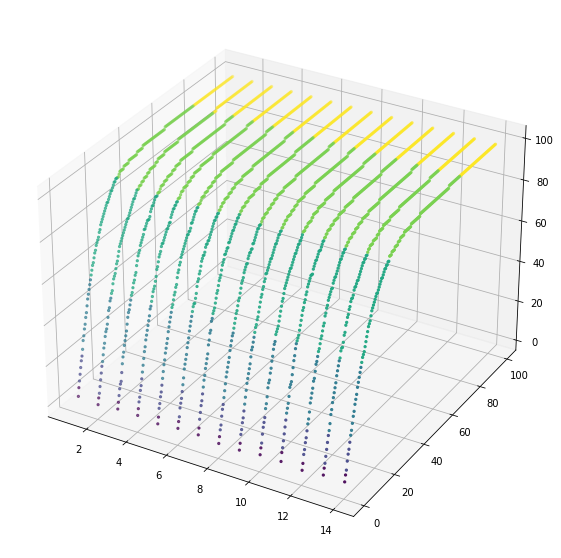

In [29]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import axes3d

fig = plt.figure(figsize = (10,10))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(newdataset1, newdataset2, newdataset3, s=5, c = col)
#ax.plot(newdataset1, newdataset2, newdataset3) 
plt.show()

In [27]:
col = np.arange(2786)
for i in range(0,2786) :
    col[i] = np.log((col[i]%199) +1)
col

array([0, 0, 1, ..., 5, 5, 5])

In [30]:
set_resultat[0,0]

1.0

In [64]:
newdataset1 = []
newdataset2 = []
newdataset3 = []

for i in range(len(set_resultat)):
    a = set_resultat[i,0]
    b = set_resultat[i,1]
    c = set_resultat[i,2]
    newdataset1.append(a)
    newdataset2.append(b)
    newdataset3.append(c)

In [65]:
newdataset1

[1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0

In [66]:
newdataset2

[0.5,
 1.0,
 1.5,
 2.0,
 2.5,
 3.0,
 3.5,
 4.0,
 4.5,
 5.0,
 5.5,
 6.0,
 6.5,
 7.0,
 7.5,
 8.0,
 8.5,
 9.0,
 9.5,
 10.0,
 10.5,
 11.0,
 11.5,
 12.0,
 12.5,
 13.0,
 13.5,
 14.0,
 14.5,
 15.0,
 15.5,
 16.0,
 16.5,
 17.0,
 17.5,
 18.0,
 18.5,
 19.0,
 19.5,
 20.0,
 20.5,
 21.0,
 21.5,
 22.0,
 22.5,
 23.0,
 23.5,
 24.0,
 24.5,
 25.0,
 25.5,
 26.0,
 26.5,
 27.0,
 27.5,
 28.0,
 28.5,
 29.0,
 29.5,
 30.0,
 30.5,
 31.0,
 31.5,
 32.0,
 32.5,
 33.0,
 33.5,
 34.0,
 34.5,
 35.0,
 35.5,
 36.0,
 36.5,
 37.0,
 37.5,
 38.0,
 38.5,
 39.0,
 39.5,
 40.0,
 40.5,
 41.0,
 41.5,
 42.0,
 42.5,
 43.0,
 43.5,
 44.0,
 44.5,
 45.0,
 45.5,
 46.0,
 46.5,
 47.0,
 47.5,
 48.0,
 48.5,
 49.0,
 49.5,
 50.0,
 50.5,
 51.0,
 51.5,
 52.0,
 52.5,
 53.0,
 53.5,
 54.0,
 54.5,
 55.0,
 55.5,
 56.0,
 56.5,
 57.0,
 57.5,
 58.0,
 58.5,
 59.0,
 59.5,
 60.0,
 60.5,
 61.0,
 61.5,
 62.0,
 62.5,
 63.0,
 63.5,
 64.0,
 64.5,
 65.0,
 65.5,
 66.0,
 66.5,
 67.0,
 67.5,
 68.0,
 68.5,
 69.0,
 69.5,
 70.0,
 70.5,
 71.0,
 71.5,
 72.0,
 72.5,
 73.

In [67]:
newdataset3

[3.0,
 7.0,
 10.0,
 13.0,
 16.0,
 19.0,
 21.0,
 24.0,
 28.0,
 30.0,
 33.0,
 35.0,
 38.0,
 40.0,
 43.0,
 46.0,
 48.0,
 50.0,
 52.0,
 54.0,
 56.0,
 58.0,
 60.0,
 61.0,
 63.0,
 65.0,
 66.0,
 68.0,
 69.0,
 70.0,
 71.0,
 73.0,
 74.0,
 76.0,
 77.0,
 78.0,
 79.0,
 80.0,
 81.0,
 82.0,
 83.0,
 84.0,
 84.0,
 85.0,
 86.0,
 87.0,
 88.0,
 88.0,
 89.0,
 90.0,
 91.0,
 91.0,
 92.0,
 92.0,
 92.0,
 92.0,
 93.0,
 94.0,
 94.0,
 94.0,
 94.0,
 94.0,
 95.0,
 95.0,
 95.0,
 95.0,
 95.0,
 95.0,
 96.0,
 96.0,
 96.0,
 96.0,
 96.0,
 96.0,
 96.0,
 96.0,
 96.0,
 96.0,
 97.0,
 97.0,
 97.0,
 97.0,
 97.0,
 97.0,
 97.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 98.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 99.0,
 

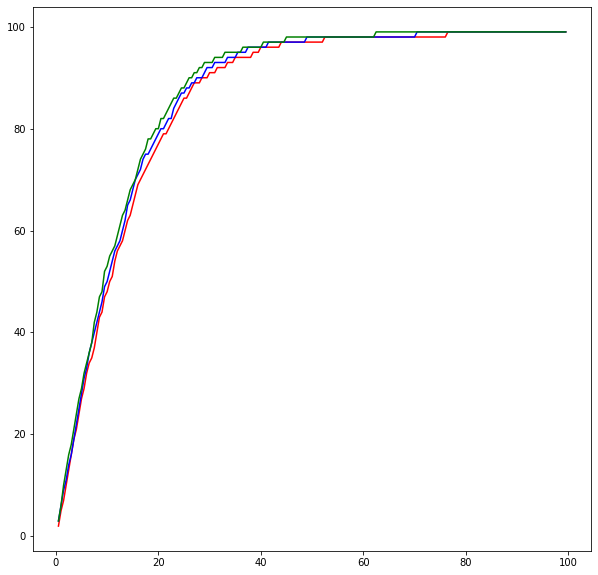

In [77]:
import matplotlib.pyplot as plt
#from mpl_toolkits.mplot3d import axes3d

fig = plt.figure(figsize = (10,10))
#ax = fig.add_subplot(111, projection='3d')
plt.plot(newdataset2[199:398], newdataset3[199:398], c='red')
plt.plot(newdataset2[597:796], newdataset3[597:796], c='blue')

plt.plot(newdataset2[1194:1393], newdataset3[1194:1393], c='green')

#plt.plot(newdataset2[1791:1990], newdataset3[1791:1990], c='green')

#plt.plot(newdataset2, newdataset3) 
plt.show()